**Chapter 16 – Reinforcement Learning**

This notebook contains all the sample code and solutions to the exersices in chapter 16.

# Setup

First, let's make sure this notebook works well in both python 2 and 3, import a few common modules, ensure MatplotLib plots figures inline and prepare a function to save the figures:

In [3]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os
import sys

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures and animations
%matplotlib nbagg
import matplotlib
import matplotlib.animation as animation
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "rl"

def save_fig(fig_id, tight_layout=True):
    path = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID, fig_id + ".png")
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format='png', dpi=300)

Note: there may be minor differences between the output of this notebook and the examples shown in the book. You can safely ignore these differences. They are mainly due to the fact that most of the environments provided by OpenAI gym have some randomness.

# Introduction to OpenAI gym

In this notebook we will be using [OpenAI gym](https://gym.openai.com/), a great toolkit for developing and comparing Reinforcement Learning algorithms. It provides many environments for your learning *agents* to interact with. Let's start by importing `gym`:

In [4]:
import gym

# Policy Gradients

To train this neural network we will need to define the target probabilities `y`. If an action is good we should increase its probability, and conversely if it is bad we should reduce it. But how do we know whether an action is good or bad? The problem is that most actions have delayed effects, so when you win or lose points in a game, it is not clear which actions contributed to this result: was it just the last action? Or the last 10? Or just one action 50 steps earlier? This is called the _credit assignment problem_.

The _Policy Gradients_ algorithm tackles this problem by first playing multiple games, then making the actions in good games slightly more likely, while actions in bad games are made slightly less likely. First we play, then we go back and think about what we did.

In [5]:
import tensorflow as tf

reset_graph()

n_inputs = 4
n_hidden = 4
n_outputs = 1

learning_rate = 0.01

initializer = tf.variance_scaling_initializer()

X = tf.placeholder(tf.float32, shape=[None, n_inputs])

hidden = tf.layers.dense(X, n_hidden, activation=tf.nn.elu, kernel_initializer=initializer)
logits = tf.layers.dense(hidden, n_outputs)
outputs = tf.nn.sigmoid(logits)  # probability of action 0 (left)
p_left_and_right = tf.concat(axis=1, values=[outputs, 1 - outputs])
action = tf.multinomial(tf.log(p_left_and_right), num_samples=1)

y = 1. - tf.to_float(action)
cross_entropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=logits)
optimizer = tf.train.AdamOptimizer(learning_rate)
grads_and_vars = optimizer.compute_gradients(cross_entropy)
gradients = [grad for grad, variable in grads_and_vars]
gradient_placeholders = []
grads_and_vars_feed = []
for grad, variable in grads_and_vars:
    gradient_placeholder = tf.placeholder(tf.float32, shape=grad.get_shape())
    gradient_placeholders.append(gradient_placeholder)
    grads_and_vars_feed.append((gradient_placeholder, variable))
training_op = optimizer.apply_gradients(grads_and_vars_feed)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [24]:
def discount_rewards(rewards, discount_rate):
    discounted_rewards = np.zeros(len(rewards))
    cumulative_rewards = 0
    for step in reversed(range(len(rewards))):
        cumulative_rewards = rewards[step] + cumulative_rewards * discount_rate
        discounted_rewards[step] = cumulative_rewards
    return discounted_rewards

def discount_and_normalize_rewards(all_rewards, discount_rate):
    all_discounted_rewards = [discount_rewards(rewards, discount_rate) for rewards in all_rewards]
    flat_rewards = np.concatenate(all_discounted_rewards)
    reward_mean = flat_rewards.mean()
    reward_std = flat_rewards.std()
    return [(discounted_rewards - reward_mean)/reward_std for discounted_rewards in all_discounted_rewards]

In [7]:
discount_rewards([10, 0, -50], discount_rate=0.8)

array([-22., -40., -50.])

In [8]:
discount_and_normalize_rewards([[10, 0, -50], [10, 20]], discount_rate=0.8)

[array([-0.28435071, -0.86597718, -1.18910299]),
 array([1.26665318, 1.0727777 ])]

In [9]:
env = gym.make("CartPole-v0")

n_games_per_update = 10
n_max_steps = 1000
n_iterations = 250
save_iterations = 10
discount_rate = 0.95

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        print("\rIteration: {}".format(iteration), end="")
        all_rewards = []
        all_gradients = []
        for game in range(n_games_per_update):
            current_rewards = []
            current_gradients = []
            obs = env.reset()
            for step in range(n_max_steps):
                action_val, gradients_val = sess.run([action, gradients], feed_dict={X: obs.reshape(1, n_inputs)})
                obs, reward, done, info = env.step(action_val[0][0])
                print(obs, reward, done, info)
                current_rewards.append(reward)
                current_gradients.append(gradients_val)
                if done:
                    break
            all_rewards.append(current_rewards)
            all_gradients.append(current_gradients)

        all_rewards = discount_and_normalize_rewards(all_rewards, discount_rate=discount_rate)
        feed_dict = {}
        for var_index, gradient_placeholder in enumerate(gradient_placeholders):
            mean_gradients = np.mean([reward * all_gradients[game_index][step][var_index]
                                      for game_index, rewards in enumerate(all_rewards)
                                          for step, reward in enumerate(rewards)], axis=0)
            feed_dict[gradient_placeholder] = mean_gradients
        sess.run(training_op, feed_dict=feed_dict)
        if iteration % save_iterations == 0:
            saver.save(sess, "./my_policy_net_pg.ckpt")

Iteration: 0[ 0.0499512  -0.15731604  0.02220163  0.26150108] 1.0 False {}
[ 0.04680488 -0.35274777  0.02743165  0.56110316] 1.0 False {}
[ 0.03974993 -0.54824374  0.03865372  0.8623007 ] 1.0 False {}
[ 0.02878505 -0.74387008  0.05589973  1.16688238] 1.0 False {}
[ 0.01390765 -0.93967311  0.07923738  1.47655412] 1.0 False {}
[-0.00488581 -0.74560339  0.10876846  1.20963435] 1.0 False {}
[-0.01979788 -0.94194871  0.13296115  1.53432679] 1.0 False {}
[-0.03863685 -0.74865531  0.16364768  1.28592129] 1.0 False {}
[-0.05360996 -0.94543752  0.18936611  1.62504893] 1.0 False {}
[-0.07251871 -1.14221566  0.22186709  1.97028115] 1.0 True {}
[-0.02007034  0.2093495   0.04721591 -0.29180428] 1.0 False {}
[-0.01588335  0.01358724  0.04137983  0.01538818] 1.0 False {}
[-0.01561161 -0.18210296  0.04168759  0.32083442] 1.0 False {}
[-0.01925367 -0.37779303  0.04810428  0.62636709] 1.0 False {}
[-0.02680953 -0.18337439  0.06063162  0.34921369] 1.0 False {}
[-0.03047702 -0.37930391  0.06761589  0.6603

[ 0.03136893  0.21457007  0.04782839 -0.28148528] 1.0 False {}
[ 0.03566033  0.40897832  0.04219869 -0.55870799] 1.0 False {}
[ 0.04383989  0.60348332  0.03102453 -0.83780302] 1.0 False {}
[ 0.05590956  0.79816815  0.01426847 -1.12056999] 1.0 False {}
[ 0.07187292  0.60286199 -0.00814293 -0.82344578] 1.0 False {}
[ 0.08393016  0.40785237 -0.02461185 -0.53333505] 1.0 False {}
[ 0.09208721  0.21308505 -0.03527855 -0.2485077 ] 1.0 False {}
[ 0.09634891  0.01848421 -0.0402487   0.03284219] 1.0 False {}
[ 0.09671859 -0.17603813 -0.03959186  0.31255948] 1.0 False {}
[ 0.09319783  0.01962483 -0.03334067  0.00765807] 1.0 False {}
[ 0.09359033 -0.1750035  -0.03318751  0.28963798] 1.0 False {}
[ 0.09009026  0.02057558 -0.02739475 -0.01332445] 1.0 False {}
[ 0.09050177 -0.174143   -0.02766124  0.27059079] 1.0 False {}
[ 0.08701891 -0.36885953 -0.02224942  0.55442248] 1.0 False {}
[ 0.07964172 -0.56366211 -0.01116097  0.84001324] 1.0 False {}
[ 0.06836848 -0.75862992  0.00563929  1.12916548] 1.0 F

[ 0.03643618  0.36607773 -0.02590177 -0.60463977] 1.0 False {}
[ 0.04375773  0.56155215 -0.03799456 -0.90536732] 1.0 False {}
[ 0.05498877  0.36696474 -0.05610191 -0.62486457] 1.0 False {}
[ 0.06232807  0.56282317 -0.0685992  -0.93467531] 1.0 False {}
[ 0.07358453  0.75880005 -0.08729271 -1.24810158] 1.0 False {}
[ 0.08876053  0.95492599 -0.11225474 -1.56680181] 1.0 False {}
[ 0.10785905  1.15119585 -0.14359077 -1.89228726] 1.0 False {}
[ 0.13088297  0.95789474 -0.18143652 -1.64739038] 1.0 False {}
[ 0.15004086  0.7652992  -0.21438433 -1.41628927] 1.0 True {}
[ 0.04557381  0.19573446  0.01908182 -0.30205427] 1.0 False {}
[ 0.0494885   0.39057933  0.01304074 -0.58865864] 1.0 False {}
[ 0.05730009  0.19527721  0.00126756 -0.29189651] 1.0 False {}
[ 0.06120563  0.39038107 -0.00457037 -0.5841794 ] 1.0 False {}
[ 0.06901325  0.19532344 -0.01625395 -0.29293969] 1.0 False {}
[ 0.07291972  0.39067331 -0.02211275 -0.59070425] 1.0 False {}
[ 0.08073319  0.58609777 -0.03392683 -0.8902699 ] 1.0 Fa

[ 0.52877142  0.55700179 -0.11380118  0.00545239] 1.0 False {}
[ 0.53991146  0.36368026 -0.11369213  0.2601736 ] 1.0 False {}
[ 0.54718506  0.17034938 -0.10848866  0.51494418] 1.0 False {}
[ 0.55059205  0.36681849 -0.09818978  0.19013998] 1.0 False {}
[ 0.55792842  0.17322836 -0.09438698  0.45030503] 1.0 False {}
[ 0.56139299  0.3695497  -0.08538088  0.12942523] 1.0 False {}
[ 0.56878398  0.56578438 -0.08279237 -0.18892604] 1.0 False {}
[ 0.58009967  0.76198721 -0.08657089 -0.50653536] 1.0 False {}
[ 0.59533942  0.56818499 -0.0967016  -0.24234075] 1.0 False {}
[ 0.60670311  0.37456779 -0.10154841  0.01834221] 1.0 False {}
[ 0.61419447  0.57098837 -0.10118157 -0.30457478] 1.0 False {}
[ 0.62561424  0.37744297 -0.10727307 -0.04543817] 1.0 False {}
[ 0.6331631   0.18400973 -0.10818183  0.21156601] 1.0 False {}
[ 0.63684329 -0.00941253 -0.10395051  0.46825985] 1.0 False {}
[ 0.63665504  0.18701256 -0.09458531  0.14470622] 1.0 False {}
[ 0.64039529  0.38335285 -0.09169119 -0.17625443] 1.0 F

[-0.01701457 -0.42234394 -0.00080764  0.55106843] 1.0 False {}
[-0.02546145 -0.22721065  0.01021373  0.25813115] 1.0 False {}
[-0.03000566 -0.03223599  0.01537635 -0.0313128 ] 1.0 False {}
[-0.03065038  0.16266212  0.0147501  -0.31910494] 1.0 False {}
[-0.02739714  0.35757092  0.008368   -0.60709997] 1.0 False {}
[-0.02024572  0.55257488 -0.003774   -0.89713551] 1.0 False {}
[-0.00919422  0.35750429 -0.02171671 -0.60564126] 1.0 False {}
[-0.00204413  0.16269264 -0.03382954 -0.31987691] 1.0 False {}
[ 0.00120972  0.35827964 -0.04022708 -0.62303353] 1.0 False {}
[ 0.00837531  0.5539395  -0.05268775 -0.92810945] 1.0 False {}
[ 0.0194541   0.74973168 -0.07124994 -1.23687322] 1.0 False {}
[ 0.03444873  0.94569309 -0.0959874  -1.55099929] 1.0 False {}
[ 0.0533626   0.75184465 -0.12700739 -1.28974212] 1.0 False {}
[ 0.06839949  0.94833232 -0.15280223 -1.61933954] 1.0 False {}
[ 0.08736614  1.14488913 -0.18518902 -1.95548871] 1.0 False {}
[ 0.11026392  0.95215396 -0.22429879 -1.72546409] 1.0 T

[-0.06744139  0.02368461 -0.00372126 -0.01244933] 1.0 False {}
[-0.06696769  0.21885973 -0.00397024 -0.30630403] 1.0 False {}
[-0.0625905   0.02379458 -0.01009632 -0.01487586] 1.0 False {}
[-0.06211461  0.21905986 -0.01039384 -0.31072712] 1.0 False {}
[-0.05773341  0.02408753 -0.01660838 -0.02134014] 1.0 False {}
[-0.05725166  0.21944367 -0.01703519 -0.31921659] 1.0 False {}
[-0.05286279  0.41480404 -0.02341952 -0.61722273] 1.0 False {}
[-0.0445667   0.22001695 -0.03576397 -0.33200692] 1.0 False {}
[-0.04016637  0.02542183 -0.04240411 -0.05081326] 1.0 False {}
[-0.03965793 -0.16906725 -0.04342038  0.22819504] 1.0 False {}
[-0.04303927  0.02664745 -0.03885647 -0.07786189] 1.0 False {}
[-0.04250632 -0.16789655 -0.04041371  0.20231292] 1.0 False {}
[-0.04586426  0.02777937 -0.03636745 -0.10283971] 1.0 False {}
[-0.04530867  0.22340313 -0.03842425 -0.40677099] 1.0 False {}
[-0.04084061  0.0288465  -0.04655967 -0.12644541] 1.0 False {}
[-0.04026368  0.22460347 -0.04908858 -0.43344624] 1.0 F

[-0.02691602 -1.73550391 -0.0161294   1.71157527] 1.0 False {}
[-0.0616261  -1.54020049  0.0181021   1.41391642] 1.0 False {}
[-0.09243011 -1.73554201  0.04638043  1.71220241] 1.0 False {}
[-0.12714095 -1.54098226  0.08062448  1.43430759] 1.0 False {}
[-0.1579606  -1.34694203  0.10931063  1.16787064] 1.0 False {}
[-0.18489944 -1.15339867  0.13266804  0.9113617 ] 1.0 False {}
[-0.20796741 -1.35004207  0.15089528  1.24262489] 1.0 False {}
[-0.23496825 -1.15714397  0.17574778  1.00076067] 1.0 False {}
[-0.25811113 -0.96475044  0.19576299  0.76802006] 1.0 False {}
[-0.27740614 -1.16195085  0.21112339  1.11535816] 1.0 True {}
[ 0.0241111  -0.19403987 -0.01506785  0.29566682] 1.0 False {}
[ 0.02023031 -0.38894381 -0.00915452  0.58355976] 1.0 False {}
[ 0.01245143 -0.19369482  0.00251668  0.28800715] 1.0 False {}
[ 0.00857753 -0.38885257  0.00827682  0.58148275] 1.0 False {}
[ 8.00483575e-04 -5.84089505e-01  1.99064774e-02  8.76761481e-01] 1.0 False {}
[-0.01088131 -0.77947628  0.03744171  1.

[-0.09628273 -0.5321948  -0.07617296  0.02778555] 1.0 False {}
[-0.10692662 -0.72614641 -0.07561724  0.29549615] 1.0 False {}
[-0.12144955 -0.92011346 -0.06970732  0.56340502] 1.0 False {}
[-0.13985182 -0.7240862  -0.05843922  0.24960086] 1.0 False {}
[-0.15433354 -0.91832702 -0.0534472   0.52329336] 1.0 False {}
[-0.17270008 -1.11265761 -0.04298134  0.798667  ] 1.0 False {}
[-0.19495324 -0.91697317 -0.027008    0.49277882] 1.0 False {}
[-0.2132927  -0.72148091 -0.01715242  0.19170797] 1.0 False {}
[-0.22772232 -0.52611783 -0.01331826 -0.1063361 ] 1.0 False {}
[-0.23824467 -0.33080758 -0.01544498 -0.40319094] 1.0 False {}
[-0.24486083 -0.13547002 -0.0235088  -0.70070298] 1.0 False {}
[-0.24757023 -0.33025833 -0.03752286 -0.4155122 ] 1.0 False {}
[-0.25417539 -0.13462522 -0.04583311 -0.71978445] 1.0 False {}
[-0.2568679  -0.32908406 -0.06022879 -0.44187271] 1.0 False {}
[-0.26344958 -0.52330431 -0.06906625 -0.16876715] 1.0 False {}
[-0.27391566 -0.32726523 -0.07244159 -0.48241403] 1.0 F

[ 0.03041559 -0.19551411 -0.04385944  0.26596974] 1.0 False {}
[ 0.02650531 -0.38998353 -0.03854005  0.5445028 ] 1.0 False {}
[ 0.01870564 -0.1943418  -0.02764999  0.23993016] 1.0 False {}
[ 0.0148188   0.00116401 -0.02285139 -0.06134452] 1.0 False {}
[ 0.01484208 -0.19362298 -0.02407828  0.22404196] 1.0 False {}
[ 0.01096962 -0.38839267 -0.01959744  0.50903347] 1.0 False {}
[ 0.00320177 -0.19300017 -0.00941677  0.21023973] 1.0 False {}
[-0.00065823 -0.38798622 -0.00521198  0.49993735] 1.0 False {}
[-0.00841796 -0.58303431  0.00478677  0.79097319] 1.0 False {}
[-0.02007864 -0.77822166  0.02060623  1.08515817] 1.0 False {}
[-0.03564308 -0.58337753  0.0423094   0.79901183] 1.0 False {}
[-0.04731063 -0.38886075  0.05828963  0.51993303] 1.0 False {}
[-0.05508784 -0.58475276  0.0686883   0.83039944] 1.0 False {}
[-0.0667829  -0.39063354  0.08529628  0.56008573] 1.0 False {}
[-0.07459557 -0.58684257  0.096498    0.878376  ] 1.0 False {}
[-0.08633242 -0.78313402  0.11406552  1.19976975] 1.0 F

[-0.01120587  0.03057214  0.03322887  0.01683955] 1.0 False {}
[-0.01059443  0.22520218  0.03356566 -0.26517686] 1.0 False {}
[-0.00609039  0.41982937  0.02826212 -0.54708676] 1.0 False {}
[ 0.0023062   0.6145431   0.01732039 -0.83073275] 1.0 False {}
[ 0.01459706  0.41918874  0.00070573 -0.53265323] 1.0 False {}
[ 0.02298084  0.22405687 -0.00994733 -0.23974802] 1.0 False {}
[ 0.02746197  0.4193195  -0.01474229 -0.53555194] 1.0 False {}
[ 0.03584836  0.61464562 -0.02545333 -0.83284335] 1.0 False {}
[ 0.04814128  0.41988056 -0.0421102  -0.54827286] 1.0 False {}
[ 0.05653889  0.22537469 -0.05307566 -0.26914945] 1.0 False {}
[ 0.06104638  0.03104876 -0.05845865  0.00633206] 1.0 False {}
[ 0.06166736  0.22695825 -0.058332   -0.30420725] 1.0 False {}
[ 0.06620652  0.42286089 -0.06441615 -0.61470129] 1.0 False {}
[ 0.07466374  0.61882096 -0.07671018 -0.92695703] 1.0 False {}
[ 0.08704016  0.42481397 -0.09524932 -0.65933301] 1.0 False {}
[ 0.09553644  0.23113763 -0.10843598 -0.39809631] 1.0 F

[-0.18740143 -0.86750703 -0.13250553  0.07546059] 1.0 False {}
[-0.20475157 -1.06050506 -0.13099632  0.32357717] 1.0 False {}
[-0.22596167 -0.86378479 -0.12452478 -0.00737793] 1.0 False {}
[-0.24323737 -0.66711737 -0.12467234 -0.33661055] 1.0 False {}
[-0.25657972 -0.86026502 -0.13140455 -0.08569654] 1.0 False {}
[-0.27378502 -1.05328253 -0.13311848  0.16281181] 1.0 False {}
[-0.29485067 -1.24627251 -0.12986224  0.41071431] 1.0 False {}
[-0.31977612 -1.43933733 -0.12164796  0.65980077] 1.0 False {}
[-0.34856286 -1.63257516 -0.10845194  0.91183913] 1.0 False {}
[-0.38121437 -1.43616619 -0.09021516  0.58713417] 1.0 False {}
[-0.40993769 -1.62991656 -0.07847248  0.85009057] 1.0 False {}
[-0.44253602 -1.43381726 -0.06147066  0.53379959] 1.0 False {}
[-0.47121237 -1.23788713 -0.05079467  0.22239849] 1.0 False {}
[-0.49597011 -1.43224765 -0.0463467   0.49863603] 1.0 False {}
[-0.52461506 -1.62668658 -0.03637398  0.77636018] 1.0 False {}
[-0.5571488  -1.82128989 -0.02084678  1.05738046] 1.0 F

[-0.00630685  0.61775646 -0.05402038 -0.88912009] 1.0 False {}
[ 0.00604828  0.42340754 -0.07180278 -0.61389625] 1.0 False {}
[ 0.01451643  0.61945551 -0.0840807  -0.92830234] 1.0 False {}
[ 0.02690554  0.81560579 -0.10264675 -1.24617897] 1.0 False {}
[ 0.04321766  1.01188349 -0.12757033 -1.56917102] 1.0 False {}
[ 0.06345533  0.81849472 -0.15895375 -1.31884912] 1.0 False {}
[ 0.07982522  0.62569903 -0.18533073 -1.07983719] 1.0 False {}
[ 0.0923392   0.82271931 -0.20692748 -1.42448261] 1.0 False {}
[ 0.10879359  0.63066746 -0.23541713 -1.2029539 ] 1.0 True {}
Iteration: 6[ 0.03246362 -0.2348784  -0.00126526  0.30694675] 1.0 False {}
[ 0.02776605 -0.4299823   0.00487367  0.59923038] 1.0 False {}
[ 0.0191664  -0.23492887  0.01685828  0.30808657] 1.0 False {}
[ 0.01446783 -0.04005114  0.02302001  0.02076761] 1.0 False {}
[ 0.0136668   0.15473325  0.02343537 -0.26456427] 1.0 False {}
[ 0.01676147 -0.04071523  0.01814408  0.0354173 ] 1.0 False {}
[ 0.01594716  0.1541419   0.01885243 -0.2514

[-0.07360081 -0.41927903 -0.06050402  0.17555158] 1.0 False {}
[-0.08198639 -0.61348524 -0.05699299  0.44855053] 1.0 False {}
[-0.0942561  -0.80775666 -0.04802198  0.72273764] 1.0 False {}
[-0.11041123 -0.61200453 -0.03356723  0.41533491] 1.0 False {}
[-0.12265132 -0.4164233  -0.02526053  0.11226142] 1.0 False {}
[-0.13097979 -0.61117435 -0.0230153   0.396869  ] 1.0 False {}
[-0.14320327 -0.80596234 -0.01507792  0.68220769] 1.0 False {}
[-0.15932252 -1.00087169 -0.00143377  0.97010574] 1.0 False {}
[-0.17933995 -1.19597436  0.01796835  1.26233792] 1.0 False {}
[-0.20325944 -1.00108672  0.04321511  0.97533606] 1.0 False {}
[-0.22328118 -1.19676085  0.06272183  1.28127451] 1.0 False {}
[-0.24721639 -1.00249152  0.08834732  1.00887165] 1.0 False {}
[-0.26726622 -0.80865282  0.10852475  0.74518792] 1.0 False {}
[-0.28343928 -1.00509168  0.12342851  1.06995641] 1.0 False {}
[-0.30354111 -0.81179882  0.14482764  0.81841879] 1.0 False {}
[-0.31977709 -0.61892463  0.16119601  0.57456699] 1.0 F

[-0.01020618  0.18130992 -0.02142121 -0.2953758 ] 1.0 False {}
[-0.00657998  0.37673061 -0.02732873 -0.59473693] 1.0 False {}
[ 0.00095463  0.18200161 -0.03922347 -0.31078614] 1.0 False {}
[ 0.00459466  0.37765979 -0.04543919 -0.61557643] 1.0 False {}
[ 0.01214786  0.18320118 -0.05775072 -0.33754411] 1.0 False {}
[ 0.01581188 -0.01105345 -0.0645016  -0.06361721] 1.0 False {}
[ 0.01559081  0.18493115 -0.06577395 -0.37593311] 1.0 False {}
[ 0.01928944 -0.00919792 -0.07329261 -0.10469275] 1.0 False {}
[ 0.01910548  0.18689367 -0.07538646 -0.41956921] 1.0 False {}
[ 0.02284335 -0.00708364 -0.08377785 -0.15157228] 1.0 False {}
[ 0.02270168 -0.20091228 -0.08680929  0.11354906] 1.0 False {}
[ 0.01868343 -0.39469001 -0.08453831  0.37763125] 1.0 False {}
[ 0.01078963 -0.19847553 -0.07698569  0.05953595] 1.0 False {}
[ 0.00682012 -0.39241408 -0.07579497  0.32697069] 1.0 False {}
[-0.00102816 -0.5863797  -0.06925556  0.59482139] 1.0 False {}
[-0.01275575 -0.39036027 -0.05735913  0.28115223] 1.0 F

[ 0.06388441 -0.17900696 -0.11699034  0.10365229] 1.0 False {}
[ 0.06030427  0.01758033 -0.1149173  -0.22352973] 1.0 False {}
[ 0.06065588 -0.17572763 -0.11938789  0.03080833] 1.0 False {}
[ 0.05714133 -0.36895315 -0.11877173  0.28356674] 1.0 False {}
[ 0.04976226 -0.17235508 -0.11310039 -0.04408963] 1.0 False {}
[ 0.04631516  0.0241917  -0.11398218 -0.37020686] 1.0 False {}
[ 0.046799   -0.16914191 -0.12138632 -0.11552648] 1.0 False {}
[ 0.04341616  0.02749131 -0.12369685 -0.44390599] 1.0 False {}
[ 0.04396598  0.22412647 -0.13257497 -0.77287929] 1.0 False {}
[ 0.04844851  0.42079905 -0.14803256 -1.10416236] 1.0 False {}
[ 0.05686449  0.22790084 -0.1701158  -0.86134238] 1.0 False {}
[ 0.06142251  0.03545285 -0.18734265 -0.6266105 ] 1.0 False {}
[ 0.06213157 -0.15662856 -0.19987486 -0.39828687] 1.0 False {}
[ 0.058999    0.04068428 -0.2078406  -0.74673654] 1.0 False {}
[ 0.05981268  0.23797495 -0.22277533 -1.09696979] 1.0 True {}
Iteration: 8[-0.04807868 -0.24420996 -0.01615844  0.2792

[ 0.00970925  0.03500366  0.02867194 -0.06622012] 1.0 False {}
[ 0.01040932 -0.16051738  0.02734754  0.2353693 ] 1.0 False {}
[ 0.00719897 -0.35601917  0.03205492  0.5365515 ] 1.0 False {}
[ 7.85874266e-05 -5.51576820e-01  4.27859529e-02  8.39159816e-01] 1.0 False {}
[-0.01095295 -0.35706439  0.05956915  0.56023342] 1.0 False {}
[-0.01809424 -0.16282687  0.07077382  0.2868969 ] 1.0 False {}
[-0.02135077 -0.35888302  0.07651176  0.60103504] 1.0 False {}
[-0.02852843 -0.16491007  0.08853246  0.33339936] 1.0 False {}
[-0.03182664 -0.36117323  0.09520044  0.65263567] 1.0 False {}
[-0.0390501  -0.55748296  0.10825316  0.97371358] 1.0 False {}
[-0.05019976 -0.36396677  0.12772743  0.71690275] 1.0 False {}
[-0.05747909 -0.56060333  0.14206548  1.04690472] 1.0 False {}
[-0.06869116 -0.75729549  0.16300358  1.38059754] 1.0 False {}
[-0.08383707 -0.95403307  0.19061553  1.71950319] 1.0 False {}
[-0.10291773 -1.15075976  0.22500559  2.0649507 ] 1.0 True {}
[ 0.00124189  0.1611923   0.03457184 -0.

[-0.05526034  0.00486112  0.00968379 -0.05301246] 1.0 False {}
[-0.05516312 -0.19039834  0.00862354  0.24270998] 1.0 False {}
[-0.05897108 -0.3856424   0.01347774  0.53810048] 1.0 False {}
[-0.06668393 -0.58095122  0.02423975  0.83499943] 1.0 False {}
[-0.07830296 -0.77639578  0.04093974  1.13520593] 1.0 False {}
[-0.09383087 -0.58183269  0.06364386  0.85563877] 1.0 False {}
[-0.10546753 -0.38763308  0.08075663  0.58362778] 1.0 False {}
[-0.11322019 -0.19372979  0.09242919  0.3174374 ] 1.0 False {}
[-1.17094783e-01 -3.75301533e-05  9.87779365e-02  5.52746934e-02] 1.0 False {}
[-0.11709553  0.19353954  0.09988343 -0.20468199] 1.0 False {}
[-0.11322474  0.38710177  0.09578979 -0.46426128] 1.0 False {}
[-0.10548271  0.19076597  0.08650456 -0.14298853] 1.0 False {}
[-0.10166739  0.38454938  0.08364479 -0.40717613] 1.0 False {}
[-0.0939764   0.18834715  0.07550127 -0.08933882] 1.0 False {}
[-0.09020946  0.38231025  0.0737145  -0.35727831] 1.0 False {}
[-0.08256325  0.18622195  0.06656893 -0

[ 0.07919331  0.1716894  -0.13392865 -0.58661626] 1.0 False {}
[ 0.08262709 -0.02132772 -0.14566098 -0.33894071] 1.0 False {}
[ 0.08220054 -0.21410919 -0.15243979 -0.09550384] 1.0 False {}
[ 0.07791836 -0.40675496 -0.15434987  0.14546988] 1.0 False {}
[ 0.06978326 -0.59936837 -0.15144047  0.38575633] 1.0 False {}
[ 0.05779589 -0.79205252 -0.14372534  0.62712107] 1.0 False {}
[ 0.04195484 -0.98490697 -0.13118292  0.87131012] 1.0 False {}
[ 0.0222567  -1.17802418 -0.11375672  1.12003974] 1.0 False {}
[-0.00130378 -0.98160893 -0.09135593  0.79394873] 1.0 False {}
[-0.02093596 -0.7853597  -0.07547695  0.47398113] 1.0 False {}
[-0.03664316 -0.58925752 -0.06599733  0.15849616] 1.0 False {}
[-0.04842831 -0.78337555 -0.06282741  0.42965019] 1.0 False {}
[-0.06409582 -0.58742276 -0.0542344   0.11784181] 1.0 False {}
[-0.07584427 -0.7817274  -0.05187757  0.39293313] 1.0 False {}
[-0.09147882 -0.97607625 -0.0440189   0.66881905] 1.0 False {}
[-0.11100035 -0.78037076 -0.03064252  0.36260779] 1.0 F

[-0.07600826 -0.73252029  0.01127322  0.85864508] 1.0 False {}
[-0.09065867 -0.92779398  0.02844612  1.15485125] 1.0 False {}
[-0.10921455 -1.12327509  0.05154315  1.45631633] 1.0 False {}
[-0.13168005 -1.31899032  0.08066947  1.76464627] 1.0 False {}
[-0.15805986 -1.1248677   0.1159624   1.49810038] 1.0 False {}
[-0.18055721 -0.93133019  0.14592441  1.24376043] 1.0 False {}
[-0.19918382 -0.73835053  0.17079962  1.00011713] 1.0 False {}
[-0.21395083 -0.93529246  0.19080196  1.34120281] 1.0 False {}
[-0.23265668 -0.74301414  0.21762601  1.11377543] 1.0 True {}
[ 0.03329041 -0.22016513 -0.01913183  0.32453393] 1.0 False {}
[ 0.02888711 -0.02477606 -0.01264115  0.02587956] 1.0 False {}
[ 0.02839159  0.17052487 -0.01212356 -0.27076484] 1.0 False {}
[ 0.03180209  0.36581771 -0.01753885 -0.5672468 ] 1.0 False {}
[ 0.03911844  0.56118124 -0.02888379 -0.86540318] 1.0 False {}
[ 0.05034207  0.36646407 -0.04619185 -0.58193992] 1.0 False {}
[ 0.05767135  0.17201872 -0.05783065 -0.30415857] 1.0 Fa

[ 0.0330034   0.03957727 -0.03181877 -0.04079472] 1.0 False {}
[ 0.03379495  0.23514071 -0.03263466 -0.34334453] 1.0 False {}
[ 0.03849776  0.43071137 -0.03950155 -0.64613721] 1.0 False {}
[ 0.04711199  0.23616146 -0.0524243  -0.36615042] 1.0 False {}
[ 0.05183522  0.04182216 -0.05974731 -0.09044765] 1.0 False {}
[ 0.05267166 -0.15239477 -0.06155626  0.18280267] 1.0 False {}
[ 0.04962377  0.04355149 -0.0579002  -0.12864616] 1.0 False {}
[ 0.0504948   0.23945303 -0.06047313 -0.43901919] 1.0 False {}
[ 0.05528386  0.04523678 -0.06925351 -0.16599561] 1.0 False {}
[ 0.05618859 -0.14882901 -0.07257342  0.10406104] 1.0 False {}
[ 0.05321201  0.0472539  -0.0704922  -0.21060697] 1.0 False {}
[ 0.05415709  0.24330925 -0.07470434 -0.52466718] 1.0 False {}
[ 0.05902328  0.43939862 -0.08519769 -0.83992353] 1.0 False {}
[ 0.06781125  0.24553677 -0.10199616 -0.57520332] 1.0 False {}
[ 0.07272198  0.44192953 -0.11350022 -0.89819635] 1.0 False {}
[ 0.08156057  0.24851378 -0.13146415 -0.64323693] 1.0 F

[ 0.04959197  0.35616256 -0.05507157 -0.63666458] 1.0 False {}
[ 0.05671522  0.16185013 -0.06780486 -0.36182068] 1.0 False {}
[ 0.05995223 -0.03224584 -0.07504127 -0.0912651 ] 1.0 False {}
[ 0.05930731 -0.22621646 -0.07686657  0.17683057] 1.0 False {}
[ 0.05478298 -0.03008344 -0.07332996 -0.13907678] 1.0 False {}
[ 0.05418131 -0.22408268 -0.0761115   0.12960035] 1.0 False {}
[ 0.04969966 -0.41803649 -0.07351949  0.39733361] 1.0 False {}
[ 0.04133893 -0.61204258 -0.06557282  0.66596137] 1.0 False {}
[ 0.02909808 -0.41607283 -0.05225359  0.3533739 ] 1.0 False {}
[ 0.02077662 -0.61041432 -0.04518611  0.62913268] 1.0 False {}
[ 0.00856833 -0.80487753 -0.03260346  0.90724956] 1.0 False {}
[-0.00752922 -0.60932971 -0.01445847  0.60449999] 1.0 False {}
[-0.01971581 -0.41400858 -0.00236847  0.30729827] 1.0 False {}
[-0.02799598 -0.6090967   0.0037775   0.5992333 ] 1.0 False {}
[-0.04017792 -0.8042713   0.01576216  0.89310369] 1.0 False {}
[-0.05626334 -0.60936664  0.03362424  0.60541691] 1.0 F

[-0.03313367 -0.18262278 -0.02544024  0.25167735] 1.0 False {}
[-0.03678612  0.01285303 -0.02040669 -0.04892012] 1.0 False {}
[-0.03652906  0.20826156 -0.0213851  -0.34797104] 1.0 False {}
[-0.03236383  0.40368105 -0.02834452 -0.64731999] 1.0 False {}
[-0.02429021  0.59918621 -0.04129092 -0.9487921 ] 1.0 False {}
[-0.01230649  0.79483901 -0.06026676 -1.25415724] 1.0 False {}
[ 0.00359029  0.99067878 -0.0853499  -1.56509127] 1.0 False {}
[ 0.02340387  0.79667437 -0.11665173 -1.30020637] 1.0 False {}
[ 0.03933736  0.60321004 -0.14265586 -1.04619996] 1.0 False {}
[ 0.05140156  0.41023992 -0.16357985 -0.80148381] 1.0 False {}
[ 0.05960636  0.60718199 -0.17960953 -1.14083162] 1.0 False {}
[ 0.07175     0.804138   -0.20242616 -1.48403489] 1.0 False {}
[ 0.08783276  1.00106997 -0.23210686 -1.832509  ] 1.0 True {}
[-0.00946538  0.21999145 -0.03419098 -0.29213706] 1.0 False {}
[-0.00506555  0.41558379 -0.04003372 -0.5954043 ] 1.0 False {}
[ 0.00324613  0.22104433 -0.0519418  -0.31559568] 1.0 Fa

[-0.12333423  0.23034555  0.13296003 -0.09196277] 1.0 False {}
[-0.11872731  0.03359326  0.13112078  0.23953599] 1.0 False {}
[-0.11805545  0.2266221   0.1359115  -0.00908269] 1.0 False {}
[-0.11352301  0.41955964  0.13572984 -0.25598508] 1.0 False {}
[-0.10513181  0.61250899  0.13061014 -0.50296507] 1.0 False {}
[-0.09288164  0.80557156  0.12055084 -0.75180204] 1.0 False {}
[-0.0767702   0.60901175  0.1055148  -0.42374594] 1.0 False {}
[-0.06458997  0.80249309  0.09703988 -0.68139006] 1.0 False {}
[-0.04854011  0.99614294  0.08341208 -0.94201328] 1.0 False {}
[-0.02861725  0.80000203  0.06457181 -0.62433009] 1.0 False {}
[-0.01261721  0.60404084  0.05208521 -0.31202996] 1.0 False {}
[-0.00053639  0.40821704  0.04584461 -0.00338648] 1.0 False {}
[ 0.00762795  0.60265255  0.04577688 -0.28125972] 1.0 False {}
[ 0.019681    0.79709265  0.04015169 -0.55916063] 1.0 False {}
[ 0.03562285  0.9916287   0.02896847 -0.83892809] 1.0 False {}
[ 0.05545543  1.18634337  0.01218991 -1.12236201] 1.0 F

[-0.01570877 -0.21907079  0.10790721  0.62232757] 1.0 False {}
[-0.02009018 -0.41552089  0.12035376  0.94695198] 1.0 False {}
[-0.0284006  -0.22220723  0.1392928   0.69437772] 1.0 False {}
[-0.03284475 -0.41895827  0.15318036  1.02746559] 1.0 False {}
[-0.04122391 -0.61575046  0.17372967  1.36405657] 1.0 False {}
[-0.05353892 -0.42317746  0.2010108   1.13036527] 1.0 False {}
[-0.06200247 -0.62028135  0.22361811  1.47876817] 1.0 True {}
[-0.02143286  0.22376895  0.03896999 -0.2979445 ] 1.0 False {}
[-0.01695748  0.41831435  0.0330111  -0.57808677] 1.0 False {}
[-0.00859119  0.22274566  0.02144936 -0.27519006] 1.0 False {}
[-0.00413628  0.41755512  0.01594556 -0.5610314 ] 1.0 False {}
[ 0.00421482  0.22221305  0.00472493 -0.26336776] 1.0 False {}
[ 0.00865908  0.02702398 -0.00054242  0.03080171] 1.0 False {}
[ 9.19956424e-03  2.22153706e-01  7.36106478e-05 -2.62052308e-01] 1.0 False {}
[ 0.01364264  0.0270307  -0.00516744  0.03065384] 1.0 False {}
[ 0.01418325 -0.16801676 -0.00455436  0.

[ 0.19583778 -0.20797669 -0.21272712 -0.22517106] 1.0 True {}
[ 0.01156867 -0.17173617 -0.01751782  0.26033964] 1.0 False {}
[ 0.00813395 -0.36660373 -0.01231103  0.54744615] 1.0 False {}
[ 8.01872617e-04 -5.61550575e-01 -1.36210251e-03  8.36224909e-01] 1.0 False {}
[-0.01042914 -0.36641005  0.0153624   0.54311393] 1.0 False {}
[-0.01775734 -0.17150732  0.02622467  0.25531071] 1.0 False {}
[-0.02118749  0.02323057  0.03133089 -0.02898652] 1.0 False {}
[-0.02072287  0.21788953  0.03075116 -0.31162189] 1.0 False {}
[-0.01636508  0.41256019  0.02451872 -0.59445041] 1.0 False {}
[-0.00811388  0.2171038   0.01262971 -0.29414616] 1.0 False {}
[-0.0037718   0.02180408  0.00674679  0.00249309] 1.0 False {}
[-0.00333572 -0.17341398  0.00679665  0.29729705] 1.0 False {}
[-0.006804   -0.36863215  0.01274259  0.59211575] 1.0 False {}
[-0.01417665 -0.17369089  0.02458491  0.30347381] 1.0 False {}
[-0.01765046  0.02107222  0.03065438  0.01864467] 1.0 False {}
[-0.01722902 -0.17447563  0.03102728  0.

[-0.02025241  0.40315129 -0.04435148 -0.68567871] 1.0 False {}
[-0.01218939  0.59885999 -0.05806506 -0.99198813] 1.0 False {}
[-2.12188410e-04  4.04561073e-01 -7.79048198e-02 -7.18092470e-01] 1.0 False {}
[ 0.00787903  0.21059868 -0.09226667 -0.45091219] 1.0 False {}
[ 0.01209101  0.40689617 -0.10128491 -0.77119391] 1.0 False {}
[ 0.02022893  0.60325522 -0.11670879 -1.09394987] 1.0 False {}
[ 0.03229403  0.79970493 -0.13858779 -1.42085439] 1.0 False {}
[ 0.04828813  0.60654282 -0.16700488 -1.17450376] 1.0 False {}
[ 0.06041899  0.41393739 -0.19049495 -0.93848669] 1.0 False {}
[ 0.06869774  0.22182307 -0.20926469 -0.71119545] 1.0 False {}
[ 0.0731342   0.41913376 -0.22348859 -1.06178043] 1.0 True {}
Iteration: 13[-0.03536278  0.2437082   0.02378189 -0.32042756] 1.0 False {}
[-0.03048861  0.43848353  0.01737334 -0.60551673] 1.0 False {}
[-0.02171894  0.243123    0.00526301 -0.30741265] 1.0 False {}
[-0.01685648  0.04792645 -0.00088525 -0.01307456] 1.0 False {}
[-0.01589795 -0.14718279 -0

[-0.113589   -0.23135334  0.22079275  1.3217091 ] 1.0 True {}
[ 0.01604138  0.2088302   0.03158859 -0.25150865] 1.0 False {}
[0.02021799 0.01327175 0.02655841 0.05096819] 1.0 False {}
[ 0.02048342 -0.18222076  0.02757778  0.35191079] 1.0 False {}
[ 0.01683901 -0.37772381  0.03461599  0.65316069] 1.0 False {}
[ 0.00928453 -0.18310055  0.04767921  0.37157578] 1.0 False {}
[ 0.00562252 -0.3788663   0.05511072  0.67890306] 1.0 False {}
[-0.00195481 -0.57470877  0.06868878  0.98841512] 1.0 False {}
[-0.01344898 -0.77067976  0.08845709  1.30185704] 1.0 False {}
[-0.02886258 -0.96680564  0.11449423  1.62086812] 1.0 False {}
[-0.04819869 -0.77320346  0.14691159  1.36595402] 1.0 False {}
[-0.06366276 -0.5801944   0.17423067  1.12259592] 1.0 False {}
[-0.07526665 -0.77711869  0.19668259  1.46447529] 1.0 False {}
[-0.09080902 -0.97403007  0.22597209  1.81160035] 1.0 True {}
[-0.01420895  0.22657347 -0.02603921 -0.27693924] 1.0 False {}
[-0.00967748  0.42205705 -0.03157799 -0.57771987] 1.0 False {

[ 0.06769008  0.16752882  0.01198293 -0.13444377] 1.0 False {}
[ 0.07104066  0.3624771   0.00929405 -0.4233223 ] 1.0 False {}
[ 0.0782902   0.16722473  0.00082761 -0.12772398] 1.0 False {}
[ 0.08163469 -0.02790907 -0.00172687  0.16521994] 1.0 False {}
[ 0.08107651 -0.22300626  0.00157753  0.45735758] 1.0 False {}
[ 0.07661639 -0.02790664  0.01072468  0.16517232] 1.0 False {}
[ 0.07605825  0.16706016  0.01402812 -0.12410807] 1.0 False {}
[ 0.07939946 -0.02825993  0.01154596  0.17296737] 1.0 False {}
[ 0.07883426 -0.22354521  0.01500531  0.4692702 ] 1.0 False {}
[ 0.07436335 -0.02863841  0.02439071  0.18135431] 1.0 False {}
[ 0.07379059  0.16612618  0.0280178  -0.10353553] 1.0 False {}
[ 0.07711311 -0.02938585  0.02594709  0.19785358] 1.0 False {}
[ 0.07652539 -0.22486914  0.02990416  0.49860739] 1.0 False {}
[ 0.07202801 -0.42039966  0.03987631  0.80056256] 1.0 False {}
[ 0.06362002 -0.61604521  0.05588756  1.10551812] 1.0 False {}
[ 0.05129911 -0.8118557   0.07799792  1.41519766] 1.0 F

[ 0.0231333  -0.19743985 -0.10957605  0.08421446] 1.0 False {}
[ 0.0191845  -0.00093168 -0.10789176 -0.24093091] 1.0 False {}
[ 0.01916587 -0.19436027 -0.11271038  0.01586622] 1.0 False {}
[ 0.01527866  0.00218251 -0.11239306 -0.31014406] 1.0 False {}
[ 0.01532231 -0.19117365 -0.11859594 -0.05491381] 1.0 False {}
[ 0.01149884  0.0054315  -0.11969421 -0.38253555] 1.0 False {}
[ 0.01160747  0.20203153 -0.12734492 -0.71043178] 1.0 False {}
[ 0.0156481   0.39866551 -0.14155356 -1.04033271] 1.0 False {}
[ 0.02362141  0.20567873 -0.16236021 -0.79522582] 1.0 False {}
[ 0.02773499  0.013113   -0.17826473 -0.55770048] 1.0 False {}
[ 0.02799725  0.2102304  -0.18941874 -0.90082364] 1.0 False {}
[ 0.03220185  0.01810978 -0.20743521 -0.67315386] 1.0 False {}
[ 0.03256405 -0.17361786 -0.22089829 -0.45227722] 1.0 True {}
Iteration: 15[ 0.04403789  0.15012898  0.04301295 -0.28831807] 1.0 False {}
[ 0.04704047  0.344612    0.03724659 -0.56713087] 1.0 False {}
[ 0.05393271  0.14898791  0.02590397 -0.262

[ 0.89081388  1.59563387  0.11631964 -0.10580533] 1.0 False {}
[ 0.92272655  1.78891341  0.11420354 -0.3596446 ] 1.0 False {}
[ 0.95850482  1.9822424   0.10701065 -0.61424613] 1.0 False {}
[ 0.99814967  2.17571917  0.09472572 -0.87140008] 1.0 False {}
[ 1.04166405  1.97944538  0.07729772 -0.55050154] 1.0 False {}
[ 1.08125296  1.78332767  0.06628769 -0.23450048] 1.0 False {}
[1.11691951 1.58732432 0.06159768 0.07833315] 1.0 False {}
[ 1.148666    1.78151163  0.06316434 -0.19429711] 1.0 False {}
[1.18429623 1.58554567 0.0592784  0.1176236 ] 1.0 False {}
[1.21600715 1.38962669 0.06163087 0.42840354] 1.0 False {}
[1.24379968 1.58382412 0.07019894 0.15576844] 1.0 False {}
[ 1.27547616  1.77787443  0.07331431 -0.11396857] 1.0 False {}
[ 1.31103365  1.97187348  0.07103494 -0.38265033] 1.0 False {}
[ 1.35047112  1.77581861  0.06338194 -0.06844297] 1.0 False {}
[1.38598749 1.57984792 0.06201308 0.24354463] 1.0 False {}
[ 1.41758445  1.7740318   0.06688397 -0.02895115] 1.0 False {}
[ 1.45306509

[-0.06861187  0.80742136 -0.23351667 -1.67908295] 1.0 True {}
[ 0.00867578  0.19981875 -0.02022422 -0.34068697] 1.0 False {}
[ 0.01267216  0.0049903  -0.02703796 -0.05444958] 1.0 False {}
[ 0.01277196 -0.18973374 -0.02812695  0.22958153] 1.0 False {}
[ 0.00897729 -0.3844427  -0.02353532  0.51326122] 1.0 False {}
[ 0.00128843 -0.5792254  -0.0132701   0.79843561] 1.0 False {}
[-0.01029608 -0.38392393  0.00269862  0.5016079 ] 1.0 False {}
[-0.01797455 -0.57908381  0.01273077  0.79514006] 1.0 False {}
[-0.02955623 -0.77437815  0.02863358  1.09180058] 1.0 False {}
[-0.04504379 -0.57964501  0.05046959  0.80823772] 1.0 False {}
[-0.05663669 -0.38524969  0.06663434  0.53184778] 1.0 False {}
[-0.06434169 -0.19112514  0.0772713   0.26088318] 1.0 False {}
[-0.06816419 -0.38726023  0.08248896  0.57690309] 1.0 False {}
[-0.07590939 -0.19338548  0.09402702  0.31130408] 1.0 False {}
[-0.0797771  -0.38971248  0.1002531   0.63209695] 1.0 False {}
[-0.08757135 -0.19612157  0.11289504  0.37259372] 1.0 Fa

[ 0.05171205  0.03005436 -0.15017045 -0.24251696] 1.0 False {}
[ 0.05231314 -0.16263917 -0.15502079 -0.00071401] 1.0 False {}
[ 0.04906035  0.03432698 -0.15503507 -0.33801409] 1.0 False {}
[ 0.04974689 -0.15828816 -0.16179535 -0.09795462] 1.0 False {}
[ 0.04658113  0.03873827 -0.16375444 -0.43699498] 1.0 False {}
[ 0.0473559  -0.15373304 -0.17249434 -0.2000792 ] 1.0 False {}
[ 0.04428124  0.04338234 -0.17649592 -0.54182662] 1.0 False {}
[ 0.04514888  0.24048835 -0.18733246 -0.88451338] 1.0 False {}
[ 0.04995865  0.04833611 -0.20502272 -0.6560819 ] 1.0 False {}
[ 0.05092537 -0.14343112 -0.21814436 -0.4343108 ] 1.0 True {}
[ 0.01750689 -0.24386947  0.00319862  0.26440257] 1.0 False {}
[ 0.0126295  -0.04879332  0.00848667 -0.02726977] 1.0 False {}
[ 0.01165364 -0.24403594  0.00794127  0.26807866] 1.0 False {}
[ 0.00677292 -0.04902822  0.01330285 -0.02208899] 1.0 False {}
[ 0.00579235  0.14590046  0.01286107 -0.3105452 ] 1.0 False {}
[ 0.00871036 -0.04940235  0.00665016 -0.01383418] 1.0 Fa

[-0.06239355  0.15381318  0.0656563  -0.0743874 ] 1.0 False {}
[-0.05931728  0.34793544  0.06416855 -0.34565432] 1.0 False {}
[-0.05235857  0.15196218  0.05725547 -0.03344682] 1.0 False {}
[-0.04931933 -0.04393211  0.05658653  0.27673702] 1.0 False {}
[-0.05019797  0.1503388   0.06212127  0.00242465] 1.0 False {}
[-0.0471912   0.34451737  0.06216976 -0.27002948] 1.0 False {}
[-0.04030085  0.53869959  0.05676917 -0.54247394] 1.0 False {}
[-0.02952686  0.73297966  0.04591969 -0.81674342] 1.0 False {}
[-0.01486726  0.53726013  0.02958483 -0.50997794] 1.0 False {}
[-0.00412206  0.73195308  0.01938527 -0.7931929 ] 1.0 False {}
[ 0.010517    0.53657045  0.00352141 -0.49447512] 1.0 False {}
[ 0.02124841  0.34139902 -0.00636809 -0.20068449] 1.0 False {}
[ 0.02807639  0.53661146 -0.01038178 -0.49536943] 1.0 False {}
[ 0.03880862  0.34163744 -0.02028917 -0.20597635] 1.0 False {}
[ 0.04564137  0.14681142 -0.0244087   0.08023794] 1.0 False {}
[ 0.0485776   0.34227461 -0.02280394 -0.22004497] 1.0 F

[ 0.07107412  0.35233639 -0.07795416 -0.65833069] 1.0 False {}
[ 0.07812085  0.15838103 -0.09112077 -0.3911765 ] 1.0 False {}
[ 0.08128847 -0.03533756 -0.0989443  -0.12855657] 1.0 False {}
[ 0.08058172  0.16105234 -0.10151543 -0.45074279] 1.0 False {}
[ 0.08380276 -0.03249835 -0.11053029 -0.19170573] 1.0 False {}
[ 0.0831528  -0.2258798  -0.11436441  0.06416658] 1.0 False {}
[ 0.0786352  -0.02931972 -0.11308107 -0.26229741] 1.0 False {}
[ 0.07804881 -0.22266115 -0.11832702 -0.00731255] 1.0 False {}
[ 0.07359558 -0.0260585  -0.11847327 -0.33486144] 1.0 False {}
[ 0.07307441  0.17053279 -0.1251705  -0.662431  ] 1.0 False {}
[ 0.07648507 -0.02264586 -0.13841912 -0.41163416] 1.0 False {}
[ 0.07603215  0.17413903 -0.1466518  -0.74455363] 1.0 False {}
[ 0.07951493  0.37094763 -0.16154288 -1.07955893] 1.0 False {}
[ 0.08693388  0.17828416 -0.18313406 -0.84161366] 1.0 False {}
[ 0.09049957 -0.01392912 -0.19996633 -0.61165606] 1.0 False {}
[ 0.09022098  0.18334277 -0.21219945 -0.96006649] 1.0 T

[ 0.07212584 -1.06314593 -0.13107286  0.38646603] 1.0 False {}
[ 0.05086292 -1.25618733 -0.12334354  0.63511915] 1.0 False {}
[ 0.02573917 -1.05958051 -0.11064116  0.30627828] 1.0 False {}
[ 0.00454756 -1.25296621 -0.10451559  0.56212098] 1.0 False {}
[-0.02051176 -1.05654483 -0.09327317  0.23842498] 1.0 False {}
[-0.04164266 -1.25021909 -0.08850467  0.500291  ] 1.0 False {}
[-0.06664704 -1.05396824 -0.07849885  0.1810805 ] 1.0 False {}
[-0.08772641 -1.24788427 -0.07487724  0.44800385] 1.0 False {}
[-0.11268409 -1.05178743 -0.06591717  0.13268943] 1.0 False {}
[-0.13371984 -0.85578622 -0.06326338 -0.1800395 ] 1.0 False {}
[-0.15083557 -0.65981871 -0.06686417 -0.49198975] 1.0 False {}
[-0.16403194 -0.46382048 -0.07670396 -0.80497355] 1.0 False {}
[-0.17330835 -0.26773549 -0.09280343 -1.12076508] 1.0 False {}
[-0.17866306 -0.07152709 -0.11521874 -1.44105628] 1.0 False {}
[-0.1800936  -0.26505698 -0.14403986 -1.1864856 ] 1.0 False {}
[-0.18539474 -0.06839138 -0.16776957 -1.52063049] 1.0 F

[-0.03111882  0.40142116  0.05168982 -0.64062786] 1.0 False {}
[-0.02309039  0.20561815  0.03887726 -0.33212558] 1.0 False {}
[-0.01897803  0.40016578  0.03223475 -0.61229949] 1.0 False {}
[-0.01097471  0.20460851  0.01998876 -0.30964059] 1.0 False {}
[-0.00688254  0.00920755  0.01379595 -0.0107214 ] 1.0 False {}
[-0.00669839  0.20412896  0.01358152 -0.29901981] 1.0 False {}
[-0.00261581  0.39905471  0.00760112 -0.58738862] 1.0 False {}
[ 0.00536528  0.20382714 -0.00414665 -0.29232101] 1.0 False {}
[ 0.00944182  0.39900796 -0.00999307 -0.58630885] 1.0 False {}
[ 0.01742198  0.20402739 -0.02171925 -0.29679051] 1.0 False {}
[ 0.02150253  0.39945212 -0.02765506 -0.59624342] 1.0 False {}
[ 0.02949157  0.59494995 -0.03957992 -0.89750759] 1.0 False {}
[ 0.04139057  0.40038624 -0.05753008 -0.61752405] 1.0 False {}
[ 0.0493983   0.59626266 -0.06988056 -0.92775711] 1.0 False {}
[ 0.06132355  0.40215025 -0.0884357  -0.6578273 ] 1.0 False {}
[ 0.06936655  0.20836332 -0.10159225 -0.39424906] 1.0 F

[-0.05306124 -0.41821205  0.04303183  0.72865459] 1.0 False {}
[-0.06142549 -0.22371053  0.05760492  0.44981984] 1.0 False {}
[-0.0658997  -0.41959792  0.06660132  0.76009003] 1.0 False {}
[-0.07429165 -0.61557118  0.08180312  1.07296452] 1.0 False {}
[-0.08660308 -0.42162016  0.10326241  0.80703415] 1.0 False {}
[-0.09503548 -0.61799437  0.11940309  1.1303316 ] 1.0 False {}
[-0.10739537 -0.42462089  0.14200972  0.8773578 ] 1.0 False {}
[-0.11588779 -0.2316848   0.15955688  0.6324776 ] 1.0 False {}
[-0.12052148 -0.03910618  0.17220643  0.39398987] 1.0 False {}
[-0.12130361 -0.23619988  0.18008623  0.73563645] 1.0 False {}
[-0.1260276  -0.04396185  0.19479896  0.50460228] 1.0 False {}
[-0.12690684 -0.24121848  0.204891    0.8518004 ] 1.0 False {}
[-0.13173121 -0.04939043  0.22192701  0.62989436] 1.0 True {}
[ 0.0122579  -0.15074847  0.04713782  0.31892599] 1.0 False {}
[0.00924293 0.04367155 0.05351634 0.04147329] 1.0 False {}
[ 0.01011636 -0.15217535  0.0543458   0.35054935] 1.0 False 

[ 0.088316    1.16538357  0.14091969 -0.58784643] 1.0 False {}
[ 0.11162367  0.96859868  0.12916276 -0.25430171] 1.0 False {}
[ 0.13099564  1.16166254  0.12407673 -0.50361684] 1.0 False {}
[ 0.15422889  1.35483739  0.11400439 -0.75476649] 1.0 False {}
[ 0.18132564  1.15834386  0.09890906 -0.42849475] 1.0 False {}
[ 0.20449252  1.3519361   0.09033917 -0.68843197] 1.0 False {}
[ 0.23153124  1.54569582  0.07657053 -0.95136277] 1.0 False {}
[ 0.26244515  1.34963152  0.05754327 -0.6356383 ] 1.0 False {}
[ 0.28943778  1.15375621  0.04483051 -0.32540325] 1.0 False {}
[ 0.31251291  1.34821214  0.03832244 -0.60361833] 1.0 False {}
[ 0.33947715  1.15257576  0.02625008 -0.29911518] 1.0 False {}
[0.36252867 0.95708966 0.02026777 0.00172958] 1.0 False {}
[0.38167046 0.76168299 0.02030236 0.3007377 ] 1.0 False {}
[0.39690412 0.95650977 0.02631712 0.01452624] 1.0 False {}
[ 0.41603432  1.15124461  0.02660764 -0.26973853] 1.0 False {}
[0.43905921 0.95575326 0.02121287 0.03121643] 1.0 False {}
[ 0.4581

[ 0.01808488  0.19219443  0.04306656 -0.30091825] 1.0 False {}
[ 0.02192877  0.38667693  0.0370482  -0.57971385] 1.0 False {}
[ 0.02966231  0.58126065  0.02545392 -0.86049947] 1.0 False {}
[ 0.04128752  0.38580146  0.00824393 -0.55992301] 1.0 False {}
[ 0.04900355  0.58080674 -0.00295453 -0.8499973 ] 1.0 False {}
[ 0.06061969  0.3857252  -0.01995447 -0.5582449 ] 1.0 False {}
[ 0.06833419  0.5811215  -0.03111937 -0.85714722] 1.0 False {}
[ 0.07995662  0.7766533  -0.04826232 -1.15945054] 1.0 False {}
[ 0.09548969  0.58219228 -0.07145133 -0.88228226] 1.0 False {}
[ 0.10713353  0.77820814 -0.08909697 -1.19654466] 1.0 False {}
[ 0.12269769  0.58434524 -0.11302786 -0.93306361] 1.0 False {}
[ 0.1343846   0.78079575 -0.13168914 -1.25901858] 1.0 False {}
[ 0.15000051  0.58758135 -0.15686951 -1.0103112 ] 1.0 False {}
[ 0.16175214  0.39486101 -0.17707573 -0.77071097] 1.0 False {}
[ 0.16964936  0.59192024 -0.19248995 -1.11346632] 1.0 False {}
[ 0.18148777  0.78897602 -0.21475928 -1.45983404] 1.0 T

[0.50294142 0.2732719  0.13180702 1.42930694] 1.0 False {}
[0.50840686 0.07679172 0.16039316 1.76010996] 1.0 False {}
[0.5099427  0.26977519 0.19559536 1.52130397] 1.0 False {}
[0.5153382  0.07290206 0.22602144 1.8681218 ] 1.0 True {}
Iteration: 19[ 0.03725369 -0.21021668  0.03073754  0.30811548] 1.0 False {}
[ 0.03304936 -0.01554588  0.03689985  0.02528263] 1.0 False {}
[ 0.03273844 -0.21117704  0.03740551  0.32937572] 1.0 False {}
[ 0.0285149  -0.40681096  0.04399302  0.63361599] 1.0 False {}
[ 0.02037868 -0.21232942  0.05666534  0.3551057 ] 1.0 False {}
[ 0.0161321  -0.01805702  0.06376746  0.08081552] 1.0 False {}
[ 0.01577095 -0.21403238  0.06538377  0.39291602] 1.0 False {}
[ 0.01149031 -0.4100183   0.07324209  0.70547587] 1.0 False {}
[ 0.00328994 -0.21598349  0.0873516   0.4367179 ] 1.0 False {}
[-0.00102973 -0.41222631  0.09608596  0.75560852] 1.0 False {}
[-0.00927425 -0.60853216  0.11119813  1.07691487] 1.0 False {}
[-0.0214449  -0.41504062  0.13273643  0.82109503] 1.0 False

[ 0.09012722  0.35052016 -0.07170738 -0.60021308] 1.0 False {}
[ 0.09713762  0.15647078 -0.08371164 -0.33095093] 1.0 False {}
[ 0.10026704  0.35267837 -0.09033066 -0.6488142 ] 1.0 False {}
[ 0.10732061  0.15892318 -0.10330694 -0.38588744] 1.0 False {}
[ 0.11049907  0.35534836 -0.11102469 -0.70927262] 1.0 False {}
[ 0.11760604  0.16192497 -0.12521014 -0.45349812] 1.0 False {}
[ 0.12084454  0.35857445 -0.13428011 -0.78287878] 1.0 False {}
[ 0.12801602  0.16552832 -0.14993768 -0.53527612] 1.0 False {}
[ 0.13132659  0.36240532 -0.16064321 -0.87119499] 1.0 False {}
[ 0.1385747   0.16978995 -0.17806711 -0.63301816] 1.0 False {}
[ 0.1419705   0.36689027 -0.19072747 -0.9760693 ] 1.0 False {}
[ 0.1493083   0.17476679 -0.21024885 -0.74884438] 1.0 True {}
Iteration: 20[-0.01688228  0.14892764  0.04468886 -0.25873402] 1.0 False {}
[-0.01390373  0.34338406  0.03951418 -0.53699328] 1.0 False {}
[-0.00703605  0.14772947  0.02877432 -0.23212633] 1.0 False {}
[-0.00408146 -0.04779157  0.02413179  0.069

[ 0.00758151 -0.01392221  0.00558486 -0.02771479] 1.0 False {}
[ 0.00730307  0.18111921  0.00503056 -0.31863042] 1.0 False {}
[ 0.01092545 -0.01407403 -0.00134205 -0.02436529] 1.0 False {}
[ 0.01064397 -0.20917671 -0.00182935  0.26789391] 1.0 False {}
[ 0.00646044 -0.4042725   0.00352853  0.55999928] 1.0 False {}
[-0.00162501 -0.20920025  0.01472851  0.26843011] 1.0 False {}
[-0.00580902 -0.01429156  0.02009711 -0.01957119] 1.0 False {}
[-0.00609485 -0.20969587  0.01970569  0.27938424] 1.0 False {}
[-0.01028877 -0.40509331  0.02529337  0.57821659] 1.0 False {}
[-0.01839063 -0.21033481  0.03685771  0.29360774] 1.0 False {}
[-0.02259733 -0.01575721  0.04272986  0.01277328] 1.0 False {}
[-0.02291247  0.17872672  0.04298533 -0.26612757] 1.0 False {}
[-0.01933794  0.37320965  0.03766277 -0.5449487 ] 1.0 False {}
[-0.01187374  0.5677827   0.0267638  -0.82553106] 1.0 False {}
[-5.18090984e-04  3.72305131e-01  1.02531796e-02 -5.24552102e-01] 1.0 False {}
[ 0.00692801  0.1770404  -0.00023786 -0

[-0.11495907 -0.97185861 -0.11293427  0.4631016 ] 1.0 False {}
[-0.13439625 -1.16521855 -0.10367224  0.71816172] 1.0 False {}
[-0.15770062 -0.96882639 -0.08930901  0.3947301 ] 1.0 False {}
[-0.17707714 -1.1625751  -0.0814144   0.65797296] 1.0 False {}
[-0.20032865 -1.35647512 -0.06825494  0.9239502 ] 1.0 False {}
[-0.22745815 -1.55061196 -0.04977594  1.19442602] 1.0 False {}
[-0.25847039 -1.35488203 -0.02588742  0.88656669] 1.0 False {}
[-0.28556803 -1.15941842 -0.00815609  0.58585945] 1.0 False {}
[-0.3087564  -1.35442518  0.0035611   0.87596201] 1.0 False {}
[-0.3358449  -1.15935182  0.02108034  0.58440078] 1.0 False {}
[-0.35903194 -1.35476263  0.03276836  0.88364903] 1.0 False {}
[-0.38612719 -1.55031387  0.05044134  1.1864506 ] 1.0 False {}
[-0.41713347 -1.35588102  0.07417035  0.90999574] 1.0 False {}
[-0.44425109 -1.16183698  0.09237027  0.64151602] 1.0 False {}
[-0.46748783 -1.35811691  0.10520059  0.96179902] 1.0 False {}
[-0.49465017 -1.16455398  0.12443657  0.70393175] 1.0 F

Iteration: 21[ 0.04742404  0.21352616  0.04548564 -0.27916877] 1.0 False {}
[ 0.05169457  0.40797072  0.03990226 -0.55716578] 1.0 False {}
[ 0.05985398  0.60251045  0.02875894 -0.83701495] 1.0 False {}
[ 0.07190419  0.40700776  0.01201865 -0.53542822] 1.0 False {}
[ 0.08004435  0.21171889  0.00131008 -0.23898267] 1.0 False {}
[ 0.08427872  0.01657825 -0.00346957  0.05411321] 1.0 False {}
[ 0.08461029 -0.17849378 -0.00238731  0.34569944] 1.0 False {}
[ 0.08104041 -0.37358169  0.00452668  0.63762861] 1.0 False {}
[ 0.07356878 -0.56876648  0.01727925  0.93173362] 1.0 False {}
[ 0.06219345 -0.37388191  0.03591393  0.64453026] 1.0 False {}
[ 0.05471581 -0.17927838  0.04880453  0.36336962] 1.0 False {}
[0.05113024 0.01511719 0.05607192 0.08646631] 1.0 False {}
[ 0.05143259 -0.18076181  0.05780125  0.39629954] 1.0 False {}
[ 0.04781735 -0.37665418  0.06572724  0.70663149] 1.0 False {}
[ 0.04028427 -0.18250143  0.07985987  0.4353411 ] 1.0 False {}
[ 0.03663424 -0.37865773  0.08856669  0.752091

[-0.01783307  0.42693988  0.06035153 -0.39206302] 1.0 False {}
[-0.00929427  0.62115575  0.05251027 -0.66512385] 1.0 False {}
[ 0.00312885  0.42534423  0.0392078  -0.35638049] 1.0 False {}
[ 0.01163573  0.22968741  0.03208019 -0.05159668] 1.0 False {}
[0.01622948 0.0341205  0.03104825 0.2510327 ] 1.0 False {}
[ 0.01691189  0.22878565  0.03606891 -0.03169756] 1.0 False {}
[ 0.0214876   0.42337228  0.03543495 -0.31278572] 1.0 False {}
[ 0.02995505  0.61797198  0.02917924 -0.59408633] 1.0 False {}
[ 0.04231449  0.42245402  0.01729751 -0.29235674] 1.0 False {}
[0.05076357 0.22708976 0.01145038 0.00573101] 1.0 False {}
[ 0.05530536  0.42204564  0.011565   -0.2833173 ] 1.0 False {}
[0.06374628 0.22676067 0.00589865 0.01299061] 1.0 False {}
[0.06828149 0.03155462 0.00615847 0.30752878] 1.0 False {}
[ 0.06891258 -0.16365454  0.01230904  0.60214755] 1.0 False {}
[0.06563949 0.03129309 0.02435199 0.31336702] 1.0 False {}
[0.06626535 0.22605982 0.03061933 0.02846233] 1.0 False {}
[0.07078655 0.03

[-0.13644721  0.59570291  0.19523473 -0.29490653] 1.0 False {}
[-0.12453315  0.39841137  0.1893366   0.05244367] 1.0 False {}
[-0.11656493  0.59038532  0.19038547 -0.17503823] 1.0 False {}
[-0.10475722  0.39312101  0.18688471  0.17114759] 1.0 False {}
[-0.0968948   0.19588435  0.19030766  0.51647593] 1.0 False {}
[-0.09297711  0.38788896  0.20063718  0.28928201] 1.0 False {}
[-0.08521933  0.579669    0.20642282  0.06597503] 1.0 False {}
[-0.07362595  0.77132569  0.20774232 -0.15514855] 1.0 False {}
[-0.05819944  0.57392866  0.20463935  0.19521853] 1.0 False {}
[-0.04672087  0.76562535  0.20854372 -0.02658176] 1.0 False {}
[-0.03140836  0.56821782  0.20801208  0.32398222] 1.0 False {}
[-0.020044    0.37083509  0.21449173  0.67438945] 1.0 True {}
[ 0.01369886 -0.19158401 -0.04790418  0.29614749] 1.0 False {}
[ 0.00986717  0.00418696 -0.04198123 -0.01125053] 1.0 False {}
[ 0.00995091  0.19988505 -0.04220624 -0.31687788] 1.0 False {}
[ 0.01394862  0.39558196 -0.0485438  -0.62256677] 1.0 Fa

[ 0.03290278 -0.22160977 -0.02825029  0.27152922] 1.0 False {}
[ 0.02847059 -0.02609633 -0.0228197  -0.0299284 ] 1.0 False {}
[ 0.02794866 -0.22088372 -0.02341827  0.25546821] 1.0 False {}
[ 0.02353099 -0.02543537 -0.01830891 -0.04450827] 1.0 False {}
[ 0.02302228 -0.22029006 -0.01919907  0.24234226] 1.0 False {}
[ 0.01861648 -0.41513259 -0.01435223  0.528908  ] 1.0 False {}
[ 0.01031383 -0.21981169 -0.00377407  0.23173742] 1.0 False {}
[ 0.00591759 -0.02463602  0.00086068 -0.06213358] 1.0 False {}
[ 0.00542487 -0.2197703  -0.00038199  0.23082077] 1.0 False {}
[ 0.00102947 -0.02464289  0.00423442 -0.06198263] 1.0 False {}
[ 0.00053661  0.1704181   0.00299477 -0.35332656] 1.0 False {}
[ 0.00394497 -0.02474631 -0.00407176 -0.0597008 ] 1.0 False {}
[ 0.00345004 -0.21980965 -0.00526578  0.23169468] 1.0 False {}
[-0.00094615 -0.02461285 -0.00063188 -0.06264459] 1.0 False {}
[-0.00143841  0.17051816 -0.00188477 -0.35552681] 1.0 False {}
[ 0.00197196  0.36566685 -0.00899531 -0.64880346] 1.0 F

[ 0.04644539 -0.04904896  0.05182105  0.27916083] 1.0 False {}
[ 0.04546441 -0.24487039  0.05740427  0.58772724] 1.0 False {}
[ 0.040567   -0.05059735  0.06915881  0.31366527] 1.0 False {}
[0.03955506 0.14347475 0.07543212 0.04356951] 1.0 False {}
[ 0.04242455 -0.05264328  0.07630351  0.35906602] 1.0 False {}
[ 0.04137169 -0.24876231  0.08348483  0.67480008] 1.0 False {}
[ 0.03639644 -0.44493914  0.09698083  0.99255648] 1.0 False {}
[ 0.02749766 -0.25123915  0.11683196  0.73183947] 1.0 False {}
[ 0.02247287 -0.05790884  0.13146875  0.47809144] 1.0 False {}
[ 0.0213147  -0.25461802  0.14103058  0.80914949] 1.0 False {}
[ 0.01622234 -0.06168109  0.15721357  0.56394309] 1.0 False {}
[ 0.01498871 -0.25861893  0.16849243  0.90173733] 1.0 False {}
[ 0.00981634 -0.06613098  0.18652717  0.66639695] 1.0 False {}
[0.00849372 0.12597445 0.19985511 0.43775869] 1.0 False {}
[ 0.01101321 -0.07133188  0.20861029  0.78619425] 1.0 False {}
[0.00958657 0.12040749 0.22433417 0.56570821] 1.0 True {}
[ 0.0

[-0.02888378 -0.36682604  0.12469534  0.78809441] 1.0 False {}
[-0.0362203  -0.56341995  0.14045723  1.11726112] 1.0 False {}
[-0.0474887  -0.3703923   0.16280245  0.8717298 ] 1.0 False {}
[-0.05489655 -0.17781416  0.18023705  0.63433506] 1.0 False {}
[-0.05845283  0.01439696  0.19292375  0.40339202] 1.0 False {}
[-0.05816489 -0.18286263  0.20099159  0.75016042] 1.0 False {}
[-0.06182214  0.00900387  0.2159948   0.5268488 ] 1.0 True {}
[ 0.02726036 -0.24200663  0.00401455  0.28067354] 1.0 False {}
[ 0.02242023 -0.04694217  0.00962802 -0.01074051] 1.0 False {}
[ 0.02148139 -0.24220087  0.00941321  0.28496455] 1.0 False {}
[ 0.01663737 -0.04721443  0.0151125  -0.00473471] 1.0 False {}
[ 0.01569308  0.14768757  0.01501781 -0.29261141] 1.0 False {}
[ 0.01864683  0.34259221  0.00916558 -0.58052034] 1.0 False {}
[ 0.02549868  0.14734303 -0.00244483 -0.28496423] 1.0 False {}
[ 0.02844554  0.34249977 -0.00814411 -0.57841723] 1.0 False {}
[ 0.03529553  0.1474929  -0.01971246 -0.28831097] 1.0 Fa

[ 0.04858943 -0.20183396 -0.0819511   0.25580023] 1.0 False {}
[ 0.04455275 -0.39569604 -0.07683509  0.52155075] 1.0 False {}
[ 0.03663883 -0.19958141 -0.06640408  0.20567943] 1.0 False {}
[ 0.0326472  -0.39369403 -0.06229049  0.47669819] 1.0 False {}
[ 0.02477332 -0.19775041 -0.05275652  0.16505122] 1.0 False {}
[ 0.02081832 -0.0019145  -0.0494555  -0.14379716] 1.0 False {}
[ 0.02078003  0.19387955 -0.05233144 -0.45166314] 1.0 False {}
[ 0.02465762 -0.00046477 -0.06136471 -0.17592417] 1.0 False {}
[ 0.02464832 -0.19465728 -0.06488319  0.09678642] 1.0 False {}
[ 0.02075518 -0.38879219 -0.06294746  0.36831378] 1.0 False {}
[ 0.01297933 -0.19283493 -0.05558118  0.0564657 ] 1.0 False {}
[ 0.00912263  0.00303809 -0.05445187 -0.25322258] 1.0 False {}
[ 0.00918339 -0.19126577 -0.05951632  0.0218003 ] 1.0 False {}
[ 0.00535808  0.00465697 -0.05908032 -0.28905093] 1.0 False {}
[ 0.00545122 -0.18957492 -0.06486133 -0.01557094] 1.0 False {}
[ 0.00165972  0.00641437 -0.06517275 -0.32799256] 1.0 F

[-0.0491659  -0.04347213  0.05272119  0.18343028] 1.0 False {}
[-0.05003534  0.15085736  0.0563898  -0.0921661 ] 1.0 False {}
[-0.04701819  0.34512763  0.05454647 -0.3665385 ] 1.0 False {}
[-0.04011564  0.53943374  0.0472157  -0.64153547] 1.0 False {}
[-0.02932697  0.73386682  0.03438499 -0.91898379] 1.0 False {}
[-0.01464963  0.53829736  0.01600532 -0.61569582] 1.0 False {}
[-0.00388368  0.73319208  0.0036914  -0.90329508] 1.0 False {}
[ 0.01078016  0.53802032 -0.0143745  -0.60945417] 1.0 False {}
[ 0.02154057  0.34310223 -0.02656358 -0.3213332 ] 1.0 False {}
[ 0.02840261  0.14836844 -0.03299025 -0.03714434] 1.0 False {}
[ 0.03136998  0.34394756 -0.03373313 -0.34005076] 1.0 False {}
[ 0.03824893  0.14932142 -0.04053415 -0.0581933 ] 1.0 False {}
[ 0.04123536 -0.04519661 -0.04169801  0.22143031] 1.0 False {}
[ 0.04033143 -0.23969851 -0.03726941  0.50067389] 1.0 False {}
[ 0.03553746 -0.04407154 -0.02725593  0.19648254] 1.0 False {}
[ 0.03465603  0.15142945 -0.02332628 -0.10467229] 1.0 F

[-0.00543731 -0.03889693  0.12880668  0.3690779 ] 1.0 False {}
[-0.00621525  0.15418207  0.13618824  0.11962315] 1.0 False {}
[-0.00313161  0.34711662  0.1385807  -0.12718333] 1.0 False {}
[ 0.00381073  0.54000933  0.13603703 -0.37313606] 1.0 False {}
[ 0.01461091  0.34324361  0.12857431 -0.04084265] 1.0 False {}
[0.02147578 0.14653481 0.12775746 0.28948179] 1.0 False {}
[ 0.02440648 -0.05015545  0.1335471   0.61957128] 1.0 False {}
[ 0.02340337 -0.24686492  0.14593852  0.95115443] 1.0 False {}
[ 0.01846607 -0.05397647  0.16496161  0.70765118] 1.0 False {}
[0.01738654 0.13852278 0.17911463 0.47110123] 1.0 False {}
[0.020157   0.33072275 0.18853666 0.23979213] 1.0 False {}
[0.02677145 0.52272145 0.1933325  0.0119995 ] 1.0 False {}
[ 0.03722588  0.71462101  0.19357249 -0.21400071] 1.0 False {}
[ 0.0515183   0.90652466  0.18929248 -0.43992442] 1.0 False {}
[ 0.0696488   0.70929884  0.18049399 -0.09404984] 1.0 False {}
[0.08383477 0.51211071 0.17861299 0.24970499] 1.0 False {}
[0.09407699 

[ 0.09910143  0.02179644 -0.15167519 -0.63170046] 1.0 False {}
[ 0.09953736 -0.17092037 -0.1643092  -0.39036574] 1.0 False {}
[ 0.09611895 -0.36337562 -0.17211651 -0.1536608 ] 1.0 False {}
[ 0.08885144 -0.16626074 -0.17518973 -0.4953172 ] 1.0 False {}
[ 0.08552623  0.03084275 -0.18509607 -0.8376897 ] 1.0 False {}
[ 0.08614308 -0.16133458 -0.20184987 -0.60845574] 1.0 False {}
[ 0.08291639 -0.353148   -0.21401898 -0.38551879] 1.0 True {}
[-0.02822398  0.17364301 -0.00958584 -0.34362875] 1.0 False {}
[-0.02475112  0.36890001 -0.01645842 -0.63931899] 1.0 False {}
[-0.01737312  0.17401135 -0.0292448  -0.35186416] 1.0 False {}
[-0.0138929  -0.02068277 -0.03628208 -0.06854458] 1.0 False {}
[-0.01430655 -0.21526628 -0.03765297  0.21247399] 1.0 False {}
[-0.01861188 -0.40983022 -0.03340349  0.49304569] 1.0 False {}
[-0.02680848 -0.60446551 -0.02354258  0.77501696] 1.0 False {}
[-0.03889779 -0.40902777 -0.00804224  0.4750207 ] 1.0 False {}
[-0.04707835 -0.21379318  0.00145817  0.1798139 ] 1.0 Fa

[-0.18560969 -1.34672674 -0.01104286  1.01191456] 1.0 False {}
[-0.21254423 -1.1514592   0.00919543  0.71578458] 1.0 False {}
[-0.23557341 -1.34670722  0.02351112  1.01134764] 1.0 False {}
[-0.26250756 -1.15190675  0.04373808  0.72613932] 1.0 False {}
[-0.28554569 -0.95741598  0.05826086  0.44753707] 1.0 False {}
[-0.30469401 -0.76316449  0.0672116   0.17377323] 1.0 False {}
[-0.3199573  -0.95918079  0.07068707  0.48687914] 1.0 False {}
[-0.33914092 -1.15522523  0.08042465  0.80097613] 1.0 False {}
[-0.36224542 -0.96129302  0.09644417  0.53463745] 1.0 False {}
[-0.38147128 -0.76765019  0.10713692  0.27383369] 1.0 False {}
[-0.39682428 -0.9641247   0.1126136   0.59829371] 1.0 False {}
[-0.41610678 -0.77074362  0.12457947  0.34309792] 1.0 False {}
[-0.43152165 -0.57759383  0.13144143  0.0921503 ] 1.0 False {}
[-0.44307353 -0.38457682  0.13328443 -0.15634517] 1.0 False {}
[-0.45076506 -0.19159001  0.13015753 -0.40418821] 1.0 False {}
[-0.45459686  0.00146902  0.12207377 -0.6531689 ] 1.0 F

[-0.01992063  0.52109076  0.06514174 -0.4531829 ] 1.0 False {}
[-0.00949882  0.32511103  0.05607808 -0.14069867] 1.0 False {}
[-0.0029966   0.12923263  0.05326411  0.16913537] 1.0 False {}
[-0.00041194  0.32355332  0.05664681 -0.10628005] 1.0 False {}
[ 0.00605912  0.51781967  0.05452121 -0.38056691] 1.0 False {}
[ 0.01641552  0.71212674  0.04690987 -0.65557313] 1.0 False {}
[ 0.03065805  0.51638417  0.03379841 -0.34849583] 1.0 False {}
[ 0.04098573  0.32079822  0.0268285  -0.04534961] 1.0 False {}
[ 0.0474017   0.5155254   0.0259215  -0.32944863] 1.0 False {}
[ 0.05771221  0.32004421  0.01933253 -0.02870529] 1.0 False {}
[0.06411309 0.12465043 0.01875842 0.27001402] 1.0 False {}
[ 0.0666061  -0.07073411  0.02415871  0.56855393] 1.0 False {}
[0.06519142 0.1240408  0.03552978 0.28357878] 1.0 False {}
[ 0.06767223 -0.07156942  0.04120136  0.5872525 ] 1.0 False {}
[0.06624084 0.12295202 0.05294641 0.30782773] 1.0 False {}
[0.06869989 0.31728113 0.05910296 0.03230152] 1.0 False {}
[0.07504

[-0.06619027 -0.24092414  0.02163461  0.23584751] 1.0 False {}
[-0.07100875 -0.04611786  0.02635156 -0.04993345] 1.0 False {}
[-0.07193111 -0.24160756  0.02535289  0.25094576] 1.0 False {}
[-0.07676326 -0.43708221  0.03037181  0.55151645] 1.0 False {}
[-0.08550491 -0.63261726  0.04140213  0.8536117 ] 1.0 False {}
[-0.09815725 -0.82827835  0.05847437  1.15902058] 1.0 False {}
[-0.11472282 -1.02411147  0.08165478  1.46944987] 1.0 False {}
[-0.13520505 -0.830078    0.11104378  1.20334925] 1.0 False {}
[-0.15180661 -0.63655285  0.13511076  0.94742924] 1.0 False {}
[-0.16453766 -0.44348346  0.15405935  0.70006629] 1.0 False {}
[-0.17340733 -0.25079477  0.16806067  0.45957098] 1.0 False {}
[-0.17842323 -0.05839735  0.17725209  0.22421845] 1.0 False {}
[-0.17959118 -0.25555129  0.18173646  0.56715548] 1.0 False {}
[-0.1847022  -0.0633813   0.19307957  0.33678456] 1.0 False {}
[-0.18596983  0.12854409  0.19981526  0.11065937] 1.0 False {}
[-0.18339895 -0.06879658  0.20202845  0.45913628] 1.0 F

Iteration: 26[ 0.03724629  0.17896735 -0.02216477 -0.3262981 ] 1.0 False {}
[ 0.04082563  0.37439775 -0.02869073 -0.6258876 ] 1.0 False {}
[ 0.04831359  0.1796878  -0.04120848 -0.34237679] 1.0 False {}
[ 0.05190735  0.37537106 -0.04805602 -0.64776436] 1.0 False {}
[ 0.05941477  0.1809504  -0.06101131 -0.37059309] 1.0 False {}
[ 0.06303377 -0.01325406 -0.06842317 -0.09775459] 1.0 False {}
[ 0.06276869  0.18277843 -0.07037826 -0.41121599] 1.0 False {}
[ 0.06642426  0.37882384 -0.07860258 -0.72523027] 1.0 False {}
[ 0.07400074  0.18487174 -0.09310719 -0.45828575] 1.0 False {}
[ 0.07769817 -0.00881917 -0.1022729  -0.19634178] 1.0 False {}
[ 0.07752179 -0.20234083 -0.10619974  0.06240805] 1.0 False {}
[ 0.07347497 -0.3957925  -0.10495158  0.31978666] 1.0 False {}
[ 0.06555912 -0.19934462 -0.09855584 -0.00406292] 1.0 False {}
[ 0.06157223 -0.0029575  -0.0986371  -0.32614262] 1.0 False {}
[ 0.06151308 -0.19654685 -0.10515995 -0.06612236] 1.0 False {}
[ 0.05758214 -0.39001623 -0.1064824   0.19

[-0.00279037  0.00713342 -0.08782273 -0.35571531] 1.0 False {}
[-0.0026477   0.20338711 -0.09493703 -0.67474803] 1.0 False {}
[ 0.00142004  0.00970377 -0.10843199 -0.41340088] 1.0 False {}
[ 0.00161412 -0.18372755 -0.11670001 -0.1567745 ] 1.0 False {}
[-0.00206044  0.01285509 -0.1198355  -0.48387479] 1.0 False {}
[-0.00180333 -0.18038987 -0.129513   -0.23123356] 1.0 False {}
[-0.00541113 -0.37344623 -0.13413767  0.01795522] 1.0 False {}
[-0.01288006 -0.56641495 -0.13377856  0.26548983] 1.0 False {}
[-0.02420836 -0.75939909 -0.12846877  0.51316588] 1.0 False {}
[-0.03939634 -0.95249982 -0.11820545  0.76276402] 1.0 False {}
[-0.05844633 -0.75596531 -0.10295017  0.4353479 ] 1.0 False {}
[-0.07356564 -0.55954811 -0.09424321  0.11206813] 1.0 False {}
[-0.0847566  -0.36321093 -0.09200185 -0.20879724] 1.0 False {}
[-0.09202082 -0.55690516 -0.09617779  0.05350494] 1.0 False {}
[-0.10315892 -0.75052589 -0.09510769  0.31436111] 1.0 False {}
[-0.11816944 -0.94417344 -0.08882047  0.57560017] 1.0 F

[ 0.01660847 -0.19479384 -0.04865039 -0.1706226 ] 1.0 False {}
[ 0.0127126  -0.38918692 -0.05206284  0.10632443] 1.0 False {}
[ 0.00492886 -0.19335904 -0.04993635 -0.20231894] 1.0 False {}
[ 0.00106168 -0.38773258 -0.05398273  0.07420273] 1.0 False {}
[-0.00669297 -0.19187995 -0.05249868 -0.23501148] 1.0 False {}
[-0.01053057 -0.38621405 -0.05719891  0.04066054] 1.0 False {}
[-0.01825485 -0.58047111 -0.0563857   0.31476228] 1.0 False {}
[-0.02986428 -0.38459318 -0.05009045  0.00484373] 1.0 False {}
[-0.03755614 -0.57896231 -0.04999358  0.28131131] 1.0 False {}
[-0.04913539 -0.38316421 -0.04436735 -0.02671089] 1.0 False {}
[-0.05679867 -0.57762274 -0.04490157  0.25165015] 1.0 False {}
[-0.06835113 -0.38188933 -0.03986857 -0.05485067] 1.0 False {}
[-0.07598891 -0.18621908 -0.04096558 -0.35984108] 1.0 False {}
[-0.07971329 -0.38073548 -0.0481624  -0.08035177] 1.0 False {}
[-0.087328   -0.57513511 -0.04976944  0.19675527] 1.0 False {}
[-0.09883071 -0.76951115 -0.04583433  0.47333213] 1.0 F

[0.29400126 0.67294923 0.14183675 0.47076343] 1.0 False {}
[0.30746024 0.47613864 0.15125202 0.80457509] 1.0 False {}
[0.31698302 0.66889929 0.16734352 0.56303392] 1.0 False {}
[0.330361   0.47187342 0.1786042  0.90341395] 1.0 False {}
[0.33979847 0.27484064 0.19667248 1.24649262] 1.0 False {}
[0.34529528 0.46697359 0.22160233 1.02129871] 1.0 True {}
Iteration: 27[-0.02149022 -0.17157977  0.01320524  0.2878653 ] 1.0 False {}
[-0.02492182  0.0233514   0.01896255 -0.00062373] 1.0 False {}
[-0.02445479 -0.17203729  0.01895008  0.29798128] 1.0 False {}
[-0.02789553  0.02280947  0.0249097   0.01133459] 1.0 False {}
[-0.02743935 -0.1726607   0.02513639  0.31177158] 1.0 False {}
[-0.03089256  0.02209429  0.03137183  0.0271207 ] 1.0 False {}
[-0.03045067  0.21675263  0.03191424 -0.25550133] 1.0 False {}
[-0.02611562  0.0211899   0.02680421  0.04707459] 1.0 False {}
[-0.02569182 -0.17430595  0.0277457   0.34809252] 1.0 False {}
[-0.02917794 -0.36981132  0.03470755  0.6493939 ] 1.0 False {}
[-0.

[ 0.05461564 -0.58266026 -0.17447666  0.27483976] 1.0 False {}
[ 0.04296243 -0.7749193  -0.16897986  0.5078136 ] 1.0 False {}
[ 0.02746405 -0.96730786 -0.15882359  0.74284213] 1.0 False {}
[ 0.00811789 -0.77039181 -0.14396675  0.40468755] 1.0 False {}
[-0.00728995 -0.96321    -0.135873    0.64874251] 1.0 False {}
[-0.02655415 -0.76648306 -0.12289815  0.31654795] 1.0 False {}
[-0.04188381 -0.56984447 -0.11656719 -0.01222638] 1.0 False {}
[-0.0532807  -0.37326046 -0.11681172 -0.33929448] 1.0 False {}
[-0.06074591 -0.17668692 -0.12359761 -0.66641   ] 1.0 False {}
[-0.06427965 -0.36989285 -0.13692581 -0.41505716] 1.0 False {}
[-0.0716775  -0.56283544 -0.14522695 -0.16848261] 1.0 False {}
[-0.08293421 -0.75561237 -0.1485966   0.07509198] 1.0 False {}
[-0.09804646 -0.9483262  -0.14709476  0.31745031] 1.0 False {}
[-0.11701298 -1.14108034 -0.14074576  0.56036912] 1.0 False {}
[-0.13983459 -1.33397556 -0.12953837  0.80560806] 1.0 False {}
[-0.1665141  -1.52710644 -0.11342621  1.05489934] 1.0 F

[1.18764118 0.84150947 0.12307239 0.481537  ] 1.0 False {}
[1.20447137 0.64488485 0.13270313 0.81033509] 1.0 False {}
[1.21736907 0.83796334 0.14890984 0.56216403] 1.0 False {}
[1.23412833 0.64110003 0.16015312 0.89780896] 1.0 False {}
[1.24695033 0.83373119 0.1781093  0.6594439 ] 1.0 False {}
[1.26362496 1.02598608 0.19129817 0.42771137] 1.0 False {}
[1.28414468 0.82874275 0.1998524  0.77407852] 1.0 False {}
[1.30071953 0.63151516 0.21533397 1.1223977 ] 1.0 True {}
[-0.02824771  0.15850383  0.03237488 -0.26698644] 1.0 False {}
[-0.02507763  0.35314913  0.02703515 -0.54928484] 1.0 False {}
[-0.01801465  0.5478811   0.01604945 -0.83332868] 1.0 False {}
[-0.00705703  0.35254357 -0.00061712 -0.53564178] 1.0 False {}
[-6.15426084e-06  1.57430298e-01 -1.13299586e-02 -2.43153372e-01] 1.0 False {}
[ 0.00314245  0.35271224 -0.01619303 -0.53938841] 1.0 False {}
[ 0.0101967   0.54805803 -0.02698079 -0.83712924] 1.0 False {}
[ 0.02115786  0.35331477 -0.04372338 -0.55305204] 1.0 False {}
[ 0.02822

[-0.54230097 -1.67119132 -0.18933513  0.32603316] 1.0 False {}
[-0.57572479 -1.86318427 -0.18281447  0.55354354] 1.0 False {}
[-0.61298848 -1.66602965 -0.17174359  0.20929114] 1.0 False {}
[-0.64630907 -1.85833303 -0.16755777  0.44325778] 1.0 False {}
[-0.68347573 -2.05073707 -0.15869262  0.67879013] 1.0 False {}
[-0.72449047 -1.85380813 -0.14511681  0.34064836] 1.0 False {}
[-0.76156664 -2.04659937 -0.13830385  0.58428083] 1.0 False {}
[-0.80249862 -2.23954063 -0.12661823  0.83039737] 1.0 False {}
[-0.84728944 -2.0429365  -0.11001028  0.50072563] 1.0 False {}
[-0.88814817 -1.84644968 -0.09999577  0.17549924] 1.0 False {}
[-0.92507716 -1.6500494  -0.09648579 -0.14697931] 1.0 False {}
[-0.95807815 -1.45368765 -0.09942537 -0.46847481] 1.0 False {}
[-0.9871519  -1.64727477 -0.10879487 -0.20871115] 1.0 False {}
[-1.0200974  -1.45077894 -0.11296909 -0.53363489] 1.0 False {}
[-1.04911297 -1.64414602 -0.12364179 -0.27857544] 1.0 False {}
[-1.08199589 -1.83730715 -0.1292133  -0.02730374] 1.0 F

[-0.07446589 -0.01891771  0.09470077  0.11618267] 1.0 False {}
[-0.07484425  0.17472875  0.09702442 -0.14518507] 1.0 False {}
[-0.07134967 -0.02163913  0.09412072  0.17646187] 1.0 False {}
[-0.07178245  0.17201864  0.09764996 -0.08510843] 1.0 False {}
[-0.06834208  0.36561508  0.09594779 -0.34545616] 1.0 False {}
[-0.06102978  0.16926854  0.08903866 -0.02412559] 1.0 False {}
[-0.05764441  0.36300824  0.08855615 -0.28744116] 1.0 False {}
[-0.05038424  0.55676304  0.08280733 -0.55093301] 1.0 False {}
[-0.03924898  0.36058163  0.07178867 -0.2333517 ] 1.0 False {}
[-0.03203735  0.16451128  0.06712164  0.08108405] 1.0 False {}
[-0.02874712 -0.03150546  0.06874332  0.39416601] 1.0 False {}
[-0.02937723 -0.2275321   0.07662664  0.7077061 ] 1.0 False {}
[-0.03392788 -0.03355056  0.09078076  0.44009381] 1.0 False {}
[-0.03459889  0.16017723  0.09958263  0.1773516 ] 1.0 False {}
[-0.03139534  0.35374351  0.10312967 -0.08233042] 1.0 False {}
[-0.02432047  0.54724752  0.10148306 -0.34077785] 1.0 F

Iteration: 29[-0.01623858 -0.16770732 -0.03653508  0.26604056] 1.0 False {}
[-0.01959272  0.02791651 -0.03121427 -0.03793829] 1.0 False {}
[-0.01903439 -0.16674424 -0.03197303  0.2447351 ] 1.0 False {}
[-0.02236928  0.02881944 -0.02707833 -0.05785898] 1.0 False {}
[-0.02179289  0.22431897 -0.02823551 -0.35896082] 1.0 False {}
[-0.01730651  0.02960955 -0.03541472 -0.07531324] 1.0 False {}
[-0.01671432 -0.16498727 -0.03692099  0.20598921] 1.0 False {}
[-0.02001407  0.03064267 -0.03280121 -0.09810802] 1.0 False {}
[-0.01940121  0.226219   -0.03476337 -0.40095654] 1.0 False {}
[-0.01487683  0.42181637 -0.0427825  -0.70439369] 1.0 False {}
[-0.0064405   0.61750424 -0.05687037 -1.01023113] 1.0 False {}
[ 0.00590958  0.42318548 -0.07707499 -0.73593509] 1.0 False {}
[ 0.01437329  0.22920799 -0.09179369 -0.4684703 ] 1.0 False {}
[ 0.01895745  0.03549458 -0.1011631  -0.20607297] 1.0 False {}
[ 0.01966734  0.23190672 -0.10528456 -0.52887616] 1.0 False {}
[ 0.02430548  0.42834006 -0.11586208 -0.85

[-0.09564862 -0.19778219  0.08872311  0.45869805] 1.0 False {}
[-0.09960427 -0.00401911  0.09789707  0.19524702] 1.0 False {}
[-0.09968465 -0.20039519  0.10180201  0.51713653] 1.0 False {}
[-0.10369255 -0.39679214  0.11214474  0.84008484] 1.0 False {}
[-0.11162839 -0.20336525  0.12894644  0.58466856] 1.0 False {}
[-0.1156957  -0.40003522  0.14063981  0.91502964] 1.0 False {}
[-0.1236964  -0.2070667   0.1589404   0.66964669] 1.0 False {}
[-0.12783774 -0.01446976  0.17233334  0.43092465] 1.0 False {}
[-0.12812713 -0.21155945  0.18095183  0.77259562] 1.0 False {}
[-0.13235832 -0.01932709  0.19640374  0.54186498] 1.0 False {}
[-0.13274486 -0.21658832  0.20724104  0.88944041] 1.0 False {}
[-0.13707663 -0.0247895   0.22502985  0.66839191] 1.0 True {}
[ 0.04714066 -0.19415436 -0.03064755  0.24442795] 1.0 False {}
[ 0.04325758 -0.38882547 -0.02575899  0.52728851] 1.0 False {}
[ 0.03548107 -0.5835757  -0.01521322  0.81174464] 1.0 False {}
[ 2.38095538e-02 -7.78485981e-01  1.02167367e-03  1.0996

Iteration: 30[ 0.00619384 -0.17355129 -0.03919869  0.25689782] 1.0 False {}
[ 0.00272281  0.02210774 -0.03406073 -0.04788674] 1.0 False {}
[ 0.00316497 -0.17250967 -0.03501847  0.23385813] 1.0 False {}
[-0.00028523  0.02309468 -0.0303413  -0.06966182] 1.0 False {}
[ 1.76667446e-04  2.18638191e-01 -3.17345404e-02 -3.71761064e-01] 1.0 False {}
[ 0.00454943  0.02398111 -0.03916976 -0.08925085] 1.0 False {}
[ 0.00502905  0.21964198 -0.04095478 -0.39403001] 1.0 False {}
[ 0.00942189  0.41532043 -0.04883538 -0.69933888] 1.0 False {}
[ 0.0177283   0.22090834 -0.06282216 -0.42242032] 1.0 False {}
[ 0.02214647  0.02673005 -0.07127056 -0.15018503] 1.0 False {}
[ 0.02268107 -0.1673028  -0.07427426  0.11918957] 1.0 False {}
[ 0.01933501 -0.36128634 -0.07189047  0.38754607] 1.0 False {}
[ 0.01210929 -0.5553181  -0.06413955  0.65672433] 1.0 False {}
[ 0.00100292 -0.35936469 -0.05100506  0.3445545 ] 1.0 False {}
[-0.00618437 -0.16355566 -0.04411397  0.03623394] 1.0 False {}
[-0.00945548  0.03217022 -

[ 0.00830533 -0.54145459  0.04152202  0.89136149] 1.0 False {}
[-0.00252377 -0.34691979  0.05934925  0.61201477] 1.0 False {}
[-0.00946216 -0.15267532  0.07158954  0.3385995 ] 1.0 False {}
[-0.01251567 -0.34873907  0.07836153  0.65297117] 1.0 False {}
[-0.01949045 -0.15479074  0.09142095  0.38595615] 1.0 False {}
[-0.02258626 -0.35108354  0.09914008  0.7060061 ] 1.0 False {}
[-0.02960794 -0.54742913  0.1132602   1.02817776] 1.0 False {}
[-0.04055652 -0.74386139  0.13382375  1.35416566] 1.0 False {}
[-0.05543375 -0.55064881  0.16090707  1.10616493] 1.0 False {}
[-0.06644672 -0.35796551  0.18303037  0.86797631] 1.0 False {}
[-0.07360603 -0.16574242  0.20038989  0.63796881] 1.0 False {}
[-0.07692088  0.02610482  0.21314927  0.41447765] 1.0 True {}
[-0.02938898  0.2354638  -0.00489095 -0.34050432] 1.0 False {}
[-0.02467971  0.430655   -0.01170104 -0.63472555] 1.0 False {}
[-0.01606661  0.2356982  -0.02439555 -0.3457504 ] 1.0 False {}
[-0.01135264  0.43115853 -0.03131056 -0.64602522] 1.0 Fa

[-0.16377337 -0.35225457  0.0775648   0.23415299] 1.0 False {}
[-0.17081846 -0.54839414  0.08224786  0.55025896] 1.0 False {}
[-0.18178635 -0.74456918  0.09325304  0.8676804 ] 1.0 False {}
[-0.19667773 -0.5508314   0.11060665  0.60571306] 1.0 False {}
[-0.20769436 -0.35741573  0.12272091  0.3498145 ] 1.0 False {}
[-0.21484267 -0.55404984  0.1297172   0.67853687] 1.0 False {}
[-0.22592367 -0.36094574  0.14328794  0.42934426] 1.0 False {}
[-0.23314258 -0.16811277  0.15187482  0.18504173] 1.0 False {}
[-0.23650484  0.02454679  0.15557566 -0.05614138] 1.0 False {}
[-0.2360139   0.21713553  0.15445283 -0.29598054] 1.0 False {}
[-0.23167119  0.40975705  0.14853322 -0.53624452] 1.0 False {}
[-0.22347605  0.60251264  0.13780833 -0.77868595] 1.0 False {}
[-0.2114258   0.40579215  0.12223461 -0.44601521] 1.0 False {}
[-0.20330996  0.20917214  0.11331431 -0.11743822] 1.0 False {}
[-0.19912651  0.40250353  0.11096554 -0.37233234] 1.0 False {}
[-0.19107644  0.59588856  0.10351889 -0.62806884] 1.0 F

[ 0.25022472  0.76158449  0.10504397 -0.01599952] 1.0 False {}
[ 0.26545641  0.95505541  0.10472398 -0.2737801 ] 1.0 False {}
[0.28455751 0.75860723 0.09924838 0.05001039] 1.0 False {}
[0.29972966 0.56221257 0.10024858 0.37228381] 1.0 False {}
[0.31097391 0.75577809 0.10769426 0.11281702] 1.0 False {}
[ 0.32608947  0.94920528  0.1099506  -0.14404192] 1.0 False {}
[0.34507358 0.75269451 0.10706976 0.18120469] 1.0 False {}
[ 0.36012747  0.94613441  0.11069386 -0.07587516] 1.0 False {}
[0.37905016 0.74961398 0.10917635 0.24957891] 1.0 False {}
[ 0.39404244  0.9430212   0.11416793 -0.00677054] 1.0 False {}
[0.41290286 0.74646276 0.11403252 0.31964021] 1.0 False {}
[0.42783212 0.5499171  0.12042533 0.64599691] 1.0 False {}
[0.43883046 0.74317345 0.13334526 0.39353136] 1.0 False {}
[0.45369393 0.93617609 0.14121589 0.14568485] 1.0 False {}
[ 0.47241745  1.129023    0.14412959 -0.09932639] 1.0 False {}
[ 0.49499791  1.32181679  0.14214306 -0.34329099] 1.0 False {}
[ 0.52143424  1.12498897  0.

[ 0.04595521  0.20672446 -0.06750183 -0.62198619] 1.0 False {}
[ 0.0500897   0.01260681 -0.07994155 -0.35130331] 1.0 False {}
[ 0.05034184 -0.18129268 -0.08696762 -0.08486073] 1.0 False {}
[ 0.04671598  0.01496129 -0.08866484 -0.40366539] 1.0 False {}
[ 0.04701521 -0.17879865 -0.09673814 -0.14020048] 1.0 False {}
[ 0.04343924 -0.37241156 -0.09954215  0.12046436] 1.0 False {}
[ 0.03599101 -0.17601477 -0.09713287 -0.2018896 ] 1.0 False {}
[ 0.03247071 -0.36962306 -0.10117066  0.05864174] 1.0 False {}
[ 0.02507825 -0.56315984 -0.09999782  0.31776901] 1.0 False {}
[ 0.01381505 -0.75672589 -0.09364244  0.57731723] 1.0 False {}
[-0.00131947 -0.9504192  -0.0820961   0.83909361] 1.0 False {}
[-0.02032785 -0.75427799 -0.06531423  0.52176355] 1.0 False {}
[-0.03541341 -0.94842273 -0.05487895  0.79317098] 1.0 False {}
[-0.05438186 -0.75259209 -0.03901553  0.48374093] 1.0 False {}
[-0.06943371 -0.55694185 -0.02934072  0.17902126] 1.0 False {}
[-0.08057254 -0.75163191 -0.02576029  0.46230572] 1.0 F

[ 0.14761947  0.15820603 -0.08056797 -0.13290292] 1.0 False {}
[ 0.15078359  0.35438408 -0.08322603 -0.44987682] 1.0 False {}
[ 0.15787127  0.16053182 -0.09222357 -0.18454511] 1.0 False {}
[ 0.16108191 -0.03315786 -0.09591447  0.07767945] 1.0 False {}
[ 0.16041875 -0.2267833  -0.09436088  0.33862705] 1.0 False {}
[ 0.15588309 -0.42044474 -0.08758834  0.60012595] 1.0 False {}
[ 0.14747419 -0.22421367 -0.07558582  0.28118963] 1.0 False {}
[ 0.14298992 -0.41818063 -0.06996203  0.54910826] 1.0 False {}
[ 0.13462631 -0.22214925 -0.05897986  0.23522846] 1.0 False {}
[ 0.13018332 -0.4163811  -0.05427529  0.50873962] 1.0 False {}
[ 0.1218557  -0.22053816 -0.0441005   0.19945869] 1.0 False {}
[ 0.11744494 -0.41500252 -0.04011133  0.47791027] 1.0 False {}
[ 0.10914489 -0.21933789 -0.03055312  0.17285983] 1.0 False {}
[ 0.10475813 -0.41400954 -0.02709593  0.4557498 ] 1.0 False {}
[ 0.09647794 -0.60873811 -0.01798093  0.73977022] 1.0 False {}
[ 0.08430317 -0.41337257 -0.00318553  0.44148316] 1.0 F

[ 0.2879503   1.12645993  0.12669483 -0.29552464] 1.0 False {}
[0.3104795  0.9297809  0.12078433 0.03427802] 1.0 False {}
[ 0.32907512  1.12298233  0.12146989 -0.21798844] 1.0 False {}
[ 0.35153477  1.31617737  0.11711012 -0.4700213 ] 1.0 False {}
[ 0.37785832  1.11961274  0.1077097  -0.1428422 ] 1.0 False {}
[ 0.40025057  1.31304047  0.10485285 -0.39969695] 1.0 False {}
[ 0.42651138  1.11659954  0.09685892 -0.07588355] 1.0 False {}
[ 0.44884337  1.31020912  0.09534124 -0.33650468] 1.0 False {}
[ 0.47504755  1.50385411  0.08861115 -0.59766513] 1.0 False {}
[ 0.50512464  1.30761128  0.07665785 -0.27843819] 1.0 False {}
[0.53127686 1.11148421 0.07108908 0.03740379] 1.0 False {}
[ 0.55350654  1.30551854  0.07183716 -0.23202998] 1.0 False {}
[ 0.57961692  1.49954441  0.06719656 -0.50121619] 1.0 False {}
[ 0.6096078   1.30354278  0.05717224 -0.18813633] 1.0 False {}
[0.63567866 1.10765145 0.05340951 0.12202004] 1.0 False {}
[0.65783169 0.9118066  0.05584991 0.43106336] 1.0 False {}
[0.67606

[-0.00429772  0.38248395  0.01218001 -0.44427557] 1.0 False {}
[ 0.00335196  0.1871918   0.0032945  -0.14777824] 1.0 False {}
[ 0.0070958  -0.00797717  0.00033893  0.14594221] 1.0 False {}
[ 0.00693625  0.18713992  0.00325778 -0.14663377] 1.0 False {}
[ 0.01067905 -0.00802853  0.0003251   0.14707514] 1.0 False {}
[ 0.01051848  0.18708876  0.00326661 -0.14550521] 1.0 False {}
[ 1.42602571e-02  3.82163783e-01  3.56500941e-04 -4.37155792e-01] 1.0 False {}
[ 0.02190353  0.18703679 -0.00838661 -0.14436051] 1.0 False {}
[ 0.02564427  0.38227783 -0.01127383 -0.43967741] 1.0 False {}
[ 0.03328983  0.18731724 -0.02006737 -0.15056954] 1.0 False {}
[ 0.03703617 -0.0075117  -0.02307876  0.13571561] 1.0 False {}
[ 0.03688594 -0.20229561 -0.02036445  0.42102912] 1.0 False {}
[ 0.03284002 -0.00689113 -0.01194387  0.12199644] 1.0 False {}
[ 0.0327022  -0.20183995 -0.00950394  0.41088739] 1.0 False {}
[ 0.0286654  -0.00658456 -0.00128619  0.11522342] 1.0 False {}
[ 0.02853371  0.1885558   0.00101828 -0

[ 0.04218327 -0.18378306  0.00530308  0.29858763] 1.0 False {}
[ 0.03850761 -0.3789802   0.01127483  0.59293832] 1.0 False {}
[ 0.030928   -0.57425815  0.0231336   0.88915136] 1.0 False {}
[ 0.01944284 -0.37945763  0.04091663  0.60382944] 1.0 False {}
[ 0.01185369 -0.1849311   0.05299322  0.32430999] 1.0 False {}
[0.00815507 0.00939782 0.05947941 0.04879853] 1.0 False {}
[ 0.00834302 -0.18652435  0.06045539  0.35963873] 1.0 False {}
[0.00461253 0.00768844 0.06764816 0.0866148 ] 1.0 False {}
[ 0.0047663   0.20177878  0.06938046 -0.18398141] 1.0 False {}
[0.00880188 0.00573623 0.06570083 0.12975643] 1.0 False {}
[ 0.0089166  -0.19026236  0.06829596  0.44242216] 1.0 False {}
[0.00511136 0.00383006 0.0771444  0.17202566] 1.0 False {}
[ 0.00518796 -0.19230641  0.08058491  0.48801331] 1.0 False {}
[0.00134183 0.00159161 0.09034518 0.22177648] 1.0 False {}
[ 0.00137366 -0.19469775  0.09478071  0.54153507] 1.0 False {}
[-0.00252029 -0.39101513  0.10561141  0.86251326] 1.0 False {}
[-0.0103406 

[ 0.01077591 -0.17746157 -0.07075266 -0.18230119] 1.0 False {}
[ 0.00722667 -0.37150354 -0.07439868  0.08724963] 1.0 False {}
[-2.03395885e-04 -5.65484570e-01 -7.26536866e-02  3.55563217e-01] 1.0 False {}
[-0.01151309 -0.75950237 -0.06554242  0.62448076] 1.0 False {}
[-0.02670313 -0.56352957 -0.05305281  0.31189704] 1.0 False {}
[-0.03797373 -0.36769351 -0.04681487  0.00296606] 1.0 False {}
[-0.0453276  -0.17193252 -0.04675554 -0.30411226] 1.0 False {}
[-0.04876625 -0.36635805 -0.05283779 -0.02653381] 1.0 False {}
[-0.05609341 -0.56068401 -0.05336847  0.24902126] 1.0 False {}
[-0.06730709 -0.7550048  -0.04838804  0.52440456] 1.0 False {}
[-0.08240718 -0.94941358 -0.03789995  0.80145587] 1.0 False {}
[-0.10139546 -0.7537929  -0.02187083  0.49709565] 1.0 False {}
[-0.11647131 -0.94859975 -0.01192892  0.78280653] 1.0 False {}
[-0.13544331 -1.14355574  0.00372721  1.07171269] 1.0 False {}
[-0.15831442 -0.94848326  0.02516146  0.7802018 ] 1.0 False {}
[-0.17728409 -0.75371609  0.0407655   0

[-0.01025249 -0.19785176  0.01339193  0.16493801] 1.0 False {}
[-0.01420952 -0.39316283  0.01669069  0.46181546] 1.0 False {}
[-0.02207278 -0.1982807   0.025927    0.17443982] 1.0 False {}
[-0.02603839 -0.39376394  0.0294158   0.4751878 ] 1.0 False {}
[-0.03391367 -0.58928865  0.03891955  0.776995  ] 1.0 False {}
[-0.04569944 -0.39472294  0.05445945  0.49680689] 1.0 False {}
[-0.0535939  -0.20040949  0.06439559  0.22177201] 1.0 False {}
[-0.05760209 -0.00626426  0.06883103 -0.04992302] 1.0 False {}
[-0.05772738  0.18780667  0.06783257 -0.32011974] 1.0 False {}
[-0.05397124 -0.00821245  0.06143018 -0.00683977] 1.0 False {}
[-0.05413549  0.18597717  0.06129338 -0.27952565] 1.0 False {}
[-0.05041595 -0.00996315  0.05570287  0.03184189] 1.0 False {}
[-0.05061521 -0.20583783  0.05633971  0.34156638] 1.0 False {}
[-0.05473197 -0.01156083  0.06317103  0.06716837] 1.0 False {}
[-0.05496318 -0.20752892  0.0645144   0.3790941 ] 1.0 False {}
[-0.05911376 -0.4035049   0.07209628  0.69140061] 1.0 F

[ 0.02513211 -0.01588405  0.19350098  0.81942867] 1.0 False {}
[0.02481443 0.17613799 0.20988956 0.5933061 ] 1.0 True {}
[-0.029345   -0.20884567 -0.03412981  0.24402355] 1.0 False {}
[-0.03352191 -0.40346393 -0.02924934  0.52574872] 1.0 False {}
[-0.04159119 -0.59816235 -0.01873437  0.80907334] 1.0 False {}
[-0.05355444 -0.79302264 -0.0025529   1.09580491] 1.0 False {}
[-0.06941489 -0.59786716  0.0193632   0.8023221 ] 1.0 False {}
[-0.08137223 -0.79324922  0.03540964  1.10103267] 1.0 False {}
[-0.09723722 -0.59861065  0.05743029  0.81966609] 1.0 False {}
[-0.10920943 -0.40431974  0.07382362  0.54558543] 1.0 False {}
[-0.11729583 -0.21030849  0.08473532  0.27704564] 1.0 False {}
[-0.121502   -0.01649121  0.09027624  0.01224519] 1.0 False {}
[-0.12183182 -0.21278408  0.09052114  0.33199068] 1.0 False {}
[-0.1260875  -0.40907007  0.09716095  0.65179109] 1.0 False {}
[-0.1342689  -0.21542593  0.11019678  0.39121523] 1.0 False {}
[-0.13857742 -0.41192519  0.11802108  0.71650863] 1.0 False 

[-0.03295165  0.59152222  0.17310602 -0.27249358] 1.0 False {}
[-0.0211212   0.39440735  0.16765615  0.06939914] 1.0 False {}
[-0.01323305  0.58677849  0.16904413 -0.16605129] 1.0 False {}
[-0.00149749  0.77912818  0.1657231  -0.40100059] 1.0 False {}
[ 0.01408508  0.9715594   0.15770309 -0.63719288] 1.0 False {}
[ 0.03351627  0.77463068  0.14495923 -0.29929269] 1.0 False {}
[ 0.04900888  0.96742098  0.13897338 -0.54297618] 1.0 False {}
[ 0.0683573   0.77064764  0.12811386 -0.20993512] 1.0 False {}
[0.08377025 0.57394882 0.12391515 0.12025761] 1.0 False {}
[ 0.09524923  0.76709763  0.12632031 -0.13090621] 1.0 False {}
[0.11059118 0.5704138  0.12370218 0.19880831] 1.0 False {}
[0.12199946 0.37375965 0.12767835 0.52781124] 1.0 False {}
[0.12947465 0.56687584 0.13823457 0.27793037] 1.0 False {}
[0.14081217 0.75978284 0.14379318 0.03184179] 1.0 False {}
[0.15600782 0.56292292 0.14443002 0.36621381] 1.0 False {}
[0.16726628 0.36607552 0.15175429 0.70072553] 1.0 False {}
[0.17458779 0.169212

[-0.00092758 -0.60421249 -0.13566503  0.37437413] 1.0 False {}
[-0.01301182 -0.40745054 -0.12817755  0.04217981] 1.0 False {}
[-0.02116084 -0.2107458  -0.12733395 -0.28803788] 1.0 False {}
[-0.02537575 -0.4038437  -0.13309471 -0.03807112] 1.0 False {}
[-0.03345263 -0.20708915 -0.13385613 -0.36960722] 1.0 False {}
[-0.03759441 -0.01034454 -0.14124828 -0.70132049] 1.0 False {}
[-0.0378013  -0.20325542 -0.15527469 -0.456225  ] 1.0 False {}
[-0.04186641 -0.39588043 -0.16439919 -0.2162312 ] 1.0 False {}
[-0.04978402 -0.19883665 -0.16872381 -0.55592766] 1.0 False {}
[-0.05376075 -0.39123817 -0.17984236 -0.32079335] 1.0 False {}
[-0.06158551 -0.19407183 -0.18625823 -0.66436208] 1.0 False {}
[-0.06546695 -0.38618161 -0.19954547 -0.43562534] 1.0 False {}
[-0.07319058 -0.57800235 -0.20825798 -0.21188155] 1.0 False {}
[-0.08475063 -0.76963285 -0.21249561  0.00856701] 1.0 True {}
[-0.02175888 -0.18975776  0.00824327  0.24647868] 1.0 False {}
[-0.02555403  0.0052455   0.01317284 -0.04359277] 1.0 Fa

[-0.09135268  0.20707182  0.07271788 -0.22182133] 1.0 False {}
[-0.08721125  0.01098989  0.06828145  0.09288449] 1.0 False {}
[-0.08699145  0.20507009  0.07013914 -0.17749827] 1.0 False {}
[-0.08289005  0.00901815  0.06658918  0.13646059] 1.0 False {}
[-0.08270968 -0.18699126  0.06931839  0.44938584] 1.0 False {}
[-0.08644951 -0.3830217   0.07830611  0.76308862] 1.0 False {}
[-0.09410994 -0.57912984  0.09356788  1.07934789] 1.0 False {}
[-0.10569254 -0.77535435  0.11515484  1.39986597] 1.0 False {}
[-0.12119963 -0.58183659  0.14315216  1.14529259] 1.0 False {}
[-0.13283636 -0.38884456  0.16605801  0.90070879] 1.0 False {}
[-0.14061325 -0.19631467  0.18407218  0.66448359] 1.0 False {}
[-0.14453954 -0.39345515  0.19736185  1.00901086] 1.0 False {}
[-0.15240865 -0.20143617  0.21754207  0.78422224] 1.0 True {}
[ 0.04609654  0.19359952 -0.00547558 -0.25608369] 1.0 False {}
[ 0.04996853 -0.00144383 -0.01059725  0.03486713] 1.0 False {}
[ 0.04993965  0.19382848 -0.00989991 -0.26114041] 1.0 Fa

[ 0.08591044  0.23591963 -0.0989386  -0.45151454] 1.0 False {}
[ 0.09062883  0.43229142 -0.10796889 -0.77367224] 1.0 False {}
[ 0.09927466  0.23880737 -0.12344234 -0.51681735] 1.0 False {}
[ 0.10405081  0.04562005 -0.13377869 -0.26544137] 1.0 False {}
[ 0.10496321 -0.14736408 -0.13908751 -0.01776536] 1.0 False {}
[ 0.10201592  0.04945011 -0.13944282 -0.3508957 ] 1.0 False {}
[ 0.10300493  0.24625117 -0.14646073 -0.6840954 ] 1.0 False {}
[ 0.10792995  0.05343362 -0.16014264 -0.44087127] 1.0 False {}
[ 0.10899862 -0.13910273 -0.16896007 -0.20264308] 1.0 False {}
[ 0.10621657  0.05798199 -0.17301293 -0.54349873] 1.0 False {}
[ 0.10737621 -0.13434049 -0.1838829  -0.30993433] 1.0 False {}
[ 0.1046894  -0.32643155 -0.19008159 -0.08041283] 1.0 False {}
[ 0.09816077 -0.1291652  -0.19168985 -0.42653092] 1.0 False {}
[ 0.09557746 -0.32112887 -0.20022046 -0.19987182] 1.0 False {}
[ 0.08915489 -0.51290818 -0.2042179   0.023578  ] 1.0 False {}
[ 0.07889672 -0.31553229 -0.20374634 -0.3259572 ] 1.0 F

[-0.00321888  0.21499931 -0.09504135 -0.53572439] 1.0 False {}
[ 0.00108111  0.02133324 -0.10575584 -0.27443643] 1.0 False {}
[ 0.00150777 -0.17213332 -0.11124457 -0.01689221] 1.0 False {}
[-0.0019349  -0.36549865 -0.11158242  0.23872442] 1.0 False {}
[-0.00924487 -0.16897418 -0.10680793 -0.08696624] 1.0 False {}
[-0.01262435 -0.3624159  -0.10854725  0.17020098] 1.0 False {}
[-0.01987267 -0.16592122 -0.10514323 -0.1546566 ] 1.0 False {}
[-0.02319109  0.03053677 -0.10823636 -0.47857137] 1.0 False {}
[-0.02258036 -0.16290398 -0.11780779 -0.22186763] 1.0 False {}
[-0.02583844 -0.35616228 -0.12224514  0.03145509] 1.0 False {}
[-0.03296168 -0.15951864 -0.12161604 -0.29715978] 1.0 False {}
[-0.03615206 -0.35271598 -0.12755924 -0.04517128] 1.0 False {}
[-0.04320638 -0.15601759 -0.12846266 -0.37522249] 1.0 False {}
[-0.04632673 -0.34910313 -0.13596711 -0.12564495] 1.0 False {}
[-0.05330879 -0.15232179 -0.13848001 -0.457944  ] 1.0 False {}
[-0.05635523 -0.3452423  -0.14763889 -0.21191662] 1.0 F

[ 0.05895479  0.76541523  0.01987708 -0.61852871] 1.0 False {}
[ 0.0742631   0.96025398  0.00750651 -0.90488562] 1.0 False {}
[ 0.09346818  1.15527347 -0.01059121 -1.19519972] 1.0 False {}
[ 0.11657365  0.96029024 -0.0344952  -0.90585504] 1.0 False {}
[ 0.13577945  0.76565194 -0.0526123  -0.62421085] 1.0 False {}
[ 0.15109249  0.96146742 -0.06509652 -0.93298853] 1.0 False {}
[ 0.17032184  0.7672813  -0.08375629 -0.66145114] 1.0 False {}
[ 0.18566747  0.96346265 -0.09698531 -0.97928717] 1.0 False {}
[ 0.20493672  0.76976521 -0.11657106 -0.71857539] 1.0 False {}
[ 0.22033202  0.57643272 -0.13094256 -0.46473913] 1.0 False {}
[ 0.23186068  0.38338059 -0.14023735 -0.21602713] 1.0 False {}
[ 0.23952829  0.19051294 -0.14455789  0.02933945] 1.0 False {}
[ 0.24333855 -0.00227199 -0.1439711   0.27314849] 1.0 False {}
[ 0.24329311 -0.19507763 -0.13850813  0.51718339] 1.0 False {}
[ 0.23939156  0.00169493 -0.12816446  0.18425994] 1.0 False {}
[ 0.23942545  0.19839553 -0.12447926 -0.14594828] 1.0 F

[-0.09957614 -0.38816245 -0.178476    0.13459491] 1.0 False {}
[-0.10733939 -0.19099273 -0.1757841  -0.20865553] 1.0 False {}
[-0.11115924 -0.38322255 -0.17995721  0.02383095] 1.0 False {}
[-0.11882369 -0.18603744 -0.17948059 -0.31979263] 1.0 False {}
[-0.12254444 -0.37820999 -0.18587644 -0.08864868] 1.0 False {}
[-0.13010864 -0.57024868 -0.18764942  0.14011391] 1.0 False {}
[-0.14151361 -0.37300413 -0.18484714 -0.20540483] 1.0 False {}
[-0.1489737  -0.17578622 -0.18895524 -0.5502282 ] 1.0 False {}
[-0.15248942 -0.36782205 -0.1999598  -0.32252437] 1.0 False {}
[-0.15984586 -0.55961859 -0.20641029 -0.09895921] 1.0 False {}
[-0.17103823 -0.75127659 -0.20838947  0.12217066] 1.0 False {}
[-0.18606377 -0.55387304 -0.20594606 -0.22835258] 1.0 False {}
[-0.19714123 -0.74554815 -0.21051311 -0.00703668] 1.0 True {}
[-0.02209204 -0.21833317  0.04040217  0.30060005] 1.0 False {}
[-0.0264587  -0.02380968  0.04641417  0.02092792] 1.0 False {}
[-0.02693489  0.17061698  0.04683273 -0.25675711] 1.0 Fa

[-0.02019665 -0.22633792 -0.01577353  0.22686594] 1.0 False {}
[-0.0247234  -0.03099414 -0.01123621 -0.07075051] 1.0 False {}
[-0.02534329  0.16428708 -0.01265122 -0.36695723] 1.0 False {}
[-0.02205755 -0.03065283 -0.01999036 -0.07829012] 1.0 False {}
[-0.0226706  -0.22548259 -0.02155616  0.20801936] 1.0 False {}
[-0.02718025 -0.42028978 -0.01739578  0.49382523] 1.0 False {}
[-0.03558605 -0.61516212 -0.00751927  0.78097542] 1.0 False {}
[-0.04788929 -0.41993762  0.00810024  0.4859363 ] 1.0 False {}
[-0.05628804 -0.61517293  0.01781896  0.7811611 ] 1.0 False {}
[-0.0685915  -0.81053523  0.03344218  1.07939653] 1.0 False {}
[-0.08480221 -0.61587045  0.05503011  0.79739279] 1.0 False {}
[-0.09711962 -0.42154502  0.07097797  0.52251658] 1.0 False {}
[-0.10555052 -0.61759044  0.0814283   0.8366943 ] 1.0 False {}
[-0.11790233 -0.42366946  0.09816219  0.57069012] 1.0 False {}
[-0.12637571 -0.23005121  0.10957599  0.31047423] 1.0 False {}
[-0.13097674 -0.42654986  0.11578547  0.63560538] 1.0 F

[-0.12865881  0.31903759  0.18520227 -0.01296057] 1.0 False {}
[-0.12227806  0.51108731  0.18494306 -0.24197006] 1.0 False {}
[-0.11205631  0.31387155  0.18010365  0.10287264] 1.0 False {}
[-0.10577888  0.50601676  0.18216111 -0.12801861] 1.0 False {}
[-0.09565855  0.69812526  0.17960074 -0.35815389] 1.0 False {}
[-0.08169604  0.50096532  0.17243766 -0.01465172] 1.0 False {}
[-0.07167673  0.30384377  0.17214462  0.32709126] 1.0 False {}
[-0.06559986  0.4961504   0.17868645  0.09325578] 1.0 False {}
[-0.05567685  0.2989773   0.18055156  0.43656105] 1.0 False {}
[-0.0496973   0.10182046  0.18928278  0.7802833 ] 1.0 False {}
[-0.04766089  0.29390638  0.20488845  0.552618  ] 1.0 False {}
[-0.04178277  0.48565131  0.21594081  0.33083313] 1.0 True {}
[ 0.0387777  -0.20091584  0.00277954  0.27666054] 1.0 False {}
[ 0.03475939 -0.00583366  0.00831275 -0.01514442] 1.0 False {}
[ 0.03464271 -0.20107383  0.00800986  0.28014964] 1.0 False {}
[ 0.03062124 -0.39630912  0.01361285  0.57534805] 1.0 Fa

[-0.00628282 -0.14451938 -0.05581809  0.12078554] 1.0 False {}
[-0.00917321  0.05135602 -0.05340238 -0.18897197] 1.0 False {}
[-0.00814608 -0.14296287 -0.05718182  0.086398  ] 1.0 False {}
[-0.01100534 -0.33722052 -0.05545386  0.36050594] 1.0 False {}
[-0.01774975 -0.53151217 -0.04824374  0.63520034] 1.0 False {}
[-0.02838    -0.3357517  -0.03553973  0.32772314] 1.0 False {}
[-0.03509503 -0.14014228 -0.02898527  0.02404781] 1.0 False {}
[-0.03789788  0.0553831  -0.02850431 -0.27763754] 1.0 False {}
[-0.03679021 -0.13932085 -0.03405706  0.00592061] 1.0 False {}
[-0.03957663 -0.33393825 -0.03393865  0.28766657] 1.0 False {}
[-0.0462554  -0.13834916 -0.02818532 -0.01552416] 1.0 False {}
[-0.04902238  0.05716543 -0.0284958  -0.31696495] 1.0 False {}
[-0.04787907 -0.1375393  -0.0348351  -0.03340306] 1.0 False {}
[-0.05062986  0.05806444 -0.03550316 -0.3368701 ] 1.0 False {}
[-0.04946857  0.25367317 -0.04224057 -0.64053403] 1.0 False {}
[-0.0443951   0.05916476 -0.05505125 -0.36144671] 1.0 F

[-0.01993463 -0.37066393  0.10340041  0.94613605] 1.0 False {}
[-0.02734791 -0.56701505  0.12232313  1.26943521] 1.0 False {}
[-0.03868821 -0.76346799  0.14771184  1.59778613] 1.0 False {}
[-0.05395757 -0.57037324  0.17966756  1.35456761] 1.0 False {}
[-0.06536503 -0.37790274  0.20675891  1.12304764] 1.0 False {}
[-0.07292309 -0.18600139  0.22921986  0.9016814 ] 1.0 True {}
[ 0.0053977  -0.17513901 -0.00233484  0.24959432] 1.0 False {}
[ 0.00189492  0.0200162   0.00265704 -0.04382415] 1.0 False {}
[ 0.00229524  0.21509995  0.00178056 -0.33566757] 1.0 False {}
[ 0.00659724  0.01995271 -0.00493279 -0.04242368] 1.0 False {}
[ 0.0069963   0.21514505 -0.00578126 -0.33665886] 1.0 False {}
[ 0.0112992   0.02010584 -0.01251444 -0.04580463] 1.0 False {}
[ 0.01170131  0.21540499 -0.01343053 -0.34240955] 1.0 False {}
[ 0.01600941  0.41071541 -0.02027872 -0.63929723] 1.0 False {}
[ 0.02422372  0.21588199 -0.03306467 -0.35306871] 1.0 False {}
[ 0.02854136  0.41145813 -0.04012604 -0.65599182] 1.0 Fa

[-0.02096464 -0.14188592  0.01361294 -0.00996124] 1.0 False {}
[-0.02380236 -0.33720043  0.01341371  0.28698546] 1.0 False {}
[-0.03054637 -0.53251108  0.01915342  0.58386859] 1.0 False {}
[-0.04119659 -0.33766261  0.03083079  0.29728026] 1.0 False {}
[-0.04794984 -0.53321018  0.0367764   0.59952504] 1.0 False {}
[-0.05861404 -0.33862154  0.0487669   0.31864927] 1.0 False {}
[-0.06538647 -0.14422684  0.05513989  0.04173567] 1.0 False {}
[-0.06827101 -0.34009435  0.0559746   0.35129333] 1.0 False {}
[-0.0750729  -0.53596579  0.06300047  0.66108827] 1.0 False {}
[-0.08579221 -0.34177445  0.07622223  0.38888902] 1.0 False {}
[-0.0926277  -0.53789086  0.08400001  0.70459715] 1.0 False {}
[-0.10338552 -0.34402716  0.09809195  0.43949388] 1.0 False {}
[-0.11026606 -0.54039062  0.10688183  0.76141596] 1.0 False {}
[-0.12107388 -0.34689065  0.12211015  0.50418576] 1.0 False {}
[-0.12801169 -0.54350283  0.13219387  0.83271925] 1.0 False {}
[-0.13888175 -0.74015946  0.14884825  1.16388237] 1.0 F

[ 0.0027126  -0.05579062  0.10746095  0.42756232] 1.0 False {}
[0.00159679 0.13765832 0.1160122  0.17059549] 1.0 False {}
[ 0.00434995 -0.05891652  0.1194241   0.49750686] 1.0 False {}
[0.00317162 0.13433701 0.12937424 0.24471855] 1.0 False {}
[ 0.00585836  0.32739659  0.13426861 -0.00452066] 1.0 False {}
[ 0.01240629  0.52036297  0.1341782  -0.25200858] 1.0 False {}
[0.02281355 0.32360566 0.12913803 0.07980472] 1.0 False {}
[ 0.02928567  0.51666263  0.13073412 -0.1695083 ] 1.0 False {}
[0.03961892 0.31993534 0.12734396 0.16139092] 1.0 False {}
[ 0.04601763  0.51302602  0.13057178 -0.08856182] 1.0 False {}
[0.05627815 0.31629771 0.12880054 0.24229782] 1.0 False {}
[0.0626041  0.11959374 0.1336465  0.57267247] 1.0 False {}
[0.06499598 0.31261362 0.14509994 0.32489971] 1.0 False {}
[0.07124825 0.50540368 0.15159794 0.08126339] 1.0 False {}
[0.08135632 0.30847035 0.15322321 0.41767471] 1.0 False {}
[0.08752573 0.5011267  0.1615767  0.17694742] 1.0 False {}
[0.09754826 0.30410563 0.1651156

[-0.04687558  0.16828392 -0.03388663 -0.37552176] 1.0 False {}
[-0.0435099   0.3638704  -0.04139706 -0.67869381] 1.0 False {}
[-0.03623249  0.16934724 -0.05497094 -0.39932632] 1.0 False {}
[-0.03284555 -0.02495356 -0.06295747 -0.12446868] 1.0 False {}
[-0.03334462 -0.21911971 -0.06544684  0.14770626] 1.0 False {}
[-0.03772702 -0.02312456 -0.06249271 -0.16488469] 1.0 False {}
[-0.03818951  0.17283371 -0.06579041 -0.47660923] 1.0 False {}
[-0.03473283 -0.0213006  -0.07532259 -0.20536618] 1.0 False {}
[-0.03515884  0.17481315 -0.07942992 -0.52082662] 1.0 False {}
[-0.03166258 -0.01910611 -0.08984645 -0.25419269] 1.0 False {}
[-0.0320447  -0.21283799 -0.0949303   0.00885368] 1.0 False {}
[-0.03630146 -0.40647937 -0.09475323  0.27014034] 1.0 False {}
[-0.04443105 -0.60013044 -0.08935042  0.53149816] 1.0 False {}
[-0.05643366 -0.40387282 -0.07872046  0.21205197] 1.0 False {}
[-0.06451112 -0.59778616 -0.07447942  0.47890129] 1.0 False {}
[-0.07646684 -0.40169611 -0.06490139  0.16370493] 1.0 F

[ 0.43914786  0.94194278  0.08420634 -0.46159404] 1.0 False {}
[ 0.45798671  0.74573793  0.07497446 -0.14360215] 1.0 False {}
[0.47290147 0.54962677 0.07210242 0.17176003] 1.0 False {}
[0.48389401 0.35355088 0.07553762 0.48628944] 1.0 False {}
[0.49096503 0.5475302  0.08526341 0.21833713] 1.0 False {}
[ 0.50191563  0.74133639  0.08963015 -0.046279  ] 1.0 False {}
[ 0.51674236  0.9350664   0.08870457 -0.30939155] 1.0 False {}
[ 0.53544369  1.12881987  0.08251674 -0.57283414] 1.0 False {}
[ 0.55802008  0.93264378  0.07106006 -0.25533885] 1.0 False {}
[0.57667296 0.73658298 0.06595328 0.05888422] 1.0 False {}
[ 0.59140462  0.93070034  0.06713096 -0.21228255] 1.0 False {}
[0.61001863 0.73468601 0.06288531 0.10079837] 1.0 False {}
[ 0.62471235  0.92885298  0.06490128 -0.1714003 ] 1.0 False {}
[ 0.64328941  1.12298887  0.06147328 -0.44292347] 1.0 False {}
[ 0.66574918  1.31718955  0.05261481 -0.71561249] 1.0 False {}
[ 0.69209297  1.12138032  0.03830256 -0.40684348] 1.0 False {}
[ 0.71452058

[ 0.14820581  0.60496525 -0.01137077 -0.36278397] 1.0 False {}
[ 0.16030511  0.41000674 -0.01862645 -0.07370805] 1.0 False {}
[ 0.16850524  0.21515671 -0.02010061  0.21304044] 1.0 False {}
[ 0.17280838  0.02032782 -0.0158398   0.49931556] 1.0 False {}
[ 0.17321494  0.21566946 -0.00585349  0.20168315] 1.0 False {}
[ 0.17752832  0.41087464 -0.00181983 -0.09284051] 1.0 False {}
[ 0.18574582  0.60602262 -0.00367664 -0.38609704] 1.0 False {}
[ 0.19786627  0.41095306 -0.01139858 -0.0945756 ] 1.0 False {}
[ 0.20608533  0.60623651 -0.01329009 -0.39083286] 1.0 False {}
[ 0.21821006  0.41130568 -0.02110675 -0.1023696 ] 1.0 False {}
[ 0.22643617  0.21649247 -0.02315414  0.1835802 ] 1.0 False {}
[ 0.23076602  0.02170934 -0.01948254  0.46886986] 1.0 False {}
[ 0.23120021  0.21710103 -0.01010514  0.17011045] 1.0 False {}
[ 0.23554223  0.02212516 -0.00670293  0.45958846] 1.0 False {}
[ 0.23598474 -0.1729014   0.00248884  0.75015109] 1.0 False {}
[0.23252671 0.02218613 0.01749186 0.45825241] 1.0 False

[0.16101685 0.74924357 0.17776616 0.26124345] 1.0 False {}
[0.17600172 0.94144149 0.18299103 0.02947822] 1.0 False {}
[0.19483055 0.74423136 0.18358059 0.37385405] 1.0 False {}
[0.20971518 0.93633572 0.19105767 0.14420963] 1.0 False {}
[0.22844189 0.73906429 0.19394187 0.49056227] 1.0 False {}
[0.24322318 0.93099765 0.20375311 0.26472187] 1.0 False {}
[0.26184313 1.12271716 0.20904755 0.04258125] 1.0 False {}
[ 0.28429747  1.3143242   0.20989917 -0.17755878] 1.0 True {}
[-0.01187239  0.1966955  -0.02125115 -0.29334986] 1.0 False {}
[-0.00793848  0.00188288 -0.02711814 -0.00744428] 1.0 False {}
[-0.00790083  0.19738304 -0.02726703 -0.30855845] 1.0 False {}
[-0.00395317  0.00266    -0.0334382  -0.02459798] 1.0 False {}
[-0.00389997  0.19824513 -0.03393016 -0.32764068] 1.0 False {}
[ 6.49366929e-05  3.62225323e-03 -4.04829712e-02 -4.58479401e-02] 1.0 False {}
[ 1.37381757e-04  1.99300620e-01 -4.13999300e-02 -3.51023747e-01] 1.0 False {}
[ 0.00412339  0.00479113 -0.0484204  -0.07167762] 1.

[-1.02847211 -1.43981034  0.07083987  0.57105221] 1.0 False {}
[-1.05726832 -1.24574956  0.08226091  0.30150063] 1.0 False {}
[-1.08218331 -1.44194173  0.08829092  0.61895118] 1.0 False {}
[-1.11102215 -1.24815672  0.10066995  0.3553297 ] 1.0 False {}
[-1.13598528 -1.05459945  0.10777654  0.09601076] 1.0 False {}
[-1.15707727 -0.86117403  0.10969676 -0.16081892] 1.0 False {}
[-1.17430075 -1.05768151  0.10648038  0.1643568 ] 1.0 False {}
[-1.19545438 -1.25415385  0.10976751  0.48864227] 1.0 False {}
[-1.22053746 -1.45063936  0.11954036  0.81380363] 1.0 False {}
[-1.24955024 -1.25733961  0.13581643  0.56098443] 1.0 False {}
[-1.27469704 -1.0643589   0.14703612  0.31398646] 1.0 False {}
[-1.29598421 -0.87160404  0.15331585  0.07104703] 1.0 False {}
[-1.3134163  -0.67897454  0.15473679 -0.16960946] 1.0 False {}
[-1.32699579 -0.87593374  0.1513446   0.16761077] 1.0 False {}
[-1.34451446 -1.07286153  0.15469682  0.50395155] 1.0 False {}
[-1.36597169 -0.8802194   0.16477585  0.26373875] 1.0 F

[0.33849798 0.13530529 0.01835261 0.54847354] 1.0 False {}
[ 0.34120409 -0.0600696   0.02932208  0.84688189] 1.0 False {}
[0.3400027  0.13464034 0.04625972 0.56356199] 1.0 False {}
[0.3426955  0.32908371 0.05753096 0.28580446] 1.0 False {}
[0.34927718 0.13319047 0.06324705 0.59606295] 1.0 False {}
[0.35194099 0.32737293 0.07516831 0.32395388] 1.0 False {}
[0.35848844 0.52134856 0.08164739 0.05589074] 1.0 False {}
[0.36891542 0.32515659 0.0827652  0.373176  ] 1.0 False {}
[0.37541855 0.12896243 0.09022872 0.69076506] 1.0 False {}
[0.3779978  0.32272421 0.10404402 0.42779594] 1.0 False {}
[0.38445228 0.12629443 0.11259994 0.75138104] 1.0 False {}
[0.38697817 0.31969837 0.12762756 0.49614675] 1.0 False {}
[0.39337214 0.51281142 0.1375505  0.24625388] 1.0 False {}
[ 4.03628365e-01  7.05728204e-01  1.42475576e-01 -7.56489734e-05] 1.0 False {}
[0.41774293 0.50888089 0.14247406 0.33394974] 1.0 False {}
[0.42792055 0.70171806 0.14915306 0.08937061] 1.0 False {}
[0.44195491 0.50480794 0.1509404

[-0.23322039 -0.38314669 -0.02276835  0.08113165] 1.0 False {}
[-0.24088332 -0.18770588 -0.02114572 -0.2186469 ] 1.0 False {}
[-0.24463744 -0.38251927 -0.02551865  0.06729149] 1.0 False {}
[-0.25228783 -0.57726624 -0.02417282  0.35181516] 1.0 False {}
[-0.26383315 -0.77203625 -0.01713652  0.6367787 ] 1.0 False {}
[-0.27927388 -0.57667956 -0.00440095  0.3387488 ] 1.0 False {}
[-0.29080747 -0.38149526  0.00237403  0.04468132] 1.0 False {}
[-0.29843737 -0.18640743  0.00326765 -0.24725164] 1.0 False {}
[-0.30216552 -0.3815759  -0.00167738  0.04646019] 1.0 False {}
[-0.30979704 -0.57667376 -0.00074817  0.33861341] 1.0 False {}
[-0.32133052 -0.38154117  0.00602409  0.04569465] 1.0 False {}
[-0.32896134 -0.57674898  0.00693799  0.34027213] 1.0 False {}
[-0.34049632 -0.77196896  0.01374343  0.6351348 ] 1.0 False {}
[-0.3559357  -0.57704137  0.02644613  0.34681147] 1.0 False {}
[-0.36747653 -0.38230538  0.03338236  0.06258388] 1.0 False {}
[-0.37512263 -0.18767756  0.03463403 -0.21938261] 1.0 F

[-0.29783532 -0.72438629  0.06748982  0.24415352] 1.0 False {}
[-0.31232305 -0.53028998  0.07237289 -0.0265012 ] 1.0 False {}
[-0.32292885 -0.72637117  0.07184286  0.28810971] 1.0 False {}
[-0.33745627 -0.53234335  0.07760506  0.01892238] 1.0 False {}
[-0.34810314 -0.72848752  0.0779835   0.3350461 ] 1.0 False {}
[-0.36267289 -0.53455703  0.08468443  0.06793836] 1.0 False {}
[-0.37336403 -0.73078457  0.08604319  0.38609236] 1.0 False {}
[-0.38797972 -0.92701589  0.09376504  0.70461592] 1.0 False {}
[-0.40652004 -0.7333097   0.10785736  0.44285952] 1.0 False {}
[-0.42118623 -0.53986604  0.11671455  0.18602879] 1.0 False {}
[-0.43198356 -0.34659063  0.12043513 -0.0676757 ] 1.0 False {}
[-0.43891537 -0.15338277  0.11908161 -0.32006584] 1.0 False {}
[-0.44198302 -0.34998152  0.11268029  0.00767119] 1.0 False {}
[-0.44898265 -0.546524    0.11283372  0.33367323] 1.0 False {}
[-0.45991313 -0.35317367  0.11950718  0.07859477] 1.0 False {}
[-0.46697661 -0.1599496   0.12107908 -0.17412254] 1.0 F

[ 0.0079561  -0.40425468  0.05199629  0.66627726] 1.0 False {}
[-1.28993398e-04 -2.09892992e-01  6.53218307e-02  3.90408773e-01] 1.0 False {}
[-0.00432685 -0.01575601  0.07313001  0.11901532] 1.0 False {}
[-0.00464197 -0.21184541  0.07551031  0.43384432] 1.0 False {}
[-0.00887888 -0.40795066  0.0841872   0.74934293] 1.0 False {}
[-0.01703789 -0.21408462  0.09917406  0.48429558] 1.0 False {}
[-0.02131959 -0.02049187  0.10885997  0.22444275] 1.0 False {}
[-0.02172942  0.17291946  0.11334882 -0.03201528] 1.0 False {}
[-0.01827104  0.36624886  0.11270852 -0.28689521] 1.0 False {}
[-0.01094606  0.55959813  0.10697061 -0.54201276] 1.0 False {}
[ 2.45904307e-04  3.63148197e-01  9.61303589e-02 -2.17632774e-01] 1.0 False {}
[0.00750887 0.16679287 0.0917777  0.10375918] 1.0 False {}
[ 0.01084473 -0.02951631  0.09385289  0.42392846] 1.0 False {}
[ 0.0102544  -0.22583377  0.10233146  0.74466093] 1.0 False {}
[ 0.00573772 -0.03226172  0.11722467  0.48585476] 1.0 False {}
[0.00509249 0.16102789 0.12

[-0.03649226  0.19569556  0.01392565 -0.3103594 ] 1.0 False {}
[-0.03257835  0.39061636  0.00771847 -0.59861825] 1.0 False {}
[-0.02476602  0.19538727 -0.0042539  -0.30351413] 1.0 False {}
[-0.02085827  0.39056959 -0.01032418 -0.5975356 ] 1.0 False {}
[-0.01304688  0.19559362 -0.02227489 -0.30812248] 1.0 False {}
[-0.00913501  0.00079602 -0.02843734 -0.02254685] 1.0 False {}
[-0.00911909  0.19631401 -0.02888828 -0.32406471] 1.0 False {}
[-0.00519281  0.00161505 -0.03536957 -0.0406301 ] 1.0 False {}
[-0.00516051  0.19722588 -0.03618218 -0.34425931] 1.0 False {}
[-0.00121599  0.00263683 -0.04306736 -0.06320201] 1.0 False {}
[-0.00116325 -0.19184203 -0.0443314   0.21558788] 1.0 False {}
[-0.00500009  0.00388473 -0.04001965 -0.09074298] 1.0 False {}
[-0.0049224  -0.19064143 -0.0418345   0.18905   ] 1.0 False {}
[-0.00873523  0.00505328 -0.0380535  -0.116531  ] 1.0 False {}
[-0.00863416 -0.18950335 -0.04038412  0.16390765] 1.0 False {}
[-0.01242423  0.00617274 -0.03710597 -0.14123689] 1.0 F

[ 0.07365121  0.20684355 -0.13639033 -0.41909341] 1.0 False {}
[ 0.07778808  0.40360791 -0.1447722  -0.75147354] 1.0 False {}
[ 0.08586023  0.21074754 -0.15980167 -0.50762381] 1.0 False {}
[ 0.09007518  0.01819529 -0.16995415 -0.26925743] 1.0 False {}
[ 0.09043909  0.21528346 -0.1753393  -0.61035669] 1.0 False {}
[ 0.09474476  0.02298966 -0.18754643 -0.37762456] 1.0 False {}
[ 0.09520455 -0.1690427  -0.19509892 -0.14944302] 1.0 False {}
[ 0.0918237  -0.3609137  -0.19808778  0.07590745] 1.0 False {}
[ 0.08460543 -0.55272607 -0.19656963  0.30014189] 1.0 False {}
[ 0.0735509  -0.35542492 -0.19056679 -0.0475305 ] 1.0 False {}
[ 0.06644241 -0.15815395 -0.1915174  -0.39376831] 1.0 False {}
[ 0.06327933 -0.35011581 -0.19939277 -0.16705267] 1.0 False {}
[ 0.05627701 -0.54190818 -0.20273382  0.05670212] 1.0 False {}
[ 0.04543885 -0.34454384 -0.20159978 -0.29247758] 1.0 False {}
[ 0.03854797 -0.53630638 -0.20744933 -0.06952895] 1.0 False {}
[ 0.02782184 -0.72794396 -0.20883991  0.1512106 ] 1.0 F

[-0.08935926 -0.01743016 -0.00850844 -0.13131737] 1.0 False {}
[-0.08970787 -0.21242921 -0.01113479  0.15866916] 1.0 False {}
[-0.09395645 -0.01714962 -0.00796141 -0.13750562] 1.0 False {}
[-0.09429944  0.17808545 -0.01071152 -0.43268957] 1.0 False {}
[-0.09073773  0.37335741 -0.01936531 -0.72872984] 1.0 False {}
[-0.08327059  0.17850843 -0.03393991 -0.44220422] 1.0 False {}
[-0.07970042 -0.01611722 -0.04278399 -0.16041029] 1.0 False {}
[-0.08002276  0.1795903  -0.0459922  -0.46627758] 1.0 False {}
[-0.07643096 -0.01485267 -0.05531775 -0.1884385 ] 1.0 False {}
[-0.07672801  0.18101528 -0.05908652 -0.49804613] 1.0 False {}
[-0.0731077  -0.01322599 -0.06904744 -0.22455402] 1.0 False {}
[-0.07337222 -0.20729664 -0.07353852  0.04557448] 1.0 False {}
[-0.07751816 -0.40129126 -0.07262703  0.3141791 ] 1.0 False {}
[-0.08554398 -0.20521393 -0.06634345 -0.00049515] 1.0 False {}
[-0.08964826 -0.00920633 -0.06635336 -0.31335041] 1.0 False {}
[-0.08983239 -0.20332338 -0.07262036 -0.04230917] 1.0 F

[ 0.00494131  0.18025051 -0.03262712 -0.30548865] 1.0 False {}
[ 0.00854632  0.37582185 -0.0387369  -0.60828021] 1.0 False {}
[ 0.01606276  0.57146334 -0.0509025  -0.91290809] 1.0 False {}
[ 0.02749202  0.7672356  -0.06916066 -1.22114498] 1.0 False {}
[ 0.04283674  0.57306966 -0.09358356 -0.95090938] 1.0 False {}
[ 0.05429813  0.76931809 -0.11260175 -1.27146735] 1.0 False {}
[ 0.06968449  0.57579895 -0.1380311  -1.01606195] 1.0 False {}
[ 0.08120047  0.38276034 -0.15835234 -0.76971048] 1.0 False {}
[ 0.08885568  0.19013097 -0.17374655 -0.53074281] 1.0 False {}
[ 0.0926583  -0.00217604 -0.1843614  -0.29745023] 1.0 False {}
[ 0.09261478  0.19502968 -0.19031041 -0.64214162] 1.0 False {}
[ 0.09651537  0.00299832 -0.20315324 -0.41490924] 1.0 False {}
[ 0.09657534  0.20033263 -0.21145142 -0.76414057] 1.0 True {}
[ 0.00553637  0.18211106 -0.0256541  -0.28231084] 1.0 False {}
[ 0.00917859 -0.01263575 -0.03130032  0.00217178] 1.0 False {}
[ 0.00892588  0.18292078 -0.03125688 -0.30022013] 1.0 Fa

[ 0.20741441  0.01602507 -0.16993664 -0.10049871] 1.0 False {}
[ 0.20773492 -0.17630555 -0.17194661  0.13412033] 1.0 False {}
[ 0.20420881 -0.36860094 -0.16926421  0.36800633] 1.0 False {}
[ 0.19683679 -0.56096432 -0.16190408  0.60290142] 1.0 False {}
[ 0.1856175  -0.36399246 -0.14984605  0.26391547] 1.0 False {}
[ 0.17833765 -0.55669333 -0.14456774  0.50583763] 1.0 False {}
[ 0.16720378 -0.35986172 -0.13445099  0.17131512] 1.0 False {}
[ 0.16000655 -0.16309723 -0.13102469 -0.16057754] 1.0 False {}
[ 0.15674461 -0.35612373 -0.13423624  0.0880693 ] 1.0 False {}
[ 0.14962213 -0.15935857 -0.13247485 -0.24377028] 1.0 False {}
[ 0.14643496 -0.35236405 -0.13735026  0.00436749] 1.0 False {}
[ 0.13938768 -0.54527626 -0.13726291  0.25075648] 1.0 False {}
[ 0.12848215 -0.34848838 -0.13224778 -0.08187762] 1.0 False {}
[ 0.12151239 -0.54149105 -0.13388533  0.16633083] 1.0 False {}
[ 0.11068256 -0.73446776 -0.13055872  0.41396059] 1.0 False {}
[ 0.09599321 -0.53776032 -0.1222795   0.08313531] 1.0 F

[-0.01251992 -0.01772682  0.01791001  0.00079446] 1.0 False {}
[-0.01287445  0.17713376  0.0179259  -0.28618427] 1.0 False {}
[-0.00933178 -0.0182392   0.01220222  0.01209801] 1.0 False {}
[-0.00969656 -0.213534    0.01244418  0.30860577] 1.0 False {}
[-0.01396724 -0.01859155  0.01861629  0.01987323] 1.0 False {}
[-0.01433907 -0.21397546  0.01901376  0.31837119] 1.0 False {}
[-0.01861858 -0.0191294   0.02538118  0.03174464] 1.0 False {}
[-0.01900117 -0.21460596  0.02601607  0.33232631] 1.0 False {}
[-0.02329329 -0.41008837  0.0326626   0.63309856] 1.0 False {}
[-0.03149506 -0.21543694  0.04532457  0.35087824] 1.0 False {}
[-0.03580379 -0.02098788  0.05234214  0.07282506] 1.0 False {}
[-0.03622355  0.17334612  0.05379864 -0.20289517] 1.0 False {}
[-0.03275663 -0.0225023   0.04974073  0.1062616 ] 1.0 False {}
[-0.03320668  0.17187287  0.05186597 -0.17032278] 1.0 False {}
[-0.02976922  0.36621556  0.04845951 -0.44620306] 1.0 False {}
[-0.02244491  0.56061965  0.03953545 -0.72322535] 1.0 F

[-0.04577991  0.00609594  0.09904836  0.2051264 ] 1.0 False {}
[-0.045658   -0.19029266  0.10315088  0.52733809] 1.0 False {}
[-0.04946385  0.00323822  0.11369765  0.2688574 ] 1.0 False {}
[-0.04939908  0.19656951  0.11907479  0.01408799] 1.0 False {}
[-0.04546769  0.38980035  0.11935655 -0.23878053] 1.0 False {}
[-0.03767169  0.19319346  0.11458094  0.08903922] 1.0 False {}
[-0.03380782 -0.00336852  0.11636173  0.41556198] 1.0 False {}
[-0.03387519  0.18992857  0.12467297  0.16171026] 1.0 False {}
[-0.03007662  0.38306565  0.12790717 -0.0891878 ] 1.0 False {}
[-0.0224153   0.57614428  0.12612342 -0.33893761] 1.0 False {}
[-0.01089242  0.76926706  0.11934466 -0.58933876] 1.0 False {}
[ 0.00449292  0.57269398  0.10755789 -0.26157241] 1.0 False {}
[0.0159468  0.3762142  0.10232644 0.06300522] 1.0 False {}
[ 0.02347109  0.56973152  0.10358655 -0.19572088] 1.0 False {}
[0.03486572 0.37329213 0.09967213 0.12775875] 1.0 False {}
[ 0.04233156  0.56685543  0.1022273  -0.13189006] 1.0 False {}


[0.44901077 0.88786582 0.20282347 0.45324919] 1.0 False {}
[0.46676808 0.69054043 0.21188845 0.80239213] 1.0 True {}
[-0.00165723  0.19264967  0.00768648 -0.28702013] 1.0 False {}
[ 0.00219576  0.38766116  0.00194608 -0.57726893] 1.0 False {}
[ 0.00994898  0.19251199 -0.0095993  -0.28397358] 1.0 False {}
[ 0.01379922  0.38776953 -0.01527877 -0.57966854] 1.0 False {}
[ 0.02155461  0.19286498 -0.02687215 -0.29183764] 1.0 False {}
[ 0.02541191  0.38835957 -0.0327089  -0.59287311] 1.0 False {}
[ 0.0331791   0.58392376 -0.04456636 -0.89567719] 1.0 False {}
[ 0.04485758  0.38943349 -0.0624799  -0.61732963] 1.0 False {}
[ 0.05264625  0.19523745 -0.0748265  -0.34496108] 1.0 False {}
[ 0.056551    0.39133965 -0.08172572 -0.66026976] 1.0 False {}
[ 0.06437779  0.19744438 -0.09493111 -0.39439822] 1.0 False {}
[ 0.06832668  0.39377616 -0.10281908 -0.71543774] 1.0 False {}
[ 0.0762022   0.59015968 -0.11712783 -1.03863288] 1.0 False {}
[ 0.0880054   0.39677245 -0.13790049 -0.78489645] 1.0 False {}
[

[-0.1545382  -0.3052916  -0.15975176 -0.77501471] 1.0 False {}
[-0.16064403 -0.49789786 -0.17525205 -0.53655156] 1.0 False {}
[-0.17060199 -0.30080108 -0.18598308 -0.87892899] 1.0 False {}
[-0.17661801 -0.10370542 -0.20356166 -1.22383844] 1.0 False {}
[-0.17869212 -0.29570922 -0.22803843 -1.00121392] 1.0 True {}
Iteration: 43[ 0.00118952  0.21982162  0.02648263 -0.26746571] 1.0 False {}
[ 0.00558595  0.41455581  0.02113332 -0.55167958] 1.0 False {}
[ 0.01387706  0.60937468  0.01009973 -0.83762989] 1.0 False {}
[ 0.02606456  0.41411626 -0.00665287 -0.54178794] 1.0 False {}
[ 0.03434688  0.21908844 -0.01748863 -0.25120862] 1.0 False {}
[ 0.03872865  0.02422054 -0.0225128   0.03590715] 1.0 False {}
[ 0.03921306  0.21965797 -0.02179466 -0.26379292] 1.0 False {}
[ 0.04360622  0.02485378 -0.02707052  0.02193685] 1.0 False {}
[ 0.0441033   0.22035328 -0.02663178 -0.27916272] 1.0 False {}
[ 0.04851036  0.02562117 -0.03221504  0.00500305] 1.0 False {}
[ 0.04902279 -0.16902432 -0.03211497  0.287

[-0.57462318 -0.34177174  0.08929046  0.08703866] 1.0 False {}
[-0.58145862 -0.14803561  0.09103123 -0.17619132] 1.0 False {}
[-0.58441933  0.04567364  0.08750741 -0.43882589] 1.0 False {}
[-0.58350586 -0.1505708   0.07873089 -0.11989121] 1.0 False {}
[-0.58651727 -0.34672732  0.07633307  0.1965551 ] 1.0 False {}
[-0.59345182 -0.15277551  0.08026417 -0.07110532] 1.0 False {}
[-0.59650733  0.04110947  0.07884206 -0.33742415] 1.0 False {}
[-0.59568514  0.23502612  0.07209358 -0.60423999] 1.0 False {}
[-0.59098462  0.03897391  0.06000878 -0.28974842] 1.0 False {}
[-0.59020514 -0.15695011  0.05421381  0.02124062] 1.0 False {}
[-0.59334414  0.03735413  0.05463862 -0.25385648] 1.0 False {}
[-0.59259706 -0.15850368  0.04956149  0.05554758] 1.0 False {}
[-0.59576713  0.03587389  0.05067244 -0.22109564] 1.0 False {}
[-0.59504965 -0.15993436  0.04625053  0.08713106] 1.0 False {}
[-0.59824834  0.03449516  0.04799315 -0.19060855] 1.0 False {}
[-0.59755844 -0.16127935  0.04418098  0.11681966] 1.0 F

[ 0.03458999  0.34540108 -0.04735612 -0.66660434] 1.0 False {}
[ 0.04149801  0.15096863 -0.0606882  -0.38920013] 1.0 False {}
[ 0.04451738 -0.04324179 -0.06847221 -0.11625218] 1.0 False {}
[ 0.04365254 -0.23731924 -0.07079725  0.15406672] 1.0 False {}
[ 0.03890616 -0.04125877 -0.06771592 -0.16008428] 1.0 False {}
[ 0.03808098  0.154764   -0.0709176  -0.47333782] 1.0 False {}
[ 0.04117626 -0.03928849 -0.08038436 -0.20382304] 1.0 False {}
[ 0.04039049  0.15688552 -0.08446082 -0.52074143] 1.0 False {}
[ 0.0435282  -0.03695227 -0.09487565 -0.25582316] 1.0 False {}
[ 0.04278916 -0.2306006  -0.09999211  0.00549137] 1.0 False {}
[ 0.03817715 -0.03419737 -0.09988228 -0.31699063] 1.0 False {}
[ 0.0374932  -0.22776531 -0.1062221  -0.05740244] 1.0 False {}
[ 0.03293789 -0.42121654 -0.10737014  0.19996829] 1.0 False {}
[ 0.02451356 -0.22473584 -0.10337078 -0.12456178] 1.0 False {}
[ 0.02001885 -0.02829654 -0.10586201 -0.44798474] 1.0 False {}
[ 0.01945292  0.16815113 -0.11482171 -0.77207197] 1.0 F

[ 0.08515679 -0.38508776 -0.10786202  0.32972493] 1.0 False {}
[ 0.07745504 -0.18860891 -0.10126752  0.00506942] 1.0 False {}
[ 0.07368286  0.00780858 -0.10116614 -0.31776917] 1.0 False {}
[ 0.07383903 -0.18573789 -0.10752152 -0.05862599] 1.0 False {}
[ 0.07012427  0.01074829 -0.10869404 -0.38320369] 1.0 False {}
[ 0.07033924 -0.18267607 -0.11635811 -0.12667252] 1.0 False {}
[ 0.06668572 -0.3759555  -0.11889156  0.12715406] 1.0 False {}
[ 0.05916661 -0.17934875 -0.11634848 -0.20054604] 1.0 False {}
[ 0.05557963  0.0172284  -0.1203594  -0.52754755] 1.0 False {}
[ 0.0559242  -0.1760128  -0.13091035 -0.27508304] 1.0 False {}
[ 0.05240395 -0.36904764 -0.13641201 -0.02638615] 1.0 False {}
[ 0.04502299 -0.56197645 -0.13693974  0.22033783] 1.0 False {}
[ 0.03378346 -0.36518984 -0.13253298 -0.1122133 ] 1.0 False {}
[ 0.02647967 -0.16844237 -0.13477725 -0.44359713] 1.0 False {}
[ 0.02311082  0.02830344 -0.14364919 -0.77554415] 1.0 False {}
[ 0.02367689 -0.16458136 -0.15916007 -0.53128473] 1.0 F

[-0.0483826  -0.25857158  0.13232502  0.61388547] 1.0 False {}
[-0.05355403 -0.06552267  0.14460273  0.36563374] 1.0 False {}
[-0.05486448  0.12728011  0.1519154   0.12181312] 1.0 False {}
[-0.05231888 -0.06965497  0.15435166  0.45830513] 1.0 False {}
[-0.05371198  0.12298668  0.16351777  0.21797742] 1.0 False {}
[-0.05125225  0.3154395   0.16787731 -0.01899076] 1.0 False {}
[-0.04494346  0.11835759  0.1674975   0.32160057] 1.0 False {}
[-0.0425763   0.31074761  0.17392951  0.08606858] 1.0 False {}
[-0.03636135  0.50300512  0.17565088 -0.14708877] 1.0 False {}
[-0.02630125  0.30585977  0.17270911  0.19545527] 1.0 False {}
[-0.02018405  0.49814467  0.17661821 -0.03815667] 1.0 False {}
[-0.01022116  0.3009877   0.17585508  0.30463439] 1.0 False {}
[-0.00420141  0.10385275  0.18194777  0.64721162] 1.0 False {}
[-0.00212435 -0.09327519  0.194892    0.99122056] 1.0 False {}
[-0.00398985  0.09878056  0.21471641  0.76552698] 1.0 True {}
[ 0.04069948 -0.170786   -0.01430826  0.29534862] 1.0 Fa

[-0.03355026  0.05074231  0.00927024 -0.01107928] 1.0 False {}
[-0.03253541  0.24573009  0.00904865 -0.30082298] 1.0 False {}
[-0.02762081  0.05048035  0.00303219 -0.00530009] 1.0 False {}
[-0.0266112   0.24555868  0.00292619 -0.29702478] 1.0 False {}
[-0.02170003  0.05039514 -0.0030143  -0.00342042] 1.0 False {}
[-0.02069213  0.24556019 -0.00308271 -0.29705287] 1.0 False {}
[-0.01578092  0.05048232 -0.00902377 -0.00534377] 1.0 False {}
[-0.01477128  0.24573251 -0.00913065 -0.30086009] 1.0 False {}
[-0.00985663  0.44098341 -0.01514785 -0.59640859] 1.0 False {}
[-0.00103696  0.24607668 -0.02707602 -0.30853534] 1.0 False {}
[ 0.00388458  0.44157375 -0.03324673 -0.60963284] 1.0 False {}
[ 0.01271605  0.24693194 -0.04543938 -0.32760421] 1.0 False {}
[ 0.01765469  0.44267035 -0.05199147 -0.63426335] 1.0 False {}
[ 0.0265081   0.63847751 -0.06467673 -0.94285581] 1.0 False {}
[ 0.03927765  0.83440849 -0.08353385 -1.25513951] 1.0 False {}
[ 0.05596582  0.64044953 -0.10863664 -0.98974595] 1.0 F

[ 0.25976709 -0.54011389 -0.09164644  0.67666379] 1.0 False {}
[ 0.24896481 -0.34384611 -0.07811317  0.35659124] 1.0 False {}
[ 0.24208789 -0.14770552 -0.07098134  0.04033557] 1.0 False {}
[ 0.23913378 -0.34174161 -0.07017463  0.30980581] 1.0 False {}
[ 0.23229894 -0.53579721 -0.06397851  0.57955837] 1.0 False {}
[ 0.221583   -0.33983978 -0.05238735  0.26742674] 1.0 False {}
[ 0.2147862  -0.14401083 -0.04703881 -0.04130852] 1.0 False {}
[ 0.21190599  0.05175298 -0.04786498 -0.34845375] 1.0 False {}
[ 0.21294105 -0.14265667 -0.05483406 -0.0712402 ] 1.0 False {}
[ 0.21008791  0.05320679 -0.05625886 -0.38070694] 1.0 False {}
[ 0.21115205 -0.14107304 -0.063873   -0.10627964] 1.0 False {}
[ 0.20833059 -0.33522427 -0.06599859  0.16558744] 1.0 False {}
[ 0.2016261  -0.13922269 -0.06268684 -0.14716435] 1.0 False {}
[ 0.19884165  0.05673833 -0.06563013 -0.45894639] 1.0 False {}
[ 0.19997642 -0.13739747 -0.07480906 -0.18765103] 1.0 False {}
[ 0.19722847 -0.33137383 -0.07856208  0.08052636] 1.0 F

[-0.00844693  0.38183558  0.15812446  0.05822473] 1.0 False {}
[-0.00081022  0.57437859  0.15928895 -0.18069154] 1.0 False {}
[ 0.01067735  0.76690518  0.15567512 -0.41919227] 1.0 False {}
[ 0.02601545  0.9595182   0.14729128 -0.65903407] 1.0 False {}
[ 0.04520582  0.76268668  0.1341106  -0.32383643] 1.0 False {}
[0.06045955 0.56593543 0.12763387 0.00795083] 1.0 False {}
[ 0.07177826  0.75901784  0.12779288 -0.24189439] 1.0 False {}
[ 0.08695862  0.95210474  0.122955   -0.49169405] 1.0 False {}
[ 0.10600071  0.75548249  0.11312112 -0.1629295 ] 1.0 False {}
[ 0.12111036  0.94881859  0.10986253 -0.41789341] 1.0 False {}
[ 0.14008673  0.75232522  0.10150466 -0.09269563] 1.0 False {}
[ 0.15513324  0.94585687  0.09965075 -0.35170775] 1.0 False {}
[ 0.17405037  0.74946945  0.09261659 -0.02933919] 1.0 False {}
[0.18903976 0.55314977 0.09202981 0.2910686 ] 1.0 False {}
[0.20010276 0.74684722 0.09785118 0.02877054] 1.0 False {}
[ 0.2150397   0.94043966  0.09842659 -0.23150666] 1.0 False {}
[ 0.

[-0.02951924 -0.00531781 -0.05611956 -0.10247189] 1.0 False {}
[-0.0296256  -0.19959247 -0.05816899  0.17199084] 1.0 False {}
[-0.03361745 -0.00368829 -0.05472918 -0.13846045] 1.0 False {}
[-0.03369122  0.19217308 -0.05749839 -0.44789497] 1.0 False {}
[-0.02984775 -0.00209038 -0.06645629 -0.17387655] 1.0 False {}
[-0.02988956 -0.19620138 -0.06993382  0.09712346] 1.0 False {}
[-3.38135889e-02 -1.50429027e-04 -6.79913478e-02 -2.16777923e-01] 1.0 False {}
[-0.0338166  -0.19423785 -0.07232691  0.05370649] 1.0 False {}
[-0.03770135 -0.38825221 -0.07125278  0.32272159] 1.0 False {}
[-0.0454664  -0.58229102 -0.06479834  0.59211068] 1.0 False {}
[-0.05711222 -0.38632464 -0.05295613  0.27974063] 1.0 False {}
[-0.06483871 -0.19048883 -0.04736132 -0.02916312] 1.0 False {}
[-0.06864849 -0.38490072 -0.04794458  0.24820869] 1.0 False {}
[-0.0763465  -0.18912801 -0.04298041 -0.05920323] 1.0 False {}
[-0.08012906 -0.38360819 -0.04416447  0.21961528] 1.0 False {}
[-0.08780123 -0.57807192 -0.03977217  0

[-0.53668772 -0.48233001 -0.08777378 -0.45612076] 1.0 False {}
[-0.54633432 -0.67610845 -0.0968962  -0.19234444] 1.0 False {}
[-0.55985649 -0.86972035 -0.10074309  0.0682682 ] 1.0 False {}
[-0.57725089 -0.67330917 -0.09937772 -0.25442316] 1.0 False {}
[-0.59071708 -0.86688211 -0.10446619  0.00533466] 1.0 False {}
[-0.60805472 -0.67042915 -0.10435949 -0.31839553] 1.0 False {}
[-0.6214633  -0.47398765 -0.1107274  -0.6420807 ] 1.0 False {}
[-0.63094305 -0.66740619 -0.12356902 -0.38621701] 1.0 False {}
[-0.64429118 -0.86057717 -0.13129336 -0.13490681] 1.0 False {}
[-0.66150272 -1.05359801 -0.13399149  0.11364312] 1.0 False {}
[-0.68257468 -1.24657094 -0.13171863  0.36123223] 1.0 False {}
[-0.7075061  -1.43959871 -0.12449399  0.60965237] 1.0 False {}
[-0.73629808 -1.6327807  -0.11230094  0.86067594] 1.0 False {}
[-0.76895369 -1.43632322 -0.09508742  0.53489886] 1.0 False {}
[-0.79768015 -1.24000177 -0.08438944  0.21383339] 1.0 False {}
[-0.82248019 -1.43382219 -0.08011278  0.47874835] 1.0 F

[-0.19730392 -1.06528221 -0.18957798  0.15109629] 1.0 False {}
[-0.21860956 -0.86802286 -0.18655605 -0.19489421] 1.0 False {}
[-0.23597002 -1.06005447 -0.19045394  0.03362535] 1.0 False {}
[-0.25717111 -0.86278419 -0.18978143 -0.31258519] 1.0 False {}
[-0.27442679 -1.05476735 -0.19603314 -0.0852423 ] 1.0 False {}
[-0.29552214 -0.85745461 -0.19773798 -0.43280803] 1.0 False {}
[-0.31267123 -1.04930818 -0.20639414 -0.20839237] 1.0 False {}
[-0.3336574  -1.24097319 -0.21056199  0.01275338] 1.0 True {}
[ 0.02730448  0.17209648 -0.02167558 -0.31215974] 1.0 False {}
[ 0.03074641 -0.02271007 -0.02791877 -0.02639068] 1.0 False {}
[ 0.0302922  -0.21742075 -0.02844659  0.25735447] 1.0 False {}
[ 0.02594379 -0.02190446 -0.0232995  -0.04416347] 1.0 False {}
[ 0.0255057  -0.2166847  -0.02418277  0.24107814] 1.0 False {}
[ 0.02117201 -0.0212258  -0.0193612  -0.05913352] 1.0 False {}
[ 0.02074749 -0.21606487 -0.02054387  0.22737848] 1.0 False {}
[ 0.01642619 -0.02065544 -0.0159963  -0.07171329] 1.0 Fa

[0.01120357 0.03972527 0.05075937 0.04311527] 1.0 False {}
[ 0.01199807  0.23408399  0.05162168 -0.23313046] 1.0 False {}
[ 0.01667975  0.4284318   0.04695907 -0.50909381] 1.0 False {}
[ 0.02524839  0.6228618   0.03677719 -0.78661641] 1.0 False {}
[ 0.03770562  0.81745973  0.02104487 -1.06750587] 1.0 False {}
[ 5.40548169e-02  6.22065783e-01 -3.05252277e-04 -7.68293114e-01] 1.0 False {}
[ 0.06649613  0.42694804 -0.01567111 -0.47570625] 1.0 False {}
[ 0.07503509  0.62228773 -0.02518524 -0.77328693] 1.0 False {}
[ 0.08748085  0.42752116 -0.04065098 -0.48863341] 1.0 False {}
[ 0.09603127  0.23299561 -0.05042365 -0.20903423] 1.0 False {}
[ 0.10069118  0.03862956 -0.05460433  0.06732601] 1.0 False {}
[ 0.10146377  0.23449013 -0.05325781 -0.24207266] 1.0 False {}
[ 0.10615358  0.04016778 -0.05809926  0.03334719] 1.0 False {}
[ 0.10695693  0.23607269 -0.05743232 -0.27708593] 1.0 False {}
[ 0.11167839  0.43196497 -0.06297404 -0.5873157 ] 1.0 False {}
[ 0.12031769  0.23777887 -0.07472035 -0.315

Iteration: 46[-0.02333329  0.16232919 -0.03481767 -0.28975825] 1.0 False {}
[-0.0200867   0.35792987 -0.04061284 -0.59321579] 1.0 False {}
[-0.01292811  0.55359609 -0.05247715 -0.89840999] 1.0 False {}
[-0.00185618  0.74938854 -0.07044535 -1.20711557] 1.0 False {}
[ 0.01313159  0.55524386 -0.09458767 -0.93731465] 1.0 False {}
[ 0.02423646  0.36151585 -0.11333396 -0.67578893] 1.0 False {}
[ 0.03146678  0.16813597 -0.12684974 -0.42082893] 1.0 False {}
[ 0.0348295   0.36480551 -0.13526632 -0.75065687] 1.0 False {}
[ 0.04212561  0.17178261 -0.15027945 -0.50341442] 1.0 False {}
[ 0.04556126  0.36866756 -0.16034774 -0.83942934] 1.0 False {}
[ 0.05293461  0.17605553 -0.17713633 -0.60115806] 1.0 False {}
[ 0.05645572 -0.01620415 -0.18915949 -0.36908732] 1.0 False {}
[ 0.05613164  0.18103112 -0.19654124 -0.71494483] 1.0 False {}
[ 0.05975226 -0.010906   -0.21084013 -0.48999378] 1.0 True {}
[-0.03661253  0.21157521 -0.02106566 -0.27483381] 1.0 False {}
[-0.03238103  0.01676005 -0.02656234  0.011

[ 0.06747957 -0.16091375 -0.02653557  0.30535172] 1.0 False {}
[ 0.0642613   0.0345761  -0.02042853  0.00441964] 1.0 False {}
[ 0.06495282  0.22998498 -0.02034014 -0.29463809] 1.0 False {}
[ 0.06955252  0.03515883 -0.0262329  -0.00843891] 1.0 False {}
[ 0.0702557  -0.15957728 -0.02640168  0.27585316] 1.0 False {}
[ 0.06706415 -0.35431279 -0.02088462  0.56009344] 1.0 False {}
[ 0.05997789 -0.54913549 -0.00968275  0.84612413] 1.0 False {}
[ 0.04899518 -0.35388279  0.00723973  0.55041212] 1.0 False {}
[ 0.04191753 -0.15886327  0.01824798  0.26001897] 1.0 False {}
[ 0.03874026 -0.3542409   0.02344835  0.55840123] 1.0 False {}
[ 0.03165545 -0.15945581  0.03461638  0.2731971 ] 1.0 False {}
[ 0.02846633  0.03515555  0.04008032 -0.00836987] 1.0 False {}
[ 0.02916944 -0.16051761  0.03991292  0.2966846 ] 1.0 False {}
[0.02595909 0.03401331 0.04584662 0.01685191] 1.0 False {}
[ 0.02663935 -0.16173513  0.04618365  0.32364022] 1.0 False {}
[0.02340465 0.03269981 0.05265646 0.04587195] 1.0 False {}


[-0.07997629 -0.52368596  0.02485082  0.39284815] 1.0 False {}
[-0.09045001 -0.71915159  0.03270779  0.69326146] 1.0 False {}
[-0.10483304 -0.52449828  0.04657302  0.41105203] 1.0 False {}
[-0.11532301 -0.33006645  0.05479406  0.13340805] 1.0 False {}
[-0.12192434 -0.13577045  0.05746222 -0.14149716] 1.0 False {}
[-0.12463975 -0.33166628  0.05463227  0.16874619] 1.0 False {}
[-0.13127307 -0.52752593  0.0580072   0.47815124] 1.0 False {}
[-0.14182359 -0.72341682  0.06757022  0.78853791] 1.0 False {}
[-0.15629193 -0.52928477  0.08334098  0.51785489] 1.0 False {}
[-0.16687762 -0.33542904  0.09369808  0.25255445] 1.0 False {}
[-0.1735862  -0.14176123  0.09874917 -0.00916605] 1.0 False {}
[-0.17642143 -0.33815052  0.09856585  0.31296785] 1.0 False {}
[-0.18318444 -0.14456078  0.1048252   0.05292413] 1.0 False {}
[-0.18607565 -0.34101742  0.10588369  0.37675373] 1.0 False {}
[-0.192896   -0.14754616  0.11341876  0.11924379] 1.0 False {}
[-0.19584693 -0.34409501  0.11580364  0.44544649] 1.0 F

[-0.04952652 -0.24072525  0.02149296  0.1771833 ] 1.0 False {}
[-0.05434103 -0.43614808  0.02503663  0.47656829] 1.0 False {}
[-0.06306399 -0.24138843  0.034568    0.19188037] 1.0 False {}
[-0.06789176 -0.0467776   0.0384056  -0.08970051] 1.0 False {}
[-0.06882731 -0.2424284   0.03661159  0.21484775] 1.0 False {}
[-0.07367588 -0.04784847  0.04090855 -0.06606515] 1.0 False {}
[-0.07463285  0.14666382  0.03958725 -0.34556572] 1.0 False {}
[-0.07169957 -0.04899825  0.03267593 -0.04066696] 1.0 False {}
[-0.07267954  0.14564027  0.03186259 -0.32286387] 1.0 False {}
[-0.06976673 -0.04992057  0.02540531 -0.02030549] 1.0 False {}
[-0.07076514 -0.24539747  0.0249992   0.28028361] 1.0 False {}
[-0.07567309 -0.44086694  0.03060488  0.5807452 ] 1.0 False {}
[-0.08449043 -0.63640407  0.04221978  0.88290998] 1.0 False {}
[-0.09721851 -0.44188015  0.05987798  0.60379304] 1.0 False {}
[-0.10605612 -0.2476445   0.07195384  0.33055532] 1.0 False {}
[-0.11100901 -0.05361663  0.07856495  0.06140278] 1.0 F

[0.06981609 0.52032914 0.21389246 0.4381357 ] 1.0 True {}
Iteration: 47[ 0.02113447  0.23705976 -0.02118283 -0.3159674 ] 1.0 False {}
[ 0.02587567  0.04224584 -0.02750218 -0.03003937] 1.0 False {}
[ 0.02672059 -0.15247114 -0.02810297  0.25384103] 1.0 False {}
[ 0.02367116  0.04304057 -0.02302615 -0.04757193] 1.0 False {}
[ 0.02453198 -0.15174376 -0.02397759  0.23775803] 1.0 False {}
[ 0.0214971  -0.3465151  -0.01922243  0.52278232] 1.0 False {}
[ 0.0145668  -0.15112795 -0.00876678  0.22410469] 1.0 False {}
[ 0.01154424 -0.34612351 -0.00428469  0.5140094 ] 1.0 False {}
[ 0.00462177 -0.15094148  0.0059955   0.21997934] 1.0 False {}
[ 0.00160294 -0.34614861  0.01039509  0.51454745] 1.0 False {}
[-0.00532003 -0.54141541  0.02068604  0.81048792] 1.0 False {}
[-0.01614834 -0.34658288  0.0368958   0.52438292] 1.0 False {}
[-0.02308    -0.54220412  0.04738345  0.82845998] 1.0 False {}
[-0.03392408 -0.73794075  0.06395265  1.13566091] 1.0 False {}
[-0.0486829  -0.54371111  0.08666587  0.8637013

[ 0.03415898  0.51437631  0.13683069 -0.05206719] 1.0 False {}
[0.04444651 0.31758469 0.13578934 0.28046402] 1.0 False {}
[0.0507982  0.12081341 0.14139862 0.61270345] 1.0 False {}
[0.05321447 0.31370572 0.15365269 0.36768543] 1.0 False {}
[0.05948859 0.1167724  0.1610064  0.70460154] 1.0 False {}
[0.06182403 0.30934051 0.17509843 0.46661689] 1.0 False {}
[0.06801084 0.1122331  0.18443077 0.80897346] 1.0 False {}
[ 0.07025551 -0.08487217  0.20061024  1.15353301] 1.0 False {}
[0.06855806 0.10715009 0.2236809  0.92986069] 1.0 True {}
[-0.04771784  0.18679266  0.01519641 -0.28722023] 1.0 False {}
[-0.04398199  0.38169464  0.009452   -0.57507186] 1.0 False {}
[-0.0363481   0.18644146 -0.00204943 -0.27942634] 1.0 False {}
[-0.03261927 -0.00865119 -0.00763796  0.01260949] 1.0 False {}
[-0.03279229  0.18657946 -0.00738577 -0.28247348] 1.0 False {}
[-0.0290607   0.38180598 -0.01303524 -0.57747666] 1.0 False {}
[-0.02142458  0.18686913 -0.02458477 -0.28892849] 1.0 False {}
[-0.0176872  -0.00789

[-0.01897785  0.01602037  0.0098706  -0.02695808] 1.0 False {}
[-0.01865744 -0.17924173  0.00933144  0.26882271] 1.0 False {}
[-0.02224228 -0.3744956   0.01470789  0.56443417] 1.0 False {}
[-0.02973219 -0.17958306  0.02599658  0.27642095] 1.0 False {}
[-0.03332385  0.01515854  0.031525   -0.00795061] 1.0 False {}
[-0.03302068 -0.18040101  0.03136598  0.29450977] 1.0 False {}
[-0.0366287  -0.37595577  0.03725618  0.59691772] 1.0 False {}
[-0.04414782 -0.18137444  0.04919453  0.31619904] 1.0 False {}
[-0.04777531  0.01301353  0.05551851  0.03942721] 1.0 False {}
[-0.04751504 -0.18285879  0.05630706  0.34909706] 1.0 False {}
[-0.05117221  0.01141901  0.063289    0.07468773] 1.0 False {}
[-0.05094383 -0.18455047  0.06478275  0.38664798] 1.0 False {}
[-0.05463484  0.0095949   0.07251571  0.11507361] 1.0 False {}
[-0.05444294  0.20360693  0.07481719 -0.15387867] 1.0 False {}
[-0.0503708   0.00749789  0.07173961  0.16143771] 1.0 False {}
[-0.05022085 -0.18857385  0.07496837  0.47586218] 1.0 F

[ 0.55140432  0.32455324 -0.03009004  0.32473992] 1.0 False {}
[ 0.55789538  0.12987236 -0.02359524  0.60778391] 1.0 False {}
[ 0.56049283 -0.0649119  -0.01143956  0.89294261] 1.0 False {}
[0.55919459 0.13036333 0.00641929 0.59668577] 1.0 False {}
[0.56180186 0.32539486 0.01835301 0.30603176] 1.0 False {}
[0.56830976 0.13001626 0.02447364 0.6044458 ] 1.0 False {}
[0.57091008 0.32478755 0.03656256 0.31957089] 1.0 False {}
[0.57740583 0.51937022 0.04295398 0.03863894] 1.0 False {}
[ 0.58779324  0.71385073  0.04372676 -0.24018816] 1.0 False {}
[0.60207025 0.5181323  0.03892299 0.06596044] 1.0 False {}
[ 0.6124329   0.71267521  0.0402422  -0.21419244] 1.0 False {}
[0.6266864  0.51700172 0.03595835 0.09090818] 1.0 False {}
[ 0.63702644  0.71159031  0.03777652 -0.19021654] 1.0 False {}
[0.65125824 0.51594886 0.03397219 0.11413992] 1.0 False {}
[0.66157722 0.32035701 0.03625498 0.41734431] 1.0 False {}
[0.66798436 0.51494692 0.04460187 0.13630788] 1.0 False {}
[0.6782833  0.31921544 0.0473280

[-0.78741292 -1.65311695 -0.03357513  0.51077418] 1.0 False {}
[-0.82047526 -1.84775025 -0.02335964  0.79269035] 1.0 False {}
[-0.85743026 -1.65231553 -0.00750584  0.49275113] 1.0 False {}
[-0.89047657 -1.45708852  0.00234919  0.19771217] 1.0 False {}
[-0.91961834 -1.26200025  0.00630343 -0.09422877] 1.0 False {}
[-0.94485835 -1.45721197  0.00441885  0.2004362 ] 1.0 False {}
[-0.97400259 -1.65239684  0.00842758  0.49450979] 1.0 False {}
[-1.00705053 -1.45739475  0.01831777  0.20449472] 1.0 False {}
[-1.03619842 -1.26253948  0.02240767 -0.08235402] 1.0 False {}
[-1.06144921 -1.45797536  0.02076059  0.2173135 ] 1.0 False {}
[-1.09060872 -1.65338784  0.02510686  0.51647223] 1.0 False {}
[-1.12367647 -1.45862826  0.0354363   0.23180557] 1.0 False {}
[-1.15284904 -1.2640301   0.04007241 -0.04949232] 1.0 False {}
[-1.17812964 -1.06950498  0.03908257 -0.32926762] 1.0 False {}
[-1.19951974 -1.26516088  0.03249722 -0.02452054] 1.0 False {}
[-1.22482296 -1.07051967  0.0320068  -0.30677569] 1.0 F

[ 0.43210767  0.12542568 -0.0620757   0.37976405] 1.0 False {}
[ 0.43461618  0.3213717  -0.05448042  0.0681726 ] 1.0 False {}
[ 0.44104362  0.12707144 -0.05311697  0.34318124] 1.0 False {}
[ 0.44358505 -0.06725619 -0.04625335  0.61865253] 1.0 False {}
[ 0.44223992  0.12848028 -0.0338803   0.31176821] 1.0 False {}
[ 0.44480953  0.32406811 -0.02764493  0.00859591] 1.0 False {}
[ 0.45129089  0.12935331 -0.02747301  0.29242994] 1.0 False {}
[ 0.45387796  0.32485598 -0.02162442 -0.00878945] 1.0 False {}
[ 0.46037508  0.13005073 -0.0218002   0.27699303] 1.0 False {}
[ 0.46297609  0.3254768  -0.01626034 -0.02248517] 1.0 False {}
[ 0.46948563  0.13059176 -0.01671005  0.2650234 ] 1.0 False {}
[ 0.47209746  0.32594818 -0.01140958 -0.03288284] 1.0 False {}
[ 0.47861642  0.13099169 -0.01206724  0.25617852] 1.0 False {}
[ 0.48123626  0.32628383 -0.00694367 -0.04028605] 1.0 False {}
[ 0.48776194  0.52150466 -0.00774939 -0.33515166] 1.0 False {}
[ 0.49819203  0.71673604 -0.01445242 -0.63026823] 1.0 F

[ 0.02352574 -0.00316348 -0.03595891  0.03490091] 1.0 False {}
[ 0.02346247 -0.19775181 -0.03526089  0.31602508] 1.0 False {}
[ 0.01950744 -0.39235423 -0.02894039  0.5973827 ] 1.0 False {}
[ 0.01166035 -0.19683951 -0.01699274  0.29572614] 1.0 False {}
[ 0.00772356 -0.39171514 -0.01107822  0.58300176] 1.0 False {}
[-1.10741629e-04 -1.96439754e-01  5.81819322e-04  2.86849725e-01] 1.0 False {}
[-0.00403954 -0.0013261   0.00631881 -0.00564964] 1.0 False {}
[-0.00406606  0.19370466  0.00620582 -0.29633223] 1.0 False {}
[-0.00019197 -0.00150521  0.00027918 -0.00169857] 1.0 False {}
[-2.22069825e-04  1.93612737e-01  2.45204983e-04 -2.94293397e-01] 1.0 False {}
[ 0.00365018 -0.00151271 -0.00564066 -0.00153315] 1.0 False {}
[ 0.00361993 -0.19655331 -0.00567133  0.28936476] 1.0 False {}
[-3.11135538e-04 -3.91593935e-01  1.15969279e-04  5.80253626e-01] 1.0 False {}
[-0.00814301 -0.19647361  0.01172104  0.28760723] 1.0 False {}
[-0.01207249 -0.39176073  0.01747319  0.58396371] 1.0 False {}
[-0.019

[ 0.00049117 -0.14678952  0.01798724  0.06566048] 1.0 False {}
[-0.00244462  0.04806998  0.01930045 -0.22129353] 1.0 False {}
[-0.00148322  0.24291082  0.01487458 -0.50782637] 1.0 False {}
[ 0.003375    0.43782006  0.00471805 -0.79578493] 1.0 False {}
[ 0.0121314   0.24263368 -0.01119765 -0.50162152] 1.0 False {}
[ 0.01698408  0.43791167 -0.02123008 -0.79781217] 1.0 False {}
[ 0.02574231  0.24308734 -0.03718632 -0.51188271] 1.0 False {}
[ 0.03060406  0.04850838 -0.04742397 -0.2311463 ] 1.0 False {}
[ 0.03157422  0.24427478 -0.0520469  -0.53840317] 1.0 False {}
[ 0.03645972  0.04992168 -0.06281496 -0.26256318] 1.0 False {}
[ 0.03745815 -0.14425001 -0.06806623  0.00966449] 1.0 False {}
[ 0.03457315  0.05177874 -0.06787294 -0.30369377] 1.0 False {}
[ 0.03560873  0.24779902 -0.07394681 -0.61698653] 1.0 False {}
[ 0.04056471  0.05378376 -0.08628654 -0.3484795 ] 1.0 False {}
[ 0.04164038 -0.14001174 -0.09325613 -0.08420451] 1.0 False {}
[ 0.03884015 -0.33368176 -0.09494022  0.17766064] 1.0 F

[-0.31037559  0.07546749  0.05158177 -0.52178179] 1.0 False {}
[-0.30886624 -0.12034113  0.04114613 -0.2133012 ] 1.0 False {}
[-0.31127306  0.07416914  0.03688011 -0.4927261 ] 1.0 False {}
[-0.30978968 -0.12145306  0.02702559 -0.18865205] 1.0 False {}
[-0.31221874  0.07327203  0.02325254 -0.47268847] 1.0 False {}
[-0.3107533   0.26805799  0.01379877 -0.75795279] 1.0 False {}
[-0.30539214  0.07274862 -0.00136028 -0.46095992] 1.0 False {}
[-0.30393717 -0.12235407 -0.01057948 -0.16870606] 1.0 False {}
[-0.30638425 -0.31732301 -0.0139536   0.12062066] 1.0 False {}
[-0.31273071 -0.51224229 -0.01154119  0.4088689 ] 1.0 False {}
[-0.32297555 -0.70719872 -0.00336381  0.69789103] 1.0 False {}
[-0.33711953 -0.90227387  0.01059401  0.98951314] 1.0 False {}
[-0.35516501 -0.70729532  0.03038427  0.70017631] 1.0 False {}
[-0.36931091 -0.51260747  0.0443878   0.41721094] 1.0 False {}
[-0.37956306 -0.31814175  0.05273202  0.1388454 ] 1.0 False {}
[-0.3859259  -0.51397776  0.05550893  0.44768712] 1.0 F

[ 0.05332856  0.04617087 -0.08006065 -0.14865112] 1.0 False {}
[ 0.05425198 -0.14771877 -0.08303368  0.11773908] 1.0 False {}
[ 0.0512976   0.04848866 -0.08067889 -0.19994194] 1.0 False {}
[ 0.05226738  0.24466627 -0.08467773 -0.51694505] 1.0 False {}
[ 0.0571607   0.05083233 -0.09501663 -0.25210141] 1.0 False {}
[ 0.05817735 -0.14281347 -0.10005866  0.00916421] 1.0 False {}
[ 0.05532108 -0.33636868 -0.09987538  0.26867668] 1.0 False {}
[ 0.04859371 -0.52993399 -0.09450184  0.52826316] 1.0 False {}
[ 0.03799503 -0.3336184  -0.08393658  0.20736149] 1.0 False {}
[ 0.03132266 -0.13740275 -0.07978935 -0.11057417] 1.0 False {}
[ 0.0285746  -0.33129608 -0.08200083  0.15590733] 1.0 False {}
[ 0.02194868 -0.52515405 -0.07888269  0.42163596] 1.0 False {}
[ 0.0114456  -0.32900829 -0.07044997  0.10516475] 1.0 False {}
[ 0.00486544 -0.13295116 -0.06834667 -0.20888659] 1.0 False {}
[ 0.00220641 -0.32703264 -0.07252441  0.06147766] 1.0 False {}
[-0.00433424 -0.52104386 -0.07129485  0.33042599] 1.0 F

[ 0.60346237  0.22681899 -0.10081718 -0.12226413] 1.0 False {}
[ 0.60799875  0.03327511 -0.10326246  0.13698747] 1.0 False {}
[ 0.60866426  0.22971288 -0.10052271 -0.18640484] 1.0 False {}
[ 0.61325851  0.0361621  -0.10425081  0.07295178] 1.0 True {}
[-0.03978134  0.17844602  0.01863917 -0.26908845] 1.0 False {}
[-0.03621242  0.37329708  0.0132574  -0.55583467] 1.0 False {}
[-0.02874648  0.17799153  0.00214071 -0.25900453] 1.0 False {}
[-0.02518665  0.37308286 -0.00303938 -0.55101148] 1.0 False {}
[-0.01772499  0.17800373 -0.01405961 -0.25928771] 1.0 False {}
[-0.01416492 -0.01691472 -0.01924536  0.02892767] 1.0 False {}
[-0.01450321  0.17847786 -0.01866681 -0.26976471] 1.0 False {}
[-0.01093366 -0.0163728  -0.02406211  0.01697264] 1.0 False {}
[-0.01126111  0.17908582 -0.02372265 -0.28320399] 1.0 False {}
[-0.0076794  -0.01568988 -0.02938673  0.00190354] 1.0 False {}
[-0.0079932   0.17984092 -0.02934866 -0.29990449] 1.0 False {}
[-0.00439638 -0.01485068 -0.03534675 -0.01662012] 1.0 Fa

[-0.02726163 -0.20630256 -0.04566427  0.1498007 ] 1.0 False {}
[-0.03138768 -0.01055747 -0.04266826 -0.15693149] 1.0 False {}
[-0.03159883 -0.20504337 -0.04580689  0.12199119] 1.0 False {}
[-0.03569969 -0.39948014 -0.04336706  0.39987789] 1.0 False {}
[-0.0436893  -0.59396094 -0.03536951  0.67857889] 1.0 False {}
[-0.05556852 -0.39836594 -0.02179793  0.37497343] 1.0 False {}
[-0.06353583 -0.20294126 -0.01429846  0.07549796] 1.0 False {}
[-0.06759466 -0.39785534 -0.0127885   0.36363559] 1.0 False {}
[-0.07555177 -0.20255399 -0.00551579  0.0669478 ] 1.0 False {}
[-0.07960285 -0.39759643 -0.00417683  0.35788538] 1.0 False {}
[-0.08755477 -0.20241535  0.00298088  0.06388832] 1.0 False {}
[-0.09160308 -0.39757991  0.00425864  0.35751024] 1.0 False {}
[-0.09955468 -0.20251876  0.01140885  0.06617321] 1.0 False {}
[-0.10360506 -0.39780241  0.01273231  0.36243375] 1.0 False {}
[-0.1115611  -0.20286372  0.01998099  0.07379261] 1.0 False {}
[-0.11561838 -0.00803383  0.02145684 -0.21251986] 1.0 F

[-0.00415455 -0.01696304 -0.03557114 -0.0983485 ] 1.0 False {}
[-0.00449381 -0.21155761 -0.03753811  0.182903  ] 1.0 False {}
[-0.00872496 -0.40612289 -0.03388005  0.46351171] 1.0 False {}
[-0.01684742 -0.21053894 -0.02460981  0.16034532] 1.0 False {}
[-0.0210582  -0.40530008 -0.02140291  0.44516401] 1.0 False {}
[-0.0291642  -0.60011279 -0.01249963  0.73102416] 1.0 False {}
[-0.04116646 -0.40482034  0.00212086  0.43443358] 1.0 False {}
[-0.04926287 -0.20972848  0.01080953  0.14241998] 1.0 False {}
[-0.05345743 -0.40500356  0.01365793  0.43849343] 1.0 False {}
[-0.06155751 -0.60031613  0.0224278   0.73545027] 1.0 False {}
[-0.07356383 -0.40551106  0.0371368   0.44990936] 1.0 False {}
[-0.08167405 -0.21093351  0.04613499  0.16915999] 1.0 False {}
[-0.08589272 -0.40668441  0.04951819  0.47603279] 1.0 False {}
[-0.09402641 -0.21229537  0.05903884  0.19935904] 1.0 False {}
[-0.09827232 -0.01806535  0.06302602 -0.07413105] 1.0 False {}
[-0.09863362 -0.21403157  0.0615434   0.23775204] 1.0 F

[ 0.45365532 -0.39809404  0.03336261 -0.25035443] 1.0 False {}
[ 0.44569344 -0.59367614  0.02835552  0.05266225] 1.0 False {}
[ 0.43381991 -0.78919296  0.02940876  0.35415499] 1.0 False {}
[ 0.41803605 -0.59450125  0.03649186  0.07088863] 1.0 False {}
[ 0.40614603 -0.39992095  0.03790964 -0.21006127] 1.0 False {}
[ 0.39814761 -0.20536098  0.03370841 -0.49054879] 1.0 False {}
[ 0.39404039 -0.40094182  0.02389743 -0.18743578] 1.0 False {}
[ 0.38602155 -0.59639738  0.02014872  0.11268902] 1.0 False {}
[ 0.37409361 -0.40156985  0.0224025  -0.17356963] 1.0 False {}
[ 0.36606221 -0.20677557  0.01893111 -0.45910195] 1.0 False {}
[ 0.3619267  -0.40215994  0.00974907 -0.1605125 ] 1.0 False {}
[ 0.3538835  -0.5974201   0.00653882  0.13523   ] 1.0 False {}
[ 0.3419351  -0.40239241  0.00924342 -0.15538288] 1.0 False {}
[ 0.33388725 -0.20740402  0.00613576 -0.44513544] 1.0 False {}
[ 0.32973917 -0.01236941 -0.00276695 -0.73587795] 1.0 False {}
[ 0.32949178 -0.20745303 -0.01748451 -0.44406711] 1.0 F

[-0.00709062  0.04819086 -0.02877709 -0.01058801] 1.0 False {}
[-0.0061268  -0.14650682 -0.02898885  0.27287831] 1.0 False {}
[-0.00905693  0.04901651 -0.02353128 -0.028805  ] 1.0 False {}
[-0.0080766   0.24446788 -0.02410738 -0.32881844] 1.0 False {}
[-0.00318725  0.43992458 -0.03068375 -0.62900518] 1.0 False {}
[ 0.00561124  0.63546099 -0.04326385 -0.93119135] 1.0 False {}
[ 0.01832046  0.44094877 -0.06188768 -0.65241164] 1.0 False {}
[ 0.02713944  0.24674079 -0.07493591 -0.37984073] 1.0 False {}
[ 0.03207426  0.44284245 -0.08253273 -0.69517826] 1.0 False {}
[ 0.0409311   0.24895632 -0.09643629 -0.4295761 ] 1.0 False {}
[ 0.04591023  0.05532287 -0.10502781 -0.16878381] 1.0 False {}
[ 0.04701669  0.25177912 -0.10840349 -0.49266581] 1.0 False {}
[ 0.05205227  0.44824969 -0.11825681 -0.81745002] 1.0 False {}
[ 0.06101726  0.64477477 -0.13460581 -1.14486531] 1.0 False {}
[ 0.07391276  0.45164293 -0.15750311 -0.89724277] 1.0 False {}
[ 0.08294562  0.25896629 -0.17544797 -0.65791994] 1.0 F

[ 0.20167973 -0.06450352  0.04755493  0.60280515] 1.0 False {}
[0.20038966 0.12992216 0.05961104 0.32547222] 1.0 False {}
[ 0.2029881  -0.06599564  0.06612048  0.6363422 ] 1.0 False {}
[0.20166819 0.1281449  0.07884732 0.365193  ] 1.0 False {}
[0.20423109 0.32206296 0.08615118 0.09837672] 1.0 False {}
[ 0.21067234  0.51585131  0.08811872 -0.16593062] 1.0 False {}
[0.22098937 0.31958573 0.08480011 0.15319889] 1.0 False {}
[0.22738109 0.12335838 0.08786408 0.47138359] 1.0 False {}
[0.22984825 0.31713655 0.09729176 0.20763642] 1.0 False {}
[0.23619098 0.12076775 0.10144449 0.52935533] 1.0 False {}
[0.23860634 0.31432723 0.11203159 0.27028231] 1.0 False {}
[0.24489288 0.50768703 0.11743724 0.0149293 ] 1.0 False {}
[ 0.25504662  0.7009461   0.11773582 -0.23851536] 1.0 False {}
[0.26906555 0.5043562  0.11296552 0.08886246] 1.0 False {}
[0.27915267 0.30781152 0.11474277 0.41494164] 1.0 False {}
[0.2853089  0.5011361  0.1230416  0.16052204] 1.0 False {}
[0.29533162 0.30448714 0.12625204 0.4893

[ 0.23845712  1.07427413  0.09187294 -0.70552216] 1.0 False {}
[ 0.2599426   1.26801113  0.0777625  -0.96792941] 1.0 False {}
[ 0.28530283  1.07193603  0.05840391 -0.65186642] 1.0 False {}
[ 0.30674155  0.87605142  0.04536658 -0.34137949] 1.0 False {}
[ 0.32426258  1.07049953  0.03853899 -0.61941837] 1.0 False {}
[ 0.34567257  0.87486109  0.02615062 -0.31485095] 1.0 False {}
[ 0.36316979  0.67937658  0.01985361 -0.01403704] 1.0 False {}
[0.37675732 0.48397562 0.01957286 0.28484323] 1.0 False {}
[0.38643683 0.28858006 0.02526973 0.58363448] 1.0 False {}
[0.39220843 0.48333906 0.03694242 0.29901776] 1.0 False {}
[0.40187521 0.67791548 0.04292277 0.01821086] 1.0 False {}
[ 0.41543352  0.87239643  0.04328699 -0.26062645] 1.0 False {}
[0.43288145 0.67668414 0.03807446 0.04538939] 1.0 False {}
[ 0.44641514  0.87124002  0.03898225 -0.23504174] 1.0 False {}
[0.46383994 0.67558342 0.03428141 0.06967807] 1.0 False {}
[0.4773516  0.47998718 0.03567498 0.37297681] 1.0 False {}
[0.48695135 0.674584

[-0.95085291 -0.54246308 -0.02267725 -0.5109461 ] 1.0 False {}
[-0.96170217 -0.73725837 -0.03289617 -0.22549484] 1.0 False {}
[-0.97644734 -0.9318951  -0.03740607  0.05663258] 1.0 False {}
[-0.99508524 -1.1264613  -0.03627342  0.33728291] 1.0 False {}
[-1.01761447 -0.93084244 -0.02952776  0.03338559] 1.0 False {}
[-1.03623132 -0.73530977 -0.02886005 -0.26846547] 1.0 False {}
[-1.05093751 -0.93000822 -0.03422936  0.01497692] 1.0 False {}
[-1.06953768 -1.12462299 -0.03392982  0.29666661] 1.0 False {}
[-1.09203014 -1.31924523 -0.02799648  0.5784585 ] 1.0 False {}
[-1.11841504 -1.12374233 -0.01642731  0.27708917] 1.0 False {}
[-1.14088989 -0.92838992 -0.01088553 -0.02072933] 1.0 False {}
[-1.15945769 -0.73311356 -0.01130012 -0.31682679] 1.0 False {}
[-1.17411996 -0.53783249 -0.01763665 -0.61305185] 1.0 False {}
[-1.18487661 -0.73270359 -0.02989769 -0.32597557] 1.0 False {}
[-1.19953068 -0.53716901 -0.0364172  -0.62793499] 1.0 False {}
[-1.21027406 -0.73176427 -0.0489759  -0.34693991] 1.0 F

[-0.03146965 -0.02164994  0.03373633  0.06900252] 1.0 False {}
[-0.03190265 -0.21723891  0.03511638  0.37213564] 1.0 False {}
[-0.03624743 -0.41284168  0.04255909  0.675681  ] 1.0 False {}
[-0.04450427 -0.21833616  0.05607271  0.39669551] 1.0 False {}
[-0.04887099 -0.02405274  0.06400662  0.12220514] 1.0 False {}
[-0.04935204  0.17009658  0.06645073 -0.14961739] 1.0 False {}
[-0.04595011 -0.02591088  0.06345838  0.16326704] 1.0 False {}
[-0.04646833 -0.22188116  0.06672372  0.47527503] 1.0 False {}
[-0.05090595 -0.02776174  0.07622922  0.20434605] 1.0 False {}
[-0.05146119 -0.22388637  0.08031614  0.52006836] 1.0 False {}
[-0.05593892 -0.02998148  0.09071751  0.2537362 ] 1.0 False {}
[-0.05653854 -0.22627376  0.09579223  0.57359826] 1.0 False {}
[-0.06106402 -0.03261614  0.1072642   0.31256346] 1.0 False {}
[-0.06171634  0.16082723  0.11351547  0.0555413 ] 1.0 False {}
[-0.0584998   0.35415399  0.11462629 -0.19928056] 1.0 False {}
[-0.05141672  0.15759507  0.11064068  0.12724936] 1.0 F

[-0.56382188 -1.46206785 -0.20002104  0.20639646] 1.0 False {}
[-0.59306323 -1.65385138 -0.19589311  0.42992136] 1.0 False {}
[-0.62614026 -1.45657334 -0.18729468  0.082439  ] 1.0 False {}
[-0.65527173 -1.25932931 -0.1856459  -0.26299607] 1.0 False {}
[-0.68045831 -1.45138325 -0.19090582 -0.0341321 ] 1.0 False {}
[-0.70948598 -1.64332792 -0.19158846  0.19276822] 1.0 False {}
[-0.74235254 -1.44605534 -0.1877331  -0.15370944] 1.0 False {}
[-0.77127364 -1.24881085 -0.19080729 -0.49924765] 1.0 False {}
[-0.79624986 -1.44080312 -0.20079224 -0.27224339] 1.0 False {}
[-0.82506592 -1.63257843 -0.20623711 -0.04899694] 1.0 False {}
[-0.85771749 -1.43518803 -0.20721705 -0.3990128 ] 1.0 False {}
[-0.88642125 -1.62686085 -0.2151973  -0.17814094] 1.0 True {}
[-0.04425967  0.19334255  0.01211472 -0.2918621 ] 1.0 False {}
[-0.04039282 -0.00195002  0.00627748  0.0046169 ] 1.0 False {}
[-0.04043182 -0.19716144  0.00636981  0.29927382] 1.0 False {}
[-0.04437504 -0.00213086  0.01235529  0.0086066 ] 1.0 Fa

[ 0.40688077  1.24511407  0.15248333 -0.01795091] 1.0 False {}
[ 0.43178305  1.43775776  0.15212431 -0.25890698] 1.0 False {}
[0.4605382  1.24082844 0.14694617 0.07762786] 1.0 False {}
[ 0.48535477  1.43357169  0.14849873 -0.16532431] 1.0 False {}
[0.5140262  1.23667054 0.14519224 0.1702752 ] 1.0 False {}
[ 0.53875962  1.42944818  0.14859774 -0.07331198] 1.0 False {}
[ 0.56734858  1.62216195  0.1471315  -0.31566984] 1.0 False {}
[0.59979182 1.4252841  0.14081811 0.019557  ] 1.0 False {}
[0.6282975  1.22845297 0.14120925 0.35314503] 1.0 False {}
[0.65286656 1.42131418 0.14827215 0.10811035] 1.0 False {}
[0.68129284 1.22441293 0.15043436 0.44365403] 1.0 False {}
[0.7057811  1.41712191 0.15930744 0.2019163 ] 1.0 False {}
[ 0.73412354  1.60964942  0.16334576 -0.03657959] 1.0 False {}
[ 0.76631653  1.80209802  0.16261417 -0.27359951] 1.0 False {}
[ 0.80235849  1.99457143  0.15714218 -0.51090264] 1.0 False {}
[ 0.84224992  1.79762553  0.14692413 -0.17311389] 1.0 False {}
[ 0.87820243  1.9903

[ 0.0623186  -0.15036175 -0.17910656 -0.25735794] 1.0 False {}
[ 0.05931137 -0.34253487 -0.18425372 -0.02608572] 1.0 False {}
[ 0.05246067 -0.53460214 -0.18477543  0.20327396] 1.0 False {}
[ 0.04176863 -0.72666707 -0.18070995  0.43245186] 1.0 False {}
[ 0.02723529 -0.91883203 -0.17206091  0.66316553] 1.0 False {}
[ 0.00885865 -1.11119565 -0.1587976   0.89711362] 1.0 False {}
[-0.01336527 -1.30384997 -0.14085533  1.13596865] 1.0 False {}
[-0.03944226 -1.10719491 -0.11813596  0.80263282] 1.0 False {}
[-0.06158616 -1.30051592 -0.1020833   1.05594193] 1.0 False {}
[-0.08759648 -1.10420012 -0.08096446  0.73304087] 1.0 False {}
[-0.10968048 -0.90805836 -0.06630365  0.41601447] 1.0 False {}
[-0.12784165 -0.71206244 -0.05798336  0.10318758] 1.0 False {}
[-0.1420829  -0.51615953 -0.0559196  -0.2072105 ] 1.0 False {}
[-0.15240609 -0.32028439 -0.06006381 -0.51699575] 1.0 False {}
[-0.15881178 -0.51451145 -0.07040373 -0.24382867] 1.0 False {}
[-0.16910201 -0.70856086 -0.0752803   0.02584276] 1.0 F

[ 0.0305036  -0.23505615  0.02368875  0.37842555] 1.0 False {}
[ 0.02580248 -0.04027849  0.03125726  0.09330488] 1.0 False {}
[ 0.02499691  0.15438183  0.03312336 -0.18935484] 1.0 False {}
[ 0.02808455  0.34901463  0.02933626 -0.47140741] 1.0 False {}
[ 0.03506484  0.15349087  0.01990811 -0.16962433] 1.0 False {}
[ 0.03813466  0.34832229  0.01651563 -0.45596096] 1.0 False {}
[ 0.0451011   0.54320689  0.00739641 -0.74339262] 1.0 False {}
[ 0.05596524  0.34798363 -0.00747145 -0.44839122] 1.0 False {}
[ 0.06292491  0.15296816 -0.01643927 -0.15807276] 1.0 False {}
[ 0.06598428  0.34832157 -0.01960073 -0.45589621] 1.0 False {}
[ 0.07295071  0.15348215 -0.02871865 -0.16945547] 1.0 False {}
[ 0.07602035  0.34900314 -0.03210776 -0.47105814] 1.0 False {}
[ 0.08300041  0.15434908 -0.04152892 -0.18866559] 1.0 False {}
[ 0.0860874  -0.04015488 -0.04530223  0.0906328 ] 1.0 False {}
[ 0.0852843  -0.23459921 -0.04348958  0.36868575] 1.0 False {}
[ 0.08059231 -0.03888717 -0.03611586  0.06261336] 1.0 F

[-0.45106036 -0.54860727  0.02206111 -0.15352058] 1.0 False {}
[-0.46203251 -0.74403804  0.0189907   0.14603968] 1.0 False {}
[-0.47691327 -0.93942673  0.02191149  0.4446528 ] 1.0 False {}
[-0.4957018  -0.74462154  0.03080455  0.15895662] 1.0 False {}
[-0.51059423 -0.54995384  0.03398368 -0.12385129] 1.0 False {}
[-0.52159331 -0.35533482  0.03150666 -0.40562198] 1.0 False {}
[-0.52870001 -0.55088907  0.02339422 -0.10317476] 1.0 False {}
[-0.53971779 -0.35611006  0.02133072 -0.38838606] 1.0 False {}
[-0.54683999 -0.55152819  0.013563   -0.08905479] 1.0 False {}
[-0.55787055 -0.35660324  0.0117819  -0.37742792] 1.0 False {}
[-0.56500262 -0.55189053  0.00423335 -0.08105352] 1.0 False {}
[-0.57604043 -0.74707291  0.00261228  0.21296202] 1.0 False {}
[-0.59098189 -0.5519884   0.00687152 -0.07889573] 1.0 False {}
[-0.60202166 -0.74720818  0.0052936   0.21594724] 1.0 False {}
[-0.61696582 -0.94240541  0.00961255  0.51029529] 1.0 False {}
[-0.63581393 -0.74742018  0.01981845  0.22065701] 1.0 F

[-0.19218959 -0.41848612  0.09171259  0.47741219] 1.0 False {}
[-0.20055932 -0.22477063  0.10126083  0.21498584] 1.0 False {}
[-0.20505473 -0.03123115  0.10556055 -0.04411643] 1.0 False {}
[-0.20567935  0.16223118  0.10467822 -0.30171741] 1.0 False {}
[-0.20243473 -0.03421486  0.09864387  0.02205792] 1.0 False {}
[-0.20311903 -0.23060293  0.09908503  0.34416224] 1.0 False {}
[-0.20773108 -0.0370199   0.10596827  0.08429531] 1.0 False {}
[-0.20847148 -0.23348868  0.10765418  0.40844178] 1.0 False {}
[-0.21314126 -0.4299592   0.11582302  0.73303069] 1.0 False {}
[-0.22174044 -0.23661186  0.13048363  0.47892871] 1.0 False {}
[-0.22647268 -0.43331119  0.1400622   0.80972294] 1.0 False {}
[-0.2351389  -0.24035763  0.15625666  0.56417069] 1.0 False {}
[-0.23994605 -0.04773335  0.16754008  0.32450719] 1.0 False {}
[-0.24090072  0.14465622  0.17403022  0.08899028] 1.0 False {}
[-0.2380076  -0.05247768  0.17581003  0.43113155] 1.0 False {}
[-0.23905715 -0.24959641  0.18443266  0.77367411] 1.0 F

[-1.8954931   0.38963899 -0.02232622 -1.19183406] 1.0 False {}
[-1.88770032  0.19481329 -0.0461629  -0.9062317 ] 1.0 False {}
[-1.88380405  0.39052887 -0.06428753 -1.2130594 ] 1.0 False {}
[-1.87599348  0.19629279 -0.08854872 -0.94119465] 1.0 False {}
[-1.87206762  0.00246861 -0.10737261 -0.67759677] 1.0 False {}
[-1.87201825 -0.19101068 -0.12092455 -0.4205561 ] 1.0 False {}
[-1.87583846  0.00559849 -0.12933567 -0.7487815 ] 1.0 False {}
[-1.87572649 -0.1875247  -0.1443113  -0.49943499] 1.0 False {}
[-1.87947699 -0.38034883 -0.1543     -0.25548576] 1.0 False {}
[-1.88708396 -0.18339912 -0.15940971 -0.59258489] 1.0 False {}
[-1.89075195 -0.37597278 -0.17126141 -0.35405505] 1.0 False {}
[-1.8982714  -0.56829844 -0.17834251 -0.11989205] 1.0 False {}
[-1.90963737 -0.3711292  -0.18074035 -0.46311018] 1.0 False {}
[-1.91705995 -0.173975   -0.19000256 -0.8068731 ] 1.0 False {}
[-1.92053945 -0.3660558  -0.20614002 -0.57946226] 1.0 False {}
[-1.92786057 -0.16873248 -0.21772927 -0.92935758] 1.0 T

[-0.08056673 -0.57218524  0.07565589  0.93383684] 1.0 False {}
[-0.09201043 -0.76824181  0.09433263  1.24930207] 1.0 False {}
[-0.10737527 -0.5744471   0.11931867  0.98759511] 1.0 False {}
[-0.11886421 -0.38110734  0.13907057  0.73464396] 1.0 False {}
[-0.12648636 -0.18815257  0.15376345  0.48876127] 1.0 False {}
[-0.13024941  0.00450381  0.16353868  0.24821477] 1.0 False {}
[-0.13015933  0.19695848  0.16850297  0.01125089] 1.0 False {}
[-1.26220165e-01 -1.28949662e-04  1.68727989e-01  3.52000762e-01] 1.0 False {}
[-0.12622274  0.19224222  0.175768    0.11691274] 1.0 False {}
[-0.1223779   0.38446725  0.17810626 -0.11557213] 1.0 False {}
[-0.11468855  0.18729981  0.17579482  0.22758737] 1.0 False {}
[-0.11094256  0.37953084  0.18034656 -0.00489725] 1.0 False {}
[-0.10335194  0.57166975  0.18024862 -0.2356964 ] 1.0 False {}
[-0.09191855  0.76382015  0.17553469 -0.46654589] 1.0 False {}
[-0.07664214  0.95608411  0.16620377 -0.69916757] 1.0 False {}
[-0.05752046  1.14855954  0.15222042 -0

[ 0.05211074 -0.19481744 -0.00772257  0.27184484] 1.0 False {}
[ 0.04821439  0.00041385 -0.00228568 -0.02326378] 1.0 False {}
[ 0.04822266 -0.19467525 -0.00275095  0.26869712] 1.0 False {}
[ 0.04432916  0.00048585  0.00262299 -0.02485221] 1.0 False {}
[ 0.04433888  0.19557009  0.00212595 -0.3167064 ] 1.0 False {}
[ 0.04825028  0.39066169 -0.00420818 -0.60871811] 1.0 False {}
[ 0.05606351  0.19559882 -0.01638254 -0.3173636 ] 1.0 False {}
[ 0.05997549  0.000714   -0.02272981 -0.02989184] 1.0 False {}
[ 0.05998977  0.19615441 -0.02332765 -0.32965872] 1.0 False {}
[ 0.06391286  0.00137217 -0.02992083 -0.04442257] 1.0 False {}
[ 0.0639403  -0.19330824 -0.03080928  0.23867193] 1.0 False {}
[ 0.06007413 -0.38797681 -0.02603584  0.52147972] 1.0 False {}
[ 0.0523146  -0.19249824 -0.01560624  0.22070756] 1.0 False {}
[ 0.04846463  0.00284327 -0.01119209 -0.07685707] 1.0 False {}
[ 0.0485215   0.19812386 -0.01272923 -0.37305002] 1.0 False {}
[ 0.05248398  0.39342431 -0.02019023 -0.66971925] 1.0 F

[ 0.00090038  0.0059675   0.03326219 -0.01738767] 1.0 False {}
[ 0.00101973 -0.18961529  0.03291444  0.28560152] 1.0 False {}
[-0.00277258  0.00502216  0.03862647  0.00347858] 1.0 False {}
[-0.00267214 -0.19063185  0.03869604  0.30809405] 1.0 False {}
[-0.00648477  0.00391797  0.04485792  0.02786156] 1.0 False {}
[-0.00640641 -0.19181761  0.04541515  0.33435339] 1.0 False {}
[-0.01024277  0.00262954  0.05210222  0.05633087] 1.0 False {}
[-0.01019017 -0.19319925  0.05322884  0.36498658] 1.0 False {}
[-0.01405416  0.00112742  0.06052857  0.08955129] 1.0 False {}
[-0.01403161 -0.19480754  0.06231959  0.40070005] 1.0 False {}
[-0.01792776 -0.00062239  0.07033359  0.12829786] 1.0 False {}
[-0.01794021  0.19342521  0.07289955 -0.14139285] 1.0 False {}
[-0.01407171  0.38743149  0.07007169 -0.41021586] 1.0 False {}
[-0.00632308  0.58149368  0.06186738 -0.68001058] 1.0 False {}
[ 0.0053068   0.38556942  0.04826717 -0.36850904] 1.0 False {}
[ 0.01301819  0.5799735   0.04089698 -0.64559051] 1.0 F

[ 0.76016576  2.20699217  0.13366338 -0.99080444] 1.0 False {}
[ 0.8043056   2.0103592   0.1138473  -0.65930571] 1.0 False {}
[ 0.84451279  1.81385232  0.10066118 -0.3330547 ] 1.0 False {}
[ 0.88078983  1.61745247  0.09400009 -0.01040178] 1.0 False {}
[0.91313888 1.42111693 0.09379205 0.31039673] 1.0 False {}
[0.94156122 1.61478614 0.09999999 0.04870419] 1.0 False {}
[0.97385694 1.41838305 0.10097407 0.37118806] 1.0 False {}
[1.0022246  1.61193635 0.10839783 0.11197287] 1.0 False {}
[ 1.03446333  1.80535155  0.11063729 -0.14464052] 1.0 False {}
[ 1.07057036  1.99872948  0.10774448 -0.40047288] 1.0 False {}
[ 1.11054495  1.80225731  0.09973502 -0.07585797] 1.0 False {}
[ 1.1465901   1.99581853  0.09821786 -0.33548346] 1.0 False {}
[ 1.18650647  1.79944597  0.09150819 -0.01351459] 1.0 False {}
[ 1.22249539  1.99314454  0.0912379  -0.27598093] 1.0 False {}
[1.26235828 1.79684735 0.08571828 0.0440269 ] 1.0 False {}
[1.29829522 1.6006075  0.08659882 0.36247625] 1.0 False {}
[1.33030737 1.79

[-0.07031915  0.55793602  0.16129905 -0.01409791] 1.0 False {}
[-0.05916043  0.36091258  0.16101709  0.3248176 ] 1.0 False {}
[-0.05194218  0.55341947  0.16751344  0.0869272 ] 1.0 False {}
[-0.04087379  0.35634193  0.16925199  0.42742454] 1.0 False {}
[-0.03374695  0.54871328  0.17780048  0.19251354] 1.0 False {}
[-0.02277268  0.74090521  0.18165075 -0.03923116] 1.0 False {}
[-0.00795458  0.93302046  0.18086612 -0.26955057] 1.0 False {}
[ 0.01070583  1.12516256  0.17547511 -0.50017726] 1.0 False {}
[ 0.03320908  1.31743312  0.16547157 -0.73282893] 1.0 False {}
[ 0.05955775  1.1204585   0.15081499 -0.39297583] 1.0 False {}
[ 0.08196692  1.31315455  0.14295547 -0.63456725] 1.0 False {}
[ 0.10823001  1.11635847  0.13026413 -0.30049843] 1.0 False {}
[ 0.13055718  1.30940641  0.12425416 -0.54942754] 1.0 False {}
[ 0.1567453   1.50258405  0.11326561 -0.80052322] 1.0 False {}
[ 0.18679699  1.30610588  0.09725514 -0.47446548] 1.0 False {}
[ 0.2129191   1.49972957  0.08776583 -0.73498059] 1.0 F

[ 0.0496533   0.224232   -0.11439029 -0.66925891] 1.0 False {}
[ 0.05413794  0.03087075 -0.12777547 -0.41467003] 1.0 False {}
[ 0.05475536 -0.16223054 -0.13606887 -0.16484324] 1.0 False {}
[ 0.05151075 -0.35516889 -0.13936573  0.08200834] 1.0 False {}
[ 0.04440737 -0.15835282 -0.13772556 -0.25119437] 1.0 False {}
[ 0.04124031 -0.35126686 -0.14274945 -0.00492685] 1.0 False {}
[ 0.03421498 -0.54408373 -0.14284799  0.23953067] 1.0 False {}
[ 0.0233333  -0.73690681 -0.13805738  0.48396469] 1.0 False {}
[ 0.00859517 -0.54013411 -0.12837808  0.15115395] 1.0 False {}
[-0.00220752 -0.34342995 -0.125355   -0.17911378] 1.0 False {}
[-0.00907612 -0.53655592 -0.12893728  0.07154416] 1.0 False {}
[-0.01980723 -0.72961624 -0.1275064   0.32092816] 1.0 False {}
[-0.03439956 -0.53293091 -0.12108783 -0.00909021] 1.0 False {}
[-0.04505818 -0.72612696 -0.12126964  0.24306905] 1.0 False {}
[-0.05958072 -0.52950035 -0.11640825 -0.08527073] 1.0 False {}
[-0.07017072 -0.72277792 -0.11811367  0.16853676] 1.0 F

[-0.06976216  0.00676198  0.02582592 -0.06939242] 1.0 False {}
[-0.06962692 -0.18872052  0.02443807  0.23132554] 1.0 False {}
[-0.07340133 -0.384183    0.02906458  0.53161578] 1.0 False {}
[-0.08108499 -0.18948166  0.03969689  0.2482309 ] 1.0 False {}
[-0.08487463  0.00505154  0.04466151 -0.0316712 ] 1.0 False {}
[-0.0847736   0.19950552  0.04402809 -0.30993518] 1.0 False {}
[-0.08078349  0.00378482  0.03782939 -0.00369857] 1.0 False {}
[-0.08070779 -0.19185866  0.03775541  0.30067589] 1.0 False {}
[-0.08454496  0.00270538  0.04376893  0.02013526] 1.0 False {}
[-0.08449085 -0.19301604  0.04417164  0.32630019] 1.0 False {}
[-0.08835118  0.00145009  0.05069764  0.04786776] 1.0 False {}
[-0.08832217 -0.19436079  0.051655    0.35610542] 1.0 False {}
[-0.09220939 -0.39017765  0.0587771   0.66461874] 1.0 False {}
[-0.10001294 -0.19592044  0.07206948  0.39100664] 1.0 False {}
[-0.10393135 -0.39198727  0.07988961  0.70551353] 1.0 False {}
[-0.1117711  -0.19805781  0.09399988  0.4390097 ] 1.0 F

[2.08755602 1.96374642 0.1528493  0.22638772] 1.0 False {}
[ 2.12683095  2.15639112  0.15737706 -0.01444742] 1.0 False {}
[ 2.16995877  2.34894708  0.15708811 -0.25363378] 1.0 False {}
[2.21693771 2.15197169 0.15201543 0.08418545] 1.0 False {}
[2.25997715 1.95503454 0.15369914 0.42070514] 1.0 False {}
[2.29907784 2.14768282 0.16211325 0.18014911] 1.0 False {}
[2.3420315  1.95065713 0.16571623 0.51926547] 1.0 False {}
[2.38104464 2.14310595 0.17610154 0.28304481] 1.0 False {}
[2.42390676 1.94596676 0.18176243 0.62568687] 1.0 True {}
[ 0.02454652 -0.23188428 -0.01801206  0.30922388] 1.0 False {}
[ 0.01990884 -0.03651038 -0.01182759  0.01091531] 1.0 False {}
[ 0.01917863  0.15877918 -0.01160928 -0.28547577] 1.0 False {}
[ 0.02235421 -0.03617529 -0.01731879  0.00352318] 1.0 False {}
[ 0.02163071 -0.23104464 -0.01724833  0.2906919 ] 1.0 False {}
[ 0.01700982 -0.03568105 -0.01143449 -0.00738066] 1.0 False {}
[ 0.0162962  -0.23063716 -0.01158211  0.28167273] 1.0 False {}
[ 0.01168345 -0.03535

[0.04013048 0.22666635 0.07882041 0.00141119] 1.0 False {}
[ 0.0446638   0.42057462  0.07884863 -0.26539895] 1.0 False {}
[0.0530753  0.224421   0.07354065 0.0510748 ] 1.0 False {}
[ 0.05756372  0.41841563  0.07456215 -0.21752915] 1.0 False {}
[ 0.06593203  0.61239688  0.07021157 -0.48579161] 1.0 False {}
[ 0.07817997  0.41635805  0.06049573 -0.17183262] 1.0 False {}
[0.08650713 0.22042476 0.05705908 0.13930458] 1.0 False {}
[ 0.09091562  0.41468503  0.05984517 -0.13484534] 1.0 False {}
[0.09920932 0.2187592  0.05714827 0.17610126] 1.0 False {}
[0.10358451 0.02286793 0.06067029 0.48625092] 1.0 False {}
[0.10404187 0.21708366 0.07039531 0.21328945] 1.0 False {}
[0.10838354 0.02102956 0.0746611  0.52732137] 1.0 False {}
[0.10880413 0.21502599 0.08520753 0.25906737] 1.0 False {}
[ 0.11310465  0.40883471  0.09038887 -0.0055703 ] 1.0 False {}
[0.12128134 0.21254053 0.09027747 0.31420713] 1.0 False {}
[0.12553215 0.40626827 0.09656161 0.05130443] 1.0 False {}
[0.13365752 0.20990387 0.0975877

[-8.00664419e-02  3.98258814e-05  5.00261328e-02  1.76767891e-02] 1.0 False {}
[-0.08006565  0.19440998  0.05037967 -0.25881214] 1.0 False {}
[-0.07617745 -0.00139365  0.04520343  0.049326  ] 1.0 False {}
[-0.07620532 -0.19713364  0.04618995  0.35592136] 1.0 False {}
[-0.08014799 -0.00269781  0.05330837  0.07815369] 1.0 False {}
[-0.08020195  0.19162102  0.05487145 -0.19724525] 1.0 False {}
[-0.07636953  0.38591693  0.05092654 -0.47212637] 1.0 False {}
[-0.06865119  0.19011408  0.04148401 -0.16383694] 1.0 False {}
[-0.06484891  0.38461838  0.03820728 -0.44314958] 1.0 False {}
[-0.05715654  0.18897722  0.02934428 -0.1386718 ] 1.0 False {}
[-0.053377    0.38366686  0.02657085 -0.42195455] 1.0 False {}
[-0.04570366  0.18817873  0.01813176 -0.12101496] 1.0 False {}
[-0.04194008  0.38303628  0.01571146 -0.40792279] 1.0 False {}
[-0.03427936  0.57793197  0.007553   -0.69561127] 1.0 False {}
[-0.02272072  0.77294836 -0.00635922 -0.98590694] 1.0 False {}
[-0.00726175  0.57791215 -0.02607736 -0

[-0.09768018  0.18708121  0.12461664 -0.05639244] 1.0 False {}
[-0.09393855 -0.00958678  0.12348879  0.27286445] 1.0 False {}
[-0.09413029  0.18357662  0.12894608  0.02153929] 1.0 False {}
[-0.09045876  0.3766362   0.12937687 -0.22784073] 1.0 False {}
[-0.08292603  0.56969474  0.12482005 -0.47707752] 1.0 False {}
[-0.07153214  0.37305188  0.1152785  -0.14780614] 1.0 False {}
[-0.0640711   0.17648401  0.11232238  0.17890552] 1.0 False {}
[-0.06054142  0.36983437  0.11590049 -0.07633903] 1.0 False {}
[-0.05314473  0.17325809  0.11437371  0.25054567] 1.0 False {}
[-0.04967957  0.36657678  0.11938462 -0.00398517] 1.0 False {}
[-0.04234803  0.55980225  0.11930492 -0.25674457] 1.0 False {}
[-0.03115199  0.36319693  0.11417003  0.07105958] 1.0 False {}
[-0.02388805  0.16663902  0.11559122  0.39747008] 1.0 False {}
[-0.02055527 -0.02991686  0.12354062  0.7242446 ] 1.0 False {}
[-0.02115361  0.16329969  0.13802551  0.47285728] 1.0 False {}
[-0.01788761 -0.03347413  0.14748266  0.80566169] 1.0 F

[0.06960072 0.20699996 0.07968806 0.09559741] 1.0 False {}
[ 0.07374072  0.40089471  0.08160001 -0.17091825] 1.0 False {}
[ 0.08175862  0.59475966  0.07818164 -0.43678429] 1.0 False {}
[ 0.09365381  0.78869292  0.06944595 -0.70383358] 1.0 False {}
[ 0.10942767  0.5926808   0.05536928 -0.39012341] 1.0 False {}
[ 0.12128129  0.3968185   0.04756681 -0.08050994] 1.0 False {}
[ 0.12921766  0.59122745  0.04595662 -0.35781415] 1.0 False {}
[ 0.1410422   0.3954833   0.03880033 -0.05100145] 1.0 False {}
[ 0.14895187  0.59002804  0.0377803  -0.33119448] 1.0 False {}
[ 0.16075243  0.39438924  0.03115641 -0.02684093] 1.0 False {}
[ 0.16864022  0.58905085  0.0306196  -0.30953313] 1.0 False {}
[ 0.18042123  0.39350632  0.02442893 -0.00735307] 1.0 False {}
[0.18829136 0.1980427  0.02428187 0.29293628] 1.0 False {}
[0.19225221 0.39281018 0.0301406  0.00800935] 1.0 False {}
[ 0.20010842  0.5874872   0.03030078 -0.27501355] 1.0 False {}
[ 0.21185816  0.78216402  0.02480051 -0.55798767] 1.0 False {}
[ 0.

[-0.12658766 -0.4175608   0.08423256  0.63578634] 1.0 False {}
[-0.13493888 -0.22370838  0.09694829  0.37077375] 1.0 False {}
[-0.13941305 -0.03008788  0.10436376  0.11016497] 1.0 False {}
[-0.1400148   0.16339578  0.10656706 -0.14785414] 1.0 False {}
[-0.13674689  0.35684308  0.10360998 -0.40510753] 1.0 False {}
[-0.12961003  0.16041612  0.09550783 -0.0816403 ] 1.0 False {}
[-0.1264017  -0.03593596  0.09387502  0.23958217] 1.0 False {}
[-0.12712042  0.15772832  0.09866666 -0.02207645] 1.0 False {}
[-0.12396586  0.35130701  0.09822514 -0.2820713 ] 1.0 False {}
[-0.11693972  0.15493121  0.09258371  0.03990432] 1.0 False {}
[-0.11384109 -0.04138802  0.0933818   0.36030272] 1.0 False {}
[-0.11466885  0.15229106  0.10058785  0.09846423] 1.0 False {}
[-0.11162303 -0.04411789  0.10255713  0.42111145] 1.0 False {}
[-0.11250539 -0.24053203  0.11097936  0.74428357] 1.0 False {}
[-0.11731603 -0.43699636  0.12586504  1.06972814] 1.0 False {}
[-0.12605596 -0.24374318  0.1472596   0.81904817] 1.0 F

[-5.94109900e-01  1.54590225e-01 -5.26073347e-05 -3.69346323e-01] 1.0 False {}
[-0.5910181   0.34971292 -0.00743953 -0.66204584] 1.0 False {}
[-0.58402384  0.15469527 -0.02068045 -0.37171466] 1.0 False {}
[-0.58092993  0.35010482 -0.02811474 -0.67084593] 1.0 False {}
[-0.57392784  0.54560612 -0.04153166 -0.97224663] 1.0 False {}
[-0.56301571  0.35106536 -0.06097659 -0.69289392] 1.0 False {}
[-0.55599441  0.15683997 -0.07483447 -0.42001329] 1.0 False {}
[-0.55285761 -0.03714627 -0.08323474 -0.15182912] 1.0 False {}
[-0.55360053 -0.23098386 -0.08627132  0.11347788] 1.0 False {}
[-0.55822021 -0.03473847 -0.08400176 -0.20512774] 1.0 False {}
[-0.55891498 -0.22856498 -0.08810432  0.05991936] 1.0 False {}
[-0.56348628 -0.42232046 -0.08690593  0.32355614] 1.0 False {}
[-0.57193269 -0.22607546 -0.08043481  0.00478137] 1.0 False {}
[-0.5764542  -0.02989759 -0.08033918 -0.31215636] 1.0 False {}
[-0.57705215 -0.22378857 -0.08658231 -0.0458523 ] 1.0 False {}
[-0.58152792 -0.41756915 -0.08749935  0

[-1.46417107 -2.38998881 -0.03844527  0.86802042] 1.0 False {}
[-1.51197085 -2.58456716 -0.02108486  1.14837216] 1.0 False {}
[-1.56366219e+00 -2.77940760e+00  1.88258465e-03  1.43436937e+00] 1.0 False {}
[-1.61925035 -2.97455272  0.03056997  1.72764001] 1.0 False {}
[-1.6787414  -2.77979323  0.06512277  1.44462343] 1.0 False {}
[-1.73433726 -2.58553029  0.09401524  1.17297928] 1.0 False {}
[-1.78604787 -2.39174767  0.11747483  0.9111888 ] 1.0 False {}
[-1.83388282 -2.19839444  0.1356986   0.65761611] 1.0 False {}
[-1.87785071 -2.39511819  0.14885092  0.98976209] 1.0 False {}
[-1.92575308 -2.20226819  0.16864617  0.74728661] 1.0 False {}
[-1.96979844 -2.39926563  0.1835919   1.08793782] 1.0 False {}
[-2.01778375 -2.20697602  0.20535066  0.85802405] 1.0 False {}
[-2.06192327 -2.40421436  0.22251114  1.20761514] 1.0 True {}
[-0.03014644  0.14666329 -0.01937766 -0.27352358] 1.0 False {}
[-0.02721317 -0.04817688 -0.02484813  0.01298514] 1.0 False {}
[-0.02817671 -0.24293383 -0.02458843  0.

[ 2.01073392  0.83640318 -0.00950249  0.557249  ] 1.0 False {}
[2.02746198e+00 6.41415911e-01 1.64248895e-03 8.46923012e-01] 1.0 False {}
[2.0402903  0.83651542 0.01858095 0.55475704] 1.0 False {}
[2.05702061 1.03137161 0.02967609 0.26798569] 1.0 False {}
[ 2.07764804  1.22605775  0.0350358  -0.01519145] 1.0 False {}
[ 2.1021692   1.42066018  0.03473197 -0.29661754] 1.0 False {}
[2.1305824  1.22506076 0.02879962 0.00681379] 1.0 False {}
[2.15508362 1.02953788 0.0289359  0.30844242] 1.0 False {}
[2.17567437 1.22423584 0.03510475 0.0250237 ] 1.0 False {}
[ 2.20015909  1.41883723  0.03560522 -0.25637987] 1.0 False {}
[2.22853583 1.2232255  0.03047762 0.04731749] 1.0 False {}
[ 2.25300034  1.41789747  0.03142397 -0.23559582] 1.0 False {}
[2.28135829 1.22234097 0.02671206 0.06683123] 1.0 False {}
[2.30580511 1.02684643 0.02804868 0.36782084] 1.0 False {}
[2.32634204 0.83133739 0.0354051  0.66921429] 1.0 False {}
[2.34296879 0.6357415  0.04878939 0.97283118] 1.0 False {}
[2.35568362 0.830176

[ 0.45519981  0.40572831 -0.01116715  0.0306373 ] 1.0 False {}
[ 0.46331437  0.21076826 -0.01055441  0.31977605] 1.0 False {}
[ 0.46752974  0.40603892 -0.00415889  0.02378344] 1.0 False {}
[ 0.47565052  0.21097686 -0.00368322  0.31515129] 1.0 False {}
[0.47987005 0.40615108 0.00261981 0.02130908] 1.0 False {}
[ 0.48799307  0.60123537  0.00304599 -0.27054612] 1.0 False {}
[ 0.50001778  0.40607008 -0.00236493  0.02309597] 1.0 False {}
[ 0.50813918  0.60122587 -0.00190301 -0.27033218] 1.0 False {}
[ 0.5201637   0.79637492 -0.00730966 -0.56361472] 1.0 False {}
[ 0.5360912   0.6013563  -0.01858195 -0.27324362] 1.0 False {}
[ 0.54811832  0.40650435 -0.02404682  0.01352107] 1.0 False {}
[ 0.55624841  0.21173536 -0.0237764   0.298521  ] 1.0 False {}
[ 0.56048312  0.01696026 -0.01780598  0.58361147] 1.0 False {}
[ 0.56082232  0.21232707 -0.00613375  0.28537302] 1.0 False {}
[ 5.65068866e-01  4.07535965e-01 -4.26292648e-04 -9.23811699e-03] 1.0 False {}
[ 0.57321958  0.60266403 -0.00061105 -0.302

Iteration: 56[ 0.04985329  0.19314788  0.01769652 -0.2973249 ] 1.0 False {}
[ 0.05371625  0.38801315  0.01175002 -0.58437454] 1.0 False {}
[ 6.14765148e-02  5.82968549e-01  6.25305265e-05 -8.73333023e-01] 1.0 False {}
[ 0.07313589  0.38784575 -0.01740413 -0.58063044] 1.0 False {}
[ 0.0808928   0.19297194 -0.02901674 -0.29348055] 1.0 False {}
[ 0.08475224  0.38849532 -0.03488635 -0.59517189] 1.0 False {}
[ 0.09252215  0.19387856 -0.04678979 -0.31367887] 1.0 False {}
[ 0.09639972 -0.00054671 -0.05306336 -0.03611134] 1.0 False {}
[ 0.09638878 -0.19486915 -0.05378559  0.23936874] 1.0 False {}
[ 0.0924914  -0.38918314 -0.04899822  0.51461289] 1.0 False {}
[ 0.08470774 -0.58358204 -0.03870596  0.79146156] 1.0 False {}
[ 0.0730361  -0.77815177 -0.02287673  1.07172086] 1.0 False {}
[ 0.05747306 -0.58273497 -0.00144231  0.77194718] 1.0 False {}
[ 0.04581836 -0.3875932   0.01399663  0.47881079] 1.0 False {}
[ 0.0380665  -0.19267162  0.02357285  0.19057193] 1.0 False {}
[ 0.03421307  0.00210531  

[-0.04763987  0.35457472  0.05343316 -0.4329309 ] 1.0 False {}
[-0.04054838  0.54890103  0.04477454 -0.70830247] 1.0 False {}
[-0.02957035  0.7433751   0.0306085  -0.98656191] 1.0 False {}
[-0.01470285  0.93807408  0.01087726 -1.26947608] 1.0 False {}
[ 0.00405863  0.74281493 -0.01451226 -0.97340684] 1.0 False {}
[ 0.01891493  0.54789067 -0.0339804  -0.68531768] 1.0 False {}
[ 0.02987274  0.74346749 -0.04768675 -0.98850188] 1.0 False {}
[ 0.04474209  0.54901529 -0.06745679 -0.71116975] 1.0 False {}
[ 0.0557224   0.35488911 -0.08168019 -0.44046001] 1.0 False {}
[ 0.06282018  0.55106627 -0.09048939 -0.75773196] 1.0 False {}
[ 0.0738415   0.35730016 -0.10564403 -0.49483953] 1.0 False {}
[ 0.08098751  0.16381428 -0.11554082 -0.23723038] 1.0 False {}
[ 0.08426379 -0.02948371 -0.12028542  0.01688993] 1.0 False {}
[ 0.08367412  0.16713953 -0.11994763 -0.31119255] 1.0 False {}
[ 0.08701691  0.36374796 -0.12617148 -0.63916632] 1.0 False {}
[ 0.09429187  0.17059    -0.1389548  -0.38872859] 1.0 F

[-1.83168356 -1.46013734  0.18351011  0.49122374] 1.0 False {}
[-1.86088631 -1.26801367  0.19333458  0.26152675] 1.0 False {}
[-1.88624658 -1.07610139  0.19856512  0.03550854] 1.0 False {}
[-1.90776861 -1.27343469  0.19927529  0.38368755] 1.0 False {}
[-1.9332373  -1.47074528  0.20694904  0.73199631] 1.0 False {}
[-1.96265221 -1.66803427  0.22158897  1.08202493] 1.0 True {}
[ 0.03748277 -0.1994006  -0.04269146  0.30096197] 1.0 False {}
[ 0.03349476 -0.00369699 -0.03667222 -0.00487346] 1.0 False {}
[ 0.03342082  0.19193118 -0.03676969 -0.30889763] 1.0 False {}
[ 0.03725944  0.38755722 -0.04294764 -0.6129462 ] 1.0 False {}
[ 0.04501059  0.19306094 -0.05520656 -0.33409353] 1.0 False {}
[ 0.04887181 -0.0012336  -0.06188843 -0.05931821] 1.0 False {}
[ 0.04884714 -0.1954161  -0.0630748   0.21321432] 1.0 False {}
[ 0.04493881 -0.38958221 -0.05881051  0.48535263] 1.0 False {}
[ 0.03714717 -0.19368181 -0.04910346  0.17472971] 1.0 False {}
[ 0.03327353 -0.38806787 -0.04560886  0.45152674] 1.0 Fa

[ 0.00400493  0.16851685  0.04962257 -0.16034603] 1.0 False {}
[ 0.00737526  0.36289456  0.04641565 -0.43697064] 1.0 False {}
[ 0.01463315  0.55732981  0.03767623 -0.71466811] 1.0 False {}
[ 0.02577975  0.36170712  0.02338287 -0.41036812] 1.0 False {}
[ 0.03301389  0.1662616   0.01517551 -0.11040605] 1.0 False {}
[ 0.03633913  0.36116285  0.01296739 -0.39826282] 1.0 False {}
[ 0.04356238  0.16585935  0.00500213 -0.10151991] 1.0 False {}
[ 0.04687957 -0.02933393  0.00297173  0.19273697] 1.0 False {}
[ 0.04629289  0.16574539  0.00682647 -0.09900702] 1.0 False {}
[ 0.0496078  -0.02947373  0.00484633  0.1958218 ] 1.0 False {}
[ 0.04901832  0.16557856  0.00876277 -0.09532839] 1.0 False {}
[ 0.0523299  -0.02966788  0.0068562   0.20010625] 1.0 False {}
[ 0.05173654  0.16535535  0.01085832 -0.09040601] 1.0 False {}
[ 0.05504365 -0.02992055  0.0090502   0.20568285] 1.0 False {}
[ 0.05444523  0.16507082  0.01316386 -0.0841315 ] 1.0 False {}
[ 0.05774665 -0.03023733  0.01148123  0.2126754 ] 1.0 F

[-0.2004178  -0.36739055  0.07581949  0.33567693] 1.0 False {}
[-0.20776561 -0.17342491  0.08253303  0.06783391] 1.0 False {}
[-0.21123411 -0.3696272   0.08388971  0.38537274] 1.0 False {}
[-0.21862665 -0.17579015  0.09159717  0.12027432] 1.0 False {}
[-0.22214246 -0.37209693  0.09400265  0.44039202] 1.0 False {}
[-0.2295844  -0.56841477  0.10281049  0.76116476] 1.0 False {}
[-0.24095269 -0.37484808  0.11803379  0.50252092] 1.0 False {}
[-0.24844965 -0.18157033  0.12808421  0.24924293] 1.0 False {}
[-0.25208106 -0.3782666   0.13306906  0.57942433] 1.0 False {}
[-0.25964639 -0.18523578  0.14465755  0.33144482] 1.0 False {}
[-0.26335111  0.00756269  0.15128645  0.08764884] 1.0 False {}
[-0.26319985  0.20022885  0.15303942 -0.15374072] 1.0 False {}
[-0.25919528  0.0032846   0.14996461  0.18304109] 1.0 False {}
[-0.25912958  0.19597811  0.15362543 -0.05883056] 1.0 False {}
[-0.25521002  0.38860183  0.15244882 -0.29937487] 1.0 False {}
[-0.24743798  0.58125935  0.14646132 -0.54036299] 1.0 F

[-0.49780189 -0.15330278  0.19279535 -0.03851047] 1.0 False {}
[-0.50086795  0.03860698  0.19202514 -0.26471034] 1.0 False {}
[-0.50009581 -0.15866291  0.18673093  0.08186476] 1.0 False {}
[-0.50326907  0.03335983  0.18836823 -0.14658186] 1.0 False {}
[-0.50260187  0.22535508  0.18543659 -0.37442712] 1.0 False {}
[-0.49809477  0.02814999  0.17794805 -0.02948441] 1.0 False {}
[-0.49753177 -0.16901828  0.17735836  0.31363881] 1.0 False {}
[-0.50091214  0.02319225  0.18363114  0.08171619] 1.0 False {}
[-0.50044829  0.21527203  0.18526546 -0.14787471] 1.0 False {}
[-0.49614285  0.01804709  0.18230797  0.19705714] 1.0 False {}
[-0.49578191  0.21015686  0.18624911 -0.03302987] 1.0 False {}
[-0.49157877  0.40218746  0.18558851 -0.26165302] 1.0 False {}
[-0.48353502  0.59424233  0.18035545 -0.49053799] 1.0 False {}
[-0.47165018  0.39709582  0.17054469 -0.14687729] 1.0 False {}
[-0.46370826  0.58941729  0.16760714 -0.3812769 ] 1.0 False {}
[-0.45191991  0.78181215  0.15998161 -0.61677897] 1.0 F

Iteration: 57[ 0.01820895 -0.15342592 -0.03058916  0.27640886] 1.0 False {}
[ 0.01514043 -0.34809841 -0.02506098  0.55928917] 1.0 False {}
[ 0.00817847 -0.15263382 -0.0138752   0.25881721] 1.0 False {}
[ 0.00512579 -0.34755497 -0.00869886  0.5470916 ] 1.0 False {}
[-0.00182531 -0.15231189  0.00224297  0.25168064] 1.0 False {}
[-0.00487155 -0.3474658   0.00727659  0.5450702 ] 1.0 False {}
[-0.01182086 -0.54268924  0.01817799  0.8400369 ] 1.0 False {}
[-0.02267465 -0.34782013  0.03497873  0.55312556] 1.0 False {}
[-0.02963105 -0.54341537  0.04604124  0.85662061] 1.0 False {}
[-0.04049936 -0.34894998  0.06317365  0.57876298] 1.0 False {}
[-0.04747836 -0.15476762  0.07474891  0.30663117] 1.0 False {}
[-0.05057371  0.039214    0.08088154  0.03842697] 1.0 False {}
[-0.04978943 -0.15696904  0.08165008  0.35549277] 1.0 False {}
[-0.05292881  0.03690282  0.08875993  0.08963226] 1.0 False {}
[-0.05219076  0.2306478   0.09055258 -0.17378   ] 1.0 False {}
[-0.0475778   0.42436494  0.08707698 -0.43

[-0.79220313 -0.7746883   0.08278749  0.29349085] 1.0 False {}
[-0.8076969  -0.58083827  0.08865731  0.02802341] 1.0 False {}
[-0.81931366 -0.38709221  0.08921778 -0.23542316] 1.0 False {}
[-0.82705551 -0.58336807  0.08450931  0.08401491] 1.0 False {}
[-0.83872287 -0.3895528   0.08618961 -0.18085429] 1.0 False {}
[-0.84651393 -0.58579557  0.08257253  0.13772556] 1.0 False {}
[-0.85822984 -0.39194742  0.08532704 -0.12780721] 1.0 False {}
[-0.86606879 -0.19814489  0.08277089 -0.39239766] 1.0 False {}
[-0.87003168 -0.39433794  0.07492294 -0.07480874] 1.0 False {}
[-0.87791844 -0.20036559  0.07342676 -0.34294427] 1.0 False {}
[-0.88192575 -0.00636088  0.06656788 -0.61159912] 1.0 False {}
[-0.88205297 -0.20234697  0.0543359  -0.2987146 ] 1.0 False {}
[-0.88609991 -0.00803995  0.0483616  -0.57377809] 1.0 False {}
[-0.88626071 -0.20380539  0.03688604 -0.26626048] 1.0 False {}
[-0.89033682 -0.39943384  0.03156083  0.03782463] 1.0 False {}
[-0.89832549 -0.59499383  0.03231733  0.34029587] 1.0 F

[-0.18087935 -0.47935325 -0.18206582 -0.41422896] 1.0 False {}
[-0.19046642 -0.28218081 -0.1903504  -0.75833136] 1.0 False {}
[-0.19611003 -0.4742414  -0.20551703 -0.53106965] 1.0 False {}
[-0.20559486 -0.66597013 -0.21613842 -0.30952633] 1.0 True {}
[-0.03027163  0.18400282  0.04751773 -0.25159491] 1.0 False {}
[-0.02659157 -0.01176433  0.04248584  0.05568931] 1.0 False {}
[-0.02682686  0.1827235   0.04359962 -0.22329211] 1.0 False {}
[-0.02317239  0.37719605  0.03913378 -0.50190949] 1.0 False {}
[-0.01562847  0.57174516  0.02909559 -0.78200733] 1.0 False {}
[-0.00419356  0.37623564  0.01345544 -0.48031427] 1.0 False {}
[ 0.00333115  0.18092636  0.00384916 -0.18342109] 1.0 False {}
[ 6.94967528e-03  3.75993020e-01  1.80737275e-04 -4.74887264e-01] 1.0 False {}
[ 0.01446954  0.57111242 -0.00931701 -0.76751322] 1.0 False {}
[ 0.02589178  0.37611996 -0.02466727 -0.47777639] 1.0 False {}
[ 0.03341418  0.18135481 -0.0342228  -0.19296898] 1.0 False {}
[ 0.03704128 -0.01326129 -0.03808218  0.

[-0.04959604  0.54142229  0.03882221 -0.51589157] 1.0 False {}
[-0.0387676   0.34577577  0.02850437 -0.21123205] 1.0 False {}
[-0.03185208  0.15025811  0.02427973  0.09030446] 1.0 False {}
[-0.02884692 -0.04520329  0.02608582  0.39054768] 1.0 False {}
[-0.02975099  0.14953891  0.03389678  0.10620212] 1.0 False {}
[-0.02676021  0.34415912  0.03602082 -0.17559675] 1.0 False {}
[-0.01987702  0.53874755  0.03250888 -0.45670222] 1.0 False {}
[-0.00910207  0.34318143  0.02337484 -0.15395211] 1.0 False {}
[-0.00223845  0.14773273  0.0202958   0.14601243] 1.0 False {}
[ 0.00071621  0.34255824  0.02321605 -0.14019909] 1.0 False {}
[0.00756737 0.1471116  0.02041206 0.15971676] 1.0 False {}
[ 0.01050961  0.34193547  0.0236064  -0.12645743] 1.0 False {}
[0.01734832 0.14648343 0.02107725 0.17357858] 1.0 False {}
[ 0.02027798 -0.04893374  0.02454882  0.47283548] 1.0 False {}
[ 0.01929931 -0.24439365  0.03400553  0.77315363] 1.0 False {}
[ 0.01441144 -0.43996654  0.0494686   1.07633907] 1.0 False {}


[-0.09288021 -0.91427299 -0.10367273  0.40545737] 1.0 False {}
[-0.11116567 -1.10778371 -0.09556358  0.66373974] 1.0 False {}
[-0.13332134 -1.30145546 -0.08228878  0.9248689 ] 1.0 False {}
[-0.15935045 -1.10532424 -0.06379141  0.60750197] 1.0 False {}
[-0.18145694 -1.29949902 -0.05164137  0.87942977] 1.0 False {}
[-0.20744692 -1.10371489 -0.03405277  0.57096926] 1.0 False {}
[-0.22952122 -1.29834318 -0.02263339  0.85273286] 1.0 False {}
[-0.25548808 -1.10292012 -0.00557873  0.5530197 ] 1.0 False {}
[-0.27754648 -1.29796329  0.00548167  0.84393976] 1.0 False {}
[-0.30350575 -1.10291657  0.02236046  0.55298568] 1.0 False {}
[-0.32556408 -0.90811565  0.03342017  0.26743077] 1.0 False {}
[-0.34372639 -0.7134862   0.03876879 -0.01452667] 1.0 False {}
[-0.35799612 -0.51894107  0.03847826 -0.29472992] 1.0 False {}
[-0.36837494 -0.71458987  0.03258366  0.00983586] 1.0 False {}
[-0.38266673 -0.51995     0.03278038 -0.27239107] 1.0 False {}
[-0.39306573 -0.71552398  0.02733255  0.03044801] 1.0 F

[-0.00910863  0.19880652 -0.04902081 -0.40926194] 1.0 False {}
[-0.0051325   0.39458797 -0.05720605 -0.71698768] 1.0 False {}
[ 0.00275926  0.20030245 -0.0715458  -0.44284552] 1.0 False {}
[ 0.00676531  0.00626195 -0.08040271 -0.17354592] 1.0 False {}
[ 0.00689055 -0.18762272 -0.08387363  0.09272862] 1.0 False {}
[ 0.00313809 -0.3814486  -0.08201906  0.35781545] 1.0 False {}
[-0.00449088 -0.18526223 -0.07486275  0.04043859] 1.0 False {}
[-0.00819612 -0.37923527 -0.07405398  0.3085941 ] 1.0 False {}
[-0.01578083 -0.57322823 -0.06788209  0.57703404] 1.0 False {}
[-0.02724539 -0.37722376 -0.05634141  0.26376245] 1.0 False {}
[-0.03478987 -0.18134477 -0.05106616 -0.04614543] 1.0 False {}
[-0.03841677 -0.37569868 -0.05198907  0.22999848] 1.0 False {}
[-0.04593074 -0.57004066 -0.0473891   0.50583967] 1.0 False {}
[-0.05733155 -0.37428406 -0.03727231  0.19860724] 1.0 False {}
[-0.06481723 -0.56885363 -0.03330016  0.47930338] 1.0 False {}
[-0.07619431 -0.76349004 -0.0237141   0.76130769] 1.0 F

Iteration: 58[ 0.00620691 -0.17225289 -0.02940942  0.31866744] 1.0 False {}
[ 0.00276185  0.02327531 -0.02303608  0.01685684] 1.0 False {}
[ 0.00322736 -0.17150884 -0.02269894  0.30218353] 1.0 False {}
[-2.02818573e-04 -3.66300042e-01 -1.66552678e-02  5.87622153e-01] 1.0 False {}
[-0.00752882 -0.56118483 -0.00490282  0.87501237] 1.0 False {}
[-0.01875252 -0.36599657  0.01259742  0.58079208] 1.0 False {}
[-0.02607245 -0.17105339  0.02421326  0.29210404] 1.0 False {}
[-0.02949352  0.02371511  0.03005535  0.00715494] 1.0 False {}
[-0.02901921  0.21839342  0.03019844 -0.2758957 ] 1.0 False {}
[-0.02465134  0.02285393  0.02468053  0.0261568 ] 1.0 False {}
[-0.02419427  0.21761341  0.02520367 -0.25863811] 1.0 False {}
[-0.019842    0.02214088  0.0200309   0.04188666] 1.0 False {}
[-0.01939918  0.21696995  0.02086864 -0.24440963] 1.0 False {}
[-0.01505978  0.02155624  0.01598044  0.05478204] 1.0 False {}
[-0.01462866  0.21644545  0.01707609 -0.2328164 ] 1.0 False {}
[-0.01029975  0.4113193   

[-0.11728147 -0.20854164  0.07715439  0.24719215] 1.0 False {}
[-0.12145231 -0.40467585  0.08209823  0.56317914] 1.0 False {}
[-0.12954582 -0.21079605  0.09336182  0.29744875] 1.0 False {}
[-0.13376175 -0.40711629  0.09931079  0.61805514] 1.0 False {}
[-0.14190407 -0.21351156  0.11167189  0.35822837] 1.0 False {}
[-0.1461743  -0.02013963  0.11883646  0.10274053] 1.0 False {}
[-0.1465771   0.17309651  0.12089127 -0.15021367] 1.0 False {}
[-0.14311517 -0.02353045  0.117887    0.17802969] 1.0 False {}
[-0.14358577  0.16972448  0.12144759 -0.07526218] 1.0 False {}
[-0.14019128  0.36291496  0.11994235 -0.32729555] 1.0 False {}
[-0.13293299  0.16630778  0.11339644  0.000675  ] 1.0 False {}
[-0.12960683  0.35963625  0.11340994 -0.25418807] 1.0 False {}
[-0.1224141   0.16309305  0.10832618  0.07200392] 1.0 False {}
[-0.11915224  0.3565087   0.10976625 -0.18463333] 1.0 False {}
[-0.11202207  0.54990288  0.10607359 -0.44077224] 1.0 False {}
[-0.10102401  0.35345227  0.09725814 -0.11662536] 1.0 F

[-1.45164783 -1.2336213   0.02816471  0.07511586] 1.0 False {}
[-1.47632025 -1.0389142   0.02966702 -0.20854962] 1.0 False {}
[-1.49709854 -1.23444752  0.02549603  0.09334212] 1.0 False {}
[-1.52178749 -1.42992545  0.02736287  0.39395874] 1.0 False {}
[-1.550386   -1.23520225  0.03524205  0.11002696] 1.0 False {}
[-1.57509004 -1.43081102  0.03744259  0.41361694] 1.0 False {}
[-1.60370626 -1.23623925  0.04571493  0.1329694 ] 1.0 False {}
[-1.62843105 -1.04180093  0.04837432 -0.14494787] 1.0 False {}
[-1.64926707 -1.23758107  0.04547536  0.16259531] 1.0 False {}
[-1.67401869 -1.04313863  0.04872726 -0.11540167] 1.0 False {}
[-1.69488146 -1.23892368  0.04641923  0.19224747] 1.0 False {}
[-1.71965993 -1.04449545  0.05026418 -0.08543837] 1.0 False {}
[-1.74054984 -0.85012869  0.04855541 -0.36184884] 1.0 False {}
[-1.75755242 -1.04590596  0.04131844 -0.05425937] 1.0 False {}
[-1.77847054 -0.85140006  0.04023325 -0.33362503] 1.0 False {}
[-1.79549854 -1.04707086  0.03356075 -0.02853097] 1.0 F

[-0.554173   -1.11719945 -0.03690821  0.23495162] 1.0 False {}
[-0.57651699 -0.92157014 -0.03220918 -0.06914106] 1.0 False {}
[-0.5949484  -0.72600157 -0.033592   -0.37180962] 1.0 False {}
[-0.60946843 -0.92063059 -0.04102819 -0.08990498] 1.0 False {}
[-0.62788104 -0.72494531 -0.04282629 -0.39524479] 1.0 False {}
[-0.64237995 -0.52924269 -0.05073119 -0.70111664] 1.0 False {}
[-0.6529648  -0.33345558 -0.06475352 -1.00932804] 1.0 False {}
[-0.65963391 -0.52765628 -0.08494008 -0.73766173] 1.0 False {}
[-0.67018704 -0.72150886 -0.09969332 -0.47287355] 1.0 False {}
[-0.68461721 -0.52513067 -0.10915079 -0.79523954] 1.0 False {}
[-0.69511983 -0.71859887 -0.12505558 -0.5387909 ] 1.0 False {}
[-0.7094918  -0.52196124 -0.1358314  -0.86811452] 1.0 False {}
[-0.71993103 -0.7149996  -0.15319369 -0.62103582] 1.0 False {}
[-0.73423102 -0.90768786 -0.1656144  -0.38025134] 1.0 False {}
[-0.75238478 -0.71064905 -0.17321943 -0.72023387] 1.0 False {}
[-0.76659776 -0.90300529 -0.18762411 -0.48668964] 1.0 F

[ 0.15836721  0.90794827 -0.03039293 -0.94892418] 1.0 False {}
[ 0.17652618  0.71324839 -0.04937142 -0.66594338] 1.0 False {}
[ 0.19079114  0.51884664 -0.06269028 -0.38920538] 1.0 False {}
[ 0.20116808  0.32466792 -0.07047439 -0.11692832] 1.0 False {}
[ 0.20766144  0.52072516 -0.07281296 -0.43098651] 1.0 False {}
[ 0.21807594  0.32670572 -0.08143269 -0.16211658] 1.0 False {}
[ 0.22461005  0.13283825 -0.08467502  0.10380621] 1.0 False {}
[ 0.22726682 -0.06097459 -0.0825989   0.36861916] 1.0 False {}
[ 0.22604733  0.13521791 -0.07522651  0.05107727] 1.0 False {}
[ 0.22875168  0.33133341 -0.07420497 -0.26435975] 1.0 False {}
[ 0.23537835  0.13734473 -0.07949216  0.00402627] 1.0 False {}
[ 0.23812525  0.3335114  -0.07941164 -0.31264064] 1.0 False {}
[ 0.24479548  0.52966956 -0.08566445 -0.6292731 ] 1.0 False {}
[ 0.25538887  0.33584093 -0.09824991 -0.36475085] 1.0 False {}
[ 0.26210568  0.5322119  -0.10554493 -0.68672578] 1.0 False {}
[ 0.27274992  0.33870107 -0.11927944 -0.42904742] 1.0 F

[-0.00619137  0.25103715 -0.09501104 -0.55017419] 1.0 False {}
[-0.00117062  0.05736914 -0.10601452 -0.28887361] 1.0 False {}
[-2.32397333e-05  2.53830549e-01 -1.11791995e-01 -6.13021166e-01] 1.0 False {}
[ 0.00505337  0.4503226  -0.12405242 -0.93871786] 1.0 False {}
[ 0.01405982  0.25707166 -0.14282678 -0.68744698] 1.0 False {}
[ 0.01920126  0.06419064 -0.15657572 -0.44291989] 1.0 False {}
[ 0.02048507  0.26114132 -0.16543411 -0.78057739] 1.0 False {}
[ 0.0257079   0.068633   -0.18104566 -0.54417347] 1.0 False {}
[ 0.02708056 -0.12354498 -0.19192913 -0.31355507] 1.0 False {}
[ 0.02460966 -0.31548874 -0.19820023 -0.08700748] 1.0 False {}
[ 0.01829988 -0.50729937 -0.19994038  0.13718561] 1.0 False {}
[ 0.00815389 -0.6990798  -0.19719667  0.3607338 ] 1.0 False {}
[-0.0058277  -0.50178153 -0.18998199  0.01292115] 1.0 False {}
[-0.01586333 -0.69374308 -0.18972357  0.24016341] 1.0 False {}
[-0.02973819 -0.88571997 -0.1849203   0.4675169 ] 1.0 False {}
[-0.04745259 -1.07781396 -0.17556996  0

[-1.10114264 -1.82838233  0.11389423  0.88969131] 1.0 False {}
[-1.13771029 -1.63497471  0.13168806  0.63487206] 1.0 False {}
[-1.17040978 -1.44191154  0.1443855   0.38638919] 1.0 False {}
[-1.19924801 -1.24910274  0.15211328  0.1424874 ] 1.0 False {}
[-1.22423007 -1.05644948  0.15496303 -0.09860661] 1.0 False {}
[-1.24535906 -1.25341364  0.1529909   0.23867637] 1.0 False {}
[-1.27042733 -1.45035249  0.15776443  0.57543826] 1.0 False {}
[-1.29943438 -1.25775286  0.16927319  0.33631723] 1.0 False {}
[-1.32458944 -1.45482848  0.17599954  0.6772346 ] 1.0 False {}
[-1.35368601 -1.26253184  0.18954423  0.44472266] 1.0 False {}
[-1.37893664 -1.45975884  0.19843868  0.79065765] 1.0 False {}
[-1.40813182 -1.26783421  0.21425183  0.56637915] 1.0 True {}
[ 0.01538346 -0.16888977  0.02701978  0.29422962] 1.0 False {}
[ 0.01200567 -0.36438632  0.03290437  0.59531024] 1.0 False {}
[ 0.00471794 -0.55995296  0.04481057  0.89817356] 1.0 False {}
[-0.00648112 -0.3654661   0.06277405  0.61990601] 1.0 Fa

[-0.71562403 -0.80368335  0.17532113  0.72733458] 1.0 False {}
[-0.7316977  -0.61136266  0.18986782  0.49455655] 1.0 False {}
[-0.74392495 -0.41935411  0.19975895  0.2672059 ] 1.0 False {}
[-0.75231204 -0.22756015  0.20510307  0.04357518] 1.0 False {}
[-0.75686324 -0.03587928  0.20597457 -0.17804126] 1.0 False {}
[-0.75758083  0.15579122  0.20241375 -0.39934051] 1.0 False {}
[-0.754465    0.34755311  0.19442694 -0.62200678] 1.0 False {}
[-0.74751394  0.15032415  0.1819868  -0.27493539] 1.0 False {}
[-0.74450746 -0.04686456  0.17648809  0.0691724 ] 1.0 False {}
[-0.74544475  0.14534581  0.17787154 -0.163046  ] 1.0 False {}
[-0.74253783  0.33753463  0.17461062 -0.39476194] 1.0 False {}
[-0.73578714  0.1404208   0.16671538 -0.05251202] 1.0 False {}
[-0.73297872  0.33280866  0.16566514 -0.28830509] 1.0 False {}
[-0.72632255  0.52522845  0.15989904 -0.52450003] 1.0 False {}
[-0.71581798  0.32826029  0.14940904 -0.18600653] 1.0 False {}
[-0.70925277  0.13135161  0.14568891  0.14982893] 1.0 F

[-0.02821697 -0.03617218  0.1257286   0.55550994] 1.0 False {}
[-0.02894042  0.1569811   0.1368388   0.30493389] 1.0 False {}
[-0.02580079  0.34991467  0.14293748  0.05834398] 1.0 False {}
[-0.0188025   0.54272868  0.14410436 -0.18604684] 1.0 False {}
[-0.00794793  0.73552637  0.14038342 -0.43002564] 1.0 False {}
[ 0.0067626   0.53872464  0.13178291 -0.09658983] 1.0 False {}
[ 0.01753709  0.73173579  0.12985111 -0.34496407] 1.0 False {}
[ 0.03217181  0.92479453  0.12295183 -0.59404516] 1.0 False {}
[ 0.0506677   0.72818559  0.11107093 -0.26530124] 1.0 False {}
[0.06523141 0.53166806 0.1057649  0.06024637] 1.0 False {}
[ 0.07586477  0.72512709  0.10696983 -0.19728369] 1.0 False {}
[ 0.09036731  0.91856933  0.10302415 -0.45439933] 1.0 False {}
[ 0.1087387   0.72215301  0.09393617 -0.13110149] 1.0 False {}
[0.12318176 0.52581976 0.09131414 0.18967665] 1.0 False {}
[ 0.13369816  0.71952474  0.09510767 -0.07286123] 1.0 False {}
[ 0.14808865  0.91316364  0.09365045 -0.33408738] 1.0 False {}


[ 0.15838658 -0.0312874  -0.03711448  0.12291119] 1.0 False {}
[ 0.15776083 -0.22585851 -0.03465625  0.40365771] 1.0 False {}
[ 0.15324366 -0.03026262 -0.0265831   0.10025316] 1.0 False {}
[ 0.15263841 -0.22499371 -0.02457804  0.38443207] 1.0 False {}
[ 0.14813853 -0.41975825 -0.0168894   0.66926544] 1.0 False {}
[ 0.13974337 -0.61464134 -0.00350409  0.95658314] 1.0 False {}
[ 0.12745054 -0.41947244  0.01562758  0.66280138] 1.0 False {}
[ 0.11906109 -0.61480829  0.0288836   0.9603637 ] 1.0 False {}
[ 0.10676492 -0.42008624  0.04809088  0.67689305] 1.0 False {}
[ 0.0983632  -0.22566431  0.06162874  0.39973059] 1.0 False {}
[ 0.09384991 -0.03146826  0.06962335  0.12709692] 1.0 False {}
[ 0.09322055  0.16259079  0.07216529 -0.1428337 ] 1.0 False {}
[ 0.09647236 -0.03348651  0.06930861  0.1717149 ] 1.0 False {}
[ 0.09580263  0.16057853  0.07274291 -0.09832333] 1.0 False {}
[ 0.0990142  -0.03550652  0.07077645  0.21639394] 1.0 False {}
[ 0.09830407  0.15853601  0.07510432 -0.05315023] 1.0 F

Iteration: 60[ 0.01387382  0.24245137  0.02784244 -0.27063989] 1.0 False {}
[0.01872285 0.0469434  0.02242965 0.03069302] 1.0 False {}
[ 0.01966172  0.24173664  0.02304351 -0.25482957] 1.0 False {}
[ 0.02449645  0.43652212  0.01794691 -0.54015604] 1.0 False {}
[ 0.03322689  0.63138726  0.00714379 -0.82713056] 1.0 False {}
[ 0.04585464  0.43616836 -0.00939882 -0.53220942] 1.0 False {}
[ 0.054578    0.24117986 -0.02004301 -0.2425028 ] 1.0 False {}
[ 0.0594016   0.43658228 -0.02489306 -0.54143982] 1.0 False {}
[ 0.06813325  0.2418189  -0.03572186 -0.25670305] 1.0 False {}
[ 0.07296962  0.04722468 -0.04085592  0.02450207] 1.0 False {}
[ 0.07391412  0.242908   -0.04036588 -0.28078627] 1.0 False {}
[ 0.07877228  0.43858181 -0.0459816  -0.58592224] 1.0 False {}
[ 0.08754391  0.63431662 -0.05770005 -0.89272795] 1.0 False {}
[ 0.10023025  0.44002278 -0.07555461 -0.6187266 ] 1.0 False {}
[ 0.1090307   0.63611423 -0.08792914 -0.93421657] 1.0 False {}
[ 0.12175299  0.83230525 -0.10661347 -1.253184

[ 2.37387855  2.02294565 -0.01908519 -0.38979726] 1.0 False {}
[ 2.41433746  1.8280997  -0.02688113 -0.10319227] 1.0 True {}
[ 0.02564772  0.15951364 -0.03873228 -0.34764051] 1.0 False {}
[ 0.02883799  0.35516448 -0.04568509 -0.65228111] 1.0 False {}
[ 0.03594128  0.16070753 -0.05873071 -0.37432677] 1.0 False {}
[ 0.03915543 -0.03353313 -0.06621725 -0.10072503] 1.0 False {}
[ 0.03848477 -0.22764667 -0.06823175  0.17035351] 1.0 False {}
[ 0.03393183 -0.42172903 -0.06482468  0.44075507] 1.0 False {}
[ 0.02549725 -0.22575245 -0.05600958  0.12836253] 1.0 False {}
[ 0.0209822  -0.42002918 -0.05344233  0.40286243] 1.0 False {}
[ 0.01258162 -0.22419159 -0.04538508  0.09382088] 1.0 False {}
[ 0.00809779 -0.02844951 -0.04350866 -0.21282852] 1.0 False {}
[ 0.0075288  -0.22292327 -0.04776523  0.06581855] 1.0 False {}
[ 0.00307033 -0.41732902 -0.04644886  0.34305693] 1.0 False {}
[-0.00527625 -0.22157809 -0.03958772  0.03609618] 1.0 False {}
[-0.00970781 -0.02591146 -0.0388658  -0.26880956] 1.0 Fa

[ 0.09322762  0.02888334 -0.01774596  0.22183026] 1.0 False {}
[ 0.09380528 -0.16598052 -0.01330936  0.508863  ] 1.0 False {}
[ 0.09048567 -0.36091245 -0.0031321   0.79732217] 1.0 False {}
[ 0.08326742 -0.16574767  0.01281435  0.50365559] 1.0 False {}
[0.07995247 0.02919136 0.02288746 0.21503837] 1.0 False {}
[ 0.0805363  -0.1662502   0.02718823  0.51485225] 1.0 False {}
[0.07721129 0.02847853 0.03748527 0.23085947] 1.0 False {}
[ 0.07778086 -0.16715846  0.04210246  0.53512689] 1.0 False {}
[0.07443769 0.02734694 0.052805   0.2560018 ] 1.0 False {}
[ 0.07498463  0.22167676  0.05792503 -0.01956917] 1.0 False {}
[0.07941817 0.025774   0.05753365 0.29081256] 1.0 False {}
[0.07993365 0.2200304  0.0633499  0.01681565] 1.0 False {}
[ 0.08433426  0.41418933  0.06368622 -0.25522612] 1.0 False {}
[0.09261804 0.21821862 0.05858169 0.05684511] 1.0 False {}
[0.09698241 0.02230776 0.0597186  0.36742045] 1.0 False {}
[0.09742857 0.21653253 0.067067   0.09414948] 1.0 False {}
[ 0.10175922  0.41063232

[-1.32074268 -1.6354302  -0.01865664  0.10885203] 1.0 False {}
[-1.35345129 -1.83027991 -0.0164796   0.39559099] 1.0 False {}
[-1.39005688 -1.63492806 -0.00856778  0.09775821] 1.0 False {}
[-1.42275544 -1.43968436 -0.00661262 -0.19761547] 1.0 False {}
[-1.45154913 -1.63471111 -0.01056493  0.09297416] 1.0 False {}
[-1.48424335 -1.43943934 -0.00870544 -0.20302319] 1.0 False {}
[-1.51303214 -1.63443572 -0.01276591  0.08690093] 1.0 False {}
[-1.54572086 -1.82937238 -0.01102789  0.37552902] 1.0 False {}
[-1.5823083  -2.02433597 -0.00351731  0.66471449] 1.0 False {}
[-1.62279502 -2.21940881  0.00977698  0.95628786] 1.0 False {}
[-1.6671832  -2.02441971  0.02890274  0.66669257] 1.0 False {}
[-1.70767159 -1.8297114   0.04223659  0.38324832] 1.0 False {}
[-1.74426582 -1.63521379  0.04990156  0.10417595] 1.0 False {}
[-1.7769701  -1.44084117  0.05198508 -0.17235507] 1.0 False {}
[-1.80578692 -1.63666713  0.04853797  0.13626378] 1.0 False {}
[-1.83852026 -1.83244949  0.05126325  0.44385601] 1.0 F

[ 1.57443103  1.66828338  0.04724481 -0.30511079] 1.0 False {}
[ 1.6077967   1.86270134  0.0411426  -0.58252751] 1.0 False {}
[ 1.64505072  1.66702784  0.02949205 -0.27717314] 1.0 False {}
[ 1.67839128  1.8617169   0.02394859 -0.56041034] 1.0 False {}
[ 1.71562562  1.66626716  0.01274038 -0.26027958] 1.0 False {}
[1.74895096 1.47096568 0.00753479 0.03639444] 1.0 False {}
[ 1.77837027  1.66597877  0.00826268 -0.25390169] 1.0 False {}
[1.81168985 1.47073982 0.00318464 0.04137593] 1.0 False {}
[ 1.84110465  1.66581596  0.00401216 -0.25030051] 1.0 False {}
[ 1.87442097e+00  1.47063695e+00 -9.93849244e-04  4.36452304e-02] 1.0 False {}
[ 1.90383370e+00  1.66577314e+00 -1.20944636e-04 -2.49351099e-01] 1.0 False {}
[ 1.93714917  1.86089682 -0.00510797 -0.54207217] 1.0 False {}
[ 1.9743671   1.66584703 -0.01594941 -0.25100304] 1.0 False {}
[ 2.00768404  1.86119306 -0.02096947 -0.54867375] 1.0 False {}
[ 2.0449079   2.05660321 -0.03194295 -0.84788911] 1.0 False {}
[ 2.08603997  2.25214597 -0.048

[ 0.66165266 -0.7616714  -0.05874793 -0.01610577] 1.0 False {}
[ 0.64641923 -0.95590378 -0.05907005  0.25747821] 1.0 False {}
[ 0.62730116 -1.15013483 -0.05392048  0.53096015] 1.0 False {}
[ 0.60429846 -0.95429753 -0.04330128  0.22178618] 1.0 False {}
[ 0.58521251 -1.14877466 -0.03886556  0.50050185] 1.0 False {}
[ 0.56223702 -0.95312699 -0.02885552  0.19582837] 1.0 False {}
[ 0.54317448 -1.14782456 -0.02493895  0.4792708 ] 1.0 False {}
[ 0.52021798 -1.34258573 -0.01535354  0.76399041] 1.0 False {}
[ 4.93366270e-01 -1.14725573e+00 -7.37284460e-05  4.66516187e-01] 1.0 False {}
[ 0.47042115 -0.95213274  0.0092566   0.17381002] 1.0 False {}
[ 0.4513785  -0.75714448  0.0127328  -0.11593843] 1.0 False {}
[ 0.43623561 -0.95244654  0.01041403  0.18073425] 1.0 False {}
[ 0.41718668 -1.14771595  0.01402871  0.47668415] 1.0 False {}
[ 0.39423236 -0.95279486  0.02356239  0.18845559] 1.0 False {}
[ 0.37517646 -0.7580178   0.02733151 -0.0967022 ] 1.0 False {}
[ 0.36001611 -0.95352059  0.02539746  0

[-0.0245295  -0.54660459  0.03139113  0.88888185] 1.0 False {}
[-0.03546159 -0.35192238  0.04916877  0.60622987] 1.0 False {}
[-0.04250004 -0.15752118  0.06129337  0.32943028] 1.0 False {}
[-0.04565046  0.0366771   0.06788197  0.05668884] 1.0 False {}
[-0.04491692  0.23076339  0.06901575 -0.21382811] 1.0 False {}
[-0.04030165  0.03472608  0.06473919  0.09980233] 1.0 False {}
[-0.03960713  0.22886334  0.06673523 -0.1717735 ] 1.0 False {}
[-0.03502986  0.42296981  0.06329976 -0.4426795 ] 1.0 False {}
[-0.02657047  0.22701194  0.05444617 -0.13073367] 1.0 False {}
[-0.02203023  0.4213134   0.0518315  -0.40575471] 1.0 False {}
[-0.01360396  0.6156635   0.04371641 -0.68165671] 1.0 False {}
[-0.00129069  0.41996255  0.03008327 -0.37553722] 1.0 False {}
[ 0.00710856  0.2244265   0.02257253 -0.07352271] 1.0 False {}
[0.01159709 0.02898834 0.02110207 0.22619561] 1.0 False {}
[ 0.01217686  0.22380245  0.02562599 -0.05975695] 1.0 False {}
[0.01665291 0.02832263 0.02443085 0.24089973] 1.0 False {}


[-0.20739839  0.3437402   0.02432588 -0.32587096] 1.0 False {}
[-0.20052359  0.53850751  0.01780846 -0.61078438] 1.0 False {}
[-0.18975344  0.73337607  0.00559277 -0.89780547] 1.0 False {}
[-0.17508592  0.53817876 -0.01236333 -0.60336981] 1.0 False {}
[-0.16432234  0.34323189 -0.02443073 -0.31460658] 1.0 False {}
[-0.15745771  0.53869318 -0.03072286 -0.61489294] 1.0 False {}
[-0.14668384  0.34401367 -0.04302072 -0.33204259] 1.0 False {}
[-0.13980357  0.14952963 -0.04966157 -0.05323064] 1.0 False {}
[-0.13681298 -0.04484636 -0.05072619  0.22337938] 1.0 False {}
[-0.1377099  -0.23920797 -0.0462586   0.49963969] 1.0 False {}
[-0.14249406 -0.04346544 -0.0362658   0.1927448 ] 1.0 False {}
[-0.14336337 -0.23805034 -0.03241091  0.47377042] 1.0 False {}
[-0.14812438 -0.04248602 -0.0229355   0.17105086] 1.0 False {}
[-0.1489741  -0.23727231 -0.01951448  0.45641101] 1.0 False {}
[-0.15371954 -0.04187998 -0.01038626  0.15764142] 1.0 False {}
[-0.15455714  0.15338912 -0.00723343 -0.13829994] 1.0 F

[-0.92701998 -1.44555459 -0.08388887  0.79827235] 1.0 False {}
[-0.95593107 -1.63943158 -0.06792342  1.06343075] 1.0 False {}
[-0.98871971 -1.83359184 -0.04665481  1.33404543] 1.0 False {}
[-1.02539154 -1.63791388 -0.0199739   1.02713634] 1.0 False {}
[-1.05814982e+00 -1.83276432e+00  5.68828379e-04  1.31348177e+00] 1.0 False {}
[-1.09480511 -1.63764958  0.02683846  1.02097693] 1.0 False {}
[-1.1275581  -1.44289531  0.047258    0.73684031] 1.0 False {}
[-1.156416   -1.24845683  0.06199481  0.45939688] 1.0 False {}
[-1.18138514 -1.05426348  0.07118275  0.18688125] 1.0 False {}
[-1.20247041 -0.86022835  0.07492037 -0.08252433] 1.0 False {}
[-1.21967498 -1.05633986  0.07326988  0.23282372] 1.0 False {}
[-1.24080177 -0.86233715  0.07792636 -0.03587749] 1.0 False {}
[-1.25804852 -0.66841415  0.07720881 -0.30299206] 1.0 False {}
[-1.2714168  -0.8645467   0.07114897  0.01300716] 1.0 False {}
[-1.28870773 -0.67051343  0.07140911 -0.25640624] 1.0 False {}
[-1.302118   -0.86657841  0.06628099  0

[-0.90490325 -0.72039405  0.00933757  0.2629054 ] 1.0 False {}
[-0.91931113 -0.52540662  0.01459568 -0.02681779] 1.0 False {}
[-0.92981926 -0.72073481  0.01405932  0.27043426] 1.0 False {}
[-0.94423396 -0.91605454  0.01946801  0.5675182 ] 1.0 False {}
[-0.96255505 -1.11144409  0.03081837  0.86627022] 1.0 False {}
[-0.98478393 -0.9167548   0.04814378  0.58343413] 1.0 False {}
[-1.00311902 -0.7223392   0.05981246  0.30629743] 1.0 False {}
[-1.01756581 -0.52811831  0.06593841  0.03306145] 1.0 False {}
[-1.02812817 -0.72412084  0.06659964  0.34579817] 1.0 False {}
[-1.04261059 -0.53000635  0.0735156   0.07483776] 1.0 False {}
[-1.05321072 -0.3360111   0.07501235 -0.193775  ] 1.0 False {}
[-1.05993094 -0.53212147  0.07113685  0.12159629] 1.0 False {}
[-1.07057337 -0.33808699  0.07356878 -0.14782272] 1.0 False {}
[-1.07733511 -0.53418114  0.07061233  0.16713258] 1.0 False {}
[-1.08801873 -0.73023907  0.07395498  0.48122939] 1.0 False {}
[-1.10262351 -0.53623469  0.08357957  0.21274121] 1.0 F

[-0.13095536  0.00441143 -0.10963737  0.11821138] 1.0 False {}
[-0.13086714  0.20091954 -0.10727315 -0.20694983] 1.0 False {}
[-0.12684874  0.00748204 -0.11141214  0.05006067] 1.0 False {}
[-0.1266991  -0.18588066 -0.11041093  0.30561903] 1.0 False {}
[-0.13041672  0.01062729 -0.10429855 -0.01974297] 1.0 False {}
[-0.13020417  0.20707837 -0.10469341 -0.34342648] 1.0 False {}
[-0.1260626   0.40352184 -0.11156194 -0.66720194] 1.0 False {}
[-0.11799217  0.21011366 -0.12490598 -0.4116244 ] 1.0 False {}
[-0.11378989  0.01696322 -0.13313846 -0.16078283] 1.0 False {}
[-0.11345063 -0.17602632 -0.13635412  0.08711243] 1.0 False {}
[-0.11697116 -0.36895707 -0.13461187  0.33385841] 1.0 False {}
[-0.1243503  -0.17220172 -0.1279347   0.00193883] 1.0 False {}
[-0.12779433 -0.36527888 -0.12789593  0.25167742] 1.0 False {}
[-0.13509991 -0.16858467 -0.12286238 -0.07845311] 1.0 False {}
[-0.1384716  -0.36175073 -0.12443144  0.17308108] 1.0 False {}
[-0.14570662 -0.16508789 -0.12096982 -0.1561209 ] 1.0 F

[-1.47614826 -1.70528403 -0.02451679  0.55958449] 1.0 False {}
[-1.51025394 -1.50982669 -0.0133251   0.25927939] 1.0 False {}
[-1.54045048 -1.70475591 -0.00813951  0.54772979] 1.0 False {}
[-1.5745456  -1.50952056  0.00281508  0.25249347] 1.0 False {}
[-1.60473601 -1.31443892  0.00786495 -0.0393002 ] 1.0 False {}
[-1.63102479 -1.11943063  0.00707895 -0.32949131] 1.0 False {}
[-1.65341340e+00 -1.31465263e+00  4.89121885e-04 -3.45844481e-02] 1.0 False {}
[-1.67970645e+00 -1.50978159e+00 -2.02567077e-04  2.58252762e-01] 1.0 False {}
[-1.70990208 -1.31465675  0.00496249 -0.03449405] 1.0 False {}
[-1.73619522 -1.11960631  0.00427261 -0.32560714] 1.0 False {}
[-1.75858734 -1.31478884 -0.00223954 -0.03157988] 1.0 False {}
[-1.78488312 -1.5098786  -0.00287113  0.26039561] 1.0 False {}
[-1.81508069 -1.31471578  0.00233678 -0.03319153] 1.0 False {}
[-1.84137501e+00 -1.50987117e+00  1.67294820e-03  2.60227759e-01] 1.0 False {}
[-1.87157243 -1.70501696  0.0068775   0.55343789] 1.0 False {}
[-1.905

Iteration: 62[ 0.0250216  -0.15707313 -0.02505316  0.32637121] 1.0 False {}
[ 0.02188014  0.03839639 -0.01852573  0.02589408] 1.0 False {}
[ 0.02264807 -0.15645505 -0.01800785  0.31267484] 1.0 False {}
[ 0.01951897  0.03891875 -0.01175436  0.01436763] 1.0 False {}
[ 0.02029734  0.23420728 -0.011467   -0.28200063] 1.0 False {}
[ 0.02498149  0.03925076 -0.01710702  0.00704371] 1.0 False {}
[ 0.0257665   0.23461382 -0.01696614 -0.29098722] 1.0 False {}
[ 0.03045878  0.42997353 -0.02278589 -0.58897241] 1.0 False {}
[ 0.03905825  0.62540701 -0.03456533 -0.88874502] 1.0 False {}
[ 0.05156639  0.82098057 -0.05234023 -1.1920903 ] 1.0 False {}
[ 0.067986    0.62657428 -0.07618204 -0.91626122] 1.0 False {}
[ 0.08051749  0.43256056 -0.09450727 -0.64846059] 1.0 False {}
[ 0.0891687   0.23887342 -0.10747648 -0.38697016] 1.0 False {}
[ 0.09394617  0.0454282  -0.11521588 -0.1300139 ] 1.0 False {}
[ 0.09485473  0.24199595 -0.11781616 -0.45670922] 1.0 False {}
[ 0.09969465  0.04871953 -0.12695034 -0.20

[0.07310557 0.14031822 0.01493715 0.18682428] 1.0 False {}
[ 0.07591194  0.33522331  0.01867364 -0.10110938] 1.0 False {}
[ 0.0826164   0.53007273  0.01665145 -0.38784283] 1.0 False {}
[ 0.09321786  0.33471843  0.00889459 -0.08995669] 1.0 False {}
[0.09991223 0.13947012 0.00709546 0.20551916] 1.0 False {}
[ 0.10270163  0.33448989  0.01120584 -0.08491709] 1.0 False {}
[ 0.10939143  0.52944943  0.0095075  -0.37404359] 1.0 False {}
[ 0.11998042  0.72443505  0.00202663 -0.66371364] 1.0 False {}
[ 0.13446912  0.52928496 -0.01124764 -0.37039328] 1.0 False {}
[ 0.14505482  0.33432461 -0.01865551 -0.08127798] 1.0 False {}
[ 0.15174131  0.52970895 -0.02028107 -0.37978789] 1.0 False {}
[ 0.16233549  0.33488078 -0.02787683 -0.09356798] 1.0 False {}
[ 0.1690331   0.14016925 -0.02974819  0.19019112] 1.0 False {}
[ 0.17183649  0.33570388 -0.02594437 -0.11172573] 1.0 False {}
[ 0.17855057  0.14096311 -0.02817888  0.17266033] 1.0 False {}
[ 0.18136983  0.3364768  -0.02472567 -0.12877727] 1.0 False {}


[ 0.00842113  0.22365389  0.06959094 -0.11675036] 1.0 False {}
[0.01289421 0.02760741 0.06725593 0.19705081] 1.0 False {}
[ 0.01344636  0.22170612  0.07119695 -0.07368068] 1.0 False {}
[ 0.01788048  0.41573898  0.06972333 -0.3430784 ] 1.0 False {}
[ 0.02619526  0.60980332  0.06286176 -0.61298557] 1.0 False {}
[ 0.03839132  0.41386182  0.05060205 -0.30118465] 1.0 False {}
[0.04666856 0.21805653 0.04457836 0.00701799] 1.0 False {}
[ 0.05102969  0.41251175  0.04471872 -0.27127338] 1.0 False {}
[0.05927993 0.21678115 0.03929325 0.03517193] 1.0 False {}
[ 0.06361555  0.41131824  0.03999669 -0.24485923] 1.0 False {}
[ 0.07184191  0.60584678  0.03509951 -0.52466277] 1.0 False {}
[ 0.08395885  0.80045765  0.02460625 -0.80608214] 1.0 False {}
[ 0.099968    0.60500721  0.00848461 -0.50576172] 1.0 False {}
[ 0.11206815  0.80000857 -0.00163063 -0.7957588 ] 1.0 False {}
[ 0.12806832  0.99515286 -0.0175458  -1.08895425] 1.0 False {}
[ 0.14797138  0.80026659 -0.03932489 -0.80182803] 1.0 False {}
[ 0.

[-0.00746071  0.04796345 -0.09086152 -0.49302846] 1.0 False {}
[-0.00650144 -0.14576738 -0.10072209 -0.23030748] 1.0 False {}
[-0.00941679 -0.33931659 -0.10532824  0.02898268] 1.0 False {}
[-0.01620312 -0.53278275 -0.10474858  0.28666438] 1.0 False {}
[-0.02685878 -0.33633504 -0.0990153  -0.03713185] 1.0 False {}
[-0.03358548 -0.52990795 -0.09975793  0.22274238] 1.0 False {}
[-0.04418364 -0.33351216 -0.09530309 -0.09966689] 1.0 False {}
[-0.05085388 -0.52714821 -0.09729642  0.16149242] 1.0 False {}
[-0.06139684 -0.72075236 -0.09406658  0.42196512] 1.0 False {}
[-0.07581189 -0.52443235 -0.08562727  0.10117219] 1.0 False {}
[-0.08630054 -0.32819425 -0.08360383 -0.21725017] 1.0 False {}
[-0.09286442 -0.13198284 -0.08794883 -0.53509021] 1.0 False {}
[-0.09550408 -0.32576511 -0.09865064 -0.27136389] 1.0 False {}
[-0.10201938 -0.5193511  -0.10407791 -0.011353  ] 1.0 False {}
[-0.11240641 -0.71283839 -0.10430497  0.24676373] 1.0 False {}
[-0.12666317 -0.90632799 -0.0993697   0.50481067] 1.0 F

[ 0.09187632 -0.18423847 -0.02857132  0.27243241] 1.0 False {}
[ 0.08819155  0.01127927 -0.02312267 -0.02912333] 1.0 False {}
[ 0.08841713  0.20672505 -0.02370514 -0.32901109] 1.0 False {}
[ 0.09255163  0.40217631 -0.03028536 -0.62907426] 1.0 False {}
[ 0.10059516  0.59770752 -0.04286684 -0.93113912] 1.0 False {}
[ 0.11254931  0.40318948 -0.06148963 -0.65222909] 1.0 False {}
[ 0.1206131   0.20897532 -0.07453421 -0.37952497] 1.0 False {}
[ 0.12479261  0.01498658 -0.08212471 -0.11124253] 1.0 False {}
[ 0.12509234 -0.17886841 -0.08434956  0.15444239] 1.0 False {}
[ 0.12151497  0.01735364 -0.08126071 -0.16361361] 1.0 False {}
[ 0.12186204 -0.17651669 -0.08453298  0.10236792] 1.0 False {}
[ 0.11833171 -0.37033185 -0.08248562  0.36722943] 1.0 False {}
[ 0.11092507 -0.17414058 -0.07514103  0.04971983] 1.0 False {}
[ 0.10744226  0.0219739  -0.07414664 -0.26569249] 1.0 False {}
[ 0.10788174 -0.17201578 -0.07946049  0.00271338] 1.0 False {}
[ 0.10444142 -0.36591355 -0.07940622  0.26930551] 1.0 F

[ 0.79065215  1.23934713 -0.0053064  -0.15163107] 1.0 False {}
[ 0.81543909  1.04430157 -0.00833903  0.13937309] 1.0 False {}
[ 0.83632512  1.23954195 -0.00555156 -0.15592896] 1.0 False {}
[ 0.86111596  1.43474295 -0.00867014 -0.45035809] 1.0 False {}
[ 0.88981082  1.23974469 -0.0176773  -0.16042069] 1.0 False {}
[ 0.91460572  1.4351152  -0.02088572 -0.45862751] 1.0 False {}
[ 0.94330802  1.63052607 -0.03005827 -0.75781985] 1.0 False {}
[ 0.97591854  1.43583097 -0.04521467 -0.47474492] 1.0 False {}
[ 1.00463516  1.63156128 -0.05470956 -0.78132892] 1.0 False {}
[ 1.03726639  1.82739087 -0.07033614 -1.09071039] 1.0 False {}
[ 1.0738142   1.63326291 -0.09215035 -0.82090022] 1.0 False {}
[ 1.10647946  1.43951461 -0.10856835 -0.5585647 ] 1.0 False {}
[ 1.13526975  1.63597962 -0.11973965 -0.88338354] 1.0 False {}
[ 1.16798935  1.83250631 -0.13740732 -1.21118221] 1.0 False {}
[ 1.20463947  1.63939934 -0.16163096 -0.96452271] 1.0 False {}
[ 1.23742746  1.44677421 -0.18092142 -0.72666386] 1.0 F

[-0.35213026 -0.35645222 -0.11115539 -0.31474383] 1.0 False {}
[-0.35925931 -0.54982976 -0.11745027 -0.05908007] 1.0 False {}
[-0.3702559  -0.74308897 -0.11863187  0.19436056] 1.0 False {}
[-0.38511768 -0.54648745 -0.11474466 -0.13326501] 1.0 False {}
[-0.39604743 -0.34992482 -0.11740996 -0.45983103] 1.0 False {}
[-0.40304593 -0.153356   -0.12660658 -0.78709358] 1.0 False {}
[-0.40611305 -0.34653252 -0.14234845 -0.53677102] 1.0 False {}
[-0.4130437  -0.53939631 -0.15308387 -0.29211066] 1.0 False {}
[-0.42383162 -0.34246081 -0.15892608 -0.62889041] 1.0 False {}
[-0.43068084 -0.53504984 -0.17150389 -0.39017525] 1.0 False {}
[-0.44138184 -0.72737558 -0.1793074  -0.15609431] 1.0 False {}
[-0.45592935 -0.91953777 -0.18242928  0.07509334] 1.0 False {}
[-0.4743201  -0.72233309 -0.18092741 -0.26914222] 1.0 False {}
[-0.48876677 -0.91447403 -0.18631026 -0.03853814] 1.0 False {}
[-0.50705625 -0.71723698 -0.18708102 -0.38373264] 1.0 False {}
[-0.52140099 -0.90927871 -0.19475567 -0.1553779 ] 1.0 F

[ 1.11673704  1.84178968  0.03979528 -0.22696196] 1.0 False {}
[ 1.15357284  2.03632098  0.03525604 -0.50683116] 1.0 False {}
[ 1.19429926  2.23092886  0.02511942 -0.78819846] 1.0 False {}
[ 1.23891783  2.03547106  0.00935545 -0.48771992] 1.0 False {}
[ 1.27962725e+00  1.84021837e+00 -3.98950059e-04 -1.92103234e-01] 1.0 False {}
[ 1.31643162  2.03534602 -0.00424101 -0.48491199] 1.0 False {}
[ 1.35713854  2.23052757 -0.01393925 -0.77892852] 1.0 False {}
[ 1.40174909  2.42583837 -0.02951782 -1.07596428] 1.0 False {}
[ 1.45026586  2.62133761 -0.05103711 -1.37776237] 1.0 False {}
[ 1.50269261  2.42688889 -0.07859236 -1.10146748] 1.0 False {}
[ 1.55123039  2.23288401 -0.10062171 -0.8344408 ] 1.0 False {}
[ 1.59588807  2.03927011 -0.11731052 -0.57502182] 1.0 False {}
[ 1.63667347  2.2358243  -0.12881096 -0.90223698] 1.0 False {}
[ 1.68138996  2.04266053 -0.1468557  -0.65265755] 1.0 False {}
[ 1.72224317  1.84985581 -0.15990885 -0.40958403] 1.0 False {}
[ 1.75924029  1.65731942 -0.16810053 -0

[ 0.30928336  0.55938119 -0.09738879 -0.40088643] 1.0 False {}
[ 0.32047099  0.75573994 -0.10540652 -0.72261594] 1.0 False {}
[ 0.33558579  0.56222164 -0.11985884 -0.46488173] 1.0 False {}
[ 0.34683022  0.36897918 -0.12915648 -0.21225184] 1.0 False {}
[ 0.3542098   0.17591767 -0.13340151  0.03706185] 1.0 False {}
[ 0.35772816  0.37267531 -0.13266028 -0.2945562 ] 1.0 False {}
[ 0.36518166  0.5694145  -0.1385514  -0.62595985] 1.0 False {}
[ 0.37656995  0.37647073 -0.1510706  -0.37992155] 1.0 False {}
[ 0.38409937  0.18378069 -0.15866903 -0.13842445] 1.0 False {}
[ 0.38777498 -0.00875496 -0.16143752  0.10029801] 1.0 False {}
[ 0.38759988 -0.20123937 -0.15943156  0.33801364] 1.0 False {}
[ 0.38357509 -0.00425047 -0.15267128 -0.00039686] 1.0 False {}
[ 0.38349008 -0.19689075 -0.15267922  0.24049129] 1.0 False {}
[ 3.79552269e-01  4.50861000e-05 -1.47869395e-01 -9.61895743e-02] 1.0 False {}
[ 0.37955317 -0.1926822  -0.14979319  0.14643123] 1.0 False {}
[ 0.37569953  0.004232   -0.14686456 -0

[1.43076666 1.62392941 0.065867   0.00344539] 1.0 False {}
[ 1.46324524  1.81804793  0.06593591 -0.26775009] 1.0 False {}
[ 1.4996062   2.01216994  0.0605809  -0.53892926] 1.0 False {}
[ 1.5398496   1.816251    0.04980232 -0.22779007] 1.0 False {}
[1.57617462 1.62045402 0.04524652 0.08017709] 1.0 False {}
[1.6085837  1.42471364 0.04685006 0.38678511] 1.0 False {}
[1.63707797 1.6191403  0.05458576 0.10923399] 1.0 False {}
[ 1.66946078  1.81343929  0.05677044 -0.16574014] 1.0 False {}
[1.70572957 1.61755258 0.05345564 0.1442981 ] 1.0 False {}
[1.73808062 1.42170745 0.0563416  0.45335465] 1.0 False {}
[1.76651477 1.22583592 0.06540869 0.7632514 ] 1.0 False {}
[1.79103149 1.41999894 0.08067372 0.49184611] 1.0 False {}
[1.81943146 1.22383726 0.09051064 0.80882401] 1.0 False {}
[1.84390821 1.41761009 0.10668712 0.54592834] 1.0 False {}
[1.87226041 1.61108401 0.11760569 0.28867404] 1.0 False {}
[1.90448209 1.41449851 0.12337917 0.61601183] 1.0 False {}
[1.93277206 1.60770038 0.13569941 0.3645

[ 0.79431161  1.46991489  0.01093615 -0.79655745] 1.0 False {}
[ 0.82370991  1.27464459 -0.004995   -0.50045435] 1.0 False {}
[ 0.8492028   1.4698366  -0.01500408 -0.79470723] 1.0 False {}
[ 0.87859953  1.27492376 -0.03089823 -0.50678192] 1.0 False {}
[ 0.90409801  1.08025051 -0.04103387 -0.22399405] 1.0 False {}
[ 0.92570302  0.88573833 -0.04551375  0.05546805] 1.0 False {}
[ 0.94341778  0.69129752 -0.04440439  0.33345079] 1.0 False {}
[ 0.95724373  0.49683478 -0.03773537  0.61180678] 1.0 False {}
[ 0.96718043  0.69246325 -0.02549924  0.30748141] 1.0 False {}
[ 0.9810297   0.49771375 -0.01934961  0.59201474] 1.0 False {}
[ 0.99098397  0.69310116 -0.00750931  0.29330005] 1.0 False {}
[ 1.00484599  0.49808708 -0.00164331  0.58360521] 1.0 False {}
[1.01480774 0.69323201 0.01002879 0.29040507] 1.0 False {}
[1.02867238e+00 8.88209535e-01 1.58368934e-02 9.01908744e-04] 1.0 False {}
[ 1.04643657  1.08310082  0.01585493 -0.28674251] 1.0 False {}
[ 1.06809858  1.27799312  0.01012008 -0.5743830

[-1.06990732 -0.39354939  0.13511411 -0.22885526] 1.0 False {}
[-1.07777831 -0.59031745  0.130537    0.1032096 ] 1.0 False {}
[-1.08958466 -0.39728436  0.1326012  -0.14560761] 1.0 False {}
[-1.09753035 -0.20428601  0.12968904 -0.39369313] 1.0 False {}
[-1.10161607 -0.40098683  0.12181518 -0.06309791] 1.0 False {}
[-1.1096358  -0.2078029   0.12055322 -0.31500132] 1.0 False {}
[-1.11379186 -0.01458599  0.1142532  -0.56736635] 1.0 False {}
[-1.11408358 -0.21110957  0.10290587 -0.2409855 ] 1.0 False {}
[-1.11830577 -0.40753946  0.09808616  0.08230158] 1.0 False {}
[-1.12645656 -0.2139504   0.09973219 -0.17789514] 1.0 False {}
[-1.13073557 -0.02038662  0.09617429 -0.43752536] 1.0 False {}
[-1.1311433  -0.21672896  0.08742378 -0.11614119] 1.0 False {}
[-1.13547788 -0.02296135  0.08510096 -0.38001273] 1.0 False {}
[-1.13593711 -0.21918219  0.0775007  -0.06175714] 1.0 False {}
[-1.14032075 -0.41532485  0.07626556  0.25433612] 1.0 False {}
[-1.14862725 -0.22137     0.08135228 -0.01335013] 1.0 F

Iteration: 64[-0.03987845 -0.16812364  0.00537106  0.32409721] 1.0 False {}
[-0.04324093 -0.36332166  0.011853    0.6184691 ] 1.0 False {}
[-0.05050736 -0.16836726  0.02422238  0.32954275] 1.0 False {}
[-0.0538747   0.02640165  0.03081324  0.04459577] 1.0 False {}
[-0.05334667  0.22106851  0.03170515 -0.23820826] 1.0 False {}
[-0.0489253   0.0255083   0.02694099  0.06430439] 1.0 False {}
[-0.04841513 -0.16998935  0.02822708  0.36536414] 1.0 False {}
[-0.05181492 -0.36550083  0.03553436  0.6668122 ] 1.0 False {}
[-0.05912494 -0.17089063  0.0488706   0.38552607] 1.0 False {}
[-0.06254275  0.0235047   0.05658112  0.10864346] 1.0 False {}
[-0.06207266 -0.17238049  0.05875399  0.41862701] 1.0 False {}
[-0.06552027  0.02186182  0.06712653  0.14503004] 1.0 False {}
[-0.06508303  0.21596144  0.07002713 -0.1257433 ] 1.0 False {}
[-0.0607638   0.41001395  0.06751227 -0.3955375 ] 1.0 False {}
[-0.05256352  0.21400228  0.05960152 -0.08235626] 1.0 False {}
[-0.04828348  0.01807884  0.05795439  0.22

[-0.58338496 -0.34157046 -0.12618885 -0.28343615] 1.0 False {}
[-0.59021637 -0.14489573 -0.13185758 -0.61310367] 1.0 False {}
[-0.59311428 -0.33795253 -0.14411965 -0.36468614] 1.0 False {}
[-0.59987333 -0.53076372 -0.15141337 -0.1206924 ] 1.0 False {}
[-0.61048861 -0.72342862 -0.15382722  0.12065288] 1.0 False {}
[-0.62495718 -0.52647571 -0.15141416 -0.21633509] 1.0 False {}
[-0.63548669 -0.71914534 -0.15574087  0.02501692] 1.0 False {}
[-0.6498696  -0.52217263 -0.15524053 -0.3124691 ] 1.0 False {}
[-0.66031305 -0.71478161 -0.16148991 -0.07248762] 1.0 False {}
[-0.67460868 -0.51775725 -0.16293966 -0.41145082] 1.0 False {}
[-0.68496383 -0.71023971 -0.17116868 -0.17424393] 1.0 False {}
[-0.69916862 -0.9025513  -0.17465356  0.05992968] 1.0 False {}
[-0.71721965 -1.09479496 -0.17345496  0.29282072] 1.0 False {}
[-0.73911555 -1.28707428 -0.16759855  0.52617136] 1.0 False {}
[-0.76485703 -1.09003973 -0.15707512  0.18571712] 1.0 False {}
[-0.78665783 -0.89305992 -0.15336078 -0.1521055 ] 1.0 F

[-0.19388212  0.36041109  0.20021917  0.11490765] 1.0 False {}
[-0.1866739   0.16306755  0.20251732  0.46348139] 1.0 False {}
[-0.18341255  0.35483835  0.21178695  0.24083786] 1.0 True {}
[-0.04595742 -0.19299307  0.02137125  0.27728573] 1.0 False {}
[-0.04981728 -0.38841329  0.02691696  0.57663179] 1.0 False {}
[-0.05758554 -0.19367877  0.0384496   0.29254846] 1.0 False {}
[-0.06145912  0.00087447  0.04430056  0.01223568] 1.0 False {}
[-0.06144163  0.19533402  0.04454528 -0.26614736] 1.0 False {}
[-0.05753495 -0.00039445  0.03922233  0.0402461 ] 1.0 False {}
[-0.05754284 -0.19605626  0.04002725  0.34504149] 1.0 False {}
[-0.06146396 -0.00152589  0.04692808  0.06524453] 1.0 False {}
[-0.06149448  0.19289292  0.04823297 -0.21227084] 1.0 False {}
[-0.05763662 -0.00288427  0.04398756  0.09522842] 1.0 False {}
[-0.05769431 -0.19860817  0.04589212  0.40145846] 1.0 False {}
[-0.06166647 -0.00416618  0.05392129  0.12359011] 1.0 False {}
[-0.06174979  0.19014346  0.0563931  -0.15160556] 1.0 Fa

[ 1.23674516  0.68390168 -0.04788685  0.2793296 ] 1.0 False {}
[ 1.2504232   0.87967288 -0.04230026 -0.02806392] 1.0 False {}
[ 1.26801666  1.07537512 -0.04286154 -0.33378725] 1.0 False {}
[ 1.28952416  1.27108007 -0.04953729 -0.6396725 ] 1.0 False {}
[ 1.31494576  1.0766825  -0.06233074 -0.36299187] 1.0 False {}
[ 1.33647941  1.27263241 -0.06959057 -0.67465933] 1.0 False {}
[ 1.36193206  1.07854306 -0.08308376 -0.40467309] 1.0 False {}
[ 1.38350292  0.88469161 -0.09117722 -0.13929747] 1.0 False {}
[ 1.40119675  1.08099314 -0.09396317 -0.45929566] 1.0 False {}
[ 1.42281661  0.88731628 -0.10314908 -0.19764646] 1.0 False {}
[ 1.44056294  0.69380936 -0.10710201  0.06079906] 1.0 False {}
[ 1.45443913  0.50037304 -0.10588603  0.31786315] 1.0 False {}
[ 1.46444659  0.30690603 -0.09952877  0.57536598] 1.0 False {}
[ 1.47058471  0.50327201 -0.08802145  0.25306154] 1.0 False {}
[ 1.48065015  0.30950997 -0.08296022  0.5167345 ] 1.0 False {}
[ 1.48684035  0.50569608 -0.07262553  0.19910508] 1.0 F

[ 0.00158422 -0.04924499  0.0462423   0.16929692] 1.0 False {}
[ 0.00059932  0.14518562  0.04962824 -0.10844683] 1.0 False {}
[ 0.00350303  0.33956256  0.0474593  -0.38506855] 1.0 False {}
[ 0.01029428  0.1438001   0.03975793 -0.07780769] 1.0 False {}
[ 0.01317029  0.33833021  0.03820178 -0.35768652] 1.0 False {}
[ 0.01993689  0.14268657  0.03104805 -0.05320658] 1.0 False {}
[ 0.02279062  0.3373499   0.02998392 -0.33593418] 1.0 False {}
[ 0.02953762  0.14181435  0.02326523 -0.03394874] 1.0 False {}
[ 0.03237391  0.33659508  0.02258626 -0.3192014 ] 1.0 False {}
[ 0.03910581  0.14115885  0.01620223 -0.01948204] 1.0 False {}
[ 0.04192899 -0.05419166  0.01581259  0.27826852] 1.0 False {}
[ 0.04084515  0.14070118  0.02137796 -0.00938549] 1.0 False {}
[ 0.04365918 -0.05472073  0.02119025  0.28996504] 1.0 False {}
[ 0.04256476 -0.25013834  0.02698955  0.5892551 ] 1.0 False {}
[ 0.03756199 -0.44562761  0.03877465  0.89031618] 1.0 False {}
[ 0.02864944 -0.2510526   0.05658098  0.61006994] 1.0 F

[-1.34142640e-02  2.13273805e-01  4.02837916e-05 -2.93222277e-01] 1.0 False {}
[-0.00914879  0.40839518 -0.00582416 -0.5858925 ] 1.0 False {}
[-0.00098088  0.21335529 -0.01754201 -0.29504992] 1.0 False {}
[ 0.00328622  0.01848776 -0.02344301 -0.00795068] 1.0 False {}
[ 0.00365598  0.21393794 -0.02360202 -0.307937  ] 1.0 False {}
[ 0.00793474  0.4093881  -0.02976076 -0.60796895] 1.0 False {}
[ 0.0161225   0.2146946  -0.04192014 -0.32480638] 1.0 False {}
[ 0.02041639  0.02019382 -0.04841627 -0.04563244] 1.0 False {}
[ 0.02082027 -0.17420164 -0.04932892  0.23139022] 1.0 False {}
[ 0.01733623 -0.36858528 -0.04470111  0.50811419] 1.0 False {}
[ 0.00996453 -0.56304985 -0.03453883  0.7863819 ] 1.0 False {}
[-0.00129647 -0.36747085 -0.01881119  0.48303598] 1.0 False {}
[-0.00864589 -0.17208853 -0.00915047  0.18448418] 1.0 False {}
[-0.01208766 -0.36707836 -0.00546079  0.47426648] 1.0 False {}
[-0.01942922 -0.17187972  0.00402454  0.17986742] 1.0 False {}
[-0.02286682  0.02318441  0.00762189 -0

[-0.04382837 -0.18140376  0.04663055  0.35004528] 1.0 False {}
[-0.04745644  0.01302507  0.05363145  0.07242347] 1.0 False {}
[-0.04719594 -0.1828231   0.05507992  0.38153343] 1.0 False {}
[-0.0508524   0.01147525  0.06271059  0.1067132 ] 1.0 False {}
[-0.0506229  -0.1844867   0.06484486  0.41850315] 1.0 False {}
[-0.05431263  0.00965931  0.07321492  0.14694722] 1.0 False {}
[-0.05411944  0.20366058  0.07615386 -0.12176913] 1.0 False {}
[-0.05004623  0.39761355  0.07371848 -0.38948778] 1.0 False {}
[-0.04209396  0.20152693  0.06592873 -0.07450308] 1.0 False {}
[-0.03806342  0.0055248   0.06443866  0.23823039] 1.0 False {}
[-0.03795293 -0.19045571  0.06920327  0.55052289] 1.0 False {}
[-0.04176204  0.00362947  0.08021373  0.28042148] 1.0 False {}
[-0.04168945 -0.19253963  0.08582216  0.59728655] 1.0 False {}
[-0.04554024  0.00128318  0.09776789  0.33282313] 1.0 False {}
[-0.04551458 -0.19508454  0.10442435  0.65466607] 1.0 False {}
[-0.04941627 -0.00155959  0.11751767  0.39660491] 1.0 F

[-0.37806285 -0.56259721 -0.08429667 -0.17435505] 1.0 False {}
[-0.3893148  -0.7564179  -0.08778377  0.09058976] 1.0 False {}
[-0.40444315 -0.56015454 -0.08597197 -0.228447  ] 1.0 False {}
[-0.41564625 -0.36391593 -0.09054091 -0.54696239] 1.0 False {}
[-0.42292456 -0.55765697 -0.10148016 -0.28412385] 1.0 False {}
[-0.4340777  -0.75119616 -0.10716264 -0.0250926 ] 1.0 False {}
[-0.44910163 -0.94463113 -0.10766449  0.23194986] 1.0 False {}
[-0.46799425 -0.74814867 -0.10302549 -0.09265956] 1.0 False {}
[-0.48295722 -0.94165462 -0.10487869  0.16582435] 1.0 False {}
[-0.50179031 -0.74519991 -0.1015622  -0.15801636] 1.0 False {}
[-0.51669431 -0.54878161 -0.10472253 -0.48093357] 1.0 False {}
[-0.52766995 -0.35234938 -0.1143412  -0.8046999 ] 1.0 False {}
[-0.53471693 -0.15586109 -0.1304352  -1.13105089] 1.0 False {}
[-0.53783415  0.0407047  -0.15305621 -1.46163425] 1.0 False {}
[-0.53702006 -0.15224592 -0.1822889  -1.22041482] 1.0 False {}
[-0.54006498 -0.34461197 -0.20669719 -0.98994324] 1.0 F

[-0.18850766 -1.34560632 -0.04735332  0.96093342] 1.0 False {}
[-0.21541979 -1.149881   -0.02813465  0.65375787] 1.0 False {}
[-0.23841741 -0.95437882 -0.01505949  0.35235016] 1.0 False {}
[-0.25750499 -0.75904599 -0.00801249  0.05495681] 1.0 False {}
[-0.27268591 -0.56381008 -0.00691335 -0.24024331] 1.0 False {}
[-0.28396211 -0.36859005 -0.01171822 -0.53509885] 1.0 False {}
[-0.29133391 -0.56354528 -0.0224202  -0.24613117] 1.0 False {}
[-0.30260481 -0.75833996 -0.02734282  0.03939643] 1.0 False {}
[-0.31777161 -0.95305936 -0.02655489  0.32332857] 1.0 False {}
[-0.3368328  -0.75756955 -0.02008832  0.02239101] 1.0 False {}
[-0.35198419 -0.95239774 -0.0196405   0.30866876] 1.0 False {}
[-0.37103215 -1.14723441 -0.01346712  0.59509348] 1.0 False {}
[-0.39397683 -0.95192659 -0.00156526  0.29819909] 1.0 False {}
[-0.41301537 -0.75678236  0.00439873  0.00502292] 1.0 False {}
[-0.42815101 -0.56172377  0.00449918 -0.28626891] 1.0 False {}
[-0.43938549 -0.7569096  -0.00122619  0.00782962] 1.0 F

[ 0.18741738  1.10841114  0.133141   -0.44383331] 1.0 False {}
[ 0.20958561  1.30142278  0.12426434 -0.69176058] 1.0 False {}
[ 0.23561406  1.10481585  0.11042913 -0.36268444] 1.0 False {}
[ 0.25771038  1.29820921  0.10317544 -0.61860729] 1.0 False {}
[ 0.28367456  1.10180894  0.09080329 -0.29529374] 1.0 False {}
[ 0.30571074  1.29552695  0.08489742 -0.55801414] 1.0 False {}
[ 0.33162128  1.09932228  0.07373713 -0.23983724] 1.0 False {}
[ 0.35360773  1.29331765  0.06894039 -0.5083805 ] 1.0 False {}
[ 0.37947408  1.09729556  0.05877278 -0.19479339] 1.0 False {}
[0.40141999 0.90138429 0.05487691 0.11583536] 1.0 False {}
[ 0.41944768  1.09567875  0.05719362 -0.1590419 ] 1.0 False {}
[ 0.44136125  1.28993722  0.05401278 -0.43314738] 1.0 False {}
[ 0.46715999  1.0940938   0.04534983 -0.12393862] 1.0 False {}
[ 0.48904187  1.2885377   0.04287106 -0.40197632] 1.0 False {}
[ 0.51481262  1.09283472  0.03483153 -0.09609135] 1.0 False {}
[0.53666932 0.89723131 0.03290971 0.2073742 ] 1.0 False {}


[-2.43036095 -2.60514713 -0.03976896  0.3936872 ] 1.0 True {}
[-0.00874061  0.23111682  0.0300674  -0.24772901] 1.0 False {}
[-0.00411828  0.42579674  0.02511282 -0.53077842] 1.0 False {}
[ 0.00439766  0.23033071  0.01449725 -0.23028942] 1.0 False {}
[0.00900427 0.03500463 0.00989146 0.06693095] 1.0 False {}
[ 0.00970436  0.22998338  0.01123008 -0.22261482] 1.0 False {}
[ 0.01430403  0.42494303  0.00677779 -0.51173429] 1.0 False {}
[ 0.02280289  0.22972627 -0.0034569  -0.21692321] 1.0 False {}
[ 0.02739742  0.0346539  -0.00779536  0.07466726] 1.0 False {}
[ 0.0280905  -0.16035543 -0.00630202  0.36488056] 1.0 False {}
[0.02488339 0.03485551 0.00099559 0.07021718] 1.0 False {}
[ 0.0255805   0.22996318  0.00239994 -0.22215147] 1.0 False {}
[ 0.03017976  0.034807   -0.00204309  0.07128753] 1.0 False {}
[ 0.0308759   0.22995819 -0.00061734 -0.22203931] 1.0 False {}
[ 0.03547507  0.03484507 -0.00505813  0.07044882] 1.0 False {}
[ 0.03617197 -0.16020401 -0.00364915  0.3615316 ] 1.0 False {}
[

[ 0.24689771 -0.36070872 -0.11670392  0.49285695] 1.0 False {}
[ 0.23968354 -0.16415081 -0.10684678  0.16579249] 1.0 False {}
[ 0.23640052 -0.35759394 -0.10353093  0.42294925] 1.0 False {}
[ 0.22924864 -0.16116934 -0.09507195  0.09950624] 1.0 False {}
[ 0.22602526 -0.35480925 -0.09308182  0.36074535] 1.0 False {}
[ 0.21892907 -0.15849597 -0.08586692  0.04022362] 1.0 False {}
[ 0.21575915  0.03774565 -0.08506244 -0.27826814] 1.0 False {}
[ 0.21651407  0.23397159 -0.09062781 -0.59652104] 1.0 False {}
[ 0.2211935   0.04022697 -0.10255823 -0.33370488] 1.0 False {}
[ 0.22199804 -0.15329715 -0.10923232 -0.07504331] 1.0 False {}
[ 0.21893209 -0.3466974  -0.11073319  0.18127761] 1.0 False {}
[ 0.21199815 -0.54007497 -0.10710764  0.43707835] 1.0 False {}
[ 0.20119665 -0.34361287 -0.09836607  0.11264448] 1.0 False {}
[ 0.19432439 -0.1472291  -0.09611318 -0.2093802 ] 1.0 False {}
[ 0.19137981 -0.34085475 -0.10030079  0.05150402] 1.0 False {}
[ 0.18456271 -0.14444832 -0.09927071 -0.27106396] 1.0 F

[-0.20714076 -0.33901908 -0.09626564 -0.21115818] 1.0 False {}
[-0.21392114 -0.53264225 -0.1004888   0.04967346] 1.0 False {}
[-0.22457398 -0.72619044 -0.09949533  0.30903713] 1.0 False {}
[-0.23909779 -0.91976438 -0.09331459  0.56875866] 1.0 False {}
[-0.25749308 -1.11346217 -0.08193942  0.83064659] 1.0 False {}
[-0.27976232 -0.91732158 -0.06532649  0.51335958] 1.0 False {}
[-0.29810876 -0.72134331 -0.05505929  0.20082688] 1.0 False {}
[-0.31253562 -0.52547889 -0.05104276 -0.10870379] 1.0 False {}
[-0.3230452  -0.71983365 -0.05321683  0.16744861] 1.0 False {}
[-0.33744187 -0.91415506 -0.04986786  0.44287972] 1.0 False {}
[-0.35572497 -0.71836425 -0.04101026  0.13490352] 1.0 False {}
[-0.37009226 -0.91287552 -0.03831219  0.41437147] 1.0 False {}
[-0.38834977 -0.71723207 -0.03002477  0.10986062] 1.0 False {}
[-0.40269441 -0.9119112  -0.02782755  0.39292174] 1.0 False {}
[-0.42093263 -1.10662743 -0.01996912  0.67670276] 1.0 False {}
[-0.44306518 -0.91123379 -0.00643506  0.3778002 ] 1.0 F

[-0.06011641  0.02576054  0.04316316 -0.11690418] 1.0 False {}
[-0.0596012  -0.16995243  0.04082508  0.18907787] 1.0 False {}
[-0.06300025  0.02456239  0.04460663 -0.09045202] 1.0 False {}
[-0.062509    0.21901753  0.04279759 -0.36873458] 1.0 False {}
[-0.05812865  0.02331444  0.0354229  -0.06287009] 1.0 False {}
[-0.05766236  0.21791108  0.0341655  -0.34416978] 1.0 False {}
[-0.05330414  0.02232017  0.0272821  -0.04091193] 1.0 False {}
[-0.05285774  0.21704049  0.02646387 -0.32486378] 1.0 False {}
[-0.04851693  0.41177584  0.01996659 -0.60908505] 1.0 False {}
[-0.04028141  0.21638054  0.00778489 -0.31018073] 1.0 False {}
[-0.0359538   0.02114854  0.00158128 -0.01505288] 1.0 False {}
[-0.03553083  0.21624778  0.00128022 -0.30723647] 1.0 False {}
[-0.03120588  0.02110761 -0.00486451 -0.01415007] 1.0 False {}
[-0.03078372 -0.17394424 -0.00514751  0.27699408] 1.0 False {}
[-0.03426261  0.02125077  0.00039237 -0.01730792] 1.0 False {}
[-3.38375936e-02 -1.73876810e-01  4.62099372e-05  2.754

[-0.24980672 -0.03144025  0.02918051 -0.27968176] 1.0 False {}
[-0.25043553 -0.22696605  0.02358688  0.02205993] 1.0 False {}
[-0.25497485 -0.42241818  0.02402808  0.32209048] 1.0 False {}
[-0.26342321 -0.22764649  0.03046989  0.03708085] 1.0 False {}
[-0.26797614 -0.03297443  0.0312115  -0.24583494] 1.0 False {}
[-0.26863563  0.16168816  0.0262948  -0.52851192] 1.0 False {}
[-0.26540187  0.35643049  0.01572456 -0.81279466] 1.0 False {}
[-2.58273260e-01  5.51333576e-01 -5.31328300e-04 -1.10049031e+00] 1.0 False {}
[-0.24724659  0.35621862 -0.02254113 -0.80797413] 1.0 False {}
[-0.24012222  0.16141272 -0.03870062 -0.52246604] 1.0 False {}
[-0.23689396  0.35705741 -0.04914994 -0.82708847] 1.0 False {}
[-0.22975281  0.55281574 -0.06569171 -1.13481564] 1.0 False {}
[-0.2186965   0.35861196 -0.08838802 -0.86343776] 1.0 False {}
[-0.21152426  0.16479733 -0.10565678 -0.59980296] 1.0 False {}
[-0.20822831 -0.02870015 -0.11765283 -0.34218062] 1.0 False {}
[-0.20880232 -0.22196888 -0.12449645 -0

[-0.0424993   0.51786811  0.09551439 -0.13960029] 1.0 False {}
[-0.03214194  0.71150151  0.09272239 -0.40068796] 1.0 False {}
[-0.01791191  0.9051943   0.08470863 -0.66275775] 1.0 False {}
[ 1.91978353e-04  7.09002323e-01  7.14534735e-02 -3.44650436e-01] 1.0 False {}
[ 0.01437202  0.90303892  0.06456046 -0.61397319] 1.0 False {}
[ 0.0324328   0.70707706  0.052281   -0.30167517] 1.0 False {}
[0.04657434 0.51125045 0.0462475  0.00702699] 1.0 False {}
[0.05679935 0.31549681 0.04638804 0.31393543] 1.0 False {}
[0.06310929 0.50992831 0.05266675 0.0362351 ] 1.0 False {}
[ 0.07330786  0.704257    0.05339145 -0.23937689] 1.0 False {}
[ 0.087393    0.89857718  0.04860391 -0.51475218] 1.0 False {}
[ 0.10536454  0.70280565  0.03830887 -0.20715775] 1.0 False {}
[0.11942065 0.50715743 0.03416571 0.0973593 ] 1.0 False {}
[ 0.1295638   0.70177348  0.0361129  -0.18435163] 1.0 False {}
[0.14359927 0.50615392 0.03242586 0.11950127] 1.0 False {}
[ 0.15372235  0.70079665  0.03481589 -0.16277781] 1.0 False

[-0.05065688 -0.14253224 -0.06800459 -0.06335557] 1.0 False {}
[-0.05350753  0.0534955  -0.0692717  -0.37669546] 1.0 False {}
[-0.05243762 -0.14057772 -0.07680561 -0.10663341] 1.0 False {}
[-0.05524917  0.05555607 -0.07893828 -0.42252541] 1.0 False {}
[-0.05413805 -0.13836399 -0.08738879 -0.15573488] 1.0 False {}
[-0.05690533 -0.3321331  -0.09050349  0.10815003] 1.0 False {}
[-0.06354799 -0.13583863 -0.08834049 -0.21165835] 1.0 False {}
[-0.06626477 -0.32959373 -0.09257365  0.05190266] 1.0 False {}
[-0.07285664 -0.13327471 -0.0915356  -0.26849275] 1.0 False {}
[-0.07552213  0.06302624 -0.09690545 -0.58858536] 1.0 False {}
[-0.07426161 -0.13061469 -0.10867716 -0.32793235] 1.0 False {}
[-0.0768739  -0.32403518 -0.11523581 -0.07140148] 1.0 False {}
[-0.08335461 -0.51733266 -0.11666384  0.18281732] 1.0 False {}
[-0.09370126 -0.3207514  -0.11300749 -0.14427159] 1.0 False {}
[-0.10011629 -0.12420768 -0.11589292 -0.47036019] 1.0 False {}
[-0.10260044 -0.31751823 -0.12530013 -0.21633578] 1.0 F

[-0.00410125  0.73191384  0.128027   -0.01555594] 1.0 False {}
[0.01053703 0.53521045 0.12771588 0.31462154] 1.0 False {}
[0.02124124 0.72830371 0.13400831 0.06478712] 1.0 False {}
[ 0.03580731  0.92127521  0.13530406 -0.18279432] 1.0 False {}
[0.05423282 0.72450278 0.13164817 0.14932482] 1.0 False {}
[ 0.06872287  0.91751794  0.13463467 -0.09909979] 1.0 False {}
[ 0.08707323  1.11047918  0.13265267 -0.34645921] 1.0 False {}
[ 0.10928281  1.30348936  0.12572349 -0.59454535] 1.0 False {}
[ 0.1353526   1.10685276  0.11383258 -0.26505306] 1.0 False {}
[0.15748966 0.91030569 0.10853152 0.06125404] 1.0 False {}
[ 0.17569577  1.10371768  0.1097566  -0.19531131] 1.0 False {}
[0.19777012 0.90721087 0.10585037 0.12987898] 1.0 False {}
[ 0.21591434  1.10066981  0.10844795 -0.12762335] 1.0 False {}
[0.23792774 0.90417487 0.10589548 0.19720876] 1.0 False {}
[ 0.25601124  1.09763532  0.10983966 -0.06028123] 1.0 False {}
[ 0.27796394  1.291025    0.10863403 -0.31638965] 1.0 False {}
[ 0.30378444  1.

[ 0.02784518 -0.42949959  0.01018848  0.63842518] 1.0 False {}
[ 0.01925519 -0.23452117  0.02295698  0.3489681 ] 1.0 False {}
[ 0.01456477 -0.03973313  0.02993635  0.06361178] 1.0 False {}
[ 0.01377011  0.1549471   0.03120858 -0.21947776] 1.0 False {}
[ 0.01686905  0.34960937  0.02681903 -0.50215513] 1.0 False {}
[ 0.02386124  0.54434323  0.01677592 -0.78626704] 1.0 False {}
[ 0.0347481   0.34899487  0.00105058 -0.48835384] 1.0 False {}
[ 0.041728    0.15385812 -0.00871649 -0.19534   ] 1.0 False {}
[ 0.04480516 -0.04113808 -0.01262329  0.09458056] 1.0 False {}
[ 0.0439824  -0.23607685 -0.01073168  0.38325427] 1.0 False {}
[ 0.03926086 -0.04080418 -0.0030666   0.08720709] 1.0 False {}
[ 0.03844478 -0.23588204 -0.00132246  0.37892093] 1.0 False {}
[ 0.03372714 -0.04074134  0.00625596  0.08582132] 1.0 False {}
[ 0.03291231  0.15429038  0.00797239 -0.20488129] 1.0 False {}
[ 0.03599812 -0.04094466  0.00387476  0.09030583] 1.0 False {}
[ 0.03517923 -0.23612194  0.00568088  0.38420872] 1.0 F

[ 0.00195865 -0.02233105 -0.02352675 -0.08381251] 1.0 False {}
[ 0.00151203  0.17312011 -0.025203   -0.38382435] 1.0 False {}
[ 0.00497443 -0.02163512 -0.03287949 -0.09919318] 1.0 False {}
[ 0.00454173  0.17394225 -0.03486335 -0.4020655 ] 1.0 False {}
[ 0.00802057 -0.02066831 -0.04290466 -0.1205748 ] 1.0 False {}
[ 0.00760721 -0.21515013 -0.04531616  0.15826937] 1.0 False {}
[ 0.0033042  -0.01940967 -0.04215077 -0.1483583 ] 1.0 False {}
[ 0.00291601 -0.21390347 -0.04511794  0.13073462] 1.0 False {}
[-0.00136206 -0.40835105 -0.04250324  0.408849  ] 1.0 False {}
[-0.00952908 -0.21265305 -0.03432626  0.10307493] 1.0 False {}
[-0.01378214 -0.40726668 -0.03226477  0.38473347] 1.0 False {}
[-0.02192747 -0.21170188 -0.0245701   0.08205474] 1.0 False {}
[-0.02616151 -0.01623649 -0.022929   -0.21827772] 1.0 False {}
[-0.02648624  0.17920559 -0.02729456 -0.51810433] 1.0 False {}
[-0.02290213 -0.01552164 -0.03765664 -0.23414588] 1.0 False {}
[-0.02321256 -0.21008589 -0.04233956  0.04642516] 1.0 F

[-0.0921475  -0.20761681 -0.04073811 -0.00872847] 1.0 False {}
[-0.09629984 -0.40213156 -0.04091268  0.27082789] 1.0 False {}
[-0.10434247 -0.2064504  -0.03549612 -0.03447321] 1.0 False {}
[-0.10847148 -0.40104582 -0.03618558  0.24680238] 1.0 False {}
[-0.11649239 -0.20542625 -0.03124953 -0.05707112] 1.0 False {}
[-0.12060092 -0.40008652 -0.03239096  0.22559086] 1.0 False {}
[-0.12860265 -0.20451698 -0.02787914 -0.07713085] 1.0 False {}
[-0.13269299 -0.00900668 -0.02942176 -0.37847774] 1.0 False {}
[-0.13287312  0.18652048 -0.03699131 -0.6802903 ] 1.0 False {}
[-0.12914271 -0.00806867 -0.05059712 -0.39947922] 1.0 False {}
[-0.12930408 -0.20243771 -0.0585867  -0.12316798] 1.0 False {}
[-0.13335284 -0.39667351 -0.06105006  0.1504712 ] 1.0 False {}
[-0.14128631 -0.2007329  -0.05804064 -0.16082973] 1.0 False {}
[-0.14530097 -0.39497797 -0.06125723  0.11299287] 1.0 False {}
[-0.15320053 -0.58917111 -0.05899738  0.38573786] 1.0 False {}
[-0.16498395 -0.39326341 -0.05128262  0.07505241] 1.0 F

[ 0.03223134  0.19829347 -0.12849332 -0.75759299] 1.0 False {}
[ 0.03619721  0.00515438 -0.14364518 -0.50794586] 1.0 False {}
[ 0.03630029 -0.18768259 -0.15380409 -0.2637561 ] 1.0 False {}
[ 0.03254664 -0.38031298 -0.15907922 -0.02326172] 1.0 False {}
[ 0.02494038 -0.1833097  -0.15954445 -0.36160775] 1.0 False {}
[ 0.02127419 -0.37584688 -0.16677661 -0.12317722] 1.0 False {}
[ 0.01375725 -0.56823564 -0.16924015  0.11259649] 1.0 False {}
[ 0.00239254 -0.76057933 -0.16698822  0.34747059] 1.0 False {}
[-0.01281905 -0.95298134 -0.16003881  0.58319241] 1.0 False {}
[-0.03187868 -0.75602204 -0.14837496  0.24467803] 1.0 False {}
[-0.04699912 -0.94874762 -0.1434814   0.48712772] 1.0 False {}
[-0.06597407 -0.75192363 -0.13373885  0.15288657] 1.0 False {}
[-0.08101254 -0.94490234 -0.13068111  0.40056766] 1.0 False {}
[-0.09991059 -0.7481923  -0.12266976  0.06970752] 1.0 False {}
[-0.11487444 -0.94136154 -0.12127561  0.32130949] 1.0 False {}
[-0.13370167 -1.1345665  -0.11484942  0.57342065] 1.0 F

[ 0.47020644 -0.5078754   0.0099829   0.09887746] 1.0 False {}
[ 0.46004894 -0.70313899  0.01196045  0.39469318] 1.0 False {}
[ 0.44598616 -0.8984286   0.01985431  0.69112292] 1.0 False {}
[ 0.42801758 -0.70358768  0.03367677  0.40475593] 1.0 False {}
[ 0.41394583 -0.5089591   0.04177189  0.12287769] 1.0 False {}
[ 0.40376665 -0.70465384  0.04422944  0.4284411 ] 1.0 False {}
[ 0.38967357 -0.90037336  0.05279826  0.7347325 ] 1.0 False {}
[ 0.37166611 -0.70601902  0.06749291  0.45912271] 1.0 False {}
[ 0.35754572 -0.51191281  0.07667537  0.18845416] 1.0 False {}
[ 0.34730747 -0.31796681  0.08044445 -0.07908962] 1.0 False {}
[ 0.34094813 -0.12408469  0.07886266 -0.34534713] 1.0 False {}
[ 0.33846644 -0.32023472  0.07195572 -0.02887495] 1.0 False {}
[ 0.33206174 -0.51631085  0.07137822  0.2856149 ] 1.0 False {}
[ 0.32173553 -0.71237435  0.07709052  0.59992866] 1.0 False {}
[ 0.30748804 -0.51841075  0.08908909  0.33248954] 1.0 False {}
[ 0.29711983 -0.71468035  0.09573888  0.65188394] 1.0 F

[-0.29844001  1.12177871  0.02808738 -1.10179307] 1.0 False {}
[-0.27600444  0.9262987   0.00605152 -0.8004321 ] 1.0 False {}
[-0.25747846  0.73109427 -0.00995712 -0.50585168] 1.0 False {}
[-0.24285658  0.53611404 -0.02007416 -0.21632317] 1.0 False {}
[-0.2321343   0.73151712 -0.02440062 -0.51527016] 1.0 False {}
[-0.21750396  0.53674714 -0.03470602 -0.23037522] 1.0 False {}
[-0.20676901  0.7323474  -0.03931353 -0.53380044] 1.0 False {}
[-0.19212207  0.92799954 -0.04998954 -0.8386071 ] 1.0 False {}
[-0.17356207  0.73359455 -0.06676168 -0.5620547 ] 1.0 False {}
[-0.15889018  0.53946987 -0.07800277 -0.29112972] 1.0 False {}
[-0.14810079  0.34554178 -0.08382537 -0.02403166] 1.0 False {}
[-0.14118995  0.15171576 -0.084306    0.2410707 ] 1.0 False {}
[-0.13815563  0.34793448 -0.07948459 -0.07696865] 1.0 False {}
[-0.13119695  0.54410061 -0.08102396 -0.3936327 ] 1.0 False {}
[-0.12031493  0.74027323 -0.08889661 -0.71072125] 1.0 False {}
[-0.10550947  0.93650646 -0.10311104 -1.03000999] 1.0 F

[-0.01919936 -0.71973912 -0.07702312  0.36529158] 1.0 False {}
[-0.03359414 -0.5236119  -0.06971728  0.04935055] 1.0 False {}
[-0.04406638 -0.32756311 -0.06873027 -0.26448853] 1.0 False {}
[-0.05061764 -0.52164018 -0.07402004  0.00574896] 1.0 False {}
[-0.06105044 -0.32553902 -0.07390506 -0.30933934] 1.0 False {}
[-0.06756122 -0.51953443 -0.08009185 -0.04084889] 1.0 False {}
[-0.07795191 -0.71342197 -0.08090883  0.22552829] 1.0 False {}
[-0.09222035 -0.5172425  -0.07639826 -0.09153952] 1.0 False {}
[-0.1025652  -0.711191   -0.07822905  0.17609539] 1.0 False {}
[-0.11678902 -0.90511131 -0.07470715  0.44311035] 1.0 False {}
[-0.13489125 -1.09910106 -0.06584494  0.71133986] 1.0 False {}
[-0.15687327 -0.90313208 -0.05161814  0.39867896] 1.0 False {}
[-0.17493591 -0.70731731 -0.04364456  0.09017902] 1.0 False {}
[-0.18908226 -0.90178738 -0.04184098  0.36877893] 1.0 False {}
[-0.207118   -0.70609667 -0.0344654   0.06320211] 1.0 False {}
[-0.22123994 -0.51049796 -0.03320136 -0.24015255] 1.0 F

[-0.31982808 -1.1307324  -0.01636365  0.44838926] 1.0 False {}
[-0.34244273 -0.93538285 -0.00739586  0.15059347] 1.0 False {}
[-0.36115039 -0.74015578 -0.00438399 -0.14441349] 1.0 False {}
[-0.3759535  -0.93521467 -0.00727226  0.14688315] 1.0 False {}
[-0.39465779 -1.13023173 -0.0043346   0.43726297] 1.0 False {}
[-0.41726243 -0.93504869  0.00441066  0.1432168 ] 1.0 False {}
[-0.4359634  -1.13023353  0.007275    0.43728794] 1.0 False {}
[-0.45856807 -1.3254577   0.01602076  0.73225527] 1.0 False {}
[-0.48507723 -1.13056075  0.03066586  0.44465727] 1.0 False {}
[-0.50768844 -0.9358858   0.03955901  0.16179647] 1.0 False {}
[-0.52640616 -0.74135184  0.04279494 -0.11814885] 1.0 False {}
[-0.5412332  -0.54686835  0.04043196 -0.39702913] 1.0 False {}
[-0.55217056 -0.74253991  0.03249138 -0.0918779 ] 1.0 False {}
[-0.56702136 -0.54789837  0.03065382 -0.37413533] 1.0 False {}
[-0.57797933 -0.35322496  0.02317111 -0.65699745] 1.0 False {}
[-0.58504383 -0.54866166  0.01003116 -0.35710939] 1.0 F

[-0.21145727  0.0033147  -0.05076859 -0.16747688] 1.0 False {}
[-0.21139097 -0.19104518 -0.05411812  0.10876773] 1.0 False {}
[-0.21521188 -0.38535153 -0.05194277  0.3838976 ] 1.0 False {}
[-0.22291891 -0.18953207 -0.04426482  0.07530027] 1.0 False {}
[-0.22670955  0.00619558 -0.04275881 -0.23101324] 1.0 False {}
[-0.22658564 -0.18829012 -0.04737908  0.0478814 ] 1.0 False {}
[-0.23035144  0.00747807 -0.04642145 -0.25936559] 1.0 False {}
[-0.23020188  0.20323093 -0.05160876 -0.56632156] 1.0 False {}
[-0.22613726  0.00886951 -0.06293519 -0.29033384] 1.0 False {}
[-0.22595987 -0.18530121 -0.06874187 -0.01814511] 1.0 False {}
[-0.22966589  0.0107358  -0.06910477 -0.33170032] 1.0 False {}
[-0.22945118  0.20676986 -0.07573878 -0.64535021] 1.0 False {}
[-0.22531578  0.40286097 -0.08864578 -0.96088957] 1.0 False {}
[-0.21725856  0.20903509 -0.10786357 -0.69732006] 1.0 False {}
[-0.21307786  0.40547434 -0.12180997 -1.02191692] 1.0 False {}
[-0.20496837  0.21216713 -0.14224831 -0.76982825] 1.0 F

[-1.52363952 -0.78439798  0.11505549  0.45638976] 1.0 False {}
[-1.53932748 -0.59107468  0.12418328  0.20207379] 1.0 False {}
[-1.55114898 -0.39792734  0.12822476 -0.049     ] 1.0 True {}
[ 0.03860912  0.23824877 -0.03678835 -0.33548003] 1.0 False {}
[ 0.0433741   0.04366916 -0.04349795 -0.05462144] 1.0 False {}
[ 0.04424748 -0.15080297 -0.04459038  0.22402647] 1.0 False {}
[ 0.04123142  0.04492698 -0.04010985 -0.08238186] 1.0 False {}
[ 0.04212996 -0.14959773 -0.04175748  0.1973814 ] 1.0 False {}
[ 0.03913801  0.04609585 -0.03780986 -0.10817622] 1.0 False {}
[ 0.04005992  0.24173864 -0.03997338 -0.41254412] 1.0 False {}
[ 0.0448947   0.04720546 -0.04822426 -0.13272648] 1.0 False {}
[ 0.04583881  0.24298382 -0.05087879 -0.44022506] 1.0 False {}
[ 0.05069848  0.04861746 -0.05968329 -0.16400471] 1.0 False {}
[ 0.05167083  0.24454076 -0.06296339 -0.47490286] 1.0 False {}
[ 0.05656165  0.05036181 -0.07246144 -0.20271061] 1.0 False {}
[ 0.05756888  0.24644123 -0.07651566 -0.51734294] 1.0 Fa

[ 0.08767889  0.71759486  0.10817405 -0.15848602] 1.0 False {}
[0.10203078 0.52110383 0.10500433 0.16626893] 1.0 False {}
[ 0.11245286  0.71457822  0.10832971 -0.09152963] 1.0 False {}
[ 0.12674442  0.90799414  0.10649912 -0.34816614] 1.0 False {}
[ 0.14490431  1.10145289  0.09953579 -0.60545856] 1.0 False {}
[ 0.16693337  0.90509028  0.08742662 -0.28315729] 1.0 False {}
[ 0.18503517  1.09886352  0.08176348 -0.54703635] 1.0 False {}
[ 0.20701244  1.29274729  0.07082275 -0.81287874] 1.0 False {}
[ 0.23286739  1.09673047  0.05456518 -0.49878611] 1.0 False {}
[ 0.254802    0.90088339  0.04458945 -0.18941851] 1.0 False {}
[0.27281966 0.70515282 0.04080108 0.11699048] 1.0 False {}
[0.28692272 0.50947074 0.04314089 0.42226151] 1.0 False {}
[0.29711214 0.31376499 0.05158612 0.72822649] 1.0 False {}
[0.30338744 0.5081373  0.06615065 0.45221547] 1.0 False {}
[0.31355018 0.70226444 0.07519496 0.18109575] 1.0 False {}
[ 0.32759547  0.89623435  0.07881688 -0.08695044] 1.0 False {}
[ 0.34552016  1.

[ 0.10351181 -0.14675415 -0.08983619 -0.02035154] 1.0 False {}
[ 0.10057673 -0.34048058 -0.09024322  0.24268996] 1.0 False {}
[ 0.09376712 -0.53420538 -0.08538942  0.50559921] 1.0 False {}
[ 0.08308301 -0.72802678 -0.07527744  0.77019805] 1.0 False {}
[ 0.06852247 -0.53195399 -0.05987347  0.4548111 ] 1.0 False {}
[ 0.05788339 -0.33603882 -0.05077725  0.14387265] 1.0 False {}
[ 0.05116262 -0.14022783 -0.0478998  -0.16438736] 1.0 False {}
[ 0.04835806  0.05554592 -0.05118755 -0.47178832] 1.0 False {}
[ 0.04946898 -0.13881709 -0.06062331 -0.19566824] 1.0 False {}
[ 0.04669264 -0.33302184 -0.06453668  0.07729141] 1.0 False {}
[ 0.0400322  -0.13703693 -0.06299085 -0.23503458] 1.0 False {}
[ 0.03729146 -0.33120498 -0.06769154  0.0371328 ] 1.0 False {}
[ 0.03066736 -0.13518091 -0.06694888 -0.27611602] 1.0 False {}
[ 0.02796374 -0.329287   -0.07247121 -0.00527743] 1.0 False {}
[ 0.021378   -0.52329881 -0.07257675  0.26368852] 1.0 False {}
[ 0.01091203 -0.32722002 -0.06730298 -0.05097424] 1.0 F

[-0.74597678 -0.93792064 -0.03557785  0.50545887] 1.0 False {}
[-0.76473519 -0.74231585 -0.02546867  0.20177969] 1.0 False {}
[-0.77958151 -0.54683909 -0.02143308 -0.09882734] 1.0 False {}
[-0.79051829 -0.35141662 -0.02340962 -0.39819456] 1.0 False {}
[-0.79754662 -0.15597052 -0.03137351 -0.69816518] 1.0 False {}
[-0.80066603 -0.35064373 -0.04533682 -0.41552138] 1.0 False {}
[-0.80767891 -0.15490952 -0.05364725 -0.72214546] 1.0 False {}
[-0.8107771  -0.34924997 -0.06809015 -0.44681891] 1.0 False {}
[-0.8177621  -0.54334593 -0.07702653 -0.17635265] 1.0 False {}
[-0.82862901 -0.73728588 -0.08055359  0.09107129] 1.0 False {}
[-0.84337473 -0.93116636 -0.07873216  0.35729182] 1.0 False {}
[-0.86199806 -0.73501851 -0.07158632  0.04085813] 1.0 False {}
[-0.87669843 -0.9290448  -0.07076916  0.31012375] 1.0 False {}
[-0.89527933 -0.73298966 -0.06456669 -0.00401162] 1.0 False {}
[-0.90993912 -0.537004   -0.06464692 -0.31634696] 1.0 False {}
[-0.9206792  -0.73114843 -0.07097386 -0.0447316 ] 1.0 F

[ 1.38553724  1.67116364  0.19289461 -0.22106481] 1.0 False {}
[ 1.41896051  1.8630804   0.18847331 -0.44724087] 1.0 False {}
[ 1.45622212  1.66586215  0.17952849 -0.1015685 ] 1.0 False {}
[ 1.48953936  1.85801785  0.17749713 -0.33267125] 1.0 False {}
[1.52669972 1.66087224 0.1708437  0.01031162] 1.0 False {}
[ 1.55991716  1.85318472  0.17104993 -0.22397342] 1.0 False {}
[ 1.59698086  2.04550175  0.16657046 -0.4581953 ] 1.0 False {}
[ 1.63789089  1.84846517  0.15740656 -0.11798558] 1.0 False {}
[ 1.6748602   2.04102269  0.15504685 -0.35716436] 1.0 False {}
[ 1.71568065  2.23363962  0.14790356 -0.59722254] 1.0 False {}
[ 1.76035344  2.03679139  0.13595911 -0.26184863] 1.0 False {}
[1.80108927 1.8400171  0.13072214 0.07043793] 1.0 False {}
[ 1.83788961  2.03304624  0.13213089 -0.17831245] 1.0 False {}
[ 1.87855054  2.22605418  0.12856465 -0.42656725] 1.0 False {}
[ 1.92307162  2.029368    0.1200333  -0.09627892] 1.0 False {}
[1.96365898 1.83274846 0.11810772 0.23173339] 1.0 False {}
[ 2.

[ 0.38095536 -0.69697383 -0.16536849  0.30835845] 1.0 False {}
[ 0.36701589 -0.49992923 -0.15920132 -0.0315733 ] 1.0 False {}
[ 0.3570173  -0.6924525  -0.15983279  0.20695198] 1.0 False {}
[ 0.34316825 -0.49544893 -0.15569375 -0.13157786] 1.0 False {}
[ 0.33325927 -0.68803769 -0.1583253   0.10822175] 1.0 False {}
[ 0.31949852 -0.88057837 -0.15616087  0.34706711] 1.0 False {}
[ 0.30188695 -0.68361995 -0.14921953  0.00949955] 1.0 False {}
[ 0.28821455 -0.87632188 -0.14902954  0.2516324 ] 1.0 False {}
[ 0.27068812 -0.67942093 -0.14399689 -0.08409793] 1.0 False {}
[ 0.2570997  -0.87221668 -0.14567885  0.15991371] 1.0 False {}
[ 0.23965536 -1.06498521 -0.14248057  0.40332543] 1.0 False {}
[ 0.21835566 -0.86816035 -0.13441406  0.06933214] 1.0 False {}
[ 0.20099245 -0.67139303 -0.13302742 -0.26255543] 1.0 False {}
[ 0.18756459 -0.86439009 -0.13827853 -0.01461238] 1.0 False {}
[ 0.17027679 -1.05728597 -0.13857078  0.23144513] 1.0 False {}
[ 0.14913107 -1.25018388 -0.13394187  0.47740888] 1.0 F

[0.2551215  0.690834   0.08867674 0.11728356] 1.0 False {}
[0.26893818 0.49456078 0.09102241 0.43657341] 1.0 False {}
[0.27882939 0.68828432 0.09975388 0.17391468] 1.0 False {}
[ 0.29259508  0.88184759  0.10323217 -0.08570782] 1.0 False {}
[0.31023203 0.68540901 0.10151801 0.23767776] 1.0 False {}
[ 0.32394021  0.87894517  0.10627157 -0.02133678] 1.0 False {}
[0.34151911 0.68247237 0.10584483 0.30289487] 1.0 False {}
[0.35516856 0.87593912 0.11190273 0.04537912] 1.0 False {}
[ 0.37268734  1.06929339  0.11281031 -0.21000747] 1.0 False {}
[0.39407321 0.87275434 0.10861016 0.11602312] 1.0 False {}
[ 0.4115283   1.06616603  0.11093063 -0.1405163 ] 1.0 False {}
[0.43285162 0.86964454 0.1081203  0.1850008 ] 1.0 False {}
[ 0.45024451  1.06306675  0.11182032 -0.07171285] 1.0 False {}
[ 0.47150584  1.25642276  0.11038606 -0.32712879] 1.0 False {}
[ 0.4966343   1.05991653  0.10384348 -0.00177583] 1.0 False {}
[ 0.51783263  1.25340778  0.10380797 -0.25997408] 1.0 False {}
[ 0.54290079  1.44690645

[-0.36768057 -0.57747081 -0.01476359 -0.04669051] 1.0 False {}
[-0.37922998 -0.38214031 -0.0156974  -0.34399468] 1.0 False {}
[-0.38687279 -0.57703547 -0.0225773  -0.0563028 ] 1.0 False {}
[-0.3984135  -0.77182655 -0.02370335  0.22917219] 1.0 False {}
[-0.41385003 -0.57637403 -0.01911991 -0.07089236] 1.0 False {}
[-0.42537751 -0.77121672 -0.02053775  0.21569735] 1.0 False {}
[-0.44080184 -0.57580727 -0.01622381 -0.08339268] 1.0 False {}
[-0.45231799 -0.38045656 -0.01789166 -0.38114978] 1.0 False {}
[-0.45992712 -0.57531995 -0.02551466 -0.09416135] 1.0 False {}
[-0.47143352 -0.77006709 -0.02739788  0.19036378] 1.0 False {}
[-0.48683486 -0.96478659 -0.02359061  0.47427944] 1.0 False {}
[-0.50613059 -0.76933957 -0.01410502  0.1742555 ] 1.0 False {}
[-0.52151739 -0.96425684 -0.01061991  0.46245558] 1.0 False {}
[-0.54080252 -1.15922711 -0.0013708   0.75177229] 1.0 False {}
[-0.56398706 -0.96408628  0.01366465  0.45865831] 1.0 False {}
[-0.58326879 -0.76916013  0.02283781  0.17031367] 1.0 F

[ 1.61853359  0.90176349 -0.01443915 -0.18384038] 1.0 False {}
[ 1.63656886  0.70685109 -0.01811596  0.10425278] 1.0 False {}
[ 1.65070588  0.51199338 -0.0160309   0.39116559] 1.0 False {}
[ 1.66094575  0.70733913 -0.00820759  0.09347173] 1.0 False {}
[ 1.67509253  0.90257775 -0.00633816 -0.20178935] 1.0 False {}
[ 1.69314408  0.70754702 -0.01037394  0.08888747] 1.0 False {}
[ 1.70729502  0.90281612 -0.00859619 -0.2070503 ] 1.0 False {}
[ 1.72535135  0.70781814 -0.0127372   0.08290861] 1.0 False {}
[ 1.73950771  0.90312033 -0.01107903 -0.21376556] 1.0 False {}
[ 1.75757012  0.70815852 -0.01535434  0.07540205] 1.0 False {}
[ 1.77173329  0.51326001 -0.0138463   0.36320135] 1.0 False {}
[ 1.78199849  0.70857599 -0.00658227  0.06618478] 1.0 False {}
[ 1.79617001  0.51354903 -0.00525858  0.35678372] 1.0 False {}
[1.80644099 0.31850223 0.0018771  0.64780385] 1.0 False {}
[1.81281103 0.12335418 0.01483318 0.94107728] 1.0 False {}
[1.81527811 0.31827311 0.03365472 0.65309185] 1.0 False {}
[1.8

[ 0.01982046 -0.00870407  0.04371509  0.2557944 ] 1.0 False {}
[ 0.01964638  0.18576735  0.04883097 -0.02278591] 1.0 False {}
[ 0.02336173  0.38015625  0.04837525 -0.29967108] 1.0 False {}
[0.03096486 0.18437934 0.04238183 0.00786751] 1.0 False {}
[ 0.03465244 -0.01132399  0.04253918  0.31361543] 1.0 False {}
[0.03442596 0.18316696 0.04881149 0.03464567] 1.0 False {}
[ 0.0380893   0.37755619  0.04950441 -0.24224601] 1.0 False {}
[0.04564043 0.18176335 0.04465949 0.06563181] 1.0 False {}
[ 0.04927569 -0.0139695   0.04597212  0.37206387] 1.0 False {}
[0.0489963  0.18047023 0.0534134  0.09422347] 1.0 False {}
[ 0.05260571  0.37478755  0.05529787 -0.18114075] 1.0 False {}
[0.06010146 0.17891971 0.05167505 0.12846121] 1.0 False {}
[ 0.06367985 -0.01690296  0.05424428  0.43698883] 1.0 False {}
[0.06334179 0.17741088 0.06298405 0.16188678] 1.0 False {}
[ 0.06689001  0.37157726  0.06622179 -0.11028022] 1.0 False {}
[0.07432156 0.17557195 0.06401619 0.2025383 ] 1.0 False {}
[ 0.07783299 -0.0204

[-0.21617665 -0.13557253 -0.07400766 -0.62129735] 1.0 False {}
[-0.2188881  -0.32958721 -0.0864336  -0.35281035] 1.0 False {}
[-0.22547985 -0.52338055 -0.09348981 -0.08858535] 1.0 False {}
[-0.23594746 -0.32705153 -0.09526152 -0.40923881] 1.0 False {}
[-0.24248849 -0.52070289 -0.10344629 -0.14804333] 1.0 False {}
[-0.25290254 -0.71420306 -0.10640716  0.11029631] 1.0 False {}
[-0.26718661 -0.51772999 -0.10420123 -0.21397115] 1.0 False {}
[-0.27754121 -0.32128459 -0.10848066 -0.53762071] 1.0 False {}
[-0.2839669  -0.51472756 -0.11923307 -0.28099272] 1.0 False {}
[-0.29426145 -0.7079648  -0.12485293 -0.02816632] 1.0 False {}
[-0.30842074 -0.90109568 -0.12541625  0.22266354] 1.0 False {}
[-0.32644266 -0.70442509 -0.12096298 -0.10680106] 1.0 False {}
[-0.34053116 -0.50779606 -0.123099   -0.43506587] 1.0 False {}
[-0.35068708 -0.70097993 -0.13180032 -0.18358261] 1.0 False {}
[-0.36470668 -0.89399389 -0.13547197  0.06479008] 1.0 False {}
[-0.38258656 -1.08693969 -0.13417617  0.31185   ] 1.0 F

[-1.67017015 -1.68485657  0.07245498  0.29699665] 1.0 False {}
[-1.70386729 -1.49083827  0.07839491  0.02801589] 1.0 False {}
[-1.73368405 -1.29692298  0.07895523 -0.23893918] 1.0 False {}
[-1.75962251 -1.49307888  0.07417644  0.07756676] 1.0 False {}
[-1.78948409 -1.68918149  0.07572778  0.39269969] 1.0 False {}
[-1.82326772 -1.88529183  0.08358177  0.70826481] 1.0 False {}
[-1.86097355 -1.691421    0.09774707  0.44301819] 1.0 False {}
[-1.89480197 -1.49780821  0.10660743  0.18267721] 1.0 False {}
[-1.92475814 -1.69428128  0.11026098  0.50699694] 1.0 False {}
[-1.95864376 -1.5008716   0.12040092  0.25099526] 1.0 False {}
[-1.98866120e+00 -1.30765631e+00  1.25420821e-01 -1.41711623e-03] 1.0 False {}
[-2.01481432 -1.1145354   0.12539248 -0.25204595] 1.0 False {}
[-2.03710503 -1.31120404  0.12035156  0.07740969] 1.0 False {}
[-2.06332911 -1.5078273   0.12189975  0.40550918] 1.0 False {}
[-2.09348566 -1.31462582  0.13000994  0.15360729] 1.0 False {}
[-2.11977817 -1.12158189  0.13308208 -0

[0.98270167 0.56631549 0.20098217 0.53567741] 1.0 False {}
[0.99402798 0.75812861 0.21169572 0.31244101] 1.0 True {}
[-0.01918426  0.23381239  0.03352701 -0.23889655] 1.0 False {}
[-0.01450801  0.42843974  0.02874908 -0.52081841] 1.0 False {}
[-0.00593922  0.62314545  0.01833271 -0.80430523] 1.0 False {}
[ 0.00652369  0.42777702  0.00224661 -0.5059123 ] 1.0 False {}
[ 0.01507923  0.23262348 -0.00787164 -0.21252223] 1.0 False {}
[ 0.0197317   0.03761495 -0.01212208  0.07766726] 1.0 False {}
[ 0.020484   -0.15733114 -0.01056874  0.36650112] 1.0 False {}
[ 0.01733738  0.03793939 -0.00323871  0.07050453] 1.0 False {}
[ 0.01809617  0.23310762 -0.00182862 -0.22319847] 1.0 False {}
[ 0.02275832  0.03801185 -0.00629259  0.06890708] 1.0 False {}
[ 0.02351856  0.23322345 -0.00491445 -0.22575453] 1.0 False {}
[ 0.02818302  0.03817208 -0.00942954  0.06537415] 1.0 False {}
[ 0.02894647  0.23342795 -0.00812206 -0.23026887] 1.0 False {}
[ 0.03361503  0.03842299 -0.01272744  0.05984105] 1.0 False {}
[

[-0.16777455 -0.77473197  0.05783124  0.72716798] 1.0 False {}
[-0.18326919 -0.58045523  0.0723746   0.45323295] 1.0 False {}
[-0.19487829 -0.38642736  0.08143926  0.18421262] 1.0 False {}
[-0.20260684 -0.19255939  0.08512351 -0.08170882] 1.0 False {}
[-0.20645803 -0.38879191  0.08348934  0.23657026] 1.0 False {}
[-0.21423387 -0.58500127  0.08822074  0.5543765 ] 1.0 False {}
[-0.22593389 -0.39122163  0.09930827  0.2907407 ] 1.0 False {}
[-0.23375833 -0.19764561  0.10512309  0.03095597] 1.0 False {}
[-0.23771124 -0.39410573  0.10574221  0.35486865] 1.0 False {}
[-0.24559335 -0.20063373  0.11283958  0.09731191] 1.0 False {}
[-0.24960603 -0.39717688  0.11478582  0.42335621] 1.0 False {}
[-0.25754956 -0.20385224  0.12325294  0.16895053] 1.0 False {}
[-0.26162661 -0.01069027  0.12663195 -0.08244973] 1.0 False {}
[-0.26184042 -0.20737857  0.12498296  0.24735072] 1.0 False {}
[-0.26598799 -0.01424261  0.12992997 -0.00344406] 1.0 False {}
[-0.26627284  0.17879974  0.12986109 -0.25247482] 1.0 F

[-0.03356447 -0.15477816  0.03678477  0.27799915] 1.0 False {}
[-0.03666003 -0.35040505  0.04234476  0.58205327] 1.0 False {}
[-0.04366813 -0.15590117  0.05398582  0.30300462] 1.0 False {}
[-0.04678616  0.03841148  0.06004591  0.02782439] 1.0 False {}
[-0.04601793 -0.15751787  0.0606024   0.33883166] 1.0 False {}
[-0.04916828  0.03669173  0.06737904  0.06585823] 1.0 False {}
[-0.04843445 -0.15932831  0.0686962   0.37901556] 1.0 False {}
[-0.05162102  0.03475424  0.07627651  0.1087592 ] 1.0 False {}
[-0.05092593  0.22870499  0.0784517  -0.15891746] 1.0 False {}
[-0.04635183  0.42262122  0.07527335 -0.425856  ] 1.0 False {}
[-0.03789941  0.61660075  0.06675623 -0.69389188] 1.0 False {}
[-0.02556739  0.4206194   0.05287839 -0.38096289] 1.0 False {}
[-0.017155    0.22478802  0.04525913 -0.0720874 ] 1.0 False {}
[-0.01265924  0.02904742  0.04381738  0.23452448] 1.0 False {}
[-0.0120783   0.22351682  0.04850787 -0.04402145] 1.0 False {}
[-0.00760796  0.02773406  0.04762744  0.26356298] 1.0 F

[-0.04001234 -0.19597873 -0.08630637 -0.19420199] 1.0 False {}
[-0.04393192 -0.38976688 -0.09019041  0.0700557 ] 1.0 False {}
[-0.05172725 -0.58348781 -0.0887893   0.33297601] 1.0 False {}
[-0.06339701 -0.77724119 -0.08212978  0.59639148] 1.0 False {}
[-0.07894183 -0.58107174 -0.07020195  0.27901014] 1.0 False {}
[-0.09056327 -0.3850222  -0.06462174 -0.03496224] 1.0 False {}
[-0.09826371 -0.18903594 -0.06532099 -0.3473136 ] 1.0 False {}
[-0.10204443  0.00695136 -0.07226726 -0.65985831] 1.0 False {}
[-0.1019054  -0.18709442 -0.08546443 -0.39077745] 1.0 False {}
[-0.10564729 -0.38090604 -0.09327998 -0.12621707] 1.0 False {}
[-0.11326541 -0.57457646 -0.09580432  0.13564106] 1.0 False {}
[-0.12475694 -0.76820491 -0.0930915   0.39662843] 1.0 False {}
[-0.14012104 -0.57189397 -0.08515893  0.07610765] 1.0 False {}
[-0.15155892 -0.76569841 -0.08363677  0.34075436] 1.0 False {}
[-0.16687289 -0.95953695 -0.07682169  0.60593527] 1.0 False {}
[-0.18606363 -0.7634296  -0.06470298  0.29007846] 1.0 F

[ 0.01867299 -0.00981367 -0.0696443  -0.25414591] 1.0 False {}
[ 0.01847672  0.18623001 -0.07472722 -0.56795743] 1.0 False {}
[ 0.02220132 -0.00776861 -0.08608637 -0.29972098] 1.0 False {}
[ 0.02204594 -0.20156475 -0.09208079 -0.03538139] 1.0 False {}
[ 0.01801465 -0.39525387 -0.09278841  0.22688794] 1.0 False {}
[ 0.01010957 -0.58893571 -0.08825066  0.48892028] 1.0 False {}
[-0.00166914 -0.39268678 -0.07847225  0.16978043] 1.0 False {}
[-0.00952288 -0.58660295 -0.07507664  0.43671238] 1.0 False {}
[-0.02125494 -0.39050301 -0.06634239  0.12133927] 1.0 False {}
[-0.029065   -0.58461483 -0.06391561  0.39237613] 1.0 False {}
[-0.04075729 -0.77877427 -0.05606809  0.6642422 ] 1.0 False {}
[-0.05633278 -0.97307328 -0.04278324  0.93875736] 1.0 False {}
[-0.07579425 -0.77740147 -0.02400809  0.63294378] 1.0 False {}
[-0.09134227 -0.58195296 -0.01134922  0.3327978 ] 1.0 False {}
[-0.10298133 -0.38667133 -0.00469326  0.03655762] 1.0 False {}
[-0.11071476 -0.58172566 -0.00396211  0.32775608] 1.0 F

[-0.38027325 -1.47731798 -0.12311156  0.52522083] 1.0 False {}
[-0.40981961 -1.28069821 -0.11260714  0.19641997] 1.0 False {}
[-0.43543357 -1.47404442 -0.10867875  0.45156587] 1.0 False {}
[-0.46491446 -1.66747507 -0.09964743  0.70811138] 1.0 False {}
[-0.49826396 -1.47112433 -0.0854852   0.38579843] 1.0 False {}
[-0.52768645 -1.27489943 -0.07776923  0.06743384] 1.0 False {}
[-0.55318443 -1.46882524 -0.07642055  0.33460224] 1.0 False {}
[-0.58256094 -1.27270355 -0.06972851  0.01883253] 1.0 False {}
[-0.60801501 -1.46675983 -0.06935186  0.28872603] 1.0 False {}
[-0.63735021 -1.66082781 -0.06357734  0.55875512] 1.0 False {}
[-0.67056676 -1.46487375 -0.05240224  0.24673873] 1.0 False {}
[-0.69986424 -1.26904407 -0.04746746 -0.06200178] 1.0 False {}
[-0.72524512 -1.07327482 -0.0487075  -0.36927509] 1.0 False {}
[-0.74671062 -0.87749587 -0.056093   -0.67690957] 1.0 False {}
[-0.76426053 -1.07179543 -0.06963119 -0.40240132] 1.0 False {}
[-0.78569644 -1.26586425 -0.07767922 -0.13245855] 1.0 F

[-0.36804313 -1.07586851 -0.05653938  0.27855061] 1.0 False {}
[-0.3895605  -0.87998747 -0.05096837 -0.03141516] 1.0 False {}
[-0.40716025 -0.68417307 -0.05159667 -0.33973356] 1.0 False {}
[-0.42084371 -0.87852434 -0.05839134 -0.06375731] 1.0 False {}
[-0.4384142  -1.0727626  -0.05966649  0.20994623] 1.0 False {}
[-0.45986945 -0.87684052 -0.05546757 -0.10094547] 1.0 False {}
[-0.47740626 -0.68096931 -0.05748648 -0.41059953] 1.0 False {}
[-0.49102564 -0.87523117 -0.06569847 -0.13657981] 1.0 False {}
[-0.50853027 -1.06935359 -0.06843006  0.13467417] 1.0 False {}
[-0.52991734 -0.87332158 -0.06573658 -0.17878838] 1.0 False {}
[-0.54738377 -0.67732352 -0.06931235 -0.49146312] 1.0 False {}
[-0.56093024 -0.87140282 -0.07914161 -0.22140471] 1.0 False {}
[-0.5783583  -1.06530959 -0.0835697   0.0453017 ] 1.0 False {}
[-0.59966449 -0.8690949  -0.08266367 -0.27253408] 1.0 False {}
[-0.61704639 -1.06294601 -0.08811435 -0.00702578] 1.0 False {}
[-0.63830531 -1.25670102 -0.08825487  0.25660709] 1.0 F

[-0.08769506 -0.39539107  0.0311943   0.5498023 ] 1.0 False {}
[-0.09560288 -0.20072086  0.04219034  0.26710869] 1.0 False {}
[-0.0996173  -0.00622564  0.04753252 -0.01197424] 1.0 False {}
[-0.09974181 -0.2019959   0.04729303  0.29531878] 1.0 False {}
[-0.10378173 -0.00757896  0.05319941  0.01791841] 1.0 False {}
[-0.10393331 -0.2034219   0.05355778  0.32690046] 1.0 False {}
[-0.10800175 -0.00910174  0.06009578  0.05157663] 1.0 False {}
[-0.10818378  0.18510932  0.06112732 -0.22155655] 1.0 False {}
[-0.1044816  -0.01083068  0.05669619  0.08976475] 1.0 False {}
[-0.10469821 -0.20671752  0.05849148  0.39978264] 1.0 False {}
[-0.10883256 -0.01247197  0.06648713  0.12609929] 1.0 False {}
[-0.109082    0.1816376   0.06900912 -0.14488894] 1.0 False {}
[-0.10544925  0.3757069   0.06611134 -0.41502742] 1.0 False {}
[-0.09793511  0.56983258  0.05781079 -0.68615725] 1.0 False {}
[-0.08653846  0.76410637  0.04408765 -0.9600942 ] 1.0 False {}
[-0.07125633  0.56842041  0.02488576 -0.65389291] 1.0 F

[-1.14323095  0.54690165 -0.01076909 -0.17905304] 1.0 False {}
[-1.13229292  0.35193545 -0.01435016  0.11021325] 1.0 True {}
[-0.03752578 -0.15559541 -0.01042636  0.33851898] 1.0 False {}
[-0.04063769  0.03967334 -0.00365598  0.04256647] 1.0 False {}
[-0.03984422 -0.15539599 -0.00280465  0.33409367] 1.0 False {}
[-0.04295214 -0.35047791  0.00387722  0.62589083] 1.0 False {}
[-0.0499617  -0.1554103   0.01639504  0.33443151] 1.0 False {}
[-0.05306991 -0.35076171  0.02308367  0.63223916] 1.0 False {}
[-0.06008514 -0.15596928  0.03572845  0.34691437] 1.0 False {}
[-0.06320453  0.03862673  0.04266674  0.06570856] 1.0 False {}
[-0.06243199 -0.15708015  0.04398091  0.37154193] 1.0 False {}
[-0.06557359  0.03739028  0.05141175  0.09304459] 1.0 False {}
[-0.06482579  0.23173909  0.05327264 -0.18298505] 1.0 False {}
[-0.06019101  0.4260599   0.04961294 -0.45839801] 1.0 False {}
[-0.05166981  0.62044669  0.04044498 -0.73503918] 1.0 False {}
[-0.03926088  0.42479005  0.02574419 -0.42990664] 1.0 Fa

[-0.03105816 -0.33110384  0.0038793   0.31271349] 1.0 False {}
[-0.03768024 -0.13603737  0.01013357  0.02125649] 1.0 False {}
[-0.04040098 -0.33130317  0.0105587   0.31711937] 1.0 False {}
[-0.04702705 -0.13633319  0.01690108  0.0277849 ] 1.0 False {}
[-0.04975371  0.05854236  0.01745678 -0.259518  ] 1.0 False {}
[-0.04858286  0.25341081  0.01226642 -0.5466441 ] 1.0 False {}
[-0.04351465  0.05811868  0.00133354 -0.25012171] 1.0 False {}
[-0.04235227 -0.13702229 -0.0036689   0.04298154] 1.0 False {}
[-0.04509272 -0.33209143 -0.00280926  0.33450464] 1.0 False {}
[-0.05173455 -0.13692961  0.00388083  0.04093714] 1.0 False {}
[-0.05447314  0.05813647  0.00469957 -0.25051882] 1.0 False {}
[-0.05331041 -0.13705227 -0.00031081  0.04364273] 1.0 False {}
[-0.05605146  0.05807413  0.00056205 -0.24913824] 1.0 False {}
[-0.05488997 -0.13705584 -0.00442072  0.04372191] 1.0 False {}
[-0.05763109  0.05812922 -0.00354628 -0.2503525 ] 1.0 False {}
[-0.05646851 -0.13694191 -0.00855333  0.04120975] 1.0 F

[-0.00318504  0.34135034  0.02083655 -0.47810237] 1.0 False {}
[ 0.00364197  0.1459405   0.0112745  -0.17892574] 1.0 False {}
[ 0.00656078 -0.04934096  0.00769599  0.11729247] 1.0 False {}
[ 0.00557396 -0.24457233  0.01004183  0.41239344] 1.0 False {}
[ 0.00068252 -0.04959416  0.0182897   0.12289318] 1.0 False {}
[-3.09367521e-04 -2.44973301e-01  2.07475673e-02  4.21289751e-01] 1.0 False {}
[-0.00520883 -0.05015136  0.02917336  0.13521908] 1.0 False {}
[-0.00621186 -0.24567877  0.03187774  0.43696115] 1.0 False {}
[-0.01112544 -0.05102221  0.04061697  0.15449513] 1.0 False {}
[-0.01214588 -0.24670148  0.04370687  0.45971004] 1.0 False {}
[-0.01707991 -0.0522237   0.05290107  0.1811177 ] 1.0 False {}
[-0.01812438 -0.24806116  0.05652342  0.49000861] 1.0 False {}
[-0.02308561 -0.05378025  0.0663236   0.21566169] 1.0 False {}
[-0.02416121  0.14033393  0.07063683 -0.05538457] 1.0 False {}
[-0.02135453  0.3343757   0.06952914 -0.32497142] 1.0 False {}
[-0.01466702  0.1383362   0.06302971 -0

[0.23573586 0.68777238 0.20754632 0.22679046] 1.0 False {}
[0.2494913  0.87941748 0.21208213 0.00607352] 1.0 True {}
Iteration: 72[ 0.04013496 -0.23435292 -0.04976494  0.27132987] 1.0 False {}
[ 0.03544791 -0.03855747 -0.04433834 -0.03662457] 1.0 False {}
[ 0.03467676 -0.23301648 -0.04507083  0.24174608] 1.0 False {}
[ 0.03001643 -0.03728066 -0.04023591 -0.06480582] 1.0 False {}
[ 0.02927081  0.15839438 -0.04153203 -0.36990699] 1.0 False {}
[ 0.0324387  -0.03611364 -0.04893017 -0.09060347] 1.0 False {}
[ 0.03171643  0.15967426 -0.05074224 -0.39831356] 1.0 False {}
[ 0.03490991 -0.03469248 -0.05870851 -0.12205052] 1.0 False {}
[ 0.03421606 -0.22892633 -0.06114952  0.1515479 ] 1.0 False {}
[ 0.02963754 -0.0329845  -0.05811856 -0.15978226] 1.0 False {}
[ 0.02897785 -0.22722831 -0.06131421  0.11401428] 1.0 False {}
[ 0.02443328 -0.42142056 -0.05903392  0.3867402 ] 1.0 False {}
[ 0.01600487 -0.22551245 -0.05129912  0.07604404] 1.0 False {}
[ 0.01149462 -0.41986288 -0.04977824  0.35211086] 1

[ 0.02539312  0.17306479 -0.0275748  -0.28397546] 1.0 False {}
[ 0.02885441 -0.02165324 -0.03325431 -0.00011542] 1.0 False {}
[ 0.02842135 -0.21628288 -0.03325662  0.28189267] 1.0 False {}
[ 0.02409569 -0.02070273 -0.02761877 -0.02109097] 1.0 False {}
[ 0.02368164  0.17480419 -0.02804059 -0.3223584 ] 1.0 False {}
[ 0.02717772 -0.01990747 -0.03448776 -0.03864858] 1.0 False {}
[ 0.02677957  0.17569162 -0.03526073 -0.34201015] 1.0 False {}
[ 0.0302934   0.37129703 -0.04210093 -0.64560039] 1.0 False {}
[ 0.03771934  0.17678626 -0.05501294 -0.36646678] 1.0 False {}
[ 0.04125507 -0.01751254 -0.06234227 -0.09162514] 1.0 False {}
[ 0.04090482 -0.21168809 -0.06417478  0.1807556 ] 1.0 False {}
[ 0.03667106 -0.01570932 -0.06055966 -0.13146185] 1.0 False {}
[ 0.03635687 -0.20991385 -0.0631889   0.14151726] 1.0 False {}
[ 0.03215859 -0.40407657 -0.06035856  0.41361492] 1.0 False {}
[ 0.02407706 -0.20815333 -0.05208626  0.10253058] 1.0 False {}
[ 0.019914   -0.40249162 -0.05003565  0.37833625] 1.0 F

[ 0.16936596  0.92545862  0.05232286 -0.52495353] 1.0 False {}
[ 0.18787513  1.11980672  0.04182379 -0.80070082] 1.0 False {}
[ 0.21027127  0.92413684  0.02580977 -0.49516005] 1.0 False {}
[ 0.22875401  0.7286606   0.01590657 -0.19445612] 1.0 False {}
[ 0.24332722  0.92355144  0.01201745 -0.48207907] 1.0 False {}
[ 0.26179825  1.11850173  0.00237587 -0.77095034] 1.0 False {}
[ 0.28416828  0.92334716 -0.01304314 -0.47752081] 1.0 False {}
[ 0.30263522  0.72841177 -0.02259356 -0.18897717] 1.0 False {}
[ 0.31720346  0.53362022 -0.0263731   0.09649364] 1.0 False {}
[ 0.32787586  0.72911004 -0.02444323 -0.20439191] 1.0 False {}
[ 0.34245807  0.92457287 -0.02853107 -0.50468415] 1.0 False {}
[ 0.36094952  1.12008504 -0.03862475 -0.80622006] 1.0 False {}
[ 0.38335122  0.92551322 -0.05474915 -0.52593285] 1.0 False {}
[ 0.40186149  0.73120269 -0.06526781 -0.25099199] 1.0 False {}
[ 0.41648554  0.53707053 -0.07028765  0.02041111] 1.0 False {}
[ 0.42722695  0.73312641 -0.06987942 -0.29359412] 1.0 F

[0.75577129 0.53266646 0.19700105 0.520845  ] 1.0 False {}
[0.76642462 0.33539654 0.20741795 0.86857088] 1.0 False {}
[0.77313255 0.52718484 0.22478937 0.64759921] 1.0 True {}
[ 0.03625069  0.19191274 -0.02310739 -0.27033081] 1.0 False {}
[ 0.04008894 -0.00287198 -0.02851401  0.01497529] 1.0 False {}
[ 0.0400315   0.19264705 -0.02821451 -0.28656601] 1.0 False {}
[ 0.04388444 -0.0020614  -0.03394583 -0.00291354] 1.0 False {}
[ 0.04384322  0.19353053 -0.0340041  -0.30611056] 1.0 False {}
[ 0.04771383  0.38912012 -0.04012631 -0.60932063] 1.0 False {}
[ 0.05549623  0.1945814  -0.05231272 -0.32954141] 1.0 False {}
[ 0.05938786  0.00024166 -0.05890355 -0.05380351] 1.0 False {}
[ 0.05939269 -0.19398839 -0.05997962  0.21972865] 1.0 False {}
[ 0.05551292  0.00193735 -0.05558505 -0.09125492] 1.0 False {}
[ 0.05555167 -0.19234564 -0.05741014  0.18338589] 1.0 False {}
[ 0.05170476  0.00354877 -0.05374243 -0.12684094] 1.0 False {}
[ 0.05177573 -0.19076373 -0.05627924  0.14841434] 1.0 False {}
[ 0.0

[ 0.14678255  0.75766882  0.16814105 -0.01086482] 1.0 False {}
[ 0.16193593  0.95003041  0.16792375 -0.24613717] 1.0 False {}
[0.18093654 0.75295789 0.16300101 0.09445143] 1.0 False {}
[ 0.19599569  0.94541392  0.16489004 -0.14269566] 1.0 False {}
[0.21490397 0.74836158 0.16203612 0.19713205] 1.0 False {}
[ 0.2298712   0.94083972  0.16597876 -0.04037278] 1.0 False {}
[0.248688   0.74377473 0.16517131 0.29973634] 1.0 False {}
[0.26356349 0.9362045  0.17116603 0.06335996] 1.0 False {}
[0.28228758 0.73909455 0.17243323 0.40478172] 1.0 False {}
[0.29706947 0.93140545 0.18052887 0.1710378 ] 1.0 False {}
[ 0.31569758  1.12354612  0.18394962 -0.0597018 ] 1.0 False {}
[ 0.3381685   1.3156195   0.18275559 -0.28917442] 1.0 False {}
[ 0.36448089  1.50772898  0.1769721  -0.51910819] 1.0 False {}
[ 0.39463547  1.31061495  0.16658994 -0.17629652] 1.0 False {}
[ 0.42084777  1.50300966  0.16306401 -0.41214209] 1.0 False {}
[ 0.45090797  1.30599719  0.15482116 -0.07281495] 1.0 False {}
[ 0.47702791  1.

[ 0.97585997  0.16411221 -0.1650056  -0.01842858] 1.0 False {}
[ 0.97914222  0.36116878 -0.16537417 -0.35829044] 1.0 False {}
[ 0.98636559  0.1687365  -0.17253998 -0.12197879] 1.0 False {}
[ 0.98974032 -0.02354758 -0.17497955  0.1116893 ] 1.0 False {}
[ 0.98926937 -0.21578679 -0.17274577  0.34446304] 1.0 False {}
[ 0.98495364 -0.40808449 -0.16585651  0.57808145] 1.0 False {}
[ 0.97679195 -0.21107404 -0.15429488  0.23808249] 1.0 False {}
[ 0.97257047 -0.40369375 -0.14953323  0.47839669] 1.0 False {}
[ 0.96449659 -0.59642328 -0.13996529  0.72046578] 1.0 False {}
[ 0.95256813 -0.78935992 -0.12555598  0.96602504] 1.0 False {}
[ 0.93678093 -0.59279574 -0.10623548  0.63668319] 1.0 False {}
[ 0.92492501 -0.39636519 -0.09350181  0.31252397] 1.0 False {}
[ 0.91699771 -0.59003935 -0.08725133  0.57431673] 1.0 False {}
[ 0.90519692 -0.3938095  -0.075765    0.25547228] 1.0 False {}
[ 0.89732073 -0.19769216 -0.07065555 -0.0601134 ] 1.0 False {}
[ 0.89336689 -0.39173366 -0.07185782  0.20946718] 1.0 F

[-1.96023263e-01 -7.56394919e-01  5.48800734e-05 -7.12884148e-02] 1.0 False {}
[-0.21115116 -0.95151766 -0.00137089  0.22141183] 1.0 False {}
[-0.23018151 -0.75637614  0.00305735 -0.07170322] 1.0 False {}
[-0.24530904 -0.95154179  0.00162328  0.22194275] 1.0 False {}
[-0.26433987 -1.1466869   0.00606214  0.51513728] 1.0 False {}
[-0.28727361 -1.3418937   0.01636488  0.80972435] 1.0 False {}
[-0.31411148 -1.14699975  0.03255937  0.52223364] 1.0 False {}
[-0.33705148 -0.95235085  0.04300404  0.2399858 ] 1.0 False {}
[-0.3560985  -0.75786877  0.04780376 -0.03882833] 1.0 False {}
[-0.37125587 -0.56346376  0.04702719 -0.31605376] 1.0 False {}
[-0.38252515 -0.75922292  0.04070612 -0.00891876] 1.0 False {}
[-0.39770961 -0.95490429  0.04052774  0.29632445] 1.0 False {}
[-0.41680769 -0.76038283  0.04645423  0.01669374] 1.0 False {}
[-0.43201535 -0.95613914  0.04678811  0.32366407] 1.0 False {}
[-0.45113813 -0.76171356  0.05326139  0.04609554] 1.0 False {}
[-0.4663724  -0.95755719  0.0541833   0

[ 0.083406    0.59563823  0.07434732 -0.38945432] 1.0 False {}
[ 0.09531877  0.39954411  0.06655823 -0.07428772] 1.0 False {}
[ 0.10330965  0.59365186  0.06507248 -0.345251  ] 1.0 False {}
[ 0.11518269  0.39766751  0.05816746 -0.03277885] 1.0 False {}
[ 0.12313604  0.59190916  0.05751188 -0.30655697] 1.0 False {}
[ 0.13497422  0.78616643  0.05138074 -0.58056194] 1.0 False {}
[ 0.15069755  0.59036358  0.0397695  -0.27214597] 1.0 False {}
[0.16250482 0.39469738 0.03432658 0.03281041] 1.0 False {}
[0.17039877 0.19910042 0.03498279 0.33612305] 1.0 False {}
[0.17438078 0.00349854 0.04170525 0.6396292 ] 1.0 False {}
[0.17445075 0.19801497 0.05449784 0.36036606] 1.0 False {}
[0.17841105 0.3923216  0.06170516 0.08535325] 1.0 False {}
[0.18625748 0.19637191 0.06341222 0.3968482 ] 1.0 False {}
[0.19018492 0.39053956 0.07134919 0.12481282] 1.0 False {}
[0.19799571 0.19447182 0.07384544 0.43912502] 1.0 False {}
[0.20188514 0.38847518 0.08262794 0.1706039 ] 1.0 False {}
[0.20965465 0.19227374 0.086

[-0.00074086 -0.1932546   0.00849031  0.21479137] 1.0 False {}
[-0.00460595 -0.3884969   0.01278614  0.51014038] 1.0 False {}
[-0.01237589 -0.19355739  0.02298895  0.22151403] 1.0 False {}
[-0.01624704  0.00122855  0.02741923 -0.06382952] 1.0 False {}
[-0.01622247 -0.19427557  0.02614264  0.23737668] 1.0 False {}
[-0.02010798  0.00046333  0.03089017 -0.04694679] 1.0 False {}
[-0.02009871  0.19512903  0.02995124 -0.32972578] 1.0 False {}
[-0.01619613 -0.0004062   0.02335672 -0.02775013] 1.0 False {}
[-0.01620425  0.19437315  0.02280172 -0.31297321] 1.0 False {}
[-0.01231679 -0.00106609  0.01654225 -0.01318744] 1.0 False {}
[-0.01233811 -0.19642132  0.01627851  0.28466852] 1.0 False {}
[-0.01626654 -0.39177162  0.02197188  0.58244081] 1.0 False {}
[-0.02410197 -0.19696428  0.03362069  0.29675955] 1.0 False {}
[-0.02804126 -0.00233734  0.03955588  0.01486674] 1.0 False {}
[-0.02808801 -0.19800359  0.03985322  0.31976293] 1.0 False {}
[-0.03204808 -0.00347121  0.04624848  0.0399098 ] 1.0 F

[1.86015898 1.45755716 0.05355943 0.53936632] 1.0 False {}
[1.88931012 1.6518869  0.06434676 0.26402864] 1.0 False {}
[1.92234786 1.45590833 0.06962733 0.57629301] 1.0 False {}
[1.95146603 1.64998876 0.08115319 0.30633166] 1.0 False {}
[1.9844658  1.84386616 0.08727982 0.04030553] 1.0 False {}
[ 2.02134313  2.03763514  0.08808594 -0.22361388] 1.0 False {}
[2.06209583 1.84137186 0.08361366 0.09550343] 1.0 False {}
[ 2.09892327  2.03520207  0.08552373 -0.16967236] 1.0 False {}
[ 2.13962731  2.22900239  0.08213028 -0.43419701] 1.0 False {}
[ 2.18420736  2.03281956  0.07344634 -0.11679554] 1.0 False {}
[2.22486375 1.8367263  0.07111043 0.19812517] 1.0 False {}
[2.26159827 1.6406631  0.07507293 0.51236556] 1.0 False {}
[2.29441153 1.8346518  0.08532024 0.24425283] 1.0 False {}
[ 2.33110457  2.02845804  0.0902053  -0.02034533] 1.0 False {}
[2.37167373 1.83216601 0.08979839 0.29938001] 1.0 False {}
[2.40831705 2.02590087 0.09578599 0.03631387] 1.0 True {}
[-0.01560357 -0.19865119 -0.0059707  

[ 0.01289294 -0.20626367  0.05284405  0.32964801] 1.0 False {}
[ 0.00876766 -0.01193224  0.05943701  0.0540867 ] 1.0 False {}
[ 0.00852902 -0.20785384  0.06051874  0.36491434] 1.0 False {}
[ 0.00437194 -0.01364183  0.06781703  0.09191128] 1.0 False {}
[ 0.00409911  0.18044585  0.06965525 -0.17862808] 1.0 False {}
[ 0.00770802  0.37450546  0.06608269 -0.44854953] 1.0 False {}
[ 0.01519813  0.17851403  0.0571117  -0.1357899 ] 1.0 False {}
[ 0.01876841 -0.01737747  0.0543959   0.17435   ] 1.0 False {}
[ 0.01842086 -0.21323403  0.0578829   0.48368481] 1.0 False {}
[ 0.01415618 -0.40912308  0.0675566   0.79403436] 1.0 False {}
[ 0.00597372 -0.21499025  0.08343729  0.5233459 ] 1.0 False {}
[ 0.00167392 -0.02113562  0.09390421  0.25807765] 1.0 False {}
[ 0.0012512   0.17252902  0.09906576 -0.00357216] 1.0 False {}
[ 0.00470178 -0.02386384  0.09899432  0.31865047] 1.0 False {}
[ 0.00422451 -0.2202461   0.10536733  0.64083847] 1.0 False {}
[-1.80414933e-04 -2.67385934e-02  1.18184095e-01  3.831

[-1.49634049 -1.6408526  -0.05807284 -0.1887272 ] 1.0 False {}
[-1.52915754 -1.83509771 -0.06184738  0.08508547] 1.0 False {}
[-1.56585949 -2.0292811  -0.06014567  0.35763211] 1.0 False {}
[-1.60644512 -1.83335795 -0.05299303  0.04660662] 1.0 False {}
[-1.64311227 -2.02768154 -0.0520609   0.32211016] 1.0 False {}
[-1.68366591 -2.22202497 -0.04561869  0.59793136] 1.0 False {}
[-1.72810641 -2.02629538 -0.03366007  0.29123516] 1.0 False {}
[-1.76863231 -1.83071005 -0.02783536 -0.01187084] 1.0 False {}
[-1.80524651 -1.63520019 -0.02807278 -0.31320456] 1.0 False {}
[-1.83795052 -1.82991121 -0.03433687 -0.02950543] 1.0 False {}
[-1.87454874 -1.6343141  -0.03492698 -0.3328212 ] 1.0 False {}
[-1.90723502 -1.82892197 -0.04158341 -0.05135388] 1.0 False {}
[-1.94381346 -2.02342375 -0.04261048  0.22792458] 1.0 False {}
[-1.98428194 -2.21791168 -0.03805199  0.50686799] 1.0 False {}
[-2.02864017 -2.41247737 -0.02791463  0.78732067] 1.0 False {}
[-2.07688972 -2.21698331 -0.01216822  0.48598799] 1.0 F

[ 0.17539354 -0.34234631  0.01506083  0.46328336] 1.0 False {}
[ 0.16854661 -0.53767783  0.0243265   0.76067512] 1.0 False {}
[ 0.15779305 -0.34289932  0.03954     0.47574509] 1.0 False {}
[ 0.15093507 -0.14835735  0.0490549   0.19578195] 1.0 False {}
[ 0.14796792 -0.34414541  0.05297054  0.50352712] 1.0 False {}
[ 0.14108501 -0.14980848  0.06304108  0.22799665] 1.0 False {}
[ 0.13808884  0.04435857  0.06760102 -0.04415357] 1.0 False {}
[ 0.13897601  0.2384493   0.06671794 -0.31476513] 1.0 False {}
[ 0.143745    0.04244354  0.06042264 -0.00181008] 1.0 False {}
[ 0.14459387 -0.15349057  0.06038644  0.3093082 ] 1.0 False {}
[0.14152406 0.04072133 0.0665726  0.03626416] 1.0 False {}
[ 0.14233849  0.23482858  0.06729789 -0.23469386] 1.0 False {}
[ 0.14703506  0.42892768  0.06260401 -0.50541281] 1.0 False {}
[ 0.15561361  0.23298195  0.05249575 -0.19367644] 1.0 False {}
[ 0.16027325  0.42731519  0.04862223 -0.46934807] 1.0 False {}
[ 0.16881955  0.23154131  0.03923526 -0.161745  ] 1.0 False

[ 0.21002052 -0.22955327 -0.00222695  0.5182383 ] 1.0 False {}
[ 0.20542946 -0.03440003  0.00813781  0.22485445] 1.0 False {}
[ 0.20474146  0.16060467  0.0126349  -0.06525043] 1.0 False {}
[ 0.20795355 -0.03469613  0.01132989  0.23139195] 1.0 False {}
[ 0.20725963  0.16026211  0.01595773 -0.05769572] 1.0 False {}
[ 0.21046487 -0.03508497  0.01480382  0.23997896] 1.0 False {}
[ 0.20976317  0.15982241  0.0196034  -0.04799791] 1.0 False {}
[ 0.21295962  0.35465786  0.01864344 -0.3344319 ] 1.0 False {}
[ 0.22005278  0.1592756   0.0119548  -0.03592859] 1.0 False {}
[ 0.22323829  0.3542241   0.01123623 -0.32481581] 1.0 False {}
[ 0.23032277  0.54918427  0.00473991 -0.61393423] 1.0 False {}
[ 0.24130646  0.35399641 -0.00753877 -0.3197622 ] 1.0 False {}
[ 0.24838639  0.15898263 -0.01393402 -0.02946622] 1.0 False {}
[ 0.25156604 -0.03593676 -0.01452334  0.25878801] 1.0 False {}
[ 0.2508473   0.15938949 -0.00934758 -0.03844017] 1.0 False {}
[ 0.25403509  0.35464423 -0.01011638 -0.33405763] 1.0 F

[-1.10646515 -2.0394458  -0.12359481  0.59256265] 1.0 False {}
[-1.14725407 -1.84283019 -0.11174355  0.26364452] 1.0 False {}
[-1.18411067 -1.64630536 -0.10647066 -0.06208848] 1.0 False {}
[-1.21703678 -1.83975242 -0.10771243  0.19519572] 1.0 False {}
[-1.25383183 -2.03318196 -0.10380852  0.45205228] 1.0 False {}
[-1.29449547 -1.8367569  -0.09476747  0.12853588] 1.0 False {}
[-1.3312306  -2.03040253 -0.09219676  0.38988101] 1.0 False {}
[-1.37183865 -2.22410324 -0.08439914  0.65213062] 1.0 False {}
[-1.41632072 -2.02791361 -0.07135652  0.33410978] 1.0 False {}
[-1.45687899 -2.22195127 -0.06467433  0.60346457] 1.0 False {}
[-1.50131802 -2.02598723 -0.05260504  0.29113205] 1.0 False {}
[-1.54183776 -1.83015621 -0.04678239 -0.01766689] 1.0 False {}
[-1.57844089 -2.02457711 -0.04713573  0.25989638] 1.0 False {}
[-1.61893243 -2.21899559 -0.0419378   0.53734742] 1.0 False {}
[-1.66331234 -2.02330987 -0.03119086  0.23175083] 1.0 False {}
[-1.70377854 -2.21797257 -0.02655584  0.51443424] 1.0 F

[0.04297499 0.02960266 0.05811783 0.22267676] 1.0 False {}
[ 0.04356704  0.22384785  0.06257136 -0.05112207] 1.0 False {}
[0.048044   0.0278871  0.06154892 0.26062781] 1.0 False {}
[ 0.04860174  0.22207889  0.06676148 -0.01202436] 1.0 False {}
[0.05304332 0.02606617 0.06652099 0.30095304] 1.0 False {}
[0.05356464 0.22018004 0.07254005 0.02996896] 1.0 False {}
[ 0.05796824  0.4141908   0.07313943 -0.23897377] 1.0 False {}
[0.06625206 0.21810434 0.06835995 0.07585339] 1.0 False {}
[ 0.07061414  0.41218309  0.06987702 -0.19450261] 1.0 False {}
[ 0.07885781  0.60623952  0.06598697 -0.46434976] 1.0 False {}
[ 0.0909826   0.41025018  0.05669997 -0.15161948] 1.0 False {}
[0.0991876  0.21436412 0.05366758 0.1583983 ] 1.0 False {}
[ 0.10347488  0.40867827  0.05683555 -0.11688259] 1.0 False {}
[0.11164845 0.21278998 0.0544979  0.19317605] 1.0 False {}
[ 0.11590425  0.4070917   0.05836142 -0.08182937] 1.0 False {}
[ 0.12404608  0.60133059  0.05672483 -0.35554314] 1.0 False {}
[ 0.13607269  0.7956

[-0.409929   -0.38964609  0.09538021  0.27136032] 1.0 False {}
[-0.41772192 -0.19600541  0.10080741  0.01021881] 1.0 False {}
[-0.42164203 -0.00246283  0.10101179 -0.249034  ] 1.0 False {}
[-0.42169129 -0.19887136  0.09603111  0.07372405] 1.0 False {}
[-0.42566871 -0.00524793  0.09750559 -0.18718317] 1.0 False {}
[-0.42577367 -0.20161991  0.09376193  0.13459691] 1.0 False {}
[-0.42980607 -0.00795733  0.09645387 -0.12709535] 1.0 False {}
[-0.42996522  0.18566002  0.09391196 -0.38785796] 1.0 False {}
[-0.42625202 -0.01066078  0.0861548  -0.06710484] 1.0 False {}
[-0.42646523 -0.20690551  0.0848127   0.25146863] 1.0 False {}
[-0.43060334 -0.01309061  0.08984208 -0.01330368] 1.0 False {}
[-0.43086515  0.1806357   0.089576   -0.27634313] 1.0 False {}
[-0.42725244  0.37437308  0.08404914 -0.53948395] 1.0 False {}
[-0.41976498  0.17817643  0.07325946 -0.22154648] 1.0 False {}
[-0.41620145 -0.01791205  0.06882853  0.09331631] 1.0 False {}
[-0.41655969 -0.21394955  0.07069486  0.40689593] 1.0 F

[ 0.95710124  1.4627124  -0.01691866 -0.28542571] 1.0 False {}
[ 0.98635549  1.65807151 -0.02262717 -0.58339628] 1.0 False {}
[ 1.01951692  1.46327374 -0.0342951  -0.29792624] 1.0 False {}
[ 1.0487824   1.26865702 -0.04025362 -0.0162536 ] 1.0 False {}
[ 1.07415554  1.07413478 -0.0405787   0.26346202] 1.0 False {}
[ 1.09563823  0.87961482 -0.03530946  0.5430749 ] 1.0 False {}
[ 1.11323053  1.07521475 -0.02444796  0.23947907] 1.0 False {}
[ 1.13473482  0.88045043 -0.01965838  0.52435126] 1.0 False {}
[ 1.15234383  1.07584344 -0.00917135  0.22553919] 1.0 False {}
[ 1.1738607   1.27109525 -0.00466057 -0.07002256] 1.0 False {}
[ 1.1992826   1.46628371 -0.00606102 -0.36417227] 1.0 False {}
[ 1.22860828  1.66149128 -0.01334446 -0.65876017] 1.0 False {}
[ 1.2618381   1.46655757 -0.02651967 -0.3703088 ] 1.0 False {}
[ 1.29116926  1.27182224 -0.03392584 -0.08610439] 1.0 False {}
[ 1.3166057   1.46741366 -0.03564793 -0.38929497] 1.0 False {}
[ 1.34595397  1.27281533 -0.04343383 -0.1080612 ] 1.0 F

[ 0.0194043  -0.22822091 -0.00515828  0.25171571] 1.0 False {}
[ 1.48398773e-02 -4.23268820e-01 -1.23964512e-04  5.42767166e-01] 1.0 False {}
[ 0.0063745  -0.22814513  0.01073138  0.25004518] 1.0 False {}
[ 0.0018116  -0.03317806  0.01573228 -0.03923362] 1.0 False {}
[ 0.00114804  0.1617148   0.01494761 -0.32691163] 1.0 False {}
[ 0.00438233 -0.03361673  0.00840938 -0.02955262] 1.0 False {}
[ 0.00371     0.16138362  0.00781833 -0.31957048] 1.0 False {}
[ 0.00693767 -0.0338488   0.00142692 -0.02443223] 1.0 False {}
[ 0.00626069 -0.22899119  0.00093827  0.26870056] 1.0 False {}
[ 0.00168087 -0.42412652  0.00631228  0.56167927] 1.0 False {}
[-0.00680166 -0.22909372  0.01754587  0.2709917 ] 1.0 False {}
[-0.01138353 -0.03422648  0.0229657  -0.01610594] 1.0 False {}
[-0.01206806 -0.22967013  0.02264358  0.28373355] 1.0 False {}
[-0.01666147 -0.03487834  0.02831825 -0.00172259] 1.0 False {}
[-0.01735903 -0.23039473  0.0282838   0.29975886] 1.0 False {}
[-0.02196693 -0.42590817  0.03427898  0

Iteration: 75[ 0.01026771  0.1811776   0.03228695 -0.31935735] 1.0 False {}
[ 0.01389126 -0.01438895  0.0258998  -0.0166697 ] 1.0 False {}
[ 0.01360348  0.18035218  0.02556641 -0.30106973] 1.0 False {}
[ 0.01721052 -0.01512467  0.01954502 -0.00043458] 1.0 False {}
[ 0.01690803  0.17971161  0.01953632 -0.2868873 ] 1.0 False {}
[ 0.02050226 -0.01568343  0.01379858  0.01189263] 1.0 False {}
[ 0.02018859 -0.21100052  0.01403643  0.30889704] 1.0 False {}
[ 0.01596858 -0.01608135  0.02021437  0.02067366] 1.0 False {}
[ 0.01564696  0.17874496  0.02062785 -0.26556348] 1.0 False {}
[ 0.01922186  0.37356652  0.01531658 -0.55166949] 1.0 False {}
[ 0.02669319  0.17823284  0.00428319 -0.25420044] 1.0 False {}
[ 0.03025784  0.37329337 -0.00080082 -0.5455293 ] 1.0 False {}
[ 0.03772371  0.17818268 -0.01171141 -0.2530988 ] 1.0 False {}
[ 0.04128736 -0.0167701  -0.01677339  0.03586724] 1.0 False {}
[ 0.04095196  0.17858832 -0.01605604 -0.26206031] 1.0 False {}
[ 0.04452373 -0.01630081 -0.02129725  0.02

[-0.1503303  -0.14664019 -0.08333337 -0.61694927] 1.0 False {}
[-0.1532631  -0.34050517 -0.09567236 -0.35163259] 1.0 False {}
[-0.16007321 -0.53414562 -0.10270501 -0.09058499] 1.0 False {}
[-0.17075612 -0.72765696 -0.10451671  0.16801022] 1.0 False {}
[-0.18530926 -0.92113967 -0.1011565   0.42597856] 1.0 False {}
[-0.20373205 -0.72474128 -0.09263693  0.10319764] 1.0 False {}
[-0.21822688 -0.91842197 -0.09057298  0.36527666] 1.0 False {}
[-0.23659532 -0.72213743 -0.08326745  0.04546463] 1.0 False {}
[-0.25103807 -0.91597277 -0.08235815  0.31075792] 1.0 False {}
[-0.26935752 -1.10983068 -0.076143    0.57637321] 1.0 False {}
[-0.29155413 -1.30380737 -0.06461553  0.84413076] 1.0 False {}
[-0.31763028 -1.10786597 -0.04773292  0.53184828] 1.0 False {}
[-0.3397876  -0.91210628 -0.03709595  0.22451505] 1.0 False {}
[-0.35802973 -0.71647432 -0.03260565 -0.07963472] 1.0 False {}
[-0.37235921 -0.5209005  -0.03419834 -0.38242389] 1.0 False {}
[-0.38277722 -0.32531009 -0.04184682 -0.68569032] 1.0 F

[0.53247626 0.70201922 0.11213954 0.00260385] 1.0 False {}
[ 0.54651664  0.89536921  0.11219162 -0.25269951] 1.0 False {}
[0.56442403 0.69883896 0.10713763 0.07315772] 1.0 False {}
[ 0.5784008   0.89227484  0.10860079 -0.1838942 ] 1.0 False {}
[ 0.5962463   1.08568884  0.1049229  -0.4404401 ] 1.0 False {}
[ 0.61796008  1.27918159  0.0961141  -0.69829234] 1.0 False {}
[ 0.64354371  1.47284874  0.08214825 -0.95923823] 1.0 False {}
[ 0.67300068  1.27672425  0.06296349 -0.64191913] 1.0 False {}
[ 0.69853517  1.08078375  0.05012511 -0.33009175] 1.0 False {}
[ 0.72015084  0.88498543  0.04352327 -0.02203254] 1.0 False {}
[0.73785055 0.68926721 0.04308262 0.28405858] 1.0 False {}
[0.7516359  0.88374905 0.04876379 0.00526889] 1.0 False {}
[ 0.76931088  1.07813897  0.04886917 -0.27163851] 1.0 False {}
[0.79087366 0.88235498 0.0434364  0.03604868] 1.0 False {}
[0.80852076 0.68663793 0.04415737 0.34211364] 1.0 False {}
[0.82225352 0.49091646 0.05099965 0.64838771] 1.0 False {}
[0.83207184 0.685292

[-0.11616372 -0.32384011 -0.11057218 -0.50999914] 1.0 False {}
[-0.12264052 -0.51724487 -0.12077216 -0.25410566] 1.0 False {}
[-0.13298542 -0.71045395 -0.12585428 -0.00182383] 1.0 False {}
[-0.1471945  -0.51377281 -0.12589075 -0.33141571] 1.0 False {}
[-0.15746995 -0.31710474 -0.13251907 -0.66099744] 1.0 False {}
[-0.16381205 -0.51015804 -0.14573901 -0.41280313] 1.0 False {}
[-0.17401521 -0.702946   -0.15399508 -0.16938262] 1.0 False {}
[-0.18807413 -0.50599363 -0.15738273 -0.50641093] 1.0 False {}
[-0.198194   -0.6985886  -0.16751095 -0.26716867] 1.0 False {}
[-0.21216577 -0.89097318 -0.17285432 -0.03164929] 1.0 False {}
[-0.22998524 -0.69384819 -0.17348731 -0.37349688] 1.0 False {}
[-0.2438622  -0.88613596 -0.18095725 -0.14014474] 1.0 False {}
[-0.26158492 -1.0782671  -0.18376014  0.09043471] 1.0 False {}
[-0.28315026 -1.27034478 -0.18195145  0.31997843] 1.0 False {}
[-0.30855716 -1.46247227 -0.17555188  0.55021329] 1.0 False {}
[-0.3378066  -1.65475039 -0.16454761  0.78285002] 1.0 F

[ 0.42696646  0.74004305 -0.00756868 -0.16477309] 1.0 False {}
[ 0.44176732  0.93527252 -0.01086414 -0.45983408] 1.0 False {}
[ 0.46047277  0.74030581 -0.02006083 -0.17059527] 1.0 False {}
[ 0.47527888  0.54547665 -0.02347273  0.11569218] 1.0 False {}
[ 0.48618842  0.74092693 -0.02115889 -0.18430282] 1.0 False {}
[ 0.50100695  0.93634513 -0.02484494 -0.48358477] 1.0 False {}
[ 0.51973386  0.74158248 -0.03451664 -0.1988346 ] 1.0 False {}
[ 0.53456551  0.54697078 -0.03849333  0.08276319] 1.0 False {}
[ 0.54550492  0.35242116 -0.03683807  0.3630572 ] 1.0 False {}
[ 0.55255335  0.15784162 -0.02957692  0.64390055] 1.0 False {}
[ 0.55571018  0.35336302 -0.01669891  0.34205236] 1.0 False {}
[ 0.56277744  0.54871853 -0.00985787  0.04415071] 1.0 False {}
[ 0.57375181  0.74398044 -0.00897485 -0.25162609] 1.0 False {}
[ 0.58863142  0.54898779 -0.01400737  0.03821254] 1.0 False {}
[ 0.59961117  0.74430777 -0.01324312 -0.25885673] 1.0 False {}
[ 0.61449733  0.54937736 -0.01842026  0.02961988] 1.0 F

[ 0.35460452  0.37397075 -0.03096981 -0.14592398] 1.0 False {}
[ 0.36208394  0.56952221 -0.03388829 -0.44821418] 1.0 False {}
[ 0.37347438  0.3748956  -0.04285257 -0.16640314] 1.0 False {}
[ 0.38097229  0.18041242 -0.04618064  0.11245901] 1.0 False {}
[ 0.38458054  0.37616464 -0.04393146 -0.19442854] 1.0 False {}
[ 0.39210383  0.18169774 -0.04782003  0.08407867] 1.0 False {}
[ 0.39573779  0.3774714  -0.04613845 -0.22329984] 1.0 False {}
[ 0.40328722  0.18303822 -0.05060445  0.05447966] 1.0 False {}
[ 0.40694798 -0.01132299 -0.04951486  0.3307769 ] 1.0 False {}
[ 0.40672152  0.18446754 -0.04289932  0.02289963] 1.0 False {}
[ 0.41041087 -0.01001378 -0.04244133  0.30174468] 1.0 False {}
[ 0.4102106   0.18568657 -0.03640643 -0.0040155 ] 1.0 False {}
[ 0.41392433 -0.00889486 -0.03648674  0.27696211] 1.0 False {}
[ 0.41374643  0.18672812 -0.0309475  -0.02700179] 1.0 False {}
[ 0.41748099 -0.00793666 -0.03148754  0.25575846] 1.0 False {}
[ 0.41732226 -0.20259523 -0.02637237  0.53834576] 1.0 F

[ 0.7166106   0.86508796 -0.05345791 -0.01087   ] 1.0 False {}
[ 0.73391236  0.6707718  -0.05367531  0.26447871] 1.0 False {}
[ 0.7473278   0.47645541 -0.04838574  0.53976055] 1.0 False {}
[ 0.7568569   0.28204583 -0.03759053  0.81681377] 1.0 False {}
[ 0.76249782  0.4776617  -0.02125425  0.51254824] 1.0 False {}
[ 0.77205105  0.28284547 -0.01100329  0.79845831] 1.0 False {}
[0.77770796 0.47811663 0.00496588 0.50233438] 1.0 False {}
[0.7872703  0.28292504 0.01501257 0.79657813] 1.0 False {}
[0.7929288  0.4778378  0.03094413 0.50865546] 1.0 False {}
[0.80248555 0.67251043 0.04111724 0.22588244] 1.0 False {}
[ 0.81593576  0.86702136  0.04563489 -0.0535523 ] 1.0 False {}
[ 0.83327619  1.06146027  0.04456384 -0.33149502] 1.0 False {}
[ 0.85450539  0.86573325  0.03793394 -0.02509854] 1.0 False {}
[0.87182006 0.67008841 0.03743197 0.27930751] 1.0 False {}
[0.88522183 0.47445302 0.04301812 0.58355745] 1.0 False {}
[0.89471089 0.27875566 0.05468927 0.88947536] 1.0 False {}
[0.900286   0.473094

[-0.81988655 -1.31955826 -0.10250585  0.3006535 ] 1.0 False {}
[-0.84627772 -1.51308116 -0.09649278  0.55933014] 1.0 False {}
[-0.87653934 -1.70672573 -0.08530618  0.82012092] 1.0 False {}
[-0.91067386 -1.5105464  -0.06890376  0.50187239] 1.0 False {}
[-0.94088479 -1.7046329  -0.05886631  0.77206963] 1.0 False {}
[-0.97497744 -1.50875249 -0.04342492  0.46146124] 1.0 False {}
[-1.00515249 -1.31304455 -0.0341957   0.15541316] 1.0 False {}
[-1.03141338 -1.50766063 -0.03108743  0.43711504] 1.0 False {}
[-1.0615666  -1.70232906 -0.02234513  0.71983837] 1.0 False {}
[-1.09561318 -1.50690519 -0.00794837  0.42020682] 1.0 False {}
[-1.12575128e+00 -1.31167152e+00  4.55770942e-04  1.25028772e-01] 1.0 False {}
[-1.15198471 -1.1165561   0.00295635 -0.16751033] 1.0 False {}
[-1.17431584e+00 -1.31172025e+00 -3.93860197e-04  1.26103772e-01] 1.0 False {}
[-1.20055024 -1.11659266  0.00212822 -0.16670339] 1.0 False {}
[-1.22288209e+00 -9.21501233e-01 -1.20585252e-03 -4.58714164e-01] 1.0 False {}
[-1.241

[ 0.09809019  0.21753088 -0.05920499 -0.16915476] 1.0 False {}
[ 0.10244081  0.02330414 -0.06258809  0.1042788 ] 1.0 False {}
[ 0.10290689  0.21926459 -0.06050251 -0.20747524] 1.0 False {}
[ 0.10729218  0.02505764 -0.06465202  0.06552529] 1.0 False {}
[ 0.10779333 -0.16908067 -0.06334151  0.3371299 ] 1.0 False {}
[ 0.10441172  0.02688279 -0.05659891  0.02516423] 1.0 False {}
[ 0.10494938 -0.16738373 -0.05609563  0.2994662 ] 1.0 False {}
[ 0.1016017   0.02849107 -0.0501063  -0.01036732] 1.0 False {}
[ 0.10217152  0.22429447 -0.05031365 -0.31842889] 1.0 False {}
[ 0.10665741  0.02992388 -0.05668223 -0.04202792] 1.0 False {}
[ 0.10725589  0.22581089 -0.05752279 -0.35204221] 1.0 False {}
[ 0.11177211  0.03155211 -0.06456363 -0.07803836] 1.0 False {}
[ 0.11240315  0.22753735 -0.0661244  -0.39037224] 1.0 False {}
[ 0.1169539   0.03341315 -0.07393184 -0.11924871] 1.0 False {}
[ 0.11762216 -0.16057595 -0.07631682  0.14922389] 1.0 False {}
[ 0.11441064 -0.35452681 -0.07333234  0.41688801] 1.0 F

[-0.05781208  0.02350786 -0.0186469  -0.24094277] 1.0 False {}
[-0.05734192 -0.17134282 -0.02346576  0.04580058] 1.0 False {}
[-0.06076877  0.02410761 -0.02254975 -0.25419267] 1.0 False {}
[-0.06028662 -0.17068522 -0.0276336   0.03129324] 1.0 False {}
[-0.06370033 -0.36540022 -0.02700774  0.31513099] 1.0 False {}
[-0.07100833 -0.16990418 -0.02070512  0.01405455] 1.0 False {}
[-0.07440641 -0.36472316 -0.02042403  0.30013353] 1.0 False {}
[-0.08170088 -0.55954813 -0.01442136  0.58630579] 1.0 False {}
[-0.09289184 -0.75446516 -0.00269524  0.87441119] 1.0 False {}
[-0.10798114 -0.55930667  0.01479298  0.58088212] 1.0 False {}
[-0.11916728 -0.36439509  0.02641063  0.29289572] 1.0 False {}
[-0.12645518 -0.55988345  0.03226854  0.59378982] 1.0 False {}
[-0.13765285 -0.36522768  0.04414434  0.31144347] 1.0 False {}
[-0.1449574  -0.56094984  0.05037321  0.61771492] 1.0 False {}
[-0.1561764  -0.36656641  0.06272751  0.34131309] 1.0 False {}
[-0.16350773 -0.17239041  0.06955377  0.06905172] 1.0 F

[-0.17377508 -0.79531198  0.01724093  0.71749819] 1.0 False {}
[-0.18968132 -0.60043282  0.03159089  0.43029148] 1.0 False {}
[-0.20168998 -0.40577213  0.04019672  0.14773231] 1.0 False {}
[-0.20980542 -0.21124817  0.04315137 -0.13200328] 1.0 False {}
[-0.21403038 -0.40696083  0.0405113   0.17397499] 1.0 False {}
[-0.2221696  -0.60263845  0.0439908   0.47915768] 1.0 False {}
[-0.23422237 -0.40816425  0.05357396  0.20065771] 1.0 False {}
[-0.24238565 -0.21384782  0.05758711 -0.07465553] 1.0 False {}
[-0.24666261 -0.40974604  0.056094    0.23562594] 1.0 False {}
[-0.25485753 -0.21546851  0.06080652 -0.03884899] 1.0 False {}
[-0.2591669  -0.02126886  0.06002954 -0.31174402] 1.0 False {}
[-0.25959228  0.17294879  0.05379466 -0.58490765] 1.0 False {}
[-0.2561333  -0.02288379  0.04209651 -0.27577571] 1.0 False {}
[-0.25659098 -0.21858027  0.03658099  0.02988167] 1.0 False {}
[-0.26096258 -0.02400149  0.03717862 -0.25103882] 1.0 False {}
[-0.26144261 -0.21963409  0.03215785  0.05313528] 1.0 F

[ 0.7225182   0.91368804  0.09570586 -0.18358315] 1.0 False {}
[0.74079196 0.71733623 0.0920342  0.1376913 ] 1.0 False {}
[0.75513869 0.52102484 0.09478802 0.45793202] 1.0 False {}
[0.76555918 0.71468795 0.10394666 0.19656737] 1.0 False {}
[ 0.77985294  0.90818135  0.10787801 -0.06160083] 1.0 False {}
[ 0.79801657  1.10160448  0.10664599 -0.31839425] 1.0 False {}
[0.82004866 0.90513804 0.10027811 0.00592564] 1.0 False {}
[0.83815142 0.70873161 0.10039662 0.32848766] 1.0 False {}
[0.85232605 0.90229166 0.10696637 0.06907664] 1.0 False {}
[ 0.87037189  1.0957304   0.10834791 -0.1880349 ] 1.0 False {}
[0.89228649 0.89923856 0.10458721 0.13676653] 1.0 False {}
[ 0.91027126  1.09271911  0.10732254 -0.12117583] 1.0 False {}
[0.93212565 0.89623628 0.10489902 0.203345  ] 1.0 False {}
[ 0.95005037  1.08971385  0.10896592 -0.0544923 ] 1.0 False {}
[0.97184465 0.89321187 0.10787608 0.27048514] 1.0 False {}
[0.98970889 1.08664231 0.11328578 0.01368018] 1.0 False {}
[1.01144173 0.89009334 0.1135593

[ 0.01102126 -0.14870009  0.02301022  0.3976428 ] 1.0 False {}
[0.00804725 0.04608799 0.03096308 0.11230245] 1.0 False {}
[ 0.00896901 -0.14946364  0.03320913  0.41459098] 1.0 False {}
[0.00597974 0.04517226 0.04150095 0.1325598 ] 1.0 False {}
[ 0.00688319 -0.15051884  0.04415215  0.43804147] 1.0 False {}
[ 0.00387281 -0.34623701  0.05291297  0.74430913] 1.0 False {}
[-0.00305193 -0.15188369  0.06779916  0.46873632] 1.0 False {}
[-0.0060896  -0.34789465  0.07717388  0.78199495] 1.0 False {}
[-0.0130475  -0.15391347  0.09281378  0.51455584] 1.0 False {}
[-0.01612577  0.03978723  0.1031049   0.25250346] 1.0 False {}
[-0.01533002  0.23329737  0.10815497 -0.00596112] 1.0 False {}
[-0.01066407  0.03680392  0.10803575  0.31879249] 1.0 False {}
[-0.009928   -0.15967756  0.1144116   0.64349717] 1.0 False {}
[-0.01312155  0.03367958  0.12728154  0.38892136] 1.0 False {}
[-0.01244796  0.22678683  0.13505997  0.13892347] 1.0 False {}
[-0.00791222  0.41974185  0.13783844 -0.10828625] 1.0 False {}


[-1.02495646 -1.26447168 -0.11125149 -0.42705739] 1.0 False {}
[-1.0502459  -1.45785659 -0.11979264 -0.1714138 ] 1.0 False {}
[-1.07940303 -1.65107844 -0.12322091  0.081207  ] 1.0 False {}
[-1.1124246  -1.84423833 -0.12159677  0.33261466] 1.0 False {}
[-1.14930936 -1.64761441 -0.11494448  0.00419511] 1.0 False {}
[-1.18226165 -1.84091632 -0.11486058  0.25851531] 1.0 False {}
[-1.21907998 -2.03422714 -0.10969027  0.51287607] 1.0 False {}
[-1.25976452 -2.22764705 -0.09943275  0.76907796] 1.0 False {}
[-1.30431746 -2.03130732 -0.08405119  0.44683798] 1.0 False {}
[-1.34494361 -2.22514591 -0.07511443  0.71188746] 1.0 False {}
[-1.38944653 -2.41915182 -0.06087668  0.98001287] 1.0 False {}
[-1.43782956 -2.22326902 -0.04127643  0.66884626] 1.0 False {}
[-1.48229494 -2.02759817 -0.0278995   0.36345815] 1.0 False {}
[-1.52284691 -1.83209103 -0.02063034  0.06211018] 1.0 False {}
[-1.55948873 -1.63667946 -0.01938813 -0.23700969] 1.0 False {}
[-1.59222232 -1.83151913 -0.02412833  0.04949513] 1.0 F

[-0.52826791  0.3648809   0.01538836 -0.42306649] 1.0 False {}
[-0.52097029  0.16954437  0.00692703 -0.12557238] 1.0 False {}
[-0.51757941 -0.02567613  0.00441558  0.16928788] 1.0 False {}
[-0.51809293 -0.22086101  0.00780134  0.46336051] 1.0 False {}
[-0.52251015 -0.02585017  0.01706855  0.17314672] 1.0 False {}
[-0.52302715  0.16902339  0.02053148 -0.11410312] 1.0 False {}
[-0.51964668 -0.02638664  0.01824942  0.18498598] 1.0 False {}
[-0.52017442 -0.22176489  0.02194914  0.48336958] 1.0 False {}
[-0.52460971 -0.02695948  0.03161653  0.19768439] 1.0 False {}
[-0.5251489  -0.22251906  0.03557022  0.50017086] 1.0 False {}
[-0.52959929 -0.02791613  0.04557364  0.21890655] 1.0 False {}
[-0.53015761  0.16652573  0.04995177 -0.0590594 ] 1.0 False {}
[-0.52682709  0.3608972   0.04877058 -0.33557323] 1.0 False {}
[-0.51960915  0.55529237  0.04205911 -0.61248639] 1.0 False {}
[-0.5085033   0.35960864  0.02980939 -0.30685865] 1.0 False {}
[-0.50131113  0.16407488  0.02367221 -0.00492565] 1.0 F

[-0.4826218  -0.52867162  0.0628322   0.16081153] 1.0 False {}
[-0.49319524 -0.33450284  0.06604843 -0.1114064 ] 1.0 False {}
[-0.49988529 -0.53050599  0.0638203   0.20136141] 1.0 False {}
[-0.51049541 -0.3363521   0.06784753 -0.07052611] 1.0 False {}
[-0.51722245 -0.14226514  0.06643701 -0.34105485] 1.0 False {}
[-0.52006776  0.05185174  0.05961591 -0.61206968] 1.0 False {}
[-0.51903072 -0.1440505   0.04737452 -0.30122165] 1.0 False {}
[-0.52191173 -0.33981454  0.04135009  0.00601785] 1.0 False {}
[-0.52870802 -0.53550437  0.04147044  0.31145514] 1.0 False {}
[-0.53941811 -0.34099702  0.04769955  0.03213378] 1.0 False {}
[-0.54623805 -0.14659041  0.04834222 -0.24512611] 1.0 False {}
[-0.54916986  0.04780894  0.0434397  -0.5221774 ] 1.0 False {}
[-0.54821368 -0.14789666  0.03299615 -0.21612867] 1.0 False {}
[-0.55117161 -0.3434744   0.02867358  0.08677737] 1.0 False {}
[-0.5580411  -0.53899538  0.03040913  0.38836715] 1.0 False {}
[-0.56882101 -0.34431796  0.03817647  0.10542494] 1.0 F

[2.06550216 1.39316542 0.07598445 0.57016017] 1.0 False {}
[2.09336547 1.58714412 0.08738765 0.30234963] 1.0 False {}
[2.12510835 1.78091895 0.09343465 0.03845579] 1.0 False {}
[ 2.16072673  1.97458548  0.09420376 -0.22334706] 1.0 False {}
[2.20021844 1.77825218 0.08973682 0.09750208] 1.0 False {}
[2.23578348 1.58196635 0.09168686 0.41709338] 1.0 False {}
[2.26742281 1.38567277 0.10002873 0.7372152 ] 1.0 False {}
[2.29513627 1.57928139 0.11477304 0.47761338] 1.0 False {}
[2.32672189 1.38274194 0.1243253  0.8041522 ] 1.0 False {}
[2.35437673 1.57596003 0.14040835 0.55301962] 1.0 False {}
[2.38589593 1.76886    0.15146874 0.30766173] 1.0 False {}
[2.42127313 1.96153569 0.15762197 0.06631898] 1.0 True {}
Iteration: 77[ 0.04028616  0.16178106 -0.03283413 -0.26655721] 1.0 False {}
[ 0.04352178  0.35735586 -0.03816527 -0.56941279] 1.0 False {}
[ 0.0506689   0.16278938 -0.04955353 -0.28899347] 1.0 False {}
[ 0.05392469 -0.0315922  -0.0553334  -0.01234178] 1.0 False {}
[ 0.05329284 -0.22587874

[-1.49845438 -0.76817729  0.02992528  0.19008677] 1.0 False {}
[-1.51381793 -0.96371429  0.03372701  0.49205767] 1.0 False {}
[-1.53309221 -0.76908389  0.04356816  0.21019197] 1.0 False {}
[-1.54847389 -0.5746111   0.047772   -0.06843541] 1.0 False {}
[-1.55996611 -0.38020545  0.0464033  -0.34567158] 1.0 False {}
[-1.56757022 -0.57595571  0.03948986 -0.03872459] 1.0 False {}
[-1.57908934 -0.77162104  0.03871537  0.2661516 ] 1.0 False {}
[-1.59452176 -0.57707242  0.0440384  -0.01407318] 1.0 False {}
[-1.6060632  -0.77279737  0.04375694  0.2921727 ] 1.0 False {}
[-1.62151915 -0.57832574  0.04960039  0.01360491] 1.0 False {}
[-1.63308567 -0.38394892  0.04987249 -0.2630252 ] 1.0 False {}
[-1.64076464 -0.189573    0.04461199 -0.53957011] 1.0 False {}
[-1.6445561   0.00489436  0.03382059 -0.81786936] 1.0 False {}
[-1.64445822 -0.19067383  0.0174632  -0.51474347] 1.0 False {}
[-1.64827169 -0.3860373   0.00716833 -0.21660902] 1.0 False {}
[-1.65599244 -0.58126099  0.00283615  0.07832646] 1.0 F

[-0.20524275 -1.08657581 -0.08633746  0.41684132] 1.0 False {}
[-0.22697426 -0.89034317 -0.07800064  0.09823706] 1.0 False {}
[-0.24478113 -0.69419499 -0.07603589 -0.21799957] 1.0 False {}
[-0.25866503 -0.8881523  -0.08039589  0.04976277] 1.0 False {}
[-0.27642807 -1.08203492 -0.07940063  0.31603639] 1.0 False {}
[-2.98068769e-01 -8.85877052e-01 -7.30799028e-02 -5.92659967e-04] 1.0 False {}
[-0.31578631 -0.68978725 -0.07309176 -0.31540865] 1.0 False {}
[-0.32958206 -0.88379607 -0.07939993 -0.04664227] 1.0 False {}
[-0.34725798 -0.68763065 -0.08033277 -0.36328242] 1.0 False {}
[-0.36101059 -0.49146433 -0.08759842 -0.68017542] 1.0 False {}
[-0.37083988 -0.68526735 -0.10120193 -0.41630653] 1.0 False {}
[-0.38454522 -0.87882034 -0.10952806 -0.15716514] 1.0 False {}
[-0.40212163 -1.07221758 -0.11267136  0.0990555 ] 1.0 False {}
[-0.42356598 -1.26555954 -0.11069025  0.35417421] 1.0 False {}
[-0.44887717 -1.06905204 -0.10360677  0.02874035] 1.0 False {}
[-0.47025821 -1.26254737 -0.10303196  0

[-1.10313015  0.37034816  0.11861949 -0.40290264] 1.0 False {}
[-1.09572319  0.17376113  0.11056144 -0.07530184] 1.0 False {}
[-1.09224797  0.36713871  0.10905541 -0.33115828] 1.0 False {}
[-1.08490519  0.17064708  0.10243224 -0.00617298] 1.0 False {}
[-1.08149225  0.36416221  0.10230878 -0.26486174] 1.0 False {}
[-1.07420901  0.16774012  0.09701155  0.05825709] 1.0 False {}
[-1.07085421  0.36134692  0.09817669 -0.20231093] 1.0 False {}
[-1.06362727  0.55493772  0.09413047 -0.46248119] 1.0 False {}
[-1.05252851  0.74861208  0.08488084 -0.72407313] 1.0 False {}
[-1.03755627  0.55242519  0.07039938 -0.40592725] 1.0 False {}
[-1.02650777  0.35637923  0.06228084 -0.09190639] 1.0 False {}
[-1.01938018  0.55055576  0.06044271 -0.36430775] 1.0 False {}
[-1.00836907  0.35462921  0.05315655 -0.05319527] 1.0 False {}
[-1.00127648  0.54895027  0.05209265 -0.32864447] 1.0 False {}
[-0.99029748  0.35312692  0.04551976 -0.01999958] 1.0 False {}
[-0.98323494  0.15738272  0.04511977  0.28669076] 1.0 F

[-2.12147114 -2.35976421  0.0528505   0.61795184] 1.0 False {}
[-2.16866642 -2.1654188   0.06520954  0.34237158] 1.0 False {}
[-2.2119748  -1.97128227  0.07205697  0.07094373] 1.0 False {}
[-2.25140045 -1.77726338  0.07347585 -0.19816298] 1.0 False {}
[-2.28694571 -1.97335515  0.06951259  0.11676354] 1.0 False {}
[-2.32641282 -2.16940068  0.07184786  0.43054189] 1.0 False {}
[-2.36980083 -2.36546259  0.0804587   0.7449811 ] 1.0 False {}
[-2.41711008 -2.1715377   0.09535832  0.47866415] 1.0 True {}
[-0.01254107  0.20519943 -0.0198197  -0.27913532] 1.0 False {}
[-0.00843708  0.40059842 -0.02540241 -0.57800286] 1.0 False {}
[-0.00042511  0.20584154 -0.03696247 -0.29342929] 1.0 False {}
[ 0.00369172  0.01126554 -0.04283105 -0.01262914] 1.0 False {}
[ 0.00391703 -0.18321682 -0.04308364  0.26623838] 1.0 False {}
[ 0.00025269  0.01249271 -0.03775887 -0.03971616] 1.0 False {}
[ 0.00050255 -0.18206801 -0.03855319  0.24081843] 1.0 False {}
[-0.00313881  0.01358285 -0.03373682 -0.06377162] 1.0 Fa

[ 0.02764218 -0.34658772 -0.10659468  0.22967758] 1.0 False {}
[ 0.02071043 -0.54003775 -0.10200113  0.48692612] 1.0 False {}
[ 0.00990968 -0.34363563 -0.09226261  0.16391782] 1.0 False {}
[ 0.00303696 -0.53732401 -0.08898425  0.42612797] 1.0 False {}
[-0.00770952 -0.34106178 -0.08046169  0.10677252] 1.0 False {}
[-0.01453075 -0.53494401 -0.07832624  0.37302475] 1.0 False {}
[-0.02522963 -0.33880183 -0.07086574  0.05670914] 1.0 False {}
[-0.03200567 -0.5328399  -0.06973156  0.32621862] 1.0 False {}
[-0.04266247 -0.33679801 -0.06320719  0.01238596] 1.0 False {}
[-0.04939843 -0.53095921 -0.06295947  0.28447564] 1.0 False {}
[-0.06001761 -0.33499844 -0.05726996 -0.02738098] 1.0 False {}
[-0.06671758 -0.52925433 -0.05781758  0.24669696] 1.0 False {}
[-0.07730267 -0.33335633 -0.05288364 -0.06364792] 1.0 False {}
[-0.08396979 -0.52768175 -0.0541566   0.21189215] 1.0 False {}
[-0.09452343 -0.72198924 -0.04991875  0.48701183] 1.0 False {}
[-0.10896321 -0.52619979 -0.04017852  0.17902346] 1.0 F

[-0.13440802 -0.61287138  0.07229599  0.7171558 ] 1.0 False {}
[-0.14666545 -0.41882049  0.08663911  0.44807633] 1.0 False {}
[-0.15504186 -0.6150543   0.09560064  0.76676304] 1.0 False {}
[-0.16734294 -0.42136944  0.1109359   0.50562617] 1.0 False {}
[-0.17577033 -0.22797128  0.12104842  0.24986048] 1.0 False {}
[-0.18032976 -0.03476721  0.12604563 -0.0023236 ] 1.0 False {}
[-0.1810251   0.15834284  0.12599916 -0.25273134] 1.0 False {}
[-0.17785825  0.35146153  0.12094453 -0.50316715] 1.0 False {}
[-0.17082902  0.15486112  0.11088119 -0.17494969] 1.0 False {}
[-0.16773179 -0.04165866  0.1073822   0.15055204] 1.0 False {}
[-0.16856497  0.15177488  0.11039324 -0.10641729] 1.0 False {}
[-0.16552947 -0.0447417   0.10826489  0.21895297] 1.0 False {}
[-0.1664243   0.14867949  0.11264395 -0.03771239] 1.0 False {}
[-0.16345071  0.342021    0.1118897  -0.29283933] 1.0 False {}
[-0.15661029  0.14549636  0.10603292  0.03293126] 1.0 False {}
[-0.15370037  0.33895058  0.10669154 -0.22450505] 1.0 F

[ 0.08949679 -0.00483273  0.05293321  0.32011638] 1.0 False {}
[0.08940013 0.18949699 0.05933554 0.04458518] 1.0 False {}
[ 0.09319007 -0.0064234   0.06022724  0.35538299] 1.0 False {}
[0.0930616  0.18779282 0.0673349  0.08228297] 1.0 False {}
[ 0.09681746 -0.00822651  0.06898056  0.39542717] 1.0 False {}
[0.09665293 0.18585234 0.0768891  0.12526544] 1.0 False {}
[ 0.10036998  0.37979338  0.07939441 -0.14220349] 1.0 False {}
[0.10796584 0.18362942 0.07655034 0.17443299] 1.0 False {}
[ 0.11163843 -0.01249989  0.080039    0.49024922] 1.0 False {}
[0.11138843 0.18140713 0.08984399 0.2238262 ] 1.0 False {}
[ 0.11501658  0.37513778  0.09432051 -0.03921911] 1.0 False {}
[0.12251933 0.17879871 0.09353613 0.28166956] 1.0 False {}
[0.12609531 0.37247064 0.09916952 0.01989112] 1.0 False {}
[ 0.13354472  0.56604086  0.09956734 -0.23992955] 1.0 False {}
[ 0.14486554  0.75960992  0.09476875 -0.49962064] 1.0 False {}
[ 0.16005773  0.56328864  0.08477634 -0.1786398 ] 1.0 False {}
[0.17132351 0.367062

[-0.433376   -0.34001786  0.05780168 -0.28772182] 1.0 False {}
[-0.44017636 -0.53591442  0.05204724  0.02261652] 1.0 False {}
[-0.45089465 -0.34157602  0.05249957 -0.25320136] 1.0 False {}
[-0.45772617 -0.53740677  0.04743555  0.05556783] 1.0 False {}
[-0.4684743  -0.34299593  0.0485469  -0.22177957] 1.0 False {}
[-0.47533422 -0.53877696  0.04411131  0.08581316] 1.0 False {}
[-0.48610976 -0.34431416  0.04582758 -0.19263278] 1.0 False {}
[-0.49299605 -0.14987673  0.04197492 -0.47051413] 1.0 False {}
[-0.49599358  0.04462795  0.03256464 -0.74967716] 1.0 False {}
[-0.49510102 -0.15092767  0.01757109 -0.44692693] 1.0 False {}
[-0.49811957 -0.34629373  0.00863256 -0.14875745] 1.0 False {}
[-0.50504545 -0.15129645  0.00565741 -0.43870452] 1.0 False {}
[-0.50807138  0.04374497 -0.00311668 -0.72959871] 1.0 False {}
[-0.50719648  0.23890986 -0.01770866 -1.02326093] 1.0 False {}
[-0.50241828  0.43426316 -0.03817388 -1.321451  ] 1.0 False {}
[-0.49373302  0.23964387 -0.0646029  -1.04095514] 1.0 F

[ 0.0330421   0.00290889 -0.00831848 -0.03619756] 1.0 False {}
[ 0.03310028  0.19814914 -0.00904243 -0.3314934 ] 1.0 False {}
[ 0.03706326  0.00315706 -0.0156723  -0.04167567] 1.0 False {}
[ 0.0371264   0.1985002  -0.01650581 -0.33926187] 1.0 False {}
[ 0.04109641  0.00361696 -0.02329105 -0.0518293 ] 1.0 False {}
[ 0.04116875  0.199065   -0.02432763 -0.3517688 ] 1.0 False {}
[ 0.04515005  0.0042973  -0.03136301 -0.06685532] 1.0 False {}
[ 0.04523599 -0.19036129 -0.03270012  0.21576975] 1.0 False {}
[ 0.04142877  0.00521252 -0.02838472 -0.08704624] 1.0 False {}
[ 0.04153302 -0.18949131 -0.03012565  0.19654787] 1.0 False {}
[ 0.03774319 -0.38416969 -0.02619469  0.47957733] 1.0 False {}
[ 0.0300598  -0.18868793 -0.01660314  0.17875493] 1.0 False {}
[ 0.02628604 -0.3835684  -0.01302804  0.46615424] 1.0 False {}
[ 0.01861467 -0.18826481 -0.00370496  0.16939359] 1.0 False {}
[ 1.48493733e-02 -3.83333538e-01 -3.17086580e-04  4.60905413e-01] 1.0 False {}
[ 0.0071827  -0.18820711  0.00890102  0

[ 0.00355487  0.42432127  0.02792871 -0.47485426] 1.0 False {}
[ 0.01204129  0.22881629  0.01843162 -0.17350117] 1.0 False {}
[0.01661762 0.03343546 0.0149616  0.12493888] 1.0 False {}
[ 0.01728633  0.22833991  0.01746038 -0.16298652] 1.0 False {}
[ 0.02185312  0.42320761  0.01420065 -0.45011043] 1.0 False {}
[ 0.03031728  0.22788771  0.00519844 -0.15298528] 1.0 False {}
[0.03487503 0.03269171 0.00213873 0.1413331 ] 1.0 False {}
[ 0.03552887  0.22778297  0.0049654  -0.15067433] 1.0 False {}
[0.04008453 0.03259027 0.00195191 0.14357093] 1.0 False {}
[ 0.04073633  0.22768421  0.00482333 -0.14849556] 1.0 False {}
[0.04529001 0.03249353 0.00185342 0.14570511] 1.0 False {}
[ 0.04593989 -0.16265492  0.00476752  0.43897218] 1.0 False {}
[0.04268679 0.03239923 0.01354696 0.14779593] 1.0 False {}
[ 0.04333477 -0.16291407  0.01650288  0.44472168] 1.0 False {}
[0.04007649 0.03197055 0.02539732 0.15728618] 1.0 False {}
[ 0.0407159   0.22671985  0.02854304 -0.12727755] 1.0 False {}
[0.0452503  0.03

[ 0.06208843  0.05649239 -0.03590249 -0.20797842] 1.0 False {}
[ 0.06321828  0.25210883 -0.04006206 -0.51176706] 1.0 False {}
[ 0.06826045  0.05757342 -0.0502974  -0.23197317] 1.0 False {}
[ 0.06941192  0.25337664 -0.05493686 -0.54008776] 1.0 False {}
[ 0.07447945  0.44922604 -0.06573862 -0.84956199] 1.0 False {}
[ 0.08346398  0.25505922 -0.08272986 -0.57825409] 1.0 False {}
[ 0.08856516  0.06118824 -0.09429494 -0.31273707] 1.0 False {}
[ 0.08978892 -0.13247275 -0.10054968 -0.05121774] 1.0 False {}
[ 0.08713947 -0.32601992 -0.10157403  0.20812484] 1.0 False {}
[ 0.08061907 -0.12960331 -0.09741154 -0.11479297] 1.0 False {}
[ 0.07802701  0.06676968 -0.0997074  -0.43654974] 1.0 False {}
[ 0.0793624  -0.12680994 -0.10843839 -0.17688791] 1.0 False {}
[ 0.0768262   0.06968331 -0.11197615 -0.50171501] 1.0 False {}
[ 0.07821987  0.2661908  -0.12201045 -0.82748245] 1.0 False {}
[ 0.08354368  0.07292951 -0.1385601  -0.57552772] 1.0 False {}
[ 0.08500227 -0.12000596 -0.15007065 -0.32950465] 1.0 F

[ 0.20933942  1.09316043  0.08928148 -0.22816007] 1.0 False {}
[ 0.23120263  1.28690057  0.08471828 -0.49139891] 1.0 False {}
[ 0.25694064  1.09069217  0.0748903  -0.17326445] 1.0 False {}
[0.27875448 0.89458272 0.07142501 0.14207237] 1.0 False {}
[ 0.29664614  1.08861291  0.07426646 -0.12724974] 1.0 False {}
[0.3184184  0.89250995 0.07172146 0.18790814] 1.0 False {}
[ 0.3362686   1.0865364   0.07547962 -0.08131527] 1.0 False {}
[0.35799932 0.89041815 0.07385332 0.23419445] 1.0 False {}
[0.37580769 0.69432295 0.07853721 0.54922859] 1.0 False {}
[0.38969415 0.88825893 0.08952178 0.28228753] 1.0 False {}
[0.40745932 1.0819975  0.09516753 0.01912764] 1.0 False {}
[ 0.42909927  1.27563493  0.09555008 -0.24207715] 1.0 False {}
[0.45461197 1.0792872  0.09070854 0.07915   ] 1.0 False {}
[ 0.47619772  1.27299963  0.09229154 -0.1835923 ] 1.0 False {}
[ 0.50165771  1.46668815  0.08861969 -0.4457934 ] 1.0 False {}
[ 0.53099147  1.27043155  0.07970383 -0.12654361] 1.0 False {}
[0.5564001  1.074263

[-0.29248457 -0.3032316  -0.00643073 -0.3935602 ] 1.0 False {}
[-0.2985492  -0.49826171 -0.01430193 -0.10291171] 1.0 False {}
[-0.30851444 -0.30293775 -0.01636017 -0.40007231] 1.0 False {}
[-0.31457319 -0.49782385 -0.02436162 -0.11259196] 1.0 False {}
[-0.32452967 -0.6925884  -0.02661345  0.17230658] 1.0 False {}
[-0.33838144 -0.88731954 -0.02316732  0.45647642] 1.0 False {}
[-0.35612783 -0.69187784 -0.01403779  0.15658195] 1.0 False {}
[-0.36996538 -0.88679602 -0.01090616  0.44480344] 1.0 False {}
[-0.3877013  -0.69152147 -0.00201009  0.14870269] 1.0 False {}
[-0.40153173 -0.4963708   0.00096397 -0.1446137 ] 1.0 False {}
[-0.41145915 -0.30126266 -0.00192831 -0.43699235] 1.0 False {}
[-0.4174844  -0.10611347 -0.01066815 -0.73028252] 1.0 False {}
[-0.41960667  0.08915429 -0.0252738  -1.02630387] 1.0 False {}
[-0.41782359 -0.10562222 -0.04579988 -0.74166212] 1.0 False {}
[-0.41993603 -0.30008299 -0.06063312 -0.46373729] 1.0 False {}
[-0.42593769 -0.49429804 -0.06990787 -0.19076528] 1.0 F

[-0.23034191  0.18730878 -0.02846354 -0.90738206] 1.0 False {}
[-0.22659573 -0.0074165  -0.04661118 -0.6237796 ] 1.0 False {}
[-0.22674406 -0.20185775 -0.05908678 -0.34613323] 1.0 False {}
[-0.23078122 -0.39609162 -0.06600944 -0.07265227] 1.0 False {}
[-0.23870305 -0.59020819 -0.06746249  0.19849577] 1.0 False {}
[-0.25050721 -0.39418943 -0.06349257 -0.11468246] 1.0 False {}
[-0.258391   -0.19821789 -0.06578622 -0.42670173] 1.0 False {}
[-0.26235536 -0.39234938 -0.07432025 -0.1554616 ] 1.0 False {}
[-0.27020235 -0.58633289 -0.07742949  0.11288039] 1.0 False {}
[-0.28192901 -0.78026487 -0.07517188  0.38016526] 1.0 False {}
[-0.2975343  -0.58416043 -0.06756857  0.06475959] 1.0 False {}
[-0.30921751 -0.77825183 -0.06627338  0.3353823 ] 1.0 False {}
[-0.32478255 -0.58225237 -0.05956574  0.0225584 ] 1.0 False {}
[-0.3364276  -0.38632901 -0.05911457 -0.2883074 ] 1.0 False {}
[-0.34415418 -0.58056033 -0.06488072 -0.01483889] 1.0 False {}
[-0.35576538 -0.77469471 -0.06517749  0.25668843] 1.0 F

Iteration: 79[-0.02618389 -0.16379605 -0.00474517  0.26442813] 1.0 False {}
[-2.94598157e-02 -3.58849952e-01  5.43394184e-04  5.55610618e-01] 1.0 False {}
[-0.03663681 -0.16373563  0.01165561  0.26309894] 1.0 False {}
[-0.03991153  0.03121802  0.01691759 -0.02588501] 1.0 False {}
[-0.03928717 -0.1641424   0.01639989  0.27208723] 1.0 False {}
[-0.04257001  0.03074174  0.02184163 -0.01537833] 1.0 False {}
[-0.04195518  0.22554376  0.02153406 -0.30109073] 1.0 False {}
[-0.0374443   0.03012161  0.01551225 -0.00169494] 1.0 False {}
[-0.03684187 -0.16521934  0.01547835  0.29584165] 1.0 False {}
[-0.04014626  0.02967857  0.02139518  0.00808025] 1.0 False {}
[-0.03955269  0.22448726  0.02155679 -0.27777619] 1.0 False {}
[-0.03506294  0.02906451  0.01600126  0.02162703] 1.0 False {}
[-0.03448165  0.22395338  0.0164338  -0.26596468] 1.0 False {}
[-0.03000259  0.02860078  0.01111451  0.03185598] 1.0 False {}
[-0.02943057 -0.16667878  0.01175163  0.32802482] 1.0 False {}
[-0.03276415  0.02827391  

[-1.20887719 -1.99038876 -0.02508036  0.6259852 ] 1.0 False {}
[-1.24868496 -1.79492585 -0.01256065  0.32551019] 1.0 False {}
[-1.28458348 -1.98986673 -0.00605045  0.61420571] 1.0 False {}
[-1.32438082 -1.79466076  0.00623367  0.31962329] 1.0 False {}
[-1.36027403 -1.59962814  0.01262613  0.02891273] 1.0 False {}
[-1.39226659 -1.40468951  0.01320439 -0.25975992] 1.0 False {}
[-1.42036038 -1.59999745  0.00800919  0.03705842] 1.0 False {}
[-1.45236033 -1.40499126  0.00875036 -0.2530868 ] 1.0 False {}
[-1.48046016 -1.20999534  0.00368862 -0.54299691] 1.0 False {}
[-1.50466007 -1.40516894 -0.00717132 -0.24915406] 1.0 False {}
[-1.53276344 -1.20994531 -0.0121544  -0.54409031] 1.0 False {}
[-1.55696235 -1.40489437 -0.02303621 -0.25526163] 1.0 False {}
[-1.58506024 -1.59967997 -0.02814144  0.0300672 ] 1.0 False {}
[-1.61705384 -1.79438729 -0.02754009  0.31374005] 1.0 False {}
[-1.65294158 -1.98910632 -0.02126529  0.59761207] 1.0 False {}
[-1.69272371 -1.79369336 -0.00931305  0.29830738] 1.0 F

[-0.07346249 -0.55777428 -0.08530271  0.26898691] 1.0 False {}
[-0.08461797 -0.36154513 -0.07992297 -0.04933515] 1.0 False {}
[-0.09184888 -0.16537352 -0.08090968 -0.3661256 ] 1.0 False {}
[-0.09515635 -0.35925807 -0.08823219 -0.10001169] 1.0 False {}
[-0.10234151 -0.55301197 -0.09023242  0.16358202] 1.0 False {}
[-0.11340175 -0.35672195 -0.08696078 -0.15614756] 1.0 False {}
[-0.12053619 -0.55049814 -0.09008373  0.10788415] 1.0 False {}
[-0.13154615 -0.3542085  -0.08792605 -0.21180526] 1.0 False {}
[-0.13863032 -0.54797047 -0.09216215  0.05189798] 1.0 False {}
[-0.14958973 -0.74165836 -0.0911242   0.31413948] 1.0 False {}
[-0.1644229  -0.93537207 -0.08484141  0.57675103] 1.0 False {}
[-0.18313034 -0.73916978 -0.07330639  0.25859272] 1.0 False {}
[-0.19791373 -0.93317281 -0.06813453  0.52728293] 1.0 False {}
[-0.21657719 -1.12727327 -0.05758887  0.79774201] 1.0 False {}
[-0.23912265 -0.93141045 -0.04163403  0.48751306] 1.0 False {}
[-0.25775086 -0.73572655 -0.03188377  0.1820047 ] 1.0 F

[2.32255914 1.61101845 0.18420913 0.50862238] 1.0 False {}
[2.35477951 1.80313253 0.19438158 0.27917842] 1.0 False {}
[2.39084216 1.99502727 0.19996515 0.05354614] 1.0 False {}
[ 2.43074271  2.18680416  0.20103607 -0.16998829] 1.0 True {}
[ 0.03226546  0.24503356 -0.01970322 -0.30023654] 1.0 False {}
[ 0.03716613  0.05019791 -0.02570795 -0.01383217] 1.0 False {}
[ 0.03817009 -0.14454611 -0.02598459  0.27063002] 1.0 False {}
[ 0.03527916  0.05093682 -0.02057199 -0.03013399] 1.0 False {}
[ 0.0362979   0.24634765 -0.02117467 -0.32923596] 1.0 False {}
[ 0.04122485  0.44176454 -0.02775939 -0.62852046] 1.0 False {}
[ 0.05006014  0.24704077 -0.0403298  -0.34470756] 1.0 False {}
[ 0.05500096  0.05251505 -0.04722395 -0.06500998] 1.0 False {}
[ 0.05605126 -0.14189914 -0.04852415  0.21240751] 1.0 False {}
[ 0.05321328  0.05388178 -0.044276   -0.09517871] 1.0 False {}
[ 0.05429091  0.24960944 -0.04617958 -0.40149536] 1.0 False {}
[ 0.0592831   0.05517189 -0.05420948 -0.12372194] 1.0 False {}
[ 0.0

[ 0.0488399  -0.01545054 -0.01364576 -0.04342856] 1.0 False {}
[ 0.04853089 -0.21037419 -0.01451433  0.24491795] 1.0 False {}
[ 0.0443234  -0.01504797 -0.00961597 -0.05230758] 1.0 False {}
[ 0.04402244 -0.21003073 -0.01066213  0.23732599] 1.0 False {}
[ 0.03982183 -0.40499874 -0.00591561  0.52662678] 1.0 False {}
[ 0.03172185 -0.20979406  0.00461693  0.2320857 ] 1.0 False {}
[ 0.02752597 -0.01473838  0.00925864 -0.05913733] 1.0 False {}
[ 0.02723121  0.18024961  0.0080759  -0.34888477] 1.0 False {}
[ 0.0308362   0.37525577  0.0010982  -0.63901019] 1.0 False {}
[ 0.03834131  0.18011852 -0.011682   -0.34598162] 1.0 False {}
[ 0.04194368  0.37540468 -0.01860163 -0.6423253 ] 1.0 False {}
[ 0.04945178  0.18054689 -0.03144814 -0.35555775] 1.0 False {}
[ 0.05306272 -0.01411414 -0.0385593  -0.07295481] 1.0 False {}
[ 0.05278043 -0.20866269 -0.04001839  0.20731748] 1.0 False {}
[ 0.04860718 -0.40319023 -0.03587204  0.4871129 ] 1.0 False {}
[ 0.04054337 -0.20758097 -0.02612978  0.18334366] 1.0 F

[ 0.07168723 -0.00489959 -0.04494034  0.04080802] 1.0 False {}
[ 0.07158924 -0.19934926 -0.04412418  0.31898002] 1.0 False {}
[ 0.06760225 -0.00362757 -0.03774458  0.01271493] 1.0 False {}
[ 0.0675297   0.19201479 -0.03749028 -0.29163387] 1.0 False {}
[ 0.07136999 -0.00255311 -0.04332296 -0.01100666] 1.0 False {}
[ 0.07131893  0.19316252 -0.04354309 -0.3170376 ] 1.0 False {}
[ 0.07518218 -0.00131306 -0.04988385 -0.03839836] 1.0 False {}
[ 0.07515592 -0.1956855  -0.05065181  0.23813785] 1.0 False {}
[ 0.07124221 -0.39004862 -0.04588906  0.51442334] 1.0 False {}
[ 0.06344124 -0.58449528 -0.03560059  0.79229964] 1.0 False {}
[ 0.05175133 -0.38890312 -0.0197546   0.48863295] 1.0 False {}
[ 0.04397327 -0.58374088 -0.00998194  0.77502508] 1.0 False {}
[ 0.03229845 -0.38848305  0.00551856  0.47921829] 1.0 False {}
[ 0.02452879 -0.19343944  0.01510293  0.18827978] 1.0 False {}
[ 0.02066    -0.38877418  0.01886853  0.48568856] 1.0 False {}
[ 0.01288452 -0.58415723  0.0285823   0.78425799] 1.0 F

[ 0.09582929 -0.60224553 -0.06714999  0.23205099] 1.0 False {}
[ 0.08378437 -0.79634693 -0.06250897  0.50281964] 1.0 False {}
[ 0.06785744 -0.6004022  -0.05245258  0.19111091] 1.0 False {}
[ 0.05584939 -0.79473606 -0.04863036  0.46679681] 1.0 False {}
[ 0.03995467 -0.59896196 -0.03929443  0.15919114] 1.0 False {}
[ 0.02797543 -0.40330012 -0.0361106  -0.14562466] 1.0 False {}
[ 0.01990943 -0.20768014 -0.0390231  -0.44947754] 1.0 False {}
[ 0.01575583 -0.40222904 -0.04801265 -0.16934624] 1.0 False {}
[ 0.00771125 -0.59663205 -0.05139957  0.10781194] 1.0 False {}
[-0.0042214  -0.7909812  -0.04924333  0.38384584] 1.0 False {}
[-0.02004102 -0.98537068 -0.04156642  0.66060491] 1.0 False {}
[-0.03974843 -1.17989031 -0.02835432  0.93991532] 1.0 False {}
[-0.06334624 -1.37461882 -0.00955601  1.22355563] 1.0 False {}
[-0.09083862 -1.17937509  0.0149151   0.92789398] 1.0 False {}
[-0.11442612 -1.37469521  0.03347298  1.22522644] 1.0 False {}
[-0.14192002 -1.57023182  0.05797751  1.52820627] 1.0 F

[-0.31418301 -0.89834517 -0.14592328  0.43605751] 1.0 False {}
[-0.33214991 -0.70149156 -0.13720212  0.10116597] 1.0 False {}
[-0.34617974 -0.89440774 -0.13517881  0.34760986] 1.0 False {}
[-0.3640679  -0.69764803 -0.12822661  0.01554114] 1.0 False {}
[-0.37802086 -0.89072013 -0.12791579  0.26517628] 1.0 False {}
[-0.39583526 -0.69402659 -0.12261226 -0.0649583 ] 1.0 False {}
[-0.40971579 -0.88719674 -0.12391143  0.18666386] 1.0 False {}
[-0.42745973 -1.08034807 -0.12017815  0.43783264] 1.0 False {}
[-0.44906669 -0.88374832 -0.1114215   0.10981266] 1.0 False {}
[-0.46674165 -1.0771119  -0.10922524  0.36536929] 1.0 False {}
[-0.48828389 -0.88062097 -0.10191786  0.04034086] 1.0 False {}
[-0.50589631 -1.07414496 -0.10111104  0.2992085 ] 1.0 False {}
[-0.52737921 -0.87773803 -0.09512687 -0.02357323] 1.0 False {}
[-0.54493397 -0.6813897  -0.09559833 -0.34468928] 1.0 False {}
[-0.55856177 -0.48504703 -0.10249212 -0.66592164] 1.0 False {}
[-0.56826271 -0.67860537 -0.11581055 -0.40718769] 1.0 F

[-0.03775901 -0.4136087  -0.02197015  0.50127641] 1.0 False {}
[-0.04603119 -0.21818405 -0.01194463  0.20175148] 1.0 False {}
[-0.05039487 -0.02289333 -0.0079096  -0.09467535] 1.0 False {}
[-0.05085273  0.17234109 -0.0098031  -0.38984322] 1.0 False {}
[-0.04740591 -0.02264036 -0.01759997 -0.10026716] 1.0 False {}
[-0.04785872 -0.21750571 -0.01960531  0.18681148] 1.0 False {}
[-0.05220883 -0.02210883 -0.01586908 -0.11199112] 1.0 False {}
[-0.05265101  0.17323688 -0.0181089  -0.4096381 ] 1.0 False {}
[-0.04918627  0.36861083 -0.02630166 -0.7079747 ] 1.0 False {}
[-0.04181406  0.56408706 -0.04046116 -1.00881943] 1.0 False {}
[-0.03053231  0.36952788 -0.06063755 -0.72911184] 1.0 False {}
[-0.02314176  0.17529419 -0.07521978 -0.4561133 ] 1.0 False {}
[-0.01963587 -0.01868816 -0.08434205 -0.18805632] 1.0 False {}
[-0.02000964 -0.21250851 -0.08810318  0.07687358] 1.0 False {}
[-0.02425981 -0.40626421 -0.08656571  0.34051104] 1.0 False {}
[-0.03238509 -0.60005466 -0.07975548  0.60468971] 1.0 F

[-0.02954759 -0.17716225 -0.06701772  0.0590042 ] 1.0 False {}
[-0.03309083  0.01885341 -0.06583764 -0.25404771] 1.0 False {}
[-0.03271377 -0.17526972 -0.07091859  0.01716384] 1.0 False {}
[-0.03621916  0.02079385 -0.07057532 -0.29702485] 1.0 False {}
[-0.03580328 -0.17325477 -0.07651581 -0.02740844] 1.0 False {}
[-0.03926838  0.02287634 -0.07706398 -0.34321801] 1.0 False {}
[-0.03881085 -0.17106951 -0.08392834 -0.07579707] 1.0 False {}
[-0.04223224  0.02514909 -0.08544428 -0.39373493] 1.0 False {}
[-0.04172926 -0.16866305 -0.09331898 -0.12916737] 1.0 False {}
[-0.04510252 -0.36233289 -0.09590233  0.13267741] 1.0 False {}
[-0.05234918 -0.55595962 -0.09324878  0.39363082] 1.0 False {}
[-0.06346837 -0.3596467  -0.08537617  0.07306534] 1.0 False {}
[-0.0706613  -0.55344751 -0.08391486  0.3376376 ] 1.0 False {}
[-0.08173025 -0.74728132 -0.07716211  0.60272321] 1.0 False {}
[-0.09667588 -0.55116973 -0.06510764  0.28676797] 1.0 False {}
[-0.10769928 -0.3551826  -0.05937228 -0.02571798] 1.0 F

[0.72542875 0.71285537 0.04697179 0.11201972] 1.0 False {}
[ 0.73968585  0.90727388  0.04921218 -0.16548176] 1.0 False {}
[0.75783133 0.71148327 0.04590254 0.14231113] 1.0 False {}
[ 0.772061    0.90591879  0.04874877 -0.13554432] 1.0 False {}
[0.79017937 0.71013371 0.04603788 0.17211088] 1.0 False {}
[0.80438205 0.5143841  0.0494801  0.47895453] 1.0 False {}
[0.81466973 0.70877387 0.05905919 0.20226796] 1.0 False {}
[ 0.82884521  0.90300364  0.06310455 -0.07121543] 1.0 False {}
[0.84690528 0.70703641 0.06168024 0.24069075] 1.0 False {}
[ 0.86104601  0.90122551  0.06649405 -0.0319165 ] 1.0 False {}
[ 0.87907052  1.09533401  0.06585572 -0.30290095] 1.0 False {}
[ 0.9009772   1.2894586   0.05979771 -0.57410904] 1.0 False {}
[ 0.92676637  1.09355152  0.04831552 -0.2632036 ] 1.0 False {}
[0.9486374  0.89777441 0.04305145 0.04431861] 1.0 False {}
[0.96659289 0.70206241 0.04393783 0.35026782] 1.0 False {}
[0.98063414 0.89653284 0.05094318 0.07175726] 1.0 False {}
[0.99856479 0.70071896 0.052

[ 0.03343188  0.16030352 -0.02602649 -0.3590343 ] 1.0 False {}
[ 0.03663795  0.3557856  -0.03320717 -0.65980904] 1.0 False {}
[ 0.04375367  0.16114114 -0.04640335 -0.37776442] 1.0 False {}
[ 0.04697649 -0.03329212 -0.05395864 -0.10006616] 1.0 False {}
[ 0.04631065 -0.2276009  -0.05595996  0.17511666] 1.0 False {}
[ 0.04175863 -0.03172459 -0.05245763 -0.13468153] 1.0 False {}
[ 0.04112414  0.16410798 -0.05515126 -0.44344178] 1.0 False {}
[ 0.0444063 -0.030192  -0.0640201 -0.1686412] 1.0 False {}
[ 0.04380246 -0.22434194 -0.06739292  0.10317807] 1.0 False {}
[ 0.03931562 -0.02832215 -0.06532936 -0.20998269] 1.0 False {}
[ 0.03874917 -0.22245211 -0.06952901  0.06139791] 1.0 False {}
[ 0.03430013 -0.41651185 -0.06830106  0.33135913] 1.0 False {}
[ 0.0259699  -0.61059847 -0.06167387  0.60174535] 1.0 False {}
[ 0.01375793 -0.80480596 -0.04963897  0.87438211] 1.0 False {}
[-0.00233819 -0.60904556 -0.03215132  0.56651534] 1.0 False {}
[-0.0145191  -0.80370208 -0.02082102  0.84889836] 1.0 False

[ 0.0289237  -0.00404421 -0.01717373 -0.07551343] 1.0 False {}
[ 0.02884282  0.19131967 -0.018684   -0.37356488] 1.0 False {}
[ 0.03266921 -0.00353195 -0.0261553  -0.08683123] 1.0 False {}
[ 0.03259857 -0.19826941 -0.02789192  0.19748628] 1.0 False {}
[ 0.02863319 -0.00275985 -0.0239422  -0.10386317] 1.0 False {}
[ 0.02857799 -0.19753065 -0.02601946  0.18117096] 1.0 False {}
[ 0.02462738 -0.3922708  -0.02239604  0.46553346] 1.0 False {}
[ 0.01678196 -0.19683967 -0.01308537  0.16587639] 1.0 False {}
[ 0.01284517 -0.00153287 -0.00976784 -0.13090571] 1.0 False {}
[ 0.01281451 -0.19651355 -0.01238596  0.15867966] 1.0 False {}
[ 0.00888424 -0.00121648 -0.00921236 -0.13788486] 1.0 False {}
[ 0.00885991 -0.19620528 -0.01197006  0.15187753] 1.0 False {}
[ 0.0049358  -0.00091399 -0.00893251 -0.14455752] 1.0 False {}
[ 0.00491752 -0.19590689 -0.01182366  0.14529403] 1.0 False {}
[ 0.00099938 -0.39085754 -0.00891778  0.43422349] 1.0 False {}
[-0.00681777 -0.19561048 -0.00023331  0.13874275] 1.0 F

[-0.00215937 -0.17235828 -0.04074421  0.0086155 ] 1.0 False {}
[-0.00560653  0.0233236  -0.0405719  -0.2966392 ] 1.0 False {}
[-0.00514006  0.21899974 -0.04650469 -0.60183673] 1.0 False {}
[-0.00076007  0.02455809 -0.05854142 -0.32415704] 1.0 False {}
[-0.00026891 -0.16968356 -0.06502456 -0.05049504] 1.0 False {}
[-0.00366258 -0.36381577 -0.06603446  0.22098413] 1.0 False {}
[-0.01093889 -0.55793474 -0.06161478  0.49212794] 1.0 False {}
[-0.02209759 -0.36200029 -0.05177222  0.18068067] 1.0 False {}
[-0.02933759 -0.55634464 -0.04815861  0.45659237] 1.0 False {}
[-0.04046448 -0.36057608 -0.03902676  0.14912684] 1.0 False {}
[-0.04767601 -0.16491764 -0.03604422 -0.15560831] 1.0 False {}
[-0.05097436 -0.35950547 -0.03915639  0.12548915] 1.0 False {}
[-0.05816447 -0.55404522 -0.03664661  0.40556607] 1.0 False {}
[-0.06924537 -0.35842327 -0.02853528  0.10155846] 1.0 False {}
[-0.07641384 -0.16290423 -0.02650412 -0.19998893] 1.0 False {}
[-0.07967192 -0.35763728 -0.03050389  0.08421676] 1.0 F

[ 0.09141693  0.15316835 -0.04874381 -0.23678109] 1.0 False {}
[ 0.09448029 -0.04122455 -0.05347943  0.04013692] 1.0 False {}
[ 0.0936558  -0.23554044 -0.05267669  0.3154786 ] 1.0 False {}
[ 0.08894499 -0.42987402 -0.04636712  0.59109484] 1.0 False {}
[ 0.08034751 -0.23413462 -0.03454522  0.28417425] 1.0 False {}
[ 0.07566482 -0.03853743 -0.02886173 -0.01920077] 1.0 False {}
[ 0.07489407 -0.23323384 -0.02924575  0.26423805] 1.0 False {}
[ 0.0702294  -0.03770692 -0.02396099 -0.03752393] 1.0 False {}
[ 0.06947526  0.15775029 -0.02471147 -0.33766945] 1.0 False {}
[ 0.07263026 -0.03701146 -0.03146486 -0.05288046] 1.0 False {}
[ 0.07189003  0.1585472  -0.03252247 -0.35532239] 1.0 False {}
[ 0.07506098  0.35411611 -0.03962891 -0.65808054] 1.0 False {}
[ 0.0821433   0.1595675  -0.05279052 -0.3781346 ] 1.0 False {}
[ 0.08533465 -0.03476653 -0.06035322 -0.10255285] 1.0 False {}
[ 0.08463932 -0.22897395 -0.06240427  0.17049481] 1.0 False {}
[ 0.08005984 -0.42314976 -0.05899438  0.44285664] 1.0 F

[-0.06148681  0.16040735  0.06399904 -0.05993876] 1.0 False {}
[-0.05827867 -0.03557106  0.06280027  0.25222991] 1.0 False {}
[-0.05899009  0.15860055  0.06784486 -0.0200022 ] 1.0 False {}
[-0.05581808  0.35268725  0.06744482 -0.29053139] 1.0 False {}
[-0.04876433  0.54678592  0.06163419 -0.56120371] 1.0 False {}
[-0.03782861  0.35085559  0.05041012 -0.24975729] 1.0 False {}
[-0.0308115   0.15505136  0.04541497  0.05839026] 1.0 False {}
[-0.02771047 -0.04069135  0.04658278  0.36504899] 1.0 False {}
[-0.0285243   0.15373871  0.05388376  0.08741066] 1.0 False {}
[-0.02544953  0.34804855  0.05563197 -0.18779691] 1.0 False {}
[-0.01848856  0.15217662  0.05187603  0.1219038 ] 1.0 False {}
[-0.01544502  0.34651845  0.05431411 -0.15397206] 1.0 False {}
[-0.00851465  0.54082234  0.05123467 -0.42903761] 1.0 False {}
[ 0.00230179  0.34501367  0.04265391 -0.12065361] 1.0 False {}
[0.00920207 0.14930738 0.04024084 0.18517526] 1.0 False {}
[ 0.01218821  0.34383115  0.04394435 -0.09454656] 1.0 False

Iteration: 81[ 0.0035106   0.15590612  0.00979546 -0.29564517] 1.0 False {}
[ 0.00662873  0.35088706  0.00388256 -0.58522274] 1.0 False {}
[ 0.01364647  0.15571094 -0.00782189 -0.29131929] 1.0 False {}
[ 0.01676069 -0.03929861 -0.01364828 -0.00111353] 1.0 False {}
[ 0.01597471  0.15601639 -0.01367055 -0.29807121] 1.0 False {}
[ 0.01909504 -0.03890805 -0.01963197 -0.00973089] 1.0 False {}
[ 0.01831688 -0.23374303 -0.01982659  0.27669383] 1.0 False {}
[ 0.01364202 -0.03834391 -0.01429272 -0.02217587] 1.0 False {}
[ 0.01287514 -0.23325801 -0.01473623  0.26596349] 1.0 False {}
[ 0.00820998 -0.03792887 -0.00941696 -0.0313307 ] 1.0 False {}
[ 0.0074514  -0.23291452 -0.01004358  0.25836626] 1.0 False {}
[ 0.00279311 -0.03765063 -0.00487625 -0.03746756] 1.0 False {}
[ 0.0020401  -0.23270232 -0.0056256   0.25367288] 1.0 False {}
[-0.00261395 -0.03750049 -0.00055215 -0.04077914] 1.0 False {}
[-0.00336396 -0.23261452 -0.00136773  0.25172953] 1.0 False {}
[-0.00801625 -0.42771692  0.00366686  0.54

[-0.30732345 -0.3694153   0.06866151  0.4225002 ] 1.0 False {}
[-0.31471175 -0.17532986  0.07711152  0.15222864] 1.0 False {}
[-0.31821835  0.0186081   0.08015609 -0.11516552] 1.0 False {}
[-0.31784619 -0.17756542  0.07785278  0.20169063] 1.0 False {}
[-0.32139749  0.01636177  0.08188659 -0.06545345] 1.0 False {}
[-0.32107026 -0.17983293  0.08057752  0.25190023] 1.0 False {}
[-0.32466692  0.01405149  0.08561553 -0.01431861] 1.0 False {}
[-0.32438589 -0.18218731  0.08532915  0.30410165] 1.0 False {}
[-0.32802963 -0.37841509  0.09141119  0.62242876] 1.0 False {}
[-0.33559794 -0.18468044  0.10385976  0.35987755] 1.0 False {}
[-0.33929154  0.00882362  0.11105731  0.10166543] 1.0 False {}
[-0.33911507  0.20219323  0.11309062 -0.15401832] 1.0 False {}
[-0.33507121  0.39552954  0.11001026 -0.40899245] 1.0 False {}
[-0.32716062  0.1990338   0.10183041 -0.08375275] 1.0 False {}
[-0.32317994  0.00261074  0.10015535  0.23924198] 1.0 False {}
[-0.32312773  0.1961699   0.10494019 -0.02024529] 1.0 F

[ 0.42759055  0.02999331 -0.04370426 -0.36044731] 1.0 False {}
[ 0.42819042 -0.16448103 -0.05091321 -0.08185931] 1.0 False {}
[ 0.4249008  -0.35883757 -0.05255039  0.19433572] 1.0 False {}
[ 0.41772405 -0.16300483 -0.04866368 -0.1144506 ] 1.0 False {}
[ 0.41446395 -0.35739693 -0.05095269  0.16249089] 1.0 False {}
[ 0.40731601 -0.16158399 -0.04770287 -0.14582094] 1.0 False {}
[ 0.40408433  0.03418749 -0.05061929 -0.45316344] 1.0 False {}
[ 0.40476808 -0.16018347 -0.05968256 -0.17685616] 1.0 False {}
[ 0.40156441 -0.35440278 -0.06321969  0.09641784] 1.0 False {}
[ 0.39447636 -0.54856435 -0.06129133  0.36850417] 1.0 False {}
[ 0.38350507 -0.35262749 -0.05392124  0.05714239] 1.0 False {}
[ 0.37645252 -0.15677553 -0.0527784  -0.25205375] 1.0 False {}
[ 0.37331701 -0.35110566 -0.05781947  0.02352592] 1.0 False {}
[ 0.3662949  -0.54535281 -0.05734895  0.29742028] 1.0 False {}
[ 0.35538784 -0.73961235 -0.05140055  0.57147919] 1.0 False {}
[ 0.34059559 -0.54380872 -0.03997096  0.26305655] 1.0 F

[-1.00277542 -0.53535342  0.07797236  0.07831773] 1.0 False {}
[-1.01348249 -0.73150153  0.07953871  0.39454662] 1.0 False {}
[-1.02811252 -0.53759298  0.08742965  0.12796311] 1.0 False {}
[-1.03886438 -0.73385154  0.08998891  0.44689809] 1.0 False {}
[-1.05354141 -0.54011018  0.09892687  0.183883  ] 1.0 False {}
[-1.06434362 -0.73649822  0.10260453  0.50606185] 1.0 False {}
[-1.07907358 -0.54296043  0.11272577  0.24739479] 1.0 False {}
[-1.08993279 -0.7394967   0.11767366  0.57339935] 1.0 False {}
[-1.10472272 -0.5462041   0.12914165  0.31998182] 1.0 False {}
[-1.11564681 -0.35313514  0.13554129  0.07065216] 1.0 False {}
[-1.12270951 -0.16019046  0.13695433 -0.1763832 ] 1.0 False {}
[-1.12591332  0.03273286  0.13342667 -0.42291967] 1.0 False {}
[-1.12525866 -0.16400202  0.12496827 -0.0913291 ] 1.0 False {}
[-1.1285387   0.02912777  0.12314169 -0.34211952] 1.0 False {}
[-1.12795615 -0.16751131  0.1162993  -0.01328221] 1.0 False {}
[-1.13130637  0.02576734  0.11603366 -0.26712678] 1.0 F

[-0.15864574  0.52994539  0.12818046 -0.09342261] 1.0 False {}
[-0.14804684  0.33324149  0.126312    0.23679458] 1.0 False {}
[-0.14138201  0.5263538   0.1310479  -0.01352909] 1.0 False {}
[-0.13085493  0.3296197   0.13077731  0.31745961] 1.0 False {}
[-0.12426254  0.52266005  0.13712651  0.06871072] 1.0 False {}
[-0.11380934  0.71557682  0.13850072 -0.17775907] 1.0 False {}
[-0.0994978   0.90847301  0.13494554 -0.42374347] 1.0 False {}
[-0.08132834  0.71172329  0.12647067 -0.09174829] 1.0 False {}
[-0.06709387  0.51503685  0.1246357   0.23800838] 1.0 False {}
[-0.05679314  0.31837514  0.12939587  0.56726079] 1.0 False {}
[-0.05042563  0.51146728  0.14074109  0.31798027] 1.0 False {}
[-0.04019629  0.31465066  0.14710069  0.65152752] 1.0 False {}
[-0.03390328  0.50745091  0.16013124  0.40854226] 1.0 False {}
[-0.02375426  0.31046391  0.16830209  0.74712013] 1.0 False {}
[-0.01754498  0.11346925  0.18324449  1.08768454] 1.0 False {}
[-0.01527559  0.30576477  0.20499818  0.85764337] 1.0 F

[ 0.06916883  0.15853557 -0.04764024 -0.38361851] 1.0 False {}
[ 0.07233954  0.35430039 -0.05531261 -0.69093351] 1.0 False {}
[ 0.07942555  0.15998779 -0.06913128 -0.41616399] 1.0 False {}
[ 0.08262531 -0.03408978 -0.07745456 -0.14605141] 1.0 False {}
[ 0.08194351 -0.22802201 -0.08037559  0.12122591] 1.0 False {}
[ 0.07738307 -0.42190591 -0.07795107  0.38750788] 1.0 False {}
[ 0.06894495 -0.61583981 -0.07020092  0.65463095] 1.0 False {}
[ 0.05662816 -0.41981428 -0.0571083   0.34069477] 1.0 False {}
[ 0.04823187 -0.61407915 -0.0502944   0.61483631] 1.0 False {}
[ 0.03595029 -0.41829187 -0.03799767  0.30674643] 1.0 False {}
[ 0.02758445 -0.61285234 -0.03186275  0.58720786] 1.0 False {}
[ 0.0153274  -0.41729898 -0.02011859  0.28466064] 1.0 False {}
[ 0.00698142 -0.22189595 -0.01442538 -0.01429905] 1.0 False {}
[ 0.0025435  -0.41680809 -0.01471136  0.27379782] 1.0 False {}
[-0.00579266 -0.22147935 -0.0092354  -0.02348856] 1.0 False {}
[-0.01022225 -0.41646765 -0.00970517  0.26626624] 1.0 F

[ 0.18228054  0.20258667 -0.05137394 -0.16587487] 1.0 False {}
[ 0.18633227  0.00823632 -0.05469144  0.11016874] 1.0 False {}
[ 0.186497   -0.186061   -0.05248807  0.38510768] 1.0 False {}
[ 0.18277578  0.0097653  -0.04478591  0.07634837] 1.0 False {}
[ 0.18297108 -0.18468695 -0.04325894  0.35457161] 1.0 False {}
[ 0.17927734 -0.37916797 -0.03616751  0.63330606] 1.0 False {}
[ 0.17169398 -0.18356064 -0.02350139  0.32945602] 1.0 False {}
[ 0.16802277  0.01188784 -0.01691227  0.02945548] 1.0 False {}
[ 0.16826053  0.20724819 -0.01632316 -0.26851511] 1.0 False {}
[ 0.17240549  0.01236295 -0.02169346  0.01897502] 1.0 False {}
[ 0.17265275  0.20778918 -0.02131396 -0.28047274] 1.0 False {}
[ 0.17680853  0.01297765 -0.02692342  0.00541236] 1.0 False {}
[ 0.17706809 -0.18174804 -0.02681517  0.28948051] 1.0 False {}
[ 0.17343313  0.01374582 -0.02102556 -0.01153758] 1.0 False {}
[ 0.17370804  0.2091629  -0.02125631 -0.31077946] 1.0 False {}
[ 0.1778913   0.01435014 -0.0274719  -0.02487522] 1.0 F

[ 0.11434223  0.15575891 -0.07076957 -0.03265346] 1.0 False {}
[ 0.11745741 -0.03828057 -0.07142264  0.23688832] 1.0 False {}
[ 0.11669179 -0.2323133  -0.06668488  0.50621497] 1.0 False {}
[ 0.11204553 -0.42643531 -0.05656058  0.77715998] 1.0 False {}
[ 0.10351682 -0.23058304 -0.04101738  0.46723141] 1.0 False {}
[ 0.09890516 -0.03490631 -0.03167275  0.16190746] 1.0 False {}
[ 0.09820703  0.16065442 -0.0284346  -0.14059674] 1.0 False {}
[ 0.10142012 -0.03404899 -0.03124653  0.14298167] 1.0 False {}
[ 0.10073914 -0.22870984 -0.0283869   0.42564542] 1.0 False {}
[ 0.09616495 -0.03319754 -0.01987399  0.1241505 ] 1.0 False {}
[ 0.095501   -0.22802921 -0.01739098  0.41049772] 1.0 False {}
[ 0.09094041 -0.03266508 -0.00918103  0.11238315] 1.0 False {}
[ 0.09028711  0.16258722 -0.00693336 -0.18318213] 1.0 False {}
[ 0.09353885  0.35780769 -0.01059701 -0.47804419] 1.0 False {}
[ 0.10069501  0.16283694 -0.02015789 -0.18871996] 1.0 False {}
[ 0.10395175  0.3582414  -0.02393229 -0.48769311] 1.0 F

[-0.0376728   0.34035512  0.15231433 -0.1549386 ] 1.0 False {}
[-0.0308657   0.53300534  0.14921556 -0.39596086] 1.0 False {}
[-0.02020559  0.72573002  0.14129634 -0.6381288 ] 1.0 False {}
[-0.00569099  0.91862847  0.12853376 -0.88318987] 1.0 False {}
[ 0.01268158  0.7220173   0.11086997 -0.55302096] 1.0 False {}
[ 0.02712193  0.52552733  0.09980955 -0.22756657] 1.0 False {}
[ 0.03763247  0.71909176  0.09525822 -0.4871729 ] 1.0 False {}
[ 0.05201431  0.5227639   0.08551476 -0.16605265] 1.0 False {}
[0.06246959 0.32652856 0.0821937  0.15233546] 1.0 False {}
[0.06900016 0.13033176 0.08524041 0.46977487] 1.0 False {}
[0.07160679 0.32415268 0.09463591 0.2051294 ] 1.0 False {}
[ 0.07808985  0.51780286  0.0987385  -0.05626465] 1.0 False {}
[ 0.0884459   0.7113806   0.09761321 -0.31623501] 1.0 False {}
[ 0.10267351  0.90498647  0.09128851 -0.57660862] 1.0 False {}
[ 0.12077324  1.09871824  0.07975633 -0.83919469] 1.0 False {}
[ 0.14274761  1.29266587  0.06297244 -1.10576783] 1.0 False {}
[ 0.

[-0.78640139 -1.41819401 -0.08265614 -0.16392177] 1.0 False {}
[-0.81476527 -1.22199207 -0.08593457 -0.48149316] 1.0 False {}
[-0.83920511 -1.41580259 -0.09556444 -0.21708382] 1.0 False {}
[-0.86752117 -1.60943773 -0.09990611  0.0439904 ] 1.0 False {}
[-0.89970992 -1.41303564 -0.09902631 -0.27846726] 1.0 False {}
[-0.92797063 -1.60661571 -0.10459565 -0.01858588] 1.0 False {}
[-0.96010295 -1.80009424 -0.10496737  0.23935075] 1.0 False {}
[-0.99610483 -1.60364159 -0.10018035 -0.08451007] 1.0 False {}
[-1.02817766 -1.79719544 -0.10187056  0.17496125] 1.0 False {}
[-1.06412157 -1.60077428 -0.09837133 -0.14804121] 1.0 False {}
[-1.09613706 -1.79435999 -0.10133215  0.11205897] 1.0 False {}
[-1.13202426 -1.59794303 -0.09909098 -0.21079583] 1.0 False {}
[-1.16398312 -1.79151882 -0.10330689  0.04905838] 1.0 False {}
[-1.1998135  -1.98501939 -0.10232572  0.30744356] 1.0 False {}
[-1.23951388 -1.78859954 -0.09617685 -0.01567638] 1.0 False {}
[-1.27528587 -1.98222004 -0.09649038  0.24517974] 1.0 F

[-0.0078621   0.22239084 -0.01894292 -0.27216871] 1.0 False {}
[-0.00341428  0.02754424 -0.0243863   0.01447987] 1.0 False {}
[-0.0028634   0.22300727 -0.0240967  -0.28579637] 1.0 False {}
[ 0.00159675  0.02823713 -0.02981263 -0.00080971] 1.0 False {}
[ 0.00216149  0.22377367 -0.02982882 -0.3027478 ] 1.0 False {}
[ 0.00663697  0.02908926 -0.03588378 -0.01961946] 1.0 False {}
[ 0.00721875  0.22470695 -0.03627617 -0.32340469] 1.0 False {}
[ 0.01171289  0.03011983 -0.04274426 -0.04237888] 1.0 False {}
[ 0.01231529 -0.16436395 -0.04359184  0.23651733] 1.0 False {}
[ 0.00902801  0.03135281 -0.03886149 -0.06959086] 1.0 False {}
[ 0.00965506  0.22700974 -0.04025331 -0.37427707] 1.0 False {}
[ 0.01419526  0.03248201 -0.04773885 -0.09455311] 1.0 False {}
[ 0.0148449   0.22825453 -0.04962991 -0.40190722] 1.0 False {}
[ 0.01940999  0.03387036 -0.05766806 -0.1252752 ] 1.0 False {}
[ 0.0200874   0.22976902 -0.06017356 -0.43557973] 1.0 False {}
[ 0.02468278  0.03554823 -0.06888516 -0.16245617] 1.0 F

[-1.40973932 -2.15629778 -0.12647608  0.46354919] 1.0 False {}
[-1.45286527 -1.95963666 -0.1172051   0.13382882] 1.0 False {}
[-1.492058   -2.15290174 -0.11452852  0.38735809] 1.0 False {}
[-1.53511604 -2.3462275  -0.10678136  0.64184913] 1.0 False {}
[-1.58204059 -2.53971169 -0.09394438  0.89908827] 1.0 False {}
[-1.63283482 -2.34345069 -0.07596261  0.57841588] 1.0 False {}
[-1.67970384 -2.14735092 -0.0643943   0.26280294] 1.0 False {}
[-1.72265085 -1.95137173 -0.05913824 -0.04947541] 1.0 False {}
[-1.76167829 -1.75545384 -0.06012774 -0.360215  ] 1.0 False {}
[-1.79678737 -1.94967184 -0.06733204 -0.08708138] 1.0 False {}
[-1.8357808  -2.14376728 -0.06907367  0.18362139] 1.0 False {}
[-1.87865615 -2.33783639 -0.06540124  0.45373936] 1.0 False {}
[-1.92541288 -2.53197551 -0.05632646  0.72511122] 1.0 False {}
[-1.97605239 -2.72627519 -0.04182423  0.99954729] 1.0 False {}
[-2.03057789 -2.5306199  -0.02183329  0.69402827] 1.0 False {}
[-2.08119029 -2.335202   -0.00795272  0.39455281] 1.0 F

[ 0.08203258  0.5374363   0.01736663 -0.49312368] 1.0 False {}
[ 0.09278131  0.73230906  0.00750416 -0.78028321] 1.0 False {}
[ 0.10742749  0.53708475 -0.00810151 -0.48524879] 1.0 False {}
[ 0.11816919  0.73232009 -0.01780648 -0.780474  ] 1.0 False {}
[ 0.13281559  0.53744739 -0.03341596 -0.49344613] 1.0 False {}
[ 0.14356454  0.34281228 -0.04328488 -0.21147891] 1.0 False {}
[ 0.15042078  0.14833508 -0.04751446  0.06724188] 1.0 False {}
[ 0.15338748  0.34410491 -0.04616962 -0.24004544] 1.0 False {}
[ 0.16026958  0.14967187 -0.05097053  0.03772429] 1.0 False {}
[ 0.16326302 -0.04468351 -0.05021605  0.31389989] 1.0 False {}
[ 0.16236935 -0.2390555  -0.04393805  0.59033302] 1.0 False {}
[ 0.15758824 -0.04334678 -0.03213139  0.28413964] 1.0 False {}
[ 0.1567213   0.15221836 -0.0264486  -0.01850166] 1.0 False {}
[ 0.15976567  0.34770944 -0.02681863 -0.3194107 ] 1.0 False {}
[ 0.16671986  0.1529795  -0.03320684 -0.03530455] 1.0 False {}
[ 0.16977945  0.34856152 -0.03391293 -0.33827687] 1.0 F

[-1.38036031 -2.09202521  0.04316395  1.05381742] 1.0 False {}
[-1.42220082 -1.89750128  0.0642403   0.77498955] 1.0 False {}
[-1.46015084 -1.70331903  0.07974009  0.50319065] 1.0 False {}
[-1.49421722 -1.50940618  0.08980391  0.23666438] 1.0 False {}
[-1.52440535 -1.31567435  0.09453719 -0.02639548] 1.0 False {}
[-1.55071883 -1.51201596  0.09400928  0.2945544 ] 1.0 False {}
[-1.58095915 -1.31835123  0.09990037  0.03293807] 1.0 False {}
[-1.60732618 -1.51475334  0.10055913  0.35539424] 1.0 False {}
[-1.63762124 -1.32119421  0.10766702  0.09603687] 1.0 False {}
[-1.66404513 -1.12776692  0.10958775 -0.16083102] 1.0 False {}
[-1.68660047 -0.93437058  0.10637113 -0.41703099] 1.0 False {}
[-1.70528788 -1.13082651  0.09803051 -0.09279849] 1.0 False {}
[-1.72790441 -0.93723634  0.09617454 -0.35301473] 1.0 False {}
[-1.74664913 -1.13358493  0.08911425 -0.03162115] 1.0 False {}
[-1.76932083 -1.32986432  0.08848183  0.28779459] 1.0 False {}
[-1.79591812 -1.13610828  0.09423772  0.02427721] 1.0 F

[-0.62255084 -1.3124478  -0.06083886  0.38336447] 1.0 False {}
[-0.6487998  -1.50665557 -0.05317157  0.65626157] 1.0 False {}
[-0.67893291 -1.70099856 -0.04004634  0.931739  ] 1.0 False {}
[-0.71295288 -1.50535975 -0.02141156  0.62674559] 1.0 False {}
[-0.74306008 -1.30994558 -0.00887665  0.327397  ] 1.0 False {}
[-0.76925899 -1.11469839 -0.00232871  0.03192805] 1.0 False {}
[-0.79155295 -0.91954312 -0.00169015 -0.2614887 ] 1.0 False {}
[-0.80994382 -1.1146409  -0.00691992  0.03066066] 1.0 False {}
[-0.83223664 -1.30966294 -0.00630671  0.32115227] 1.0 False {}
[-8.58429894e-01 -1.11445174e+00  1.16338257e-04  2.64871397e-02] 1.0 False {}
[-8.80718929e-01 -1.30957536e+00  6.46081052e-04  3.19206770e-01] 1.0 False {}
[-0.90691044 -1.11446262  0.00703022  0.02672766] 1.0 False {}
[-0.92919969 -0.91944219  0.00756477 -0.26372889] 1.0 False {}
[-0.94758853 -1.1146713   0.00229019  0.03133041] 1.0 False {}
[-0.96988196 -0.91958226  0.0029168  -0.26062905] 1.0 False {}
[-0.9882736  -1.1147457

[2.09241737 0.50955629 0.08289765 0.49037158] 1.0 False {}
[2.1026085  0.70341697 0.09270509 0.22492314] 1.0 False {}
[ 2.11667684  0.89710012  0.09720355 -0.03713779] 1.0 False {}
[ 2.13461884  1.0907035   0.09646079 -0.29763912] 1.0 False {}
[2.15643291 0.89434832 0.09050801 0.02383996] 1.0 False {}
[ 2.17431988  1.08806359  0.09098481 -0.23897057] 1.0 False {}
[2.19608115 0.8917676  0.0862054  0.08096815] 1.0 False {}
[2.2139165  0.69552245 0.08782476 0.39955578] 1.0 False {}
[2.22782695 0.49927157 0.09581588 0.71858485] 1.0 False {}
[2.23781238 0.69294627 0.11018757 0.45753212] 1.0 False {}
[2.25167131 0.49645314 0.11933822 0.78281399] 1.0 False {}
[2.26160037 0.68975051 0.1349945  0.52993235] 1.0 False {}
[2.27539538 0.88274097 0.14559314 0.28264832] 1.0 False {}
[2.2930502  1.0755187  0.15124611 0.03919443] 1.0 False {}
[ 2.31456057  1.26818468  0.15203    -0.20220834] 1.0 False {}
[2.33992427 1.07125237 0.14798583 0.13430774] 1.0 False {}
[2.36134931 0.87435475 0.15067199 0.4697

[ 0.29548317 -0.32708547 -0.02022814  0.14392444] 1.0 False {}
[ 0.28894146 -0.13167975 -0.01734965 -0.15507084] 1.0 False {}
[ 0.28630787 -0.32654905 -0.02045106  0.13208857] 1.0 False {}
[ 0.27977689 -0.13114021 -0.01780929 -0.16697558] 1.0 False {}
[ 0.27715408 -0.32600277 -0.0211488   0.12003624] 1.0 False {}
[ 0.27063403 -0.52081543 -0.01874808  0.4059726 ] 1.0 False {}
[ 0.26021772 -0.3254327  -0.01062863  0.1074384 ] 1.0 False {}
[ 0.25370907 -0.13016007 -0.00847986 -0.18857876] 1.0 False {}
[ 0.25110586  0.06508217 -0.01225143 -0.48392464] 1.0 False {}
[ 0.25240751 -0.12986475 -0.02192993 -0.19512803] 1.0 False {}
[ 0.24981021  0.06556391 -0.02583249 -0.49464743] 1.0 False {}
[ 0.25112149  0.26104047 -0.03572544 -0.79535834] 1.0 False {}
[ 0.2563423   0.06642656 -0.0516326  -0.51412479] 1.0 False {}
[ 0.25767083  0.26223621 -0.0619151  -0.82262108] 1.0 False {}
[ 0.26291556  0.0680135  -0.07836752 -0.55003667] 1.0 False {}
[ 0.26427583  0.2641437  -0.08936825 -0.8663455 ] 1.0 F

[-0.63684786 -1.52548196 -0.11895199  0.44257645] 1.0 False {}
[-0.6673575  -1.71873754 -0.11010046  0.69552191] 1.0 False {}
[-0.70173225 -1.52227473 -0.09619002  0.37030787] 1.0 False {}
[-0.73217774 -1.71590783 -0.08878387  0.63117859] 1.0 False {}
[-0.7664959  -1.51966662 -0.07616029  0.311908  ] 1.0 False {}
[-0.79688923 -1.32354694 -0.06992213 -0.00378825] 1.0 False {}
[-0.82336017 -1.12749549 -0.0699979  -0.31768719] 1.0 False {}
[-0.84591008 -1.32155427 -0.07635164 -0.04787443] 1.0 False {}
[-0.87234116 -1.51550308 -0.07730913  0.21977564] 1.0 False {}
[-0.90265123 -1.31936606 -0.07291362 -0.0962574 ] 1.0 False {}
[-0.92903855 -1.51337135 -0.07483877  0.17255971] 1.0 False {}
[-0.95930597 -1.70734683 -0.07138757  0.44072643] 1.0 False {}
[-0.99345291 -1.51129105 -0.06257304  0.12642167] 1.0 False {}
[-1.02367873 -1.70546337 -0.06004461  0.39872567] 1.0 False {}
[-1.057788   -1.50954329 -0.0520701   0.08773266] 1.0 False {}
[-1.08797887 -1.7038817  -0.05031544  0.36354349] 1.0 F

[ 0.06900391  0.15245164 -0.03449419 -0.03153688] 1.0 False {}
[ 0.07205294  0.34805084 -0.03512493 -0.33490043] 1.0 False {}
[ 0.07901396  0.15344594 -0.04182294 -0.05349774] 1.0 False {}
[ 0.08208288 -0.04105215 -0.04289289  0.22570191] 1.0 False {}
[ 0.08126184 -0.23553567 -0.03837885  0.50455224] 1.0 False {}
[ 0.07655112 -0.03989446 -0.02828781  0.2000259 ] 1.0 False {}
[ 0.07575323 -0.23460064 -0.02428729  0.48365283] 1.0 False {}
[ 0.07106122 -0.42937155 -0.01461424  0.76858327] 1.0 False {}
[ 0.06247379 -0.23405151  0.00075743  0.47133807] 1.0 False {}
[ 0.05779276 -0.03894027  0.01018419  0.17889397] 1.0 False {}
[ 0.05701395 -0.23420647  0.01376207  0.47477218] 1.0 False {}
[ 0.05232982 -0.03928153  0.02325751  0.18645839] 1.0 False {}
[ 0.05154419 -0.23472839  0.02698668  0.48638648] 1.0 False {}
[ 0.04684963 -0.03999742  0.03671441  0.20232951] 1.0 False {}
[ 0.04604968  0.15458074  0.040761   -0.07854944] 1.0 False {}
[ 0.04914129 -0.04110111  0.03919001  0.22670995] 1.0 F

[-1.27982459 -2.07812878 -0.01780689  0.72391307] 1.0 False {}
[-1.32138716 -1.88276514 -0.00332863  0.42567912] 1.0 False {}
[-1.35904247 -2.07783978  0.00518495  0.71731085] 1.0 False {}
[-1.40059926 -1.88278997  0.01953117  0.42626444] 1.0 False {}
[-1.43825506 -1.68795003  0.02805646  0.13980207] 1.0 False {}
[-1.47201406 -1.88346235  0.0308525   0.44120264] 1.0 False {}
[-1.50968331 -1.68879028  0.03967655  0.15840271] 1.0 False {}
[-1.54345912 -1.49425818  0.04284461 -0.12150395] 1.0 False {}
[-1.57334428 -1.68996694  0.04041453  0.18438226] 1.0 False {}
[-1.60714362 -1.88564316  0.04410217  0.48953554] 1.0 False {}
[-1.64485648 -2.08135863  0.05389288  0.79578514] 1.0 False {}
[-1.68648365 -2.27717714  0.06980859  1.10492328] 1.0 False {}
[-1.7320272  -2.08303913  0.09190705  0.8349326 ] 1.0 False {}
[-1.77368798 -1.88928484  0.10860571  0.57251043] 1.0 False {}
[-1.81147368 -1.69583988  0.12005591  0.31591993] 1.0 False {}
[-1.84539047 -1.50261435  0.12637431  0.06337962] 1.0 F

[-0.12780551  0.33634684  0.12541552  0.10797493] 1.0 False {}
[-0.12107857  0.52946927  0.12757501 -0.1426579 ] 1.0 False {}
[-0.11048918  0.72255523  0.12472186 -0.39252772] 1.0 False {}
[-0.09603808  0.52590445  0.1168713  -0.0632696 ] 1.0 False {}
[-0.08551999  0.71917369  0.11560591 -0.31691383] 1.0 False {}
[-0.07113652  0.52261118  0.10926763  0.00987435] 1.0 False {}
[-0.06068429  0.71601024  0.10946512 -0.24643336] 1.0 False {}
[-0.04636409  0.51950898  0.10453645  0.07867285] 1.0 False {}
[-0.03597391  0.32305587  0.10610991  0.40242165] 1.0 False {}
[-0.02951279  0.51652538  0.11415834  0.1449874 ] 1.0 False {}
[-0.01918228  0.70984312  0.11705809 -0.10961205] 1.0 False {}
[-0.00498542  0.51325525  0.11486585  0.21758827] 1.0 False {}
[ 0.00527968  0.7065638   0.11921762 -0.0367674 ] 1.0 False {}
[ 0.01941096  0.8997923   0.11848227 -0.28958584] 1.0 False {}
[0.03740681 0.70319767 0.11269055 0.03799103] 1.0 False {}
[0.05147076 0.50665523 0.11345037 0.36399566] 1.0 False {}


[-1.78451254 -1.07469657  0.08190347  0.49169116] 1.0 False {}
[-1.80600647 -0.88081964  0.09173729  0.22590335] 1.0 False {}
[-1.82362287 -0.68712035  0.09625536 -0.0364909 ] 1.0 False {}
[-1.83736527 -0.49350106  0.09552554 -0.29732005] 1.0 False {}
[-1.84723529 -0.68984574  0.08957914  0.02389606] 1.0 False {}
[-1.86103221 -0.88613054  0.09005706  0.34344379] 1.0 False {}
[-1.87875482 -1.08241055  0.09692593  0.66311171] 1.0 False {}
[-1.90040303 -0.88876116  0.11018817  0.40245263] 1.0 False {}
[-1.91817825 -0.69536045  0.11823722  0.14644071] 1.0 False {}
[-1.93208546 -0.50211273  0.12116604 -0.10672622] 1.0 False {}
[-1.94212772 -0.69874388  0.11903151  0.22159378] 1.0 False {}
[-1.95610259 -0.50550663  0.12346339 -0.03129841] 1.0 False {}
[-1.96621273 -0.31235162  0.12283742 -0.28261943] 1.0 False {}
[-1.97245976 -0.11917633  0.11718503 -0.53417554] 1.0 False {}
[-1.97484329 -0.31573439  0.10650152 -0.20698692] 1.0 False {}
[-1.98115797 -0.51220532  0.10236178  0.11730197] 1.0 F

[ 0.77566279 -0.54147902  0.08582606  0.45036404] 1.0 False {}
[ 0.76483321 -0.34766914  0.09483334  0.18592118] 1.0 False {}
[ 0.75787983 -0.15402296  0.09855176 -0.0754037 ] 1.0 False {}
[ 0.75479937  0.03955817  0.09704369 -0.33543908] 1.0 False {}
[ 0.75559054  0.23317473  0.09033491 -0.59601138] 1.0 False {}
[ 0.76025403  0.03691242  0.07841468 -0.27629591] 1.0 False {}
[ 0.76099228 -0.15923561  0.07288876  0.04005232] 1.0 False {}
[ 0.75780757  0.03476954  0.07368981 -0.22877239] 1.0 False {}
[ 0.75850296  0.22876531  0.06911436 -0.49733113] 1.0 False {}
[ 0.76307826  0.03274038  0.05916774 -0.18369229] 1.0 False {}
[ 0.76373307 -0.16317607  0.05549389  0.12705331] 1.0 False {}
[ 0.76046955  0.03110879  0.05803496 -0.14761853] 1.0 False {}
[ 0.76109173 -0.16479414  0.05508259  0.16279385] 1.0 False {}
[ 0.75779584  0.02949778  0.05833846 -0.11201592] 1.0 False {}
[ 0.7583858  -0.16640949  0.05609815  0.19848684] 1.0 False {}
[ 0.75505761  0.02786708  0.06006788 -0.07598539] 1.0 F

[-0.04957713  0.16356797  0.03642422 -0.31635253] 1.0 False {}
[-0.04630577  0.35815268  0.03009717 -0.59732965] 1.0 False {}
[-0.03914272  0.16262278  0.01815058 -0.2953204 ] 1.0 False {}
[-0.03589026  0.35748133  0.01224417 -0.5822241 ] 1.0 False {}
[-2.87406370e-02  5.52429610e-01  5.99686778e-04 -8.71024910e-01] 1.0 False {}
[-0.01769204  0.35729951 -0.01682081 -0.5781535 ] 1.0 False {}
[-0.01054605  0.16241729 -0.02838388 -0.29081662] 1.0 False {}
[-0.00729771 -0.03228868 -0.03420021 -0.00721905] 1.0 False {}
[-0.00794348 -0.22690388 -0.03434459  0.27448015] 1.0 False {}
[-0.01248156 -0.4215194  -0.02885499  0.55613595] 1.0 False {}
[-0.02091195 -0.61622461 -0.01773227  0.83958999] 1.0 False {}
[-0.03323644 -0.42086509 -0.00094047  0.54138377] 1.0 False {}
[-0.04165374 -0.22572993  0.0098872   0.24840467] 1.0 False {}
[-0.04616834 -0.03075057  0.0148553  -0.04114329] 1.0 False {}
[-0.04678335  0.16415525  0.01403243 -0.32910246] 1.0 False {}
[-0.04350025 -0.03116363  0.00745038 -0

[ 0.00716411  0.04139033 -0.05911064 -0.26945785] 1.0 False {}
[ 0.00799192  0.23730383 -0.0644998  -0.58018326] 1.0 False {}
[ 0.01273799  0.04314219 -0.07610346 -0.3084962 ] 1.0 False {}
[ 0.01360084 -0.15081756 -0.08227338 -0.04075152] 1.0 False {}
[ 0.01058448 -0.34466924 -0.08308842  0.22488134] 1.0 False {}
[ 0.0036911  -0.14846414 -0.07859079 -0.09281089] 1.0 False {}
[ 0.00072182 -0.34237682 -0.08044701  0.1740784 ] 1.0 False {}
[-0.00612572 -0.53626078 -0.07696544  0.44033785] 1.0 False {}
[-0.01685093 -0.34013877 -0.06815868  0.12442023] 1.0 False {}
[-0.02365371 -0.5342214  -0.06567028  0.39484508] 1.0 False {}
[-0.03433814 -0.72835306 -0.05777337  0.6661217 ] 1.0 False {}
[-0.0489052  -0.53247718 -0.04445094  0.35582216] 1.0 False {}
[-0.05955474 -0.33675235 -0.0373345   0.04946063] 1.0 False {}
[-0.06628979 -0.53131962 -0.03634529  0.33013437] 1.0 False {}
[-0.07691618 -0.33569964 -0.0297426   0.02621503] 1.0 False {}
[-0.08363018 -0.53038272 -0.0292183   0.30936745] 1.0 F

[ 0.19258099  0.74207334  0.05795065 -0.27905754] 1.0 False {}
[0.20742245 0.54617463 0.0523695  0.0313252 ] 1.0 False {}
[ 0.21834594  0.74050799  0.052996   -0.2443856 ] 1.0 False {}
[0.2331561  0.54467071 0.04810829 0.06453142] 1.0 False {}
[0.24404952 0.34889321 0.04939892 0.3719963 ] 1.0 False {}
[0.25102738 0.54327984 0.05683884 0.09528941] 1.0 False {}
[ 0.26189298  0.73754303  0.05874463 -0.17893317] 1.0 False {}
[0.27664384 0.54163178 0.05516597 0.13168779] 1.0 False {}
[ 0.28747648  0.73592188  0.05779972 -0.14309346] 1.0 False {}
[ 0.30219491  0.93017047  0.05493786 -0.4169961 ] 1.0 False {}
[ 0.32079832  0.73431474  0.04659793 -0.10751213] 1.0 False {}
[ 0.33548462  0.92873903  0.04444769 -0.38513717] 1.0 False {}
[ 0.3540594   1.12320272  0.03674495 -0.66348129] 1.0 False {}
[ 0.37652345  0.92758936  0.02347532 -0.35945873] 1.0 False {}
[ 0.39507524  1.12236987  0.01628615 -0.64464788] 1.0 False {}
[ 0.41752264  0.92702478  0.00339319 -0.3468812 ] 1.0 False {}
[ 0.43606313

[-1.79941712 -0.69205261  0.13045577 -0.2404707 ] 1.0 False {}
[-1.81325818 -0.88877341  0.12564636  0.09034841] 1.0 False {}
[-1.83103364 -0.69565542  0.12745333 -0.16020211] 1.0 False {}
[-1.84494675 -0.89234979  0.12424928  0.16981622] 1.0 False {}
[-1.86279375 -1.08901088  0.12764561  0.49896914] 1.0 False {}
[-1.88457397 -0.8958978   0.13762499  0.24908214] 1.0 False {}
[-1.90249192 -0.70298214  0.14260663  0.00277892] 1.0 False {}
[-1.91655156 -0.51016274  0.14266221 -0.24172979] 1.0 False {}
[-1.92675482 -0.31733624  0.13782762 -0.48623059] 1.0 False {}
[-1.93310154 -0.51410643  0.128103   -0.15348117] 1.0 False {}
[-1.94338367 -0.7108077   0.12503338  0.17671244] 1.0 False {}
[-1.95759983 -0.90747658  0.12856763  0.50607693] 1.0 False {}
[-1.97574936 -1.10415352  0.13868917  0.83635228] 1.0 False {}
[-1.99783243 -0.9111707   0.15541621  0.59030158] 1.0 False {}
[-2.01605584 -0.71852704  0.16722224  0.35032759] 1.0 False {}
[-2.03042638 -0.52612892  0.1742288   0.11469062] 1.0 F

[0.35053023 0.35963913 0.0101757  0.02767549] 1.0 False {}
[ 0.35772302  0.55461369  0.01072921 -0.2617796 ] 1.0 False {}
[ 0.36881529  0.74958085  0.00549362 -0.55105919] 1.0 False {}
[ 0.38380691  0.55438218 -0.00552757 -0.25665048] 1.0 False {}
[ 0.39489455  0.35933958 -0.01066058  0.03428386] 1.0 False {}
[ 0.40208134  0.16437211 -0.0099749   0.32358429] 1.0 False {}
[ 0.40536878  0.35963467 -0.00350321  0.02777245] 1.0 True {}
[-0.01739065  0.21197829 -0.03244662 -0.29867719] 1.0 False {}
[-0.01315108  0.40754737 -0.03842016 -0.60141402] 1.0 False {}
[-0.00500013  0.21298332 -0.05044844 -0.32107608] 1.0 False {}
[-0.00074047  0.40878605 -0.05686996 -0.62923205] 1.0 False {}
[ 0.00743525  0.21450191 -0.0694546  -0.35498774] 1.0 False {}
[ 0.01172529  0.0204327  -0.07655436 -0.08498901] 1.0 False {}
[ 0.01213395 -0.17351317 -0.07825414  0.18259273] 1.0 False {}
[ 0.00866368  0.02263623 -0.07460228 -0.1337142 ] 1.0 False {}
[ 0.00911641  0.21874311 -0.07727657 -0.44896906] 1.0 False 

[-0.26654464 -0.03085826 -0.06314895 -0.38465693] 1.0 False {}
[-0.26716181  0.16510072 -0.07084209 -0.69656297] 1.0 False {}
[-0.2638598  -0.02897101 -0.08477334 -0.4269957 ] 1.0 False {}
[-0.26443922 -0.22279639 -0.09331326 -0.16219523] 1.0 False {}
[-0.26889514 -0.4164672  -0.09655716  0.09965283] 1.0 False {}
[-0.27722449 -0.61008223 -0.09456411  0.36037887] 1.0 False {}
[-0.28942613 -0.80374169 -0.08735653  0.62180977] 1.0 False {}
[-0.30550097 -0.99754216 -0.07492033  0.88575181] 1.0 False {}
[-0.32545181 -0.80148742 -0.0572053   0.57048869] 1.0 False {}
[-0.34148156 -0.60561186 -0.04579552  0.26034677] 1.0 False {}
[-0.35359379 -0.80005116 -0.04058859  0.53824076] 1.0 False {}
[-0.36959482 -0.60438279 -0.02982377  0.23305017] 1.0 False {}
[-0.38168247 -0.79906619 -0.02516277  0.51617852] 1.0 False {}
[-0.3976638  -0.99382494 -0.0148392   0.80082709] 1.0 False {}
[-0.4175403  -0.79850264  0.00117734  0.50351333] 1.0 False {}
[-0.43351035 -0.6033973   0.01124761  0.21120166] 1.0 F

[ 1.4565636   0.57113708 -0.11659857  0.02559251] 1.0 False {}
[ 1.46798634  0.37786353 -0.11608671  0.27933202] 1.0 False {}
[ 1.47554361  0.18457244 -0.11050007  0.53326435] 1.0 False {}
[ 1.47923506 -0.00883615 -0.09983479  0.7891869 ] 1.0 False {}
[ 1.47905834  0.18750481 -0.08405105  0.46683925] 1.0 False {}
[ 1.48280844  0.38370747 -0.07471426  0.14889228] 1.0 False {}
[ 1.49048258  0.57981539 -0.07173642 -0.1663945 ] 1.0 False {}
[ 1.50207889  0.38578971 -0.07506431  0.10282306] 1.0 False {}
[ 1.50979469  0.1918193  -0.07300785  0.37091115] 1.0 False {}
[ 1.51363107  0.38789845 -0.06558962  0.05613069] 1.0 False {}
[ 1.52138904  0.19377527 -0.06446701  0.32741981] 1.0 False {}
[ 1.52526455  0.38975296 -0.05791861  0.01512375] 1.0 False {}
[ 1.53305961  0.1955074  -0.05761614  0.28898496] 1.0 False {}
[ 1.53696975  0.39140161 -0.05183644 -0.02129853] 1.0 False {}
[ 1.54479779  0.58722715 -0.05226241 -0.32987538] 1.0 False {}
[ 1.55654233  0.39288661 -0.05885992 -0.05412075] 1.0 F

[ 1.42021684  1.87134052  0.13556425 -0.39434033] 1.0 True {}
[-0.04284735  0.2310509  -0.04341353 -0.31765762] 1.0 False {}
[-0.03822633  0.03657331 -0.04976668 -0.03897566] 1.0 False {}
[-0.03749487 -0.15780097 -0.05054619  0.23759941] 1.0 False {}
[-0.04065089 -0.35216573 -0.04579421  0.51391993] 1.0 False {}
[-0.0476942  -0.15642975 -0.03551581  0.20716498] 1.0 False {}
[-0.0508228   0.03918159 -0.03137251 -0.09650645] 1.0 False {}
[-0.05003916 -0.155477   -0.03330264  0.18611575] 1.0 False {}
[-0.0531487  -0.35010703 -0.02958032  0.46810975] 1.0 False {}
[-0.06015084 -0.15457994 -0.02021813  0.16625208] 1.0 False {}
[-0.06324244  0.0408255  -0.01689309 -0.1327399 ] 1.0 False {}
[-0.06242593  0.23618531 -0.01954788 -0.43070413] 1.0 False {}
[-0.05770223  0.43157853 -0.02816197 -0.72948469] 1.0 False {}
[-0.04907066  0.23685693 -0.04275166 -0.44579662] 1.0 False {}
[-0.04433352  0.04236506 -0.05166759 -0.16689055] 1.0 False {}
[-0.04348622  0.23818706 -0.0550054  -0.47541508] 1.0 Fa

[ 0.03874037 -0.57961752 -0.02202097  0.66010279] 1.0 False {}
[ 0.02714802 -0.38419615 -0.00881891  0.36056817] 1.0 False {}
[ 0.0194641  -0.18894996 -0.00160755  0.06511754] 1.0 False {}
[ 1.56850964e-02 -3.84048825e-01 -3.05200270e-04  3.57292844e-01] 1.0 False {}
[ 0.00800412 -0.18892254  0.00684066  0.0645137 ] 1.0 False {}
[ 0.00422567  0.00610067  0.00813093 -0.22600314] 1.0 False {}
[ 0.00434768  0.20110548  0.00361087 -0.51611021] 1.0 False {}
[ 0.00836979  0.00593287 -0.00671134 -0.22229161] 1.0 False {}
[ 0.00848845  0.2011501  -0.01115717 -0.51708398] 1.0 False {}
[ 0.01251145  0.00618701 -0.02149885 -0.22793769] 1.0 False {}
[ 0.01263519  0.2016095  -0.0260576  -0.52732385] 1.0 False {}
[ 0.01666738  0.00686369 -0.03660408 -0.24296437] 1.0 False {}
[ 0.01680466  0.20248885 -0.04146337 -0.54696475] 1.0 False {}
[ 0.02085443  0.00797322 -0.05240266 -0.26762881] 1.0 False {}
[ 0.0210139  -0.18636323 -0.05775524  0.00807637] 1.0 False {}
[ 0.01728663  0.00953741 -0.05759371 -0

[0.02822741 0.00981168 0.05437678 0.22309952] 1.0 False {}
[ 0.02842364  0.20411596  0.05883877 -0.05194723] 1.0 False {}
[0.03250596 0.00820185 0.05779983 0.25870402] 1.0 False {}
[ 0.03267    -0.18769558  0.06297391  0.56904315] 1.0 False {}
[0.02891609 0.00648922 0.07435477 0.29684541] 1.0 False {}
[0.02904587 0.2004768  0.08029168 0.0285082 ] 1.0 False {}
[ 0.03305541  0.394361    0.08086185 -0.23780075] 1.0 False {}
[0.04094263 0.19818253 0.07610583 0.0792529 ] 1.0 False {}
[ 0.04490628  0.39213564  0.07769089 -0.18848111] 1.0 False {}
[0.05274899 0.19599311 0.07392127 0.12766336] 1.0 False {}
[ 5.66688524e-02 -1.05682099e-04  7.64745335e-02  4.42721323e-01] 1.0 False {}
[0.05666674 0.19385555 0.08532896 0.17509143] 1.0 False {}
[ 0.06054385  0.38765924  0.08883079 -0.08950015] 1.0 False {}
[0.06829703 0.19138374 0.08704079 0.22983419] 1.0 False {}
[ 0.07212471  0.38516103  0.09163747 -0.03417368] 1.0 False {}
[ 0.07982793  0.57885753  0.090954   -0.29659565] 1.0 False {}
[ 0.0914

[-1.06110551 -0.9175326   0.02770684 -0.10064369] 1.0 False {}
[-1.07945617 -1.11304045  0.02569396  0.2006503 ] 1.0 False {}
[-1.10171698 -1.30852028  0.02970697  0.50132645] 1.0 False {}
[-1.12788738 -1.1138294   0.0397335   0.21815155] 1.0 False {}
[-1.15016397 -0.9192973   0.04409653 -0.06173771] 1.0 False {}
[-1.16854992 -1.11502285  0.04286177  0.24452539] 1.0 False {}
[-1.19085037 -0.92053847  0.04775228 -0.03433574] 1.0 False {}
[-1.20926114 -0.72613268  0.04706557 -0.31157819] 1.0 False {}
[-1.2237838  -0.92189246  0.040834   -0.00443152] 1.0 False {}
[-1.24222164 -1.11757552  0.04074537  0.30085025] 1.0 False {}
[-1.26457315 -0.92305729  0.04676238  0.0212909 ] 1.0 False {}
[-1.2830343  -0.72863606  0.0471882  -0.25627901] 1.0 False {}
[-1.29760702 -0.92439886  0.04206262  0.0509065 ] 1.0 False {}
[-1.316095   -0.7299045   0.04308075 -0.22821424] 1.0 False {}
[-1.33069309 -0.53542383  0.03851646 -0.50700275] 1.0 False {}
[-1.34140157 -0.34086517  0.02837641 -0.78730326] 1.0 F

[ 0.95717627  0.01864952 -0.06729137 -0.29542729] 1.0 False {}
[ 0.95754926  0.21466304 -0.07319991 -0.60855088] 1.0 False {}
[ 0.96184253  0.02063665 -0.08537093 -0.33979224] 1.0 False {}
[ 0.96225526 -0.1731734  -0.09216677 -0.07520449] 1.0 False {}
[ 0.95879179 -0.36686147 -0.09367086  0.18703582] 1.0 False {}
[ 0.95145456 -0.17053286 -0.08993015 -0.13366505] 1.0 False {}
[ 0.9480439   0.02575447 -0.09260345 -0.45331009] 1.0 False {}
[ 0.94855899 -0.16794434 -0.10166965 -0.19119329] 1.0 False {}
[ 0.94520011 -0.36147597 -0.10549352  0.06776568] 1.0 False {}
[ 0.93797059 -0.55493971 -0.1041382   0.3253904 ] 1.0 False {}
[ 0.92687179 -0.74843669 -0.09763039  0.58350215] 1.0 False {}
[ 0.91190306 -0.94206512 -0.08596035  0.84390393] 1.0 False {}
[ 0.89306176 -0.7458819  -0.06908227  0.52547442] 1.0 False {}
[ 0.87814412 -0.54985929 -0.05857278  0.21184781] 1.0 False {}
[ 0.86714693 -0.744097   -0.05433583  0.48549418] 1.0 False {}
[ 0.85226499 -0.54825208 -0.04462594  0.17619348] 1.0 F

[ 1.29598777  1.11008628 -0.05968854  0.06569505] 1.0 False {}
[ 1.3181895   1.30601096 -0.05837464 -0.24520662] 1.0 False {}
[ 1.34430971  1.11176924 -0.06327877  0.02850728] 1.0 False {}
[ 1.3665451   0.91760914 -0.06270862  0.30057299] 1.0 False {}
[ 1.38489728  1.11356623 -0.05669716 -0.01120916] 1.0 False {}
[ 1.40716861  1.30945353 -0.05692135 -0.321228  ] 1.0 False {}
[ 1.43335768  1.11518643 -0.06334591 -0.04702514] 1.0 False {}
[ 1.45566141  1.31115683 -0.06428641 -0.3590024 ] 1.0 False {}
[ 1.48188454  1.11700485 -0.07146646 -0.08726321] 1.0 False {}
[ 1.50422464  1.31307457 -0.07321172 -0.4016103 ] 1.0 False {}
[ 1.53048613  1.50915446 -0.08124393 -0.71644728] 1.0 False {}
[ 1.56066922  1.31524535 -0.09557287 -0.45040247] 1.0 False {}
[ 1.58697413  1.51157992 -0.10458092 -0.77161599] 1.0 False {}
[ 1.61720573  1.31804059 -0.12001324 -0.5135839 ] 1.0 False {}
[ 1.64356654  1.12479519 -0.13028492 -0.26100008] 1.0 False {}
[ 1.66606244  0.93175042 -0.13550492 -0.01208252] 1.0 F

[-0.09170201  0.36568226  0.12679143 -0.16571239] 1.0 False {}
[-0.08438837  0.55878272  0.12347719 -0.41586109] 1.0 False {}
[-0.07321272  0.3621469   0.11515996 -0.08694293] 1.0 False {}
[-0.06596978  0.1655787   0.11342111  0.23973864] 1.0 False {}
[-0.0626582   0.35891309  0.11821588 -0.01512524] 1.0 False {}
[-0.05547994  0.16231163  0.11791337  0.3123933 ] 1.0 False {}
[-0.05223371  0.35557366  0.12416124  0.05909945] 1.0 False {}
[-0.04512224  0.54871687  0.12534323 -0.19197543] 1.0 False {}
[-0.0341479   0.74184363  0.12150372 -0.4426384 ] 1.0 False {}
[-0.01931103  0.54523075  0.11265095 -0.11425911] 1.0 False {}
[-0.00840641  0.73857341  0.11036577 -0.3693855 ] 1.0 False {}
[ 0.00636506  0.93196837  0.10297806 -0.62533128] 1.0 False {}
[ 0.02500442  0.73557106  0.09047143 -0.30207387] 1.0 False {}
[ 0.03971585  0.92929492  0.08442996 -0.56490892] 1.0 False {}
[ 0.05830174  0.73309621  0.07313178 -0.24686624] 1.0 False {}
[0.07296367 0.53701012 0.06819445 0.06795828] 1.0 False

[-0.10583356 -0.02946607  0.04392268 -0.12784799] 1.0 False {}
[-0.10642288  0.16500004  0.04136572 -0.40635672] 1.0 False {}
[-0.10312288 -0.03068333  0.03323859 -0.1009247 ] 1.0 False {}
[-0.10373655  0.16394688  0.03122009 -0.38293842] 1.0 False {}
[-0.10045761 -0.03160411  0.02356132 -0.08057765] 1.0 False {}
[-0.10108969 -0.22705576  0.02194977  0.21944483] 1.0 False {}
[-0.10563081 -0.03225433  0.02633867 -0.06623421] 1.0 False {}
[-0.10627589 -0.22774381  0.02501398  0.23464097] 1.0 False {}
[-0.11083077 -0.42321406  0.0297068   0.53510797] 1.0 False {}
[-0.11929505 -0.22852216  0.04040896  0.25193149] 1.0 False {}
[-0.12386549 -0.42419714  0.04544759  0.55708136] 1.0 False {}
[-0.13234944 -0.22974169  0.05658922  0.27905636] 1.0 False {}
[-0.13694427 -0.03547076  0.06217035  0.00474477] 1.0 False {}
[-0.13765368 -0.23142668  0.06226524  0.31637709] 1.0 False {}
[-0.14228222 -0.03724433  0.06859278  0.04396218] 1.0 False {}
[-0.14302711  0.1568304   0.06947203 -0.22631489] 1.0 F

[-0.28535071  0.17225481 -0.00347388 -0.60711026] 1.0 False {}
[-0.28190561 -0.0228184  -0.01561609 -0.31552353] 1.0 False {}
[-0.28236198 -0.21771447 -0.02192656 -0.02780601] 1.0 False {}
[-0.28671627 -0.02228505 -0.02248268 -0.32732557] 1.0 False {}
[-0.28716197  0.17314965 -0.02902919 -0.62701288] 1.0 False {}
[-0.28369898 -0.02155534 -0.04156945 -0.34361182] 1.0 False {}
[-0.28413008 -0.21606202 -0.04844168 -0.06432175] 1.0 False {}
[-0.28845132 -0.41045718 -0.04972812  0.21269264] 1.0 False {}
[-0.29666047 -0.60483418 -0.04547427  0.48928367] 1.0 False {}
[-0.30875715 -0.79928608 -0.03568859  0.76729516] 1.0 False {}
[-0.32474287 -0.60369145 -0.02034269  0.46359983] 1.0 False {}
[-0.3368167  -0.40828802 -0.01107069  0.16457498] 1.0 False {}
[-0.34498246 -0.21300935 -0.00777919 -0.13157978] 1.0 False {}
[-0.34924265 -0.40801901 -0.01041079  0.15863879] 1.0 False {}
[-0.35740303 -0.21274957 -0.00723801 -0.13731021] 1.0 False {}
[-0.36165802 -0.40776711 -0.00998422  0.15308047] 1.0 F

[-0.07669822 -0.00727009 -0.05461362 -0.34705216] 1.0 False {}
[-0.07684362 -0.20157441 -0.06155466 -0.07207866] 1.0 False {}
[-0.08087511 -0.00562648 -0.06299624 -0.38352955] 1.0 False {}
[-0.08098764 -0.19980008 -0.07066683 -0.11135554] 1.0 False {}
[-0.08498364 -0.39384201 -0.07289394  0.15822214] 1.0 False {}
[-0.09286048 -0.19775623 -0.06972949 -0.15653728] 1.0 False {}
[-0.09681561 -0.39181413 -0.07286024  0.11335833] 1.0 False {}
[-0.10465189 -0.1957279  -0.07059307 -0.20139262] 1.0 False {}
[-1.08566446e-01  3.28937824e-04 -7.46209263e-02 -5.15482537e-01] 1.0 False {}
[-0.10855987  0.19641802 -0.08493058 -0.83071583] 1.0 False {}
[-0.10463151  0.00255321 -0.10154489 -0.56590636] 1.0 False {}
[-0.10458044  0.19894214 -0.11286302 -0.8887752 ] 1.0 False {}
[-0.1006016   0.00551782 -0.13063852 -0.63359598] 1.0 False {}
[-0.10049124 -0.1875631  -0.14331044 -0.38474105] 1.0 False {}
[-0.10424251 -0.38039062 -0.15100527 -0.14045409] 1.0 False {}
[-0.11185032 -0.57306357 -0.15381435  0

Iteration: 87[ 0.0500445  -0.17414257 -0.03439935  0.26003199] 1.0 False {}
[ 0.04656165 -0.368757   -0.02919871  0.54166952] 1.0 False {}
[ 0.03918651 -0.56345665 -0.01836532  0.82501131] 1.0 False {}
[ 0.02791738 -0.36808839 -0.00186509  0.52660924] 1.0 False {}
[ 0.02055561 -0.17294025  0.00866709  0.23333919] 1.0 False {}
[ 0.0170968  -0.36818496  0.01333388  0.52874335] 1.0 False {}
[ 0.0097331  -0.17325311  0.02390874  0.24029162] 1.0 False {}
[ 0.00626804 -0.3687083   0.02871458  0.54041911] 1.0 False {}
[-0.00110612 -0.17400149  0.03952296  0.25692022] 1.0 False {}
[-0.00458615  0.02053456  0.04466136 -0.02303924] 1.0 False {}
[-0.00417546  0.21498851  0.04420058 -0.30130325] 1.0 False {}
[0.00012431 0.01926536 0.03817451 0.00498548] 1.0 False {}
[ 0.00050961 -0.17638269  0.03827422  0.30946431] 1.0 False {}
[-0.00301804  0.01817362  0.04446351  0.02909345] 1.0 False {}
[-0.00265457  0.21263067  0.04504538 -0.24923587] 1.0 False {}
[ 0.00159805  0.40708135  0.04006066 -0.527377

[0.12886997 0.3508935  0.01852738 0.0086347 ] 1.0 False {}
[0.13588784 0.15551081 0.01870008 0.30710518] 1.0 False {}
[0.13899806 0.35036137 0.02484218 0.02037794] 1.0 False {}
[0.14600528 0.15489213 0.02524974 0.32079419] 1.0 False {}
[0.14910313 0.34964557 0.03166562 0.03617978] 1.0 False {}
[ 0.15609604  0.54429945  0.03238922 -0.24634654] 1.0 False {}
[ 0.16698203  0.7389442   0.02746229 -0.52863976] 1.0 False {}
[ 0.18176091  0.54344687  0.01688949 -0.22743144] 1.0 False {}
[ 0.19262985  0.73832343  0.01234086 -0.51473932] 1.0 False {}
[ 0.20739632  0.54302988  0.00204608 -0.21819317] 1.0 False {}
[ 0.21825691  0.34787874 -0.00231778  0.07513447] 1.0 False {}
[ 0.22521449  0.54303384 -0.0008151  -0.21827882] 1.0 False {}
[ 0.23607517  0.34792355 -0.00518067  0.07414688] 1.0 False {}
[ 0.24303364  0.15287625 -0.00369773  0.36519079] 1.0 False {}
[ 0.24609116 -0.04219295  0.00360608  0.65670547] 1.0 False {}
[0.2452473  0.15287861 0.01674019 0.3651602 ] 1.0 False {}
[0.24830487 0.34

[-0.33741998 -0.3159587  -0.08372087 -0.11695068] 1.0 False {}
[-0.34373915 -0.50978751 -0.08605988  0.14818901] 1.0 False {}
[-0.3539349  -0.31354535 -0.0830961  -0.17035522] 1.0 False {}
[-0.36020581 -0.50738569 -0.08650321  0.09499989] 1.0 False {}
[-0.37035353 -0.70116817 -0.08460321  0.35918651] 1.0 False {}
[-0.38437689 -0.50495182 -0.07741948  0.04107102] 1.0 False {}
[-0.39447593 -0.69888314 -0.07659806  0.30835805] 1.0 False {}
[-0.40845359 -0.89283485 -0.0704309   0.57593475] 1.0 False {}
[-0.42631028 -1.08690251 -0.0589122   0.84562495] 1.0 False {}
[-0.44804834 -0.89102838 -0.04199971  0.53501331] 1.0 False {}
[-0.4658689  -1.08553534 -0.03129944  0.81417217] 1.0 False {}
[-0.48757961 -1.28021499 -0.015016    1.09684809] 1.0 False {}
[-0.51318391 -1.08489857  0.00692097  0.79949194] 1.0 False {}
[-0.53488188 -0.88987224  0.0229108   0.5089942 ] 1.0 False {}
[-0.55267933 -1.08530935  0.03309069  0.80880813] 1.0 False {}
[-0.57438551 -1.28086875  0.04926685  1.11171352] 1.0 F

[0.07625872 0.16607736 0.02558733 0.05274549] 1.0 False {}
[ 0.07958027  0.36082325  0.02664224 -0.23175587] 1.0 False {}
[ 0.08679674  0.55555458  0.02200713 -0.51591731] 1.0 False {}
[ 0.09790783  0.36012975  0.01168878 -0.21638148] 1.0 False {}
[0.10511042 0.16484267 0.00736115 0.07996555] 1.0 False {}
[ 0.10840728  0.35985833  0.00896046 -0.21038585] 1.0 False {}
[ 0.11560444  0.55485102  0.00475274 -0.50022881] 1.0 False {}
[ 0.12670146  0.35966239 -0.00525183 -0.20605187] 1.0 False {}
[ 0.13389471  0.16461594 -0.00937287  0.08496975] 1.0 False {}
[ 0.13718703 -0.03037042 -0.00767347  0.37468085] 1.0 False {}
[ 0.13657962  0.16485969 -0.00017986  0.07958834] 1.0 False {}
[ 0.13987682 -0.03025968  0.00141191  0.37221451] 1.0 False {}
[ 0.13927162 -0.22540167  0.0088562   0.66534229] 1.0 False {}
[ 0.13476359 -0.03040401  0.02216305  0.37546097] 1.0 False {}
[0.13415551 0.16439624 0.02967227 0.08984776] 1.0 False {}
[ 0.13744343  0.35908059  0.03146922 -0.19332786] 1.0 False {}
[0.1

[-0.71588637 -0.57467208  0.05117018 -0.05109595] 1.0 False {}
[-0.72737981 -0.77048899  0.05014826  0.25728243] 1.0 False {}
[-0.74278959 -0.57611753  0.05529391 -0.01917081] 1.0 False {}
[-0.75431194 -0.77198707  0.05491049  0.29043259] 1.0 False {}
[-0.76975168 -0.57768934  0.06071915  0.01556084] 1.0 False {}
[-0.78130547 -0.38348836  0.06103036 -0.25736334] 1.0 False {}
[-0.78897523 -0.18928842  0.0558831  -0.53018912] 1.0 False {}
[-0.792761   -0.38515013  0.04527931 -0.22043412] 1.0 False {}
[-0.800464   -0.58088907  0.04087063  0.08618094] 1.0 False {}
[-0.81208179 -0.38637608  0.04259425 -0.19333227] 1.0 False {}
[-0.81980931 -0.1918885   0.0387276  -0.47228011] 1.0 False {}
[-0.82364708 -0.38753542  0.029282   -0.16764671] 1.0 False {}
[-0.83139779 -0.58306401  0.02592907  0.13412812] 1.0 False {}
[-0.84305907 -0.38832288  0.02861163 -0.1502631 ] 1.0 False {}
[-0.85082552 -0.5838426   0.02560637  0.15130712] 1.0 False {}
[-0.86250238 -0.77932168  0.02863251  0.45195706] 1.0 F

[-0.84186376 -0.53370007  0.03038278 -0.32476688] 1.0 False {}
[-0.85253776 -0.72924115  0.02388744 -0.02265945] 1.0 False {}
[-0.86712258 -0.92469739  0.02343425  0.27746349] 1.0 False {}
[-0.88561653 -0.72991746  0.02898352 -0.00773714] 1.0 False {}
[-0.90021488 -0.5352229   0.02882878 -0.29113636] 1.0 False {}
[-0.91091934 -0.34052362  0.02300605 -0.57458944] 1.0 False {}
[-0.91772981 -0.53596042  0.01151426 -0.27474863] 1.0 False {}
[-0.92844902 -0.73124475  0.00601929  0.02154356] 1.0 False {}
[-0.94307391 -0.9264525   0.00645016  0.31611954] 1.0 False {}
[-0.96160296 -1.12166573  0.01277255  0.61082963] 1.0 False {}
[-0.98403628 -0.92672461  0.02498915  0.32219684] 1.0 False {}
[-1.00257077 -0.73196726  0.03143308  0.03749806] 1.0 False {}
[-1.01721012 -0.53730983  0.03218304 -0.24510404] 1.0 False {}
[-1.02795631 -0.73287632  0.02728096  0.05755396] 1.0 False {}
[-1.04261384 -0.53815593  0.02843204 -0.22639832] 1.0 False {}
[-1.05337696 -0.73367244  0.02390408  0.0751158 ] 1.0 F

[ 0.39282034  0.70779931  0.13089992 -0.03634736] 1.0 False {}
[ 0.40697633  0.90082488  0.13017298 -0.28503389] 1.0 False {}
[0.42499282 0.70410989 0.1244723  0.04570498] 1.0 False {}
[0.43907502 0.50744326 0.1253864  0.37492304] 1.0 False {}
[0.44922389 0.70058191 0.13288486 0.12425653] 1.0 False {}
[ 0.46323552  0.89357455  0.13536999 -0.12372697] 1.0 False {}
[0.48110702 0.69679908 0.13289545 0.20841326] 1.0 False {}
[ 0.495043    0.88979516  0.13706372 -0.03957185] 1.0 False {}
[0.5128389  0.69300107 0.13627228 0.2930215 ] 1.0 False {}
[0.52669892 0.88594362 0.14213271 0.04623092] 1.0 False {}
[0.54441779 0.68909993 0.14305733 0.3801655 ] 1.0 False {}
[0.55819979 0.88193141 0.15066064 0.13578855] 1.0 False {}
[ 0.57583842  1.07461031  0.15337641 -0.105829  ] 1.0 False {}
[0.59733063 0.87766108 0.15125983 0.23104291] 1.0 False {}
[ 0.61488385  1.07033443  0.15588069 -0.01036619] 1.0 False {}
[ 0.63629054  1.26291724  0.15567336 -0.25009431] 1.0 False {}
[ 0.66154888  1.45551319  0.

[-1.90986057 -1.59561472  0.05814679  0.0969386 ] 1.0 False {}
[-1.94177286 -1.40137227  0.06008557 -0.17684714] 1.0 False {}
[-1.96980031 -1.20715937  0.05654862 -0.44998624] 1.0 False {}
[-1.99394349 -1.40303364  0.0475489  -0.14002805] 1.0 False {}
[-2.02200417 -1.59880321  0.04474834  0.16726852] 1.0 False {}
[-2.05398023 -1.79453618  0.04809371  0.47372569] 1.0 False {}
[-2.08987095 -1.60012525  0.05756822  0.19658059] 1.0 False {}
[-2.12187346 -1.40587198  0.06149983 -0.07740092] 1.0 False {}
[-2.1499909  -1.60181918  0.05995182  0.23403379] 1.0 False {}
[-2.18202728 -1.79774421  0.06463249  0.54500861] 1.0 False {}
[-2.21798217 -1.60358715  0.07553266  0.27336983] 1.0 False {}
[-2.25005391 -1.79970102  0.08100006  0.58888738] 1.0 False {}
[-2.28604793 -1.60580116  0.09277781  0.32277919] 1.0 False {}
[-2.31816395 -1.41211438  0.09923339  0.06073609] 1.0 False {}
[-2.34640624 -1.21854491  0.10044811 -0.19906292] 1.0 False {}
[-2.37077714 -1.41494938  0.09646686  0.12354086] 1.0 F

Iteration: 88[ 0.01433382  0.20445779  0.00277897 -0.30676267] 1.0 False {}
[ 0.01842297  0.00929635 -0.00335629 -0.01320463] 1.0 False {}
[ 0.0186089   0.20446627 -0.00362038 -0.30694461] 1.0 False {}
[ 0.02269823  0.00939609 -0.00975927 -0.01540565] 1.0 False {}
[ 0.02288615  0.20465663 -0.01006738 -0.3111517 ] 1.0 False {}
[ 0.02697928  0.00967955 -0.01629042 -0.02166065] 1.0 False {}
[ 0.02717287  0.20503129 -0.01672363 -0.31943855] 1.0 False {}
[ 0.0312735   0.01015146 -0.0231124  -0.0320762 ] 1.0 False {}
[ 0.03147653 -0.18463156 -0.02375393  0.25322585] 1.0 False {}
[ 0.0277839   0.01082138 -0.01868941 -0.04685384] 1.0 False {}
[ 0.02800032  0.20620627 -0.01962648 -0.34537436] 1.0 False {}
[ 0.03212445  0.01136892 -0.02653397 -0.05894444] 1.0 False {}
[ 0.03235183  0.20686107 -0.02771286 -0.35987952] 1.0 False {}
[ 0.03648905  0.0121438  -0.03491045 -0.0760623 ] 1.0 False {}
[ 0.03673192  0.20774838 -0.0364317  -0.37955198] 1.0 False {}
[ 0.04088689  0.01316222 -0.04402274 -0.09

[ 0.47890964  0.15404024 -0.13362061  0.28789318] 1.0 False {}
[ 0.48199045  0.35078949 -0.12786275 -0.04376764] 1.0 False {}
[ 0.48900624  0.15771084 -0.1287381   0.2059968 ] 1.0 False {}
[ 0.49216045 -0.03535763 -0.12461816  0.4554584 ] 1.0 False {}
[ 0.4914533  -0.22851762 -0.115509    0.70640852] 1.0 False {}
[ 0.48688295 -0.0320009  -0.10138083  0.37971358] 1.0 False {}
[ 0.48624293  0.16440362 -0.09378655  0.05686457] 1.0 False {}
[ 0.489531   -0.02925719 -0.09264926  0.31854631] 1.0 False {}
[ 0.48894586  0.16705379 -0.08627834 -0.00185716] 1.0 False {}
[ 0.49228693 -0.02673165 -0.08631548  0.26240539] 1.0 False {}
[ 0.4917523   0.16950955 -0.08106737 -0.05620578] 1.0 False {}
[ 0.49514249 -0.02436209 -0.08219149  0.20983891] 1.0 False {}
[ 0.49465525 -0.21821852 -0.07799471  0.47550481] 1.0 False {}
[ 0.49029088 -0.02208685 -0.06848461  0.15929448] 1.0 False {}
[ 0.48984914  0.17394534 -0.06529872 -0.15418325] 1.0 False {}
[ 0.49332805 -0.02018382 -0.06838239  0.11720572] 1.0 F

[-0.12187433  0.71960196  0.07232005 -0.65986577] 1.0 False {}
[-0.10748229  0.52355204  0.05912273 -0.34531602] 1.0 False {}
[-0.09701125  0.71778531  0.05221641 -0.61878492] 1.0 False {}
[-0.08265554  0.91214052  0.03984071 -0.89457573] 1.0 False {}
[-0.06441273  0.71650161  0.0219492  -0.58964016] 1.0 False {}
[-0.0500827   0.52107931  0.01015639 -0.29012477] 1.0 False {}
[-0.03966111  0.32581402  0.0043539   0.00574399] 1.0 False {}
[-0.03314483  0.52087326  0.00446878 -0.28556206] 1.0 False {}
[-0.02272737  0.71593119 -0.00124246 -0.57683222] 1.0 False {}
[-0.00840875  0.52082668 -0.01277911 -0.28454096] 1.0 False {}
[ 0.00200779  0.3258893  -0.01846993  0.00408428] 1.0 False {}
[ 0.00852557  0.5212712  -0.01838824 -0.29436843] 1.0 False {}
[ 0.018951    0.71665042 -0.02427561 -0.59279355] 1.0 False {}
[ 0.03328401  0.52187655 -0.03613148 -0.30785516] 1.0 False {}
[ 0.04372154  0.32728757 -0.04228858 -0.02678254] 1.0 False {}
[ 0.05026729  0.13279678 -0.04282423  0.25226369] 1.0 F

[-0.2636479  -0.52707603  0.00954358  0.29719804] 1.0 False {}
[-0.27418942 -0.72233272  0.01548754  0.5928755 ] 1.0 False {}
[-0.28863607 -0.52743095  0.02734505  0.30511107] 1.0 False {}
[-0.29918469 -0.33270914  0.03344727  0.021176  ] 1.0 False {}
[-0.30583887 -0.13808243  0.03387079 -0.26076913] 1.0 False {}
[-0.30860052 -0.33367111  0.02865541  0.04240173] 1.0 False {}
[-0.31527394 -0.13897153  0.02950344 -0.2411042 ] 1.0 False {}
[-0.31805337 -0.33450224  0.02468136  0.06073697] 1.0 False {}
[-0.32474342 -0.52996921  0.0258961   0.36110372] 1.0 False {}
[-0.3353428  -0.33522474  0.03311817  0.07669756] 1.0 False {}
[-0.3420473  -0.14059283  0.03465212 -0.20535525] 1.0 False {}
[-0.34485916 -0.33619275  0.03054502  0.09805416] 1.0 False {}
[-0.35158301 -0.14152158  0.0325061  -0.18483753] 1.0 False {}
[-0.35441344 -0.33709319  0.02880935  0.11792002] 1.0 False {}
[-0.36115531 -0.14239561  0.03116775 -0.16553639] 1.0 False {}
[-0.36400322 -0.33794953  0.02785702  0.13681387] 1.0 F

[-4.25430020e-01 -9.19848873e-01  5.60149859e-04  2.19006443e-01] 1.0 False {}
[-0.443827   -1.11497883  0.00494028  0.51186601] 1.0 False {}
[-0.46612657 -0.91992681  0.0151776   0.22074399] 1.0 False {}
[-0.48452511 -1.11526238  0.01959248  0.51817565] 1.0 False {}
[-0.50683036 -0.92042169  0.02995599  0.23173051] 1.0 False {}
[-0.52523879 -0.7257403   0.0345906  -0.0513548 ] 1.0 False {}
[-0.5397536  -0.53113098  0.03356351 -0.33292656] 1.0 False {}
[-0.55037622 -0.72671417  0.02690497 -0.02985118] 1.0 False {}
[-0.5649105  -0.92221142  0.02630795  0.27119767] 1.0 False {}
[-0.58335473 -0.72747456  0.0317319  -0.0130729 ] 1.0 False {}
[-0.59790422 -0.92303688  0.03147045  0.28945052] 1.0 False {}
[-0.61636496 -1.11859312  0.03725946  0.59189043] 1.0 False {}
[-0.63873682 -0.92401206  0.04909727  0.31117315] 1.0 False {}
[-0.65721706 -0.72962272  0.05532073  0.03436932] 1.0 False {}
[-0.67180952 -0.53533593  0.05600812 -0.24035904] 1.0 False {}
[-0.68251623 -0.34105693  0.05120093 -0

[-1.27958747 -0.16689426 -0.04730956 -0.00711312] 1.0 False {}
[-1.28292536  0.02887313 -0.04745182 -0.31433947] 1.0 False {}
[-1.2823479  -0.16554188 -0.05373861 -0.03699081] 1.0 False {}
[-1.28565873 -0.35985368 -0.05447843  0.23826458] 1.0 False {}
[-1.29285581 -0.16399748 -0.04971314 -0.0710926 ] 1.0 False {}
[-1.29613576 -0.35837277 -0.05113499  0.20550048] 1.0 False {}
[-1.30330321 -0.16255828 -0.04702498 -0.10286446] 1.0 False {}
[-1.30655438 -0.35697587 -0.04908227  0.17461929] 1.0 False {}
[-1.3136939  -0.16118708 -0.04558988 -0.13313461] 1.0 False {}
[-1.31691764  0.03455725 -0.04825257 -0.43984481] 1.0 False {}
[-1.31622649  0.23032771 -0.05704947 -0.74733946] 1.0 False {}
[-1.31161994  0.03603731 -0.07199626 -0.47314143] 1.0 False {}
[-1.31089919 -0.15799792 -0.08145909 -0.20399121] 1.0 False {}
[-1.31405915  0.03818877 -0.08553891 -0.52121792] 1.0 False {}
[-1.31329537 -0.15563153 -0.09596327 -0.25666822] 1.0 False {}
[-1.31640801 -0.34926175 -0.10109664  0.00427086] 1.0 F

[-1.39605688 -1.10702074 -0.04844868  0.16067334] 1.0 False {}
[-1.41819729 -1.30141681 -0.04523522  0.43768695] 1.0 False {}
[-1.44422563 -1.10568475 -0.03648148  0.13109456] 1.0 False {}
[-1.46633932 -0.91005971 -0.03385959 -0.17287092] 1.0 False {}
[-1.48454052 -0.71446993 -0.03731701 -0.47604026] 1.0 False {}
[-1.49882992 -0.90904563 -0.04683781 -0.19534856] 1.0 False {}
[-1.51701083 -1.10346739 -0.05074478  0.08219898] 1.0 False {}
[-1.53908018 -1.29782658 -0.0491008   0.35844992] 1.0 False {}
[-1.56503671 -1.49221738 -0.0419318   0.63525486] 1.0 False {}
[-1.59488105 -1.29653643 -0.02922671  0.32966711] 1.0 False {}
[-1.62081178 -1.10101088 -0.02263336  0.02791261] 1.0 False {}
[-1.642832   -1.29580106 -0.02207511  0.31336941] 1.0 False {}
[-1.66874802 -1.10037171 -0.01580772  0.01380724] 1.0 False {}
[-1.69075546 -0.90502666 -0.01553158 -0.28382099] 1.0 False {}
[-1.70885599 -0.70968667 -0.021208   -0.58136174] 1.0 False {}
[-1.72304972 -0.90450514 -0.03283523 -0.29543444] 1.0 F

[ 0.1776883   0.39404301 -0.14411948 -0.47936917] 1.0 False {}
[ 0.18556916  0.20121827 -0.15370686 -0.23535526] 1.0 False {}
[ 0.18959352  0.00858826 -0.15841397  0.00517111] 1.0 False {}
[ 0.18976529 -0.18394903 -0.15831054  0.24398168] 1.0 False {}
[ 0.18608631  0.01303819 -0.15343091 -0.09415331] 1.0 False {}
[ 0.18634707 -0.17958982 -0.15531398  0.14646246] 1.0 False {}
[ 0.18275528  0.01737581 -0.15238473 -0.19090862] 1.0 False {}
[ 0.18310279  0.21431207 -0.1562029  -0.52751776] 1.0 False {}
[ 0.18738903  0.0216929  -0.16675326 -0.28784381] 1.0 False {}
[ 0.18782289  0.2187516  -0.17251013 -0.62813028] 1.0 False {}
[ 0.19219792  0.02640353 -0.18507274 -0.39435751] 1.0 False {}
[ 0.19272599 -0.16567639 -0.19295989 -0.16525919] 1.0 False {}
[ 0.18941247 -0.35758792 -0.19626507  0.06088674] 1.0 False {}
[ 0.18226071 -0.16027271 -0.19504734 -0.28673612] 1.0 False {}
[ 0.17905525 -0.35215595 -0.20078206 -0.06134986] 1.0 False {}
[ 0.17201213 -0.5439178  -0.20200906  0.16188032] 1.0 F

Iteration: 89[-0.00190082 -0.15269463  0.01554496  0.32932807] 1.0 False {}
[-0.00495471  0.04220261  0.02213152  0.04158755] 1.0 False {}
[-0.00411066  0.23700033  0.02296327 -0.24403132] 1.0 False {}
[0.00062935 0.04155804 0.01808265 0.05580543] 1.0 False {}
[ 0.00146051  0.23641611  0.01919875 -0.23111788] 1.0 False {}
[0.00618883 0.04102516 0.0145764  0.06755862] 1.0 False {}
[ 0.00700934  0.23593513  0.01592757 -0.22048997] 1.0 False {}
[ 0.01172804  0.43082583  0.01151777 -0.50810644] 1.0 False {}
[ 0.02034456  0.23554351  0.00135564 -0.21181623] 1.0 False {}
[ 0.02505543  0.0404022  -0.00288068  0.08129402] 1.0 False {}
[ 0.02586347  0.23556533 -0.0012548  -0.21229638] 1.0 False {}
[ 0.03057478  0.4307052  -0.00550073 -0.50537486] 1.0 False {}
[ 0.03918888  0.23566119 -0.01560823 -0.21443049] 1.0 False {}
[ 0.0439021   0.43100277 -0.01989684 -0.5119958 ] 1.0 False {}
[ 0.05252216  0.23616665 -0.03013675 -0.22564875] 1.0 False {}
[ 0.05724549  0.04148808 -0.03464973  0.05737764] 

[-1.22292089 -0.90413433  0.03499728 -0.07714459] 1.0 False {}
[-1.24100358 -1.09974006  0.03345438  0.22637143] 1.0 False {}
[-1.26299838 -0.90511179  0.03798181 -0.05557386] 1.0 False {}
[-1.28110061 -1.10075718  0.03687033  0.24884653] 1.0 False {}
[-1.30311576 -0.90618064  0.04184727 -0.03198249] 1.0 False {}
[-1.32123937 -1.10187694  0.04120762  0.27360448] 1.0 False {}
[-1.34327691 -0.90736645  0.04667971 -0.00580197] 1.0 False {}
[-1.36142424 -1.10312569  0.04656367  0.30123588] 1.0 False {}
[-1.38348675 -0.90869727  0.05258838  0.02359413] 1.0 False {}
[-1.4016607  -1.1045324   0.05306027  0.33239459] 1.0 False {}
[-1.42375135 -1.30036787  0.05970816  0.64132677] 1.0 False {}
[-1.4497587  -1.10612685  0.07253469  0.36802822] 1.0 False {}
[-1.47188124 -0.91210649  0.07989526  0.09906945] 1.0 False {}
[-1.49012337 -0.71821509  0.08187665 -0.16737568] 1.0 False {}
[-1.50448767 -0.91440777  0.07852913  0.14997232] 1.0 False {}
[-1.52277583 -0.72049302  0.08152858 -0.11693955] 1.0 F

[-2.06237257 -1.07024137  0.13834549  0.62522022] 1.0 False {}
[-2.0837774  -1.26699579  0.15084989  0.95807598] 1.0 False {}
[-2.10911732 -1.07418861  0.17001141  0.71633142] 1.0 False {}
[-2.13060109 -0.88177649  0.18433804  0.48161721] 1.0 False {}
[-2.14823662 -0.68966951  0.19397038  0.25222779] 1.0 False {}
[-2.16203001 -0.49776988  0.19901494  0.02644683] 1.0 False {}
[-2.17198541 -0.30597572  0.19954387 -0.19744097] 1.0 False {}
[-2.17810492 -0.50330918  0.19559505  0.15096306] 1.0 False {}
[-2.1881711  -0.3114473   0.19861432 -0.0742032 ] 1.0 False {}
[-2.19440005 -0.11964477  0.19713025 -0.29824155] 1.0 False {}
[-2.19679295  0.07220125  0.19116542 -0.5228556 ] 1.0 False {}
[-2.19534892 -0.12502433  0.18070831 -0.17654544] 1.0 False {}
[-2.19784941  0.06711339  0.1771774  -0.40721949] 1.0 False {}
[-2.19650714 -0.13002009  0.16903301 -0.06433037] 1.0 False {}
[-2.19910754  0.06232596  0.1677464  -0.29927805] 1.0 False {}
[-2.19786102  0.25470924  0.16176084 -0.53471593] 1.0 F

[ 0.00687031  0.00344079 -0.05944602 -0.19220223] 1.0 False {}
[ 0.00693913 -0.1907826  -0.06329007  0.08115141] 1.0 False {}
[ 0.00312348 -0.38494288 -0.06166704  0.35321386] 1.0 False {}
[-0.00457538 -0.18900073 -0.05460276  0.04174068] 1.0 False {}
[-0.0083554   0.00685998 -0.05376795 -0.26765775] 1.0 False {}
[-0.0082182  -0.18745504 -0.0591211   0.00759339] 1.0 False {}
[-0.0119673   0.00846277 -0.05896923 -0.30314135] 1.0 False {}
[-0.01179804 -0.18577136 -0.06503206 -0.0296235 ] 1.0 False {}
[-0.01551347  0.01022    -0.06562453 -0.34209505] 1.0 False {}
[-0.01530907  0.20621125 -0.07246643 -0.65472887] 1.0 False {}
[-0.01118485  0.01216908 -0.08556101 -0.38571602] 1.0 False {}
[-0.01094146 -0.18164062 -0.09327533 -0.12118919] 1.0 False {}
[-0.01457428 -0.37531101 -0.09569911  0.14067037] 1.0 False {}
[-0.0220805  -0.56894134 -0.09288571  0.40169428] 1.0 False {}
[-0.03345932 -0.7626315  -0.08485182  0.66370794] 1.0 False {}
[-0.04871195 -0.56643802 -0.07157766  0.34555998] 1.0 F

[ 0.14053422  0.51420002 -0.00052835 -0.16611039] 1.0 False {}
[ 0.15081822  0.31908564 -0.00385056  0.12640581] 1.0 False {}
[ 0.15719994  0.51426254 -0.00132244 -0.16748943] 1.0 False {}
[ 0.16748519  0.7094034  -0.00467223 -0.46058925] 1.0 False {}
[ 0.18167325  0.5143478  -0.01388401 -0.16938268] 1.0 False {}
[ 0.19196021  0.3194273  -0.01727167  0.11888812] 1.0 False {}
[ 0.19834876  0.12455701 -0.0148939   0.40607234] 1.0 False {}
[ 0.2008399   0.31988697 -0.00677246  0.10873126] 1.0 False {}
[ 0.20723764  0.51510531 -0.00459783 -0.18608063] 1.0 False {}
[ 0.21753974  0.71029274 -0.00831944 -0.48021044] 1.0 False {}
[ 0.2317456   0.51528921 -0.01792365 -0.19016116] 1.0 False {}
[ 0.24205138  0.32042821 -0.02172688  0.09681413] 1.0 False {}
[ 0.24845995  0.12562428 -0.01979059  0.38256385] 1.0 False {}
[ 0.25097243  0.32102156 -0.01213932  0.08370728] 1.0 False {}
[ 0.25739286  0.12607571 -0.01046517  0.37253564] 1.0 False {}
[ 0.25991438  0.32134475 -0.00301446  0.07657141] 1.0 F

[-0.47041131 -0.76016638 -0.0683274  -0.21841021] 1.0 False {}
[-0.48561463 -0.95424844 -0.07269561  0.05196095] 1.0 False {}
[-0.5046996  -0.75816348 -0.07165639 -0.26274335] 1.0 False {}
[-0.51986287 -0.95219334 -0.07691125  0.0065056 ] 1.0 False {}
[-0.53890674 -1.14613284 -0.07678114  0.27396524] 1.0 False {}
[-0.5618294  -1.34008008 -0.07130184  0.5414775 ] 1.0 False {}
[-0.588631   -1.53413123 -0.06047229  0.81086965] 1.0 False {}
[-0.61931362 -1.72837489 -0.04425489  1.08393453] 1.0 False {}
[-0.65388112 -1.53269782 -0.0225762   0.77769962] 1.0 False {}
[-0.68453508 -1.33727281 -0.00702221  0.47799996] 1.0 False {}
[-0.71128053 -1.14205243  0.00253779  0.18311209] 1.0 False {}
[-0.73412158 -1.3372106   0.00620003  0.47659451] 1.0 False {}
[-0.76086579 -1.14217674  0.01573192  0.18587214] 1.0 False {}
[-0.78370933 -1.3375202   0.01944936  0.48347607] 1.0 False {}
[-0.81045973 -1.53291117  0.02911888  0.78222485] 1.0 False {}
[-0.84111796 -1.72842099  0.04476338  1.08392499] 1.0 F

[-0.0489485  -0.59103666 -0.03180382  0.46252292] 1.0 False {}
[-0.06076924 -0.39548001 -0.02255336  0.15998754] 1.0 False {}
[-0.06867884 -0.59027194 -0.01935361  0.44547099] 1.0 False {}
[-0.08048427 -0.3948816  -0.01044419  0.14675077] 1.0 False {}
[-0.08838191 -0.19961165 -0.00750917 -0.14920872] 1.0 False {}
[-0.09237414 -0.39462527 -0.01049335  0.14109579] 1.0 False {}
[-0.10026664 -0.58959538 -0.00767143  0.43044986] 1.0 False {}
[-0.11205855 -0.39436564  0.00093757  0.13535849] 1.0 False {}
[-0.11994586 -0.19925713  0.00364474 -0.1570285 ] 1.0 False {}
[-0.12393101 -0.39443107  0.00050417  0.13680202] 1.0 False {}
[-0.13181963 -0.19931634  0.00324021 -0.1557218 ] 1.0 False {}
[-1.35805956e-01 -3.94484538e-01  1.25770094e-04  1.37981568e-01] 1.0 False {}
[-0.14369565 -0.19936439  0.0028854  -0.15466168] 1.0 False {}
[-1.47682934e-01 -3.94527534e-01 -2.07832116e-04  1.38930129e-01] 1.0 False {}
[-0.15557349 -0.58964651  0.00257077  0.43154748] 1.0 False {}
[-0.16736642 -0.3945610

Iteration: 90[-0.0041619   0.19303972  0.04598141 -0.29230513] 1.0 False {}
[-3.01101420e-04  3.87476933e-01  4.01353076e-02 -5.70138906e-01] 1.0 False {}
[ 0.00744844  0.19181577  0.02873253 -0.26508691] 1.0 False {}
[ 0.01128475  0.3865161   0.02343079 -0.54857065] 1.0 False {}
[ 0.01901507  0.19107297  0.01245938 -0.2485984 ] 1.0 False {}
[ 0.02283653 -0.00422468  0.00748741  0.0479883 ] 1.0 False {}
[ 0.02275204 -0.19945319  0.00844718  0.34302413] 1.0 False {}
[ 0.01876298 -0.00445243  0.01530766  0.05301687] 1.0 False {}
[ 0.01867393  0.19044672  0.016368   -0.23479734] 1.0 False {}
[ 0.02248286  0.38533103  0.01167205 -0.52227267] 1.0 False {}
[ 0.03018948  0.19004676  0.0012266  -0.2259347 ] 1.0 False {}
[ 0.03399042 -0.0050927  -0.0032921   0.06713489] 1.0 False {}
[ 0.03388856  0.19007629 -0.0019494  -0.22658489] 1.0 False {}
[ 0.03769009 -0.00501775 -0.0064811   0.06548248] 1.0 False {}
[ 0.03758973  0.19019652 -0.00517145 -0.2292382 ] 1.0 False {}
[ 0.04139367 -0.00485115 -

[ 1.15316504  1.12248425  0.0438702  -0.32735945] 1.0 False {}
[ 1.17561473  1.31695506  0.03732301 -0.60589131] 1.0 False {}
[ 1.20195383  1.12133164  0.02520519 -0.3016901 ] 1.0 False {}
[ 1.22438046  1.31608545  0.01917138 -0.58631849] 1.0 False {}
[ 1.25070217  1.1207003   0.00744501 -0.28765859] 1.0 False {}
[ 1.27311618  1.3157153   0.00169184 -0.57798415] 1.0 False {}
[ 1.29943048  1.12056967 -0.00986784 -0.28476874] 1.0 False {}
[ 1.32184188  0.92558984 -0.01556321  0.00478567] 1.0 False {}
[ 1.34035367  1.12093149 -0.0154675  -0.29276672] 1.0 False {}
[ 1.3627723   1.31627052 -0.02132284 -0.59028748] 1.0 False {}
[ 1.38909771  1.51168443 -0.03312859 -0.88961015] 1.0 False {}
[ 1.4193314   1.3170273  -0.05092079 -0.60752269] 1.0 False {}
[ 1.44567195  1.12265288 -0.06307124 -0.33130322] 1.0 False {}
[ 1.46812501  0.92848276 -0.06969731 -0.05915781] 1.0 False {}
[ 1.48669466  1.12453123 -0.07088046 -0.37299096] 1.0 False {}
[ 1.50918529  1.32058475 -0.07834028 -0.68715422] 1.0 F

[-0.04520638 -0.01276574 -0.03615173 -0.05818568] 1.0 False {}
[-0.04546169  0.18285541 -0.03731545 -0.36205197] 1.0 False {}
[-0.04180458 -0.01171684 -0.04455649 -0.08136497] 1.0 False {}
[-0.04203892 -0.20617269 -0.04618379  0.19693405] 1.0 False {}
[-0.04616237 -0.40060466 -0.04224511  0.47469782] 1.0 False {}
[-0.05417447 -0.2049124  -0.03275115  0.16900495] 1.0 False {}
[-0.05827272 -0.00933734 -0.02937105 -0.13382743] 1.0 False {}
[-0.05845946 -0.20402653 -0.0320476   0.14944656] 1.0 False {}
[-0.06253999 -0.00846068 -0.02905867 -0.15317197] 1.0 False {}
[-0.06270921 -0.20315476 -0.03212211  0.13020381] 1.0 False {}
[-0.0667723  -0.00758774 -0.02951803 -0.17243766] 1.0 False {}
[-0.06692406 -0.20227505 -0.03296678  0.11078905] 1.0 False {}
[-0.07096956 -0.39690948 -0.030751    0.39289157] 1.0 False {}
[-0.07890775 -0.20136494 -0.02289317  0.09067408] 1.0 False {}
[-0.08293505 -0.00592246 -0.02107969 -0.20914283] 1.0 False {}
[-0.0830535  -0.20073676 -0.02526255  0.07681672] 1.0 F

[-4.61133798e-01 -4.26102078e-04 -4.27415025e-02 -4.19224000e-01] 1.0 False {}
[-0.46114232  0.19527461 -0.05112598 -0.72506915] 1.0 False {}
[-0.45723683  0.39106488 -0.06562737 -1.0333953 ] 1.0 False {}
[-0.44941553  0.1968742  -0.08629527 -0.76201694] 1.0 False {}
[-0.44547805  0.00304025 -0.10153561 -0.49768726] 1.0 False {}
[-0.44541724 -0.19051451 -0.11148936 -0.23865063] 1.0 False {}
[-0.44922753  0.00600897 -0.11626237 -0.56431568] 1.0 False {}
[-0.44910735  0.20255375 -0.12754868 -0.89124676] 1.0 False {}
[-0.44505628  0.0093714  -0.14537362 -0.64122488] 1.0 False {}
[-0.44486885  0.20618865 -0.15819811 -0.97592613] 1.0 False {}
[-0.44074508  0.01350136 -0.17771664 -0.73682089] 1.0 False {}
[-0.44047505 -0.17877914 -0.19245305 -0.50491688] 1.0 False {}
[-0.44405063 -0.3707424  -0.20255139 -0.27852059] 1.0 False {}
[-0.45146548 -0.17339398 -0.2081218  -0.62763524] 1.0 False {}
[-0.45493336 -0.36509715 -0.22067451 -0.40703275] 1.0 True {}
[-0.04600036 -0.21178944  0.01862134  0.

[-0.07221493 -0.54849283 -0.1343535   0.0312668 ] 1.0 False {}
[-0.08318479 -0.35172561 -0.13372816 -0.30060537] 1.0 False {}
[-0.0902193  -0.54471322 -0.13974027 -0.05290754] 1.0 False {}
[-0.10111357 -0.73758367 -0.14079842  0.19262798] 1.0 False {}
[-0.11586524 -0.93044012 -0.13694586  0.43779187] 1.0 False {}
[-0.13447404 -1.12338494 -0.12819002  0.6843631 ] 1.0 False {}
[-0.15694174 -0.9267382  -0.11450276  0.35422851] 1.0 False {}
[-0.1754765  -0.73019014 -0.10741819  0.02774671] 1.0 False {}
[-0.19008031 -0.92362078 -0.10686326  0.28470007] 1.0 False {}
[-0.20855272 -1.1170692  -0.10116926  0.5418594 ] 1.0 False {}
[-0.23089411 -0.92068172 -0.09033207  0.21909139] 1.0 False {}
[-0.24930774 -1.11440409 -0.08595024  0.48196866] 1.0 False {}
[-0.27159582 -1.3082144  -0.07631087  0.7463727 ] 1.0 False {}
[-0.29776011 -1.11212711 -0.06138341  0.43068413] 1.0 False {}
[-0.32000265 -0.91619209 -0.05276973  0.11929974] 1.0 False {}
[-0.33832649 -0.72035535 -0.05038374 -0.18955357] 1.0 F

[ 0.23469312  0.23309421 -0.03864396 -0.62338652] 1.0 False {}
[ 0.239355    0.4287338  -0.05111169 -0.92798532] 1.0 False {}
[ 0.24792968  0.2343378  -0.0696714  -0.6517924 ] 1.0 False {}
[ 0.25261644  0.04025178 -0.08270725 -0.38183649] 1.0 False {}
[ 0.25342147 -0.15360438 -0.09034398 -0.11633447] 1.0 False {}
[ 0.25034938  0.0426881  -0.09267067 -0.4360974 ] 1.0 False {}
[ 0.25120315 -0.15100822 -0.10139261 -0.1740058 ] 1.0 False {}
[ 0.24818298 -0.3445439  -0.10487273  0.0850484 ] 1.0 False {}
[ 0.2412921  -0.53801844 -0.10317176  0.34288965] 1.0 False {}
[ 0.23053174 -0.73153286 -0.09631397  0.60133905] 1.0 False {}
[ 0.21590108 -0.53520493 -0.08428719  0.27993946] 1.0 False {}
[ 0.20519698 -0.33898808 -0.0786884  -0.03809203] 1.0 False {}
[ 0.19841722 -0.14283108 -0.07945024 -0.3545276 ] 1.0 False {}
[ 0.1955606   0.05332537 -0.08654079 -0.67116792] 1.0 False {}
[ 0.1966271  -0.14049368 -0.09996415 -0.40693858] 1.0 False {}
[ 0.19381723 -0.33406659 -0.10810292 -0.14736931] 1.0 F

[-1.20813249 -0.90803367  0.09540137 -0.29481112] 1.0 False {}
[-1.22629317 -0.71439212  0.08950515 -0.55594717] 1.0 False {}
[-1.24058101 -0.91064917  0.07838621 -0.2364606 ] 1.0 False {}
[-1.25879399 -1.10679842  0.073657    0.07988177] 1.0 False {}
[-1.28092996 -1.30289474  0.07525463  0.39486428] 1.0 False {}
[-1.30698786 -1.10891678  0.08315192  0.12682484] 1.0 False {}
[-1.32916619 -1.30512542  0.08568841  0.44453941] 1.0 False {}
[-1.3552687  -1.11131373  0.0945792   0.1800501 ] 1.0 False {}
[-1.37749498 -0.91766349  0.0981802  -0.08136219] 1.0 False {}
[-1.39584825 -1.11404576  0.09655296  0.24061123] 1.0 False {}
[-1.41812916 -0.92042615  0.10136518 -0.02012299] 1.0 False {}
[-1.43653768 -0.72689295  0.10096272 -0.27918231] 1.0 False {}
[-1.45107554 -0.92329937  0.09537908  0.04355969] 1.0 False {}
[-1.46954153 -0.72966534  0.09625027 -0.21757226] 1.0 False {}
[-1.48413484 -0.92602202  0.09189883  0.10385342] 1.0 False {}
[-1.50265528 -0.73232902  0.0939759  -0.15847985] 1.0 F

Iteration: 91[-0.03243367  0.18289522 -0.01954251 -0.3281468 ] 1.0 False {}
[-0.02877576 -0.01194314 -0.02610545 -0.0416902 ] 1.0 False {}
[-0.02901462  0.18354324 -0.02693925 -0.34249399] 1.0 False {}
[-0.02534376 -0.01118529 -0.03378913 -0.05842635] 1.0 False {}
[-0.02556746  0.18440443 -0.03495766 -0.36157558] 1.0 False {}
[-0.02187938  0.38000537 -0.04218917 -0.6650732 ] 1.0 False {}
[-0.01427927  0.18549488 -0.05549063 -0.38596702] 1.0 False {}
[-0.01056937 -0.00879722 -0.06320997 -0.11128333] 1.0 False {}
[-0.01074532  0.18717086 -0.06543564 -0.42321977] 1.0 False {}
[-0.0070019  -0.00696601 -0.07390003 -0.15186203] 1.0 False {}
[-0.00714122  0.18913204 -0.07693728 -0.46691311] 1.0 False {}
[-0.00335858 -0.00482337 -0.08627554 -0.19943788] 1.0 False {}
[-0.00345504  0.1914198  -0.0902643  -0.51804133] 1.0 False {}
[ 0.00037335 -0.00232306 -0.10062512 -0.25511183] 1.0 False {}
[ 3.26889964e-04  1.94080883e-01 -1.05727358e-01 -5.77761381e-01] 1.0 False {}
[ 0.00420851  0.00058725 -

[ 0.61657081 -0.53485954 -0.07200474  0.15287426] 1.0 False {}
[ 0.60587362 -0.33878439 -0.06894725 -0.16162745] 1.0 False {}
[ 0.59909793 -0.53285503 -0.0721798   0.10853242] 1.0 False {}
[ 0.58844083 -0.7268724  -0.07000915  0.37759826] 1.0 False {}
[ 0.57390339 -0.92093385 -0.06245719  0.64741148] 1.0 False {}
[ 0.55548471 -1.11513256 -0.04950896  0.9197911 ] 1.0 False {}
[ 0.53318206 -0.91937767 -0.03111313  0.61196886] 1.0 False {}
[ 0.5147945  -0.72383501 -0.01887376  0.30965104] 1.0 False {}
[ 0.5003178  -0.91868303 -0.01268074  0.59632247] 1.0 False {}
[ 0.48194414 -0.72338594 -0.00075429  0.29967234] 1.0 False {}
[ 0.46747642 -0.91849713  0.00523916  0.59211729] 1.0 False {}
[ 0.44910648 -0.72344892  0.01708151  0.30108928] 1.0 False {}
[ 0.4346375  -0.52857454  0.02310329  0.01384208] 1.0 False {}
[ 0.42406601 -0.72402007  0.02338013  0.31372391] 1.0 False {}
[ 0.40958561 -0.52923885  0.02965461  0.02850506] 1.0 False {}
[ 0.39900083 -0.33455444  0.03022471 -0.25467599] 1.0 F

[-0.41564454 -1.3200292   0.08868223  0.2283874 ] 1.0 False {}
[-0.44204512 -1.51629917  0.09324998  0.54767385] 1.0 False {}
[-0.47237111 -1.32260245  0.10420345  0.28576687] 1.0 False {}
[-0.49882316 -1.12910903  0.10991879  0.02768148] 1.0 False {}
[-0.52140534 -1.3256216   0.11047242  0.35292249] 1.0 False {}
[-0.54791777 -1.13222972  0.11753087  0.09701588] 1.0 False {}
[-0.57056236 -0.93897122  0.11947119 -0.15639742] 1.0 False {}
[-0.58934179 -1.13558309  0.11634324  0.1714592 ] 1.0 False {}
[-0.61205345 -0.9423019   0.11977242 -0.08237486] 1.0 False {}
[-0.63089949 -1.13891899  0.11812493  0.24556685] 1.0 False {}
[-0.65367787 -0.94566487  0.12303626 -0.00764623] 1.0 False {}
[-0.67259116 -1.14231685  0.12288334  0.32118335] 1.0 False {}
[-0.6954375  -0.94913958  0.129307    0.06963931] 1.0 False {}
[-0.71442029 -1.14585543  0.13069979  0.40016008] 1.0 False {}
[-0.7373374  -0.9528062   0.13870299  0.15137246] 1.0 False {}
[-0.75639353 -0.75991475  0.14173044 -0.09453792] 1.0 F

[-0.01039241 -0.56425308 -0.0679254   0.35487904] 1.0 False {}
[-0.02167747 -0.75834679 -0.06082782  0.6253935 ] 1.0 False {}
[-0.03684441 -0.5624308  -0.04831995  0.31419067] 1.0 False {}
[-0.04809302 -0.75683232 -0.04203614  0.59125205] 1.0 False {}
[-0.06322967 -0.56114784 -0.0302111   0.28562964] 1.0 False {}
[-0.07445262 -0.36560834 -0.0244985  -0.01642648] 1.0 False {}
[-0.08176479 -0.56037054 -0.02482703  0.26842732] 1.0 False {}
[-0.0929722  -0.36490324 -0.01945849 -0.03198167] 1.0 False {}
[-0.10027027 -0.16950772 -0.02009812 -0.33073989] 1.0 False {}
[-0.10366042 -0.3643379  -0.02671292 -0.04446209] 1.0 False {}
[-0.11094718 -0.16884329 -0.02760216 -0.34545205] 1.0 False {}
[-0.11432405 -0.36356195 -0.0345112  -0.06159933] 1.0 False {}
[-0.12159528 -0.55817252 -0.03574319  0.21999844] 1.0 False {}
[-0.13275873 -0.75276581 -0.03134322  0.50119566] 1.0 False {}
[-0.14781405 -0.94743224 -0.02131931  0.78383849] 1.0 False {}
[-0.1667627  -0.7520239  -0.00564254  0.4845252 ] 1.0 F

[-0.9675129  -0.73427095  0.04289354  0.08707042] 1.0 False {}
[-0.98219832 -0.53978925  0.04463495 -0.19177697] 1.0 False {}
[-0.99299411 -0.73552036  0.04079941  0.11464561] 1.0 False {}
[-1.00770452 -0.93120244  0.04309232  0.41991616] 1.0 False {}
[-1.02632856 -0.73671673  0.05149064  0.14112364] 1.0 False {}
[-1.0410629  -0.93253688  0.05431311  0.44959612] 1.0 False {}
[-1.05971364 -0.73822352  0.06330504  0.17451609] 1.0 False {}
[-1.07447811 -0.54406201  0.06679536 -0.09754354] 1.0 False {}
[-1.08535935 -0.74007454  0.06484449  0.21544284] 1.0 False {}
[-1.10016084 -0.54593666  0.06915334 -0.05610104] 1.0 False {}
[-1.11107957 -0.74197852  0.06803132  0.25757377] 1.0 False {}
[-1.12591914 -0.54789045  0.0731828  -0.01289908] 1.0 False {}
[-1.13687695 -0.35389018  0.07292482 -0.28162403] 1.0 False {}
[-1.14395475 -0.54997248  0.06729234  0.03313858] 1.0 False {}
[-1.1549542  -0.74599167  0.06795511  0.34627091] 1.0 False {}
[-1.16987404 -0.55189883  0.07488053  0.07576706] 1.0 F

[-1.8511452   0.76323557  0.04477443 -1.03874066] 1.0 False {}
[-1.83588049  0.56754815  0.02399962 -0.73234442] 1.0 False {}
[-1.82452953  0.37210293  0.00935273 -0.43220581] 1.0 False {}
[-1.81708747e+00  5.67091217e-01  7.08616841e-04 -7.21925783e-01] 1.0 False {}
[-1.80574564  0.37195947 -0.0137299  -0.4290199 ] 1.0 False {}
[-1.79830645  0.17703462 -0.0223103  -0.14069666] 1.0 False {}
[-1.79476576  0.37246888 -0.02512423 -0.44033377] 1.0 False {}
[-1.78731638  0.17771134 -0.03393091 -0.1556754 ] 1.0 False {}
[-1.78376216 -0.01690878 -0.03704441  0.12611297] 1.0 False {}
[-1.78410033 -0.21148099 -0.03452215  0.40688249] 1.0 False {}
[-1.78832995 -0.01588696 -0.0263845   0.10351875] 1.0 False {}
[-1.78864769  0.17960298 -0.02431413 -0.19737024] 1.0 False {}
[-1.78505563  0.37506411 -0.02826153 -0.49762293] 1.0 False {}
[-1.77755435  0.57057291 -0.03821399 -0.7990768 ] 1.0 False {}
[-1.76614289  0.37599545 -0.05419553 -0.51865588] 1.0 False {}
[-1.75862298  0.18167673 -0.06456865 -0

[-0.0288516   0.20268306  0.02937024 -0.13468077] 1.0 False {}
[-0.02479794  0.007153    0.02667663  0.16712145] 1.0 False {}
[-0.02465488  0.20188314  0.03001906 -0.11702784] 1.0 False {}
[-0.02061722  0.00634422  0.0276785   0.18497267] 1.0 False {}
[-0.02049034 -0.1891626   0.03137795  0.48625701] 1.0 False {}
[-0.02427359  0.00550286  0.04110309  0.20362616] 1.0 False {}
[-0.02416353 -0.19018207  0.04517562  0.50898654] 1.0 False {}
[-0.02796717  0.00427528  0.05535535  0.23087523] 1.0 False {}
[-0.02788167  0.19856433  0.05997285 -0.04384579] 1.0 False {}
[-0.02391038  0.39277731  0.05909593 -0.31702006] 1.0 False {}
[-0.01605483  0.1968656   0.05275553 -0.0063014 ] 1.0 False {}
[-0.01211752  0.00102831  0.05262951  0.30254878] 1.0 False {}
[-0.01209696  0.19536222  0.05868048  0.02691747] 1.0 False {}
[-0.00818971 -0.00055002  0.05921883  0.33752218] 1.0 False {}
[-0.00820071  0.19368143  0.06596927  0.06408588] 1.0 False {}
[-0.00432708  0.38779856  0.06725099 -0.20707556] 1.0 F

[ 0.09249678 -0.20532732 -0.00899143  0.03178351] 1.0 False {}
[ 0.08839024 -0.40031918 -0.00835576  0.32161604] 1.0 False {}
[ 0.08038385 -0.20507924 -0.00192344  0.02630979] 1.0 False {}
[ 0.07628227 -0.40017355 -0.00139724  0.31838523] 1.0 False {}
[ 0.0682788  -0.20503173  0.00497046  0.025262  ] 1.0 False {}
[ 0.06417816 -0.00998141  0.0054757  -0.26584856] 1.0 False {}
[ 6.39785348e-02  1.85061961e-01  1.58732640e-04 -5.56799382e-01] 1.0 False {}
[ 0.06767977  0.38018168 -0.01097726 -0.84943229] 1.0 False {}
[ 0.07528341  0.5754516  -0.0279659  -1.14554678] 1.0 False {}
[ 0.08679244  0.38070586 -0.05087684 -0.86176328] 1.0 False {}
[ 0.09440656  0.18631224 -0.0681121  -0.58550149] 1.0 False {}
[ 0.0981328  -0.00779288 -0.07982213 -0.31502841] 1.0 False {}
[ 0.09797694 -0.20169244 -0.0861227  -0.04854797] 1.0 False {}
[ 0.0939431  -0.0054479  -0.08709366 -0.36711256] 1.0 False {}
[ 0.09383414  0.19079672 -0.09443591 -0.68593693] 1.0 False {}
[ 0.09765007 -0.00289619 -0.10815465 -0

[ 0.44195512 -0.33705993 -0.01130394  0.18851237] 1.0 False {}
[ 0.43521393 -0.1417781  -0.0075337  -0.10771496] 1.0 False {}
[ 0.43237836 -0.33679129 -0.00968799  0.18258164] 1.0 False {}
[ 0.42564254 -0.14153206 -0.00603636 -0.11314168] 1.0 False {}
[ 0.4228119  -0.336567   -0.0082992   0.17763071] 1.0 False {}
[ 0.41608056 -0.14132727 -0.00474658 -0.11765873] 1.0 False {}
[ 0.41325401  0.05386237 -0.00709976 -0.41183538] 1.0 False {}
[ 0.41433126 -0.14115822 -0.01533646 -0.12139918] 1.0 False {}
[ 0.41150809 -0.33605713 -0.01776445  0.16640606] 1.0 False {}
[ 0.40478695 -0.53092034 -0.01443633  0.45343229] 1.0 False {}
[ 0.39416855 -0.72583521 -0.00536768  0.74152999] 1.0 False {}
[ 0.37965184 -0.53063957  0.00946292  0.44716266] 1.0 False {}
[ 0.36903905 -0.33565275  0.01840617  0.15747759] 1.0 False {}
[ 0.36232599 -0.53103333  0.02155572  0.45590992] 1.0 False {}
[ 0.35170533 -0.33622267  0.03067392  0.17009871] 1.0 False {}
[ 0.34498087 -0.53176993  0.0340759   0.47229834] 1.0 F

[ 0.59157088 -1.15810411 -0.06966463  0.41755911] 1.0 False {}
[ 0.5684088  -1.35217324 -0.06131345  0.68749185] 1.0 False {}
[ 0.54136534 -1.15625624 -0.04756361  0.37615372] 1.0 False {}
[ 0.51824021 -0.96049213 -0.04004054  0.06886122] 1.0 False {}
[ 0.49903037 -0.76481968 -0.03866331 -0.23618098] 1.0 False {}
[ 0.48373397 -0.95936853 -0.04338693  0.04406002] 1.0 False {}
[ 0.4645466  -1.15384235 -0.04250573  0.32274447] 1.0 False {}
[ 0.44146976 -1.34833406 -0.03605084  0.60172561] 1.0 False {}
[ 0.41450308 -1.54293367 -0.02401633  0.88283871] 1.0 False {}
[ 0.3836444  -1.34749393 -0.00635955  0.58270352] 1.0 False {}
[ 0.35669452 -1.15228346  0.00529452  0.28802404] 1.0 False {}
[ 0.33364885 -1.34748051  0.011055    0.58237209] 1.0 False {}
[ 0.30669924 -1.15251518  0.02270244  0.29319206] 1.0 False {}
[ 0.28364894 -0.95772414  0.02856628  0.00775475] 1.0 False {}
[ 0.26449446 -1.15324388  0.02872137  0.30931204] 1.0 False {}
[ 0.24142958 -1.34876303  0.03490762  0.61091274] 1.0 F

[-0.17310446 -1.29560332  0.03357865  0.32484523] 1.0 False {}
[-0.19901652 -1.10097517  0.04007555  0.04293784] 1.0 False {}
[-0.22103603 -1.29664819  0.04093431  0.34799077] 1.0 False {}
[-0.24696899 -1.10213164  0.04789412  0.06849169] 1.0 False {}
[-0.26901162 -0.9077279   0.04926396 -0.20870405] 1.0 False {}
[-0.28716618 -1.10351839  0.04508987  0.09910312] 1.0 False {}
[-0.30923655 -1.29925659  0.04707194  0.40566394] 1.0 False {}
[-0.33522168 -1.10483267  0.05518522  0.12818513] 1.0 False {}
[-0.35731834 -0.91054291  0.05774892 -0.14658962] 1.0 False {}
[-0.37552919 -0.71629347  0.05481713 -0.42050933] 1.0 False {}
[-0.38985506 -0.91214753  0.04640694 -0.11106135] 1.0 False {}
[-0.40809801 -1.10790269  0.04418571  0.195894  ] 1.0 False {}
[-0.43025607 -1.3036279   0.04810359  0.50218165] 1.0 False {}
[-0.45632863 -1.10921583  0.05814723  0.22503786] 1.0 False {}
[-0.47851294 -0.91497104  0.06264798 -0.04875123] 1.0 False {}
[-0.49681236 -0.72080075  0.06167296 -0.32102884] 1.0 F

[ 0.50473795  0.89346574 -0.10866247 -0.37815611] 1.0 False {}
[ 0.52260727  0.70004126 -0.11622559 -0.12161454] 1.0 False {}
[ 0.53660809  0.89661998 -0.11865788 -0.44858671] 1.0 False {}
[ 0.55454049  0.70335876 -0.12762962 -0.19553689] 1.0 True {}
[-0.01645956 -0.1464922  -0.03764706  0.24003314] 1.0 False {}
[-0.0193894  -0.34105669 -0.0328464   0.52060747] 1.0 False {}
[-0.02621054 -0.14548813 -0.02243425  0.21775776] 1.0 False {}
[-0.0291203   0.04994722 -0.0180791  -0.08191662] 1.0 False {}
[-0.02812135 -0.14491097 -0.01971743  0.20500793] 1.0 False {}
[-0.03101957  0.05048732 -0.01561727 -0.09382908] 1.0 False {}
[-0.03000983  0.24582959 -0.01749385 -0.39139804] 1.0 False {}
[-0.02509324  0.44119539 -0.02532181 -0.68954483] 1.0 False {}
[-0.01626933  0.24643383 -0.03911271 -0.40493996] 1.0 False {}
[-0.01134065  0.05188775 -0.04721151 -0.12484023] 1.0 False {}
[-0.0103029   0.24765315 -0.04970831 -0.43203616] 1.0 False {}
[-0.00534983  0.05326899 -0.05834904 -0.1554283 ] 1.0 Fa

[ 0.82645343  1.07581913 -0.02326719  0.01539707] 1.0 False {}
[ 0.84796981  0.88103846 -0.02295925  0.30064907] 1.0 False {}
[ 8.65590577e-01  1.07648000e+00 -1.69462695e-02  8.14592450e-04] 1.0 False {}
[ 0.88712018  0.88160513 -0.01692998  0.28810296] 1.0 False {}
[ 0.90475228  1.07696437 -0.01116792 -0.00987108] 1.0 False {}
[ 0.92629157  0.88200435 -0.01136534  0.27926742] 1.0 False {}
[ 0.94393165  0.68704635 -0.00577999  0.56834418] 1.0 False {}
[0.95767258 0.8822489  0.00558689 0.27384595] 1.0 False {}
[0.97531756 0.68704768 0.01106381 0.56828575] 1.0 False {}
[0.98905851 0.4917723  0.02242953 0.86443357] 1.0 False {}
[0.99889396 0.68658187 0.0397182  0.57888645] 1.0 False {}
[1.0126256  0.88112534 0.05129593 0.29897547] 1.0 False {}
[1.0302481  1.07548001 0.05727544 0.02290133] 1.0 False {}
[ 1.0517577   1.26973579  0.05773346 -0.25117477] 1.0 False {}
[1.07715242 1.07383898 0.05270997 0.05914509] 1.0 False {}
[ 1.0986292   1.2681671   0.05389287 -0.2164527 ] 1.0 False {}
[1.1

[-2.36050084 -1.83338614  0.09048632  0.52895345] 1.0 False {}
[-2.39716857 -2.02965679  0.10106538  0.84872167] 1.0 False {}
[-2.4377617  -1.83604772  0.11803982  0.58945264] 1.0 True {}
[ 0.04638753 -0.22956551  0.03649225  0.2940252 ] 1.0 False {}
[ 0.04179622 -0.03498232  0.04237275  0.01307108] 1.0 False {}
[ 0.04109657 -0.23068553  0.04263417  0.31881626] 1.0 False {}
[ 0.03648286 -0.0361959   0.0490105   0.03987756] 1.0 False {}
[ 0.03575895  0.15819023  0.04980805 -0.2369482 ] 1.0 False {}
[ 0.03892275 -0.03760662  0.04506908  0.07102036] 1.0 False {}
[ 0.03817062  0.15684119  0.04648949 -0.20710936] 1.0 False {}
[ 0.04130744 -0.03891365  0.0423473   0.09986864] 1.0 False {}
[ 0.04052917  0.15557661  0.04434468 -0.17915882] 1.0 False {}
[ 0.0436407   0.35003686  0.0407615  -0.45752938] 1.0 False {}
[ 0.05064144  0.54455956  0.03161091 -0.73709051] 1.0 False {}
[ 0.06153263  0.34901561  0.0168691  -0.43462905] 1.0 False {}
[ 0.06851294  0.15365895  0.00817652 -0.13667648] 1.0 Fa

Iteration: 93[ 0.04905569  0.16629396  0.02938168 -0.30873679] 1.0 False {}
[ 0.05238157 -0.02923404  0.02320694 -0.0069344 ] 1.0 False {}
[ 0.05179689 -0.22468099  0.02306825  0.29297932] 1.0 False {}
[ 0.04730327 -0.42012412  0.02892784  0.59284747] 1.0 False {}
[ 0.03890079 -0.22541881  0.04078479  0.30941529] 1.0 False {}
[ 0.03439241 -0.03090097  0.0469731   0.02986858] 1.0 False {}
[ 0.03377439 -0.22666397  0.04757047  0.3369942 ] 1.0 False {}
[ 0.02924111 -0.42242947  0.05431035  0.64429069] 1.0 False {}
[ 0.02079252 -0.22810479  0.06719616  0.36919285] 1.0 False {}
[ 0.01623043 -0.03399874  0.07458002  0.09843167] 1.0 False {}
[ 0.01555045 -0.23010594  0.07654866  0.41368097] 1.0 False {}
[ 0.01094833 -0.03614776  0.08482227  0.14607902] 1.0 False {}
[ 0.01022538 -0.23237554  0.08774385  0.46427031] 1.0 False {}
[ 0.00557787 -0.03859597  0.09702926  0.20048277] 1.0 False {}
[ 0.00480595 -0.2349621   0.10103892  0.52212837] 1.0 False {}
[ 1.06704432e-04 -4.13966232e-02  1.114814

[-0.34903055 -0.94990525 -0.12600726  0.16546119] 1.0 False {}
[-0.36802865 -0.75322589 -0.12269804 -0.164167  ] 1.0 False {}
[-0.38309317 -0.94639728 -0.12598138  0.08742891] 1.0 False {}
[-0.40202111 -1.13950938 -0.1242328   0.33786078] 1.0 False {}
[-0.4248113  -0.94285876 -0.11747558  0.00872766] 1.0 False {}
[-0.44366848 -1.13611715 -0.11730103  0.26215881] 1.0 False {}
[-0.46639082 -1.32938638 -0.11205785  0.51566299] 1.0 False {}
[-0.49297855 -1.52276675 -0.10174459  0.77103815] 1.0 False {}
[-0.52343388 -1.32640282 -0.08632383  0.44815417] 1.0 False {}
[-0.54996194 -1.13017262 -0.07736075  0.1295572 ] 1.0 False {}
[-0.57256539 -0.93403261 -0.0747696  -0.18649426] 1.0 False {}
[-0.59124604 -1.12800958 -0.07849949  0.08169647] 1.0 False {}
[-0.61380624 -1.32192361 -0.07686556  0.34861662] 1.0 False {}
[-0.64024471 -1.12579736 -0.06989323  0.03271966] 1.0 False {}
[-0.66276066 -0.92974634 -0.06923883 -0.28117076] 1.0 False {}
[-0.68135558 -1.12381584 -0.07486225 -0.01110396] 1.0 F

[-1.37674175 -0.95560242  0.04628399  0.38260672] 1.0 False {}
[-1.39585379 -0.76116715  0.05393612  0.10486879] 1.0 False {}
[-1.41107714 -0.9570189   0.0560335   0.41406873] 1.0 False {}
[-1.43021751 -1.15288845  0.06431487  0.72387717] 1.0 False {}
[-1.45327528 -0.95871216  0.07879241  0.45211046] 1.0 False {}
[-1.47244953 -0.76478775  0.08783462  0.18526733] 1.0 False {}
[-1.48774528 -0.96104947  0.09153997  0.50431522] 1.0 False {}
[-1.50696627 -0.76732877  0.10162627  0.24182598] 1.0 False {}
[-1.52231285 -0.57379424  0.10646279 -0.01715128] 1.0 False {}
[-1.53378873 -0.77026915  0.10611977  0.30713345] 1.0 False {}
[-1.54919411 -0.57680678  0.11226244  0.04971304] 1.0 False {}
[-1.56073025 -0.7733445   0.1132567   0.37559974] 1.0 False {}
[-1.57619714 -0.5799981   0.12076869  0.12066453] 1.0 False {}
[-1.5877971  -0.38679483  0.12318198 -0.13160978] 1.0 True {}
[ 0.00505207  0.19486845  0.03036209 -0.26215761] 1.0 False {}
[ 0.00894944  0.38954414  0.02511894 -0.54511148] 1.0 Fa

[-0.62007537 -0.54923441  0.02922763  0.10606476] 1.0 False {}
[-0.63106006 -0.74476275  0.03134892  0.40782371] 1.0 False {}
[-0.64595531 -0.55009901  0.0395054   0.12518662] 1.0 False {}
[-0.65695729 -0.745764    0.04200913  0.43006668] 1.0 False {}
[-0.67187257 -0.55126133  0.05061046  0.15091714] 1.0 False {}
[-0.6828978  -0.35689924  0.05362881 -0.12537957] 1.0 False {}
[-0.69003579 -0.55274684  0.05112121  0.18372879] 1.0 False {}
[-0.70109072 -0.35839221  0.05479579 -0.0923992 ] 1.0 False {}
[-0.70825857 -0.16409673  0.05294781 -0.36730309] 1.0 False {}
[-0.7115405   0.03023443  0.04560174 -0.64283195] 1.0 False {}
[-0.71093581 -0.16549247  0.03274511 -0.33614454] 1.0 False {}
[-0.71424566 -0.36106475  0.02602222 -0.03331804] 1.0 False {}
[-0.72146696 -0.16632545  0.02535585 -0.31767843] 1.0 False {}
[-0.72479347  0.02842636  0.01900229 -0.60225841] 1.0 False {}
[-0.72422494 -0.16695616  0.00695712 -0.3036512 ] 1.0 False {}
[-0.72756406 -0.36217657  0.00088409 -0.00878231] 1.0 F

[-0.08331998 -0.31135276 -0.10932349 -0.33168575] 1.0 False {}
[-0.08954704 -0.11485827 -0.1159572  -0.65674503] 1.0 False {}
[-0.0918442  -0.30819142 -0.1290921  -0.40270787] 1.0 False {}
[-0.09800803 -0.50126874 -0.13714626 -0.15334949] 1.0 False {}
[-0.10803341 -0.69418767 -0.14021325  0.09311698] 1.0 False {}
[-0.12191716 -0.88705057 -0.13835091  0.3384845 ] 1.0 False {}
[-0.13965817 -0.69025897 -0.13158122  0.00557214] 1.0 False {}
[-0.15346335 -0.88327245 -0.13146978  0.25401631] 1.0 False {}
[-0.1711288  -0.68654231 -0.12638945 -0.07707318] 1.0 False {}
[-0.18485965 -0.48985639 -0.12793092 -0.40680839] 1.0 False {}
[-0.19465677 -0.6829542  -0.13606708 -0.15703786] 1.0 False {}
[-0.20831586 -0.87589224 -0.13920784  0.08981387] 1.0 False {}
[-0.2258337  -1.0687728  -0.13741156  0.33554083] 1.0 False {}
[-0.24720916 -0.87199009 -0.13070075  0.00287713] 1.0 False {}
[-0.26464896 -1.06501897 -0.1306432   0.25163418] 1.0 False {}
[-0.28594934 -0.86829698 -0.12561052 -0.07923414] 1.0 F

[-0.00236155 -0.42699065 -0.01255082  0.55657812] 1.0 False {}
[-0.01090137 -0.23169476 -0.00141926  0.25996752] 1.0 False {}
[-0.01553526 -0.03655258  0.0037801  -0.03316272] 1.0 False {}
[-0.01626631  0.15851496  0.00311684 -0.32465059] 1.0 False {}
[-0.01309601 -0.03665123 -0.00337617 -0.03098638] 1.0 False {}
[-0.01382904  0.15851897 -0.0039959  -0.32473261] 1.0 False {}
[-0.01065866  0.35369759 -0.01049055 -0.61867299] 1.0 False {}
[-0.00358471  0.54896449 -0.02286401 -0.91464139] 1.0 False {}
[ 0.00739458  0.35415912 -0.04115684 -0.62923114] 1.0 False {}
[ 0.01447776  0.15963495 -0.05374146 -0.34978868] 1.0 False {}
[ 0.01767046 -0.03468314 -0.06073723 -0.07452474] 1.0 False {}
[ 0.0169768  -0.22888414 -0.06222773  0.19839385] 1.0 False {}
[ 0.01239912 -0.03292989 -0.05825985 -0.11325176] 1.0 False {}
[ 0.01174052  0.16297637 -0.06052489 -0.4237313 ] 1.0 False {}
[ 0.01500005 -0.03123828 -0.06899951 -0.1507262 ] 1.0 False {}
[ 0.01437528  0.16480037 -0.07201404 -0.46435423] 1.0 F

[-0.48493017 -0.71426298  0.0388656   0.23433854] 1.0 False {}
[-0.49921543 -0.51971727  0.04355237 -0.04583605] 1.0 False {}
[-0.50960977 -0.7154358   0.04263565  0.26026371] 1.0 False {}
[-0.52391849 -0.5209476   0.04784093 -0.01867239] 1.0 False {}
[-0.53433744 -0.71672184  0.04746748  0.28871284] 1.0 False {}
[-0.54867188 -0.52230779  0.05324174  0.01137044] 1.0 False {}
[-0.55911803 -0.71815127  0.05346915  0.32036507] 1.0 False {}
[-0.57348106 -0.52382995  0.05987645  0.04501209] 1.0 False {}
[-0.58395766 -0.71975711  0.06077669  0.35596932] 1.0 False {}
[-0.5983528  -0.52554955  0.06789608  0.0830532 ] 1.0 False {}
[-0.60886379 -0.33146325  0.06955714 -0.18745936] 1.0 False {}
[-0.61549306 -0.52750787  0.06580795  0.12632978] 1.0 False {}
[-0.62604321 -0.72350784  0.06833455  0.43902693] 1.0 False {}
[-0.64051337 -0.52941623  0.07711509  0.16864373] 1.0 False {}
[-0.65110169 -0.33547792  0.08048796 -0.09874981] 1.0 False {}
[-0.65781125 -0.53165565  0.07851296  0.21820204] 1.0 F

[ 0.16870025 -0.74595584 -0.09091252  0.15198691] 1.0 False {}
[ 0.15378113 -0.93966636 -0.08787278  0.41466127] 1.0 False {}
[ 0.13498781 -1.13344009 -0.07957956  0.67839904] 1.0 False {}
[ 0.112319   -0.93730805 -0.06601158  0.36176035] 1.0 False {}
[ 0.09357284 -1.13143266 -0.05877637  0.63291976] 1.0 False {}
[ 0.07094419 -0.93554213 -0.04611797  0.32232106] 1.0 False {}
[ 0.05223335 -0.73979483 -0.03967155  0.01545842] 1.0 False {}
[ 0.03743745 -0.93432605 -0.03936238  0.29536528] 1.0 False {}
[ 0.01875093 -0.73866569 -0.03345508 -0.00946748] 1.0 False {}
[ 0.00397762 -0.93329227 -0.03364443  0.27247508] 1.0 False {}
[-0.01468823 -0.7377068  -0.02819493 -0.03062669] 1.0 False {}
[-0.02944237 -0.54219211 -0.02880746 -0.33207038] 1.0 False {}
[-0.04028621 -0.73689242 -0.03544887 -0.0486093 ] 1.0 False {}
[-0.05502406 -0.54128057 -0.03642105 -0.35226253] 1.0 False {}
[-0.06584967 -0.73586618 -0.04346631 -0.0712831 ] 1.0 False {}
[-0.08056699 -0.93033889 -0.04489197  0.20737538] 1.0 F

[-0.17267097 -0.15528534  0.05308859 -0.20623378] 1.0 False {}
[-0.17577668 -0.35112468  0.04896392  0.10271207] 1.0 False {}
[-0.18279917 -0.5469129   0.05101816  0.41043207] 1.0 False {}
[-0.19373743 -0.35254996  0.0592268   0.13425983] 1.0 False {}
[-0.20078843 -0.54846806  0.061912    0.44502419] 1.0 False {}
[-0.21175779 -0.74440881  0.07081248  0.75656271] 1.0 False {}
[-0.22664596 -0.5503306   0.08594373  0.48697645] 1.0 False {}
[-0.23765258 -0.35651978  0.09568326  0.22256958] 1.0 False {}
[-0.24478297 -0.16288641  0.10013465 -0.03846393] 1.0 False {}
[-0.2480407   0.03066766  0.09936538 -0.29795027] 1.0 False {}
[-0.24742735  0.22424313  0.09340637 -0.55771583] 1.0 False {}
[-0.24294248  0.41793828  0.08225205 -0.81957047] 1.0 False {}
[-0.23458372  0.611844    0.06586064 -1.08529087] 1.0 False {}
[-0.22234684  0.41591796  0.04415483 -0.77268994] 1.0 False {}
[-0.21402848  0.2202172   0.02870103 -0.46644761] 1.0 False {}
[-0.20962413  0.02470173  0.01937208 -0.16485825] 1.0 F

[ 0.99971055  0.21831425 -0.11042406  0.01692719] 1.0 False {}
[ 1.00407683  0.41483235 -0.11008552 -0.30845334] 1.0 False {}
[ 1.01237348  0.22143706 -0.11625458 -0.05241624] 1.0 False {}
[ 1.01680222  0.02815735 -0.11730291  0.20144447] 1.0 False {}
[ 1.01736537  0.22474455 -0.11327402 -0.1258179 ] 1.0 False {}
[ 1.02186026  0.03141225 -0.11579038  0.12909067] 1.0 False {}
[ 1.0224885  -0.16187701 -0.11320856  0.38311674] 1.0 False {}
[ 1.01925096 -0.35522485 -0.10554623  0.63806973] 1.0 False {}
[ 1.01214646 -0.15880179 -0.09278483  0.31410173] 1.0 False {}
[ 1.00897043  0.03751098 -0.0865028  -0.00634041] 1.0 False {}
[ 1.00972065 -0.15627074 -0.08662961  0.25784522] 1.0 False {}
[ 1.00659523 -0.35005597 -0.0814727   0.52199576] 1.0 False {}
[ 0.99959411 -0.54394232 -0.07103279  0.7879341 ] 1.0 False {}
[ 0.98871527 -0.73802044 -0.05527411  1.05745107] 1.0 False {}
[ 0.97395486 -0.54221139 -0.03412508  0.74794374] 1.0 False {}
[ 0.96311063 -0.34663569 -0.01916621  0.44472017] 1.0 F

[-1.52548842 -1.49934462  0.03916795  0.40849339] 1.0 False {}
[-1.55547531 -1.6949994   0.04733782  0.7132629 ] 1.0 False {}
[-1.5893753  -1.89074367  0.06160308  1.02046251] 1.0 False {}
[-1.62719017 -2.08663     0.08201233  1.3318345 ] 1.0 False {}
[-1.66892277 -1.89263245  0.10864902  1.06590086] 1.0 False {}
[-1.70677542 -1.69910276  0.12996703  0.80919805] 1.0 False {}
[-1.74075747 -1.50597837  0.146151    0.56005746] 1.0 False {}
[-1.77087704 -1.31317735  0.15735214  0.31675471] 1.0 False {}
[-1.79714059 -1.51014964  0.16368724  0.65463382] 1.0 False {}
[-1.82734358 -1.31763942  0.17677991  0.41763781] 1.0 False {}
[-1.85369637 -1.12540535  0.18513267  0.18548365] 1.0 False {}
[-1.87620448 -0.93334822  0.18884234 -0.04356057] 1.0 False {}
[-1.89487144 -0.74136529  0.18797113 -0.27122516] 1.0 False {}
[-1.90969875 -0.54935326  0.18254663 -0.49923124] 1.0 False {}
[-1.92068581 -0.74651586  0.172562   -0.15503011] 1.0 False {}
[-1.93561613 -0.94363449  0.1694614   0.18673827] 1.0 F

[-0.07979752 -0.7518394  -0.08778448  0.30541047] 1.0 False {}
[-0.09483431 -0.94560785 -0.08167627  0.56916846] 1.0 False {}
[-0.11374646 -0.74944107 -0.0702929   0.25191309] 1.0 False {}
[-0.12873529 -0.94349254 -0.06525464  0.52162237] 1.0 False {}
[-0.14760514 -0.74751568 -0.05482219  0.20911148] 1.0 False {}
[-0.16255545 -0.94181263 -0.05063996  0.4840094 ] 1.0 False {}
[-0.1813917  -1.1361847  -0.04095978  0.76031196] 1.0 False {}
[-0.2041154  -1.33071911 -0.02575354  1.03983002] 1.0 False {}
[-0.23072978 -1.13526462 -0.00495694  0.73917481] 1.0 False {}
[-0.25343507 -0.94007458  0.00982656  0.44493601] 1.0 False {}
[-0.27223656 -0.74509302  0.01872528  0.15536676] 1.0 False {}
[-0.28713842 -0.94047801  0.02183261  0.45389776] 1.0 False {}
[-0.30594798 -1.13590177  0.03091057  0.75338182] 1.0 False {}
[-0.32866602 -1.33143596  0.04597821  1.05562926] 1.0 False {}
[-0.35529474 -1.13695257  0.06709079  0.7777253 ] 1.0 False {}
[-0.37803379 -0.9428142   0.0826453   0.50688279] 1.0 F

[-0.03962989  0.00495219 -0.03454409 -0.07494704] 1.0 False {}
[-0.03953084 -0.18965795 -0.03604303  0.20664007] 1.0 False {}
[-0.043324    0.00596038 -0.03191023 -0.0971912 ] 1.0 False {}
[-0.04320479 -0.18869004 -0.03385405  0.18525577] 1.0 False {}
[-0.04697859  0.00689953 -0.03014893 -0.11791166] 1.0 False {}
[-0.0468406   0.20244018 -0.03250717 -0.4199518 ] 1.0 False {}
[-0.0427918   0.00779356 -0.0409062  -0.13769154] 1.0 False {}
[-0.04263593 -0.18671935 -0.04366004  0.14181067] 1.0 False {}
[-0.04637032  0.00899982 -0.04082382 -0.16432029] 1.0 False {}
[-0.04619032 -0.18551468 -0.04411023  0.11520949] 1.0 False {}
[-0.04990061  0.01021064 -0.04180604 -0.19105712] 1.0 False {}
[-0.0496964  -0.18428908 -0.04562718  0.08815015] 1.0 False {}
[-0.05338218  0.01145618 -0.04386418 -0.2185719 ] 1.0 False {}
[-0.05315306 -0.18301218 -0.04823561  0.05995813] 1.0 False {}
[-0.0568133   0.01276699 -0.04703645 -0.24754483] 1.0 False {}
[-0.05655796 -0.18165274 -0.05198735  0.02993861] 1.0 F

[-0.1198019   0.718851    0.10395194 -0.08560693] 1.0 False {}
[-0.10542488  0.91234115  0.10223981 -0.34376856] 1.0 False {}
[-0.08717806  0.7159246   0.09536443 -0.02067608] 1.0 False {}
[-0.07285957  0.90955874  0.09495091 -0.28181289] 1.0 False {}
[-0.05466839  0.7132197   0.08931465  0.03924271] 1.0 False {}
[-0.040404    0.51693805  0.09009951  0.35871526] 1.0 False {}
[-0.03006524  0.71067135  0.09727381  0.09574747] 1.0 False {}
[-0.01585181  0.90427429  0.09918876 -0.16473066] 1.0 False {}
[ 0.00223367  1.09784677  0.09589415 -0.42454851] 1.0 False {}
[ 0.02419061  1.29148881  0.08740318 -0.68552741] 1.0 False {}
[ 0.05002039  1.48529561  0.07369263 -0.94946408] 1.0 False {}
[ 0.0797263   1.67935231  0.05470335 -1.21811306] 1.0 False {}
[ 0.11331335  1.48356937  0.03034109 -0.90880319] 1.0 False {}
[ 0.14298473  1.28805016  0.01216503 -0.60674044] 1.0 False {}
[ 1.68745736e-01  1.48299993e+00  3.02163273e-05 -8.95567021e-01] 1.0 False {}
[ 0.19840573  1.67812147 -0.01788112 -1

[ 1.18957066  1.31533267  0.01422877 -0.67123235] 1.0 False {}
[ 1.21587731e+00  1.12001583e+00  8.04126278e-04 -3.74103632e-01] 1.0 False {}
[ 1.23827763  1.31512635 -0.00667795 -0.6665329 ] 1.0 False {}
[ 1.26458015  1.12009791 -0.0200086  -0.37596007] 1.0 False {}
[ 1.28698211  0.92526578 -0.02752781 -0.08965251] 1.0 False {}
[ 1.30548743  0.730549   -0.02932086  0.19421985] 1.0 False {}
[ 1.32009841  0.92607783 -0.02543646 -0.10756644] 1.0 False {}
[ 1.33861996  0.73132945 -0.02758779  0.17698413] 1.0 False {}
[ 1.35324655  0.92683513 -0.02404811 -0.12427257] 1.0 False {}
[ 1.37178326  1.1222932  -0.02653356 -0.42444437] 1.0 False {}
[ 1.39422912  0.92755696 -0.03502244 -0.14024279] 1.0 False {}
[ 1.41278026  0.73295366 -0.0378273   0.14118867] 1.0 False {}
[ 1.42743933  0.92859638 -0.03500353 -0.16318406] 1.0 False {}
[ 1.44601126  0.73399256 -0.03826721  0.11825394] 1.0 False {}
[ 1.46069111  0.53943919 -0.03590213  0.39862253] 1.0 False {}
[ 1.47147989  0.34484447 -0.02792968  0

[-0.25106539 -0.00791276  0.03878999 -0.35929069] 1.0 False {}
[-0.25122365 -0.20356404  0.03160417 -0.05463313] 1.0 False {}
[-0.25529493 -0.39912456  0.03051151  0.24785125] 1.0 False {}
[-0.26327742 -0.59466868  0.03546853  0.54999989] 1.0 False {}
[-0.27517079 -0.40006241  0.04646853  0.26869965] 1.0 False {}
[-0.28317204 -0.20563335  0.05184253 -0.00897229] 1.0 False {}
[-0.28728471 -0.01129175  0.05166308 -0.28485816] 1.0 False {}
[-0.28751054 -0.20711101  0.04596592  0.02366101] 1.0 False {}
[-0.29165276 -0.40286098  0.04643914  0.33048505] 1.0 False {}
[-0.29970998 -0.20842979  0.05304884  0.05280089] 1.0 False {}
[-0.30387858 -0.01410705  0.05410486 -0.22268414] 1.0 False {}
[-0.30416072  0.18020151  0.04965117 -0.49782141] 1.0 False {}
[-0.30055669 -0.01558405  0.03969474 -0.18991353] 1.0 False {}
[-0.30086837 -0.21125074  0.03589647  0.1150225 ] 1.0 False {}
[-0.30509339 -0.01666103  0.03819692 -0.16612274] 1.0 False {}
[-0.30542661  0.17789392  0.03487447 -0.44651513] 1.0 F

[-0.1830429  -0.69603191 -0.10197584  0.35598724] 1.0 False {}
[-0.19696354 -0.49961912 -0.09485609  0.03296965] 1.0 False {}
[-0.20695592 -0.30327392 -0.0941967  -0.28807005] 1.0 False {}
[-0.2130214  -0.10694373 -0.0999581  -0.60891266] 1.0 False {}
[-0.21516027 -0.3005367  -0.11213635 -0.3493115 ] 1.0 False {}
[-0.22117101 -0.49390005 -0.11912258 -0.09398719] 1.0 False {}
[-0.23104901 -0.29729003 -0.12100233 -0.42175152] 1.0 False {}
[-0.23699481 -0.49050847 -0.12943736 -0.16953097] 1.0 False {}
[-0.24680498 -0.68356304 -0.13282798  0.07968002] 1.0 False {}
[-0.26047624 -0.8765555  -0.13123438  0.32768201] 1.0 False {}
[-0.27800735 -1.06958874 -0.12468074  0.57626981] 1.0 False {}
[-0.29939912 -0.87295995 -0.11315534  0.24705491] 1.0 False {}
[-0.31685832 -1.06629926 -0.10821424  0.50201248] 1.0 False {}
[-0.33818431 -0.86983169 -0.09817399  0.17728203] 1.0 False {}
[-0.35558094 -1.06342163 -0.09462835  0.43745187] 1.0 False {}
[-0.37684938 -0.86709655 -0.08587932  0.11650253] 1.0 F

[ 0.03384863 -0.34670058 -0.0057004   0.40465266] 1.0 False {}
[ 0.02691462 -0.15149825  0.00239265  0.11017802] 1.0 False {}
[ 0.02388466  0.04358933  0.00459621 -0.18174908] 1.0 False {}
[ 0.02475644 -0.15159808  0.00096123  0.11238023] 1.0 False {}
[ 0.02172448  0.04351008  0.00320884 -0.17999927] 1.0 False {}
[ 0.02259468 -0.15165764 -0.00039115  0.1136942 ] 1.0 False {}
[ 0.01956153  0.04346991  0.00188274 -0.17911211] 1.0 False {}
[ 0.02043093 -0.15167893 -0.00169951  0.11416416] 1.0 False {}
[ 0.01739735  0.04346733  0.00058378 -0.17905446] 1.0 False {}
[ 0.0182667  -0.15166297 -0.00299731  0.11381257] 1.0 False {}
[ 0.01523344  0.0435018  -0.00072106 -0.17981448] 1.0 False {}
[ 0.01610347 -0.15160982 -0.00431735  0.11264089] 1.0 False {}
[ 0.01307128  0.04357373 -0.00206453 -0.181401  ] 1.0 False {}
[ 0.01394275 -0.15151862 -0.00569255  0.11062993] 1.0 False {}
[ 0.01091238  0.04368444 -0.00347995 -0.18384352] 1.0 False {}
[ 0.01178607 -0.15138755 -0.00715682  0.10773958] 1.0 F

[-0.72866533 -1.10222897  0.07127545  0.06694989] 1.0 False {}
[-0.75070991 -0.90819745  0.07261444 -0.20242118] 1.0 False {}
[-0.76887386 -0.71418506  0.06856602 -0.47134296] 1.0 False {}
[-0.78315756 -0.9102051   0.05913916 -0.15786118] 1.0 False {}
[-0.80136167 -0.71597752  0.05598194 -0.43131643] 1.0 False {}
[-0.81568122 -0.91184563  0.04735561 -0.12152443] 1.0 False {}
[-0.83391813 -0.71743301  0.04492512 -0.3988991 ] 1.0 False {}
[-0.84826679 -0.91316253  0.03694714 -0.0923975 ] 1.0 False {}
[-0.86653004 -1.10879404  0.03509919  0.21170948] 1.0 False {}
[-0.88870592 -0.91419105  0.03933338 -0.06969818] 1.0 False {}
[-0.90698974 -1.10985419  0.03793941  0.23513056] 1.0 False {}
[-0.92918683 -0.91529426  0.04264203 -0.04534781] 1.0 False {}
[-0.94749271 -0.72080889  0.04173507 -0.32427771] 1.0 False {}
[-0.96190889 -0.91649948  0.03524952 -0.01873088] 1.0 False {}
[-0.98023888 -1.11210876  0.0348749   0.28486197] 1.0 False {}
[-1.00248105 -0.91750111  0.04057214  0.00337914] 1.0 F

[ 0.05493919  0.42924942  0.00879346 -0.52007598] 1.0 False {}
[ 0.06352418  0.23400479 -0.00160806 -0.22463511] 1.0 False {}
[ 0.06820428  0.42914968 -0.00610077 -0.51782485] 1.0 False {}
[ 0.07678727  0.23411416 -0.01645726 -0.22707062] 1.0 False {}
[ 0.08146955  0.03923122 -0.02099868  0.06037598] 1.0 False {}
[ 0.08225418 -0.15558346 -0.01979116  0.34636042] 1.0 False {}
[ 0.07914251 -0.35041838 -0.01286395  0.63273735] 1.0 False {}
[ 7.21341408e-02 -5.45358529e-01 -2.09200795e-04  9.21341481e-01] 1.0 False {}
[ 0.06122697 -0.74047765  0.01821763  1.21395865] 1.0 False {}
[ 0.04641742 -0.54559545  0.0424968   0.92703955] 1.0 False {}
[ 0.03550551 -0.3510723   0.06103759  0.64800856] 1.0 False {}
[ 0.02848406 -0.15685144  0.07399776  0.3751537 ] 1.0 False {}
[0.02534703 0.03714571 0.08150084 0.1066898 ] 1.0 False {}
[ 0.02608995  0.23101088  0.08363463 -0.15920796] 1.0 False {}
[ 0.03071017  0.42484207  0.08045047 -0.42437856] 1.0 False {}
[ 0.03920701  0.22867813  0.0719629  -0.107

[ 0.00769707 -0.19091958  0.03268722  0.31250007] 1.0 False {}
[0.00387867 0.00372183 0.03893722 0.03030225] 1.0 False {}
[ 0.00395311  0.19826439  0.03954327 -0.24984576] 1.0 False {}
[0.0079184  0.0026007  0.03454635 0.05504303] 1.0 False {}
[ 0.00797041 -0.19299912  0.03564721  0.35842231] 1.0 False {}
[0.00411043 0.00159841 0.04281566 0.07718951] 1.0 False {}
[ 0.0041424   0.19608125  0.04435945 -0.20168344] 1.0 False {}
[0.00806402 0.00035388 0.04032578 0.10465621] 1.0 False {}
[ 0.0080711   0.19487542  0.0424189  -0.17503633] 1.0 False {}
[ 0.01196861  0.38936543  0.03891818 -0.45404149] 1.0 False {}
[ 0.01975592  0.1937154   0.02983735 -0.14934961] 1.0 False {}
[ 0.02363023 -0.00182083  0.02685035  0.15259506] 1.0 False {}
[ 0.02359381  0.19290657  0.02990226 -0.13149771] 1.0 False {}
[ 0.02745194  0.38758771  0.0272723  -0.41459891] 1.0 False {}
[ 0.03520369  0.19209004  0.01898032 -0.11344439] 1.0 False {}
[ 0.0390455   0.38693495  0.01671144 -0.40007924] 1.0 False {}
[ 0.0467

[ 0.74983788  0.21474926 -0.03789404  0.1590571 ] 1.0 False {}
[ 0.75413286  0.41039267 -0.0347129  -0.14533552] 1.0 False {}
[ 0.76234071  0.21578459 -0.03761961  0.1361972 ] 1.0 False {}
[ 0.76665641  0.41142462 -0.03489567 -0.16811277] 1.0 False {}
[ 0.7748849   0.60702824 -0.03825792 -0.47159681] 1.0 False {}
[ 0.78702546  0.41246695 -0.04768986 -0.19121353] 1.0 False {}
[ 0.7952748   0.21805853 -0.05151413  0.08605205] 1.0 False {}
[ 0.79963597  0.41387961 -0.04979309 -0.22242836] 1.0 False {}
[ 0.80791356  0.60967659 -0.05424165 -0.53039294] 1.0 False {}
[ 0.8201071   0.41535793 -0.06484951 -0.25528287] 1.0 False {}
[ 0.82841426  0.22121895 -0.06995517  0.0162611 ] 1.0 False {}
[ 0.83283863  0.41727078 -0.06962995 -0.29764743] 1.0 False {}
[ 0.84118405  0.61331266 -0.0755829  -0.61145234] 1.0 False {}
[ 0.8534503   0.41932394 -0.08781194 -0.34350026] 1.0 False {}
[ 0.86183678  0.22555383 -0.09468195 -0.07974853] 1.0 False {}
[ 0.86634786  0.03190771 -0.09627692  0.18162472] 1.0 F

[-0.7151041  -0.6539426  -0.04468835 -0.71405028] 1.0 False {}
[-0.72818295 -0.84841833 -0.05896935 -0.43576192] 1.0 False {}
[-0.74515132 -1.04265808 -0.06768459 -0.16223566] 1.0 False {}
[-0.76600448 -0.84663574 -0.0709293  -0.47548   ] 1.0 False {}
[-0.78293719 -1.04068819 -0.0804389  -0.20596896] 1.0 False {}
[-0.80375096 -0.8445136  -0.08455828 -0.5229029 ] 1.0 False {}
[-0.82064123 -1.03834999 -0.09501634 -0.25801767] 1.0 False {}
[-0.84140823 -1.23199608 -0.10017669  0.00324847] 1.0 False {}
[-0.86604815 -1.4255493  -0.10011172  0.26272001] 1.0 False {}
[-0.89455914 -1.22915145 -0.09485732 -0.05978543] 1.0 False {}
[-0.91914216 -1.42279437 -0.09605303  0.2015269 ] 1.0 False {}
[-0.94759805 -1.22643929 -0.09202249 -0.11984425] 1.0 False {}
[-0.97212684 -1.42013055 -0.09441938  0.14244691] 1.0 False {}
[-1.00052945 -1.61378234 -0.09157044  0.40391269] 1.0 False {}
[-1.0328051  -1.8074944  -0.08349219  0.6663793 ] 1.0 False {}
[-1.06895498 -1.61131657 -0.0701646   0.34861942] 1.0 F

[-0.2118737  -0.76839628 -0.10716079  0.08231979] 1.0 False {}
[-0.22724162 -0.96183192 -0.10551439  0.33936385] 1.0 False {}
[-0.24647826 -0.76537922 -0.09872712  0.01535996] 1.0 False {}
[-0.26178585 -0.95895687 -0.09841992  0.27533384] 1.0 False {}
[-0.28096498 -1.15254694 -0.09291324  0.5354249 ] 1.0 False {}
[-0.30401592 -0.95624972 -0.08220474  0.2149719 ] 1.0 False {}
[-0.32314092 -1.1501061  -0.0779053   0.48063354] 1.0 False {}
[-0.34614304 -0.95397585 -0.06829263  0.16444949] 1.0 False {}
[-0.36522256 -1.1480571  -0.06500364  0.43483032] 1.0 False {}
[-0.3881837  -1.34220147 -0.05630704  0.70633421] 1.0 False {}
[-0.41502773 -1.14634648 -0.04218035  0.39647179] 1.0 False {}
[-0.43795466 -1.34084538 -0.03425092  0.6755633 ] 1.0 False {}
[-0.46477156 -1.14526463 -0.02073965  0.37229644] 1.0 False {}
[-0.48767686 -0.94985428 -0.01329372  0.07314694] 1.0 False {}
[-0.50667394 -0.7545443  -0.01183078 -0.2237004 ] 1.0 False {}
[-0.52176483 -0.94949518 -0.01630479  0.06522729] 1.0 F

[ 0.05938736  0.55369323 -0.05805288 -0.60675766] 1.0 False {}
[ 0.07046123  0.74957679 -0.07018804 -0.91714598] 1.0 False {}
[ 0.08545276  0.55547043 -0.08853095 -0.64732168] 1.0 False {}
[ 0.09656217  0.36168622 -0.10147739 -0.38377785] 1.0 False {}
[ 0.1037959   0.16814041 -0.10915295 -0.12473583] 1.0 False {}
[ 0.10715871 -0.02526225 -0.11164766  0.13161439] 1.0 False {}
[ 0.10665346  0.17126723 -0.10901537 -0.19410066] 1.0 False {}
[ 0.11007881 -0.02214012 -0.11289739  0.0623011 ] 1.0 False {}
[ 0.109636    0.17440427 -0.11165137 -0.26376001] 1.0 False {}
[ 0.11312409 -0.01896162 -0.11692657 -0.0082745 ] 1.0 False {}
[ 0.11274486  0.17762621 -0.11709206 -0.33544089] 1.0 False {}
[ 0.11629738 -0.01565159 -0.12380087 -0.08185584] 1.0 False {}
[ 0.11598435 -0.20880144 -0.12543799  0.16934696] 1.0 False {}
[ 0.11180832 -0.01212809 -0.12205105 -0.1601273 ] 1.0 False {}
[ 0.11156576 -0.2053105  -0.1252536   0.09169672] 1.0 False {}
[ 0.10745955 -0.00863658 -0.12341966 -0.23773141] 1.0 F

[ 0.30118824  0.36358246 -0.15677767  0.46372399] 1.0 False {}
[ 0.30845989  0.17098307 -0.14750319  0.70317583] 1.0 False {}
[ 0.31187955  0.36780791 -0.13343967  0.36793567] 1.0 False {}
[ 0.31923571  0.56454856 -0.12608096  0.03633325] 1.0 False {}
[ 0.33052668  0.37143896 -0.12535429  0.28672872] 1.0 False {}
[ 0.33795546  0.17830687 -0.11961972  0.537396  ] 1.0 False {}
[ 0.3415216   0.37488956 -0.1088718   0.20954472] 1.0 False {}
[ 0.34901939  0.18147911 -0.1046809   0.4659976 ] 1.0 False {}
[ 0.35264897  0.37791233 -0.09536095  0.14224069] 1.0 False {}
[ 0.36020722  0.57426149 -0.09251614 -0.17893855] 1.0 False {}
[ 0.37169245  0.38057686 -0.09609491  0.08318496] 1.0 False {}
[ 0.37930399  0.18695436 -0.09443121  0.34407034] 1.0 False {}
[ 0.38304307  0.38328395 -0.0875498   0.0231665 ] 1.0 False {}
[ 0.39070875  0.18951953 -0.08708647  0.28699316] 1.0 False {}
[ 0.39449914  0.38576851 -0.08134661 -0.03183581] 1.0 False {}
[ 0.40221451  0.19190163 -0.08198332  0.23411336] 1.0 F

[-0.26986901 -0.18252006 -0.1940889  -0.15979259] 1.0 False {}
[-0.27351941 -0.37441036 -0.19728475  0.06593386] 1.0 False {}
[-0.28100762 -0.56623738 -0.19596607  0.29046672] 1.0 False {}
[-0.29233237 -0.75810405 -0.19015674  0.51551226] 1.0 False {}
[-0.30749445 -0.5608848  -0.17984649  0.16944604] 1.0 False {}
[-0.31871215 -0.75303787 -0.17645757  0.40043655] 1.0 False {}
[-0.3337729  -0.94527537 -0.16844884  0.63270541] 1.0 False {}
[-0.35267841 -0.74825374 -0.15579473  0.29206584] 1.0 True {}
[ 0.016843    0.21371189  0.03035627 -0.31571443] 1.0 False {}
[ 0.02111724  0.40838858  0.02404198 -0.59867156] 1.0 False {}
[ 0.02928501  0.21293864  0.01206855 -0.29851371] 1.0 False {}
[ 0.03354378  0.01764675  0.00609827 -0.00204915] 1.0 False {}
[ 0.03389671  0.21268072  0.00605729 -0.29280178] 1.0 False {}
[0.03815033 0.01747293 0.00020125 0.00178537] 1.0 False {}
[ 3.84997872e-02 -1.77651910e-01  2.36961457e-04  2.94531784e-01] 1.0 False {}
[ 0.03494675 -0.37277724  0.0061276   0.5872

[-0.0283202   0.2351356  -0.0009538  -0.31667284] 1.0 False {}
[-0.02361748  0.04002724 -0.00728726 -0.02429086] 1.0 False {}
[-0.02281694 -0.15498945 -0.00777308  0.26608397] 1.0 False {}
[-0.02591673  0.04024258 -0.0024514  -0.02904048] 1.0 False {}
[-0.02511188 -0.15484413 -0.00303221  0.262868  ] 1.0 False {}
[-0.02820876  0.04032097  0.00222515 -0.03076978] 1.0 False {}
[-0.02740234 -0.15483282  0.00160976  0.26261438] 1.0 False {}
[-0.030499    0.04026611  0.00686204 -0.02956038] 1.0 False {}
[-0.02969367 -0.15495357  0.00627084  0.26527967] 1.0 False {}
[-0.03279275  0.04007832  0.01157643 -0.02541879] 1.0 False {}
[-0.03199118 -0.15520772  0.01106805  0.27089403] 1.0 False {}
[-0.03509533 -0.35048584  0.01648594  0.56704722] 1.0 False {}
[-0.04210505 -0.15559899  0.02782688  0.2796033 ] 1.0 False {}
[-0.04521703  0.03911519  0.03341895 -0.00417483] 1.0 False {}
[-0.04443473 -0.15646971  0.03333545  0.29886204] 1.0 False {}
[-0.04756412 -0.35205058  0.03931269  0.60186917] 1.0 F

[-0.0376321  -0.43805062  0.033878    0.59488335] 1.0 False {}
[-0.04639311 -0.24341881  0.04577566  0.31306137] 1.0 False {}
[-0.05126149 -0.04897784  0.05203689  0.03515879] 1.0 False {}
[-0.05224105 -0.24480591  0.05274007  0.34379522] 1.0 False {}
[-0.05713716 -0.44063693  0.05961597  0.6526317 ] 1.0 False {}
[-0.0659499  -0.24639363  0.0726686   0.37930108] 1.0 False {}
[-0.07087778 -0.05237483  0.08025463  0.11038674] 1.0 False {}
[-0.07192527 -0.24854961  0.08246236  0.42727131] 1.0 False {}
[-0.07689626 -0.0546865   0.09100779  0.16168127] 1.0 False {}
[-0.07798999  0.13902271  0.09424141 -0.10096072] 1.0 False {}
[-0.07520954 -0.05731467  0.0922222   0.21990446] 1.0 False {}
[-0.07635583 -0.25362557  0.09662029  0.5401944 ] 1.0 False {}
[-0.08142834 -0.05998508  0.10742417  0.2794506 ] 1.0 False {}
[-0.08262805 -0.25646239  0.11301319  0.6039897 ] 1.0 False {}
[-0.08775729 -0.45296836  0.12509298  0.93002351] 1.0 False {}
[-0.09681666 -0.25973658  0.14369345  0.67912219] 1.0 F

[ 0.06851309  0.16859354 -0.05396885 -0.11286592] 1.0 False {}
[ 0.07188496 -0.02571522 -0.05622617  0.16231372] 1.0 False {}
[ 0.07137066  0.17016469 -0.0529799  -0.14756362] 1.0 False {}
[ 0.07477395  0.36600372 -0.05593117 -0.45647879] 1.0 False {}
[ 0.08209402  0.1717153  -0.06506074 -0.18193707] 1.0 False {}
[ 0.08552833 -0.02241828 -0.06869949  0.08953283] 1.0 False {}
[ 0.08507996  0.1736177  -0.06690883 -0.22400926] 1.0 False {}
[ 0.08855232 -0.02048733 -0.07138901  0.04684027] 1.0 False {}
[ 0.08814257 -0.21451685 -0.07045221  0.31617269] 1.0 False {}
[ 0.08385223 -0.0184658  -0.06412876  0.00212982] 1.0 False {}
[ 0.08348292 -0.21261223 -0.06408616  0.27390992] 1.0 False {}
[ 0.07923067 -0.01663721 -0.05860796 -0.03827761] 1.0 False {}
[ 0.07889793  0.17927408 -0.05937351 -0.34886086] 1.0 False {}
[ 0.08248341  0.37518801 -0.06635073 -0.65965949] 1.0 False {}
[ 0.08998717  0.18104914 -0.07954392 -0.38858475] 1.0 False {}
[ 0.09360815 -0.01285897 -0.08731561 -0.12200355] 1.0 F

[-0.1448187  -0.78314351 -0.08161183  0.43910947] 1.0 False {}
[-0.16048157 -0.58696704 -0.07282964  0.12185695] 1.0 False {}
[-0.17222091 -0.78097409 -0.0703925   0.39070309] 1.0 False {}
[-0.18784039 -0.97503007 -0.06257844  0.66038788] 1.0 False {}
[-0.20734099 -1.16922794 -0.04937068  0.93272844] 1.0 False {}
[-0.23072555 -0.97347586 -0.03071611  0.62494902] 1.0 False {}
[-0.25019507 -0.77793887 -0.01821713  0.32275276] 1.0 False {}
[-0.26575385 -0.58256231 -0.01176208  0.02438101] 1.0 False {}
[-0.27740509 -0.38727367 -0.01127446 -0.27198965] 1.0 False {}
[-0.28515057 -0.58223294 -0.01671425  0.01711605] 1.0 False {}
[-0.29679522 -0.77711125 -0.01637193  0.30447893] 1.0 False {}
[-0.31233745 -0.97199611 -0.01028235  0.5919539 ] 1.0 False {}
[-0.33177737 -0.77673173  0.00155673  0.29604986] 1.0 False {}
[-0.34731201 -0.58163201  0.00747772  0.0038583 ] 1.0 False {}
[-0.35894465 -0.7768604   0.00755489  0.29889113] 1.0 False {}
[-0.37448185 -0.97208922  0.01353271  0.59394712] 1.0 F

[ 0.06056257  0.20183922 -0.02480986 -0.22256598] 1.0 False {}
[ 0.06459935  0.0070805  -0.02926118  0.06218884] 1.0 False {}
[ 0.06474096  0.20260951 -0.0280174  -0.23958068] 1.0 False {}
[ 0.06879315  0.39812026 -0.03280902 -0.54096775] 1.0 False {}
[ 0.07675556  0.20347446 -0.04362837 -0.2588003 ] 1.0 False {}
[ 0.08082505  0.39919122 -0.04880438 -0.56491876] 1.0 False {}
[ 0.08880887  0.20478675 -0.06010275 -0.28800206] 1.0 False {}
[ 0.09290461  0.40071201 -0.0658628  -0.59901887] 1.0 False {}
[ 0.10091885  0.20657039 -0.07784317 -0.3277875 ] 1.0 False {}
[ 0.10505026  0.01263798 -0.08439892 -0.06063259] 1.0 False {}
[ 0.10530302 -0.18117883 -0.08561157  0.20427396] 1.0 False {}
[ 0.10167944 -0.37497878 -0.0815261   0.46877015] 1.0 False {}
[ 0.09417986 -0.17880545 -0.07215069  0.15154538] 1.0 False {}
[ 0.09060375 -0.37282408 -0.06911979  0.42062225] 1.0 False {}
[ 0.08314727 -0.17679435 -0.06070734  0.10697473] 1.0 False {}
[ 0.07961139  0.01914265 -0.05856785 -0.20422635] 1.0 F

[-0.83441684 -0.15459789  0.13424034 -0.26273386] 1.0 False {}
[-0.8375088   0.03837799  0.12898566 -0.51024523] 1.0 False {}
[-0.83674124 -0.15830258  0.11878076 -0.17985843] 1.0 False {}
[-0.83990729 -0.35490629  0.11518359  0.14780867] 1.0 False {}
[-0.84700542 -0.16160604  0.11813976 -0.10643126] 1.0 False {}
[-0.85023754  0.0316422   0.11601113 -0.35963075] 1.0 False {}
[-0.84960469  0.22494037  0.10881852 -0.61359824] 1.0 False {}
[-0.84510589  0.02847954  0.09654656 -0.28872051] 1.0 False {}
[-0.84453629  0.22210165  0.09077214 -0.54946052] 1.0 False {}
[-0.84009426  0.41583915  0.07978293 -0.81221998] 1.0 False {}
[-0.83177748  0.21972029  0.06353853 -0.49554616] 1.0 False {}
[-0.82738307  0.02376258  0.05362761 -0.18353495] 1.0 False {}
[-0.82690782  0.21807781  0.04995691 -0.45882982] 1.0 False {}
[-0.82254626  0.02228658  0.04078032 -0.15082814] 1.0 False {}
[-0.82210053 -0.17339487  0.03776375  0.15443609] 1.0 False {}
[-0.82556843  0.02116659  0.04085248 -0.12609813] 1.0 F

[ 0.57560127  1.06189579  0.12448375 -0.2417937 ] 1.0 False {}
[0.59683918 0.86523587 0.11964788 0.0874173 ] 1.0 False {}
[ 0.6141439   1.05845768  0.12139622 -0.16525072] 1.0 False {}
[ 0.63531305  1.25165161  0.11809121 -0.41730602] 1.0 False {}
[ 0.66034608  1.05507144  0.10974509 -0.08985125] 1.0 False {}
[ 0.68144751  1.24846321  0.10794806 -0.34599343] 1.0 False {}
[ 0.70641678  1.05198458  0.10102819 -0.02131583] 1.0 False {}
[ 0.72745647  1.24552347  0.10060188 -0.2804921 ] 1.0 False {}
[0.75236694 1.04912112 0.09499204 0.04214897] 1.0 False {}
[ 0.77334936  1.24276162  0.09583501 -0.21911661] 1.0 False {}
[ 0.79820459  1.43639232  0.09145268 -0.4800975 ] 1.0 False {}
[ 0.82693244  1.24010642  0.08185073 -0.16004942] 1.0 False {}
[ 0.85173457  1.43396697  0.07864974 -0.42582946] 1.0 False {}
[ 0.88041391  1.62789192  0.07013315 -0.69271847] 1.0 False {}
[ 0.91297175  1.43187069  0.05627879 -0.3788072 ] 1.0 False {}
[ 0.94160916  1.23599655  0.04870264 -0.06892392] 1.0 False {}


[-0.64006877  0.17514504 -0.05110008 -0.39361011] 1.0 False {}
[-0.63656586  0.37095346 -0.05897229 -0.70195624] 1.0 False {}
[-0.6291468   0.17669634 -0.07301141 -0.4284049 ] 1.0 False {}
[-0.62561287 -0.01731976 -0.08157951 -0.15960237] 1.0 False {}
[-0.62595926  0.17886963 -0.08477156 -0.47686551] 1.0 False {}
[-0.62238187 -0.0149595  -0.09430887 -0.21205887] 1.0 False {}
[-0.62268106  0.18137545 -0.09855004 -0.5329383 ] 1.0 False {}
[-0.61905355 -0.01223241 -0.10920881 -0.27286247] 1.0 False {}
[-0.6192982  -0.20564037 -0.11466606 -0.01652243] 1.0 False {}
[-0.62341101 -0.00907663 -0.11499651 -0.3430698 ] 1.0 False {}
[-0.62359254  0.18747751 -0.1218579  -0.66968821] 1.0 False {}
[-0.61984299  0.3840641  -0.13525167 -0.99811904] 1.0 False {}
[-0.61216171  0.1909841  -0.15521405 -0.75078688] 1.0 False {}
[-0.60834203 -0.00169552 -0.17022979 -0.51069184] 1.0 False {}
[-0.60837594  0.19536397 -0.18044362 -0.85181477] 1.0 False {}
[-0.60446866  0.0031001  -0.19747992 -0.62086432] 1.0 T

[ 0.00389073 -0.14665894 -0.02245253  0.05854189] 1.0 False {}
[ 0.00095755 -0.34145189 -0.02128169  0.34405718] 1.0 False {}
[-0.00587148 -0.53626472 -0.01440055  0.62995391] 1.0 False {}
[-0.01659678 -0.7311828  -0.00180147  0.91806709] 1.0 False {}
[-0.03122043 -0.53603654  0.01655987  0.62481854] 1.0 False {}
[-0.04194116 -0.34114964  0.02905624  0.33739666] 1.0 False {}
[-0.04876416 -0.53667276  0.03580418  0.63909888] 1.0 False {}
[-0.05949761 -0.34206784  0.04858615  0.35790276] 1.0 False {}
[-0.06633897 -0.53784563  0.05574421  0.66550161] 1.0 False {}
[-0.07709588 -0.34354154  0.06905424  0.3908785 ] 1.0 False {}
[-0.08396671 -0.1494641   0.07687181  0.12074198] 1.0 False {}
[-0.08695599 -0.34559844  0.07928665  0.43665271] 1.0 False {}
[-0.09386796 -0.15168309  0.0880197   0.16997934] 1.0 False {}
[-0.09690163  0.04207596  0.09141929 -0.09368971] 1.0 False {}
[-0.09606011  0.23577678  0.0895455  -0.3561878 ] 1.0 False {}
[-0.09134457  0.42951907  0.08242174 -0.61934568] 1.0 F

[ 0.31327963 -0.2449775  -0.1138536   0.56701849] 1.0 False {}
[ 0.30838008 -0.04845802 -0.10251323  0.24074708] 1.0 False {}
[ 0.30741092  0.14796754 -0.09769828 -0.08243057] 1.0 False {}
[ 0.31037027  0.34434437 -0.0993469  -0.40426875] 1.0 False {}
[ 0.31725716  0.15076137 -0.10743227 -0.14448601] 1.0 False {}
[ 0.32027239 -0.04267113 -0.11032199  0.11246558] 1.0 False {}
[ 0.31941896  0.15384454 -0.10807268 -0.21288481] 1.0 False {}
[ 0.32249585  0.35033233 -0.11233037 -0.53760854] 1.0 False {}
[ 0.3295025   0.15695403 -0.12308255 -0.28232494] 1.0 False {}
[ 0.33264158 -0.03621701 -0.12872904 -0.03085539] 1.0 False {}
[ 0.33191724 -0.22928044 -0.12934615  0.21860171] 1.0 False {}
[ 0.32733163 -0.03256958 -0.12497412 -0.11192155] 1.0 False {}
[ 0.32668024 -0.22569978 -0.12721255  0.13886757] 1.0 False {}
[ 0.32216624 -0.02900708 -0.1244352  -0.19108709] 1.0 False {}
[ 0.3215861  -0.22214953 -0.12825694  0.05989689] 1.0 False {}
[ 0.31714311 -0.02544421 -0.127059   -0.27034183] 1.0 F

[-0.02821806 -0.88770475  0.01459979  0.32997989] 1.0 False {}
[-0.04597216 -0.69279365  0.02119939  0.04193658] 1.0 False {}
[-0.05982803 -0.497982    0.02203812 -0.24398307] 1.0 False {}
[-0.06978767 -0.69341169  0.01715846  0.05556895] 1.0 False {}
[-0.08365591 -0.88877541  0.01826984  0.35361573] 1.0 False {}
[-0.10143141 -0.69391794  0.02534215  0.06674935] 1.0 False {}
[-0.11530977 -0.88939389  0.02667714  0.36731892] 1.0 False {}
[-0.13309765 -0.69466097  0.03402352  0.08316562] 1.0 False {}
[-0.14699087 -0.8902537   0.03568683  0.38638591] 1.0 False {}
[-0.16479594 -0.69565605  0.04341455  0.10516498] 1.0 False {}
[-0.17870907 -0.50118228  0.04551785 -0.17351094] 1.0 False {}
[-0.18873271 -0.30674034  0.04204763 -0.45149413] 1.0 False {}
[-0.19486752 -0.11223749  0.03301775 -0.73063217] 1.0 False {}
[-0.19711227  0.08241295  0.0184051  -1.01274324] 1.0 False {}
[-0.19546401 -0.11294964 -0.00184976 -0.71433819] 1.0 False {}
[-0.197723   -0.30804593 -0.01613652 -0.42223808] 1.0 F

[-0.29950523  0.13871689 -0.0375183   0.07589721] 1.0 False {}
[-0.29673089  0.33435605 -0.03600036 -0.22838281] 1.0 False {}
[-0.29004377  0.13976656 -0.04056802  0.05273047] 1.0 False {}
[-0.28724844  0.33544602 -0.03951341 -0.25247094] 1.0 False {}
[-0.28053952  0.53110926 -0.04456283 -0.55735063] 1.0 False {}
[-0.26991733  0.3366403  -0.05570984 -0.27903392] 1.0 False {}
[-0.26318453  0.5325109  -0.06129052 -0.58875422] 1.0 False {}
[-0.25253431  0.33829834 -0.0730656  -0.31599053] 1.0 False {}
[-0.24576834  0.14428907 -0.07938541 -0.04721526] 1.0 False {}
[-0.24288256 -0.0496101  -0.08032972  0.21940271] 1.0 False {}
[-0.24387476  0.14656275 -0.07594166 -0.09749922] 1.0 False {}
[-0.24094351 -0.04739328 -0.07789165  0.17029091] 1.0 False {}
[-0.24189137  0.14875214 -0.07448583 -0.14591213] 1.0 False {}
[-0.23891633 -0.04522847 -0.07740407  0.12237339] 1.0 False {}
[-0.2398209   0.1509122  -0.0749566  -0.19369076] 1.0 False {}
[-0.23680266 -0.04306193 -0.07883042  0.07443682] 1.0 T

[-0.11681401 -0.13440822 -0.02334108 -0.0618043 ] 1.0 False {}
[-0.11950218 -0.32918787 -0.02457717  0.22342394] 1.0 False {}
[-0.12608593 -0.13372342 -0.02010869 -0.07690915] 1.0 False {}
[-0.1287604   0.06168094 -0.02164687 -0.37586799] 1.0 False {}
[-0.12752678 -0.13312696 -0.02916423 -0.09008828] 1.0 False {}
[-0.13018932 -0.32781901 -0.030966    0.19325254] 1.0 False {}
[-0.1367457  -0.13226809 -0.02710095 -0.10903577] 1.0 False {}
[-0.13939106 -0.32699141 -0.02928166  0.17497526] 1.0 False {}
[-0.14593089 -0.1314629  -0.02578216 -0.12679936] 1.0 False {}
[-0.14856015 -0.3262062  -0.02831814  0.15763939] 1.0 False {}
[-0.15508427 -0.5209115  -0.02516536  0.44125583] 1.0 False {}
[-0.1655025  -0.32544263 -0.01634024  0.14074753] 1.0 False {}
[-0.17201136 -0.52032679 -0.01352529  0.42823093] 1.0 False {}
[-0.18241789 -0.71525461 -0.00496067  0.71661959] 1.0 False {}
[-0.19672298 -0.52006435  0.00937172  0.42237937] 1.0 False {}
[-0.20712427 -0.32507642  0.01781931  0.13266556] 1.0 F

[-0.46181378 -1.10672755 -0.0882163   0.13357864] 1.0 False {}
[-0.48394833 -0.91046    -0.08554473 -0.18557985] 1.0 False {}
[-0.50215753 -1.10426045 -0.08925633  0.07893832] 1.0 False {}
[-0.52424274 -1.29799702 -0.08767756  0.34217984] 1.0 False {}
[-0.55020268 -1.10174419 -0.08083396  0.02318718] 1.0 False {}
[-0.57223757 -1.29561946 -0.08037022  0.28931118] 1.0 False {}
[-0.59814995 -1.09944891 -0.074584   -0.02759821] 1.0 False {}
[-0.62013893 -0.90334101 -0.07513596 -0.34284964] 1.0 False {}
[-0.63820575 -1.09731809 -0.08199295 -0.07477414] 1.0 False {}
[-0.66015211 -1.2911747  -0.08348844  0.19095495] 1.0 False {}
[-0.68597561 -1.09496377 -0.07966934 -0.12685341] 1.0 False {}
[-0.70787488 -1.28885936 -0.08220641  0.13966944] 1.0 False {}
[-0.73365207 -1.48271358 -0.07941302  0.40532731] 1.0 False {}
[-0.76330634 -1.28656055 -0.07130647  0.08870215] 1.0 False {}
[-0.78903755 -1.4805918  -0.06953243  0.35806308] 1.0 False {}
[-0.81864939 -1.67465992 -0.06237117  0.62803576] 1.0 F

[ 0.29227268  1.10021887 -0.0184938  -0.47665328] 1.0 False {}
[ 0.31427706  0.90536286 -0.02802687 -0.18985612] 1.0 False {}
[ 0.33238432  0.71065285 -0.03182399  0.09385537] 1.0 False {}
[ 0.34659737  0.90621613 -0.02994688 -0.2086957 ] 1.0 False {}
[ 0.3647217   1.10175321 -0.0341208  -0.51067287] 1.0 False {}
[ 0.38675676  0.90712811 -0.04433425 -0.22893472] 1.0 False {}
[ 0.40489932  0.71266683 -0.04891295  0.04944059] 1.0 False {}
[ 0.41915266  0.90845478 -0.04792414 -0.25826477] 1.0 False {}
[ 0.43732175  0.71404861 -0.05308943  0.01892538] 1.0 False {}
[ 0.45160273  0.90989014 -0.05271092 -0.290024  ] 1.0 False {}
[ 0.46980053  0.71555789 -0.0585114  -0.01442032] 1.0 False {}
[ 0.48411169  0.52132175 -0.05879981  0.25924275] 1.0 False {}
[ 0.49453812  0.71723168 -0.05361495 -0.05139146] 1.0 False {}
[ 0.50888276  0.52291787 -0.05464278  0.22390519] 1.0 False {}
[ 0.51934111  0.7187765  -0.05016468 -0.08550125] 1.0 False {}
[ 0.53371664  0.52440818 -0.05187471  0.19094223] 1.0 F

Iteration: 99[-0.01670149 -0.14914996  0.02732934  0.33333486] 1.0 False {}
[-0.01968449  0.04557257  0.03399603  0.04939396] 1.0 False {}
[-0.01877304  0.24019097  0.03498391 -0.23237206] 1.0 False {}
[-0.01396922  0.43479603  0.03033647 -0.51381787] 1.0 False {}
[-0.0052733   0.23926026  0.02006011 -0.2117316 ] 1.0 False {}
[-0.00048809  0.04385732  0.01582548  0.08721111] 1.0 False {}
[ 0.00038905  0.2387489   0.0175697  -0.20043715] 1.0 False {}
[0.00516403 0.04338012 0.01356096 0.09773601] 1.0 False {}
[ 0.00603163 -0.15193353  0.01551568  0.39466636] 1.0 False {}
[0.00299296 0.04296486 0.02340901 0.10691538] 1.0 False {}
[ 0.00385226  0.23774367  0.02554732 -0.17829116] 1.0 False {}
[0.00860713 0.04226561 0.02198149 0.12234033] 1.0 False {}
[ 0.00945245  0.23706585  0.0244283  -0.1633274 ] 1.0 False {}
[ 0.01419376  0.43182974  0.02116175 -0.44820486] 1.0 False {}
[ 0.02283036  0.23641494  0.01219765 -0.1489272 ] 1.0 False {}
[0.02755866 0.04112046 0.00921911 0.14757875] 1.0 Fals

[-1.21537896 -1.06901616  0.1325468   0.02421205] 1.0 False {}
[-1.23675928 -0.87601952  0.13303104 -0.22388887] 1.0 False {}
[-1.25427967 -1.07276714  0.12855326  0.10762086] 1.0 False {}
[-1.27573502 -1.26947448  0.13070568  0.4379378 ] 1.0 False {}
[-1.3011245  -1.07642133  0.13946443  0.18914629] 1.0 False {}
[-1.32265293 -0.88354155  0.14324736 -0.05649451] 1.0 False {}
[-1.34032376 -0.69073306  0.14211747 -0.30077418] 1.0 False {}
[-1.35413842 -0.88756441  0.13610198  0.03313828] 1.0 False {}
[-1.37188971 -1.08434903  0.13676475  0.36547609] 1.0 False {}
[-1.39357669 -1.28112262  0.14407427  0.69796396] 1.0 False {}
[-1.41919914 -1.08826109  0.15803355  0.4538804 ] 1.0 False {}
[-1.44096437 -0.89568539  0.16711116  0.21488519] 1.0 False {}
[-1.45887807 -0.70329767  0.17140886 -0.02077395] 1.0 False {}
[-1.47294403 -0.51099542  0.17099338 -0.25485237] 1.0 False {}
[-1.48316394 -0.31867491  0.16589634 -0.48909855] 1.0 False {}
[-1.48953743 -0.51570097  0.15611437 -0.1490669 ] 1.0 F

[ 0.00994837  0.1560474  -0.03638261 -0.29628976] 1.0 False {}
[ 0.01306932  0.35166862 -0.0423084  -0.60022152] 1.0 False {}
[ 0.0201027   0.1571633  -0.05431284 -0.32115959] 1.0 False {}
[ 0.02324596 -0.03714482 -0.06073603 -0.04608732] 1.0 False {}
[ 0.02250306 -0.23134564 -0.06165777  0.22683137] 1.0 False {}
[ 0.01787615 -0.42553471 -0.05712115  0.49944557] 1.0 False {}
[ 0.00936546 -0.22965595 -0.04713223  0.18932215] 1.0 False {}
[ 0.00477234 -0.42407302 -0.04334579  0.46677216] 1.0 False {}
[-0.00370912 -0.22836631 -0.03401035  0.16074815] 1.0 False {}
[-0.00827645 -0.42298527 -0.03079539  0.44251065] 1.0 False {}
[-0.01673615 -0.22744139 -0.02194517  0.1402815 ] 1.0 False {}
[-0.02128498 -0.03201212 -0.01913954 -0.15924318] 1.0 False {}
[-0.02192522 -0.2268549  -0.02232441  0.12734078] 1.0 False {}
[-0.02646232 -0.03142037 -0.01977759 -0.1723008 ] 1.0 False {}
[-0.02709073 -0.22625376 -0.02322361  0.11407788] 1.0 False {}
[-0.0316158  -0.03080687 -0.02094205 -0.18584052] 1.0 F

[ 0.33339709 -0.22876892 -0.10148984  0.26316124] 1.0 False {}
[ 0.32882171 -0.0323558  -0.09622662 -0.05972924] 1.0 False {}
[ 0.32817459 -0.22597578 -0.0974212   0.20111015] 1.0 False {}
[ 0.32365508 -0.4195792  -0.093399    0.46154173] 1.0 False {}
[ 0.31526349 -0.22326987 -0.08416817  0.14094176] 1.0 False {}
[ 0.3107981  -0.41709182 -0.08134933  0.40592923] 1.0 False {}
[ 0.30245626 -0.61097163 -0.07323075  0.67189687] 1.0 False {}
[ 0.29023683 -0.41491221 -0.05979281  0.35708535] 1.0 False {}
[ 0.28193858 -0.21899341 -0.0526511   0.04616372] 1.0 False {}
[ 0.27755871 -0.41332239 -0.05172783  0.32178098] 1.0 False {}
[ 0.26929227 -0.21750344 -0.04529221  0.01324423] 1.0 False {}
[ 0.2649422  -0.41194756 -0.04502732  0.29129995] 1.0 False {}
[ 0.25670325 -0.21621347 -0.03920133 -0.01523717] 1.0 False {}
[ 0.25237898 -0.02055189 -0.03950607 -0.32002629] 1.0 False {}
[ 0.25196794 -0.2150896  -0.04590659 -0.04005918] 1.0 False {}
[ 0.24766615 -0.01934044 -0.04670778 -0.34686538] 1.0 F

[ 1.20369111  1.10853792 -0.07864143 -0.05106224] 1.0 False {}
[ 1.22586187  1.30469428 -0.07966268 -0.36748416] 1.0 False {}
[ 1.25195575  1.11078935 -0.08701236 -0.10094524] 1.0 False {}
[ 1.27417154  1.30704358 -0.08903127 -0.41976226] 1.0 False {}
[ 1.30031241  1.11328853 -0.09742651 -0.15642141] 1.0 False {}
[ 1.32257818  1.30966062 -0.10055494 -0.47818078] 1.0 False {}
[ 1.34877139  1.11609141 -0.11011856 -0.21880701] 1.0 False {}
[ 1.37109322  1.31260109 -0.1144947  -0.54409565] 1.0 False {}
[ 1.39734524  1.50913007 -0.12537661 -0.87054693] 1.0 False {}
[ 1.42752784  1.31591603 -0.14278755 -0.61976502] 1.0 False {}
[ 1.45384617  1.1230466  -0.15518285 -0.37524209] 1.0 False {}
[ 1.4763071   0.93043009 -0.16268769 -0.13523013] 1.0 False {}
[ 1.4949157   0.73796693 -0.16539229  0.10203308] 1.0 False {}
[ 1.50967504  0.93502532 -0.16335163 -0.23792482] 1.0 False {}
[ 1.52837554  1.13205825 -0.16811013 -0.57735186] 1.0 False {}
[ 1.55101671  0.93964182 -0.17965716 -0.34198795] 1.0 F

[ 0.07538063 -0.21504027  0.00386504  0.36574366] 1.0 False {}
[ 0.07107982 -0.01997346  0.01117991  0.07428195] 1.0 False {}
[ 0.07068035 -0.21525389  0.01266555  0.37047111] 1.0 False {}
[ 0.06637528 -0.02031415  0.02007497  0.08180853] 1.0 False {}
[ 0.06596899  0.17451436  0.02171114 -0.2044737 ] 1.0 False {}
[ 0.06945928  0.36931921  0.01762167 -0.49022953] 1.0 False {}
[ 0.07684566  0.17395316  0.00781708 -0.19204545] 1.0 False {}
[ 0.08032473 -0.02127974  0.00397617  0.10309315] 1.0 False {}
[ 0.07989913  0.173785    0.00603803 -0.18833266] 1.0 False {}
[ 0.08337483  0.36882005  0.00227138 -0.47910473] 1.0 False {}
[ 0.09075123  0.1736661  -0.00731072 -0.18570679] 1.0 False {}
[ 0.09422456  0.36889189 -0.01102485 -0.48068697] 1.0 False {}
[ 0.10160239  0.17392729 -0.02063859 -0.19149908] 1.0 False {}
[ 0.10508094 -0.02089343 -0.02446857  0.09460244] 1.0 False {}
[ 0.10466307  0.17457052 -0.02257652 -0.20569876] 1.0 False {}
[ 0.10815448  0.37000792 -0.0266905  -0.50541709] 1.0 F

[ 0.40771681  0.59705825 -0.03865192 -0.63173908] 1.0 False {}
[ 0.41965797  0.40249628 -0.0512867  -0.35147494] 1.0 False {}
[ 0.4277079   0.20813976 -0.0583162  -0.07539518] 1.0 False {}
[ 0.43187069  0.01390021 -0.05982411  0.19833362] 1.0 False {}
[ 0.4321487   0.20982454 -0.05585743 -0.11260494] 1.0 False {}
[ 0.43634519  0.01554562 -0.05810953  0.1619454 ] 1.0 False {}
[ 0.4366561  -0.17869838 -0.05487063  0.43574501] 1.0 False {}
[ 0.43308213  0.01715566 -0.04615573  0.12628224] 1.0 False {}
[ 0.43342525  0.2129074  -0.04363008 -0.18059763] 1.0 False {}
[ 0.4376834   0.01843606 -0.04724203  0.09800861] 1.0 False {}
[ 0.43805212  0.21420213 -0.04528186 -0.20919688] 1.0 False {}
[ 0.44233616  0.01975592 -0.0494658   0.06886515] 1.0 False {}
[ 0.44273128 -0.17462323 -0.0480885   0.34554022] 1.0 False {}
[ 0.43923881  0.02114862 -0.04117769  0.03808935] 1.0 False {}
[ 0.43966179  0.21683613 -0.0404159  -0.26729591] 1.0 False {}
[ 0.44399851  0.02231359 -0.04576182  0.01237058] 1.0 F

[-0.87089875 -0.93391881 -0.04417827  0.02107791] 1.0 False {}
[-0.88957713 -1.12838027 -0.04375672  0.29950131] 1.0 False {}
[-0.91214473 -1.32285208 -0.03776669  0.57806945] 1.0 False {}
[-0.93860177 -1.12722174 -0.0262053   0.27373241] 1.0 False {}
[-0.96114621 -0.93173587 -0.02073065 -0.02709919] 1.0 False {}
[-0.97978092 -1.12655449 -0.02127264  0.25897157] 1.0 False {}
[-1.00231201 -1.32136639 -0.01609321  0.54486963] 1.0 False {}
[-1.02873934 -1.12602204 -0.00519581  0.24715985] 1.0 False {}
[-1.05125978e+00 -9.30826273e-01 -2.52615978e-04 -4.71574178e-02] 1.0 False {}
[-1.06987631 -0.7357007  -0.00119576 -0.33992004] 1.0 False {}
[-1.08459032 -0.93080562 -0.00799417 -0.04761443] 1.0 False {}
[-1.10320643 -0.73556995 -0.00894645 -0.34280882] 1.0 False {}
[-1.11791783 -0.93056349 -0.01580263 -0.05296045] 1.0 False {}
[-1.1365291  -0.73521856 -0.01686184 -0.35058704] 1.0 False {}
[-1.15123347 -0.9300967  -0.02387358 -0.06326853] 1.0 False {}
[-1.16983541 -1.12486837 -0.02513895  0

[-1.3306629  -0.69303359 -0.05828254 -0.49321823] 1.0 True {}
[-0.03357748 -0.17399514  0.04791321  0.30324878] 1.0 False {}
[-0.03705739  0.02041239  0.05397818  0.02605325] 1.0 False {}
[-0.03664914  0.21472037  0.05449925 -0.24912233] 1.0 False {}
[-0.03235473  0.40902338  0.0495168  -0.52412927] 1.0 False {}
[-0.02417426  0.21324081  0.03903421 -0.21626338] 1.0 False {}
[-0.01990945  0.40778362  0.03470895 -0.49638217] 1.0 False {}
[-0.01175377  0.21218987  0.0247813  -0.19296587] 1.0 False {}
[-0.00750998  0.40694871  0.02092199 -0.47772948] 1.0 False {}
[ 0.000629    0.21153772  0.0113674  -0.17852652] 1.0 False {}
[0.00485975 0.01625495 0.00779687 0.11772064] 1.0 False {}
[ 0.00518485 -0.17897784  0.01015128  0.41285318] 1.0 False {}
[0.00160529 0.01599876 0.01840834 0.12338778] 1.0 False {}
[ 0.00192527  0.21085221  0.0208761  -0.16343113] 1.0 False {}
[0.00614231 0.01543772 0.01760748 0.13576386] 1.0 False {}
[ 0.00645107 -0.17993194  0.02032275  0.43394926] 1.0 False {}
[0.00

[-0.53348645 -0.87060545 -0.02175566 -0.02347129] 1.0 False {}
[-0.55089856 -1.06540876 -0.02222509  0.26226886] 1.0 False {}
[-0.57220674 -0.86997673 -0.01697971 -0.03734042] 1.0 False {}
[-0.58960627 -1.06485112 -0.01772652  0.24993724] 1.0 False {}
[-0.6109033  -1.25971551 -0.01272777  0.53697656] 1.0 False {}
[-0.63609761 -1.06441693 -0.00198824  0.24031057] 1.0 False {}
[-0.65738595 -1.25951043  0.00281797  0.53236569] 1.0 False {}
[-0.68257615 -1.06442822  0.01346528  0.24057203] 1.0 False {}
[-0.70386472 -0.86950119  0.01827672 -0.04783335] 1.0 False {}
[-0.72125474 -1.06488038  0.01732006  0.25055955] 1.0 False {}
[-0.74255235 -0.87000999  0.02233125 -0.03661035] 1.0 False {}
[-0.75995255 -0.67521527  0.02159904 -0.32216473] 1.0 False {}
[-0.77345685 -0.87063803  0.01515575 -0.02274934] 1.0 False {}
[-0.79086962 -1.06597401  0.01470076  0.2746766 ] 1.0 False {}
[-0.8121891  -1.26130259  0.02019429  0.57195968] 1.0 False {}
[-0.83741515 -1.06646955  0.03163349  0.28570642] 1.0 F

[-0.12879825  0.59175298  0.06711492 -0.43681182] 1.0 False {}
[-0.11696319  0.39574837  0.05837868 -0.12374986] 1.0 False {}
[-0.10904822  0.19984076  0.05590368  0.18676455] 1.0 False {}
[-0.10505141  0.39412016  0.05963897 -0.08777218] 1.0 False {}
[-0.097169    0.58833879  0.05788353 -0.36105871] 1.0 False {}
[-0.08540223  0.39244389  0.05066236 -0.05070022] 1.0 False {}
[-0.07755335  0.19663347  0.04964835  0.2575269 ] 1.0 False {}
[-0.07362068  0.39101275  0.05479889 -0.01909211] 1.0 False {}
[-0.06580043  0.58530774  0.05441705 -0.29399431] 1.0 False {}
[-0.05409427  0.38945389  0.04853716  0.01534231] 1.0 False {}
[-0.04630519  0.58384737  0.04884401 -0.26164017] 1.0 False {}
[-0.03462825  0.77823929  0.0436112  -0.53852587] 1.0 False {}
[-0.01906346  0.58253224  0.03284069 -0.23242679] 1.0 False {}
[-0.00741281  0.3869568   0.02819215  0.07043161] 1.0 False {}
[ 3.26321441e-04  5.81663469e-01  2.96007833e-02 -2.13224935e-01] 1.0 False {}
[0.01195959 0.38613109 0.02533628 0.088

[ 0.0251335  -0.03240893 -0.14204593 -0.20954184] 1.0 False {}
[ 0.02448532 -0.22524431 -0.14623677  0.03517678] 1.0 False {}
[ 0.01998043 -0.02836094 -0.14553323 -0.29983663] 1.0 False {}
[ 0.01941322 -0.22114114 -0.15152997 -0.05635913] 1.0 False {}
[ 0.01499039 -0.41380229 -0.15265715  0.18494161] 1.0 False {}
[ 0.00671435 -0.60644789 -0.14895832  0.42584237] 1.0 False {}
[-0.00541461 -0.40956467 -0.14044147  0.09015593] 1.0 False {}
[-0.0136059  -0.21273827 -0.13863835 -0.24333102] 1.0 False {}
[-0.01786067 -0.40563576 -0.14350497  0.00260972] 1.0 False {}
[-0.02597338 -0.59843924 -0.14345278  0.24679635] 1.0 False {}
[-0.03794217 -0.79125213 -0.13851685  0.49101429] 1.0 False {}
[-0.05376721 -0.59447593 -0.12869656  0.15808327] 1.0 False {}
[-0.06565673 -0.3977688  -0.1255349  -0.17226971] 1.0 False {}
[-0.07361211 -0.59089136 -0.12898029  0.07832415] 1.0 False {}
[-0.08542993 -0.78395105 -0.12741381  0.32769309] 1.0 False {}
[-0.10110895 -0.97705059 -0.12085995  0.57763606] 1.0 F

[-1.59816776 -1.71992411  0.10422328  0.79205368] 1.0 False {}
[-1.63256624 -1.52637567  0.12006435  0.53389262] 1.0 False {}
[-1.66309376 -1.33312867  0.1307422   0.28132308] 1.0 False {}
[-1.68975633 -1.52984965  0.13636867  0.61221494] 1.0 False {}
[-1.72035332 -1.33687052  0.14861296  0.36540186] 1.0 False {}
[-1.74709073 -1.14413854  0.155921    0.12302206] 1.0 False {}
[-1.7699735  -1.34111071  0.15838144  0.46055135] 1.0 False {}
[-1.79679572 -1.53807514  0.16759247  0.79866985] 1.0 False {}
[-1.82755722 -1.34560003  0.18356587  0.56304413] 1.0 False {}
[-1.85446922 -1.15346391  0.19482675  0.33334785] 1.0 False {}
[-1.8775385  -0.96157115  0.20149371  0.10787166] 1.0 False {}
[-1.89676992 -0.76982103  0.20365114 -0.11509539] 1.0 False {}
[-1.91216634 -0.96719022  0.20134923  0.23430078] 1.0 False {}
[-1.93151015 -0.77542899  0.20603525  0.01126748] 1.0 False {}
[-1.94701873 -0.5837659   0.2062606  -0.20999986] 1.0 False {}
[-1.95869404 -0.39209826  0.2020606  -0.43119576] 1.0 F

[-0.07478127  0.33530196  0.06579099 -0.36613015] 1.0 False {}
[-0.06807523  0.13930977  0.05846839 -0.0534493 ] 1.0 False {}
[-0.06528903  0.33354674  0.0573994  -0.32712698] 1.0 False {}
[-0.0586181   0.13765657  0.05085686 -0.01690947] 1.0 False {}
[-0.05586496  0.33201368  0.05051867 -0.29312273] 1.0 False {}
[-0.04922469  0.13620921  0.04465622  0.01505543] 1.0 False {}
[-0.04650051  0.33066324  0.04495733 -0.26321026] 1.0 False {}
[-0.03988724  0.5251156   0.03969312 -0.54138109] 1.0 False {}
[-0.02938493  0.32945888  0.0288655  -0.23646046] 1.0 False {}
[-0.02279575  0.5241568   0.02413629 -0.5199004 ] 1.0 False {}
[-0.01231262  0.7189308   0.01373828 -0.80488092] 1.0 False {}
[ 0.002066    0.52362322 -0.00235934 -0.50790828] 1.0 False {}
[ 0.01253846  0.32853459 -0.0125175  -0.21596979] 1.0 False {}
[ 0.01910916  0.13359381 -0.0168369   0.07273843] 1.0 False {}
[ 0.02178103  0.32895304 -0.01538213 -0.2252087 ] 1.0 False {}
[ 0.02836009  0.13405427 -0.0198863   0.0625827 ] 1.0 F

[ 0.37229315  0.56400972 -0.09265747 -0.43710243] 1.0 False {}
[ 0.38357335  0.37031311 -0.10139952 -0.17500617] 1.0 False {}
[ 0.39097961  0.17677751 -0.10489964  0.08404568] 1.0 False {}
[ 0.39451516 -0.01669655 -0.10321873  0.34187754] 1.0 False {}
[ 0.39418123  0.17973088 -0.09638118  0.01851212] 1.0 False {}
[ 0.39777585 -0.01388621 -0.09601093  0.27929764] 1.0 False {}
[ 0.39749812  0.18246491 -0.09042498 -0.04205645] 1.0 False {}
[ 0.40114742 -0.01125185 -0.09126611  0.22078279] 1.0 False {}
[ 0.40092239  0.1850481  -0.08685045 -0.09923667] 1.0 False {}
[ 0.40462335  0.38130048 -0.08883519 -0.41800763] 1.0 False {}
[ 0.41224936  0.18754233 -0.09719534 -0.15459967] 1.0 False {}
[ 0.4160002   0.38391187 -0.10028733 -0.47629421] 1.0 False {}
[ 0.42367844  0.19033838 -0.10981322 -0.21682799] 1.0 False {}
[ 0.42748521 -0.00305639 -0.11414978  0.03929658] 1.0 False {}
[ 0.42742408 -0.19637211 -0.11336385  0.29389581] 1.0 False {}
[ 0.42349664 -0.38971066 -0.10748593  0.54878449] 1.0 F

[-0.00615211  1.1215253   0.06126967 -0.97499964] 1.0 False {}
[ 0.0162784   1.31577425  0.04176967 -1.24782432] 1.0 False {}
[ 0.04259388  1.12014235  0.01681319 -0.94235571] 1.0 False {}
[ 0.06499673  0.92479792 -0.00203393 -0.64443764] 1.0 False {}
[ 0.08349269  0.72970438 -0.01492268 -0.3523959 ] 1.0 False {}
[ 0.09808678  0.53479778 -0.0219706  -0.06445566] 1.0 False {}
[ 0.10878273  0.73022773 -0.02325971 -0.36398867] 1.0 False {}
[ 0.12338729  0.92567239 -0.03053948 -0.66391411] 1.0 False {}
[ 0.14190073  0.7309883  -0.04381777 -0.38100135] 1.0 False {}
[ 0.1565205   0.53651506 -0.05143779 -0.10244979] 1.0 False {}
[ 0.1672508   0.732335   -0.05348679 -0.41090724] 1.0 False {}
[ 0.1818975   0.5380105  -0.06170493 -0.13555496] 1.0 False {}
[ 0.19265771  0.73395951 -0.06441603 -0.44704885] 1.0 False {}
[ 0.2073369   0.92993076 -0.07335701 -0.75932127] 1.0 False {}
[ 0.22593552  0.73589213 -0.08854344 -0.49059372] 1.0 False {}
[ 0.24065336  0.93214424 -0.09835531 -0.80981647] 1.0 F

[-0.12663258 -0.73986029 -0.07505068 -0.0707505 ] 1.0 False {}
[-0.14142979 -0.54374708 -0.07646569 -0.38613642] 1.0 False {}
[-0.15230473 -0.73770496 -0.08418842 -0.11850875] 1.0 False {}
[-0.16705883 -0.541484   -0.0865586  -0.43651991] 1.0 False {}
[-0.17788851 -0.73528085 -0.095289   -0.17232941] 1.0 False {}
[-0.19259413 -0.53893339 -0.09873558 -0.49348708] 1.0 False {}
[-0.20337279 -0.73253428 -0.10860533 -0.23348123] 1.0 False {}
[-0.21802348 -0.92595038 -0.11327495  0.02306634] 1.0 False {}
[-0.23654249 -1.11928099 -0.11281362  0.27797208] 1.0 False {}
[-0.25892811 -0.92274555 -0.10725418 -0.048054  ] 1.0 False {}
[-0.27738302 -0.72626218 -0.10821526 -0.37255781] 1.0 False {}
[-0.29190826 -0.91969378 -0.11566642 -0.11586088] 1.0 False {}
[-0.31030214 -1.11298479 -0.11798364  0.13820817] 1.0 False {}
[-0.33256183 -0.91638795 -0.11521947 -0.18924375] 1.0 False {}
[-0.35088959 -0.71982228 -0.11900435 -0.51593691] 1.0 False {}
[-0.36528604 -0.91308511 -0.12932309 -0.26299774] 1.0 F

[ 0.94131469  0.04941668 -0.12772788 -0.02427561] 1.0 False {}
[ 0.94230302 -0.14366416 -0.1282134   0.22553638] 1.0 False {}
[ 0.93942974  0.05303483 -0.12370267 -0.10468186] 1.0 False {}
[ 0.94049043 -0.14011724 -0.12579631  0.1465564 ] 1.0 False {}
[ 0.93768809 -0.33323425 -0.12286518  0.39705628] 1.0 False {}
[ 0.9310234  -0.13660287 -0.11492405  0.0683011 ] 1.0 False {}
[ 0.92829135 -0.32990565 -0.11355803  0.32262924] 1.0 False {}
[ 0.92169323 -0.52324284 -0.10710545  0.57745281] 1.0 False {}
[ 0.91122838 -0.3267956  -0.09555639  0.25304168] 1.0 False {}
[ 0.90469247 -0.52043244 -0.09049556  0.51412102] 1.0 False {}
[ 0.89428382 -0.71417116 -0.08021313  0.77697055] 1.0 False {}
[ 0.88000039 -0.51804309 -0.06467372  0.460167  ] 1.0 False {}
[ 0.86963953 -0.32206945 -0.05547038  0.14782028] 1.0 False {}
[ 0.86319814 -0.12619884 -0.05251398 -0.16183367] 1.0 False {}
[ 0.86067417  0.06963403 -0.05575065 -0.47061005] 1.0 False {}
[ 0.86206685 -0.12465793 -0.06516285 -0.1960071 ] 1.0 F

[-0.02746512 -0.13620875 -0.08636531 -0.4404452 ] 1.0 False {}
[-0.03018929  0.06002249 -0.09517421 -0.75905484] 1.0 False {}
[-0.02898884 -0.13366818 -0.11035531 -0.4977727 ] 1.0 False {}
[-0.03166221 -0.32707527 -0.12031077 -0.24180545] 1.0 False {}
[-0.03820371 -0.52029158 -0.12514687  0.0106379 ] 1.0 False {}
[-0.04860954 -0.71341727 -0.12493412  0.26136367] 1.0 False {}
[-0.06287789 -0.90655494 -0.11970684  0.51217701] 1.0 False {}
[-0.08100899 -1.09980538 -0.1094633   0.7648684 ] 1.0 False {}
[-0.10300509 -0.90335997 -0.09416593  0.43984594] 1.0 False {}
[-0.12107229 -0.70704026 -0.08536902  0.11902713] 1.0 False {}
[-0.1352131  -0.90084191 -0.08298847  0.38360294] 1.0 False {}
[-0.15322994 -0.70464579 -0.07531641  0.06595097] 1.0 False {}
[-0.16732285 -0.89861163 -0.0739974   0.33395282] 1.0 False {}
[-0.18529509 -1.09260668 -0.06731834  0.60241369] 1.0 False {}
[-0.20714722 -0.89661091 -0.05527007  0.28930929] 1.0 False {}
[-0.22507944 -1.09090295 -0.04948388  0.56406119] 1.0 F

[ 0.00874397 -0.37850981 -0.08807005  0.09799733] 1.0 False {}
[ 0.00117377 -0.57226637 -0.08611011  0.36164663] 1.0 False {}
[-0.01027156 -0.37603275 -0.07887717  0.04310173] 1.0 False {}
[-0.01779221 -0.56994022 -0.07801514  0.30989275] 1.0 False {}
[-0.02919102 -0.37379843 -0.07181728 -0.00633824] 1.0 False {}
[-0.03666699 -0.56782086 -0.07194405  0.26284905] 1.0 False {}
[-0.0480234  -0.37174966 -0.06668707 -0.05163025] 1.0 False {}
[-0.0554584  -0.17573801 -0.06771967 -0.36458566] 1.0 False {}
[-0.05897316 -0.36983547 -0.07501138 -0.09400117] 1.0 False {}
[-0.06636987 -0.17372302 -0.07689141 -0.40937531] 1.0 False {}
[-0.06984433 -0.36767539 -0.08507891 -0.14189016] 1.0 False {}
[-0.07719783 -0.17144452 -0.08791672 -0.46015485] 1.0 False {}
[-0.08062672  0.02480296 -0.09711981 -0.77920338] 1.0 False {}
[-0.08013066 -0.16885909 -0.11270388 -0.51858759] 1.0 False {}
[-0.08350785 -0.3622289  -0.12307563 -0.26343792] 1.0 False {}
[-0.09075242 -0.55539883 -0.12834439 -0.01196777] 1.0 F

[0.07405827 0.02002424 0.0868301  0.47988699] 1.0 False {}
[ 0.07445876 -0.17620926  0.09642784  0.79862431] 1.0 False {}
[0.07093457 0.01746688 0.11240033 0.53776558] 1.0 False {}
[0.07128391 0.21084402 0.12315564 0.28250641] 1.0 False {}
[0.07550079 0.40401381 0.12880577 0.03106265] 1.0 False {}
[ 0.08358107  0.5970759   0.12942702 -0.21836723] 1.0 False {}
[ 0.09552258  0.79013303  0.12505968 -0.46758544] 1.0 False {}
[ 0.11132525  0.9832868   0.11570797 -0.71838158] 1.0 False {}
[ 0.13099098  0.78676998  0.10134034 -0.39163514] 1.0 False {}
[ 0.14672638  0.98031869  0.09350763 -0.6507256 ] 1.0 False {}
[ 0.16633275  0.7840273   0.08049312 -0.3301236 ] 1.0 False {}
[ 0.1820133   0.97791667  0.07389065 -0.59637656] 1.0 False {}
[ 0.20157163  1.17193102  0.06196312 -0.86489989] 1.0 False {}
[ 0.22501025  1.3661573   0.04466512 -1.1374747 ] 1.0 False {}
[ 0.2523334   1.17048054  0.02191563 -0.83112512] 1.0 False {}
[ 0.27574301  0.97506602  0.00529312 -0.53163105] 1.0 False {}
[ 0.2952

[-1.26576871 -1.27197394  0.19251044  0.91342031] 1.0 False {}
[-1.29120819 -1.07990387  0.21077885  0.68688649] 1.0 True {}
[ 0.03434503  0.18022033  0.02960102 -0.31639323] 1.0 False {}
[ 0.03794944 -0.01531047  0.02327316 -0.01452408] 1.0 False {}
[ 0.03764323 -0.21075832  0.02298268  0.28540999] 1.0 False {}
[ 3.34280602e-02 -1.59715633e-02  2.86908772e-02  6.33262368e-05] 1.0 False {}
[ 0.03310863 -0.21149298  0.02869214  0.30165872] 1.0 False {}
[ 0.02887877 -0.01679147  0.03472532  0.01816099] 1.0 False {}
[ 0.02854294  0.17781571  0.03508854 -0.26336662] 1.0 False {}
[ 0.03209925 -0.01778906  0.02982121  0.04017385] 1.0 False {}
[ 0.03174347  0.17689285  0.03062468 -0.24295304] 1.0 False {}
[ 0.03528133 -0.01865285  0.02576562  0.05923023] 1.0 False {}
[ 0.03490827 -0.21413457  0.02695023  0.35992974] 1.0 False {}
[ 0.03062558 -0.40962905  0.03414882  0.66098738] 1.0 False {}
[ 0.022433   -0.21499851  0.04736857  0.37924958] 1.0 False {}
[ 0.01813303 -0.02058013  0.05495356  0.

[ 0.1647889   0.38266121 -0.0041193  -0.77029186] 1.0 False {}
[ 0.17244212  0.18759619 -0.01952514 -0.47890789] 1.0 False {}
[ 0.17619404 -0.00724475 -0.0291033  -0.19244222] 1.0 False {}
[ 0.17604915 -0.20193854 -0.03295214  0.09091964] 1.0 False {}
[ 0.17201038 -0.00636015 -0.03113375 -0.21197487] 1.0 False {}
[ 0.17188317 -0.20102344 -0.03537325  0.07072673] 1.0 False {}
[ 0.16786271 -0.39562088 -0.03395871  0.35204272] 1.0 False {}
[ 0.15995029 -0.20003289 -0.02691786  0.04884793] 1.0 False {}
[ 0.15594963 -0.39475872 -0.0259409   0.33291798] 1.0 False {}
[ 0.14805446 -0.19927734 -0.01928254  0.03216879] 1.0 False {}
[ 0.14406891 -0.39411754 -0.01863916  0.31870604] 1.0 False {}
[ 0.13618656 -0.19873515 -0.01226504  0.02020377] 1.0 False {}
[ 0.13221186 -0.39367908 -0.01186097  0.30899184] 1.0 False {}
[ 0.12433827 -0.19839015 -0.00568113  0.01259201] 1.0 False {}
[ 0.12037047 -0.00318719 -0.00542929 -0.28187795] 1.0 False {}
[ 0.12030673  0.19201178 -0.01106685 -0.57626829] 1.0 F

[-0.23936332 -1.30599136 -0.06260157  0.62353574] 1.0 False {}
[-0.26548315 -1.1100538  -0.05013086  0.31181226] 1.0 False {}
[-0.28768422 -1.30442705 -0.04389461  0.58827355] 1.0 False {}
[-0.31377276 -1.10871878 -0.03212914  0.28209304] 1.0 False {}
[-0.33594714 -0.91315363 -0.02648728 -0.02054764] 1.0 False {}
[-0.35421021 -1.10788591 -0.02689824  0.26366197] 1.0 False {}
[-0.37636793 -0.91239055 -0.021625   -0.03738211] 1.0 False {}
[-0.39461574 -0.71696528 -0.02237264 -0.33680874] 1.0 False {}
[-0.40895505 -0.91176182 -0.02910881 -0.05126405] 1.0 False {}
[-0.42719028 -1.10645455 -0.03013409  0.23209455] 1.0 False {}
[-0.44931937 -1.30113325 -0.0254922   0.51512194] 1.0 False {}
[-0.47534204 -1.10566176 -0.01518976  0.21451606] 1.0 False {}
[-0.49745527 -0.91032597 -0.01089944 -0.08291943] 1.0 False {}
[-0.51566179 -1.10529    -0.01255783  0.20630487] 1.0 False {}
[-0.53776759 -0.90999075 -0.00843173 -0.09031282] 1.0 False {}
[-0.55596741 -0.71474896 -0.01023799 -0.38564399] 1.0 F

[ 0.05772239 -0.17412749 -0.10308281  0.0054155 ] 1.0 False {}
[ 0.05423984  0.02231017 -0.1029745  -0.31792957] 1.0 False {}
[ 0.05468605 -0.17120591 -0.10933309 -0.0594141 ] 1.0 False {}
[ 0.05126193 -0.36460422 -0.11052137  0.19687129] 1.0 False {}
[ 0.04396984 -0.16808921 -0.10658395 -0.12852992] 1.0 False {}
[ 0.04060806 -0.36153566 -0.10915455  0.12871675] 1.0 False {}
[ 0.03337735 -0.16503307 -0.10658021 -0.19631066] 1.0 False {}
[ 0.03007668 -0.35848188 -0.11050642  0.06094072] 1.0 False {}
[ 0.02290705 -0.16196325 -0.10928761 -0.26446198] 1.0 False {}
[ 0.01966778  0.0345351  -0.11457685 -0.58951771] 1.0 False {}
[ 0.02035848  0.2310592  -0.1263672  -0.91598295] 1.0 False {}
[ 0.02497967  0.03785169 -0.14468686 -0.66553572] 1.0 False {}
[ 0.0257367  -0.15499304 -0.15799758 -0.42168082] 1.0 False {}
[ 0.02263684 -0.34756506 -0.16643119 -0.18267898] 1.0 False {}
[ 0.01568554 -0.53996301 -0.17008477  0.053225  ] 1.0 False {}
[ 0.00488628 -0.34286224 -0.16902027 -0.28792421] 1.0 F

[ 0.34258622  0.1368934  -0.00669932  0.21813992] 1.0 False {}
[ 0.34532409  0.33211048 -0.00233652 -0.0766487 ] 1.0 False {}
[ 0.3519663   0.1370221  -0.0038695   0.21529613] 1.0 False {}
[ 0.35470674  0.33219916  0.00043643 -0.0786049 ] 1.0 False {}
[ 0.36135073  0.52731485 -0.00113567 -0.3711501 ] 1.0 False {}
[ 0.37189702  0.72245292 -0.00855867 -0.6641909 ] 1.0 False {}
[ 0.38634608  0.52745106 -0.02184249 -0.37421505] 1.0 False {}
[ 0.3968951   0.33264608 -0.02932679 -0.08849846] 1.0 False {}
[ 0.40354802  0.52817586 -0.03109676 -0.39028785] 1.0 False {}
[ 0.41411154  0.72372504 -0.03890252 -0.69261079] 1.0 False {}
[ 0.42858604  0.52916378 -0.05275474 -0.41242416] 1.0 False {}
[ 0.43916932  0.33482779 -0.06100322 -0.13682842] 1.0 False {}
[ 0.44586587  0.14063025 -0.06373979  0.13600223] 1.0 False {}
[ 0.44867848  0.33660452 -0.06101974 -0.17608905] 1.0 False {}
[ 0.45541057  0.53254425 -0.06454152 -0.48738031] 1.0 False {}
[ 0.46606145  0.3383895  -0.07428913 -0.21571659] 1.0 F

Iteration: 102[-0.03804022  0.21842158  0.00926678 -0.29187989] 1.0 False {}
[-0.03367179  0.02316873  0.00342918  0.0037112 ] 1.0 False {}
[-0.03320842  0.21824134  0.00350341 -0.28788781] 1.0 False {}
[-0.02884359  0.0230696  -0.00225435  0.005898  ] 1.0 False {}
[-0.0283822  -0.17201995 -0.00213639  0.2978688 ] 1.0 False {}
[-0.0318226  -0.36711138  0.00382099  0.58987718] 1.0 False {}
[-0.03916482 -0.17204314  0.01561853  0.29840032] 1.0 False {}
[-0.04260569  0.02285274  0.02158654  0.01068383] 1.0 False {}
[-0.04214863 -0.17257204  0.02180022  0.31009865] 1.0 False {}
[-0.04560007 -0.3679977   0.02800219  0.60957624] 1.0 False {}
[-0.05296003 -0.17327815  0.04019371  0.32584299] 1.0 False {}
[-0.05642559  0.02124917  0.04671057  0.04610145] 1.0 False {}
[-0.05600061  0.21567127  0.0476326  -0.2314857 ] 1.0 False {}
[-0.05168718  0.41008138  0.04300289 -0.50877141] 1.0 False {}
[-0.04348555  0.21438078  0.03282746 -0.20285294] 1.0 False {}
[-0.03919794  0.40901825  0.0287704  -0.4

[ 0.01064733 -0.33809496 -0.03259336 -0.05021581] 1.0 False {}
[ 0.00388543 -0.53273476 -0.03359768  0.23200807] 1.0 False {}
[-0.00676927 -0.33714924 -0.02895752 -0.07108049] 1.0 False {}
[-0.01351225 -0.53184433 -0.03037913  0.21232739] 1.0 False {}
[-0.02414914 -0.33630151 -0.02613258 -0.0897816 ] 1.0 False {}
[-0.03087517 -0.14081492 -0.02792821 -0.39059347] 1.0 False {}
[-0.03369147 -0.33552959 -0.03574008 -0.10684519] 1.0 False {}
[-0.04040206 -0.13991419 -0.03787698 -0.41058626] 1.0 False {}
[-0.04320034 -0.33447926 -0.04608871 -0.13008115] 1.0 False {}
[-0.04988993 -0.52891173 -0.04869033  0.14771257] 1.0 False {}
[-0.06046816 -0.33312756 -0.04573608 -0.15992493] 1.0 False {}
[-0.06713071 -0.5275659  -0.04893458  0.11798587] 1.0 False {}
[-0.07768203 -0.72195381 -0.04657486  0.39483767] 1.0 False {}
[-0.09212111 -0.52620301 -0.03867811  0.08784181] 1.0 False {}
[-0.10264517 -0.3305486  -0.03692127 -0.21678882] 1.0 False {}
[-0.10925614 -0.52512383 -0.04125705  0.06402271] 1.0 F

[ 0.49981604  0.41519031 -0.01527649 -0.11113242] 1.0 False {}
[ 0.50811985  0.6105278  -0.01749913 -0.40859557] 1.0 False {}
[ 0.52033041  0.41565828 -0.02567105 -0.12148052] 1.0 False {}
[ 0.52864357  0.61113843 -0.02810066 -0.4221506 ] 1.0 False {}
[ 0.54086634  0.41642564 -0.03654367 -0.13845722] 1.0 False {}
[ 0.54919485  0.61205142 -0.03931281 -0.44244143] 1.0 False {}
[ 0.56143588  0.41750717 -0.04816164 -0.16240552] 1.0 False {}
[ 0.56978602  0.22310659 -0.05140975  0.11470317] 1.0 False {}
[ 0.57424816  0.41892604 -0.04911569 -0.19374574] 1.0 False {}
[ 0.58262668  0.61471492 -0.0529906  -0.5015091 ] 1.0 False {}
[ 0.59492098  0.42037841 -0.06302078 -0.22598546] 1.0 False {}
[ 0.60332854  0.61634177 -0.06754049 -0.53786282] 1.0 False {}
[ 0.61565538  0.42223115 -0.07829775 -0.26720256] 1.0 False {}
[ 6.24100002e-01  2.28308878e-01 -8.36418013e-02 -2.06359339e-04] 1.0 False {}
[ 0.62866618  0.03447988 -0.08364593  0.2649587 ] 1.0 False {}
[ 0.62935578  0.23068991 -0.07834675 -0

[ 0.13115838 -0.17626451 -0.06802077  0.12202124] 1.0 False {}
[ 0.12763309 -0.37034933 -0.06558035  0.39249254] 1.0 False {}
[ 0.1202261  -0.174361   -0.0577305   0.07987518] 1.0 False {}
[ 0.11673888  0.02153898 -0.056133   -0.23044858] 1.0 False {}
[ 0.11716966 -0.1727378  -0.06074197  0.04401315] 1.0 False {}
[ 0.11371491 -0.36693851 -0.0598617   0.31692984] 1.0 False {}
[ 0.10637614 -0.17101728 -0.05352311  0.00598555] 1.0 False {}
[ 0.10295579 -0.3653324  -0.0534034   0.28131256] 1.0 False {}
[ 0.09564914 -0.16949097 -0.04777715 -0.02772392] 1.0 False {}
[ 0.09225932 -0.36389636 -0.04833162  0.24951027] 1.0 False {}
[ 0.0849814  -0.55829598 -0.04334142  0.52656521] 1.0 False {}
[ 0.07381548 -0.36259183 -0.03281011  0.22054628] 1.0 False {}
[ 0.06656364 -0.55722981 -0.02839919  0.50270166] 1.0 False {}
[ 0.05541905 -0.36171932 -0.01834516  0.20120595] 1.0 False {}
[ 0.04818466 -0.16633987 -0.01432104 -0.09720709] 1.0 False {}
[ 0.04485786  0.02898438 -0.01626518 -0.39437365] 1.0 F

[-1.83400536  0.02333828  0.07574921 -0.27045304] 1.0 False {}
[-1.8335386  -0.1727783   0.07034015  0.04512722] 1.0 False {}
[-1.83699416  0.0212682   0.0712427  -0.2245598 ] 1.0 False {}
[-1.8365688   0.21530345  0.0667515  -0.49394672] 1.0 False {}
[-1.83226273  0.0193067   0.05687257 -0.18099598] 1.0 False {}
[-1.83187659 -0.176581    0.05325265  0.12907203] 1.0 False {}
[-1.83540821  0.01773926  0.05583409 -0.14634628] 1.0 False {}
[-1.83505343  0.21201903  0.05290716 -0.42090511] 1.0 False {}
[-1.83081305  0.01618894  0.04448906 -0.11202355] 1.0 False {}
[-1.83048927  0.21064609  0.04224859 -0.3903452 ] 1.0 False {}
[-1.82627635  0.01495078  0.03444169 -0.08464677] 1.0 False {}
[-1.82597733  0.20956253  0.03274875 -0.36626743] 1.0 False {}
[-1.82178608  0.01399088  0.0254234  -0.06344083] 1.0 False {}
[-1.82150626  0.20873927  0.02415459 -0.34799534] 1.0 False {}
[-1.81733148  0.01328223  0.01719468 -0.04779456] 1.0 False {}
[-1.81706583 -0.182082    0.01623879  0.25026346] 1.0 F

[-1.88098846 -1.7595255   0.05303238 -0.20960964] 1.0 False {}
[-1.91617897 -1.95536405  0.04884019  0.09931941] 1.0 False {}
[-1.95528625 -2.15115071  0.05082658  0.40700251] 1.0 False {}
[-1.99830927 -1.95678493  0.05896663  0.13076693] 1.0 False {}
[-2.03744497 -2.15269982  0.06158197  0.44145465] 1.0 False {}
[-2.08049896 -2.34863671  0.07041106  0.75289652] 1.0 False {}
[-2.1274717  -2.15455261  0.08546899  0.48317548] 1.0 False {}
[-2.17056275 -1.96073435  0.0951325   0.21860662] 1.0 False {}
[-2.20977744 -1.76709194  0.09950463 -0.04261683] 1.0 False {}
[-2.24511928 -1.96348954  0.0986523   0.27972846] 1.0 False {}
[-2.28438907 -2.15987023  0.10424686  0.601824  ] 1.0 False {}
[-2.32758647 -1.96634908  0.11628334  0.34371125] 1.0 False {}
[-2.36691345 -1.77305682  0.12315757  0.0898412 ] 1.0 False {}
[-2.40237459 -1.57989565  0.12495439 -0.16158909] 1.0 True {}
[ 0.01756947  0.23428829  0.03429005 -0.29768389] 1.0 False {}
[0.02225524 0.03869474 0.02833637 0.00561327] 1.0 False 

[ 0.28905898  0.42912451  0.03286748 -0.58429986] 1.0 False {}
[ 0.29764147  0.23355793  0.02118148 -0.28144712] 1.0 False {}
[0.30231263 0.03814035 0.01555254 0.01784039] 1.0 False {}
[ 0.30307543 -0.15720115  0.01590935  0.31538946] 1.0 False {}
[0.29993141 0.03769061 0.02221714 0.02776596] 1.0 False {}
[ 0.30068522  0.23248702  0.02277245 -0.25782524] 1.0 False {}
[ 0.30533496  0.42727658  0.01761595 -0.5432393 ] 1.0 False {}
[ 0.31388049  0.23191155  0.00675116 -0.2450584 ] 1.0 False {}
[0.31851873 0.03669383 0.00185    0.04974633] 1.0 False {}
[ 0.3192526   0.2317892   0.00284492 -0.24235233] 1.0 False {}
[ 0.32388839  0.03662673 -0.00200212  0.0512266 ] 1.0 False {}
[ 0.32462092  0.23177733 -0.00097759 -0.24208734] 1.0 False {}
[ 0.32925647  0.03666936 -0.00581934  0.05028707] 1.0 False {}
[ 0.32998985 -0.15836867 -0.0048136   0.34112828] 1.0 False {}
[ 0.32682248 -0.3534218   0.00200897  0.6322894 ] 1.0 False {}
[ 0.31975405 -0.15832794  0.01465476  0.34023982] 1.0 False {}
[0.3

[-0.45861246 -0.57072197  0.02859272  0.11376882] 1.0 False {}
[-0.4700269  -0.37602114  0.0308681  -0.16975794] 1.0 False {}
[-0.47754732 -0.57157101  0.02747294  0.13250091] 1.0 False {}
[-0.48897874 -0.7670755   0.03012296  0.43372301] 1.0 False {}
[-0.50432025 -0.96261069  0.03879742  0.73574754] 1.0 False {}
[-0.52357246 -0.76804553  0.05351237  0.455523  ] 1.0 False {}
[-0.53893337 -0.57371941  0.06262283  0.1801762 ] 1.0 False {}
[-0.55040776 -0.37954688  0.06622635 -0.0921126 ] 1.0 False {}
[-0.5579987  -0.57555248  0.0643841   0.22070761] 1.0 False {}
[-0.56950975 -0.38140709  0.06879825 -0.05099124] 1.0 False {}
[-0.57713789 -0.18733563  0.06777843 -0.32119904] 1.0 False {}
[-0.5808846   0.00675893  0.06135445 -0.59176078] 1.0 False {}
[-0.58074942 -0.18916588  0.04951923 -0.28039965] 1.0 False {}
[-0.58453274 -0.38495795  0.04391124  0.02748115] 1.0 False {}
[-0.5922319  -0.19049233  0.04446086 -0.25103035] 1.0 False {}
[-0.59604175  0.00396745  0.03944025 -0.52936458] 1.0 F

[-0.06592661 -0.40331268 -0.06250299  0.3016163 ] 1.0 False {}
[-0.07399287 -0.20735816 -0.05647067 -0.01010544] 1.0 False {}
[-0.07814003 -0.40162669 -0.05667277  0.26423928] 1.0 False {}
[-0.08617256 -0.59589586 -0.05138799  0.53852232] 1.0 False {}
[-0.09809048 -0.79025914 -0.04061754  0.81458096] 1.0 False {}
[-0.11389566 -0.5946052  -0.02432592  0.50940384] 1.0 False {}
[-0.12578777 -0.39914914 -0.01413785  0.20915537] 1.0 False {}
[-0.13377075 -0.59406611 -0.00995474  0.49734522] 1.0 False {}
[-1.45652074e-01 -3.98805225e-01 -7.83446448e-06  2.01541758e-01] 1.0 False {}
[-0.15362818 -0.59392706  0.004023    0.49422221] 1.0 False {}
[-0.16550672 -0.39886208  0.01390744  0.20280986] 1.0 False {}
[-0.17348396 -0.20394176  0.01796364 -0.08545369] 1.0 False {}
[-0.1775628  -0.39931654  0.01625457  0.21284223] 1.0 False {}
[-0.18554913 -0.20443071  0.02051141 -0.07466927] 1.0 False {}
[-0.18963774 -0.39984061  0.01901803  0.22441387] 1.0 False {}
[-0.19763455 -0.20499557  0.0235063  -0

[-0.60209667 -0.19408687 -0.01641422 -0.30286896] 1.0 False {}
[-0.60597841 -0.38897109 -0.0224716  -0.01540758] 1.0 False {}
[-0.61375783 -0.58376368 -0.02277975  0.27010145] 1.0 False {}
[-0.6254331  -0.38832419 -0.01737772 -0.0296784 ] 1.0 False {}
[-0.63319959 -0.1929574  -0.01797129 -0.32779313] 1.0 False {}
[-0.63705873 -0.38781895 -0.02452716 -0.04083128] 1.0 False {}
[-0.64481511 -0.19235402 -0.02534378 -0.34115074] 1.0 False {}
[-0.64866219  0.00311918 -0.0321668  -0.64171665] 1.0 False {}
[-0.64859981 -0.19153996 -0.04500113 -0.3593344 ] 1.0 False {}
[-0.65243061 -0.38599428 -0.05218782 -0.08117409] 1.0 False {}
[-0.6601505  -0.58033078 -0.0538113   0.19459753] 1.0 False {}
[-0.67175711 -0.38448203 -0.04991935 -0.11456326] 1.0 False {}
[-0.67944675 -0.57885448 -0.05221061  0.16196203] 1.0 False {}
[-0.69102384 -0.77319162 -0.04897137  0.43772757] 1.0 False {}
[-0.70648767 -0.57741195 -0.04021682  0.1300183 ] 1.0 False {}
[-0.71803591 -0.77193541 -0.03761646  0.409747  ] 1.0 F

[-2.29977071  0.22228491  0.04368145 -0.71433364] 1.0 False {}
[-2.29532501  0.02658634  0.02939478 -0.40822753] 1.0 False {}
[-2.29479328 -0.16893979  0.02123023 -0.10642421] 1.0 False {}
[-2.29817208 -0.36435945  0.01910175  0.19288043] 1.0 False {}
[-2.30545927 -0.16951589  0.02295936 -0.09371602] 1.0 False {}
[-2.30884958  0.0252696   0.02108504 -0.37906778] 1.0 False {}
[-2.30834419  0.22008587  0.01350368 -0.66502869] 1.0 False {}
[-2.30394248e+00  2.47787072e-02  2.03106235e-04 -3.68124698e-01] 1.0 False {}
[-2.3034469  -0.17034613 -0.00715939 -0.07537774] 1.0 False {}
[-2.30685382  0.02487772 -0.00866694 -0.37031085] 1.0 False {}
[-2.30635627  0.22012173 -0.01607316 -0.66571391] 1.0 False {}
[-2.30195384  0.02522699 -0.02938744 -0.37813487] 1.0 False {}
[-2.3014493  -0.16946555 -0.03695014 -0.09486082] 1.0 False {}
[-2.30483861  0.02616598 -0.03884735 -0.39896868] 1.0 False {}
[-2.30431529  0.22181688 -0.04682673 -0.70364186] 1.0 False {}
[-2.29987895  0.41755542 -0.06089956 -1

[-0.88188139 -0.91399387 -0.06830636 -0.07700723] 1.0 False {}
[-0.90016127 -1.1080735  -0.0698465   0.19336687] 1.0 False {}
[-0.92232274 -1.30213039 -0.06597916  0.46322428] 1.0 False {}
[-0.94836535 -1.10614108 -0.05671468  0.15049618] 1.0 False {}
[-0.97048817 -1.30040698 -0.05370475  0.42476133] 1.0 False {}
[-0.99649631 -1.10456705 -0.04520953  0.11564335] 1.0 False {}
[-1.01858765 -1.29901304 -0.04289666  0.39372724] 1.0 False {}
[-1.04456791 -1.10330946 -0.03502212  0.08783417] 1.0 False {}
[-1.0666341  -1.29791236 -0.03326543  0.36926512] 1.0 False {}
[-1.09259235 -1.10233394 -0.02588013  0.06628156] 1.0 False {}
[-1.11463903 -1.29707547 -0.0245545   0.35068812] 1.0 False {}
[-1.14058054 -1.49183977 -0.01754074  0.63552821] 1.0 False {}
[-1.17041733 -1.29647762 -0.00483017  0.33737336] 1.0 False {}
[-1.19634688 -1.10128727  0.0019173   0.04317118] 1.0 False {}
[-1.21837263 -1.29643666  0.00278072  0.33645841] 1.0 False {}
[-1.24430136 -1.10135439  0.00950989  0.04465367] 1.0 F

[-0.2163363   0.16929429  0.00271957  0.14431772] 1.0 False {}
[-0.21295041  0.36437719  0.00560592 -0.147506  ] 1.0 False {}
[-0.20566287  0.55941842  0.0026558  -0.43841511] 1.0 False {}
[-0.1944745   0.36425898 -0.0061125  -0.14489617] 1.0 False {}
[-0.18718932  0.55946793 -0.00901042 -0.4395012 ] 1.0 False {}
[-0.17599996  0.75471624 -0.01780045 -0.7350108 ] 1.0 False {}
[-0.16090564  0.95007951 -0.03250066 -1.03324234] 1.0 False {}
[-0.14190405  0.75540453 -0.05316551 -0.7509376 ] 1.0 False {}
[-0.12679596  0.56105454 -0.06818426 -0.47544782] 1.0 False {}
[-0.11557487  0.36695832 -0.07769322 -0.20501065] 1.0 False {}
[-0.1082357   0.17302843 -0.08179343  0.06218784] 1.0 False {}
[-0.10477513 -0.02083133 -0.08054968  0.32798484] 1.0 False {}
[-0.10519176  0.17533945 -0.07398998  0.01102675] 1.0 False {}
[-0.10168497 -0.01864769 -0.07376944  0.27947812] 1.0 False {}
[-0.10205792 -0.21264402 -0.06817988  0.54801264] 1.0 False {}
[-0.1063108  -0.01663382 -0.05721963  0.23465109] 1.0 F

[0.04091111 0.17312092 0.02011842 0.06547693] 1.0 False {}
[ 0.04437353  0.36794873  0.02142796 -0.22079124] 1.0 False {}
[ 0.0517325   0.56275794  0.01701213 -0.50663864] 1.0 False {}
[ 0.06298766  0.36740046  0.00687936 -0.20864348] 1.0 False {}
[0.07033567 0.17218082 0.00270649 0.08620156] 1.0 False {}
[ 0.07377929  0.36726387  0.00443052 -0.20562623] 1.0 False {}
[ 8.11245633e-02  5.62322184e-01  3.17998862e-04 -4.96908265e-01] 1.0 False {}
[ 0.09237101  0.36719575 -0.00962017 -0.20412514] 1.0 False {}
[ 0.09971492  0.17221269 -0.01370267  0.08550764] 1.0 False {}
[ 0.10315918 -0.02271019 -0.01199252  0.37383605] 1.0 False {}
[ 0.10270497  0.17258004 -0.0045158   0.07739605] 1.0 False {}
[ 0.10615657 -0.02247688 -0.00296787  0.36865081] 1.0 False {}
[ 0.10570704 -0.21755654  0.00440514  0.66039645] 1.0 False {}
[ 0.1013559  -0.02249616  0.01761307  0.36910384] 1.0 False {}
[0.10090598 0.17237116 0.02499515 0.08202616] 1.0 False {}
[ 0.1043534  -0.02310001  0.02663567  0.38248914] 1

[ 0.02997533 -0.02087815 -0.07671032 -0.18229971] 1.0 False {}
[ 0.02955776 -0.21482341 -0.08035631  0.08523194] 1.0 False {}
[ 0.0252613  -0.01864705 -0.07865167 -0.23168241] 1.0 False {}
[ 0.02488835  0.17750552 -0.08328532 -0.54810143] 1.0 False {}
[ 0.02843846 -0.01635373 -0.09424735 -0.28277807] 1.0 False {}
[ 0.02811139 -0.21001387 -0.09990291 -0.02124477] 1.0 False {}
[ 0.02391111 -0.40357174 -0.10032781  0.23832175] 1.0 False {}
[ 0.01583968 -0.59712796 -0.09556137  0.49774917] 1.0 False {}
[ 0.00389712 -0.40079769 -0.08560639  0.17654512] 1.0 False {}
[-0.00411884 -0.59459685 -0.08207548  0.44104176] 1.0 False {}
[-0.01601077 -0.39841513 -0.07325465  0.12365669] 1.0 False {}
[-0.02397907 -0.59241531 -0.07078152  0.39235891] 1.0 False {}
[-0.03582738 -0.78646514 -0.06293434  0.66191243] 1.0 False {}
[-0.05155668 -0.98065758 -0.04969609  0.93413394] 1.0 False {}
[-0.07116984 -0.78490173 -0.03101341  0.62625803] 1.0 False {}
[-0.08686787 -0.58936091 -0.01848825  0.32397137] 1.0 F

[-0.01424149  0.34750955 -0.19543435 -0.29050527] 1.0 False {}
[-0.0072913   0.15563305 -0.20124445 -0.06526216] 1.0 False {}
[-0.00417864  0.35298604 -0.20254969 -0.41408466] 1.0 False {}
[ 0.00288108  0.16122432 -0.21083139 -0.19146566] 1.0 True {}
[-0.03504978  0.23444629  0.03989768 -0.3257805 ] 1.0 False {}
[-0.03036085  0.42897814  0.03338207 -0.60561926] 1.0 False {}
[-0.02178129  0.62361778  0.02126969 -0.88760355] 1.0 False {}
[-0.00930894  0.42821369  0.00351762 -0.5883109 ] 1.0 False {}
[-7.44662277e-04  6.23286208e-01 -8.24859959e-03 -8.79883689e-01] 1.0 False {}
[ 0.01172106  0.42827729 -0.02584627 -0.58980532] 1.0 False {}
[ 0.02028661  0.23352659 -0.03764238 -0.30537481] 1.0 False {}
[ 0.02495714  0.03896072 -0.04374988 -0.02479698] 1.0 False {}
[ 0.02573635  0.23468189 -0.04424582 -0.33095617] 1.0 False {}
[ 0.03042999  0.04021677 -0.05086494 -0.052548  ] 1.0 False {}
[ 0.03123433  0.23602976 -0.0519159  -0.36083546] 1.0 False {}
[ 0.03595492  0.04168273 -0.05913261 -0.

[-0.66290414  0.04708687 -0.09705547 -0.20492555] 1.0 False {}
[-0.6619624  -0.14652283 -0.10115398  0.05563272] 1.0 False {}
[-0.66489286  0.04989308 -0.10004133 -0.2671737 ] 1.0 False {}
[-0.663895   -0.14366936 -0.1053848  -0.00764485] 1.0 False {}
[-0.66676838 -0.33713448 -0.1055377   0.25001704] 1.0 False {}
[-0.67351107 -0.14067612 -0.10053736 -0.0740014 ] 1.0 False {}
[-0.6763246  -0.33422378 -0.10201739  0.18534587] 1.0 False {}
[-0.68300907 -0.13780136 -0.09831047 -0.137697  ] 1.0 False {}
[-0.6857651   0.05858119 -0.10106441 -0.45970519] 1.0 False {}
[-0.68459347 -0.13497783 -0.11025851 -0.20051054] 1.0 False {}
[-0.68729303 -0.32836429 -0.11426872  0.05545733] 1.0 False {}
[-0.69386032 -0.52167814 -0.11315958  0.3100151 ] 1.0 False {}
[-0.70429388 -0.71502124 -0.10695927  0.56497694] 1.0 False {}
[-0.7185943  -0.51857407 -0.09565974  0.24060404] 1.0 False {}
[-0.72896579 -0.71220861 -0.09084765  0.50164684] 1.0 False {}
[-0.74320996 -0.51593141 -0.08081472  0.18177267] 1.0 F

[-0.43701424 -1.30515902 -0.09074078  0.19963205] 1.0 False {}
[-0.46311743 -1.10886431 -0.08674814 -0.12023984] 1.0 False {}
[-0.48529471 -0.9126135  -0.08915294 -0.43898109] 1.0 False {}
[-0.50354698 -1.10636799 -0.09793256 -0.17567986] 1.0 False {}
[-0.52567434 -1.29996193 -0.10144615  0.08457345] 1.0 False {}
[-0.55167358 -1.10354316 -0.09975469 -0.23831399] 1.0 False {}
[-0.57374444 -0.9071481  -0.10452097 -0.56072131] 1.0 False {}
[-0.5918874  -1.10065984 -0.11573539 -0.30271104] 1.0 False {}
[-0.6139006  -0.90409497 -0.12178961 -0.62953614] 1.0 False {}
[-0.6319825  -1.09732579 -0.13438034 -0.37755455] 1.0 False {}
[-0.65392902 -1.29030882 -0.14193143 -0.13007877] 1.0 False {}
[-0.67973519 -1.09346912 -0.144533   -0.46395726] 1.0 False {}
[-0.70160458 -1.28628458 -0.15381215 -0.22009464] 1.0 False {}
[-0.72733027 -1.47891167 -0.15821404  0.02039216] 1.0 False {}
[-0.7569085  -1.67145262 -0.1578062   0.25927528] 1.0 False {}
[-0.79033755 -1.47447115 -0.15262069 -0.07872821] 1.0 F

[-0.95239517  0.51972076  0.09355462 -0.33025126] 1.0 False {}
[-0.94200075  0.71339509  0.08694959 -0.59202738] 1.0 False {}
[-0.92773285  0.90719908  0.07510904 -0.85610418] 1.0 False {}
[-0.90958887  0.71113844  0.05798696 -0.54078106] 1.0 False {}
[-0.8953661   0.51525141  0.04717134 -0.23040576] 1.0 False {}
[-0.88506107  0.70966867  0.04256322 -0.50784403] 1.0 False {}
[-0.8708677   0.51397367  0.03240634 -0.20205757] 1.0 False {}
[-0.86058822  0.3184036   0.02836519  0.10066931] 1.0 False {}
[-0.85422015  0.51310779  0.03037858 -0.18293125] 1.0 False {}
[-0.843958    0.31756463  0.02671995  0.11917809] 1.0 False {}
[-0.8376067   0.12207024  0.02910352  0.42016974] 1.0 False {}
[-0.8351653   0.31676798  0.03750691  0.13680202] 1.0 False {}
[-0.82882994  0.5113332   0.04024295 -0.14381611] 1.0 False {}
[-0.81860327  0.70585641  0.03736663 -0.42353644] 1.0 False {}
[-0.80448615  0.51022558  0.0288959  -0.1193118 ] 1.0 False {}
[-0.79428163  0.70492186  0.02650966 -0.4027401 ] 1.0 F

[-0.7194455  -0.72461341  0.02334889  0.11071506] 1.0 False {}
[-0.73393776 -0.52983368  0.02556319 -0.17451094] 1.0 False {}
[-0.74453444 -0.72531198  0.02207297  0.12612547] 1.0 False {}
[-0.75904068 -0.53051309  0.02459548 -0.15951277] 1.0 False {}
[-0.76965094 -0.33575174  0.02140522 -0.44433609] 1.0 False {}
[-0.77636597 -0.53116991  0.0125185  -0.14498334] 1.0 False {}
[-0.78698937 -0.72646888  0.00961883  0.15162251] 1.0 False {}
[-0.80151875 -0.92172723  0.01265128  0.44732438] 1.0 False {}
[-0.81995329 -0.72678651  0.02159777  0.15865608] 1.0 False {}
[-0.83448902 -0.53198032  0.02477089 -0.1271358 ] 1.0 False {}
[-0.84512863 -0.33722183  0.02222818 -0.41190202] 1.0 False {}
[-0.85187307 -0.53265172  0.01399014 -0.11229506] 1.0 False {}
[-0.8625261  -0.337733    0.01174424 -0.40053156] 1.0 False {}
[-0.86928076 -0.53301955  0.0037336  -0.1041692 ] 1.0 False {}
[-0.87994115 -0.72819481  0.00165022  0.18968932] 1.0 False {}
[-0.89450505 -0.92334033  0.00544401  0.48289237] 1.0 F

[ 0.3926297  -0.20316865 -0.02782865  0.6928201 ] 1.0 False {}
[ 0.38856633 -0.00767191 -0.01397225  0.39150796] 1.0 False {}
[ 0.38841289 -0.20259281 -0.00614209  0.67975306] 1.0 False {}
[ 0.38436103 -0.00738608  0.00745297  0.38514273] 1.0 False {}
[ 0.38421331 -0.20261304  0.01515582  0.68016619] 1.0 False {}
[ 0.38016105 -0.00770485  0.02875915  0.39229312] 1.0 False {}
[0.38000695 0.18699742 0.03660501 0.10881451] 1.0 False {}
[ 0.3837469   0.38157622  0.0387813  -0.17209871] 1.0 False {}
[0.39137843 0.18592129 0.03533932 0.13256186] 1.0 False {}
[ 0.39509685  0.38051968  0.03799056 -0.14876586] 1.0 False {}
[0.40270725 0.18487488 0.03501524 0.15565612] 1.0 False {}
[ 0.40640474  0.37947845  0.03812837 -0.12577793] 1.0 False {}
[0.41399431 0.1838316  0.03561281 0.17868607] 1.0 False {}
[ 0.41767094  0.3784263   0.03918653 -0.10255295] 1.0 False {}
[ 0.42523947  0.57296539  0.03713547 -0.38261967] 1.0 False {}
[ 0.43669878  0.37733639  0.02948308 -0.07846315] 1.0 False {}
[ 0.4442

[ 0.17255771  0.59128942 -0.02558797 -0.47717223] 1.0 False {}
[ 0.1843835   0.39653792 -0.03513142 -0.19266266] 1.0 False {}
[ 0.19231425  0.20193569 -0.03898467  0.08873407] 1.0 False {}
[ 0.19635297  0.39759412 -0.03720999 -0.21598918] 1.0 False {}
[ 0.20430485  0.20302334 -0.04152977  0.06472776] 1.0 False {}
[ 0.20836532  0.39871535 -0.04023522 -0.2407634 ] 1.0 False {}
[ 0.21633962  0.20419056 -0.04505048  0.03896166] 1.0 False {}
[ 0.22042344  0.00974262 -0.04427125  0.31709729] 1.0 False {}
[ 0.22061829  0.20546626 -0.03792931  0.01078798] 1.0 False {}
[ 0.22472761  0.01090822 -0.03771355  0.29126661] 1.0 False {}
[ 0.22494578  0.20654705 -0.03188821 -0.01306813] 1.0 False {}
[ 0.22907672  0.01189659 -0.03214958  0.26938559] 1.0 False {}
[ 0.22931465  0.20746223 -0.02676186 -0.03326164] 1.0 False {}
[ 0.23346389  0.40295753 -0.0274271  -0.33426663] 1.0 False {}
[ 0.24152304  0.59845888 -0.03411243 -0.63547092] 1.0 False {}
[ 0.25349222  0.79403959 -0.04682185 -0.93869842] 1.0 F

[-1.11246017 -0.3341031  -0.01085028 -0.12130198] 1.0 False {}
[-1.11914224 -0.52906793 -0.01327632  0.16793813] 1.0 False {}
[-1.1297236  -0.33375849 -0.00991756 -0.12890335] 1.0 True {}
[-0.04478526  0.15054047  0.03254121 -0.27107402] 1.0 False {}
[-0.04177446 -0.04503036  0.02711973  0.03169234] 1.0 False {}
[-0.04267506 -0.24053051  0.02775358  0.33280696] 1.0 False {}
[-0.04748567 -0.43603627  0.03440972  0.63411117] 1.0 False {}
[-0.0562064  -0.24141078  0.04709194  0.3524602 ] 1.0 False {}
[-0.06103461 -0.04698901  0.05414114  0.07499078] 1.0 False {}
[-0.06197439  0.14731665  0.05564096 -0.20013094] 1.0 False {}
[-0.05902806 -0.04855513  0.05163834  0.10957205] 1.0 False {}
[-0.05999916 -0.24437755  0.05382978  0.41808908] 1.0 False {}
[-0.06488671 -0.05005809  0.06219156  0.14285041] 1.0 False {}
[-0.06588788  0.14412059  0.06504857 -0.12958199] 1.0 False {}
[-0.06300546 -0.05186996  0.06245693  0.18289289] 1.0 False {}
[-0.06404286 -0.24782741  0.06611479  0.49460635] 1.0 Fa

[0.04719676 0.0340191  0.01902741 0.1244205 ] 1.0 False {}
[ 0.04787714 -0.1613702   0.02151582  0.42304512] 1.0 False {}
[0.04464973 0.03344044 0.02997672 0.13722197] 1.0 False {}
[ 0.04531854 -0.16209776  0.03272116  0.43920933] 1.0 False {}
[0.04207659 0.03254617 0.04150535 0.15701802] 1.0 False {}
[ 0.04272751  0.22705005  0.04464571 -0.12228746] 1.0 False {}
[0.04726851 0.03131784 0.04219996 0.18413977] 1.0 False {}
[ 0.04789487  0.22581137  0.04588276 -0.09493768] 1.0 False {}
[ 0.0524111   0.42024669  0.043984   -0.37279893] 1.0 False {}
[ 0.06081603  0.22452841  0.03652802 -0.0665783 ] 1.0 False {}
[ 0.0653066   0.41910813  0.03519646 -0.34751634] 1.0 False {}
[ 0.07368876  0.22350369  0.02824613 -0.04394578] 1.0 False {}
[0.07815883 0.02798833 0.02736721 0.25751354] 1.0 False {}
[ 0.0787186   0.22270909  0.03251749 -0.02641328] 1.0 False {}
[ 0.08317278  0.41734999  0.03198922 -0.30866183] 1.0 False {}
[ 0.09151978  0.22178719  0.02581598 -0.00606448] 1.0 False {}
[0.09595553 

[ 0.02479502 -0.9315048  -0.07506389  0.89436308] 1.0 False {}
[ 0.00616492 -0.73544957 -0.05717662  0.57906029] 1.0 False {}
[-0.00854407 -0.92972558 -0.04559542  0.85319733] 1.0 False {}
[-0.02713858 -0.73401275 -0.02853147  0.54653278] 1.0 False {}
[-0.04181884 -0.53850179 -0.01760082  0.24499859] 1.0 False {}
[-0.05258887 -0.34313293 -0.01270084 -0.05318368] 1.0 False {}
[-0.05945153 -0.14783119 -0.01376452 -0.34984661] 1.0 False {}
[-0.06240816 -0.34275471 -0.02076145 -0.06153568] 1.0 False {}
[-0.06926325 -0.53757293 -0.02199216  0.22452524] 1.0 False {}
[-0.08001471 -0.73237377 -0.01750166  0.51019067] 1.0 False {}
[-0.09466218 -0.53700969 -0.00729785  0.21204421] 1.0 False {}
[-0.10540238 -0.34178416 -0.00305696 -0.08293183] 1.0 False {}
[-0.11223806 -0.14661853 -0.0047156  -0.37657767] 1.0 False {}
[-0.11517043 -0.34167318 -0.01224715 -0.08538531] 1.0 False {}
[-0.12200389 -0.53661746 -0.01395486  0.2034086 ] 1.0 False {}
[-0.13273624 -0.34129875 -0.00988669 -0.09364354] 1.0 F

[-0.05057124 -0.3664241  -0.00998068  0.3478658 ] 1.0 False {}
[-0.05789972 -0.56140268 -0.00302337  0.63738483] 1.0 False {}
[-0.06912777 -0.3662387   0.00972433  0.34375133] 1.0 False {}
[-0.07645255 -0.17125643  0.01659936  0.05415066] 1.0 False {}
[-0.07987767 -0.36661241  0.01768237  0.35202425] 1.0 False {}
[-0.08720992 -0.17174631  0.02472285  0.06496915] 1.0 False {}
[-0.09064485 -0.36721384  0.02602224  0.36534861] 1.0 False {}
[-0.09798913 -0.17247118  0.03332921  0.08098319] 1.0 False {}
[-0.10143855  0.02215754  0.03494887 -0.20100077] 1.0 False {}
[-0.1009954  -0.17344637  0.03092886  0.1024988 ] 1.0 False {}
[-0.10446433  0.02121899  0.03297883 -0.18026796] 1.0 False {}
[-0.10403995 -0.17435897  0.02937347  0.12263349] 1.0 False {}
[-0.10752713  0.0203301   0.03182614 -0.16063959] 1.0 False {}
[-0.10712052 -0.17523268  0.02861335  0.14191134] 1.0 False {}
[-0.11062518  0.01946804  0.03145158 -0.14160901] 1.0 False {}
[-0.11023582  0.21412575  0.0286194  -0.42420594] 1.0 F

[ 0.00804966  0.02827288 -0.01432212 -0.01641243] 1.0 False {}
[ 0.00861512  0.22359727 -0.01465036 -0.31357952] 1.0 False {}
[ 0.01308707  0.41892483 -0.02092196 -0.61084647] 1.0 False {}
[ 0.02146556  0.61433287 -0.03313888 -0.91004499] 1.0 False {}
[ 0.03375222  0.41967469 -0.05133978 -0.62795909] 1.0 False {}
[ 0.04214571  0.22530545 -0.06389897 -0.35187664] 1.0 False {}
[ 0.04665182  0.03114762 -0.0709365  -0.08000778] 1.0 False {}
[ 0.04727478 -0.16288952 -0.07253665  0.1894781 ] 1.0 False {}
[ 0.04401698 -0.35690281 -0.06874709  0.45842568] 1.0 False {}
[ 0.03687893 -0.1608798  -0.05957858  0.14488998] 1.0 False {}
[ 0.03366133  0.03504253 -0.05668078 -0.16597782] 1.0 False {}
[ 0.03436218 -0.15922418 -0.06000034  0.10829905] 1.0 False {}
[ 0.0311777   0.03670397 -0.05783435 -0.20269383] 1.0 False {}
[ 0.03191178  0.23260329 -0.06188823 -0.51304534] 1.0 False {}
[ 0.03656384  0.03840512 -0.07214914 -0.24048928] 1.0 False {}
[ 0.03733195 -0.15561599 -0.07695892  0.02859178] 1.0 F

[-0.01282715 -0.15819828  0.00080697  0.29915728] 1.0 False {}
[-0.01599112  0.03691216  0.00679012  0.00672896] 1.0 False {}
[-0.01525288  0.23193608  0.0069247  -0.28380389] 1.0 False {}
[-0.01061415  0.03671605  0.00124862  0.01105498] 1.0 False {}
[-0.00987983  0.23182007  0.00146972 -0.28123373] 1.0 False {}
[-0.00524343  0.42692103 -0.00415496 -0.57345275] 1.0 False {}
[ 0.00329499  0.23185757 -0.01562401 -0.28208166] 1.0 False {}
[ 0.00793214  0.42719886 -0.02126565 -0.57965109] 1.0 False {}
[ 0.01647612  0.23238127 -0.03285867 -0.29374242] 1.0 False {}
[ 0.02112374  0.03774283 -0.03873352 -0.01160106] 1.0 False {}
[ 0.0218786  -0.15680284 -0.03896554  0.26861376] 1.0 False {}
[ 0.01874254 -0.35134768 -0.03359326  0.54875654] 1.0 False {}
[ 0.01171559 -0.15577032 -0.02261813  0.24568146] 1.0 False {}
[ 0.00860018  0.03966725 -0.0177045  -0.05404908] 1.0 False {}
[ 0.00939353  0.23503853 -0.01878548 -0.35226491] 1.0 False {}
[ 0.0140943   0.04018868 -0.02583078 -0.06556432] 1.0 F

[-1.32898761 -0.67475739  0.08961799 -0.34178084] 1.0 False {}
[-1.34248276 -0.48101717  0.08278237 -0.60491251] 1.0 False {}
[-1.3521031  -0.67719326  0.07068412 -0.28734586] 1.0 False {}
[-1.36564697 -0.48314678  0.06493721 -0.55692492] 1.0 False {}
[-1.3753099  -0.67911739  0.05379871 -0.24451044] 1.0 False {}
[-1.38889225 -0.87496483  0.0489085   0.06464489] 1.0 False {}
[-1.40639155 -0.68057698  0.0502014  -0.21221485] 1.0 False {}
[-1.42000309 -0.8763794   0.0459571   0.09587178] 1.0 False {}
[-1.43753068 -0.68194523  0.04787454 -0.18196491] 1.0 False {}
[-1.45116958 -0.87771837  0.04423524  0.12542807] 1.0 False {}
[-1.46872395 -0.68325714  0.0467438  -0.15297752] 1.0 False {}
[-1.48238909 -0.48883458  0.04368425 -0.43055514] 1.0 False {}
[-1.49216578 -0.68454702  0.03507315 -0.12442746] 1.0 True {}
[ 0.00976085 -0.17676559 -0.02033495  0.26210525] 1.0 False {}
[ 0.00622554 -0.37159146 -0.01509285  0.54830556] 1.0 False {}
[-0.00120629 -0.17626077 -0.00412673  0.25090577] 1.0 Fa

[-0.7438121  -0.51859829 -0.1607923  -0.22316608] 1.0 False {}
[-0.75418406 -0.71110053 -0.16525562  0.01479307] 1.0 False {}
[-0.76840607 -0.90351441 -0.16495976  0.25111751] 1.0 False {}
[-0.78647636 -0.70646828 -0.15993741 -0.08871784] 1.0 False {}
[-0.80060573 -0.50945834 -0.16171177 -0.42728256] 1.0 False {}
[-0.81079489 -0.70196485 -0.17025742 -0.18962652] 1.0 False {}
[-0.82483419 -0.89429391 -0.17404995  0.04488159] 1.0 False {}
[-0.84272007 -1.08654831 -0.17315232  0.27799347] 1.0 False {}
[-0.86445104 -1.27883171 -0.16759245  0.51145282] 1.0 False {}
[-0.89002767 -1.08179472 -0.15736339  0.17099646] 1.0 False {}
[-0.91166356 -1.27435536 -0.15394346  0.41019434] 1.0 False {}
[-0.93715067 -1.07742432 -0.14573958  0.07321028] 1.0 False {}
[-0.95869916 -0.8805463  -0.14427537 -0.26167194] 1.0 False {}
[-0.97631008 -1.07334571 -0.14950881 -0.01774746] 1.0 False {}
[-0.997777   -1.26604251 -0.14986376  0.22428124] 1.0 False {}
[-1.02309785 -1.06913184 -0.14537813 -0.11166934] 1.0 F

[-1.28228974 -1.48070451 -0.11049061 -0.0416529 ] 1.0 False {}
[-1.31190383 -1.28418585 -0.11132367 -0.36705156] 1.0 False {}
[-1.33758755 -1.47756438 -0.1186647  -0.1114409 ] 1.0 False {}
[-1.36713884 -1.6708037  -0.12089351  0.14157408] 1.0 False {}
[-1.40055491 -1.47417641 -0.11806203 -0.18667033] 1.0 False {}
[-1.43003844 -1.27758055 -0.12179544 -0.51414096] 1.0 False {}
[-1.45559005 -1.47079565 -0.13207826 -0.26218469] 1.0 False {}
[-1.48500596 -1.66380925 -0.13732195 -0.01390412] 1.0 False {}
[-1.51828215 -1.85672198 -0.13760004  0.23249501] 1.0 False {}
[-1.55541659 -1.65992961 -0.13295013 -0.10023031] 1.0 False {}
[-1.58861518 -1.85292042 -0.13495474  0.14772893] 1.0 False {}
[-1.62567359 -2.04587761 -0.13200016  0.39497664] 1.0 False {}
[-1.66659114 -2.23890376 -0.12410063  0.64330161] 1.0 False {}
[-1.71136921 -2.04229065 -0.1112346   0.31425805] 1.0 False {}
[-1.75221503 -2.2356668  -0.10494944  0.56989405] 1.0 False {}
[-1.79692836 -2.03924167 -0.09355156  0.24607897] 1.0 F

[-2.03500438 -1.3030969  -0.0771379  -0.01518405] 1.0 False {}
[-2.06106632 -1.49703271 -0.07744158  0.25219856] 1.0 False {}
[-2.09100697 -1.30089527 -0.07239761 -0.06387091] 1.0 False {}
[-2.11702488 -1.49490857 -0.07367503  0.20512038] 1.0 False {}
[-2.14692305 -1.68890384 -0.06957262  0.47368302] 1.0 False {}
[-2.18070112 -1.49287187 -0.06009896  0.15990857] 1.0 False {}
[-2.21055856 -1.68708422 -0.05690079  0.43304269] 1.0 False {}
[-2.24430025 -1.88135632 -0.04823994  0.70725942] 1.0 False {}
[-2.28192737 -1.68560045 -0.03409475  0.39979016] 1.0 False {}
[-2.31563938 -1.49001185 -0.02609895  0.09655586] 1.0 False {}
[-2.34543962 -1.29452575 -0.02416783 -0.20424565] 1.0 False {}
[-2.37133013 -1.4892939  -0.02825274  0.0807166 ] 1.0 False {}
[-2.40111601 -1.29377857 -0.02663841 -0.22074455] 1.0 True {}
[ 0.03707806  0.19836753  0.0065886  -0.33689753] 1.0 False {}
[ 4.10454067e-02  3.93395107e-01 -1.49353478e-04 -6.27495504e-01] 1.0 False {}
[ 0.04891331  0.19827524 -0.01269926 -0.

[-2.03587287 -1.46753563  0.07695007  0.3086293 ] 1.0 False {}
[-2.06522359 -1.27358963  0.08312266  0.04117218] 1.0 False {}
[-2.09069538 -1.07975193  0.0839461  -0.22417054] 1.0 False {}
[-2.11229042 -1.27596709  0.07946269  0.09376695] 1.0 False {}
[-2.13780976 -1.08206868  0.08133803 -0.17282545] 1.0 False {}
[-2.15945113 -0.88819937  0.07788152 -0.43878095] 1.0 False {}
[-2.17721512 -1.08433226  0.0691059  -0.12259938] 1.0 False {}
[-2.19890177 -1.28037273  0.06665391  0.19106041] 1.0 False {}
[-2.22450922 -1.0862645   0.07047512 -0.07987365] 1.0 False {}
[-2.24623451 -1.28232226  0.06887765  0.2341855 ] 1.0 False {}
[-2.27188096 -1.47835727  0.07356136  0.5477748 ] 1.0 False {}
[-2.3014481  -1.28434166  0.08451686  0.27914597] 1.0 False {}
[-2.32713493 -1.09052068  0.09009978  0.01427064] 1.0 False {}
[-2.34894535 -1.28681152  0.09038519  0.33396609] 1.0 False {}
[-2.37468158 -1.09308444  0.09706451  0.07109874] 1.0 False {}
[-2.39654327 -0.89947838  0.09848648 -0.1894512 ] 1.0 F

[ 0.12134251 -0.13486325 -0.12794632 -0.4289766 ] 1.0 False {}
[ 0.11864525 -0.32796309 -0.13652585 -0.17920809] 1.0 False {}
[ 0.11208599 -0.52089406 -0.14011001  0.06748146] 1.0 False {}
[ 0.10166811 -0.71375823 -0.13876038  0.31288508] 1.0 False {}
[ 0.08739294 -0.51696039 -0.13250268 -0.02013907] 1.0 False {}
[ 0.07705373 -0.70995779 -0.13290546  0.22797751] 1.0 False {}
[ 0.06285458 -0.90295479 -0.12834591  0.47596069] 1.0 False {}
[ 0.04479548 -0.70627636 -0.1188267   0.1457394 ] 1.0 False {}
[ 0.03066996 -0.89951391 -0.11591191  0.39869888] 1.0 False {}
[ 0.01267968 -0.70295477 -0.10793793  0.07183677] 1.0 False {}
[-0.00137942 -0.89637702 -0.1065012   0.32860951] 1.0 False {}
[-0.01930696 -0.69991285 -0.09992901  0.00433077] 1.0 False {}
[-0.03330522 -0.89347024 -0.09984239  0.26388818] 1.0 False {}
[-0.05117462 -1.08703585 -0.09456463  0.52348572] 1.0 False {}
[-0.07291534 -1.28070858 -0.08409492  0.78493625] 1.0 False {}
[-0.09852951 -1.08453802 -0.06839619  0.46702551] 1.0 F

[ 0.23305256  0.39013349 -0.05550813 -0.06483304] 1.0 False {}
[ 0.24085523  0.58600554 -0.05680479 -0.3744996 ] 1.0 False {}
[ 0.25257534  0.39173455 -0.06429478 -0.10025477] 1.0 False {}
[ 0.26041003  0.19759015 -0.06629988  0.17147047] 1.0 False {}
[ 0.26436184  0.39359531 -0.06287047 -0.1413692 ] 1.0 False {}
[ 0.27223374  0.19942749 -0.06569785  0.13083535] 1.0 False {}
[ 0.27622229  0.39542603 -0.06308114 -0.18182949] 1.0 False {}
[ 0.28413081  0.20126078 -0.06671773  0.09030555] 1.0 False {}
[ 0.28815603  0.39727245 -0.06491162 -0.22265829] 1.0 False {}
[ 0.29610148  0.20313545 -0.06936479  0.04886332] 1.0 False {}
[ 0.30016419  0.39917993 -0.06838752 -0.26487315] 1.0 False {}
[ 0.30814779  0.20509734 -0.07368499  0.00547997] 1.0 False {}
[ 0.31224973  0.40119445 -0.07357539 -0.30951132] 1.0 False {}
[ 0.32027362  0.59728338 -0.07976561 -0.6244606 ] 1.0 False {}
[ 0.33221929  0.40336031 -0.09225482 -0.35792712] 1.0 False {}
[ 0.3402865   0.20966271 -0.09941337 -0.09570071] 1.0 F

[ 0.0071284   0.36565817 -0.01136574 -0.60820179] 1.0 False {}
[ 0.01444156  0.17069694 -0.02352977 -0.3191203 ] 1.0 False {}
[ 0.0178555  -0.02408213 -0.02991218 -0.03394968] 1.0 False {}
[ 0.01737386 -0.21876264 -0.03059117  0.24914759] 1.0 False {}
[ 0.01299861 -0.41343467 -0.02560822  0.53202661] 1.0 False {}
[ 0.00472991 -0.21796207 -0.01496769  0.23138585] 1.0 False {}
[ 0.00037067 -0.02262948 -0.01033997 -0.06598056] 1.0 False {}
[-8.19169902e-05  1.72639182e-01 -1.16595827e-02 -3.61907788e-01] 1.0 False {}
[ 0.00337087 -0.02231512 -0.01889774 -0.07292405] 1.0 False {}
[ 0.00292456 -0.21716112 -0.02035622  0.21373716] 1.0 False {}
[-0.00141866 -0.02175414 -0.01608148 -0.0852969 ] 1.0 False {}
[-0.00185374 -0.21664193 -0.01778741  0.20226923] 1.0 False {}
[-0.00618658 -0.02127017 -0.01374203 -0.09597128] 1.0 False {}
[-0.00661198  0.17404602 -0.01566146 -0.39295792] 1.0 False {}
[-0.00313106  0.36938668 -0.02352061 -0.69053725] 1.0 False {}
[ 0.00425667  0.17459886 -0.03733136 -0

[ 0.08138207 -0.52019426 -0.19720988 -0.00565698] 1.0 False {}
[ 0.07097818 -0.71202185 -0.19732302  0.21890252] 1.0 False {}
[ 0.05673774 -0.90385647 -0.19294497  0.44343337] 1.0 False {}
[ 0.03866062 -0.70660304 -0.18407631  0.09666912] 1.0 False {}
[ 0.02452855 -0.89867511 -0.18214292  0.32609653] 1.0 False {}
[ 0.00655505 -0.70149055 -0.17562099 -0.01804193] 1.0 False {}
[-0.00747476 -0.89371599 -0.17598183  0.21449352] 1.0 False {}
[-0.02534908 -1.08594263 -0.17169196  0.44690808] 1.0 False {}
[-0.04706793 -0.88886069 -0.1627538   0.10540189] 1.0 False {}
[-0.06484514 -1.08132153 -0.16064576  0.34263938] 1.0 False {}
[-0.08647158 -0.88432224 -0.15379297  0.00391827] 1.0 False {}
[-0.10415802 -1.07694246 -0.15371461  0.24440128] 1.0 False {}
[-0.12569687 -0.87999732 -0.14882658 -0.09254753] 1.0 False {}
[-0.14329682 -1.07270747 -0.15067753  0.14972863] 1.0 False {}
[-0.16475097 -0.8757851  -0.14768296 -0.18643988] 1.0 False {}
[-0.18226667 -1.06851936 -0.15141176  0.05625342] 1.0 F

[ 0.02931973  0.54707559  0.06644898 -0.40929574] 1.0 False {}
[ 0.04026125  0.35107755  0.05826307 -0.09642587] 1.0 False {}
[ 0.0472828   0.54531815  0.05633455 -0.37017274] 1.0 False {}
[ 0.05818916  0.34944295  0.0489311  -0.06027243] 1.0 False {}
[0.06517802 0.15365482 0.04772565 0.24743826] 1.0 False {}
[ 0.06825112  0.34806383  0.05267441 -0.02981719] 1.0 False {}
[0.07521239 0.15222761 0.05207807 0.27900882] 1.0 False {}
[0.07825694 0.34656946 0.05765825 0.0031953 ] 1.0 False {}
[0.08518833 0.15067004 0.05772215 0.31349826] 1.0 False {}
[0.08820173 0.34492423 0.06399212 0.03956314] 1.0 False {}
[ 0.09510022  0.53907295  0.06478338 -0.23226302] 1.0 False {}
[ 0.10588168  0.73321228  0.06013812 -0.50382815] 1.0 False {}
[ 0.12054592  0.53729661  0.05006156 -0.19281594] 1.0 False {}
[ 0.13129186  0.731668    0.04620524 -0.46929581] 1.0 False {}
[ 0.14592522  0.53592482  0.03681932 -0.16241491] 1.0 False {}
[ 0.15664371  0.73050086  0.03357102 -0.44325872] 1.0 False {}
[ 0.17125373

[-1.58354796  0.37896311  0.0252781  -0.71149569] 1.0 False {}
[-1.57596869  0.1835004   0.01104818 -0.41096434] 1.0 False {}
[-1.57229869 -0.01177642  0.0028289  -0.11481888] 1.0 False {}
[-1.57253421e+00  1.83304886e-01  5.32519986e-04 -4.06607973e-01] 1.0 False {}
[-1.56886812 -0.01182461 -0.00759964 -0.11375721] 1.0 False {}
[-1.56910461  0.1834054  -0.00987478 -0.40882805] 1.0 False {}
[-1.5654365  -0.01157516 -0.01805134 -0.1192746 ] 1.0 True {}
[ 0.04015565  0.20875708  0.01101678 -0.26440352] 1.0 False {}
[0.04433079 0.01347963 0.00572871 0.03173375] 1.0 False {}
[ 0.04460038  0.20851896  0.00636339 -0.25913622] 1.0 False {}
[ 0.04877076  0.40354949  0.00118066 -0.54980527] 1.0 False {}
[ 0.05684175  0.20841098 -0.00981544 -0.25675059] 1.0 False {}
[ 0.06100997  0.40367168 -0.01495046 -0.55251323] 1.0 False {}
[ 0.0690834   0.20876284 -0.02600072 -0.26457791] 1.0 False {}
[ 0.07325866  0.01402147 -0.03129228  0.01979206] 1.0 False {}
[ 0.07353909 -0.18063807 -0.03089644  0.3024

[-2.39589319 -0.89800949  0.12549794  0.08149574] 1.0 False {}
[-2.41385338 -0.7048891   0.12712785 -0.16910702] 1.0 True {}
[ 0.01679902  0.15590232 -0.04342275 -0.30760636] 1.0 False {}
[ 0.01991706 -0.03857486 -0.04957488 -0.02892784] 1.0 False {}
[ 0.01914557  0.15722168 -0.05015344 -0.33683087] 1.0 False {}
[ 0.02229    -0.03715201 -0.05689005 -0.06037588] 1.0 False {}
[ 0.02154696  0.15873753 -0.05809757 -0.37045148] 1.0 False {}
[ 0.02472171  0.35463471 -0.0655066  -0.68087255] 1.0 False {}
[ 0.0318144   0.1604808  -0.07912405 -0.40951149] 1.0 False {}
[ 0.03502402 -0.03343541 -0.08731428 -0.14278543] 1.0 False {}
[ 0.03435531  0.16282146 -0.09016999 -0.46168708] 1.0 False {}
[ 0.03761174 -0.0309181  -0.09940373 -0.19873243] 1.0 False {}
[ 0.03699338  0.16547473 -0.10337838 -0.52104402] 1.0 False {}
[ 0.04030287 -0.0280517  -0.11379926 -0.26264331] 1.0 False {}
[ 0.03974184 -0.2213809  -0.11905213 -0.00791006] 1.0 False {}
[ 0.03531422 -0.41461211 -0.11921033  0.24496643] 1.0 Fa

[ 0.29480075  0.21925179 -0.07178476  0.05422147] 1.0 False {}
[ 0.29918579  0.4153257  -0.07070033 -0.26021853] 1.0 False {}
[ 0.3074923   0.61138197 -0.0759047  -0.57433683] 1.0 False {}
[ 0.31971994  0.41740164 -0.08739143 -0.30649871] 1.0 False {}
[ 0.32806798  0.22362665 -0.09352141 -0.04260584] 1.0 False {}
[ 0.33254051  0.41995658 -0.09437352 -0.36326905] 1.0 False {}
[ 0.34093964  0.22629376 -0.10163891 -0.10177213] 1.0 False {}
[ 0.34546552  0.42271436 -0.10367435 -0.42471292] 1.0 False {}
[ 0.3539198   0.22920205 -0.11216861 -0.1664287 ] 1.0 False {}
[ 0.35850384  0.03584954 -0.11549718  0.08886898] 1.0 False {}
[ 0.35922083  0.23242129 -0.1137198  -0.23790493] 1.0 False {}
[ 0.36386926  0.03909211 -0.1184779   0.01685413] 1.0 False {}
[ 0.3646511  -0.15414903 -0.11814082  0.26993276] 1.0 False {}
[ 0.36156812  0.04244329 -0.11274216 -0.05755286] 1.0 False {}
[ 0.36241699  0.23898608 -0.11389322 -0.38357138] 1.0 False {}
[ 0.36719671  0.04564983 -0.12156465 -0.12885816] 1.0 F

[-1.47793842 -1.62802542  0.03147349  0.68849648] 1.0 False {}
[-1.51049893 -1.82356972  0.04524342  0.99091935] 1.0 False {}
[-1.54697033 -1.62908153  0.0650618   0.71278262] 1.0 False {}
[-1.57955196 -1.43491785  0.07931746  0.441268  ] 1.0 False {}
[-1.60825032 -1.24100269  0.08814282  0.17460464] 1.0 False {}
[-1.63307037 -1.4372683   0.09163491  0.49374063] 1.0 False {}
[-1.66181574 -1.24355011  0.10150972  0.23128545] 1.0 False {}
[-1.68668674 -1.05001411  0.10613543 -0.02773153] 1.0 False {}
[-1.70768702 -1.24648538  0.1055808   0.2964623 ] 1.0 False {}
[-1.73261673 -1.05301457  0.11151004  0.03885521] 1.0 True {}
[-0.03004031  0.20969389  0.02446298 -0.30466287] 1.0 False {}
[-0.02584644  0.01423201  0.01836972 -0.00436638] 1.0 False {}
[-0.0255618  -0.1811485   0.0182824   0.29405534] 1.0 False {}
[-0.02918477 -0.37652627  0.0241635   0.59244774] 1.0 False {}
[-0.03671529 -0.18175077  0.03601246  0.30747316] 1.0 False {}
[-0.04035031 -0.37736687  0.04216192  0.61129244] 1.0 Fa

[ 0.06929513  0.1735512  -0.05376631 -0.35106505] 1.0 False {}
[ 0.07276615  0.36939491 -0.06078761 -0.66020578] 1.0 False {}
[ 0.08015405  0.17516921 -0.07399173 -0.38726589] 1.0 False {}
[ 0.08365744 -0.0188287  -0.08173705 -0.11879895] 1.0 False {}
[ 0.08328086  0.17736344 -0.08411303 -0.4361086 ] 1.0 False {}
[ 0.08682813  0.37356909 -0.0928352  -0.75407666] 1.0 False {}
[ 0.09429951  0.56983996 -0.10791673 -1.07446957] 1.0 False {}
[ 0.10569631  0.37629668 -0.12940612 -0.81750949] 1.0 False {}
[ 0.11322225  0.18316114 -0.14575631 -0.56816779] 1.0 False {}
[ 0.11688547  0.37999441 -0.15711967 -0.90298775] 1.0 False {}
[ 0.12448536  0.18730961 -0.17517942 -0.66352411] 1.0 False {}
[ 0.12823155 -0.00499854 -0.18844991 -0.43071646] 1.0 False {}
[ 0.12813158  0.19222217 -0.19706423 -0.776387  ] 1.0 False {}
[ 1.31976022e-01  2.77063024e-04 -2.12591975e-01 -5.51604433e-01] 1.0 True {}
[ 0.02550714 -0.21748225  0.02213634  0.29766485] 1.0 False {}
[ 0.02115749 -0.41291265  0.02808964  0.

[-0.20518492  0.00852466  0.03830682 -0.1435487 ] 1.0 False {}
[-0.20501443  0.20307766  0.03543585 -0.42390467] 1.0 False {}
[-0.20095287  0.00747211  0.02695776 -0.12026457] 1.0 False {}
[-0.20080343  0.20219766  0.02455247 -0.40432216] 1.0 False {}
[-0.19675948  0.00673627  0.01646602 -0.10400074] 1.0 False {}
[-0.19662475 -0.18861773  0.01438601  0.19383134] 1.0 False {}
[-0.20039711  0.0062955   0.01826263 -0.09427892] 1.0 False {}
[-0.2002712  -0.18908338  0.01637706  0.20410944] 1.0 False {}
[-0.20405286  0.00580059  0.02045924 -0.08336266] 1.0 False {}
[-0.20393685 -0.18960857  0.01879199  0.21570433] 1.0 False {}
[-0.20772902  0.00523976  0.02310608 -0.07099203] 1.0 False {}
[-0.20762423 -0.19020571  0.02168624  0.22889048] 1.0 False {}
[-0.21142834 -0.38563074  0.02626405  0.52833436] 1.0 False {}
[-0.21914096 -0.19088796  0.03683073  0.24404167] 1.0 False {}
[-0.22295872 -0.38651609  0.04171157  0.54811065] 1.0 False {}
[-0.23068904 -0.19200417  0.05267378  0.26885621] 1.0 F

[ 0.08648125  0.02268751 -0.0288842  -0.03421913] 1.0 False {}
[ 0.086935    0.21821151 -0.02956858 -0.33587356] 1.0 False {}
[ 0.09129923  0.02352257 -0.03628605 -0.0526597 ] 1.0 False {}
[ 0.09176968  0.21914552 -0.03733925 -0.35656673] 1.0 False {}
[ 0.09615259  0.02457378 -0.04447058 -0.07588774] 1.0 False {}
[ 0.09664406 -0.16988337 -0.04598834  0.20243956] 1.0 False {}
[ 0.0932464  -0.36431848 -0.04193955  0.48026807] 1.0 False {}
[ 0.08596003 -0.16863036 -0.03233419  0.1746674 ] 1.0 False {}
[ 0.08258742  0.02693907 -0.02884084 -0.12803801] 1.0 False {}
[ 0.0831262  -0.16775811 -0.0314016   0.15540827] 1.0 False {}
[ 0.07977104  0.02779905 -0.02829343 -0.1470134 ] 1.0 False {}
[ 0.08032702  0.2233145  -0.0312337  -0.44848637] 1.0 False {}
[ 0.08479331  0.02864796 -0.04020343 -0.16581019] 1.0 False {}
[ 0.08536627 -0.16587612 -0.04351963  0.11392353] 1.0 False {}
[ 0.08204875  0.02984152 -0.04124116 -0.1921657 ] 1.0 False {}
[ 0.08264558  0.22552844 -0.04508447 -0.49756795] 1.0 F

[-0.27149955 -0.34994193 -0.0215438   0.16260398] 1.0 False {}
[-0.27849839 -0.1545183  -0.01829172 -0.13679683] 1.0 False {}
[-0.28158875  0.04086081 -0.02102765 -0.43519393] 1.0 False {}
[-0.28077154 -0.15395725 -0.02973153 -0.14921312] 1.0 False {}
[-0.28385068 -0.34864112 -0.03271579  0.13394384] 1.0 False {}
[-0.29082351 -0.15306619 -0.03003692 -0.1688783 ] 1.0 False {}
[-0.29388483 -0.34774562 -0.03341448  0.11417959] 1.0 False {}
[-0.30083974 -0.15216121 -0.03113089 -0.18885529] 1.0 False {}
[-0.30388297 -0.34682427 -0.034908    0.09384682] 1.0 False {}
[-0.31081945 -0.15121982 -0.03303106 -0.20964196] 1.0 False {}
[-0.31384385 -0.34585429 -0.0372239   0.07244112] 1.0 False {}
[-0.32076093 -0.150219   -0.03577508 -0.23174983] 1.0 False {}
[-0.32376531 -0.34481198 -0.04041007  0.04943725] 1.0 False {}
[-0.33066155 -0.53933189 -0.03942133  0.32910158] 1.0 False {}
[-0.34144819 -0.34367157 -0.0328393   0.02425224] 1.0 False {}
[-0.34832162 -0.14809444 -0.03235425 -0.2786083 ] 1.0 F

[-1.54838513 -1.22722303  0.02647206 -0.03503543] 1.0 False {}
[-1.57292959 -1.0324905   0.02577135 -0.31925   ] 1.0 False {}
[-1.5935794  -1.22796983  0.01938635 -0.01855244] 1.0 False {}
[-1.6181388  -1.42336436  0.0190153   0.28018351] 1.0 False {}
[-1.64660608 -1.61875232  0.02461897  0.57880263] 1.0 False {}
[-1.67898113 -1.42398389  0.03619502  0.29397576] 1.0 False {}
[-1.70746081 -1.22939617  0.04207454  0.01292437] 1.0 False {}
[-1.73204873 -1.03490209  0.04233303 -0.2661923 ] 1.0 False {}
[-1.75274677 -0.84040909  0.03700918 -0.54522823] 1.0 False {}
[-1.76955496 -1.036031    0.02610461 -0.24111808] 1.0 False {}
[-1.79027558 -0.84129148  0.02128225 -0.52545395] 1.0 False {}
[-1.80710141 -1.03670635  0.01077317 -0.22614151] 1.0 False {}
[-1.82783553 -1.2319806   0.00625034  0.06992011] 1.0 False {}
[-1.85247514 -1.4271916   0.00764875  0.36456848] 1.0 False {}
[-1.88101898 -1.23217918  0.01494012  0.07430712] 1.0 False {}
[-1.90566256 -1.03727456  0.01642626 -0.21362495] 1.0 F

[-0.21458873 -0.17872049 -0.01066005  0.09865455] 1.0 False {}
[-0.21816314 -0.37368805 -0.00868696  0.38795528] 1.0 False {}
[-0.2256369  -0.56868563 -0.00092785  0.67788667] 1.0 False {}
[-0.23701061 -0.3735508   0.01262988  0.38491177] 1.0 False {}
[-0.24448163 -0.17861041  0.02032812  0.09623759] 1.0 False {}
[-0.24805383  0.01621438  0.02225287 -0.18996316] 1.0 False {}
[-0.24772955  0.21101103  0.01845361 -0.47554398] 1.0 False {}
[-0.24350933  0.01563342  0.00894273 -0.17710242] 1.0 False {}
[-0.24319666  0.21062626  0.00540068 -0.46695086] 1.0 False {}
[-0.23898413  0.01542843 -0.00393834 -0.17257058] 1.0 False {}
[-0.23867556  0.21060652 -0.00738975 -0.46649332] 1.0 False {}
[-0.23446343  0.01558976 -0.01671962 -0.17614873] 1.0 False {}
[-0.23415164 -0.17928898 -0.02024259  0.11121317] 1.0 False {}
[-0.23773742  0.0161171  -0.01801833 -0.18778681] 1.0 False {}
[-0.23741508 -0.17874249 -0.02177407  0.09915802] 1.0 False {}
[-0.24098993 -0.37354572 -0.01979091  0.38489253] 1.0 F

[-0.91405879 -1.08585936 -0.01521879  0.43185089] 1.0 False {}
[-0.93577598 -1.28076255 -0.00658177  0.71969767] 1.0 False {}
[-0.96139123 -1.08555015  0.00781218  0.42495039] 1.0 False {}
[-0.98310223 -0.89053973  0.01631119  0.13474044] 1.0 False {}
[-1.00091303 -1.08589147  0.019006    0.43252436] 1.0 False {}
[-1.02263086 -0.89104371  0.02765649  0.14589293] 1.0 False {}
[-1.04045173 -0.69632851  0.03057434 -0.13793821] 1.0 False {}
[-1.0543783  -0.50165751  0.02781558 -0.42082078] 1.0 False {}
[-1.06441145 -0.30694049  0.01939917 -0.70460661] 1.0 False {}
[-1.07055026 -0.50232581  0.00530703 -0.40588078] 1.0 False {}
[-1.08059678 -0.69752261 -0.00281058 -0.11152943] 1.0 False {}
[-1.09454723 -0.5023605  -0.00504117 -0.40509775] 1.0 False {}
[-1.10459444 -0.6974106  -0.01314313 -0.11400842] 1.0 False {}
[-1.11854265 -0.89234178 -0.01542329  0.17449913] 1.0 False {}
[-1.13638949 -0.69700253 -0.01193331 -0.12300916] 1.0 False {}
[-1.15032954 -0.50171167 -0.0143935  -0.41943291] 1.0 F

[ 0.55838577  0.03400954 -0.05013627  0.11507136] 1.0 False {}
[ 0.55906596 -0.16035952 -0.04783484  0.3915247 ] 1.0 False {}
[ 0.55585877  0.0354075  -0.04000435  0.08415198] 1.0 False {}
[ 0.55656692  0.23107939 -0.03832131 -0.22087916] 1.0 False {}
[ 0.56118851  0.03652555 -0.04273889  0.05947363] 1.0 False {}
[ 0.56191902  0.23223341 -0.04154942 -0.24638149] 1.0 False {}
[ 0.56656369  0.03772875 -0.04647705  0.03291168] 1.0 False {}
[ 0.56731827  0.23348532 -0.04581882 -0.27406542] 1.0 False {}
[ 0.57198797  0.03904605 -0.05130012  0.00382137] 1.0 False {}
[ 0.57276889  0.23486475 -0.0512237  -0.30459589] 1.0 False {}
[ 0.57746619  0.04050879 -0.05731562 -0.02849752] 1.0 False {}
[ 0.57827636  0.23640385 -0.05788557 -0.33869916] 1.0 False {}
[ 0.58300444  0.04215131 -0.06465955 -0.06481723] 1.0 False {}
[ 0.58384747  0.23813785 -0.06595589 -0.37717938] 1.0 False {}
[ 0.58861022  0.04401162 -0.07349948 -0.10600014] 1.0 False {}
[ 0.58949046 -0.1499843  -0.07561948  0.16261869] 1.0 F

[-0.58169316 -0.92107586 -0.06014438  0.01107814] 1.0 False {}
[-0.60011468 -1.11528599 -0.05992282  0.28419482] 1.0 False {}
[-0.6224204  -1.30950437 -0.05423892  0.55739273] 1.0 False {}
[-0.64861049 -1.11366463 -0.04309107  0.24812668] 1.0 False {}
[-0.67088378 -0.91795461 -0.03812853 -0.05783068] 1.0 False {}
[-0.68924287 -1.11250971 -0.03928515  0.22258279] 1.0 False {}
[-0.71149307 -1.30704878 -0.03483349  0.50261938] 1.0 False {}
[-0.73763404 -1.50166288 -0.0247811   0.78412447] 1.0 False {}
[-0.7676673  -1.30620932 -0.00909861  0.48374925] 1.0 False {}
[-7.93791487e-01 -1.11096015e+00  5.76371656e-04  1.88212664e-01] 1.0 False {}
[-0.81601069 -0.91584645  0.00434062 -0.10428839] 1.0 False {}
[-0.83432762 -1.11103034  0.00225486  0.18976083] 1.0 False {}
[-0.85654823 -0.91594072  0.00605007 -0.10220993] 1.0 False {}
[-0.87486704 -0.72090599  0.00400588 -0.39297796] 1.0 False {}
[-0.88928516 -0.52584112 -0.00385368 -0.6843952 ] 1.0 False {}
[-0.89980198 -0.72090935 -0.01754159 -0

[-2.04324762 -1.29610523  0.11887154  0.28606761] 1.0 False {}
[-2.06916973 -1.10286145  0.12459289  0.03311348] 1.0 False {}
[-2.09122695 -0.90972601  0.12525516 -0.21780837] 1.0 False {}
[-2.10942147 -1.1063952   0.120899    0.1116131 ] 1.0 False {}
[-2.13154938 -0.91319443  0.12313126 -0.1406149 ] 1.0 False {}
[-2.14981327 -0.72003141  0.12031896 -0.39205658] 1.0 False {}
[-2.1642139  -0.5268041   0.11247783 -0.64451363] 1.0 False {}
[-2.17474998 -0.72329896  0.09958756 -0.318635  ] 1.0 False {}
[-2.18921596 -0.91968782  0.09321486  0.00371908] 1.0 False {}
[-2.20760971 -1.11601442  0.09328924  0.32429599] 1.0 False {}
[-2.22993    -0.92233604  0.09977516  0.06242894] 1.0 False {}
[-2.24837672 -1.11873647  0.10102374  0.38484967] 1.0 False {}
[-2.27075145 -0.92518298  0.10872073  0.12565019] 1.0 False {}
[-2.28925511 -0.73177294  0.11123373 -0.130851  ] 1.0 False {}
[-2.30389057 -0.92829797  0.10861671  0.19475006] 1.0 False {}
[-2.32245653 -1.12479246  0.11251171  0.51962544] 1.0 F

[ 0.17190816  0.16213567 -0.01905873  0.02476675] 1.0 False {}
[ 0.17515087  0.35752568 -0.0185634  -0.27386797] 1.0 False {}
[ 0.18230138  0.16267345 -0.02404076  0.01290269] 1.0 False {}
[ 0.18555485 -0.03209562 -0.0237827   0.29790458] 1.0 False {}
[ 0.18491294  0.16335713 -0.01782461 -0.0021831 ] 1.0 False {}
[ 0.18818008 -0.03150471 -0.01786828  0.28482308] 1.0 False {}
[ 0.18754999  0.16386746 -0.01217181 -0.0134414 ] 1.0 False {}
[ 0.19082734 -0.03107783 -0.01244064  0.27537646] 1.0 False {}
[ 0.19020578  0.16421939 -0.00693311 -0.02120415] 1.0 False {}
[ 0.19349017  0.35944008 -0.0073572  -0.31606647] 1.0 False {}
[ 0.20067897  0.16442369 -0.01367852 -0.0257128 ] 1.0 False {}
[ 0.20396745 -0.03049946 -0.01419278  0.26262321] 1.0 False {}
[ 0.20335746  0.16482218 -0.00894032 -0.03450228] 1.0 False {}
[ 0.2066539   0.36007119 -0.00963036 -0.3299925 ] 1.0 False {}
[ 0.21385532  0.16508764 -0.01623021 -0.04036203] 1.0 False {}
[ 0.21715708  0.36043853 -0.01703745 -0.33812124] 1.0 F

[ 0.02620371 -0.7232235  -0.07024499  0.56843918] 1.0 False {}
[ 0.01173924 -0.52719023 -0.05887621  0.25447941] 1.0 False {}
[ 0.00119543 -0.33127921 -0.05378662 -0.05617755] 1.0 False {}
[-0.00543015 -0.13542895 -0.05491017 -0.36533374] 1.0 False {}
[-0.00813873 -0.32972931 -0.06221684 -0.09045794] 1.0 False {}
[-0.01473332 -0.13377331 -0.064026   -0.40210318] 1.0 False {}
[-0.01740878 -0.32793148 -0.07206807 -0.13027345] 1.0 False {}
[-0.02396741 -0.52195103 -0.07467354  0.13883075] 1.0 False {}
[-0.03440643 -0.32584339 -0.07189692 -0.17644456] 1.0 False {}
[-0.0409233  -0.51986671 -0.07542581  0.09271904] 1.0 False {}
[-0.05132064 -0.32374926 -0.07357143 -0.22277491] 1.0 False {}
[-0.05779562 -0.51774675 -0.07802693  0.04582365] 1.0 False {}
[-0.06815056 -0.32159768 -0.07711046 -0.27042142] 1.0 False {}
[-0.07458251 -0.51553942 -0.08251889 -0.00302128] 1.0 False {}
[-0.0848933  -0.70938693 -0.08257931  0.26252753] 1.0 False {}
[-0.09908104 -0.51318927 -0.07732876 -0.05501681] 1.0 F

[ 0.01516795 -0.37379283 -0.01814538  0.48138602] 1.0 False {}
[ 0.0076921  -0.17841951 -0.00851766  0.18303984] 1.0 False {}
[ 0.00412371 -0.37341856 -0.00485687  0.47302363] 1.0 False {}
[-0.00334466 -0.17822835  0.00460361  0.17881386] 1.0 False {}
[-0.00690923  0.01682742  0.00817988 -0.11241324] 1.0 False {}
[-0.00657268  0.21183121  0.00593162 -0.40250428] 1.0 False {}
[-0.00233606  0.01662563 -0.00211847 -0.10795718] 1.0 False {}
[-0.00200355 -0.1784659  -0.00427761  0.18405663] 1.0 False {}
[-0.00557286 -0.37352638 -0.00059648  0.47538706] 1.0 False {}
[-0.01304339 -0.17839601  0.00891126  0.1825162 ] 1.0 False {}
[-0.01661131  0.0165973   0.01256159 -0.10734228] 1.0 False {}
[-0.01627937 -0.17870239  0.01041474  0.18927714] 1.0 False {}
[-0.01985341  0.01626903  0.01420028 -0.10010224] 1.0 False {}
[-0.01952803 -0.17905353  0.01219824  0.1970268 ] 1.0 False {}
[-0.0231091  -0.37434781  0.01613877  0.49353263] 1.0 False {}
[-0.03059606 -0.17945715  0.02600943  0.2059793 ] 1.0 F

[ 0.04680532 -0.18034501 -0.02361945  0.21489403] 1.0 False {}
[ 0.04319842  0.01510651 -0.01932157 -0.08514495] 1.0 False {}
[ 0.04350055  0.21050002 -0.02102447 -0.3838607 ] 1.0 False {}
[ 0.04771055  0.40591406 -0.02870169 -0.68309772] 1.0 False {}
[ 0.05582883  0.21120218 -0.04236364 -0.39958732] 1.0 False {}
[ 0.06005288  0.01670598 -0.05035539 -0.12055597] 1.0 False {}
[ 0.060387    0.21251187 -0.05276651 -0.42869074] 1.0 False {}
[ 0.06463723  0.40833985 -0.06134032 -0.73753003] 1.0 False {}
[ 0.07280403  0.21411628 -0.07609092 -0.46476534] 1.0 False {}
[ 0.07708636  0.02014737 -0.08538623 -0.19700301] 1.0 False {}
[ 0.0774893   0.21638028 -0.08932629 -0.51535306] 1.0 False {}
[ 0.08181691  0.02262231 -0.09963335 -0.25210187] 1.0 False {}
[ 0.08226936  0.21901536 -0.10467539 -0.57447426] 1.0 False {}
[ 0.08664966  0.02550461 -0.11616487 -0.31651528] 1.0 False {}
[ 0.08715976 -0.16778765 -0.12249518 -0.06260666] 1.0 False {}
[ 0.083804   -0.3609598  -0.12374731  0.18905677] 1.0 F

[-0.14271482 -0.16264743 -0.14479649 -0.17740995] 1.0 False {}
[-0.14596777  0.03421787 -0.14834468 -0.51203927] 1.0 False {}
[-0.14528342 -0.15853738 -0.15858547 -0.26953547] 1.0 False {}
[-0.14845416 -0.35108275 -0.16397618 -0.03077054] 1.0 True {}
[-0.05052883  0.14879705 -0.03218471 -0.27812958] 1.0 False {}
[-0.04755289 -0.04585132 -0.0377473   0.00423111] 1.0 False {}
[-0.04846991 -0.24041216 -0.03766268  0.2847694 ] 1.0 False {}
[-0.05327816 -0.04477386 -0.03196729 -0.01955015] 1.0 False {}
[-0.05417363 -0.23942313 -0.03235829  0.26287779] 1.0 False {}
[-0.0589621  -0.0438546  -0.02710074 -0.03983312] 1.0 False {}
[-0.05983919 -0.23857765 -0.0278974   0.24417757] 1.0 False {}
[-0.06461074 -0.43329026 -0.02301385  0.52793206] 1.0 False {}
[-0.07327655 -0.2378522  -0.01245521  0.22808713] 1.0 False {}
[-0.07803359 -0.04255449 -0.00789346 -0.06849844] 1.0 False {}
[-0.07888468 -0.23756239 -0.00926343  0.22168364] 1.0 False {}
[-0.08363593 -0.04230927 -0.00482976 -0.07390689] 1.0 Fa

[-0.07105516 -0.18542183 -0.00216135  0.22990289] 1.0 False {}
[-0.0747636  -0.38051283  0.00243671  0.52190327] 1.0 False {}
[-0.08237385 -0.18542526  0.01287478  0.22998918] 1.0 False {}
[-0.08608236 -0.3807288   0.01747456  0.52670529] 1.0 False {}
[-0.09369693 -0.18585704  0.02800866  0.23957953] 1.0 False {}
[-0.09741407 -0.38136767  0.03280026  0.54096393] 1.0 False {}
[-0.10504143 -0.18672174  0.04361953  0.25879363] 1.0 False {}
[-0.10877586  0.00775122  0.04879541 -0.01981828] 1.0 False {}
[-0.10862084  0.20214067  0.04839904 -0.29671523] 1.0 False {}
[-0.10457802  0.00636337  0.04246474  0.01083059] 1.0 False {}
[-0.10445076  0.20085141  0.04268135 -0.26815758] 1.0 False {}
[-0.10043373  0.39533907  0.0373182  -0.54707889] 1.0 False {}
[-0.09252695  0.5899174   0.02637662 -0.82777417] 1.0 False {}
[-0.0807286   0.39444492  0.00982114 -0.52691362] 1.0 False {}
[-0.0728397   0.19918617 -0.00071714 -0.23115225] 1.0 False {}
[-0.06885598  0.00407447 -0.00534018  0.06130439] 1.0 F

[ 0.07505437 -0.02418599  0.00185331  0.04136642] 1.0 False {}
[ 0.07457065  0.17090934  0.00268064 -0.25073119] 1.0 False {}
[ 0.07798884  0.36599291 -0.00233399 -0.54256739] 1.0 False {}
[ 0.0853087   0.56114758 -0.01318534 -0.8359848 ] 1.0 False {}
[ 0.09653165  0.36620819 -0.02990503 -0.54747751] 1.0 False {}
[ 0.10385581  0.17151886 -0.04085458 -0.26436486] 1.0 False {}
[ 0.10728619 -0.02299687 -0.04614188  0.01515737] 1.0 False {}
[ 0.10682625  0.1727554  -0.04583873 -0.29171942] 1.0 False {}
[ 0.11028136 -0.02168401 -0.05167312 -0.01383853] 1.0 False {}
[ 0.10984768 -0.21602828 -0.05194989  0.26210364] 1.0 False {}
[ 0.10552712 -0.41037167 -0.04670782  0.53795904] 1.0 False {}
[ 0.09731968 -0.21462524 -0.03594864  0.23093252] 1.0 False {}
[ 0.09302718 -0.01900854 -0.03132999 -0.07286958] 1.0 False {}
[ 0.09264701  0.17654823 -0.03278738 -0.3752703 ] 1.0 False {}
[ 0.09617797 -0.01809304 -0.04029278 -0.09310307] 1.0 False {}
[ 0.09581611  0.17758258 -0.04215485 -0.39822113] 1.0 F

Iteration: 108[ 0.03831318  0.21122541 -0.01595405 -0.28504603] 1.0 False {}
[ 0.04253769  0.01633459 -0.02165497  0.00256271] 1.0 False {}
[ 0.04286438  0.2117603  -0.02160371 -0.29687319] 1.0 False {}
[ 0.04709958  0.01695288 -0.02754118 -0.01108124] 1.0 False {}
[ 0.04743864  0.21245876 -0.0277628  -0.31232493] 1.0 False {}
[ 0.05168782  0.407965   -0.0340093  -0.6136325 ] 1.0 False {}
[ 0.05984712  0.21333439 -0.04628195 -0.33185221] 1.0 False {}
[ 0.0641138   0.40908352 -0.052919   -0.63876352] 1.0 False {}
[ 0.07229547  0.60490184 -0.06569427 -0.94763075] 1.0 False {}
[ 0.08439351  0.41072305 -0.08464688 -0.67629108] 1.0 False {}
[ 0.09260797  0.21687293 -0.0981727  -0.41141347] 1.0 False {}
[ 0.09694543  0.41323958 -0.10640097 -0.73336159] 1.0 False {}
[ 0.10521022  0.21973605 -0.1210682  -0.47597066] 1.0 False {}
[ 0.10960494  0.026513   -0.13058762 -0.22376478] 1.0 False {}
[ 0.1101352  -0.16652421 -0.13506291  0.02504189] 1.0 False {}
[ 0.10680472 -0.35947673 -0.13456208  0.2

[-0.22539844 -0.70136074 -0.03911566  0.28188207] 1.0 False {}
[-0.23942566 -0.50570331 -0.03347802 -0.02287665] 1.0 False {}
[-0.24953972 -0.31011765 -0.03393555 -0.32593146] 1.0 False {}
[-0.25574208 -0.50474041 -0.04045418 -0.04414053] 1.0 False {}
[-0.26583688 -0.69925962 -0.04133699  0.23550928] 1.0 False {}
[-0.27982208 -0.5035722  -0.0366268  -0.06992072] 1.0 False {}
[-0.28989352 -0.69815042 -0.03802522  0.21098499] 1.0 False {}
[-0.30385653 -0.502506   -0.03380552 -0.09344622] 1.0 False {}
[-0.31390665 -0.69712752 -0.03567444  0.18838233] 1.0 False {}
[-0.3278492  -0.50151382 -0.03190679 -0.11533759] 1.0 False {}
[-0.33787948 -0.30594956 -0.03421355 -0.41791367] 1.0 False {}
[-0.34399847 -0.50057039 -0.04257182 -0.13621009] 1.0 False {}
[-0.35400987 -0.69505753 -0.04529602  0.14274397] 1.0 False {}
[-0.36791103 -0.88950249 -0.04244114  0.42079976] 1.0 False {}
[-0.38570108 -1.08399821 -0.03402515  0.69980669] 1.0 False {}
[-0.40738104 -0.88842148 -0.02002901  0.39660993] 1.0 F

[-0.11259992 -0.93402934 -0.18126547  0.29892245] 1.0 False {}
[-0.13128051 -0.73684895 -0.17528703 -0.04500302] 1.0 False {}
[-0.14601748 -0.92908078 -0.17618709  0.18765535] 1.0 False {}
[-0.1645991  -0.73193321 -0.17243398 -0.15501941] 1.0 False {}
[-0.17923776 -0.92422075 -0.17553437  0.07868973] 1.0 False {}
[-0.19772218 -1.11644877 -0.17396057  0.31125843] 1.0 False {}
[-0.22005115 -1.30872079 -0.1677354   0.54442667] 1.0 False {}
[-0.24622557 -1.11168825 -0.15684687  0.20394249] 1.0 False {}
[-0.26845934 -1.30426002 -0.15276802  0.4433302 ] 1.0 False {}
[-0.29454454 -1.10734392 -0.14390142  0.10665678] 1.0 False {}
[-0.31669141 -1.30014197 -0.14176828  0.35070357] 1.0 False {}
[-0.34269425 -1.10331845 -0.13475421  0.01688979] 1.0 False {}
[-0.36476062 -1.29627635 -0.13441641  0.26420476] 1.0 False {}
[-0.39068615 -1.09951749 -0.12913232 -0.06767083] 1.0 False {}
[-0.4126765  -1.29257434 -0.13048573  0.18164388] 1.0 False {}
[-0.43852799 -1.48561116 -0.12685286  0.43048352] 1.0 F

[ 0.08693749 -0.1371463  -0.0795037  -0.27514711] 1.0 False {}
[ 0.08419457 -0.33104922 -0.08500665 -0.00856093] 1.0 False {}
[ 0.07757358 -0.5248557  -0.08517786  0.25613719] 1.0 False {}
[ 0.06707647 -0.32862744 -0.08005512 -0.0621501 ] 1.0 False {}
[ 0.06050392 -0.52251575 -0.08129812  0.20423986] 1.0 False {}
[ 0.05005361 -0.32633097 -0.07721332 -0.11294068] 1.0 False {}
[ 0.04352699 -0.52026649 -0.07947214  0.15441769] 1.0 False {}
[ 0.03312166 -0.3241019  -0.07638378 -0.1622407 ] 1.0 False {}
[ 0.02663962 -0.12797428 -0.0796286  -0.47800933] 1.0 False {}
[ 0.02408013  0.0681763  -0.08918879 -0.79468896] 1.0 False {}
[ 0.02544366 -0.12561571 -0.10508256 -0.5313431 ] 1.0 False {}
[ 0.02293134 -0.31911481 -0.11570943 -0.27353293] 1.0 False {}
[ 0.01654905 -0.512412   -0.12118009 -0.01946869] 1.0 False {}
[ 0.00630081 -0.70560649 -0.12156946  0.2326581 ] 1.0 False {}
[-0.00781132 -0.50897618 -0.1169163  -0.09576399] 1.0 False {}
[-0.01799085 -0.70224523 -0.11883158  0.15786531] 1.0 F

[ 0.05067093 -0.43773566 -0.04069831  0.59282058] 1.0 False {}
[ 0.04191621 -0.24206833 -0.0288419   0.28760062] 1.0 False {}
[ 0.03707485 -0.0465472  -0.02308988 -0.01403744] 1.0 False {}
[ 0.0361439  -0.24133053 -0.02337063  0.27127186] 1.0 False {}
[ 0.03131729 -0.04588302 -0.01794519 -0.02868969] 1.0 False {}
[ 0.03039963 -0.24074309 -0.01851899  0.25827775] 1.0 False {}
[ 0.02558477 -0.04536172 -0.01335343 -0.04018833] 1.0 False {}
[ 0.02467754 -0.24028966 -0.0141572   0.24825172] 1.0 False {}
[ 0.01987174 -0.04496842 -0.00919217 -0.04886286] 1.0 False {}
[ 0.01897237 -0.23995736 -0.01016942  0.24090574] 1.0 False {}
[ 0.01417323 -0.04469163 -0.00535131 -0.05496747] 1.0 False {}
[ 0.01327939  0.15050664 -0.00645066 -0.34933396] 1.0 False {}
[ 0.01628953 -0.04452298 -0.01343734 -0.0586921 ] 1.0 False {}
[ 0.01539907  0.15078904 -0.01461118 -0.35558413] 1.0 False {}
[ 0.01841485 -0.04412215 -0.02172286 -0.06754408] 1.0 False {}
[ 0.01753241  0.15130439 -0.02307374 -0.36700076] 1.0 F

[-0.24685222 -0.77838642 -0.05784753  0.46232712] 1.0 False {}
[-0.26241995 -0.58249667 -0.04860099  0.1519863 ] 1.0 False {}
[-0.27406988 -0.38671371 -0.04556126 -0.15562443] 1.0 False {}
[-0.28180415 -0.58115471 -0.04867375  0.12234403] 1.0 False {}
[-0.29342725 -0.38537043 -0.04622687 -0.18528902] 1.0 False {}
[-0.30113466 -0.57980154 -0.04993265  0.09246022] 1.0 False {}
[-0.31273069 -0.77417355 -0.04808345  0.36898076] 1.0 False {}
[-0.32821416 -0.57840256 -0.04070383  0.06153258] 1.0 False {}
[-0.33978221 -0.77291798 -0.03947318  0.34110042] 1.0 False {}
[-0.35524057 -0.57725729 -0.03265117  0.0362359 ] 1.0 False {}
[-0.36678572 -0.77189617 -0.03192645  0.31844087] 1.0 False {}
[-0.38222364 -0.5763344  -0.02555764  0.01586292] 1.0 False {}
[-0.39375033 -0.77108068 -0.02524038  0.30037381] 1.0 False {}
[-4.09171941e-01 -5.75608227e-01 -1.92329013e-02 -1.61355203e-04] 1.0 False {}
[-0.42068411 -0.77044915 -0.01923613  0.28639185] 1.0 False {}
[-0.43609309 -0.96529155 -0.01350829  0

[0.04275863 0.49692189 0.19535274 0.13134696] 1.0 False {}
[ 0.05269707  0.68878722  0.19797968 -0.09390781] 1.0 False {}
[0.06647281 0.49145983 0.19610152 0.25412789] 1.0 False {}
[0.07630201 0.68332025 0.20118408 0.02913821] 1.0 False {}
[0.08996842 0.48596705 0.20176684 0.3779472 ] 1.0 False {}
[0.09968776 0.67773766 0.20932578 0.15504445] 1.0 False {}
[ 0.11324251  0.86934398  0.21242667 -0.06499791] 1.0 True {}
[ 0.04509873  0.17580463 -0.00632352 -0.34425521] 1.0 False {}
[ 0.04861483 -0.0192268  -0.01320862 -0.05357302] 1.0 False {}
[ 0.04823029  0.17608203 -0.01428008 -0.35039393] 1.0 False {}
[ 0.05175193 -0.01883395 -0.02128796 -0.06224797] 1.0 False {}
[ 0.05137525  0.17658665 -0.02253292 -0.36157064] 1.0 False {}
[ 0.05490698 -0.0182079  -0.02976433 -0.07607711] 1.0 False {}
[ 0.05454283  0.17732783 -0.03128587 -0.37800021] 1.0 False {}
[ 0.05808938 -0.01733616 -0.03884588 -0.09534367] 1.0 False {}
[ 0.05774266  0.17832041 -0.04075275 -0.40002492] 1.0 False {}
[ 0.06130907 

[-0.07391012 -0.32032265 -0.06755867  0.1231528 ] 1.0 False {}
[-0.08031658 -0.12430112 -0.06509561 -0.19005589] 1.0 False {}
[-0.0828026  -0.31843432 -0.06889673  0.08140257] 1.0 False {}
[-0.08917128 -0.51250447 -0.06726868  0.35157753] 1.0 False {}
[-0.09942137 -0.70660853 -0.06023713  0.62231304] 1.0 False {}
[-0.11355354 -0.51069947 -0.04779087  0.31128343] 1.0 False {}
[-0.12376753 -0.31493038 -0.0415652   0.00391991] 1.0 False {}
[-0.13006614 -0.11923774 -0.0414868  -0.30158217] 1.0 False {}
[-0.1324509  -0.31374459 -0.04751845 -0.02226657] 1.0 False {}
[-0.13872579 -0.50815401 -0.04796378  0.25505323] 1.0 False {}
[-0.14888887 -0.70255948 -0.04286271  0.53223014] 1.0 False {}
[-0.16294006 -0.89705319 -0.03221811  0.81110496] 1.0 False {}
[-0.18088112 -0.70150502 -0.01599601  0.50846445] 1.0 False {}
[-0.19491122 -0.89639799 -0.00582672  0.79606388] 1.0 False {}
[-0.21283918 -1.0914395   0.01009456  1.08690812] 1.0 False {}
[-0.23466797 -0.89645213  0.03183272  0.79740972] 1.0 F

[-0.40076664 -0.89730178 -0.05580057  0.22560548] 1.0 False {}
[-0.41871267 -0.70142858 -0.05128846 -0.08414388] 1.0 False {}
[-0.43274125 -0.50561037 -0.05297134 -0.39255714] 1.0 False {}
[-0.44285345 -0.69994216 -0.06082248 -0.11703463] 1.0 False {}
[-0.4568523  -0.89414228 -0.06316317  0.15585613] 1.0 False {}
[-0.47473514 -1.08830568 -0.06004605  0.42796282] 1.0 False {}
[-0.49650126 -0.892387   -0.05148679  0.11697149] 1.0 False {}
[-0.514349   -1.08673488 -0.04914736  0.39297658] 1.0 False {}
[-0.53608369 -1.28112619 -0.04128783  0.66976795] 1.0 False {}
[-0.56170622 -1.08545524 -0.02789247  0.36437649] 1.0 False {}
[-0.58341532 -0.88994822 -0.02060494  0.0630307 ] 1.0 False {}
[-0.60121429 -1.08476878 -0.01934433  0.34914208] 1.0 False {}
[-0.62290966 -0.88937712 -0.01236149  0.05042255] 1.0 False {}
[-0.6406972  -0.69408012 -0.01135304 -0.24613476] 1.0 False {}
[-0.65457881 -0.8890381  -0.01627573  0.04294564] 1.0 False {}
[-0.67235957 -0.69368659 -0.01541682 -0.25482767] 1.0 F

[-0.32529421 -0.39122224 -0.04609932 -0.13409213] 1.0 False {}
[-0.33311866 -0.5856546  -0.04878116  0.14369815] 1.0 False {}
[-0.34483175 -0.78004523 -0.0459072   0.42060126] 1.0 False {}
[-0.36043265 -0.58430391 -0.03749517  0.11380664] 1.0 False {}
[-0.37211873 -0.38866531 -0.03521904 -0.19046599] 1.0 False {}
[-0.37989204 -0.19305768 -0.03902836 -0.49404774] 1.0 False {}
[-0.38375319 -0.38760809 -0.04890931 -0.21391577] 1.0 False {}
[-0.39150535 -0.19182225 -0.05318763 -0.52161695] 1.0 False {}
[-0.3953418  -0.38615678 -0.06361997 -0.24615718] 1.0 False {}
[-0.40306493 -0.58031512 -0.06854311  0.02579949] 1.0 False {}
[-0.41467124 -0.77439057 -0.06802712  0.29609319] 1.0 False {}
[-0.43015905 -0.57836811 -0.06210526 -0.01724498] 1.0 False {}
[-0.44172641 -0.77254695 -0.06245016  0.25521454] 1.0 False {}
[-0.45717735 -0.96672423 -0.05734587  0.52756426] 1.0 False {}
[-0.47651183 -0.7708443  -0.04679458  0.21737691] 1.0 False {}
[-0.49192872 -0.57508573 -0.04244704 -0.08969211] 1.0 F

[-0.32602267 -0.58217717 -0.02079756  0.11157056] 1.0 False {}
[-0.33766621 -0.38676348 -0.01856615 -0.18760064] 1.0 False {}
[-0.34540148 -0.19138089 -0.02231816 -0.48608215] 1.0 False {}
[-0.3492291   0.00404877 -0.0320398  -0.78571462] 1.0 False {}
[-0.34914813 -0.19061868 -0.04775409 -0.5032814 ] 1.0 False {}
[-0.3529605  -0.38503618 -0.05781972 -0.22602197] 1.0 False {}
[-0.36066122 -0.57928618 -0.06234016  0.04787658] 1.0 False {}
[-0.37224695 -0.77346139 -0.06138263  0.32025748] 1.0 False {}
[-0.38771617 -0.57752142 -0.05497748  0.00886589] 1.0 False {}
[-0.3992666  -0.77181358 -0.05480016  0.28370856] 1.0 False {}
[-0.41470287 -0.57595458 -0.04912599 -0.0257421 ] 1.0 False {}
[-0.42622197 -0.77033886 -0.04964083  0.25104532] 1.0 False {}
[-0.44162874 -0.57454448 -0.04461993 -0.05687287] 1.0 False {}
[-0.45311963 -0.7689992  -0.04575738  0.22140498] 1.0 False {}
[-0.46849962 -0.96343826 -0.04132928  0.49931032] 1.0 False {}
[-0.48776838 -0.76775875 -0.03134308  0.19389436] 1.0 F

[ 0.020064    0.32987773  0.00283785 -0.28708292] 1.0 False {}
[ 0.02666155  0.13471543 -0.00290381  0.00649368] 1.0 False {}
[ 0.02935586  0.3298789  -0.00277394 -0.28710402] 1.0 False {}
[ 0.03595344  0.13479662 -0.00851602  0.00470274] 1.0 False {}
[ 0.03864937  0.33003966 -0.00842196 -0.29065488] 1.0 False {}
[ 0.04525017  0.52528068 -0.01423506 -0.58598205] 1.0 False {}
[ 0.05575578  0.33036098 -0.0259547  -0.29781708] 1.0 False {}
[ 0.062363    0.52584311 -0.03191105 -0.59857135] 1.0 False {}
[ 0.07287986  0.72139668 -0.04388247 -0.90113263] 1.0 False {}
[ 0.08730779  0.5268959  -0.06190512 -0.62255962] 1.0 False {}
[ 0.09784571  0.33269049 -0.07435632 -0.34999799] 1.0 False {}
[ 0.10449952  0.52878683 -0.08135628 -0.66517035] 1.0 False {}
[ 0.11507526  0.33488512 -0.09465968 -0.39917218] 1.0 False {}
[ 0.12177296  0.14122453 -0.10264313 -0.1377702 ] 1.0 False {}
[ 0.12459745 -0.05228892 -0.10539853  0.12084812] 1.0 False {}
[ 0.12355167 -0.2457553  -0.10298157  0.37850746] 1.0 F

[ 0.03407908 -0.02712829 -0.05151418  0.01124627] 1.0 False {}
[ 0.03353651  0.16869315 -0.05128925 -0.29723471] 1.0 False {}
[ 0.03691038  0.36450729 -0.05723394 -0.60564211] 1.0 False {}
[ 0.04420052  0.17023041 -0.06934679 -0.33152156] 1.0 False {}
[ 0.04760513 -0.02383944 -0.07597722 -0.06148807] 1.0 False {}
[ 0.04712834 -0.21779447 -0.07720698  0.20628935] 1.0 False {}
[ 0.04277245 -0.02165823 -0.07308119 -0.10971489] 1.0 False {}
[ 0.04233929 -0.215661   -0.07527549  0.15904575] 1.0 False {}
[ 0.03802607 -0.40962905 -0.07209457  0.42706379] 1.0 False {}
[ 0.02983349 -0.21356399 -0.0635533   0.11255273] 1.0 False {}
[ 0.02556221 -0.40772042 -0.06130224  0.38452734] 1.0 False {}
[ 0.0174078  -0.60192092 -0.0536117   0.65726932] 1.0 False {}
[ 0.00536938 -0.4060953  -0.04046631  0.34819864] 1.0 False {}
[-0.00275253 -0.60061903 -0.03350234  0.62785151] 1.0 False {}
[-0.01476491 -0.4050459  -0.02094531  0.32480859] 1.0 False {}
[-0.02286582 -0.20963208 -0.01444914  0.02559469] 1.0 F

[-0.0039877  -0.15747491 -0.036807    0.18450791] 1.0 False {}
[-0.0071372   0.03815383 -0.03311684 -0.11955526] 1.0 False {}
[-0.00637412 -0.15647837 -0.03550794  0.1624984 ] 1.0 False {}
[-0.00950369  0.03913343 -0.03225798 -0.1411715 ] 1.0 False {}
[-0.00872102 -0.15551202 -0.03508141  0.14116259] 1.0 False {}
[-0.01183126  0.04009434 -0.03225816 -0.16237825] 1.0 False {}
[-0.01102938 -0.15455131 -0.03550572  0.11995609] 1.0 False {}
[-0.0141204   0.04106088 -0.0331066  -0.18371376] 1.0 False {}
[-0.01329918 -0.15357211 -0.03678087  0.09834418] 1.0 False {}
[-0.01637063 -0.34814814 -0.03481399  0.37919968] 1.0 False {}
[-0.02333359 -0.15254953 -0.02723     0.07574631] 1.0 False {}
[-0.02638458  0.04295199 -0.02571507 -0.22540189] 1.0 False {}
[-0.02552554 -0.15179319 -0.03022311  0.0590599 ] 1.0 False {}
[-0.0285614  -0.34646905 -0.02904191  0.3420561 ] 1.0 False {}
[-0.03549078 -0.15094621 -0.02220079  0.04035839] 1.0 False {}
[-0.03850971  0.04448695 -0.02139362 -0.2592456 ] 1.0 F

[ 0.09517901  0.54730648 -0.07636661 -0.71703797] 1.0 False {}
[ 0.10612514  0.35331984 -0.09070737 -0.44933604] 1.0 False {}
[ 0.11319153  0.15959011 -0.09969409 -0.18656752] 1.0 False {}
[ 0.11638334  0.35598663 -0.10342544 -0.50896107] 1.0 False {}
[ 0.12350307  0.55240202 -0.11360466 -0.8323627 ] 1.0 False {}
[ 0.13455111  0.35900057 -0.13025192 -0.57745852] 1.0 False {}
[ 0.14173112  0.16592165 -0.14180109 -0.32847931] 1.0 False {}
[ 0.14504955  0.36274755 -0.14837067 -0.66230482] 1.0 False {}
[ 0.1523045   0.16996735 -0.16161677 -0.41977267] 1.0 False {}
[ 0.15570385 -0.02253986 -0.17001222 -0.18208362] 1.0 False {}
[ 0.15525305 -0.2148729  -0.1736539   0.05251341] 1.0 False {}
[ 0.1509556  -0.40713465 -0.17260363  0.28577058] 1.0 False {}
[ 0.1428129  -0.2100253  -0.16688822 -0.05599404] 1.0 False {}
[ 0.1386124  -0.40241009 -0.1680081   0.1797361 ] 1.0 False {}
[ 0.1305642  -0.59477933 -0.16441338  0.41506472] 1.0 False {}
[ 0.11866861 -0.39775542 -0.15611208  0.07539425] 1.0 F

[-0.08578647 -0.19276057 -0.00678907  0.01177578] 1.0 False {}
[-0.08964168  0.00245808 -0.00655356 -0.28304142] 1.0 False {}
[-0.08959252 -0.19256978 -0.01221438  0.00756736] 1.0 False {}
[-0.09344392  0.00272519 -0.01206304 -0.28894418] 1.0 False {}
[-9.33894145e-02 -1.92222683e-01 -1.78419209e-02 -9.00967057e-05] 1.0 False {}
[-0.09723387  0.00315054 -0.01784372 -0.29834854] 1.0 False {}
[-0.09717086  0.19852224 -0.02381069 -0.59660521] 1.0 False {}
[-0.09320041  0.00374146 -0.0357428  -0.31151653] 1.0 False {}
[-0.09312558  0.19935391 -0.04197313 -0.61525395] 1.0 False {}
[-0.08913851  0.00484277 -0.05427821 -0.33608069] 1.0 False {}
[-0.08904165 -0.18946641 -0.06099982 -0.06099612] 1.0 False {}
[-0.09283098 -0.38366311 -0.06221974  0.21183433] 1.0 False {}
[-0.10050424 -0.1877093  -0.05798306 -0.09980843] 1.0 False {}
[-0.10425843  0.00819365 -0.05997923 -0.41020649] 1.0 False {}
[-0.10409455 -0.18602895 -0.06818336 -0.13701979] 1.0 False {}
[-0.10781513 -0.38011141 -0.07092375  0

[-0.09262013 -0.54017125 -0.12718619 -0.04542222] 1.0 False {}
[-0.10342355 -0.34347669 -0.12809464 -0.37537294] 1.0 False {}
[-0.11029308 -0.14679011 -0.13560209 -0.70554256] 1.0 False {}
[-0.11322889 -0.33979864 -0.14971295 -0.45843242] 1.0 False {}
[-0.12002486 -0.53252229 -0.15888159 -0.21643203] 1.0 False {}
[-0.13067531 -0.72505838 -0.16321023  0.02221966] 1.0 False {}
[-0.14517647 -0.52801783 -0.16276584 -0.31718444] 1.0 False {}
[-0.15573683 -0.72049257 -0.16910953 -0.07993043] 1.0 False {}
[-0.17014668 -0.9128376  -0.17070814  0.15498986] 1.0 False {}
[-0.18840343 -0.71573493 -0.16760834 -0.18631153] 1.0 False {}
[-0.20271813 -0.90811179 -0.17133457  0.04916352] 1.0 False {}
[-0.22088037 -1.10041573 -0.1703513   0.28326961] 1.0 False {}
[-0.24288868 -0.90332542 -0.16468591 -0.05792801] 1.0 False {}
[-0.26095519 -1.09575012 -0.16584447  0.17860465] 1.0 False {}
[-0.28287019 -1.28815844 -0.16227238  0.4147221 ] 1.0 False {}
[-0.30863336 -1.48065327 -0.15397794  0.65217207] 1.0 F

[-0.95197357 -0.32566167  0.0801658  -0.14548521] 1.0 False {}
[-0.95848681 -0.52183469  0.0772561   0.17137281] 1.0 False {}
[-0.9689235  -0.32789862  0.08068355 -0.0959729 ] 1.0 False {}
[-0.97548147 -0.52407871  0.0787641   0.22103517] 1.0 False {}
[-0.98596305 -0.33016577  0.0831848  -0.04579975] 1.0 False {}
[-0.99256636 -0.13632907  0.0822688  -0.31112128] 1.0 False {}
[-0.99529294  0.05753032  0.07604638 -0.57676711] 1.0 False {}
[-0.99414234 -0.13857057  0.06451104 -0.26112982] 1.0 False {}
[-0.99691375 -0.33455126  0.05928844  0.05118281] 1.0 False {}
[-1.00360477 -0.53047102  0.0603121   0.36196668] 1.0 False {}
[-1.01421419 -0.33625586  0.06755143  0.08889464] 1.0 False {}
[-1.02093931 -0.53227778  0.06932932  0.40210193] 1.0 False {}
[-1.03158487 -0.72831107  0.07737136  0.71581196] 1.0 False {}
[-1.04615109 -0.53434047  0.0916876   0.448451  ] 1.0 False {}
[-1.0568379  -0.34062696  0.10065662  0.18601963] 1.0 False {}
[-1.06365044 -0.14707845  0.10437701 -0.07329053] 1.0 F

[-0.10286004 -0.58274032 -0.09220593  0.05671698] 1.0 False {}
[-0.11451484 -0.38642556 -0.09107159 -0.26357441] 1.0 False {}
[-0.12224335 -0.58013755 -0.09634308 -0.00094863] 1.0 False {}
[-0.13384611 -0.77375524 -0.09636205  0.25985001] 1.0 False {}
[-0.14932121 -0.96737895 -0.09116505  0.52065155] 1.0 False {}
[-0.16866879 -0.7710999  -0.08075202  0.20069018] 1.0 False {}
[-0.18409079 -0.96497964 -0.07673822  0.46684681] 1.0 False {}
[-0.20339038 -0.7688621  -0.06740128  0.15099735] 1.0 False {}
[-0.21876762 -0.572843   -0.06438133 -0.16216466] 1.0 False {}
[-0.23022448 -0.76698703 -0.06762463  0.10953302] 1.0 False {}
[-0.24556422 -0.96107804 -0.06543397  0.3801376 ] 1.0 False {}
[-0.26478578 -1.15521273 -0.05783121  0.6514926 ] 1.0 False {}
[-0.28789004 -0.95933506 -0.04480136  0.34117438] 1.0 False {}
[-0.30707674 -0.76360527 -0.03797787  0.03470709] 1.0 False {}
[-0.32234884 -0.56795986 -0.03728373 -0.26971222] 1.0 False {}
[-0.33370804 -0.76253047 -0.04267798  0.01098199] 1.0 F

[ 0.17314069  0.51961125  0.00959211 -0.29053333] 1.0 False {}
[0.18353292 0.32435384 0.00378145 0.00515934] 1.0 False {}
[0.19002    0.12917787 0.00388463 0.29903295] 1.0 False {}
[0.19260355 0.32424423 0.00986529 0.00757769] 1.0 False {}
[0.19908844 0.1289822  0.01001685 0.30335684] 1.0 False {}
[0.20166808 0.32395997 0.01608398 0.01384976] 1.0 False {}
[ 0.20814728  0.51884761  0.01636098 -0.2737154 ] 1.0 False {}
[0.21852423 0.32349608 0.01088667 0.02408259] 1.0 False {}
[ 0.22499415  0.51846023  0.01136832 -0.26514569] 1.0 False {}
[0.23536336 0.32317788 0.00606541 0.03110112] 1.0 False {}
[0.24182692 0.12796947 0.00668743 0.32569156] 1.0 False {}
[0.24438631 0.32299557 0.01320126 0.03512504] 1.0 False {}
[ 0.25084622  0.51792575  0.01390376 -0.25336369] 1.0 False {}
[0.26120473 0.32260806 0.00883649 0.04367211] 1.0 False {}
[ 0.26765689  0.51760219  0.00970993 -0.24620978] 1.0 False {}
[0.27800894 0.32234292 0.00478573 0.04952   ] 1.0 False {}
[ 0.2844558   0.51739592  0.00577613

[ 0.11112659  0.03726285 -0.07788729 -0.00151011] 1.0 False {}
[ 0.11187185 -0.15666069 -0.07791749  0.26561761] 1.0 False {}
[ 0.10873864  0.03948188 -0.07260514 -0.05058816] 1.0 False {}
[ 0.10952828 -0.15452794 -0.0736169   0.2183327 ] 1.0 False {}
[ 0.10643772 -0.34852456 -0.06925025  0.48691564] 1.0 False {}
[ 0.09946723 -0.15249731 -0.05951194  0.17323623] 1.0 False {}
[ 0.09641728 -0.34671926 -0.05604721  0.44656722] 1.0 False {}
[ 0.08948289 -0.15085106 -0.04711587  0.13675701] 1.0 False {}
[ 0.08646587 -0.34526761 -0.04438073  0.41421125] 1.0 False {}
[ 0.07956052 -0.14954562 -0.0360965   0.1078737 ] 1.0 False {}
[ 0.07656961  0.04607451 -0.03393903 -0.19597541] 1.0 False {}
[ 0.0774911  -0.14854596 -0.03785854  0.08581101] 1.0 False {}
[ 0.07452018  0.04709764 -0.03614232 -0.21857186] 1.0 False {}
[ 0.07546213 -0.14748952 -0.04051375  0.06249474] 1.0 False {}
[ 0.07251234 -0.34200789 -0.03926386  0.34212508] 1.0 False {}
[ 0.06567218 -0.14634995 -0.03242136  0.03732377] 1.0 F

[ 0.0456154  -0.38466657 -0.03870518  0.36361204] 1.0 False {}
[ 0.03792207 -0.18901651 -0.03143294  0.05898027] 1.0 False {}
[ 0.03414174 -0.383674   -0.03025334  0.34158251] 1.0 False {}
[ 0.02646826 -0.57835275 -0.02342169  0.62457389] 1.0 False {}
[ 0.0149012  -0.38291178 -0.01093021  0.32460749] 1.0 False {}
[ 0.00724297 -0.18763592 -0.00443806  0.02849777] 1.0 False {}
[ 0.00349025 -0.38269394 -0.0038681   0.31977714] 1.0 False {}
[-0.00416363 -0.18751712  0.00252744  0.02587688] 1.0 False {}
[-0.00791397 -0.38267522  0.00304498  0.31935617] 1.0 False {}
[-0.01556748 -0.57784041  0.0094321   0.61299781] 1.0 False {}
[-0.02712429 -0.38285153  0.02169206  0.3233005 ] 1.0 False {}
[-0.03478132 -0.18804507  0.02815807  0.03753652] 1.0 False {}
[-0.03854222  0.00666201  0.0289088  -0.24613095] 1.0 False {}
[-0.03840898 -0.18886064  0.02398618  0.05552849] 1.0 False {}
[-0.04218619  0.00590932  0.02509675 -0.22949115] 1.0 False {}
[-0.042068   -0.18956211  0.02050693  0.07100133] 1.0 F

[ 0.11101143  0.15482047 -0.05734058 -0.27947746] 1.0 False {}
[ 0.11410784  0.35071152 -0.06293013 -0.58968001] 1.0 False {}
[ 0.12112207  0.54665556 -0.07472373 -0.90150353] 1.0 False {}
[ 0.13205518  0.35262121 -0.0927538  -0.63321252] 1.0 False {}
[ 0.1391076   0.15890723 -0.10541806 -0.37112112] 1.0 False {}
[ 0.14228575 -0.03457144 -0.11284048 -0.11344975] 1.0 False {}
[ 0.14159432 -0.22791084 -0.11510947  0.14161023] 1.0 False {}
[ 0.1370361  -0.03134458 -0.11227727 -0.18505541] 1.0 False {}
[ 0.13640921 -0.22469595 -0.11597838  0.07020529] 1.0 False {}
[ 0.13191529 -0.02811874 -0.11457427 -0.25670088] 1.0 False {}
[ 0.13135292  0.16843671 -0.11970829 -0.58321218] 1.0 False {}
[ 0.13472165 -0.02482276 -0.13137253 -0.33050781] 1.0 False {}
[ 0.13422519 -0.21785384 -0.13798269 -0.08196873] 1.0 False {}
[ 0.12986812 -0.02105137 -0.13962206 -0.41480497] 1.0 False {}
[ 0.12944709 -0.21394685 -0.14791816 -0.16919309] 1.0 False {}
[ 0.12516815 -0.01705139 -0.15130202 -0.50464067] 1.0 F

[-0.45983328 -0.68313785  0.00919084  0.02917067] 1.0 False {}
[-0.47349604 -0.4881489   0.00977425 -0.26059834] 1.0 False {}
[-0.48325902 -0.29316783  0.00456229 -0.55018238] 1.0 False {}
[-0.48912238 -0.48835357 -0.00644136 -0.25606552] 1.0 False {}
[-0.49888945 -0.68338297 -0.01156267  0.03457876] 1.0 False {}
[-0.51255711 -0.87833721 -0.0108711   0.32359123] 1.0 False {}
[-0.53012385 -0.68306216 -0.00439927  0.02749993] 1.0 False {}
[-0.54378509 -0.87812075 -0.00384927  0.31879159] 1.0 False {}
[-0.56134751 -0.68294419  0.00252656  0.02489724] 1.0 False {}
[-0.57500639 -0.87810228  0.0030245   0.31837625] 1.0 False {}
[-0.59256844 -0.68302354  0.00939203  0.02664867] 1.0 False {}
[-0.60622891 -0.48803753  0.009925   -0.26305623] 1.0 False {}
[-0.61598966 -0.29305864  0.00466388 -0.55259225] 1.0 False {}
[-0.62185083 -0.48824578 -0.00638797 -0.25844356] 1.0 False {}
[-0.63161575 -0.29303322 -0.01155684 -0.55313447] 1.0 False {}
[-0.63747641 -0.09775089 -0.02261953 -0.84943603] 1.0 F

[-0.16824759  0.02758523 -0.01066822 -0.31733193] 1.0 False {}
[-0.16769589 -0.16738316 -0.01701486 -0.02803239] 1.0 False {}
[-0.17104355 -0.36225703 -0.01757551  0.25923397] 1.0 False {}
[-0.17828869 -0.16688864 -0.01239083 -0.03894029] 1.0 False {}
[-0.18162646 -0.36183073 -0.01316963  0.2498076 ] 1.0 False {}
[-0.18886308 -0.16652321 -0.00817348 -0.04700004] 1.0 False {}
[-0.19219354  0.02871498 -0.00911348 -0.34225052] 1.0 False {}
[-0.19161924 -0.16627613 -0.01595849 -0.05245532] 1.0 False {}
[-0.19494477  0.02907097 -0.0170076  -0.35013026] 1.0 False {}
[-0.19436335 -0.16580503 -0.02401021 -0.06285854] 1.0 False {}
[-0.19767945 -0.36057465 -0.02526738  0.22215336] 1.0 False {}
[-0.20489094 -0.16510083 -0.02082431 -0.07839159] 1.0 False {}
[-0.20819296  0.03031337 -0.02239214 -0.37757123] 1.0 False {}
[-0.20758669  0.22574606 -0.02994357 -0.67722952] 1.0 False {}
[-0.20307177  0.03105266 -0.04348816 -0.39412243] 1.0 False {}
[-0.20245072 -0.16342608 -0.0513706  -0.11546161] 1.0 F

[-0.47626641 -0.89769789 -0.0844653  -0.01681338] 1.0 False {}
[-0.49422037 -0.70147255 -0.08480156 -0.33490533] 1.0 False {}
[-0.50824982 -0.89529167 -0.09149967 -0.07012317] 1.0 False {}
[-0.52615565 -1.08899081 -0.09290213  0.19234674] 1.0 False {}
[-0.54793547 -0.89267113 -0.0890552  -0.12813685] 1.0 False {}
[-0.56578889 -1.08641193 -0.09161793  0.13517509] 1.0 False {}
[-0.58751713 -0.89010525 -0.08891443 -0.18494798] 1.0 False {}
[-0.60531923 -0.69383105 -0.09261339 -0.50430269] 1.0 False {}
[-0.61919586 -0.49753426 -0.10269945 -0.82467544] 1.0 False {}
[-0.62914654 -0.69111284 -0.11919296 -0.5659781 ] 1.0 False {}
[-0.6429688  -0.88437874 -0.13051252 -0.31309592] 1.0 False {}
[-0.66065637 -1.07742334 -0.13677444 -0.06425353] 1.0 False {}
[-0.68220484 -1.27034623 -0.13805951  0.18234181] 1.0 False {}
[-0.70761176 -1.07354656 -0.13441267 -0.15050952] 1.0 False {}
[-0.72908269 -1.26651337 -0.13742286  0.09693147] 1.0 False {}
[-0.75441296 -1.45942555 -0.13548423  0.3432964 ] 1.0 F

[-0.51822015 -0.33257209  0.01331692 -0.27206173] 1.0 False {}
[-0.52487159 -0.52788151  0.00787568  0.02479148] 1.0 False {}
[-0.53542922 -0.72311552  0.00837151  0.31994883] 1.0 False {}
[-0.54989153 -0.52811378  0.01477049  0.02991767] 1.0 False {}
[-0.56045381 -0.7234444   0.01536884  0.32722401] 1.0 False {}
[-0.57492269 -0.52854459  0.02191332  0.03942708] 1.0 False {}
[-0.58549359 -0.72397381  0.02270186  0.33894253] 1.0 False {}
[-0.59997306 -0.52918213  0.02948071  0.05350407] 1.0 False {}
[-0.6105567  -0.33449502  0.03055079 -0.22973362] 1.0 False {}
[-0.6172466  -0.13982266  0.02595612 -0.51262537] 1.0 False {}
[-0.62004306 -0.3353004   0.01570361 -0.21187727] 1.0 False {}
[-0.62674907 -0.14040646  0.01146607 -0.49956547] 1.0 False {}
[-0.6295572  -0.33568816  0.00147476 -0.20329122] 1.0 False {}
[-0.63627096 -0.53083118 -0.00259106  0.08985656] 1.0 False {}
[-0.64688758 -0.72591589 -0.00079393  0.38172088] 1.0 False {}
[-0.6614059  -0.53078268  0.00684048  0.08878773] 1.0 F

[-0.09830278 -0.33818173  0.01472089  0.00268457] 1.0 False {}
[-0.10506642 -0.14327395  0.01477458 -0.28531763] 1.0 False {}
[-0.10793189  0.0516342   0.00906823 -0.57330438] 1.0 False {}
[-0.10689921 -0.14361371 -0.00239786 -0.27777853] 1.0 False {}
[-0.10977148 -0.33870137 -0.00795343  0.01414715] 1.0 False {}
[-0.11654551 -0.14346627 -0.00767049 -0.28103453] 1.0 False {}
[-0.11941484 -0.33847797 -0.01329118  0.00921931] 1.0 False {}
[-0.1261844  -0.14316795 -0.01310679 -0.28762733] 1.0 False {}
[-0.12904776 -0.33810056 -0.01885934  0.00089318] 1.0 False {}
[-0.13580977 -0.14271329 -0.01884148 -0.29767993] 1.0 False {}
[-0.13866403 -0.33756166 -0.02479508 -0.01099832] 1.0 False {}
[-0.14541527 -0.5323194  -0.02501504  0.27375949] 1.0 False {}
[-0.15606165 -0.33684962 -0.01953985 -0.02670709] 1.0 False {}
[-0.16279865 -0.53168599 -0.02007399  0.25974731] 1.0 False {}
[-0.17343237 -0.7265157  -0.01487905  0.54603164] 1.0 False {}
[-0.18796268 -0.53118789 -0.00395842  0.24869807] 1.0 F

[ 0.03398608 -0.01566517 -0.02021066 -0.26188924] 1.0 False {}
[ 0.03367278 -0.21049288 -0.02544844  0.02435111] 1.0 False {}
[ 0.02946292 -0.01501539 -0.02496142 -0.27625121] 1.0 False {}
[ 0.02916261 -0.20977249 -0.03048644  0.00845553] 1.0 False {}
[ 0.02496716 -0.40444426 -0.03031733  0.29136587] 1.0 False {}
[ 0.01687828 -0.20890344 -0.02449002 -0.01072251] 1.0 False {}
[ 0.01270021 -0.40366576 -0.02470447  0.27413403] 1.0 False {}
[ 0.00462689 -0.2082002  -0.01922179 -0.02623723] 1.0 False {}
[ 0.00046289 -0.40304129 -0.01974653  0.26031957] 1.0 False {}
[-0.00759794 -0.59787587 -0.01454014  0.54670936] 1.0 False {}
[-0.01955545 -0.40255268 -0.00360595  0.2494809 ] 1.0 False {}
[-0.02760651 -0.59762296  0.00138367  0.54102425] 1.0 False {}
[-0.03955897 -0.79276433  0.01220415  0.83414283] 1.0 False {}
[-0.05541425 -0.59781122  0.02888701  0.54532288] 1.0 False {}
[-0.06737048 -0.40310683  0.03979346  0.26187974] 1.0 False {}
[-0.07543261 -0.20857484  0.04503106 -0.01799106] 1.0 F

[-0.176539   -0.22067204 -0.05372987 -0.12289341] 1.0 False {}
[-0.18095244 -0.41498469 -0.05618774  0.15236596] 1.0 False {}
[-0.18925214 -0.60925897 -0.05314042  0.42680699] 1.0 False {}
[-0.20143732 -0.4134262  -0.04460428  0.11785657] 1.0 False {}
[-0.20970584 -0.60788163 -0.04224715  0.39614029] 1.0 False {}
[-0.22186347 -0.41218652 -0.03432435  0.09044258] 1.0 False {}
[-0.2301072  -0.21658982 -0.03251549 -0.21286903] 1.0 False {}
[-0.234439   -0.41123217 -0.03677287  0.06938229] 1.0 False {}
[-0.24266364 -0.21560283 -0.03538523 -0.23467211] 1.0 False {}
[-0.2469757  -0.01999365 -0.04007867 -0.53830331] 1.0 False {}
[-0.24737557 -0.2145299  -0.05084474 -0.25851323] 1.0 False {}
[-0.25166617 -0.01872034 -0.056015   -0.56678992] 1.0 False {}
[-0.25204058 -0.21301362 -0.0673508  -0.2922669 ] 1.0 False {}
[-0.25630085 -0.40711386 -0.07319614 -0.0215628 ] 1.0 False {}
[-0.26444313 -0.21102268 -0.07362739 -0.33641243] 1.0 False {}
[-0.26866358 -0.40502383 -0.08035564 -0.06782601] 1.0 F

[ 0.0550784  -0.53699412 -0.16959934 -0.03601563] 1.0 False {}
[ 0.04433852 -0.72932942 -0.17031966  0.1987245 ] 1.0 False {}
[ 0.02975193 -0.53223265 -0.16634517 -0.14247508] 1.0 False {}
[ 0.01910728 -0.33516744 -0.16919467 -0.48267286] 1.0 False {}
[ 0.01240393 -0.52754807 -0.17884812 -0.24772875] 1.0 False {}
[ 0.00185297 -0.33038274 -0.1838027  -0.59106083] 1.0 False {}
[-0.00475469 -0.52252032 -0.19562392 -0.36144331] 1.0 False {}
[-0.0152051  -0.71440207 -0.20285278 -0.13625776] 1.0 False {}
[-0.02949314 -0.90612822 -0.20557794  0.08620415] 1.0 False {}
[-0.0476157  -1.09780131 -0.20385385  0.30764465] 1.0 False {}
[-0.06957173 -1.28952377 -0.19770096  0.52975475] 1.0 False {}
[-0.0953622  -1.09225046 -0.18710587  0.1818627 ] 1.0 False {}
[-0.11720721 -1.28427106 -0.18346861  0.41017779] 1.0 False {}
[-0.14289263 -1.47638252 -0.17526506  0.63987094] 1.0 False {}
[-0.17242028 -1.27930626 -0.16246764  0.29752073] 1.0 False {}
[-0.19800641 -1.47178445 -0.15651722  0.53488031] 1.0 F

[-0.0812947   0.20933324  0.01220446 -0.38191881] 1.0 False {}
[-0.07710803  0.01404014  0.00456608 -0.08541296] 1.0 False {}
[-0.07682723  0.20909634  0.00285782 -0.37665179] 1.0 False {}
[-0.0726453   0.01393392 -0.00467521 -0.08306915] 1.0 False {}
[-0.07236663 -0.18112071 -0.0063366   0.20813508] 1.0 False {}
[-0.07598904 -0.37615148 -0.0021739   0.49881242] 1.0 False {}
[-0.08351207 -0.18099894  0.00780235  0.20544519] 1.0 False {}
[-0.08713205 -0.3762316   0.01191126  0.50057912] 1.0 False {}
[-0.09465668 -0.18127957  0.02192284  0.21167364] 1.0 False {}
[-0.09828227 -0.37670799  0.02615631  0.51119064] 1.0 False {}
[-0.10581643 -0.18196407  0.03638013  0.22686376] 1.0 False {}
[-0.10945571  0.01261959  0.0409174  -0.0541252 ] 1.0 False {}
[-0.10920332 -0.18306445  0.0398349   0.25118153] 1.0 False {}
[-0.11286461 -0.37873193  0.04485853  0.55615827] 1.0 False {}
[-0.12043925 -0.18426753  0.05598169  0.2779391 ] 1.0 False {}
[-0.1241246  -0.38014158  0.06154047  0.58773992] 1.0 F

[-0.87039544 -0.91956166 -0.08720235 -0.2881032 ] 1.0 False {}
[-0.88878667 -1.11333884 -0.09296441 -0.02414689] 1.0 False {}
[-0.91105345 -0.91701516 -0.09344735 -0.34465299] 1.0 False {}
[-0.92939375 -1.11069215 -0.10034041 -0.08283858] 1.0 False {}
[-0.95160759 -1.30424327 -0.10199718  0.17657719] 1.0 False {}
[-0.97769246 -1.10782075 -0.09846564 -0.14646051] 1.0 False {}
[-0.99984887 -1.30140484 -0.10139485  0.11360695] 1.0 False {}
[-1.02587697 -1.10498721 -0.09912271 -0.20926531] 1.0 False {}
[-1.04797672 -1.29856241 -0.10330801  0.05057782] 1.0 False {}
[-1.07394796 -1.10212251 -0.10229646 -0.27282961] 1.0 False {}
[-1.09599041 -1.29564734 -0.10775305 -0.01408263] 1.0 False {}
[-1.12190336 -1.48907222 -0.1080347   0.24275384] 1.0 False {}
[-1.1516848  -1.29258627 -0.10317962 -0.08195725] 1.0 False {}
[-1.17753653 -1.48608942 -0.10481877  0.17647281] 1.0 False {}
[-1.20725832 -1.67956731 -0.10128931  0.43433649] 1.0 False {}
[-1.24084966 -1.87312035 -0.09260258  0.69344983] 1.0 F

[ 0.04708403 -0.41556663 -0.02817968  0.5497442 ] 1.0 False {}
[ 0.0387727  -0.22006042 -0.01718479  0.24831759] 1.0 False {}
[ 0.03437149 -0.02469732 -0.01221844 -0.04973588] 1.0 False {}
[ 0.03387754  0.17059768 -0.01321316 -0.34624865] 1.0 False {}
[ 0.0372895   0.36590507 -0.02013813 -0.64306871] 1.0 False {}
[ 0.0446076   0.1710695  -0.03299951 -0.35679483] 1.0 False {}
[ 0.04802899 -0.02356812 -0.0401354  -0.07469744] 1.0 False {}
[ 0.04755763 -0.2180924  -0.04162935  0.20505735] 1.0 False {}
[ 0.04319578 -0.02240062 -0.03752821 -0.1004615 ] 1.0 False {}
[ 0.04274776  0.17323852 -0.03953744 -0.40474428] 1.0 False {}
[ 0.04621254  0.36889822 -0.04763232 -0.70962545] 1.0 False {}
[ 0.0535905   0.17446721 -0.06182483 -0.43230833] 1.0 False {}
[ 0.05707984 -0.01972736 -0.070471   -0.15973793] 1.0 False {}
[ 0.0566853  -0.21377335 -0.07366576  0.10990729] 1.0 False {}
[ 0.05240983 -0.01767734 -0.07146761 -0.20507714] 1.0 False {}
[ 0.05205628 -0.21170836 -0.07556915  0.06423284] 1.0 F

[-0.01131334 -0.746599   -0.08887742  0.742294  ] 1.0 False {}
[-0.02624532 -0.55036995 -0.07403154  0.42301663] 1.0 False {}
[-0.03725272 -0.35428156 -0.06557121  0.1079443 ] 1.0 False {}
[-0.04433835 -0.54840558 -0.06341232  0.37924043] 1.0 False {}
[-0.05530646 -0.35244311 -0.05582751  0.06725679] 1.0 False {}
[-0.06235533 -0.15656704 -0.05448238 -0.24250433] 1.0 False {}
[-0.06548667  0.0392891  -0.05933247 -0.55186252] 1.0 False {}
[-0.06470088 -0.15495157 -0.07036972 -0.27844771] 1.0 False {}
[-0.06779992 -0.34900277 -0.07593867 -0.00876293] 1.0 False {}
[-0.07477997 -0.15287853 -0.07611393 -0.32440598] 1.0 False {}
[-0.07783754 -0.34683886 -0.08260205 -0.05666374] 1.0 False {}
[-0.08477432 -0.15063564 -0.08373532 -0.37422249] 1.0 False {}
[-0.08778703 -0.34447452 -0.09121977 -0.10907234] 1.0 False {}
[-0.09467652 -0.53817894 -0.09340122  0.15349482] 1.0 False {}
[-0.1054401  -0.73184804 -0.09033132  0.41531219] 1.0 False {}
[-0.12007706 -0.53556969 -0.08202508  0.09557373] 1.0 F

Iteration: 112[ 0.01395346  0.22462052 -0.04059436 -0.31206316] 1.0 False {}
[ 0.01844587  0.0300997  -0.04683563 -0.03245378] 1.0 False {}
[ 0.01904786 -0.16432041 -0.0474847   0.24509194] 1.0 False {}
[ 0.01576146  0.03144646 -0.04258286 -0.06218262] 1.0 False {}
[ 0.01639038 -0.1630399  -0.04382651  0.21676688] 1.0 False {}
[ 0.01312959 -0.35750881 -0.03949118  0.49530928] 1.0 False {}
[ 0.00597941 -0.16185285 -0.02958499  0.19044678] 1.0 False {}
[ 0.00274235  0.03367958 -0.02577606 -0.11142024] 1.0 False {}
[ 0.00341595  0.22916122 -0.02800446 -0.41212261] 1.0 False {}
[ 0.00799917  0.42466873 -0.03624691 -0.71350113] 1.0 False {}
[ 0.01649254  0.23006686 -0.05051694 -0.43244432] 1.0 False {}
[ 0.02109388  0.03569521 -0.05916582 -0.15610445] 1.0 False {}
[ 0.02180779 -0.15853191 -0.06228791  0.11734184] 1.0 False {}
[ 0.01863715  0.03742464 -0.05994107 -0.19432377] 1.0 False {}
[ 0.01938564  0.23335052 -0.06382755 -0.50529692] 1.0 False {}
[ 0.02405265  0.42931115 -0.07393349 -0.8

[ 0.74901226  0.7692595  -0.05506227  0.06645096] 1.0 False {}
[ 0.76439745  0.57496845 -0.05373325  0.34126573] 1.0 False {}
[ 0.77589681  0.77081209 -0.04690793  0.03213427] 1.0 False {}
[ 0.79131306  0.96657424 -0.04626525 -0.27497183] 1.0 False {}
[ 0.81064454  0.77214187 -0.05176468  0.00276752] 1.0 False {}
[ 0.82608738  0.96796652 -0.05170933 -0.30578802] 1.0 False {}
[ 0.84544671  0.77361811 -0.05782509 -0.02985083] 1.0 False {}
[ 0.86091907  0.96951958 -0.05842211 -0.340203  ] 1.0 False {}
[ 0.88030946  0.77527545 -0.06522617 -0.06650022] 1.0 False {}
[ 0.89581497  0.97126898 -0.06655617 -0.37902825] 1.0 False {}
[ 0.91524035  1.16726987 -0.07413674 -0.69193173] 1.0 False {}
[ 0.93858575  0.97325055 -0.08797537 -0.4234784 ] 1.0 False {}
[ 0.95805076  0.77947787 -0.09644494 -0.15977488] 1.0 False {}
[ 0.97364032  0.58585949 -0.09964044  0.10099214] 1.0 False {}
[ 0.98535751  0.39229625 -0.0976206   0.36065105] 1.0 False {}
[ 0.99320343  0.58866049 -0.09040758  0.03885217] 1.0 F

[-0.10711573 -0.52897928 -0.17934718 -0.33341162] 1.0 False {}
[-0.11769531 -0.72115581 -0.18601541 -0.10221635] 1.0 False {}
[-0.13211843 -0.9131924  -0.18805974  0.12649561] 1.0 False {}
[-0.15038228 -1.10519234 -0.18552983  0.35445349] 1.0 False {}
[-0.17248612 -0.90798389 -0.17844076  0.00948398] 1.0 False {}
[-0.1906458  -0.71081135 -0.17825108 -0.33376228] 1.0 False {}
[-0.20486203 -0.90300788 -0.18492633 -0.10216418] 1.0 False {}
[-0.22292219 -1.09506451 -0.18696961  0.12694988] 1.0 False {}
[-0.24482348 -0.89782479 -0.18443061 -0.21840284] 1.0 False {}
[-0.26277997 -1.08989719 -0.18879867  0.01090395] 1.0 False {}
[-0.28457792 -1.2818806  -0.18858059  0.23858422] 1.0 False {}
[-0.31021553 -1.47387839 -0.1838089   0.46636045] 1.0 False {}
[-0.3396931  -1.27670009 -0.1744817   0.12183927] 1.0 False {}
[-0.3652271  -1.46894879 -0.17204491  0.35479611] 1.0 False {}
[-0.39460607 -1.66126037 -0.16494899  0.58867273] 1.0 False {}
[-0.42783128 -1.85373518 -0.15317553  0.82519078] 1.0 F

[-0.10718256 -0.15031083 -0.07688245 -0.77563097] 1.0 False {}
[-0.11018878 -0.34429586 -0.09239506 -0.50809415] 1.0 False {}
[-0.1170747  -0.53800284 -0.10255695 -0.24589854] 1.0 False {}
[-0.12783475 -0.7315219  -0.10747492  0.0127559 ] 1.0 False {}
[-0.14246519 -0.92495151 -0.1072198   0.26968938] 1.0 False {}
[-0.16096422 -1.11839302 -0.10182601  0.52672313] 1.0 False {}
[-0.18333208 -0.92199681 -0.09129155  0.20376961] 1.0 False {}
[-0.20177202 -1.11570267 -0.08721616  0.466316  ] 1.0 False {}
[-0.22408607 -0.91946367 -0.07788984  0.14746728] 1.0 False {}
[-0.24247535 -0.72331772 -0.07494049 -0.16873607] 1.0 False {}
[-0.2569417  -0.91729145 -0.07831521  0.099396  ] 1.0 False {}
[-0.27528753 -0.72113954 -0.07632729 -0.21693119] 1.0 False {}
[-0.28971032 -0.52501413 -0.08066592 -0.53268121] 1.0 False {}
[-0.3002106  -0.71891441 -0.09131954 -0.26646662] 1.0 False {}
[-0.31458889 -0.91262242 -0.09664887 -0.00392595] 1.0 False {}
[-0.33284134 -0.7162568  -0.09672739 -0.32547032] 1.0 F

[ 0.68727657  0.5324236   0.08833573 -0.00832624] 1.0 False {}
[ 0.69792504  0.72617494  0.08816921 -0.27188313] 1.0 False {}
[ 0.71244854  0.91993538  0.08273155 -0.53550665] 1.0 False {}
[ 0.73084725  1.11380249  0.07202141 -0.80101736] 1.0 False {}
[ 0.7531233   1.30786664  0.05600107 -1.07020294] 1.0 False {}
[ 0.77928063  1.11205066  0.03459701 -0.76048372] 1.0 False {}
[ 0.80152165  0.91646957  0.01938733 -0.45711815] 1.0 False {}
[ 0.81985104  1.11131214  0.01024497 -0.74362757] 1.0 False {}
[ 0.84207728  0.9160503  -0.00462758 -0.4477382 ] 1.0 False {}
[ 0.86039829  1.11123741 -0.01358234 -0.74187623] 1.0 False {}
[ 0.88262303  0.91630556 -0.02841987 -0.45349852] 1.0 False {}
[ 0.90094914  0.72159677 -0.03748984 -0.1699076 ] 1.0 False {}
[ 0.91538108  0.91723471 -0.04088799 -0.47417774] 1.0 False {}
[ 0.93372577  0.72271332 -0.05037155 -0.19465724] 1.0 False {}
[ 0.94818004  0.52834674 -0.05426469  0.08171986] 1.0 False {}
[ 0.95874698  0.72420289 -0.05263029 -0.22757791] 1.0 F

[ 0.73301664  0.38825033 -0.16237971 -0.35808924] 1.0 False {}
[ 0.74078165  0.19576431 -0.1695415  -0.12068846] 1.0 False {}
[ 0.74469693  0.00342578 -0.17195527  0.11407603] 1.0 False {}
[ 0.74476545 -0.18886862 -0.16967375  0.34795765] 1.0 False {}
[ 0.74098808 -0.38122226 -0.16271459  0.58269971] 1.0 False {}
[ 0.73336363 -0.57373561 -0.1510606   0.82002814] 1.0 False {}
[ 0.72188892 -0.37690492 -0.13466004  0.48390126] 1.0 False {}
[ 0.71435082 -0.18016514 -0.12498201  0.1519927 ] 1.0 False {}
[ 0.71074752  0.0165042  -0.12194216 -0.17735938] 1.0 False {}
[ 0.7110776  -0.17668079 -0.12548935  0.07450408] 1.0 False {}
[ 0.70754398 -0.36980119 -0.12399926  0.32510968] 1.0 False {}
[ 0.70014796 -0.56295954 -0.11749707  0.57626014] 1.0 False {}
[ 0.68888877 -0.36640359 -0.10597187  0.24899435] 1.0 False {}
[ 0.6815607  -0.55986513 -0.10099198  0.50646129] 1.0 False {}
[ 0.6703634  -0.36347593 -0.09086275  0.18373731] 1.0 False {}
[ 0.66309388 -0.55718822 -0.08718801  0.4464302 ] 1.0 F

[-0.12262698 -0.77047654 -0.12258422  0.1792978 ] 1.0 False {}
[-0.13803651 -0.57383308 -0.11899826 -0.14940352] 1.0 False {}
[-0.14951317 -0.37722592 -0.12198633 -0.47713165] 1.0 False {}
[-0.15705769 -0.57043341 -0.13152896 -0.22524913] 1.0 False {}
[-0.16846636 -0.76345429 -0.13603395  0.02322325] 1.0 False {}
[-0.18373545 -0.95638973 -0.13556948  0.27008206] 1.0 False {}
[-0.20286324 -1.14934287 -0.13016784  0.51712066] 1.0 False {}
[-0.2258501  -0.95265148 -0.11982543  0.18641819] 1.0 False {}
[-0.24490313 -0.75603709 -0.11609706 -0.1415331 ] 1.0 False {}
[-0.26002387 -0.55946032 -0.11892773 -0.46846922] 1.0 False {}
[-0.27121308 -0.75271905 -0.12829711 -0.21551116] 1.0 False {}
[-0.28626746 -0.94579568 -0.13260733  0.03410755] 1.0 False {}
[-0.30518337 -0.74904599 -0.13192518 -0.29729835] 1.0 False {}
[-0.32016429 -0.94206478 -0.13787115 -0.04895962] 1.0 False {}
[-0.33900559 -1.13496813 -0.13885034  0.19724384] 1.0 False {}
[-0.36170495 -0.93816147 -0.13490547 -0.13581594] 1.0 F

[ 0.70102142  0.94211501  0.0758998  -0.49939201] 1.0 False {}
[ 0.71986372  0.74600968  0.06591196 -0.18378776] 1.0 False {}
[ 0.73478392  0.94012964  0.0622362  -0.45497135] 1.0 False {}
[ 0.75358651  0.74418546  0.05313677 -0.14333848] 1.0 False {}
[ 0.76847022  0.93850774  0.05027001 -0.41879563] 1.0 False {}
[ 0.78724037  0.74271083  0.04189409 -0.11069813] 1.0 False {}
[ 0.80209459  0.9372082   0.03968013 -0.38987493] 1.0 False {}
[ 0.82083875  1.13174516  0.03188263 -0.66978778] 1.0 False {}
[ 0.84347366  1.32640965  0.01848688 -0.95226422] 1.0 False {}
[ 8.70001849e-01  1.13104387e+00 -5.58408607e-04 -6.53830795e-01] 1.0 False {}
[ 0.89262273  0.9359297  -0.01363502 -0.36132376] 1.0 False {}
[ 0.91134132  0.74100418 -0.0208615  -0.07297124] 1.0 False {}
[ 0.9261614   0.54618743 -0.02232092  0.21305748] 1.0 False {}
[ 0.93708515  0.74162127 -0.01805977 -0.08658207] 1.0 False {}
[ 0.95191758  0.54676279 -0.01979142  0.20034871] 1.0 False {}
[ 0.96285283  0.74216213 -0.01578444 -0

[-1.18749094 -1.4886517  -0.1020933  -0.01094505] 1.0 False {}
[-1.21726397 -1.68217257 -0.1023122   0.24786145] 1.0 False {}
[-1.25090742 -1.48574957 -0.09735497 -0.07525964] 1.0 False {}
[-1.28062241 -1.67935081 -0.09886017  0.18518992] 1.0 False {}
[-1.31420943 -1.48296357 -0.09515637 -0.13697017] 1.0 False {}
[-1.3438687  -1.28661659 -0.09789577 -0.458092  ] 1.0 False {}
[-1.36960103 -1.4802282  -0.10705761 -0.1978005 ] 1.0 False {}
[-1.3992056  -1.67366897 -0.11101362  0.05928457] 1.0 False {}
[-1.43267898 -1.86703859 -0.10982793  0.31498251] 1.0 False {}
[-1.47001975 -1.67053753 -0.10352828 -0.01021774] 1.0 False {}
[-1.5034305  -1.86403412 -0.10373263  0.24809013] 1.0 False {}
[-1.54071118 -1.66759547 -0.09877083 -0.07542666] 1.0 False {}
[-1.57406309 -1.86117291 -0.10027937  0.18453286] 1.0 False {}
[-1.61128655 -2.05472772 -0.09658871  0.44397376] 1.0 False {}
[-1.6523811  -1.85838131 -0.08770923  0.12247397] 1.0 False {}
[-1.68954873 -1.66211939 -0.08525975 -0.19654073] 1.0 F

[ 0.55381908  0.19844988  0.01727912 -0.00283633] 1.0 False {}
[ 0.55778808  0.39331981  0.01722239 -0.29001779] 1.0 False {}
[0.56565447 0.19795657 0.01142204 0.00804675] 1.0 False {}
[ 0.5696136   0.39291286  0.01158297 -0.28101062] 1.0 False {}
[0.57747186 0.19762762 0.00596276 0.01530292] 1.0 False {}
[0.58142441 0.00242067 0.00626882 0.30986118] 1.0 False {}
[0.58147283 0.19745274 0.01246604 0.01916184] 1.0 False {}
[0.58542188 0.00215425 0.01284928 0.31575173] 1.0 False {}
[0.58546497 0.19709084 0.01916431 0.02714857] 1.0 False {}
[0.58940678 0.00169938 0.01970728 0.32581591] 1.0 False {}
[ 0.58944077 -0.19369754  0.0262236   0.62464794] 1.0 False {}
[0.58556682 0.00104868 0.03871656 0.34033789] 1.0 False {}
[0.58558779 0.19559898 0.04552332 0.06011096] 1.0 False {}
[ 5.89499773e-01 -1.45114599e-04  4.67255380e-02  3.66802154e-01] 1.0 False {}
[0.58949687 0.19428279 0.05406158 0.08921091] 1.0 False {}
[ 0.59338253  0.38858984  0.0558458  -0.18593748] 1.0 False {}
[0.60115432 0.19

[-0.31885168 -0.18984627 -0.08266071 -0.67182006] 1.0 False {}
[-0.32264861 -0.38372778 -0.09609712 -0.40626537] 1.0 False {}
[-0.33032316 -0.57736504 -0.10422242 -0.14535867] 1.0 False {}
[-0.34187047 -0.77085201 -0.1071296   0.11271097] 1.0 False {}
[-0.35728751 -0.57437108 -0.10487538 -0.21175671] 1.0 False {}
[-0.36877493 -0.37791817 -0.10911051 -0.53559386] 1.0 False {}
[-0.37633329 -0.57135035 -0.11982239 -0.27918588] 1.0 False {}
[-0.3877603  -0.76457734 -0.12540611 -0.02656713] 1.0 False {}
[-0.40305184 -0.9576986  -0.12593745  0.22406704] 1.0 False {}
[-0.42220582 -0.76102275 -0.12145611 -0.10553814] 1.0 False {}
[-0.43742627 -0.95421374 -0.12356687  0.14649319] 1.0 False {}
[-0.45651055 -0.75755881 -0.12063701 -0.18247633] 1.0 False {}
[-0.47166172 -0.95076655 -0.12428653  0.06984766] 1.0 False {}
[-0.49067705 -1.14390776 -0.12288958  0.3208785 ] 1.0 False {}
[-0.51355521 -0.94726959 -0.11647201 -0.00789302] 1.0 False {}
[-0.5325006  -1.14054525 -0.11662987  0.24589085] 1.0 F

[-1.79932213 -1.62150203  0.04730734  0.17293608] 1.0 False {}
[-1.83175218 -1.42708796  0.05076607 -0.1044556 ] 1.0 False {}
[-1.86029393 -1.2327289   0.04867695 -0.38069978] 1.0 False {}
[-1.88494851 -1.42850705  0.04106296 -0.07307503] 1.0 False {}
[-1.91351865 -1.6241929   0.03960146  0.23227543] 1.0 False {}
[-1.94600251 -1.42965852  0.04424697 -0.04765756] 1.0 False {}
[-1.97459568 -1.23519805  0.04329382 -0.32605842] 1.0 False {}
[-1.99929964 -1.43090881  0.03677265 -0.02004296] 1.0 False {}
[-2.02791782 -1.23633299  0.03637179 -0.30090066] 1.0 False {}
[-2.05264448 -1.43195396  0.03035377  0.00302768] 1.0 False {}
[-2.08128356 -1.23728018  0.03041433 -0.27992584] 1.0 False {}
[-2.10602916 -1.43282249  0.02481581  0.02219241] 1.0 False {}
[-2.13468561 -1.23806505  0.02525966 -0.2625587 ] 1.0 False {}
[-2.15944691 -1.43353829  0.02000849  0.03798317] 1.0 False {}
[-2.18811768 -1.23870889  0.02076815 -0.24832033] 1.0 False {}
[-2.21289186 -1.43412118  0.01580174  0.0508403 ] 1.0 F

[-1.81269227 -0.69105142 -0.04212262 -1.03484127] 1.0 False {}
[-1.8265133  -0.88558874 -0.06281944 -0.75567452] 1.0 False {}
[-1.84422507 -1.07979111 -0.07793293 -0.48340233] 1.0 False {}
[-1.86582089 -0.88366074 -0.08760098 -0.79959403] 1.0 False {}
[-1.88349411 -1.0774788  -0.10359286 -0.53570349] 1.0 False {}
[-1.90504368 -1.27100322 -0.11430693 -0.27737493] 1.0 False {}
[-1.93046375 -1.46432462 -0.11985443 -0.02281833] 1.0 False {}
[-1.95975024 -1.65754204 -0.12031079  0.2297757 ] 1.0 False {}
[-1.99290108 -1.46092468 -0.11571528 -0.09830453] 1.0 False {}
[-2.02211958 -1.2643508  -0.11768137 -0.42513788] 1.0 False {}
[-2.04740659 -1.45762632 -0.12618413 -0.17174829] 1.0 False {}
[-2.07655912 -1.65073758 -0.12961909  0.0786158 ] 1.0 False {}
[-2.10957387 -1.84378614 -0.12804678  0.32775807] 1.0 False {}
[-2.14644959 -1.64709588 -0.12149162 -0.00240488] 1.0 False {}
[-2.17939151 -1.45045999 -0.12153971 -0.33081534] 1.0 False {}
[-2.20840071 -1.64366114 -0.12815602 -0.07879621] 1.0 F

[-1.52091144 -2.17251374 -0.13882388  0.29306423] 1.0 False {}
[-1.56436172 -1.97571367 -0.13296259 -0.03997913] 1.0 False {}
[-1.60387599 -1.77896046 -0.13376217 -0.3714799 ] 1.0 False {}
[-1.6394552  -1.97195366 -0.14119177 -0.12378497] 1.0 False {}
[-1.67889427 -2.16480019 -0.14366747  0.12123369] 1.0 False {}
[-1.72219028 -1.96794339 -0.1412428  -0.21310244] 1.0 False {}
[-1.76154914 -2.16079314 -0.14550485  0.03190409] 1.0 False {}
[-1.80476501 -2.35356129 -0.14486677  0.27537315] 1.0 False {}
[-1.85183623 -2.54635129 -0.1393593   0.51908696] 1.0 False {}
[-1.90276326 -2.34957084 -0.12897756  0.18593877] 1.0 False {}
[-1.94975467 -2.15286206 -0.12525879 -0.14448794] 1.0 False {}
[-1.99281192 -2.34598833 -0.12814855  0.106202  ] 1.0 False {}
[-2.03973168 -2.53906317 -0.12602451  0.35586686] 1.0 False {}
[-2.09051295 -2.34239579 -0.11890717  0.02625211] 1.0 False {}
[-2.13736086 -2.53562958 -0.11838213  0.27917973] 1.0 False {}
[-2.18807345 -2.72888131 -0.11279853  0.53230537] 1.0 F

[-0.05344173 -0.17654847 -0.05033144 -0.02602685] 1.0 False {}
[-0.0569727  -0.37091385 -0.05085197  0.25036082] 1.0 False {}
[-0.06439098 -0.17510399 -0.04584476 -0.05791833] 1.0 False {}
[-0.06789306  0.02064429 -0.04700312 -0.36470588] 1.0 False {}
[-0.06748017  0.21640163 -0.05429724 -0.67183141] 1.0 False {}
[-0.06315214  0.02207483 -0.06773387 -0.39672633] 1.0 False {}
[-0.06271064 -0.17202402 -0.07566839 -0.12614421] 1.0 False {}
[-0.06615112 -0.36598498 -0.07819128  0.14173942] 1.0 False {}
[-0.07347082 -0.55990508 -0.07535649  0.40876599] 1.0 False {}
[-0.08466893 -0.36380009 -0.06718117  0.09330948] 1.0 False {}
[-0.09194493 -0.55789803 -0.06531498  0.3640632 ] 1.0 False {}
[-0.10310289 -0.75203386 -0.05803372  0.63545706] 1.0 False {}
[-0.11814357 -0.55615255 -0.04532458  0.32507741] 1.0 False {}
[-0.12926662 -0.36041555 -0.03882303  0.01845257] 1.0 False {}
[-0.13647493 -0.55495985 -0.03845398  0.29863802] 1.0 False {}
[-0.14757412 -0.35931145 -0.03248122 -0.00592029] 1.0 F

[-0.10379873 -0.9061491  -0.0347819   0.76823222] 1.0 False {}
[-0.12192171 -0.71056605 -0.01941726  0.46481127] 1.0 False {}
[-0.13613303 -0.51517518 -0.01012103  0.1660719 ] 1.0 False {}
[-0.14643654 -0.7101508  -0.0067996   0.45554482] 1.0 False {}
[-0.16063955 -0.51493338  0.0023113   0.16072638] 1.0 False {}
[-0.17093822 -0.71008834  0.00552583  0.45413757] 1.0 False {}
[-0.18513999 -0.51504496  0.01460858  0.16320155] 1.0 False {}
[-0.19544089 -0.71037296  0.01787261  0.46045706] 1.0 False {}
[-0.20964835 -0.90574291  0.02708175  0.75871945] 1.0 False {}
[-0.2277632  -0.7110044   0.04225614  0.47467986] 1.0 False {}
[-0.24198329 -0.51650386  0.05174974  0.19560909] 1.0 False {}
[-0.25231337 -0.32215887  0.05566192 -0.08031051] 1.0 False {}
[-0.25875655 -0.12787719  0.05405571 -0.35492554] 1.0 False {}
[-0.26131409 -0.3237244   0.0469572  -0.04569918] 1.0 False {}
[-0.26778858 -0.51948714  0.04604322  0.26142159] 1.0 False {}
[-0.27817832 -0.32505165  0.05127165 -0.01639062] 1.0 F

[ 0.0959539   0.37115476  0.046002   -0.07576086] 1.0 False {}
[ 0.10337699  0.56558808  0.04448678 -0.35358248] 1.0 False {}
[ 0.11468876  0.36986271  0.03741513 -0.04721009] 1.0 False {}
[ 0.12208601  0.56442873  0.03647093 -0.32785739] 1.0 False {}
[ 0.13337458  0.36880705  0.02991378 -0.02389993] 1.0 False {}
[ 0.14075073  0.56348753  0.02943579 -0.30699665] 1.0 False {}
[ 0.15202048  0.75817794  0.02329585 -0.59025288] 1.0 False {}
[ 0.16718403  0.56273769  0.0114908  -0.29032369] 1.0 False {}
[0.17843879 0.36745379 0.00568432 0.00596104] 1.0 False {}
[ 0.18578786  0.56249376  0.00580354 -0.28492301] 1.0 False {}
[1.97037739e-01 3.67289517e-01 1.05082468e-04 9.58465339e-03] 1.0 False {}
[ 2.04383530e-01  5.62409961e-01  2.96775536e-04 -2.83065117e-01] 1.0 False {}
[ 0.21563173  0.36728378 -0.00536453  0.0097114 ] 1.0 False {}
[ 0.2229774   0.17223917 -0.0051703   0.30069693] 1.0 False {}
[ 0.22642219 -0.02280871  0.00084364  0.59174478] 1.0 False {}
[ 0.22596601 -0.21794246  0.012

[ 0.08839885  0.03415638 -0.08619363 -0.32216275] 1.0 False {}
[ 0.08908197 -0.15963917 -0.09263688 -0.05785815] 1.0 False {}
[ 0.08588919  0.03668052 -0.09379404 -0.37827134] 1.0 False {}
[ 0.0866228  -0.15699293 -0.10135947 -0.11657312] 1.0 False {}
[ 0.08348294 -0.35052753 -0.10369093  0.14249013] 1.0 False {}
[ 0.07647239 -0.15408518 -0.10084113 -0.18102127] 1.0 False {}
[ 0.07339069 -0.3476304  -0.10446156  0.07822462] 1.0 False {}
[ 0.06643808 -0.1511781  -0.10289706 -0.24550336] 1.0 False {}
[ 0.06341452 -0.3446914  -0.10780713  0.01303291] 1.0 False {}
[ 0.05652069 -0.53811535 -0.10754647  0.2698505 ] 1.0 False {}
[ 0.04575838 -0.73155135 -0.10214946  0.52677036] 1.0 False {}
[ 0.03112736 -0.53515163 -0.09161406  0.20372671] 1.0 False {}
[ 0.02042432 -0.33884706 -0.08753952 -0.11639217] 1.0 False {}
[ 0.01364738 -0.53261276 -0.08986737  0.14743968] 1.0 False {}
[ 0.00299513 -0.72634054 -0.08691857  0.41047325] 1.0 False {}
[-0.01153168 -0.53010079 -0.07870911  0.09170296] 1.0 F

[ 0.0871044   0.21773014 -0.07084926 -0.30204964] 1.0 False {}
[ 0.091459    0.41378659 -0.07689025 -0.61620878] 1.0 False {}
[ 0.09973474  0.2198183  -0.08921443 -0.34869946] 1.0 False {}
[ 0.1041311   0.02607101 -0.09618842 -0.08542857] 1.0 False {}
[ 0.10465252  0.22243074 -0.09789699 -0.40684245] 1.0 False {}
[ 0.10910114  0.02882337 -0.10603384 -0.14655768] 1.0 False {}
[ 0.1096776  -0.16463293 -0.10896499  0.11088144] 1.0 False {}
[ 0.10638495 -0.35803845 -0.10674736  0.36729679] 1.0 False {}
[ 0.09922418 -0.1615744  -0.09940143  0.04295399] 1.0 False {}
[ 0.09599269 -0.35514085 -0.09854235  0.30269452] 1.0 False {}
[ 0.08888987 -0.54873038 -0.09248845  0.56274547] 1.0 False {}
[ 0.07791526 -0.35244061 -0.08123355  0.24241637] 1.0 False {}
[ 0.07086645 -0.15625794 -0.07638522 -0.07474364] 1.0 False {}
[ 0.06774129  0.03987125 -0.07788009 -0.39051499] 1.0 False {}
[ 0.06853872 -0.15406398 -0.08569039 -0.12336751] 1.0 False {}
[ 0.06545744 -0.34786041 -0.08815774  0.14109837] 1.0 F

Iteration: 114[ 0.01353287  0.17130971 -0.01141051 -0.28157164] 1.0 False {}
[ 0.01695906 -0.02364764 -0.01704194  0.00749073] 1.0 False {}
[ 0.01648611 -0.21852109 -0.01689213  0.29474837] 1.0 False {}
[ 0.01211569 -0.02316243 -0.01099716 -0.00321385] 1.0 False {}
[ 0.01165244 -0.21812496 -0.01106144  0.28597915] 1.0 False {}
[ 0.00728994 -0.02284701 -0.00534186 -0.01017184] 1.0 False {}
[ 0.006833   -0.21789195 -0.00554529  0.28082089] 1.0 False {}
[ 2.47516267e-03 -2.26913381e-02  7.11256986e-05 -1.36058334e-02] 1.0 False {}
[ 2.02133591e-03  1.72429593e-01 -2.00990970e-04 -3.06266318e-01] 1.0 False {}
[ 0.00546993  0.36755441 -0.00632632 -0.59901263] 1.0 False {}
[ 0.01282102  0.17252154 -0.01830657 -0.3083291 ] 1.0 False {}
[ 0.01627145 -0.02233485 -0.02447315 -0.02147533] 1.0 False {}
[ 0.01582475 -0.21709744 -0.02490266  0.26338668] 1.0 False {}
[ 0.0114828  -0.41185524 -0.01963492  0.54811219] 1.0 False {}
[ 0.0032457  -0.21646304 -0.00867268  0.24930808] 1.0 False {}
[-0.00108

[ 0.04802318  0.22663651  0.05256694 -0.03560145] 1.0 False {}
[ 0.05255591  0.42096677  0.05185491 -0.31124663] 1.0 False {}
[ 0.06097524  0.61531308  0.04562998 -0.58713572] 1.0 False {}
[ 0.07328151  0.41958277  0.03388726 -0.2804353 ] 1.0 False {}
[0.08167316 0.22399423 0.02827856 0.02274003] 1.0 False {}
[ 0.08615305  0.41869947  0.02873336 -0.26088827] 1.0 False {}
[0.09452703 0.22317938 0.02351559 0.04071724] 1.0 False {}
[0.09899062 0.02772825 0.02432994 0.34072583] 1.0 False {}
[0.09954519 0.22249573 0.03114445 0.05581336] 1.0 False {}
[0.1039951  0.02694138 0.03226072 0.35815763] 1.0 False {}
[0.10453393 0.22159021 0.03942387 0.07581932] 1.0 False {}
[ 0.10896573  0.41612546  0.04094026 -0.2041692 ] 1.0 False {}
[ 0.11728824  0.61063874  0.03685687 -0.48366157] 1.0 False {}
[ 0.12950102  0.41501653  0.02718364 -0.17959407] 1.0 False {}
[ 0.13780135  0.60973915  0.02359176 -0.46357909] 1.0 False {}
[ 0.14999613  0.41429189  0.01432018 -0.16355444] 1.0 False {}
[ 0.15828197  0.

[ 0.04852201 -0.03675866 -0.06581646 -0.11456939] 1.0 False {}
[ 0.04778684 -0.23087884 -0.06810785  0.15664436] 1.0 False {}
[ 0.04316926 -0.42496289 -0.06497496  0.42708726] 1.0 False {}
[ 0.03467    -0.22898374 -0.05643322  0.11464963] 1.0 False {}
[ 0.03009033 -0.03310049 -0.05414022 -0.19529005] 1.0 False {}
[ 0.02942832 -0.22740789 -0.05804602  0.07983454] 1.0 False {}
[ 0.02488016 -0.42165177 -0.05644933  0.35365369] 1.0 False {}
[ 0.01644713 -0.61592751 -0.04937626  0.62801584] 1.0 False {}
[ 0.00412858 -0.42015247 -0.03681594  0.32020046] 1.0 False {}
[-0.00427447 -0.22452607 -0.03041193  0.01613827] 1.0 False {}
[-0.00876499 -0.02898147 -0.03008917 -0.28598273] 1.0 False {}
[-0.00934462 -0.22366167 -0.03580882 -0.00293949] 1.0 False {}
[-0.01381786 -0.02804495 -0.03586761 -0.30670201] 1.0 False {}
[-0.01437876  0.16756925 -0.04200165 -0.61047742] 1.0 False {}
[-0.01102737  0.36325235 -0.0542112  -0.91608805] 1.0 False {}
[-0.00376232  0.16890373 -0.07253296 -0.64092367] 1.0 F

[-0.19466594 -0.33887576 -0.1170303  -0.4809426 ] 1.0 False {}
[-0.20144345 -0.53216814 -0.12664915 -0.22731571] 1.0 False {}
[-0.21208682 -0.33548518 -0.13119547 -0.55711259] 1.0 False {}
[-0.21879652 -0.52854498 -0.14233772 -0.30847248] 1.0 False {}
[-0.22936742 -0.72138228 -0.14850717 -0.06384788] 1.0 False {}
[-0.24379506 -0.91409748 -0.14978412  0.17854231] 1.0 False {}
[-0.26207701 -1.10679396 -0.14621328  0.42047863] 1.0 False {}
[-0.28421289 -0.90993573 -0.13780371  0.08550835] 1.0 False {}
[-0.30241161 -1.10284093 -0.13609354  0.33173688] 1.0 False {}
[-3.24468427e-01 -9.06070803e-01 -1.29458801e-01 -5.77282706e-04] 1.0 False {}
[-0.34258984 -1.09912138 -0.12947035  0.24862072] 1.0 False {}
[-0.36457227 -0.90241103 -0.12449793 -0.08193326] 1.0 False {}
[-0.38262049 -1.09554879 -0.1261366   0.16902318] 1.0 False {}
[-0.40453147 -0.89886825 -0.12275613 -0.16063969] 1.0 False {}
[-0.42250883 -1.09203849 -0.12596893  0.09093551] 1.0 False {}
[-0.4443496  -1.28515089 -0.12415022  0

[-3.25099908e-01 -8.88227719e-01  7.68247060e-04  1.95478210e-01] 1.0 False {}
[-0.34286446 -0.69311677  0.00467781 -0.09696227] 1.0 False {}
[-0.3567268  -0.88830545  0.00273857  0.19719282] 1.0 False {}
[-0.37449291 -0.69322277  0.00668242 -0.09462495] 1.0 False {}
[-0.38835736 -0.49819723  0.00478992 -0.38519211] 1.0 False {}
[-0.39832131 -0.69338686 -0.00291392 -0.09100281] 1.0 False {}
[-0.41218904 -0.88846692 -0.00473398  0.20075936] 1.0 False {}
[-0.42995838 -0.69327759 -0.00071879 -0.09341315] 1.0 False {}
[-0.44382393 -0.88838923 -0.00258705  0.19904291] 1.0 False {}
[-0.46159172 -0.69323037  0.00139381 -0.09445499] 1.0 False {}
[-4.75456326e-01 -4.98128423e-01 -4.95292473e-04 -3.86697842e-01] 1.0 False {}
[-0.48541889 -0.30299944 -0.00822925 -0.67953689] 1.0 False {}
[-0.49147888 -0.49800612 -0.02181999 -0.38945615] 1.0 False {}
[-0.50143901 -0.30258138 -0.02960911 -0.68893806] 1.0 False {}
[-0.50749063 -0.49728016 -0.04338787 -0.4057217 ] 1.0 False {}
[-0.51743624 -0.6917608

[ 0.09505483 -0.28861077 -0.19177728 -0.73137547] 1.0 False {}
[ 0.08928262 -0.4806383  -0.20640479 -0.50465237] 1.0 False {}
[ 0.07966985 -0.67234522 -0.21649784 -0.28344878] 1.0 True {}
[-0.02427727  0.16079097 -0.03900117 -0.34969648] 1.0 False {}
[-0.02106145 -0.03375522 -0.0459951  -0.06956254] 1.0 False {}
[-0.02173655 -0.2281886  -0.04738635  0.2082613 ] 1.0 False {}
[-0.02630032 -0.03242223 -0.04322112 -0.09898501] 1.0 False {}
[-0.02694877 -0.22689894 -0.04520082  0.17975458] 1.0 False {}
[-0.03148675 -0.03116029 -0.04160573 -0.12683803] 1.0 False {}
[-0.03210995  0.16453223 -0.04414249 -0.43235134] 1.0 False {}
[-0.02881931 -0.02993781 -0.05278952 -0.15390411] 1.0 False {}
[-0.02941806 -0.22426572 -0.0558676   0.12166878] 1.0 False {}
[-0.03390338 -0.4185446  -0.05343423  0.39621589] 1.0 False {}
[-0.04227427 -0.22270684 -0.04550991  0.08717633] 1.0 False {}
[-0.04672841 -0.02696309 -0.04376638 -0.21951058] 1.0 False {}
[-0.04726767 -0.22143298 -0.04815659  0.05905172] 1.0 Fa

[ 0.01203787 -0.16124751 -0.0317961   0.30818801] 1.0 False {}
[ 0.00881292  0.03431273 -0.02563234  0.00564944] 1.0 False {}
[ 0.00949918 -0.16043242 -0.02551935  0.29013612] 1.0 False {}
[ 0.00629053  0.03504395 -0.01971663 -0.01048484] 1.0 False {}
[ 0.00699141  0.23044303 -0.01992633 -0.30932281] 1.0 False {}
[ 0.01160027  0.03561058 -0.02611278 -0.0229901 ] 1.0 False {}
[ 0.01231248  0.23109709 -0.02657259 -0.32379618] 1.0 False {}
[ 0.01693442  0.03636339 -0.03304851 -0.03961018] 1.0 False {}
[ 0.01766169  0.23194329 -0.03384071 -0.34253432] 1.0 False {}
[ 0.02230055  0.03731872 -0.0406914  -0.06071188] 1.0 False {}
[ 0.02304693 -0.15719689 -0.04190564  0.21886004] 1.0 False {}
[ 0.01990299  0.03849825 -0.03752844 -0.08674163] 1.0 False {}
[ 0.02067296  0.23413749 -0.03926327 -0.39102462] 1.0 False {}
[ 0.02535571  0.03959413 -0.04708376 -0.11097492] 1.0 False {}
[ 0.02614759  0.23535803 -0.04930326 -0.41813286] 1.0 False {}
[ 0.03085475  0.04096816 -0.05766592 -0.14139165] 1.0 F

[-0.09522493  0.02733457 -0.02077321  0.15959835] 1.0 False {}
[-0.09467824  0.22274767 -0.01758124 -0.13956493] 1.0 False {}
[-0.09022328  0.41811696 -0.02037254 -0.43774219] 1.0 False {}
[-0.08186094  0.2232892  -0.02912738 -0.15155032] 1.0 False {}
[-0.07739516  0.02859618 -0.03215839  0.13180311] 1.0 False {}
[-0.07682324  0.22416367 -0.02952233 -0.1708494 ] 1.0 False {}
[-0.07233996  0.41969546 -0.03293932 -0.47269758] 1.0 False {}
[-0.06394605  0.22505383 -0.04239327 -0.19057593] 1.0 False {}
[-0.05944498  0.03056319 -0.04620479  0.08843803] 1.0 False {}
[-0.05883371 -0.16386706 -0.04443603  0.36619278] 1.0 False {}
[-0.06211106  0.03185726 -0.03711217  0.05983621] 1.0 False {}
[-0.06147391 -0.16271346 -0.03591545  0.34058286] 1.0 False {}
[-0.06472818 -0.35730648 -0.02910379  0.62172728] 1.0 False {}
[-0.07187431 -0.55201019 -0.01666924  0.90510385] 1.0 False {}
[-0.08291451 -0.35666651  0.00143283  0.60722852] 1.0 False {}
[-0.09004784 -0.55180847  0.0135774   0.9003624 ] 1.0 F

[-0.09336769 -0.59981043  0.00740456  0.33754426] 1.0 False {}
[-0.1053639  -0.40479463  0.01415544  0.0472055 ] 1.0 False {}
[-0.1134598  -0.20987849  0.01509955 -0.24097786] 1.0 False {}
[-0.11765737 -0.40521284  0.01027999  0.05642937] 1.0 False {}
[-0.12576162 -0.60048067  0.01140858  0.3523379 ] 1.0 False {}
[-0.13777124 -0.40552279  0.01845534  0.06327417] 1.0 False {}
[-0.14588169 -0.21067024  0.01972082 -0.22352932] 1.0 False {}
[-0.1500951  -0.40606843  0.01525024  0.07530851] 1.0 False {}
[-0.15821647 -0.60140565  0.01675641  0.37276366] 1.0 False {}
[-0.17024458 -0.79676158  0.02421168  0.67068257] 1.0 False {}
[-0.18617981 -0.60198445  0.03762533  0.38572005] 1.0 False {}
[-0.1982195  -0.79761978  0.04533973  0.69002459] 1.0 False {}
[-0.21417189 -0.60315535  0.05914022  0.41195303] 1.0 False {}
[-0.226235   -0.40891945  0.06737929  0.13848564] 1.0 True {}
[ 0.01618879 -0.18987498 -0.00103511  0.27460677] 1.0 False {}
[ 0.01239129  0.00526173  0.00445703 -0.01840245] 1.0 Fa

Iteration: 115[ 0.04136526  0.19751865 -0.03574512 -0.28171168] 1.0 False {}
[ 0.04531563  0.39313176 -0.04137935 -0.58545073] 1.0 False {}
[ 0.05317827  0.19861309 -0.05308837 -0.30608455] 1.0 False {}
[ 0.05715053  0.00428627 -0.05921006 -0.03060563] 1.0 False {}
[ 0.05723626 -0.1899388  -0.05982217  0.24282384] 1.0 False {}
[ 0.05343748  0.00598436 -0.0549657  -0.06811243] 1.0 False {}
[ 0.05355717 -0.18830823 -0.05632794  0.20673454] 1.0 False {}
[ 0.049791    0.00757207 -0.05219325 -0.10317157] 1.0 False {}
[ 0.04994244 -0.18676456 -0.05425669  0.17259856] 1.0 False {}
[ 0.04620715  0.00909027 -0.05080471 -0.13669501] 1.0 False {}
[ 0.04638896 -0.18526857 -0.05353861  0.13953693] 1.0 False {}
[ 0.04268359 -0.37958447 -0.05074788  0.4148603 ] 1.0 False {}
[ 0.0350919  -0.18378135 -0.04245067  0.10662026] 1.0 False {}
[ 0.03141627 -0.37827007 -0.04031826  0.38561377] 1.0 False {}
[ 0.02385087 -0.18259963 -0.03260599  0.08049628] 1.0 False {}
[ 0.02019888  0.01297419 -0.03099606 -0.2

[ 0.11853076  0.5232695  -0.01103202 -0.42917134] 1.0 False {}
[ 0.12899615  0.3283055  -0.01961545 -0.13998649] 1.0 False {}
[ 0.13556226  0.52370282 -0.02241518 -0.43879266] 1.0 False {}
[ 0.14603631  0.32890518 -0.03119103 -0.15325911] 1.0 False {}
[ 0.15261442  0.52445953 -0.03425621 -0.45561664] 1.0 False {}
[ 0.16310361  0.32983825 -0.04336855 -0.17392535] 1.0 False {}
[ 0.16970037  0.52555319 -0.04684705 -0.47996808] 1.0 False {}
[ 0.18021144  0.33112279 -0.05644642 -0.20241044] 1.0 False {}
[ 0.18683389  0.52700467 -0.06049462 -0.51235174] 1.0 False {}
[ 0.19737399  0.33278465 -0.07074166 -0.23932919] 1.0 False {}
[ 0.20402968  0.13874084 -0.07552824  0.03022782] 1.0 False {}
[ 0.20680449  0.33486009 -0.07492369 -0.28529658] 1.0 False {}
[ 0.2135017   0.53096619 -0.08062962 -0.60063744] 1.0 False {}
[ 0.22412102  0.72711803 -0.09264237 -0.91758874] 1.0 False {}
[ 0.23866338  0.53336246 -0.11099414 -0.6553996 ] 1.0 False {}
[ 0.24933063  0.3399465  -0.12410213 -0.39962627] 1.0 F

[-0.21768431 -0.35596147 -0.09806888 -0.27543054] 1.0 False {}
[-0.22480354 -0.54955742 -0.10357749 -0.015218  ] 1.0 False {}
[-0.23579469 -0.74305319 -0.10388185  0.24307278] 1.0 False {}
[-0.25065575 -0.54661265 -0.09902039 -0.08048591] 1.0 False {}
[-0.26158801 -0.74018597 -0.10063011  0.17938729] 1.0 False {}
[-0.27639173 -0.93373469 -0.09704237  0.43870629] 1.0 False {}
[-0.29506642 -1.12735882 -0.08826824  0.69929032] 1.0 False {}
[-0.3176136  -0.93113117 -0.07428243  0.38017757] 1.0 False {}
[-0.33623622 -0.73503731 -0.06667888  0.06502896] 1.0 False {}
[-0.35093696 -0.92914304 -0.0653783   0.33595148] 1.0 False {}
[-0.36951983 -0.73315454 -0.05865927  0.02338926] 1.0 False {}
[-0.38418292 -0.92738834 -0.05819149  0.29700292] 1.0 False {}
[-0.40273068 -1.12163456 -0.05225143  0.57078041] 1.0 False {}
[-0.42516337 -0.92582029 -0.04083582  0.26210494] 1.0 False {}
[-0.44367978 -0.73013994 -0.03559372 -0.04317327] 1.0 False {}
[-0.45828258 -0.92473389 -0.03645719  0.23807043] 1.0 F

[-0.23706718 -0.38186563 -0.03478491 -0.24339021] 1.0 False {}
[-0.24470449 -0.57647391 -0.03965272  0.03812092] 1.0 False {}
[-0.25623397 -0.77100546 -0.0388903   0.31803403] 1.0 False {}
[-0.27165408 -0.57535181 -0.03252962  0.0133446 ] 1.0 False {}
[-0.28316111 -0.76999251 -0.03226273  0.29558916] 1.0 False {}
[-0.29856096 -0.57442582 -0.02635094 -0.0070918 ] 1.0 False {}
[-0.31004948 -0.37893607 -0.02649278 -0.30797092] 1.0 False {}
[-0.3176282  -0.5736707  -0.0326522  -0.02375943] 1.0 False {}
[-0.32910161 -0.37809607 -0.03312739 -0.32656304] 1.0 False {}
[-0.33666354 -0.5727311  -0.03965865 -0.04450836] 1.0 False {}
[-0.34811816 -0.37706356 -0.04054881 -0.34943546] 1.0 False {}
[-0.35565943 -0.57158606 -0.04753752 -0.06980964] 1.0 False {}
[-0.36709115 -0.37581595 -0.04893372 -0.37710384] 1.0 False {}
[-0.37460747 -0.57021    -0.05647579 -0.10024258] 1.0 False {}
[-0.38601167 -0.37432604 -0.05848064 -0.41019512] 1.0 False {}
[-0.39349819 -0.56857225 -0.06668455 -0.13650742] 1.0 F

[-0.82402436 -0.74402068 -0.03825638  0.06432066] 1.0 False {}
[-0.83890477 -0.54837171 -0.03696997 -0.2401827 ] 1.0 False {}
[-0.84987221 -0.74294657 -0.04177362  0.04061346] 1.0 False {}
[-0.86473114 -0.93744537 -0.04096135  0.31982927] 1.0 False {}
[-0.88348004 -0.74176473 -0.03456477  0.01451524] 1.0 False {}
[-0.89831534 -0.93637436 -0.03427446  0.29609531] 1.0 False {}
[-0.91704283 -0.74078099 -0.02835256 -0.00719716] 1.0 False {}
[-0.93185845 -0.54526414 -0.0284965  -0.3086891 ] 1.0 False {}
[-0.94276373 -0.73996871 -0.03467028 -0.02512765] 1.0 False {}
[-0.9575631  -0.54436715 -0.03517284 -0.32854469] 1.0 False {}
[-0.96845045 -0.73897118 -0.04174373 -0.04715787] 1.0 False {}
[-0.98322987 -0.93347047 -0.04268689  0.23206781] 1.0 False {}
[-1.00189928 -0.73776539 -0.03804553 -0.07376853] 1.0 False {}
[-1.01665459 -0.54211925 -0.0395209  -0.37820806] 1.0 False {}
[-1.02749697 -0.34645896 -0.04708506 -0.68308543] 1.0 False {}
[-1.03442615 -0.54089655 -0.06074677 -0.40559019] 1.0 F

[ 0.27030981 -0.02415944  0.00643876  0.24174905] 1.0 False {}
[ 0.26982662  0.17086995  0.01127374 -0.04889598] 1.0 False {}
[ 0.27324402  0.36582845  0.01029582 -0.33800073] 1.0 False {}
[ 0.28056059  0.17056151  0.00353581 -0.04208893] 1.0 False {}
[ 0.28397182  0.36563258  0.00269403 -0.33365419] 1.0 False {}
[ 0.29128447  0.56071609 -0.00397906 -0.62548634] 1.0 False {}
[ 0.30249879  0.36564991 -0.01648878 -0.33405922] 1.0 False {}
[ 0.30981179  0.17076647 -0.02316997 -0.04662129] 1.0 False {}
[ 0.31322712 -0.02401571 -0.02410239  0.2386622 ] 1.0 False {}
[ 0.3127468  -0.21878519 -0.01932915  0.52364615] 1.0 False {}
[ 0.3083711  -0.02339662 -0.00885623  0.22493561] 1.0 False {}
[ 0.30790317  0.17185078 -0.00435751 -0.0705277 ] 1.0 False {}
[ 0.31134018 -0.02320843 -0.00576807  0.22077724] 1.0 False {}
[ 0.31087602  0.1719955  -0.00135252 -0.07371958] 1.0 False {}
[ 0.31431593 -0.02310704 -0.00282691  0.21853631] 1.0 False {}
[ 0.31385379  0.17205521  0.00154381 -0.075037  ] 1.0 F

[-0.48822222 -1.12175595 -0.04274461  0.10988288] 1.0 False {}
[-0.51065734 -1.31624014 -0.04054695  0.38877962] 1.0 False {}
[-0.53698214 -1.12056683 -0.03277136  0.08359335] 1.0 False {}
[-0.55939348 -0.92499081 -0.03109949 -0.21924621] 1.0 False {}
[-0.57789329 -0.72943843 -0.03548442 -0.52157473] 1.0 False {}
[-0.59248206 -0.9240434  -0.04591591 -0.24028125] 1.0 False {}
[-0.61096293 -1.11848039 -0.05072154  0.0375723 ] 1.0 False {}
[-0.63333254 -1.31283968 -0.04997009  0.31383056] 1.0 False {}
[-0.65958933 -1.11704282 -0.04369348  0.00581678] 1.0 False {}
[-0.68193019 -1.31151179 -0.04357715  0.28440004] 1.0 False {}
[-0.70816042 -1.50598601 -0.03788914  0.56302681] 1.0 False {}
[-0.73828014 -1.31035345 -0.02662861  0.25865183] 1.0 False {}
[-0.76448721 -1.11486166 -0.02145557 -0.04230978] 1.0 False {}
[-0.78678444 -1.30966948 -0.02230177  0.24352724] 1.0 False {}
[-0.81297783 -1.1142362  -0.01743122 -0.05610596] 1.0 False {}
[-0.83526256 -0.9188687  -0.01855334 -0.3542372 ] 1.0 F

[-0.18385287 -0.50491173 -0.06538916 -0.19868166] 1.0 False {}
[-0.19395111 -0.69904045 -0.06936279  0.07267839] 1.0 False {}
[-0.20793192 -0.50299618 -0.06790922 -0.2410572 ] 1.0 False {}
[-0.21799184 -0.30697319 -0.07273037 -0.55436392] 1.0 False {}
[-0.2241313  -0.50100258 -0.08381764 -0.28545315] 1.0 False {}
[-0.23415136 -0.69483533 -0.08952671 -0.02033828] 1.0 False {}
[-0.24804806 -0.88856691 -0.08993347  0.24280959] 1.0 False {}
[-0.2658194  -1.08229685 -0.08507728  0.50582531] 1.0 False {}
[-0.28746534 -0.88608553 -0.07496077  0.18759027] 1.0 False {}
[-0.30518705 -1.08005942 -0.07120897  0.45571619] 1.0 False {}
[-0.32678824 -0.88400671 -0.06209465  0.14146466] 1.0 False {}
[-0.34446837 -1.07818692 -0.05926535  0.41392952] 1.0 False {}
[-0.36603211 -0.8822772  -0.05098676  0.10316706] 1.0 False {}
[-0.38367765 -1.07663278 -0.04892342  0.37933796] 1.0 False {}
[-0.40521031 -0.88085144 -0.04133666  0.07163958] 1.0 False {}
[-0.42282734 -0.685162   -0.03990387 -0.23379335] 1.0 F

[-1.00702423 -2.02162969 -0.19834097  0.36181164] 1.0 False {}
[-1.04745683 -1.82432296 -0.19110473  0.01372321] 1.0 False {}
[-1.08394328 -2.01626376 -0.19083027  0.24054957] 1.0 False {}
[-1.12426856 -1.81900097 -0.18601928 -0.10573748] 1.0 False {}
[-1.16064858 -2.01103762 -0.18813403  0.12297324] 1.0 False {}
[-1.20086933 -2.20303603 -0.18567456  0.35090341] 1.0 False {}
[-1.24493005 -2.39509914 -0.17865649  0.57977109] 1.0 False {}
[-1.29283204 -2.58732716 -0.16706107  0.81127764] 1.0 False {}
[-1.34457858 -2.77981487 -0.15083552  1.04710159] 1.0 False {}
[-1.40017488 -2.5830482  -0.12989349  0.71112508] 1.0 False {}
[-1.45183584 -2.3863896  -0.11567099  0.38054086] 1.0 False {}
[-1.49956363 -2.57969532 -0.10806017  0.63463032] 1.0 False {}
[-1.55115754 -2.38324524 -0.09536756  0.30996609] 1.0 False {}
[-1.59882244 -2.18690305 -0.08916824 -0.0112045 ] 1.0 False {}
[-1.6425605  -2.38064056 -0.08939233  0.2520665 ] 1.0 False {}
[-1.69017332 -2.1843634  -0.084351   -0.06742004] 1.0 F

[-0.30924725 -0.14375576 -0.0165096  -0.11547392] 1.0 False {}
[-0.31212236  0.05159881 -0.01881908 -0.41331945] 1.0 False {}
[-0.31109039 -0.1432514  -0.02708547 -0.12662837] 1.0 False {}
[-0.31395542  0.05224789 -0.02961803 -0.4277319 ] 1.0 False {}
[-0.31291046 -0.14244233 -0.03817267 -0.14453107] 1.0 False {}
[-0.3157593   0.05320491 -0.04106329 -0.44900818] 1.0 False {}
[-0.31469521 -0.14131288 -0.05004346 -0.16954667] 1.0 False {}
[-0.31752146 -0.33568415 -0.05343439  0.10693859] 1.0 False {}
[-0.32423515 -0.1398388  -0.05129562 -0.20211238] 1.0 False {}
[-0.32703192  0.0559778  -0.05533787 -0.51052524] 1.0 False {}
[-0.32591237 -0.13832271 -0.06554837 -0.23578163] 1.0 False {}
[-0.32867882  0.05767153 -0.070264   -0.54839906] 1.0 False {}
[-0.32752539 -0.13639666 -0.08123198 -0.2786557 ] 1.0 False {}
[-0.33025332 -0.33027149 -0.0868051  -0.01265836] 1.0 False {}
[-0.33685875 -0.52404821 -0.08705826  0.25142366] 1.0 False {}
[-0.34733972 -0.71782609 -0.08202979  0.51542686] 1.0 F

[-1.10858525 -0.71098188 -0.0691515  -0.50189437] 1.0 False {}
[-1.12280489 -0.90506444 -0.07918939 -0.23178066] 1.0 False {}
[-1.14090618 -1.0989708  -0.083825    0.03491001] 1.0 False {}
[-1.16288559 -1.29279688 -0.0831268   0.30001257] 1.0 False {}
[-1.18874153 -1.09659452 -0.07712655 -0.01768587] 1.0 False {}
[-1.21067342 -1.29053052 -0.07748027  0.24970061] 1.0 False {}
[-1.23648403 -1.09439252 -0.07248626 -0.06638015] 1.0 False {}
[-1.25837188 -0.89831021 -0.07381386 -0.38102355] 1.0 False {}
[-1.27633809 -1.09231065 -0.08143433 -0.11249687] 1.0 False {}
[-1.2981843  -0.89612196 -0.08368427 -0.4297199 ] 1.0 False {}
[-1.31610674 -0.69992081 -0.09227866 -0.74756619] 1.0 False {}
[-1.33010516 -0.89365672 -0.10722999 -0.48529018] 1.0 False {}
[-1.34797829 -0.69719794 -0.11693579 -0.80975101] 1.0 False {}
[-1.36192225 -0.89054018 -0.13313081 -0.55601904] 1.0 False {}
[-1.37973305 -1.0835665  -0.14425119 -0.30806659] 1.0 False {}
[-1.40140438 -1.27637004 -0.15041252 -0.06412793] 1.0 F

[-0.87318173 -1.0962912  -0.08320553 -0.24141991] 1.0 False {}
[-0.89510755 -0.90008535 -0.08803392 -0.55914471] 1.0 False {}
[-0.91310926 -1.09386849 -0.09921682 -0.29544419] 1.0 False {}
[-0.93498663 -1.28744631 -0.1051257  -0.03562738] 1.0 False {}
[-0.96073556 -1.48091595 -0.10583825  0.2221249 ] 1.0 False {}
[-0.99035388 -1.67437844 -0.10139575  0.47963644] 1.0 False {}
[-1.02384145 -1.47798223 -0.09180302  0.1567959 ] 1.0 False {}
[-1.05340109 -1.28167399 -0.08866711 -0.16337869] 1.0 False {}
[-1.07903457 -1.47542212 -0.09193468  0.10006786] 1.0 False {}
[-1.10854301 -1.66911446 -0.08993332  0.36238868] 1.0 False {}
[-1.1419253  -1.47283703 -0.08268555  0.04275758] 1.0 False {}
[-1.17138204 -1.27663272 -0.0818304  -0.27482524] 1.0 False {}
[-1.1969147  -1.08044437 -0.0873269  -0.59215433] 1.0 False {}
[-1.21852358 -1.27424225 -0.09916999 -0.32820671] 1.0 False {}
[-1.24400843 -1.46782282 -0.10573412 -0.06837075] 1.0 False {}
[-1.27336489 -1.66128248 -0.10710154  0.1891702 ] 1.0 F

[-0.850002   -0.11416798 -0.02932698 -0.53457834] 1.0 False {}
[-0.85228536 -0.30886551 -0.04001855 -0.25127853] 1.0 False {}
[-0.85846267 -0.11319563 -0.04504412 -0.55631067] 1.0 False {}
[-0.86072658 -0.3076572  -0.05617033 -0.27815268] 1.0 False {}
[-0.86687972 -0.50193471 -0.06173338 -0.0037014 ] 1.0 False {}
[-0.87691842 -0.69611949 -0.06180741  0.26888281] 1.0 False {}
[-0.89084081 -0.89030743 -0.05642975  0.54144872] 1.0 False {}
[-0.90864696 -0.69443963 -0.04560078  0.23153313] 1.0 False {}
[-0.92253575 -0.49869675 -0.04097012 -0.07517795] 1.0 False {}
[-0.93250968 -0.69320814 -0.04247368  0.20430245] 1.0 False {}
[-0.94637385 -0.49750533 -0.03838763 -0.10147052] 1.0 False {}
[-0.95632395 -0.6920567  -0.04041704  0.17885836] 1.0 False {}
[-0.97016509 -0.88657767 -0.03683987  0.45852215] 1.0 False {}
[-0.98789664 -1.08116    -0.02766943  0.73936913] 1.0 False {}
[-1.00951984 -0.88566714 -0.01288205  0.4381083 ] 1.0 False {}
[-1.02723318 -0.69036524 -0.00411988  0.14139255] 1.0 F

[-1.97212011 -1.6651113  -0.04669104  0.12053843] 1.0 False {}
[-2.00542234 -1.46935257 -0.04428027 -0.18650183] 1.0 False {}
[-2.03480939 -1.27362597 -0.04801031 -0.49281809] 1.0 False {}
[-2.06028191 -1.0778609  -0.05786667 -0.80023694] 1.0 False {}
[-2.08183912 -1.27214339 -0.07387141 -0.5263043 ] 1.0 False {}
[-2.10728199 -1.46615239 -0.08439749 -0.25778292] 1.0 False {}
[-2.13660504 -1.26993328 -0.08955315 -0.57584737] 1.0 False {}
[-2.16200371 -1.4636933  -0.1010701  -0.31266545] 1.0 False {}
[-2.19127757 -1.26728764 -0.10732341 -0.63543453] 1.0 False {}
[-2.21662333 -1.46076197 -0.1200321  -0.37838535] 1.0 False {}
[-2.24583856 -1.26415806 -0.12759981 -0.70637406] 1.0 False {}
[-2.27112173 -1.45730294 -0.14172729 -0.45642472] 1.0 False {}
[-2.30026778 -1.65016656 -0.15085578 -0.21155838] 1.0 False {}
[-2.33327112 -1.84284584 -0.15508695  0.02999453] 1.0 False {}
[-2.37012803 -1.64587921 -0.15448706 -0.30732246] 1.0 False {}
[-2.40304562 -1.44893215 -0.16063351 -0.6444635 ] 1.0 T

[ 0.09907752 -0.22528975  0.04808328  0.17071029] 1.0 False {}
[ 0.09457172 -0.03088782  0.05149749 -0.10642454] 1.0 False {}
[ 0.09395396  0.16345978  0.049369   -0.38242589] 1.0 False {}
[ 0.09722316 -0.03232712  0.04172048 -0.07459478] 1.0 False {}
[ 0.09657662  0.16217266  0.04022858 -0.35382832] 1.0 False {}
[ 0.09982007 -0.03349753  0.03315202 -0.04873647] 1.0 False {}
[ 0.09915012 -0.22907878  0.03217729  0.25421911] 1.0 False {}
[ 0.09456854 -0.0344307   0.03726167 -0.02814339] 1.0 False {}
[ 0.09387993 -0.23006664  0.0366988   0.27605923] 1.0 False {}
[ 0.0892786  -0.03548697  0.04221999 -0.00482672] 1.0 False {}
[ 0.08856886 -0.23118819  0.04212345  0.3008725 ] 1.0 False {}
[ 0.08394509 -0.03669116  0.0481409   0.02176637] 1.0 False {}
[ 0.08321127 -0.23246926  0.04857623  0.32924126] 1.0 False {}
[ 0.07856189 -0.03807127  0.05516106  0.05226403] 1.0 False {}
[ 0.07780046 -0.23393899  0.05620634  0.36182788] 1.0 False {}
[ 0.07312168 -0.03965911  0.06344289  0.08738423] 1.0 F

[-9.27257461e-01 -6.94697032e-01  2.58473514e-04  1.46095218e-01] 1.0 False {}
[-0.9411514  -0.88982268  0.00318038  0.43885968] 1.0 False {}
[-0.95894786 -1.0849895   0.01195757  0.73254346] 1.0 False {}
[-0.98064765 -0.8900348   0.02660844  0.44364776] 1.0 False {}
[-0.99844834 -0.69529925  0.0354814   0.15946979] 1.0 False {}
[-1.01235433 -0.89091074  0.03867079  0.46313169] 1.0 False {}
[-1.03017254 -0.69635602  0.04793343  0.18288416] 1.0 False {}
[-1.04409966 -0.50195155  0.05159111 -0.09430058] 1.0 False {}
[-1.05413869 -0.30760555  0.0497051  -0.37027065] 1.0 False {}
[-1.0602908  -0.11322373  0.04229968 -0.64687599] 1.0 False {}
[-1.06255528 -0.30890873  0.02936216 -0.34117865] 1.0 False {}
[-1.06873345 -0.50443587  0.02253859 -0.03938312] 1.0 False {}
[-1.07882217 -0.30964425  0.02175093 -0.32487056] 1.0 False {}
[-1.08501506 -0.50506904  0.01525352 -0.02540844] 1.0 False {}
[-1.09511644 -0.70040638  0.01474535  0.27204784] 1.0 False {}
[-1.10912456 -0.5054979   0.02018631 -0

[-0.98396642  0.23893677  0.05391395 -0.6121059 ] 1.0 False {}
[-0.97918768  0.43326542  0.04167183 -0.88733232] 1.0 False {}
[-0.97052237  0.23760337  0.02392519 -0.58184607] 1.0 False {}
[-0.96577031  0.04215452  0.01228826 -0.28172335] 1.0 False {}
[-0.96492722  0.23709905  0.0066538  -0.57050542] 1.0 False {}
[-0.96018524  0.04188442 -0.00475631 -0.27573376] 1.0 False {}
[-0.95934755  0.23707391 -0.01027099 -0.56991303] 1.0 False {}
[-0.95460607  0.0420975  -0.02166925 -0.28048345] 1.0 False {}
[-0.95376412 -0.15270875 -0.02727892  0.00528706] 1.0 False {}
[-0.95681829  0.04279358 -0.02717317 -0.29587634] 1.0 False {}
[-0.95596242 -0.15193066 -0.0330907  -0.01188574] 1.0 False {}
[-0.95900104  0.04364985 -0.03332842 -0.31482278] 1.0 False {}
[-0.95812804 -0.15098189 -0.03962487 -0.03283405] 1.0 False {}
[-0.96114768  0.04468524 -0.04028155 -0.33775101] 1.0 False {}
[-0.96025397  0.24035656 -0.04703657 -0.64285948] 1.0 False {}
[-0.95544684  0.04592068 -0.05989376 -0.36535189] 1.0 F

[-0.90698726 -0.93230417 -0.0667563   0.00161344] 1.0 False {}
[-0.92563334 -1.12640838 -0.06672404  0.27250946] 1.0 False {}
[-0.94816151 -0.93040093 -0.06127385 -0.04044978] 1.0 False {}
[-0.96676953 -0.73445628 -0.06208284 -0.35181841] 1.0 False {}
[-0.98145865 -0.92864296 -0.06911921 -0.07934019] 1.0 False {}
[-1.00003151 -0.73260174 -0.07070601 -0.39300474] 1.0 False {}
[-1.01468355 -0.53655138 -0.07856611 -0.70711574] 1.0 False {}
[-1.02541457 -0.73050207 -0.09270842 -0.44016181] 1.0 False {}
[-1.04002461 -0.92419809 -0.10151166 -0.17808273] 1.0 False {}
[-1.05850858 -1.11773191 -0.10507331  0.08093036] 1.0 False {}
[-1.08086321 -1.31120297 -0.10345471  0.33870169] 1.0 False {}
[-1.10708727 -1.11477273 -0.09668067  0.01527025] 1.0 False {}
[-1.12938273 -1.30838478 -0.09637527  0.27595223] 1.0 False {}
[-1.15555042 -1.1120294  -0.09085622 -0.04550456] 1.0 False {}
[-1.17779101 -1.305739   -0.09176631  0.21718639] 1.0 False {}
[-1.20390579 -1.49943746 -0.08742259  0.47957014] 1.0 F

[-2.3419768  -2.0012379  -0.10281855  0.16953518] 1.0 False {}
[-2.38200156 -1.80480605 -0.09942785 -0.15373195] 1.0 False {}
[-2.41809768 -1.60841142 -0.10250249 -0.47605258] 1.0 True {}
[ 0.03606814  0.15616117  0.01225621 -0.27324096] 1.0 False {}
[ 0.03919137 -0.0391335   0.00679139  0.02328228] 1.0 False {}
[ 0.0384087   0.15589041  0.00725703 -0.26725018] 1.0 False {}
[ 0.04152651  0.35090804  0.00191203 -0.55763537] 1.0 False {}
[ 0.04854467  0.1557593  -0.00924068 -0.26435066] 1.0 False {}
[ 0.05165985  0.35101192 -0.01452769 -0.55993381] 1.0 False {}
[ 0.05868009  0.54633473 -0.02572637 -0.85715809] 1.0 False {}
[ 0.06960679  0.35157256 -0.04286953 -0.57267423] 1.0 False {}
[ 0.07663824  0.15707709 -0.05432301 -0.29379885] 1.0 False {}
[ 0.07977978  0.35292976 -0.06019899 -0.60310761] 1.0 False {}
[ 0.08683837  0.54883973 -0.07226114 -0.91412807] 1.0 False {}
[ 0.09781517  0.35476567 -0.0905437  -0.64500298] 1.0 False {}
[ 0.10491048  0.55102496 -0.10344376 -0.9647695 ] 1.0 Fa

[ 1.49899699e-04  4.81666922e-02 -5.28921558e-03 -1.65182577e-01] 1.0 False {}
[ 0.00111323 -0.14687915 -0.00859287  0.12582707] 1.0 False {}
[-0.00182435 -0.34187695 -0.00607633  0.4157867 ] 1.0 False {}
[-0.00866189 -0.14666941  0.00223941  0.12119437] 1.0 False {}
[-0.01159528  0.04842039  0.0046633  -0.17078121] 1.0 False {}
[-0.01062687 -0.146768    0.00124767  0.12336919] 1.0 False {}
[-0.01356223  0.04833606  0.00371506 -0.16891985] 1.0 False {}
[-0.01259551 -0.14683887  0.00033666  0.12493275] 1.0 False {}
[-0.01553229  0.04827825  0.00283531 -0.16764395] 1.0 False {}
[-0.01456672 -0.14688417 -0.00051757  0.12593209] 1.0 False {}
[-0.0175044   0.04824519  0.00200108 -0.16691408] 1.0 False {}
[-0.0165395   0.24333844 -0.00133721 -0.45896505] 1.0 False {}
[-0.01167273  0.04823542 -0.01051651 -0.16670392] 1.0 False {}
[-0.01070802  0.24350632 -0.01385058 -0.46268586] 1.0 False {}
[-0.0058379   0.04858282 -0.0231043  -0.1744006 ] 1.0 False {}
[-0.00486624 -0.14620098 -0.02659231  0

[ 0.04021069 -0.31909888 -0.12619054 -0.09701571] 1.0 False {}
[ 0.03382871 -0.51220757 -0.12813086  0.15334244] 1.0 False {}
[ 0.02358456 -0.70528424 -0.12506401  0.40301584] 1.0 False {}
[ 0.00947887 -0.50863099 -0.11700369  0.07366681] 1.0 False {}
[-6.93747803e-04 -7.01898116e-01 -1.15530353e-01  3.27264758e-01] 1.0 False {}
[-0.01473171 -0.89520199 -0.10898506  0.58139725] 1.0 False {}
[-0.03263575 -0.69873533 -0.09735711  0.2564675 ] 1.0 False {}
[-0.04661046 -0.50236794 -0.09222776 -0.06526655] 1.0 False {}
[-0.05665782 -0.69605487 -0.09353309  0.19695256] 1.0 False {}
[-0.07057891 -0.49972817 -0.08959404 -0.12370891] 1.0 False {}
[-0.08057348 -0.69345993 -0.09206822  0.13941776] 1.0 False {}
[-0.09444267 -0.88715089 -0.08927987  0.40169385] 1.0 False {}
[-0.11218569 -1.08090056 -0.08124599  0.66494744] 1.0 False {}
[-0.1338037  -1.27480401 -0.06794704  0.93098313] 1.0 False {}
[-0.15929978 -1.0788341  -0.04932738  0.61774552] 1.0 False {}
[-0.18087647 -1.27323355 -0.03697247  0

[-0.2418774  -0.7152614   0.00861284  0.37205553] 1.0 False {}
[-0.25618263 -0.52026285  0.01605395  0.08210071] 1.0 False {}
[-0.26658789 -0.71561121  0.01769597  0.37980515] 1.0 False {}
[-0.28090011 -0.52074497  0.02529207  0.09275389] 1.0 False {}
[-0.29131501 -0.71622013  0.02714715  0.39330793] 1.0 False {}
[-0.30563941 -0.52149372  0.03501331  0.10930622] 1.0 False {}
[-0.31606929 -0.32689054  0.03719943 -0.17212783] 1.0 False {}
[-0.3226071  -0.13232021  0.03375687 -0.45284731] 1.0 False {}
[-0.3252535   0.06230852  0.02469993 -0.73470144] 1.0 False {}
[-0.32400733 -0.1331458   0.0100059  -0.43434836] 1.0 False {}
[-0.32667025  0.06183308  0.00131893 -0.72386035] 1.0 False {}
[-0.32543359 -0.13330709 -0.01315827 -0.43076258] 1.0 False {}
[-0.32809973  0.06199869 -0.02177353 -0.72756432] 1.0 False {}
[-0.32685975 -0.13281558 -0.03632481 -0.44181308] 1.0 False {}
[-0.32951606 -0.32740517 -0.04516107 -0.16079839] 1.0 False {}
[-0.33606417 -0.52185247 -0.04837704  0.11730233] 1.0 F

[ 0.26436603 -0.19557262 -0.21401788 -0.59779671] 1.0 True {}
[-0.01951385  0.24063461  0.04673633 -0.24719781] 1.0 False {}
[-0.01470115  0.435059    0.04179238 -0.52478046] 1.0 False {}
[-0.00599997  0.23937461  0.03129677 -0.21922679] 1.0 False {}
[-0.00121248  0.43403553  0.02691223 -0.50187543] 1.0 False {}
[ 0.00746823  0.23854477  0.01687472 -0.20083424] 1.0 False {}
[0.01223912 0.04318559 0.01285804 0.09712374] 1.0 False {}
[ 0.01310284  0.23812092  0.01480051 -0.19147493] 1.0 False {}
[0.01786525 0.0427904  0.01097101 0.10583996] 1.0 False {}
[ 0.01872106  0.23775343  0.01308781 -0.18336157] 1.0 False {}
[0.02347613 0.04244668 0.00942058 0.11342117] 1.0 False {}
[ 0.02432506  0.23743238  0.011689   -0.1762748 ] 1.0 False {}
[ 0.02907371  0.43238512  0.00816351 -0.46524743] 1.0 False {}
[ 0.03772141  0.23714877 -0.00114144 -0.17000263] 1.0 False {}
[ 0.04246439  0.43228704 -0.00454149 -0.46304543] 1.0 False {}
[ 0.05111013  0.23722956 -0.0138024  -0.17179742] 1.0 False {}
[ 0.0

[-1.22276889 -1.83292362  0.02018566  0.78593677] 1.0 False {}
[-1.25942736 -1.63808473  0.03590439  0.49967215] 1.0 False {}
[-1.29218906 -1.44348686  0.04589784  0.2185171 ] 1.0 False {}
[-1.32105879 -1.24905004  0.05026818 -0.05934176] 1.0 False {}
[-1.34603979 -1.05468353  0.04908134 -0.33575063] 1.0 False {}
[-1.36713347 -0.86029319  0.04236633 -0.61256087] 1.0 False {}
[-1.38433933 -1.05598082  0.03011511 -0.30684085] 1.0 False {}
[-1.40545895 -1.25151867  0.0239783  -0.00481456] 1.0 False {}
[-1.43048932 -1.05674866  0.02388201 -0.28983665] 1.0 False {}
[-1.45162429 -0.86197525  0.01808527 -0.5748928 ] 1.0 False {}
[-1.4688638  -1.05734601  0.00658742 -0.27656781] 1.0 False {}
[-1.49001072e+00 -1.25256132e+00  1.05606011e-03  1.81854869e-02] 1.0 False {}
[-1.51506194e+00 -1.44769840e+00  1.41976985e-03  3.11201426e-01] 1.0 False {}
[-1.54401591 -1.64284055  0.0076438   0.60433177] 1.0 False {}
[-1.57687272 -1.44782633  0.01973043  0.31406624] 1.0 False {}
[-1.60582925 -1.2529909

[-1.56115552 -1.13482412  0.08661138  0.33095016] 1.0 False {}
[-1.583852   -0.94103496  0.09323038  0.06678795] 1.0 False {}
[-1.6026727  -0.74736474  0.09456614 -0.19508572] 1.0 False {}
[-1.61761999 -0.55371377  0.09066443 -0.4565033 ] 1.0 False {}
[-1.62869427 -0.74999273  0.08153436 -0.13667526] 1.0 False {}
[-1.64369412 -0.94618212  0.07880085  0.18057575] 1.0 False {}
[-1.66261777 -0.75227103  0.08241237 -0.08624479] 1.0 False {}
[-1.67766319 -0.55842117  0.08068747 -0.35183088] 1.0 False {}
[-1.68883161 -0.7545923   0.07365086 -0.03483515] 1.0 False {}
[-1.70392346 -0.56059957  0.07295415 -0.3034016 ] 1.0 False {}
[-1.71513545 -0.75668131  0.06688612  0.01136815] 1.0 False {}
[-1.73026907 -0.56257918  0.06711348 -0.25948415] 1.0 False {}
[-1.74152066 -0.75859184  0.0619238   0.05358948] 1.0 False {}
[-1.7566925  -0.56440994  0.06299559 -0.21893114] 1.0 False {}
[-1.76798069 -0.37024241  0.05861697 -0.49109626] 1.0 False {}
[-1.77538554 -0.56614011  0.04879504 -0.18053086] 1.0 F

[-0.55251888 -0.56663542 -0.08336922 -0.15808466] 1.0 False {}
[-0.56385159 -0.76047094 -0.08653092  0.10717662] 1.0 False {}
[-0.57906101 -0.56422242 -0.08438738 -0.21150314] 1.0 False {}
[-0.59034546 -0.75804279 -0.08861745  0.0534124 ] 1.0 False {}
[-0.60550632 -0.95178969 -0.0875492   0.31687293] 1.0 False {}
[-0.62454211 -0.75553691 -0.08121174 -0.00208537] 1.0 False {}
[-0.63965285 -0.55934985 -0.08125345 -0.31924607] 1.0 False {}
[-0.65083984 -0.75322625 -0.08763837 -0.05325317] 1.0 False {}
[-0.66590437 -0.55696412 -0.08870343 -0.37224926] 1.0 False {}
[-0.67704365 -0.36070137 -0.09614842 -0.69153058] 1.0 False {}
[-0.68425768 -0.55436708 -0.10997903 -0.43059783] 1.0 False {}
[-0.69534502 -0.74777383 -0.11859098 -0.17450913] 1.0 False {}
[-0.7103005  -0.5511719  -0.12208117 -0.50212481] 1.0 False {}
[-0.72132393 -0.74438067 -0.13212366 -0.25027141] 1.0 False {}
[-0.73621155 -0.9373927  -0.13712909 -0.00200815] 1.0 False {}
[-0.7549594  -0.74059776 -0.13716925 -0.33461916] 1.0 F

[ 0.54823105  0.17742405 -0.10516228 -0.08505605] 1.0 False {}
[ 0.55177953  0.37388395 -0.1068634  -0.40897866] 1.0 False {}
[ 0.55925721  0.18042657 -0.11504297 -0.15180601] 1.0 False {}
[ 0.56286574 -0.01287622 -0.11807909  0.10248346] 1.0 False {}
[ 0.56260822 -0.20612541 -0.11602942  0.35570415] 1.0 False {}
[ 0.55848571 -0.00956138 -0.10891534  0.02880445] 1.0 False {}
[ 0.55829448 -0.20296653 -0.10833925  0.28523532] 1.0 False {}
[ 0.55423515 -0.00647964 -0.10263454 -0.03955649] 1.0 False {}
[ 0.55410556 -0.1999915  -0.10342567  0.21906222] 1.0 False {}
[ 0.55010573 -0.39349465 -0.09904443  0.47741295] 1.0 False {}
[ 0.54223584 -0.58708891 -0.08949617  0.73730969] 1.0 False {}
[ 0.53049406 -0.3908524  -0.07474997  0.4178562 ] 1.0 False {}
[ 0.52267701 -0.58483987 -0.06639285  0.68606882] 1.0 False {}
[ 0.51098021 -0.38886213 -0.05267147  0.37324471] 1.0 False {}
[ 0.50320297 -0.19303306 -0.04520658  0.06443022] 1.0 False {}
[ 0.49934231 -0.38747869 -0.04391798  0.34251448] 1.0 F

[ 0.26907225  0.77327974 -0.00868892 -0.18526927] 1.0 False {}
[ 0.28453785  0.57828318 -0.01239431  0.10466002] 1.0 False {}
[ 0.29610351  0.38334103 -0.01030111  0.39340696] 1.0 False {}
[ 0.30377033  0.57860763 -0.00243297  0.09749413] 1.0 False {}
[ 0.31534249  0.38352063 -0.00048309  0.38940847] 1.0 False {}
[0.3230129  0.57864944 0.00730508 0.09657327] 1.0 False {}
[0.33458589 0.38342355 0.00923655 0.39155196] 1.0 False {}
[0.34225436 0.57841321 0.01706759 0.10179545] 1.0 False {}
[0.35382262 0.38305087 0.0191035  0.39981391] 1.0 False {}
[0.36148364 0.57789669 0.02709978 0.11321459] 1.0 False {}
[ 0.37304157  0.77262006  0.02936407 -0.17079685] 1.0 False {}
[ 0.38849397  0.96730968  0.02594813 -0.4540736 ] 1.0 False {}
[ 0.40784017  0.77183061  0.01686666 -0.15332581] 1.0 False {}
[ 0.42327678  0.96670705  0.01380014 -0.44064032] 1.0 False {}
[ 0.44261092  0.77139254  0.00498734 -0.14363935] 1.0 False {}
[ 0.45803877  0.96644272  0.00211455 -0.4347447 ] 1.0 False {}
[ 0.47736763

[ 0.06271788  0.57958017 -0.10813572 -0.94814739] 1.0 False {}
[ 0.07430948  0.77597884 -0.12709867 -1.27275464] 1.0 False {}
[ 0.08982906  0.58268702 -0.15255376 -1.02242208] 1.0 False {}
[ 0.1014828   0.38988992 -0.17300221 -0.78126212] 1.0 False {}
[ 0.1092806   0.19751447 -0.18862745 -0.54761581] 1.0 False {}
[ 0.11323089  0.00547321 -0.19957977 -0.3197916 ] 1.0 False {}
[ 0.11334035 -0.18633003 -0.2059756  -0.09608539] 1.0 False {}
[ 0.10961375 -0.37799605 -0.20789731  0.12520692] 1.0 False {}
[ 0.10205383 -0.18059621 -0.20539317 -0.2251994 ] 1.0 False {}
[ 0.09844191 -0.37228134 -0.20989715 -0.0036772 ] 1.0 True {}
[ 0.01974987 -0.173727   -0.00989262  0.32579536] 1.0 False {}
[ 0.01627533 -0.36870671 -0.00337671  0.61534223] 1.0 False {}
[ 0.00890119 -0.17353774  0.00893013  0.3215977 ] 1.0 False {}
[0.00543044 0.02145591 0.01536209 0.03174431] 1.0 False {}
[ 0.00585956  0.21635423  0.01599697 -0.2560524 ] 1.0 False {}
[0.01018664 0.02100758 0.01087592 0.041633  ] 1.0 False {}
[

[-0.47503137 -0.52572878  0.02576265  0.06771244] 1.0 False {}
[-0.48554595 -0.33098548  0.0271169  -0.21673219] 1.0 False {}
[-0.49216566 -0.52648438  0.02278226  0.08437974] 1.0 False {}
[-0.50269535 -0.72192537  0.02446985  0.38416255] 1.0 False {}
[-0.51713385 -0.52715922  0.0321531   0.0992942 ] 1.0 False {}
[-0.52767704 -0.72272687  0.03413899  0.40194545] 1.0 False {}
[-0.54213157 -0.52810536  0.0421779   0.12021819] 1.0 False {}
[-0.55269368 -0.72380543  0.04458226  0.42590386] 1.0 False {}
[-0.56716979 -0.52934238  0.05310034  0.14760196] 1.0 False {}
[-0.57775664 -0.33501946  0.05605238 -0.12786741] 1.0 False {}
[-0.58445703 -0.53089773  0.05349503  0.18195931] 1.0 False {}
[-0.59507498 -0.33658043  0.05713421 -0.09337963] 1.0 False {}
[-0.60180659 -0.14232195  0.05526662 -0.36750357] 1.0 False {}
[-0.60465303 -0.33818389  0.04791655 -0.05791912] 1.0 False {}
[-0.61141671 -0.14378055  0.04675817 -0.33510734] 1.0 False {}
[-0.61429232 -0.3395357   0.04005602 -0.02805367] 1.0 F

[-0.04782889  0.03531588 -0.03131391 -0.07775844] 1.0 False {}
[-0.04712257 -0.1593435  -0.03286908  0.2048827 ] 1.0 False {}
[-0.05030944  0.0362327  -0.02877143 -0.09798492] 1.0 False {}
[-0.04958478 -0.15846533 -0.03073112  0.18548363] 1.0 False {}
[-0.05275409  0.03708253 -0.02702145 -0.1167332 ] 1.0 False {}
[-0.05201244 -0.15764204 -0.02935611  0.16730369] 1.0 False {}
[-0.05516528  0.03788755 -0.02601004 -0.13449378] 1.0 False {}
[-0.05440753  0.23337222 -0.02869992 -0.4352677 ] 1.0 False {}
[-0.04974009  0.03866807 -0.03740527 -0.15176836] 1.0 False {}
[-0.04896672 -0.15589886 -0.04044064  0.12888331] 1.0 False {}
[-0.0520847  -0.35041886 -0.03786297  0.40853843] 1.0 False {}
[-0.05909308 -0.15478109 -0.0296922   0.10416305] 1.0 False {}
[-0.0621887   0.04075352 -0.02760894 -0.1977378 ] 1.0 False {}
[-0.06137363 -0.15396288 -0.0315637   0.08610948] 1.0 False {}
[-0.06445289 -0.34861851 -0.02984151  0.3686693 ] 1.0 False {}
[-0.07142526 -0.15308553 -0.02246812  0.06672832] 1.0 F

[-1.77569866 -1.98667068 -0.02133749  0.39923006] 1.0 False {}
[-1.81543208 -1.79125264 -0.01335289  0.09989698] 1.0 False {}
[-1.85125713 -1.59594189 -0.01135495 -0.19696866] 1.0 False {}
[-1.88317597 -1.7908996  -0.01529433  0.09211076] 1.0 True {}
[ 0.02863529 -0.18607594 -0.03452444  0.25359788] 1.0 False {}
[ 0.02491377  0.00952153 -0.02945249 -0.04977166] 1.0 False {}
[ 0.0251042   0.20505315 -0.03044792 -0.35159967] 1.0 False {}
[ 0.02920527  0.01037713 -0.03747991 -0.06867129] 1.0 False {}
[ 0.02941281 -0.18418799 -0.03885334  0.21195491] 1.0 False {}
[ 0.02572905  0.01146731 -0.03461424 -0.09272656] 1.0 False {}
[ 0.0259584   0.20706785 -0.03646877 -0.39612617] 1.0 False {}
[ 0.03009975  0.0124818  -0.0443913  -0.11516061] 1.0 False {}
[ 0.03034939 -0.18197691 -0.04669451  0.16319334] 1.0 False {}
[ 0.02670985 -0.37640038 -0.04343064  0.44078747] 1.0 False {}
[ 0.01918184 -0.57088166 -0.03461489  0.71946972] 1.0 False {}
[ 0.00776421 -0.3752983  -0.0202255   0.41609566] 1.0 Fa

[-0.0521923  -0.40693588 -0.09486452 -0.00110124] 1.0 False {}
[-0.06033101 -0.21059049 -0.09488654 -0.32214346] 1.0 False {}
[-0.06454282 -0.01425443 -0.10132941 -0.64317757] 1.0 False {}
[-0.06482791  0.18212295 -0.11419296 -0.96597257] 1.0 False {}
[-0.06118545 -0.01129548 -0.13351241 -0.71123431] 1.0 False {}
[-0.06141136 -0.20434074 -0.1477371  -0.46337959] 1.0 False {}
[-0.06549818 -0.39709985 -0.15700469 -0.22066748] 1.0 False {}
[-0.07344017 -0.58966988 -0.16141804  0.0186647 ] 1.0 False {}
[-0.08523357 -0.78215312 -0.16104475  0.25638516] 1.0 False {}
[-0.10087663 -0.9746533  -0.15591704  0.49425633] 1.0 False {}
[-0.1203697  -0.77771582 -0.14603192  0.15677942] 1.0 False {}
[-0.13592402 -0.58083773 -0.14289633 -0.1781754 ] 1.0 False {}
[-0.14754077 -0.38399074 -0.14645984 -0.51230508] 1.0 False {}
[-0.15522059 -0.57677909 -0.15670594 -0.26912399] 1.0 False {}
[-0.16675617 -0.76935808 -0.16208842 -0.02967831] 1.0 False {}
[-0.18214333 -0.96182931 -0.16268198  0.20779868] 1.0 F

[ 0.37389963 -0.53219269 -0.03854284  0.63254274] 1.0 False {}
[ 0.36325577 -0.33655482 -0.02589198  0.32797509] 1.0 False {}
[ 0.35652468 -0.14107401 -0.01933248  0.02724077] 1.0 False {}
[ 0.3537032  -0.33591346 -0.01878767  0.31376193] 1.0 False {}
[ 0.34698493 -0.5307628  -0.01251243  0.60046112] 1.0 False {}
[ 0.33636967 -0.33546806 -0.00050321  0.30386338] 1.0 False {}
[ 0.32966031 -0.53058284  0.00557406  0.59638757] 1.0 False {}
[ 0.31904865 -0.33553934  0.01750181  0.30546562] 1.0 False {}
[ 0.31233787 -0.53090627  0.02361113  0.60361641] 1.0 False {}
[ 0.30171974 -0.33612236  0.03568345  0.31846301] 1.0 False {}
[ 0.29499729 -0.14152632  0.04205271  0.03724347] 1.0 False {}
[ 0.29216677 -0.33722529  0.04279758  0.34289227] 1.0 False {}
[ 0.28542226 -0.14273751  0.04965543  0.06400638] 1.0 False {}
[ 0.28256751  0.05163864  0.05093556 -0.21260577] 1.0 False {}
[ 0.28360028  0.24599674  0.04668344 -0.48879624] 1.0 False {}
[ 0.28852022  0.05024832  0.03690752 -0.18177356] 1.0 F

[-0.00579186 -0.4206259  -0.06451681  0.28850188] 1.0 False {}
[-0.01420438 -0.22464609 -0.05874677 -0.02381102] 1.0 False {}
[-0.0186973  -0.4188785  -0.05922299  0.24977338] 1.0 False {}
[-0.02707487 -0.61310691 -0.05422752  0.52320383] 1.0 False {}
[-0.03933701 -0.41726535 -0.04376345  0.21393823] 1.0 False {}
[-0.04768232 -0.22154593 -0.03948468 -0.09222215] 1.0 False {}
[-0.05211324 -0.02588094 -0.04132913 -0.39709636] 1.0 False {}
[-0.05263086 -0.2203929  -0.04927105 -0.11772487] 1.0 False {}
[-0.05703871 -0.41477554 -0.05162555  0.15901542] 1.0 False {}
[-0.06533422 -0.21895395 -0.04844524 -0.1494968 ] 1.0 False {}
[-0.0697133  -0.41334991 -0.05143518  0.1275177 ] 1.0 False {}
[-0.0779803  -0.21753029 -0.04888482 -0.18093855] 1.0 False {}
[-0.08233091 -0.41191988 -0.05250359  0.09593108] 1.0 False {}
[-0.0905693  -0.21608626 -0.05058497 -0.21284352] 1.0 False {}
[-0.09489103 -0.41044987 -0.05484184  0.06346331] 1.0 False {}
[-0.10310003 -0.60474438 -0.05357258  0.3383515 ] 1.0 F

[0.06800252 0.18482111 0.01206959 0.09207078] 1.0 False {}
[ 0.07169894  0.379768    0.01391101 -0.19677989] 1.0 False {}
[ 0.0792943   0.57468824  0.00997541 -0.48504225] 1.0 False {}
[ 9.07880633e-02  3.79426947e-01  2.74567303e-04 -1.89232161e-01] 1.0 False {}
[ 0.0983766   0.57454497 -0.00351008 -0.48182846] 1.0 False {}
[ 0.1098675   0.76971629 -0.01314665 -0.7756156 ] 1.0 False {}
[ 0.12526183  0.57477761 -0.02865896 -0.48709785] 1.0 False {}
[ 0.13675738  0.38007151 -0.03840091 -0.20358321] 1.0 False {}
[ 0.14435881  0.57572099 -0.04247258 -0.50812817] 1.0 False {}
[ 0.15587323  0.38122239 -0.05263514 -0.22912655] 1.0 False {}
[ 0.16349768  0.57705545 -0.05721767 -0.53793692] 1.0 False {}
[ 0.17503879  0.38278264 -0.06797641 -0.26381741] 1.0 False {}
[ 0.18269444  0.57880569 -0.07325276 -0.57714258] 1.0 False {}
[ 0.19427055  0.38478279 -0.08479561 -0.30840579] 1.0 False {}
[ 0.20196621  0.19096498 -0.09096373 -0.04362369] 1.0 False {}
[ 0.20578551 -0.00274281 -0.0918362   0.219

[-0.27925104 -0.8712679  -0.11581592 -0.04652069] 1.0 False {}
[-0.2966764  -1.06455508 -0.11674633  0.20749397] 1.0 False {}
[-0.3179675  -0.86797404 -0.11259645 -0.11961587] 1.0 False {}
[-0.33532698 -1.06131777 -0.11498877  0.13552982] 1.0 False {}
[-0.35655334 -0.86475261 -0.11227817 -0.19110302] 1.0 False {}
[-0.37384839 -1.05810421 -0.11610023  0.06415774] 1.0 False {}
[-0.39501047 -1.25138673 -0.11481708  0.31807289] 1.0 False {}
[-0.42003821 -1.05483264 -0.10845562 -0.00849911] 1.0 False {}
[-0.44113486 -0.85833591 -0.1086256  -0.33333589] 1.0 False {}
[-0.45830158 -1.05175765 -0.11529232 -0.07678647] 1.0 False {}
[-0.47933673 -1.24505424 -0.11682805  0.17741263] 1.0 False {}
[-0.50423782 -1.04847103 -0.1132798  -0.14972151] 1.0 False {}
[-0.52520724 -1.24180396 -0.11627423  0.10518612] 1.0 False {}
[-0.55004332 -1.43508427 -0.1141705   0.35904133] 1.0 False {}
[-0.578745   -1.23854011 -0.10698968  0.0326512 ] 1.0 False {}
[-0.6035158  -1.0420595  -0.10633665 -0.2917795 ] 1.0 F

[ 0.39729156  1.07612064  0.06067168 -0.55182036] 1.0 False {}
[ 0.41881397  0.88020142  0.04963527 -0.24065573] 1.0 False {}
[0.436418   0.68440686 0.04482215 0.06726118] 1.0 False {}
[0.45010614 0.48867191 0.04616738 0.37374203] 1.0 False {}
[0.45987957 0.29292558 0.05364222 0.68061705] 1.0 False {}
[0.46573808 0.48726306 0.06725456 0.40529339] 1.0 False {}
[0.47548335 0.68137001 0.07536043 0.13454914] 1.0 False {}
[0.48911075 0.48525404 0.07805141 0.45002315] 1.0 False {}
[0.49881583 0.67919029 0.08705187 0.18292825] 1.0 False {}
[0.51239963 0.48293757 0.09071044 0.50175356] 1.0 False {}
[0.52205838 0.67667165 0.10074551 0.23897952] 1.0 False {}
[0.53559182 0.48026559 0.1055251  0.56166388] 1.0 False {}
[0.54519713 0.67376071 0.11675838 0.30400254] 1.0 False {}
[0.55867234 0.86704193 0.12283843 0.05030367] 1.0 False {}
[0.57601318 0.6703923  0.1238445  0.37907919] 1.0 False {}
[0.58942103 0.86355789 0.13142609 0.12786725] 1.0 False {}
[ 0.60669219  1.05657617  0.13398343 -0.12063516

[-0.66400268  0.39813109  0.07995985 -0.26427577] 1.0 False {}
[-0.65604006  0.2019643   0.07467434  0.05251741] 1.0 False {}
[-0.65200078  0.39594049  0.07572469 -0.21570215] 1.0 False {}
[-0.64408197  0.19982225  0.07141064  0.09987397] 1.0 False {}
[-0.64008552  0.39385196  0.07340812 -0.16945194] 1.0 False {}
[-0.63220848  0.19776025  0.07001908  0.14545609] 1.0 False {}
[-0.62825328  0.39181324  0.0729282  -0.12434138] 1.0 False {}
[-0.62041701  0.58581874  0.07044138 -0.3931542 ] 1.0 False {}
[-0.60870064  0.77987407  0.06257829 -0.66282268] 1.0 False {}
[-0.59310316  0.58393987  0.04932184 -0.35111064] 1.0 False {}
[-0.58142436  0.38815247  0.04229963 -0.04329194] 1.0 False {}
[-0.57366131  0.19245028  0.04143379  0.26243114] 1.0 False {}
[-0.5698123   0.38695706  0.04668241 -0.01690057] 1.0 False {}
[-0.56207316  0.19119779  0.0463444   0.29013808] 1.0 False {}
[-0.55824921  0.38562932  0.05214716  0.01242431] 1.0 False {}
[-0.55053662  0.18979979  0.05239565  0.32109361] 1.0 F

[-0.88021554 -1.29975635  0.10133495  0.54468831] 1.0 False {}
[-0.90621067 -1.10619342  0.11222871  0.2855749 ] 1.0 False {}
[-0.92833454 -0.91283605  0.11794021  0.0302895 ] 1.0 False {}
[-0.94659126 -0.71958557  0.118546   -0.2229784 ] 1.0 False {}
[-0.96098297 -0.91618481  0.11408643  0.1046217 ] 1.0 False {}
[-0.97930667 -0.72286696  0.11617887 -0.15000129] 1.0 False {}
[-0.99376401 -0.52958372  0.11317884 -0.40389191] 1.0 False {}
[-1.00435568 -0.33623357  0.105101   -0.658858  ] 1.0 False {}
[-1.01108035 -0.53264915  0.09192384 -0.33501753] 1.0 False {}
[-1.02173333 -0.72895092  0.08522349 -0.01482049] 1.0 False {}
[-1.03631235 -0.53514802  0.08492708 -0.27944439] 1.0 False {}
[-1.04701531 -0.73137233  0.0793382   0.0387698 ] 1.0 False {}
[-1.06164276 -0.53747244  0.08011359 -0.22786417] 1.0 False {}
[-1.07239221 -0.73364244  0.07555631  0.08897526] 1.0 False {}
[-1.08706506 -0.53968025  0.07733581 -0.17894554] 1.0 False {}
[-1.09785866 -0.73581881  0.0737569   0.13709701] 1.0 F

[ 0.46947605  0.7383079   0.04884697 -0.23971538] 1.0 False {}
[ 0.48424221  0.93269925  0.04405266 -0.51659932] 1.0 False {}
[ 0.50289619  0.73698558  0.03372068 -0.21036632] 1.0 False {}
[ 0.51763591  0.93160956  0.02951335 -0.49222433] 1.0 False {}
[ 0.5362681   0.73608402  0.01966886 -0.19038809] 1.0 False {}
[0.55098978 0.54068629 0.0158611  0.10843409] 1.0 False {}
[ 0.5618035   0.7355774   0.01802978 -0.17920284] 1.0 False {}
[0.57651505 0.54020215 0.01444573 0.11911288] 1.0 False {}
[0.58731909 0.34487623 0.01682798 0.41631808] 1.0 False {}
[0.59421662 0.5397557  0.02515434 0.12898746] 1.0 False {}
[ 0.60501173  0.73450845  0.02773409 -0.15565464] 1.0 False {}
[ 0.6197019   0.92922255  0.024621   -0.43946071] 1.0 False {}
[ 0.63828635  0.73376095  0.01583179 -0.13911932] 1.0 False {}
[0.65296157 0.53841587 0.0130494  0.15851593] 1.0 False {}
[ 0.66372989  0.73334858  0.01621972 -0.13002183] 1.0 False {}
[0.67839686 0.53799809 0.01361928 0.16773376] 1.0 False {}
[0.68915682 0.34

[-0.62183843 -0.53111189 -0.01913045 -0.03092475] 1.0 False {}
[-0.63246066 -0.3357209  -0.01974894 -0.32958162] 1.0 False {}
[-0.63917508 -0.53055623 -0.02634057 -0.04319143] 1.0 False {}
[-0.64978621 -0.72529075 -0.0272044   0.2410658 ] 1.0 False {}
[-0.66429202 -0.52979097 -0.02238309 -0.06007247] 1.0 False {}
[-0.67488784 -0.72458496 -0.02358453  0.22546525] 1.0 False {}
[-0.68937954 -0.91936205 -0.01907523  0.51061641] 1.0 False {}
[-0.70776678 -0.72397665 -0.0088629   0.21198385] 1.0 False {}
[-0.72224631 -0.52872911 -0.00462322 -0.08348162] 1.0 False {}
[-0.7328209  -0.72378448 -0.00629286  0.2077391 ] 1.0 False {}
[-0.74729659 -0.52857311 -0.00213808 -0.08692224] 1.0 False {}
[-0.75786805 -0.72366435 -0.00387652  0.20508535] 1.0 False {}
[-7.72341336e-01 -5.28487181e-01  2.25186911e-04 -8.88179008e-02] 1.0 False {}
[-0.78291108 -0.33336846 -0.00155117 -0.38142977] 1.0 False {}
[-0.78957845 -0.52846835 -0.00917977 -0.08923633] 1.0 False {}
[-0.80014782 -0.33321603 -0.01096449 -0

[-2.03587133 -2.01515998  0.02780161  0.63555377] 1.0 False {}
[-2.07617453 -1.82043659  0.04051269  0.35175419] 1.0 False {}
[-2.11258326 -1.62591347  0.04754777  0.0721164 ] 1.0 False {}
[-2.14510153 -1.43150429  0.0489901  -0.20519401] 1.0 False {}
[-2.17373161 -1.62729135  0.04488622  0.10253154] 1.0 False {}
[-2.20627744 -1.43284045  0.04693685 -0.1756589 ] 1.0 False {}
[-2.23493425 -1.23842056  0.04342367 -0.45317319] 1.0 False {}
[-2.25970266 -1.0439387   0.03436021 -0.73185843] 1.0 False {}
[-2.28058144 -0.849308    0.01972304 -1.01353226] 1.0 False {}
[-2.29756760e+00 -6.54454609e-01 -5.47605750e-04 -1.29995729e+00] 1.0 False {}
[-2.31065669 -0.8495696  -0.02654675 -1.00744584] 1.0 False {}
[-2.32764808 -1.04432726 -0.04669567 -0.72321612] 1.0 False {}
[-2.34853462 -1.23877332 -0.06115999 -0.4455885 ] 1.0 False {}
[-2.37331009 -1.43297908 -0.07007176 -0.17279434] 1.0 False {}
[-2.40196967 -1.62703182 -0.07352765  0.09698621] 1.0 True {}
[ 0.03285724 -0.16782292 -0.03730105  0.

[-1.553036   -0.13593029  0.04654874 -0.45927125] 1.0 False {}
[-1.5557546  -0.33167826  0.03736331 -0.15228695] 1.0 False {}
[-1.56238817 -0.13711068  0.03431757 -0.43295238] 1.0 False {}
[-1.56513038 -0.33270128  0.02565852 -0.12965183] 1.0 False {}
[-1.57178441 -0.52818122  0.02306549  0.17101433] 1.0 False {}
[-1.58234803 -0.33339687  0.02648577 -0.11430382] 1.0 False {}
[-1.58901597 -0.13866424  0.0241997  -0.39851441] 1.0 False {}
[-1.59178926 -0.33412099  0.01622941 -0.09830111] 1.0 False {}
[-1.59847167 -0.13923535  0.01426339 -0.38581983] 1.0 False {}
[-1.60125638 -0.33455686  0.00654699 -0.08867409] 1.0 False {}
[-1.60794752 -0.13952936  0.00477351 -0.37928426] 1.0 False {}
[-1.61073811 -0.33471877 -0.00281218 -0.08510007] 1.0 False {}
[-1.61743248 -0.13955662 -0.00451418 -0.37866892] 1.0 False {}
[-1.62022361  0.05562915 -0.01208756 -0.67277175] 1.0 False {}
[-1.61911103 -0.13932272 -0.02554299 -0.38391896] 1.0 False {}
[-1.62189749 -0.33407289 -0.03322137 -0.09939783] 1.0 F

[-0.32304098 -0.36333546 -0.0182881   0.34850761] 1.0 False {}
[-0.33030768 -0.16795824 -0.01131795  0.05011438] 1.0 False {}
[-0.33366685 -0.36291609 -0.01031566  0.33920502] 1.0 False {}
[-0.34092517 -0.16764888 -0.00353156  0.04328705] 1.0 False {}
[-0.34427815 -0.36272001 -0.00266582  0.33485364] 1.0 False {}
[-0.35153255 -0.16756022  0.00403125  0.04133125] 1.0 False {}
[-0.35488375  0.02750369  0.00485788 -0.25007706] 1.0 False {}
[-3.54333680e-01 -1.67687298e-01 -1.43663923e-04  4.41341756e-02] 1.0 False {}
[-0.35768743  0.02743671  0.00073902 -0.24859408] 1.0 False {}
[-0.35713869  0.2225481  -0.00423286 -0.54104381] 1.0 False {}
[-0.35268773  0.0274859  -0.01505374 -0.24969759] 1.0 False {}
[-0.35213801 -0.16741787 -0.02004769  0.03819932] 1.0 False {}
[-0.35548637  0.02798574 -0.0192837  -0.26074083] 1.0 False {}
[-0.35492665 -0.1668557  -0.02449852  0.02579794] 1.0 False {}
[-0.35826377 -0.36161791 -0.02398256  0.31065175] 1.0 False {}
[-0.36549613 -0.16616263 -0.01776953  0

[-2.11520306 -1.95767676 -0.16519975 -0.29594458] 1.0 False {}
[-2.1543566  -1.76063244 -0.17111864 -0.6358352 ] 1.0 False {}
[-2.18956925 -1.95300693 -0.18383534 -0.40155166] 1.0 False {}
[-2.22862939 -1.75581841 -0.19186637 -0.74609412] 1.0 False {}
[-2.26374576 -1.94784837 -0.20678826 -0.51939804] 1.0 False {}
[-2.30270272 -2.13955123 -0.21717622 -0.29833339] 1.0 True {}
[-0.01210453 -0.24095543  0.02760095  0.29880191] 1.0 False {}
[-0.01692364 -0.04623756  0.03357699  0.01495   ] 1.0 False {}
[-0.01784839  0.14838717  0.03387599 -0.26695276] 1.0 False {}
[-0.01488064 -0.04720147  0.02853693  0.03621951] 1.0 False {}
[-0.01582467  0.14749988  0.02926132 -0.24732488] 1.0 False {}
[-0.01287468  0.34219197  0.02431483 -0.5306364 ] 1.0 False {}
[-0.00603084  0.14673658  0.0137021  -0.23039212] 1.0 False {}
[-0.00309611 -0.04857847  0.00909426  0.06658123] 1.0 False {}
[-0.00406767  0.14641193  0.01042588 -0.22321859] 1.0 False {}
[-0.00113944  0.34138332  0.00596151 -0.51259464] 1.0 Fa

[-0.32680366 -1.08496925 -0.07834651  0.31022178] 1.0 False {}
[-0.34850305 -1.27889262 -0.07214207  0.57720422] 1.0 False {}
[-0.3740809  -1.08283759 -0.06059799  0.26269524] 1.0 False {}
[-0.39573765 -1.27704456 -0.05534408  0.5356661 ] 1.0 False {}
[-0.42127854 -1.08118985 -0.04463076  0.22607098] 1.0 False {}
[-0.44290234 -0.88545941 -0.04010934 -0.0803494 ] 1.0 False {}
[-0.46061153 -0.68978613 -0.04171633 -0.38541226] 1.0 False {}
[-0.47440725 -0.88429179 -0.04942457 -0.10616864] 1.0 False {}
[-0.49209308 -1.0786719  -0.05154795  0.17052057] 1.0 False {}
[-0.51366652 -0.88285149 -0.04813754 -0.13796827] 1.0 False {}
[-0.53132355 -1.0772521  -0.0508969   0.13914789] 1.0 False {}
[-0.55286859 -1.27160953 -0.04811394  0.41534927] 1.0 False {}
[-0.57830078 -1.07583985 -0.03980696  0.10789454] 1.0 False {}
[-0.59981758 -0.88017073 -0.03764907 -0.19707677] 1.0 False {}
[-0.617421   -1.07473451 -0.0415906   0.08349586] 1.0 False {}
[-0.63891569 -1.26923636 -0.03992069  0.36277222] 1.0 F

[-0.37030881 -0.39902545 -0.02352361  0.09226447] 1.0 False {}
[-0.37828932 -0.20357437 -0.02167832 -0.20774635] 1.0 False {}
[-0.3823608  -0.39837973 -0.02583325  0.07802011] 1.0 False {}
[-0.3903284  -0.20289716 -0.02427284 -0.22270004] 1.0 False {}
[-0.39438634 -0.00743683 -0.02872685 -0.52293968] 1.0 False {}
[-0.39453508  0.18807741 -0.03918564 -0.82453458] 1.0 False {}
[-0.39077353 -0.00648727 -0.05567633 -0.54442922] 1.0 False {}
[-0.39090328 -0.20078446 -0.06656492 -0.26979543] 1.0 False {}
[-0.39491897 -0.00477886 -0.07196082 -0.58270834] 1.0 False {}
[-0.39501454  0.19127358 -0.08361499 -0.89716413] 1.0 False {}
[-0.39118907 -0.00262142 -0.10155827 -0.63189193] 1.0 False {}
[-0.3912415  -0.19619078 -0.11419611 -0.3728408 ] 1.0 False {}
[-0.39516532 -0.38952097 -0.12165293 -0.11823507] 1.0 False {}
[-0.40295573 -0.19288504 -0.12401763 -0.44668689] 1.0 False {}
[-0.40681344 -0.38605438 -0.13295137 -0.19552608] 1.0 False {}
[-0.41453452 -0.5790488  -0.13686189  0.05243814] 1.0 F

[-1.30334404 -1.27522692 -0.07571262  0.18572532] 1.0 False {}
[-1.32884858 -1.46918853 -0.07199811  0.45359599] 1.0 False {}
[-1.35823235 -1.27312627 -0.06292619  0.13911534] 1.0 False {}
[-1.38369487 -1.46729315 -0.06014388  0.41130113] 1.0 False {}
[-1.41304074 -1.27137244 -0.05191786  0.10027979] 1.0 False {}
[-1.43846818 -1.46571336 -0.04991227  0.37614139] 1.0 False {}
[-1.46778245 -1.66009217 -0.04238944  0.65267838] 1.0 False {}
[-1.50098429 -1.46440635 -0.02933587  0.34695455] 1.0 False {}
[-1.53027242 -1.26887967 -0.02239678  0.04516722] 1.0 False {}
[-1.55565001 -1.46367342 -0.02149344  0.33070047] 1.0 False {}
[-1.58492348 -1.65848293 -0.01487943  0.61652865] 1.0 False {}
[-1.61809314 -1.4631563  -0.00254885  0.31919675] 1.0 False {}
[-1.64735627 -1.26799814  0.00383508  0.0257111 ] 1.0 False {}
[-1.67271623 -1.0729314   0.0043493  -0.26575935] 1.0 False {}
[-1.69417486e+00 -1.26811515e+00 -9.65883173e-04  2.82922039e-02] 1.0 False {}
[-1.71953716e+00 -1.07297936e+00 -4.000

[-1.38231331 -1.65448309 -0.06205014  0.4385248 ] 1.0 False {}
[-1.41540298 -1.4585403  -0.05327965  0.12694521] 1.0 False {}
[-1.44457378 -1.6528601  -0.05074074  0.40235449] 1.0 False {}
[-1.47763098 -1.45705657 -0.04269365  0.09411582] 1.0 False {}
[-1.50677212 -1.26134953 -0.04081134 -0.21172536] 1.0 False {}
[-1.53199911 -1.45586492 -0.04504584  0.06780958] 1.0 False {}
[-1.5611164  -1.65031308 -0.04368965  0.34594694] 1.0 False {}
[-1.59412267 -1.45459777 -0.03677071  0.03981344] 1.0 False {}
[-1.62321462 -1.25896835 -0.03597445 -0.26424048] 1.0 False {}
[-1.64839399 -1.06335188 -0.04125925 -0.56804954] 1.0 False {}
[-1.66966103 -1.25787155 -0.05262025 -0.28864512] 1.0 False {}
[-1.69481846 -1.06204026 -0.05839315 -0.5974487 ] 1.0 False {}
[-1.71605926 -1.25629858 -0.07034212 -0.32371568] 1.0 False {}
[-1.74118523 -1.45035209 -0.07681644 -0.05401879] 1.0 False {}
[-1.77019228 -1.64429336 -0.07789681  0.2134734 ] 1.0 False {}
[-1.80307814 -1.44814914 -0.07362734 -0.10272925] 1.0 F

[-0.05224935  0.17815938 -0.02975675 -0.35083789] 1.0 False {}
[-0.04868616 -0.01652703 -0.03677351 -0.06768475] 1.0 False {}
[-0.0490167  -0.21110299 -0.03812721  0.2131729 ] 1.0 False {}
[-0.05323876 -0.40565968 -0.03386375  0.49358915] 1.0 False {}
[-0.06135195 -0.21007689 -0.02399196  0.19042914] 1.0 False {}
[-0.06555349 -0.40484754 -0.02018338  0.47544807] 1.0 False {}
[-0.07365044 -0.20944649 -0.01067442  0.17647267] 1.0 False {}
[-0.07783937 -0.01417341 -0.00714497 -0.11955847] 1.0 False {}
[-0.07812284 -0.20919227 -0.00953614  0.17086175] 1.0 False {}
[-0.08230668 -0.01393513 -0.0061189  -0.12481422] 1.0 False {}
[-0.08258539  0.18127394 -0.00861519 -0.4194213 ] 1.0 False {}
[-0.07895991 -0.01372488 -0.01700361 -0.12946675] 1.0 False {}
[-0.07923441  0.18163647 -0.01959295 -0.42746524] 1.0 False {}
[-0.07560168  0.37703036 -0.02814225 -0.72625978] 1.0 False {}
[-0.06806107  0.1823086  -0.04266745 -0.44256552] 1.0 False {}
[-0.0644149  -0.01218444 -0.05151876 -0.1636319 ] 1.0 F

[-0.33467575 -1.15052932 -0.04055846  0.89543249] 1.0 False {}
[-0.35768634 -0.95488159 -0.02264981  0.59028133] 1.0 False {}
[-0.37678397 -1.14967921 -0.01084418  0.87574434] 1.0 False {}
[-0.39977756 -0.95441154  0.00667071  0.57967193] 1.0 False {}
[-0.41886579 -0.7593837   0.01826415  0.28909786] 1.0 False {}
[-0.43405346 -0.5645269   0.0240461   0.00223076] 1.0 False {}
[-0.445344   -0.36975791  0.02409072 -0.28276939] 1.0 False {}
[-0.45273916 -0.17498771  0.01843533 -0.56775793] 1.0 False {}
[-0.45623891 -0.37036333  0.00708017 -0.26932461] 1.0 False {}
[-0.46364618 -0.17534313  0.00169368 -0.55976603] 1.0 False {}
[-0.46715304 -0.37048882 -0.00950164 -0.26654998] 1.0 False {}
[-0.47456282 -0.56547388 -0.01483264  0.02312097] 1.0 False {}
[-0.48587229 -0.37014239 -0.01437022 -0.27420467] 1.0 False {}
[-0.49327514 -0.17481838 -0.01985431 -0.57138513] 1.0 False {}
[-0.49677151 -0.36965637 -0.03128202 -0.28502253] 1.0 False {}
[-0.50416464 -0.17410256 -0.03698247 -0.58740515] 1.0 F

[-1.07875578 -1.79298164 -0.06646097  0.36589389] 1.0 False {}
[-1.11461541 -1.59698127 -0.0591431   0.05301726] 1.0 False {}
[-1.14655503 -1.40106335 -0.05808275 -0.25772373] 1.0 False {}
[-1.1745763  -1.20516234 -0.06323723 -0.56814644] 1.0 False {}
[-1.19867955 -1.39934295 -0.07460016 -0.29603707] 1.0 False {}
[-1.22666641 -1.59332652 -0.0805209  -0.02778312] 1.0 False {}
[-1.25853294 -1.78720695 -0.08107656  0.23844768] 1.0 False {}
[-1.29427708 -1.98108268 -0.07630761  0.50449557] 1.0 False {}
[-1.33389873 -1.78497293 -0.06621769  0.1887743 ] 1.0 False {}
[-1.36959819 -1.58896919 -0.06244221 -0.12404075] 1.0 False {}
[-1.40137757 -1.39301082 -0.06492302 -0.43575153] 1.0 False {}
[-1.42923779 -1.58715652 -0.07363805 -0.16422047] 1.0 False {}
[-1.46098092 -1.78115131 -0.07692246  0.10435308] 1.0 False {}
[-1.49660395 -1.58501609 -0.0748354  -0.21157268] 1.0 False {}
[-1.52830427 -1.77899272 -0.07906686  0.05659682] 1.0 False {}
[-1.56388412 -1.58283135 -0.07793492 -0.25994743] 1.0 F

[-0.02423234  0.02299078 -0.0405776  -0.1481887 ] 1.0 False {}
[-0.02377253 -0.17152732 -0.04354137  0.13142172] 1.0 False {}
[-0.02720308  0.02419043 -0.04091294 -0.17467377] 1.0 False {}
[-0.02671927 -0.17032284 -0.04440641  0.10482692] 1.0 False {}
[-0.03012572  0.02540643 -0.04230988 -0.20152875] 1.0 False {}
[-0.02961759 -0.16908567 -0.04634045  0.07751293] 1.0 False {}
[-0.03299931 -0.36351373 -0.04479019  0.35522271] 1.0 False {}
[-0.04026958 -0.1677845  -0.03768574  0.04875941] 1.0 False {}
[-0.04362527 -0.36234638 -0.03671055  0.32931802] 1.0 False {}
[-0.0508722  -0.16672158 -0.03012419  0.02528805] 1.0 False {}
[-0.05420663  0.02881914 -0.02961843 -0.27674512] 1.0 False {}
[-0.05363025 -0.16586801 -0.03515333  0.00645097] 1.0 False {}
[-0.05694761  0.02973999 -0.03502431 -0.29711271] 1.0 False {}
[-0.05635281 -0.16486562 -0.04096657 -0.01567835] 1.0 False {}
[-0.05965012  0.03081916 -0.04128013 -0.32100006] 1.0 False {}
[-0.05903374 -0.16369135 -0.04770013 -0.04161576] 1.0 F

[-1.96741378 -1.75070674 -0.10119982 -0.36121677] 1.0 False {}
[-2.00242791 -1.94425554 -0.10842416 -0.10208094] 1.0 False {}
[-2.04131302 -1.74776024 -0.11046578 -0.42690739] 1.0 False {}
[-2.07626823 -1.94115843 -0.11900393 -0.17098922] 1.0 False {}
[-2.1150914  -2.13439385 -0.12242371  0.08190925] 1.0 False {}
[-2.15777927 -1.93774903 -0.12078553 -0.24675305] 1.0 False {}
[-2.19653425 -1.74112767 -0.12572059 -0.57496096] 1.0 False {}
[-2.23135681 -1.5444883  -0.13721981 -0.90445664] 1.0 False {}
[-2.26224657 -1.73751183 -0.15530894 -0.65785908] 1.0 False {}
[-2.29699681 -1.93017007 -0.16846612 -0.41782751] 1.0 False {}
[-2.33560021 -2.12255423 -0.17682267 -0.1826317 ] 1.0 False {}
[-2.37805129 -1.925401   -0.1804753  -0.52546579] 1.0 False {}
[-2.41655931 -1.72825972 -0.19098462 -0.86914707] 1.0 True {}
[-0.03640656  0.19186899 -0.00183767 -0.33333979] 1.0 False {}
[-0.03256918 -0.00322676 -0.00850447 -0.04123693] 1.0 False {}
[-0.03263371 -0.19822573 -0.00932921  0.24875066] 1.0 Fa

[ 0.04233681  0.01209909 -0.06023059 -0.20878232] 1.0 False {}
[ 0.04257879 -0.18211223 -0.06440624  0.06430931] 1.0 False {}
[ 0.03893654 -0.37625447 -0.06312006  0.33599653] 1.0 False {}
[ 0.03141145 -0.570424   -0.05640012  0.60812585] 1.0 False {}
[ 0.02000297 -0.37456078 -0.04423761  0.29822533] 1.0 False {}
[ 0.01251176 -0.56902514 -0.0382731   0.57663488] 1.0 False {}
[ 0.00113126 -0.3733882  -0.0267404   0.27214483] 1.0 False {}
[-0.00633651 -0.1778951  -0.02129751 -0.02885074] 1.0 False {}
[-0.00989441 -0.37270525 -0.02187452  0.25703724] 1.0 False {}
[-0.01734852 -0.17727794 -0.01673378 -0.0424642 ] 1.0 False {}
[-0.02089407  0.01807992 -0.01758306 -0.34037946] 1.0 False {}
[-0.02053248 -0.1767875  -0.02439065 -0.05329267] 1.0 False {}
[-0.02406823 -0.37155138 -0.0254565   0.23159612] 1.0 False {}
[-0.03149925 -0.1760751  -0.02082458 -0.0690067 ] 1.0 False {}
[-0.03502076 -0.3708924  -0.02220471  0.2170339 ] 1.0 False {}
[-0.0424386  -0.17546018 -0.01786404 -0.08256982] 1.0 F

[-0.10105791 -0.68601592 -0.13071798  0.13527709] 1.0 False {}
[-0.11477823 -0.87904682 -0.12801244  0.38403146] 1.0 False {}
[-0.13235917 -0.68236189 -0.12033181  0.05388516] 1.0 False {}
[-0.1460064  -0.87557134 -0.1192541   0.30631141] 1.0 False {}
[-0.16351783 -0.67896979 -0.11312788 -0.02147408] 1.0 False {}
[-0.17709723 -0.87230291 -0.11355736  0.23348318] 1.0 False {}
[-0.19454328 -0.67575702 -0.10888769 -0.09275096] 1.0 False {}
[-0.20805842 -0.86916347 -0.11074271  0.16369079] 1.0 False {}
[-0.22544169 -1.06254023 -0.1074689   0.41948723] 1.0 False {}
[-0.2466925  -0.86607266 -0.09907915  0.09495101] 1.0 False {}
[-0.26401395 -1.05964524 -0.09718013  0.35480422] 1.0 False {}
[-0.28520686 -0.86328552 -0.09008405  0.03312835] 1.0 False {}
[-0.30247257 -0.66699494 -0.08942148 -0.28656253] 1.0 False {}
[-0.31581247 -0.47071907 -0.09515273 -0.60605492] 1.0 False {}
[-0.32522685 -0.66439074 -0.10727383 -0.34479426] 1.0 False {}
[-0.33851466 -0.85783616 -0.11416972 -0.08777216] 1.0 F

[-0.42077148 -0.73581056 -0.05294825 -0.01712181] 1.0 False {}
[-0.43548769 -0.93013477 -0.05329069  0.25839648] 1.0 False {}
[-0.45409038 -1.12445703 -0.04812276  0.53380603] 1.0 False {}
[-0.47657952 -0.92869251 -0.03744664  0.22635657] 1.0 False {}
[-0.49515337 -1.12325984 -0.0329195   0.50699623] 1.0 False {}
[-0.51761857 -0.92768987 -0.02277958  0.20412363] 1.0 False {}
[-0.53617237 -0.73224969 -0.01869711 -0.09565721] 1.0 False {}
[-0.55081736 -0.92709874 -0.02061025  0.19106866] 1.0 False {}
[-0.56935934 -0.7316881  -0.01678888 -0.10804404] 1.0 False {}
[-0.5839931  -0.53632964 -0.01894976 -0.40597613] 1.0 False {}
[-0.59471969 -0.73117781 -0.02706928 -0.11932724] 1.0 False {}
[-0.60934325 -0.53567869 -0.02945583 -0.42042588] 1.0 False {}
[-0.62005682 -0.34015203 -0.03786434 -0.7222474 ] 1.0 False {}
[-0.62685986 -0.53473034 -0.05230929 -0.44171861] 1.0 False {}
[-0.63755447 -0.72907454 -0.06114366 -0.16597296] 1.0 False {}
[-0.65213596 -0.92327037 -0.06446312  0.10681141] 1.0 F

[-0.93702191 -1.05164142 -0.00850862  0.12055795] 1.0 False {}
[-0.95805473 -1.24664044 -0.00609746  0.41054439] 1.0 False {}
[-0.98298754 -1.05143258  0.00211343  0.1159454 ] 1.0 False {}
[-1.0040162  -1.24658475  0.00443234  0.40929435] 1.0 False {}
[-1.02894789 -1.05152592  0.01261822  0.11801208] 1.0 False {}
[-1.04997841 -1.24682637  0.01497846  0.41464909] 1.0 False {}
[-1.07491494 -1.05191989  0.02327145  0.12672566] 1.0 False {}
[-1.09595333 -0.85713891  0.02580596 -0.1585255 ] 1.0 False {}
[-1.11309611 -0.66239575  0.02263545 -0.44295688] 1.0 False {}
[-1.12634403 -0.85783056  0.01377631 -0.14322551] 1.0 False {}
[-1.14350064 -0.66290858  0.0109118  -0.43153061] 1.0 False {}
[-1.15675881 -0.85818333  0.00228119 -0.13542793] 1.0 False {}
[-1.17392248e+00 -6.63094127e-01 -4.27369598e-04 -4.27390300e-01] 1.0 False {}
[-1.18718436 -0.46796613 -0.00897518 -0.72020792] 1.0 False {}
[-1.19654368 -0.66296276 -0.02337933 -0.43036342] 1.0 False {}
[-1.20980294 -0.85774597 -0.0319866  -0

[0.0268203  0.00127066 0.01673465 0.0399261 ] 1.0 False {}
[ 0.02684571 -0.19408722  0.01753317  0.33784164] 1.0 False {}
[0.02296397 0.0007809  0.02429    0.05073888] 1.0 False {}
[ 0.02297959  0.19554629  0.02530478 -0.23418247] 1.0 False {}
[2.68905140e-02 7.20965323e-05 2.06211291e-02 6.63737604e-02] 1.0 False {}
[ 0.02689196  0.19489242  0.0219486  -0.21973242] 1.0 False {}
[ 0.0307898  -0.00053628  0.01755396  0.07979241] 1.0 False {}
[ 0.03077908 -0.19590542  0.0191498   0.37796156] 1.0 False {}
[ 0.02686097 -0.00106059  0.02670904  0.09137761] 1.0 False {}
[ 0.02683976  0.19366855  0.02853659 -0.1927604 ] 1.0 False {}
[ 0.03071313 -0.00184976  0.02468138  0.10878627] 1.0 False {}
[ 0.03067613  0.19290998  0.0268571  -0.17600877] 1.0 False {}
[ 0.03453433 -0.00258583  0.02333693  0.12502423] 1.0 False {}
[ 0.03448262  0.19219415  0.02583741 -0.16020575] 1.0 False {}
[ 0.0383265  -0.00328799  0.0226333   0.14051494] 1.0 False {}
[ 0.03826074  0.19150261  0.0254436  -0.1449425 ] 1

[ 0.03270801 -0.01133607 -0.03361428 -0.04300798] 1.0 False {}
[ 0.03248129 -0.20596028 -0.03447444  0.23888268] 1.0 False {}
[ 0.02836208 -0.01036323 -0.02969678 -0.06447204] 1.0 False {}
[ 0.02815482 -0.2050471  -0.03098622  0.21869543] 1.0 False {}
[ 0.02405387 -0.00949622 -0.02661231 -0.08359857] 1.0 False {}
[ 0.02386395  0.1859969  -0.02828429 -0.38455751] 1.0 False {}
[ 0.02758389 -0.00871232 -0.03597544 -0.10092498] 1.0 False {}
[ 0.02740964 -0.20330071 -0.03799394  0.18019425] 1.0 False {}
[ 0.02334363 -0.39785896 -0.03439005  0.46065348] 1.0 False {}
[ 0.01538645 -0.20226823 -0.02517698  0.15733218] 1.0 False {}
[ 0.01134108 -0.00679503 -0.02203034 -0.14318594] 1.0 False {}
[ 0.01120518  0.18863539 -0.02489406 -0.44273683] 1.0 False {}
[ 0.01497789 -0.00612563 -0.03374879 -0.15800393] 1.0 False {}
[ 0.01485538 -0.20074855 -0.03690887  0.12384395] 1.0 False {}
[ 0.01084041 -0.00511779 -0.03443199 -0.18025107] 1.0 False {}
[ 0.01073805 -0.19973054 -0.03803701  0.10137403] 1.0 F

[-0.61810907 -1.1478058  -0.03140041  0.29974091] 1.0 False {}
[-0.64106519 -0.95225068 -0.02540559 -0.00267738] 1.0 False {}
[-0.6601102  -1.14699924 -0.02545914  0.28188274] 1.0 False {}
[-0.68305019 -1.34174896 -0.01982149  0.56642849] 1.0 False {}
[-0.70988517 -1.14635464 -0.00849292  0.26756744] 1.0 False {}
[-0.73281226 -1.34135436 -0.00314157  0.55755958] 1.0 False {}
[-0.75963935 -1.14618844  0.00800962  0.26388854] 1.0 False {}
[-0.78256312 -0.95118173  0.01328739 -0.02625735] 1.0 False {}
[-0.80158675 -1.14649169  0.01276225  0.2705881 ] 1.0 False {}
[-0.82451658 -0.95155416  0.01817401 -0.01804238] 1.0 False {}
[-0.84354767 -1.14693197  0.01781316  0.2803188 ] 1.0 False {}
[-0.86648631 -0.95206859  0.02341954 -0.00669311] 1.0 False {}
[-0.88552768 -0.7572902   0.02328567 -0.29189586] 1.0 False {}
[-0.90067348 -0.95273629  0.01744776  0.00803918] 1.0 False {}
[-0.91972821 -0.75786885  0.01760854 -0.27908811] 1.0 False {}
[-0.93488558 -0.56300246  0.01202678 -0.56616573] 1.0 F

[0.8150525  0.13992453 0.01183081 0.3513209 ] 1.0 False {}
[ 0.81785099 -0.05536365  0.01885722  0.64771085] 1.0 False {}
[0.81674372 0.13949057 0.03181144 0.36102517] 1.0 False {}
[0.81953353 0.33414625 0.03903194 0.07854038] 1.0 False {}
[ 0.82621645  0.52868755  0.04060275 -0.20157684] 1.0 False {}
[ 0.83679021  0.723206    0.03657121 -0.48118011] 1.0 False {}
[ 0.85125433  0.52758742  0.02694761 -0.17719891] 1.0 False {}
[0.86180607 0.3320904  0.02340363 0.1238618 ] 1.0 False {}
[ 0.86844788  0.52686938  0.02588087 -0.16134661] 1.0 False {}
[ 0.87898527  0.72161144  0.02265394 -0.44575376] 1.0 False {}
[ 0.8934175   0.52617644  0.01373886 -0.14601678] 1.0 False {}
[ 0.90394103  0.72109897  0.01081853 -0.43433389] 1.0 False {}
[ 0.91836301  0.52582554  0.00213185 -0.13826031] 1.0 False {}
[ 9.28879517e-01  7.20916895e-01 -6.33357305e-04 -4.30269906e-01] 1.0 False {}
[ 0.94329786  0.52580392 -0.00923876 -0.13778671] 1.0 False {}
[ 0.95381393  0.72105697 -0.01199449 -0.43336994] 1.0 F

[-0.38487253 -0.41285097  0.01312549  0.07598409] 1.0 False {}
[-0.39312955 -0.6081586   0.01464517  0.37277909] 1.0 False {}
[-0.40529272 -0.8034855   0.02210075  0.67004355] 1.0 False {}
[-0.42136243 -0.60867769  0.03550162  0.38440028] 1.0 False {}
[-0.43353598 -0.41407728  0.04318963  0.10311887] 1.0 False {}
[-0.44181753 -0.60979072  0.045252    0.40910908] 1.0 False {}
[-0.45401334 -0.41533859  0.05343419  0.13102902] 1.0 False {}
[-0.46232011 -0.22102117  0.05605477 -0.14432892] 1.0 False {}
[-0.46674054 -0.02674492  0.05316819 -0.4188141 ] 1.0 False {}
[-0.46727544  0.16758489  0.04479191 -0.69427283] 1.0 False {}
[-0.46392374 -0.02812881  0.03090645 -0.38783231] 1.0 False {}
[-0.46448631 -0.22367553  0.0231498  -0.08556726] 1.0 False {}
[-0.46895982 -0.41912153  0.02143846  0.21432863] 1.0 False {}
[-0.47734225 -0.22431254  0.02572503 -0.07151529] 1.0 False {}
[-0.48182851 -0.41979367  0.02429472  0.22917171] 1.0 False {}
[-0.49022438 -0.22502717  0.02887816 -0.05574988] 1.0 F

[-2.15530531 -1.81793458 -0.05467875  0.22140534] 1.0 False {}
[-2.19166401 -1.62207544 -0.05025064 -0.08801185] 1.0 False {}
[-2.22410551 -1.81644243 -0.05201088  0.18840314] 1.0 False {}
[-2.26043436 -1.62061644 -0.04824282 -0.12022294] 1.0 False {}
[-2.29284669 -1.42483768 -0.05064728 -0.42772729] 1.0 False {}
[-2.32134345 -1.6192071  -0.05920182 -0.15143095] 1.0 False {}
[-2.35372759 -1.81343357 -0.06223044  0.12200317] 1.0 False {}
[-2.38999626 -1.6174778  -0.05979038 -0.18964545] 1.0 False {}
[-2.42234581 -1.81169567 -0.06358329  0.08359287] 1.0 True {}
[-0.00614173 -0.19651042  0.03426494  0.29036901] 1.0 False {}
[-0.01007194 -0.00189339  0.04007232  0.00868674] 1.0 False {}
[-0.01010981 -0.19756644  0.04024606  0.3137388 ] 1.0 False {}
[-0.01406114 -0.00304023  0.04652083  0.03401491] 1.0 False {}
[-0.01412194  0.19138479  0.04720113 -0.24363491] 1.0 False {}
[-0.01029425 -0.00437846  0.04232843  0.06355491] 1.0 False {}
[-0.01038182 -0.20008093  0.04359953  0.36928651] 1.0 Fa

[-1.48779435 -1.28928382 -0.04475241  0.3273058 ] 1.0 False {}
[-1.51358002 -1.09355425 -0.03820629  0.02085258] 1.0 False {}
[-1.53545111 -1.28810805 -0.03778924  0.30124039] 1.0 False {}
[-1.56121327 -1.48267159 -0.03176443  0.58176995] 1.0 False {}
[-1.5908667  -1.28711931 -0.02012903  0.27925233] 1.0 False {}
[-1.61660909 -1.48194842 -0.01454399  0.56551925] 1.0 False {}
[-1.64624806 -1.28662548 -0.0032336   0.26829004] 1.0 False {}
[-1.67198057 -1.09145753  0.0021322  -0.02541103] 1.0 False {}
[-1.69380972e+00 -8.96366219e-01  1.62397945e-03 -3.17420462e-01] 1.0 False {}
[-1.71173704 -0.70126744 -0.00472443 -0.6095908 ] 1.0 False {}
[-1.72576239 -0.89632303 -0.01691625 -0.31839966] 1.0 False {}
[-1.74368885 -1.09120001 -0.02328424 -0.03109914] 1.0 False {}
[-1.76551285 -1.28598045 -0.02390622  0.25414737] 1.0 False {}
[-1.79123246 -1.09052546 -0.01882327 -0.0459791 ] 1.0 False {}
[-1.81304297 -1.28537251 -0.01974286  0.24070598] 1.0 False {}
[-1.83875042 -1.08997418 -0.01492874 -0

[-1.43347311 -0.37533847 -0.02587837 -0.65752278] 1.0 False {}
[-1.44097988 -0.17986604 -0.03902883 -0.95824064] 1.0 False {}
[-1.4445772  -0.3744421  -0.05819364 -0.67807036] 1.0 False {}
[-1.45206604 -0.56870936 -0.07175505 -0.40426203] 1.0 False {}
[-1.46344023 -0.76274423 -0.07984029 -0.13503658] 1.0 False {}
[-1.47869512 -0.95663718 -0.08254102  0.13142826] 1.0 False {}
[-1.49782786 -0.76043582 -0.07991245 -0.18611132] 1.0 False {}
[-1.51303658 -0.95432887 -0.08363468  0.08033084] 1.0 False {}
[-1.53212315 -1.14815852 -0.08202806  0.34549911] 1.0 False {}
[-1.55508632 -0.95197135 -0.07511808  0.02811864] 1.0 False {}
[-1.57412575 -1.14594017 -0.07455571  0.29618742] 1.0 False {}
[-1.59704455 -1.33992446 -0.06863196  0.56445645] 1.0 False {}
[-1.62384304 -1.14391009 -0.05734283  0.25096513] 1.0 False {}
[-1.64672125 -0.94801816 -0.05232353 -0.05923935] 1.0 False {}
[-1.66568161 -0.75218655 -0.05350831 -0.36796085] 1.0 False {}
[-1.68072534 -0.55634673 -0.06086753 -0.67702408] 1.0 F

[-0.28591283 -0.00086409  0.03783842 -0.09838934] 1.0 False {}
[-0.28593011  0.19369571  0.03587063 -0.3788983 ] 1.0 False {}
[-0.2820562  -0.00191681  0.02829267 -0.07512457] 1.0 False {}
[-0.28209454  0.19278836  0.02679018 -0.3587485 ] 1.0 False {}
[-0.27823877 -0.00270399  0.01961521 -0.05773982] 1.0 False {}
[-0.27829285 -0.19810162  0.01846041  0.24106673] 1.0 False {}
[-0.28225488 -0.00324817  0.02328175 -0.04573659] 1.0 False {}
[-0.28231984  0.19153233  0.02236701 -0.33098395] 1.0 False {}
[-0.2784892   0.38632888  0.01574733 -0.61653032] 1.0 False {}
[-0.27076262  0.19099051  0.00341673 -0.31892957] 1.0 False {}
[-0.26694281  0.38606363 -0.00296186 -0.61053303] 1.0 False {}
[-0.25922154  0.1909832  -0.01517252 -0.31878446] 1.0 False {}
[-0.25540187  0.38631792 -0.02154821 -0.61621337] 1.0 False {}
[-0.24767551  0.19150354 -0.03387248 -0.33039432] 1.0 False {}
[-0.24384544  0.38709088 -0.04048037 -0.63356365] 1.0 False {}
[-0.23610363  0.19255631 -0.05315164 -0.35389882] 1.0 F

[1.79336959 1.23101382 0.16892007 0.43537718] 1.0 False {}
[1.81798986 1.42339227 0.17762762 0.20034338] 1.0 False {}
[ 1.84645771  1.61558789  0.18163448 -0.03146559] 1.0 False {}
[ 1.87876947  1.80770334  0.18100517 -0.26179085] 1.0 False {}
[1.91492353 1.61052143 0.17576936 0.08207545] 1.0 False {}
[ 1.94713396  1.80274526  0.17741086 -0.15040718] 1.0 False {}
[1.98318887 1.60558524 0.17440272 0.19257649] 1.0 False {}
[2.01530057 1.40845309 0.17825425 0.53480395] 1.0 False {}
[2.04346963 1.6006797  0.18895033 0.30316252] 1.0 False {}
[2.07548323 1.79267708 0.19501358 0.07551365] 1.0 False {}
[2.11133677 1.59537192 0.19652385 0.42283281] 1.0 False {}
[2.14324421 1.78724621 0.20498051 0.1979682 ] 1.0 False {}
[ 2.17898913  1.97893675  0.20893987 -0.02370491] 1.0 False {}
[ 2.21856787  2.17054556  0.20846577 -0.24388492] 1.0 False {}
[2.26197878 1.97315043 0.20358808 0.10664323] 1.0 False {}
[2.30144179 1.77578133 0.20572094 0.45602487] 1.0 False {}
[2.33695741 1.96749159 0.21484144 0.

Iteration: 123[-0.01242819 -0.17117693  0.01736172  0.34035696] 1.0 False {}
[-0.01585173 -0.36654156  0.02416886  0.63846382] 1.0 False {}
[-0.02318256 -0.56199203  0.03693814  0.93865885] 1.0 False {}
[-0.0344224  -0.36738702  0.05571131  0.6578078 ] 1.0 False {}
[-0.04177014 -0.17308297  0.06886747  0.38317457] 1.0 False {}
[-0.0452318   0.02099705  0.07653096  0.11297565] 1.0 False {}
[-0.04481186  0.21494372  0.07879047 -0.15461466] 1.0 False {}
[-0.04051298  0.01878722  0.07569818  0.16184771] 1.0 False {}
[-0.04013724  0.21274845  0.07893513 -0.10602695] 1.0 False {}
[-0.03588227  0.4066557   0.0768146  -0.37279931] 1.0 False {}
[-0.02774916  0.21053136  0.06935861 -0.056919  ] 1.0 False {}
[-0.02353853  0.40459381  0.06822023 -0.3269377 ] 1.0 False {}
[-0.01544665  0.59868153  0.06168148 -0.5973509 ] 1.0 False {}
[-0.00347302  0.79288859  0.04973446 -0.86998463] 1.0 False {}
[ 0.01238475  0.59712666  0.03233476 -0.56208893] 1.0 False {}
[ 0.02432728  0.40156622  0.02109299 -0.2

[ 0.00733157  0.16830958 -0.04229507 -0.2565348 ] 1.0 False {}
[ 0.01069777 -0.02618379 -0.04742577  0.02251332] 1.0 False {}
[ 0.01017409  0.16958508 -0.0469755  -0.28474775] 1.0 False {}
[ 0.01356579 -0.02483651 -0.05267046 -0.0072428 ] 1.0 False {}
[ 0.01306906 -0.21916508 -0.05281531  0.26836786] 1.0 False {}
[ 0.00868576 -0.41349507 -0.04744795  0.54393591] 1.0 False {}
[ 0.00041586 -0.21773958 -0.03656924  0.23668867] 1.0 False {}
[-0.00393893 -0.02211477 -0.03183546 -0.06730131] 1.0 False {}
[-0.00438123  0.1734488  -0.03318149 -0.36985607] 1.0 False {}
[-0.00091225  0.36902609 -0.04057861 -0.6728141 ] 1.0 False {}
[ 0.00646827  0.17449097 -0.05403489 -0.39317846] 1.0 False {}
[ 0.00995809  0.37033641 -0.06189846 -0.70239638] 1.0 False {}
[ 0.01736482  0.17612451 -0.07594639 -0.42982297] 1.0 False {}
[ 0.02088731  0.37223518 -0.08454285 -0.7454478 ] 1.0 False {}
[ 0.02833201  0.17837529 -0.0994518  -0.48052256] 1.0 False {}
[ 0.03189952 -0.01521249 -0.10906226 -0.2207664 ] 1.0 F

[-0.73875358 -0.5581579  -0.0321589  -0.30673551] 1.0 False {}
[-0.74991674 -0.75280719 -0.03829361 -0.02436563] 1.0 False {}
[-0.76497288 -0.55715759 -0.03878092 -0.32888044] 1.0 False {}
[-0.77611603 -0.36150563 -0.04535853 -0.63353645] 1.0 False {}
[-0.78334615 -0.16578127 -0.05802926 -0.94015188] 1.0 False {}
[-0.78666177 -0.36007505 -0.0768323  -0.66625278] 1.0 False {}
[-0.79386327 -0.55404907 -0.09015735 -0.39871662] 1.0 False {}
[-0.80494426 -0.74778408 -0.09813168 -0.13576473] 1.0 False {}
[-0.81989994 -0.94137349 -0.10084698  0.1244179 ] 1.0 False {}
[-0.83872741 -0.74496221 -0.09835862 -0.19830092] 1.0 False {}
[-0.85362665 -0.93854981 -0.10232464  0.06180614] 1.0 False {}
[-0.87239765 -0.74212094 -0.10108852 -0.26132698] 1.0 False {}
[-0.88724007 -0.93566549 -0.10631506 -0.00216168] 1.0 False {}
[-0.90595338 -0.73919217 -0.10635829 -0.32640547] 1.0 False {}
[-0.92073722 -0.93265177 -0.1128864  -0.06906626] 1.0 False {}
[-0.93939025 -0.7361076  -0.11426772 -0.3951242 ] 1.0 F

[-0.1371139  -0.53317406 -0.03374954  0.36845058] 1.0 False {}
[-0.14777738 -0.33758922 -0.02638053  0.06531991] 1.0 False {}
[-0.15452917 -0.53232321 -0.02507413  0.34956428] 1.0 False {}
[-0.16517563 -0.33685379 -0.01808285  0.04908129] 1.0 False {}
[-0.17191271 -0.53171184 -0.01710122  0.33600452] 1.0 False {}
[-0.18254694 -0.33635074 -0.01038113  0.03797821] 1.0 False {}
[-0.18927396 -0.14108148 -0.00962157 -0.25796191] 1.0 False {}
[-0.19209559 -0.33606475 -0.01478081  0.03167077] 1.0 False {}
[-0.19881688 -0.53097166 -0.01414739  0.31965379] 1.0 False {}
[-0.20943632 -0.7258893  -0.00775431  0.6078418 ] 1.0 False {}
[-0.2239541  -0.53065979  0.00440252  0.3127266 ] 1.0 False {}
[-0.2345673  -0.33560084  0.01065705  0.02143534] 1.0 False {}
[-0.24127932 -0.53087399  0.01108576  0.31746155] 1.0 False {}
[-0.2518968  -0.33591167  0.01743499  0.02829519] 1.0 False {}
[-0.25861503 -0.14104403  0.0180009  -0.25883621] 1.0 False {}
[-0.26143591 -0.33641828  0.01282417  0.03946966] 1.0 F

[ 0.38899732  1.14332393  0.04380372 -0.30739855] 1.0 False {}
[ 0.4118638   0.94760607  0.03765575 -0.00122919] 1.0 False {}
[0.43081592 0.75196488 0.03763117 0.30309274] 1.0 False {}
[0.44585522 0.94653087 0.04369302 0.02251131] 1.0 False {}
[0.46478584 0.75081044 0.04414325 0.32865343] 1.0 False {}
[0.47980205 0.94527708 0.05071631 0.05021154] 1.0 False {}
[0.49870759 0.74946597 0.05172055 0.35845474] 1.0 False {}
[0.51369691 0.94381597 0.05888964 0.08251864] 1.0 False {}
[ 0.53257323  1.13804647  0.06054001 -0.19101852] 1.0 False {}
[0.55533416 0.94211304 0.05671964 0.1201311 ] 1.0 False {}
[ 0.57417642  1.13637841  0.05912226 -0.15413172] 1.0 False {}
[0.59690399 0.94046195 0.05603963 0.15660133] 1.0 False {}
[ 0.61571323  1.13473864  0.05917166 -0.1178892 ] 1.0 False {}
[0.638408   0.938821   0.05681387 0.19285926] 1.0 False {}
[0.65718442 0.74293428 0.06067106 0.50290954] 1.0 False {}
[0.6720431  0.93715097 0.07072925 0.22994687] 1.0 False {}
[0.69078612 0.74109333 0.07532819 0.

[-0.31347031 -0.4001015  -0.03995753  0.08431449] 1.0 False {}
[-0.32147234 -0.59462858 -0.03827124  0.36412781] 1.0 False {}
[-0.33336491 -0.3989842  -0.03098869  0.05962714] 1.0 False {}
[-0.34134459 -0.20343196 -0.02979614 -0.24266962] 1.0 False {}
[-0.34541323 -0.39811591 -0.03464954  0.04046792] 1.0 False {}
[-0.35337555 -0.20251466 -0.03384018 -0.26294277] 1.0 False {}
[-0.35742584 -0.39713765 -0.03909903  0.01887746] 1.0 False {}
[-0.3653686  -0.20147742 -0.03872148 -0.28588077] 1.0 False {}
[-0.36939814 -0.00582524 -0.0444391  -0.59052032] 1.0 False {}
[-0.36951465 -0.20029774 -0.05624951 -0.31216036] 1.0 False {}
[-0.3735206  -0.3945751  -0.06249271 -0.03773384] 1.0 False {}
[-0.38141211 -0.58874782 -0.06324739  0.23459578] 1.0 False {}
[-0.39318706 -0.78291177 -0.05855547  0.50667703] 1.0 False {}
[-0.4088453  -0.58701571 -0.04842193  0.19613109] 1.0 False {}
[-0.42058561 -0.39123578 -0.04449931 -0.11142507] 1.0 False {}
[-0.42841033 -0.19550537 -0.04672781 -0.41780854] 1.0 F

[-0.37691021 -0.33149998 -0.07786697 -0.30831026] 1.0 False {}
[-0.38354021 -0.13535986 -0.08403317 -0.6244987 ] 1.0 False {}
[-0.38624741 -0.32921433 -0.09652315 -0.35941977] 1.0 False {}
[-0.3928317  -0.52284114 -0.10371154 -0.09866525] 1.0 False {}
[-0.40328852 -0.7163356  -0.10568485  0.15958035] 1.0 False {}
[-0.41761523 -0.51987182 -0.10249324 -0.16448462] 1.0 False {}
[-0.42801267 -0.71338861 -0.10578293  0.09418698] 1.0 False {}
[-0.44228044 -0.51692205 -0.10389919 -0.22990777] 1.0 False {}
[-0.45261888 -0.32048069 -0.10849735 -0.55347223] 1.0 False {}
[-0.4590285  -0.5139252  -0.11956679 -0.29684733] 1.0 False {}
[-0.469307   -0.70715777 -0.12550374 -0.04413682] 1.0 False {}
[-0.48345015 -0.51048048 -0.12638648 -0.37363369] 1.0 False {}
[-0.49365976 -0.70360175 -0.13385915 -0.12332111] 1.0 False {}
[-0.5077318  -0.50684133 -0.13632557 -0.45505865] 1.0 False {}
[-0.51786863 -0.69979899 -0.14542675 -0.20826323] 1.0 False {}
[-0.53186461 -0.8925745  -0.14959201  0.03524276] 1.0 F

[-1.06821086 -0.58370085  0.10061733 -0.05956476] 1.0 False {}
[-1.07988488 -0.39015472  0.09942604 -0.31888401] 1.0 False {}
[-1.08768798 -0.58654177  0.09304836  0.00342485] 1.0 False {}
[-1.09941881 -0.78286647  0.09311685  0.32395474] 1.0 False {}
[-1.11507614 -0.58918525  0.09959595  0.06202833] 1.0 False {}
[-1.12685985 -0.39562187  0.10083652 -0.19764508] 1.0 False {}
[-1.13477228 -0.20207596  0.09688361 -0.4568935 ] 1.0 False {}
[-1.1388138  -0.39842455  0.08774574 -0.13531255] 1.0 False {}
[-1.14678229 -0.5946866   0.08503949  0.1837121 ] 1.0 False {}
[-1.15867603 -0.40087788  0.08871374 -0.08097895] 1.0 False {}
[-1.16669358 -0.20713226  0.08709416 -0.34440688] 1.0 False {}
[-1.17083623 -0.40337825  0.08020602 -0.02558032] 1.0 False {}
[-1.17890379 -0.59955335  0.07969441  0.29129163] 1.0 False {}
[-1.19089486 -0.40565283  0.08552024  0.02476935] 1.0 False {}
[-1.19900792 -0.2118548   0.08601563 -0.23975299] 1.0 False {}
[-1.20324501 -0.40809348  0.08122057  0.07877418] 1.0 F

[0.4807255  0.36673817 0.01934874 0.25102673] 1.0 False {}
[0.48806027 0.17134534 0.02436927 0.54974929] 1.0 False {}
[0.49148717 0.36611667 0.03536426 0.26484291] 1.0 False {}
[ 0.49880951  0.56071648  0.04066112 -0.01647938] 1.0 False {}
[ 0.51002384  0.75523243  0.04033153 -0.29606106] 1.0 False {}
[ 0.52512849  0.9497569   0.03441031 -0.57575623] 1.0 False {}
[ 0.54412362  0.75416991  0.02289518 -0.27243479] 1.0 False {}
[0.55920702 0.55872888 0.01744649 0.02738053] 1.0 False {}
[0.5703816  0.36336113 0.0179941  0.32551655] 1.0 False {}
[0.57764882 0.55822232 0.02450443 0.03856207] 1.0 False {}
[ 0.58881327  0.75298446  0.02527567 -0.24628986] 1.0 False {}
[0.60387296 0.55751081 0.02034987 0.05425723] 1.0 False {}
[0.61502317 0.36210307 0.02143502 0.3532906 ] 1.0 False {}
[0.62226524 0.55691377 0.02850083 0.06744309] 1.0 False {}
[ 0.63340351  0.75161575  0.02984969 -0.21611317] 1.0 False {}
[ 0.64843583  0.94629854  0.02552743 -0.49923276] 1.0 False {}
[ 0.6673618   1.14105147  0.

[ 0.21088422  0.56613072 -0.05465042 -0.52502392] 1.0 False {}
[ 0.22220683  0.76197743 -0.0651509  -0.83441462] 1.0 False {}
[ 0.23744638  0.5678032  -0.08183919 -0.56291202] 1.0 False {}
[ 0.24880244  0.37391924 -0.09309743 -0.29709334] 1.0 False {}
[ 0.25628083  0.18023921 -0.0990393  -0.0351625 ] 1.0 False {}
[ 0.25988561  0.37663165 -0.09974255 -0.35737753] 1.0 False {}
[ 0.26741824  0.57301969 -0.1068901  -0.67977118] 1.0 False {}
[ 0.27887864  0.3795321  -0.12048552 -0.42256211] 1.0 False {}
[ 0.28646928  0.18630473 -0.12893677 -0.17015939] 1.0 False {}
[ 0.29019537 -0.00675859 -0.13233995  0.07922924] 1.0 False {}
[ 0.2900602  -0.19975959 -0.13075537  0.32740482] 1.0 False {}
[ 0.28606501 -0.00304205 -0.12420727 -0.00348527] 1.0 False {}
[ 0.28600417 -0.19618404 -0.12427698  0.24757272] 1.0 False {}
[ 0.28208049 -0.38933223 -0.11932552  0.49861708] 1.0 False {}
[ 0.27429384 -0.19274789 -0.10935318  0.17083888] 1.0 False {}
[ 0.27043889 -0.38614859 -0.1059364   0.42712132] 1.0 F

[-0.13288978 -0.49015638 -0.13970696 -0.32752549] 1.0 False {}
[-0.1426929  -0.68304159 -0.14625747 -0.081957  ] 1.0 False {}
[-0.15635374 -0.4861588  -0.14789661 -0.41697468] 1.0 False {}
[-0.16607691 -0.67890924 -0.1562361  -0.17432861] 1.0 False {}
[-0.1796551  -0.48193649 -0.15972267 -0.5119358 ] 1.0 False {}
[-0.18929383 -0.67449081 -0.16996139 -0.27353978] 1.0 False {}
[-0.20278364 -0.86683164 -0.17543218 -0.03891404] 1.0 False {}
[-0.22012028 -1.05906074 -0.17621046  0.19369097] 1.0 False {}
[-0.24130149 -0.86191337 -0.17233665 -0.14898906] 1.0 False {}
[-0.25853976 -1.05420237 -0.17531643  0.08475526] 1.0 False {}
[-0.27962381 -1.24643454 -0.17362132  0.31740414] 1.0 False {}
[-0.3045525  -1.04931974 -0.16727324 -0.02461142] 1.0 False {}
[-0.32553889 -1.24169714 -0.16776547  0.21097769] 1.0 False {}
[-0.35037283 -1.0446234  -0.16354591 -0.12957467] 1.0 False {}
[-0.3712653  -1.23707083 -0.16613741  0.10737606] 1.0 False {}
[-0.39600672 -1.42947058 -0.16398989  0.34338191] 1.0 F

[-1.27866035 -1.32316215 -0.01600114  0.18155521] 1.0 False {}
[-1.30512359 -1.12781493 -0.01237004 -0.11613224] 1.0 False {}
[-1.32767989 -1.32275748 -0.01469268  0.17262251] 1.0 False {}
[-1.35413504 -1.12742836 -0.01124023 -0.12465905] 1.0 False {}
[-1.37668361 -1.32238749 -0.01373341  0.16445662] 1.0 False {}
[-1.40313136 -1.12707166 -0.01044428 -0.13252699] 1.0 False {}
[-1.42567279 -1.32204246 -0.01309482  0.15684269] 1.0 False {}
[-1.45211364 -1.1267355  -0.00995797 -0.1399424 ] 1.0 False {}
[-1.47464835 -0.93147235 -0.01275681 -0.43575019] 1.0 False {}
[-1.4932778  -1.12641141 -0.02147182 -0.14711579] 1.0 False {}
[-1.51580602 -1.3212194  -0.02441413  0.1387166 ] 1.0 False {}
[-1.54223041 -1.12575644 -0.0216398  -0.16156751] 1.0 False {}
[-1.56474554 -0.93033148 -0.02487115 -0.46099792] 1.0 False {}
[-1.58335217 -1.12509323 -0.03409111 -0.176257  ] 1.0 False {}
[-1.60585403 -1.31971114 -0.03761625  0.10547938] 1.0 False {}
[-1.63224826 -1.12407088 -0.03550666 -0.19882998] 1.0 F

[-0.03031518 -0.18378423  0.02162912  0.33076566] 1.0 False {}
[-0.03399087  0.01102326  0.02824443  0.04498123] 1.0 False {}
[-0.0337704   0.20572905  0.02914405 -0.23865821] 1.0 False {}
[-0.02965582  0.4004228   0.02437089 -0.52200767] 1.0 False {}
[-0.02164736  0.20496644  0.01393074 -0.22174587] 1.0 False {}
[-0.01754803  0.00964817  0.00949582  0.07529862] 1.0 False {}
[-0.01735507 -0.18560862  0.01100179  0.37096232] 1.0 False {}
[-0.02106724  0.00935532  0.01842104  0.08176858] 1.0 False {}
[-0.02088014  0.20420842  0.02005641 -0.20504602] 1.0 False {}
[-0.01679597  0.00880549  0.01595549  0.09389563] 1.0 False {}
[-0.01661986  0.20369516  0.0178334  -0.19371095] 1.0 False {}
[-0.01254596  0.0083227   0.01395918  0.10454387] 1.0 False {}
[-0.0123795   0.20324185  0.01605006 -0.1837025 ] 1.0 False {}
[-0.00831466  0.00789397  0.01237601  0.1140001 ] 1.0 False {}
[-0.00815679 -0.18740311  0.01465601  0.41056173] 1.0 False {}
[-0.01190485  0.00750803  0.02286725  0.12253514] 1.0 F

[0.06538882 0.22813417 0.05684901 0.00762931] 1.0 False {}
[0.0699515  0.03224495 0.05700159 0.31769307] 1.0 False {}
[0.0705964  0.22651066 0.06335545 0.04351717] 1.0 False {}
[0.07512661 0.03054013 0.0642258  0.35549726] 1.0 False {}
[0.07573742 0.22469291 0.07133574 0.08373794] 1.0 False {}
[ 0.08023127  0.41872363  0.0730105  -0.185613  ] 1.0 False {}
[0.08860575 0.22263712 0.06929824 0.12917921] 1.0 False {}
[ 0.09305849  0.41670145  0.07188183 -0.14086124] 1.0 False {}
[ 0.10139252  0.61072422  0.0690646  -0.41002877] 1.0 False {}
[ 0.113607    0.41469456  0.06086403 -0.09639642] 1.0 False {}
[ 0.12190089  0.60889376  0.0589361  -0.36927287] 1.0 False {}
[ 0.13407877  0.80313097  0.05155064 -0.64280563] 1.0 False {}
[ 0.15014139  0.60732983  0.03869453 -0.33434491] 1.0 False {}
[ 0.16228798  0.80188031  0.03200763 -0.61457884] 1.0 False {}
[ 0.17832559  0.60632608  0.01971605 -0.3119891 ] 1.0 False {}
[ 0.19045211  0.41092888  0.01347627 -0.01315412] 1.0 False {}
[ 0.19867069  0.

[1.32834061 0.77061599 0.10487163 0.0758927 ] 1.0 True {}
[-0.03475591  0.23843071 -0.04367711 -0.30557653] 1.0 False {}
[-0.02998729  0.0439575  -0.04978864 -0.02698191] 1.0 False {}
[-0.02910814  0.2397568  -0.05032828 -0.33494871] 1.0 False {}
[-0.02431301  0.0453859  -0.05702725 -0.0585518 ] 1.0 False {}
[-0.02340529 -0.14887399 -0.05819829  0.21560742] 1.0 False {}
[-0.02638277  0.04702959 -0.05388614 -0.09485109] 1.0 False {}
[-0.02544218 -0.14728027 -0.05578316  0.18035579] 1.0 False {}
[-0.02838778 -0.34156145 -0.05217605  0.45493251] 1.0 False {}
[-0.03521901 -0.53590833 -0.04307739  0.73072332] 1.0 False {}
[-0.04593718 -0.34021834 -0.02846293  0.4247998 ] 1.0 False {}
[-0.05274154 -0.53492578 -0.01996693  0.7083757 ] 1.0 False {}
[-0.06344006 -0.33953303 -0.00579942  0.4094751 ] 1.0 False {}
[-0.07023072 -0.14432933  0.00239008  0.11496946] 1.0 False {}
[-0.07311731  0.05075829  0.00468947 -0.17695845] 1.0 False {}
[-0.07210214  0.24581282  0.0011503  -0.46815833] 1.0 False 

[-0.13665957 -0.22324249 -0.00849358 -0.12830635] 1.0 False {}
[-0.14112442 -0.41824174 -0.0110597   0.1616849 ] 1.0 False {}
[-0.14948925 -0.22296322 -0.00782601 -0.13446646] 1.0 False {}
[-0.15394852 -0.41797221 -0.01051533  0.15573724] 1.0 False {}
[-0.16230796 -0.61294203 -0.00740059  0.44508436] 1.0 False {}
[-0.1745668  -0.41771616  0.0015011   0.15007782] 1.0 False {}
[-0.18292113 -0.22261574  0.00450265 -0.14213116] 1.0 False {}
[-0.18737344 -0.41780189  0.00166003  0.15196887] 1.0 False {}
[-0.19572948 -0.22270375  0.00469941 -0.1401899 ] 1.0 False {}
[-0.20018355 -0.41789269  0.00189561  0.1539719 ] 1.0 False {}
[-0.20854141 -0.22279793  0.00497505 -0.1381124 ] 1.0 False {}
[-0.21299737 -0.41799078  0.0022128   0.15613592] 1.0 False {}
[-0.22135718 -0.22290058  0.00533552 -0.1358481 ] 1.0 False {}
[-0.22581519 -0.41809855  0.00261856  0.15851331] 1.0 False {}
[-0.23417716 -0.22301418  0.00578882 -0.13334237] 1.0 False {}
[-0.23863745 -0.41821858  0.00312198  0.16116121] 1.0 F

[ 0.05766656  0.05475718  0.07085069 -0.10422333] 1.0 False {}
[ 0.05876171 -0.14130483  0.06876622  0.20994453] 1.0 False {}
[ 0.05593561  0.05276993  0.07296511 -0.06027823] 1.0 False {}
[ 0.05699101 -0.14331823  0.07175955  0.2545041 ] 1.0 False {}
[ 0.05412464 -0.33938751  0.07684963  0.56893031] 1.0 False {}
[ 0.04733689 -0.14542277  0.08822823  0.30141348] 1.0 False {}
[0.04442844 0.04833815 0.0942565  0.03780804] 1.0 False {}
[ 0.0453952   0.24199093  0.09501267 -0.22371134] 1.0 False {}
[0.05023502 0.04564848 0.09053844 0.0973657 ] 1.0 False {}
[ 0.05114799  0.23936403  0.09248575 -0.16543553] 1.0 False {}
[0.05593527 0.04304823 0.08917704 0.15493172] 1.0 False {}
[ 0.05679624  0.23678767  0.09227568 -0.10833935] 1.0 False {}
[0.06153199 0.04047287 0.09010889 0.21197062] 1.0 False {}
[ 0.06234145  0.23419867  0.0943483  -0.05098297] 1.0 False {}
[ 0.06702542  0.42785003  0.09332864 -0.31247084] 1.0 False {}
[0.07558242 0.231531   0.08707923 0.00812495] 1.0 False {}
[ 0.08021304

[-0.08152555  0.23287778  0.01674034 -0.34493967] 1.0 False {}
[-0.07686799  0.42775764  0.00984155 -0.63229708] 1.0 False {}
[-0.06831284  0.23249978 -0.00280439 -0.3365311 ] 1.0 False {}
[-0.06366284  0.03741785 -0.00953501 -0.04473384] 1.0 False {}
[-0.06291448 -0.15756609 -0.01042969  0.24492551] 1.0 False {}
[-0.06606581  0.03770326 -0.00553118 -0.05102886] 1.0 False {}
[-0.06531174  0.23290409 -0.00655176 -0.34545178] 1.0 False {}
[-0.06065366  0.42811862 -0.01346079 -0.6401935 ] 1.0 False {}
[-0.05209129  0.2331869  -0.02626466 -0.35177975] 1.0 False {}
[-0.04742755  0.0384481  -0.03330026 -0.06749323] 1.0 False {}
[-0.04665859  0.23403126 -0.03465012 -0.3704938 ] 1.0 False {}
[-0.04197796  0.0394183  -0.04206    -0.08893467] 1.0 False {}
[-0.0411896  -0.15507632 -0.04383869  0.19018725] 1.0 False {}
[-0.04429112  0.04064448 -0.04003495 -0.11599634] 1.0 False {}
[-0.04347823  0.23631652 -0.04235488 -0.42103634] 1.0 False {}
[-0.0387519   0.04181946 -0.0507756  -0.14200102] 1.0 F

[-0.2527286  -0.75921828 -0.0732297   0.16640313] 1.0 False {}
[-0.26791297 -0.56312864 -0.06990163 -0.14845332] 1.0 False {}
[-0.27917554 -0.36707894 -0.0728707  -0.46234405] 1.0 False {}
[-0.28651712 -0.56109945 -0.08211758 -0.19349068] 1.0 False {}
[-0.29773911 -0.75495656 -0.0859874   0.07219966] 1.0 False {}
[-0.31283824 -0.55871384 -0.0845434  -0.246326  ] 1.0 False {}
[-0.32401252 -0.75253295 -0.08946992  0.01853813] 1.0 False {}
[-0.33906318 -0.94626547 -0.08909916  0.2817055 ] 1.0 False {}
[-0.35798849 -1.14001101 -0.08346505  0.5450105 ] 1.0 False {}
[-0.38078871 -0.94382153 -0.07256484  0.22724049] 1.0 False {}
[-0.39966514 -0.74774161 -0.06802003 -0.0874207 ] 1.0 False {}
[-0.41461997 -0.94182596 -0.06976844  0.18305013] 1.0 False {}
[-0.43345649 -1.13588385 -0.06610744  0.45293351] 1.0 False {}
[-0.45617417 -0.93989238 -0.05704877  0.14016703] 1.0 False {}
[-0.47497201 -0.74400173 -0.05424543 -0.16995416] 1.0 False {}
[-0.48985205 -0.93830698 -0.05764451  0.10513467] 1.0 F

[ 0.20659101  0.56972853  0.04185259 -0.08541075] 1.0 False {}
[ 0.21798558  0.76422634  0.04014437 -0.36460092] 1.0 False {}
[ 0.2332701   0.95875545  0.03285235 -0.64436023] 1.0 False {}
[ 0.25244521  0.76319143  0.01996515 -0.34151563] 1.0 False {}
[ 0.26770904  0.5677912   0.01313484 -0.04260433] 1.0 False {}
[ 0.27906486  0.76272236  0.01228275 -0.33111432] 1.0 False {}
[ 0.29431931  0.56742775  0.00566046 -0.03458345] 1.0 False {}
[ 0.30566787  0.76246807  0.00496879 -0.32547508] 1.0 False {}
[ 0.32091723  0.56727573 -0.00154071 -0.03122936] 1.0 False {}
[ 0.33226274  0.76241974 -0.00216529 -0.324398  ] 1.0 False {}
[ 0.34751114  0.56732868 -0.00865325 -0.0323987 ] 1.0 False {}
[ 0.35885771  0.76257365 -0.00930123 -0.32779921] 1.0 False {}
[ 0.37410918  0.95782678 -0.01585721 -0.62340076] 1.0 False {}
[ 0.39326572  1.1531665  -0.02832523 -0.92103533] 1.0 False {}
[ 0.41632905  0.95843855 -0.04674593 -0.63738707] 1.0 False {}
[ 0.43549782  0.76399857 -0.05949368 -0.35978401] 1.0 F

[-0.74506765 -0.5635884  -0.01336018  0.03823814] 1.0 False {}
[-0.75633942 -0.36827744 -0.01259542 -0.25862994] 1.0 False {}
[-0.76370497 -0.17297796 -0.01776802 -0.55525888] 1.0 False {}
[-0.76716453  0.0223889  -0.0288732  -0.85348643] 1.0 False {}
[-0.76671675  0.21789227 -0.04594293 -1.15510679] 1.0 False {}
[-0.7623589   0.02339851 -0.06904506 -0.87717647] 1.0 False {}
[-0.76189093 -0.17072056 -0.08658859 -0.60697477] 1.0 False {}
[-0.76530535 -0.36453193 -0.09872809 -0.34277212] 1.0 False {}
[-0.77259598 -0.16815416 -0.10558353 -0.66488327] 1.0 False {}
[-0.77595907 -0.36166131 -0.1188812  -0.40722285] 1.0 False {}
[-0.78319229 -0.55491463 -0.12702565 -0.15425766] 1.0 False {}
[-0.79429059 -0.3582244  -0.13011081 -0.48416113] 1.0 False {}
[-0.80145507 -0.55129322 -0.13979403 -0.23515049] 1.0 False {}
[-0.81248094 -0.74416985 -0.14449704  0.01037639] 1.0 False {}
[-0.82736434 -0.93695575 -0.14428951  0.25420711] 1.0 False {}
[-0.84610345 -0.74009996 -0.13920537 -0.08028217] 1.0 F

[ 0.64002521 -0.03165004 -0.0613378   0.04500474] 1.0 False {}
[ 0.63939221 -0.22584125 -0.06043771  0.31772176] 1.0 False {}
[ 0.63487538 -0.0299129  -0.05408327  0.00660795] 1.0 False {}
[ 0.63427712  0.1659413  -0.05395112 -0.30263653] 1.0 False {}
[ 0.63759595 -0.02837189 -0.06000385 -0.02744477] 1.0 False {}
[ 0.63702851 -0.2225843  -0.06055274  0.24571902] 1.0 False {}
[ 0.63257683 -0.41679148 -0.05563836  0.51870426] 1.0 False {}
[ 0.624241   -0.61108778 -0.04526428  0.79334847] 1.0 False {}
[ 0.61201924 -0.41537466 -0.02939731  0.48677634] 1.0 False {}
[ 0.60371175 -0.21985051 -0.01966178  0.18497526] 1.0 False {}
[ 0.59931474 -0.02445284 -0.01596227 -0.11384479] 1.0 False {}
[ 0.59882568  0.17089416 -0.01823917 -0.41152065] 1.0 False {}
[ 0.60224356  0.36626986 -0.02646958 -0.70989748] 1.0 False {}
[ 0.60956896  0.17152431 -0.04066753 -0.42566264] 1.0 False {}
[ 0.61299945 -0.02299871 -0.04918079 -0.14607231] 1.0 False {}
[ 0.61253947  0.17279178 -0.05210223 -0.45385627] 1.0 F

[-0.68372899 -0.88138932 -0.07010949  0.51933926] 1.0 False {}
[-0.70135678 -0.68535401 -0.0597227   0.20541338] 1.0 False {}
[-0.71506386 -0.48943111 -0.05561443 -0.10549504] 1.0 False {}
[-0.72485248 -0.2935581  -0.05772433 -0.41519252] 1.0 False {}
[-0.73072364 -0.48781643 -0.06602818 -0.14125189] 1.0 False {}
[-0.74047997 -0.68193364 -0.06885322  0.12989125] 1.0 False {}
[-0.75411864 -0.48589638 -0.0662554  -0.18369475] 1.0 False {}
[-0.76383657 -0.68001083 -0.06992929  0.08737323] 1.0 False {}
[-0.77743679 -0.48395981 -0.06818183 -0.22652702] 1.0 False {}
[-0.78711598 -0.28793305 -0.07271237 -0.53991389] 1.0 False {}
[-0.79287465 -0.4819616  -0.08351065 -0.27099872] 1.0 False {}
[-0.80251388 -0.67579874 -0.08893062 -0.00577989] 1.0 False {}
[-0.81602985 -0.86954019 -0.08904622  0.25757272] 1.0 False {}
[-0.83342066 -1.06328547 -0.08389476  0.52089421] 1.0 False {}
[-0.85468637 -0.86708897 -0.07347688  0.20299839] 1.0 False {}
[-0.87202814 -0.67099732 -0.06941691 -0.11192822] 1.0 F

[ 0.00243893 -0.12174148 -0.05057165 -0.18462157] 1.0 False {}
[ 4.09843977e-06 -3.16104732e-01 -5.42640818e-02  9.16888532e-02] 1.0 False {}
[-0.006318   -0.12024868 -0.0524303  -0.2176086 ] 1.0 False {}
[-0.00872297 -0.31458345 -0.05678248  0.05808554] 1.0 False {}
[-0.01501464 -0.11869526 -0.05562077 -0.25195827] 1.0 False {}
[-0.01738854  0.077175   -0.06065993 -0.56165337] 1.0 False {}
[-0.01584504 -0.11704556 -0.071893   -0.28868145] 1.0 False {}
[-0.01818596  0.07902402 -0.07766663 -0.60314444] 1.0 False {}
[-0.01660547  0.27514143 -0.08972952 -0.91924479] 1.0 False {}
[-0.01110265  0.08133943 -0.10811441 -0.65605637] 1.0 False {}
[-0.00947586 -0.11212455 -0.12123554 -0.39927852] 1.0 False {}
[-0.01171835 -0.30533682 -0.12922111 -0.14714338] 1.0 False {}
[-0.01782509 -0.49839427 -0.13216398  0.10214302] 1.0 False {}
[-0.02779297 -0.30165022 -0.13012112 -0.22914254] 1.0 False {}
[-0.03382597 -0.49469587 -0.13470397  0.01983023] 1.0 False {}
[-0.04371989 -0.29792508 -0.13430736 -0

[0.92958274 0.3404279  0.01948167 0.19655985] 1.0 False {}
[0.93639129 0.14503278 0.02341287 0.49532416] 1.0 False {}
[0.93929195 0.33981687 0.03331935 0.21011086] 1.0 False {}
[0.94608829 0.14423474 0.03752157 0.51311529] 1.0 False {}
[0.94897298 0.33880869 0.04778388 0.23248856] 1.0 False {}
[ 0.95574916  0.53321645  0.05243365 -0.04474712] 1.0 False {}
[ 0.96641349  0.72754885  0.05153871 -0.32043667] 1.0 False {}
[ 0.98096446  0.53173226  0.04512997 -0.01195612] 1.0 False {}
[0.99159911 0.33599311 0.04489085 0.29461736] 1.0 False {}
[0.99831897 0.53044727 0.0507832  0.01642344] 1.0 False {}
[1.00892792 0.3346352  0.05111167 0.32468674] 1.0 False {}
[1.01562062 0.52899354 0.0576054  0.04855023] 1.0 False {}
[ 1.02620049  0.72324419  0.05857641 -0.22541581] 1.0 False {}
[ 1.04066537  0.91748219  0.05406809 -0.49906147] 1.0 False {}
[ 1.05901502  1.11180184  0.04408686 -0.77422673] 1.0 False {}
[ 1.08125105  0.91610202  0.02860233 -0.4680049 ] 1.0 False {}
[ 1.0995731   0.72058791  0.

[ 0.94459679  0.38519583 -0.02216127  0.47025449] 1.0 False {}
[ 0.9523007   0.5806237  -0.01275618  0.17066979] 1.0 False {}
[ 0.96391318  0.38568663 -0.00934279  0.45930139] 1.0 False {}
[ 9.71626909e-01  1.90697978e-01 -1.56757662e-04  7.49024853e-01] 1.0 False {}
[0.97544087 0.38582209 0.01482374 0.4562926 ] 1.0 False {}
[0.98315731 0.58073136 0.02394959 0.16831884] 1.0 False {}
[0.99477194 0.38527493 0.02731597 0.46845991] 1.0 False {}
[1.00247744 0.58000054 0.03668517 0.18451036] 1.0 False {}
[1.01407745 0.38437342 0.04037537 0.48853663] 1.0 False {}
[1.02176492 0.57890316 0.05014611 0.20884695] 1.0 False {}
[1.03334298 0.38310138 0.05432305 0.5169172 ] 1.0 False {}
[1.04100501 0.57741803 0.06466139 0.24183532] 1.0 False {}
[1.05255337 0.38143488 0.0694981  0.55419289] 1.0 False {}
[1.06018206 0.57551566 0.08058195 0.28419048] 1.0 False {}
[1.07169238 0.76940137 0.08626576 0.01797112] 1.0 False {}
[1.08708041 0.57315499 0.08662519 0.33657674] 1.0 False {}
[1.09854351 0.76694424 0

[1.33008898 0.35678717 0.10273294 0.16181753] 1.0 False {}
[ 1.33722473  0.55029983  0.1059693  -0.09677066] 1.0 False {}
[1.34823072 0.35383127 0.10403388 0.22737574] 1.0 False {}
[1.35530735 0.15738831 0.1085814  0.55097785] 1.0 False {}
[1.35845511 0.35083113 0.11960095 0.29438269] 1.0 False {}
[1.36547174 0.54406294 0.12548861 0.04168446] 1.0 False {}
[1.376353   0.34738578 0.1263223  0.37117729] 1.0 False {}
[1.38330071 0.15071674 0.13374584 0.7008703 ] 1.0 False {}
[1.38631505 0.34375612 0.14776325 0.45310134] 1.0 False {}
[1.39319017 0.53651341 0.15682528 0.21040063] 1.0 False {}
[ 1.40392044  0.72908598  0.16103329 -0.02899551] 1.0 False {}
[1.41850216 0.53206505 0.16045338 0.30985179] 1.0 False {}
[1.42914346 0.33506415 0.16665041 0.64852854] 1.0 False {}
[1.43584474 0.52752068 0.17962098 0.41261197] 1.0 False {}
[1.44639515 0.71970249 0.18787322 0.18150219] 1.0 False {}
[ 1.4607892   0.91170894  0.19150327 -0.04652921] 1.0 False {}
[1.47902338 0.71443055 0.19057268 0.29993723

[-1.5252462  -1.11694701 -0.03266886  0.33577603] 1.0 False {}
[-1.54758514 -0.92137574 -0.02595334  0.0329727 ] 1.0 False {}
[-1.56601265 -0.7258914  -0.02529389 -0.26778447] 1.0 False {}
[-1.58053048 -0.92064341 -0.03064958  0.01681449] 1.0 False {}
[-1.59894335 -0.72509562 -0.03031329 -0.285379  ] 1.0 False {}
[-1.61344526 -0.52955475 -0.03602087 -0.5874663 ] 1.0 False {}
[-1.62403635 -0.72415422 -0.04777019 -0.3063443 ] 1.0 False {}
[-1.63851944 -0.52838525 -0.05389708 -0.61370185] 1.0 False {}
[-1.64908714 -0.72271426 -0.06617112 -0.33846968] 1.0 False {}
[-1.66354143 -0.91683528 -0.07294051 -0.06736552] 1.0 False {}
[-1.68187814 -1.11083979 -0.07428782  0.20144197] 1.0 False {}
[-1.70409493 -0.91473834 -0.07025898 -0.11371945] 1.0 False {}
[-1.7223897  -0.71868367 -0.07253337 -0.42771506] 1.0 False {}
[-1.73676337 -0.9127074  -0.08108767 -0.15875082] 1.0 False {}
[-1.75501752 -1.10658045 -0.08426269  0.10728955] 1.0 False {}
[-1.77714913 -0.91035841 -0.0821169  -0.21074315] 1.0 F

[ 0.1115894  -0.00180304 -0.08919824 -0.03409388] 1.0 False {}
[ 0.11155334  0.1944773  -0.08988012 -0.35353344] 1.0 False {}
[ 0.11544288  0.0007407  -0.09695079 -0.09049075] 1.0 False {}
[ 0.1154577  -0.19286757 -0.0987606   0.17009896] 1.0 False {}
[ 0.11160034 -0.38644742 -0.09535862  0.43006536] 1.0 False {}
[ 0.1038714  -0.19011358 -0.08675732  0.10890961] 1.0 False {}
[ 0.10006912 -0.38389208 -0.08457912  0.37300948] 1.0 False {}
[ 0.09239128 -0.57771708 -0.07711893  0.63787105] 1.0 False {}
[ 0.08083694 -0.38160926 -0.06436151  0.32193314] 1.0 False {}
[ 0.07320476 -0.18563264 -0.05792285  0.00966763] 1.0 False {}
[ 0.0694921  -0.37987812 -0.0577295   0.28352742] 1.0 False {}
[ 0.06189454 -0.18398233 -0.05205895 -0.02678981] 1.0 False {}
[ 0.05821489 -0.37832056 -0.05259474  0.24902419] 1.0 False {}
[ 0.05064848 -0.18248849 -0.04761426 -0.05977344] 1.0 False {}
[ 0.04699871  0.01328267 -0.04880973 -0.36709067] 1.0 False {}
[ 0.04726437 -0.18111295 -0.05615154 -0.09018889] 1.0 F

[-0.03977011  0.2304381  -0.04653847 -0.35399816] 1.0 False {}
[-0.03516135  0.03600771 -0.05361844 -0.07634573] 1.0 False {}
[-0.03444119 -0.15830621 -0.05514535  0.19895001] 1.0 False {}
[-0.03760732  0.03755934 -0.05116635 -0.11060622] 1.0 False {}
[-0.03685613  0.23337572 -0.05337848 -0.41898274] 1.0 False {}
[-0.03218862  0.03904918 -0.06175813 -0.14359392] 1.0 False {}
[-0.03140763 -0.15513644 -0.06463001  0.12898386] 1.0 False {}
[-0.03451036  0.04084896 -0.06205033 -0.18336847] 1.0 False {}
[-0.03369338 -0.15333278 -0.0657177   0.08911249] 1.0 False {}
[-0.03676004 -0.34745421 -0.06393545  0.36035898] 1.0 False {}
[-0.04370912 -0.54161183 -0.05672827  0.63221614] 1.0 False {}
[-0.05454136 -0.34574624 -0.04408395  0.3222212 ] 1.0 False {}
[-0.06145629 -0.15002515 -0.03763952  0.01596831] 1.0 False {}
[-0.06445679  0.04561581 -0.03732016 -0.28834869] 1.0 False {}
[-0.06354447 -0.14895462 -0.04308713 -0.00766585] 1.0 False {}
[-0.06652356  0.04675793 -0.04324045 -0.3136259 ] 1.0 F

[-0.05242076 -0.0082523   0.02490908  0.09436834] 1.0 False {}
[-0.0525858   0.18650394  0.02679644 -0.19035289] 1.0 False {}
[-0.04885573 -0.00899091  0.02298938  0.11066132] 1.0 False {}
[-0.04903554  0.1857942   0.02520261 -0.17468085] 1.0 False {}
[-0.04531966  0.38054656  0.02170899 -0.45930784] 1.0 False {}
[-0.03770873  0.18512457  0.01252284 -0.15986199] 1.0 False {}
[-0.03400624  0.38006502  0.0093256  -0.44856812] 1.0 False {}
[-0.02640494  0.18481241  0.00035424 -0.15296025] 1.0 False {}
[-0.02270869 -0.01031461 -0.00270497  0.13983441] 1.0 False {}
[-2.29149808e-02  1.84845978e-01  9.17186226e-05 -1.53700658e-01] 1.0 False {}
[-0.01921806 -0.01027729 -0.00298229  0.1390112 ] 1.0 False {}
[-0.01942361  0.18488725 -0.00020207 -0.1546111 ] 1.0 False {}
[-0.01572586  0.3800121  -0.00329429 -0.44735777] 1.0 False {}
[-0.00812562  0.1849369  -0.01224145 -0.15571508] 1.0 False {}
[-0.00442688 -0.01000766 -0.01535575  0.13308095] 1.0 False {}
[-0.00462704  0.18533085 -0.01269413 -0

[ 0.03676996 -0.1751972   0.03856872  0.50771658] 1.0 False {}
[0.03326601 0.0193607  0.04872305 0.22743316] 1.0 False {}
[ 0.03365323  0.21375372  0.05327172 -0.04949141] 1.0 False {}
[ 0.0379283   0.40807293  0.05228189 -0.32490227] 1.0 False {}
[ 0.04608976  0.602413    0.04578384 -0.60065018] 1.0 False {}
[ 0.05813802  0.40668147  0.03377084 -0.29390479] 1.0 False {}
[ 0.06627165  0.60130607  0.02789274 -0.5757485 ] 1.0 False {}
[ 0.07829777  0.40580445  0.01637777 -0.27441074] 1.0 False {}
[0.08641386 0.2104527  0.01088956 0.02339245] 1.0 False {}
[ 0.09062291  0.4054168   0.01135741 -0.26583491] 1.0 False {}
[0.09873125 0.21013461 0.00604071 0.0304085 ] 1.0 False {}
[ 0.10293394  0.40516942  0.00664888 -0.26036241] 1.0 False {}
[0.11103733 0.20995319 0.00144163 0.03441022] 1.0 False {}
[ 0.11523639  0.40505443  0.00212984 -0.25781751] 1.0 False {}
[ 0.12333748  0.20990214 -0.00302651  0.03553644] 1.0 False {}
[ 0.12753552  0.40506736 -0.00231578 -0.25809985] 1.0 False {}
[ 0.1356

[ 0.04155897 -0.02750313 -0.05446304 -0.03551794] 1.0 False {}
[ 0.04100891  0.16835582 -0.0551734  -0.34487497] 1.0 False {}
[ 0.04437603 -0.02593963 -0.0620709  -0.07008802] 1.0 False {}
[ 0.04385724  0.17001476 -0.06347266 -0.38169068] 1.0 False {}
[ 0.04725753 -0.0241512  -0.07110648 -0.10967667] 1.0 False {}
[ 0.04677451 -0.21818599 -0.07330001  0.15975232] 1.0 False {}
[ 0.04241079 -0.41218616 -0.07010496  0.42844027] 1.0 False {}
[ 0.03416706 -0.21614502 -0.06153616  0.11450689] 1.0 False {}
[ 0.02984416 -0.02019779 -0.05924602 -0.19693785] 1.0 False {}
[ 0.02944021  0.17571935 -0.06318478 -0.50770609] 1.0 False {}
[ 0.03295459 -0.01845808 -0.0733389  -0.23558513] 1.0 False {}
[ 0.03258543 -0.21245976 -0.0780506   0.03309285] 1.0 False {}
[ 0.02833624 -0.01631033 -0.07738874 -0.28315915] 1.0 False {}
[ 0.02801003 -0.21024807 -0.08305193 -0.01585281] 1.0 False {}
[ 0.02380507 -0.01403932 -0.08336898 -0.33354069] 1.0 False {}
[ 0.02352428 -0.20788186 -0.0900398  -0.06826887] 1.0 F

[-0.03361246 -0.15009485  0.00415029  0.26615632] 1.0 False {}
[-0.03661436  0.04496762  0.00947342 -0.02521468] 1.0 False {}
[-0.03571501 -0.15028889  0.00896913  0.2704421 ] 1.0 False {}
[-0.03872079 -0.34553768  0.01437797  0.56594038] 1.0 False {}
[-0.04563154 -0.15062036  0.02569678  0.2778216 ] 1.0 False {}
[-0.04864395  0.04412576  0.03125321 -0.00664711] 1.0 False {}
[-0.04776143 -0.15143015  0.03112027  0.29573045] 1.0 False {}
[-0.05079004  0.04323465  0.03703488  0.01302252] 1.0 False {}
[-0.04992534  0.23780644  0.03729533 -0.26774927] 1.0 False {}
[-0.04516921  0.04217262  0.03194034  0.03645968] 1.0 False {}
[-0.04432576 -0.15339246  0.03266953  0.33904653] 1.0 False {}
[-0.04739361  0.04124977  0.03945046  0.05684212] 1.0 False {}
[-0.04656862 -0.15441498  0.04058731  0.36170631] 1.0 False {}
[-0.04965691 -0.35008962  0.04782143  0.66690594] 1.0 False {}
[-0.05665871 -0.15566422  0.06115955  0.38965539] 1.0 False {}
[-0.05977199  0.03853877  0.06895266  0.11686526] 1.0 F

[-0.04615597  0.17088817 -0.01305681 -0.1789016 ] 1.0 False {}
[-0.04273821 -0.02404453 -0.01663485  0.10963393] 1.0 False {}
[-0.0432191   0.1713118  -0.01444217 -0.18825043] 1.0 False {}
[-0.03979286  0.36663736 -0.01820718 -0.48545408] 1.0 False {}
[-0.03246012  0.17177701 -0.02791626 -0.19856461] 1.0 False {}
[-0.02902458  0.3672869  -0.03188755 -0.49992148] 1.0 False {}
[-0.02167884  0.56284353 -0.04188598 -0.80248067] 1.0 False {}
[-0.01042197  0.36832024 -0.05793559 -0.52326252] 1.0 False {}
[-0.00305556  0.1740595  -0.06840084 -0.24938384] 1.0 False {}
[ 0.00042563 -0.02002235 -0.07338852  0.02096399] 1.0 False {}
[ 2.51789662e-05  1.76071153e-01 -7.29692407e-02 -2.93941385e-01] 1.0 False {}
[ 0.0035466   0.37215348 -0.07884807 -0.60871611] 1.0 False {}
[ 0.01098967  0.17821721 -0.09102239 -0.34187283] 1.0 False {}
[ 0.01455402 -0.0154998  -0.09785985 -0.07922386] 1.0 False {}
[ 0.01424402 -0.20909262 -0.09944432  0.18105112] 1.0 False {}
[ 0.01006217 -0.40266135 -0.0958233   0

[-0.17241147  0.15395556 -0.03853624 -0.4069695 ] 1.0 False {}
[-0.16933236 -0.04059937 -0.04667563 -0.12668062] 1.0 False {}
[-0.17014435  0.1551591  -0.04920924 -0.43371616] 1.0 False {}
[-0.16704116 -0.03923287 -0.05788356 -0.15694286] 1.0 False {}
[-0.16782582  0.156668   -0.06102242 -0.4673103 ] 1.0 False {}
[-0.16469246  0.35259662 -0.07036863 -0.77858567] 1.0 False {}
[-0.15764053  0.15850915 -0.08594034 -0.50884628] 1.0 False {}
[-0.15447035 -0.03530355 -0.09611726 -0.24443552] 1.0 False {}
[-0.15517642  0.16105047 -0.10100597 -0.56582207] 1.0 False {}
[-0.15195541 -0.03252023 -0.11232242 -0.30659119] 1.0 False {}
[-0.15260581 -0.22587736 -0.11845424 -0.05133656] 1.0 False {}
[-0.15712336 -0.41911918 -0.11948097  0.20175079] 1.0 False {}
[-0.16550574 -0.22250909 -0.11544596 -0.12610568] 1.0 False {}
[-0.16995593 -0.41580417 -0.11796807  0.12804118] 1.0 False {}
[-0.17827201 -0.21920718 -0.11540725 -0.19940696] 1.0 False {}
[-0.18265615 -0.02263996 -0.11939538 -0.52615089] 1.0 F

[ 0.50621668 -0.00081017 -0.08495934  0.21800143] 1.0 False {}
[ 0.50620048 -0.19462136 -0.08059931  0.48272162] 1.0 False {}
[ 0.50230805  0.00154016 -0.07094488  0.16576401] 1.0 False {}
[ 0.50233886  0.19760217 -0.0676296  -0.14842951] 1.0 False {}
[ 0.5062909   0.00351058 -0.07059819  0.12217439] 1.0 False {}
[ 0.50636111 -0.19053263 -0.0681547   0.39177553] 1.0 False {}
[ 0.50255046  0.00548701 -0.06031919  0.07840672] 1.0 False {}
[ 0.5026602   0.20141947 -0.05875105 -0.23268056] 1.0 False {}
[ 0.50668859  0.00718406 -0.06340467  0.040907  ] 1.0 False {}
[ 0.50683227 -0.18697408 -0.06258653  0.31293051] 1.0 False {}
[ 0.50309279  0.00898105 -0.05632792  0.00118488] 1.0 False {}
[ 0.50327241 -0.18528973 -0.05630422  0.27557723] 1.0 False {}
[ 0.49956661  0.01058844 -0.05079267 -0.03431912] 1.0 False {}
[ 0.49977838  0.20640059 -0.05147906 -0.34258517] 1.0 False {}
[ 0.5039064   0.40221569 -0.05833076 -0.65104688] 1.0 False {}
[ 0.51195071  0.2079526  -0.0713517  -0.37728734] 1.0 F

[-0.68025205 -0.95102859  0.03431183  0.04047974] 1.0 False {}
[-0.69927262 -0.75641504  0.03512142 -0.24118307] 1.0 False {}
[-0.71440092 -0.95202063  0.03029776  0.06236795] 1.0 False {}
[-0.73344133 -0.75734588  0.03154512 -0.22060397] 1.0 False {}
[-0.74858825 -0.9529042   0.02713304  0.0818603 ] 1.0 False {}
[-0.76764633 -0.7581815   0.02877025 -0.20214011] 1.0 False {}
[-0.78280996 -0.95370284  0.02472745  0.09947783] 1.0 False {}
[-0.80188402 -0.75894385  0.026717   -0.18530223] 1.0 False {}
[-0.8170629  -0.95443768  0.02301096  0.11568772] 1.0 False {}
[-0.83615165 -0.75965286  0.02532471 -0.16964752] 1.0 False {}
[-0.85134471 -0.56490238  0.02193176 -0.45423491] 1.0 False {}
[-0.86264275 -0.76032747  0.01284706 -0.15472034] 1.0 False {}
[-0.8778493  -0.95563099  0.00975266  0.14198769] 1.0 False {}
[-0.89696192 -0.76065006  0.01259241 -0.14760256] 1.0 False {}
[-0.91217492 -0.56571068  0.00964036 -0.43628638] 1.0 False {}
[-9.23489138e-01 -7.60967759e-01  9.14632312e-04 -1.405

[-1.19761411  0.24086948 -0.01944398 -0.36291281] 1.0 False {}
[-1.19279672  0.43626231 -0.02670223 -0.66166282] 1.0 False {}
[-1.18407148  0.63174543 -0.03993549 -0.96263249] 1.0 False {}
[-1.17143657  0.82738059 -0.05918814 -1.26758918] 1.0 False {}
[-1.15488896  0.63306253 -0.08453992 -0.99401365] 1.0 False {}
[-1.1422277  0.439167  -0.1044202 -0.7290342] 1.0 False {}
[-1.13344436  0.24563152 -0.11900088 -0.470956  ] 1.0 False {}
[-1.12853173  0.05237377 -0.12842    -0.21802326] 1.0 False {}
[-1.12748426 -0.14070087 -0.13278047  0.03155208] 1.0 False {}
[-1.13029828  0.05605059 -0.13214942 -0.29990012] 1.0 False {}
[-1.12917726 -0.13696449 -0.13814743 -0.05164081] 1.0 False {}
[-1.13191655  0.05984014 -0.13918024 -0.38452155] 1.0 False {}
[-1.13071975 -0.13305979 -0.14687067 -0.13875665] 1.0 False {}
[-1.13338095 -0.32580627 -0.14964581  0.10422546] 1.0 False {}
[-1.13989707 -0.12889191 -0.1475613  -0.23167683] 1.0 False {}
[-1.14247491 -0.32163105 -0.15219483  0.01106425] 1.0 False

[-0.94955387 -0.72817969 -0.04754686 -0.00304828] 1.0 False {}
[-0.96411746 -0.53240923 -0.04760782 -0.3103456 ] 1.0 False {}
[-0.97476565 -0.33664246 -0.05381474 -0.61765445] 1.0 False {}
[-0.9814985  -0.530973   -0.06616782 -0.34239453] 1.0 False {}
[-0.99211796 -0.72509424 -0.07301571 -0.07128901] 1.0 False {}
[-1.00661984 -0.91909757 -0.0744415   0.19749307] 1.0 False {}
[-1.02500179 -0.72299416 -0.07049163 -0.11771298] 1.0 False {}
[-1.03946168 -0.91703902 -0.07284589  0.15192406] 1.0 False {}
[-1.05780246 -1.11104639 -0.06980741  0.42076557] 1.0 False {}
[-1.08002338 -0.91500838 -0.0613921   0.10691803] 1.0 False {}
[-1.09832355 -1.10919929 -0.05925374  0.37961769] 1.0 False {}
[-1.12050754 -0.91328813 -0.05166139  0.06885629] 1.0 False {}
[-1.1387733  -0.71746505 -0.05028426 -0.23966815] 1.0 False {}
[-1.1531226  -0.91183395 -0.05507762  0.03673935] 1.0 False {}
[-1.17135928 -0.71596721 -0.05434284 -0.27279989] 1.0 False {}
[-1.18567863 -0.91027333 -0.05979883  0.00226011] 1.0 F

[-1.61218334 -0.21225186  0.02039903 -0.10705026] 1.0 False {}
[-1.61642837 -0.40766011  0.01825802  0.19199802] 1.0 False {}
[-1.62458158 -0.21280404  0.02209798 -0.0948698 ] 1.0 False {}
[-1.62883766 -0.40823563  0.02020059  0.20470229] 1.0 False {}
[-1.63700237 -0.60364055  0.02429463  0.50368844] 1.0 False {}
[-1.64907518 -0.79909633  0.0343684   0.80392751] 1.0 False {}
[-1.66505711 -0.60446204  0.05044695  0.52225079] 1.0 False {}
[-1.67714635 -0.41008509  0.06089197  0.24588141] 1.0 False {}
[-1.68534805 -0.21588329  0.0658096  -0.02699022] 1.0 False {}
[-1.68966572 -0.41188426  0.06526979  0.28570887] 1.0 False {}
[-1.6979034  -0.21775095  0.07098397  0.01430466] 1.0 False {}
[-1.70225842 -0.41381532  0.07127006  0.32851236] 1.0 False {}
[-1.71053473 -0.60987569  0.07784031  0.64279198] 1.0 False {}
[-1.72273224 -0.41592005  0.09069615  0.37560142] 1.0 False {}
[-1.73105064 -0.2221955   0.09820818  0.11283707] 1.0 False {}
[-1.73549455 -0.4185775   0.10046492  0.43481747] 1.0 F

[ 0.29334406  0.55754387  0.04939602 -0.0912094 ] 1.0 False {}
[ 0.30449494  0.75192429  0.04757184 -0.36790786] 1.0 False {}
[ 0.31953342  0.94633913  0.04021368 -0.64521936] 1.0 False {}
[ 0.3384602   0.75068055  0.02730929 -0.34014912] 1.0 False {}
[ 0.35347382  0.55518088  0.02050631 -0.03898103] 1.0 False {}
[ 0.36457743  0.75000286  0.01972669 -0.32512413] 1.0 False {}
[ 0.37957749  0.55460567  0.01322421 -0.0262861 ] 1.0 False {}
[ 0.3906696   0.74953551  0.01269848 -0.31476748] 1.0 False {}
[ 0.40566031  0.94447429  0.00640313 -0.60341883] 1.0 False {}
[ 0.4245498   0.74926337 -0.00566524 -0.30872594] 1.0 True {}
[-0.02693903 -0.14818609 -0.01160716  0.24542803] 1.0 False {}
[-0.02990275  0.0470997  -0.0066986  -0.05089335] 1.0 False {}
[-0.02896076  0.24231706 -0.00771647 -0.34568219] 1.0 False {}
[-0.02411441  0.04730572 -0.01463011 -0.05544251] 1.0 False {}
[-0.0231683   0.24263436 -0.01573896 -0.35270521] 1.0 False {}
[-0.01831561  0.04773971 -0.02279306 -0.06502651] 1.0 Fa

[-0.33644765 -0.96181497 -0.01512212  0.22037503] 1.0 False {}
[-0.35568395 -0.76648017 -0.01071462 -0.07703941] 1.0 False {}
[-0.37101355 -0.57120626 -0.01225541 -0.37308349] 1.0 False {}
[-0.38243768 -0.766152   -0.01971708 -0.08428985] 1.0 False {}
[-0.39776072 -0.96098584 -0.02140288  0.20210767] 1.0 False {}
[-0.41698043 -0.76556444 -0.01736073 -0.09724927] 1.0 False {}
[-0.43229172 -0.57019803 -0.01930571 -0.39535852] 1.0 False {}
[-0.44369568 -0.76504081 -0.02721288 -0.10882434] 1.0 False {}
[-0.4589965  -0.56953968 -0.02938937 -0.40996706] 1.0 False {}
[-0.47038729 -0.76423291 -0.03758871 -0.12669256] 1.0 False {}
[-0.48567195 -0.56859319 -0.04012256 -0.43099332] 1.0 False {}
[-0.49704382 -0.76312471 -0.04874243 -0.15122375] 1.0 False {}
[-0.51230631 -0.56733992 -0.0517669  -0.45887674] 1.0 False {}
[-0.52365311 -0.76169334 -0.06094444 -0.18294982] 1.0 False {}
[-0.53888698 -0.9558927  -0.06460343  0.08990184] 1.0 False {}
[-0.55800483 -0.75990709 -0.0628054  -0.22244351] 1.0 F

[-1.31809933 -0.90958788 -0.02174284 -0.08226269] 1.0 False {}
[-1.33629108 -0.7141611  -0.0233881  -0.38172545] 1.0 False {}
[-1.3505743  -0.90894329 -0.03102261 -0.09650756] 1.0 False {}
[-1.36875317 -1.10360719 -0.03295276  0.18622862] 1.0 False {}
[-1.39082531 -1.29824255 -0.02922819  0.4683368 ] 1.0 False {}
[-1.41679017 -1.10272013 -0.01986145  0.16658658] 1.0 False {}
[-1.43884457 -0.90731959 -0.01652972 -0.13229531] 1.0 False {}
[-1.45699096 -0.71196481 -0.01917563 -0.43014697] 1.0 False {}
[-1.47123026 -0.90681004 -0.02777856 -0.14357014] 1.0 False {}
[-1.48936646 -1.10152338 -0.03064997  0.14022134] 1.0 False {}
[-1.51139692 -0.90597617 -0.02784554 -0.1619714 ] 1.0 False {}
[-1.52951645 -1.10068865 -0.03108497  0.12179857] 1.0 False {}
[-1.55153022 -1.29535177 -0.028649    0.40451468] 1.0 False {}
[-1.57743726 -1.09983549 -0.0205587   0.10293895] 1.0 False {}
[-1.59943397 -0.90442503 -0.01849992 -0.19615862] 1.0 False {}
[-1.61752247 -0.70904341 -0.0224231  -0.49461957] 1.0 F

[ 2.02693363  1.03714943 -0.12286152  0.35414138] 1.0 False {}
[ 2.04767662  1.23378463 -0.11577869  0.02538145] 1.0 False {}
[ 2.07235231  1.04049698 -0.11527106  0.27940894] 1.0 False {}
[ 2.09316225  1.23705846 -0.10968288 -0.0472913 ] 1.0 False {}
[ 2.11790342  1.43356831 -0.11062871 -0.37246694] 1.0 False {}
[ 2.14657479  1.24017756 -0.11807805 -0.11661268] 1.0 False {}
[ 2.17137834  1.43677603 -0.1204103  -0.44409131] 1.0 False {}
[ 2.20011386  1.24354519 -0.12929213 -0.19165885] 1.0 False {}
[ 2.22498477  1.05048709 -0.13312531  0.05760516] 1.0 False {}
[ 2.24599451  1.2472417  -0.1319732  -0.27393874] 1.0 False {}
[ 2.27093934  1.05422546 -0.13745198 -0.02561963] 1.0 False {}
[ 2.29202385  0.86131496 -0.13796437  0.22073317] 1.0 False {}
[ 2.30925015  1.05811162 -0.13354971 -0.11208985] 1.0 False {}
[ 2.33041238  0.86513099 -0.1357915   0.13565649] 1.0 False {}
[ 2.347715    0.67218893 -0.13307837  0.38260526] 1.0 False {}
[ 2.36115878  0.86892458 -0.12542627  0.05110139] 1.0 F

Iteration: 128[ 0.00778485 -0.16058923  0.04312849  0.30909154] 1.0 False {}
[ 0.00457307 -0.3562983   0.04931032  0.61505801] 1.0 False {}
[-0.0025529  -0.16189875  0.06161148  0.33830449] 1.0 False {}
[-0.00579088  0.03229484  0.06837757  0.06566911] 1.0 False {}
[-0.00514498  0.2263732   0.06969096 -0.2046808 ] 1.0 False {}
[-0.00061751  0.42043291  0.06559734 -0.4745912 ] 1.0 False {}
[ 0.00779114  0.22444892  0.05610552 -0.16197568] 1.0 False {}
[0.01228012 0.02857052 0.052866   0.14786596] 1.0 False {}
[ 0.01285153  0.22289713  0.05582332 -0.12768136] 1.0 False {}
[ 0.01730948  0.41717679  0.05326969 -0.40224336] 1.0 False {}
[ 0.02565301  0.22134135  0.04522483 -0.093253  ] 1.0 False {}
[0.03007984 0.02560135 0.04335977 0.21334836] 1.0 False {}
[ 0.03059186 -0.17011283  0.04762673  0.51938749] 1.0 False {}
[ 0.02718961 -0.36587179  0.05801448  0.82668993] 1.0 False {}
[ 0.01987217 -0.17158912  0.07454828  0.5528029 ] 1.0 False {}
[ 0.01644039 -0.36767445  0.08560434  0.86801087]

[ 0.06073111  0.16437928 -0.0011581  -0.29852364] 1.0 False {}
[ 0.06401869 -0.03072614 -0.00712858 -0.00620618] 1.0 False {}
[ 0.06340417 -0.22574514 -0.0072527   0.2842191 ] 1.0 False {}
[ 0.05888927 -0.0305205  -0.00156832 -0.01074243] 1.0 False {}
[ 0.05827886 -0.22561993 -0.00178317  0.28144526] 1.0 False {}
[ 0.05376646 -0.4207164   0.00384574  0.57356525] 1.0 False {}
[ 0.04535213 -0.22564858  0.01531704  0.28209632] 1.0 False {}
[ 0.04083916 -0.03074841  0.02095897 -0.00571659] 1.0 False {}
[ 0.04022419 -0.22616458  0.02084464  0.29350476] 1.0 False {}
[ 0.0357009  -0.03134593  0.02671473  0.00746815] 1.0 False {}
[ 0.03507398  0.16338291  0.0268641  -0.27666769] 1.0 False {}
[ 0.03834164  0.35811151  0.02133074 -0.56075809] 1.0 False {}
[ 0.04550387  0.16269678  0.01011558 -0.26143193] 1.0 False {}
[ 0.0487578  -0.03256809  0.00488694  0.03442434] 1.0 False {}
[ 0.04810644 -0.22775978  0.00557543  0.32864513] 1.0 False {}
[ 0.04355125 -0.42296066  0.01214833  0.62308106] 1.0 F

[-0.37226198 -0.93860968 -0.05119974  0.48011975] 1.0 False {}
[-0.39103418 -0.74280377 -0.04159735  0.17174961] 1.0 False {}
[-0.40589025 -0.5471119  -0.03816236 -0.13376037] 1.0 False {}
[-0.41683249 -0.35146468 -0.04083757 -0.43823453] 1.0 False {}
[-0.42386178 -0.54598554 -0.04960226 -0.15869942] 1.0 False {}
[-0.43478149 -0.74036354 -0.05277624  0.11793189] 1.0 False {}
[-0.44958877 -0.54452669 -0.05041761 -0.19092338] 1.0 False {}
[-0.4604793  -0.73889248 -0.05423607  0.08543833] 1.0 False {}
[-0.47525715 -0.54303673 -0.05252731 -0.22385091] 1.0 False {}
[-0.48611788 -0.34720491 -0.05700433 -0.53262941] 1.0 False {}
[-0.49306198 -0.54148073 -0.06765691 -0.25843922] 1.0 False {}
[-0.5038916  -0.73557484 -0.0728257   0.01215989] 1.0 False {}
[-0.51860309 -0.53948812 -0.0725825  -0.3025824 ] 1.0 False {}
[-0.52939286 -0.7335046  -0.07863415 -0.03364445] 1.0 False {}
[-0.54406295 -0.53734822 -0.07930704 -0.35006445] 1.0 False {}
[-0.55480991 -0.73125797 -0.08630833 -0.08340588] 1.0 F

[-0.95236914 -1.30601117 -0.08543637 -0.22029282] 1.0 False {}
[-0.97848937 -1.10977848 -0.08984222 -0.53865597] 1.0 False {}
[-1.00068494 -1.30353016 -0.10061534 -0.27557867] 1.0 False {}
[-1.02675554 -1.49708341 -0.10612691 -0.01624815] 1.0 False {}
[-1.05669721 -1.69053595 -0.10645188  0.24115528] 1.0 False {}
[-1.09050793 -1.49406715 -0.10162877 -0.08311749] 1.0 False {}
[-1.12038927 -1.68759654 -0.10329112  0.1758513 ] 1.0 False {}
[-1.1541412  -1.88110024 -0.0997741   0.43424624] 1.0 False {}
[-1.1917632  -1.68471776 -0.09108917  0.11185258] 1.0 False {}
[-1.22545756 -1.48841663 -0.08885212 -0.20812159] 1.0 False {}
[-1.25522589 -1.29214394 -0.09301455 -0.52745743] 1.0 False {}
[-1.28106877 -1.48584255 -0.1035637  -0.26547234] 1.0 False {}
[-1.31078562 -1.67934563 -0.10887315 -0.0071662 ] 1.0 False {}
[-1.34437253 -1.87275141 -0.10901647  0.24927928] 1.0 False {}
[-1.38182756 -1.67625516 -0.10403088 -0.07570277] 1.0 False {}
[-1.41535267 -1.86974381 -0.10554494  0.18243116] 1.0 F

[-2.05569648 -1.05622117 -0.12429319  0.1279737 ] 1.0 False {}
[-2.0768209  -0.85955812 -0.12173371 -0.20119333] 1.0 False {}
[-2.09401207 -1.05274777 -0.12575758  0.05074525] 1.0 False {}
[-2.11506702 -1.24586315 -0.12474268  0.3012554 ] 1.0 False {}
[-2.13998429 -1.04920448 -0.11871757 -0.02801978] 1.0 False {}
[-2.16096838 -1.24244155 -0.11927796  0.22497459] 1.0 False {}
[-2.18581721 -1.04583473 -0.11477847 -0.10282486] 1.0 False {}
[-2.2067339  -1.23914067 -0.11683497  0.15155534] 1.0 False {}
[-2.23151671 -1.04255641 -0.11380386 -0.17558213] 1.0 False {}
[-2.25236784 -0.84600528 -0.1173155  -0.50188785] 1.0 False {}
[-2.26928795 -0.64944205 -0.12735326 -0.82911775] 1.0 False {}
[-2.28227679 -0.84261443 -0.14393562 -0.57904652] 1.0 False {}
[-2.29912908 -1.03545712 -0.15551655 -0.33494482] 1.0 True {}
[-0.00080292  0.21377004  0.04002055 -0.26298773] 1.0 False {}
[ 0.00347248  0.40829856  0.03476079 -0.54278397] 1.0 False {}
[ 0.01163845  0.21270577  0.02390511 -0.2393544 ] 1.0 Fa

[ 0.08457308  0.03288071 -0.01896732 -0.00163892] 1.0 False {}
[ 0.08523069  0.22826947 -0.01900009 -0.3002454 ] 1.0 False {}
[ 0.08979608  0.42365701 -0.025005   -0.59885951] 1.0 False {}
[ 0.09826922  0.22889368 -0.03698219 -0.31415654] 1.0 False {}
[ 0.1028471   0.03431753 -0.04326532 -0.03336217] 1.0 False {}
[ 0.10353345 -0.16015814 -0.04393257  0.24536231] 1.0 False {}
[ 0.10033028  0.03556286 -0.03902532 -0.06084794] 1.0 False {}
[ 0.10104154  0.23122199 -0.04024228 -0.3655837 ] 1.0 False {}
[ 0.10566598  0.03669434 -0.04755395 -0.08585651] 1.0 False {}
[ 0.10639987  0.23246454 -0.04927108 -0.39315544] 1.0 False {}
[ 0.11104916  0.03807514 -0.05713419 -0.11640503] 1.0 False {}
[ 0.11181066 -0.15618361 -0.05946229  0.15771932] 1.0 False {}
[ 0.10868699  0.03973704 -0.05630791 -0.15311388] 1.0 False {}
[ 0.10948173  0.23561814 -0.05937018 -0.46301564] 1.0 False {}
[ 0.11419409  0.43152667 -0.0686305  -0.77380526] 1.0 False {}
[ 0.12282463  0.23741263 -0.0841066  -0.50348118] 1.0 F

[-1.12513599 -0.33127525 -0.03494474  0.00828569] 1.0 False {}
[-1.1317615  -0.13567002 -0.03477903 -0.29521469] 1.0 False {}
[-1.1344749  -0.33027933 -0.04068332 -0.01370022] 1.0 True {}
[-0.04586075 -0.1791016   0.01455859  0.26870873] 1.0 False {}
[-0.04944278  0.01580959  0.01993276 -0.019347  ] 1.0 False {}
[-0.04912659  0.2106401   0.01954582 -0.30567486] 1.0 False {}
[-0.04491379  0.01524515  0.01343232 -0.00689231] 1.0 False {}
[-0.04460889  0.21017191  0.01329448 -0.29530709] 1.0 False {}
[-0.04040545  0.40510183  0.00738834 -0.58376767] 1.0 False {}
[-0.03230341  0.20987716 -0.00428702 -0.28876651] 1.0 False {}
[-0.02810587  0.01481661 -0.01006235  0.00256126] 1.0 False {}
[-0.02780954  0.21008141 -0.01001112 -0.2932794 ] 1.0 False {}
[-0.02360791  0.01510361 -0.01587671 -0.00377058] 1.0 False {}
[-0.02330584  0.21044962 -0.01595212 -0.30142022] 1.0 False {}
[-0.01909684  0.01555862 -0.02198053 -0.01381064] 1.0 False {}
[-0.01878567 -0.17924132 -0.02225674  0.27185693] 1.0 Fa

[-0.00669933 -0.37095752 -0.05544123  0.48183776] 1.0 False {}
[-0.01411848 -0.56525489 -0.04580447  0.75654464] 1.0 False {}
[-0.02542358 -0.36953255 -0.03067358  0.44980724] 1.0 False {}
[-0.03281423 -0.17399048 -0.02167743  0.1476155 ] 1.0 False {}
[-0.03629404  0.02143508 -0.01872512 -0.15182664] 1.0 False {}
[-0.03586534 -0.17341381 -0.02176166  0.13489059] 1.0 False {}
[-0.03933361 -0.3682174  -0.01906385  0.42062937] 1.0 False {}
[-0.04669796 -0.56306412 -0.01065126  0.70724192] 1.0 False {}
[-0.05795924 -0.36779625  0.00349358  0.41122531] 1.0 False {}
[-0.06531517 -0.56296755  0.01171809  0.70500759] 1.0 False {}
[-0.07657452 -0.7582499   0.02581824  1.00135603] 1.0 False {}
[-0.09173952 -0.5634823   0.04584536  0.71689172] 1.0 False {}
[-0.10300916 -0.36902382  0.06018319  0.4389843 ] 1.0 False {}
[-0.11038964 -0.17480301  0.06896288  0.1658637 ] 1.0 False {}
[-0.1138857  -0.37084089  0.07228015  0.47948058] 1.0 False {}
[-0.12130252 -0.17680978  0.08186976  0.21042572] 1.0 F

[1.09730611 0.54997459 0.04531218 0.22375127] 1.0 False {}
[ 1.1083056   0.7444206   0.04978721 -0.05430116] 1.0 False {}
[1.12319401 0.54862144 0.04870119 0.25366506] 1.0 False {}
[1.13416644 0.35283915 0.05377449 0.56130278] 1.0 False {}
[1.14122322 0.54716683 0.06500054 0.2860347 ] 1.0 False {}
[1.15216656 0.74130445 0.07072124 0.01453993] 1.0 False {}
[ 1.16699265  0.93534465  0.07101204 -0.25501809] 1.0 False {}
[1.18569954 0.73928443 0.06591167 0.05919105] 1.0 False {}
[ 1.20048523  0.93340245  0.06709549 -0.21198973] 1.0 False {}
[1.21915328 0.73738855 0.0628557  0.10108084] 1.0 True {}
Iteration: 129[-0.03095449  0.18259528  0.02560797 -0.28426833] 1.0 False {}
[-0.02730258  0.37734281  0.0199226  -0.56876593] 1.0 False {}
[-0.01975572  0.18194718  0.00854728 -0.26987378] 1.0 False {}
[-0.01611678 -0.0132957   0.00314981  0.0254927 ] 1.0 False {}
[-0.0163827   0.18178094  0.00365966 -0.26619476] 1.0 False {}
[-0.01274708 -0.01339305 -0.00166423  0.0276402 ] 1.0 False {}
[-0.013

[ 0.00395118 -0.0199683  -0.01104551  0.05427432] 1.0 False {}
[ 0.00355182 -0.21493014 -0.00996003  0.34345193] 1.0 False {}
[-0.00074679 -0.01966792 -0.00309099  0.04764493] 1.0 False {}
[-0.00114014  0.17549821 -0.00213809 -0.24601163] 1.0 False {}
[ 0.00236982 -0.01959313 -0.00705832  0.04599613] 1.0 False {}
[ 0.00197796 -0.21461317 -0.0061384   0.33644376] 1.0 False {}
[-0.00231431 -0.0194044   0.00059048  0.04183145] 1.0 False {}
[-0.00270239  0.17570908  0.0014271  -0.25066512] 1.0 False {}
[ 0.00081179 -0.01943322 -0.0035862   0.0424676 ] 1.0 False {}
[ 0.00042312  0.17573997 -0.00273685 -0.25134464] 1.0 False {}
[ 0.00393792 -0.01934279 -0.00776374  0.04047378] 1.0 False {}
[ 0.00355107  0.17588962 -0.00695426 -0.25464854] 1.0 False {}
[ 0.00706886  0.37111018 -0.01204723 -0.54951682] 1.0 False {}
[ 0.01449106  0.1761595  -0.02303757 -0.26065384] 1.0 False {}
[ 0.01801425 -0.01862614 -0.02825065  0.02467465] 1.0 False {}
[ 0.01764173 -0.2133318  -0.02775715  0.30831201] 1.0 F

[ 0.17210653  0.58554146  0.05747533 -0.33001221] 1.0 False {}
[ 0.18381736  0.38965044  0.05087509 -0.01977244] 1.0 False {}
[ 0.19161036  0.58400727  0.05047964 -0.29597965] 1.0 False {}
[0.20329051 0.38820338 0.04456005 0.01218675] 1.0 False {}
[0.21105458 0.19247165 0.04480378 0.31858924] 1.0 False {}
[0.21490401 0.3869278  0.05117557 0.04036563] 1.0 False {}
[ 0.22264257  0.58127997  0.05198288 -0.23574191] 1.0 False {}
[ 0.23426817  0.77562218  0.04726804 -0.51158536] 1.0 False {}
[ 0.24978061  0.57986739  0.03703633 -0.20438951] 1.0 False {}
[0.26137796 0.3842359  0.03294854 0.09974268] 1.0 False {}
[ 0.26906267  0.57887053  0.0349434  -0.18236569] 1.0 False {}
[ 0.28064009  0.7734755   0.03129608 -0.46382368] 1.0 False {}
[ 0.2961096   0.57792559  0.02201961 -0.1614429 ] 1.0 False {}
[0.30766811 0.38249544 0.01879075 0.1381045 ] 1.0 False {}
[ 0.31531802  0.57734328  0.02155284 -0.14859151] 1.0 False {}
[ 0.32686488  0.77215007  0.01858101 -0.43439779] 1.0 False {}
[ 0.34230788

[ 0.23123118 -0.40998491 -0.08605103  0.4559661 ] 1.0 False {}
[ 0.22303149 -0.21375843 -0.07693171  0.13744768] 1.0 False {}
[ 0.21875632 -0.01762371 -0.07418275 -0.17847984] 1.0 False {}
[ 0.21840384 -0.21161    -0.07775235  0.0899096 ] 1.0 False {}
[ 0.21417164 -0.01546466 -0.07595416 -0.22625569] 1.0 False {}
[ 0.21386235 -0.20942357 -0.08047927  0.04153481] 1.0 False {}
[ 0.20967388 -0.01324532 -0.07964858 -0.27541549] 1.0 False {}
[ 0.20940897  0.18291733 -0.08515688 -0.59211857] 1.0 False {}
[ 0.21306732 -0.01091573 -0.09699926 -0.32742842] 1.0 False {}
[ 0.212849   -0.20453253 -0.10354782 -0.06684152] 1.0 False {}
[ 0.20875835 -0.00809016 -0.10488466 -0.39031546] 1.0 False {}
[ 0.20859655  0.18835188 -0.11269096 -0.71413882] 1.0 False {}
[ 0.21236359 -0.00504457 -0.12697374 -0.45894525] 1.0 False {}
[ 0.2122627   0.19162208 -0.13615265 -0.78880043] 1.0 False {}
[ 0.21609514 -0.00139349 -0.15192865 -0.54186178] 1.0 False {}
[ 0.21606727 -0.19409033 -0.16276589 -0.30064141] 1.0 F

[ 0.11864371  0.57099861  0.03721127 -0.29835844] 1.0 False {}
[0.13006368 0.37536653 0.0312441  0.00582413] 1.0 False {}
[ 0.13757102  0.57002678  0.03136059 -0.27683948] 1.0 False {}
[0.14897155 0.37447178 0.0258238  0.02556729] 1.0 False {}
[ 0.15646099  0.56921406  0.02633514 -0.25885738] 1.0 False {}
[ 0.16784527  0.76395035  0.021158   -0.54311888] 1.0 False {}
[ 0.18312427  0.56853754  0.01029562 -0.24384529] 1.0 False {}
[ 0.19449503  0.76351093  0.00541871 -0.53326302] 1.0 False {}
[ 0.20976524  0.56831319 -0.00524655 -0.23887761] 1.0 False {}
[ 0.22113151  0.7635097  -0.0100241  -0.53321082] 1.0 False {}
[ 0.2364017   0.56853015 -0.02068832 -0.24370323] 1.0 False {}
[ 0.2477723   0.37370972 -0.02556238  0.04238295] 1.0 False {}
[ 0.2552465   0.56918872 -0.02471472 -0.25825428] 1.0 False {}
[ 0.26663027  0.37442817 -0.02987981  0.02653194] 1.0 False {}
[ 0.27411884  0.56996559 -0.02934917 -0.27542663] 1.0 False {}
[ 0.28551815  0.3752744  -0.0348577   0.00785697] 1.0 False {}


[-1.71371447 -1.45738013  0.07280211  0.15753062] 1.0 False {}
[-1.74286207 -1.65346481  0.07595273  0.47226345] 1.0 False {}
[-1.77593136 -1.45949316  0.08539799  0.20445345] 1.0 False {}
[-1.80512123 -1.26568968  0.08948706 -0.06011588] 1.0 False {}
[-1.83043502 -1.07195716  0.08828475 -0.32327779] 1.0 False {}
[-1.85187416 -0.878196    0.08181919 -0.58686559] 1.0 False {}
[-1.86943808 -0.68430953  0.07008188 -0.85269437] 1.0 False {}
[-1.88312428 -0.88031327  0.05302799 -0.53882325] 1.0 False {}
[-1.90073054 -1.07613903  0.04225153 -0.22991458] 1.0 False {}
[-1.92225332 -1.27183848  0.03765323  0.07579087] 1.0 False {}
[-1.94769009 -1.46747943  0.03916905  0.38011172] 1.0 False {}
[-1.97703968 -1.27293495  0.04677129  0.10003159] 1.0 False {}
[-2.00249838 -1.46869493  0.04877192  0.40709617] 1.0 False {}
[-2.03187228 -1.27429725  0.05691384  0.13017967] 1.0 False {}
[-2.05735822 -1.08003482  0.05951743 -0.14401853] 1.0 False {}
[-2.07895892 -1.2759564   0.05663706  0.16683127] 1.0 F

[-0.3756773  -0.57926373  0.21477619  0.07415056] 1.0 True {}
[-0.00796207 -0.21341951 -0.00865938  0.25835326] 1.0 False {}
[-0.01223046 -0.01817501 -0.00349232 -0.03704833] 1.0 False {}
[-0.01259396 -0.21324671 -0.00423328  0.25453069] 1.0 False {}
[-0.01685889 -0.01806457  0.00085733 -0.03948447] 1.0 False {}
[-1.72201838e-02 -2.13198805e-01  6.76423652e-05  2.53468826e-01] 1.0 False {}
[-0.02148416 -0.01807782  0.00513702 -0.03919276] 1.0 False {}
[-0.02184572 -0.21327306  0.00435316  0.25510651] 1.0 False {}
[-0.02611118 -0.01821353  0.00945529 -0.03620019] 1.0 False {}
[-0.02647545 -0.21346979  0.00873129  0.25945092] 1.0 False {}
[-0.03074484 -0.01847356  0.01392031 -0.0304653 ] 1.0 False {}
[-0.03111431  0.17644603  0.013311   -0.31872392] 1.0 False {}
[-0.02758539  0.37137589  0.00693652 -0.60717949] 1.0 False {}
[-0.02015788  0.17615765 -0.00520707 -0.31231985] 1.0 False {}
[-0.01663472 -0.01888974 -0.01145346 -0.02128361] 1.0 False {}
[-0.01701252  0.17639458 -0.01187913 -0.

[-1.71337059 -1.12636133 -0.09555465  0.34111733] 1.0 False {}
[-1.73589781 -0.93001892 -0.0887323   0.01989692] 1.0 False {}
[-1.75449819 -1.1237637  -0.08833437  0.28331768] 1.0 False {}
[-1.77697347 -0.92750016 -0.08266801 -0.03586634] 1.0 False {}
[-1.79552347 -1.12134531 -0.08338534  0.22963168] 1.0 False {}
[-1.81795038 -0.92513691 -0.07879271 -0.08814521] 1.0 False {}
[-1.83645311 -1.11904622 -0.08055561  0.17867525] 1.0 False {}
[-1.85883404 -0.92286943 -0.0769821  -0.13829343] 1.0 False {}
[-1.87729143 -0.72673411 -0.07974797 -0.45423546] 1.0 False {}
[-1.89182611 -0.9206432  -0.08883268 -0.18771731] 1.0 False {}
[-1.91023897 -1.11438932 -0.09258703  0.07567348] 1.0 False {}
[-1.93252676 -1.30807039 -0.09107356  0.33776904] 1.0 False {}
[-1.95868817 -1.50178631 -0.08431818  0.60040005] 1.0 False {}
[-1.98872389 -1.30559227 -0.07231018  0.28239433] 1.0 False {}
[-2.01483574 -1.49961232 -0.06666229  0.5514232 ] 1.0 False {}
[-2.04482799 -1.6937378  -0.05563383  0.82238046] 1.0 F

[-0.1146921  -0.61946037 -0.02368244  0.58968985] 1.0 False {}
[-0.12708131 -0.42401496 -0.01188865  0.28964196] 1.0 False {}
[-0.13556161 -0.22872552 -0.00609581 -0.00676669] 1.0 False {}
[-0.14013612 -0.42375952 -0.00623114  0.28398672] 1.0 False {}
[-1.48611307e-01 -6.18792042e-01 -5.51407962e-04  5.74697886e-01] 1.0 False {}
[-0.16098715 -0.42366237  0.01094255  0.2818413 ] 1.0 False {}
[-0.1694604  -0.22869819  0.01657938 -0.0073704 ] 1.0 False {}
[-0.17403436 -0.42405394  0.01643197  0.29049706] 1.0 False {}
[-0.18251544 -0.6194063   0.02224191  0.58831682] 1.0 False {}
[-0.19490356 -0.42460276  0.03400825  0.30272237] 1.0 False {}
[-0.20339562 -0.22998159  0.04006269  0.02095591] 1.0 False {}
[-0.20799525 -0.4256545   0.04048181  0.32600504] 1.0 False {}
[-0.21650834 -0.2311316   0.04700191  0.04635815] 1.0 False {}
[-0.22113097 -0.42689491  0.04792907  0.3534923 ] 1.0 False {}
[-0.22966887 -0.2324861   0.05499892  0.0762997 ] 1.0 False {}
[-0.23431859 -0.4283516   0.05652491  0

Iteration: 130[ 0.0306783  -0.18810622  0.03133043  0.34031871] 1.0 False {}
[0.02691617 0.00655627 0.03813681 0.05767792] 1.0 False {}
[ 0.0270473   0.20111124  0.03929037 -0.22273283] 1.0 False {}
[0.03106952 0.00545038 0.03483571 0.08208035] 1.0 False {}
[ 0.03117853  0.20005609  0.03647732 -0.1994115 ] 1.0 False {}
[0.03517965 0.00443192 0.03248909 0.10455152] 1.0 False {}
[ 0.03526829 -0.1911402   0.03458012  0.40730499] 1.0 False {}
[0.03144549 0.00347479 0.04272622 0.12572155] 1.0 False {}
[ 0.03151498  0.19795943  0.04524065 -0.15318148] 1.0 False {}
[0.03547417 0.00221988 0.04217702 0.15342365] 1.0 False {}
[ 0.03551857 -0.19347981  0.04524549  0.45910849] 1.0 False {}
[0.03164897 0.00097433 0.05442766 0.18102342] 1.0 False {}
[ 0.03166846  0.19527692  0.05804813 -0.09400503] 1.0 False {}
[ 0.035574   -0.00062691  0.05616803  0.21641234] 1.0 False {}
[ 0.03556146 -0.19650497  0.06049628  0.52627079] 1.0 False {}
[ 0.03163136 -0.00228412  0.07102169  0.25324751] 1.0 False {}
[ 

[-0.23732746 -0.19262637 -0.04304989 -0.01577499] 1.0 False {}
[-0.24117998 -0.38710534 -0.04336539  0.26302043] 1.0 False {}
[-0.24892209 -0.19139208 -0.03810498 -0.04301889] 1.0 False {}
[-0.25274993 -0.38594749 -0.03896536  0.23740223] 1.0 False {}
[-0.26046888 -0.58049172 -0.03421731  0.51754416] 1.0 False {}
[-0.27207872 -0.38490512 -0.02386643  0.21427805] 1.0 False {}
[-0.27977682 -0.57967787 -0.01958087  0.49933792] 1.0 False {}
[-0.29137038 -0.38428542 -0.00959411  0.20054901] 1.0 False {}
[-0.29905609 -0.18902758 -0.00558313 -0.0951449 ] 1.0 False {}
[-0.30283664 -0.38406906 -0.00748603  0.19577134] 1.0 False {}
[-0.31051802 -0.18884083 -0.0035706  -0.09926367] 1.0 False {}
[-0.31429483 -0.38391143 -0.00555588  0.19229061] 1.0 False {}
[-0.32197306 -0.18871044 -0.00171006 -0.10213978] 1.0 False {}
[-0.32574727 -0.38380785 -0.00375286  0.19000314] 1.0 False {}
[-3.33423429e-01 -1.88632407e-01  4.72030055e-05 -1.03861295e-01] 1.0 False {}
[-0.33719608  0.00648887 -0.00203002 -0

[-1.30202586 -1.61114485 -0.05608638  0.08971753] 1.0 False {}
[-1.33424876 -1.41526571 -0.05429203 -0.22011993] 1.0 False {}
[-1.36255407 -1.21941142 -0.05869443 -0.5294225 ] 1.0 False {}
[-1.3869423  -1.41366067 -0.06928288 -0.25579663] 1.0 False {}
[-1.41521551 -1.21762144 -0.07439881 -0.56950287] 1.0 False {}
[-1.43956794 -1.02153923 -0.08578887 -0.88466564] 1.0 False {}
[-1.45999873 -1.21539815 -0.10348218 -0.62013766] 1.0 False {}
[-1.48430669 -1.40893424 -0.11588493 -0.361756  ] 1.0 False {}
[-1.51248537 -1.60223474 -0.12312005 -0.10774396] 1.0 False {}
[-1.54453007 -1.40558326 -0.12527493 -0.43659419] 1.0 False {}
[-1.57264173 -1.2089313  -0.13400682 -0.76599507] 1.0 False {}
[-1.59682036 -1.40197866 -0.14932672 -0.51830037] 1.0 False {}
[-1.62485993 -1.59471759 -0.15969272 -0.2761484 ] 1.0 False {}
[-1.65675429 -1.78724368 -0.16521569 -0.03778414] 1.0 False {}
[-1.69249916 -1.97965848 -0.16597138  0.19855514] 1.0 False {}
[-1.73209233 -1.78259964 -0.16200027 -0.14154312] 1.0 F

[-0.52796638  0.14816498 -0.09953828 -0.19773804] 1.0 False {}
[-0.52500308 -0.04540278 -0.10349304  0.06196045] 1.0 False {}
[-0.52591114  0.15103904 -0.10225383 -0.26149832] 1.0 False {}
[-0.52289036  0.3474607  -0.1074838  -0.5846021 ] 1.0 False {}
[-0.51594114  0.15399552 -0.11917584 -0.32761844] 1.0 False {}
[-0.51286123 -0.03924599 -0.12572821 -0.074767  ] 1.0 False {}
[-0.51364615  0.15743317 -0.12722355 -0.40432382] 1.0 False {}
[-0.51049749 -0.03567659 -0.13531002 -0.15430315] 1.0 False {}
[-0.51121102 -0.22862782 -0.13839609  0.09281833] 1.0 False {}
[-0.51578358 -0.42152276 -0.13653972  0.33883552] 1.0 False {}
[-0.52421403 -0.22474888 -0.12976301  0.00640372] 1.0 False {}
[-0.52870901 -0.41779415 -0.12963493  0.25549376] 1.0 False {}
[-0.53706489 -0.22108257 -0.12452506 -0.07510375] 1.0 False {}
[-0.54148654 -0.02441583 -0.12602713 -0.40433544] 1.0 False {}
[-0.54197486 -0.21754623 -0.13411384 -0.15389136] 1.0 False {}
[-0.54632579 -0.02078436 -0.13719167 -0.48569521] 1.0 F

[-0.10332051 -0.41837056  0.0321141   0.23685456] 1.0 False {}
[-0.11168792 -0.22372178  0.03685119 -0.04552814] 1.0 False {}
[-0.11616235 -0.41935225  0.03594062  0.25855013] 1.0 False {}
[-0.1245494  -0.61496837  0.04111163  0.5623491 ] 1.0 False {}
[-0.13684877 -0.42044672  0.05235861  0.28289658] 1.0 False {}
[-0.1452577  -0.61627487  0.05801654  0.59162265] 1.0 False {}
[-0.1575832  -0.812159    0.06984899  0.9020018 ] 1.0 False {}
[-0.17382638 -0.61804932  0.08788903  0.63206617] 1.0 False {}
[-0.18618736 -0.42425638  0.10053035  0.36830488] 1.0 False {}
[-0.19467249 -0.23069586  0.10789645  0.10893617] 1.0 False {}
[-0.19928641 -0.0372722   0.11007517 -0.14785209] 1.0 False {}
[-0.20003185  0.15611541  0.10711813 -0.4038811 ] 1.0 False {}
[-0.19690954  0.34956807  0.09904051 -0.66096435] 1.0 False {}
[-0.18991818  0.15321762  0.08582122 -0.33881166] 1.0 False {}
[-0.18685383 -0.04301401  0.07904499 -0.02034705] 1.0 False {}
[-0.18771411  0.15089061  0.07863805 -0.28708076] 1.0 F

[ 1.39413694  0.54081896 -0.05974019 -0.07585226] 1.0 False {}
[ 1.40495332  0.34660206 -0.06125724  0.19740023] 1.0 False {}
[ 1.41188536  0.54254427 -0.05730923 -0.11396018] 1.0 False {}
[ 1.42273625  0.34828833 -0.05958844  0.16010567] 1.0 False {}
[ 1.42970202  0.15406785 -0.05638632  0.43341068] 1.0 False {}
[ 1.43278337 -0.04021233 -0.04771811  0.707799  ] 1.0 False {}
[ 1.43197913  0.15553703 -0.03356213  0.40048539] 1.0 False {}
[ 1.43508987 -0.03909317 -0.02555242  0.68240087] 1.0 True {}
[-0.0254452  -0.20821304  0.04232538  0.27365971] 1.0 False {}
[-0.02960946 -0.01371976  0.04779857 -0.00537899] 1.0 False {}
[-0.02988386 -0.20949346  0.04769099  0.3019936 ] 1.0 False {}
[-0.03407373 -0.40526154  0.05373087  0.60932767] 1.0 False {}
[-0.04217896 -0.21093024  0.06591742  0.33404068] 1.0 False {}
[-0.04639756 -0.01680537  0.07259823  0.06285144] 1.0 False {}
[-0.04673367  0.17720467  0.07385526 -0.20607191] 1.0 False {}
[-0.04318958  0.37119704  0.06973382 -0.47457351] 1.0 Fa

[ 0.50521191 -0.22119589 -0.00953365  0.55986799] 1.0 False {}
[ 0.50078799 -0.02594144  0.00166371  0.26419676] 1.0 False {}
[ 0.50026916  0.16915673  0.00694765 -0.02796095] 1.0 False {}
[ 0.5036523  -0.02606416  0.00638843  0.26690592] 1.0 False {}
[ 0.50313101  0.16896603  0.01172655 -0.02375522] 1.0 False {}
[ 0.50651033 -0.02632211  0.01125144  0.27260437] 1.0 False {}
[ 0.50598389 -0.22160278  0.01670353  0.5688147 ] 1.0 False {}
[ 0.50155183 -0.02671905  0.02807982  0.28144048] 1.0 True {}
[ 0.02786049  0.2112976   0.02993273 -0.23839211] 1.0 False {}
[0.03208645 0.0157611  0.02516489 0.06358016] 1.0 False {}
[ 0.03240167  0.21051338  0.0264365  -0.22105806] 1.0 False {}
[0.03661194 0.01502372 0.02201533 0.07984538] 1.0 False {}
[ 0.03691241  0.20982327  0.02361224 -0.20581115] 1.0 False {}
[0.04110888 0.01437176 0.01949602 0.09422575] 1.0 False {}
[ 0.04139631  0.20920893  0.02138053 -0.192243  ] 1.0 False {}
[0.04558049 0.01378775 0.01753567 0.10710717] 1.0 False {}
[ 0.04585

[1.77780813 0.91540666 0.07308851 0.27644243] 1.0 False {}
[1.79611626 1.10941389 0.07861736 0.00767741] 1.0 False {}
[ 1.81830454  1.30332548  0.07877091 -0.25920186] 1.0 False {}
[1.84437105 1.10717254 0.07358687 0.05724991] 1.0 False {}
[1.8665145  0.91107684 0.07473187 0.37221244] 1.0 False {}
[1.88473604 1.10506198 0.08217612 0.10399761] 1.0 False {}
[1.90683727 0.9088644  0.08425607 0.42143347] 1.0 False {}
[1.92501456 1.10269784 0.09268474 0.15645671] 1.0 True {}
[ 0.03605835 -0.20970257  0.02367356  0.30165798] 1.0 False {}
[ 0.0318643  -0.40515379  0.02970672  0.60171204] 1.0 False {}
[ 0.02376123 -0.2104597   0.04174096  0.31853225] 1.0 False {}
[ 0.01955203 -0.01595634  0.0481116   0.0392996 ] 1.0 False {}
[ 0.0192329   0.17844386  0.04889759 -0.23782392] 1.0 False {}
[ 0.02280178 -0.01734131  0.04414112  0.06987299] 1.0 False {}
[ 0.02245496  0.17712092  0.04553858 -0.20856295] 1.0 False {}
[ 0.02599737 -0.01862161  0.04136732  0.09813016] 1.0 False {}
[ 0.02562494  0.17588

[ 0.01156636 -0.36949365 -0.02071556  0.37227619] 1.0 False {}
[ 0.00417648 -0.17408362 -0.01327003  0.07313411] 1.0 False {}
[ 0.00069481  0.02122603 -0.01180735 -0.22370586] 1.0 False {}
[ 0.00111933 -0.17372519 -0.01628147  0.06522931] 1.0 False {}
[-0.00235517 -0.36860997 -0.01497688  0.35273119] 1.0 False {}
[-0.00972737 -0.17327828 -0.00792226  0.05536349] 1.0 False {}
[-0.01319294  0.02195636 -0.00681499 -0.23980841] 1.0 False {}
[-0.01275381 -0.17306758 -0.01161116  0.05071711] 1.0 False {}
[-0.01621516  0.02221893 -0.01059682 -0.2456065 ] 1.0 False {}
[-0.01577078 -0.17275009 -0.01550895  0.04371519] 1.0 False {}
[-0.01922578  0.02259078 -0.01463464 -0.25382032] 1.0 False {}
[-0.01877397 -0.17231918 -0.01971105  0.03421089] 1.0 False {}
[-0.02222035  0.02307981 -0.01902683 -0.26462533] 1.0 False {}
[-0.02175876 -0.17176548 -0.02431934  0.02199614] 1.0 False {}
[-0.02519406 -0.36653038 -0.02387941  0.30690792] 1.0 False {}
[-0.03252467 -0.56130406 -0.01774126  0.59196527] 1.0 F

Iteration: 131[ 0.04671045  0.20613558 -0.03758069 -0.27848417] 1.0 False {}
[ 0.05083316  0.01156934 -0.04315037  0.00211301] 1.0 False {}
[ 0.05106454  0.20728271 -0.04310811 -0.30386606] 1.0 False {}
[ 0.0552102   0.01280077 -0.04918543 -0.02508403] 1.0 False {}
[ 0.05546621 -0.18158257 -0.04968711  0.25168368] 1.0 False {}
[ 0.05183456 -0.3759611  -0.04465344  0.52828963] 1.0 False {}
[ 0.04431534 -0.18024029 -0.03408764  0.22187731] 1.0 False {}
[ 0.04071054 -0.37485885 -0.0296501   0.50361574] 1.0 False {}
[ 0.03321336 -0.17933183 -0.01957778  0.20173827] 1.0 False {}
[ 0.02962672  0.01606457 -0.01554302 -0.09705566] 1.0 False {}
[ 0.02994801 -0.17883121 -0.01748413  0.19068323] 1.0 False {}
[ 0.02637139  0.01653645 -0.01367047 -0.10746354] 1.0 False {}
[ 0.02670212  0.21185161 -0.01581974 -0.40442789] 1.0 False {}
[ 0.03093915  0.01695754 -0.0239083  -0.11677418] 1.0 False {}
[ 0.0312783   0.21241375 -0.02624378 -0.41690308] 1.0 False {}
[ 0.03552658  0.01767336 -0.03458184 -0.1

[-0.06932591 -0.15631673 -0.01324666 -0.04343631] 1.0 False {}
[-0.07245224  0.03899264 -0.01411538 -0.34026907] 1.0 False {}
[-0.07167239 -0.15592565 -0.02092076 -0.05207054] 1.0 False {}
[-0.0747909  -0.35074147 -0.02196218  0.23393899] 1.0 False {}
[-0.08180573 -0.54554286 -0.0172834   0.51961424] 1.0 False {}
[-0.09271659 -0.74041728 -0.00689111  0.80680115] 1.0 False {}
[-0.10752493 -0.54520156  0.00924491  0.51195855] 1.0 False {}
[-0.11842896 -0.35021104  0.01948408  0.22220324] 1.0 False {}
[-0.12543319 -0.54560599  0.02392815  0.52096798] 1.0 False {}
[-0.13634531 -0.35082889  0.03434751  0.23592018] 1.0 False {}
[-0.14336188 -0.15621407  0.03906591 -0.04573368] 1.0 False {}
[-0.14648616  0.03832655  0.03815124 -0.32583952] 1.0 False {}
[-0.14571963 -0.15731724  0.03163445 -0.02137364] 1.0 False {}
[-0.14886598 -0.35287824  0.03120697  0.28112008] 1.0 False {}
[-0.15592354 -0.15821501  0.03682938 -0.00155923] 1.0 False {}
[-0.15908784  0.03635992  0.03679819 -0.28239833] 1.0 F

[-0.19824055 -1.15657118 -0.05709849  0.86096519] 1.0 False {}
[-0.22137197 -0.96072007 -0.03987919  0.55088945] 1.0 False {}
[-0.24058637 -0.76506136 -0.0288614   0.24591335] 1.0 False {}
[-0.2558876  -0.56953934 -0.02394313 -0.05573161] 1.0 False {}
[-0.26727839 -0.76430995 -0.02505777  0.22930195] 1.0 False {}
[-0.28256459 -0.95906503 -0.02047173  0.51397665] 1.0 False {}
[-0.30174589 -0.76366083 -0.01019219  0.2149135 ] 1.0 False {}
[-0.3170191  -0.56839466 -0.00589392 -0.08096699] 1.0 False {}
[-0.328387   -0.76343163 -0.00751326  0.20985057] 1.0 False {}
[-0.34365563 -0.56820306 -0.00331625 -0.08519289] 1.0 False {}
[-0.35501969 -0.76327732 -0.00502011  0.20644191] 1.0 False {}
[-0.37028524 -0.56808394 -0.00089127 -0.08782037] 1.0 False {}
[-0.38164692 -0.76319311 -0.00264768  0.20458122] 1.0 False {}
[-0.39691078 -0.95827709  0.00144395  0.49642776] 1.0 False {}
[-0.41607632 -0.76317553  0.0113725   0.20420025] 1.0 False {}
[-0.43133983 -0.56821805  0.01545651 -0.08487363] 1.0 F

[-0.94785388 -1.24928914 -0.03766159  0.40306859] 1.0 False {}
[-0.97283966 -1.05365384 -0.02960022  0.09875384] 1.0 False {}
[-0.99391274 -0.85812044 -0.02762514 -0.20311897] 1.0 False {}
[-1.01107514 -1.05283665 -0.03168752  0.08072315] 1.0 False {}
[-1.03213188 -0.85727512 -0.03007306 -0.22178646] 1.0 False {}
[-1.04927738 -1.05195461 -0.03450879  0.06126058] 1.0 False {}
[-1.07031647 -0.85635531 -0.03328358 -0.24210726] 1.0 False {}
[-1.08744358 -1.05098641 -0.03812572  0.03989413] 1.0 False {}
[-1.10846331 -0.85533906 -0.03732784 -0.26456986] 1.0 False {}
[-1.12557009 -1.0499089  -0.04261924  0.01610974] 1.0 False {}
[-1.14656827 -1.24439454 -0.04229704  0.29504704] 1.0 False {}
[-1.17145616 -1.04869591 -0.0363961  -0.01066999] 1.0 False {}
[-1.19243007 -1.2432775  -0.0366095   0.27031101] 1.0 False {}
[-1.21729562 -1.43785842 -0.03120328  0.55122604] 1.0 False {}
[-1.24605279 -1.63252855 -0.02017876  0.83391681] 1.0 False {}
[-1.27870336 -1.43713679 -0.00350042  0.53495669] 1.0 F

[-1.25565996 -0.53964664  0.01224441 -0.07382748] 1.0 False {}
[-1.2664529  -0.73494197  0.01076786  0.22269332] 1.0 False {}
[-1.28115173 -0.53997557  0.01522173 -0.06657364] 1.0 False {}
[-1.29195125 -0.34507512  0.01389026 -0.35441542] 1.0 False {}
[-1.29885275 -0.1501534   0.00680195 -0.6426862 ] 1.0 False {}
[-1.30185582 -0.3453695  -0.00605178 -0.34786907] 1.0 False {}
[-1.30876321 -0.150162   -0.01300916 -0.64245417] 1.0 False {}
[-1.31176645 -0.34510022 -0.02585824 -0.35389616] 1.0 False {}
[-1.31866845 -0.53984513 -0.03293617 -0.06947794] 1.0 False {}
[-1.32946535 -0.34426684 -0.03432572 -0.37236774] 1.0 False {}
[-1.33635069 -0.53888476 -0.04177308 -0.0907026 ] 1.0 False {}
[-1.34712839 -0.34318973 -0.04358713 -0.39626679] 1.0 False {}
[-1.35399218 -0.14747733 -0.05151247 -0.70236712] 1.0 False {}
[-1.35694173 -0.3418489  -0.06555981 -0.42633448] 1.0 False {}
[-1.3637787  -0.53598397 -0.0740865  -0.15501824] 1.0 False {}
[-1.37449838 -0.72997126 -0.07718686  0.11340299] 1.0 F

[-0.103954    0.17410877  0.0202523  -0.30862754] 1.0 False {}
[-0.10047182 -0.0212958   0.01407975 -0.00962702] 1.0 False {}
[-0.10089774  0.17362143  0.01388721 -0.29783457] 1.0 False {}
[-0.09742531 -0.0216957   0.00793052 -0.00080442] 1.0 False {}
[-0.09785923 -0.21693049  0.00791443  0.29437009] 1.0 False {}
[-0.10219783 -0.02192226  0.01380183  0.00419373] 1.0 False {}
[-0.10263628  0.17299906  0.0138857  -0.28410279] 1.0 False {}
[-0.0991763  -0.02231816  0.00820365  0.01292705] 1.0 False {}
[-0.09962266 -0.21755679  0.00846219  0.308187  ] 1.0 False {}
[-0.1039738  -0.02255643  0.01462593  0.01818479] 1.0 False {}
[-0.10442493 -0.21788505  0.01498962  0.31544624] 1.0 False {}
[-0.10878263 -0.02297979  0.02129855  0.02752798] 1.0 False {}
[-0.10924222  0.17183035  0.02184911 -0.25835966] 1.0 False {}
[-0.10580562  0.36663368  0.01668192 -0.54407177] 1.0 False {}
[-0.09847294  0.17128132  0.00580048 -0.24617975] 1.0 False {}
[-0.09504732 -0.02392299  0.00087689  0.04832713] 1.0 F

[ 0.25179321  0.36551012 -0.06140751 -0.30751293] 1.0 False {}
[ 0.25910341  0.17131449 -0.06755777 -0.03481098] 1.0 False {}
[ 0.2625297   0.36733693 -0.06825399 -0.34802078] 1.0 False {}
[ 0.26987644  0.56335993 -0.0752144  -0.66142175] 1.0 False {}
[ 0.28114364  0.36936068 -0.08844284 -0.3933378 ] 1.0 False {}
[ 0.28853085  0.56561906 -0.0963096  -0.71254306] 1.0 False {}
[ 0.29984323  0.37195321 -0.11056046 -0.45166177] 1.0 False {}
[ 0.3072823   0.17855428 -0.11959369 -0.1957732 ] 1.0 False {}
[ 0.31085338 -0.01467204 -0.12350916  0.05691922] 1.0 False {}
[ 0.31055994  0.18198448 -0.12237077 -0.27203793] 1.0 False {}
[ 0.31419963 -0.01119816 -0.12781153 -0.02031817] 1.0 False {}
[ 0.31397567  0.18550301 -0.12821789 -0.35043762] 1.0 False {}
[ 0.31768573 -0.00758452 -0.13522665 -0.10077667] 1.0 False {}
[ 0.31753404 -0.20053542 -0.13724218  0.14637186] 1.0 False {}
[ 0.31352333 -0.39345238 -0.13431474  0.39280368] 1.0 False {}
[ 0.30565428 -0.19670556 -0.12645867  0.06097158] 1.0 F

[-0.10582791  0.39520723  0.09828417 -0.29467819] 1.0 False {}
[-0.09792376  0.19883147  0.0923906   0.02731294] 1.0 False {}
[-0.09394713  0.39251537  0.09293686 -0.23484961] 1.0 False {}
[-0.08609683  0.19619694  0.08823987  0.08564133] 1.0 False {}
[-8.21728884e-02 -7.17832836e-05  8.99526981e-02  4.04807872e-01] 1.0 False {}
[-0.08217432  0.19366703  0.09804886  0.14178503] 1.0 False {}
[-0.07830098 -0.00271247  0.10088456  0.46371969] 1.0 False {}
[-0.07835523  0.19084991  0.11015895  0.20446214] 1.0 False {}
[-0.07453823  0.38423823  0.11424819 -0.05154078] 1.0 False {}
[-0.06685347  0.57755239  0.11321738 -0.30610567] 1.0 False {}
[-0.05530242  0.77089424  0.10709526 -0.56104687] 1.0 False {}
[-0.03988454  0.57444516  0.09587433 -0.23663566] 1.0 False {}
[-0.02839563  0.37809353  0.09114161  0.08468309] 1.0 False {}
[-0.02083376  0.57179883  0.09283527 -0.17791034] 1.0 False {}
[-0.00939779  0.7654781   0.08927707 -0.43992386] 1.0 False {}
[ 0.00591177  0.56921357  0.08047859 -0

[-0.23329032 -0.00998509  0.02547791 -0.34318229] 1.0 False {}
[-0.23349003 -0.20546007  0.01861427 -0.04257529] 1.0 False {}
[-0.23759923 -0.01060992  0.01776276 -0.3293276 ] 1.0 False {}
[-0.23781143 -0.20598017  0.01117621 -0.03109648] 1.0 False {}
[-0.24193103 -0.4012606   0.01055428  0.2650916 ] 1.0 False {}
[-0.24995624 -0.20629086  0.01585611 -0.02424381] 1.0 False {}
[-0.25408206 -0.01139985  0.01537124 -0.31188208] 1.0 False {}
[-0.25431006 -0.20673738  0.00913359 -0.01439144] 1.0 False {}
[-0.2584448  -0.0117476   0.00884577 -0.30417867] 1.0 False {}
[-0.25867975 -0.20699448  0.00276219 -0.00871917] 1.0 False {}
[-0.26281964 -0.01191226  0.00258781 -0.30052932] 1.0 False {}
[-0.26305789  0.18317272 -0.00342278 -0.59239498] 1.0 False {}
[-0.25939443 -0.01190115 -0.01527068 -0.30079218] 1.0 False {}
[-0.25963246  0.18343509 -0.02128652 -0.59825179] 1.0 False {}
[-0.25596376  0.37884832 -0.03325156 -0.89756299] 1.0 False {}
[-0.24838679  0.1841925  -0.05120282 -0.61551482] 1.0 F

Iteration: 132[-0.04491731  0.20196789  0.02844404 -0.25105622] 1.0 False {}
[-0.04087795  0.00645155  0.02342292  0.05046108] 1.0 False {}
[-0.04074892  0.20122995  0.02443214 -0.23474066] 1.0 False {}
[-0.03672432  0.00576759  0.01973732  0.0655477 ] 1.0 False {}
[-0.03660897  0.20060108  0.02104828 -0.22084322] 1.0 False {}
[-0.03259694  0.00518469  0.01663141  0.07840417] 1.0 False {}
[-0.03249325  0.20006433  0.0181995  -0.20898544] 1.0 False {}
[-0.02849196  0.00468693  0.01401979  0.08938247] 1.0 False {}
[-0.02839823 -0.19063314  0.01580744  0.38645547] 1.0 False {}
[-0.03221089  0.00426089  0.02353655  0.09879815] 1.0 False {}
[-0.03212567 -0.19119034  0.02551251  0.3988129 ] 1.0 False {}
[-0.03594948  0.00356057  0.03348877  0.11428146] 1.0 False {}
[-0.03587827 -0.19202483  0.0357744   0.41733893] 1.0 False {}
[-0.03971876 -0.38763501  0.04412118  0.72108189] 1.0 False {}
[-0.04747146 -0.19315031  0.05854281  0.44260616] 1.0 False {}
[-0.05133447  0.00109649  0.06739494  0.1

[ 0.15523814 -0.04528537 -0.02617908  0.38939534] 1.0 False {}
[ 0.15433244  0.15019818 -0.01839117  0.08857471] 1.0 False {}
[ 0.1573364  -0.04465539 -0.01661968  0.37539894] 1.0 False {}
[ 0.15644329  0.15069863 -0.0091117   0.07752242] 1.0 False {}
[ 0.15945726  0.34595001 -0.00756125 -0.2180213 ] 1.0 False {}
[ 0.16637627  0.15093696 -0.01192168  0.07226693] 1.0 False {}
[ 0.169395    0.34622778 -0.01047634 -0.22415337] 1.0 False {}
[ 0.17631956  0.15125711 -0.01495941  0.06520659] 1.0 False {}
[ 0.1793447  -0.0436472  -0.01365527  0.35313245] 1.0 False {}
[ 0.17847176  0.15166624 -0.00659263  0.05617508] 1.0 False {}
[ 0.18150508  0.34688209 -0.00546912 -0.23858056] 1.0 False {}
[ 0.18844272  0.1518387  -0.01024074  0.05237224] 1.0 False {}
[ 0.1914795   0.34710598 -0.00919329 -0.24352405] 1.0 False {}
[ 0.19842162  0.15211654 -0.01406377  0.04624496] 1.0 False {}
[ 0.20146395 -0.04280095 -0.01313887  0.33445767] 1.0 False {}
[ 0.20060793  0.15250551 -0.00644972  0.03766055] 1.0 F

[ 0.44380057  0.19967143 -0.04620622 -0.32841918] 1.0 False {}
[ 0.447794    0.00523669 -0.05277461 -0.05065816] 1.0 False {}
[ 0.44789874 -0.18909037 -0.05378777  0.22491806] 1.0 False {}
[ 0.44411693  0.00675742 -0.04928941 -0.08423474] 1.0 False {}
[ 0.44425208 -0.18762461 -0.0509741   0.19249897] 1.0 False {}
[ 0.44049959 -0.3819817  -0.04712413  0.46867604] 1.0 False {}
[ 0.43285995 -0.57640735 -0.0377506   0.74614139] 1.0 False {}
[ 0.4213318  -0.3807854  -0.02282778  0.44182149] 1.0 False {}
[ 0.4137161  -0.18534798 -0.01399135  0.14203095] 1.0 False {}
[ 0.41000914  0.00997153 -0.01115073 -0.15503296] 1.0 False {}
[ 0.41020857  0.20525135 -0.01425139 -0.45121272] 1.0 False {}
[ 0.41431359  0.01033382 -0.02327564 -0.16305588] 1.0 False {}
[ 0.41452027 -0.18444733 -0.02653676  0.12219428] 1.0 False {}
[ 0.41083132  0.01104456 -0.02409287 -0.17874121] 1.0 False {}
[ 0.41105222  0.20650285 -0.0276677  -0.47892618] 1.0 False {}
[ 0.41518227  0.01178221 -0.03724622 -0.19509026] 1.0 F

[-0.28929744 -1.08898128 -0.0229311   0.34938463] 1.0 False {}
[-0.31107706 -1.28376972 -0.01594341  0.63474932] 1.0 False {}
[-0.33675246 -1.08842906 -0.00324842  0.3370884 ] 1.0 False {}
[-0.35852104 -0.89326103  0.00349335  0.04338287] 1.0 False {}
[-0.37638626 -1.0884329   0.004361    0.33716593] 1.0 False {}
[-0.39815492 -0.89337328  0.01110432  0.04586141] 1.0 False {}
[-0.41602238 -0.6984123   0.01202155 -0.24329742] 1.0 False {}
[-0.42999063 -0.89370389  0.0071556   0.05315304] 1.0 False {}
[-0.44786471 -1.0889277   0.00821866  0.348085  ] 1.0 False {}
[-0.46964326 -1.28416558  0.01518036  0.64334818] 1.0 False {}
[-0.49532657 -1.08925846  0.02804733  0.35548405] 1.0 False {}
[-0.51711174 -1.28476773  0.03515701  0.65687745] 1.0 False {}
[-0.5428071  -1.09015237  0.04829456  0.37546882] 1.0 False {}
[-0.56461015 -0.89574847  0.05580393  0.09839605] 1.0 False {}
[-0.58252511 -0.70146886  0.05777185 -0.17617188] 1.0 False {}
[-0.59655449 -0.50721924  0.05424842 -0.45008473] 1.0 F

[-0.8185974  -0.86336482 -0.05466227 -0.15443857] 1.0 False {}
[-0.8358647  -1.05766322 -0.05775104  0.12051103] 1.0 False {}
[-0.85701796 -1.25191225 -0.05534082  0.39442944] 1.0 False {}
[-0.88205621 -1.05605049 -0.04745223  0.08482468] 1.0 False {}
[-0.90317722 -1.25046125 -0.04575573  0.36216684] 1.0 False {}
[-0.92818644 -1.444904   -0.0385124   0.64007822] 1.0 False {}
[-0.95708452 -1.24926689 -0.02571083  0.3355203 ] 1.0 False {}
[-0.98206986 -1.05378864 -0.01900043  0.03484169] 1.0 False {}
[-1.00314563 -1.24863304 -0.01830359  0.32146974] 1.0 False {}
[-1.0281183  -1.05325528 -0.0118742   0.02307124] 1.0 False {}
[-1.0491834  -1.24820495 -0.01141277  0.3119842 ] 1.0 False {}
[-1.0741475  -1.44316247 -0.00517309  0.60104614] 1.0 False {}
[-1.10301075 -1.24796853  0.00684783  0.30673828] 1.0 False {}
[-1.12797012 -1.05294483  0.0129826   0.01622282] 1.0 False {}
[-1.14902902 -0.85801145  0.01330706 -0.27233583] 1.0 False {}
[-1.16618925 -1.05332072  0.00786034  0.02451431] 1.0 F

[ 0.11929891  0.88047339  0.01847262 -0.45341321] 1.0 False {}
[ 0.13690838  0.68509516  0.00940435 -0.15496522] 1.0 False {}
[ 0.15061028  0.8800812   0.00630505 -0.44466652] 1.0 False {}
[ 0.16821191  0.68487061 -0.00258828 -0.15000278] 1.0 False {}
[ 0.18190932  0.48978582 -0.00558834  0.14186247] 1.0 False {}
[ 0.19170504  0.68498736 -0.00275109 -0.15257823] 1.0 False {}
[ 0.20540478  0.88014859 -0.00580265 -0.44612779] 1.0 False {}
[ 0.22300775  1.07535215 -0.01472521 -0.74063417] 1.0 False {}
[ 0.2445148   0.88043657 -0.02953789 -0.45262154] 1.0 False {}
[ 0.26212353  0.68574451 -0.03859032 -0.16939372] 1.0 False {}
[ 0.27583842  0.49119556 -0.0419782   0.11086969] 1.0 False {}
[ 0.28566233  0.68689311 -0.0397608  -0.194756  ] 1.0 False {}
[ 0.29940019  0.88256059 -0.04365592 -0.49971185] 1.0 False {}
[ 0.3170514   1.07826993 -0.05365016 -0.80582693] 1.0 False {}
[ 0.3386168   0.88392285 -0.0697667  -0.53049133] 1.0 False {}
[ 0.35629526  1.07995327 -0.08037653 -0.84431641] 1.0 F

[-1.82770309 -1.20833795 -0.04934561 -0.46460931] 1.0 False {}
[-1.85186985 -1.40272914 -0.0586378  -0.18787918] 1.0 False {}
[-1.87992444 -1.59696527 -0.06239538  0.08574463] 1.0 False {}
[-1.91186374 -1.79113991 -0.06068049  0.35810746] 1.0 False {}
[-1.94768654 -1.59521015 -0.05351834  0.04692462] 1.0 False {}
[-1.97959074 -1.39936326 -0.05257985 -0.26215199] 1.0 False {}
[-2.00757801 -1.59369677 -0.05782289  0.01349407] 1.0 False {}
[-2.03945194 -1.78794385 -0.05755301  0.28738727] 1.0 False {}
[-2.07521082 -1.98219983 -0.05180526  0.56137755] 1.0 False {}
[-2.11485482 -1.78639058 -0.04057771  0.25283379] 1.0 False {}
[-2.15058263 -1.59071342 -0.03552103 -0.05236692] 1.0 False {}
[-2.1823969  -1.39510062 -0.03656837 -0.35604202] 1.0 False {}
[-2.21029891 -1.58968409 -0.04368921 -0.07511066] 1.0 False {}
[-2.24209259 -1.39396392 -0.04519143 -0.3812513 ] 1.0 False {}
[-2.26997187 -1.19823038 -0.05281645 -0.68783362] 1.0 False {}
[-2.29393648 -1.39258101 -0.06657312 -0.41223502] 1.0 F

[1.03042154 0.53177822 0.12946515 0.09944239] 1.0 False {}
[ 1.04105711  0.72482993  0.131454   -0.14975521] 1.0 False {}
[ 1.0555537   0.9178485   0.1284589  -0.39824885] 1.0 False {}
[ 1.07391067  0.72116047  0.12049392 -0.06798459] 1.0 False {}
[ 1.08833388  0.91436732  0.11913423 -0.32035401] 1.0 False {}
[ 1.10662123  1.10760899  0.11272715 -0.57321929] 1.0 False {}
[ 1.12877341  0.91110203  0.10126276 -0.24725805] 1.0 False {}
[ 1.14699545  1.10464295  0.0963176  -0.50636184] 1.0 False {}
[ 1.16908831  0.90830511  0.08619036 -0.1849465 ] 1.0 False {}
[ 1.18725441  1.10209487  0.08249143 -0.44924349] 1.0 False {}
[ 1.20929631  0.90590892  0.07350657 -0.13174027] 1.0 False {}
[1.22741449 0.7098152  0.07087176 0.18319749] 1.0 False {}
[ 1.24161079  0.90385527  0.07453571 -0.0863131 ] 1.0 False {}
[1.2596879  0.70774844 0.07280945 0.22892364] 1.0 False {}
[ 1.27384287  0.90175848  0.07738792 -0.03993333] 1.0 False {}
[1.29187804 0.70561699 0.07658925 0.27612768] 1.0 False {}
[1.30599

Iteration: 133[-0.02931075 -0.23491689 -0.0406371   0.28521497] 1.0 False {}
[-0.03400909 -0.03923964 -0.0349328  -0.0200026 ] 1.0 False {}
[-0.03479388 -0.23384365 -0.03533285  0.26145718] 1.0 False {}
[-0.03947076 -0.03823561 -0.03010371 -0.04215745] 1.0 False {}
[-0.04023547 -0.23291324 -0.03094686  0.24087753] 1.0 False {}
[-0.04489373 -0.0373632  -0.02612931 -0.061404  ] 1.0 False {}
[-0.045641   -0.23210096 -0.02735739  0.22292178] 1.0 False {}
[-0.05028302 -0.03659889 -0.02289895 -0.07826366] 1.0 False {}
[-0.051015   -0.23138522 -0.02446422  0.20710753] 1.0 False {}
[-0.0556427  -0.42614895 -0.02032207  0.49197395] 1.0 False {}
[-0.06416568 -0.23074633 -0.01048259  0.19295627] 1.0 False {}
[-0.06878061 -0.42571677 -0.00662347  0.48231403] 1.0 False {}
[-0.07729494 -0.23050197  0.00302281  0.18755096] 1.0 False {}
[-0.08190498 -0.03542339  0.00677383 -0.10417686] 1.0 False {}
[-0.08261345 -0.23064176  0.00469029  0.19063546] 1.0 False {}
[-0.08722628 -0.03558722  0.008503   -0.1

[-0.01629778 -0.33706369 -0.0812338   0.1661936 ] 1.0 False {}
[-0.02303906 -0.14087855 -0.07790993 -0.15097016] 1.0 False {}
[-0.02585663  0.05526756 -0.08092933 -0.46717918] 1.0 False {}
[-0.02475128 -0.13862331 -0.09027291 -0.20106204] 1.0 False {}
[-0.02752374 -0.33234599 -0.09429415  0.06183457] 1.0 False {}
[-0.03417066 -0.13600743 -0.09305746 -0.25904636] 1.0 False {}
[-0.03689081  0.06031129 -0.09823839 -0.57956974] 1.0 False {}
[-0.03568459 -0.13330669 -0.10982978 -0.31937873] 1.0 False {}
[-0.03835072 -0.32670705 -0.11621736 -0.0632512 ] 1.0 False {}
[-0.04488486 -0.13012719 -0.11748238 -0.39022294] 1.0 False {}
[-0.04748741  0.06644914 -0.12528684 -0.71751532] 1.0 False {}
[-0.04615842 -0.12673679 -0.13963715 -0.46674579] 1.0 False {}
[-0.04869316 -0.31963822 -0.14897206 -0.22113007] 1.0 False {}
[-0.05508592 -0.51235162 -0.15339467  0.02110236] 1.0 False {}
[-0.06533295 -0.70497902 -0.15297262  0.26172937] 1.0 False {}
[-0.07943254 -0.89762408 -0.14773803  0.50252378] 1.0 F

[-0.17696744 -0.12518688  0.02446811 -0.32293238] 1.0 False {}
[-0.17947117 -0.32064855  0.01800947 -0.02263473] 1.0 False {}
[-0.18588414 -0.12578944  0.01755677 -0.3095815 ] 1.0 False {}
[-0.18839993 -0.32115708  0.01136514 -0.01141378] 1.0 False {}
[-0.19482307 -0.51644016  0.01113687  0.28483321] 1.0 False {}
[-0.20515188 -0.3214788   0.01683353 -0.00431652] 1.0 False {}
[-0.21158145 -0.12660226  0.0167472  -0.29164109] 1.0 False {}
[-0.2141135  -0.32195895  0.01091438  0.0062763 ] 1.0 False {}
[-0.22055268 -0.51723571  0.01103991  0.30238276] 1.0 False {}
[-0.23089739 -0.32227283  0.01708756  0.01320193] 1.0 False {}
[-0.23734285 -0.12740005  0.0173516  -0.27404107] 1.0 False {}
[-0.23989085 -0.32276523  0.01187078  0.02406369] 1.0 False {}
[-0.24634616 -0.51805539  0.01235205  0.32046822] 1.0 False {}
[-0.25670726 -0.3231115   0.01876142  0.03170611] 1.0 False {}
[-0.26316949 -0.51849741  0.01939554  0.33024892] 1.0 False {}
[-0.27353944 -0.32365685  0.02600052  0.04374498] 1.0 F

[-1.18946006 -0.68165654  0.01066749 -0.26492607] 1.0 False {}
[-1.20309319 -0.48668846  0.00536897 -0.55422537] 1.0 False {}
[-1.21282696 -0.68188539 -0.00571554 -0.25985573] 1.0 False {}
[-1.22646467 -0.48668231 -0.01091266 -0.55433592] 1.0 False {}
[-1.23619831 -0.68164935 -0.02199937 -0.26511104] 1.0 False {}
[-1.2498313  -0.87645051 -0.02730159  0.0205527 ] 1.0 False {}
[-1.26736031 -0.68094788 -0.02689054 -0.28061763] 1.0 False {}
[-1.28097927 -0.87567613 -0.03250289  0.00346428] 1.0 False {}
[-1.29849279 -0.68010348 -0.03243361 -0.29929392] 1.0 False {}
[-1.31209486 -0.87474847 -0.03841949 -0.01701379] 1.0 False {}
[-1.32958983 -0.6790972  -0.03875976 -0.32156668] 1.0 False {}
[-1.34317177 -0.87364637 -0.0451911  -0.04135462] 1.0 False {}
[-1.3606447  -1.06809214 -0.04601819  0.23673459] 1.0 False {}
[-1.38200654 -0.87234397 -0.0412835  -0.07010138] 1.0 False {}
[-1.39945342 -0.67665522 -0.04268552 -0.37551831] 1.0 False {}
[-1.41298653 -0.48095378 -0.05019589 -0.68134881] 1.0 F

[-0.02900864  0.37773801  0.02415551 -0.54979879] 1.0 False {}
[-0.02145388  0.57251248  0.01315954 -0.83477423] 1.0 False {}
[-0.01000363  0.37721324 -0.00353595 -0.53798195] 1.0 False {}
[-0.00245937  0.18214118 -0.01429559 -0.24641526] 1.0 False {}
[ 0.00118346  0.37746435 -0.01922389 -0.54357284] 1.0 False {}
[ 0.00873275  0.18261776 -0.03009535 -0.25700843] 1.0 False {}
[ 0.0123851   0.37815617 -0.03523552 -0.55902992] 1.0 False {}
[ 0.01994822  0.18354606 -0.04641612 -0.27765305] 1.0 False {}
[ 2.36191453e-02 -1.08840337e-02 -5.19691773e-02  3.65384127e-05] 1.0 False {}
[ 0.02340146  0.18494323 -0.05196845 -0.30857983] 1.0 False {}
[ 0.02710033 -0.00940122 -0.05814004 -0.03272858] 1.0 False {}
[ 0.0269123  -0.20364331 -0.05879461  0.2410587 ] 1.0 False {}
[ 0.02283944 -0.00773292 -0.05397344 -0.06957476] 1.0 False {}
[ 0.02268478 -0.20204119 -0.05536494  0.20560273] 1.0 False {}
[ 0.01864396 -0.00617302 -0.05125288 -0.10401833] 1.0 False {}
[ 0.0185205  -0.20052443 -0.05333325  0

[-0.34310664 -0.93875226 -0.04566045  0.41090969] 1.0 False {}
[-0.36188169 -0.74301374 -0.03744226  0.10418841] 1.0 False {}
[-0.37674196 -0.93757967 -0.03535849  0.3848273 ] 1.0 False {}
[-0.39549355 -0.74197404 -0.02766194  0.08120902] 1.0 False {}
[-0.41033303 -0.5464667  -0.02603776 -0.22007137] 1.0 False {}
[-0.42126237 -0.74120697 -0.03043919  0.06428578] 1.0 False {}
[-0.43608651 -0.93587958 -0.02915347  0.34721169] 1.0 False {}
[-0.4548041  -0.74035535 -0.02220924  0.04548006] 1.0 False {}
[-0.46961121 -0.54492208 -0.02129964 -0.25412652] 1.0 False {}
[-0.48050965 -0.73973354 -0.02638217  0.03176275] 1.0 False {}
[-0.49530432 -0.54424338 -0.02574691 -0.2691259 ] 1.0 False {}
[-0.50618919 -0.73898862 -0.03112943  0.01532639] 1.0 False {}
[-0.52096896 -0.93365063 -0.0308229   0.29802736] 1.0 False {}
[-0.53964197 -1.12831996 -0.02486236  0.58083216] 1.0 False {}
[-0.56220837 -1.32308487 -0.01324571  0.86558045] 1.0 False {}
[-0.58867007 -1.12778516  0.00406589  0.56876247] 1.0 F

[1.9988648  1.3030875  0.19265348 0.13550534] 1.0 False {}
[ 2.02492655  1.49500303  0.19536359 -0.09075179] 1.0 False {}
[2.05482661 1.29769563 0.19354855 0.25665151] 1.0 False {}
[2.08078053 1.10041312 0.19868158 0.60359842] 1.0 False {}
[2.10278879 1.2922833  0.21075355 0.3794838 ] 1.0 True {}
[-0.02827708  0.14854301  0.01015183 -0.2622217 ] 1.0 False {}
[-0.02530622 -0.04672237  0.00490739  0.03364586] 1.0 False {}
[-0.02624067 -0.24191435  0.00558031  0.32787308] 1.0 False {}
[-0.03107896 -0.04687229  0.01213777  0.03695514] 1.0 False {}
[-0.0320164   0.14807352  0.01287687 -0.25187362] 1.0 False {}
[-0.02905493 -0.04722992  0.0078394   0.04484294] 1.0 False {}
[-0.02999953 -0.2424634   0.00873626  0.33998893] 1.0 False {}
[-0.0348488  -0.04746684  0.01553604  0.05007367] 1.0 False {}
[-0.03579813 -0.24280807  0.01653751  0.34761758] 1.0 False {}
[-0.0406543  -0.0479252   0.02348986  0.06019505] 1.0 False {}
[-0.0416128  -0.24337593  0.02469376  0.36019566] 1.0 False {}
[-0.04648

[-0.66881531 -0.95554568 -0.03956216  0.02394505] 1.0 False {}
[-0.68792622 -0.75987936 -0.03908326 -0.28095301] 1.0 False {}
[-7.03123811e-01 -9.54422643e-01 -4.47023163e-02 -8.48475722e-04] 1.0 False {}
[-0.72221226 -0.75868905 -0.04471929 -0.30729367] 1.0 False {}
[-0.73738605 -0.9531462  -0.05086516 -0.02904264] 1.0 False {}
[-0.75644897 -0.7573331  -0.05144601 -0.33733031] 1.0 False {}
[-0.77159563 -0.95168665 -0.05819262 -0.06130416] 1.0 False {}
[-0.79062936 -1.14592805 -0.0594187   0.21246578] 1.0 False {}
[-0.81354793 -1.34015236 -0.05516939  0.48582927] 1.0 False {}
[-0.84035097 -1.14429707 -0.0454528   0.17628174] 1.0 False {}
[-0.86323691 -0.9485551  -0.04192717 -0.13038648] 1.0 False {}
[-0.88220802 -1.14305216 -0.0445349   0.14877973] 1.0 False {}
[-0.90506906 -1.33750902 -0.0415593   0.42708687] 1.0 False {}
[-0.93181924 -1.14182384 -0.03301756  0.12159764] 1.0 False {}
[-0.95465572 -0.94624478 -0.03058561 -0.18131645] 1.0 False {}
[-0.97358061 -1.14091602 -0.03421194  0

[-0.02890839 -0.15516034  0.03945067  0.34404313] 1.0 False {}
[-0.0320116  -0.35082066  0.04633154  0.64890074] 1.0 False {}
[-0.03902801 -0.15637372  0.05930955  0.37115992] 1.0 False {}
[-0.04215549 -0.35228593  0.06673275  0.68193832] 1.0 False {}
[-0.0492012  -0.1581511   0.08037152  0.4109891 ] 1.0 False {}
[-0.05236423  0.03574495  0.0885913   0.14468768] 1.0 False {}
[-0.05164933 -0.16052667  0.09148505  0.46395233] 1.0 False {}
[-0.05485986 -0.35681428  0.1007641   0.78401159] 1.0 False {}
[-0.06199615 -0.1632107   0.11644433  0.52465381] 1.0 False {}
[-0.06526036  0.0300966   0.12693741  0.27081379] 1.0 False {}
[-0.06465843  0.22320019  0.13235368  0.02070836] 1.0 False {}
[-0.06019442  0.4162002   0.13276785 -0.22746122] 1.0 False {}
[-0.05187042  0.21945542  0.12821863  0.10397788] 1.0 False {}
[-0.04748131  0.41252898  0.13029818 -0.14566205] 1.0 False {}
[-0.03923073  0.60556758  0.12738494 -0.39456606] 1.0 False {}
[-0.02711938  0.40889     0.11949362 -0.06459009] 1.0 F

Iteration: 134[-0.01259152 -0.1835149  -0.01519049  0.26265771] 1.0 False {}
[-0.01626182  0.01182055 -0.00993734 -0.03477749] 1.0 False {}
[-0.01602541 -0.18315749 -0.01063289  0.25475361] 1.0 False {}
[-0.01968856  0.01211465 -0.00553782 -0.04126406] 1.0 False {}
[-0.01944627  0.20731557 -0.0063631  -0.33568906] 1.0 False {}
[-0.01529996  0.4025275  -0.01307688 -0.63037176] 1.0 False {}
[-0.00724941  0.20759044 -0.02568432 -0.34183567] 1.0 False {}
[-0.0030976   0.40306822 -0.03252103 -0.64250598] 1.0 False {}
[ 0.00496377  0.59862801 -0.04537115 -0.94525007] 1.0 False {}
[ 0.01693633  0.4041456  -0.06427615 -0.66716119] 1.0 False {}
[ 0.02501924  0.20997365 -0.07761937 -0.3953889 ] 1.0 False {}
[ 0.02921871  0.0160339  -0.08552715 -0.12815236] 1.0 False {}
[ 0.02953939 -0.17776533 -0.0880902   0.13636958] 1.0 False {}
[ 0.02598408 -0.37152233 -0.08536281  0.40001313] 1.0 False {}
[ 0.01855364 -0.17529977 -0.07736254  0.08168481] 1.0 False {}
[ 0.01504764 -0.36923239 -0.07572885  0.3

[ 0.0962725   0.14388354 -0.00330592  0.11304353] 1.0 False {}
[ 0.09915017  0.33905271 -0.00104505 -0.18068056] 1.0 False {}
[ 0.10593123  0.14394573 -0.00465866  0.11167251] 1.0 False {}
[ 0.10881014  0.33913412 -0.00242521 -0.18247655] 1.0 False {}
[ 0.11559282  0.53429069 -0.00607474 -0.47592355] 1.0 False {}
[ 0.12627864  0.33925504 -0.01559321 -0.18516144] 1.0 False {}
[ 0.13306374  0.14435963 -0.01929644  0.10256192] 1.0 False {}
[ 0.13595093  0.33975273 -0.0172452  -0.19614597] 1.0 False {}
[ 0.14274599  0.53511706 -0.02116812 -0.49421872] 1.0 False {}
[ 0.15344833  0.34029994 -0.0310525  -0.20828148] 1.0 False {}
[ 0.16025433  0.14563546 -0.03521813  0.07444651] 1.0 False {}
[ 0.16316704 -0.04896437 -0.0337292   0.35581326] 1.0 False {}
[ 0.16218775 -0.24359093 -0.02661293  0.63767255] 1.0 False {}
[ 0.15731593 -0.04810818 -0.01385948  0.33672897] 1.0 False {}
[ 0.15635377  0.14720824 -0.0071249   0.03970793] 1.0 False {}
[ 0.15929793 -0.04781082 -0.00633074  0.33013439] 1.0 F

[-0.04152211 -0.16501503  0.01564023  0.33044784] 1.0 False {}
[-0.04482241  0.02988083  0.02224919  0.04273785] 1.0 False {}
[-0.04422479  0.22467679  0.02310395 -0.24284304] 1.0 False {}
[-0.03973126  0.02923257  0.01824709  0.05703699] 1.0 False {}
[-0.0391466  -0.16614619  0.01938783  0.3554207 ] 1.0 False {}
[-0.04246953  0.02869481  0.02649624  0.06891379] 1.0 False {}
[-0.04189563 -0.1667968   0.02787451  0.36983725] 1.0 False {}
[-0.04523157  0.02791825  0.03527126  0.08607219] 1.0 False {}
[-0.0446732   0.22251733  0.0369927  -0.19527728] 1.0 False {}
[-0.04022286  0.41709114  0.03308716 -0.47606494] 1.0 False {}
[-0.03188103  0.22151799  0.02356586 -0.17313993] 1.0 False {}
[-0.02745067  0.41629487  0.02010306 -0.45829641] 1.0 False {}
[-0.01912478  0.61112695  0.01093713 -0.74457558] 1.0 False {}
[-0.00690224  0.41585578 -0.00395438 -0.44847089] 1.0 False {}
[ 0.00141488  0.22078999 -0.0129238  -0.15703707] 1.0 False {}
[ 0.00583068  0.02585543 -0.01606454  0.13154085] 1.0 F

[ 0.34657407  0.94089422  0.10690503 -0.48688039] 1.0 False {}
[ 0.36539196  1.13435816  0.09716743 -0.74404935] 1.0 False {}
[ 0.38807912  0.93803904  0.08228644 -0.42243744] 1.0 False {}
[ 0.4068399   0.74185359  0.07383769 -0.10499007] 1.0 False {}
[ 0.42167698  0.93584399  0.07173789 -0.37349425] 1.0 False {}
[ 0.44039386  0.7397802   0.064268   -0.05908213] 1.0 False {}
[0.45518946 0.54379845 0.06308636 0.25316537] 1.0 False {}
[ 0.46606543  0.73796553  0.06814967 -0.01897077] 1.0 False {}
[ 0.48082474  0.93204731  0.06777025 -0.28939716] 1.0 False {}
[ 0.49946568  1.12614071  0.06198231 -0.55995974] 1.0 False {}
[ 0.5219885   0.93020608  0.05078312 -0.24841103] 1.0 False {}
[0.54059262 0.73439705 0.0458149  0.05984768] 1.0 False {}
[ 0.55528056  0.92883318  0.04701185 -0.21803561] 1.0 False {}
[0.57385723 0.73307182 0.04265114 0.08909839] 1.0 False {}
[ 0.58851866  0.92755729  0.0444331  -0.18982888] 1.0 False {}
[ 0.60706981  1.12201633  0.04063653 -0.46817051] 1.0 False {}
[ 0.

[-0.78970968 -0.53659897 -0.01861201 -0.06974288] 1.0 False {}
[-0.80044166 -0.73144921 -0.02000687  0.21701024] 1.0 False {}
[-0.81507064 -0.53604705 -0.01566666 -0.08191596] 1.0 False {}
[-0.82579159 -0.73094096 -0.01730498  0.20578321] 1.0 False {}
[-0.84041041 -0.53557588 -0.01318932 -0.09230795] 1.0 False {}
[-0.85112192 -0.73050632 -0.01503547  0.19618474] 1.0 False {}
[-0.86573205 -0.92541002 -0.01111178  0.48408698] 1.0 False {}
[-0.88424025 -0.73013302 -0.00143004  0.18792277] 1.0 False {}
[-0.89884291 -0.53499064  0.00232842 -0.10521093] 1.0 False {}
[-9.09542723e-01 -3.39902137e-01  2.24196458e-04 -3.97158343e-01] 1.0 False {}
[-0.91634077 -0.53502727 -0.00771897 -0.10440474] 1.0 False {}
[-0.92704131 -0.73003775 -0.00980707  0.18583292] 1.0 False {}
[-0.94164207 -0.92501803 -0.00609041  0.47540603] 1.0 False {}
[-0.96014243 -0.7298106   0.00341771  0.18080976] 1.0 False {}
[-0.97473864 -0.53473772  0.00703391 -0.11079304] 1.0 False {}
[-0.98543339 -0.72995976  0.00481805  0

[-1.85978998 -2.18766655 -0.02668699  0.55903249] 1.0 False {}
[-1.90354331 -2.38240394 -0.01550634  0.84318952] 1.0 False {}
[-1.95119139e+00 -2.18707383e+00  1.35744985e-03  5.45670904e-01] 1.0 False {}
[-1.99493286 -2.38221483  0.01227087  0.83878122] 1.0 False {}
[-2.04257716 -2.57750217  0.02904649  1.13529773] 1.0 False {}
[-2.0941272  -2.38277205  0.05175245  0.85186423] 1.0 False {}
[-2.14178264 -2.18839242  0.06878973  0.57589358] 1.0 False {}
[-2.18555049 -1.99429876  0.0803076   0.3056499 ] 1.0 False {}
[-2.22543647 -1.80040758  0.0864206   0.03933554] 1.0 False {}
[-2.26144462 -1.60662437  0.08720731 -0.22487846] 1.0 False {}
[-2.29357711 -1.80287744  0.08270974  0.09398893] 1.0 False {}
[-2.32963466 -1.60903237  0.08458952 -0.17149575] 1.0 False {}
[-2.3618153  -1.41521658  0.08115961 -0.43634025] 1.0 False {}
[-2.39011963 -1.61138798  0.0724328  -0.11921701] 1.0 False {}
[-2.42234739 -1.80746895  0.07004846  0.19540985] 1.0 True {}
[-0.03808251 -0.23721981 -0.03987359  0.

[-0.036119   -0.17791786 -0.04035149  0.15589715] 1.0 False {}
[-0.03967735 -0.37243954 -0.03723355  0.43558202] 1.0 False {}
[-0.04712615 -0.17681082 -0.02852191  0.1313982 ] 1.0 False {}
[-0.05066236  0.01870784 -0.02589395 -0.17014481] 1.0 False {}
[-0.0502882   0.21419066 -0.02929684 -0.47088272] 1.0 False {}
[-0.04600439  0.01949452 -0.0387145  -0.18757587] 1.0 False {}
[-0.0456145   0.21514836 -0.04246602 -0.49221594] 1.0 False {}
[-0.04131153  0.02065032 -0.05231033 -0.21321316] 1.0 False {}
[-0.04089853  0.21647962 -0.0565746  -0.52192752] 1.0 False {}
[-0.03656894  0.02219772 -0.06701315 -0.24759499] 1.0 False {}
[-0.03612498 -0.17190636 -0.07196505  0.02322049] 1.0 False {}
[-0.03956311 -0.36592643 -0.07150064  0.29235783] 1.0 False {}
[-0.04688164 -0.16986172 -0.06565348 -0.02199107] 1.0 False {}
[-0.05027887 -0.3639837  -0.0660933   0.24927631] 1.0 False {}
[-0.05755854 -0.16798319 -0.06110778 -0.06349982] 1.0 False {}
[-0.06091821 -0.36217819 -0.06237777  0.20929448] 1.0 F

[-1.64386852 -2.01863812 -0.11377163  0.65013487] 1.0 False {}
[-1.68424128 -1.82213069 -0.10076893  0.32390261] 1.0 False {}
[-1.72068389e+00 -1.62572906e+00 -9.42908771e-02  1.21869991e-03] 1.0 False {}
[-1.75319848 -1.42939019 -0.0942665  -0.31966183] 1.0 False {}
[-1.78178628 -1.62305205 -0.10065974 -0.05813209] 1.0 False {}
[-1.81424732 -1.81659745 -0.10182238  0.20117243] 1.0 False {}
[-1.85057927 -1.6201778  -0.09779893 -0.12181512] 1.0 False {}
[-1.88298283 -1.4238006  -0.10023524 -0.4436804 ] 1.0 False {}
[-1.91145884 -1.61737203 -0.10910884 -0.1842005 ] 1.0 False {}
[-1.94380628 -1.81077739 -0.11279285  0.07216803] 1.0 False {}
[-1.98002183 -2.00411677 -0.11134949  0.32724344] 1.0 False {}
[-2.02010416e+00 -1.80760023e+00 -1.04804624e-01  1.62501316e-03] 1.0 False {}
[-2.05625617 -2.00107518 -0.10477212  0.25948887] 1.0 False {}
[-2.09627767 -1.8046257  -0.09958235 -0.06431616] 1.0 False {}
[-2.13237018 -1.60822745 -0.10086867 -0.38668287] 1.0 False {}
[-2.16453473 -1.8017836

[-0.03078025 -0.02524237  0.01690265  0.05022181] 1.0 False {}
[-0.0312851   0.16963319  0.01790709 -0.23708062] 1.0 False {}
[-0.02789243 -0.02573996  0.01316548  0.06119651] 1.0 False {}
[-0.02840723 -0.22104817  0.01438941  0.35800399] 1.0 False {}
[-0.0328282  -0.02613371  0.02154949  0.0698929 ] 1.0 False {}
[-0.03335087 -0.22155788  0.02294734  0.36929615] 1.0 False {}
[-0.03778203 -0.02676936  0.03033327  0.08393622] 1.0 False {}
[-0.03831742 -0.2223127   0.03201199  0.38603291] 1.0 False {}
[-0.04276367 -0.41787412  0.03973265  0.68863468] 1.0 False {}
[-0.05112115 -0.22332548  0.05350534  0.40872036] 1.0 False {}
[-0.05558766 -0.02900136  0.06167975  0.13337438] 1.0 False {}
[-0.05616769 -0.2249501   0.06434724  0.44486092] 1.0 False {}
[-0.06066669 -0.03079477  0.07324446  0.17313568] 1.0 False {}
[-0.06128259  0.16320663  0.07670717 -0.09557157] 1.0 False {}
[-0.05801845  0.35715014  0.07479574 -0.36310159] 1.0 False {}
[-0.05087545  0.16104924  0.06753371 -0.04780321] 1.0 F

Iteration: 135[-0.03182104  0.22806704 -0.00399409 -0.29725576] 1.0 False {}
[-0.0272597   0.03300226 -0.0099392  -0.00583517] 1.0 False {}
[-0.02659965  0.22826533 -0.01005591 -0.30163739] 1.0 False {}
[-0.02203435  0.03328813 -0.01608865 -0.01214277] 1.0 False {}
[-0.02136858  0.22863708 -0.01633151 -0.30985812] 1.0 False {}
[-0.01679584  0.42398786 -0.02252867 -0.60764647] 1.0 False {}
[-0.00831608  0.22918802 -0.0346816  -0.32214372] 1.0 False {}
[-0.00373232  0.42478623 -0.04112447 -0.62555896] 1.0 False {}
[ 0.0047634   0.23026177 -0.05363565 -0.34610615] 1.0 False {}
[ 0.00936864  0.03594215 -0.06055778 -0.07080721] 1.0 False {}
[ 0.01008748 -0.15826168 -0.06197392  0.20217145] 1.0 False {}
[ 0.00692225  0.03768933 -0.05793049 -0.10939946] 1.0 False {}
[ 0.00767603 -0.15655671 -0.06011848  0.16445877] 1.0 False {}
[ 0.0045449  -0.35076883 -0.05682931  0.43758649] 1.0 False {}
[-0.00247048 -0.15489047 -0.04807758  0.12754444] 1.0 False {}
[-0.00556829  0.04088607 -0.04552669 -0.1

[ 0.00172886  0.04077854 -0.00637713 -0.14367277] 1.0 False {}
[ 0.00254443 -0.15425151 -0.00925059  0.14699148] 1.0 False {}
[-0.0005406   0.04100169 -0.00631076 -0.14859541] 1.0 False {}
[ 0.00027943 -0.15402933 -0.00928267  0.14208993] 1.0 False {}
[-0.00280115  0.04122433 -0.00644087 -0.153507  ] 1.0 False {}
[-0.00197667 -0.15380481 -0.00951101  0.13713704] 1.0 False {}
[-0.00505276 -0.34878925 -0.00676827  0.42680428] 1.0 False {}
[-0.01202855 -0.1535721   0.00176782  0.13199539] 1.0 False {}
[-0.01509999 -0.34871933  0.00440772  0.42523552] 1.0 False {}
[-0.02207438 -0.54390343  0.01291244  0.7193047 ] 1.0 False {}
[-0.03295245 -0.34896251  0.02729853  0.43071384] 1.0 False {}
[-0.0399317  -0.54446017  0.03591281  0.73187584] 1.0 False {}
[-0.0508209  -0.34985241  0.05055032  0.45070852] 1.0 False {}
[-0.05781795 -0.15548049  0.05956449  0.17437854] 1.0 False {}
[-0.06092756 -0.35140209  0.06305206  0.48524137] 1.0 False {}
[-0.0679556  -0.15722394  0.07275689  0.21307796] 1.0 F

[-0.21242119 -0.39979501 -0.09416476 -0.27422532] 1.0 False {}
[-0.22041709 -0.59345609 -0.09964926 -0.01266418] 1.0 False {}
[-0.23228621 -0.78701821 -0.09990255  0.24699021] 1.0 False {}
[-0.24802658 -0.98058198 -0.09496274  0.50656565] 1.0 False {}
[-0.26763822 -1.17424653 -0.08483143  0.76787652] 1.0 False {}
[-0.29112315 -0.9780656  -0.0694739   0.44975279] 1.0 False {}
[-0.31068446 -1.17213966 -0.06047884  0.71975273] 1.0 False {}
[-0.33412725 -0.97623538 -0.04608379  0.40866362] 1.0 False {}
[-0.35365196 -1.17067467 -0.03791052  0.68646907] 1.0 False {}
[-0.37706545 -0.97504754 -0.02418114  0.38209619] 1.0 False {}
[-0.3965664  -0.77959074 -0.01653921  0.08188814] 1.0 False {}
[-0.41215822 -0.58423565 -0.01490145 -0.21596672] 1.0 False {}
[-0.42384293 -0.77914143 -0.01922078  0.07197864] 1.0 False {}
[-0.43942576 -0.58374928 -0.01778121 -0.22670603] 1.0 False {}
[-0.45110075 -0.77861266 -0.02231533  0.06031544] 1.0 False {}
[-0.466673   -0.97340766 -0.02110902  0.34587503] 1.0 F

[-0.83572912 -0.84853856 -0.06939358 -0.32617782] 1.0 False {}
[-0.85269989 -1.04260743 -0.07591714 -0.05616048] 1.0 False {}
[-0.87355204 -1.23656339 -0.07704035  0.21163727] 1.0 False {}
[-0.89828331 -1.04042931 -0.0728076  -0.10431867] 1.0 False {}
[-0.91909189 -1.23443643 -0.07489398  0.16453451] 1.0 False {}
[-0.94378062 -1.42841082 -0.07160329  0.4326822 ] 1.0 False {}
[-0.97234884 -1.23235197 -0.06294964  0.11831413] 1.0 False {}
[-0.99699588 -1.42651815 -0.06058336  0.39049155] 1.0 False {}
[-1.02552624 -1.23059103 -0.05277353  0.07933943] 1.0 False {}
[-1.05013806 -1.4249183  -0.05118674  0.3549163 ] 1.0 False {}
[-1.07863643 -1.22910733 -0.04408841  0.04654222] 1.0 False {}
[-1.10321857 -1.42357026 -0.04315757  0.32499537] 1.0 False {}
[-1.13168998 -1.22786124 -0.03665766  0.01902079] 1.0 False {}
[-1.1562472  -1.42243882 -0.03627725  0.29991616] 1.0 False {}
[-1.18469598 -1.61702541 -0.03027892  0.58094083] 1.0 False {}
[-1.21703649 -1.42149257 -0.01866011  0.27887535] 1.0 F

[-0.03247718 -0.34481532 -0.03692142  0.40326121] 1.0 False {}
[-0.03937348 -0.1491897  -0.02885619  0.09917034] 1.0 False {}
[-0.04235728 -0.34388646 -0.02687279  0.38261135] 1.0 False {}
[-0.04923501 -0.14839346 -0.01922056  0.08157809] 1.0 False {}
[-0.05220287  0.04699867 -0.017589   -0.21710647] 1.0 False {}
[-0.0512629   0.24236759 -0.02193113 -0.51528542] 1.0 False {}
[-0.04641555  0.04756123 -0.03223683 -0.22959339] 1.0 False {}
[-0.04546433  0.24312866 -0.0368287  -0.53226811] 1.0 False {}
[-0.04060175  0.04854354 -0.04747406 -0.25141353] 1.0 False {}
[-0.03963088 -0.14586948 -0.05250234  0.02592529] 1.0 False {}
[-0.04254827  0.04996455 -0.05198383 -0.28284958] 1.0 False {}
[-0.04154898 -0.14437888 -0.05764082 -0.00700459] 1.0 False {}
[-0.04443656  0.05152032 -0.05778091 -0.3173024 ] 1.0 False {}
[-0.04340615 -0.14273308 -0.06412696 -0.0433867 ] 1.0 False {}
[-0.04626081 -0.33687966 -0.06499469  0.22839417] 1.0 False {}
[-0.05299841 -0.53101549 -0.06042681  0.49988809] 1.0 F

[0.63920561 0.36242644 0.0595321  0.37704246] 1.0 False {}
[0.64645414 0.16651172 0.06707295 0.68788603] 1.0 False {}
[0.64978437 0.36064177 0.08083067 0.4170504 ] 1.0 False {}
[0.65699721 0.55453074 0.08917168 0.15090486] 1.0 False {}
[ 0.66808782  0.74827016  0.09218978 -0.11236789] 1.0 False {}
[ 0.68305323  0.94195848  0.08994242 -0.37460121] 1.0 False {}
[ 0.7018924   1.1356954   0.08245039 -0.6376245 ] 1.0 False {}
[ 0.72460631  0.93952637  0.0696979  -0.3201576 ] 1.0 False {}
[ 0.74339683  0.74348461  0.06329475 -0.00633433] 1.0 False {}
[ 0.75826652  0.93764441  0.06316807 -0.2783946 ] 1.0 False {}
[ 0.77701941  1.131811    0.05760017 -0.55050455] 1.0 False {}
[ 0.79965563  0.93592933  0.04659008 -0.24024423] 1.0 False {}
[0.81837422 0.74017387 0.0417852  0.06676286] 1.0 False {}
[ 0.8331777   0.9346726   0.04312046 -0.21244931] 1.0 False {}
[ 0.85187115  1.12915236  0.03887147 -0.4912243 ] 1.0 False {}
[ 0.8744542   1.32370505  0.02904698 -0.77140755] 1.0 False {}
[ 0.9009283 

[-0.23006957 -0.01027478  0.03853197  0.15889754] 1.0 False {}
[-0.23027507  0.18427494  0.04170992 -0.12138482] 1.0 False {}
[-0.22658957 -0.01141901  0.03928223  0.18415995] 1.0 False {}
[-0.22681795 -0.20708036  0.04296542  0.48897157] 1.0 False {}
[-0.23095956 -0.01259008  0.05274486  0.21013333] 1.0 False {}
[-0.23121136  0.18173959  0.05694752 -0.06545599] 1.0 False {}
[-0.22757657  0.37600078  0.0556384  -0.3396419 ] 1.0 False {}
[-0.22005655  0.18013312  0.04884556 -0.02994578] 1.0 False {}
[-0.21645389  0.3745218   0.04824665 -0.30682615] 1.0 False {}
[-0.20896345  0.17874674  0.04211013  0.00067373] 1.0 False {}
[-0.20538852  0.37324027  0.0421236  -0.27843121] 1.0 False {}
[-0.19792371  0.1775435   0.03655498  0.02723424] 1.0 False {}
[-0.19437284  0.37212267  0.03709966 -0.25369477] 1.0 False {}
[-0.18693039  0.17649117  0.03202577  0.05045536] 1.0 False {}
[-0.18340057  0.37113961  0.03303487 -0.23195363] 1.0 False {}
[-0.17597777  0.56577434  0.0283958  -0.51403594] 1.0 F

[-1.86881443 -2.429258   -0.13183657  0.77690285] 1.0 False {}
[-1.91739959 -2.23259323 -0.11629852  0.44581786] 1.0 False {}
[-1.96205146 -2.03603454 -0.10738216  0.11885673] 1.0 False {}
[-2.00277215 -1.839551   -0.10500503 -0.2056807 ] 1.0 False {}
[-2.03956317 -1.64309641 -0.10911864 -0.52955427] 1.0 False {}
[-2.07242509 -1.83652777 -0.11970972 -0.27315014] 1.0 False {}
[-2.10915565 -2.02975631 -0.12517273 -0.02049229] 1.0 False {}
[-2.14975078 -2.22288159 -0.12558257  0.23022438] 1.0 False {}
[-2.19420841 -2.41600616 -0.12097809  0.48080562] 1.0 False {}
[-2.24252853 -2.21940282 -0.11136197  0.15257519] 1.0 False {}
[-2.28691659 -2.02287707 -0.10831047 -0.17306021] 1.0 False {}
[-2.32737413 -2.21629559 -0.11177167  0.08358641] 1.0 False {}
[-2.37170004 -2.01976365 -0.11009995 -0.24216446] 1.0 False {}
[-2.41209531 -2.21315479 -0.11494323  0.01386177] 1.0 True {}
[ 0.0427826   0.19044711 -0.03020626 -0.33162374] 1.0 False {}
[ 0.04659154  0.38598571 -0.03683873 -0.63367712] 1.0 Fa

Iteration: 136[ 0.04190571  0.22180977  0.03925814 -0.30574203] 1.0 False {}
[ 0.0463419   0.02615101  0.0331433  -0.00094109] 1.0 False {}
[ 0.04686492 -0.16943021  0.03312448  0.30201195] 1.0 False {}
[ 0.04347632 -0.36500822  0.03916471  0.60495486] 1.0 False {}
[ 0.03617615 -0.17045522  0.05126381  0.32486062] 1.0 False {}
[ 0.03276705 -0.36626818  0.05776102  0.63325917] 1.0 False {}
[ 0.02544168 -0.17199756  0.07042621  0.35931151] 1.0 False {}
[0.02200173 0.02205627 0.07761244 0.08964053] 1.0 False {}
[ 0.02244286  0.21598491  0.07940525 -0.1775816 ] 1.0 False {}
[0.02676256 0.01982171 0.07585362 0.13905668] 1.0 False {}
[ 0.02715899  0.2137799   0.07863475 -0.12876444] 1.0 False {}
[0.03143459 0.01762469 0.07605946 0.18765396] 1.0 False {}
[ 0.03178708 -0.17849839  0.07981254  0.50332799] 1.0 False {}
[0.02821712 0.0154133  0.0898791  0.23682636] 1.0 False {}
[ 0.02852538  0.20914389  0.09461563 -0.02620767] 1.0 False {}
[ 0.03270826  0.4027906   0.09409147 -0.28760303] 1.0 Fal

[ 0.05641067  0.02991376 -0.06253311 -0.0989568 ] 1.0 False {}
[ 0.05700894 -0.16425883 -0.06451225  0.17336004] 1.0 False {}
[ 0.05372377 -0.35840099 -0.06104505  0.44501406] 1.0 False {}
[ 0.04655575 -0.16247088 -0.05214477  0.13373023] 1.0 False {}
[ 0.04330633  0.03335771 -0.04947016 -0.17493701] 1.0 False {}
[ 0.04397348 -0.16102262 -0.0529689   0.10173848] 1.0 False {}
[ 0.04075303 -0.35534702 -0.05093413  0.37725069] 1.0 False {}
[ 0.03364609 -0.15954007 -0.04338912  0.068953  ] 1.0 False {}
[ 0.03045529  0.03617622 -0.04201006 -0.23709753] 1.0 False {}
[ 0.03117881 -0.15832115 -0.04675201  0.0420438 ] 1.0 False {}
[ 0.02801239 -0.3527426  -0.04591113  0.31961722] 1.0 False {}
[ 0.02095754 -0.54718165 -0.03951879  0.59747534] 1.0 False {}
[ 0.01001391 -0.35152963 -0.02756928  0.29261095] 1.0 False {}
[ 0.00298331 -0.15602567 -0.02171706 -0.00863789] 1.0 False {}
[-1.37200452e-04  3.94008902e-02 -2.18898209e-02 -3.08092927e-01] 1.0 False {}
[ 0.00065082 -0.15540243 -0.02805168 -0

[ 0.5806758   0.87445035  0.01301809 -0.14781654] 1.0 False {}
[ 0.59816481  1.06938348  0.01006175 -0.43636426] 1.0 False {}
[ 0.61955248  0.87412055  0.00133447 -0.14052659] 1.0 False {}
[ 0.63703489  0.67897952 -0.00147606  0.15257704] 1.0 False {}
[ 0.65061448  0.87412257  0.00157548 -0.14057119] 1.0 False {}
[ 0.66809693  0.67897809 -0.00123595  0.15260836] 1.0 False {}
[0.68167649 0.48387386 0.00181622 0.44490112] 1.0 False {}
[0.69135397 0.67897007 0.01071424 0.15279126] 1.0 False {}
[ 0.70493337  0.87393698  0.01377007 -0.1364924 ] 1.0 False {}
[ 0.72241211  1.06885902  0.01104022 -0.42479946] 1.0 False {}
[ 0.74378929  0.87358243  0.00254423 -0.12865668] 1.0 False {}
[ 7.61260937e-01  6.78424126e-01 -2.89015301e-05  1.64827839e-01] 1.0 False {}
[ 0.77482942  0.87354649  0.00326766 -0.12786421] 1.0 False {}
[ 7.92300349e-01  1.06862148e+00  7.10371142e-04 -4.19514437e-01] 1.0 False {}
[ 0.81367278  1.26373336 -0.00767992 -0.71197333] 1.0 False {}
[ 0.83894745  1.06871859 -0.021

[-0.92450048 -1.25946301 -0.04854577  0.77063114] 1.0 False {}
[-0.94968974 -1.06370778 -0.03313315  0.46307738] 1.0 False {}
[-0.9709639  -0.86813363 -0.0238716   0.16013781] 1.0 False {}
[-0.98832657 -1.06290583 -0.02066885  0.44519529] 1.0 False {}
[-1.00958469 -0.86749765 -0.01176494  0.14606941] 1.0 False {}
[-1.02693464 -0.67220921 -0.00884355 -0.15030179] 1.0 False {}
[-1.04037882 -0.86720342 -0.01184959  0.13957812] 1.0 False {}
[-1.05772289 -1.06215367 -0.00905802  0.42849926] 1.0 False {}
[-1.07896596e+00 -8.66904612e-01 -4.88039440e-04  1.32974673e-01] 1.0 False {}
[-1.09630406 -1.06201957  0.00217145  0.42550359] 1.0 False {}
[-1.11754445 -0.86692844  0.01068153  0.133506  ] 1.0 False {}
[-1.13488302 -0.67196111  0.01335165 -0.15578801] 1.0 False {}
[-1.14832224 -0.86727166  0.01023589  0.14107697] 1.0 False {}
[-1.16566767 -1.0625387   0.01305742  0.43697149] 1.0 False {}
[-1.18691845 -0.86760399  0.02179685  0.14843312] 1.0 False {}
[-1.20427053 -0.67280084  0.02476552 -0

[-0.05875349 -0.17124156  0.04254369  0.18283199] 1.0 False {}
[-0.06217832  0.02324663  0.04620033 -0.09613226] 1.0 False {}
[-0.06171339  0.21767702  0.04427768 -0.37388857] 1.0 False {}
[-0.05735985  0.02195499  0.03679991 -0.06757988] 1.0 False {}
[-0.05692075  0.21653054  0.03544831 -0.34842887] 1.0 False {}
[-0.05259014  0.02092281  0.02847974 -0.04478198] 1.0 False {}
[-0.05217168 -0.17459571  0.0275841   0.25674877] 1.0 False {}
[-0.0556636   0.02012179  0.03271907 -0.02710766] 1.0 False {}
[-0.05526116  0.21475962  0.03217692 -0.30929045] 1.0 False {}
[-0.05096597  0.01919433  0.02599111 -0.00663599] 1.0 False {}
[-0.05058208  0.21393408  0.02585839 -0.29100642] 1.0 False {}
[-0.0463034   0.40867796  0.02003826 -0.57542307] 1.0 False {}
[-0.03812984  0.21328092  0.0085298  -0.27649549] 1.0 False {}
[-0.03386422  0.01803832  0.00299989  0.01886548] 1.0 True {}
[ 0.0470267   0.2212993   0.01232944 -0.25707782] 1.0 False {}
[0.05145269 0.02600351 0.00718789 0.03946836] 1.0 False 

[-0.07728475 -0.37933001  0.00604998  0.30735188] 1.0 False {}
[-0.08487135 -0.18429479  0.01219701  0.01658308] 1.0 False {}
[-0.08855724 -0.37958952  0.01252867  0.31308922] 1.0 False {}
[-0.09614903 -0.57488769  0.01879046  0.60969681] 1.0 False {}
[-0.10764679 -0.38003338  0.03098439  0.32299101] 1.0 False {}
[-0.11524746 -0.57558252  0.03744422  0.62528189] 1.0 False {}
[-0.12675911 -0.77120663  0.04994985  0.92951841] 1.0 False {}
[-0.14218324 -0.57679322  0.06854022  0.65294116] 1.0 False {}
[-0.1537191  -0.38268929  0.08159904  0.38260394] 1.0 False {}
[-0.16137289 -0.18881501  0.08925112  0.11672365] 1.0 False {}
[-0.16514919 -0.38509488  0.0915856   0.43617661] 1.0 False {}
[-0.17285109 -0.19138065  0.10030913  0.1737116 ] 1.0 False {}
[-0.1766787   0.00217327  0.10378336 -0.08571842] 1.0 False {}
[-0.17663523  0.19566628  0.10206899 -0.34393868] 1.0 False {}
[-0.17272191  0.3891993   0.09519022 -0.60277114] 1.0 False {}
[-0.16493792  0.19288387  0.0831348  -0.28168745] 1.0 F

[ 0.12946246  0.16146551 -0.02915841 -0.02449586] 1.0 False {}
[ 0.13269177 -0.03322642 -0.02964833  0.25884653] 1.0 False {}
[ 0.13202724  0.16230598 -0.0244714  -0.04303849] 1.0 False {}
[ 0.13527336  0.35777014 -0.02533217 -0.34334082] 1.0 False {}
[ 0.14242876  0.16301756 -0.03219898 -0.05875254] 1.0 False {}
[ 0.14568912 -0.03162828 -0.03337403  0.22360001] 1.0 False {}
[ 0.14505655  0.16395439 -0.02890203 -0.07942077] 1.0 False {}
[ 0.14833564 -0.03074158 -0.03049045  0.2040052 ] 1.0 False {}
[ 0.14772081  0.16480285 -0.02641035 -0.09813791] 1.0 False {}
[ 0.15101686 -0.02993083 -0.0283731   0.186097  ] 1.0 False {}
[ 0.15041825 -0.22463558 -0.02465116  0.46969601] 1.0 False {}
[ 0.14592553 -0.02917423 -0.01525724  0.16934636] 1.0 False {}
[ 0.14534205  0.16616274 -0.01187032 -0.12811046] 1.0 False {}
[ 0.1486653   0.36145271 -0.01443253 -0.42451457] 1.0 False {}
[ 0.15589436  0.16653815 -0.02292282 -0.13641619] 1.0 False {}
[ 0.15922512 -0.0282481  -0.02565114  0.14894771] 1.0 F

[-1.28155761 -1.32369293  0.06377501  0.20059732] 1.0 False {}
[-1.30803147 -1.51966629  0.06778696  0.5126969 ] 1.0 False {}
[-1.3384248  -1.32556132  0.0780409   0.24212224] 1.0 False {}
[-1.36493602 -1.52170626  0.08288334  0.5583649 ] 1.0 False {}
[-1.39537015 -1.32783958  0.09405064  0.29290298] 1.0 False {}
[-1.42192694 -1.52416786  0.0999087   0.61370403] 1.0 False {}
[-1.4524103  -1.33057351  0.11218278  0.35408492] 1.0 False {}
[-1.47902177 -1.52709696  0.11926448  0.6799297 ] 1.0 False {}
[-1.50956371 -1.33381581  0.13286307  0.42704815] 1.0 False {}
[-1.53624002 -1.14080123  0.14140404  0.17902487] 1.0 False {}
[-1.55905605 -0.94795616  0.14498453 -0.06592121] 1.0 False {}
[-1.57801517 -1.14482708  0.14366611  0.26876314] 1.0 False {}
[-1.60091171 -0.95201638  0.14904137  0.02461935] 1.0 False {}
[-1.61995204 -1.14892652  0.14953376  0.36036622] 1.0 False {}
[-1.64293057 -0.95621136  0.15674108  0.11831862] 1.0 False {}
[-1.6620548  -1.15319123  0.15910746  0.45605975] 1.0 F

[-0.03816187 -0.01812693 -0.01382189 -0.02371795] 1.0 False {}
[-0.03852441 -0.21304796 -0.01429625  0.26457216] 1.0 False {}
[-0.04278537 -0.01772491 -0.00900481 -0.03258543] 1.0 False {}
[-0.04313987 -0.21271658 -0.00965652  0.25724283] 1.0 False {}
[-0.0473942  -0.0174581  -0.00451166 -0.0384702 ] 1.0 False {}
[-0.04774336 -0.21251507 -0.00528106  0.25278585] 1.0 False {}
[-0.05199366 -0.01731811 -0.00022535 -0.04155813] 1.0 False {}
[-0.05234003  0.17780708 -0.00105651 -0.33431215] 1.0 False {}
[-0.04878388 -0.01729982 -0.00774275 -0.04196258] 1.0 False {}
[-0.04912988 -0.21230989 -0.008582    0.24826741] 1.0 False {}
[-0.05337608 -0.01706644 -0.00361666 -0.04711007] 1.0 False {}
[-0.05371741  0.17810719 -0.00455886 -0.34093188] 1.0 False {}
[-0.05015526 -0.01694961 -0.01137749 -0.04969003] 1.0 False {}
[-0.05049426 -0.21190658 -0.0123713   0.23938159] 1.0 False {}
[-0.05473239 -0.01661011 -0.00758366 -0.05717777] 1.0 False {}
[-0.05506459 -0.2116225  -0.00872722  0.23310284] 1.0 F

[ 1.68412368e-01  5.92698710e-01  5.87740925e-04 -1.82066455e-01] 1.0 False {}
[ 0.18026634  0.78781225 -0.00305359 -0.47456391] 1.0 False {}
[ 0.19602259  0.98297719 -0.01254487 -0.76820771] 1.0 False {}
[ 0.21568213  0.78803015 -0.02790902 -0.47949826] 1.0 False {}
[ 0.23144273  0.59331308 -0.03749899 -0.19574059] 1.0 False {}
[ 0.243309    0.7889508  -0.0414138  -0.50001298] 1.0 False {}
[ 0.25908801  0.5944364  -0.05141406 -0.22066373] 1.0 False {}
[ 0.27097674  0.40008562 -0.05582733  0.05536814] 1.0 False {}
[ 0.27897845  0.59596176 -0.05471997 -0.25439305] 1.0 False {}
[ 0.29089769  0.79182059 -0.05980783 -0.5638212 ] 1.0 False {}
[ 0.3067341   0.59758657 -0.07108425 -0.29056411] 1.0 False {}
[ 0.31868583  0.40354641 -0.07689554 -0.0211201 ] 1.0 False {}
[ 0.32675676  0.20960662 -0.07731794  0.24634493] 1.0 False {}
[ 0.33094889  0.40574281 -0.07239104 -0.06968924] 1.0 False {}
[ 0.33906375  0.21172936 -0.07378482  0.19930436] 1.0 False {}
[ 0.34329833  0.40782482 -0.06979874 -0

[-0.92960138 -0.72931064  0.15215629  0.39749882] 1.0 False {}
[-0.94418759 -0.53663782  0.16010627  0.15639019] 1.0 False {}
[-0.95492035 -0.73364671  0.16323407  0.49499441] 1.0 False {}
[-0.96959328 -0.54115753  0.17313396  0.2578768 ] 1.0 False {}
[-0.98041643 -0.73827394  0.1782915   0.59977846] 1.0 False {}
[-0.99518191 -0.54603528  0.19028707  0.36813192] 1.0 False {}
[-1.00610262 -0.35405445  0.19764971  0.14096595] 1.0 False {}
[-1.0131837  -0.16223125  0.20046903 -0.08343548] 1.0 False {}
[-1.01642833  0.02953705  0.19880032 -0.30678328] 1.0 False {}
[-1.01583759  0.22135315  0.19266465 -0.5307774 ] 1.0 False {}
[-1.01141053  0.02411772  0.1820491  -0.18410465] 1.0 False {}
[-1.01092817  0.21623135  0.17836701 -0.41428573] 1.0 False {}
[-1.00660354  0.01908906  0.17008129 -0.07110159] 1.0 False {}
[-1.00622176  0.21141622  0.16865926 -0.30566653] 1.0 False {}
[-1.00199344  0.01434268  0.16254593  0.03510036] 1.0 False {}
[-1.00170658  0.20680571  0.16324794 -0.20221041] 1.0 F

[-0.68593762  0.36572203 -0.08936463 -0.16173987] 1.0 False {}
[-0.67862318  0.17198552 -0.09259943  0.10146704] 1.0 False {}
[-0.67518347  0.36830415 -0.09057009 -0.21893463] 1.0 False {}
[-0.66781738  0.17458574 -0.09494878  0.04386078] 1.0 False {}
[-0.66432567  0.37093192 -0.09407156 -0.27720491] 1.0 False {}
[-0.65690703  0.17726913 -0.09961566 -0.01561141] 1.0 False {}
[-0.65336165 -0.01629356 -0.09992789  0.24405464] 1.0 False {}
[-0.65368752 -0.20985676 -0.0950468   0.50362109] 1.0 False {}
[-0.65788465 -0.01353276 -0.08497438  0.18256256] 1.0 False {}
[-0.65815531  0.18269581 -0.08132312 -0.13567066] 1.0 False {}
[-0.65450139  0.37888273 -0.08403654 -0.45286113] 1.0 False {}
[-0.64692374  0.18504345 -0.09309376 -0.18780598] 1.0 False {}
[-0.64322287 -0.00863184 -0.09684988  0.07411896] 1.0 False {}
[-0.6433955  -0.20224154 -0.0953675   0.33474318] 1.0 False {}
[-0.64744034 -0.00590083 -0.08867264  0.01357482] 1.0 False {}
[-0.64755835 -0.19964658 -0.08840114  0.27701605] 1.0 F

[ 0.10667971 -0.16967512 -0.01392707  0.3915078 ] 1.0 False {}
[ 0.10328621  0.02564169 -0.00609692  0.09446658] 1.0 False {}
[ 0.10379904  0.22085049 -0.00420758 -0.20013367] 1.0 False {}
[ 0.10821605  0.02578897 -0.00821026  0.091219  ] 1.0 False {}
[ 0.10873183  0.22102764 -0.00638588 -0.20404291] 1.0 False {}
[ 0.11315239  0.02599759 -0.01046674  0.08661876] 1.0 False {}
[ 0.11367234  0.221268   -0.00873436 -0.20934797] 1.0 False {}
[ 0.1180977   0.02627202 -0.01292132  0.08056697] 1.0 False {}
[ 0.11862314 -0.16866235 -0.01130998  0.36914534] 1.0 False {}
[ 0.11524989  0.02661846 -0.00392707  0.0729178 ] 1.0 False {}
[ 0.11578226 -0.16844697 -0.00246872  0.36435914] 1.0 False {}
[0.11241332 0.02670998 0.00481847 0.0708988 ] 1.0 False {}
[ 0.11294752  0.22176252  0.00623644 -0.22025999] 1.0 False {}
[0.11738277 0.02655198 0.00183124 0.07438363] 1.0 False {}
[ 0.11791381  0.22164763  0.00331891 -0.21772098] 1.0 False {}
[ 0.12234676  0.02647839 -0.00103551  0.07600703] 1.0 False {}


[-0.1059242  -0.60854271 -0.06643947  0.31583778] 1.0 False {}
[-0.11809505 -0.80265848 -0.06012271  0.58685018] 1.0 False {}
[-0.13414822 -0.6067483  -0.04838571  0.27585045] 1.0 False {}
[-0.14628319 -0.80114772 -0.0428687   0.55288846] 1.0 False {}
[-0.16230614 -0.99564227 -0.03181093  0.83176272] 1.0 False {}
[-0.18221899 -0.80010036 -0.01517568  0.5292474 ] 1.0 False {}
[-0.198221   -0.60476823 -0.00459073  0.23182148] 1.0 False {}
[-2.10316362e-01 -4.09580988e-01  4.57026264e-05 -6.23059726e-02] 1.0 False {}
[-0.21850798 -0.21445969 -0.00120042 -0.35497448] 1.0 False {}
[-0.22279718 -0.40956455 -0.00829991 -0.06267032] 1.0 False {}
[-0.23098847 -0.60456653 -0.00955331  0.22738242] 1.0 False {}
[-0.2430798  -0.79955066 -0.00500566  0.51703664] 1.0 False {}
[-0.25907081 -0.60435858  0.00533507  0.22278054] 1.0 False {}
[-0.27115798 -0.79955638  0.00979068  0.51714157] 1.0 False {}
[-0.28714911 -0.60457365  0.02013351  0.2275599 ] 1.0 False {}
[-0.29924058 -0.40974512  0.02468471 -0

[-0.02529022 -0.5818451  -0.14660234  0.3182868 ] 1.0 False {}
[-0.03692713 -0.38497248 -0.14023661 -0.01680125] 1.0 False {}
[-0.04462658 -0.18814702 -0.14057263 -0.35023564] 1.0 False {}
[-0.04838952 -0.38101913 -0.14757735 -0.1049736 ] 1.0 False {}
[-0.0560099  -0.57375187 -0.14967682  0.13775264] 1.0 False {}
[-0.06748494 -0.3768384  -0.14692177 -0.19815599] 1.0 False {}
[-0.0750217  -0.17995392 -0.15088489 -0.53334075] 1.0 False {}
[-0.07862078 -0.37266777 -0.1615517  -0.29174629] 1.0 False {}
[-0.08607414 -0.56516187 -0.16738663 -0.05405473] 1.0 False {}
[-0.09737738 -0.7575376  -0.16846772  0.18149357] 1.0 False {}
[-0.11252813 -0.94989861 -0.16483785  0.41665461] 1.0 False {}
[-0.1315261  -0.75287121 -0.15650476  0.07687642] 1.0 False {}
[-0.14658352 -0.9454437  -0.15496723  0.31637996] 1.0 False {}
[-0.1654924  -0.74849309 -0.14863963 -0.02088397] 1.0 False {}
[-0.18046226 -0.55158674 -0.14905731 -0.35652602] 1.0 False {}
[-0.19149399 -0.74430993 -0.15618783 -0.1143075 ] 1.0 F

[2.18583367 0.89361861 0.03477303 0.60802781] 1.0 False {}
[2.20370604 1.08823759 0.04693359 0.32649702] 1.0 False {}
[2.22547079 1.282661   0.05346353 0.04897646] 1.0 False {}
[2.25112401 1.08681481 0.05444306 0.35803679] 1.0 False {}
[2.27286031 1.28112221 0.06160379 0.08300588] 1.0 False {}
[ 2.29848275  1.47530947  0.06326391 -0.18962241] 1.0 False {}
[2.32798894 1.27934217 0.05947146 0.12232768] 1.0 False {}
[2.35357579 1.08342083 0.06191802 0.43316444] 1.0 False {}
[2.3752442  1.27761398 0.07058131 0.16062519] 1.0 False {}
[ 2.40079648  1.47165821  0.07379381 -0.10898278] 1.0 True {}
[-0.01453933  0.20692898 -0.00529954 -0.2657574 ] 1.0 False {}
[-0.01040075  0.40212616 -0.01061469 -0.56010712] 1.0 False {}
[-0.00235823  0.20715479 -0.02181683 -0.2707872 ] 1.0 False {}
[ 0.00178487  0.01235085 -0.02723257  0.01493554] 1.0 False {}
[ 0.00203189 -0.18237018 -0.02693386  0.2989034 ] 1.0 False {}
[-0.00161552  0.01312513 -0.02095579 -0.00215081] 1.0 False {}
[-0.00135301  0.20854125 

Iteration: 138[ 0.0431867  -0.15843954 -0.03546729  0.28929778] 1.0 False {}
[ 0.04001791  0.03716975 -0.02968133 -0.01435682] 1.0 False {}
[ 0.0407613  -0.15751424 -0.02996847  0.2688155 ] 1.0 False {}
[ 0.03761102  0.03802229 -0.02459216 -0.033167  ] 1.0 False {}
[ 0.03837147  0.23348811 -0.0252555  -0.33350644] 1.0 False {}
[ 0.04304123  0.42896025 -0.03192563 -0.63404547] 1.0 False {}
[ 0.05162043  0.62451265 -0.04460654 -0.93660914] 1.0 False {}
[ 0.06411069  0.43001971 -0.06333872 -0.65826989] 1.0 False {}
[ 0.07271108  0.23583387 -0.07650412 -0.38618435] 1.0 False {}
[ 0.07742776  0.0418766  -0.08422781 -0.11856972] 1.0 False {}
[ 0.07826529 -0.15194388 -0.0865992   0.14639665] 1.0 False {}
[ 0.07522641 -0.34572582 -0.08367127  0.41055193] 1.0 False {}
[ 0.0683119  -0.1495235  -0.07546023  0.09270739] 1.0 False {}
[ 0.06532143  0.04659436 -0.07360608 -0.22279651] 1.0 False {}
[ 0.06625331 -0.14740257 -0.07806201  0.04579031] 1.0 False {}
[ 0.06330526 -0.34132341 -0.0771462   0.3

[-0.08609896 -0.00779556 -0.03270267 -0.30939785] 1.0 False {}
[-0.08625487 -0.20243667 -0.03889063 -0.02720516] 1.0 False {}
[-0.0903036  -0.39697994 -0.03943473  0.25295813] 1.0 False {}
[-0.0982432  -0.59151726 -0.03437557  0.53294645] 1.0 False {}
[-0.11007355 -0.39592913 -0.02371664  0.22963315] 1.0 False {}
[-0.11799213 -0.20047644 -0.01912397 -0.07043548] 1.0 False {}
[-0.12200166 -0.39531907 -0.02053268  0.21615292] 1.0 False {}
[-0.12990804 -0.1999097  -0.01620963 -0.08293554] 1.0 False {}
[-0.13390623 -0.39479558 -0.01786834  0.20458946] 1.0 False {}
[-0.14180214 -0.19942272 -0.01377655 -0.09367606] 1.0 False {}
[-0.1457906  -0.39434453 -0.01565007  0.19462874] 1.0 False {}
[-0.15367749 -0.58923916 -0.01175749  0.48233395] 1.0 False {}
[-0.16546227 -0.78419321 -0.00211081  0.77128818] 1.0 False {}
[-0.18114614 -0.58904227  0.01331495  0.47794185] 1.0 False {}
[-0.19292698 -0.39411081  0.02287379  0.18948506] 1.0 False {}
[-0.2008092  -0.19932345  0.02666349 -0.09589525] 1.0 F

[-0.01318664 -0.01244681 -0.06796037 -0.38582739] 1.0 False {}
[-0.01343558 -0.20654148 -0.07567691 -0.11532243] 1.0 False {}
[-0.01756641 -0.01042136 -0.07798336 -0.43088842] 1.0 False {}
[-0.01777484 -0.20435743 -0.08660113 -0.16377229] 1.0 False {}
[-0.02186198 -0.00810938 -0.08987658 -0.48247011] 1.0 False {}
[-0.02202417 -0.20185547 -0.09952598 -0.21941211] 1.0 False {}
[-0.02606128 -0.00546212 -0.10391422 -0.54175668] 1.0 False {}
[-0.02617052 -0.19898185 -0.11474935 -0.28353876] 1.0 False {}
[-0.03015016 -0.39229608 -0.12042013 -0.02913673] 1.0 False {}
[-0.03799608 -0.58550376 -0.12100286  0.22325804] 1.0 False {}
[-0.04970616 -0.38887884 -0.1165377  -0.10501088] 1.0 False {}
[-0.05748373 -0.58215461 -0.11863792  0.14875176] 1.0 False {}
[-0.06912683 -0.38555122 -0.11566289 -0.17887815] 1.0 False {}
[-0.07683785 -0.57884439 -0.11924045  0.07519524] 1.0 False {}
[-0.08841474 -0.772073   -0.11773654  0.32800639] 1.0 False {}
[-0.1038562  -0.9653392  -0.11117642  0.58136411] 1.0 F

[-0.07103109 -0.41655913 -0.0283054   0.57827311] 1.0 False {}
[-0.07936227 -0.22105215 -0.01673993  0.27680943] 1.0 False {}
[-0.08378331 -0.02569542 -0.01120374 -0.02110591] 1.0 False {}
[-0.08429722 -0.22065492 -0.01162586  0.26802115] 1.0 False {}
[-0.08871032 -0.025369   -0.00626544 -0.02830586] 1.0 False {}
[-0.0892177  -0.22040054 -0.00683156  0.26239368] 1.0 False {}
[-0.09362571 -0.02518175 -0.00158368 -0.03243614] 1.0 False {}
[-0.09412934  0.16996288 -0.00223241 -0.32561832] 1.0 False {}
[-0.09073009 -0.02512722 -0.00874477 -0.03364023] 1.0 False {}
[-0.09123263 -0.22012268 -0.00941758  0.25627085] 1.0 False {}
[-0.09563508 -0.41510891 -0.00429216  0.54596851] 1.0 False {}
[-0.10393726 -0.21992692  0.00662721  0.25193632] 1.0 False {}
[-0.1083358  -0.02490023  0.01166594 -0.03864891] 1.0 False {}
[-0.10883381  0.17005251  0.01089296 -0.32762841] 1.0 False {}
[-0.10543276 -0.02522281  0.00434039 -0.03153033] 1.0 False {}
[-0.10593721 -0.22040674  0.00370978  0.26251886] 1.0 F

[ 0.38438201 -0.22763344  0.08166494  0.46271377] 1.0 False {}
[ 0.37982934 -0.03375484  0.09091921  0.19684791] 1.0 False {}
[ 0.37915424 -0.2300517   0.09485617  0.51677048] 1.0 False {}
[ 0.37455321 -0.03638443  0.10519158  0.25542142] 1.0 False {}
[ 0.37382552  0.15709064  0.11030001 -0.00231769] 1.0 False {}
[ 0.37696733  0.35047208  0.11025366 -0.25826462] 1.0 False {}
[0.38397677 0.15396295 0.10508836 0.06705827] 1.0 False {}
[ 0.38705603 -0.04249642  0.10642953  0.39096076] 1.0 False {}
[0.3862061  0.15096677 0.11424875 0.13363922] 1.0 False {}
[ 0.38922544  0.3442826   0.11692153 -0.120928  ] 1.0 False {}
[0.39611109 0.14769648 0.11450297 0.20623455] 1.0 False {}
[ 0.39906502  0.3410107   0.11862766 -0.04824761] 1.0 False {}
[ 0.40588523  0.5342495   0.11766271 -0.30127389] 1.0 False {}
[0.41657022 0.33766425 0.11163723 0.0260782 ] 1.0 False {}
[ 0.42332351  0.5310229   0.11215879 -0.2294011 ] 1.0 False {}
[0.43394397 0.33449178 0.10757077 0.09644892] 1.0 False {}
[0.4406338  

[-1.3204212   0.5656296  -0.09390624 -0.69651897] 1.0 False {}
[-1.30910861  0.37192673 -0.10783662 -0.43481272] 1.0 False {}
[-1.30167008  0.56839688 -0.11653288 -0.75944863] 1.0 False {}
[-1.29030214  0.37505691 -0.13172185 -0.50558878] 1.0 False {}
[-1.282801    0.18201318 -0.14183362 -0.25714596] 1.0 False {}
[-1.27916074 -0.010829   -0.14697654 -0.01234675] 1.0 False {}
[-1.27937732  0.18606158 -0.14722348 -0.34755413] 1.0 False {}
[-1.27565608 -0.00669313 -0.15417456 -0.10467734] 1.0 False {}
[-1.27578995  0.19026354 -0.15626811 -0.44175605] 1.0 False {}
[-1.27198468 -0.00234188 -0.16510323 -0.20212434] 1.0 False {}
[-1.27203151 -0.19476503 -0.16914572  0.03426523] 1.0 False {}
[-1.27592681  0.00232784 -0.16846041 -0.30664704] 1.0 False {}
[-1.27588026  0.19939957 -0.17459335 -0.64736347] 1.0 False {}
[-1.27189227  0.00708455 -0.18754062 -0.41434658] 1.0 False {}
[-1.27175058 -0.1849532  -0.19582755 -0.18615511] 1.0 False {}
[-1.27544964  0.01235278 -0.19955065 -0.53366345] 1.0 F

[-0.01822639 -0.00535409 -0.03565614 -0.16479823] 1.0 False {}
[-0.01833347 -0.19994796 -0.03895211  0.11642636] 1.0 False {}
[-0.02233243 -0.00429017 -0.03662358 -0.18828673] 1.0 False {}
[-0.02241824  0.19133609 -0.04038932 -0.49229427] 1.0 False {}
[-0.01859151 -0.00319359 -0.0502352  -0.21260895] 1.0 False {}
[-0.01865539 -0.19756266 -0.05448738  0.06381391] 1.0 False {}
[-0.02260664 -0.00170354 -0.0532111  -0.24555012] 1.0 False {}
[-0.02264071 -0.19602672 -0.05812211  0.0298854 ] 1.0 False {}
[-0.02656124 -0.39026908 -0.0575244   0.30367866] 1.0 False {}
[-0.03436663 -0.19437651 -0.05145082 -0.006577  ] 1.0 False {}
[-0.03825416 -0.38872428 -0.05158236  0.269439  ] 1.0 False {}
[-0.04602864 -0.19290561 -0.04619358 -0.03905681] 1.0 False {}
[-0.04988675 -0.38733576 -0.04697472  0.23870121] 1.0 False {}
[-0.05763347 -0.1915753  -0.0422007  -0.06842103] 1.0 False {}
[-0.06146497  0.00412547 -0.04356912 -0.37411416] 1.0 False {}
[-0.06138247  0.19983836 -0.0510514  -0.68021018] 1.0 F

[ 0.36449955  0.69656912  0.03241753 -0.17591622] 1.0 False {}
[ 0.37843094  0.8912125   0.02889921 -0.45819881] 1.0 False {}
[ 0.39625519  0.69569419  0.01973523 -0.15654861] 1.0 False {}
[0.41016907 0.50029532 0.01660426 0.1422944 ] 1.0 False {}
[0.42017498 0.30493955 0.01945015 0.44016909] 1.0 False {}
[0.42627377 0.10954781 0.02825353 0.73891924] 1.0 False {}
[0.42846472 0.30426845 0.04303191 0.45526027] 1.0 False {}
[0.43455009 0.49875639 0.05213712 0.17644591] 1.0 False {}
[ 0.44452522  0.69309494  0.05566604 -0.09934443] 1.0 False {}
[0.45838712 0.4972212  0.05367915 0.21036844] 1.0 False {}
[ 0.46833154  0.69153618  0.05788652 -0.06491011] 1.0 False {}
[ 0.48216227  0.88578247  0.05658831 -0.33878238] 1.0 False {}
[ 0.49987792  1.08005546  0.04981267 -0.61309731] 1.0 False {}
[ 0.52147903  0.88427408  0.03755072 -0.30515064] 1.0 False {}
[ 0.53916451  0.68863769  0.03144771 -0.00086561] 1.0 False {}
[0.55293726 0.49307917 0.0314304  0.30157123] 1.0 False {}
[0.56279884 0.687739

[ 0.44665656  0.32938959 -0.03975337 -0.2247175 ] 1.0 False {}
[ 0.45324435  0.13485768 -0.04424772  0.05516541] 1.0 False {}
[ 0.4559415   0.33058523 -0.04314441 -0.25114314] 1.0 False {}
[ 0.46255321  0.13610508 -0.04816728  0.02762509] 1.0 False {}
[ 0.46527531  0.33188351 -0.04761478 -0.27985766] 1.0 False {}
[ 0.47191298  0.5276512  -0.05321193 -0.58716984] 1.0 False {}
[ 0.482466    0.33331329 -0.06495533 -0.31171249] 1.0 False {}
[ 0.48913227  0.13917397 -0.07118958 -0.04020107] 1.0 False {}
[ 0.49191575 -0.05485875 -0.0719936   0.22919874] 1.0 False {}
[ 0.49081857  0.14121422 -0.06740962 -0.08529668] 1.0 False {}
[ 0.49364286 -0.05287995 -0.06911556  0.18537992] 1.0 False {}
[ 0.49258526  0.14315934 -0.06540796 -0.12828074] 1.0 False {}
[ 0.49544845  0.33915434 -0.06797357 -0.44086082] 1.0 False {}
[ 0.50223153  0.14505687 -0.07679079 -0.17035581] 1.0 False {}
[ 0.50513267 -0.04888676 -0.0801979   0.09714802] 1.0 False {}
[ 0.50415494  0.14728756 -0.07825494 -0.21972058] 1.0 F

[ 0.24896068  0.04556747 -0.03567847 -0.0553755 ] 1.0 False {}
[ 0.24987203 -0.14902522 -0.03678598  0.22584053] 1.0 False {}
[ 0.24689152  0.04660263 -0.03226917 -0.07821536] 1.0 False {}
[ 0.24782358 -0.14804223 -0.03383348  0.20411443] 1.0 False {}
[ 0.24486273 -0.34266441 -0.02975119  0.48593548] 1.0 False {}
[ 0.23800944 -0.14713554 -0.02003248  0.18402642] 1.0 False {}
[ 0.23506673  0.04826723 -0.01635195 -0.11490808] 1.0 False {}
[ 0.23603208 -0.14661665 -0.01865011  0.1725714 ] 1.0 False {}
[ 0.23309974  0.04876719 -0.01519869 -0.12593622] 1.0 False {}
[ 0.23407509  0.24410354 -0.01771741 -0.42337515] 1.0 False {}
[ 0.23895716  0.43947195 -0.02618491 -0.72159041] 1.0 False {}
[ 0.2477466   0.24472183 -0.04061672 -0.43726285] 1.0 False {}
[ 0.25264104  0.05019763 -0.04936198 -0.15765524] 1.0 False {}
[ 0.25364499 -0.14418411 -0.05251508  0.1190557 ] 1.0 False {}
[ 0.25076131 -0.33851585 -0.05013397  0.39471911] 1.0 False {}
[ 0.24399099 -0.14271971 -0.04223959  0.08666069] 1.0 F

[ 0.16802083 -0.69489427 -0.13586468  0.17368633] 1.0 False {}
[ 0.15412294 -0.8878366  -0.13239095  0.42061132] 1.0 False {}
[ 0.13636621 -0.69111169 -0.12397872  0.08929689] 1.0 False {}
[ 0.12254398 -0.49445088 -0.12219279 -0.23978655] 1.0 False {}
[ 0.11265496 -0.68763463 -0.12698852  0.01199308] 1.0 False {}
[ 0.09890227 -0.88072829 -0.12674866  0.26206697] 1.0 False {}
[ 0.0812877  -1.07383457 -0.12150732  0.51223837] 1.0 False {}
[ 0.05981101 -0.87722951 -0.11126255  0.1838698 ] 1.0 False {}
[ 0.04226642 -1.07059815 -0.10758515  0.43948555] 1.0 False {}
[ 0.02085446 -1.26404609 -0.09879544  0.6964107 ] 1.0 False {}
[-0.00442646 -1.0677029  -0.08486723  0.37433344] 1.0 False {}
[-0.02578052 -0.87148442 -0.07738056  0.05614399] 1.0 False {}
[-0.04321021 -1.06541648 -0.07625768  0.32344442] 1.0 False {}
[-0.06451854 -1.25937443 -0.06978879  0.59113778] 1.0 False {}
[-0.08970603 -1.06334837 -0.05796603  0.27731321] 1.0 False {}
[-0.110973   -1.25759751 -0.05241977  0.55116506] 1.0 F

[-1.75928723 -1.03942628  0.08429896 -0.34082932] 1.0 False {}
[-1.78007575 -1.23564015  0.07748238 -0.0227991 ] 1.0 False {}
[-1.80478855 -1.04170995  0.0770264  -0.29006461] 1.0 False {}
[-1.82562275 -1.23784091  0.0712251   0.0258829 ] 1.0 False {}
[-1.85037957 -1.04380884  0.07174276 -0.2435048 ] 1.0 False {}
[-1.87125575 -1.2398783   0.06687266  0.07091711] 1.0 False {}
[-1.89605331 -1.43589207  0.06829101  0.38392651] 1.0 False {}
[-1.92477116 -1.24180279  0.07596954  0.11353315] 1.0 False {}
[-1.94960721 -1.04784696  0.0782402  -0.15424789] 1.0 False {}
[-1.97056415 -0.85392738  0.07515524 -0.42125824] 1.0 False {}
[-1.9876427  -0.65994623  0.06673008 -0.68933375] 1.0 False {}
[-2.00084162 -0.85592768  0.0529434  -0.37641177] 1.0 False {}
[-2.01796018 -1.05176006  0.04541517 -0.0675167 ] 1.0 False {}
[-2.03899538 -1.24750271  0.04406483  0.239142  ] 1.0 False {}
[-2.06394543 -1.44322555  0.04884767  0.54539215] 1.0 False {}
[-2.09280994 -1.24882278  0.05975552  0.26849132] 1.0 F

[ 0.08175621 -0.03931826 -0.03739511 -0.21421385] 1.0 False {}
[ 0.08096984 -0.23388619 -0.04167938  0.0664424 ] 1.0 False {}
[ 0.07629212 -0.03819223 -0.04035054 -0.2390938 ] 1.0 False {}
[ 0.07552827 -0.23271521 -0.04513241  0.04059333] 1.0 False {}
[ 0.07087397 -0.0369761  -0.04432055 -0.26598078] 1.0 False {}
[ 0.07013445 -0.23143839 -0.04964016  0.01240023] 1.0 False {}
[ 0.06550568 -0.42581458 -0.04939216  0.28901716] 1.0 False {}
[ 0.05698939 -0.62019868 -0.04361181  0.56572233] 1.0 False {}
[ 0.04458541 -0.4244929  -0.03229737  0.25962497] 1.0 False {}
[ 0.03609556 -0.22892512 -0.02710487 -0.04306748] 1.0 False {}
[ 0.03151705 -0.42364813 -0.02796622  0.24094188] 1.0 False {}
[ 0.02304409 -0.61835965 -0.02314738  0.52467397] 1.0 False {}
[ 0.0106769  -0.42291973 -0.0126539   0.2247879 ] 1.0 False {}
[ 0.0022185  -0.61785856 -0.00815814  0.51345259] 1.0 False {}
[-0.01013867 -0.42262267  0.00211091  0.21821003] 1.0 False {}
[-0.01859112 -0.61777473  0.00647511  0.51155808] 1.0 F

[-0.05262431 -0.18786438  0.01287536  0.09023552] 1.0 False {}
[-0.0563816  -0.38316849  0.01468007  0.38695265] 1.0 False {}
[-0.06404497 -0.18825798  0.02241913  0.09893416] 1.0 False {}
[-0.06781013  0.00653561  0.02439781 -0.18659212] 1.0 False {}
[-0.06767941 -0.18892676  0.02066597  0.11368642] 1.0 False {}
[-0.07145795  0.00589307  0.0229397  -0.17240556] 1.0 False {}
[-0.07134009 -0.18954957  0.01949158  0.12742494] 1.0 False {}
[-0.07513108 -0.38494525  0.02204008  0.42619295] 1.0 False {}
[-0.08282998 -0.1901423   0.03056394  0.14053875] 1.0 False {}
[-0.08663283 -0.38568836  0.03337472  0.44270525] 1.0 False {}
[-0.0943466  -0.19105417  0.04222882  0.1607269 ] 1.0 False {}
[-0.09816768  0.00343858  0.04544336 -0.11834055] 1.0 False {}
[-0.09809891  0.19788096  0.04307655 -0.39634727] 1.0 False {}
[-0.09414129  0.00217515  0.0351496  -0.09040029] 1.0 False {}
[-0.09409779 -0.19343253  0.0333416   0.21316185] 1.0 False {}
[-0.09796644  0.00119727  0.03760483 -0.06881997] 1.0 F

[-0.14596777 -0.74467057 -0.07037194  0.43920984] 1.0 False {}
[-0.16086118 -0.54862687 -0.06158775  0.12519984] 1.0 False {}
[-0.17183372 -0.7428149  -0.05908375  0.3978343 ] 1.0 False {}
[-0.18669002 -0.54690668 -0.05112706  0.08712421] 1.0 False {}
[-0.19762815 -0.35109056 -0.04938458 -0.22124095] 1.0 False {}
[-0.20464996 -0.54547312 -0.0538094   0.05546423] 1.0 False {}
[-0.21555943 -0.73978389 -0.05270011  0.33069619] 1.0 False {}
[-0.2303551  -0.9341176  -0.04608619  0.60630541] 1.0 False {}
[-0.24903746 -1.12856587 -0.03396008  0.88412358] 1.0 False {}
[-0.27160877 -0.93299965 -0.01627761  0.58096104] 1.0 False {}
[-0.29026877 -1.12788978 -0.00465839  0.8684721 ] 1.0 False {}
[-0.31282656 -0.93270476  0.01271105  0.57432818] 1.0 False {}
[-0.33148066 -0.73776329  0.02419762  0.28567656] 1.0 False {}
[-0.34623592 -0.93322184  0.02991115  0.58589196] 1.0 False {}
[-0.36490036 -0.73853133  0.04162899  0.30277938] 1.0 False {}
[-0.37967099 -0.54402664  0.04768458  0.0235105 ] 1.0 F

[ 0.17712403  0.60701665 -0.05845831 -0.40570326] 1.0 False {}
[ 0.18926436  0.80291676 -0.06657238 -0.71622843] 1.0 False {}
[ 0.20532269  0.6087763  -0.08089695 -0.44522064] 1.0 False {}
[ 0.21749822  0.41488649 -0.08980136 -0.17909483] 1.0 False {}
[ 0.22579595  0.6111711  -0.09338326 -0.49870149] 1.0 False {}
[ 0.23801937  0.41748123 -0.10335729 -0.23684736] 1.0 False {}
[ 0.246369    0.22397611 -0.10809423  0.02152836] 1.0 False {}
[ 0.25084852  0.03055702 -0.10766367  0.27824581] 1.0 False {}
[ 0.25145966  0.227037   -0.10209875 -0.04635969] 1.0 False {}
[ 0.2560004   0.03351602 -0.10302594  0.21244521] 1.0 False {}
[ 0.25667072 -0.15999359 -0.09877704  0.47093443] 1.0 False {}
[ 0.25347085  0.0363747  -0.08935835  0.14882454] 1.0 False {}
[ 0.25419834 -0.15736157 -0.08638186  0.41203309] 1.0 False {}
[ 0.25105111  0.0388719  -0.0781412   0.09341569] 1.0 False {}
[ 0.25182855 -0.15504815 -0.07627289  0.36045801] 1.0 False {}
[ 0.24872759  0.04107045 -0.06906372  0.0447329 ] 1.0 F

[1.74246032 0.8906915  0.05336948 0.29297371] 1.0 False {}
[1.76027415 1.08501351 0.05922895 0.01758889] 1.0 False {}
[ 1.78197443  1.27923824  0.05958073 -0.25583421] 1.0 False {}
[1.80755919 1.08331846 0.05446404 0.05503037] 1.0 False {}
[ 1.82922556  1.27761889  0.05556465 -0.2199836 ] 1.0 False {}
[ 1.85477794  1.47190438  0.05116498 -0.49463447] 1.0 False {}
[ 1.88421602  1.27609961  0.04127229 -0.18627573] 1.0 False {}
[1.90973802 1.0804122  0.03754678 0.11913603] 1.0 False {}
[ 1.93134626  1.27497664  0.0399295  -0.16146878] 1.0 False {}
[1.95684579 1.07930648 0.03670012 0.14353867] 1.0 False {}
[ 1.97843192  1.27388414  0.03957089 -0.13734387] 1.0 False {}
[ 2.00390961  1.46841763  0.03682402 -0.41728487] 1.0 False {}
[ 2.03327796  1.2727937   0.02847832 -0.11322409] 1.0 False {}
[2.05873383 1.07727551 0.02621384 0.18830578] 1.0 False {}
[ 2.08027934  1.2720128   0.02997995 -0.09599382] 1.0 False {}
[ 2.1057196   1.46669253  0.02806008 -0.3790694 ] 1.0 False {}
[ 2.13505345  1.

[-0.48893214 -0.18442037  0.10184518  0.19363227] 1.0 False {}
[-0.49262054  0.0091084   0.10571782 -0.06526591] 1.0 False {}
[-0.49243837 -0.18735792  0.1044125   0.25881146] 1.0 False {}
[-0.49618553  0.00613049  0.10958873  0.000801  ] 1.0 False {}
[-0.49606292  0.19952406  0.10960475 -0.25539452] 1.0 False {}
[-0.49207244  0.39292432  0.10449686 -0.51159482] 1.0 False {}
[-0.48421396  0.19649762  0.09426497 -0.18789579] 1.0 False {}
[-4.80284003e-01  1.62286137e-04  9.05070502e-02  1.32972599e-01] 1.0 True {}
Iteration: 140[ 0.03628025  0.22925755 -0.04976054 -0.31366501] 1.0 False {}
[ 0.0408654   0.03487847 -0.05603384 -0.03708087] 1.0 False {}
[ 0.04156297 -0.15939704 -0.05677546  0.23740971] 1.0 False {}
[ 0.03837503 -0.35366385 -0.05202727  0.51165736] 1.0 False {}
[ 0.03130176 -0.15784912 -0.04179412  0.2030436 ] 1.0 False {}
[ 0.02814477  0.03784484 -0.03773325 -0.10252491] 1.0 False {}
[ 0.02890167 -0.1567166  -0.03978375  0.17801858] 1.0 False {}
[ 0.02576734 -0.35124731 -

[-1.63821847 -0.87386515 -0.03488285 -0.0485389 ] 1.0 False {}
[-1.65569577 -0.67826083 -0.03585363 -0.35202038] 1.0 False {}
[-1.66926099 -0.87285506 -0.04289404 -0.07085533] 1.0 False {}
[-1.68671809 -1.06733665 -0.04431114  0.20799174] 1.0 True {}
[-0.02310966 -0.23290443 -0.02896969  0.3086344 ] 1.0 False {}
[-0.02776775 -0.42760188 -0.022797    0.59204215] 1.0 False {}
[-0.03631978 -0.23216833 -0.01095615  0.29226625] 1.0 False {}
[-0.04096315 -0.03689189 -0.00511083 -0.00385187] 1.0 False {}
[-0.04170099  0.15830299 -0.00518787 -0.29814294] 1.0 False {}
[-0.03853493 -0.03674463 -0.01115073 -0.00710067] 1.0 False {}
[-0.03926982  0.15853545 -0.01129274 -0.30328083] 1.0 False {}
[-0.03609911 -0.03642376 -0.01735836 -0.01418066] 1.0 False {}
[-0.03682759  0.15894278 -0.01764197 -0.31228942] 1.0 False {}
[-0.03364873 -0.03592346 -0.02388776 -0.02522202] 1.0 False {}
[-0.0343672  -0.23069484 -0.0243922   0.25982936] 1.0 False {}
[-0.0389811  -0.03523332 -0.01919561 -0.04044629] 1.0 Fa

[ 0.09233046  0.16800582 -0.02818269 -0.16978686] 1.0 False {}
[ 0.09569058  0.36351958 -0.03157843 -0.47122566] 1.0 False {}
[ 0.10296097  0.16885757 -0.04100294 -0.18866073] 1.0 False {}
[ 0.10633812  0.36454142 -0.04477615 -0.49399129] 1.0 False {}
[ 0.11362895  0.17007862 -0.05465598 -0.21574924] 1.0 False {}
[ 0.11703052 -0.0242211  -0.05897096  0.05920427] 1.0 False {}
[ 0.1165461  -0.21845011 -0.05778688  0.33271394] 1.0 False {}
[ 0.1121771  -0.02255531 -0.0511326   0.02238232] 1.0 False {}
[ 0.11172599 -0.2169081  -0.05068495  0.29850404] 1.0 False {}
[ 0.10738783 -0.02110167 -0.04471487 -0.00972341] 1.0 False {}
[ 0.1069658  -0.21555477 -0.04490934  0.26852291] 1.0 False {}
[ 0.1026547  -0.41000801 -0.03953888  0.54670976] 1.0 False {}
[ 0.09445454 -0.2143535  -0.02860469  0.24183597] 1.0 False {}
[ 0.09016747 -0.01883487 -0.02376797 -0.05973063] 1.0 False {}
[ 0.08979078  0.17661966 -0.02496258 -0.35981674] 1.0 False {}
[ 0.09332317 -0.01813872 -0.03215892 -0.07510843] 1.0 F

[ 0.71841802  1.23739691  0.0386227  -0.19180269] 1.0 False {}
[ 0.74316596  1.43194567  0.03478665 -0.47205594] 1.0 False {}
[ 0.77180488  1.2363501   0.02534553 -0.16861488] 1.0 False {}
[0.79653188 1.04087471 0.02197323 0.13195483] 1.0 False {}
[0.81734937 0.845445   0.02461233 0.43148822] 1.0 False {}
[0.83425827 0.64998335 0.03324209 0.7318272 ] 1.0 False {}
[0.84725794 0.84463055 0.04787863 0.44978908] 1.0 False {}
[0.86415055 1.03904376 0.05687442 0.17257439] 1.0 False {}
[0.88493142 0.84315587 0.0603259  0.48264319] 1.0 False {}
[0.90179454 0.64723666 0.06997877 0.79371248] 1.0 False {}
[0.91473928 0.84133183 0.08585302 0.52383928] 1.0 False {}
[0.93156591 1.03514725 0.0963298  0.25939671] 1.0 False {}
[ 0.95226886  1.22877147  0.10151774 -0.00141595] 1.0 False {}
[ 0.97684429  1.42230205  0.10148942 -0.26042226] 1.0 False {}
[1.00529033 1.22588879 0.09628097 0.06246832] 1.0 False {}
[ 1.0298081   1.41950789  0.09753034 -0.19835234] 1.0 False {}
[1.05819826 1.22313605 0.0935632

[0.62330101 0.88905563 0.15529711 0.11614003] 1.0 False {}
[ 0.64108213  1.08165092  0.15761991 -0.12380221] 1.0 False {}
[ 0.66271514  1.27420483  0.15514387 -0.36290401] 1.0 False {}
[ 0.68819924  1.46682065  0.14788579 -0.60292804] 1.0 False {}
[ 0.71753565  1.6595985   0.13582723 -0.84561838] 1.0 False {}
[ 0.75072762  1.46291081  0.11891486 -0.51349366] 1.0 False {}
[ 0.77998584  1.26633244  0.10864499 -0.18582984] 1.0 False {}
[ 0.80531249  1.45974575  0.10492839 -0.44236042] 1.0 False {}
[ 0.8345074   1.65323859  0.09608118 -0.700211  ] 1.0 False {}
[ 0.86757217  1.45692524  0.08207696 -0.37889473] 1.0 True {}
[ 0.00789616 -0.2377511  -0.00307815  0.31417257] 1.0 False {}
[ 0.00314114 -0.43282906  0.0032053   0.60588316] 1.0 False {}
[-0.00551544 -0.23775208  0.01532297  0.31421155] 1.0 False {}
[-0.01027048 -0.04285172  0.0216072   0.0264001 ] 1.0 False {}
[-0.01112752 -0.23827677  0.0221352   0.32582127] 1.0 False {}
[-0.01589305 -0.04347685  0.02865162  0.04020019] 1.0 False 

[-0.01416784 -0.15201419  0.02820737  0.19583703] 1.0 False {}
[-0.01720813  0.04269316  0.03212411 -0.08781595] 1.0 False {}
[-0.01635426 -0.15287417  0.03036779  0.21482657] 1.0 False {}
[-0.01941175  0.04180076  0.03466433 -0.06812443] 1.0 False {}
[-0.01857573  0.23640903  0.03330184 -0.3496722 ] 1.0 False {}
[-0.01384755  0.04082967  0.02630839 -0.04667689] 1.0 False {}
[-0.01303096  0.23556469  0.02537486 -0.33094456] 1.0 False {}
[-0.00831967  0.0400909   0.01875596 -0.03036886] 1.0 False {}
[-0.00751785  0.23493893  0.01814859 -0.31707557] 1.0 False {}
[-0.00281907  0.03956324  0.01180708 -0.01872491] 1.0 False {}
[-0.0020278  -0.15572603  0.01143258  0.27765977] 1.0 False {}
[-0.00514232 -0.3510092   0.01698577  0.57392649] 1.0 False {}
[-0.01216251 -0.15612945  0.0284643   0.28664262] 1.0 False {}
[-0.0152851   0.03857524  0.03419716  0.00307127] 1.0 False {}
[-0.01451359  0.23319049  0.03425858 -0.27862893] 1.0 False {}
[-0.00984978  0.03759699  0.028686    0.02465922] 1.0 F

[ 0.03234318  0.57174435  0.02067765 -0.25061924] 1.0 False {}
[0.04377807 0.37633332 0.01566526 0.04851345] 1.0 False {}
[0.05130474 0.18099029 0.01663553 0.34609745] 1.0 False {}
[0.05492454 0.3758717  0.02355748 0.05870639] 1.0 False {}
[ 0.06244198  0.5706481   0.02473161 -0.22645188] 1.0 False {}
[ 0.07385494  0.76540803  0.02020257 -0.51123209] 1.0 False {}
[ 0.0891631   0.57000741  0.00997793 -0.21225182] 1.0 False {}
[ 0.10056325  0.76498529  0.00573289 -0.50177061] 1.0 False {}
[ 0.11586295  0.569783   -0.00430252 -0.20728653] 1.0 False {}
[ 0.12725861  0.37472284 -0.00844825  0.08403607] 1.0 False {}
[ 0.13475307  0.179723   -0.00676753  0.37404163] 1.0 False {}
[ 0.13834753 -0.01530217  0.0007133   0.66458305] 1.0 False {}
[0.13804149 0.17980985 0.01400497 0.3721248 ] 1.0 False {}
[0.14163768 0.37473007 0.02144746 0.08389047] 1.0 False {}
[0.14913228 0.17930735 0.02312527 0.3832622 ] 1.0 False {}
[0.15271843 0.37409347 0.03079052 0.09795938] 1.0 False {}
[0.1602003  0.178544

[ 1.63139365 -0.15935241 -0.01363737  0.21734733] 1.0 False {}
[ 1.6282066  -0.35427678 -0.00929042  0.50569744] 1.0 False {}
[ 1.62112106e+00 -1.59025153e-01  8.23530207e-04  2.10101291e-01] 1.0 False {}
[ 1.61794056  0.03608501  0.00502556 -0.08232174] 1.0 False {}
[ 1.61866226 -0.15910862  0.00337912  0.21194251] 1.0 False {}
[ 1.61548009 -0.35427872  0.00761797  0.50568945] 1.0 False {}
[ 1.60839451 -0.15926494  0.01773176  0.21541694] 1.0 False {}
[ 1.60520921 -0.35463584  0.0220401   0.51364009] 1.0 False {}
[ 1.5981165  -0.15983113  0.0323129   0.22798325] 1.0 False {}
[ 1.59491987  0.0348145   0.03687257 -0.05433445] 1.0 False {}
[ 1.59561617 -0.16081621  0.03578588  0.24975025] 1.0 False {}
[ 1.59239984  0.0337769   0.04078088 -0.03143375] 1.0 False {}
[ 1.59307538 -0.16190542  0.04015221  0.27383195] 1.0 False {}
[ 1.58983727 -0.35757659  0.04562885  0.57890371] 1.0 False {}
[ 1.58268574 -0.1631228   0.05720692  0.30093685] 1.0 False {}
[1.57942328 0.03113909 0.06322566 0.026

[-1.03396067 -0.37056205 -0.01784382 -0.33148912] 1.0 False {}
[-1.04137191 -0.56542552 -0.0244736  -0.04448625] 1.0 False {}
[-1.05268042 -0.36996134 -0.02536333 -0.34478925] 1.0 False {}
[-1.06007965 -0.56471347 -0.03225911 -0.06021102] 1.0 False {}
[-1.07137392 -0.3691442  -0.03346333 -0.36289484] 1.0 False {}
[-1.0787568  -0.56377495 -0.04072123 -0.08094854] 1.0 False {}
[-1.0900323  -0.36809364 -0.0423402  -0.38619592] 1.0 False {}
[-1.09739417 -0.56258975 -0.05006412 -0.10715751] 1.0 False {}
[-1.10864597 -0.36678745 -0.05220727 -0.41520567] 1.0 False {}
[-1.11598172 -0.56113208 -0.06051138 -0.13942787] 1.0 False {}
[-1.12720436 -0.75533751 -0.06329994  0.1335676 ] 1.0 False {}
[-1.14231111 -0.94949832 -0.06062859  0.40562777] 1.0 False {}
[-1.16130107 -0.75357135 -0.05251603  0.09446342] 1.0 False {}
[-1.1763725  -0.94790281 -0.05062676  0.37012611] 1.0 False {}
[-1.19533056 -0.75209949 -0.04322424  0.06191953] 1.0 False {}
[-1.21037255 -0.55638531 -0.04198585 -0.2440815 ] 1.0 F

[-1.12983988 -0.41121441  0.17675289  0.15590227] 1.0 False {}
[-1.13806417 -0.60836861  0.17987093  0.49872121] 1.0 False {}
[-1.15023154 -0.41617767  0.18984536  0.26768315] 1.0 False {}
[-1.15855509 -0.22420046  0.19519902  0.04037096] 1.0 False {}
[-1.1630391  -0.03233523  0.19600644 -0.18493658] 1.0 False {}
[-1.16368581  0.15952119  0.19230771 -0.40995313] 1.0 False {}
[-1.16049538  0.35147095  0.18410864 -0.63637949] 1.0 False {}
[-1.15346596  0.15432367  0.17138105 -0.29183363] 1.0 False {}
[-1.15037949 -0.04277466  0.16554438  0.04962242] 1.0 False {}
[-1.15123498  0.14963436  0.16653683 -0.18659737] 1.0 False {}
[-1.1482423  -0.0474302   0.16280488  0.15364564] 1.0 False {}
[-1.1491909   0.14503169  0.16587779 -0.0835762 ] 1.0 False {}
[-1.14629027  0.3374354   0.16420627 -0.31967558] 1.0 False {}
[-1.13954156  0.14040215  0.15781276  0.01995867] 1.0 False {}
[-1.13673351  0.33295031  0.15821193 -0.21906988] 1.0 False {}
[-1.13007451  0.13596221  0.15383053  0.11904236] 1.0 F

[-0.43142183  0.2186729   0.01386352  0.04000787] 1.0 False {}
[-0.42704838  0.41359334  0.01466368 -0.24826894] 1.0 False {}
[-0.41877651  0.60850284  0.0096983  -0.53629079] 1.0 False {}
[-0.40660645  0.41324587 -0.00102752 -0.24056786] 1.0 False {}
[-0.39834154  0.21813861 -0.00583887  0.05179078] 1.0 False {}
[-0.39397876  0.02310087 -0.00480306  0.34262579] 1.0 False {}
[-0.39351675  0.21829082  0.00204946  0.04843215] 1.0 False {}
[-0.38915093  0.41338333  0.0030181  -0.24360345] 1.0 False {}
[-0.38088326  0.2182184  -0.00185397  0.05002993] 1.0 False {}
[-0.37651889  0.41336688 -0.00085337 -0.24323737] 1.0 False {}
[-0.36825156  0.21825713 -0.00571812  0.04917626] 1.0 False {}
[-0.36388641  0.4134606  -0.00473459 -0.24530528] 1.0 False {}
[-0.3556172   0.2184066  -0.0096407   0.04588049] 1.0 False {}
[-0.35124907  0.41366545 -0.00872309 -0.2498285 ] 1.0 False {}
[-0.34297576  0.60891088 -0.01371966 -0.54525006] 1.0 False {}
[-0.33079754  0.41398437 -0.02462466 -0.25692126] 1.0 F

[-0.04069211 -0.1653469  -0.04294748  0.13974758] 1.0 False {}
[-0.04399905 -0.35982827 -0.04015253  0.41857795] 1.0 False {}
[-0.05119561 -0.16416102 -0.03178097  0.11351197] 1.0 False {}
[-0.05447883  0.03140156 -0.02951073 -0.1890258 ] 1.0 False {}
[-0.0538508   0.22693301 -0.03329125 -0.49087016] 1.0 False {}
[-0.04931214  0.0322961  -0.04310865 -0.2088624 ] 1.0 False {}
[-0.04866622  0.2280071  -0.0472859  -0.51482618] 1.0 False {}
[-0.04410608  0.03358185 -0.05758242 -0.23741116] 1.0 False {}
[-0.04343444 -0.1606722  -0.06233065  0.03656709] 1.0 False {}
[-0.04664788 -0.3548475  -0.0615993   0.30895109] 1.0 False {}
[-0.05374483 -0.15890443 -0.05542028 -0.00250482] 1.0 False {}
[-0.05692292  0.03696673 -0.05547038 -0.31214569] 1.0 False {}
[-0.05618359 -0.15732289 -0.06171329 -0.03745943] 1.0 False {}
[-0.05933004 -0.35150807 -0.06246248  0.23513165] 1.0 False {}
[-0.06636021 -0.54568455 -0.05775985  0.50747633] 1.0 False {}
[-0.0772739  -0.34979835 -0.04761032  0.19716507] 1.0 F

[ 1.09546757  0.93305966  0.01134011 -0.02330409] 1.0 False {}
[ 1.11412876  1.12801716  0.01087403 -0.31238762] 1.0 False {}
[ 1.13668911  0.932742    0.00462628 -0.01629528] 1.0 False {}
[ 1.15534395  1.1277973   0.00430037 -0.30751498] 1.0 False {}
[ 1.17789989  1.32285771 -0.00184992 -0.59883859] 1.0 False {}
[ 1.20435705  1.12776169 -0.0138267  -0.30673894] 1.0 False {}
[ 1.22691228  0.93283946 -0.01996148 -0.01844847] 1.0 False {}
[ 1.24556907  0.73800939 -0.02033044  0.26787014] 1.0 False {}
[ 1.26032926  0.93341549 -0.01497304 -0.03115519] 1.0 False {}
[ 1.27899757  0.73851143 -0.01559615  0.25676623] 1.0 False {}
[ 1.2937678   0.93385254 -0.01046082 -0.04079487] 1.0 False {}
[ 1.31244485  0.73888214 -0.01127672  0.24856929] 1.0 False {}
[ 1.32722249  0.93416331 -0.00630533 -0.04764912] 1.0 False {}
[ 1.34590576  0.73913233 -0.00725831  0.24303777] 1.0 False {}
[ 1.3606884   0.93435721 -0.00239756 -0.05192575] 1.0 False {}
[ 1.37937555  0.73926972 -0.00343607  0.23999976] 1.0 F

[ 1.40955242  0.57042763 -0.026485    0.25123176] 1.0 False {}
[ 1.42096097  0.76591757 -0.02146037 -0.049686  ] 1.0 False {}
[ 1.43627932  0.57110981 -0.02245409  0.23614949] 1.0 False {}
[ 1.44770152  0.76654525 -0.0177311  -0.06353071] 1.0 False {}
[ 1.46303243  0.57168195 -0.01900171  0.22350563] 1.0 False {}
[ 1.47446606  0.76707026 -0.0145316  -0.0751101 ] 1.0 False {}
[ 1.48980747  0.57215961 -0.0160338   0.21295286] 1.0 False {}
[ 1.50125066  0.76750709 -0.01177474 -0.08474442] 1.0 False {}
[ 1.5166008   0.57255588 -0.01346963  0.20420042] 1.0 False {}
[ 1.52805192  0.76786784 -0.00938562 -0.0927009 ] 1.0 False {}
[ 1.54340928  0.96312305 -0.01123964 -0.38833015] 1.0 False {}
[ 1.56267174  1.15840273 -0.01900624 -0.68453554] 1.0 False {}
[ 1.58583979  0.96354975 -0.03269696 -0.39789636] 1.0 False {}
[ 1.60511079  1.15911994 -0.04065488 -0.70070605] 1.0 False {}
[ 1.62829319  0.96458445 -0.054669   -0.42109316] 1.0 False {}
[ 1.64758488  0.77027796 -0.06309087 -0.14613356] 1.0 F

[-2.12423388 -0.5656228   0.10365854  0.15984199] 1.0 False {}
[-2.13554634 -0.37212585  0.10685538 -0.09842442] 1.0 False {}
[-2.14298886 -0.17868471  0.10488689 -0.35557542] 1.0 False {}
[-2.14656255 -0.37512942  0.09777538 -0.03174749] 1.0 False {}
[-2.15406514 -0.18153569  0.09714043 -0.29205095] 1.0 False {}
[-2.15769585 -0.3778988   0.09129941  0.02961951] 1.0 False {}
[-2.16525383 -0.57420338  0.0918918   0.34965475] 1.0 False {}
[-2.1767379  -0.38050028  0.0988849   0.08730416] 1.0 False {}
[-2.1843479  -0.18692458  0.10063098 -0.17261613] 1.0 False {}
[-2.18808639  0.00662389  0.09717866 -0.43193449] 1.0 False {}
[-2.18795392 -0.18973007  0.08853997 -0.1102676 ] 1.0 False {}
[-2.19174852  0.00401892  0.08633462 -0.37375593] 1.0 False {}
[-2.19166814 -0.19221654  0.0788595  -0.0551482 ] 1.0 False {}
[-2.19551247 -0.38837546  0.07775653  0.26133641] 1.0 False {}
[-2.20327998 -0.19444461  0.08298326 -0.00584353] 1.0 False {}
[-2.20716887e+00 -6.04749076e-04  8.28663903e-02 -2.712

[ 0.0401312   0.22424365  0.02135427 -0.22436681] 1.0 False {}
[ 0.04461608  0.419054    0.01686693 -0.51023802] 1.0 False {}
[ 0.05299716  0.22369854  0.00666217 -0.21228788] 1.0 False {}
[ 0.05747113  0.41872461  0.00241641 -0.50286183] 1.0 False {}
[ 0.06584562  0.22356869 -0.00764082 -0.20941837] 1.0 False {}
[ 0.07031699  0.41879905 -0.01182919 -0.50450175] 1.0 False {}
[ 0.07869297  0.6140857  -0.02191923 -0.80088893] 1.0 False {}
[ 0.09097469  0.41927113 -0.037937   -0.51518101] 1.0 False {}
[ 0.09936011  0.22470339 -0.04824063 -0.2346902 ] 1.0 False {}
[ 0.10385418  0.42048021 -0.05293443 -0.54219103] 1.0 False {}
[ 0.11226378  0.22614063 -0.06377825 -0.26664544] 1.0 False {}
[ 0.1167866   0.03198416 -0.06911116  0.00525905] 1.0 False {}
[ 0.11742628 -0.16208207 -0.06900598  0.27536097] 1.0 False {}
[ 0.11418464  0.03395309 -0.06349876 -0.0382636 ] 1.0 False {}
[ 0.1148637  -0.16020353 -0.06426403  0.23372829] 1.0 False {}
[ 0.11165963 -0.35435121 -0.05958946  0.50546804] 1.0 F

[-0.04200538 -0.23290919  0.04086915  0.32251946] 1.0 False {}
[-0.04666356 -0.03839232  0.04731954  0.04299998] 1.0 False {}
[-0.04743141 -0.23415975  0.04817954  0.35022919] 1.0 False {}
[-0.0521146  -0.03975493  0.05518412  0.07311964] 1.0 False {}
[-0.0529097  -0.23562281  0.05664651  0.38269011] 1.0 False {}
[-0.05762216 -0.04134899  0.06430032  0.10839197] 1.0 False {}
[-0.05844913  0.15279543  0.06646816 -0.16333156] 1.0 False {}
[-0.05539323 -0.04321197  0.06320152  0.14955755] 1.0 False {}
[-0.05625747 -0.23917934  0.06619268  0.46149059] 1.0 False {}
[-0.06104105 -0.04505232  0.07542249  0.19038419] 1.0 False {}
[-0.0619421   0.14891415  0.07923017 -0.07758516] 1.0 False {}
[-0.05896382 -0.04724895  0.07767847  0.23900573] 1.0 False {}
[-0.0599088   0.14668232  0.08245858 -0.02819949] 1.0 False {}
[-0.05697515  0.34053089  0.08189459 -0.293769  ] 1.0 False {}
[-0.05016453  0.14434264  0.07601921  0.02357719] 1.0 False {}
[-0.04727768  0.33829675  0.07649076 -0.24418561] 1.0 F

Iteration: 142[-0.01820998 -0.21913472 -0.02106221  0.23932174] 1.0 False {}
[-0.02259267 -0.41394955 -0.01627577  0.52528734] 1.0 False {}
[-0.03087166 -0.21860239 -0.00577003  0.22752054] 1.0 False {}
[-0.03524371 -0.02339846 -0.00121962 -0.06697686] 1.0 False {}
[-0.03571168 -0.2185029  -0.00255915  0.22532102] 1.0 False {}
[-0.04008174 -0.41358819  0.00194727  0.5171956 ] 1.0 False {}
[-0.0483535  -0.21849371  0.01229118  0.22512693] 1.0 False {}
[-0.05272338 -0.41378915  0.01679372  0.52166148] 1.0 False {}
[-0.06099916 -0.21890756  0.02722695  0.23431744] 1.0 False {}
[-0.06537731 -0.02418499  0.0319133  -0.04965443] 1.0 False {}
[-0.06586101 -0.21974967  0.03092021  0.25292414] 1.0 False {}
[-0.070256   -0.02508256  0.03597869 -0.02984786] 1.0 False {}
[-0.07075765  0.16950546  0.03538173 -0.31096554] 1.0 False {}
[-0.06736755 -0.02610225  0.02916242 -0.00733755] 1.0 False {}
[-0.06788959 -0.22163003  0.02901567  0.29440195] 1.0 False {}
[-0.07232219 -0.41715338  0.03490371  0.5

[ 0.50631092  0.68985923  0.01359442 -0.05191391] 1.0 False {}
[ 0.5201081   0.88478364  0.01255614 -0.34027688] 1.0 False {}
[ 0.53780378  0.68948531  0.0057506  -0.04366106] 1.0 False {}
[ 0.55159348  0.88452433  0.00487738 -0.33452408] 1.0 False {}
[ 0.56928397  1.07957653 -0.0018131  -0.62566495] 1.0 False {}
[ 0.5908755   0.88447993 -0.0143264  -0.33355359] 1.0 False {}
[ 0.6085651   0.68956479 -0.02099747 -0.0454227 ] 1.0 False {}
[ 0.62235639  0.88498144 -0.02190592 -0.34465586] 1.0 False {}
[ 0.64005602  1.08040805 -0.02879904 -0.64416528] 1.0 False {}
[ 0.66166418  0.88569905 -0.04168235 -0.36068863] 1.0 False {}
[ 0.67937817  0.69119362 -0.04889612 -0.08143496] 1.0 False {}
[ 0.69320204  0.49680545 -0.05052482  0.19542907] 1.0 False {}
[ 0.70313815  0.30244126 -0.04661624  0.47175533] 1.0 False {}
[ 0.70918697  0.49818957 -0.03718113  0.16475163] 1.0 False {}
[ 0.71915076  0.6938235  -0.0338861  -0.13942518] 1.0 False {}
[ 0.73302723  0.49920285 -0.0366746   0.14237759] 1.0 F

[ 1.08513949  1.14656369  0.08315525 -0.16680588] 1.0 False {}
[1.10807077 0.95035596 0.07981914 0.15090822] 1.0 False {}
[1.12707789 0.75418717 0.0828373  0.46766647] 1.0 False {}
[1.14216163 0.94804708 0.09219063 0.20220005] 1.0 False {}
[ 1.16112257  1.14173792  0.09623463 -0.06003676] 1.0 False {}
[1.18395733 0.94537732 0.0950339  0.26139064] 1.0 False {}
[1.20286488e+00 1.13902328e+00 1.00261708e-01 1.30315271e-04] 1.0 False {}
[ 1.22564534  1.33257506  0.10026431 -0.25931175] 1.0 False {}
[1.25229684 1.13617534 0.09507808 0.06323662] 1.0 False {}
[ 1.27502035  1.32981461  0.09634281 -0.19799956] 1.0 False {}
[ 1.30161664  1.52343598  0.09238282 -0.45880379] 1.0 False {}
[ 1.33208536  1.71713888  0.08320674 -0.7209972 ] 1.0 False {}
[ 1.36642814  1.52097042  0.0687868  -0.40332797] 1.0 False {}
[ 1.39684755  1.32494374  0.06072024 -0.08977595] 1.0 False {}
[ 1.42334642  1.51914516  0.05892472 -0.36270046] 1.0 False {}
[ 1.45372933  1.32323737  0.05167071 -0.05203494] 1.0 False {}


[-0.07560028 -0.18025398 -0.0024436   0.16425151] 1.0 False {}
[-0.07920536  0.01490287  0.00084144 -0.1292013 ] 1.0 False {}
[-0.0789073  -0.18023112 -0.00174259  0.16374697] 1.0 False {}
[-0.08251192 -0.37532809  0.00153235  0.45587965] 1.0 False {}
[-0.09001848 -0.18022783  0.01064994  0.16368012] 1.0 False {}
[-0.09362304  0.01474005  0.01392354 -0.1256241 ] 1.0 False {}
[-0.09332824  0.2096598   0.01141106 -0.41388198] 1.0 False {}
[-0.08913504  0.01437797  0.00313342 -0.11762354] 1.0 False {}
[-0.08884748 -0.18078873  0.00078095  0.1760463 ] 1.0 False {}
[-0.09246326  0.01432203  0.00430188 -0.11639016] 1.0 False {}
[-0.09217682  0.20938208  0.00197407 -0.40771278] 1.0 False {}
[-0.08798918  0.0142322  -0.00618018 -0.11440814] 1.0 False {}
[-0.08770453  0.20944216 -0.00846834 -0.40903445] 1.0 False {}
[-0.08351569  0.01444129 -0.01664903 -0.1190333 ] 1.0 False {}
[-0.08322686 -0.18043821 -0.0190297   0.16835085] 1.0 False {}
[-0.08683563  0.01495088 -0.01566268 -0.13027412] 1.0 F

[ 1.11298766  0.58773889  0.05513613 -0.19330879] 1.0 False {}
[1.12474244 0.39187334 0.05126995 0.11624488] 1.0 False {}
[1.1325799  0.1960557  0.05359485 0.42465215] 1.0 False {}
[1.13650102 0.39037911 0.06208789 0.1493349 ] 1.0 False {}
[ 1.1443086   0.58455957  0.06507459 -0.12313244] 1.0 False {}
[1.15599979 0.38856859 0.06261194 0.18935021] 1.0 True {}
[ 0.00520009  0.14909675  0.03751367 -0.26681239] 1.0 False {}
[ 0.00818202 -0.04653995  0.03217742  0.03746264] 1.0 False {}
[ 0.00725122 -0.2421082   0.03292667  0.34012169] 1.0 False {}
[ 0.00240906 -0.4376828   0.03972911  0.64300327] 1.0 False {}
[-0.0063446  -0.24313646  0.05258917  0.36309132] 1.0 False {}
[-0.01120733 -0.43896488  0.059851    0.67188194] 1.0 False {}
[-0.01998663 -0.24472374  0.07328864  0.39862761] 1.0 False {}
[-0.0248811  -0.44080472  0.08126119  0.71348712] 1.0 False {}
[-0.03369719 -0.63695207  0.09553093  1.03060176] 1.0 False {}
[-0.04643624 -0.44322198  0.11614297  0.76937502] 1.0 False {}
[-0.05530

[ 0.11738929 -0.38208146 -0.04363278  0.35167541] 1.0 False {}
[ 0.10974766 -0.18636705 -0.03659927  0.04555924] 1.0 False {}
[ 0.10602031 -0.3809456  -0.03568809  0.32647382] 1.0 False {}
[ 0.0984014  -0.57554175 -0.02915861  0.6076921 ] 1.0 False {}
[ 0.08689057 -0.77024415 -0.01700477  0.89105015] 1.0 False {}
[ 7.14856850e-02 -9.65131326e-01  8.16232301e-04  1.17833948e+00] 1.0 False {}
[ 0.05218306 -0.77001998  0.02438302  0.88591254] 1.0 False {}
[ 0.03678266 -0.57523739  0.04210127  0.60099339] 1.0 False {}
[ 0.02527791 -0.3807289   0.05412114  0.32186331] 1.0 False {}
[ 0.01766333 -0.18641774  0.06055841  0.0467272 ] 1.0 False {}
[ 0.01393498 -0.38235343  0.06149295  0.35788526] 1.0 False {}
[ 0.00628791 -0.18815714  0.06865066  0.08520893] 1.0 False {}
[ 0.00252477  0.00591702  0.07035483 -0.18504913] 1.0 False {}
[ 0.00264311 -0.19013736  0.06665385  0.12897217] 1.0 False {}
[-0.00115964  0.00396958  0.0692333  -0.14195998] 1.0 False {}
[-0.00108025  0.1980352   0.0663941  -0

[ 0.17769005  0.88786424  0.07323774 -0.36116877] 1.0 False {}
[ 0.19544733  0.69178183  0.06601436 -0.04632097] 1.0 False {}
[ 0.20928297  0.88589812  0.06508794 -0.31746704] 1.0 False {}
[ 0.22700093  1.08003555  0.0587386  -0.58893422] 1.0 False {}
[ 0.24860164  1.27428792  0.04695992 -0.86255104] 1.0 False {}
[ 0.2740874   1.07855912  0.0297089  -0.55548036] 1.0 False {}
[ 0.29565858  0.88303291  0.01859929 -0.25358734] 1.0 False {}
[0.31331924 0.68765039 0.01352754 0.04490362] 1.0 False {}
[ 0.32707225  0.88257578  0.01442562 -0.24348073] 1.0 False {}
[ 0.34472376  1.07748874  0.009556   -0.53157877] 1.0 False {}
[ 0.36627354  0.88223369 -0.00107557 -0.23590014] 1.0 False {}
[ 0.38391821  0.68712712 -0.00579358  0.05644332] 1.0 False {}
[ 0.39766076  0.88233166 -0.00466471 -0.23806188] 1.0 False {}
[ 0.41530739  0.68727666 -0.00942595  0.05314602] 1.0 False {}
[ 0.42905292  0.88253249 -0.00836303 -0.2424959 ] 1.0 False {}
[ 0.44670357  0.68753099 -0.01321295  0.04753742] 1.0 False

[ 0.39320693  0.37323624 -0.04249453  0.00982524] 1.0 False {}
[ 0.40067166  0.17874867 -0.04229802  0.28880361] 1.0 False {}
[ 0.40424663 -0.01574539 -0.03652195  0.56785184] 1.0 False {}
[ 0.40393172  0.17986931 -0.02516491  0.2638904 ] 1.0 False {}
[ 0.40752911  0.37534124 -0.01988711 -0.03662237] 1.0 False {}
[ 0.41503593  0.57074265 -0.02061955 -0.33551295] 1.0 False {}
[ 0.42645079  0.37592012 -0.02732981 -0.049403  ] 1.0 False {}
[ 0.43396919  0.1812005  -0.02831787  0.2345334 ] 1.0 False {}
[ 0.4375932   0.37671537 -0.0236272  -0.06694566] 1.0 False {}
[ 0.4451275   0.57216795 -0.02496612 -0.36698847] 1.0 False {}
[ 0.45657086  0.37740951 -0.03230589 -0.08228111] 1.0 False {}
[ 0.46411905  0.5729793  -0.03395151 -0.38497902] 1.0 False {}
[ 0.47557864  0.37835539 -0.04165109 -0.10319122] 1.0 False {}
[ 0.48314575  0.57404873 -0.04371491 -0.40871853] 1.0 False {}
[ 0.49462672  0.37957297 -0.05188928 -0.13013167] 1.0 False {}
[ 0.50221818  0.57539836 -0.05449192 -0.43872299] 1.0 F

[-0.11549459 -0.5876564  -0.03740994  0.33889208] 1.0 False {}
[-0.12724772 -0.39202265 -0.0306321   0.03465082] 1.0 False {}
[-0.13508817 -0.58669224 -0.02993908  0.31751379] 1.0 False {}
[-0.14682202 -0.39115694 -0.02358881  0.01554151] 1.0 False {}
[-0.15464515 -0.19570478 -0.02327798 -0.28448964] 1.0 False {}
[-0.15855925 -0.39048712 -0.02896777  0.00076162] 1.0 False {}
[-0.16636899 -0.58518192 -0.02895254  0.28416596] 1.0 False {}
[-0.17807263 -0.38965924 -0.02326922 -0.01750599] 1.0 False {}
[-0.18586582 -0.19421145 -0.02361934 -0.31743886] 1.0 False {}
[-0.18975004 -0.38898916 -0.02996811 -0.03229722] 1.0 False {}
[-0.19752983 -0.58366883 -0.03061406  0.25078185] 1.0 False {}
[-0.2092032  -0.38812338 -0.02559842 -0.051398  ] 1.0 False {}
[-0.21696567 -0.5828691  -0.02662638  0.23309977] 1.0 False {}
[-0.22862305 -0.38737702 -0.02196439 -0.06786165] 1.0 False {}
[-0.23637059 -0.5821773  -0.02332162  0.21781127] 1.0 False {}
[-0.24801414 -0.77695823 -0.01896539  0.50304729] 1.0 F

Iteration: 143[-0.03481283 -0.16426395 -0.02993551  0.24783674] 1.0 False {}
[-0.03809811 -0.35894587 -0.02497877  0.53092906] 1.0 False {}
[-0.04527703 -0.16348163 -0.01436019  0.23048116] 1.0 False {}
[-0.04854666  0.03184255 -0.00975057 -0.06669665] 1.0 False {}
[-0.04790981  0.22710293 -0.0110845  -0.36243992] 1.0 False {}
[-0.04336775  0.03214027 -0.0183333  -0.07327266] 1.0 False {}
[-0.04272495 -0.16271412 -0.01979875  0.21357011] 1.0 False {}
[-0.04597923  0.03268521 -0.01552735 -0.0852919 ] 1.0 False {}
[-0.04532553 -0.16221076 -0.01723319  0.20245196] 1.0 False {}
[-0.04856974 -0.35708207 -0.01318415  0.48964921] 1.0 False {}
[-0.05571138 -0.16177662 -0.00339117  0.19284048] 1.0 False {}
[-0.05894691  0.03339367  0.00046564 -0.10091028] 1.0 False {}
[-0.05827904  0.22850895 -0.00155256 -0.39344626] 1.0 False {}
[-0.05370886  0.03340906 -0.00942149 -0.10125324] 1.0 False {}
[-0.05304068 -0.16157661 -0.01144655  0.18844241] 1.0 False {}
[-0.05627221 -0.35653294 -0.0076777   0.4

[-0.05630408 -0.18462807  0.06051091  0.34247182] 1.0 False {}
[-0.05999664 -0.38055637  0.06736035  0.65360574] 1.0 False {}
[-0.06760777 -0.18643384  0.08043246  0.38287128] 1.0 False {}
[-0.07133644  0.00745946  0.08808989  0.11659325] 1.0 False {}
[-0.07118726  0.20121604  0.09042175 -0.14704976] 1.0 False {}
[-0.06716293  0.3949346   0.08748076 -0.40989273] 1.0 False {}
[-0.05926424  0.19868837  0.0792829  -0.0909625 ] 1.0 False {}
[-0.05529048  0.00252481  0.07746365  0.2256433 ] 1.0 False {}
[-0.05523998 -0.19361385  0.08197652  0.54172056] 1.0 False {}
[-5.91122559e-02  2.66019925e-04  9.28109311e-02  2.75951498e-01] 1.0 False {}
[-0.05910694  0.19394972  0.09832996  0.01392359] 1.0 False {}
[-0.05522794  0.38753405  0.09860843 -0.2461878 ] 1.0 False {}
[-0.04747726  0.19115215  0.09368468  0.07589797] 1.0 False {}
[-0.04365422  0.38481489  0.09520264 -0.18581925] 1.0 False {}
[-0.03595792  0.18846885  0.09148625  0.13531344] 1.0 False {}
[-0.03218854 -0.00783632  0.09419252  0

[-0.25851281 -0.39086446 -0.01394644 -0.14092304] 1.0 False {}
[-0.2663301  -0.58578392 -0.0167649   0.1473276 ] 1.0 False {}
[-0.27804578 -0.78066183 -0.01381835  0.43467474] 1.0 False {}
[-0.29365902 -0.58534701 -0.00512486  0.137668  ] 1.0 False {}
[-0.30536596 -0.39015203 -0.0023715  -0.15662732] 1.0 False {}
[-0.313169   -0.58523995 -0.00550404  0.13530651] 1.0 False {}
[-0.32487379 -0.78028263 -0.00279791  0.42624792] 1.0 False {}
[-0.34047945 -0.58512116  0.00572705  0.13268428] 1.0 False {}
[-0.35218187 -0.78032468  0.00838073  0.4271685 ] 1.0 False {}
[-0.36778836 -0.58532242  0.0169241   0.13713929] 1.0 False {}
[-0.37949481 -0.78068264  0.01966689  0.4351131 ] 1.0 False {}
[-0.39510847 -0.58584455  0.02836915  0.14869417] 1.0 False {}
[-0.40682536 -0.39114008  0.03134303 -0.13490559] 1.0 False {}
[-0.41464816 -0.58669664  0.02864492  0.16749851] 1.0 False {}
[-0.42638209 -0.39199617  0.03199489 -0.11601192] 1.0 False {}
[-0.43422201 -0.5875616   0.02967465  0.18659098] 1.0 F

[-0.0060074  -0.76824058 -0.05801171  0.09067549] 1.0 False {}
[-0.02137221 -0.96248511 -0.0561982   0.36450627] 1.0 False {}
[-0.04062191 -1.15676522 -0.04890807  0.6389528 ] 1.0 False {}
[-0.06375721 -0.96099669 -0.03612902  0.33127789] 1.0 False {}
[-0.08297715 -0.76537958 -0.02950346  0.02742411] 1.0 False {}
[-0.09828474 -0.96006628 -0.02895498  0.31065431] 1.0 False {}
[-0.11748607 -1.154764   -0.02274189  0.59406689] 1.0 False {}
[-0.14058135 -0.95933123 -0.01086055  0.294308  ] 1.0 False {}
[-0.15976797 -0.76405614 -0.00497439 -0.0017803 ] 1.0 False {}
[-0.17504909 -0.9591064  -0.00501     0.289329  ] 1.0 False {}
[-0.19423122 -0.76391336  0.00077658 -0.00492981] 1.0 False {}
[-2.09509488e-01 -9.59046443e-01  6.77984837e-04  2.87998038e-01] 1.0 False {}
[-0.22869042 -0.76393417  0.00643795 -0.00447098] 1.0 False {}
[-0.2439691  -0.95914785  0.00634853  0.29023622] 1.0 False {}
[-2.63152057e-01 -7.64117000e-01  1.21532504e-02 -4.37707856e-04] 1.0 False {}
[-0.2784344  -0.9594111

[ 0.59907846  0.17105133 -0.12335032  0.05683768] 1.0 False {}
[ 0.60249949 -0.02210591 -0.12221357  0.30819903] 1.0 False {}
[ 0.60205737  0.17452623 -0.11604959 -0.02039064] 1.0 False {}
[ 0.60554789 -0.01875674 -0.1164574   0.23354167] 1.0 False {}
[ 0.60517276  0.17781995 -0.11178657 -0.09348722] 1.0 False {}
[ 0.60872916 -0.01553703 -0.11365631  0.16194111] 1.0 False {}
[ 0.60841842  0.18101303 -0.11041749 -0.16432486] 1.0 False {}
[ 0.61203868 -0.0123693  -0.11370399  0.09158532] 1.0 False {}
[ 0.61179129 -0.20569342 -0.11187228  0.34634198] 1.0 False {}
[ 0.60767742 -0.00917269 -0.10494544  0.02058173] 1.0 False {}
[ 0.60749397  0.18728553 -0.10453381 -0.30328166] 1.0 False {}
[ 0.61123968 -0.00620338 -0.11059944 -0.0453096 ] 1.0 False {}
[ 0.61111561 -0.19957992 -0.11150563  0.21053296] 1.0 False {}
[ 0.60712401 -0.0030549  -0.10729497 -0.1151386 ] 1.0 False {}
[ 0.60706291 -0.19648894 -0.10959775  0.14185968] 1.0 False {}
[ 6.03133136e-01  1.80839893e-05 -1.06760552e-01 -1.832

[-1.05792256  0.36594294 -0.00274111 -0.2295662 ] 1.0 False {}
[-1.0506037   0.17086027 -0.00733244  0.06225082] 1.0 False {}
[-1.04718649  0.36608658 -0.00608742 -0.23273649] 1.0 False {}
[-1.03986476  0.17105213 -0.01074215  0.05802007] 1.0 False {}
[-1.03644372  0.36632645 -0.00958175 -0.23803263] 1.0 False {}
[-1.02911719  0.17134268 -0.0143424   0.05161259] 1.0 False {}
[-1.02569034  0.36666732 -0.01331015 -0.24556075] 1.0 True {}
[-0.02992936  0.14991563 -0.01029488 -0.24895932] 1.0 False {}
[-0.02693104  0.34518308 -0.01527407 -0.54487161] 1.0 False {}
[-0.02002738  0.15027905 -0.0261715  -0.25704007] 1.0 False {}
[-0.0170218  -0.04445966 -0.0313123   0.02727442] 1.0 False {}
[-0.01791099 -0.23911891 -0.03076681  0.30991584] 1.0 False {}
[-0.02269337 -0.4337893  -0.0245685   0.59273922] 1.0 False {}
[-0.03136916 -0.23833219 -0.01271371  0.29241963] 1.0 False {}
[-0.0361358  -0.43327058 -0.00686532  0.58106586] 1.0 False {}
[-0.04480121 -0.23805311  0.004756    0.28622816] 1.0 Fa

[ 0.26594138  0.41210886 -0.06183683  0.01924366] 1.0 False {}
[ 0.27418356  0.60806061 -0.06145195 -0.29229062] 1.0 False {}
[ 0.28634477  0.41386622 -0.06729776 -0.01960438] 1.0 False {}
[ 0.2946221   0.60988553 -0.06768985 -0.33273837] 1.0 False {}
[ 0.30681981  0.80590236 -0.07434462 -0.64597591] 1.0 False {}
[ 0.32293785  0.61189078 -0.08726414 -0.37759959] 1.0 False {}
[ 0.33517567  0.41810956 -0.09481613 -0.1136569 ] 1.0 False {}
[ 0.34353786  0.61445321 -0.09708927 -0.43468371] 1.0 False {}
[ 0.35582692  0.42083019 -0.10578294 -0.17411638] 1.0 False {}
[ 0.36424353  0.61729454 -0.10926527 -0.49820784] 1.0 False {}
[ 0.37658942  0.42386907 -0.11922943 -0.24185997] 1.0 False {}
[ 0.3850668   0.23063414 -0.12406663  0.01096418] 1.0 False {}
[ 0.38967948  0.03748969 -0.12384734  0.26207189] 1.0 False {}
[ 0.39042928 -0.15566682 -0.1186059   0.51326938] 1.0 False {}
[ 0.38731594  0.0409084  -0.10834052  0.18568965] 1.0 False {}
[ 0.38813411 -0.15251009 -0.10462672  0.4423265 ] 1.0 F

[ 1.7931038   1.30184866 -0.0454002   0.07485858] 1.0 False {}
[ 1.81914077  1.10740597 -0.04390303  0.352879  ] 1.0 False {}
[ 1.84128889  1.30312383 -0.03684545  0.04668175] 1.0 False {}
[ 1.86735137  1.10854906 -0.03591181  0.32751571] 1.0 False {}
[ 1.88952235  1.30416339 -0.0293615   0.0237276 ] 1.0 False {}
[ 1.91560562  1.49969384 -0.02888695 -0.2780727 ] 1.0 False {}
[ 1.94559949  1.30499565 -0.0344484   0.00536117] 1.0 False {}
[ 1.97169941  1.50059427 -0.03434118 -0.29798853] 1.0 False {}
[ 2.00171129  1.30597824 -0.04030095 -0.01633093] 1.0 False {}
[ 2.02783086  1.50165429 -0.04062757 -0.32145195] 1.0 False {}
[ 2.05786394  1.30713375 -0.04705661 -0.04185312] 1.0 False {}
[ 2.08400662  1.11271706 -0.04789367  0.23561956] 1.0 False {}
[ 2.10626096  1.3084894  -0.04318128 -0.07177757] 1.0 False {}
[ 2.13243075  1.11401226 -0.04461683  0.20697485] 1.0 False {}
[ 2.15471099  0.91955577 -0.04047733  0.48525632] 1.0 False {}
[ 2.17310211  1.11522485 -0.03077221  0.18009602] 1.0 F

Iteration: 144[ 0.02563145  0.16010104  0.00555145 -0.33304806] 1.0 False {}
[ 0.02883347 -0.03509948 -0.00110951 -0.03861966] 1.0 False {}
[ 0.02813148  0.16003836 -0.0018819  -0.33165244] 1.0 False {}
[ 0.03133225 -0.03505675 -0.00851495 -0.03956357] 1.0 False {}
[ 0.03063111 -0.23005557 -0.00930622  0.25042069] 1.0 False {}
[ 0.02603    -0.4250434  -0.00429781  0.54015377] 1.0 False {}
[ 0.01752914 -0.2298613   0.00650527  0.24611978] 1.0 False {}
[ 0.01293191 -0.03483286  0.01142766 -0.04450416] 1.0 False {}
[ 0.01223525 -0.2301168   0.01053758  0.25176228] 1.0 False {}
[ 0.00763292 -0.42538762  0.01557282  0.54775025] 1.0 False {}
[-0.00087484 -0.62072485  0.02652783  0.84529879] 1.0 False {}
[-0.01328933 -0.4259747   0.0434338   0.56107462] 1.0 False {}
[-0.02180883 -0.62167844  0.0546553   0.8671189 ] 1.0 False {}
[-0.0342424  -0.42734113  0.07199767  0.59210887] 1.0 False {}
[-0.04278922 -0.23329703  0.08383985  0.32294583] 1.0 False {}
[-0.04745516 -0.03946278  0.09029877  0.0

[-0.8414454  -0.76982994 -0.00509433  0.3167166 ] 1.0 False {}
[-0.856842   -0.96487896  0.00124     0.60778861] 1.0 False {}
[-0.87613958 -0.76977436  0.01339577  0.3154965 ] 1.0 False {}
[-0.89153507 -0.57484576  0.0197057   0.02706808] 1.0 False {}
[-0.90303198 -0.77024468  0.02024706  0.32590265] 1.0 False {}
[-0.91843687 -0.96564897  0.02676512  0.62490124] 1.0 False {}
[-0.93774985 -0.7709107   0.03926314  0.34076645] 1.0 False {}
[-0.95316807 -0.57636874  0.04607847  0.06071882] 1.0 False {}
[-0.96469544 -0.38193671  0.04729285 -0.21707739] 1.0 False {}
[-0.97233418 -0.18752162  0.0429513  -0.49447505] 1.0 False {}
[-0.97608461 -0.38322215  0.0330618  -0.18857118] 1.0 False {}
[-0.98374905 -0.57880113  0.02929038  0.11435536] 1.0 False {}
[-0.99532508 -0.38411085  0.03157748 -0.16894466] 1.0 False {}
[-1.00300729 -0.18945478  0.02819859 -0.45150096] 1.0 False {}
[-1.00679639 -0.38496395  0.01916857 -0.15006451] 1.0 False {}
[-1.01449567 -0.58035506  0.01616728  0.14860354] 1.0 F

[ 0.57542319  0.03036714 -0.10118726  0.12235334] 1.0 False {}
[ 0.57603053 -0.1631705  -0.09874019  0.38147655] 1.0 False {}
[ 0.57276712 -0.35676189 -0.09111066  0.64146674] 1.0 False {}
[ 0.56563188 -0.16049591 -0.07828132  0.32153936] 1.0 False {}
[ 0.56242197  0.03564847 -0.07185054  0.00523259] 1.0 False {}
[ 0.56313494 -0.15837342 -0.07174588  0.27440863] 1.0 False {}
[ 0.55996747  0.03769496 -0.06625771 -0.04001252] 1.0 False {}
[ 0.56072137 -0.15641738 -0.06705796  0.23105158] 1.0 False {}
[ 0.55759302 -0.35052022 -0.06243693  0.50185119] 1.0 False {}
[ 0.55058261 -0.15457631 -0.05239991  0.1901635 ] 1.0 False {}
[ 0.54749109  0.0412546  -0.04859664 -0.1185782 ] 1.0 False {}
[ 0.54831618  0.23703793 -0.0509682  -0.42618828] 1.0 False {}
[ 0.55305694  0.43284336 -0.05949197 -0.73449318] 1.0 False {}
[ 0.56171381  0.23859156 -0.07418183 -0.46111127] 1.0 False {}
[ 0.56648564  0.04459218 -0.08340405 -0.19270198] 1.0 False {}
[ 0.56737748  0.24080207 -0.08725809 -0.51048612] 1.0 F

[-0.386759   -0.04748904  0.08068467 -0.04862967] 1.0 False {}
[-0.38770878  0.14638883  0.07971208 -0.3148048 ] 1.0 False {}
[-0.38478101  0.34029017  0.07341598 -0.58132272] 1.0 False {}
[-0.3779752   0.14422047  0.06178953 -0.26644551] 1.0 False {}
[-0.3750908  -0.05172643  0.05646062  0.0450685 ] 1.0 False {}
[-0.37612532  0.14254236  0.05736199 -0.22927973] 1.0 False {}
[-0.37327448 -0.05335039  0.05277639  0.08093128] 1.0 False {}
[-0.37434148 -0.24918761  0.05439502  0.38978716] 1.0 False {}
[-0.37932524 -0.0548782   0.06219076  0.11473838] 1.0 False {}
[-0.3804228   0.13930006  0.06448553 -0.15769363] 1.0 False {}
[-0.3776368  -0.05668303  0.06133166  0.1546156 ] 1.0 False {}
[-0.37877046 -0.25262707  0.06442397  0.46599925] 1.0 False {}
[-0.383823   -0.44859733  0.07374395  0.77827237] 1.0 False {}
[-0.39279495 -0.25456268  0.0893094   0.50967251] 1.0 False {}
[-0.3978862  -0.06080493  0.09950285  0.24641627] 1.0 False {}
[-0.3991023   0.13276552  0.10443118 -0.01329762] 1.0 F

[ 0.01879921  0.39286679  0.02444498 -0.44021112] 1.0 False {}
[ 0.02665654  0.19740757  0.01564076 -0.13992377] 1.0 False {}
[0.03060469 0.00206514 0.01284228 0.15765223] 1.0 False {}
[ 0.030646    0.19700089  0.01599533 -0.13095176] 1.0 False {}
[0.03458601 0.00165351 0.01337629 0.16673426] 1.0 False {}
[ 0.03461908 -0.19365733  0.01671098  0.46360683] 1.0 False {}
[0.03074594 0.00122452 0.02598311 0.17623765] 1.0 False {}
[ 0.03077043 -0.19425945  0.02950787  0.47700282] 1.0 False {}
[0.02688524 0.00043371 0.03904792 0.19376427] 1.0 False {}
[ 0.02689391 -0.19522443  0.04292321  0.49850493] 1.0 False {}
[ 0.02298942 -0.00073311  0.05289331  0.2196522 ] 1.0 False {}
[ 0.02297476  0.19359444  0.05728635 -0.05588808] 1.0 False {}
[ 0.02684665 -0.00230013  0.05616859  0.25430472] 1.0 False {}
[ 0.02680065  0.19197672  0.06125468 -0.02014609] 1.0 False {}
[ 0.03064018 -0.00396777  0.06085176  0.29121702] 1.0 False {}
[0.03056083 0.19023611 0.0666761  0.01832975] 1.0 False {}
[ 0.03436555

[-0.31563089  0.03360155  0.00215455 -0.20159951] 1.0 False {}
[-0.31495886 -0.16155115 -0.00187744  0.0917623 ] 1.0 False {}
[-3.18189886e-01  3.35976616e-02 -4.21947427e-05 -2.01512369e-01] 1.0 False {}
[-0.31751793 -0.16152369 -0.00407244  0.09115725] 1.0 False {}
[-0.32074841  0.0336564  -0.0022493  -0.20280775] 1.0 False {}
[-0.32007528 -0.16143331 -0.00630545  0.08916479] 1.0 False {}
[-0.32330394  0.03377845 -0.00452216 -0.20550083] 1.0 False {}
[-0.32262838  0.22896478 -0.00863217 -0.49960683] 1.0 False {}
[-0.31804908  0.03396558 -0.01862431 -0.20965676] 1.0 False {}
[-0.31736977 -0.16088519 -0.02281744  0.07709347] 1.0 False {}
[-0.32058747 -0.35567273 -0.02127558  0.36249098] 1.0 False {}
[-0.32770093 -0.16025495 -0.01402576  0.0631761 ] 1.0 False {}
[-0.33090603  0.03506526 -0.01276223 -0.23389883] 1.0 False {}
[-0.33020472  0.23036721 -0.01744021 -0.5305799 ] 1.0 False {}
[-0.32559738  0.03549488 -0.02805181 -0.24344301] 1.0 False {}
[-0.32488748 -0.1592154  -0.03292067  0

[ 1.39547757  1.49405421 -0.01192967 -0.45393475] 1.0 False {}
[ 1.42535866  1.29910297 -0.02100837 -0.16503593] 1.0 False {}
[ 1.45134072  1.49451925 -0.02430908 -0.46427168] 1.0 False {}
[ 1.4812311   1.2997491  -0.03359452 -0.17934893] 1.0 False {}
[ 1.50722609  1.49533528 -0.0371815  -0.4824376 ] 1.0 False {}
[ 1.53713279  1.30075731 -0.04683025 -0.20170121] 1.0 False {}
[ 1.56314794  1.10633531 -0.05086427  0.075849  ] 1.0 False {}
[ 1.58527464  0.91197805 -0.04934729  0.35206021] 1.0 False {}
[ 1.6035142   1.10776574 -0.04230609  0.04423396] 1.0 False {}
[ 1.62566952  1.303468   -0.04142141 -0.26149105] 1.0 False {}
[ 1.65173888  1.499156   -0.04665123 -0.56694569] 1.0 False {}
[ 1.681722    1.30471844 -0.05799014 -0.28931715] 1.0 False {}
[ 1.70781637  1.50061731 -0.06377649 -0.59971106] 1.0 False {}
[ 1.73782871  1.30644288 -0.07577071 -0.32777913] 1.0 False {}
[ 1.76395757  1.11247683 -0.08232629 -0.05992014] 1.0 False {}
[ 1.78620711  1.30867676 -0.08352469 -0.37739987] 1.0 F

[-0.5932395  -0.12564006 -0.13096338 -0.15609497] 1.0 False {}
[-0.5957523  -0.31866744 -0.13408528  0.09257338] 1.0 False {}
[-0.60212565 -0.51163816 -0.13223381  0.34012825] 1.0 False {}
[-0.61235841 -0.31490694 -0.12543125  0.00884412] 1.0 False {}
[-0.61865655 -0.50802768 -0.12525436  0.25946928] 1.0 False {}
[-0.62881711 -0.70115969 -0.12006498  0.5101692 ] 1.0 False {}
[-0.6428403  -0.50456911 -0.10986159  0.18219191] 1.0 False {}
[-0.65293168 -0.69796158 -0.10621775  0.43829737] 1.0 True {}
[ 0.01133391  0.24382777  0.02282947 -0.31010716] 1.0 False {}
[ 0.01621046  0.43861714  0.01662732 -0.5955038 ] 1.0 False {}
[ 0.0249828   0.24326648  0.00471725 -0.2976301 ] 1.0 False {}
[ 0.02984813  0.0480776  -0.00123535 -0.00346318] 1.0 False {}
[ 0.03080969 -0.14702661 -0.00130462  0.28882973] 1.0 False {}
[ 0.02786915  0.04811392  0.00447198 -0.00426438] 1.0 False {}
[ 0.02883143  0.24317145  0.00438669 -0.29553299] 1.0 False {}
[ 0.03369486  0.43823059 -0.00152397 -0.58682921] 1.0 Fa

Iteration: 145[ 0.02435825 -0.1766445   0.03092437  0.33372329] 1.0 False {}
[0.02082536 0.01802398 0.03759883 0.05095051] 1.0 False {}
[ 0.02118584 -0.17761637  0.03861784  0.35525507] 1.0 False {}
[0.01763351 0.01693583 0.04572295 0.07499518] 1.0 False {}
[ 0.01797223 -0.17881076  0.04722285  0.38174607] 1.0 False {}
[0.01439601 0.01560996 0.05485777 0.10431845] 1.0 False {}
[ 0.01470821 -0.18025349  0.05694414  0.41379176] 1.0 False {}
[0.01110314 0.01401703 0.06521998 0.13959085] 1.0 False {}
[ 0.01138348  0.20814718  0.06801179 -0.1318242 ] 1.0 False {}
[0.01554643 0.01212025 0.06537531 0.18151647] 1.0 False {}
[ 0.01578883  0.20624877  0.06900564 -0.08984761] 1.0 False {}
[0.01991381 0.01020905 0.06720869 0.22378367] 1.0 False {}
[ 0.02011799  0.20430926  0.07168436 -0.04696484] 1.0 False {}
[0.02420417 0.00823652 0.07074506 0.26744609] 1.0 False {}
[ 0.0243689   0.20228125  0.07609398 -0.00211123] 1.0 False {}
[ 0.02841453  0.3962341   0.07605176 -0.26984858] 1.0 False {}
[0.036

[ 0.25029139  0.13096466 -0.01918789  0.04202312] 1.0 False {}
[ 0.25291068  0.32635643 -0.01834743 -0.25665148] 1.0 False {}
[ 0.25943781  0.13150117 -0.02348046  0.03018838] 1.0 False {}
[ 0.26206783  0.32695184 -0.02287669 -0.26980943] 1.0 False {}
[ 0.26860687  0.13216369 -0.02827288  0.01557118] 1.0 False {}
[ 0.27125014 -0.06254162 -0.02796146  0.29920131] 1.0 False {}
[ 0.26999931  0.1329675  -0.02197743 -0.00216734] 1.0 False {}
[ 0.27265866  0.32839763 -0.02202078 -0.30170259] 1.0 False {}
[ 0.27922661  0.13359635 -0.02805483 -0.01604509] 1.0 False {}
[ 0.28189854 -0.06111226 -0.02837573  0.26765586] 1.0 False {}
[ 0.2806763   0.13440292 -0.02302261 -0.0338402 ] 1.0 False {}
[ 0.28336435  0.32984733 -0.02369942 -0.33369717] 1.0 False {}
[ 0.2899613   0.13507056 -0.03037336 -0.04858104] 1.0 False {}
[ 0.29266271 -0.05960299 -0.03134498  0.23436621] 1.0 False {}
[ 0.29147065 -0.25426339 -0.02665766  0.51699946] 1.0 False {}
[ 0.28638538 -0.05877643 -0.01631767  0.21603677] 1.0 F

[ 0.33710135 -0.36952517 -0.02923316  0.40208092] 1.0 False {}
[ 0.32971085 -0.17400104 -0.02119154  0.10032671] 1.0 False {}
[ 0.32623083 -0.36881298 -0.01918501  0.38624915] 1.0 False {}
[ 0.31885457 -0.17342401 -0.01146002  0.08757958] 1.0 False {}
[ 0.31538609  0.02186032 -0.00970843 -0.20869685] 1.0 False {}
[ 0.31582329 -0.17312147 -0.01388237  0.08090783] 1.0 False {}
[ 0.31236086 -0.3680417  -0.01226421  0.36917871] 1.0 False {}
[ 0.30500003 -0.17274766 -0.00488064  0.07265409] 1.0 False {}
[ 0.30154508 -0.3677993  -0.00342756  0.36379316] 1.0 False {}
[ 0.29418909 -0.56287237  0.00384831  0.65539335] 1.0 False {}
[ 0.28293164 -0.36780421  0.01695617  0.36392467] 1.0 False {}
[ 0.27557556 -0.17292729  0.02423467  0.0766362 ] 1.0 False {}
[ 0.27211701 -0.36838813  0.02576739  0.37686566] 1.0 False {}
[ 0.26474925 -0.17364145  0.0333047   0.09241738] 1.0 False {}
[ 0.26127642 -0.36922454  0.03515305  0.3954191 ] 1.0 False {}
[ 0.25389193 -0.17461855  0.04306143  0.11402332] 1.0 F

[ 0.30344095  0.15808556 -0.0063421  -0.29447864] 1.0 False {}
[ 0.30660266 -0.0369454  -0.01223167 -0.00380264] 1.0 False {}
[ 0.30586375  0.15834982 -0.01230772 -0.30031957] 1.0 False {}
[ 0.30903075 -0.03659456 -0.01831411 -0.01154353] 1.0 False {}
[ 0.30829886 -0.23144914 -0.01854498  0.27530528] 1.0 False {}
[ 0.30366987 -0.03606758 -0.01303888 -0.02316859] 1.0 False {}
[ 0.30294852 -0.23100014 -0.01350225  0.26537207] 1.0 False {}
[ 0.29832852 -0.0356881  -0.00819481 -0.03153882] 1.0 False {}
[ 0.29761476 -0.23069158 -0.00882558  0.25854734] 1.0 False {}
[ 0.29300093 -0.03544475 -0.00365464 -0.03690619] 1.0 False {}
[ 0.29229203  0.15972942 -0.00439276 -0.33073995] 1.0 False {}
[ 0.29548662 -0.03532973 -0.01100756 -0.03944552] 1.0 False {}
[ 0.29478003 -0.23029212 -0.01179647  0.24974419] 1.0 False {}
[ 0.29017418 -0.03500371 -0.00680159 -0.04663612] 1.0 False {}
[ 0.28947411 -0.23002747 -0.00773431  0.24389311] 1.0 False {}
[ 0.28487356 -0.03479591 -0.00285645 -0.05121934] 1.0 F

[-0.4629831  -0.56222669 -0.01267366  0.25934981] 1.0 False {}
[-0.47422764 -0.36692613 -0.00748666 -0.03730346] 1.0 False {}
[-0.48156616 -0.17169762 -0.00823273 -0.33233907] 1.0 False {}
[-0.48500011 -0.36670143 -0.01487951 -0.04226367] 1.0 False {}
[-0.49233414 -0.1713693  -0.01572479 -0.33960384] 1.0 False {}
[-0.49576153 -0.36626402 -0.02251686 -0.0519208 ] 1.0 False {}
[-0.50308681 -0.17082656 -0.02355528 -0.35162208] 1.0 False {}
[-0.50650334 -0.36560575 -0.03058772 -0.06645895] 1.0 False {}
[-0.51381545 -0.56027611 -0.0319169   0.21641861] 1.0 False {}
[-0.52502098 -0.36471277 -0.02758853 -0.08615898] 1.0 False {}
[-0.53231523 -0.55942862 -0.02931171  0.19769365] 1.0 False {}
[-0.5435038  -0.36389994 -0.02535783 -0.10408978] 1.0 False {}
[-0.5507818  -0.55864949 -0.02743963  0.18048621] 1.0 False {}
[-0.56195479 -0.36314585 -0.02382991 -0.12072509] 1.0 False {}
[-0.56921771 -0.55791842 -0.02624441  0.16434549] 1.0 False {}
[-0.58037608 -0.3624308  -0.0229575  -0.13649993] 1.0 F

[ 2.11028306  1.69631098  0.03288229 -0.72607665] 1.0 False {}
[ 2.14420928  1.50075017  0.01836076 -0.42322834] 1.0 False {}
[ 2.17422429  1.30537298  0.0098962  -0.1248142 ] 1.0 False {}
[2.20033174 1.11011066 0.00739991 0.17097437] 1.0 False {}
[2.22253396 0.91488358 0.0108194  0.46598252] 1.0 False {}
[2.24083163 1.109851   0.02013905 0.17672935] 1.0 False {}
[ 2.26302865  1.30467904  0.02367364 -0.10953296] 1.0 False {}
[2.28912223 1.10922599 0.02148298 0.19052386] 1.0 False {}
[ 2.31130675  1.30403412  0.02529345 -0.0953054 ] 1.0 False {}
[ 2.33738743  1.49878459  0.02338735 -0.37990219] 1.0 False {}
[ 2.36736312  1.69356676  0.0157893  -0.66512028] 1.0 False {}
[ 2.40123446  1.49822878  0.0024869  -0.36750797] 1.0 True {}
[-0.02791833  0.16576535  0.02132637 -0.30205471] 1.0 False {}
[-0.02460302 -0.02965396  0.01528527 -0.00272293] 1.0 False {}
[-0.0251961  -0.22499175  0.01523081  0.29474322] 1.0 False {}
[-0.02969593 -0.03009021  0.02112568  0.00690252] 1.0 False {}
[-0.03029

[ 0.04075543 -0.00027176  0.00119659  0.24418291] 1.0 False {}
[ 0.04075    -0.19541078  0.00608025  0.53724303] 1.0 False {}
[ 0.03684178 -0.39061769  0.01682511  0.83183556] 1.0 False {}
[ 0.02902943 -0.19572967  0.03346182  0.54449125] 1.0 False {}
[ 0.02511483 -0.00109352  0.04435165  0.2625364 ] 1.0 False {}
[ 0.02509296 -0.19681957  0.04960238  0.56887188] 1.0 False {}
[ 0.02115657 -0.00242713  0.06097981  0.29221898] 1.0 False {}
[0.02110803 0.19177475 0.06682419 0.01937456] 1.0 False {}
[ 0.02494352  0.38587789  0.06721168 -0.25149863] 1.0 False {}
[0.03266108 0.18986376 0.06218171 0.06160407] 1.0 False {}
[ 0.03645836  0.3840416   0.06341379 -0.21083012] 1.0 False {}
[0.04413919 0.18807297 0.05919719 0.10116314] 1.0 False {}
[ 0.04790065 -0.00784521  0.06122045  0.41191945] 1.0 False {}
[ 0.04774374 -0.20377916  0.06945884  0.72325736] 1.0 False {}
[ 0.04366816 -0.00968314  0.08392399  0.45321985] 1.0 False {}
[0.0434745  0.184158   0.09298839 0.18812619] 1.0 False {}
[ 0.0471

[-0.29146488  0.0038747   0.07035938 -0.17036885] 1.0 False {}
[-0.29138738 -0.19218009  0.066952    0.14365431] 1.0 False {}
[-0.29523099  0.00192231  0.06982509 -0.1271778 ] 1.0 False {}
[-0.29519254 -0.19412685  0.06728153  0.18669126] 1.0 False {}
[-2.99075077e-01 -2.88158376e-05  7.10153543e-02 -8.40312142e-02] 1.0 False {}
[-0.29907565  0.1940071   0.06933473 -0.35349051] 1.0 False {}
[-0.29519551 -0.00202874  0.06226492 -0.03977519] 1.0 False {}
[-0.29523609 -0.19798574  0.06146942  0.27188478] 1.0 False {}
[-0.2991958  -0.00379232  0.06690711 -0.00079457] 1.0 False {}
[-0.29927165  0.19030946  0.06689122 -0.27163979] 1.0 False {}
[-0.29546546  0.38441631  0.06145842 -0.54249756] 1.0 False {}
[-0.28777713  0.18848689  0.05060847 -0.23110089] 1.0 False {}
[-0.28400739 -0.00732032  0.04598646  0.07710642] 1.0 False {}
[-0.2841538   0.18711324  0.04752858 -0.20072035] 1.0 False {}
[-0.28041154 -0.00865511  0.04351418  0.10656871] 1.0 False {}
[-0.28058464 -0.20437275  0.04564555  0

[ 0.65498927  0.4324206  -0.05066359 -0.60628761] 1.0 False {}
[ 0.66363768  0.628213   -0.06278934 -0.91448809] 1.0 False {}
[ 0.67620194  0.43399393 -0.08107911 -0.64218153] 1.0 False {}
[ 0.68488182  0.24009016 -0.09392274 -0.37609252] 1.0 False {}
[ 0.68968363  0.04641899 -0.10144459 -0.11443888] 1.0 False {}
[ 0.69061201 -0.14711412 -0.10373336  0.14459475] 1.0 False {}
[ 0.68766972 -0.34060934 -0.10084147  0.40283444] 1.0 False {}
[ 0.68085754 -0.14421253 -0.09278478  0.08013867] 1.0 False {}
[ 0.67797329 -0.33789036 -0.09118201  0.34216618] 1.0 False {}
[ 0.67121548 -0.53160475 -0.08433868  0.60476028] 1.0 False {}
[ 0.66058338 -0.72545229 -0.07224348  0.8697319 ] 1.0 False {}
[ 0.64607434 -0.52942586 -0.05484884  0.55523812] 1.0 False {}
[ 0.63548582 -0.33357843 -0.04374408  0.24579128] 1.0 False {}
[ 0.62881425 -0.13785989 -0.03882825 -0.06036235] 1.0 False {}
[ 0.62605705  0.05779664 -0.0400355  -0.36503858] 1.0 False {}
[ 0.62721299 -0.13673415 -0.04733627 -0.0852435 ] 1.0 F

[-0.0426171  -0.1974756  -0.09802657 -0.0417918 ] 1.0 False {}
[-0.04656661 -0.39106518 -0.09886241  0.21842483] 1.0 False {}
[-0.05438792 -0.1946792  -0.09449391 -0.10373396] 1.0 False {}
[-0.0582815  -0.38832887 -0.09656859  0.15770478] 1.0 False {}
[-0.06604808 -0.58194511 -0.0934145   0.41842897] 1.0 False {}
[-0.07768698 -0.77562777 -0.08504592  0.68026234] 1.0 False {}
[-0.09319954 -0.57943394 -0.07144067  0.36206186] 1.0 False {}
[-0.10478822 -0.7734716  -0.06419943  0.63139023] 1.0 False {}
[-0.12025765 -0.57751543 -0.05157163  0.31919983] 1.0 False {}
[-0.13180796 -0.38169837 -0.04518763  0.01070942] 1.0 False {}
[-0.13944192 -0.57614412 -0.04497344  0.28879967] 1.0 False {}
[-0.15096481 -0.38041066 -0.03919745 -0.01772139] 1.0 False {}
[-0.15857302 -0.57494919 -0.03955188  0.26234117] 1.0 False {}
[-0.170072   -0.37928564 -0.03430505 -0.04254985] 1.0 False {}
[-0.17765772 -0.5738993  -0.03515605  0.23911518] 1.0 False {}
[-0.1891357  -0.37829322 -0.03037375 -0.06444639] 1.0 F

[ 0.37684486  0.02060457 -0.03346747 -0.24235423] 1.0 False {}
[ 0.37725695 -0.17402373 -0.03831455  0.03958715] 1.0 False {}
[ 0.37377648  0.0216261  -0.03752281 -0.26493394] 1.0 False {}
[ 0.374209   -0.17294076 -0.04282149  0.0156818 ] 1.0 False {}
[ 0.37075018 -0.36742327 -0.04250785  0.29455247] 1.0 False {}
[ 0.36340172 -0.17172188 -0.0366168  -0.01122798] 1.0 False {}
[ 0.35996728  0.02390555 -0.03684136 -0.31523537] 1.0 False {}
[ 0.36044539 -0.17067277 -0.04314607 -0.03439484] 1.0 False {}
[ 0.35703194 -0.36515029 -0.04383397  0.24436894] 1.0 False {}
[ 0.34972893 -0.55961963 -0.03894659  0.5229097 ] 1.0 False {}
[ 0.33853654 -0.36397179 -0.02848839  0.21821307] 1.0 False {}
[ 0.3312571  -0.55867516 -0.02412413  0.50177517] 1.0 False {}
[ 0.3200836  -0.36322161 -0.01408863  0.20158835] 1.0 False {}
[ 0.31281917 -0.55813927 -0.01005686  0.48979389] 1.0 False {}
[ 3.01656382e-01 -3.62876894e-01 -2.60985176e-04  1.93958477e-01] 1.0 False {}
[ 0.29439884 -0.16775121  0.00361818 -0

[ 0.21207677 -0.4027395  -0.04742655 -0.11627807] 1.0 False {}
[ 0.20402198 -0.59715096 -0.04975211  0.16107304] 1.0 False {}
[ 0.19207896 -0.79152665 -0.04653065  0.43765472] 1.0 False {}
[ 0.17624843 -0.59577803 -0.03777755  0.13067451] 1.0 False {}
[ 0.16433287 -0.79033903 -0.03516406  0.41120383] 1.0 False {}
[ 0.14852609 -0.59473668 -0.02693999  0.10764558] 1.0 False {}
[ 0.13663136 -0.78946243 -0.02478708  0.39170881] 1.0 False {}
[ 0.12084211 -0.59399763 -0.0169529   0.09131503] 1.0 False {}
[ 0.10896216 -0.78887254 -0.0151266   0.37860148] 1.0 False {}
[ 0.0931847  -0.98377644 -0.00755457  0.66647683] 1.0 False {}
[ 0.07350918 -0.78855024  0.00577497  0.37142486] 1.0 False {}
[ 0.05773817 -0.59351081  0.01320347  0.08056842] 1.0 False {}
[ 0.04586795 -0.78881952  0.01481483  0.37738766] 1.0 False {}
[ 0.03009156 -0.59391108  0.02236259  0.08941248] 1.0 False {}
[ 0.01821334 -0.39911668  0.02415084 -0.196132  ] 1.0 False {}
[ 0.01023101 -0.59457561  0.0202282   0.10407055] 1.0 F

[ 0.51533502  0.2268999  -0.02132766 -0.01061519] 1.0 False {}
[ 0.51987302  0.03209021 -0.02153996  0.27526304] 1.0 False {}
[ 0.52051482  0.22751275 -0.0160347  -0.02413503] 1.0 False {}
[ 0.52506508  0.03262438 -0.0165174   0.26344595] 1.0 False {}
[ 0.52571756  0.22797815 -0.01124848 -0.03440064] 1.0 False {}
[ 0.53027713  0.42325959 -0.01193649 -0.33061125] 1.0 False {}
[ 0.53874232  0.22830957 -0.01854872 -0.04171629] 1.0 False {}
[ 0.54330851  0.42369252 -0.01938304 -0.34019332] 1.0 False {}
[ 0.55178236  0.22885165 -0.02618691 -0.05368517] 1.0 False {}
[ 0.55635939  0.03411478 -0.02726061  0.23062191] 1.0 False {}
[ 0.55704169 -0.16060723 -0.02264818  0.51458278] 1.0 False {}
[ 0.55382955 -0.35540303 -0.01235652  0.80004355] 1.0 False {}
[ 0.54672149 -0.16011378  0.00364435  0.50349931] 1.0 False {}
[0.54351921 0.03495662 0.01371434 0.2119671 ] 1.0 False {}
[ 0.54421834 -0.16035871  0.01795368  0.50894442] 1.0 False {}
[0.54101117 0.03450576 0.02813257 0.22197292] 1.0 False {}


[-1.17926716 -0.36766293  0.02971846  0.4341711 ] 1.0 False {}
[-1.18662042 -0.17297404  0.03840189  0.15100267] 1.0 False {}
[-1.1900799   0.02157758  0.04142194 -0.12932223] 1.0 False {}
[-1.18964835 -0.17411251  0.0388355   0.17613569] 1.0 False {}
[-1.1931306  -0.36976811  0.04235821  0.48081256] 1.0 False {}
[-1.20052596 -0.56546158  0.05197446  0.78653907] 1.0 False {}
[-1.2118352  -0.37109071  0.06770524  0.51065008] 1.0 False {}
[-1.21925701 -0.56709783  0.07791824  0.82387729] 1.0 False {}
[-1.23059897 -0.37312328  0.09439579  0.55668305] 1.0 False {}
[-1.23806143 -0.17944448  0.10552945  0.29516939] 1.0 False {}
[-1.24165032  0.01402712  0.11143284  0.03754454] 1.0 False {}
[-1.24136978  0.20738935  0.11218373 -0.2180064 ] 1.0 False {}
[-1.23722199  0.0108574   0.1078236   0.10785131] 1.0 False {}
[-1.23700484  0.20428228  0.10998063 -0.14896233] 1.0 False {}
[-1.2329192   0.39767154  0.10700138 -0.40502444] 1.0 False {}
[-1.22496577  0.59112626  0.09890089 -0.66214851] 1.0 F

[ 0.40003402 -0.37691794  0.03789817  0.02377094] 1.0 False {}
[ 0.39249566 -0.57256232  0.03837359  0.32816617] 1.0 False {}
[ 0.38104442 -0.37800708  0.04493691  0.04782723] 1.0 False {}
[ 0.37348428 -0.18355733  0.04589346 -0.23034594] 1.0 False {}
[ 0.36981313 -0.37930402  0.04128654  0.07645287] 1.0 False {}
[ 0.36222705 -0.57499278  0.04281559  0.38187066] 1.0 False {}
[ 0.35072719 -0.3805041   0.05045301  0.10298894] 1.0 False {}
[ 0.34311711 -0.18614014  0.05251279 -0.17335912] 1.0 False {}
[ 0.33939431 -0.3819728   0.0490456   0.1354166 ] 1.0 False {}
[ 0.33175485 -0.18758642  0.05175394 -0.14139872] 1.0 False {}
[ 0.32800313 -0.38340992  0.04892596  0.1671521 ] 1.0 False {}
[ 0.32033493 -0.1890212   0.052269   -0.10970355] 1.0 False {}
[ 0.3165545   0.0053143   0.05007493 -0.38544861] 1.0 False {}
[ 0.31666079 -0.19048145  0.04236596 -0.07740724] 1.0 False {}
[ 0.31285116 -0.38618433  0.04081782  0.22833554] 1.0 False {}
[ 0.30512747 -0.19166874  0.04538453 -0.05119772] 1.0 F

[ 1.70704497  0.74517079 -0.00462434 -0.0439463 ] 1.0 False {}
[ 1.72194839  0.94035874 -0.00550326 -0.33808466] 1.0 False {}
[ 1.74075556  0.74531553 -0.01226496 -0.04714223] 1.0 False {}
[ 1.75566187  0.94061119 -0.0132078  -0.34366948] 1.0 False {}
[ 1.7744741   0.7456796  -0.02008119 -0.05518058] 1.0 False {}
[ 1.78938769  0.94108364 -0.0211848  -0.35413102] 1.0 False {}
[ 1.80820936  0.74626923 -0.02826742 -0.06820284] 1.0 False {}
[ 1.82313475  0.9417848  -0.02963148 -0.36966855] 1.0 False {}
[ 1.84197044  0.74709611 -0.03702485 -0.0864741 ] 1.0 False {}
[ 1.85691237  0.55252391 -0.03875433  0.19430137] 1.0 False {}
[ 1.86796284  0.74817818 -0.0348683  -0.1103506 ] 1.0 False {}
[ 1.88292641  0.55357277 -0.03707532  0.17113087] 1.0 False {}
[ 1.89399786  0.74920523 -0.0336527  -0.13301379] 1.0 False {}
[ 1.90898197  0.55458108 -0.03631298  0.14886511] 1.0 False {}
[ 1.92007359  0.7502037  -0.03333567 -0.15504905] 1.0 False {}
[ 1.93507766  0.55557452 -0.03643665  0.12693365] 1.0 F

[ 0.5070891   0.21881156  0.04111839 -0.04535763] 1.0 False {}
[ 0.51146533  0.41332052  0.04021124 -0.32478904] 1.0 False {}
[ 0.51973174  0.21764977  0.03371546 -0.01970127] 1.0 False {}
[0.52408474 0.02206093 0.03332143 0.28342572] 1.0 False {}
[ 0.52452596 -0.17352005  0.03898995  0.58642903] 1.0 False {}
[0.52105556 0.02103475 0.05071853 0.30627878] 1.0 False {}
[0.52147625 0.21539865 0.0568441  0.03001267] 1.0 False {}
[ 0.52578423  0.4096613   0.05744436 -0.24420747] 1.0 False {}
[0.53397745 0.21376791 0.05256021 0.06602728] 1.0 False {}
[0.53825281 0.01793333 0.05388075 0.37481908] 1.0 False {}
[ 0.53861148 -0.17791091  0.06137714  0.6839924 ] 1.0 False {}
[0.53505326 0.01630754 0.07505698 0.41124684] 1.0 False {}
[0.53537941 0.21028966 0.08328192 0.14313892] 1.0 False {}
[0.5395852  0.01407985 0.0861447  0.46089015] 1.0 False {}
[0.5398668  0.20788532 0.0953625  0.19655517] 1.0 False {}
[ 0.54402451  0.40152304  0.0992936  -0.06458761] 1.0 False {}
[ 0.55205497  0.59509154  0.

[-1.09758935  0.9625055   0.02668536 -0.41325766] 1.0 False {}
[-1.07833924  1.15723922  0.01842021 -0.69740969] 1.0 False {}
[-1.05519446  1.35210096  0.00447202 -0.98423748] 1.0 False {}
[-1.02815244  1.15691939 -0.01521273 -0.69015328] 1.0 False {}
[-1.00501405  0.96201181 -0.0290158  -0.4022981 ] 1.0 False {}
[-0.98577382  1.15753303 -0.03706176 -0.70398594] 1.0 True {}
[-0.03224208  0.20847916  0.01515959 -0.32629922] 1.0 False {}
[-0.02807249  0.01314469  0.00863361 -0.02887443] 1.0 False {}
[-0.0278096  -0.1821      0.00805612  0.26651994] 1.0 False {}
[-0.0314516   0.01290605  0.01338652 -0.02361117] 1.0 False {}
[-0.03119348  0.20783349  0.0129143  -0.31204062] 1.0 False {}
[-0.02703681  0.01252996  0.00667348 -0.01531305] 1.0 False {}
[-0.02678621 -0.18268706  0.00636722  0.27946795] 1.0 False {}
[-0.03043995  0.01234349  0.01195658 -0.01119999] 1.0 False {}
[-0.03019308 -0.18294788  0.01173258  0.28523127] 1.0 False {}
[-0.03385204 -0.37823518  0.01743721  0.58159136] 1.0 Fa

[ 0.05831659 -0.39091073 -0.0064482   0.62872968] 1.0 False {}
[ 0.05049837 -0.19569939  0.00612639  0.33402299] 1.0 False {}
[ 0.04658438 -0.39090799  0.01280685  0.62863156] 1.0 False {}
[ 0.03876622 -0.19596709  0.02537948  0.3400093 ] 1.0 False {}
[ 0.03484688 -0.00121528  0.03217967  0.05543642] 1.0 False {}
[ 0.03482258  0.19343084  0.0332884  -0.22692241] 1.0 False {}
[ 0.03869119  0.38806164  0.02874995 -0.50892188] 1.0 False {}
[ 0.04645243  0.19254668  0.01857151 -0.20731932] 1.0 False {}
[ 0.05030336 -0.00283584  0.01442513  0.09116363] 1.0 False {}
[ 0.05024664  0.19207641  0.0162484  -0.19693349] 1.0 False {}
[ 0.05408817  0.38696223  0.01230973 -0.4844468 ] 1.0 False {}
[ 0.06182742  0.19166874  0.00262079 -0.1879098 ] 1.0 False {}
[ 0.06566079 -0.00349061 -0.0011374   0.10559873] 1.0 False {}
[ 0.06559098 -0.19859625  0.00097457  0.3979226 ] 1.0 False {}
[ 0.06161905 -0.00348813  0.00893302  0.10554709] 1.0 False {}
[ 0.06154929  0.19150467  0.01104396 -0.18430417] 1.0 F

[ 0.17624291  1.08845203  0.12552806 -0.40803907] 1.0 False {}
[ 0.19801195  1.28159139  0.11736728 -0.6586602 ] 1.0 False {}
[ 0.22364378  1.08504839  0.10419408 -0.3314471 ] 1.0 False {}
[ 0.24534475  0.88860957  0.09756514 -0.00780922] 1.0 False {}
[ 0.26311694  1.08220675  0.09740895 -0.26818528] 1.0 False {}
[0.28476107 0.88583936 0.09204525 0.05356244] 1.0 False {}
[ 0.30247786  1.07952921  0.09311649 -0.20871935] 1.0 False {}
[0.32406844 0.88320768 0.08894211 0.11182389] 1.0 False {}
[ 0.3417326   1.07695003  0.09117859 -0.15152639] 1.0 False {}
[ 0.3632716   1.27065611  0.08814806 -0.41410919] 1.0 False {}
[ 0.38868472  1.46442528  0.07986587 -0.67775248] 1.0 False {}
[ 0.41797323  1.2682899   0.06631082 -0.3610316 ] 1.0 False {}
[ 0.44333902  1.07229113  0.05909019 -0.04819849] 1.0 False {}
[0.46478485 0.87637384 0.05812622 0.26252695] 1.0 False {}
[ 0.48231232  1.07061999  0.06337676 -0.01127071] 1.0 False {}
[ 0.50372472  1.26477848  0.06315135 -0.28330345] 1.0 False {}
[0.5

[1.88418466 1.43005985 0.05404507 0.05718793] 1.0 False {}
[ 1.91278585  1.62436691  0.05518883 -0.21796559] 1.0 False {}
[ 1.94527319  1.81865828  0.05082952 -0.49274164] 1.0 False {}
[ 1.98164636  1.62285763  0.04097468 -0.18448256] 1.0 False {}
[2.01410351 1.42717409 0.03728503 0.12083958] 1.0 False {}
[ 2.04264699  1.62174256  0.03970183 -0.15985103] 1.0 False {}
[2.07508184 1.42607537 0.0365048  0.14508774] 1.0 False {}
[2.10360335 1.23045017 0.03940656 0.44906008] 1.0 False {}
[2.12821235 1.42499322 0.04838776 0.16905459] 1.0 False {}
[2.15671222 1.22921326 0.05176885 0.47660125] 1.0 False {}
[2.18129648 1.42356748 0.06130088 0.20067372] 1.0 False {}
[ 2.20976783  1.61776157  0.06531435 -0.0720591 ] 1.0 False {}
[ 2.24212306  1.8118893   0.06387317 -0.34344104] 1.0 False {}
[ 2.27836085  1.61591957  0.05700435 -0.03131993] 1.0 False {}
[ 2.31067924  1.81017968  0.05637795 -0.30548659] 1.0 False {}
[ 2.34688284  2.0044548   0.05026822 -0.57986992] 1.0 False {}
[ 2.38697193  2.1988

[-0.02921046 -0.17277188 -0.02162943  0.06446737] 1.0 False {}
[-0.03266589 -0.36757715 -0.02034008  0.35024837] 1.0 False {}
[-0.04001744 -0.17217192 -0.01333511  0.05122158] 1.0 False {}
[-0.04346087  0.02313868 -0.01231068 -0.24563867] 1.0 False {}
[-0.0429981   0.21843427 -0.01722346 -0.54217912] 1.0 False {}
[-0.03862942  0.02355857 -0.02806704 -0.25497237] 1.0 False {}
[-0.03815824 -0.17115163 -0.03316649  0.02872727] 1.0 False {}
[-0.04158128 -0.36578264 -0.03259194  0.31076407] 1.0 False {}
[-0.04889693 -0.56042545 -0.02637666  0.5929929 ] 1.0 False {}
[-0.06010544 -0.36494439 -0.0145168   0.29211947] 1.0 False {}
[-0.06740433 -0.1696185  -0.00867441 -0.00510629] 1.0 False {}
[-0.0707967  -0.36461498 -0.00877654  0.28482718] 1.0 False {}
[-0.078089   -0.16936896 -0.00307999 -0.01061083] 1.0 False {}
[-0.08147638  0.02579703 -0.00329221 -0.30426394] 1.0 False {}
[-0.08096043 -0.16927785 -0.00937749 -0.01262111] 1.0 False {}
[-0.08434599 -0.36426407 -0.00962991  0.27708841] 1.0 F

[-0.90549805 -0.9008946  -0.04538042 -0.12827259] 1.0 False {}
[-0.92351594 -0.70515292 -0.04794587 -0.43492009] 1.0 False {}
[-0.937619   -0.89956448 -0.05664427 -0.15772856] 1.0 False {}
[-0.95561029 -0.70367922 -0.05979885 -0.46772971] 1.0 False {}
[-0.96968387 -0.8979076  -0.06915344 -0.19447826] 1.0 False {}
[-0.98764202 -1.0919757  -0.07304301  0.0756132 ] 1.0 False {}
[-1.00948154 -1.28597864 -0.07153074  0.3443861 ] 1.0 False {}
[-1.03520111 -1.08991587 -0.06464302  0.03003191] 1.0 False {}
[-1.05699943 -1.28405411 -0.06404238  0.30163923] 1.0 False {}
[-1.08268051 -1.08808062 -0.0580096  -0.01053398] 1.0 False {}
[-1.10444212 -0.89217678 -0.05822028 -0.3209407 ] 1.0 False {}
[-1.12228566 -1.08642338 -0.06463909 -0.04717157] 1.0 False {}
[-1.14401413 -1.28056176 -0.06558252  0.22443719] 1.0 False {}
[-1.16962536 -1.47468807 -0.06109378  0.49573322] 1.0 False {}
[-1.19911912 -1.66889769 -0.05117911  0.76855376] 1.0 False {}
[-1.23249708 -1.47311001 -0.03580804  0.46021668] 1.0 F

[-0.64189476 -0.69225801  0.05760945  0.11804249] 1.0 False {}
[-0.65573992 -0.49800678  0.0599703  -0.15592317] 1.0 False {}
[-0.66570006 -0.30379245  0.05685184 -0.42910025] 1.0 False {}
[-0.67177591 -0.4996715   0.04826984 -0.11905094] 1.0 False {}
[-0.68176934 -0.69545062  0.04588882  0.18846151] 1.0 False {}
[-0.69567835 -0.50101421  0.04965805 -0.08939951] 1.0 False {}
[-0.70569864 -0.69681147  0.04787006  0.21852781] 1.0 False {}
[-0.71963487 -0.89258387  0.05224061  0.52591843] 1.0 False {}
[-0.73748654 -1.08840051  0.06275898  0.83459444] 1.0 False {}
[-0.75925455 -0.89418953  0.07945087  0.56229051] 1.0 False {}
[-0.77713834 -1.09033125  0.09069668  0.87890896] 1.0 False {}
[-0.79894497 -0.89655096  0.10827486  0.6160615 ] 1.0 False {}
[-0.81687599 -0.703095    0.12059609  0.35934754] 1.0 True {}
[ 0.01684268  0.18510975 -0.04249394 -0.28795991] 1.0 False {}
[ 0.02054487  0.38081112 -0.04825314 -0.59373642] 1.0 False {}
[ 0.02816109  0.18639662 -0.06012787 -0.31663503] 1.0 Fa

Iteration: 148[ 0.02346639 -0.22811322  0.02352938  0.29045561] 1.0 False {}
[ 0.01890413 -0.03333455  0.02933849  0.00528547] 1.0 False {}
[ 0.01823744 -0.2288647   0.0294442   0.30707876] 1.0 False {}
[ 0.01366014 -0.03417442  0.03558577  0.02382526] 1.0 False {}
[ 0.01297665 -0.22978815  0.03606228  0.32752011] 1.0 False {}
[ 0.00838089 -0.03519767  0.04261268  0.04642418] 1.0 False {}
[ 0.00767694  0.15928815  0.04354116 -0.2325154 ] 1.0 False {}
[ 0.0108627  -0.03642803  0.03889086  0.07357769] 1.0 False {}
[ 0.01013414  0.15811542  0.04036241 -0.2065858 ] 1.0 False {}
[ 0.01329645 -0.03755976  0.03623069  0.09855126] 1.0 False {}
[ 0.01254525 -0.23318174  0.03820172  0.40244114] 1.0 False {}
[ 0.00788162 -0.03862185  0.04625054  0.12204281] 1.0 False {}
[ 0.00710918  0.155808    0.0486914  -0.15569728] 1.0 False {}
[ 0.01022534  0.35020021  0.04557745 -0.43263039] 1.0 False {}
[ 0.01722934  0.15446356  0.03692485 -0.12593519] 1.0 False {}
[ 0.02031862 -0.04116738  0.03440614  0.1

[ 0.03025874 -0.51080227 -0.03752832 -0.00143055] 1.0 False {}
[ 0.02004269 -0.70536647 -0.03755693  0.27917953] 1.0 False {}
[ 0.00593536 -0.50972944 -0.03197334 -0.02510822] 1.0 False {}
[-0.00425923 -0.3141639  -0.0324755  -0.32770516] 1.0 False {}
[-0.01054251 -0.50880882 -0.03902961 -0.04543785] 1.0 False {}
[-0.02071868 -0.31314957 -0.03993836 -0.350175  ] 1.0 False {}
[-0.02698167 -0.50768144 -0.04694186 -0.07034864] 1.0 False {}
[-0.0371353  -0.31191903 -0.04834884 -0.37746463] 1.0 False {}
[-0.04337368 -0.50632216 -0.05589813 -0.10040972] 1.0 False {}
[-0.05350013 -0.7006003  -0.05790632  0.17412683] 1.0 False {}
[-0.06751213 -0.89484775 -0.05442379  0.44799469] 1.0 False {}
[-0.08540909 -1.08915931 -0.04546389  0.72303778] 1.0 False {}
[-0.10719227 -0.893439   -0.03100314  0.41639889] 1.0 False {}
[-0.12506105 -1.08810816 -0.02267516  0.69914885] 1.0 False {}
[-0.14682322 -0.89267929 -0.00869218  0.39941498] 1.0 False {}
[-0.1646768  -0.69743512 -0.00070388  0.10400432] 1.0 F

[-0.00058958 -0.15450453  0.03257098  0.213578  ] 1.0 False {}
[-0.00367967 -0.35007665  0.03684254  0.51635474] 1.0 False {}
[-0.01068121 -0.15549233  0.04716963  0.23550559] 1.0 False {}
[-0.01379105  0.03892507  0.05187974 -0.0419334 ] 1.0 False {}
[-0.01301255 -0.15690096  0.05104107  0.26665623] 1.0 False {}
[-0.01615057 -0.35271281  0.0563742   0.57499106] 1.0 False {}
[-0.02320483 -0.1584246   0.06787402  0.30058694] 1.0 False {}
[-0.02637332  0.03566758  0.07388576  0.03005868] 1.0 False {}
[-0.02565997 -0.16043189  0.07448693  0.34510802] 1.0 False {}
[-0.02886861  0.03355579  0.08138909  0.07681226] 1.0 False {}
[-0.02819749  0.22742236  0.08292534 -0.18912299] 1.0 False {}
[-0.02364904  0.03121797  0.07914288  0.12852438] 1.0 False {}
[-0.02302468  0.22512222  0.08171337 -0.13817785] 1.0 False {}
[-0.01852224  0.02893075  0.07894981  0.17912442] 1.0 False {}
[-0.01794362  0.22283936  0.0825323  -0.08764534] 1.0 False {}
[-0.01348684  0.02663733  0.08077939  0.2298929 ] 1.0 F

[ 0.16254569  0.9502686  -0.01211053 -0.25558876] 1.0 False {}
[ 0.18155106  0.75532164 -0.0172223   0.03324984] 1.0 False {}
[ 0.19665749  0.95068628 -0.01655731 -0.26481676] 1.0 False {}
[ 0.21567122  1.14604059 -0.02185364 -0.56267569] 1.0 False {}
[ 0.23859203  0.95123201 -0.03310715 -0.27695705] 1.0 False {}
[ 0.25761667  0.75659764 -0.0386463   0.00510278] 1.0 False {}
[ 0.27274862  0.95225191 -0.03854424 -0.29951867] 1.0 False {}
[ 0.29179366  0.75769996 -0.04453461 -0.0192367 ] 1.0 False {}
[ 0.30694766  0.56324404 -0.04491935  0.25906913] 1.0 False {}
[ 0.31821254  0.75897752 -0.03973796 -0.04743678] 1.0 False {}
[ 0.33339209  0.56444724 -0.0406867   0.23244839] 1.0 False {}
[ 0.34468104  0.76012623 -0.03603773 -0.07278576] 1.0 False {}
[ 0.35988356  0.9557458  -0.03749345 -0.3766174 ] 1.0 False {}
[ 0.37899848  1.15137965 -0.0450258  -0.68088244] 1.0 True {}
[ 0.00493507  0.14779293  0.01926155 -0.24689254] 1.0 False {}
[ 0.00789092 -0.04759875  0.01432369  0.05180315] 1.0 Fa

[-0.02217222  0.19739565  0.0763592  -0.08226815] 1.0 False {}
[-0.0182243   0.00126687  0.07471383  0.23349556] 1.0 False {}
[-0.01819897  0.19524618  0.07938375 -0.03471624] 1.0 False {}
[-0.01429404  0.38914531  0.07868942 -0.30133465] 1.0 False {}
[-0.00651114  0.19299514  0.07266273  0.01509097] 1.0 False {}
[-0.00265123 -0.0030896   0.07296455  0.32978599] 1.0 False {}
[-0.00271303  0.19092193  0.07956027  0.06097555] 1.0 False {}
[ 0.00110541  0.38481835  0.08077978 -0.20558302] 1.0 False {}
[ 0.00880178  0.5786978   0.07666812 -0.47173041] 1.0 False {}
[ 0.02037574  0.38258143  0.06723351 -0.15590166] 1.0 False {}
[ 0.02802737  0.57667955  0.06411548 -0.42663928] 1.0 False {}
[ 0.03956096  0.38071085  0.05558269 -0.11445318] 1.0 False {}
[ 0.04717517  0.57499414  0.05329363 -0.38909516] 1.0 False {}
[ 0.05867506  0.76932075  0.04551172 -0.66451032] 1.0 False {}
[ 0.07406147  0.57359623  0.03222152 -0.35785172] 1.0 False {}
[ 0.0855334   0.37803138  0.02506448 -0.05518522] 1.0 F

[-0.08700227 -0.36102862  0.00127698  0.43312377] 1.0 False {}
[-0.09422284 -0.16592478  0.00993946  0.14084367] 1.0 False {}
[-0.09754133 -0.36118766  0.01275633  0.43664568] 1.0 False {}
[-0.10476509 -0.16624858  0.02148924  0.14801111] 1.0 False {}
[-0.10809006  0.02855916  0.02444946 -0.13781567] 1.0 False {}
[-0.10751888  0.22332254  0.02169315 -0.42268601] 1.0 False {}
[-0.10305242  0.02790008  0.01323943 -0.12324401] 1.0 False {}
[-0.10249442  0.22282988  0.01077455 -0.4117208 ] 1.0 False {}
[-0.09803783  0.41779745  0.00254013 -0.70098752] 1.0 False {}
[-0.08968188  0.22264038 -0.01147962 -0.40750606] 1.0 False {}
[-0.08522907  0.02768307 -0.01962974 -0.1184643 ] 1.0 False {}
[-0.08467541 -0.16715221 -0.02199902  0.16796155] 1.0 False {}
[-0.08801845  0.02827761 -0.01863979 -0.13157944] 1.0 False {}
[-0.0874529  -0.16657244 -0.02127138  0.15516508] 1.0 False {}
[-0.09078435 -0.36138348 -0.01816808  0.44106221] 1.0 False {}
[-0.09801202 -0.55624367 -0.00934684  0.72796314] 1.0 F

[ 0.57642589  1.14033202  0.04117186 -0.2124851 ] 1.0 False {}
[ 0.59923253  1.33484188  0.03692216 -0.49190152] 1.0 False {}
[ 0.62592937  1.13921911  0.02708413 -0.18781471] 1.0 False {}
[0.64871375 0.94372034 0.02332783 0.11328765] 1.0 False {}
[ 0.66758816  1.1385004   0.02559359 -0.17194518] 1.0 False {}
[ 0.69035817  1.33324687  0.02215468 -0.45644552] 1.0 False {}
[ 0.7170231   1.5280487   0.01302577 -0.74206361] 1.0 False {}
[ 0.74758408  1.33274938 -0.0018155  -0.44531002] 1.0 False {}
[ 0.77423906  1.13765317 -0.0107217  -0.15319993] 1.0 False {}
[ 0.79699213  0.94268636 -0.0137857   0.13608134] 1.0 False {}
[ 0.81584586  0.74776455 -0.01106407  0.4243834 ] 1.0 False {}
[ 0.83080115  0.94304147 -0.0025764   0.12823318] 1.0 False {}
[ 8.49661976e-01  7.47956525e-01 -1.17413029e-05  4.20102171e-01] 1.0 False {}
[0.86462111 0.94307864 0.0083903  0.12741554] 1.0 False {}
[0.88348268 0.74783751 0.01093861 0.42273366] 1.0 False {}
[0.89843943 0.55256231 0.01939329 0.71884482] 1.0 F

[ 0.12332832 -0.15089454 -0.03033485 -0.03766071] 1.0 False {}
[ 0.12031043 -0.34556865 -0.03108806  0.24529904] 1.0 False {}
[ 0.11339906 -0.15001679 -0.02618208 -0.05702544] 1.0 False {}
[ 0.11039872 -0.34475374 -0.02732259  0.22728322] 1.0 False {}
[ 0.10350365 -0.53947478 -0.02277692  0.51122393] 1.0 False {}
[ 0.09271415 -0.7342686  -0.01255245  0.79664303] 1.0 False {}
[ 0.07802878 -0.53897667  0.00338041  0.5000379 ] 1.0 False {}
[ 0.06724924 -0.34390254  0.01338117  0.20842221] 1.0 False {}
[ 0.06037119 -0.53921325  0.01754962  0.50529599] 1.0 False {}
[ 0.04958693 -0.34434295  0.02765554  0.21819488] 1.0 False {}
[ 0.04270007 -0.14962703  0.03201943 -0.06563763] 1.0 False {}
[ 0.03970753  0.04502157  0.03070668 -0.34804876] 1.0 False {}
[ 0.04060796 -0.15052337  0.02374571 -0.04584328] 1.0 False {}
[ 0.03759749 -0.34597763  0.02282884  0.25423604] 1.0 True {}
[ 0.00142955  0.18942664  0.01044824 -0.27449813] 1.0 False {}
[ 0.00521808 -0.00584281  0.00495828  0.02146179] 1.0 Fa

[ 0.05487236  0.00679117 -0.06846792 -0.07686154] 1.0 False {}
[ 0.05500818 -0.18728585 -0.07000515  0.19345805] 1.0 False {}
[ 0.05126246 -0.38134018 -0.06613599  0.46326188] 1.0 False {}
[ 0.04363566 -0.18534898 -0.05687075  0.15048797] 1.0 False {}
[ 0.03992868 -0.37961241 -0.05386099  0.42470103] 1.0 False {}
[ 0.03233643 -0.57393167 -0.04536697  0.69992976] 1.0 False {}
[ 0.0208578  -0.37821112 -0.03136838  0.39331768] 1.0 False {}
[ 0.01329357 -0.1826584  -0.02350202  0.09091211] 1.0 False {}
[ 0.00964041  0.01279239 -0.02168378 -0.20909207] 1.0 False {}
[ 0.00989625 -0.1820129  -0.02586562  0.07667265] 1.0 False {}
[ 0.006256    0.01347012 -0.02433217 -0.22405745] 1.0 False {}
[ 0.0065254   0.20893123 -0.02881332 -0.52431528] 1.0 False {}
[ 0.01070402  0.01422638 -0.03929962 -0.24084917] 1.0 False {}
[ 0.01098855 -0.18031279 -0.04411661  0.03918316] 1.0 False {}
[ 0.00738229  0.01541311 -0.04333294 -0.26708612] 1.0 False {}
[ 0.00769056 -0.17906447 -0.04867467  0.01162051] 1.0 F

[-0.08279407  0.37379994  0.07639484  0.05870136] 1.0 False {}
[-0.07531807  0.56774813  0.07756887 -0.20893416] 1.0 False {}
[-0.06396311  0.76168018  0.07339019 -0.47617513] 1.0 False {}
[-0.04872951  0.95569328  0.06386669 -0.74485404] 1.0 False {}
[-0.02961564  0.75975082  0.0489696  -0.43277554] 1.0 False {}
[-0.01442063  0.56397097  0.04031409 -0.12506649] 1.0 False {}
[-0.00314121  0.75849288  0.03781276 -0.40476315] 1.0 False {}
[ 0.01202865  0.56285565  0.0297175  -0.10040277] 1.0 False {}
[ 0.02328576  0.75753938  0.02770945 -0.38356376] 1.0 False {}
[ 0.03843655  0.56203519  0.02003817 -0.08227453] 1.0 False {}
[ 0.04967726  0.75686425  0.01839268 -0.36856862] 1.0 False {}
[ 0.06481454  0.56148586  0.01102131 -0.07014345] 1.0 False {}
[ 0.07604426  0.75644808  0.00961844 -0.35932882] 1.0 False {}
[ 0.09117322  0.95143199  0.00243186 -0.64896338] 1.0 False {}
[ 0.11020186  0.75627625 -0.01054741 -0.35551566] 1.0 False {}
[ 0.12532738  0.56130583 -0.01765772 -0.0661772 ] 1.0 F

[ 1.19425957  0.9218334  -0.06072699 -0.18971368] 1.0 False {}
[ 1.21269624  0.72763043 -0.06452126  0.08321105] 1.0 False {}
[ 1.22724884  0.53348986 -0.06285704  0.35485987] 1.0 False {}
[ 1.23791864  0.33931534 -0.05575984  0.62707864] 1.0 False {}
[ 1.24470495  0.53516942 -0.04321827  0.31736921] 1.0 False {}
[ 1.25540834  0.73087944 -0.03687088  0.01137609] 1.0 False {}
[ 1.27002593  0.53630513 -0.03664336  0.2922016 ] 1.0 False {}
[ 1.28075203  0.73192987 -0.03079933 -0.01180926] 1.0 False {}
[ 1.29539063  0.53726285 -0.03103552  0.27099921] 1.0 False {}
[ 1.30613588  0.73281361 -0.02561553 -0.03130865] 1.0 False {}
[ 1.32079215  0.53806818 -0.0262417   0.25318351] 1.0 False {}
[ 1.33155352  0.73355482 -0.02117803 -0.04765966] 1.0 False {}
[ 1.34622461  0.53874285 -0.02213123  0.23826689] 1.0 False {}
[ 1.35699947  0.73417386 -0.01736589 -0.06131389] 1.0 False {}
[ 1.37168295  0.53930515 -0.01859217  0.22583979] 1.0 False {}
[ 1.38246905  0.34445377 -0.01407537  0.51260055] 1.0 F

[ 0.65802196 -0.23327587  0.00658199  0.48812617] 1.0 False {}
[ 0.65335644 -0.42849006  0.01634452  0.78287621] 1.0 False {}
[ 0.64478664 -0.23359651  0.03200204  0.49538001] 1.0 False {}
[ 0.64011471 -0.03894013  0.04190964  0.21295192] 1.0 False {}
[ 0.63933591  0.15555836  0.04616868 -0.06622179] 1.0 False {}
[ 0.64244708 -0.04019407  0.04484424  0.24066274] 1.0 False {}
[ 0.6416432   0.15425955  0.0496575  -0.03754467] 1.0 False {}
[ 0.64472839 -0.04153803  0.0489066   0.27038297] 1.0 False {}
[ 0.64389763  0.15285314  0.05431426 -0.00648233] 1.0 False {}
[ 0.64695469 -0.04300399  0.05418462  0.30283067] 1.0 False {}
[ 0.64609461 -0.23885463  0.06024123  0.61209796] 1.0 False {}
[ 0.64131752 -0.43476447  0.07248319  0.92312988] 1.0 True {}
[ 0.03995547 -0.16426999  0.02111785  0.31707935] 1.0 False {}
[ 0.03667007 -0.35968626  0.02745944  0.61634659] 1.0 False {}
[ 0.02947634 -0.16495849  0.03978637  0.3324371 ] 1.0 False {}
[0.02617718 0.02957524 0.04643511 0.05256154] 1.0 False 

[-0.19433259 -0.16037586 -0.03167627 -0.41183169] 1.0 False {}
[-0.1975401  -0.35503479 -0.0399129  -0.12930104] 1.0 False {}
[-0.2046408  -0.54956293 -0.04249892  0.1505275 ] 1.0 False {}
[-0.21563206 -0.353859   -0.03948837 -0.15525425] 1.0 False {}
[-0.22270924 -0.54839396 -0.04259346  0.12471415] 1.0 False {}
[-0.23367712 -0.74288064 -0.04009918  0.40366089] 1.0 False {}
[-0.24853473 -0.54721361 -0.03202596  0.09861028] 1.0 False {}
[-0.259479   -0.74186228 -0.03005375  0.38101954] 1.0 False {}
[-0.27431625 -0.54632674 -0.02243336  0.07901422] 1.0 False {}
[-0.28524278 -0.74112004 -0.02085308  0.36453579] 1.0 False {}
[-0.30006518 -0.54570803 -0.01356236  0.06535114] 1.0 False {}
[-0.31097934 -0.74063294 -0.01225534  0.3537244 ] 1.0 False {}
[-0.325792   -0.9355785  -0.00518085  0.6425178 ] 1.0 False {}
[-0.34450357 -0.74038472  0.00766951  0.3482079 ] 1.0 False {}
[-0.35931127 -0.54537269  0.01463366  0.05795327] 1.0 False {}
[-0.37021872 -0.74070137  0.01579273  0.35521706] 1.0 F

[ 0.44294001  1.2938646   0.05824676 -0.10284914] 1.0 False {}
[ 0.4688173   1.48810553  0.05618978 -0.37660156] 1.0 False {}
[ 0.49857941  1.29223241  0.04865774 -0.06674447] 1.0 False {}
[ 0.52442406  1.4866242   0.04732286 -0.34368731] 1.0 False {}
[ 0.55415654  1.29086209  0.04044911 -0.03646516] 1.0 False {}
[ 0.57997379  1.48538135  0.03971981 -0.31611659] 1.0 False {}
[ 0.60968141  1.2897168   0.03339747 -0.01117671] 1.0 False {}
[ 0.63547575  1.48434427  0.03317394 -0.29313808] 1.0 False {}
[0.66516263 1.28876543 0.02731118 0.00982012] 1.0 False {}
[0.69093794 1.09326266 0.02750758 0.3109934 ] 1.0 False {}
[0.7128032  1.28798213 0.03372745 0.0271109 ] 1.0 False {}
[ 0.73856284  1.48260457  0.03426967 -0.25474275] 1.0 False {}
[0.76821493 1.2870105  0.02917481 0.04854941] 1.0 False {}
[ 0.79395514  1.48170223  0.0301458  -0.23478772] 1.0 False {}
[ 0.82358918  1.67638078  0.02545005 -0.51781136] 1.0 False {}
[ 0.8571168   1.48090992  0.01509382 -0.21721851] 1.0 False {}
[0.88673

[ 0.19880626 -0.34521892  0.00710977  0.31720027] 1.0 False {}
[ 0.19190188 -0.15019895  0.01345377  0.02676797] 1.0 False {}
[ 0.18889791 -0.34551123  0.01398913  0.32366517] 1.0 False {}
[ 0.18198768 -0.15059124  0.02046244  0.03542646] 1.0 False {}
[ 0.17897586 -0.34600056  0.02117097  0.33449461] 1.0 False {}
[ 0.17205584 -0.15118622  0.02786086  0.04856238] 1.0 False {}
[ 0.16903212 -0.34669636  0.02883211  0.34990382] 1.0 False {}
[ 0.16209819 -0.15199607  0.03583018  0.06645023] 1.0 False {}
[ 0.15905827 -0.34761292  0.03715919  0.37021899] 1.0 False {}
[ 0.15210601 -0.15303808  0.04456357  0.08948049] 1.0 False {}
[ 0.14904525  0.04141772  0.04635318 -0.18881627] 1.0 False {}
[ 0.14987361 -0.15433568  0.04257685  0.1181214 ] 1.0 False {}
[ 0.14678689  0.04015119  0.04493928 -0.16083072] 1.0 False {}
[ 0.14758992 -0.15558435  0.04172266  0.14568387] 1.0 False {}
[ 0.14447823 -0.3512782   0.04463634  0.45123209] 1.0 False {}
[ 0.13745267 -0.15681502  0.05366098  0.17294658] 1.0 F

[ 0.0459842  -0.3218085  -0.06647913 -0.57279733] 1.0 False {}
[ 0.03954803 -0.51593843 -0.07793508 -0.30177613] 1.0 False {}
[ 0.02922927 -0.70986811 -0.0839706  -0.03465433] 1.0 False {}
[ 0.0150319  -0.90369178 -0.08466369  0.23039843] 1.0 False {}
[-0.00304193 -1.09750829 -0.08005572  0.49522048] 1.0 False {}
[-0.0249921  -0.90135405 -0.07015131  0.17842021] 1.0 False {}
[-0.04301918 -1.09540564 -0.0665829   0.44817409] 1.0 False {}
[-0.06492729 -0.89940814 -0.05761942  0.13526837] 1.0 False {}
[-0.08291545 -1.09365946 -0.05491405  0.40923106] 1.0 False {}
[-0.10478864 -1.28796158 -0.04672943  0.68410829] 1.0 False {}
[-0.13054788 -1.09222302 -0.03304727  0.3770875 ] 1.0 False {}
[-0.15239234 -0.89664767 -0.02550552  0.07417053] 1.0 False {}
[-0.17032529 -0.70116953 -0.02402211 -0.22644912] 1.0 True {}
[ 0.03701982  0.20197015  0.01600384 -0.3170428 ] 1.0 False {}
[ 0.04105923  0.39686054  0.00966298 -0.60463602] 1.0 False {}
[ 0.04899644  0.2016048  -0.00242974 -0.30892521] 1.0 Fa

Iteration: 150[ 0.01170779 -0.20367548 -0.0027413   0.30906327] 1.0 False {}
[ 0.00763428 -0.39875827  0.00343997  0.60088041] 1.0 False {}
[-0.00034089 -0.20368461  0.01545757  0.309283  ] 1.0 False {}
[-0.00441458 -0.00878627  0.02164323  0.02151477] 1.0 False {}
[-0.0045903  -0.20421181  0.02207353  0.32094704] 1.0 False {}
[-0.00867454 -0.00941105  0.02849247  0.03530617] 1.0 False {}
[-0.00886276 -0.20492976  0.02919859  0.33684085] 1.0 False {}
[-0.01296136 -0.01023523  0.03593541  0.05350671] 1.0 False {}
[-0.01316606  0.18435352  0.03700555 -0.22762524] 1.0 False {}
[-0.00947899  0.37892762  0.03245304 -0.50840943] 1.0 False {}
[-0.00190044  0.18336382  0.02228485 -0.20567867] 1.0 False {}
[ 0.00176684 -0.0120696   0.01817128  0.09394988] 1.0 False {}
[ 0.00152545 -0.20744722  0.02005028  0.39230998] 1.0 False {}
[-0.0026235  -0.01261546  0.02789648  0.10601547] 1.0 False {}
[-0.00287581  0.18209584  0.03001678 -0.17773734] 1.0 False {}
[ 0.00076611 -0.01344252  0.02646204  0.1

[0.39642564 0.32942937 0.02057718 0.27625985] 1.0 False {}
[ 0.40301423  0.5242518   0.02610238 -0.00986265] 1.0 False {}
[ 0.41349926  0.71898987  0.02590513 -0.29419702] 1.0 False {}
[ 0.42787906  0.9137331   0.02002118 -0.5785986 ] 1.0 False {}
[ 0.44615372  0.71833636  0.00844921 -0.2796764 ] 1.0 False {}
[ 0.46052045  0.91333677  0.00285568 -0.56968253] 1.0 False {}
[ 0.47878719  1.10841855 -0.00853797 -0.86146445] 1.0 False {}
[ 0.50095556  0.9134139  -0.02576725 -0.57147826] 1.0 False {}
[ 0.51922383  0.71866257 -0.03719682 -0.28702298] 1.0 False {}
[ 0.53359709  0.52409029 -0.04293728 -0.00629978] 1.0 False {}
[ 0.54407889  0.32960958 -0.04306328  0.27253273] 1.0 False {}
[ 0.55067108  0.5253187  -0.03761262 -0.03341548] 1.0 False {}
[ 0.56117746  0.33075575 -0.03828093  0.24716702] 1.0 False {}
[ 0.56779257  0.52640292 -0.03333759 -0.05734057] 1.0 False {}
[ 0.57832063  0.72198662 -0.0344844  -0.36035255] 1.0 False {}
[ 0.59276036  0.5273714  -0.04169145 -0.07873967] 1.0 False

[ 2.13617055  1.46659593  0.03975911 -0.27704294] 1.0 False {}
[2.16550247 1.27092997 0.03421825 0.02791015] 1.0 False {}
[ 2.19092107  1.46554493  0.03477645 -0.25378319] 1.0 False {}
[2.22023196 1.26994412 0.02970079 0.04966283] 1.0 False {}
[ 2.24563085  1.46462788  0.03069405 -0.23350326] 1.0 False {}
[2.2749234  1.26908111 0.02602398 0.06870136] 1.0 False {}
[2.30030503 1.07359591 0.02739801 0.36948005] 1.0 False {}
[2.32177695 1.26831809 0.03478761 0.08556042] 1.0 False {}
[ 2.34714331  1.46292456  0.03649882 -0.19594718] 1.0 False {}
[ 2.3764018   1.65750594  0.03257987 -0.47689659] 1.0 False {}
[ 2.40955192  1.46193949  0.02304194 -0.1741258 ] 1.0 True {}
[-0.00363066  0.19348901  0.03532042 -0.24406817] 1.0 False {}
[ 2.39124864e-04  3.88089128e-01  3.04390589e-02 -5.25404248e-01] 1.0 False {}
[ 0.00800091  0.19255235  0.01993097 -0.22328725] 1.0 False {}
[ 0.01185195 -0.00284871  0.01546523  0.07561545] 1.0 False {}
[ 0.01179498 -0.19818892  0.01697754  0.37313731] 1.0 False 

[-0.15363543 -0.35017265  0.00849185  0.20505306] 1.0 False {}
[-0.16063888 -0.15517316  0.01259291 -0.08493906] 1.0 False {}
[-0.16374234 -0.35047334  0.01089413  0.2116902 ] 1.0 False {}
[-0.17075181 -0.15550883  0.01512794 -0.0775364 ] 1.0 False {}
[-0.17386199  0.03939303  0.01357721 -0.36540828] 1.0 False {}
[-0.17307413 -0.15591921  0.00626904 -0.06847534] 1.0 False {}
[-0.17619251  0.0391123   0.00489954 -0.35917378] 1.0 False {}
[-0.17541026 -0.15607896 -0.00228394 -0.06494995] 1.0 False {}
[-0.17853184 -0.35116809 -0.00358294  0.22701151] 1.0 False {}
[-0.18555521 -0.15599512  0.00095729 -0.06679945] 1.0 False {}
[-0.18867511  0.0391131  -0.0003787  -0.3591802 ] 1.0 False {}
[-0.18789285 -0.15600347 -0.0075623  -0.0666167 ] 1.0 False {}
[-0.19101292 -0.35101619 -0.00889463  0.22367071] 1.0 False {}
[-0.19803324 -0.15576824 -0.00442122 -0.0718046 ] 1.0 False {}
[-0.2011486  -0.35082653 -0.00585731  0.21948013] 1.0 False {}
[-0.20816513 -0.15562135 -0.00146771 -0.07504466] 1.0 F

[ 0.16448617 -0.14306419 -0.05545781  0.06846717] 1.0 False {}
[ 0.16162488  0.05280719 -0.05408847 -0.24118444] 1.0 False {}
[ 0.16268103 -0.14150208 -0.05891216  0.03395896] 1.0 False {}
[ 0.15985098  0.05441304 -0.05823298 -0.27671406] 1.0 False {}
[ 0.16093924 -0.13983186 -0.06376726 -0.00295142] 1.0 False {}
[ 0.15814261  0.0561439  -0.06382629 -0.31505247] 1.0 False {}
[ 0.15926549 -0.13801355 -0.07012734 -0.0431615 ] 1.0 False {}
[ 0.15650521  0.05804028 -0.07099057 -0.35711995] 1.0 False {}
[ 0.15766602 -0.13600437 -0.07813296 -0.08763981] 1.0 False {}
[ 0.15494593 -0.32992448 -0.07988576  0.17940519] 1.0 False {}
[ 0.14834744 -0.13375563 -0.07629766 -0.13737109] 1.0 False {}
[ 0.14567233 -0.32770655 -0.07904508  0.13029916] 1.0 False {}
[ 0.1391182  -0.1315465  -0.0764391  -0.18623724] 1.0 False {}
[ 0.13648727  0.06458117 -0.08016384 -0.5020209 ] 1.0 False {}
[ 0.13777889 -0.12932474 -0.09020426 -0.23563903] 1.0 False {}
[ 0.1351924  -0.32304989 -0.09491704  0.02728316] 1.0 F

[ 1.2435124   0.17744587 -0.08193928  0.22924433] 1.0 False {}
[ 1.24706132  0.37363733 -0.0773544  -0.08811869] 1.0 False {}
[ 1.25453406  0.17970449 -0.07911677  0.17919116] 1.0 False {}
[ 1.25812815 -0.01420139 -0.07553295  0.44590408] 1.0 False {}
[ 1.25784413  0.18190335 -0.06661486  0.13040011] 1.0 False {}
[ 1.26148219 -0.01220424 -0.06400686  0.40134542] 1.0 False {}
[ 1.26123811 -0.20636267 -0.05597995  0.67318152] 1.0 False {}
[ 1.25711085 -0.01050916 -0.04251632  0.36341194] 1.0 False {}
[ 1.25690067  0.18519046 -0.03524808  0.05763176] 1.0 False {}
[ 1.26060448 -0.00940883 -0.03409545  0.33898859] 1.0 False {}
[ 1.2604163   0.18618126 -0.02731568  0.03575184] 1.0 False {}
[ 1.26413993 -0.00853854 -0.02660064  0.31969277] 1.0 False {}
[ 1.26396916  0.18695195 -0.02020679  0.01874111] 1.0 False {}
[ 1.2677082  -0.00787447 -0.01983196  0.30498069] 1.0 False {}
[ 1.26755071  0.1875244  -0.01373235  0.0061098 ] 1.0 False {}
[ 1.2713012  -0.00739794 -0.01361015  0.29442857] 1.0 F

[-0.75954425  0.38679468 -0.00845274 -0.29797534] 1.0 False {}
[-0.75180835  0.19179423 -0.01441225 -0.00797019] 1.0 False {}
[-0.74797247  0.38711988 -0.01457165 -0.30516529] 1.0 False {}
[-0.74023007  0.19220858 -0.02067496 -0.0171133 ] 1.0 False {}
[-0.7363859  -0.00261086 -0.02101723  0.2689754 ] 1.0 False {}
[-0.73643812  0.19280462 -0.01563772 -0.03026169] 1.0 False {}
[-0.73258202  0.3881473  -0.01624295 -0.32783718] 1.0 False {}
[-0.72481908  0.58349668 -0.02279969 -0.62559782] 1.0 False {}
[-0.71314914  0.3887003  -0.03531165 -0.34018172] 1.0 False {}
[-0.70537514  0.19409811 -0.04211529 -0.05883987] 1.0 False {}
[-7.01493176e-01 -3.95475527e-04 -4.32920830e-02  2.20263581e-01] 1.0 True {}
[ 0.01870318 -0.17957124  0.00697847  0.26019208] 1.0 False {}
[ 0.01511176 -0.37479212  0.01218232  0.55506791] 1.0 False {}
[ 0.00761592 -0.17984332  0.02328367  0.26624792] 1.0 False {}
[ 0.00401905  0.01493872  0.02860863 -0.01900115] 1.0 False {}
[ 0.00431783 -0.18058158  0.02822861  0.

[0.06825087 0.14202264 0.01593813 0.01527397] 1.0 False {}
[ 0.07109132  0.33691244  0.01624361 -0.27233798] 1.0 False {}
[0.07782957 0.14156252 0.01079685 0.02542365] 1.0 False {}
[ 0.08066082  0.33652798  0.01130532 -0.26383328] 1.0 False {}
[ 0.08739138  0.53148676  0.00602866 -0.55292906] 1.0 False {}
[ 0.09802112  0.72652353 -0.00502992 -0.84370649] 1.0 False {}
[ 0.11255159  0.53147058 -0.02190405 -0.55260956] 1.0 False {}
[ 0.123181    0.33666298 -0.03295624 -0.26690753] 1.0 False {}
[ 0.12991426  0.1420265  -0.03829439  0.01520127] 1.0 False {}
[ 0.13275479 -0.05252594 -0.03799037  0.29556017] 1.0 False {}
[ 0.13170427  0.14311644 -0.03207917 -0.00885813] 1.0 False {}
[ 0.1345666  -0.05153111 -0.03225633  0.27353333] 1.0 False {}
[ 0.13353598 -0.24617832 -0.02678566  0.55587055] 1.0 False {}
[ 0.12861241 -0.05069075 -0.01566825  0.25487033] 1.0 False {}
[ 0.1275986   0.14465137 -0.01057084 -0.04271316] 1.0 False {}
[ 0.13049162 -0.05031741 -0.01142511  0.24661591] 1.0 False {}


Iteration: 151[-0.02511183  0.16256017  0.03689941 -0.24219458] 1.0 False {}
[-0.02186062  0.35713615  0.03205552 -0.5230139 ] 1.0 False {}
[-0.0147179   0.16157804  0.02159524 -0.22040473] 1.0 False {}
[-0.01148634  0.35638476  0.01718715 -0.50619816] 1.0 False {}
[-0.00435864  0.16102488  0.00706318 -0.20814886] 1.0 False {}
[-0.00113815  0.35604513  0.00290021 -0.49859537] 1.0 False {}
[ 0.00598276  0.16088241 -0.0070717  -0.20499986] 1.0 False {}
[ 0.00920041  0.35610477 -0.0111717  -0.49990514] 1.0 False {}
[ 0.0163225   0.16114208 -0.0211698  -0.21076377] 1.0 False {}
[ 0.01954534  0.35656022 -0.02538508 -0.51004876] 1.0 False {}
[ 0.02667655  0.16180491 -0.03558605 -0.22547232] 1.0 False {}
[ 0.02991265 -0.03279085 -0.0400955   0.05577643] 1.0 False {}
[ 0.02925683  0.16288238 -0.03897997 -0.24928244] 1.0 False {}
[ 0.03251448  0.35853869 -0.04396562 -0.55400118] 1.0 False {}
[ 0.03968525  0.16406079 -0.05504564 -0.27548795] 1.0 False {}
[ 0.04296647  0.35992313 -0.0605554  -0.5

[-0.70145279 -0.19167956  0.02301735 -0.20602783] 1.0 False {}
[-0.70528638  0.00310581  0.01889679 -0.49136199] 1.0 False {}
[-0.70522426 -0.19227753  0.00906955 -0.19278398] 1.0 False {}
[-0.70906981 -0.38752804  0.00521387  0.10274615] 1.0 False {}
[-0.71682037 -0.1924812   0.00726879 -0.18828727] 1.0 False {}
[-0.72067    -0.38770638  0.00350305  0.10667978] 1.0 False {}
[-0.72842413 -0.58287836  0.00563664  0.40046585] 1.0 False {}
[-0.74008169 -0.77807981  0.01364596  0.69492054] 1.0 False {}
[-0.75564329 -0.58314976  0.02754437  0.40656448] 1.0 False {}
[-0.76730628 -0.38842901  0.03567566  0.12269116] 1.0 False {}
[-0.77507487 -0.19383585  0.03812948 -0.15852642] 1.0 False {}
[-7.78951582e-01  7.20044368e-04  3.49589565e-02 -4.38940798e-01] 1.0 False {}
[-0.77893718 -0.19487881  0.02618014 -0.13544595] 1.0 False {}
[-0.78283476 -0.39036578  0.02347122  0.16538011] 1.0 False {}
[-0.79064207 -0.58581571  0.02677882  0.46537417] 1.0 False {}
[-0.80235839 -0.39108218  0.03608631  0

[1.12463212 0.14617436 0.12071504 0.29721617] 1.0 False {}
[ 1.1275556  -0.05044305  0.12665936  0.62540013] 1.0 False {}
[1.12654674 0.14270447 0.13916737 0.37513805] 1.0 False {}
[1.12940083 0.33560367 0.14667013 0.12936998] 1.0 False {}
[1.1361129  0.13871837 0.14925753 0.46449363] 1.0 False {}
[1.13888727 0.33145086 0.1585474  0.22232813] 1.0 False {}
[ 1.14551629  0.52399335  0.16299396 -0.01644531] 1.0 False {}
[ 1.15599616  0.71644813  0.16266505 -0.25359293] 1.0 False {}
[1.17032512 0.51942253 0.1575932  0.08565703] 1.0 False {}
[ 1.18071357  0.7119757   0.15930634 -0.15345265] 1.0 False {}
[1.19495308 0.5149739  0.15623728 0.18494647] 1.0 False {}
[ 1.20525256  0.70755548  0.15993621 -0.05466025] 1.0 False {}
[ 1.21940367  0.90006584  0.15884301 -0.29291936] 1.0 False {}
[1.23740499 0.70307784 0.15298462 0.04534651] 1.0 False {}
[ 1.25146654  0.89571282  0.15389155 -0.19542895] 1.0 False {}
[ 1.2693808   1.08833697  0.14998297 -0.43588479] 1.0 True {}
[ 0.02499461 -0.23655763 

[ 0.0252058  -0.0154742   0.05049864  0.21052212] 1.0 False {}
[ 0.02489631  0.1788907   0.05470908 -0.06581328] 1.0 False {}
[ 0.02847413  0.37318733  0.05339282 -0.34074573] 1.0 False {}
[ 0.03593788  0.56751056  0.0465779  -0.61612515] 1.0 False {}
[ 0.04728809  0.37176987  0.0342554  -0.3091436 ] 1.0 False {}
[ 0.05472348  0.17617701  0.02807253 -0.00585732] 1.0 False {}
[ 0.05824702  0.37088535  0.02795538 -0.28955251] 1.0 False {}
[0.06566473 0.17537615 0.02216433 0.01181452] 1.0 False {}
[ 0.06917225  0.37017334  0.02240062 -0.27379372] 1.0 False {}
[0.07657572 0.17473905 0.01692475 0.0258694 ] 1.0 False {}
[ 0.0800705   0.36961425  0.01744214 -0.26142589] 1.0 False {}
[0.08746279 0.17424771 0.01221362 0.03670706] 1.0 False {}
[ 0.09094774 -0.02104723  0.01294776  0.33321835] 1.0 False {}
[0.0905268  0.17388806 0.01961213 0.04464645] 1.0 False {}
[ 0.09400456  0.36872337  0.02050506 -0.24178472] 1.0 False {}
[ 0.10137902  0.56354651  0.01566936 -0.52792993] 1.0 False {}
[ 0.1126

[ 0.37194468  0.35780247 -0.00445793 -0.28087817] 1.0 False {}
[ 0.37910073  0.16274439 -0.0100755   0.01039542] 1.0 False {}
[ 0.38235562  0.35800938 -0.00986759 -0.28544934] 1.0 False {}
[ 0.38951581  0.16302954 -0.01557658  0.00410515] 1.0 False {}
[ 0.3927764   0.35837138 -0.01549447 -0.29345139] 1.0 False {}
[ 0.39994382  0.16347373 -0.0213635  -0.00569519] 1.0 False {}
[ 0.4032133   0.35889544 -0.0214774  -0.30504127] 1.0 False {}
[ 0.41039121  0.16408604 -0.02757823 -0.01920843] 1.0 False {}
[ 0.41367293 -0.03062978 -0.0279624   0.26464726] 1.0 False {}
[ 0.41306033  0.16487989 -0.02266945 -0.03672248] 1.0 False {}
[ 0.41635793 -0.02990976 -0.0234039   0.24872269] 1.0 False {}
[ 0.41575974  0.16553847 -0.01842945 -0.05124949] 1.0 False {}
[ 0.4190705   0.36091976 -0.01945444 -0.34968962] 1.0 False {}
[ 0.4262889   0.16607982 -0.02644823 -0.06320425] 1.0 False {}
[ 0.4296105   0.36157079 -0.02771232 -0.36411303] 1.0 False {}
[ 0.43684191  0.55707541 -0.03499458 -0.66540373] 1.0 F

[ 2.34641107  0.71570128 -0.0460021   0.2516922 ] 1.0 False {}
[ 2.3607251   0.52126538 -0.04096826  0.52951766] 1.0 False {}
[ 2.3711504   0.716939   -0.0303779   0.22421222] 1.0 False {}
[ 2.38548918  0.91248166 -0.02589366 -0.07789617] 1.0 False {}
[ 2.40373882  1.10796505 -0.02745158 -0.37863486] 1.0 True {}
[ 0.04657691  0.1473028   0.00645695 -0.32257683] 1.0 False {}
[ 4.95229681e-02 -4.79104971e-02  5.41503822e-06 -2.78646529e-02] 1.0 False {}
[ 0.04856476 -0.24303253 -0.00055188  0.26481998] 1.0 False {}
[ 0.04370411 -0.0479027   0.00474452 -0.02803696] 1.0 False {}
[ 0.04274605 -0.24309237  0.00418378  0.26613913] 1.0 False {}
[ 0.03788421 -0.04803038  0.00950657 -0.02522126] 1.0 False {}
[ 0.0369236   0.14695396  0.00900214 -0.31488967] 1.0 False {}
[ 0.03986268  0.34194653  0.00270435 -0.60472008] 1.0 False {}
[ 0.04670161  0.53703055 -0.00939006 -0.89654997] 1.0 False {}
[ 0.05744222  0.34203716 -0.02732105 -0.6068334 ] 1.0 False {}
[ 0.06428296  0.14730765 -0.03945772 -0.

[-0.09906169 -0.39803348 -0.03558872  0.31682051] 1.0 False {}
[-0.10702236 -0.20242317 -0.02925231  0.01312996] 1.0 False {}
[-0.11107082 -0.39711366 -0.02898971  0.2964418 ] 1.0 False {}
[-0.11901309 -0.20159069 -0.02306088 -0.0052412 ] 1.0 False {}
[-0.12304491 -0.39637445 -0.0231657   0.28007746] 1.0 False {}
[-0.1309724  -0.59115842 -0.01756415  0.56536491] 1.0 False {}
[-0.14279556 -0.39579451 -0.00625685  0.26720065] 1.0 False {}
[-0.15071146 -0.20058382 -0.00091284 -0.02744915] 1.0 False {}
[-0.15472313 -0.00544879 -0.00146182 -0.32041995] 1.0 False {}
[-0.15483211 -0.2005499  -0.00787022 -0.02819839] 1.0 False {}
[-0.15884311 -0.00531597 -0.00843419 -0.32335403] 1.0 False {}
[-0.15894942 -0.20031681 -0.01490127 -0.03334279] 1.0 False {}
[-0.16295576 -0.39522194 -0.01556813  0.25460163] 1.0 False {}
[-0.1708602  -0.1998812  -0.0104761  -0.04295081] 1.0 False {}
[-0.17485782 -0.00461061 -0.01133511 -0.33892055] 1.0 False {}
[-0.17495004  0.19067078 -0.01811352 -0.63515627] 1.0 F

[ 0.29612842  0.52201381 -0.02021983 -0.54453953] 1.0 False {}
[ 0.3065687   0.32718174 -0.03111063 -0.25829539] 1.0 False {}
[ 0.31311233  0.13251743 -0.03627653  0.02441473] 1.0 False {}
[ 0.31576268  0.32814033 -0.03578824 -0.27948953] 1.0 False {}
[ 0.32232549  0.1335467  -0.04137803  0.00169451] 1.0 False {}
[ 0.32499642  0.32923689 -0.04134414 -0.3037512 ] 1.0 False {}
[ 0.33158116  0.52492292 -0.04741916 -0.60918112] 1.0 False {}
[ 0.34207962  0.33049482 -0.05960279 -0.3318028 ] 1.0 False {}
[ 0.34868951  0.13626966 -0.06623884 -0.05849525] 1.0 False {}
[ 0.35141491 -0.0578431  -0.06740875  0.21257538] 1.0 False {}
[ 0.35025804  0.13817462 -0.06315724 -0.1005866 ] 1.0 False {}
[ 0.35302154 -0.05598799 -0.06516897  0.17152077] 1.0 False {}
[ 0.35190178  0.14000324 -0.06173856 -0.14098815] 1.0 False {}
[ 0.35470184 -0.05418264 -0.06455832  0.13159613] 1.0 False {}
[ 0.35361819  0.14180183 -0.0619264  -0.18073514] 1.0 False {}
[ 0.35645423 -0.05238183 -0.0655411   0.0917873 ] 1.0 F

[ 0.02594952  0.9560085   0.070728   -0.33562033] 1.0 False {}
[ 0.04506969  0.75995499  0.0640156  -0.02149863] 1.0 False {}
[ 0.06026879  0.95410326  0.06358562 -0.29331679] 1.0 False {}
[0.07935085 0.75813509 0.05771929 0.01872301] 1.0 False {}
[ 0.09451356  0.95238382  0.05809375 -0.25520482] 1.0 False {}
[ 0.11356123  1.14663027  0.05298965 -0.52901301] 1.0 False {}
[ 0.13649384  0.95080445  0.04240939 -0.2201149 ] 1.0 False {}
[0.15550993 0.75510275 0.03800709 0.08563831] 1.0 False {}
[ 0.17061198  0.94965987  0.03971986 -0.19481521] 1.0 False {}
[ 0.18960518  1.14419181  0.03582356 -0.47470839] 1.0 False {}
[ 0.21248901  0.94858277  0.02632939 -0.17095321] 1.0 False {}
[ 0.23146067  1.14331816  0.02291032 -0.45521512] 1.0 False {}
[ 0.25432703  0.9478799   0.01380602 -0.15539961] 1.0 False {}
[ 0.27328463  1.14280148  0.01069803 -0.44369528] 1.0 False {}
[ 0.29614066  1.33777044  0.00182412 -0.73298682] 1.0 False {}
[ 0.32289607  1.14262333 -0.01283561 -0.43973036] 1.0 False {}


[ 1.87827024  0.51149035 -0.00807845  0.3428647 ] 1.0 False {}
[ 1.88850005e+00  7.06726296e-01 -1.22116007e-03  4.76453023e-02] 1.0 False {}
[ 1.90263457e+00  5.11621877e-01 -2.68254024e-04  3.39942692e-01] 1.0 False {}
[1.91286701 0.70674764 0.0065306  0.04717519] 1.0 False {}
[ 1.92700196  0.90177535  0.0074741  -0.24344015] 1.0 False {}
[1.94503747 0.70654744 0.0026053  0.0515909 ] 1.0 True {}
[ 0.02662508  0.24025974 -0.03711741 -0.30604806] 1.0 False {}
[ 0.03143027  0.04568584 -0.04323837 -0.02529824] 1.0 False {}
[ 0.03234399  0.24140033 -0.04374434 -0.33130373] 1.0 False {}
[ 0.03717199  0.04692747 -0.05037041 -0.05273022] 1.0 False {}
[ 0.03811054  0.24273413 -0.05142502 -0.36087033] 1.0 False {}
[ 0.04296523  0.4385479  -0.05864242 -0.66931499] 1.0 False {}
[ 0.05173618  0.24428825 -0.07202872 -0.3956574 ] 1.0 False {}
[ 0.05662195  0.05025827 -0.07994187 -0.12652523] 1.0 False {}
[ 0.05762711 -0.14363285 -0.08247238  0.13990474] 1.0 False {}
[ 0.05475446 -0.3374827  -0.0796

[ 0.23714391  0.90028242  0.06305144 -0.06176849] 1.0 False {}
[0.25514956 0.70431578 0.06181607 0.25012222] 1.0 False {}
[ 0.26923588  0.898503    0.06681852 -0.02243991] 1.0 False {}
[ 0.28720594  1.09260624  0.06636972 -0.29331503] 1.0 False {}
[ 0.30905806  1.28672224  0.06050342 -0.56434958] 1.0 False {}
[ 0.33479251  1.0908059   0.04921643 -0.25323564] 1.0 False {}
[0.35660862 0.895017   0.04415171 0.05455588] 1.0 False {}
[ 0.37450896  1.08947899  0.04524283 -0.22387645] 1.0 False {}
[0.39629854 0.89374058 0.0407653  0.08272757] 1.0 False {}
[0.41417336 0.69805869 0.04241985 0.38798822] 1.0 False {}
[0.42813453 0.89255365 0.05017962 0.10897594] 1.0 False {}
[0.4459856  0.69674988 0.05235914 0.41705851] 1.0 False {}
[0.4599206  0.89109223 0.06070031 0.14133104] 1.0 False {}
[ 0.47774244  1.08529468  0.06352693 -0.13160121] 1.0 False {}
[ 0.49944834  1.27945182  0.0608949  -0.4035851 ] 1.0 False {}
[ 0.52503737  1.47365965  0.0528232  -0.67646485] 1.0 False {}
[ 0.55451057  1.2778

[ 0.20272226  0.35929889 -0.05222777 -0.52468037] 1.0 False {}
[ 0.20990823  0.16494934 -0.06272137 -0.24890153] 1.0 False {}
[ 0.21320722 -0.02922342 -0.0676994   0.0233569 ] 1.0 False {}
[ 0.21262275  0.1668008  -0.06723227 -0.2898943 ] 1.0 False {}
[ 0.21595877 -0.02730125 -0.07303015 -0.01915041] 1.0 False {}
[ 0.21541274 -0.22130402 -0.07341316  0.24962628] 1.0 False {}
[ 0.21098666 -0.41530498 -0.06842064  0.51827982] 1.0 False {}
[ 0.20268056 -0.2192898  -0.05805504  0.20484501] 1.0 False {}
[ 0.19829477 -0.02338775 -0.05395814 -0.10557159] 1.0 False {}
[ 0.19782701 -0.2176966  -0.05606957  0.16961149] 1.0 False {}
[ 0.19347308 -0.0218188  -0.05267734 -0.1402193 ] 1.0 False {}
[ 0.1930367  -0.21614826 -0.05548173  0.13539058] 1.0 False {}
[ 0.18871374 -0.41043343 -0.05277392  0.41006665] 1.0 True {}
[ 0.00576802 -0.19176345  0.04759389  0.29591003] 1.0 False {}
[0.00193275 0.00264883 0.05351209 0.01860915] 1.0 False {}
[ 0.00198572  0.19696414  0.05388427 -0.25672155] 1.0 False 

[ 0.53082368  0.16100801 -0.06109716 -0.0326601 ] 1.0 False {}
[ 0.53404384 -0.03318698 -0.06175036  0.24013749] 1.0 False {}
[ 0.5333801   0.16276023 -0.05694761 -0.07136621] 1.0 False {}
[ 0.5366353  -0.031501   -0.05837494  0.20281973] 1.0 False {}
[ 0.53600528  0.16440509 -0.05431854 -0.10769137] 1.0 False {}
[ 0.53929339 -0.02989809 -0.05647237  0.16737175] 1.0 False {}
[ 0.53869542  0.16598484 -0.05312493 -0.1425783 ] 1.0 False {}
[ 0.54201512 -0.02833762 -0.0559765   0.13288278] 1.0 False {}
[ 0.54144837 -0.22261493 -0.05331884  0.40739381] 1.0 False {}
[ 0.53699607 -0.02677909 -0.04517097  0.09838919] 1.0 False {}
[ 0.53646049 -0.22122552 -0.04320318  0.37648557] 1.0 False {}
[ 0.53203598 -0.41570807 -0.03567347  0.6552394 ] 1.0 False {}
[ 0.52372182 -0.22010809 -0.02256869  0.35154032] 1.0 False {}
[ 0.51931965 -0.02467258 -0.01553788  0.05182709] 1.0 False {}
[ 0.5188262  -0.21956833 -0.01450134  0.33956747] 1.0 False {}
[ 0.51443484 -0.02424307 -0.00770999  0.04234715] 1.0 F

[-0.12130933  0.0393207  -0.00182554 -0.36891717] 1.0 False {}
[-0.12052292 -0.15577526 -0.00920389 -0.07681042] 1.0 False {}
[-0.12363842 -0.35076407 -0.0107401   0.2129545 ] 1.0 False {}
[-0.1306537  -0.15549022 -0.00648101 -0.0830969 ] 1.0 False {}
[-0.13376351 -0.35051867 -0.00814294  0.20753423] 1.0 False {}
[-0.14077388 -0.54552325 -0.00399226  0.49763738] 1.0 False {}
[-0.15168435 -0.35034523  0.00596049  0.20369898] 1.0 False {}
[-0.15869125 -0.15530903  0.01003447 -0.08709776] 1.0 False {}
[-0.16179743  0.03966766  0.00829251 -0.37659799] 1.0 False {}
[-0.16100408 -0.15557108  0.00076055 -0.08131197] 1.0 False {}
[-0.1641155   0.03953996 -0.00086569 -0.37375485] 1.0 False {}
[-0.1633247   0.2346742  -0.00834078 -0.6667106 ] 1.0 False {}
[-0.15863122  0.03966924 -0.021675   -0.3766655 ] 1.0 False {}
[-0.15783783  0.23509222 -0.02920831 -0.67610307] 1.0 False {}
[-0.15313599  0.04038805 -0.04273037 -0.39275741] 1.0 False {}
[-0.15232823  0.23608951 -0.05058551 -0.69860055] 1.0 F

[ 0.0486475   0.17996877  0.04261964 -0.19524327] 1.0 False {}
[ 0.05224688 -0.01573609  0.03871477  0.11057382] 1.0 False {}
[ 0.05193216  0.17881032  0.04092625 -0.16964783] 1.0 False {}
[ 0.05550836 -0.0168728   0.03753329  0.13566002] 1.0 False {}
[ 0.05517091 -0.2125117   0.04024649  0.43994388] 1.0 False {}
[ 0.05092067 -0.01798176  0.04904537  0.16021454] 1.0 False {}
[ 0.05056104  0.17640498  0.05224966 -0.11660139] 1.0 False {}
[ 0.05408914 -0.01942517  0.04991763  0.19209737] 1.0 False {}
[ 0.05370064  0.17494846  0.05375958 -0.08443021] 1.0 False {}
[ 0.0571996  -0.02090125  0.05207097  0.22471764] 1.0 False {}
[ 0.05678158  0.17343932  0.05656533 -0.05109616] 1.0 False {}
[ 0.06025037  0.36770649  0.0555434  -0.3254095 ] 1.0 False {}
[ 0.0676045   0.1718395   0.04903521 -0.01574074] 1.0 False {}
[ 0.07104129 -0.02395013  0.0487204   0.29200128] 1.0 False {}
[ 0.07056228 -0.21973167  0.05456043  0.59964325] 1.0 False {}
[ 0.06616765 -0.02541379  0.06655329  0.32463298] 1.0 F

Iteration: 153[ 0.03500591  0.2140187  -0.03656858 -0.31325502] 1.0 False {}
[ 0.03928629  0.01943626 -0.04283368 -0.03232526] 1.0 False {}
[ 0.03967501 -0.17504609 -0.04348018  0.24654145] 1.0 False {}
[ 0.03617409  0.02066901 -0.03854935 -0.05953289] 1.0 False {}
[ 0.03658747 -0.17387962 -0.03974001  0.22074256] 1.0 False {}
[ 0.03310988 -0.36841167 -0.03532516  0.50062975] 1.0 False {}
[ 0.02574164 -0.17281001 -0.02531257  0.19702687] 1.0 False {}
[ 0.02228544  0.02266468 -0.02137203 -0.10353234] 1.0 False {}
[ 0.02273874 -0.17214457 -0.02344268  0.1823319 ] 1.0 False {}
[ 0.01929585  0.02330484 -0.01979604 -0.11765318] 1.0 False {}
[ 0.01976194 -0.17152796 -0.0221491   0.16871911] 1.0 False {}
[ 0.01633138  0.02390391 -0.01877472 -0.13086809] 1.0 False {}
[ 0.01680946 -0.17094414 -0.02139208  0.15583303] 1.0 False {}
[ 0.01339058  0.02447747 -0.01827542 -0.1435211 ] 1.0 False {}
[ 0.01388013  0.21985631 -0.02114584 -0.44191311] 1.0 False {}
[ 0.01827726  0.02503988 -0.0299841  -0.1

[ 0.15970183  0.2316406  -0.07729818 -0.12943347] 1.0 False {}
[ 0.16433464  0.42777987 -0.07988685 -0.4454669 ] 1.0 False {}
[ 0.17289024  0.23387365 -0.08879618 -0.17899695] 1.0 False {}
[ 0.17756771  0.0401272  -0.09237612  0.08440596] 1.0 False {}
[ 0.17837026 -0.15355752 -0.090688    0.34657436] 1.0 False {}
[ 0.17529911  0.0427295  -0.08375652  0.02672801] 1.0 False {}
[ 0.1761537  -0.15109767 -0.08322196  0.29185393] 1.0 False {}
[ 0.17313174 -0.3449405  -0.07738488  0.55717283] 1.0 False {}
[ 0.16623293 -0.14882234 -0.06624142  0.24114752] 1.0 False {}
[ 0.16325649  0.04718024 -0.06141847 -0.07167229] 1.0 False {}
[ 0.16420009  0.24312649 -0.06285192 -0.38308314] 1.0 False {}
[ 0.16906262  0.04895061 -0.07051358 -0.11086074] 1.0 False {}
[ 0.17004163 -0.14509379 -0.07273079  0.15876872] 1.0 False {}
[ 0.16713976 -0.33910317 -0.06955542  0.42764943] 1.0 False {}
[ 0.1603577  -0.14306859 -0.06100243  0.11387578] 1.0 False {}
[ 0.15749632 -0.33726581 -0.05872492  0.38670617] 1.0 F

[ 1.67472587  1.11251296  0.07371642 -0.20944592] 1.0 False {}
[1.69697613 0.91641861 0.06952751 0.10554976] 1.0 False {}
[ 1.7153045   1.11047887  0.0716385  -0.16441271] 1.0 False {}
[1.73751408 0.91440842 0.06835025 0.14998231] 1.0 False {}
[ 1.75580225  1.10848844  0.07134989 -0.12037863] 1.0 False {}
[ 1.77797202  1.30251945  0.06894232 -0.38972556] 1.0 False {}
[ 1.80402241  1.10649017  0.06114781 -0.07612718] 1.0 False {}
[ 1.82615221  1.30068464  0.05962527 -0.34890822] 1.0 False {}
[ 1.8521659   1.10476758  0.0526471  -0.03803542] 1.0 False {}
[ 1.87426125  1.29909659  0.05188639 -0.31365396] 1.0 False {}
[ 1.90024319  1.49344248  0.04561331 -0.58953271] 1.0 False {}
[ 1.93011203  1.29771251  0.03382266 -0.28283746] 1.0 False {}
[1.95606628 1.10212487 0.02816591 0.02031817] 1.0 False {}
[ 1.97810878  1.2968318   0.02857227 -0.26334671] 1.0 False {}
[ 2.00404542  1.49153452  0.02330534 -0.54688246] 1.0 False {}
[ 2.03387611  1.29609302  0.01236769 -0.24694868] 1.0 False {}
[2.0

[-0.00920281  0.21953076  0.01512569 -0.14066424] 1.0 False {}
[-0.0048122   0.02419548  0.0123124   0.15675194] 1.0 False {}
[-0.00432829  0.21913901  0.01544744 -0.13202142] 1.0 False {}
[5.44937049e-05 2.37992236e-02 1.28070139e-02 1.65494659e-01] 1.0 False {}
[ 0.00053048  0.21873553  0.01611691 -0.12312066] 1.0 False {}
[0.00490519 0.02338643 0.01365449 0.1746031 ] 1.0 False {}
[ 0.00537292  0.21831032  0.01714656 -0.11374119] 1.0 False {}
[0.00973912 0.02294693 0.01487173 0.18430166] 1.0 False {}
[ 0.01019806  0.21785297  0.01855777 -0.10365294] 1.0 False {}
[ 0.01455512  0.41270412  0.01648471 -0.39042367] 1.0 False {}
[ 0.0228092   0.21735214  0.00867623 -0.09258922] 1.0 False {}
[0.02715625 0.02210691 0.00682445 0.20281838] 1.0 False {}
[ 0.02759839 -0.17311197  0.01088082  0.49764626] 1.0 False {}
[0.02413615 0.02185488 0.02083374 0.20841218] 1.0 False {}
[ 0.02457324 -0.17355868  0.02500199  0.50759359] 1.0 False {}
[ 0.02110207 -0.36902382  0.03515386  0.80804949] 1.0 False

[-0.57495535 -0.33757735  0.07520048  0.2216248 ] 1.0 False {}
[-0.5817069  -0.14360634  0.07963297 -0.04642131] 1.0 False {}
[-0.58457903  0.05028877  0.07870455 -0.31295492] 1.0 False {}
[-0.58357325  0.24420644  0.07244545 -0.57981573] 1.0 False {}
[-0.57868912  0.04814805  0.06084913 -0.26521921] 1.0 False {}
[-0.57772616  0.24235111  0.05554475 -0.53810606] 1.0 False {}
[-0.57287914  0.04649406  0.04478263 -0.2284518 ] 1.0 False {}
[-0.57194926 -0.1492383   0.04021359  0.07801407] 1.0 False {}
[-0.57493402  0.04528478  0.04177387 -0.20171505] 1.0 False {}
[-0.57402833  0.23978517  0.03773957 -0.48093316] 1.0 False {}
[-0.56923262  0.04415138  0.02812091 -0.17659863] 1.0 False {}
[-0.5683496  -0.15136148  0.02458894  0.12482118] 1.0 False {}
[-0.57137683 -0.34682692  0.02708536  0.42515911] 1.0 False {}
[-0.57831336 -0.15209889  0.03558854  0.14113634] 1.0 False {}
[-0.58135534  0.04249576  0.03841127 -0.14011   ] 1.0 False {}
[-0.58050543  0.23704712  0.03560907 -0.42043165] 1.0 F

[-0.43332699  0.35922229 -0.0026409  -0.16040973] 1.0 False {}
[-0.42614254  0.16413824 -0.00584909  0.13143889] 1.0 False {}
[-0.42285977  0.35934349 -0.00322032 -0.16308359] 1.0 False {}
[-0.41567291  0.16426779 -0.00648199  0.12858167] 1.0 False {}
[-0.41238755 -0.03076071 -0.00391035  0.41921258] 1.0 False {}
[-0.41300276  0.16441643  0.0044739   0.12529947] 1.0 False {}
[-0.40971443  0.35947401  0.00697989 -0.16596864] 1.0 False {}
[-0.40252495  0.55449535  0.00366051 -0.45644147] 1.0 False {}
[-0.39143505  0.74956536 -0.00546832 -0.74796833] 1.0 False {}
[-0.37644374  0.55451927 -0.02042768 -0.45701125] 1.0 False {}
[-0.36535336  0.74992398 -0.02956791 -0.75606247] 1.0 False {}
[-0.35035488  0.55522179 -0.04468916 -0.47282855] 1.0 False {}
[-0.33925044  0.36075855 -0.05414573 -0.19455915] 1.0 False {}
[-0.33203527  0.16645125 -0.05803691  0.08056359] 1.0 False {}
[-0.32870624  0.36235507 -0.05642564 -0.22985067] 1.0 False {}
[-0.32145914  0.55823604 -0.06102265 -0.53978484] 1.0 F

[ 2.12071171  1.24648369  0.0835794  -0.41302377] 1.0 False {}
[ 2.14564138  1.05028261  0.07531893 -0.09520572] 1.0 False {}
[2.16664704 0.85416648 0.07341481 0.22025729] 1.0 False {}
[ 2.18373037  1.04816643  0.07781996 -0.04839422] 1.0 False {}
[ 2.2046937   1.24209125  0.07685208 -0.31554511] 1.0 False {}
[2.22953552e+00 1.04596351e+00 7.05411734e-02 3.50418521e-04] 1.0 False {}
[ 2.25045479  1.24000662  0.07054818 -0.26926845] 1.0 False {}
[ 2.27525492  1.4340546   0.06516281 -0.53889242] 1.0 False {}
[ 2.30393601  1.23808001  0.05438496 -0.22641011] 1.0 False {}
[2.32869761 1.0422247  0.04985676 0.08291979] 1.0 False {}
[ 2.34954211  1.23659783  0.05151516 -0.19362579] 1.0 False {}
[2.37427407 1.04077825 0.04764264 0.11485266] 1.0 False {}
[2.39508963 0.84500717 0.0499397  0.42217771] 1.0 False {}
[2.41198977 1.03938734 0.05838325 0.14564713] 1.0 True {}
[-0.01625664 -0.15897464 -0.01847714  0.33165805] 1.0 False {}
[-0.01943613 -0.35382877 -0.01184398  0.61845739] 1.0 False {}
[

[-0.12950657  0.01681111  0.02942853 -0.15044494] 1.0 False {}
[-0.12917035 -0.17871961  0.02641963  0.15137489] 1.0 False {}
[-0.13274474  0.01601427  0.02944713 -0.13285753] 1.0 False {}
[-0.13242446 -0.17951684  0.02678998  0.16896819] 1.0 False {}
[-0.13601479  0.01521161  0.03016935 -0.11514436] 1.0 False {}
[-0.13571056 -0.18032935  0.02786646  0.18690204] 1.0 False {}
[-0.13931715  0.01438305  0.0316045  -0.09686149] 1.0 False {}
[-0.13902949  0.20903812  0.02966727 -0.3794081 ] 1.0 False {}
[-0.13484872  0.0135077   0.02207911 -0.07752064] 1.0 False {}
[-0.13457857  0.20830629  0.02052869 -0.36315657] 1.0 False {}
[-0.13041244  0.40313055  0.01326556 -0.64929637] 1.0 False {}
[-1.22349834e-01  2.07826341e-01  2.79635541e-04 -3.52465877e-01] 1.0 False {}
[-0.11819331  0.01270041 -0.00676968 -0.05969479] 1.0 False {}
[-0.1179393  -0.18232382 -0.00796358  0.23084459] 1.0 False {}
[-0.12158577  0.01291101 -0.00334669 -0.06433964] 1.0 False {}
[-0.12132755 -0.1821628  -0.00463348  0

[-0.04387933 -0.15012062 -0.03374949  0.00656511] 1.0 False {}
[-0.04688174 -0.34474271 -0.03361819  0.28841154] 1.0 False {}
[-0.05377659 -0.14915788 -0.02784996 -0.01468182] 1.0 False {}
[-0.05675975  0.04635217 -0.02814359 -0.31602001] 1.0 False {}
[-0.05583271  0.24186346 -0.03446399 -0.61744393] 1.0 False {}
[-0.05099544  0.04723948 -0.04681287 -0.33581172] 1.0 False {}
[-0.05005065 -0.14718609 -0.05352911 -0.05825083] 1.0 False {}
[-0.05299437  0.04866089 -0.05469412 -0.36733055] 1.0 False {}
[-0.05202115  0.24451564 -0.06204073 -0.67674543] 1.0 False {}
[-0.04713084  0.05030809 -0.07557564 -0.40422284] 1.0 False {}
[-0.04612468 -0.14366524 -0.0836601  -0.13629147] 1.0 False {}
[-0.04899798 -0.33749546 -0.08638593  0.12886959] 1.0 False {}
[-0.05574789 -0.14124905 -0.08380854 -0.18976822] 1.0 False {}
[-0.05857287  0.05496567 -0.0876039  -0.50766814] 1.0 False {}
[-0.05747356 -0.13881979 -0.09775726 -0.24382725] 1.0 False {}
[-0.06024996  0.05755269 -0.10263381 -0.5656745 ] 1.0 F

[ 0.69744431  0.69246513  0.00389722 -0.32678066] 1.0 False {}
[ 0.71129361  0.49728791 -0.0026384  -0.03287128] 1.0 False {}
[ 0.72123937  0.30220389 -0.00329582  0.25897804] 1.0 False {}
[ 0.72728345  0.49737274  0.00188374 -0.03474261] 1.0 False {}
[0.7372309  0.30222383 0.00118889 0.25853406] 1.0 False {}
[ 0.74327538  0.49732879  0.00635957 -0.03377364] 1.0 False {}
[0.75322195 0.30211622 0.00568409 0.26090899] 1.0 False {}
[0.75926428 0.10691359 0.01090227 0.55537932] 1.0 False {}
[0.76140255 0.30188078 0.02200986 0.26615112] 1.0 False {}
[ 0.76744017  0.4966818   0.02733288 -0.01950926] 1.0 False {}
[ 0.7773738   0.69140132  0.0269427  -0.30344458] 1.0 False {}
[ 0.79120183  0.49590596  0.02087381 -0.00238777] 1.0 False {}
[ 0.80111995  0.69072243  0.02082605 -0.28841236] 1.0 False {}
[0.8149344  0.49530978 0.0150578  0.01076547] 1.0 False {}
[0.82484059 0.29997515 0.01527311 0.30816102] 1.0 False {}
[0.83084009 0.10463894 0.02143633 0.60562128] 1.0 False {}
[0.83293287 0.299454

[ 1.39603318 -0.19488723 -0.05768784  0.35101471] 1.0 False {}
[ 1.39213543e+00  1.00564079e-03 -5.06675410e-02  4.07133864e-02] 1.0 False {}
[ 1.39215555  0.19681616 -0.04985327 -0.26751535] 1.0 False {}
[ 1.39609187  0.00243984 -0.05520358  0.0090361 ] 1.0 False {}
[ 1.39614067 -0.19184875 -0.05502286  0.28380342] 1.0 False {}
[ 1.39230369  0.00401305 -0.04934679 -0.02571322] 1.0 False {}
[ 1.39238395 -0.19036777 -0.04986105  0.25100101] 1.0 False {}
[ 1.3885766   0.00542943 -0.04484103 -0.05698286] 1.0 False {}
[ 1.38868519 -0.18902185 -0.04598069  0.22122203] 1.0 False {}
[ 1.38490475  0.00672615 -0.04155625 -0.08560319] 1.0 False {}
[ 1.38503927 -0.18777625 -0.04326831  0.19368449] 1.0 False {}
[ 1.38128375  0.00793709 -0.03939462 -0.11232766] 1.0 False {}
[ 1.38144249 -0.18659888 -0.04164118  0.16767086] 1.0 False {}
[ 1.37771051  0.00909362 -0.03828776 -0.1378524 ] 1.0 False {}
[ 1.37789238 -0.18545961 -0.04104481  0.14250973] 1.0 False {}
[ 1.37418319  0.0102254  -0.03819461 -0

[ 0.4857811  -0.15435714  0.00250409  0.27956197] 1.0 False {}
[ 0.48269396  0.040729    0.00809533 -0.01233012] 1.0 False {}
[ 0.48350854 -0.15450811  0.00784873  0.28289595] 1.0 False {}
[ 0.48041837  0.04050102  0.01350665 -0.00730123] 1.0 False {}
[ 0.4812284  -0.154812    0.01336062  0.28961242] 1.0 False {}
[0.47813216 0.04011691 0.01915287 0.00117305] 1.0 False {}
[ 0.47893449 -0.15527441  0.01917633  0.29983688] 1.0 False {}
[0.475829   0.03956903 0.02517307 0.01326295] 1.0 False {}
[ 0.47662039  0.23432109  0.02543833 -0.27137249] 1.0 False {}
[ 0.48130681  0.42907098  0.02001088 -0.55592475] 1.0 False {}
[ 0.48988823  0.23367388  0.00889238 -0.25700498] 1.0 False {}
[0.4945617  0.03842611 0.00375229 0.03846943] 1.0 False {}
[ 0.49533023  0.23349405  0.00452167 -0.25302726] 1.0 False {}
[ 0.50000011  0.03830783 -0.00053887  0.04107845] 1.0 False {}
[ 5.00766264e-01  2.33437503e-01  2.82697926e-04 -2.51774443e-01] 1.0 False {}
[ 0.50543501  0.03831152 -0.00475279  0.04099764] 1

[ 0.92543433  0.50844488 -0.13159899 -0.17772009] 1.0 False {}
[ 0.93560323  0.31542767 -0.13515339  0.07072377] 1.0 False {}
[ 0.94191178  0.51220234 -0.13373892 -0.2613608 ] 1.0 False {}
[ 0.95215583  0.31921779 -0.13896614 -0.01367105] 1.0 True {}
[-0.01724916 -0.17932463 -0.02591014  0.31649025] 1.0 False {}
[-0.02083566 -0.37406812 -0.01958034  0.60089072] 1.0 False {}
[-0.02831702 -0.17867781 -0.00756253  0.30210518] 1.0 False {}
[-0.03189058 -0.37369117 -0.00152042  0.59239348] 1.0 False {}
[-0.0393644  -0.17854796  0.01032745  0.29923201] 1.0 False {}
[-0.04293536  0.01642527  0.01631209  0.00982398] 1.0 False {}
[-0.04260685  0.21130953  0.01650857 -0.27766798] 1.0 False {}
[-0.03838066  0.015956    0.01095521  0.02017568] 1.0 False {}
[-0.03806154  0.21091914  0.01135872 -0.26903072] 1.0 False {}
[-0.03384316  0.40587717  0.00597811 -0.5581095 ] 1.0 False {}
[-0.02572562  0.21067181 -0.00518408 -0.26354915] 1.0 False {}
[-0.02151218  0.40586737 -0.01045507 -0.55786267] 1.0 Fa

[-0.01534561  0.53065005  0.05166071 -0.47342774] 1.0 False {}
[-0.00473261  0.33483802  0.04219215 -0.16492006] 1.0 False {}
[ 0.00196415  0.52933139  0.03889375 -0.44399967] 1.0 False {}
[ 0.01255077  0.33368134  0.03001376 -0.13931465] 1.0 False {}
[0.0192244  0.13814266 0.02722747 0.162684  ] 1.0 False {}
[ 0.02198725  0.33286446  0.03048115 -0.12128657] 1.0 False {}
[0.02864454 0.13731936 0.02805542 0.1808549 ] 1.0 False {}
[ 0.03139093  0.33202885  0.03167251 -0.10284719] 1.0 False {}
[ 0.03803151  0.52668292  0.02961557 -0.38537169] 1.0 False {}
[ 0.04856517  0.33115332  0.02190814 -0.0835002 ] 1.0 False {}
[ 0.05518823  0.52595449  0.02023813 -0.36919136] 1.0 False {}
[ 0.06570732  0.33055092  0.0128543  -0.07019642] 1.0 False {}
[0.07231834 0.13524706 0.01145038 0.22651423] 1.0 False {}
[ 0.07502328  0.33020352  0.01598066 -0.06253495] 1.0 False {}
[ 0.08162735  0.52509274  0.01472996 -0.35013334] 1.0 False {}
[ 0.09212921  0.32976443  0.00772729 -0.05284221] 1.0 False {}
[0.0

[-0.32686169 -0.42327632  0.01777931  0.42719592] 1.0 False {}
[-0.33532721 -0.61864551  0.02632323  0.72543024] 1.0 False {}
[-0.34770012 -0.42389726  0.04083184  0.4411472 ] 1.0 False {}
[-0.35617807 -0.22937621  0.04965478  0.16161005] 1.0 False {}
[-0.36076559 -0.03499899  0.05288698 -0.11500391] 1.0 False {}
[-0.36146557 -0.23083728  0.0505869   0.19388432] 1.0 False {}
[-0.36608232 -0.03647409  0.05446459 -0.0824213 ] 1.0 False {}
[-0.3668118   0.15782653  0.05281616 -0.35743539] 1.0 False {}
[-0.36365527 -0.03800496  0.04566746 -0.04857703] 1.0 False {}
[-0.36441537  0.15643342  0.04469592 -0.32650896] 1.0 False {}
[-0.3612867  -0.03929544  0.03816574 -0.02007265] 1.0 False {}
[-0.36207261  0.15525898  0.03776428 -0.30047376] 1.0 False {}
[-0.35896743  0.34982288  0.03175481 -0.58101147] 1.0 False {}
[-0.35197097  0.1542707   0.02013458 -0.27849674] 1.0 False {}
[-0.34888556 -0.04113261  0.01456465  0.02046799] 1.0 False {}
[-0.34970821 -0.23646037  0.014974    0.31771041] 1.0 F

[ 0.13421063 -0.02294841  0.02441201  0.39707333] 1.0 False {}
[0.13375166 0.17181884 0.03235348 0.11218592] 1.0 False {}
[ 0.13718804  0.36646261  0.0345972  -0.17011668] 1.0 False {}
[0.14451729 0.17086299 0.03119486 0.13327674] 1.0 False {}
[ 0.14793455  0.36552453  0.0338604  -0.14940372] 1.0 False {}
[ 0.15524504  0.56014566  0.03087232 -0.43121502] 1.0 False {}
[ 0.16644796  0.36460047  0.02224802 -0.12896198] 1.0 False {}
[ 0.17373997  0.55939676  0.01966878 -0.41454374] 1.0 False {}
[ 0.1849279   0.36400163  0.01137791 -0.11572548] 1.0 False {}
[0.19220793 0.16871852 0.0090634  0.18052526] 1.0 False {}
[ 0.1955823   0.36370961  0.0126739  -0.10928476] 1.0 False {}
[0.2028565  0.16840836 0.01048821 0.18736962] 1.0 False {}
[ 0.20622466 -0.02686206  0.0142356   0.48334262] 1.0 False {}
[0.20568742 0.16805611 0.02390245 0.19518011] 1.0 False {}
[ 0.20904855 -0.02739945  0.02780606  0.49530636] 1.0 False {}
[0.20850056 0.16731957 0.03771218 0.21151466] 1.0 False {}
[ 0.21184695 -0.

Iteration: 155[ 0.01493711  0.22195922 -0.03650058 -0.2892753 ] 1.0 False {}
[ 0.01937629  0.02737626 -0.04228609 -0.00832406] 1.0 False {}
[ 0.01992382 -0.16711455 -0.04245257  0.27072295] 1.0 False {}
[ 0.01658153 -0.3616058  -0.03703811  0.54971967] 1.0 False {}
[ 0.00934941 -0.1659837  -0.02604372  0.24560105] 1.0 False {}
[ 0.00602974 -0.36072418 -0.0211317   0.52995673] 1.0 False {}
[-0.00118475 -0.16531143 -0.01053256  0.23069079] 1.0 False {}
[-0.00449098  0.02995943 -0.00591875 -0.06529577] 1.0 False {}
[-0.00389179 -0.16507717 -0.00722466  0.2255139 ] 1.0 False {}
[-0.00719333 -0.36009512 -0.00271439  0.51590917] 1.0 False {}
[-0.01439523 -0.16493506  0.0076038   0.22237211] 1.0 False {}
[-0.01769393  0.03007739  0.01205124 -0.06790261] 1.0 False {}
[-0.01709239  0.22502451  0.01069319 -0.35675907] 1.0 False {}
[-0.0125919   0.02975218  0.00355801 -0.06072358] 1.0 False {}
[-0.01199685  0.22482293  0.00234354 -0.35228181] 1.0 False {}
[-0.00750039  0.02966773 -0.0047021  -0.0

[ 0.00504201  0.01481472 -0.00285398 -0.10976602] 1.0 False {}
[ 0.0053383  -0.18026622 -0.0050493   0.18201513] 1.0 False {}
[ 0.00173298  0.01492762 -0.001409   -0.11225638] 1.0 False {}
[ 0.00203153 -0.18017412 -0.00365412  0.17998168] 1.0 False {}
[-1.57195429e-03  1.49999327e-02 -5.44891837e-05 -1.13851750e-01] 1.0 False {}
[-0.00127196 -0.18012124 -0.00233152  0.17881399] 1.0 False {}
[-0.00487438 -0.37520975  0.00124476  0.47076049] 1.0 False {}
[-0.01237858 -0.1801054   0.01065997  0.17847015] 1.0 False {}
[-0.01598068  0.01486239  0.01422937 -0.11083095] 1.0 False {}
[-0.01568344 -0.18046054  0.01201275  0.18630707] 1.0 False {}
[-0.01929265 -0.37575228  0.01573889  0.48275522] 1.0 False {}
[-0.02680769 -0.18085597  0.025394    0.195074  ] 1.0 False {}
[-0.03042481  0.01389371  0.02929548 -0.0894913 ] 1.0 False {}
[-0.03014694  0.20858377  0.02750565 -0.37278944] 1.0 False {}
[-0.02597526  0.4033044   0.02004986 -0.65667427] 1.0 False {}
[-0.01790917  0.20790916  0.00691637 -0

[-0.17375698  0.0013851   0.12450125  0.27993319] 1.0 False {}
[-0.17372928  0.19453147  0.13009992  0.02896502] 1.0 False {}
[-0.16983865 -0.00219294  0.13067922  0.35969941] 1.0 False {}
[-0.16988251  0.19085274  0.1378732   0.11091029] 1.0 False {}
[-0.16606545  0.38375739  0.14009141 -0.13529441] 1.0 False {}
[-0.15839031  0.57662375  0.13738552 -0.38070746] 1.0 False {}
[-0.14685783  0.76955467  0.12977137 -0.62711259] 1.0 False {}
[-0.13146674  0.57288307  0.11722912 -0.29653998] 1.0 False {}
[-0.12000908  0.37630205  0.11129832  0.03069419] 1.0 False {}
[-0.11248304  0.56966653  0.11191221 -0.22490374] 1.0 False {}
[-0.10108971  0.76302592  0.10741413 -0.48029489] 1.0 False {}
[-0.08582919  0.95648065  0.09780823 -0.7372855 ] 1.0 False {}
[-0.06669957  0.76015369  0.08306252 -0.41549276] 1.0 False {}
[-0.0514965   0.56395876  0.07475267 -0.09782269] 1.0 False {}
[-0.04021732  0.75793417  0.07279621 -0.36601642] 1.0 False {}
[-0.02505864  0.5618573   0.06547589 -0.05129688] 1.0 F

[ 0.16453007 -0.14814397  0.0053685   0.16597535] 1.0 False {}
[ 0.16156719  0.04690072  0.00868801 -0.12500914] 1.0 False {}
[ 0.1625052   0.24189713  0.00618783 -0.41493848] 1.0 False {}
[ 0.16734315  0.04668803 -0.00211094 -0.12031122] 1.0 False {}
[ 0.16827691 -0.14840361 -0.00451717  0.17170498] 1.0 False {}
[ 0.16530883 -0.34346062 -0.00108307  0.46295946] 1.0 False {}
[ 0.15843962 -0.14832338  0.00817612  0.16993535] 1.0 False {}
[ 0.15547315  0.04668059  0.01157483 -0.12015708] 1.0 False {}
[ 0.15640677 -0.14860526  0.00917169  0.17615501] 1.0 False {}
[ 0.15343466  0.04638424  0.01269479 -0.1136205 ] 1.0 False {}
[ 0.15436235  0.24132201  0.01042238 -0.40227143] 1.0 False {}
[ 0.15918879  0.04605379  0.00237695 -0.10632089] 1.0 False {}
[ 0.16010986 -0.14910214  0.00025053  0.18711101] 1.0 False {}
[ 0.15712782  0.04601622  0.00399275 -0.10549288] 1.0 False {}
[ 0.15804814 -0.14916272  0.00188289  0.18844707] 1.0 False {}
[ 0.15506489  0.04593224  0.00565183 -0.10364129] 1.0 F

[ 0.12156933  0.75352473  0.0715772  -0.14909826] 1.0 False {}
[ 0.13663983  0.9475526   0.06859523 -0.4183691 ] 1.0 False {}
[ 0.15559088  0.75152906  0.06022785 -0.1048741 ] 1.0 False {}
[0.17062146 0.55559803 0.05813037 0.20618585] 1.0 False {}
[ 0.18173342  0.74984262  0.06225409 -0.06760818] 1.0 False {}
[ 0.19673027  0.94401934  0.06090192 -0.34001816] 1.0 False {}
[ 0.21561066  0.7480861   0.05410156 -0.02876907] 1.0 False {}
[ 0.23057238  0.94239214  0.05352618 -0.30390359] 1.0 False {}
[0.24942022 0.74654985 0.04744811 0.00516831] 1.0 False {}
[ 0.26435122  0.94096035  0.04755147 -0.27217473] 1.0 False {}
[0.28317043 0.74519327 0.04210798 0.03511883] 1.0 False {}
[0.29807429 0.54949356 0.04281035 0.34078426] 1.0 False {}
[0.30906416 0.35378948 0.04962604 0.64665383] 1.0 False {}
[0.31613995 0.54818612 0.06255912 0.37000192] 1.0 False {}
[0.32710368 0.74236604 0.06995915 0.09768221] 1.0 False {}
[ 0.341951    0.93641921  0.0719128  -0.17213432] 1.0 False {}
[0.36067938 0.740345

[ 0.00853579  0.21063199  0.03307606 -0.20432704] 1.0 False {}
[ 0.01274843  0.4052657   0.02898952 -0.48639533] 1.0 False {}
[ 0.02085374  0.20974694  0.01926162 -0.18471869] 1.0 False {}
[ 0.02504868  0.40458807  0.01556724 -0.47126361] 1.0 False {}
[ 0.03314044  0.59948672  0.00614197 -0.75899957] 1.0 False {}
[ 0.04513018  0.40428068 -0.00903802 -0.4643903 ] 1.0 False {}
[ 0.05321579  0.2092876  -0.01832583 -0.17456978] 1.0 False {}
[ 0.05740154  0.01443265 -0.02181722  0.11227607] 1.0 False {}
[ 0.0576902   0.20986032 -0.0195717  -0.18720942] 1.0 False {}
[ 0.0618874   0.01502378 -0.02331589  0.09923571] 1.0 False {}
[ 0.06218788  0.21047199 -0.02133118 -0.20071118] 1.0 False {}
[ 0.06639732  0.01566152 -0.0253454   0.08516717] 1.0 False {}
[ 0.06671055 -0.17908813 -0.02364206  0.36974706] 1.0 False {}
[ 0.06312879  0.01636162 -0.01624711  0.06970426] 1.0 False {}
[ 0.06345602  0.21171268 -0.01485303 -0.22806011] 1.0 False {}
[ 0.06769027  0.01680611 -0.01941423  0.05990088] 1.0 F

[ 0.02223312 -0.38669471  0.09459903  0.93251939] 1.0 False {}
[ 0.01449922 -0.19296771  0.11324941  0.67099881] 1.0 False {}
[1.06398681e-02 4.12871799e-04 1.26669390e-01 4.16010303e-01] 1.0 False {}
[0.01064813 0.19353338 0.1349896  0.16579171] 1.0 False {}
[ 0.01451879 -0.00323671  0.13830543  0.49782826] 1.0 False {}
[0.01445406 0.18969196 0.148262   0.25173095] 1.0 False {}
[0.0182479  0.38242005 0.15329661 0.00923986] 1.0 False {}
[ 0.0258963   0.57504916  0.15348141 -0.23142248] 1.0 False {}
[ 0.03739728  0.76768292  0.14885296 -0.47202988] 1.0 False {}
[ 0.05275094  0.96042355  0.13941236 -0.71434245] 1.0 False {}
[ 0.07195941  0.7636752   0.12512552 -0.38122867] 1.0 False {}
[ 0.08723292  0.56701925  0.11750094 -0.05185993] 1.0 False {}
[ 0.0985733   0.7602775   0.11646374 -0.30528261] 1.0 False {}
[0.11377885 0.56370513 0.11035809 0.02174149] 1.0 False {}
[ 0.12505295  0.75708563  0.11079292 -0.23418521] 1.0 False {}
[ 0.14019467  0.95046455  0.10610922 -0.48996859] 1.0 False

Iteration: 156[ 0.00114213 -0.1648786   0.00417613  0.31078545] 1.0 False {}
[-0.00215544  0.0301836   0.01039184  0.01942248] 1.0 False {}
[-0.00155177  0.22515499  0.01078029 -0.26996367] 1.0 False {}
[0.00295133 0.02988088 0.00538101 0.02609982] 1.0 False {}
[ 0.00354894 -0.16531783  0.00590301  0.32047565] 1.0 False {}
[0.00024259 0.02971956 0.01231252 0.02966014] 1.0 False {}
[ 0.00083698 -0.16557677  0.01290573  0.32620223] 1.0 False {}
[-0.00247456 -0.36088007  0.01942977  0.62292696] 1.0 False {}
[-0.00969216 -0.16603473  0.03188831  0.3364261 ] 1.0 False {}
[-0.01301285  0.02861925  0.03861683  0.05396715] 1.0 False {}
[-0.01244047 -0.16703453  0.03969617  0.35857954] 1.0 False {}
[-0.01578116  0.02750128  0.04686776  0.07867331] 1.0 False {}
[-0.01523113  0.22192112  0.04844123 -0.19886213] 1.0 False {}
[-0.01079271  0.026141    0.04446399  0.10869972] 1.0 False {}
[-0.01026989  0.22059851  0.04663798 -0.16963015] 1.0 False {}
[-0.00585792  0.02484111  0.04324538  0.13739326]

[-0.13069498 -0.57389135 -0.02943186  0.44593592] 1.0 False {}
[-0.14217281 -0.37836565 -0.02051314  0.14412266] 1.0 False {}
[-0.14974012 -0.18295602 -0.01763069 -0.15496055] 1.0 False {}
[-0.15339924 -0.37782116 -0.0207299   0.13210858] 1.0 False {}
[-0.16095567 -0.57264013 -0.01808772  0.41818009] 1.0 False {}
[-0.17240847 -0.37726659 -0.00972412  0.11985022] 1.0 False {}
[-0.1799538  -0.57224788 -0.00732712  0.40944948] 1.0 False {}
[-0.19139876 -0.76726518  0.00086187  0.69981343] 1.0 False {}
[-0.20674406 -0.57215519  0.01485814  0.40740194] 1.0 False {}
[-0.21818717 -0.37724704  0.02300618  0.11944011] 1.0 False {}
[-0.22573211 -0.57269093  0.02539498  0.41929159] 1.0 False {}
[-0.23718593 -0.37793786  0.03378081  0.13472149] 1.0 False {}
[-0.24474468 -0.18331565  0.03647524 -0.1471156 ] 1.0 False {}
[-0.248411   -0.37894044  0.03353293  0.15684775] 1.0 False {}
[-0.2559898  -0.57452605  0.03666988  0.45991807] 1.0 False {}
[-0.26748033 -0.3799411   0.04586825  0.17901539] 1.0 F

[ 0.01401636 -0.53110332  0.01838955  0.49886274] 1.0 False {}
[ 0.0033943  -0.3362454   0.0283668   0.21203151] 1.0 False {}
[-0.00333061 -0.5317612   0.03260743  0.51352594] 1.0 False {}
[-0.01396584 -0.72732687  0.04287795  0.81630339] 1.0 False {}
[-0.02851237 -0.53281738  0.05920402  0.53740958] 1.0 False {}
[-0.03916872 -0.3385756   0.06995221  0.26395321] 1.0 False {}
[-0.04594023 -0.14451822  0.07523128 -0.00587179] 1.0 False {}
[-0.0488306   0.0494487   0.07511384 -0.27390206] 1.0 False {}
[-0.04784162  0.24342302  0.0696358  -0.5419804 ] 1.0 False {}
[-0.04297316  0.047395    0.05879619 -0.22819462] 1.0 False {}
[-0.04202526 -0.14851575  0.0542323   0.08243982] 1.0 False {}
[-0.04499558  0.04578854  0.0558811  -0.19265163] 1.0 False {}
[-0.04407981 -0.15008643  0.05202806  0.11712269] 1.0 False {}
[-0.04708154  0.04425295  0.05437052 -0.15870256] 1.0 False {}
[-0.04619648  0.23855603  0.05119647 -0.43374944] 1.0 False {}
[-0.04142536  0.43291718  0.04252148 -0.70986399] 1.0 F

[-1.474395   -0.58745265  0.16142987 -0.05721539] 1.0 False {}
[-1.48614405 -0.78447679  0.16028557  0.28173291] 1.0 False {}
[-1.50183359 -0.59196085  0.16592023  0.04358302] 1.0 False {}
[-1.5136728  -0.39955872  0.16679189 -0.19249969] 1.0 False {}
[-1.52166398 -0.59662516  0.16294189  0.14780753] 1.0 False {}
[-1.53359648 -0.40416602  0.16589804 -0.08936408] 1.0 False {}
[-1.5416798  -0.21176251  0.16411076 -0.32545631] 1.0 False {}
[-1.54591505 -0.40879433  0.15760163  0.01415272] 1.0 False {}
[-1.55409094 -0.21624241  0.15788469 -0.22495228] 1.0 False {}
[-1.55841579 -0.41322713  0.15338564  0.11307518] 1.0 False {}
[-1.56668033 -0.61017622  0.15564715  0.44994913] 1.0 False {}
[-1.57888385 -0.41755867  0.16464613  0.21009124] 1.0 False {}
[-1.58723503 -0.61460506  0.16884795  0.54985121] 1.0 False {}
[-1.59952713 -0.42220686  0.17984498  0.31476381] 1.0 False {}
[-1.60797126 -0.61937389  0.18614025  0.65833418] 1.0 False {}
[-1.62035874 -0.42726341  0.19930694  0.42955604] 1.0 F

[ 0.0312471  -0.03270524  0.03917195  0.26964421] 1.0 False {}
[ 0.030593    0.16183645  0.04456484 -0.01043086] 1.0 False {}
[ 0.03382973 -0.03389535  0.04435622  0.29597307] 1.0 False {}
[0.03315182 0.16056711 0.05027568 0.01760273] 1.0 False {}
[ 0.03636316  0.35493335  0.05062773 -0.25880342] 1.0 False {}
[0.04346183 0.15912656 0.04545167 0.04940863] 1.0 False {}
[ 0.04664436  0.3535683   0.04643984 -0.22859458] 1.0 False {}
[ 0.05371573  0.5479969   0.04186795 -0.50627465] 1.0 False {}
[ 0.06467566  0.74250464  0.03174245 -0.78547499] 1.0 False {}
[ 0.07952576  0.54696128  0.01603295 -0.48297699] 1.0 False {}
[ 0.09046498  0.35161675  0.00637341 -0.18528437] 1.0 False {}
[ 0.09749732  0.54664693  0.00266773 -0.47594994] 1.0 False {}
[ 0.10843026  0.74173111 -0.00685127 -0.76779085] 1.0 False {}
[ 0.12326488  0.54670415 -0.02220709 -0.47727153] 1.0 False {}
[ 0.13419896  0.35190267 -0.03175252 -0.1916697 ] 1.0 False {}
[ 0.14123701  0.157249   -0.03558591  0.09082994] 1.0 False {}


[0.12771957 0.0030811  0.0415902  0.34008664] 1.0 False {}
[ 0.12778119 -0.19260719  0.04839193  0.64558923] 1.0 False {}
[0.12392905 0.00180822 0.06130371 0.36852919] 1.0 False {}
[0.12396521 0.19600797 0.0686743  0.09578877] 1.0 False {}
[ 0.12788537  0.39008187  0.07059007 -0.17446151] 1.0 False {}
[0.13568701 0.19402438 0.06710084 0.13962858] 1.0 False {}
[ 0.1395675   0.38812431  0.06989342 -0.13115327] 1.0 False {}
[0.14732998 0.19207438 0.06727035 0.18273556] 1.0 False {}
[ 0.15117147  0.38617251  0.07092506 -0.08799054] 1.0 False {}
[0.15889492 0.19010937 0.06916525 0.22619926] 1.0 False {}
[ 0.16269711  0.38417818  0.07368924 -0.04388956] 1.0 False {}
[ 0.17038067  0.57817034  0.07281144 -0.31244308] 1.0 False {}
[ 0.18194408  0.77218356  0.06656258 -0.58130417] 1.0 False {}
[ 0.19738775  0.57619519  0.0549365  -0.26841768] 1.0 False {}
[ 0.20891165  0.77049185  0.04956815 -0.54327978] 1.0 False {}
[ 0.22432149  0.96488344  0.03870255 -0.81994195] 1.0 False {}
[ 0.24361916  0.

[-0.14154939  0.13906989 -0.01095298 -0.10209222] 1.0 False {}
[-0.13876799  0.33434709 -0.01299482 -0.39821055] 1.0 False {}
[-0.13208105  0.52965096 -0.02095903 -0.69496199] 1.0 False {}
[-0.12148803  0.33482589 -0.03485827 -0.40895008] 1.0 False {}
[-0.11479151  0.14021506 -0.04303727 -0.12745743] 1.0 False {}
[-0.11198721 -0.05426477 -0.04558642  0.15134315] 1.0 False {}
[-0.11307251  0.14147929 -0.04255956 -0.15536567] 1.0 False {}
[-0.11024292 -0.05300828 -0.04566687  0.12359277] 1.0 False {}
[-0.11130309  0.14273717 -0.04319502 -0.18314068] 1.0 False {}
[-0.10844834 -0.05174096 -0.04685783  0.09560902] 1.0 False {}
[-0.10948316  0.14402018 -0.04494565 -0.21148154] 1.0 False {}
[-0.10660276  0.33975497 -0.04917528 -0.5179968 ] 1.0 False {}
[-0.09980766  0.14535863 -0.05953522 -0.24120649] 1.0 False {}
[-0.09690049  0.34127826 -0.06435935 -0.55205828] 1.0 False {}
[-0.09007492  0.14711641 -0.07540051 -0.28032707] 1.0 False {}
[-0.08713259 -0.04685352 -0.08100706 -0.01234562] 1.0 F

[ 0.58716616 -0.35152545 -0.04648775  0.37719447] 1.0 False {}
[ 0.58013565 -0.15577514 -0.03894386  0.07022375] 1.0 False {}
[ 0.57702015  0.03988287 -0.03753939 -0.23448734] 1.0 False {}
[ 0.5778178   0.23552051 -0.04222913 -0.53877104] 1.0 False {}
[ 0.58252821  0.04101687 -0.05300455 -0.25968737] 1.0 False {}
[ 0.58334855 -0.15330991 -0.0581983   0.01581739] 1.0 False {}
[ 0.58028235 -0.34755103 -0.05788195  0.28958513] 1.0 False {}
[ 0.57333133 -0.54180189 -0.05209025  0.56346566] 1.0 False {}
[ 0.56249529 -0.73615571 -0.04082094  0.83929336] 1.0 False {}
[ 0.54777218 -0.54050087 -0.02403507  0.53405756] 1.0 False {}
[ 0.53696216 -0.3450493  -0.01335392  0.23389925] 1.0 False {}
[ 0.53006118 -0.14973912 -0.00867593 -0.06296583] 1.0 False {}
[ 0.52706639  0.04550614 -0.00993525 -0.3583734 ] 1.0 False {}
[ 0.52797652 -0.14947317 -0.01710272 -0.06883978] 1.0 False {}
[ 0.52498705 -0.3443458  -0.01847951  0.21839846] 1.0 False {}
[ 0.51810014 -0.14896462 -0.01411155 -0.08005593] 1.0 F

Iteration: 157[-0.00792147 -0.22608576 -0.00807772  0.26493392] 1.0 False {}
[-0.01244319 -0.42109149 -0.00277904  0.55505815] 1.0 False {}
[-0.02086502 -0.22593063  0.00832212  0.26150095] 1.0 False {}
[-0.02538363 -0.03092846  0.01355214 -0.0285455 ] 1.0 False {}
[-0.0260022  -0.22624211  0.01298123  0.26838228] 1.0 False {}
[-0.03052704 -0.0313078   0.01834888 -0.02017818] 1.0 False {}
[-0.0311532  -0.22668802  0.01794532  0.27823709] 1.0 False {}
[-0.03568696 -0.03182661  0.02351006 -0.00873232] 1.0 False {}
[-0.03632349 -0.2272777   0.02333541  0.29127462] 1.0 False {}
[-0.04086905 -0.03249612  0.0291609   0.00604178] 1.0 False {}
[-0.04151897 -0.22802388  0.02928174  0.30778082] 1.0 False {}
[-0.04607945 -0.03333114  0.03543736  0.0244745 ] 1.0 False {}
[-0.04674607 -0.2289429   0.03592685  0.32812432] 1.0 False {}
[-0.05132493 -0.03435035  0.04248933  0.04698407] 1.0 False {}
[-0.05201193 -0.230055    0.04342901  0.3527642 ] 1.0 False {}
[-0.05661303 -0.03557665  0.0504843   0.0

[ 0.17313865 -0.60169096  0.02323527  0.52756512] 1.0 False {}
[ 0.16110483 -0.40690351  0.03378658  0.24229336] 1.0 False {}
[ 0.15296676 -0.21228005  0.03863244 -0.03954385] 1.0 False {}
[ 0.14872116 -0.40793408  0.03784157  0.26507333] 1.0 False {}
[ 0.14056247 -0.60357514  0.04314303  0.56944759] 1.0 False {}
[ 0.12849097 -0.40908398  0.05453198  0.29066244] 1.0 False {}
[ 0.12030929 -0.60493938  0.06034523  0.60003329] 1.0 False {}
[ 0.1082105  -0.41071128  0.0723459   0.32695217] 1.0 False {}
[ 0.09999628 -0.21668989  0.07888494  0.05793253] 1.0 False {}
[ 0.09566248 -0.02278243  0.08004359 -0.20885602] 1.0 False {}
[ 0.09520683 -0.21895225  0.07586647  0.10796428] 1.0 False {}
[ 0.09082779 -0.02499484  0.07802576 -0.15985163] 1.0 False {}
[ 0.09032789 -0.22114211  0.07482873  0.15639044] 1.0 False {}
[ 0.08590505 -0.02716685  0.07795653 -0.11177911] 1.0 False {}
[ 0.08536171 -0.2233143   0.07572095  0.2044445 ] 1.0 False {}
[ 0.08089542 -0.02935228  0.07980984 -0.06342415] 1.0 F

[0.17675395 0.39727052 0.12774785 0.04192262] 1.0 False {}
[0.18469936 0.20057017 0.1285863  0.37202467] 1.0 False {}
[0.18871077 0.39365327 0.13602679 0.1224914 ] 1.0 False {}
[ 0.19658383  0.58659075  0.13847662 -0.1243728 ] 1.0 False {}
[ 0.20831565  0.77948519  0.13598917 -0.37036258] 1.0 False {}
[ 0.22390535  0.58271967  0.12858191 -0.03808149] 1.0 False {}
[ 0.23555975  0.77578573  0.12782028 -0.28759086] 1.0 False {}
[ 0.25107546  0.96887516  0.12206847 -0.53738528] 1.0 False {}
[ 0.27045296  0.77226751  0.11132076 -0.20886921] 1.0 False {}
[ 0.28589831  0.96563623  0.10714338 -0.46446618] 1.0 False {}
[ 0.30521104  0.76917632  0.09785405 -0.14002625] 1.0 False {}
[ 0.32059456  0.9627705   0.09505353 -0.40030513] 1.0 False {}
[ 0.33984997  0.76643778  0.08704743 -0.0792318 ] 1.0 False {}
[0.35517873 0.57018281 0.08546279 0.23959569] 1.0 False {}
[0.36658239 0.37395055 0.0902547  0.55796527] 1.0 False {}
[0.3740614  0.56769735 0.10141401 0.29502684] 1.0 False {}
[0.38541534 0.76

[-0.15043888 -0.57639724 -0.0210566   0.20282035] 1.0 False {}
[-0.16196683 -0.38098058 -0.0170002  -0.09642985] 1.0 False {}
[-0.16958644 -0.18561915 -0.01892879 -0.39442746] 1.0 False {}
[-0.17329882 -0.38046747 -0.02681734 -0.10777208] 1.0 False {}
[-0.18090817 -0.18497169 -0.02897279 -0.40879366] 1.0 False {}
[-0.1846076  -0.37967113 -0.03714866 -0.12538388] 1.0 False {}
[-0.19220103 -0.57424174 -0.03965634  0.15535148] 1.0 False {}
[-0.20368586 -0.76877411 -0.03654931  0.43526472] 1.0 False {}
[-0.21906134 -0.57315432 -0.02784401  0.1312879 ] 1.0 False {}
[-0.23052443 -0.37764481 -0.02521825 -0.17004777] 1.0 False {}
[-0.23807733 -0.5723969  -0.02861921  0.11457409] 1.0 False {}
[-0.24952526 -0.76709734 -0.02632773  0.39809225] 1.0 False {}
[-0.26486721 -0.96183608 -0.01836588  0.68235968] 1.0 False {}
[-0.28410393 -0.76646396 -0.00471869  0.38395165] 1.0 False {}
[-0.29943321 -0.9615186   0.00296034  0.67514307] 1.0 False {}
[-0.31866358 -0.76643791  0.01646321  0.38339366] 1.0 F

[ 0.09120194 -0.13704651 -0.07166063 -0.01035939] 1.0 False {}
[ 0.08846101 -0.33107148 -0.07186782  0.25888092] 1.0 False {}
[ 0.08183958 -0.52509778 -0.0666902   0.52805813] 1.0 False {}
[ 0.07133763 -0.32910405 -0.05612904  0.21512867] 1.0 False {}
[ 0.06475555 -0.13322645 -0.05182647 -0.09471828] 1.0 False {}
[ 0.06209102 -0.32756876 -0.05372083  0.1811736 ] 1.0 False {}
[ 0.05553964 -0.52188249 -0.05009736  0.45643738] 1.0 False {}
[ 0.04510199 -0.71626168 -0.04096861  0.7329179 ] 1.0 False {}
[ 0.03077676 -0.91079433 -0.02631025  1.01243062] 1.0 False {}
[ 0.01256087 -0.71533143 -0.00606164  0.71160342] 1.0 False {}
[-0.00174575 -0.52012606  0.00817043  0.41701865] 1.0 False {}
[-0.01214828 -0.32512085  0.0165108   0.12692267] 1.0 False {}
[-0.01865069 -0.13023927  0.01904925 -0.1605059 ] 1.0 False {}
[-0.02125548  0.06460486  0.01583913 -0.44711893] 1.0 False {}
[-0.01996338 -0.13073754  0.00689676 -0.14948558] 1.0 False {}
[-0.02257813 -0.32595757  0.00390704  0.14536513] 1.0 F

[ 0.19832542  0.60467879  0.05329625 -0.32655127] 1.0 False {}
[ 0.210419    0.40884014  0.04676522 -0.01754874] 1.0 False {}
[ 0.2185958   0.60326132  0.04641425 -0.29511769] 1.0 False {}
[ 0.23066103  0.79769189  0.04051189 -0.57280857] 1.0 False {}
[ 0.24661487  0.99222309  0.02905572 -0.85245872] 1.0 False {}
[ 0.26645933  0.79671735  0.01200655 -0.5507827 ] 1.0 True {}
[-0.03388499 -0.1525906   0.00326762  0.27363343] 1.0 False {}
[-0.0369368  -0.34775902  0.00874029  0.56734518] 1.0 False {}
[-0.04389199 -0.15276076  0.0200872   0.27742857] 1.0 False {}
[-0.0469472   0.04206895  0.02563577 -0.00885179] 1.0 False {}
[-0.04610582 -0.1534111   0.02545873  0.29180802] 1.0 False {}
[-0.04917404  0.04133878  0.03129489  0.00726193] 1.0 False {}
[-0.04834727 -0.15421768  0.03144013  0.30965219] 1.0 False {}
[-0.05143162  0.04044253  0.03763317  0.02704804] 1.0 False {}
[-0.05062277  0.23500515  0.03817414 -0.25352771] 1.0 False {}
[-0.04592267  0.03935951  0.03310358  0.05094743] 1.0 Fa

[-0.06367069 -0.52528741 -0.04063461  0.28000843] 1.0 False {}
[-0.07417644 -0.32961008 -0.03503445 -0.02520857] 1.0 False {}
[-0.08076864 -0.52421255 -0.03553862  0.25621799] 1.0 False {}
[-0.0912529  -0.3286017  -0.03041426 -0.04745917] 1.0 False {}
[-0.09782493 -0.13305713 -0.03136344 -0.34958079] 1.0 False {}
[-0.10048607  0.06249652 -0.03835506 -0.65198634] 1.0 False {}
[-0.09923614 -0.13207087 -0.05139478 -0.37162352] 1.0 False {}
[-0.10187756  0.06374212 -0.05882725 -0.68005859] 1.0 False {}
[-0.10060272 -0.1305155  -0.07242843 -0.40646145] 1.0 False {}
[-0.10321303 -0.32453967 -0.08055765 -0.13746357] 1.0 False {}
[-0.10970382 -0.51842092 -0.08330693  0.12875682] 1.0 False {}
[-0.12007224 -0.71225679 -0.08073179  0.39403837] 1.0 False {}
[-0.13431737 -0.9061459  -0.07285102  0.66021541] 1.0 False {}
[-0.15244029 -0.71008981 -0.05964671  0.34551205] 1.0 False {}
[-0.16664209 -0.90431481 -0.05273647  0.61880572] 1.0 False {}
[-0.18472838 -0.70849744 -0.04036036  0.30999069] 1.0 F

[ 0.23054371  0.38875283 -0.11303808  0.17539929] 1.0 False {}
[ 0.23831876  0.58529577 -0.10953009 -0.15069609] 1.0 False {}
[ 0.25002468  0.78180178 -0.11254401 -0.47582628] 1.0 False {}
[ 0.26566072  0.58843393 -0.12206054 -0.22062763] 1.0 False {}
[ 0.27742939  0.39524895 -0.12647309  0.03119711] 1.0 False {}
[ 0.28533437  0.20214621 -0.12584915  0.28145369] 1.0 False {}
[ 0.2893773   0.39881761 -0.12022008 -0.04812239] 1.0 False {}
[ 0.29735365  0.59543992 -0.12118252 -0.37618673] 1.0 False {}
[ 0.30926245  0.40222885 -0.12870626 -0.12403605] 1.0 False {}
[ 0.31730703  0.20916321 -0.13118698  0.12543181] 1.0 False {}
[ 0.32149029  0.01614083 -0.12867834  0.37401908] 1.0 False {}
[ 0.32181311 -0.17694086 -0.12119796  0.62352   ] 1.0 False {}
[ 0.31827429  0.01964616 -0.10872756  0.29525753] 1.0 False {}
[ 0.31866721  0.21613664 -0.10282241 -0.02964072] 1.0 False {}
[ 0.32298995  0.02262802 -0.10341522  0.22891261] 1.0 False {}
[ 0.32344251  0.2190641  -0.09883697 -0.0945172 ] 1.0 F

[-0.33809275 -1.28945491 -0.03349729  0.85550618] 1.0 False {}
[-0.36388184 -1.09389288 -0.01638717  0.55248134] 1.0 False {}
[-0.3857597  -0.89854467 -0.00533754  0.25468076] 1.0 False {}
[-4.03730595e-01 -1.09359001e+00 -2.43924039e-04  5.45675364e-01] 1.0 False {}
[-0.4256024  -0.89846463  0.01066958  0.25291559] 1.0 False {}
[-0.44357169 -0.70349664  0.0157279  -0.03638294] 1.0 False {}
[-0.45764162 -0.89884056  0.01500024  0.2612205 ] 1.0 False {}
[-0.47561843 -1.09417339  0.02022465  0.55859669] 1.0 False {}
[-0.4975019  -0.89934109  0.03139658  0.27235364] 1.0 False {}
[-0.51548872 -0.70468088  0.03684365 -0.01026369] 1.0 False {}
[-0.52958234 -0.90031132  0.03663838  0.2938124 ] 1.0 False {}
[-0.54758857 -1.09593595  0.04251463  0.5978217 ] 1.0 False {}
[-0.56950728 -0.90143388  0.05447106  0.31882776] 1.0 False {}
[-0.58753596 -0.70712832  0.06084762  0.04380828] 1.0 False {}
[-0.60167853 -0.5129293   0.06172378 -0.22907301] 1.0 False {}
[-0.61193711 -0.7088765   0.05714232  0

[ 0.43157697  0.18067143 -0.0190195  -0.01733063] 1.0 False {}
[ 0.4351904   0.37606091 -0.01936611 -0.31595323] 1.0 False {}
[ 0.44271162  0.18122009 -0.02568518 -0.02944009] 1.0 False {}
[ 0.44633602 -0.01352429 -0.02627398  0.25502951] 1.0 False {}
[ 0.44606553 -0.20826144 -0.02117339  0.53931076] 1.0 False {}
[ 0.4419003  -0.01284834 -0.01038717  0.2400323 ] 1.0 False {}
[ 0.44164334 -0.20782038 -0.00558653  0.5294208 ] 1.0 False {}
[ 0.43748693 -0.40286329  0.00500189  0.82033818] 1.0 False {}
[ 0.42942966 -0.59805334  0.02140865  1.11459013] 1.0 False {}
[ 0.4174686  -0.40321891  0.04370046  0.82869913] 1.0 False {}
[ 0.40940422 -0.20872078  0.06027444  0.55007432] 1.0 False {}
[ 0.4052298  -0.40463526  0.07127592  0.86112234] 1.0 False {}
[ 0.3971371  -0.21055256  0.08849837  0.59167484] 1.0 False {}
[ 0.39292605 -0.01677376  0.10033187  0.32812873] 1.0 False {}
[0.39259057 0.17678735 0.10689444 0.0686953 ] 1.0 False {}
[ 0.39612632  0.37022731  0.10826835 -0.18844131] 1.0 False

[ 0.35773781  1.13903279  0.06121329 -0.52506001] 1.0 False {}
[ 0.38051846  0.94310525  0.05071209 -0.21373367] 1.0 False {}
[0.39938057 0.74729633 0.04643741 0.09450507] 1.0 False {}
[0.4143265  0.55154063 0.04832751 0.40146978] 1.0 False {}
[0.42535731 0.74594497 0.05635691 0.12440649] 1.0 False {}
[ 0.44027621  0.94021614  0.05884504 -0.14997746] 1.0 False {}
[ 0.45908053  1.13444825  0.05584549 -0.42353088] 1.0 False {}
[ 0.4817695   0.93858147  0.04737487 -0.11377869] 1.0 False {}
[0.50054113 0.74281384 0.0450993  0.19346629] 1.0 False {}
[0.5153974  0.54707673 0.04896863 0.50002812] 1.0 False {}
[0.52633894 0.74147538 0.05896919 0.22317071] 1.0 False {}
[ 0.54116844  0.93570709  0.0634326  -0.05034354] 1.0 False {}
[ 0.55988259  1.12986483  0.06242573 -0.32235775] 1.0 False {}
[ 0.58247988  1.32404485  0.05597858 -0.59471919] 1.0 False {}
[ 0.60896078  1.51834047  0.04408419 -0.86925699] 1.0 False {}
[ 0.63932759  1.3226474   0.02669905 -0.56304602] 1.0 False {}
[ 0.66578054  1.

[-0.03169037  0.16872603  0.02689912 -0.19939606] 1.0 False {}
[-0.02831585 -0.02677012  0.0229112   0.10164946] 1.0 False {}
[-0.02885125  0.16801612  0.02494419 -0.18371791] 1.0 False {}
[-0.02549093 -0.0274537   0.02126983  0.11672844] 1.0 False {}
[-0.02604     0.16735714  0.0236044  -0.16916886] 1.0 False {}
[-0.02269286 -0.02809458  0.02022102  0.1308661 ] 1.0 False {}
[-0.02325475  0.16673196  0.02283834 -0.15536939] 1.0 False {}
[-0.01992011 -0.02870942  0.01973096  0.14443011] 1.0 False {}
[-0.0204943  -0.2241083   0.02261956  0.44327191] 1.0 False {}
[-0.02497647 -0.02931359  0.031485    0.15780417] 1.0 False {}
[-0.02556274 -0.22487184  0.03464108  0.46025122] 1.0 False {}
[-0.03006017 -0.03025622  0.0438461   0.17868537] 1.0 False {}
[-0.0306653   0.16421175  0.04741981 -0.0998496 ] 1.0 False {}
[-0.02738106 -0.03155661  0.04542282  0.20740903] 1.0 False {}
[-0.0280122   0.16288738  0.049571   -0.0706064 ] 1.0 False {}
[-0.02475445 -0.03290891  0.04815887  0.23729517] 1.0 F

[-0.23655147 -0.76663872  0.06396791  0.37706668] 1.0 False {}
[-0.25188425 -0.57248085  0.07150924  0.10521926] 1.0 False {}
[-0.26333386 -0.37845266  0.07361363 -0.16407341] 1.0 False {}
[-0.27090292 -0.57454698  0.07033216  0.15089433] 1.0 False {}
[-0.28239386 -0.38049893  0.07335004 -0.11879752] 1.0 False {}
[-0.29000383 -0.57659099  0.07097409  0.19609524] 1.0 False {}
[-0.30153565 -0.38255224  0.074896   -0.07338125] 1.0 False {}
[-0.3091867  -0.57866356  0.07342837  0.24195991] 1.0 False {}
[-0.32075997 -0.77475339  0.07826757  0.55687061] 1.0 False {}
[-0.33625504 -0.58081243  0.08940498  0.28983693] 1.0 False {}
[-0.34787129 -0.38707155  0.09520172  0.02663636] 1.0 False {}
[-0.35561272 -0.19343466  0.09573445 -0.23455667] 1.0 False {}
[-0.35948141 -0.3897848   0.09104332  0.08672286] 1.0 False {}
[-0.36727711 -0.58608585  0.09277777  0.40668471] 1.0 False {}
[-0.37899882 -0.78239251  0.10091147  0.72711585] 1.0 False {}
[-0.39464667 -0.58879977  0.11545378  0.46782166] 1.0 F

[ 0.28325191  0.51112799  0.01419561 -0.02069233] 1.0 False {}
[0.29347447 0.31580537 0.01378176 0.27643546] 1.0 False {}
[ 0.29979057  0.51072801  0.01931047 -0.01186903] 1.0 False {}
[0.31000513 0.31533452 0.01907309 0.28684348] 1.0 False {}
[3.16311824e-01 5.10179349e-01 2.48099567e-02 2.36546826e-04] 1.0 False {}
[0.32651541 0.31471054 0.02481469 0.30064291] 1.0 False {}
[0.33280962 0.50947017 0.03082755 0.01588817] 1.0 False {}
[ 0.34299903  0.70413676  0.03114531 -0.26691112] 1.0 False {}
[ 0.35708176  0.89880069  0.02580709 -0.54961015] 1.0 False {}
[ 0.37505777  1.09355081  0.01481488 -0.83405161] 1.0 False {}
[ 0.39692879  0.89822961 -0.00186615 -0.53674655] 1.0 False {}
[ 0.41489338  0.70313395 -0.01260108 -0.24465222] 1.0 False {}
[ 0.42895606  0.50819422 -0.01749412  0.04402953] 1.0 False {}
[ 0.43911995  0.70356261 -0.01661353 -0.25412121] 1.0 False {}
[ 0.4531912   0.50868176 -0.02169596  0.03327556] 1.0 False {}
[ 0.46336483  0.31387755 -0.02103045  0.319035  ] 1.0 False

[ 0.03757378  0.42751915 -0.0308578  -0.56540437] 1.0 False {}
[ 0.04612416  0.2328434  -0.04216588 -0.28260052] 1.0 False {}
[ 0.05078103  0.03834746 -0.04781789 -0.00350901] 1.0 False {}
[ 0.05154798  0.23412141 -0.04788808 -0.31088738] 1.0 False {}
[ 0.05623041  0.03971328 -0.05410582 -0.0336832 ] 1.0 False {}
[ 0.05702467  0.2355677  -0.05477949 -0.34293428] 1.0 False {}
[ 0.06173603  0.04126614 -0.06163817 -0.06801623] 1.0 False {}
[ 0.06256135  0.23721515 -0.0629985  -0.37949173] 1.0 False {}
[ 0.06730565  0.04304177 -0.07058833 -0.10731876] 1.0 False {}
[ 0.06816649 -0.15100137 -0.07273471  0.16228536] 1.0 False {}
[ 0.06514646 -0.34501077 -0.069489    0.43116487] 1.0 False {}
[ 0.05824625 -0.14897719 -0.0608657   0.11741084] 1.0 False {}
[ 0.0552667   0.04696164 -0.05851749 -0.19383664] 1.0 False {}
[ 0.05620593 -0.14727653 -0.06239422  0.07982759] 1.0 False {}
[ 0.0532604  -0.34145113 -0.06079767  0.35219072] 1.0 False {}
[ 0.04643138 -0.14551967 -0.05375385  0.04097304] 1.0 F

[-0.86460238 -0.14951954  0.00926974  0.12915038] 1.0 False {}
[-0.86759277  0.04546841  0.01185275 -0.1605937 ] 1.0 False {}
[-0.8666834  -0.14982121  0.00864087  0.13580477] 1.0 False {}
[-0.86967983  0.04517592  0.01135697 -0.15413961] 1.0 False {}
[-0.86877631 -0.15010679  0.00827418  0.14210444] 1.0 False {}
[-0.87177844  0.04489569  0.01111627 -0.14795669] 1.0 False {}
[-0.87088053 -0.15038367  0.00815713  0.14821237] 1.0 False {}
[-0.8738882   0.04462053  0.01112138 -0.14188603] 1.0 False {}
[-0.87299579  0.23958145  0.00828366 -0.43103971] 1.0 False {}
[-8.68204163e-01  4.43431847e-02 -3.37135574e-04 -1.35756990e-01] 1.0 False {}
[-0.8673173  -0.15077394 -0.00305228  0.15681956] 1.0 False {}
[-8.70332778e-01 -3.45852054e-01  8.41157715e-05  4.48538003e-01] 1.0 False {}
[-0.87724982 -0.15073129  0.00905488  0.15588159] 1.0 False {}
[-0.88026445  0.04425985  0.01217251 -0.13393104] 1.0 False {}
[-0.87937925 -0.15103432  0.00949389  0.16256715] 1.0 False {}
[-0.88239993 -0.3462908

[-0.82790073 -0.18846135  0.05021307 -0.27068602] 1.0 False {}
[-0.83166996  0.00590944  0.04479935 -0.54711829] 1.0 False {}
[-0.83155177 -0.18981234  0.03385699 -0.24066358] 1.0 False {}
[-0.83534802 -0.38540117  0.02904371  0.06250358] 1.0 False {}
[-0.84305604 -0.58092724  0.03029379  0.36420665] 1.0 False {}
[-0.85467459 -0.38624863  0.03757792  0.08122773] 1.0 False {}
[-0.86239956 -0.19168494  0.03920247 -0.19936646] 1.0 False {}
[-0.86623326 -0.38734503  0.03521514  0.10542075] 1.0 False {}
[-0.87398016 -0.58295347  0.03732356  0.40900262] 1.0 False {}
[-0.88563923 -0.38838003  0.04550361  0.1283163 ] 1.0 False {}
[-0.89340683 -0.19393848  0.04806994 -0.14967068] 1.0 False {}
[-0.8972856  -0.38971464  0.04507652  0.15778145] 1.0 False {}
[-0.90507989 -0.19526607  0.04823215 -0.12034711] 1.0 False {}
[-0.90898521 -0.39104469  0.04582521  0.18715405] 1.0 False {}
[-0.91680611 -0.19660731  0.04956829 -0.09072795] 1.0 False {}
[-0.92073825 -0.39240341  0.04775373  0.21717258] 1.0 F

[ 0.04484229  0.71392754  0.065194   -0.32595887] 1.0 False {}
[ 0.05912084  0.51794087  0.05867482 -0.01344994] 1.0 False {}
[ 0.06947966  0.71217441  0.05840583 -0.28705836] 1.0 False {}
[0.08372315 0.51627027 0.05266466 0.02345833] 1.0 False {}
[0.09404856 0.32043416 0.05313382 0.33228147] 1.0 False {}
[0.10045724 0.51476115 0.05977945 0.05681636] 1.0 False {}
[0.11075246 0.31883527 0.06091578 0.36774491] 1.0 False {}
[0.11712917 0.51304113 0.06827068 0.0948746 ] 1.0 False {}
[ 0.12738999  0.70712153  0.07016817 -0.17551183] 1.0 False {}
[0.14153242 0.51106918 0.06665793 0.13845554] 1.0 False {}
[ 0.1517538   0.70517622  0.06942705 -0.13247548] 1.0 False {}
[ 0.16585733  0.89923854  0.06677754 -0.40247253] 1.0 False {}
[ 0.1838421   0.70323615  0.05872809 -0.0895062 ] 1.0 False {}
[0.19790682 0.50732373 0.05693796 0.22111193] 1.0 False {}
[ 0.2080533   0.70158755  0.0613602  -0.05308087] 1.0 False {}
[ 0.22208505  0.89577845  0.06029858 -0.32579046] 1.0 False {}
[ 0.24000062  0.6998

[-0.06356526 -0.24944948  0.04795559  0.4995353 ] 1.0 False {}
[-0.06855425 -0.05503525  0.0579463   0.22234275] 1.0 False {}
[-0.06965496  0.13921265  0.06239315 -0.05151337] 1.0 False {}
[-0.06687071  0.33338704  0.06136288 -0.32387652] 1.0 False {}
[-0.06020296  0.527584    0.05488535 -0.59659435] 1.0 False {}
[-0.04965128  0.33173867  0.04295347 -0.28714052] 1.0 False {}
[-0.04301651  0.13603132  0.03721066  0.01877418] 1.0 False {}
[-0.04029589  0.33060041  0.03758614 -0.26194003] 1.0 False {}
[-0.03368388  0.13496266  0.03234734  0.04235706] 1.0 False {}
[-0.03098462 -0.06060785  0.03319448  0.34506783] 1.0 False {}
[-0.03219678  0.13402656  0.04009584  0.06303443] 1.0 False {}
[-0.02951625  0.32855138  0.04135652 -0.21673327] 1.0 False {}
[-0.02294522  0.13286336  0.03702186  0.08870312] 1.0 False {}
[-0.02028795 -0.06276916  0.03879592  0.39283276] 1.0 False {}
[-0.02154334 -0.25841957  0.04665258  0.69749068] 1.0 False {}
[-0.02671173 -0.06397452  0.06060239  0.41985134] 1.0 F

[-0.0401122  -0.17612465 -0.06469952  0.10984189] 1.0 False {}
[-0.04363469  0.01986189 -0.06250268 -0.20253122] 1.0 False {}
[-0.04323746  0.21581945 -0.0665533  -0.51425743] 1.0 False {}
[-0.03892107  0.02169481 -0.07683845 -0.24326736] 1.0 False {}
[-0.03848717 -0.1722503  -0.0817038   0.02422365] 1.0 False {}
[-0.04193218  0.02394253 -0.08121933 -0.29307808] 1.0 False {}
[-0.04145333 -0.16993316 -0.08708089 -0.02707544] 1.0 False {}
[-0.04485199 -0.36370537 -0.0876224   0.23691208] 1.0 False {}
[-0.0521261  -0.16744797 -0.08288415 -0.08207267] 1.0 False {}
[-0.05547506 -0.36129    -0.08452561  0.18335217] 1.0 False {}
[-0.06270086 -0.55510719 -0.08085856  0.44821906] 1.0 False {}
[-0.073803   -0.74899783 -0.07189418  0.71435826] 1.0 False {}
[-0.08878296 -0.55295814 -0.05760702  0.39993967] 1.0 False {}
[-0.09984212 -0.35706835 -0.04960822  0.0896653 ] 1.0 False {}
[-0.10698349 -0.55144542 -0.04781492  0.36629339] 1.0 False {}
[-0.1180124  -0.35567776 -0.04048905  0.05892529] 1.0 F

[-1.71279088  0.02129814  0.05462303 -0.23424093] 1.0 False {}
[-1.71236492 -0.17455999  0.04993821  0.07515927] 1.0 False {}
[-1.71585612  0.0198118   0.05144139 -0.20135921] 1.0 False {}
[-1.71545988  0.21416175  0.04741421 -0.47738139] 1.0 False {}
[-1.71117664  0.01840354  0.03786658 -0.17013953] 1.0 False {}
[-1.71080857  0.21296361  0.03446379 -0.45064032] 1.0 False {}
[-1.7065493   0.01737161  0.02545098 -0.14729619] 1.0 False {}
[-1.70620187  0.21212003  0.02250506 -0.43184242] 1.0 False {}
[-1.70195947  0.01668676  0.01386821 -0.13215083] 1.0 False {}
[-1.70162573  0.21160734  0.01122519 -0.42042646] 1.0 False {}
[-1.69739359  0.01632816  0.00281666 -0.124226  ] 1.0 False {}
[-1.69706702e+00 -1.78834034e-01  3.32144825e-04  1.69344222e-01] 1.0 False {}
[-1.7006437   0.01628316  0.00371903 -0.1232339 ] 1.0 False {}
[-1.70031804e+00 -1.78891873e-01  1.25435118e-03  1.70620015e-01] 1.0 False {}
[-1.70389588  0.0162121   0.00466675 -0.12166694] 1.0 False {}
[-1.70357164  0.2112668

[ 0.73019895  0.89848494  0.06351962 -0.14451616] 1.0 False {}
[ 0.74816864  1.09264242  0.0606293  -0.41650284] 1.0 False {}
[ 0.77002149  0.89671598  0.05229924 -0.10533906] 1.0 False {}
[0.78795581 0.70088507 0.05019246 0.20337463] 1.0 False {}
[ 0.80197351  0.89525462  0.05425995 -0.07306213] 1.0 False {}
[0.81987861 0.69939846 0.05279871 0.23623434] 1.0 False {}
[ 0.83386658  0.89372788  0.0575234  -0.03933797] 1.0 False {}
[ 0.85174113  1.08797978  0.05673664 -0.31333134] 1.0 False {}
[ 0.87350073  1.28224952  0.05047001 -0.58759542] 1.0 False {}
[ 0.89914572  1.08645844  0.0387181  -0.27945087] 1.0 False {}
[0.92087489 0.89080616 0.03312908 0.02518787] 1.0 False {}
[ 0.93869101  1.08543774  0.03363284 -0.25686113] 1.0 False {}
[ 0.96039977  1.28006377  0.02849562 -0.53874889] 1.0 False {}
[ 0.98600104  1.08455305  0.01772064 -0.23722529] 1.0 False {}
[ 1.0076921   1.27941741  0.01297614 -0.52426634] 1.0 False {}
[ 1.03328045  1.08411527  0.00249081 -0.22752292] 1.0 False {}
[ 1.

[-0.22346642 -0.74661354 -0.04294821  0.29114405] 1.0 False {}
[-0.23839869 -0.55090635 -0.03712533 -0.01476892] 1.0 False {}
[-0.24941682 -0.74547676 -0.0374207   0.26597324] 1.0 False {}
[-0.26432636 -0.9400452  -0.03210124  0.54662247] 1.0 False {}
[-0.28312726 -0.74448728 -0.02116879  0.24400057] 1.0 False {}
[-0.29801701 -0.54906946 -0.01628878 -0.05528364] 1.0 False {}
[-0.30899839 -0.74395412 -0.01739445  0.23221588] 1.0 False {}
[-0.32387748 -0.54858799 -0.01275013 -0.06590269] 1.0 False {}
[-0.33484924 -0.35328558 -0.01406819 -0.36258093] 1.0 False {}
[-0.34191495 -0.54820478 -0.02131981 -0.07436697] 1.0 False {}
[-0.35287904 -0.74301471 -0.02280715  0.21151396] 1.0 False {}
[-0.36773934 -0.93780327 -0.01857687  0.49691609] 1.0 False {}
[-0.3864954  -0.74242437 -0.00863854  0.19843702] 1.0 False {}
[-0.40134389 -0.9374217  -0.0046698   0.48838241] 1.0 False {}
[-0.42009233 -0.74223418  0.00509784  0.1942314 ] 1.0 False {}
[-0.43493701 -0.93742868  0.00898247  0.48851811] 1.0 F

[-0.05307191 -0.31595506 -0.07039097 -0.02219959] 1.0 False {}
[-0.05939101 -0.11989793 -0.07083496 -0.33623487] 1.0 False {}
[-0.06178897 -0.31394408 -0.07755966 -0.06670364] 1.0 False {}
[-0.06806785 -0.11780077 -0.07889373 -0.38281382] 1.0 False {}
[-0.07042387 -0.31171909 -0.08655001 -0.11601181] 1.0 False {}
[-0.07665825 -0.11547051 -0.08887025 -0.43469676] 1.0 False {}
[-0.07896766 -0.30922931 -0.09756418 -0.17129898] 1.0 False {}
[-0.08515225 -0.50282929 -0.10099016  0.08908156] 1.0 False {}
[-0.09520883 -0.30641568 -0.09920853 -0.23367837] 1.0 False {}
[-0.10133714 -0.49999048 -0.1038821   0.02613659] 1.0 False {}
[-0.11133695 -0.69348114 -0.10335936  0.28432151] 1.0 False {}
[-0.12520658 -0.49704854 -0.09767293 -0.03908847] 1.0 False {}
[-0.13514755 -0.69064404 -0.0984547   0.22125051] 1.0 False {}
[-0.14896043 -0.88423095 -0.09402969  0.48132568] 1.0 False {}
[-0.16664505 -1.0779086  -0.08440318  0.74295479] 1.0 False {}
[-0.18820322 -0.88172934 -0.06954408  0.42494836] 1.0 F

Iteration: 159[ 0.04871406  0.19805413 -0.02551311 -0.27908271] 1.0 False {}
[ 0.05267514  0.39353057 -0.03109477 -0.57970198] 1.0 False {}
[ 0.06054575  0.19885785 -0.04268881 -0.29697445] 1.0 False {}
[ 0.06452291  0.00436962 -0.0486283  -0.01805458] 1.0 False {}
[ 0.0646103  -0.19002243 -0.04898939  0.25889772] 1.0 False {}
[ 0.06080985 -0.38441202 -0.04381143  0.53573516] 1.0 False {}
[ 0.05312161 -0.18870229 -0.03309673  0.22957581] 1.0 False {}
[ 0.04934757  0.0068766  -0.02850521 -0.07336052] 1.0 False {}
[ 0.0494851  -0.18782534 -0.02997242  0.21019435] 1.0 False {}
[ 0.04572859 -0.3825062  -0.02576854  0.49327391] 1.0 False {}
[ 0.03807847 -0.18703047 -0.01590306  0.19258254] 1.0 False {}
[ 0.03433786 -0.38192135 -0.01205141  0.4802066 ] 1.0 False {}
[ 0.02669943 -0.18663137 -0.00244728  0.18374987] 1.0 False {}
[ 0.0229668   0.00852551  0.00122772 -0.10970408] 1.0 False {}
[ 0.02313731 -0.18661401 -0.00096636  0.18336593] 1.0 False {}
[ 0.01940503 -0.38172212  0.00270096  0.4

[ 1.00551895 -0.18977671  0.00372965  0.25308564] 1.0 False {}
[ 1.00172342  0.00529178  0.00879136 -0.03841856] 1.0 False {}
[ 1.00182925 -0.18995512  0.00802299  0.25702511] 1.0 False {}
[ 0.99803015  0.00505137  0.01316349 -0.03311648] 1.0 False {}
[ 0.99813118  0.1999821   0.01250116 -0.32161729] 1.0 False {}
[ 1.00213082  0.00468438  0.00606882 -0.02501835] 1.0 False {}
[ 1.00222451 -0.19052408  0.00556845  0.26957316] 1.0 False {}
[ 0.99841403  0.00451797  0.01095991 -0.02134826] 1.0 False {}
[ 0.99850438 -0.19075943  0.01053295  0.2747724 ] 1.0 False {}
[ 0.9946892  -0.38603007  0.01602839  0.57075874] 1.0 False {}
[ 0.98696859 -0.19113652  0.02744357  0.28316811] 1.0 False {}
[ 9.83145865e-01  3.58346996e-03  3.31069319e-02 -7.34491360e-04] 1.0 False {}
[ 0.98321753  0.19821536  0.03309224 -0.28279069] 1.0 False {}
[0.98718184 0.00263741 0.02743643 0.02014296] 1.0 False {}
[ 0.98723459  0.19735537  0.02783929 -0.26375875] 1.0 False {}
[0.9911817  0.00184734 0.02256411 0.0375733

[-0.97958134 -0.36911767  0.09628042  0.17807544] 1.0 False {}
[-0.9869637  -0.17549596  0.09984193 -0.0827493 ] 1.0 False {}
[-0.99047362 -0.37189684  0.09818695  0.23968969] 1.0 False {}
[-0.99791155 -0.17830463  0.10298074 -0.02047938] 1.0 False {}
[-1.00147765  0.01520126  0.10257115 -0.27897762] 1.0 False {}
[-1.00117362 -0.18122296  0.0969916   0.04421323] 1.0 False {}
[-1.00479808 -0.37759228  0.09787587  0.36585364] 1.0 False {}
[-1.01234993 -0.573959    0.10519294  0.68772358] 1.0 False {}
[-1.02382911 -0.38044222  0.11894741  0.42992268] 1.0 False {}
[-1.03143795 -0.18718783  0.12754586  0.17697751] 1.0 False {}
[-1.03518171  0.00589999  0.13108541 -0.07290466] 1.0 False {}
[-1.03506371 -0.19083384  0.12962732  0.25809312] 1.0 False {}
[-1.03888038  0.00222219  0.13478918  0.00894245] 1.0 False {}
[-1.03883594  0.19517944  0.13496803 -0.23836002] 1.0 False {}
[-1.03493235  0.38814099  0.13020083 -0.48560982] 1.0 False {}
[-1.02716953  0.19144528  0.12048864 -0.15489256] 1.0 F

[ 0.35636762 -0.04329156 -0.03291064  0.22944128] 1.0 False {}
[ 0.35550179  0.15228486 -0.02832181 -0.07343846] 1.0 False {}
[ 0.35854749  0.34780115 -0.02979058 -0.37492078] 1.0 False {}
[ 0.36550351  0.15311474 -0.037289   -0.09177787] 1.0 False {}
[ 0.36856581 -0.04145345 -0.03912455  0.1889111 ] 1.0 False {}
[ 0.36773674  0.15420577 -0.03534633 -0.11585281] 1.0 False {}
[ 0.37082085 -0.04039237 -0.03766339  0.16547241] 1.0 False {}
[ 0.37001301  0.15524792 -0.03435394 -0.13885032] 1.0 False {}
[ 0.37311796 -0.03936558 -0.03713095  0.14279961] 1.0 False {}
[ 0.37233065 -0.23393663 -0.03427495  0.42354102] 1.0 False {}
[ 0.36765192 -0.03834631 -0.02580413  0.120253  ] 1.0 False {}
[ 0.36688499  0.15713566 -0.02339907 -0.18045791] 1.0 False {}
[ 0.37002771 -0.03764378 -0.02700823  0.10475257] 1.0 False {}
[ 0.36927483 -0.23236848 -0.02491318  0.38879364] 1.0 False {}
[ 0.36462746 -0.03690194 -0.01713731  0.08836109] 1.0 False {}
[ 0.36388942 -0.23177411 -0.01537009  0.37558829] 1.0 F

[ 0.18283761  0.01096041 -0.05140334  0.05982419] 1.0 False {}
[ 0.18305682  0.20678026 -0.05020686 -0.24862353] 1.0 False {}
[ 0.18719243  0.01240993 -0.05517933  0.02780995] 1.0 False {}
[ 0.18744062  0.208278   -0.05462313 -0.28175947] 1.0 False {}
[ 0.19160618  0.40413482 -0.06025832 -0.59115775] 1.0 False {}
[ 0.19968888  0.20990598 -0.07208147 -0.3180485 ] 1.0 False {}
[ 0.203887    0.01588074 -0.07844244 -0.04893999] 1.0 False {}
[ 0.20420462 -0.1780339  -0.07942124  0.21799909] 1.0 False {}
[ 0.20064394  0.01812826 -0.07506126 -0.09864194] 1.0 False {}
[ 0.2010065   0.21424125 -0.0770341  -0.41403041] 1.0 False {}
[ 0.20529133  0.02029089 -0.08531471 -0.14659329] 1.0 False {}
[ 0.20569715 -0.17351227 -0.08824658  0.11800203] 1.0 False {}
[ 0.2022269  -0.36726627 -0.08588653  0.3815913 ] 1.0 False {}
[ 0.19488157 -0.56107037 -0.07825471  0.6460063 ] 1.0 False {}
[ 0.18366017 -0.36495024 -0.06533458  0.32974298] 1.0 False {}
[ 0.17636116 -0.55908424 -0.05873972  0.60112798] 1.0 F

[-0.01022523  0.14423649 -0.01809503 -0.13315538] 1.0 False {}
[-0.0073405  -0.05062165 -0.02075814  0.15376433] 1.0 False {}
[-0.00835293  0.14479128 -0.01768285 -0.14539436] 1.0 False {}
[-0.00545711 -0.05007303 -0.02059074  0.14165792] 1.0 False {}
[-0.00645857  0.14533767 -0.01775758 -0.15744925] 1.0 False {}
[-0.00355181 -0.0495256  -0.02090657  0.12957911] 1.0 False {}
[-0.00454233 -0.24434192 -0.01831499  0.41559365] 1.0 False {}
[-0.00942916 -0.43919957 -0.01000311  0.7024468 ] 1.0 False {}
[-0.01821316 -0.24394041  0.00404582  0.40663185] 1.0 False {}
[-0.02309196 -0.4391195   0.01217846  0.70058756] 1.0 False {}
[-0.03187435 -0.24416847  0.02619021  0.41176308] 1.0 False {}
[-0.03675772 -0.0494274   0.03442547  0.12745068] 1.0 False {}
[-0.03774627  0.14518491  0.03697449 -0.15417572] 1.0 False {}
[-0.03484257  0.33975848  0.03389097 -0.43496857] 1.0 False {}
[-0.0280474   0.14417354  0.0251916  -0.1317976 ] 1.0 False {}
[-0.02516393  0.33892574  0.02255565 -0.41642767] 1.0 F

[ 0.06872393  0.23659396  0.01854172 -0.19299171] 1.0 False {}
[ 0.07345581  0.43144583  0.01468188 -0.47976832] 1.0 False {}
[ 0.08208473  0.23611972  0.00508652 -0.18249443] 1.0 False {}
[ 0.08680712  0.43116852  0.00143663 -0.47356841] 1.0 False {}
[ 0.09543049  0.23602631 -0.00803474 -0.18043303] 1.0 False {}
[ 0.10015102  0.04102025 -0.0116434   0.10970443] 1.0 False {}
[ 0.10097142 -0.15393293 -0.00944931  0.3986913 ] 1.0 False {}
[ 0.09789276 -0.34891957 -0.00147549  0.68838014] 1.0 False {}
[ 0.09091437 -0.15377717  0.01229212  0.39523307] 1.0 False {}
[0.08783883 0.04116823 0.02019678 0.10645085] 1.0 False {}
[ 0.08866219  0.23599502  0.02232579 -0.17979228] 1.0 False {}
[0.0933821  0.04056082 0.01872995 0.1198492 ] 1.0 False {}
[ 0.09419331  0.23540948  0.02112693 -0.16686625] 1.0 False {}
[0.0989015  0.03999159 0.01778961 0.13240604] 1.0 False {}
[ 0.09970133  0.23485425  0.02043773 -0.15461184] 1.0 False {}
[0.10439842 0.03944573 0.01734549 0.14444801] 1.0 False {}
[ 0.1051

[ 2.21887872  1.13768863  0.06366899 -0.01272959] 1.0 False {}
[ 2.24163249  1.33184244  0.0634144  -0.28466418] 1.0 False {}
[2.26826934 1.13587606 0.05772112 0.02732588] 1.0 False {}
[2.29098686 0.93997589 0.05826763 0.33764735] 1.0 False {}
[2.30978638 1.13422236 0.06502058 0.0638931 ] 1.0 False {}
[ 2.33247082  1.32835474  0.06629844 -0.20758755] 1.0 False {}
[2.35903792 1.13235049 0.06214669 0.10525038] 1.0 False {}
[ 2.38168493  1.32652932  0.0642517  -0.16719621] 1.0 False {}
[ 2.40821551  1.52067553  0.06090778 -0.43893761] 1.0 True {}
[-0.03803577 -0.22574683  0.03257785  0.32345257] 1.0 False {}
[-0.04255071 -0.03110355  0.0390469   0.04121876] 1.0 False {}
[-0.04317278  0.16343735  0.03987128 -0.23889329] 1.0 False {}
[-0.03990403 -0.03223084  0.03509341  0.06609478] 1.0 False {}
[-0.04054865  0.16237085  0.03641531 -0.21531269] 1.0 False {}
[-0.03730123  0.35695379  0.03210905 -0.49628986] 1.0 False {}
[-0.03016216  0.16139413  0.02218326 -0.19366313] 1.0 False {}
[-0.02693

[ 1.8624032   1.04958808 -0.02579655  0.27130476] 1.0 False {}
[ 1.88339496  0.85484356 -0.02037045  0.55574102] 1.0 False {}
[ 1.90049183  1.0502455  -0.00925563  0.25671042] 1.0 False {}
[ 1.92149674  1.24549836 -0.00412142 -0.03887745] 1.0 False {}
[ 1.94640671  1.44067917 -0.00489897 -0.33285787] 1.0 False {}
[ 1.9752203   1.24562729 -0.01155613 -0.04172385] 1.0 False {}
[ 2.00013284  1.05067294 -0.01239061  0.24729072] 1.0 False {}
[ 2.0211463   1.24596964 -0.00744479 -0.04927459] 1.0 False {}
[ 2.04606569  1.05095523 -0.00843028  0.24105018] 1.0 False {}
[ 2.0670848   1.24619659 -0.00360928 -0.05427992] 1.0 False {}
[ 2.09200873  1.4413701  -0.00469488 -0.34809942] 1.0 False {}
[ 2.12083613  1.24631524 -0.01165687 -0.05690064] 1.0 False {}
[ 2.14576244  1.44160238 -0.01279488 -0.35323848] 1.0 False {}
[ 2.17459448  1.24666468 -0.01985965 -0.06461746] 1.0 False {}
[ 2.19952778  1.05183301 -0.021152    0.22173406] 1.0 False {}
[ 2.22056444  1.24725081 -0.01671732 -0.0775453 ] 1.0 F

[ 0.18615271  0.56059495 -0.01521347 -0.13756232] 1.0 False {}
[ 0.19736461  0.36569417 -0.01796472  0.15028244] 1.0 False {}
[ 0.20467849  0.17083401 -0.01495907  0.43724417] 1.0 False {}
[ 0.20809517  0.36616448 -0.00621419  0.13988345] 1.0 False {}
[ 0.21541846  0.56137487 -0.00341652 -0.15475345] 1.0 False {}
[ 0.22664596  0.75654558 -0.00651159 -0.44851225] 1.0 False {}
[ 0.24177687  0.56151634 -0.01548183 -0.15788899] 1.0 False {}
[ 0.2530072   0.75685648 -0.01863961 -0.45541557] 1.0 False {}
[ 0.26814433  0.56200297 -0.02774792 -0.1686658 ] 1.0 False {}
[ 0.27938439  0.75751088 -0.03112124 -0.46997162] 1.0 False {}
[ 0.2945346   0.56284205 -0.04052067 -0.18725794] 1.0 False {}
[ 0.30579144  0.75851961 -0.04426583 -0.49244317] 1.0 False {}
[ 0.32096184  0.95423706 -0.0541147  -0.79874166] 1.0 False {}
[ 0.34004658  0.75989761 -0.07008953 -0.52356117] 1.0 False {}
[ 0.35524453  0.56582847 -0.08056075 -0.25376166] 1.0 False {}
[ 0.3665611   0.37194371 -0.08563598  0.01246302] 1.0 F

[-0.02762252  0.19897896  0.06397092 -0.04006243] 1.0 False {}
[-0.02364294  0.00300078  0.06316967  0.27209818] 1.0 False {}
[-2.35829279e-02  1.97167134e-01  6.86116317e-02 -1.09163114e-05] 1.0 False {}
[-0.01963959  0.39124143  0.06861141 -0.27028143] 1.0 False {}
[-0.01181476  0.19521088  0.06320578  0.04322849] 1.0 False {}
[-0.00791054  0.38937222  0.06407035 -0.22886182] 1.0 False {}
[-1.23094444e-04  5.83522855e-01  5.94931182e-02 -5.00666441e-01] 1.0 False {}
[ 0.01154736  0.7777579   0.04947979 -0.77402288] 1.0 False {}
[ 0.02710252  0.58199144  0.03399933 -0.46619147] 1.0 False {}
[ 0.03874235  0.38640601  0.0246755  -0.16298899] 1.0 False {}
[0.04647047 0.19093966 0.02141572 0.13737513] 1.0 False {}
[ 0.05028926 -0.00448237  0.02416323  0.43673671] 1.0 False {}
[0.05019962 0.19028935 0.03289796 0.1517677 ] 1.0 False {}
[ 0.0540054   0.38492517  0.03593331 -0.13035779] 1.0 False {}
[0.06170391 0.1893074  0.03332616 0.17344157] 1.0 False {}
[ 0.06549005  0.38393692  0.0367949

[-0.1023032   0.03444507 -0.02055122 -0.32698755] 1.0 False {}
[-0.1016143  -0.16037836 -0.02709098 -0.04085576] 1.0 False {}
[-0.10482187  0.03512139 -0.02790809 -0.34196155] 1.0 False {}
[-0.10411944 -0.15959262 -0.03474732 -0.05820819] 1.0 False {}
[-0.1073113  -0.35419957 -0.03591149  0.22331238] 1.0 False {}
[-0.11439529 -0.54879034 -0.03144524  0.50445463] 1.0 False {}
[-0.12537109 -0.35323966 -0.02135615  0.20203025] 1.0 False {}
[-0.13243589 -0.54804978 -0.01731554  0.48790056] 1.0 False {}
[-0.14339688 -0.35268785 -0.00755753  0.18981108] 1.0 False {}
[-0.15045064 -0.1574586  -0.00376131 -0.10524632] 1.0 False {}
[-0.15359981 -0.35252645 -0.00586623  0.18624756] 1.0 False {}
[-0.16065034 -0.15732106 -0.00214128 -0.10828015] 1.0 False {}
[-0.16379676  0.03783151 -0.00430689 -0.40163787] 1.0 False {}
[-0.16304013 -0.15722909 -0.01233964 -0.11031591] 1.0 False {}
[-0.16618471  0.03806749 -0.01454596 -0.40686624] 1.0 False {}
[-0.16542336 -0.15684521 -0.02268329 -0.11880448] 1.0 F

Iteration: 160[ 0.04364369 -0.20988121  0.03652999  0.25831223] 1.0 False {}
[ 0.03944607 -0.0152993   0.04169624 -0.02262849] 1.0 False {}
[ 0.03914008 -0.21099364  0.04124367  0.28291303] 1.0 False {}
[ 0.03492021 -0.40667885  0.04690193  0.58831344] 1.0 False {}
[ 0.02678663 -0.212244    0.05866819  0.310766  ] 1.0 False {}
[ 0.02254175 -0.01800485  0.06488351  0.0371471 ] 1.0 False {}
[ 0.02218166 -0.21399434  0.06562646  0.34957511] 1.0 False {}
[ 0.01790177 -0.01986414  0.07261796  0.07828698] 1.0 False {}
[ 0.01750449 -0.21594792  0.0741837   0.39296839] 1.0 False {}
[ 0.01318553 -0.02195278  0.08204307  0.12456603] 1.0 False {}
[ 0.01274647 -0.21814842  0.08453439  0.4419632 ] 1.0 False {}
[ 0.0083835  -0.02431807  0.09337365  0.17707942] 1.0 False {}
[ 0.00789714 -0.22064363  0.09691524  0.4976969 ] 1.0 False {}
[ 0.00348427 -0.02701217  0.10686918  0.23706117] 1.0 False {}
[ 0.00294403  0.16643357  0.1116104  -0.02009224] 1.0 False {}
[ 0.0062727  -0.03009735  0.11120856  0.3

[ 1.3906401  -0.0287194   0.00246182  0.27333388] 1.0 False {}
[ 1.39006571  0.16636734  0.0079285  -0.01857157] 1.0 False {}
[ 1.39339306  0.36137469  0.00755706 -0.30874246] 1.0 False {}
[ 1.40062056e+00  1.66145884e-01  1.38221525e-03 -1.36858495e-02] 1.0 False {}
[ 1.40394347e+00 -2.89958624e-02  1.10849826e-03  2.79432862e-01] 1.0 False {}
[ 1.40336356  0.16611026  0.00669716 -0.01290024] 1.0 False {}
[ 1.40668576 -0.0291071   0.00643915  0.28188817] 1.0 False {}
[ 1.40610362  0.16592242  0.01207691 -0.00875694] 1.0 False {}
[ 1.40942207  0.36086911  0.01190178 -0.29760512] 1.0 False {}
[ 1.41663945e+00  1.65579535e-01  5.94967299e-03 -1.19246905e-03] 1.0 False {}
[ 1.41995104 -0.02962724  0.00592582  0.2933617 ] 1.0 False {}
[ 1.4193585  -0.22483317  0.01179306  0.58790764] 1.0 False {}
[ 1.41486183 -0.02987834  0.02355121  0.29896281] 1.0 False {}
[ 1.41426427 -0.22532794  0.02953047  0.59897932] 1.0 False {}
[ 1.40975771 -0.03063134  0.04151005  0.31574245] 1.0 False {}
[ 1.409

[-0.248443   -0.04004018  0.02533007  0.17976308] 1.0 False {}
[-0.24924381  0.15471031  0.02892534 -0.1048227 ] 1.0 False {}
[-0.2461496  -0.04081396  0.02682888  0.19684389] 1.0 False {}
[-0.24696588  0.15391417  0.03076576 -0.08725645] 1.0 False {}
[-0.2438876   0.34858192  0.02902063 -0.37007619] 1.0 False {}
[-0.23691596  0.15305993  0.02161911 -0.06838582] 1.0 False {}
[-0.23385476  0.34786537  0.02025139 -0.35417017] 1.0 False {}
[-0.22689745  0.1524614   0.01316799 -0.05517082] 1.0 False {}
[-0.22384822 -0.04284686  0.01206457  0.24163744] 1.0 False {}
[-0.22470516  0.1521007   0.01689732 -0.04721571] 1.0 False {}
[-0.22166315 -0.04325942  0.01595301  0.25075021] 1.0 False {}
[-0.22252834  0.15163113  0.02096801 -0.03685843] 1.0 False {}
[-0.21949571 -0.04378514  0.02023084  0.26236567] 1.0 False {}
[-0.22037142 -0.23918994  0.02547815  0.56136035] 1.0 False {}
[-0.22515522 -0.04443464  0.03670536  0.27681198] 1.0 False {}
[-0.22604391  0.15014495  0.0422416  -0.00407185] 1.0 F

[ 1.05789407  0.87454493 -0.05904939  0.09245365] 1.0 False {}
[ 1.07538497  1.07046135 -0.05720032 -0.21825922] 1.0 False {}
[ 1.09679419  0.87620174 -0.0615655   0.0558459 ] 1.0 False {}
[ 1.11431823  0.6820141  -0.06044858  0.32848669] 1.0 False {}
[ 1.12795851  0.87794218 -0.05387885  0.01737028] 1.0 False {}
[ 1.14551735  1.07379377 -0.05353144 -0.2918135 ] 1.0 False {}
[ 1.16699323  0.87947433 -0.05936771 -0.01648261] 1.0 False {}
[ 1.18458272  1.07539522 -0.05969737 -0.32729006] 1.0 False {}
[ 1.20609062  0.88117173 -0.06624317 -0.0540144 ] 1.0 False {}
[ 1.22371406  1.0771779  -0.06732346 -0.36684006] 1.0 False {}
[ 1.24525761  0.883074   -0.07466026 -0.09612193] 1.0 False {}
[ 1.26291909  0.6890971  -0.0765827   0.17210311] 1.0 False {}
[ 1.27670104  0.88522686 -0.07314063 -0.14372254] 1.0 False {}
[ 1.29440557  1.08131593 -0.07601508 -0.45855393] 1.0 False {}
[ 1.31603189  0.88734622 -0.08518616 -0.1907665 ] 1.0 False {}
[ 1.33377882  0.6935397  -0.08900149  0.07387468] 1.0 F

[ 1.00685802  0.92515365 -0.02633694 -0.02872121] 1.0 False {}
[ 1.02536109  0.7304191  -0.02691136  0.25553716] 1.0 False {}
[ 1.03996948  0.92591474 -0.02180062 -0.04551111] 1.0 False {}
[ 1.05848777  0.73111207 -0.02271084  0.24021459] 1.0 False {}
[ 1.07311001  0.92655097 -0.01790655 -0.05954457] 1.0 False {}
[ 1.09164103  0.73169027 -0.01909744  0.22743537] 1.0 False {}
[ 1.10627484  0.92707987 -0.01454873 -0.07120988] 1.0 False {}
[ 1.12481643  0.73216948 -0.01597293  0.21684757] 1.0 False {}
[ 1.13945982  0.92751609 -0.01163598 -0.0808308 ] 1.0 False {}
[ 1.15801015  1.1228029  -0.0132526  -0.37716208] 1.0 False {}
[ 1.1804662   0.92787165 -0.02079584 -0.08868703] 1.0 False {}
[ 1.19902364  1.12328542 -0.02256958 -0.38785784] 1.0 False {}
[ 1.22148935  1.31872034 -0.03032673 -0.68757046] 1.0 False {}
[ 1.24786375  1.12403217 -0.04407814 -0.40458717] 1.0 False {}
[ 1.2703444   0.92956213 -0.05216989 -0.12612023] 1.0 False {}
[ 1.28893564  0.73522488 -0.05469229  0.14965806] 1.0 F

[-0.31172594 -0.55976645  0.04207141  0.27825047] 1.0 False {}
[-0.32292127 -0.36526916  0.04763641 -0.00087198] 1.0 False {}
[-0.33022665 -0.56104077  0.04761898  0.30645213] 1.0 False {}
[-0.34144747 -0.36662858  0.05374802  0.02915911] 1.0 False {}
[-0.34878004 -0.17231696  0.0543312  -0.24609311] 1.0 False {}
[-0.35222638 -0.3681711   0.04940934  0.06322011] 1.0 False {}
[-0.3595898  -0.1737911   0.05067374 -0.21347362] 1.0 False {}
[-0.36306562 -0.36959953  0.04640427  0.09475371] 1.0 False {}
[-0.37045761 -0.5653548   0.04829934  0.40170849] 1.0 False {}
[-0.38176471 -0.37095002  0.05633351  0.12463586] 1.0 False {}
[-0.38918371 -0.17667847  0.05882623 -0.1497559 ] 1.0 False {}
[-0.39271728 -0.3725913   0.05583111  0.16088995] 1.0 False {}
[-0.40016911 -0.17831124  0.05904891 -0.11367024] 1.0 False {}
[-0.40373533 -0.3742274   0.0567755   0.19704211] 1.0 False {}
[-0.41121988 -0.17996157  0.06071635 -0.07720408] 1.0 False {}
[-0.41481911 -0.375899    0.05917227  0.23400014] 1.0 F

[ 0.08286099  0.41529264  0.00536587 -0.39909779] 1.0 False {}
[ 0.09116684  0.22009498 -0.00261608 -0.10472796] 1.0 False {}
[ 0.09556874  0.02501062 -0.00471064  0.18712845] 1.0 False {}
[ 0.09606896  0.22019965 -0.00096807 -0.10703677] 1.0 False {}
[ 0.10047295  0.02509159 -0.00310881  0.18534058] 1.0 False {}
[ 0.10097478  0.22025788  0.000598   -0.10832143] 1.0 False {}
[ 0.10537994  0.41537126 -0.00156843 -0.40081563] 1.0 False {}
[ 0.11368736  0.22027159 -0.00958474 -0.10862761] 1.0 False {}
[ 0.11809279  0.02528829 -0.01175729  0.18101604] 1.0 False {}
[ 0.11859856  0.22057649 -0.00813697 -0.11535258] 1.0 False {}
[ 0.12301009  0.02557207 -0.01044402  0.17475212] 1.0 False {}
[ 0.12352153  0.22084192 -0.00694898 -0.12120717] 1.0 False {}
[ 0.12793837  0.02582022 -0.00937312  0.16927535] 1.0 False {}
[ 0.12845477  0.22107507 -0.00598762 -0.12634972] 1.0 False {}
[ 0.13287628  0.0260394  -0.00851461  0.16443818] 1.0 False {}
[ 0.13339706  0.2212822  -0.00522585 -0.13091866] 1.0 F

[-0.04260192 -0.0194277   0.00131226 -0.03223746] 1.0 False {}
[-0.04299047 -0.21456845  0.00066751  0.26085921] 1.0 False {}
[-0.04728184 -0.01945603  0.0058847  -0.0316131 ] 1.0 False {}
[-0.04767096  0.17558104  0.00525243 -0.32243355] 1.0 False {}
[-0.04415934 -0.01961531 -0.00119624 -0.02809885] 1.0 False {}
[-0.04455165  0.17552377 -0.00175821 -0.32115897] 1.0 False {}
[-0.04104117 -0.01957309 -0.00818139 -0.02903103] 1.0 False {}
[-0.04143263 -0.21457677 -0.00876201  0.26105939] 1.0 False {}
[-0.04572417 -0.01933084 -0.00354083 -0.03437425] 1.0 False {}
[-0.04611078 -0.21440184 -0.00422831  0.2571894 ] 1.0 False {}
[-0.05039882 -0.01921978  0.00091548 -0.03682419] 1.0 False {}
[-5.07832162e-02 -2.14354845e-01  1.78992468e-04  2.56147436e-01] 1.0 False {}
[-0.05507031 -0.01923545  0.00530194 -0.03647903] 1.0 False {}
[-0.05545502 -0.21443303  0.00457236  0.25787199] 1.0 False {}
[-0.05974368 -0.40961996  0.0097298   0.55199359] 1.0 False {}
[-0.06793608 -0.214636    0.02076967  0

[ 0.04651438 -0.20156906  0.03206333 -0.02585492] 1.0 False {}
[ 0.042483   -0.3971358   0.03154623  0.27676943] 1.0 False {}
[ 0.03454028 -0.59269328  0.03708162  0.57923275] 1.0 False {}
[ 0.02268642 -0.78831474  0.04866627  0.88336272] 1.0 False {}
[ 0.00692012 -0.59388627  0.06633353  0.60636754] 1.0 False {}
[-0.0049576  -0.39975148  0.07846088  0.33529355] 1.0 False {}
[-0.01295263 -0.20582874  0.08516675  0.06834817] 1.0 False {}
[-0.01706921 -0.40206192  0.08653371  0.38663984] 1.0 False {}
[-0.02511045 -0.20826812  0.09426651  0.12244599] 1.0 False {}
[-0.02927581 -0.40460534  0.09671543  0.44331759] 1.0 False {}
[-0.03736791 -0.21097539  0.10558178  0.18262004] 1.0 False {}
[-0.04158742 -0.0175102   0.10923418 -0.07497836] 1.0 False {}
[-0.04193763 -0.21401481  0.10773461  0.2500728 ] 1.0 False {}
[-0.04621792 -0.02058309  0.11273607 -0.00677984] 1.0 False {}
[-0.04662958  0.17275669  0.11260047 -0.2618743 ] 1.0 False {}
[-0.04317445  0.3661063   0.10736299 -0.51702744] 1.0 F

[-0.42783158 -0.01712937 -0.03370937 -0.39858377] 1.0 False {}
[-0.42817417  0.17845417 -0.04168104 -0.7017011 ] 1.0 False {}
[-0.42460508 -0.01606601 -0.05571506 -0.42242493] 1.0 False {}
[-0.4249264  -0.21035618 -0.06416356 -0.14781363] 1.0 False {}
[-0.42913353 -0.40450342 -0.06711983  0.12395682] 1.0 False {}
[-0.4372236  -0.59860278 -0.0646407   0.39473186] 1.0 False {}
[-0.44919565 -0.40262602 -0.05674606  0.08238953] 1.0 False {}
[-0.45724817 -0.59689055 -0.05509827  0.35664289] 1.0 False {}
[-0.46918598 -0.40103031 -0.04796541  0.04710766] 1.0 False {}
[-0.47720659 -0.20525455 -0.04702326 -0.26031465] 1.0 False {}
[-0.48131168 -0.39967479 -0.05222955  0.0171736 ] 1.0 False {}
[-0.48930518 -0.20384422 -0.05188608 -0.29152019] 1.0 False {}
[-0.49338206 -0.39818943 -0.05771648 -0.01564235] 1.0 False {}
[-0.50134585 -0.5924382  -0.05802933  0.2582864 ] 1.0 False {}
[-0.51319461 -0.78668576 -0.0528636   0.53211624] 1.0 False {}
[-0.52892833 -0.98102588 -0.04222128  0.80768453] 1.0 F

[-0.22845436 -0.92412889 -0.04681894  0.2047846 ] 1.0 False {}
[-0.24693694 -0.72836976 -0.04272325 -0.10229206] 1.0 False {}
[-0.26150434 -0.5326624  -0.04476909 -0.40814205] 1.0 False {}
[-0.27215759 -0.72712192 -0.05293193 -0.12990273] 1.0 False {}
[-0.28670002 -0.92144724 -0.05552999  0.14562227] 1.0 False {}
[-0.30512897 -0.72557584 -0.05261754 -0.16404938] 1.0 False {}
[-0.31964049 -0.91990662 -0.05589853  0.11158094] 1.0 False {}
[-0.33803862 -0.72403009 -0.05366691 -0.19820055] 1.0 False {}
[-0.35251922 -0.918345   -0.05763092  0.07708167] 1.0 False {}
[-0.37088612 -1.11259545 -0.05608929  0.35103949] 1.0 False {}
[-0.39313803 -0.91672256 -0.0490685   0.0412106 ] 1.0 False {}
[-0.41147248 -0.72093257 -0.04824429 -0.26654125] 1.0 False {}
[-0.42589113 -0.91533396 -0.05357511  0.01054323] 1.0 False {}
[-0.44419781 -1.10964827 -0.05336425  0.28585294] 1.0 False {}
[-0.46639078 -0.91380747 -0.04764719 -0.02317172] 1.0 False {}
[-0.48466693 -1.10821488 -0.04811062  0.25410547] 1.0 F

[-0.06719181  0.24600559  0.01584501 -0.47413088] 1.0 False {}
[-0.0622717   0.0506635   0.0063624  -0.17649629] 1.0 False {}
[-0.06125843 -0.14454893  0.00283247  0.11818695] 1.0 False {}
[-0.06414941 -0.33971135  0.00519621  0.41176215] 1.0 False {}
[-0.07094363 -0.14466344  0.01343145  0.12072192] 1.0 False {}
[-0.0738369   0.05026352  0.01584589 -0.16769342] 1.0 False {}
[-0.07283163 -0.14508162  0.01249202  0.129946  ] 1.0 False {}
[-0.07573326  0.04985918  0.01509094 -0.15876982] 1.0 False {}
[-0.07473608 -0.14547554  0.01191555  0.13863547] 1.0 False {}
[-0.07764559  0.04947374  0.01468826 -0.15026461] 1.0 False {}
[-0.07665612  0.24438232  0.01168296 -0.43827774] 1.0 False {}
[-0.07176847  0.04909697  0.00291741 -0.141935  ] 1.0 False {}
[-7.07865308e-02 -1.46066644e-01  7.87082231e-05  1.51666888e-01] 1.0 False {}
[-0.07370786  0.04905418  0.00311205 -0.14099121] 1.0 False {}
[-0.07272678 -0.1461122   0.00029222  0.15267189] 1.0 False {}
[-0.07564902 -0.34123834  0.00334566  0

Iteration: 161[ 0.00556877  0.20033753  0.01832042 -0.31585774] 1.0 False {}
[ 0.00957552  0.00495948  0.01200327 -0.01745394] 1.0 False {}
[ 0.00967471 -0.19033254  0.01165419  0.27899186] 1.0 False {}
[ 0.00586805  0.00462124  0.01723403 -0.00999269] 1.0 False {}
[ 0.00596048 -0.19074358  0.01703417  0.28807757] 1.0 False {}
[0.00214561 0.00413136 0.02279572 0.00081536] 1.0 False {}
[ 0.00222823 -0.19130997  0.02281203  0.30060256] 1.0 False {}
[-0.00159796  0.00347953  0.02882408  0.01520048] 1.0 False {}
[-0.00152837  0.19817651  0.02912809 -0.26825056] 1.0 False {}
[ 0.00243516  0.39287092  0.02376308 -0.55160585] 1.0 False {}
[ 0.01029257  0.19742343  0.01273096 -0.25153169] 1.0 False {}
[ 0.01424104  0.39236129  0.00770033 -0.54017199] 1.0 False {}
[ 0.02208827  0.19713195 -0.00310311 -0.24507278] 1.0 False {}
[ 0.02603091  0.39229808 -0.00800457 -0.53873289] 1.0 False {}
[ 0.03387687  0.19728957 -0.01877922 -0.24858281] 1.0 False {}
[ 0.03782266  0.39267461 -0.02375088 -0.54712

[-1.0656477  -0.36155581 -0.06189377  0.0446423 ] 1.0 False {}
[-1.07287882 -0.55573814 -0.06100092  0.3171729 ] 1.0 False {}
[-1.08399358 -0.35980278 -0.05465747  0.00589337] 1.0 False {}
[-1.09118963 -0.55409999 -0.0545396   0.28084266] 1.0 False {}
[-1.10227163 -0.35824419 -0.04892275 -0.02853089] 1.0 True {}
[-0.02852965 -0.201758   -0.01786316  0.27012415] 1.0 False {}
[-0.03256481 -0.00638575 -0.01246068 -0.02813895] 1.0 False {}
[-0.03269252  0.18891266 -0.01302346 -0.32472717] 1.0 False {}
[-0.02891427 -0.00602146 -0.019518   -0.03617958] 1.0 False {}
[-0.0290347  -0.20085816 -0.02024159  0.25028188] 1.0 False {}
[-0.03305186 -0.00545309 -0.01523595 -0.04871631] 1.0 False {}
[-0.03316093 -0.20035329 -0.01621028  0.23912087] 1.0 False {}
[-0.03716799 -0.39523996 -0.01142786  0.52664686] 1.0 False {}
[-0.04507279 -0.19995909 -0.00089493  0.23038496] 1.0 False {}
[-0.04907197 -0.00482436  0.00371277 -0.06258013] 1.0 False {}
[-0.04916846  0.19024416  0.00246117 -0.35408934] 1.0 Fa

[ 0.05010632  0.73236352 -0.03024562 -0.27846425] 1.0 False {}
[ 0.06475359  0.9279036  -0.0358149  -0.58053108] 1.0 False {}
[ 0.08331166  0.73330133 -0.04742552 -0.2993422 ] 1.0 False {}
[ 0.09797769  0.53888634 -0.05341237 -0.02198549] 1.0 False {}
[ 0.10875542  0.34456945 -0.05385208  0.25337841] 1.0 False {}
[ 0.1156468   0.15025614 -0.04878451  0.52860097] 1.0 False {}
[ 0.11865193  0.34602927 -0.03821249  0.2209537 ] 1.0 False {}
[ 0.12557251  0.15147376 -0.03379342  0.50134218] 1.0 False {}
[ 0.12860199  0.34705537 -0.02376657  0.1982039 ] 1.0 False {}
[ 0.1355431   0.54250905 -0.01980249 -0.10188055] 1.0 False {}
[ 0.14639328  0.34767641 -0.02184011  0.18448956] 1.0 False {}
[ 0.1533468   0.54310394 -0.01815031 -0.1150023 ] 1.0 False {}
[ 0.16420888  0.3482467  -0.02045036  0.17189953] 1.0 False {}
[ 0.17117382  0.54365528 -0.01701237 -0.12716405] 1.0 False {}
[ 0.18204692  0.34878113 -0.01955565  0.16010349] 1.0 False {}
[ 0.18902255  0.15394452 -0.01635358  0.44655352] 1.0 F

[ 0.50021402  0.70451424 -0.00642667  0.0601475 ] 1.0 False {}
[ 0.51430431  0.50948502 -0.00522372  0.35079586] 1.0 False {}
[0.52449401 0.31443775 0.00179219 0.64182702] 1.0 False {}
[0.53078276 0.11929086 0.01462873 0.93507378] 1.0 False {}
[0.53316858 0.31421247 0.03333021 0.64702335] 1.0 False {}
[0.53945283 0.11864237 0.04627068 0.95001283] 1.0 False {}
[0.54182568 0.31311196 0.06527093 0.67221938] 1.0 False {}
[0.54808792 0.5072688  0.07871532 0.4007803 ] 1.0 False {}
[0.55823329 0.70119111 0.08673093 0.13391597] 1.0 False {}
[ 0.57225712  0.89497056  0.08940925 -0.13019372] 1.0 False {}
[ 0.59015653  1.08870553  0.08680537 -0.3933841 ] 1.0 False {}
[ 0.61193064  0.89246593  0.07893769 -0.07464428] 1.0 False {}
[ 0.62977996  1.08637269  0.0774448  -0.34141512] 1.0 False {}
[ 0.65150741  1.28031227  0.0706165  -0.6087065 ] 1.0 False {}
[ 0.67711366  1.08427785  0.05844237 -0.29464374] 1.0 False {}
[ 0.69879921  1.27852002  0.0525495  -0.56833728] 1.0 False {}
[ 0.72436961  1.0827

[ 0.84763198  0.53461979  0.02181492 -0.0588958 ] 1.0 False {}
[0.85832438 0.33919196 0.020637   0.24058928] 1.0 False {}
[ 0.86510822  0.53401312  0.02544879 -0.0455134 ] 1.0 False {}
[ 0.87578848  0.72876108  0.02453852 -0.33005961] 1.0 False {}
[ 0.8903637   0.53329857  0.01793733 -0.02974051] 1.0 False {}
[ 0.90102968  0.72815876  0.01734252 -0.31671048] 1.0 False {}
[ 0.91559285  0.53279414  0.01100831 -0.01860917] 1.0 False {}
[ 0.92624873  0.7277565   0.01063612 -0.30779862] 1.0 False {}
[ 0.94080386  0.53248462  0.00448015 -0.01178041] 1.0 False {}
[0.95145356 0.33729871 0.00424454 0.28231269] 1.0 False {}
[ 0.95819953  0.53235986  0.0098908  -0.00902851] 1.0 False {}
[ 0.96884673  0.72733858  0.00971023 -0.29857444] 1.0 False {}
[ 0.9833935   0.53207957  0.00373874 -0.00284497] 1.0 False {}
[ 0.99403509  0.7271477   0.00368184 -0.29434594] 1.0 False {}
[ 1.00857804  0.92221697 -0.00220508 -0.5858654 ] 1.0 False {}
[ 1.02702238  0.72712597 -0.01392239 -0.29387791] 1.0 False {}


[ 0.36040411 -0.02989016 -0.10054496  0.03761624] 1.0 False {}
[ 0.35980631  0.16651912 -0.09979264 -0.2850202 ] 1.0 False {}
[ 0.36313669 -0.02704846 -0.10549304 -0.02540374] 1.0 False {}
[ 0.36259572 -0.2205118  -0.10600112  0.23222055] 1.0 False {}
[ 0.35818549 -0.41397201 -0.10135671  0.48967606] 1.0 False {}
[ 0.34990605 -0.60752896 -0.09156318  0.74877356] 1.0 False {}
[ 0.33775547 -0.41127126 -0.07658771  0.42873821] 1.0 False {}
[ 0.32953004 -0.60522976 -0.06801295  0.69632832] 1.0 False {}
[ 0.31742545 -0.40923379 -0.05408638  0.38303368] 1.0 False {}
[ 0.30924077 -0.60354776 -0.04642571  0.65818477] 1.0 False {}
[ 0.29716982 -0.40781142 -0.03326201  0.35125235] 1.0 False {}
[ 0.28901359 -0.60244495 -0.02623697  0.63326393] 1.0 False {}
[ 0.27696469 -0.406967   -0.01357169  0.33243514] 1.0 False {}
[ 0.26882535 -0.60189317 -0.00692299  0.62080752] 1.0 False {}
[ 0.25678749 -0.40667523  0.00549316  0.32595228] 1.0 False {}
[ 0.24865398 -0.21163191  0.01201221  0.03500671] 1.0 F

[ 0.05181249 -0.15107657 -0.06052905  0.03669356] 1.0 False {}
[ 0.04879096  0.0448588  -0.05979518 -0.27445593] 1.0 False {}
[ 0.04968814 -0.14936129 -0.0652843  -0.00121578] 1.0 False {}
[ 0.04670091 -0.34348917 -0.06530862  0.27017577] 1.0 False {}
[ 0.03983113 -0.53762131 -0.0599051   0.5415661 ] 1.0 False {}
[ 0.0290787  -0.3417108  -0.04907378  0.23062589] 1.0 False {}
[ 0.02224448 -0.1459232  -0.04446126 -0.07712384] 1.0 False {}
[ 0.01932602  0.049807   -0.04600374 -0.3834963 ] 1.0 False {}
[ 0.02032216 -0.14463263 -0.05367367 -0.10566576] 1.0 False {}
[ 0.01742951 -0.33894597 -0.05578698  0.16961202] 1.0 False {}
[ 0.01065059 -0.14307173 -0.05239474 -0.14013512] 1.0 False {}
[ 0.00778915 -0.33740564 -0.05519744  0.13556871] 1.0 False {}
[ 0.00104104 -0.1415383  -0.05248607 -0.17400466] 1.0 False {}
[-0.00178973 -0.33587132 -0.05596616  0.10166963] 1.0 False {}
[-0.00850715 -0.53014839 -0.05393277  0.37618351] 1.0 False {}
[-0.01911012 -0.33430355 -0.0464091   0.06699485] 1.0 F

[-0.01676986 -0.03723257  0.01017379  0.13005233] 1.0 False {}
[-0.01751451  0.15774218  0.01277484 -0.15940361] 1.0 False {}
[-0.01435966 -0.03756031  0.00958677  0.13728193] 1.0 False {}
[-0.01511087  0.15742302  0.01233241 -0.15236117] 1.0 False {}
[-0.01196241 -0.03787332  0.00928518  0.14418671] 1.0 False {}
[-0.01271988  0.15711443  0.01216892 -0.14555251] 1.0 False {}
[-0.00957759 -0.03817965  0.00925787  0.1509445 ] 1.0 False {}
[-0.01034118  0.15680852  0.01227676 -0.13880344] 1.0 False {}
[-0.00720501  0.3517525   0.00950069 -0.42758811] 1.0 False {}
[-0.00016996  0.15649729  0.00094893 -0.13192535] 1.0 False {}
[ 0.00295999 -0.03863824 -0.00168958  0.1610568 ] 1.0 False {}
[ 0.00218722 -0.23373597  0.00153156  0.45320623] 1.0 False {}
[-0.0024875  -0.03863571  0.01059568  0.16100646] 1.0 False {}
[-0.00326021  0.15633297  0.01381581 -0.12831505] 1.0 False {}
[-1.33552746e-04 -3.89841501e-02  1.12495087e-02  1.68694376e-01] 1.0 False {}
[-0.00091324 -0.2342653   0.0146234   0

[-0.06043507  0.18931541  0.01178564 -0.39429891] 1.0 False {}
[-0.05664876 -0.00597178  0.00389966 -0.09792358] 1.0 False {}
[-0.05676819 -0.2011494   0.00194119  0.19598713] 1.0 False {}
[-0.06079118 -0.00605527  0.00586093 -0.0960828 ] 1.0 False {}
[-0.06091229  0.18898219  0.00393928 -0.38691087] 1.0 False {}
[-0.05713264 -0.00619546 -0.00379894 -0.09298852] 1.0 False {}
[-0.05725655  0.18898074 -0.00565871 -0.38686758] 1.0 False {}
[-0.05347694 -0.00606043 -0.01339606 -0.09597417] 1.0 False {}
[-0.05359815 -0.20098785 -0.01531554  0.1924524 ] 1.0 False {}
[-0.0576179  -0.00565019 -0.0114665  -0.10502232] 1.0 False {}
[-0.05773091 -0.20060596 -0.01356694  0.18402103] 1.0 False {}
[-0.06174303 -0.00529254 -0.00988652 -0.1129107 ] 1.0 False {}
[-0.06184888  0.18996967 -0.01214474 -0.40869629] 1.0 False {}
[-0.05804948 -0.004978   -0.02031866 -0.11986681] 1.0 False {}
[-0.05814904  0.19042909 -0.022716   -0.41889021] 1.0 False {}
[-0.05434046 -0.00436373 -0.0310938  -0.13345429] 1.0 F

[ 0.64289689 -0.01545781 -0.06708942  0.11121521] 1.0 False {}
[ 0.64258773 -0.20955747 -0.06486512  0.38200021] 1.0 False {}
[ 0.63839658 -0.01357734 -0.05722511  0.06959127] 1.0 True {}
[ 0.0245754  -0.20885967 -0.03447129  0.26365313] 1.0 False {}
[ 0.02039821 -0.01326308 -0.02919823 -0.03970001] 1.0 False {}
[ 0.02013295  0.18226514 -0.02999223 -0.34145039] 1.0 False {}
[ 0.02377825 -0.01241753 -0.03682123 -0.0583741 ] 1.0 False {}
[ 0.0235299   0.18321249 -0.03798872 -0.36244322] 1.0 False {}
[ 0.02719415  0.37885321 -0.04523758 -0.66685858] 1.0 False {}
[ 0.03477122  0.18438863 -0.05857475 -0.38875544] 1.0 False {}
[ 0.03845899 -0.00985512 -0.06634986 -0.11510064] 1.0 False {}
[ 0.03826189 -0.20396672 -0.06865187  0.15593355] 1.0 False {}
[ 0.03418255 -0.398042   -0.0655332   0.42619292] 1.0 False {}
[ 0.02622171 -0.202056   -0.05700934  0.11359198] 1.0 False {}
[ 0.02218059 -0.39631669 -0.0547375   0.38775796] 1.0 False {}
[ 0.01425426 -0.20046221 -0.04698235  0.07833145] 1.0 Fa

[-0.78266889 -0.39624881 -0.0388117   0.38592929] 1.0 False {}
[-0.79059387 -0.20059799 -0.03109311  0.0812663 ] 1.0 False {}
[-0.79460583 -0.39526075 -0.02946778  0.36397939] 1.0 False {}
[-0.80251104 -0.58995177 -0.0221882   0.64722687] 1.0 False {}
[-0.81431008 -0.39452782 -0.00924366  0.3476403 ] 1.0 False {}
[-0.82220063 -0.58951708 -0.00229085  0.6373941 ] 1.0 False {}
[-0.83399098 -0.39436326  0.01045703  0.34399063] 1.0 False {}
[-0.84187824 -0.19939162  0.01733684  0.05462347] 1.0 False {}
[-0.84586607 -0.00452249  0.01842931 -0.23253953] 1.0 False {}
[-0.84595652 -0.19990286  0.01377852  0.06589917] 1.0 False {}
[-0.84995458 -0.00498113  0.0150965  -0.22240491] 1.0 False {}
[-0.8500542   0.18992182  0.01064841 -0.51028782] 1.0 False {}
[-8.46255766e-01 -5.34850609e-03  4.42649422e-04 -2.14268365e-01] 1.0 False {}
[-0.84636274 -0.20047678 -0.00384272  0.07855416] 1.0 False {}
[-0.85037227 -0.00529996 -0.00227163 -0.21533867] 1.0 False {}
[-0.85047827 -0.20038936 -0.00657841  0

[-0.4873529   0.16821661 -0.00397099 -0.44886517] 1.0 False {}
[-0.48398857  0.3633945  -0.01294829 -0.74279717] 1.0 False {}
[-0.47672068  0.16845365 -0.02780423 -0.45421709] 1.0 False {}
[-0.47335161 -0.02626434 -0.03688857 -0.17042639] 1.0 False {}
[-0.4738769  -0.22083941 -0.0402971   0.11039488] 1.0 False {}
[-0.47829368 -0.41536145 -0.0380892   0.39009692] 1.0 False {}
[-0.48660091 -0.60992268 -0.03028727  0.67053158] 1.0 False {}
[-0.49879937 -0.41439304 -0.01687663  0.36846853] 1.0 False {}
[-0.50708723 -0.2190354  -0.00950726  0.07051231] 1.0 False {}
[-0.51146793 -0.41401977 -0.00809702  0.36018055] 1.0 False {}
[-0.51974833 -0.21878366 -0.00089341  0.06495549] 1.0 False {}
[-5.24124004e-01 -2.36489152e-02  4.05702621e-04 -2.28009178e-01] 1.0 False {}
[-0.52459698 -0.21877666 -0.00415448  0.06480169] 1.0 False {}
[-0.52897252 -0.4138388  -0.00285845  0.35617097] 1.0 False {}
[-0.53724929 -0.21867633  0.00426497  0.06258807] 1.0 False {}
[-0.54162282 -0.02361579  0.00551673 -0

[-0.02604316  0.15086783 -0.02674712 -0.24020742] 1.0 False {}
[-0.02302581 -0.04386203 -0.03155126  0.04392017] 1.0 False {}
[-0.02390305 -0.23851767 -0.03067286  0.32648379] 1.0 False {}
[-0.0286734  -0.04297275 -0.02414318  0.02428796] 1.0 False {}
[-0.02953286  0.15248696 -0.02365743 -0.27591357] 1.0 False {}
[-0.02648312  0.34793831 -0.0291757  -0.57596319] 1.0 False {}
[-0.01952435  0.15323723 -0.04069496 -0.29261229] 1.0 False {}
[-0.01645961 -0.04128158 -0.04654721 -0.01303666] 1.0 False {}
[-0.01728524 -0.23570615 -0.04680794  0.26460437] 1.0 False {}
[-0.02199936 -0.03994844 -0.04151585 -0.04246709] 1.0 False {}
[-0.02279833  0.15574349 -0.04236519 -0.3479542 ] 1.0 False {}
[-0.01968346 -0.03875109 -0.04932428 -0.06892575] 1.0 False {}
[-0.02045848 -0.23313246 -0.05070279  0.20779623] 1.0 False {}
[-0.02512113 -0.42749411 -0.04654687  0.48406381] 1.0 False {}
[-0.03367101 -0.62192931 -0.03686559  0.76172088] 1.0 False {}
[-0.0461096  -0.42631944 -0.02163118  0.4576694 ] 1.0 F

[-7.06183765e-01  3.26370951e-01 -2.67762588e-04 -9.99973518e-02] 1.0 False {}
[-0.69965635  0.52149674 -0.00226771 -0.39276475] 1.0 False {}
[-0.68922641  0.32640704 -0.010123   -0.10079766] 1.0 False {}
[-0.68269827  0.5216726  -0.01213896 -0.3966571 ] 1.0 False {}
[-0.67226482  0.32672496 -0.0200721  -0.10782595] 1.0 False {}
[-0.66573032  0.52212871 -0.02222862 -0.40677333] 1.0 False {}
[-0.65528774  0.3273289  -0.03036409 -0.12118048] 1.0 True {}
[ 0.03167757 -0.17961048  0.03137868  0.28979439] 1.0 False {}
[0.02808536 0.0150503  0.03717457 0.00717078] 1.0 False {}
[ 0.02838637  0.20961994  0.03731799 -0.27355523] 1.0 False {}
[0.03257877 0.01398594 0.03184688 0.0306604 ] 1.0 False {}
[ 0.03285849  0.20863706  0.03246009 -0.25180683] 1.0 False {}
[0.03703123 0.01306699 0.02742395 0.05093533] 1.0 False {}
[ 0.03729257 -0.18243724  0.02844266  0.35214304] 1.0 False {}
[0.03364382 0.01226894 0.03548552 0.06856291] 1.0 False {}
[ 0.0338892   0.20686464  0.03685678 -0.21271633] 1.0 Fa

[-0.01408666 -0.59083341 -0.03312717  0.75758436] 1.0 False {}
[-0.02590333 -0.39527096 -0.01797548  0.45466402] 1.0 False {}
[-0.03380875 -0.19989952 -0.0088822   0.15636969] 1.0 False {}
[-0.03780674 -0.00465153 -0.0057548  -0.13910208] 1.0 False {}
[-0.03789977 -0.19969058 -0.00853685  0.15175976] 1.0 False {}
[-0.04189358 -0.39468926 -0.00550165  0.44173732] 1.0 False {}
[-0.04978736 -0.19948989  0.0033331   0.14732521] 1.0 False {}
[-0.05377716 -0.00441583  0.0062796  -0.14430433] 1.0 False {}
[-0.05386548 -0.19962714  0.00339351  0.15035307] 1.0 False {}
[-0.05785802 -0.39479752  0.00640057  0.44410464] 1.0 False {}
[-0.06575397 -0.19976672  0.01528267  0.15344618] 1.0 False {}
[-0.06974931 -0.39510412  0.01835159  0.450911  ] 1.0 False {}
[-0.07765139 -0.59048075  0.02736981  0.74932165] 1.0 False {}
[-0.089461   -0.3957468   0.04235624  0.46537586] 1.0 False {}
[-0.09737594 -0.59144086  0.05166376  0.77110268] 1.0 False {}
[-0.10920476 -0.39706649  0.06708581  0.49511255] 1.0 F

[-1.01665322 -1.49851104  0.0432053   0.72232762] 1.0 False {}
[-1.04662344 -1.30401251  0.05765185  0.44355049] 1.0 False {}
[-1.07270369 -1.10975167  0.06652286  0.16958361] 1.0 False {}
[-1.09489872 -1.30575961  0.06991453  0.48248851] 1.0 False {}
[-1.12101391 -1.1116905   0.0795643   0.21263415] 1.0 False {}
[-1.14324772 -0.91779093  0.08381698 -0.05392785] 1.0 False {}
[-1.16160354 -1.11400845  0.08273843  0.26397853] 1.0 False {}
[-1.18388371 -1.31020791  0.088018    0.58156831] 1.0 False {}
[-1.21008787 -1.11642232  0.09964936  0.31785906] 1.0 False {}
[-1.23241632 -0.92285042  0.10600655  0.05819009] 1.0 False {}
[-1.25087332 -1.11932     0.10717035  0.38234775] 1.0 False {}
[-1.27325972 -1.31578745  0.1148173   0.70680596] 1.0 False {}
[-1.29957547 -1.51229706  0.12895342  1.03331172] 1.0 False {}
[-1.32982141 -1.31910387  0.14961966  0.78373537] 1.0 False {}
[-1.35620349 -1.1263199   0.16529436  0.54161439] 1.0 False {}
[-1.37872989 -0.93385975  0.17612665  0.30523457] 1.0 F

[ 1.04391892  0.50671983 -0.10100312 -0.10660095] 1.0 False {}
[ 1.05405332  0.31317944 -0.10313514  0.15258562] 1.0 False {}
[ 1.06031691  0.50961535 -0.10008342 -0.17077054] 1.0 False {}
[ 1.07050922  0.31605773 -0.10349883  0.08873758] 1.0 False {}
[ 1.07683037  0.51249921 -0.10172408 -0.2347222 ] 1.0 False {}
[ 1.08708036  0.31896666 -0.10641853  0.02422062] 1.0 False {}
[ 1.09345969  0.51544105 -0.10593411 -0.30005179] 1.0 False {}
[ 1.10376851  0.32197599 -0.11193515 -0.04256738] 1.0 False {}
[ 1.11020803  0.12862231 -0.1127865   0.21280782] 1.0 False {}
[ 1.11278048  0.32516096 -0.10853034 -0.11321603] 1.0 False {}
[ 1.11928369  0.13174799 -0.11079466  0.14335115] 1.0 False {}
[ 1.12191865 -0.06162721 -0.10792764  0.39912842] 1.0 False {}
[ 1.12068611 -0.25506582 -0.09994507  0.65592888] 1.0 False {}
[ 1.11558479 -0.05870496 -0.08682649  0.3335225 ] 1.0 False {}
[ 1.11441069  0.13753857 -0.08015604  0.01477117] 1.0 False {}
[ 1.11716147  0.33371311 -0.07986062 -0.30208648] 1.0 F

[ 0.23319058  0.3409501  -0.04450039 -0.4056452 ] 1.0 False {}
[ 0.24000958  0.14648653 -0.05261329 -0.12731741] 1.0 False {}
[ 0.24293931  0.34232118 -0.05515964 -0.43612407] 1.0 False {}
[ 0.24978574  0.14802168 -0.06388212 -0.1613268 ] 1.0 False {}
[ 0.25274617 -0.04613033 -0.06710866  0.1105386 ] 1.0 False {}
[ 0.25182357 -0.24022966 -0.06489789  0.3813171 ] 1.0 False {}
[ 0.24701897 -0.0442491  -0.05727155  0.06889852] 1.0 False {}
[ 0.24613399 -0.23850519 -0.05589358  0.34297627] 1.0 False {}
[ 0.24136389 -0.43278926 -0.04903405  0.61752311] 1.0 False {}
[ 0.2327081  -0.23701786 -0.03668359  0.30980874] 1.0 False {}
[ 0.22796774 -0.04139297 -0.03048741  0.00578627] 1.0 False {}
[ 0.22713988  0.15415265 -0.03037169 -0.29635776] 1.0 False {}
[ 0.23022294 -0.04052346 -0.03629884 -0.01340617] 1.0 False {}
[ 0.22941247 -0.23510655 -0.03656697  0.26760667] 1.0 False {}
[ 0.22471034 -0.42968807 -0.03121483  0.54853554] 1.0 False {}
[ 0.21611658 -0.23414184 -0.02024412  0.24618342] 1.0 F

[-0.22608855 -1.14216425 -0.0443618   0.85949027] 1.0 False {}
[-0.24893183 -0.94646704 -0.027172    0.55319517] 1.0 False {}
[-0.26786117 -0.75097427 -0.01610809  0.25207667] 1.0 False {}
[-0.28288066 -0.55562605 -0.01106656 -0.04564322] 1.0 False {}
[-0.29399318 -0.75058758 -0.01197942  0.24352766] 1.0 False {}
[-0.30900493 -0.94553639 -0.00710887  0.53240803] 1.0 False {}
[-0.32791566 -0.75031518  0.00353929  0.23749362] 1.0 False {}
[-0.34292196 -0.55524397  0.00828916 -0.05407081] 1.0 False {}
[-0.35402684 -0.36024185  0.00720775 -0.34412695] 1.0 False {}
[-3.61231680e-01 -5.55465590e-01  3.25207516e-04 -4.91798881e-02] 1.0 False {}
[-3.72340992e-01 -7.50592203e-01 -6.58390246e-04  2.43605627e-01] 1.0 False {}
[-0.38735284 -0.55546085  0.00421372 -0.0492849 ] 1.0 False {}
[-0.39846205 -0.36039958  0.00322802 -0.34063539] 1.0 False {}
[-0.40567004 -0.55556731 -0.00358468 -0.04693628] 1.0 False {}
[-0.41678139 -0.36039414 -0.00452341 -0.34074805] 1.0 False {}
[-0.42398927 -0.5554514

[ 0.01152475  0.3478479  -0.00985512 -0.43991841] 1.0 False {}
[ 0.0184817   0.1528668  -0.01865349 -0.15035832] 1.0 False {}
[ 0.02153904  0.34825083 -0.02166065 -0.44886718] 1.0 False {}
[ 0.02850406  0.15344185 -0.030638   -0.16309   ] 1.0 False {}
[ 0.03157289 -0.04122841 -0.0338998   0.11977219] 1.0 False {}
[ 0.03074833  0.15436243 -0.03150435 -0.18341013] 1.0 False {}
[ 0.03383557 -0.04029491 -0.03517256  0.09917023] 1.0 False {}
[ 0.03302968 -0.23489558 -0.03318915  0.3805521 ] 1.0 False {}
[ 0.02833176 -0.03931844 -0.02557811  0.07759213] 1.0 False {}
[ 0.0275454  -0.23406455 -0.02402627  0.3620966 ] 1.0 False {}
[ 0.02286411 -0.42883691 -0.01678434  0.64710778] 1.0 False {}
[ 0.01428737 -0.62372104 -0.00384218  0.93445843] 1.0 False {}
[ 0.00181295 -0.42854747  0.01484699  0.64057064] 1.0 False {}
[-0.006758   -0.23363561  0.0276584   0.35259993] 1.0 False {}
[-0.01143072 -0.42913973  0.0347104   0.65387448] 1.0 False {}
[-0.02001351 -0.23451785  0.04778789  0.37232031] 1.0 F

[-0.03598083 -0.02460622 -0.0263451  -0.14600324] 1.0 False {}
[-0.03647295 -0.21934118 -0.02926516  0.13825327] 1.0 False {}
[-0.04085977 -0.41403201 -0.0265001   0.42156175] 1.0 False {}
[-0.04914041 -0.60876868 -0.01806886  0.70577407] 1.0 False {}
[-0.06131579 -0.4134011  -0.00395338  0.40745858] 1.0 False {}
[-0.06958381 -0.21822332  0.00419579  0.1135319 ] 1.0 False {}
[-0.07394828 -0.02316174  0.00646643 -0.17782433] 1.0 False {}
[-0.07441151  0.17186708  0.00290994 -0.46846033] 1.0 False {}
[-0.07097417  0.3669478  -0.00645926 -0.76022465] 1.0 False {}
[-0.06363521  0.17191544 -0.02166376 -0.46958121] 1.0 False {}
[-0.0601969  -0.02289389 -0.03105538 -0.18380443] 1.0 False {}
[-0.06065478 -0.21755804 -0.03473147  0.09892218] 1.0 False {}
[-0.06500594 -0.41216545 -0.03275302  0.38044826] 1.0 False {}
[-0.07324925 -0.21659408 -0.02514406  0.07762087] 1.0 False {}
[-0.07758113 -0.02112087 -0.02359164 -0.22288784] 1.0 False {}
[-0.07800355 -0.21589782 -0.0280494   0.06226098] 1.0 F

[ 0.01754688  0.39638634 -0.0106942  -0.63468145] 1.0 False {}
[ 0.0254746   0.20141518 -0.02338782 -0.34538546] 1.0 False {}
[ 0.02950291  0.00663359 -0.03029553 -0.06016838] 1.0 False {}
[ 0.02963558 -0.18804118 -0.0314989   0.22280426] 1.0 False {}
[ 0.02587475  0.00751649 -0.02704282 -0.07964589] 1.0 False {}
[ 0.02602508 -0.18720756 -0.02863573  0.20438378] 1.0 False {}
[ 0.02228093  0.00831195 -0.02454806 -0.097193  ] 1.0 False {}
[ 0.02244717 -0.18644973 -0.02649192  0.18764509] 1.0 False {}
[ 0.01871818  0.00904103 -0.02273902 -0.11327587] 1.0 False {}
[ 0.018899   -0.18574784 -0.02500453  0.1721472 ] 1.0 False {}
[ 0.01518404  0.0097229  -0.02156159 -0.12831782] 1.0 False {}
[ 0.0153785   0.20514699 -0.02412795 -0.42772443] 1.0 False {}
[ 0.01948144  0.01037492 -0.03268244 -0.14274429] 1.0 False {}
[ 0.01968894 -0.18426409 -0.03553732  0.13945139] 1.0 False {}
[ 0.01600366  0.01134834 -0.03274829 -0.16422778] 1.0 False {}
[ 0.01623062 -0.18328988 -0.03603285  0.11794674] 1.0 F

Iteration: 163[ 0.04829952  0.20125211 -0.02999869 -0.32356831] 1.0 False {}
[ 0.05232456  0.3967881  -0.03647006 -0.62555861] 1.0 False {}
[ 0.06026032  0.20219372 -0.04898123 -0.34458097] 1.0 False {}
[ 0.0643042   0.397977   -0.05587285 -0.65229839] 1.0 False {}
[ 0.07226374  0.20367584 -0.06891882 -0.37771952] 1.0 False {}
[ 0.07633726  0.00959692 -0.07647321 -0.10753834] 1.0 False {}
[ 0.07652919 -0.1843506  -0.07862397  0.16007145] 1.0 False {}
[ 0.07284218 -0.37826404 -0.07542255  0.4269514 ] 1.0 False {}
[ 0.0652769  -0.57224123 -0.06688352  0.69493678] 1.0 False {}
[ 0.05383208 -0.37625848 -0.05298478  0.38197084] 1.0 False {}
[ 0.04630691 -0.1804258  -0.04534537  0.07306381] 1.0 False {}
[ 0.04269839 -0.37486932 -0.04388409  0.35110232] 1.0 False {}
[ 0.035201   -0.17915165 -0.03686204  0.04491068] 1.0 False {}
[ 0.03161797  0.01647896 -0.03596383 -0.25917088] 1.0 False {}
[ 0.03194755 -0.17811161 -0.04114725  0.02195515] 1.0 False {}
[ 0.02838532 -0.37262005 -0.04070814  0.3

[ 0.90608579  0.3863479  -0.04905945 -0.39542015] 1.0 False {}
[ 0.91381275  0.19195513 -0.05696785 -0.11859952] 1.0 False {}
[ 0.91765185 -0.00230629 -0.05933984  0.15558041] 1.0 False {}
[ 0.91760573  0.19361287 -0.05622823 -0.15521674] 1.0 False {}
[ 9.21477986e-01 -6.60813402e-04 -5.93325687e-02  1.19210842e-01] 1.0 False {}
[ 0.92146477 -0.1948847  -0.05694835  0.39260047] 1.0 False {}
[ 0.91756708  0.00099722 -0.04909634  0.08252015] 1.0 False {}
[ 0.91758702 -0.19338782 -0.04744594  0.35931783] 1.0 False {}
[ 0.91371926  0.00237536 -0.04025958  0.05205964] 1.0 False {}
[ 0.91376677 -0.19214688 -0.03921839  0.33177345] 1.0 False {}
[ 0.90992383 -0.38668929 -0.03258292  0.61183542] 1.0 False {}
[ 0.90219005 -0.19112746 -0.02034621  0.3090707 ] 1.0 False {}
[ 0.8983675   0.00427839 -0.0141648   0.01004122] 1.0 False {}
[ 0.89845307 -0.19063759 -0.01396397  0.29822154] 1.0 False {}
[ 0.89464032  0.00468061 -0.00799954  0.00116754] 1.0 False {}
[ 0.89473393 -0.19032571 -0.00797619  0

[-0.403837    0.93479736  0.05028357 -0.76176138] 1.0 False {}
[-0.38514105  0.73902013  0.03504834 -0.45368957] 1.0 False {}
[-0.37036065  0.9336294   0.02597455 -0.7351221 ] 1.0 False {}
[-0.35168806  0.73815845  0.01127211 -0.43437891] 1.0 False {}
[-0.33692489  0.54287874  0.00258453 -0.13816404] 1.0 False {}
[-3.26067318e-01  3.47719866e-01 -1.78750159e-04  1.55333148e-01] 1.0 False {}
[-0.31911292  0.54284438  0.00292791 -0.13740616] 1.0 False {}
[-3.08256033e-01  7.37924268e-01  1.79789515e-04 -4.29163944e-01] 1.0 False {}
[-0.29349755  0.54279977 -0.00840349 -0.13642435] 1.0 False {}
[-0.28264155  0.73804107 -0.01113198 -0.43174656] 1.0 False {}
[-0.26788073  0.5430785  -0.01976691 -0.14259355] 1.0 False {}
[-0.25701916  0.34824514 -0.02261878  0.14378831] 1.0 False {}
[-0.25005426  0.5436836  -0.01974301 -0.15594374] 1.0 False {}
[-0.23918059  0.3488498  -0.02286189  0.13044592] 1.0 False {}
[-0.23220359  0.54429166 -0.02025297 -0.16936106] 1.0 False {}
[-0.22131776  0.7396975

[-0.16368516 -0.53506381  0.00110101  0.06299501] 1.0 False {}
[-0.17438644 -0.73020153  0.00236091  0.35602511] 1.0 False {}
[-0.18899047 -0.53511322  0.00948141  0.06408757] 1.0 False {}
[-0.19969273 -0.73036982  0.01076316  0.3597468 ] 1.0 False {}
[-0.21430013 -0.53540251  0.0179581   0.07047708] 1.0 False {}
[-0.22500818 -0.73077725  0.01936764  0.36877134] 1.0 False {}
[-0.23962372 -0.53593577  0.02674307  0.08225766] 1.0 False {}
[-0.25034244 -0.34120718  0.02838822 -0.20186925] 1.0 False {}
[-0.25716658 -0.53672339  0.02435084  0.09963191] 1.0 False {}
[-0.26790105 -0.34195874  0.02634348 -0.18527001] 1.0 False {}
[-0.27474022 -0.53744752  0.02263808  0.11560549] 1.0 False {}
[-0.28548918 -0.34265712  0.02495019 -0.1698502 ] 1.0 False {}
[-0.29234232 -0.53812715  0.02155318  0.13059817] 1.0 False {}
[-0.30310486 -0.7335511   0.02416514  0.43000217] 1.0 False {}
[-0.31777588 -0.53877954  0.03276519  0.14503398] 1.0 False {}
[-0.32855147 -0.34414177  0.03566587 -0.13713473] 1.0 F

[ 0.93163591  0.86823845 -0.05237029 -0.19653619] 1.0 False {}
[ 0.94900068  0.67390318 -0.05630102  0.07917723] 1.0 False {}
[ 0.96247874  0.86978514 -0.05471747 -0.23072391] 1.0 False {}
[ 0.97987444  0.67548604 -0.05933195  0.04420965] 1.0 False {}
[ 0.99338416  0.48126285 -0.05844776  0.31759842] 1.0 False {}
[ 1.00300942  0.67716646 -0.05209579  0.00707093] 1.0 False {}
[ 1.01655275  0.87299534 -0.05195437 -0.3015831 ] 1.0 False {}
[ 1.03401266  0.67865089 -0.05798603 -0.02572749] 1.0 False {}
[ 1.04758567  0.48440638 -0.05850058  0.24811123] 1.0 False {}
[ 1.0572738   0.68031289 -0.05353836 -0.0624352 ] 1.0 False {}
[ 1.07088006  0.4859978  -0.05478706  0.21288704] 1.0 False {}
[ 1.08060001  0.68185851 -0.05052932 -0.09656255] 1.0 False {}
[ 1.09423718  0.87766688 -0.05246057 -0.40474954] 1.0 False {}
[ 1.11179052  0.68332663 -0.06055556 -0.12905654] 1.0 False {}
[ 1.12545706  0.87926143 -0.06313669 -0.44021248] 1.0 False {}
[ 1.14304228  0.68508718 -0.07194094 -0.16808129] 1.0 F

[-0.02540428 -0.21488475  0.00661264 -0.11892744] 1.0 False {}
[-0.02970198 -0.41010081  0.00423409  0.17583436] 1.0 False {}
[-0.03790399 -0.6052831   0.00775078  0.46984999] 1.0 False {}
[-0.05000965 -0.41027149  0.01714778  0.17962007] 1.0 False {}
[-0.05821508 -0.21539907  0.02074018 -0.10760439] 1.0 False {}
[-0.06252306 -0.02058038  0.01858809 -0.3936724 ] 1.0 False {}
[-0.06293467 -0.2159611   0.01071465 -0.09518737] 1.0 False {}
[-0.06725389 -0.02099434  0.0088109  -0.38447067] 1.0 False {}
[-0.06767378 -0.21624027  0.00112149 -0.08902278] 1.0 False {}
[-0.07199859 -0.41137827 -0.00065897  0.20401377] 1.0 False {}
[-0.08022615 -0.21624691  0.00342131 -0.08887696] 1.0 False {}
[-0.08455109 -0.41141773  0.00164377  0.20488343] 1.0 False {}
[-0.09277944 -0.21631932  0.00574144 -0.08728052] 1.0 False {}
[-0.09710583 -0.4115231   0.00399582  0.20720829] 1.0 False {}
[-0.10533629 -0.60670196  0.00813999  0.50114902] 1.0 False {}
[-0.11747033 -0.4116957   0.01816297  0.21104244] 1.0 F

[ 0.14954646  0.57653375  0.05540646 -0.12305495] 1.0 False {}
[0.16107713 0.38066358 0.05294537 0.18658061] 1.0 False {}
[ 0.1686904   0.57498961  0.05667698 -0.08894131] 1.0 False {}
[0.1801902  0.379103   0.05489815 0.22107091] 1.0 False {}
[0.18777226 0.18324108 0.05931957 0.53055314] 1.0 False {}
[0.19143708 0.37748062 0.06993063 0.25713602] 1.0 False {}
[ 0.19898669  0.57153811  0.07507335 -0.0126959 ] 1.0 False {}
[ 0.21041745  0.76550761  0.07481943 -0.28077979] 1.0 False {}
[0.2257276  0.56940257 0.06920384 0.03453122] 1.0 False {}
[ 0.23711565  0.76346738  0.06989446 -0.23553953] 1.0 False {}
[0.252385   0.56742005 0.06518367 0.0783457 ] 1.0 False {}
[0.2637334  0.37142715 0.06675059 0.39086114] 1.0 False {}
[0.27116195 0.56554139 0.07456781 0.11994831] 1.0 False {}
[ 0.28247277  0.75952016  0.07696678 -0.14830865] 1.0 False {}
[ 0.29766318  0.9534604   0.0740006  -0.41575188] 1.0 False {}
[ 0.31673239  0.75737194  0.06568557 -0.10068784] 1.0 False {}
[ 0.33187982  0.95149402

[0.06437552 0.17733852 0.02655198 0.00758549] 1.0 False {}
[ 0.06792229 -0.01815396  0.02670369  0.30852622] 1.0 False {}
[0.06755921 0.17657752 0.03287421 0.02438308] 1.0 False {}
[ 0.07109076  0.37121298  0.03336188 -0.25774908] 1.0 False {}
[0.07851502 0.17563101 0.02820689 0.0452672 ] 1.0 False {}
[ 0.08202764 -0.01988382  0.02911224  0.34671451] 1.0 False {}
[0.08162997 0.1748122  0.03604653 0.06335202] 1.0 False {}
[ 0.08512621  0.36939929  0.03731357 -0.21774362] 1.0 False {}
[0.0925142  0.17376435 0.0329587  0.08647217] 1.0 False {}
[ 0.09598949  0.36839874  0.03468814 -0.19563277] 1.0 False {}
[ 0.10335746  0.56300778  0.03077548 -0.47717445] 1.0 False {}
[ 0.11461762  0.36746513  0.021232   -0.1749528 ] 1.0 False {}
[ 0.12196692  0.56227688  0.01773294 -0.46086283] 1.0 False {}
[ 0.13321246  0.36690884  0.00851568 -0.16264362] 1.0 False {}
[ 0.14055063  0.56190785  0.00526281 -0.45262796] 1.0 False {}
[ 0.15178879  0.36671187 -0.00378975 -0.15829079] 1.0 False {}
[ 0.15912303

[-0.05611677  0.23468543  0.0176049  -0.30496465] 1.0 False {}
[-0.05142307  0.03931708  0.01150561 -0.00678196] 1.0 False {}
[-0.05063672  0.23427215  0.01136997 -0.29581263] 1.0 False {}
[-0.04595128  0.03898997  0.00545372  0.0004344 ] 1.0 False {}
[-0.04517148 -0.15620977  0.0054624   0.29483304] 1.0 False {}
[-0.04829568  0.03883388  0.01135906  0.00387787] 1.0 False {}
[-0.047519    0.2337911   0.01143662 -0.2851996 ] 1.0 False {}
[-0.04284318  0.03850792  0.00573263  0.0110683 ] 1.0 False {}
[-0.04207302  0.2335472   0.005954   -0.27980041] 1.0 False {}
[-0.03740207  0.03834082  0.00035799  0.01475443] 1.0 False {}
[-0.03663526  0.23345763  0.00065308 -0.27781553] 1.0 False {}
[-0.03196611  0.42857026 -0.00490323 -0.5702924 ] 1.0 False {}
[-0.0233947   0.23351742 -0.01630908 -0.2791582 ] 1.0 False {}
[-0.01872435  0.03863187 -0.02189225  0.00833659] 1.0 False {}
[-0.01795171 -0.15616938 -0.02172551  0.29403264] 1.0 False {}
[-0.0210751  -0.35097496 -0.01584486  0.57978526] 1.0 F

[ 0.69727125 -0.33771536 -0.08799916  0.28841969] 1.0 False {}
[ 0.69051695 -0.14145593 -0.08223077 -0.03066871] 1.0 False {}
[ 0.68768783  0.05474309 -0.08284414 -0.34812141] 1.0 False {}
[ 0.68878269  0.25093963 -0.08980657 -0.66573523] 1.0 False {}
[ 0.69380148  0.05717399 -0.10312128 -0.4026257 ] 1.0 False {}
[ 0.69494496 -0.13634575 -0.11117379 -0.14415209] 1.0 False {}
[ 0.69221805 -0.3297145  -0.11405683  0.11149261] 1.0 False {}
[ 0.68562376 -0.52303303 -0.11182698  0.36612622] 1.0 False {}
[ 0.6751631  -0.71640294 -0.10450446  0.62156073] 1.0 False {}
[ 0.66083504 -0.51998884 -0.09207324  0.2978785 ] 1.0 False {}
[ 0.65043526 -0.71368592 -0.08611567  0.56016214] 1.0 True {}
[ 0.02858014 -0.17239648 -0.02405023  0.31964346] 1.0 False {}
[ 0.02513221 -0.36716781 -0.01765736  0.60464587] 1.0 False {}
[ 0.01778885 -0.17180343 -0.00556444  0.30645399] 1.0 False {}
[0.01435278 0.02339737 0.00056464 0.01202139] 1.0 False {}
[ 0.01482073  0.21851122  0.00080507 -0.28048334] 1.0 False 

[-0.09377508 -0.72609677 -0.07051535  0.50062199] 1.0 False {}
[-0.10829701 -0.92015751 -0.06050291  0.77027536] 1.0 False {}
[-0.12670016 -1.11439692 -0.0450974   1.04332435] 1.0 False {}
[-0.1489881  -0.91870606 -0.02423091  0.73683236] 1.0 False {}
[-0.16736222 -0.72325796 -0.00949426  0.43662309] 1.0 False {}
[-0.18182738 -0.52800291 -0.0007618   0.14096244] 1.0 False {}
[-0.19238744 -0.33287006  0.00205745 -0.15196072] 1.0 False {}
[-0.19904484 -0.52802141 -0.00098177  0.14137057] 1.0 False {}
[-0.20960527 -0.33288541  0.00184564 -0.15162192] 1.0 False {}
[-0.21626298 -0.52803374 -0.0011868   0.14164269] 1.0 False {}
[-0.22682365 -0.72313867  0.00164606  0.43395097] 1.0 False {}
[-0.24128643 -0.52804007  0.01032508  0.1417874 ] 1.0 False {}
[-0.25184723 -0.3330675   0.01316083 -0.14762035] 1.0 False {}
[-0.25850858 -0.13813646  0.01020842 -0.43612241] 1.0 False {}
[-0.26127131 -0.33340142  0.00148597 -0.14023901] 1.0 False {}
[-0.26793934 -0.13830079 -0.00131881 -0.43245276] 1.0 F

[ 1.38977316  0.73858968 -0.00855618 -0.17170992] 1.0 False {}
[ 1.40454496  0.93383304 -0.01199038 -0.46707973] 1.0 False {}
[ 1.42322162  0.73888254 -0.02133197 -0.17820008] 1.0 False {}
[ 1.43799927  0.93430316 -0.02489597 -0.47753544] 1.0 False {}
[ 1.45668533  0.7395414  -0.03444668 -0.19280199] 1.0 False {}
[ 1.47147616  0.54492871 -0.03830272  0.08881854] 1.0 False {}
[ 1.48237474  0.74057816 -0.03652635 -0.21569862] 1.0 False {}
[ 1.4971863   0.54599691 -0.04084032  0.0652422 ] 1.0 False {}
[ 1.50810624  0.74167988 -0.03953548 -0.24004122] 1.0 False {}
[ 1.52293983  0.54714435 -0.0443363   0.03991365] 1.0 False {}
[ 1.53388272  0.74287312 -0.04353803 -0.26642158] 1.0 False {}
[ 1.54874018  0.54839872 -0.04886646  0.01221744] 1.0 False {}
[ 1.55970816  0.74418618 -0.04862211 -0.2954742 ] 1.0 False {}
[ 1.57459188  0.5497899  -0.0545316  -0.01851367] 1.0 False {}
[ 1.58558768  0.35549068 -0.05490187  0.25647758] 1.0 False {}
[ 1.59269749  0.16119381 -0.04977232  0.53135072] 1.0 F

[ 0.53251071  0.72278198 -0.00739234 -0.55878604] 1.0 False {}
[ 0.54696635  0.52776457 -0.01856806 -0.26844125] 1.0 False {}
[ 0.55752164  0.72314652 -0.02393689 -0.56692235] 1.0 False {}
[ 0.57198457  0.52836839 -0.03527533 -0.28187562] 1.0 False {}
[ 5.82551935e-01  3.33766897e-01 -4.09128453e-02 -5.23770547e-04] 1.0 False {}
[ 0.58922727  0.52945099 -0.04092332 -0.3058293 ] 1.0 False {}
[ 0.59981629  0.33493537 -0.04703991 -0.02632826] 1.0 False {}
[ 0.606515    0.53069925 -0.04756647 -0.33347388] 1.0 False {}
[ 0.61712899  0.33628544 -0.05423595 -0.05616229] 1.0 False {}
[ 0.62385469  0.1419814  -0.0553592   0.21892766] 1.0 False {}
[ 0.62669432  0.3378492  -0.05098064 -0.09069125] 1.0 False {}
[ 0.63345131  0.14349364 -0.05279447  0.1854815 ] 1.0 False {}
[ 0.63632118  0.33932966 -0.04908484 -0.1233776 ] 1.0 False {}
[ 0.64310777  0.14494404 -0.05155239  0.1534245 ] 1.0 False {}
[ 0.64600665  0.34076479 -0.0484839  -0.15506609] 1.0 False {}
[ 0.65282195  0.14636935 -0.05158522  0

[-0.73104911 -0.93300576  0.06454847  0.50038803] 1.0 False {}
[-0.74970922 -0.73885032  0.07455623  0.22872543] 1.0 False {}
[-0.76448623 -0.5448686   0.07913074 -0.03953958] 1.0 False {}
[-0.7753836  -0.74103086  0.07833994  0.27702323] 1.0 False {}
[-0.79020422 -0.54710888  0.08388041  0.01004078] 1.0 False {}
[-0.8011464  -0.3532838   0.08408122 -0.2550427 ] 1.0 False {}
[-0.80821207 -0.54949933  0.07898037  0.0629316 ] 1.0 False {}
[-0.81920206 -0.35559339  0.080239   -0.20382452] 1.0 False {}
[-0.82631393 -0.55176568  0.07616251  0.11305213] 1.0 False {}
[-0.83734924 -0.74789167  0.07842356  0.4287584 ] 1.0 False {}
[-0.85230707 -0.55396286  0.08699872  0.16179216] 1.0 False {}
[-0.86338633 -0.36018714  0.09023457 -0.10222676] 1.0 False {}
[-0.87059007 -0.16646645  0.08819003 -0.36513262] 1.0 False {}
[-0.8739194   0.02729875  0.08088738 -0.62875662] 1.0 False {}
[-0.87337343 -0.16885333  0.06831225 -0.31173555] 1.0 False {}
[-0.87675049 -0.36487863  0.06207754  0.00168478] 1.0 F

[-0.4235218  -1.08925005 -0.04421386  0.33555219] 1.0 False {}
[-0.4453068  -0.89352767 -0.03750282  0.02926088] 1.0 False {}
[-0.46317736 -1.08809229 -0.0369176   0.30987937] 1.0 False {}
[-0.4849392  -0.89246433 -0.03072001  0.00578606] 1.0 False {}
[-0.50278849 -1.08713255 -0.03060429  0.28862035] 1.0 False {}
[-0.52453114 -0.89158785 -0.02483188 -0.01355561] 1.0 False {}
[-0.5423629  -1.08634504 -0.025103    0.27119029] 1.0 False {}
[-0.5640898  -1.28109995 -0.01967919  0.55585111] 1.0 False {}
[-0.5897118  -1.08570731 -0.00856217  0.2570336 ] 1.0 False {}
[-0.61142594 -0.89046417 -0.0034215  -0.03833763] 1.0 False {}
[-0.62923523 -1.08553689 -0.00418825  0.25326382] 1.0 False {}
[-6.50945965e-01 -8.90355386e-01  8.77027623e-04 -4.07372049e-02] 1.0 False {}
[-6.68753072e-01 -1.08548990e+00  6.22835249e-05  2.52222304e-01] 1.0 False {}
[-0.69046287 -0.89036884  0.00510673 -0.04044098] 1.0 False {}
[-0.70827025 -1.08556365  0.00429791  0.25384879] 1.0 False {}
[-0.72998152 -0.8905033

[-0.04065485  0.15332103  0.04785029 -0.15573118] 1.0 False {}
[-0.03758843  0.34772637  0.04473566 -0.4329428 ] 1.0 False {}
[-0.0306339   0.15200052  0.03607681 -0.12649986] 1.0 False {}
[-0.02759389  0.34658757  0.03354681 -0.40758622] 1.0 False {}
[-0.02066214  0.1510064   0.02539509 -0.10451862] 1.0 False {}
[-0.01764201 -0.0444701   0.02330471  0.19606695] 1.0 False {}
[-0.01853142 -0.23991751  0.02722605  0.49600943] 1.0 False {}
[-0.02332977 -0.04518986  0.03714624  0.21202966] 1.0 False {}
[-0.02423356  0.14938185  0.04138683 -0.06870808] 1.0 False {}
[-0.02124593  0.34388675  0.04001267 -0.34805135] 1.0 False {}
[-0.01436819  0.14821921  0.03305165 -0.04302436] 1.0 False {}
[-0.01140381  0.34285201  0.03219116 -0.32509869] 1.0 False {}
[-0.00454677  0.14728685  0.02568918 -0.02244037] 1.0 False {}
[-0.00160103 -0.04819391  0.02524038  0.27823581] 1.0 False {}
[-0.00256491  0.14655904  0.03080509 -0.00638068] 1.0 False {}
[ 0.00036627 -0.04899085  0.03067748  0.29586025] 1.0 F

[-0.02510995 -0.19863983  0.04614043  0.35079281] 1.0 False {}
[-0.02908275 -0.00420339  0.05315629  0.07300902] 1.0 False {}
[-0.02916682  0.1901178   0.05461647 -0.20244046] 1.0 False {}
[-0.02536446 -0.00574099  0.05056766  0.10695891] 1.0 False {}
[-0.02547928 -0.20154975  0.05270684  0.41515716] 1.0 False {}
[-0.02951027 -0.0072129   0.06100998  0.13954533] 1.0 False {}
[-0.02965453 -0.2031532   0.06380089  0.45083476] 1.0 False {}
[-0.0337176  -0.00898887  0.07281758  0.17892557] 1.0 False {}
[-0.03389737  0.18501959  0.07639609 -0.08992647] 1.0 False {}
[-0.03019698  0.3789681   0.07459756 -0.35756208] 1.0 False {}
[-0.02261762  0.57295464  0.06744632 -0.62582129] 1.0 False {}
[-0.01115853  0.37695923  0.0549299  -0.31268242] 1.0 False {}
[-0.00361934  0.57125737  0.04867625 -0.58754878] 1.0 False {}
[ 0.0078058   0.37548873  0.03692527 -0.27993848] 1.0 False {}
[0.01531558 0.17986003 0.0313265  0.02415811] 1.0 False {}
[ 0.01891278 -0.01569684  0.03180967  0.32655798] 1.0 False

[-0.03343954 -0.4394151   0.00350402  0.59173779] 1.0 False {}
[-0.04222785 -0.24434238  0.01533878  0.30016069] 1.0 False {}
[-0.04711469 -0.43967957  0.02134199  0.59764143] 1.0 False {}
[-0.05590828 -0.24486266  0.03329482  0.31175667] 1.0 False {}
[-0.06080554 -0.05023047  0.03952995  0.02975707] 1.0 False {}
[-0.06181015  0.14430295  0.04012509 -0.25019633] 1.0 False {}
[-0.05892409 -0.05136834  0.03512117  0.05486798] 1.0 False {}
[-0.05995146  0.14323288  0.03621853 -0.22653034] 1.0 False {}
[-0.0570868   0.337819    0.03168792 -0.50757219] 1.0 False {}
[-0.05033042  0.14226523  0.02153648 -0.2050741 ] 1.0 False {}
[-0.04748511 -0.05315798  0.017435    0.09432397] 1.0 False {}
[-0.04854827  0.1417098   0.01932147 -0.19280764] 1.0 False {}
[-0.04571408  0.3365501   0.01546532 -0.47933338] 1.0 False {}
[-0.03898307  0.14121327  0.00587865 -0.18181656] 1.0 False {}
[-0.03615881 -0.0539923   0.00224232  0.11271506] 1.0 False {}
[-0.03723866 -0.24914631  0.00449662  0.40610458] 1.0 F

[ 0.36456061  0.12716136 -0.00401422  0.12815026] 1.0 False {}
[ 0.36710383  0.32234058 -0.00145121 -0.1657964 ] 1.0 False {}
[ 0.37355065  0.12723944 -0.00476714  0.12642836] 1.0 False {}
[ 0.37609543 -0.0678139  -0.00223857  0.4176035 ] 1.0 False {}
[0.37473916 0.12733971 0.0061135  0.12421569] 1.0 False {}
[ 0.37728595 -0.06786929  0.00859781  0.41882107] 1.0 False {}
[ 0.37592857 -0.26311202  0.01697423  0.71420206] 1.0 False {}
[ 0.37066632 -0.06822912  0.03125827  0.42691   ] 1.0 False {}
[0.36930174 0.12643648 0.03979647 0.14424268] 1.0 False {}
[ 0.37183047  0.32096657  0.04268133 -0.13562434] 1.0 False {}
[0.3782498  0.12526009 0.03996884 0.17021254] 1.0 False {}
[ 0.38075501  0.31978784  0.04337309 -0.10959834] 1.0 False {}
[ 0.38715076  0.51426229  0.04118112 -0.38828798] 1.0 False {}
[ 0.39743601  0.31858074  0.03341536 -0.08291067] 1.0 False {}
[ 0.40380762  0.51320815  0.03175715 -0.36486653] 1.0 False {}
[ 0.41407179  0.31764961  0.02445982 -0.06234159] 1.0 False {}
[0.4

[ 1.41181451  0.75124695 -0.01812032  0.16802036] 1.0 False {}
[ 1.42683945  0.55638899 -0.01475992  0.45493223] 1.0 False {}
[ 1.43796723  0.7517165  -0.00566127  0.15763363] 1.0 False {}
[ 1.45300156  0.94691905 -0.0025086  -0.1368299 ] 1.0 False {}
[ 1.47193994  0.75183312 -0.0052452   0.15506054] 1.0 False {}
[ 1.4869766   0.55678666 -0.00214399  0.44608413] 1.0 False {}
[1.49811233 0.3616951  0.0067777  0.73809045] 1.0 False {}
[1.50534623 0.5567228  0.0215395  0.44754825] 1.0 False {}
[1.51648069 0.75153354 0.03049047 0.16173206] 1.0 False {}
[ 1.53151136  0.94620602  0.03372511 -0.12117813] 1.0 False {}
[ 1.55043548  1.14082896  0.03130155 -0.40303324] 1.0 False {}
[ 1.57325206  0.94527737  0.02324088 -0.10064838] 1.0 False {}
[1.59215761 0.74983018 0.02122792 0.19927543] 1.0 False {}
[1.60715421 0.55441115 0.02521342 0.49857847] 1.0 False {}
[1.61824243 0.74916871 0.03518499 0.21394694] 1.0 False {}
[1.63322581 0.55356185 0.03946393 0.51751788] 1.0 False {}
[1.64429705 0.748106

[-0.2351933  -0.04120403  0.05824805  0.12248045] 1.0 False {}
[-0.23601738  0.15303713  0.06069765 -0.15127192] 1.0 False {}
[-0.23295663  0.34723979  0.05767222 -0.4242053 ] 1.0 False {}
[-0.22601184  0.15135031  0.04918811 -0.11391337] 1.0 False {}
[-0.22298483  0.34573421  0.04690984 -0.39068108] 1.0 False {}
[-0.21607015  0.14997897  0.03909622 -0.0835848 ] 1.0 False {}
[-0.21307057 -0.04568097  0.03742453  0.2211722 ] 1.0 False {}
[-0.21398419  0.14888661  0.04184797 -0.05947458] 1.0 False {}
[-0.21100646 -0.04680959  0.04065848  0.24611244] 1.0 False {}
[-0.21194265  0.14770879  0.04558073 -0.03347369] 1.0 False {}
[-0.20898847  0.34214846  0.04491125 -0.31143418] 1.0 False {}
[-0.2021455   0.1464164   0.03868257 -0.00493266] 1.0 False {}
[-0.19921717 -0.04923835  0.03858392  0.29969975] 1.0 False {}
[-0.20020194 -0.24488842  0.04457791  0.60429729] 1.0 False {}
[-0.20509971 -0.05041732  0.05666386  0.32598199] 1.0 False {}
[-0.20610806  0.14385401  0.0631835   0.05169296] 1.0 F

[-1.24925178 -1.71434422 -0.03372565  0.85611702] 1.0 False {}
[-1.28353867 -1.90899078 -0.01660331  1.13800737] 1.0 False {}
[-1.32171848 -1.71365567  0.00615683  0.84016394] 1.0 False {}
[-1.3559916  -1.51861832  0.02296011  0.54942355] 1.0 False {}
[-1.38636396 -1.32382628  0.03394858  0.26406219] 1.0 False {}
[-1.41284049 -1.12920493  0.03922983 -0.01772266] 1.0 False {}
[-1.43542459 -0.93466689  0.03887537 -0.29777459] 1.0 False {}
[-1.45411793 -1.13032083  0.03291988  0.00691105] 1.0 False {}
[-1.47672434 -1.32589905  0.0330581   0.30979614] 1.0 False {}
[-1.50324232 -1.52147603  0.03925403  0.61271863] 1.0 False {}
[-1.53367184 -1.32692401  0.0515084   0.33265313] 1.0 False {}
[-1.56021032 -1.52273982  0.05816146  0.64112407] 1.0 False {}
[-1.59066512 -1.32847483  0.07098394  0.36730914] 1.0 False {}
[-1.61723462 -1.52452988  0.07833012  0.68150288] 1.0 False {}
[-1.64772522 -1.33057815  0.09196018  0.41447285] 1.0 False {}
[-1.67433678 -1.13687176  0.10024964  0.15213918] 1.0 F

[-0.6035023  -0.01805759  0.04143369 -0.48681881] 1.0 False {}
[-0.60386345 -0.21373894  0.03169731 -0.18137068] 1.0 False {}
[-0.60813823 -0.40929978  0.0280699   0.12114068] 1.0 False {}
[-0.61632423 -0.214591    0.03049271 -0.16255597] 1.0 False {}
[-0.62061605 -0.4101359   0.02724159  0.1395885 ] 1.0 False {}
[-0.62881877 -0.2154145   0.03003336 -0.1443772 ] 1.0 False {}
[-0.63312706 -0.4109534   0.02714582  0.15762736] 1.0 False {}
[-0.64134612 -0.60645327  0.03029837  0.45874902] 1.0 False {}
[-0.65347519 -0.41177243  0.03947335  0.17576815] 1.0 False {}
[-0.66171064 -0.21723698  0.04298871 -0.10420558] 1.0 False {}
[-0.66605538 -0.41294779  0.0409046   0.2017242 ] 1.0 False {}
[-0.67431433 -0.21843399  0.04493908 -0.07777983] 1.0 False {}
[-0.67868301 -0.4141704   0.04338348  0.228736  ] 1.0 False {}
[-0.68696642 -0.6098846   0.0479582   0.53478182] 1.0 False {}
[-0.69916411 -0.4154687   0.05865384  0.25758759] 1.0 False {}
[-0.70747349 -0.22123105  0.06380559 -0.01603352] 1.0 F

[-0.04523711 -0.00116418 -0.08644729 -0.32072866] 1.0 False {}
[-0.0452604  -0.19495548 -0.09286186 -0.05651106] 1.0 False {}
[-0.04915951 -0.38863173 -0.09399209  0.20548945] 1.0 False {}
[-0.05693214 -0.58229267 -0.0898823   0.46710563] 1.0 False {}
[-0.068578   -0.38602343 -0.08054018  0.14750035] 1.0 False {}
[-0.07629846 -0.18984602 -0.07759018 -0.16946509] 1.0 False {}
[-0.08009538  0.00629583 -0.08097948 -0.48558132] 1.0 False {}
[-0.07996947 -0.18759561 -0.0906911  -0.21947921] 1.0 False {}
[-0.08372138  0.0086978  -0.09508069 -0.53933594] 1.0 False {}
[-0.08354742 -0.18496798 -0.10586741 -0.27806101] 1.0 False {}
[-0.08724678 -0.37843286 -0.11142863 -0.02055533] 1.0 False {}
[-0.09481544 -0.57179505 -0.11183973  0.23499692] 1.0 False {}
[-0.10625134 -0.76515618 -0.1071398   0.49041419] 1.0 False {}
[-0.12155446 -0.56869889 -0.09733151  0.1659791 ] 1.0 False {}
[-0.13292844 -0.37232816 -0.09401193 -0.15575317] 1.0 False {}
[-0.14037501 -0.56598713 -0.09712699  0.10585371] 1.0 F

[-0.01334694 -0.03197788  0.0226644   0.07436669] 1.0 False {}
[-0.0139865   0.16281195  0.02415173 -0.21108024] 1.0 False {}
[-0.01073026 -0.03264685  0.01993012  0.08912237] 1.0 False {}
[-0.01138319 -0.22804872  0.02171257  0.38802603] 1.0 False {}
[-0.01594417 -0.42347203  0.02947309  0.6874749 ] 1.0 False {}
[-0.02441361 -0.22877131  0.04322259  0.40421449] 1.0 False {}
[-0.02898904 -0.03428814  0.05130688  0.12546568] 1.0 False {}
[-0.0296748   0.16006267  0.05381619 -0.15059931] 1.0 False {}
[-0.02647355 -0.03578694  0.05080421  0.15856412] 1.0 False {}
[-0.02718928  0.15857223  0.05397549 -0.11766846] 1.0 False {}
[-0.02401784 -0.03727987  0.05162212  0.19154294] 1.0 False {}
[-0.02476344  0.15706704  0.05545298 -0.08441893] 1.0 False {}
[-0.0216221   0.35135206  0.0537646  -0.35910367] 1.0 False {}
[-0.01459505  0.15550868  0.04658253 -0.0499639 ] 1.0 False {}
[-0.01148488  0.3499328   0.04558325 -0.32759341] 1.0 False {}
[-0.00448623  0.15419253  0.03903138 -0.02089116] 1.0 F

[ 0.20034563  0.79550503  0.04994738 -0.40920798] 1.0 False {}
[ 0.21625573  0.98988456  0.04176322 -0.68573523] 1.0 False {}
[ 0.23605342  0.79420847  0.02804851 -0.38020221] 1.0 False {}
[ 0.25193759  0.98892113  0.02044447 -0.66391113] 1.0 False {}
[ 0.27171601  0.79352082  0.00716625 -0.36486167] 1.0 False {}
[ 2.87586430e-01  5.98297762e-01 -1.30985489e-04 -6.99277389e-02] 1.0 False {}
[ 0.29955239  0.40317769 -0.00152954  0.22271386] 1.0 False {}
[ 0.30761594  0.59832147  0.00292474 -0.07045115] 1.0 False {}
[0.31958237 0.40315771 0.00151571 0.22315311] 1.0 False {}
[0.32764552 0.20801413 0.00597878 0.51631376] 1.0 False {}
[0.33180581 0.0128085  0.01630505 0.81087472] 1.0 False {}
[0.33206198 0.20770332 0.03252255 0.52336482] 1.0 False {}
[0.33621604 0.40235281 0.04298984 0.24110493] 1.0 False {}
[ 0.3442631   0.59683514  0.04781194 -0.03771391] 1.0 False {}
[0.3561998  0.40106133 0.04705766 0.26966257] 1.0 False {}
[0.36422103 0.20530053 0.05245091 0.57680855] 1.0 False {}
[0.3

[-0.11798376 -0.58706442 -0.07034372  0.40193383] 1.0 False {}
[-0.12972505 -0.7811218  -0.06230505  0.671636  ] 1.0 False {}
[-0.14534749 -0.58519159 -0.04887233  0.36000512] 1.0 False {}
[-0.15705132 -0.38941022 -0.04167223  0.05232097] 1.0 False {}
[-0.16483952 -0.58391064 -0.04062581  0.33157021] 1.0 False {}
[-0.17651774 -0.38823467 -0.0339944   0.02635774] 1.0 False {}
[-0.18428243 -0.58285304 -0.03346725  0.3081242 ] 1.0 False {}
[-0.19593949 -0.77748253 -0.02730476  0.59006743] 1.0 False {}
[-0.21148914 -0.58198912 -0.01550341  0.28891001] 1.0 False {}
[-0.22312892 -0.7768866  -0.00972521  0.57666328] 1.0 False {}
[-0.23866666 -0.58162969  0.00180805  0.2809326 ] 1.0 False {}
[-0.25029925 -0.38653358  0.0074267  -0.01117953] 1.0 False {}
[-0.25802992 -0.19151892  0.00720311 -0.30151002] 1.0 False {}
[-0.2618603  -0.38674279  0.00117291 -0.00656411] 1.0 False {}
[-0.26959516 -0.19163768  0.00104163 -0.29887674] 1.0 False {}
[-0.27342791 -0.38677446 -0.0049359  -0.00586549] 1.0 F

[-0.00212018  0.02886462  0.0189797   0.02669319] 1.0 False {}
[-0.00154288  0.22370932  0.01951357 -0.25994152] 1.0 False {}
[0.0029313  0.02831432 0.01431474 0.03883181] 1.0 False {}
[ 0.00349759  0.2232281   0.01509137 -0.24930052] 1.0 False {}
[ 0.00796215  0.41813132  0.01010536 -0.53718536] 1.0 False {}
[ 0.01632478  0.22286876 -0.00063835 -0.24133555] 1.0 False {}
[ 0.02078215  0.02775593 -0.00546506  0.05114596] 1.0 False {}
[ 0.02133727 -0.16728723 -0.00444214  0.34209962] 1.0 False {}
[ 0.01799153 -0.3623457   0.00239986  0.63337845] 1.0 False {}
[ 0.01074461 -0.16725731  0.01506742  0.34145227] 1.0 False {}
[0.00739947 0.02764706 0.02189647 0.05355855] 1.0 False {}
[ 0.00795241 -0.1677819   0.02296764  0.35306877] 1.0 False {}
[0.00459677 0.02700605 0.03002902 0.06771579] 1.0 False {}
[ 0.00513689 -0.16853327  0.03138333  0.36971974] 1.0 False {}
[0.00176622 0.02612906 0.03877773 0.08709522] 1.0 False {}
[ 0.00228881 -0.16952666  0.04051963  0.39175597] 1.0 False {}
[-0.0011

[ 1.13213409  0.59102335  0.02379272 -0.33947935] 1.0 False {}
[ 1.14395456  0.39557107  0.01700313 -0.03938951] 1.0 True {}
[ 0.02196968 -0.18501891 -0.01923204  0.3219655 ] 1.0 False {}
[ 0.0182693   0.01037156 -0.01279273  0.02328013] 1.0 False {}
[ 0.01847673  0.20567461 -0.01232712 -0.27341143] 1.0 False {}
[ 0.02259023  0.0107307  -0.01779535  0.01535813] 1.0 False {}
[ 0.02280484 -0.18413158 -0.01748819  0.30237372] 1.0 False {}
[ 0.01912221  0.01123519 -0.01144072  0.0042271 ] 1.0 False {}
[ 0.01934691 -0.18372083 -0.01135617  0.2932785 ] 1.0 False {}
[ 0.01567249  0.01156118 -0.0054906  -0.00296426] 1.0 False {}
[ 0.01590372 -0.1834816  -0.00554989  0.28798127] 1.0 False {}
[ 1.22340863e-02 -3.78523973e-01  2.09736497e-04  5.78908656e-01] 1.0 False {}
[ 0.00466361 -0.18340496  0.01178791  0.28629181] 1.0 False {}
[ 0.00099551  0.01154691  0.01751375 -0.00265012] 1.0 False {}
[ 0.00122645 -0.18382178  0.01746074  0.29550675] 1.0 False {}
[-0.00244999  0.01104695  0.02337088  0.

[-0.03348196 -0.55485834  0.0957326   0.459094  ] 1.0 False {}
[-0.04457912 -0.36121077  0.10491448  0.19805509] 1.0 False {}
[-0.05180334 -0.16773367  0.10887558 -0.05977651] 1.0 False {}
[-0.05515801 -0.36423461  0.10768005  0.26517586] 1.0 False {}
[-0.0624427  -0.17080114  0.11298357  0.00830297] 1.0 False {}
[-0.06585873  0.0225344   0.11314963 -0.24670479] 1.0 False {}
[-0.06540804 -0.17400642  0.10821553  0.07941631] 1.0 False {}
[-0.06888817  0.01941122  0.10980386 -0.17725973] 1.0 False {}
[-0.06849994 -0.17709683  0.10625866  0.14794467] 1.0 False {}
[-0.07204188 -0.37356726  0.10921756  0.47216944] 1.0 False {}
[-0.07951323 -0.18014367  0.11866094  0.21580893] 1.0 False {}
[-0.0831161   0.01309966  0.12297712 -0.03721324] 1.0 False {}
[-0.08285411 -0.18355156  0.12223286  0.29160008] 1.0 False {}
[-0.08652514  0.00963477  0.12806486  0.03982971] 1.0 False {}
[-0.08633244  0.20270986  0.12886145 -0.20986302] 1.0 False {}
[-0.08227824  0.00600345  0.12466419  0.12053073] 1.0 F

[-0.20047508  0.32287788  0.02366593 -0.0637042 ] 1.0 False {}
[-0.19401753  0.12742475  0.02239184  0.23635052] 1.0 False {}
[-0.19146903 -0.06800983  0.02711886  0.53601157] 1.0 False {}
[-0.19282923  0.12672051  0.03783909  0.25199542] 1.0 False {}
[-0.19029482  0.32128228  0.04287899 -0.02851629] 1.0 False {}
[-0.18386917  0.51576392  0.04230867 -0.30736806] 1.0 False {}
[-0.17355389  0.32006544  0.03616131 -0.00164799] 1.0 False {}
[-0.16715258  0.51465063  0.03612835 -0.28270584] 1.0 False {}
[-0.15685957  0.31903249  0.03047423  0.02114931] 1.0 False {}
[-0.15047892  0.12348706  0.03089722  0.32328931] 1.0 False {}
[-0.14800918  0.31815574  0.037363    0.04050799] 1.0 False {}
[-0.14164607  0.51272254  0.03817316 -0.24015636] 1.0 False {}
[-0.13139161  0.31707666  0.03337004  0.06431885] 1.0 False {}
[-0.12505008  0.12149255  0.03465641  0.36734065] 1.0 False {}
[-0.12262023  0.31610534  0.04200323  0.0857837 ] 1.0 False {}
[-0.11629812  0.51060082  0.0437189  -0.19335688] 1.0 F

[-1.38781196  0.00507754  0.10086396 -0.02336227] 1.0 False {}
[-1.38771041  0.19861922  0.10039672 -0.28259553] 1.0 False {}
[-1.38373803  0.39217652  0.09474481 -0.54200242] 1.0 False {}
[-1.37589449  0.5858481   0.08390476 -0.80339356] 1.0 False {}
[-1.36417753  0.38968205  0.06783689 -0.48554058] 1.0 False {}
[-1.35638389  0.58378444  0.05812608 -0.75609574] 1.0 False {}
[-1.3447082   0.38791152  0.04300416 -0.44570312] 1.0 False {}
[-1.33694997  0.19220838  0.0340901  -0.13978049] 1.0 False {}
[-1.3331058  -0.00338482  0.03129449  0.1634594 ] 1.0 False {}
[-1.3331735  -0.19894046  0.03456368  0.46584831] 1.0 False {}
[-1.33715231 -0.00432349  0.04388064  0.18425692] 1.0 False {}
[-1.33723878  0.19014402  0.04756578 -0.09426679] 1.0 False {}
[-1.3334359   0.38455309  0.04568045 -0.3715715 ] 1.0 False {}
[-1.32574484  0.18881294  0.03824902 -0.06484218] 1.0 False {}
[-1.32196858 -0.00683593  0.03695217  0.23965895] 1.0 False {}
[-1.3221053   0.1877392   0.04174535 -0.04114303] 1.0 F

[ 0.08587289 -0.00028358 -0.02517666 -0.03518166] 1.0 False {}
[ 0.08586722  0.19519019 -0.0258803  -0.33570056] 1.0 False {}
[ 0.08977102  0.00044593 -0.03259431 -0.05128995] 1.0 False {}
[ 0.08977994  0.19601972 -0.03362011 -0.35407585] 1.0 False {}
[ 0.09370034  0.00139155 -0.04070162 -0.07218101] 1.0 False {}
[ 0.09372817 -0.19312397 -0.04214524  0.20738764] 1.0 False {}
[ 0.08986569  0.0025745  -0.03799749 -0.09828644] 1.0 False {}
[ 0.08991718  0.19821985 -0.03996322 -0.40271121] 1.0 False {}
[ 0.09388157  0.00368682 -0.04801744 -0.1228907 ] 1.0 False {}
[ 0.09395531  0.19946265 -0.05047526 -0.43032766] 1.0 False {}
[ 0.09794456  0.00509044 -0.05908181 -0.15397411] 1.0 False {}
[ 0.09804637  0.2010064  -0.06216129 -0.46469523] 1.0 False {}
[ 0.1020665   0.00681538 -0.0714552  -0.19223495] 1.0 False {}
[ 0.10220281 -0.18721549 -0.0752999   0.0770787 ] 1.0 False {}
[ 0.0984585  -0.38118172 -0.07375832  0.34508633] 1.0 False {}
[ 0.09083486 -0.18509228 -0.0668566   0.0300866 ] 1.0 F

[ 0.03466726  0.57374365  0.03128122 -0.6488622 ] 1.0 False {}
[ 0.04614213  0.37820022  0.01830397 -0.34649537] 1.0 False {}
[ 0.05370613  0.18282275  0.01137406 -0.0480972 ] 1.0 False {}
[ 0.05736259  0.37777978  0.01041212 -0.33716992] 1.0 False {}
[ 0.06491818  0.18251121  0.00366872 -0.04122184] 1.0 False {}
[ 0.06856841  0.37758037  0.00284429 -0.332745  ] 1.0 False {}
[ 0.07612002  0.18241805 -0.00381061 -0.03916648] 1.0 False {}
[ 0.07976838 -0.01264905 -0.00459394  0.25231172] 1.0 False {}
[ 7.95153964e-02 -2.07705106e-01  4.52290036e-04  5.43542100e-01] 1.0 False {}
[ 0.07536129 -0.01258951  0.01132313  0.25100172] 1.0 False {}
[ 0.0751095   0.18236893  0.01634317 -0.03808827] 1.0 False {}
[ 0.07875688  0.37725275  0.0155814  -0.32557029] 1.0 False {}
[ 0.08630194  0.18191246  0.00907    -0.02801467] 1.0 False {}
[ 0.08994019  0.37690317  0.0085097  -0.31782217] 1.0 False {}
[ 0.09747825  0.18166106  0.00215326 -0.02246778] 1.0 False {}
[ 0.10111147 -0.01349171  0.0017039   0

[-0.22479883 -0.59006976 -0.0438888   0.35578389] 1.0 False {}
[-0.23660023 -0.39435217 -0.03677312  0.04959104] 1.0 False {}
[-0.24448727 -0.58892806 -0.0357813   0.3304487 ] 1.0 False {}
[-0.25626583 -0.78352289 -0.02917233  0.61163664] 1.0 False {}
[-0.27193629 -0.58800561 -0.01693959  0.30991007] 1.0 False {}
[-0.2836964  -0.78288217 -0.01074139  0.59720296] 1.0 False {}
[-0.29935405 -0.58761157  0.00120267  0.30115605] 1.0 False {}
[-0.31110628 -0.39250678  0.00722579  0.00885266] 1.0 False {}
[-0.31895641 -0.1974892   0.00740284 -0.28154171] 1.0 False {}
[-0.3229062  -0.39271596  0.00177201  0.01346682] 1.0 False {}
[-0.33076052 -0.58786328  0.00204134  0.30670831] 1.0 False {}
[-0.34251778 -0.39277047  0.00817551  0.01466987] 1.0 False {}
[-0.35037319 -0.58800871  0.00846891  0.30992101] 1.0 False {}
[-0.36213337 -0.39300844  0.01466733  0.01992092] 1.0 False {}
[-0.36999354 -0.58833763  0.01506574  0.31719523] 1.0 False {}
[-0.38176029 -0.78367089  0.02140965  0.61459103] 1.0 F

[-0.03142874 -0.59072101 -0.05046233  0.63886233] 1.0 False {}
[-0.04324316 -0.39493311 -0.03768509  0.33072471] 1.0 False {}
[-0.05114183 -0.19929556 -0.03107059  0.02639993] 1.0 False {}
[-0.05512774 -0.39395847 -0.0305426   0.30912008] 1.0 False {}
[-0.06300691 -0.58863223 -0.02436019  0.59201641] 1.0 False {}
[-0.07477955 -0.39317787 -0.01251987  0.29176067] 1.0 False {}
[-0.08264311 -0.19787967 -0.00668465 -0.00484443] 1.0 False {}
[-0.0866007  -0.39290511 -0.00678154  0.28572194] 1.0 False {}
[-0.09445881 -0.5879297  -0.0010671   0.57625832] 1.0 False {}
[-0.1062174  -0.3927928   0.01045806  0.28323942] 1.0 False {}
[-0.11407326 -0.19782157  0.01612285 -0.00612682] 1.0 False {}
[-0.11802969 -0.00293451  0.01600032 -0.29367951] 1.0 False {}
[-0.11808838  0.19195571  0.01012673 -0.58127352] 1.0 False {}
[-0.11424926 -0.00330666 -0.00149874 -0.28541778] 1.0 False {}
[-0.1143154  -0.1984072  -0.0072071   0.00679208] 1.0 False {}
[-0.11828354 -0.39342506 -0.00707126  0.29719239] 1.0 F

[ 0.00192892  0.00641628 -0.04002707 -0.03909049] 1.0 False {}
[ 0.00205725  0.20208868 -0.04080888 -0.34412881] 1.0 False {}
[ 0.00609902  0.00757031 -0.04769145 -0.06458866] 1.0 False {}
[ 0.00625043 -0.18683658 -0.04898322  0.21267413] 1.0 False {}
[ 0.00251369 -0.38122522 -0.04472974  0.48951205] 1.0 False {}
[-0.00511081 -0.18550172 -0.0349395   0.18307429] 1.0 False {}
[-0.00882084  0.0101023  -0.03127802 -0.12042279] 1.0 False {}
[-0.0086188  -0.18455789 -0.03368647  0.16223043] 1.0 False {}
[-0.01230996 -0.3791818  -0.03044186  0.44409872] 1.0 False {}
[-0.01989359 -0.18364265 -0.02155989  0.14197737] 1.0 False {}
[-0.02356645 -0.3784493  -0.01872034  0.42778131] 1.0 False {}
[-0.03113543 -0.57330118 -0.01016471  0.71450446] 1.0 False {}
[-0.04260145 -0.37804     0.00412537  0.41863945] 1.0 False {}
[-0.05016225 -0.18297675  0.01249816  0.12725992] 1.0 False {}
[-0.05382179  0.01196395  0.01504336 -0.16145393] 1.0 False {}
[-0.05358251  0.20686734  0.01181428 -0.44935336] 1.0 F

[ 0.77389343 -0.17745066 -0.05094639  0.00544739] 1.0 False {}
[ 0.77034441  0.01836352 -0.05083744 -0.30286453] 1.0 False {}
[ 0.77071168 -0.17599843 -0.05689473 -0.02663804] 1.0 False {}
[ 0.76719171  0.01989133 -0.05742749 -0.33671526] 1.0 False {}
[ 0.76758954 -0.17436836 -0.0641618  -0.06268049] 1.0 False {}
[ 0.76410217 -0.36851451 -0.06541541  0.20908887] 1.0 False {}
[ 0.75673188 -0.56264307 -0.06123363  0.48044049] 1.0 False {}
[ 0.74547902 -0.7568496  -0.05162482  0.75321287] 1.0 False {}
[ 0.73034203 -0.5610553  -0.03656056  0.44474174] 1.0 False {}
[ 0.71912092 -0.36543566 -0.02766573  0.14076196] 1.0 False {}
[ 0.71181221 -0.16992862 -0.02485049 -0.16051906] 1.0 False {}
[ 0.70841364 -0.36468616 -0.02806087  0.12422175] 1.0 False {}
[ 0.70111992 -0.55939509 -0.02557644  0.40792136] 1.0 False {}
[ 0.68993201 -0.36392    -0.01741801  0.10728597] 1.0 False {}
[ 0.68265361 -0.16855283 -0.01527229 -0.19084096] 1.0 False {}
[ 0.67928256 -0.36345301 -0.01908911  0.09698533] 1.0 F

[-1.43152559  0.40993856  0.13037287 -0.45156371] 1.0 False {}
[-1.42332682  0.2132371   0.1213416  -0.12079435] 1.0 False {}
[-1.41906208  0.40643047  0.11892571 -0.37286667] 1.0 False {}
[-1.41093347  0.59967994  0.11146838 -0.62581159] 1.0 False {}
[-1.39893987  0.40319298  0.09895214 -0.30020642] 1.0 False {}
[-1.39087601  0.20681008  0.09294802  0.02197141] 1.0 False {}
[-1.38673981  0.40048465  0.09338744 -0.23999904] 1.0 False {}
[-1.37873011  0.20416132  0.08858746  0.08061877] 1.0 False {}
[-1.37464689  0.39790903  0.09019984 -0.18285252] 1.0 False {}
[-1.36668871  0.20161996  0.08654279  0.13686695] 1.0 False {}
[-1.36265631  0.3954026   0.08928013 -0.12730733] 1.0 False {}
[-1.35474825  0.58913965  0.08673398 -0.39054198] 1.0 False {}
[-1.34296546  0.78293042  0.07892314 -0.65466761] 1.0 False {}
[-1.32730685  0.58680346  0.06582979 -0.3382136 ] 1.0 False {}
[-1.31557078  0.78092992  0.05906552 -0.60943259] 1.0 False {}
[-1.29995219  0.97517861  0.04687686 -0.88294235] 1.0 F

[ 0.15399081 -0.50786576 -0.03633831  0.17479773] 1.0 False {}
[ 0.14383349 -0.70244932 -0.03284236  0.45579926] 1.0 False {}
[ 0.12978451 -0.50687878 -0.02372637  0.15294774] 1.0 False {}
[ 0.11964693 -0.31142528 -0.02066742 -0.1471249 ] 1.0 False {}
[ 0.11341843 -0.50624526 -0.02360992  0.13896688] 1.0 False {}
[ 0.10329352 -0.70102124 -0.02083058  0.42410875] 1.0 False {}
[ 0.0892731  -0.89584201 -0.0123484   0.71015275] 1.0 False {}
[ 0.07135626 -0.70055124  0.00185465  0.41360859] 1.0 False {}
[ 0.05734523 -0.50545562  0.01012682  0.12151094] 1.0 False {}
[ 0.04723612 -0.70072119  0.01255704  0.4173715 ] 1.0 False {}
[ 0.03322169 -0.50577942  0.02090447  0.12867357] 1.0 False {}
[ 0.02310611 -0.31096307  0.02347794 -0.15734163] 1.0 False {}
[ 0.01688684 -0.50641316  0.02033111  0.14265458] 1.0 False {}
[ 0.00675858 -0.31158819  0.0231842  -0.14354553] 1.0 False {}
[ 0.00052682 -0.50703437  0.02031329  0.15636049] 1.0 False {}
[-0.00961387 -0.70244118  0.0234405   0.45538193] 1.0 F

[ 0.26414587  0.70043291  0.00434018 -0.09746869] 1.0 False {}
[0.27815453 0.50524903 0.00239081 0.19658039] 1.0 False {}
[ 0.28825951  0.7003367   0.00632242 -0.09534738] 1.0 False {}
[ 0.30226625  0.89536747  0.00441547 -0.3860289 ] 1.0 False {}
[ 0.3201736   0.70018311 -0.00330511 -0.09195708] 1.0 False {}
[ 0.33417726  0.89535228 -0.00514425 -0.38568093] 1.0 False {}
[ 0.3520843   0.70030373 -0.01285787 -0.09462439] 1.0 False {}
[ 0.36609038  0.50536841 -0.01475036  0.19397432] 1.0 False {}
[ 0.37619775  0.70069822 -0.01087087 -0.10332497] 1.0 False {}
[ 0.39021171  0.89597426 -0.01293737 -0.3994177 ] 1.0 False {}
[ 0.4081312   1.09127733 -0.02092572 -0.69615126] 1.0 False {}
[ 0.42995674  0.89645174 -0.03484875 -0.41012858] 1.0 False {}
[ 0.44788578  0.70184074 -0.04305132 -0.12863277] 1.0 False {}
[ 0.46192259  0.89755213 -0.04562397 -0.43458102] 1.0 False {}
[ 0.47987364  0.70310477 -0.05431559 -0.1566223 ] 1.0 False {}
[ 0.49393573  0.50880086 -0.05744804  0.11844282] 1.0 False

[-0.37590289 -0.04037492  0.02081102 -0.08417153] 1.0 False {}
[-0.37671039  0.15444263  0.01912759 -0.37021658] 1.0 False {}
[-0.37362154 -0.04094578  0.01172326 -0.0715644 ] 1.0 False {}
[-0.37444045  0.15400615  0.01029197 -0.36052565] 1.0 False {}
[-0.37136033 -0.04126057  0.00308146 -0.06461529] 1.0 False {}
[-0.37218554 -0.23642657  0.00178915  0.22903826] 1.0 False {}
[-0.37691407 -0.04133023  0.00636992 -0.06307977] 1.0 False {}
[-0.37774068 -0.23654293  0.00510832  0.23160608] 1.0 False {}
[-0.38247153 -0.4317375   0.00974044  0.52589596] 1.0 False {}
[-0.39110628 -0.62699515  0.02025836  0.82163219] 1.0 False {}
[-0.40364619 -0.43215616  0.03669101  0.53538923] 1.0 False {}
[-0.41228931 -0.62777432  0.04739879  0.83940372] 1.0 False {}
[-0.4248448  -0.43333049  0.06418687  0.56199557] 1.0 False {}
[-0.43351141 -0.23916524  0.07542678  0.29020543] 1.0 False {}
[-0.43829471 -0.04519532  0.08123089  0.02223227] 1.0 False {}
[-0.43919862  0.14867342  0.08167553 -0.24375632] 1.0 F

[ 0.65934657  0.68778806 -0.05221336 -0.14102177] 1.0 False {}
[ 0.67310233  0.88361743 -0.05503379 -0.44970925] 1.0 False {}
[ 0.69077468  1.07947284 -0.06402798 -0.75921935] 1.0 False {}
[ 0.71236413  0.88528882 -0.07921236 -0.48735155] 1.0 False {}
[ 0.73006991  0.69136866 -0.08895939 -0.22064749] 1.0 False {}
[ 0.74389728  0.49762347 -0.09337234  0.04270154] 1.0 False {}
[ 0.75384975  0.30395586 -0.09251831  0.30452591] 1.0 False {}
[ 0.75992887  0.50026614 -0.08642779 -0.01584175] 1.0 False {}
[ 0.76993419  0.69651442 -0.08674463 -0.33449354] 1.0 False {}
[ 0.78386448  0.50272725 -0.0934345  -0.07037669] 1.0 False {}
[ 0.79391903  0.69905591 -0.09484203 -0.39101494] 1.0 False {}
[ 0.80790014  0.89538693 -0.10266233 -0.71202974] 1.0 False {}
[ 0.82580788  0.70182504 -0.11690293 -0.45334535] 1.0 False {}
[ 0.83984438  0.50853344 -0.12596984 -0.1996781 ] 1.0 False {}
[ 0.85001505  0.31541719 -0.1299634   0.05076372] 1.0 False {}
[ 0.8563234   0.1223751  -0.12894812  0.2997831 ] 1.0 F

[-0.18384042 -0.52388925  0.00648122  0.20661854] 1.0 False {}
[-0.1943182  -0.71910328  0.01061359  0.5013389 ] 1.0 False {}
[-0.20870027 -0.52413253  0.02064037  0.21201959] 1.0 False {}
[-0.21918292 -0.32931168  0.02488076 -0.07408161] 1.0 False {}
[-0.22576915 -0.13455509  0.02339913 -0.35881188] 1.0 False {}
[-0.22846025  0.06022654  0.01622289 -0.64402563] 1.0 False {}
[-0.22725572 -0.13511771  0.00334238 -0.3462785 ] 1.0 False {}
[-0.22995808 -0.33028704 -0.00358319 -0.05254348] 1.0 False {}
[-0.23656382 -0.52535743 -0.00463406  0.23900677] 1.0 False {}
[-2.47070965e-01 -3.30169586e-01  1.46071634e-04 -5.51342596e-02] 1.0 False {}
[-0.25367436 -0.52529363 -0.00095661  0.23759475] 1.0 False {}
[-0.26418023 -0.33015803  0.00379528 -0.05538977] 1.0 False {}
[-0.27078339 -0.52533419  0.00268749  0.23848818] 1.0 False {}
[-0.28129007 -0.72049443  0.00745725  0.5320176 ] 1.0 False {}
[-0.29569996 -0.52547816  0.0180976   0.24169374] 1.0 False {}
[-0.30620953 -0.72085389  0.02293148  0

[ 0.01079065 -0.41922472 -0.01516506  0.53882226] 1.0 False {}
[ 0.00240616 -0.22389289 -0.00438861  0.24139986] 1.0 False {}
[-0.0020717  -0.02870853  0.00043938 -0.05266412] 1.0 False {}
[-0.00264587 -0.22383677 -0.0006139   0.24015741] 1.0 False {}
[-0.0071226  -0.02870606  0.00418925 -0.0527191 ] 1.0 False {}
[-0.00769672 -0.22388783  0.00313487  0.24128262] 1.0 False {}
[-0.01217448 -0.41905442  0.00796052  0.53495272] 1.0 False {}
[-0.02055557 -0.22404531  0.01865958  0.24478869] 1.0 False {}
[-0.02503648 -0.02919477  0.02355535 -0.04195063] 1.0 False {}
[-0.02562037  0.16558162  0.02271634 -0.32710954] 1.0 False {}
[-0.02230874 -0.02985626  0.01617415 -0.02735033] 1.0 False {}
[-0.02290586  0.16503006  0.01562714 -0.31488657] 1.0 False {}
[-0.01960526 -0.03031097  0.00932941 -0.01731661] 1.0 False {}
[-0.02021148 -0.22556547  0.00898308  0.27829519] 1.0 False {}
[-0.02472279 -0.03057281  0.01454898 -0.011541  ] 1.0 False {}
[-0.02533425 -0.22590036  0.01431816  0.28569656] 1.0 F

[-0.0438645  -0.15952086 -0.00781282  0.11972256] 1.0 False {}
[-0.04705492 -0.35453    -0.00541837  0.40993041] 1.0 False {}
[-0.05414552 -0.15933165  0.00278024  0.11554419] 1.0 False {}
[-0.05733215  0.03575035  0.00509112 -0.1762603 ] 1.0 False {}
[-0.05661715 -0.15944409  0.00156592  0.11802435] 1.0 False {}
[-0.05980603  0.03565539  0.0039264  -0.17416413] 1.0 False {}
[-5.90929199e-02  2.30720928e-01  4.43121481e-04 -4.65605824e-01] 1.0 False {}
[-0.0544785   0.03559272 -0.00886899 -0.17278326] 1.0 False {}
[-0.05376665  0.23084048 -0.01232466 -0.46825083] 1.0 False {}
[-0.04914984  0.03589479 -0.02168968 -0.17947787] 1.0 False {}
[-0.04843194  0.2313203  -0.02527923 -0.47892344] 1.0 False {}
[-0.04380554  0.03656418 -0.0348577  -0.19431391] 1.0 False {}
[-0.04307425 -0.15804225 -0.03874398  0.08717233] 1.0 False {}
[-0.0462351   0.03761302 -0.03700053 -0.21747822] 1.0 False {}
[-0.04548284 -0.156961   -0.0413501   0.06330737] 1.0 False {}
[-0.04862206  0.03872867 -0.04008395 -0

[-0.57109843  0.77456372 -0.0140621  -0.42796089] 1.0 False {}
[-0.55560715  0.57964372 -0.02262132 -0.13974392] 1.0 False {}
[-0.54401428  0.38485294 -0.0254162   0.14571739] 1.0 False {}
[-0.53631722  0.19010402 -0.02250185  0.43027487] 1.0 False {}
[-0.53251514  0.38553727 -0.01389635  0.13058422] 1.0 False {}
[-0.52480439  0.5808555  -0.01128467 -0.16645023] 1.0 False {}
[-0.51318728  0.38589688 -0.01461367  0.12265145] 1.0 False {}
[-0.50546935  0.19098731 -0.01216064  0.41068832] 1.0 False {}
[-0.5016496   0.38627953 -0.00394688  0.11419651] 1.0 False {}
[-0.49392401  0.58145782 -0.00166295 -0.17972901] 1.0 False {}
[-0.48229485  0.3863597  -0.00525753  0.11242885] 1.0 False {}
[-0.47456766  0.58155659 -0.00300895 -0.18190814] 1.0 False {}
[-0.46293653  0.77672147 -0.00664711 -0.47553876] 1.0 False {}
[-0.4474021   0.58169401 -0.01615789 -0.18495827] 1.0 False {}
[-0.43576822  0.77704338 -0.01985705 -0.48269429] 1.0 False {}
[-0.42022735  0.58220724 -0.02951094 -0.19633528] 1.0 F

[-0.54465395 -0.33415875 -0.07237763 -0.18370153] 1.0 False {}
[-0.55133713 -0.52817446 -0.07605167  0.08529966] 1.0 False {}
[-0.56190062 -0.3320494  -0.07434567 -0.23037522] 1.0 False {}
[-0.56854161 -0.52603459 -0.07895318  0.03796128] 1.0 False {}
[-0.5790623  -0.32987443 -0.07819395 -0.27855047] 1.0 False {}
[-0.58565979 -0.52379886 -0.08376496 -0.01151826] 1.0 False {}
[-0.59613576 -0.32758172 -0.08399533 -0.3294101 ] 1.0 False {}
[-0.6026874  -0.52141377 -0.09058353 -0.06435267] 1.0 False {}
[-0.61311567 -0.71512809 -0.09187058  0.19843236] 1.0 False {}
[-0.62741823 -0.5188204  -0.08790193 -0.12175937] 1.0 False {}
[-0.63779464 -0.7125802  -0.09033712  0.1419483 ] 1.0 False {}
[-0.65204625 -0.90630003 -0.08749816  0.40482017] 1.0 False {}
[-0.67017225 -0.71005325 -0.07940175  0.08588447] 1.0 False {}
[-0.68437331 -0.90395256 -0.07768406  0.35249747] 1.0 False {}
[-0.70245236 -0.70781682 -0.07063411  0.036365  ] 1.0 False {}
[-0.7166087  -0.90185851 -0.06990681  0.30595259] 1.0 F

[ 0.92912288  0.31458764 -0.15009839  0.07438582] 1.0 False {}
[ 0.93541463  0.51150704 -0.14861067 -0.26163555] 1.0 False {}
[ 0.94564477  0.70840331 -0.15384338 -0.59725548] 1.0 False {}
[ 0.95981284  0.51573076 -0.16578849 -0.35671178] 1.0 False {}
[ 0.97012745  0.32330611 -0.17292273 -0.12055127] 1.0 False {}
[ 0.97659358  0.13102906 -0.17533375  0.11297661] 1.0 False {}
[ 0.97921416  0.32817323 -0.17307422 -0.22949025] 1.0 False {}
[ 0.98577762  0.13589255 -0.17766402  0.0039916 ] 1.0 False {}
[ 0.98849547 -0.0562955  -0.17758419  0.23577701] 1.0 False {}
[ 0.98736956  0.1408603  -0.17286865 -0.10724155] 1.0 False {}
[ 0.99018677 -0.05141722 -0.17501348  0.12630537] 1.0 False {}
[ 0.98915842 -0.24365641 -0.17248737  0.35906754] 1.0 False {}
[ 0.9842853  -0.04655594 -0.16530602  0.01734383] 1.0 False {}
[ 0.98335418 -0.23896893 -0.16495915  0.25364994] 1.0 False {}
[ 0.9785748  -0.43139844 -0.15988615  0.49009753] 1.0 False {}
[ 0.96994683 -0.62394647 -0.1500842   0.72842927] 1.0 F

[ 0.60590564 -0.72328406 -0.09370358  0.49940163] 1.0 False {}
[ 0.59143996 -0.52697463 -0.08371555  0.17872074] 1.0 False {}
[ 0.58090047 -0.33076067 -0.08014113 -0.13915309] 1.0 False {}
[ 0.57428526 -0.52464879 -0.08292419  0.12720935] 1.0 False {}
[ 0.56379228 -0.32844283 -0.08038001 -0.19044005] 1.0 False {}
[ 0.55722342 -0.52232835 -0.08418881  0.07584294] 1.0 False {}
[ 0.54677686 -0.7161488  -0.08267195  0.34082162] 1.0 False {}
[ 0.53245388 -0.51995386 -0.07585552  0.02325646] 1.0 False {}
[ 0.5220548  -0.32383065 -0.07539039 -0.29236252] 1.0 False {}
[ 0.51557819 -0.12771927 -0.08123764 -0.60783779] 1.0 False {}
[ 0.5130238  -0.3216171  -0.09339439 -0.34180786] 1.0 False {}
[ 0.50659146 -0.51529479 -0.10023055 -0.07997547] 1.0 False {}
[ 0.49628557 -0.70884772 -0.10183006  0.17947833] 1.0 False {}
[ 0.48210861 -0.90237621 -0.09824049  0.43838098] 1.0 False {}
[ 0.46406109 -1.09598041 -0.08947288  0.69855074] 1.0 False {}
[ 0.44214148 -0.89973931 -0.07550186  0.3790966 ] 1.0 F

[ 0.47750587  0.13746832 -0.0591064  -0.06932552] 1.0 False {}
[ 0.48025523 -0.05675862 -0.06049291  0.20413896] 1.0 False {}
[ 0.47912006  0.13917392 -0.05641013 -0.10699634] 1.0 False {}
[ 0.48190354 -0.05509619 -0.05855006  0.16736952] 1.0 False {}
[ 0.48080161 -0.2493333  -0.05520267  0.44102204] 1.0 False {}
[ 0.47581495 -0.44363236 -0.04638223  0.71580533] 1.0 False {}
[ 0.4669423  -0.24790014 -0.03206612  0.40889127] 1.0 False {}
[ 0.4619843  -0.05233857 -0.02388829  0.10627389] 1.0 False {}
[ 0.46093753 -0.24711019 -0.02176282  0.39132547] 1.0 False {}
[ 0.45599532 -0.05168625 -0.01393631  0.09186121] 1.0 False {}
[ 0.4549616   0.14363266 -0.01209908 -0.20518583] 1.0 False {}
[ 0.45783425 -0.0513142  -0.0162028   0.08365601] 1.0 False {}
[ 0.45680797  0.14403622 -0.01452968 -0.21409457] 1.0 False {}
[ 0.45968869 -0.05087502 -0.01881157  0.07396986] 1.0 False {}
[ 0.45867119  0.14451149 -0.01733217 -0.22458833] 1.0 False {}
[ 0.46156142 -0.05035851 -0.02182394  0.06257736] 1.0 F

[-0.06614807 -0.88975619 -0.1015634   0.55188588] 1.0 False {}
[-0.0839432  -1.0833161  -0.09052568  0.81092126] 1.0 False {}
[-0.10560952 -0.88707831 -0.07430726  0.49119164] 1.0 False {}
[-0.12335109 -0.69099115 -0.06448342  0.17604633] 1.0 False {}
[-0.13717091 -0.88513384 -0.0609625   0.44771014] 1.0 False {}
[-0.15487359 -0.68920489 -0.05200829  0.13645078] 1.0 False {}
[-0.16865768 -0.88354483 -0.04927928  0.41228298] 1.0 False {}
[-0.18632858 -0.68776021 -0.04103362  0.10448033] 1.0 False {}
[-0.20008378 -0.49207497 -0.03894401 -0.20086095] 1.0 False {}
[-0.20992528 -0.2964183  -0.04296123 -0.50557006] 1.0 False {}
[-0.21585365 -0.49090935 -0.05307263 -0.2267294 ] 1.0 False {}
[-0.22567184 -0.68523424 -0.05760722  0.04875148] 1.0 False {}
[-0.23937652 -0.48933559 -0.05663219 -0.2615362 ] 1.0 False {}
[-0.24916323 -0.68360532 -0.06186291  0.01276026] 1.0 False {}
[-0.26283534 -0.87778803 -0.06160771  0.28530106] 1.0 False {}
[-0.2803911  -1.0719797  -0.05590169  0.55793473] 1.0 F

[0.14045213 0.49775644 0.10864581 0.05286335] 1.0 False {}
[ 0.15040726  0.69116639  0.10970308 -0.20366195] 1.0 False {}
[0.16423059 0.49466051 0.10562984 0.12151303] 1.0 False {}
[ 0.1741238   0.68812297  0.1080601  -0.13606578] 1.0 False {}
[ 0.18788626  0.88154455  0.10533878 -0.39279798] 1.0 False {}
[ 0.20551715  1.07502625  0.09748282 -0.65049948] 1.0 False {}
[ 0.22701768  0.87869136  0.08447283 -0.32878077] 1.0 False {}
[ 0.2445915   1.07251554  0.07789722 -0.59367487] 1.0 False {}
[ 0.26604182  1.26646567  0.06602372 -0.86083921] 1.0 False {}
[ 0.29137113  1.0705097   0.04880694 -0.5481488 ] 1.0 False {}
[ 0.31278132  1.26491324  0.03784396 -0.82506332] 1.0 False {}
[ 0.33807959  1.06929469  0.02134269 -0.52072211] 1.0 False {}
[ 0.35946548  1.2641098   0.01092825 -0.80660395] 1.0 False {}
[ 0.38474768  1.06883978 -0.00520383 -0.51050357] 1.0 False {}
[ 0.40612447  1.26403465 -0.0154139  -0.80482183] 1.0 False {}
[ 0.43140517  1.06912737 -0.03151034 -0.51702714] 1.0 False {}


[0.01793032 0.13279574 0.08803443 0.21439383] 1.0 False {}
[ 0.02058623  0.32655601  0.0923223  -0.04927236] 1.0 False {}
[0.02711735 0.13023984 0.09133686 0.27105204] 1.0 False {}
[0.02972215 0.32394778 0.0967579  0.00851699] 1.0 False {}
[0.03620111 0.12758093 0.09692824 0.330092  ] 1.0 False {}
[0.03875272 0.32119908 0.10353008 0.0694803 ] 1.0 False {}
[ 0.04517671  0.51469612  0.10491968 -0.18882766] 1.0 False {}
[0.05547063 0.31824179 0.10114313 0.13502321] 1.0 False {}
[ 0.06183546  0.51178049  0.10384359 -0.12411579] 1.0 False {}
[ 0.07207107  0.70527329  0.10136128 -0.38231632] 1.0 False {}
[ 0.08617654  0.50886918  0.09371495 -0.05947306] 1.0 False {}
[0.09635392 0.3125372  0.09252549 0.26124454] 1.0 False {}
[ 0.10260467  0.50622493  0.09775038 -0.00088063] 1.0 False {}
[ 0.11272917  0.69981898  0.09773277 -0.2611926 ] 1.0 False {}
[0.12672555 0.50344761 0.09250892 0.06064653] 1.0 False {}
[0.1367945  0.30712942 0.09372185 0.38102352] 1.0 False {}
[0.14293709 0.50080426 0.101

[-0.16366763 -0.23255898 -0.02607216 -0.00169656] 1.0 False {}
[-0.16831881 -0.037073   -0.0261061  -0.30249021] 1.0 False {}
[-0.16906027  0.1584111  -0.0321559  -0.60329077] 1.0 False {}
[-0.16589205 -0.0362467  -0.04422172 -0.32090722] 1.0 False {}
[-0.16661699  0.1594762  -0.05063986 -0.6272015 ] 1.0 False {}
[-0.16342746 -0.03490373 -0.06318389 -0.35088714] 1.0 False {}
[-0.16412554  0.16105721 -0.07020163 -0.66280571] 1.0 False {}
[-0.16090439 -0.03302144 -0.08345775 -0.39302712] 1.0 False {}
[-0.16156482 -0.22686603 -0.09131829 -0.12778037] 1.0 False {}
[-0.16610214 -0.4205692  -0.0938739   0.13475347] 1.0 False {}
[-0.17451353 -0.22423674 -0.09117883 -0.18600697] 1.0 False {}
[-0.17899826 -0.41794386 -0.09489897  0.07657729] 1.0 False {}
[-0.18735714 -0.22159861 -0.09336742 -0.24447383] 1.0 False {}
[-0.19178911 -0.0252757  -0.0982569  -0.5650857 ] 1.0 False {}
[-0.19229462 -0.21889179 -0.10955861 -0.30490345] 1.0 False {}
[-0.19667246 -0.41229578 -0.11565668 -0.04868263] 1.0 F

Iteration: 168[-0.02227738 -0.19414675 -0.01991453  0.30902932] 1.0 False {}
[-0.02616032 -0.38897938 -0.01373395  0.59536582] 1.0 False {}
[-0.03393991 -0.19366793 -0.00182663  0.29838863] 1.0 False {}
[-0.03781326 -0.3887638   0.00414114  0.59049491] 1.0 False {}
[-0.04558854 -0.19370007  0.01595104  0.29911932] 1.0 False {}
[-0.04946254 -0.38904572  0.02193343  0.59678992] 1.0 False {}
[-0.05724346 -0.58446763  0.03386923  0.89630019] 1.0 False {}
[-0.06893281 -0.38982083  0.05179523  0.61445309] 1.0 False {}
[-0.07672923 -0.19545942  0.06408429  0.33852294] 1.0 False {}
[-0.08063841 -0.00130512  0.07085475  0.06671719] 1.0 False {}
[-0.08066452  0.19273322  0.07218909 -0.20279614] 1.0 False {}
[-0.07680985 -0.00334291  0.06813317  0.1117572 ] 1.0 False {}
[-0.07687671 -0.19937166  0.07036832  0.42513375] 1.0 False {}
[-0.08086414 -0.00531336  0.07887099  0.15543791] 1.0 False {}
[-0.08097041  0.18859593  0.08197975 -0.11135778] 1.0 False {}
[-0.07719849  0.38245331  0.07975259 -0.3

[-0.25382317 -0.17389123  0.00418939 -0.13787405] 1.0 False {}
[-0.257301    0.02117047  0.00143191 -0.42923235] 1.0 False {}
[-0.25687759  0.21627211 -0.00715274 -0.72146354] 1.0 False {}
[-0.25255214  0.02124983 -0.02158201 -0.43104049] 1.0 False {}
[-0.25212715 -0.17355997 -0.03020282 -0.14523846] 1.0 False {}
[-0.25559835 -0.36823666 -0.03310759  0.13776512] 1.0 False {}
[-0.26296308 -0.17265654 -0.03035229 -0.16517614] 1.0 False {}
[-0.26641621  0.02288646 -0.03365581 -0.46727774] 1.0 False {}
[-0.26595848 -0.17174423 -0.04300136 -0.18538998] 1.0 False {}
[-0.26939337 -0.36622538 -0.04670916  0.09342357] 1.0 False {}
[-0.27671787 -0.56064781 -0.04484069  0.37101164] 1.0 False {}
[-0.28793083 -0.36491844 -0.03742046  0.06453394] 1.0 False {}
[-0.2952292  -0.16928051 -0.03612978 -0.23971655] 1.0 False {}
[-0.29861481 -0.36386821 -0.04092411  0.04135466] 1.0 False {}
[-0.30589217 -0.16818403 -0.04009702 -0.26395417] 1.0 False {}
[-0.30925585 -0.3627114  -0.0453761   0.01581699] 1.0 F

[-0.00373552 -0.17682198  0.04571522  0.3282309 ] 1.0 False {}
[-0.00727196  0.01762036  0.05227984  0.05030772] 1.0 False {}
[-0.00691955 -0.17821074  0.05328599  0.3590163 ] 1.0 False {}
[-0.01048377  0.01611482  0.06046632  0.08360035] 1.0 False {}
[-0.01016147  0.21032023  0.06213833 -0.18940912] 1.0 False {}
[-0.00595507  0.4045007   0.05835014 -0.46186077] 1.0 False {}
[ 0.00213495  0.59875152  0.04911293 -0.7355959 ] 1.0 False {}
[ 0.01410998  0.40298679  0.03440101 -0.42786949] 1.0 False {}
[ 0.02216971  0.20739494  0.02584362 -0.1245434 ] 1.0 False {}
[0.02631761 0.01191246 0.02335275 0.17617958] 1.0 False {}
[ 0.02655586  0.20669256  0.02687634 -0.10904581] 1.0 False {}
[ 0.03068971  0.40141927  0.02469543 -0.3931297 ] 1.0 False {}
[ 0.0387181   0.59618223  0.01683283 -0.67792534] 1.0 False {}
[ 0.05064174  0.40083051  0.00327433 -0.37999066] 1.0 False {}
[ 0.05865835  0.20566222 -0.00432549 -0.08627714] 1.0 False {}
[ 0.0627716   0.4008459  -0.00605103 -0.38032162] 1.0 False

[ 0.50015918 -0.36657735 -0.10152843  0.50519451] 1.0 False {}
[ 0.49282763 -0.17018217 -0.09142454  0.18232068] 1.0 False {}
[ 0.48942399 -0.36388508 -0.08777813  0.44482021] 1.0 False {}
[ 0.48214629 -0.167638   -0.07888172  0.12580928] 1.0 False {}
[ 0.47879353 -0.36154647 -0.07636554  0.39260035] 1.0 False {}
[ 0.4715626  -0.16542857 -0.06851353  0.07685121] 1.0 False {}
[ 0.46825402 -0.35950485 -0.06697651  0.34715541] 1.0 True {}
[-0.0251693   0.19556475 -0.02291881 -0.33031998] 1.0 False {}
[-0.02125801  0.39100533 -0.02952521 -0.63014139] 1.0 False {}
[-0.0134379   0.19630754 -0.04212804 -0.34690115] 1.0 False {}
[-0.00951175  0.00180935 -0.04906606 -0.0677947 ] 1.0 False {}
[-0.00947556 -0.19257605 -0.05042196  0.20901286] 1.0 False {}
[-0.01332708  0.00322926 -0.0462417  -0.0991396 ] 1.0 False {}
[-0.0132625   0.19898239 -0.04822449 -0.40604564] 1.0 False {}
[-0.00928285  0.00457628 -0.05634541 -0.12894799] 1.0 False {}
[-0.00919133  0.20045822 -0.05892437 -0.43886141] 1.0 Fa

[ 0.72605081  0.54208501 -0.09478484  0.04898637] 1.0 False {}
[ 0.73689251  0.73842928 -0.09380511 -0.27203307] 1.0 False {}
[ 0.75166109  0.54476232 -0.09924577 -0.01034808] 1.0 False {}
[ 0.76255634  0.35119341 -0.09945273  0.24944613] 1.0 False {}
[ 0.76958021  0.54758458 -0.09446381 -0.0728759 ] 1.0 False {}
[ 0.7805319   0.74392493 -0.09592133 -0.39380445] 1.0 True {}
[-0.02601792 -0.17791827  0.01399334  0.28962735] 1.0 False {}
[-0.02957628  0.01700138  0.01978588  0.00139042] 1.0 False {}
[-0.02923625  0.21183406  0.01981369 -0.28498474] 1.0 False {}
[-0.02499957  0.01643521  0.014114    0.01388086] 1.0 False {}
[-0.02467087  0.21135194  0.01439161 -0.27431573] 1.0 False {}
[-0.02044383  0.01602763  0.0089053   0.02287137] 1.0 False {}
[-0.02012328  0.21102075  0.00936273 -0.26698858] 1.0 False {}
[-0.01590286  0.01576643  0.00402296  0.02863265] 1.0 False {}
[-0.01558753  0.21083046  0.00459561 -0.26277828] 1.0 False {}
[-0.01137093  0.01564322 -0.00065996  0.03135061] 1.0 Fa

[-0.94149491 -0.90292181 -0.02829218  0.23654636] 1.0 False {}
[-0.95955335 -1.09762837 -0.02356126  0.52017252] 1.0 False {}
[-0.98150591 -0.9021828  -0.0131578   0.22015917] 1.0 False {}
[-0.99954957 -1.09711422 -0.00875462  0.50866271] 1.0 False {}
[-1.02149185 -0.90187003  0.00141863  0.21323382] 1.0 False {}
[-1.03952925 -0.70676839  0.00568331 -0.07900127] 1.0 False {}
[-1.05366462 -0.90197135  0.00410328  0.21546932] 1.0 False {}
[-1.07170405 -1.09715172  0.00841267  0.50944378] 1.0 False {}
[-1.09364708 -1.29239117  0.01860155  0.80476589] 1.0 False {}
[-1.11949491 -1.09752911  0.03469686  0.51799191] 1.0 False {}
[-1.14144549 -0.90291242  0.0450567   0.23644141] 1.0 False {}
[-1.15950374 -0.70846218  0.04978553 -0.04169574] 1.0 False {}
[-1.17367298 -0.90426139  0.04895162  0.26627006] 1.0 False {}
[-1.19175821 -0.70987103  0.05427702 -0.01058017] 1.0 False {}
[-1.20595563 -0.5155678   0.05406541 -0.2856562 ] 1.0 False {}
[-1.21626698 -0.71141746  0.04835229  0.02357653] 1.0 F

[-1.18670973 -0.57317048  0.05030095 -0.15061581] 1.0 False {}
[-1.19817314 -0.76897528  0.04728863  0.15750214] 1.0 False {}
[-1.21355265 -0.57456115  0.05043867 -0.11989538] 1.0 False {}
[-1.22504387 -0.77036811  0.04804077  0.18826422] 1.0 False {}
[-1.24045123 -0.96614328  0.05180605  0.49570672] 1.0 False {}
[-1.2597741  -0.77178869  0.06172019  0.21979014] 1.0 False {}
[-1.27520987 -0.57760081  0.06611599 -0.05280285] 1.0 False {}
[-1.28676189 -0.77360542  0.06505993  0.25998564] 1.0 False {}
[-1.302234   -0.96959289  0.07025964  0.57245901] 1.0 False {}
[-1.32162585 -0.77552279  0.08170882  0.30271142] 1.0 False {}
[-1.33713631 -0.58165465  0.08776305  0.0368751 ] 1.0 False {}
[-1.3487694  -0.3878937   0.08850056 -0.22687851] 1.0 False {}
[-1.35652728 -0.19414067  0.08396299 -0.49038542] 1.0 False {}
[-1.36041009 -0.39034048  0.07415528 -0.17246636] 1.0 False {}
[-1.3682169  -0.58644112  0.07070595  0.14265788] 1.0 False {}
[-1.37994572 -0.39239928  0.07355911 -0.12690739] 1.0 F

[ 0.73677277  0.75773511  0.0462323  -0.14988956] 1.0 False {}
[0.75192748 0.56198267 0.04323451 0.1570128 ] 1.0 False {}
[ 0.76316713  0.7564598   0.04637477 -0.12172331] 1.0 False {}
[0.77829632 0.56070517 0.0439403  0.18522224] 1.0 False {}
[ 0.78951043  0.75517178  0.04764475 -0.09328183] 1.0 False {}
[ 0.80461386  0.94957961  0.04577911 -0.37056039] 1.0 False {}
[ 0.82360546  0.75383816  0.0383679  -0.06380148] 1.0 False {}
[ 0.83868222  0.94838961  0.03709187 -0.34413648] 1.0 False {}
[ 0.85765001  0.75276016  0.03020914 -0.03999164] 1.0 False {}
[0.87270521 0.55721833 0.02940931 0.26206742] 1.0 False {}
[ 0.88384958  0.75190841  0.03465066 -0.02119632] 1.0 False {}
[0.89888775 0.5563071  0.03422673 0.28221477] 1.0 False {}
[9.10013891e-01 7.50924559e-01 3.98710281e-02 5.20253480e-04] 1.0 False {}
[ 0.92503238  0.94545269  0.03988143 -0.27932107] 1.0 False {}
[0.94394144 0.74978518 0.03429501 0.02566885] 1.0 False {}
[ 0.95893714  0.94439896  0.03480839 -0.25599941] 1.0 False {}


[ 0.04023527  0.39745704 -0.01428959 -0.08371718] 1.0 False {}
[ 0.04818441  0.20254281 -0.01596393  0.20442332] 1.0 False {}
[ 0.05223527  0.39788937 -0.01187547 -0.09325239] 1.0 False {}
[ 0.06019306  0.5931795  -0.01374052 -0.38965823] 1.0 False {}
[ 0.07205665  0.78849375 -0.02153368 -0.68664154] 1.0 False {}
[ 0.08782652  0.59367724 -0.03526651 -0.40081493] 1.0 False {}
[ 0.09970007  0.39907282 -0.04328281 -0.11945601] 1.0 False {}
[ 0.10768152  0.20459687 -0.04567193  0.15926354] 1.0 False {}
[ 0.11177346  0.40034193 -0.04248666 -0.14747075] 1.0 False {}
[ 0.1197803   0.59604573 -0.04543607 -0.45324887] 1.0 False {}
[ 0.13170121  0.40159475 -0.05450105 -0.17522703] 1.0 False {}
[ 0.13973311  0.59745262 -0.05800559 -0.484593  ] 1.0 False {}
[ 0.15168216  0.40319518 -0.06769745 -0.21074099] 1.0 False {}
[ 0.15974607  0.2091032  -0.07191227  0.05984225] 1.0 False {}
[ 0.16392813  0.01508207 -0.07071543  0.32899777] 1.0 False {}
[ 0.16422977 -0.17896568 -0.06413547  0.5985689 ] 1.0 F

[ 1.49256515 -0.17383495 -0.14567903  0.40531764] 1.0 False {}
[ 1.48908845 -0.36662309 -0.13757268  0.64875841] 1.0 False {}
[ 1.48175599 -0.55958762 -0.12459751  0.89515154] 1.0 False {}
[ 1.47056424 -0.36301649 -0.10669448  0.56604368] 1.0 False {}
[ 1.46330391 -0.16657226 -0.0953736   0.24174426] 1.0 False {}
[ 1.45997247 -0.36021164 -0.09053872  0.50288594] 1.0 False {}
[ 1.45276823 -0.16393802 -0.080481    0.18309935] 1.0 False {}
[ 1.44948947 -0.35782168 -0.07681901  0.44934759] 1.0 False {}
[ 1.44233304 -0.16170199 -0.06783206  0.13347305] 1.0 False {}
[ 1.439099    0.03432272 -0.0651626  -0.17981515] 1.0 False {}
[ 1.43978545  0.23031369 -0.0687589  -0.49232192] 1.0 False {}
[ 1.44439173  0.03622553 -0.07860534 -0.2220768 ] 1.0 False {}
[ 1.44511624 -0.15769003 -0.08304688  0.0448122 ] 1.0 False {}
[ 1.44196244 -0.35152901 -0.08215063  0.31018086] 1.0 False {}
[ 1.43493186 -0.15533856 -0.07594702 -0.00723748] 1.0 False {}
[ 1.43182509  0.04078579 -0.07609177 -0.32288294] 1.0 F

[-0.7485276  -0.19041644  0.07836976 -0.27092927] 1.0 False {}
[-0.75233593 -0.38656416  0.07295117  0.04540637] 1.0 False {}
[-0.76006722 -0.19255999  0.0738593  -0.22339725] 1.0 False {}
[-0.76391842 -0.38865562  0.06939136  0.09163915] 1.0 False {}
[-0.77169153 -0.58470003  0.07122414  0.40538275] 1.0 False {}
[-0.78338553 -0.78075592  0.07933179  0.71964318] 1.0 False {}
[-0.79900065 -0.58681602  0.09372466  0.45294736] 1.0 False {}
[-0.81073697 -0.39313575  0.1027836   0.19121676] 1.0 False {}
[-0.81859968 -0.19962291  0.10660794 -0.06735538] 1.0 False {}
[-0.82259214 -0.39609898  0.10526083  0.25696895] 1.0 False {}
[-8.30514121e-01 -2.02624998e-01  1.10400211e-01 -7.46184882e-04] 1.0 False {}
[-0.83456662 -0.00924527  0.11038529 -0.25665808] 1.0 False {}
[-0.83475153 -0.20575591  0.10525213  0.06870125] 1.0 False {}
[-0.83886664 -0.01228806  0.10662615 -0.18900755] 1.0 False {}
[-0.83911241 -0.20876109  0.102846    0.13531701] 1.0 False {}
[-0.84328763 -0.01525113  0.10555234 -0

[ 0.02817247 -0.37270999  0.00942738  0.56701738] 1.0 False {}
[ 0.02071827 -0.17772154  0.02076773  0.27731932] 1.0 False {}
[ 0.01716384  0.01709807  0.02631411 -0.00874181] 1.0 False {}
[ 0.0175058   0.21183295  0.02613928 -0.29300755] 1.0 False {}
[0.02174246 0.01634825 0.02027913 0.0078034 ] 1.0 False {}
[ 0.02206943 -0.17905857  0.02043519  0.30681502] 1.0 False {}
[ 0.01848825 -0.37446567  0.02657149  0.60587199] 1.0 False {}
[ 0.01099894 -0.17972515  0.03868893  0.32167544] 1.0 False {}
[0.00740444 0.0148251  0.04512244 0.04144014] 1.0 False {}
[ 0.00770094  0.20927194  0.04595125 -0.23667174] 1.0 False {}
[0.01188638 0.01352464 0.04121781 0.07014419] 1.0 False {}
[ 0.01215687 -0.18216326  0.04262069  0.37554133] 1.0 False {}
[0.00851361 0.01232822 0.05013152 0.09659574] 1.0 False {}
[ 0.00876017  0.20669716  0.05206344 -0.17985889] 1.0 False {}
[ 0.01289411  0.40103692  0.04846626 -0.45567381] 1.0 False {}
[ 0.02091485  0.20526442  0.03935278 -0.14811638] 1.0 False {}
[0.02502

[-0.01518677 -0.3978502  -0.07371015  0.09619998] 1.0 False {}
[-0.02314377 -0.20175345 -0.07178615 -0.21879761] 1.0 False {}
[-0.02717884 -0.39577973 -0.0761621   0.05040522] 1.0 False {}
[-0.03509444 -0.19965299 -0.075154   -0.26530206] 1.0 False {}
[-0.0390875  -0.39362632 -0.08046004  0.00276215] 1.0 False {}
[-0.04696002 -0.58750769 -0.0804048   0.26901361] 1.0 False {}
[-0.05871018 -0.39133585 -0.07502452 -0.04790704] 1.0 False {}
[-0.06653689 -0.19522275 -0.07598267 -0.3632857 ] 1.0 False {}
[-0.07044135 -0.38918718 -0.08324838 -0.09549593] 1.0 False {}
[-0.07822509 -0.19297684 -0.0851583  -0.41323895] 1.0 False {}
[-0.08208463 -0.38679497 -0.09342308 -0.14857158] 1.0 False {}
[-0.08982053 -0.58046357 -0.09639451  0.11323806] 1.0 False {}
[-0.1014298  -0.7740816  -0.09412975  0.37402072] 1.0 False {}
[-0.11691143 -0.57775738 -0.08664933  0.05320477] 1.0 False {}
[-0.12846658 -0.38150675 -0.08558524 -0.2655098 ] 1.0 False {}
[-0.13609671 -0.57530953 -0.09089543 -0.00100102] 1.0 F

[-0.15515445 -0.01719107  0.02936699 -0.10505255] 1.0 False {}
[-0.15549828  0.17749799  0.02726594 -0.38832757] 1.0 False {}
[-0.15194832  0.37222252  0.01949938 -0.67229061] 1.0 False {}
[-0.14450387  0.17683503  0.00605357 -0.37353263] 1.0 False {}
[-0.14096717 -0.01837239 -0.00141708 -0.07894712] 1.0 False {}
[-0.14133461 -0.213474   -0.00299602  0.21328837] 1.0 False {}
[-0.14560409 -0.01830934  0.00126975 -0.08033813] 1.0 False {}
[-1.45970280e-01  1.76794383e-01 -3.37017468e-04 -3.72620177e-01] 1.0 False {}
[-0.14243439  0.37192112 -0.00778942 -0.66540935] 1.0 False {}
[-0.13499597  0.17690838 -0.02109761 -0.37518918] 1.0 False {}
[-0.1314578  -0.01790765 -0.02860139 -0.08923241] 1.0 False {}
[-0.13181596 -0.21260821 -0.03038604  0.19429132] 1.0 False {}
[-0.13606812 -0.01706507 -0.02650021 -0.10782011] 1.0 False {}
[-0.13640942  0.17842641 -0.02865662 -0.40874452] 1.0 False {}
[-0.13284089 -0.01627776 -0.03683151 -0.12523207] 1.0 False {}
[-0.13316645  0.17935196 -0.03933615 -0

[-0.03125143  0.18760843  0.08150068 -0.07705878] 1.0 False {}
[-0.02749926 -0.00858158  0.0799595   0.24018408] 1.0 False {}
[-0.02767089  0.1853125   0.08476318 -0.02624473] 1.0 False {}
[-0.02396464 -0.0109163   0.08423829  0.29193224] 1.0 False {}
[-0.02418296 -0.20713201  0.09007693  0.60994892] 1.0 False {}
[-0.0283256  -0.01337698  0.10227591  0.34694149] 1.0 False {}
[-0.02859314  0.18015277  0.10921474  0.08818055] 1.0 False {}
[-0.02499009  0.37355355  0.11097835 -0.16814685] 1.0 False {}
[-0.01751902  0.56692645  0.10761541 -0.42386112] 1.0 False {}
[-0.00618049  0.37045769  0.09913819 -0.09928493] 1.0 False {}
[ 0.00122866  0.56402936  0.09715249 -0.35911782] 1.0 False {}
[ 0.01250925  0.75764566  0.08997014 -0.61965482] 1.0 False {}
[ 0.02766217  0.56138994  0.07757704 -0.30004635] 1.0 False {}
[ 0.03888996  0.75532536  0.07157611 -0.56728978] 1.0 False {}
[ 0.05399647  0.55927622  0.06023032 -0.25294364] 1.0 False {}
[ 0.065182    0.75348874  0.05517145 -0.52603715] 1.0 F

[-0.32628757 -0.36450585  0.03632025 -0.02711578] 1.0 False {}
[-0.33357769 -0.16992307  0.03577794 -0.30812164] 1.0 False {}
[-0.33697615 -0.36553607  0.0296155  -0.00437346] 1.0 False {}
[-0.34428687 -0.56106996  0.02952803  0.29750444] 1.0 False {}
[-0.35550827 -0.3663811   0.03547812  0.01427845] 1.0 False {}
[-0.3628359  -0.56199342  0.03576369  0.31794066] 1.0 False {}
[-0.37407576 -0.36739861  0.0421225   0.03674738] 1.0 False {}
[-0.38142374 -0.17290522  0.04285745 -0.24235356] 1.0 False {}
[-0.38488184 -0.36861232  0.03801038  0.06353376] 1.0 False {}
[-0.39225409 -0.17405538  0.03928106 -0.2169185 ] 1.0 False {}
[-0.39573519 -0.36971622  0.03494269  0.08789202] 1.0 False {}
[-0.40312952 -0.56532116  0.03670053  0.39139138] 1.0 False {}
[-0.41443594 -0.37073876  0.04452835  0.11050186] 1.0 False {}
[-0.42185072 -0.17628223  0.04673839 -0.1678068 ] 1.0 False {}
[-0.42537636 -0.37204095  0.04338226  0.1392467 ] 1.0 False {}
[-0.43281718 -0.56775653  0.04616719  0.44529424] 1.0 F

[-0.04273359 -0.23310972 -0.00833148  0.21548249] 1.0 False {}
[-0.04739579 -0.03786966 -0.00402183 -0.07981686] 1.0 False {}
[-0.04815318  0.15730971 -0.00561817 -0.37376597] 1.0 False {}
[-0.04500699  0.35251102 -0.01309349 -0.66821504] 1.0 False {}
[-0.03795676  0.15757357 -0.02645779 -0.3796833 ] 1.0 False {}
[-0.03480529 -0.03716287 -0.03405145 -0.09545857] 1.0 False {}
[-0.03554855 -0.23178064 -0.03596062  0.18628968] 1.0 False {}
[-0.04018416 -0.03616313 -0.03223483 -0.11751703] 1.0 False {}
[-0.04090743  0.1594055  -0.03458517 -0.42019298] 1.0 False {}
[-0.03771932 -0.03520978 -0.04298903 -0.13861065] 1.0 False {}
[-0.03842351 -0.22969048 -0.04576124  0.14020601] 1.0 False {}
[-0.04301732 -0.03394402 -0.04295712 -0.16655542] 1.0 False {}
[-0.0436962  -0.22842558 -0.04628823  0.11227229] 1.0 False {}
[-0.04826471 -0.03267197 -0.04404279 -0.19464749] 1.0 False {}
[-0.04891815 -0.22713714 -0.04793574  0.08382301] 1.0 False {}
[-0.0534609  -0.42154034 -0.04625928  0.36100513] 1.0 F

[-0.00965329 -0.59202837  0.01504246  0.84186473] 1.0 False {}
[-0.02149386 -0.39711494  0.03187976  0.55394998] 1.0 False {}
[-0.02943616 -0.20245481  0.04295876  0.27147921] 1.0 False {}
[-0.03348525 -0.00797135  0.04838834 -0.00735084] 1.0 False {}
[-0.03364468 -0.20375266  0.04824133  0.300198  ] 1.0 False {}
[-0.03771974 -0.00935033  0.05424529  0.0231112 ] 1.0 False {}
[-0.03790674  0.18495343  0.05470751 -0.25197543] 1.0 False {}
[-0.03420767 -0.01090531  0.049668    0.05744913] 1.0 False {}
[-0.03442578  0.1834706   0.05081698 -0.2191588 ] 1.0 False {}
[-0.03075637  0.37783071  0.04643381 -0.49538883] 1.0 False {}
[-0.02319975  0.57226814  0.03652603 -0.773084  ] 1.0 False {}
[-0.01175439  0.3766632   0.02106435 -0.46913602] 1.0 False {}
[-0.00422113  0.57148135  0.01168163 -0.75510595] 1.0 False {}
[ 0.0072085   0.37620033 -0.00342049 -0.45877008] 1.0 False {}
[ 0.01473251  0.1811269  -0.01259589 -0.16716727] 1.0 False {}
[ 0.01835505 -0.01381251 -0.01593923  0.12151555] 1.0 F

[ 0.87921872 -0.02099318 -0.04515756  0.28021059] 1.0 False {}
[ 0.87879886  0.17474287 -0.03955335 -0.02636599] 1.0 False {}
[ 0.88229371 -0.01979019 -0.04008067  0.25357972] 1.0 False {}
[ 0.88189791  0.17588046 -0.03500907 -0.05147109] 1.0 False {}
[ 0.88541552  0.37148646 -0.03603849 -0.35499086] 1.0 False {}
[ 0.89284525  0.17689496 -0.04313831 -0.07388617] 1.0 False {}
[ 0.89638315 -0.01758286 -0.04461603  0.20488044] 1.0 False {}
[ 0.89603149  0.17814779 -0.04051843 -0.10153612] 1.0 False {}
[ 0.89959445 -0.01637076 -0.04254915  0.17809306] 1.0 True {}
[-0.02576335  0.19262475 -0.04762379 -0.30818153] 1.0 False {}
[-0.02191085 -0.00178741 -0.05378742 -0.03089003] 1.0 False {}
[-0.0219466  -0.19609842 -0.05440522  0.24434908] 1.0 False {}
[-0.02586857 -0.0002433  -0.04951824 -0.06498616] 1.0 False {}
[-0.02587343 -0.1946216  -0.05081796  0.21167148] 1.0 False {}
[-0.02976587  0.00118871 -0.04658453 -0.09659886] 1.0 False {}
[-0.02974209 -0.19323569 -0.04851651  0.18103045] 1.0 Fa

[-1.22002487 -1.10956474 -0.05502185  0.33720489] 1.0 False {}
[-1.24221617 -0.91370473 -0.04827775  0.02769121] 1.0 False {}
[-1.26049026 -1.10810229 -0.04772393  0.30475966] 1.0 True {}
[-0.03317018  0.14983433 -0.0296638  -0.32546865] 1.0 False {}
[-0.03017349  0.3453658  -0.03617317 -0.6273567 ] 1.0 False {}
[-0.02326617  0.15076691 -0.0487203  -0.34628191] 1.0 False {}
[-0.02025083 -0.04362939 -0.05564594 -0.06935158] 1.0 False {}
[-0.02112342 -0.23791123 -0.05703297  0.20526865] 1.0 False {}
[-0.02588165 -0.04202203 -0.0529276  -0.104846  ] 1.0 False {}
[-0.02672209  0.15381689 -0.05502452 -0.41374647] 1.0 False {}
[-0.02364575 -0.0404837  -0.06329945 -0.13890573] 1.0 False {}
[-0.02445542 -0.23464461 -0.06607756  0.13315474] 1.0 False {}
[-0.02914832 -0.03864144 -0.06341447 -0.17962108] 1.0 False {}
[-0.02992114 -0.23280131 -0.06700689  0.09240197] 1.0 False {}
[-0.03457717 -0.42690204 -0.06515885  0.36321441] 1.0 False {}
[-0.04311521 -0.62104032 -0.05789456  0.6346607 ] 1.0 Fa

[-1.12672659  0.14221578  0.04899646 -0.15744697] 1.0 False {}
[-1.12388228 -0.05357218  0.04584752  0.15028172] 1.0 False {}
[-1.12495372  0.1408643   0.04885315 -0.12759207] 1.0 False {}
[-1.12213643 -0.05492223  0.04630131  0.18009444] 1.0 False {}
[-1.12323488  0.13950763  0.0499032  -0.09763006] 1.0 False {}
[-1.12044472 -0.0562927   0.0479506   0.21037026] 1.0 False {}
[-1.12157058  0.13811201  0.052158   -0.06680955] 1.0 False {}
[-1.11880834  0.33244887  0.05082181 -0.34259092] 1.0 False {}
[-1.11215936  0.52681233  0.04396999 -0.61882451] 1.0 False {}
[-1.10162311  0.33110469  0.0315935  -0.31262377] 1.0 False {}
[-1.09500102  0.52576264  0.02534103 -0.59517804] 1.0 False {}
[-1.08448577  0.33029536  0.01343747 -0.29462179] 1.0 False {}
[-1.07787986  0.13498444  0.00754503  0.00226864] 1.0 False {}
[-1.07518017 -0.0602449   0.0075904   0.29732253] 1.0 False {}
[-1.07638507  0.13476803  0.01353685  0.00704312] 1.0 False {}
[-1.07368971  0.32969325  0.01367772 -0.28133821] 1.0 F

[ 0.77301616  0.02380364 -0.15397055  0.28166032] 1.0 False {}
[ 0.77349223 -0.16882524 -0.14833734  0.52209673] 1.0 False {}
[ 0.77011572  0.02803907 -0.1378954   0.18659174] 1.0 False {}
[ 0.77067651 -0.1648682  -0.13416357  0.43279299] 1.0 False {}
[ 0.76737914  0.03187283 -0.12550771  0.10100758] 1.0 False {}
[ 0.7680166   0.22854916 -0.12348756 -0.22848886] 1.0 False {}
[ 0.77258758  0.03538841 -0.12805734  0.02283277] 1.0 False {}
[ 0.77329535 -0.15768668 -0.12760068  0.27252797] 1.0 False {}
[ 0.77014162 -0.35077887 -0.12215012  0.52239864] 1.0 False {}
[ 0.76312604 -0.15416851 -0.11170215  0.19385763] 1.0 False {}
[ 0.76004267 -0.34753007 -0.10782499  0.44932019] 1.0 False {}
[ 0.75309207 -0.15106139 -0.09883859  0.1246895 ] 1.0 False {}
[ 0.75007084  0.04532742 -0.0963448  -0.19746724] 1.0 False {}
[ 0.75097739 -0.1482939  -0.10029415  0.06333627] 1.0 False {}
[ 0.74801151 -0.34184553 -0.09902742  0.32276767] 1.0 False {}
[ 7.41174599e-01 -1.45463147e-01 -9.25720672e-02  5.707

[ 0.03601691 -0.50687018 -0.01911239  0.08355048] 1.0 False {}
[ 0.02587951 -0.70171302 -0.01744138  0.37014266] 1.0 False {}
[ 0.01184525 -0.89658288 -0.01003852  0.65727549] 1.0 False {}
[-0.00608641 -0.70132264  0.00310699  0.36144861] 1.0 False {}
[-0.02011286 -0.89648862  0.01033596  0.65510962] 1.0 False {}
[-0.03804264 -0.70151208  0.02343815  0.36569916] 1.0 False {}
[-0.05207288 -0.50673092  0.03075214  0.08049784] 1.0 False {}
[-0.0622075  -0.7022799   0.03236209  0.38272233] 1.0 False {}
[-0.07625309 -0.89784604  0.04001654  0.68543074] 1.0 False {}
[-0.09421001 -0.70330182  0.05372515  0.40560974] 1.0 False {}
[-0.10827605 -0.50898127  0.06183735  0.13033707] 1.0 False {}
[-0.11845568 -0.31479713  0.06444409 -0.14221381] 1.0 False {}
[-0.12475162 -0.51078001  0.06159981  0.17008372] 1.0 False {}
[-0.13496722 -0.70672708  0.06500149  0.48154576] 1.0 False {}
[-0.14910176 -0.90270343  0.0746324   0.79398645] 1.0 False {}
[-0.16715583 -0.70868091  0.09051213  0.5256844 ] 1.0 F

[-1.05984977 -0.61126068  0.1538266   0.51401386] 1.0 False {}
[-1.07207498 -0.80817633  0.16410687  0.85094645] 1.0 False {}
[-1.08823851 -0.61562651  0.1811258   0.61403333] 1.0 False {}
[-1.10055104 -0.42343579  0.19340647  0.38342347] 1.0 False {}
[-1.10901975 -0.23151014  0.20107494  0.15741029] 1.0 False {}
[-1.11364996 -0.03974966  0.20422315 -0.06571669] 1.0 False {}
[-1.11444495 -0.23712485  0.20290881  0.28381867] 1.0 False {}
[-1.11918745 -0.04538759  0.20858518  0.06135983] 1.0 False {}
[-1.1200952   0.1462285   0.20981238 -0.15895402] 1.0 True {}
[-0.02779959  0.24494758 -0.00248094 -0.29536657] 1.0 False {}
[-0.02290064  0.44010481 -0.00838827 -0.58883092] 1.0 False {}
[-0.01409854  0.24510132 -0.02016489 -0.2988021 ] 1.0 False {}
[-0.00919651  0.05027253 -0.02614093 -0.01254639] 1.0 False {}
[-0.00819106  0.24575943 -0.02639186 -0.31336112] 1.0 False {}
[-0.00327587  0.0510232  -0.03265908 -0.0291168 ] 1.0 False {}
[-0.00225541 -0.14361555 -0.03324142  0.25308556] 1.0 Fa

[ 0.806575    0.22288149 -0.04093709  0.19152671] 1.0 False {}
[ 0.81103263  0.02836835 -0.03710655  0.47101982] 1.0 False {}
[ 0.8116      0.22399425 -0.02768616  0.16687615] 1.0 False {}
[ 0.81607989  0.41950134 -0.02434864 -0.13441079] 1.0 False {}
[ 0.82446991  0.61496344 -0.02703685 -0.43467483] 1.0 False {}
[ 0.83676918  0.42023448 -0.03573035 -0.150636  ] 1.0 False {}
[ 0.84517387  0.2256419  -0.03874307  0.13056408] 1.0 False {}
[ 0.84968671  0.4212968  -0.03613179 -0.17408565] 1.0 False {}
[ 0.85811265  0.22671009 -0.0396135   0.10698347] 1.0 False {}
[ 0.86264685  0.03217755 -0.03747383  0.38691005] 1.0 True {}
[-0.0323816   0.21359474 -0.03235379 -0.27815764] 1.0 False {}
[-0.0281097   0.01894892 -0.03791695  0.00414793] 1.0 False {}
[-0.02773072  0.21459357 -0.03783399 -0.30025301] 1.0 False {}
[-0.02343885  0.41023379 -0.04383905 -0.60462388] 1.0 False {}
[-0.01523418  0.21575145 -0.05593153 -0.3260652 ] 1.0 False {}
[-0.01091915  0.02146859 -0.06245283 -0.05153193] 1.0 Fa

[ 0.15045865  0.22011188  0.08914493 -0.42365374] 1.0 False {}
[ 0.15486088  0.02384763  0.08067186 -0.10425244] 1.0 False {}
[ 0.15533784  0.21772637  0.07858681 -0.37043294] 1.0 False {}
[ 0.15969236  0.41164897  0.07117815 -0.63733832] 1.0 False {}
[ 0.16792534  0.21561039  0.05843138 -0.32311633] 1.0 False {}
[ 0.17223755  0.01970719  0.05196906 -0.01259397] 1.0 False {}
[ 0.17263169  0.21404681  0.05171718 -0.28843781] 1.0 False {}
[0.17691263 0.01822696 0.04594842 0.0200973 ] 1.0 False {}
[ 0.17727717  0.21266088  0.04635037 -0.25774166] 1.0 False {}
[0.18153039 0.0169089  0.04119554 0.04919308] 1.0 False {}
[ 0.18186857 -0.17877881  0.0421794   0.35458367] 1.0 False {}
[0.17829299 0.01571882 0.04927107 0.07549378] 1.0 True {}
[-0.01333122 -0.17306151  0.03119481  0.28915854] 1.0 False {}
[-0.01679245 -0.36861408  0.03697798  0.59151448] 1.0 False {}
[-0.02416473 -0.17402881  0.04880827  0.31070515] 1.0 False {}
[-0.02764531 -0.36981094  0.05502237  0.61837254] 1.0 False {}
[-0.0

[ 0.15146815  0.40651208 -0.00458079 -0.46125994] 1.0 False {}
[ 0.15959839  0.21145517 -0.01380598 -0.17002439] 1.0 False {}
[ 0.1638275   0.40677198 -0.01720647 -0.46703052] 1.0 False {}
[ 0.17196294  0.21189731 -0.02654708 -0.17982023] 1.0 False {}
[ 0.17620088  0.0171651  -0.03014349  0.10437123] 1.0 False {}
[ 0.17654418  0.21270578 -0.02805606 -0.19766738] 1.0 False {}
[ 0.1807983   0.01799612 -0.03200941  0.08603476] 1.0 False {}
[ 0.18115822  0.21356193 -0.03028871 -0.21657285] 1.0 False {}
[ 0.18542946  0.01888578 -0.03462017  0.06640393] 1.0 False {}
[ 0.18580718  0.21448654 -0.03329209 -0.2369977 ] 1.0 False {}
[ 0.19009691  0.01985565 -0.03803205  0.04500079] 1.0 False {}
[ 0.19049402 -0.17470088 -0.03713203  0.32544583] 1.0 False {}
[ 0.187       0.02092954 -0.03062312  0.02128816] 1.0 False {}
[ 0.18741859 -0.17374016 -0.03019735  0.30415402] 1.0 False {}
[ 0.18394379  0.02179883 -0.02411427  0.00210258] 1.0 False {}
[ 0.18437977  0.21725817 -0.02407222 -0.29809009] 1.0 F

[-1.35649312  0.01635386  0.01082539  0.19027471] 1.0 False {}
[-1.35616604  0.21131928  0.01463088 -0.09897368] 1.0 False {}
[-1.35193966  0.40622852  0.01265141 -0.38700493] 1.0 False {}
[-1.34381508  0.21092929  0.00491131 -0.0903601 ] 1.0 False {}
[-1.3395965   0.4059805   0.00310411 -0.38148947] 1.0 False {}
[-1.33147689  0.21081461 -0.00452568 -0.08782944] 1.0 False {}
[-1.3272606   0.01575782 -0.00628227  0.2034222 ] 1.0 False {}
[-1.32694544  0.21096905 -0.00221383 -0.09123584] 1.0 False {}
[-1.32272606  0.0158789  -0.00403854  0.2007478 ] 1.0 False {}
[-1.32240848e+00  2.11058375e-01 -2.35865634e-05 -9.32063521e-02] 1.0 False {}
[-1.31818731  0.01593676 -0.00188771  0.19946913] 1.0 False {}
[-1.31786858  0.21108566  0.00210167 -0.09380868] 1.0 False {}
[-1.31364687e+00  4.06177427e-01  2.25495414e-04 -3.85827794e-01] 1.0 False {}
[-1.30552332  0.21105228 -0.00749106 -0.09307378] 1.0 False {}
[-1.30130227  0.40628079 -0.00935254 -0.38811069] 1.0 True {}
[-0.01944877 -0.20212822

[-0.7769207   0.1626942   0.06345215  0.29103599] 1.0 False {}
[-0.77366681  0.35685671  0.06927287  0.01902074] 1.0 False {}
[-0.76652968  0.55092036  0.06965329 -0.25102662] 1.0 False {}
[-0.75551127  0.7449821   0.06463275 -0.52095188] 1.0 False {}
[-0.74061163  0.54901272  0.05421372 -0.20862278] 1.0 False {}
[-0.72963137  0.74331925  0.05004126 -0.48372332] 1.0 False {}
[-0.71476499  0.54752809  0.04036679 -0.17569824] 1.0 False {}
[-0.70381443  0.35185238  0.03685283  0.12944084] 1.0 False {}
[-0.69677738  0.15622242  0.03944165  0.43351881] 1.0 False {}
[-0.69365293  0.3507644   0.04811202  0.15352563] 1.0 False {}
[-0.68663764  0.54516563  0.05118254 -0.1235993 ] 1.0 False {}
[-0.67573433  0.34934919  0.04871055  0.18478181] 1.0 False {}
[-0.66874735  0.54374156  0.05240619 -0.09214565] 1.0 False {}
[-0.65787252  0.73807473  0.05056327 -0.36784483] 1.0 False {}
[-0.64311102  0.54227213  0.04320638 -0.05965704] 1.0 False {}
[-0.63226558  0.73674881  0.04201324 -0.33840109] 1.0 F

[ 1.48412927  0.36520787 -0.11826789  0.19358294] 1.0 False {}
[ 1.49143343  0.5618056  -0.11439624 -0.13394341] 1.0 False {}
[ 1.50266954  0.36849228 -0.1170751   0.1205721 ] 1.0 False {}
[ 1.51003939  0.56508004 -0.11466366 -0.20663244] 1.0 False {}
[ 1.52134099  0.76163903 -0.11879631 -0.5331721 ] 1.0 False {}
[ 1.53657377  0.56837057 -0.12945975 -0.28015668] 1.0 False {}
[ 1.54794118  0.37531014 -0.13506289 -0.03094432] 1.0 False {}
[ 1.55544738  0.18235758 -0.13568177  0.21626078] 1.0 False {}
[ 1.55909453 -0.01059015 -0.13135656  0.46325423] 1.0 False {}
[ 1.55888273 -0.20363494 -0.12209147  0.71181898] 1.0 False {}
[ 1.55481003 -0.00705293 -0.10785509  0.38333518] 1.0 False {}
[ 1.55466897  0.18942184 -0.10018839  0.05868757] 1.0 False {}
[ 1.55845741 -0.00413151 -0.09901464  0.31815555] 1.0 False {}
[ 1.55837478 -0.19771406 -0.09265153  0.57804438] 1.0 False {}
[ 1.55442050e+00 -1.42404194e-03 -8.10906389e-02  2.57671615e-01] 1.0 False {}
[ 1.55439202 -0.19530029 -0.07593721  0

[ 0.73161757  1.31632048  0.01346526 -0.01468513] 1.0 False {}
[ 0.75794398  1.51124676  0.01317156 -0.30308938] 1.0 False {}
[ 0.78816891  1.31593959  0.00710977 -0.00628171] 1.0 False {}
[ 0.81448771  1.51095886  0.00698414 -0.29671297] 1.0 False {}
[ 8.44706883e-01  1.31573805e+00  1.04987703e-03 -1.83556784e-03] 1.0 False {}
[ 8.71021644e-01  1.51084493e+00  1.01316567e-03 -2.94187061e-01] 1.0 False {}
[ 9.01238542e-01  1.31570855e+00 -4.87057555e-03 -1.18476849e-03] 1.0 False {}
[ 0.92755271  1.51090001 -0.00489427 -0.29540043] 1.0 False {}
[ 0.95777071  1.31584817 -0.01080228 -0.00426509] 1.0 False {}
[ 0.98408768  1.51112337 -0.01088758 -0.3003366 ] 1.0 False {}
[ 1.01431014  1.7063988  -0.01689431 -0.59643327] 1.0 False {}
[ 1.04843812  1.5115173  -0.02882298 -0.30911943] 1.0 False {}
[ 1.07866847  1.31681762 -0.03500537 -0.02566401] 1.0 False {}
[ 1.10500482  1.12221471 -0.03551865  0.25577206] 1.0 False {}
[ 1.12744911  0.92761741 -0.03040321  0.53704362] 1.0 False {}
[ 1.146

[ 0.05342617  0.34886728 -0.05002142  0.26423632] 1.0 False {}
[ 0.06040351  0.54466619 -0.04473669 -0.04379485] 1.0 False {}
[ 0.07129684  0.74040015 -0.04561259 -0.35025023] 1.0 False {}
[ 0.08610484  0.54595556 -0.05261759 -0.07229217] 1.0 False {}
[ 0.09702395  0.3516259  -0.05406344  0.20333648] 1.0 False {}
[ 0.10405647  0.54747766 -0.04999671 -0.10589885] 1.0 False {}
[ 0.11500602  0.35310652 -0.05211468  0.17060064] 1.0 False {}
[ 0.12206815  0.54893416 -0.04870267 -0.1380568 ] 1.0 False {}
[ 0.13304683  0.35454238 -0.05146381  0.13887219] 1.0 False {}
[ 0.14013768  0.55036221 -0.04868636 -0.16959235] 1.0 False {}
[ 0.15114493  0.35596971 -0.05207821  0.10734275] 1.0 False {}
[ 0.15826432  0.16163123 -0.04993136  0.38315117] 1.0 False {}
[ 0.16149695  0.35742525 -0.04226833  0.07515246] 1.0 False {}
[ 0.16864545  0.55312687 -0.04076528 -0.23056096] 1.0 False {}
[ 0.17970799  0.35861043 -0.0453765   0.04898962] 1.0 False {}
[ 0.1868802   0.16416752 -0.04439671  0.32701765] 1.0 F

[-0.2274167  -0.39982512 -0.09722567 -0.03562656] 1.0 False {}
[-0.2354132  -0.59342812 -0.0979382   0.22486711] 1.0 False {}
[-0.24728176 -0.39705276 -0.09344085 -0.09703217] 1.0 False {}
[-0.25522282 -0.59071991 -0.0953815   0.16476962] 1.0 False {}
[-0.26703722 -0.39437116 -0.09208611 -0.15641445] 1.0 False {}
[-0.27492464 -0.58806227 -0.09521439  0.10585616] 1.0 False {}
[-0.28668589 -0.39171394 -0.09309727 -0.21528307] 1.0 False {}
[-0.29452016 -0.58539017 -0.09740293  0.04664216] 1.0 False {}
[-0.30622797 -0.77899028 -0.09647009  0.30707464] 1.0 False {}
[-0.32180777 -0.97261469 -0.0903286   0.5678426 ] 1.0 False {}
[-0.34126007 -0.77634956 -0.07897175  0.24812462] 1.0 False {}
[-0.35678706 -0.97026008 -0.07400925  0.5148903 ] 1.0 False {}
[-0.37619226 -1.16426602 -0.06371145  0.78336372] 1.0 False {}
[-0.39947758 -0.96832906 -0.04804417  0.47133609] 1.0 False {}
[-0.41884416 -1.16274064 -0.03861745  0.74849742] 1.0 False {}
[-0.44209897 -0.96710785 -0.0236475   0.4439163 ] 1.0 F

[ 0.04864332  0.02087635 -0.0590528  -0.32529494] 1.0 False {}
[ 0.04906085 -0.17335725 -0.06555869 -0.05180382] 1.0 False {}
[ 0.0455937  -0.3674809  -0.06659477  0.21949567] 1.0 False {}
[ 0.03824408 -0.17147334 -0.06220486 -0.09342836] 1.0 False {}
[ 0.03481462 -0.36565111 -0.06407342  0.17899852] 1.0 False {}
[ 0.02750159 -0.55980042 -0.06049345  0.4508002 ] 1.0 False {}
[ 0.01630559 -0.36387741 -0.05147745  0.13967901] 1.0 False {}
[ 0.00902804 -0.55822573 -0.04868387  0.41568763] 1.0 False {}
[-0.00213648 -0.7526251  -0.04037012  0.69263379] 1.0 False {}
[-0.01718898 -0.55696702 -0.02651744  0.38752021] 1.0 False {}
[-0.02832832 -0.36147889 -0.01876704  0.08659589] 1.0 False {}
[-0.0355579  -0.55632687 -0.01703512  0.37329921] 1.0 False {}
[-0.04668443 -0.36096713 -0.00956914  0.07529402] 1.0 False {}
[-0.05390378 -0.5559506  -0.00806326  0.36494255] 1.0 False {}
[-0.06502279 -0.36071499 -0.0007644   0.06972809] 1.0 False {}
[-0.07223709 -0.55582597  0.00063016  0.36216974] 1.0 F

[-0.0441698   0.37329303 -0.01143328 -0.43381171] 1.0 False {}
[-0.03670394  0.56857497 -0.02010952 -0.73007679] 1.0 False {}
[-0.02533244  0.37373665 -0.03471105 -0.4437902 ] 1.0 False {}
[-0.01785771  0.17912259 -0.04358686 -0.16224795] 1.0 False {}
[-0.01427526 -0.01534916 -0.04683182  0.11637214] 1.0 False {}
[-0.01458224  0.18041143 -0.04450437 -0.19071032] 1.0 False {}
[-0.01097401  0.37614088 -0.04831858 -0.49709375] 1.0 False {}
[-0.00345119  0.57190965 -0.05826045 -0.80460431] 1.0 False {}
[ 0.007987    0.37763277 -0.07435254 -0.53080231] 1.0 False {}
[ 0.01553965  0.57371752 -0.08496859 -0.84595632] 1.0 False {}
[ 0.027014    0.76988956 -0.10188771 -1.1641035 ] 1.0 False {}
[ 0.0424118   0.57623086 -0.12516978 -0.90502513] 1.0 False {}
[ 0.05393641  0.38300593 -0.14327029 -0.65415918] 1.0 False {}
[ 0.06159653  0.19013877 -0.15635347 -0.40980003] 1.0 False {}
[ 0.06539931 -0.00246101 -0.16454947 -0.17020531] 1.0 False {}
[ 0.06535009 -0.19489226 -0.16795358  0.06638307] 1.0 F

[-0.20976697 -0.18686329  0.00853444 -0.20168935] 1.0 False {}
[-0.21350423 -0.38210626  0.00450065  0.09367352] 1.0 False {}
[-0.22114636 -0.1870491   0.00637412 -0.19758606] 1.0 False {}
[-0.22488734 -0.38226164  0.0024224   0.09710078] 1.0 False {}
[-0.23253257 -0.57741823  0.00436442  0.39054699] 1.0 False {}
[-0.24408094 -0.38235849  0.01217536  0.0992433 ] 1.0 False {}
[-0.25172811 -0.5776528   0.01416022  0.39574253] 1.0 False {}
[-0.26328116 -0.3827346   0.02207507  0.1075575 ] 1.0 False {}
[-0.27093585 -0.57816582  0.02422622  0.40712245] 1.0 False {}
[-0.28249917 -0.38339561  0.03236867  0.12217469] 1.0 False {}
[-0.29016708 -0.188752    0.03481217 -0.16012307] 1.0 False {}
[-0.29394212 -0.38435459  0.03160971  0.14333577] 1.0 False {}
[-0.30162921 -0.18969926  0.03447642 -0.13920966] 1.0 False {}
[-0.3054232  -0.38529761  0.03169223  0.16414756] 1.0 False {}
[-0.31312915 -0.19064333  0.03497518 -0.11837127] 1.0 False {}
[-0.31694202 -0.38624849  0.03260775  0.18513763] 1.0 F

[ 0.223101    0.33449188 -0.04542247 -0.17695563] 1.0 False {}
[ 0.22979084  0.53023344 -0.04896158 -0.48361475] 1.0 False {}
[ 0.24039551  0.33583545 -0.05863387 -0.20675616] 1.0 False {}
[ 0.24711222  0.5317447  -0.062769   -0.51734352] 1.0 False {}
[ 0.25774711  0.33756012 -0.07311587 -0.24508223] 1.0 False {}
[ 0.26449831  0.14355449 -0.07801751  0.02367178] 1.0 False {}
[ 0.2673694   0.33970357 -0.07754408 -0.29257075] 1.0 False {}
[ 0.27416348  0.14576795 -0.08339549 -0.02531661] 1.0 False {}
[ 0.27707883 -0.04806517 -0.08390182  0.23993273] 1.0 False {}
[ 0.27611753  0.14814888 -0.07910317 -0.07799122] 1.0 False {}
[ 0.27908051 -0.04575521 -0.08066299  0.18872332] 1.0 False {}
[ 0.2781654  -0.23963605 -0.07688853  0.45490976] 1.0 False {}
[ 0.27337268 -0.04351592 -0.06779033  0.13901575] 1.0 False {}
[ 0.27250237  0.15250818 -0.06501002 -0.17426012] 1.0 False {}
[ 0.27555253  0.34849739 -0.06849522 -0.48672242] 1.0 False {}
[ 0.28252248  0.1544054  -0.07822967 -0.21638897] 1.0 F

[ 0.92619703  1.65402843  0.02904488 -0.3229898 ] 1.0 False {}
[ 0.9592776   1.45850519  0.02258508 -0.02129065] 1.0 False {}
[ 0.9884477   1.65329609  0.02215927 -0.30676303] 1.0 False {}
[ 1.02151363  1.4578655   0.01602401 -0.00717482] 1.0 False {}
[ 1.05067094  1.65275403  0.01588051 -0.29475922] 1.0 False {}
[1.08372602 1.45740931 0.00998533 0.00288958] 1.0 False {}
[ 1.1128742   1.65238665  0.01004312 -0.28662621] 1.0 False {}
[ 1.14592194  1.84736394  0.0043106  -0.57612477] 1.0 False {}
[ 1.18286921  1.65218183 -0.0072119  -0.28208701] 1.0 False {}
[ 1.21591285  1.45716349 -0.01285364  0.00831261] 1.0 False {}
[ 1.24505612  1.6524674  -0.01268739 -0.28839792] 1.0 False {}
[ 1.27810547e+00  1.45752865e+00 -1.84553454e-02  2.56681025e-04] 1.0 False {}
[ 1.30725604  1.26267617 -0.01845021  0.28706006] 1.0 False {}
[ 1.33250957  1.45805631 -0.01270901 -0.01138433] 1.0 False {}
[ 1.36167069  1.26311891 -0.0129367   0.27726181] 1.0 False {}
[ 1.38693307  1.45842301 -0.00739146 -0.019

[ 0.10249048 -0.16261753 -0.03414002 -0.21691303] 1.0 False {}
[ 0.09923813 -0.35723522 -0.03847828  0.06480818] 1.0 False {}
[ 0.09209342 -0.55178497 -0.03718212  0.34510697] 1.0 False {}
[ 0.08105772 -0.35615437 -0.03027998  0.04093486] 1.0 False {}
[ 0.07393464 -0.55082932 -0.02946128  0.32391247] 1.0 False {}
[ 0.06291805 -0.35530052 -0.02298303  0.02208619] 1.0 False {}
[ 0.05581204 -0.55008546 -0.02254131  0.30743002] 1.0 False {}
[ 0.04481033 -0.35464969 -0.01639271  0.00772425] 1.0 False {}
[ 0.03771734 -0.15929653 -0.01623823 -0.29008536] 1.0 False {}
[ 0.03453141 -0.35418321 -0.02203993 -0.0025677 ] 1.0 False {}
[ 0.02744774 -0.15875222 -0.02209129 -0.3021222 ] 1.0 False {}
[ 0.0242727  -0.35355247 -0.02813373 -0.01648745] 1.0 False {}
[ 0.01720165 -0.54825989 -0.02846348  0.26718788] 1.0 False {}
[ 0.00623645 -0.74296429 -0.02311972  0.55075906] 1.0 False {}
[-0.00862284 -0.54752537 -0.01210454  0.25088243] 1.0 False {}
[-0.01957334 -0.35223268 -0.00708689 -0.0455938 ] 1.0 F

[-0.83126001 -0.58306517  0.09364839  0.1472072 ] 1.0 False {}
[-0.84292131 -0.77939474  0.09659254  0.46790354] 1.0 False {}
[-0.8585092  -0.58576065  0.10595061  0.20716039] 1.0 False {}
[-0.87022442 -0.39230072  0.11009382 -0.05031103] 1.0 False {}
[-0.87807043 -0.19891549  0.1090876  -0.30633044] 1.0 False {}
[-0.88204874 -0.39540915  0.10296099  0.01866625] 1.0 False {}
[-0.88995692 -0.59184543  0.10333431  0.34197731] 1.0 False {}
[-0.90179383 -0.39833381  0.11017386  0.08358448] 1.0 False {}
[-0.90976051 -0.20494947  0.11184555 -0.17240766] 1.0 False {}
[-0.9138595  -0.40147973  0.10839739  0.15335986] 1.0 False {}
[-0.92188909 -0.20806337  0.11146459 -0.10325541] 1.0 False {}
[-0.92605036 -0.01470067  0.10939948 -0.35879673] 1.0 False {}
[-0.92634437  0.17870983  0.10222355 -0.6150788 ] 1.0 False {}
[-0.92277018  0.37226612  0.08992197 -0.87389621] 1.0 False {}
[-0.91532486  0.17604419  0.07244405 -0.55435104] 1.0 False {}
[-0.91180397 -0.02001623  0.06135703 -0.23975187] 1.0 F

[ 0.52772322  0.33948395 -0.03173941  0.37193597] 1.0 False {}
[ 0.5345129   0.5350421  -0.02430069  0.06941667] 1.0 False {}
[ 0.54521374  0.73050386 -0.02291236 -0.23083311] 1.0 False {}
[ 0.55982382  0.92594559 -0.02752902 -0.53065441] 1.0 False {}
[ 0.57834273  0.73122148 -0.03814211 -0.24677142] 1.0 False {}
[ 0.59296716  0.53666445 -0.04307754  0.0336408 ] 1.0 False {}
[ 0.60370045  0.34218587 -0.04240472  0.31242717] 1.0 False {}
[ 0.61054417  0.53788547 -0.03615618  0.0066784 ] 1.0 False {}
[ 0.62130188  0.7335068  -0.03602261 -0.29718941] 1.0 False {}
[ 0.63597201  0.92912325 -0.0419664  -0.60101209] 1.0 False {}
[ 0.65455448  0.73461272 -0.05398664 -0.32183768] 1.0 False {}
[ 0.66924673  0.54029946 -0.0604234  -0.04665681] 1.0 False {}
[ 0.68005272  0.34609365 -0.06135653  0.22636662] 1.0 False {}
[ 0.6869746   0.54203636 -0.0568292  -0.08502189] 1.0 False {}
[ 0.69781532  0.34777313 -0.05852964  0.18920375] 1.0 False {}
[ 0.70477079  0.15353525 -0.05474556  0.46286377] 1.0 F

[ 0.15148531  0.36196489 -0.08505527 -0.56172572] 1.0 False {}
[ 0.15872461  0.16813309 -0.09628979 -0.29700519] 1.0 False {}
[ 0.16208727 -0.02549377 -0.10222989 -0.03617578] 1.0 False {}
[ 0.1615774   0.1709343  -0.10295341 -0.35928284] 1.0 False {}
[ 0.16499608 -0.02258494 -0.11013906 -0.10075586] 1.0 False {}
[ 0.16454438 -0.21597022 -0.11215418  0.15524895] 1.0 False {}
[ 0.16022498 -0.40932258 -0.1090492   0.4105511 ] 1.0 False {}
[ 0.15203853 -0.21283726 -0.10083818  0.08557683] 1.0 False {}
[ 0.14778178 -0.40638004 -0.09912664  0.34482003] 1.0 False {}
[ 0.13965418 -0.20999797 -0.09223024  0.02259747] 1.0 False {}
[ 0.13545422 -0.01368268 -0.09177829 -0.29770116] 1.0 False {}
[ 0.13518057  0.18261955 -0.09773232 -0.61786021] 1.0 False {}
[ 0.13883296 -0.01101113 -0.11008952 -0.35748778] 1.0 False {}
[ 0.13861274 -0.20440984 -0.11723928 -0.10144686] 1.0 False {}
[ 0.13452454 -0.39767347 -0.11926821  0.1520691 ] 1.0 False {}
[ 0.12657107 -0.59090363 -0.11622683  0.40487349] 1.0 F

[ 0.06900051  0.57720147  0.04969856 -0.30961442] 1.0 False {}
[ 0.08054453  0.77158139  0.04350627 -0.58621893] 1.0 False {}
[ 0.09597616  0.96606785  0.03178189 -0.86488576] 1.0 False {}
[ 0.11529752  0.77052804  0.01448418 -0.56238187] 1.0 False {}
[ 0.13070808  0.57520586  0.00323654 -0.26517113] 1.0 False {}
[ 0.1422122   0.38003787 -0.00206688  0.02853087] 1.0 False {}
[ 0.14981295  0.18494562 -0.00149627  0.32056095] 1.0 False {}
[0.15351187 0.38008884 0.00491495 0.02740654] 1.0 False {}
[ 0.16111364  0.57513997  0.00546308 -0.26372162] 1.0 False {}
[1.72616443e-01 3.79940466e-01 1.88650038e-04 3.06793967e-02] 1.0 False {}
[ 0.18021525  0.57505971  0.00080224 -0.261944  ] 1.0 False {}
[ 0.19171645  0.37992632 -0.00443664  0.03099185] 1.0 False {}
[ 0.19931497  0.18486827 -0.00381681  0.32227167] 1.0 False {}
[0.20301234 0.38004437 0.00262863 0.02838753] 1.0 False {}
[ 0.21061323  0.57512852  0.00319638 -0.26346488] 1.0 False {}
[ 0.2221158   0.37996109 -0.00207292  0.0302245 ] 1

[0.05248272 0.36557641 0.05265442 0.06621799] 1.0 False {}
[ 0.05979425  0.55990545  0.05397878 -0.20939834] 1.0 False {}
[ 0.07099236  0.75421569  0.04979081 -0.48457713] 1.0 False {}
[ 0.08607668  0.94860092  0.04009927 -0.76116116] 1.0 False {}
[ 0.10504869  0.75295017  0.02487604 -0.45613493] 1.0 False {}
[ 0.1201077   0.94771174  0.01575334 -0.7408741 ] 1.0 False {}
[ 0.13906193  0.75237588  0.00093586 -0.44327538] 1.0 False {}
[ 0.15410945  0.5572407  -0.00792964 -0.15029759] 1.0 False {}
[ 0.16525426  0.7524753  -0.0109356  -0.44547157] 1.0 False {}
[ 0.18030377  0.55750976 -0.01984503 -0.15625574] 1.0 False {}
[ 0.19145397  0.36267748 -0.02297014  0.13010108] 1.0 False {}
[ 0.19870751  0.55812082 -0.02036812 -0.16973922] 1.0 False {}
[ 0.20986993  0.36329623 -0.02376291  0.11644922] 1.0 False {}
[ 0.21713586  0.55875046 -0.02143392 -0.18363499] 1.0 False {}
[ 0.22831086  0.36394165 -0.02510662  0.10221002] 1.0 False {}
[ 0.2355897   0.55941425 -0.02306242 -0.19828704] 1.0 False

[-0.05860667  0.32962356  0.08059856 -0.26091871] 1.0 False {}
[-0.0520142   0.1334491   0.07538018  0.05605804] 1.0 False {}
[-0.04934521 -0.0626682   0.07650134  0.37153941] 1.0 False {}
[-0.05059858  0.13128828  0.08393213  0.10392508] 1.0 False {}
[-0.04797281 -0.06492995  0.08601063  0.4218634 ] 1.0 False {}
[-0.04927141  0.12887483  0.0944479   0.15748684] 1.0 False {}
[-0.04669391  0.32252656  0.09759764 -0.10396971] 1.0 False {}
[-0.04024338  0.12615124  0.09551824  0.21783964] 1.0 False {}
[-0.03772036  0.31978718  0.09987504 -0.04325058] 1.0 False {}
[-0.03132462  0.12338544  0.09901002  0.27919839] 1.0 False {}
[-0.02885691  0.31696582  0.10459399  0.01931132] 1.0 False {}
[-0.02251759  0.51044438  0.10498022 -0.2386259 ] 1.0 False {}
[-0.0123087   0.31399156  0.1002077   0.08523854] 1.0 False {}
[-0.00602887  0.50754496  0.10191247 -0.1742233 ] 1.0 False {}
[0.00412203 0.3111233  0.098428   0.14879088] 1.0 False {}
[ 0.01034449  0.50470808  0.10140382 -0.1112897 ] 1.0 False

[ 1.51643399  0.69747301  0.12371255 -0.35435231] 1.0 True {}
[ 0.0042626  -0.18599105 -0.01767703  0.33312922] 1.0 False {}
[ 0.00054278  0.00937799 -0.01101444  0.03492468] 1.0 False {}
[ 0.00073034 -0.1855843  -0.01031595  0.32411219] 1.0 False {}
[-0.00298135  0.00968301 -0.00383371  0.02819397] 1.0 False {}
[-0.00278769  0.20485973 -0.00326983 -0.26569606] 1.0 False {}
[ 0.00130951  0.0097846  -0.00858375  0.02595374] 1.0 False {}
[ 0.0015052   0.20502859 -0.00806467 -0.26942504] 1.0 False {}
[ 0.00560577  0.01002265 -0.01345317  0.02070337] 1.0 False {}
[ 0.00580622  0.20533493 -0.01303911 -0.27619365] 1.0 False {}
[ 0.00991292  0.40064046 -0.01856298 -0.57296043] 1.0 False {}
[ 0.01792573  0.20578363 -0.03002219 -0.28618275] 1.0 False {}
[ 0.0220414   0.01110242 -0.03574584 -0.00311773] 1.0 False {}
[ 0.02226345  0.2067183  -0.0358082  -0.30686114] 1.0 False {}
[ 0.02639782  0.01212441 -0.04194542 -0.02568279] 1.0 False {}
[ 0.02664031 -0.18237169 -0.04245908  0.25347641] 1.0 Fa

[ 0.22766184 -0.18251745 -0.09578581  0.25770159] 1.0 False {}
[ 0.22401149 -0.37615068 -0.09063178  0.51870204] 1.0 False {}
[ 0.21648848 -0.56988757 -0.08025774  0.78150539] 1.0 False {}
[ 0.20509072 -0.37375956 -0.06462763  0.4646899 ] 1.0 False {}
[ 0.19761553 -0.17778674 -0.05533383  0.15235706] 1.0 False {}
[ 0.1940598  -0.37207451 -0.05228669  0.42708282] 1.0 False {}
[ 0.18661831 -0.1762525  -0.04374504  0.11838594] 1.0 False {}
[ 0.18309326  0.01946803 -0.04137732 -0.18777094] 1.0 False {}
[ 0.18348262  0.2151568  -0.04513274 -0.4932143 ] 1.0 False {}
[ 0.18778575  0.02069949 -0.05499702 -0.21508989] 1.0 True {}
[ 0.04203551 -0.18131569  0.01933741  0.30109753] 1.0 False {}
[0.03840919 0.01352538 0.02535936 0.0145754 ] 1.0 False {}
[ 0.0386797   0.20827464  0.02565086 -0.26999971] 1.0 False {}
[ 0.04284519  0.40302133  0.02025087 -0.55448313] 1.0 False {}
[ 0.05090562  0.20762097  0.00916121 -0.25548933] 1.0 False {}
[0.05505804 0.01236942 0.00405142 0.04006906] 1.0 False {}
[

[ 0.02023932  0.18367459 -0.01871675 -0.30541803] 1.0 False {}
[ 0.02391281 -0.01117571 -0.02482511 -0.01869618] 1.0 False {}
[ 0.02368929  0.18429331 -0.02519903 -0.31910718] 1.0 False {}
[ 0.02737516 -0.01046086 -0.03158117 -0.0344764 ] 1.0 False {}
[ 0.02716594 -0.20511603 -0.0322707   0.24807743] 1.0 False {}
[ 0.02306362 -0.3997626  -0.02730915  0.53040934] 1.0 False {}
[ 0.01506837 -0.20426736 -0.01670097  0.22924791] 1.0 False {}
[ 0.01098302 -0.00891077 -0.01211601 -0.06865595] 1.0 False {}
[ 0.01080481 -0.20385694 -0.01348913  0.22017982] 1.0 False {}
[ 0.00672767 -0.39878351 -0.00908553  0.50857738] 1.0 False {}
[-0.001248   -0.20353474  0.00108602  0.2130452 ] 1.0 False {}
[-0.0053187  -0.3986722   0.00534692  0.50607051] 1.0 False {}
[-0.01329214 -0.203626    0.01546833  0.21507738] 1.0 False {}
[-0.01736466 -0.00872856  0.01976988 -0.07268628] 1.0 False {}
[-0.01753923 -0.20412828  0.01831615  0.22616798] 1.0 False {}
[-0.0216218  -0.00927282  0.02283951 -0.06068154] 1.0 F

[ 0.89634292 -0.05088088  0.03545655  0.85733999] 1.0 False {}
[0.8953253  0.14374053 0.05260335 0.57601341] 1.0 False {}
[0.89820011 0.33808717 0.06412362 0.30035495] 1.0 False {}
[0.90496185 0.53223932 0.07013072 0.02856469] 1.0 False {}
[ 0.91560664  0.72628912  0.07070201 -0.24119298] 1.0 False {}
[0.93013242 0.53023218 0.06587815 0.07292679] 1.0 False {}
[ 0.94073706  0.72435086  0.06733669 -0.19826544] 1.0 False {}
[ 0.95522408  0.9184483   0.06337138 -0.46896977] 1.0 False {}
[ 0.97359305  0.72249103  0.05399198 -0.15700517] 1.0 False {}
[ 0.98804287  0.91680006  0.05085188 -0.43217804] 1.0 False {}
[ 1.00637887  0.72099635  0.04220832 -0.12390814] 1.0 False {}
[ 1.0207988   0.91548898  0.03973016 -0.4029817 ] 1.0 False {}
[ 1.03910858  0.71982672  0.03167052 -0.09804232] 1.0 False {}
[1.05350511 0.52426552 0.02970968 0.20446196] 1.0 False {}
[ 1.06399042  0.71895028  0.03379892 -0.07870295] 1.0 False {}
[ 1.07836943  0.91357182  0.03222486 -0.36053353] 1.0 False {}
[ 1.09664086

[-0.28380924  0.39541989 -0.19735331 -0.79869897] 1.0 False {}
[-0.27590084  0.20347328 -0.21332729 -0.57401385] 1.0 True {}
[-0.0014972   0.18543383  0.03119654 -0.24628684] 1.0 False {}
[ 0.00221148 -0.01011947  0.0262708   0.05607068] 1.0 False {}
[ 0.00200909 -0.20560806  0.02739221  0.35692511] 1.0 False {}
[-0.00210307 -0.01088604  0.03453072  0.07300395] 1.0 False {}
[-0.00232079  0.18372429  0.0359908  -0.20858751] 1.0 False {}
[ 0.00135369  0.37831362  0.03181905 -0.48970347] 1.0 False {}
[ 0.00891997  0.57297257  0.02202498 -0.77219088] 1.0 False {}
[ 0.02037942  0.3775546   0.00658116 -0.4726602 ] 1.0 False {}
[ 0.02793051  0.18234032 -0.00287205 -0.17791027] 1.0 False {}
[ 0.03157732 -0.01274041 -0.00643025  0.11386524] 1.0 False {}
[ 0.03132251  0.18247308 -0.00415295 -0.18083943] 1.0 False {}
[ 0.03497197  0.37765421 -0.00776973 -0.47482957] 1.0 False {}
[ 0.04252505  0.57288502 -0.01726633 -0.76995121] 1.0 False {}
[ 0.05398275  0.37800491 -0.03266535 -0.48275067] 1.0 Fa

[0.04052052 0.16171694 0.11393047 0.27872458] 1.0 False {}
[0.04375486 0.35504486 0.11950496 0.02403588] 1.0 False {}
[ 0.05085576  0.54826832  0.11998568 -0.22868124] 1.0 False {}
[0.06182112 0.3516543  0.11541205 0.09931062] 1.0 False {}
[0.06885421 0.15508367 0.11739826 0.42606088] 1.0 False {}
[ 0.07195588 -0.04148845  0.12591948  0.75332532] 1.0 False {}
[0.07112611 0.15169325 0.14098599 0.50276959] 1.0 False {}
[0.07415998 0.34457592 0.15104138 0.25762898] 1.0 False {}
[0.0810515  0.53725506 0.15619396 0.01613829] 1.0 False {}
[ 0.0917966   0.72983227  0.15651673 -0.22347649] 1.0 False {}
[ 0.10639324  0.92241123  0.1520472  -0.4629856 ] 1.0 False {}
[ 0.12484147  1.11509429  0.14278748 -0.7041459 ] 1.0 False {}
[ 0.14714335  0.91831269  0.12870457 -0.3701404 ] 1.0 False {}
[ 0.16550961  0.72161949  0.12130176 -0.03980611] 1.0 False {}
[ 0.179942    0.91481202  0.12050564 -0.2918902 ] 1.0 False {}
[0.19823824 0.71819642 0.11466783 0.03623738] 1.0 False {}
[ 0.21260217  0.91150322

[ 0.42612417 -0.02223291 -0.10915084 -0.14413158] 1.0 False {}
[ 0.42567951 -0.21563615 -0.11203347  0.11222021] 1.0 False {}
[ 0.42136679 -0.40898933 -0.10978906  0.36756274] 1.0 False {}
[ 0.413187   -0.21249252 -0.10243781  0.04237893] 1.0 False {}
[ 0.40893715 -0.40600773 -0.10159023  0.30106602] 1.0 False {}
[ 0.400817   -0.20959561 -0.09556891 -0.02184933] 1.0 False {}
[ 0.39662508 -0.40322633 -0.0960059   0.23921687] 1.0 False {}
[ 0.38856056 -0.59685503 -0.09122156  0.50014002] 1.0 False {}
[ 0.37662346 -0.79058058 -0.08121876  0.76273818] 1.0 False {}
[ 0.36081184 -0.59443945 -0.065964    0.44564427] 1.0 False {}
[ 0.34892305 -0.39844931 -0.05705111  0.13291907] 1.0 False {}
[ 0.34095407 -0.20255852 -0.05439273 -0.17720298] 1.0 False {}
[ 0.3369029  -0.39686158 -0.05793679  0.097837  ] 1.0 False {}
[ 0.32896567 -0.20095919 -0.05598005 -0.21254743] 1.0 False {}
[ 0.32494648 -0.39523795 -0.060231    0.06196467] 1.0 False {}
[ 0.31704172 -0.58944692 -0.0589917   0.33505267] 1.0 F

[ 1.01833147  0.02387324 -0.07859145  0.394088  ] 1.0 False {}
[ 1.01880894  0.22001731 -0.07070969  0.07769794] 1.0 False {}
[ 1.02320928  0.41607794 -0.06915573 -0.23642943] 1.0 False {}
[ 1.03153084  0.22200866 -0.07388432  0.03366308] 1.0 False {}
[ 1.03597102  0.02801973 -0.07321105  0.30215038] 1.0 False {}
[ 1.03653141  0.22410461 -0.06716805 -0.01269387] 1.0 False {}
[ 1.0410135   0.03000702 -0.06742192  0.25806344] 1.0 False {}
[ 1.04161364  0.22602349 -0.06226066 -0.05510028] 1.0 False {}
[ 1.04613411  0.03184696 -0.06336266  0.21730735] 1.0 False {}
[ 1.04677105  0.22781479 -0.05901651 -0.09467066] 1.0 False {}
[ 1.05132735  0.42373077 -0.06090993 -0.40537379] 1.0 False {}
[ 1.05980196  0.2295231  -0.0690174  -0.13249895] 1.0 False {}
[ 1.06439243  0.03545417 -0.07166738  0.13763639] 1.0 False {}
[ 1.06510151  0.23152553 -0.06891465 -0.17676786] 1.0 False {}
[ 1.06973202  0.03745403 -0.07245001  0.09340353] 1.0 False {}
[ 1.0704811  -0.15655875 -0.07058194  0.36237757] 1.0 F

[0.53890597 0.92826796 0.0388213  0.12542737] 1.0 False {}
[ 0.55747133  1.12281287  0.04132985 -0.15475953] 1.0 False {}
[ 0.57992759  1.31731944  0.03823466 -0.4341227 ] 1.0 False {}
[ 0.60627398  1.12167762  0.0295522  -0.12963621] 1.0 False {}
[ 0.62870753  1.31636405  0.02695948 -0.41285125] 1.0 False {}
[ 0.65503481  1.51109368  0.01870246 -0.69691443] 1.0 False {}
[ 0.68525668  1.31571743  0.00476417 -0.39840311] 1.0 False {}
[ 0.71157103  1.12052821 -0.0032039  -0.10422195] 1.0 False {}
[ 0.7339816   0.92545232 -0.00528833  0.18744844] 1.0 False {}
[ 0.75249064  1.12064954 -0.00153937 -0.10689805] 1.0 False {}
[ 0.77490363  0.92554968 -0.00367733  0.18529882] 1.0 False {}
[ 7.93414627e-01  1.12072405e+00  2.86501975e-05 -1.08541890e-01] 1.0 False {}
[ 0.81582911  1.31584559 -0.00214219 -0.40121578] 1.0 False {}
[ 0.84214602  1.51099786 -0.0101665  -0.69457332] 1.0 False {}
[ 0.87236598  1.31601839 -0.02405797 -0.40510813] 1.0 False {}
[ 0.89868635  1.12124573 -0.03216013 -0.120

[-0.04498591  0.02122993 -0.03827876  0.22721185] 1.0 False {}
[-0.04456132 -0.17332466 -0.03373452  0.50757875] 1.0 False {}
[-0.04802781  0.02225597 -0.02358294  0.20445866] 1.0 False {}
[-0.04758269  0.2177071  -0.01949377 -0.09556925] 1.0 False {}
[-0.04322855  0.02286989 -0.02140516  0.19090023] 1.0 False {}
[-0.04277115 -0.17193941 -0.01758715  0.47675459] 1.0 False {}
[-0.04620994  0.0234264  -0.00805206  0.17858085] 1.0 False {}
[-0.04574141  0.21866264 -0.00448044 -0.11663131] 1.0 False {}
[-0.04136816  0.4138485  -0.00681307 -0.4107244 ] 1.0 False {}
[-0.03309119  0.2188238  -0.01502756 -0.12019716] 1.0 False {}
[-0.02871471  0.02392034 -0.0174315   0.16770708] 1.0 False {}
[-0.0282363  -0.17094781 -0.01407736  0.4548403 ] 1.0 False {}
[-0.03165526 -0.36586792 -0.00498055  0.74305288] 1.0 False {}
[-0.03897262 -0.17067757  0.00988051  0.44880672] 1.0 False {}
[-0.04238617  0.02430323  0.01885664  0.15925461] 1.0 False {}
[-0.04190011 -0.17108354  0.02204173  0.45782618] 1.0 F

[-0.45358503 -0.0063951  -0.01172347 -0.12460766] 1.0 False {}
[-0.45371293 -0.20134715 -0.01421563  0.1643537 ] 1.0 False {}
[-0.45773987 -0.39626275 -0.01092855  0.4525183 ] 1.0 False {}
[-0.46566513 -0.20098797 -0.00187819  0.15641069] 1.0 False {}
[-0.46968489 -0.00583918  0.00125003 -0.13686417] 1.0 False {}
[-0.46980167 -0.20097901 -0.00148726  0.15621286] 1.0 False {}
[-0.47382125 -0.39607964  0.001637    0.44842622] 1.0 False {}
[-0.48174284 -0.20098088  0.01060553  0.15625976] 1.0 False {}
[-0.48576246 -0.00601237  0.01373072 -0.1330586 ] 1.0 False {}
[-0.48588271  0.18891023  0.01106955 -0.42137824] 1.0 False {}
[-0.4821045  -0.00636679  0.00264198 -0.12522627] 1.0 False {}
[-4.82231839e-01 -2.01526490e-01  1.37459461e-04  1.68289005e-01] 1.0 False {}
[-0.48626237 -0.39665041  0.00350324  0.46101529] 1.0 False {}
[-0.49419538 -0.5918217   0.01272355  0.75480038] 1.0 False {}
[-0.50603181 -0.39687744  0.02781955  0.46614828] 1.0 False {}
[-0.51396936 -0.59238119  0.03714252  0

[1.19250192 0.19599541 0.01559419 0.08886576] 1.0 False {}
[ 1.19642183  0.3908904   0.0173715  -0.19885668] 1.0 False {}
[1.20423964 0.19552435 0.01339437 0.09925514] 1.0 False {}
[1.20815013e+00 2.13023225e-04 1.53794704e-02 3.96133682e-01] 1.0 False {}
[1.20815439 0.19511343 0.02330214 0.10833904] 1.0 False {}
[ 1.21205666  0.38989384  0.02546892 -0.17690206] 1.0 False {}
[ 1.21985453  0.58464222  0.02193088 -0.46144284] 1.0 False {}
[ 1.23154738  0.38921729  0.01270203 -0.16192876] 1.0 False {}
[ 1.23933172  0.58415511  0.00946345 -0.45057762] 1.0 False {}
[ 1.25101483e+00  3.88900605e-01  4.51899407e-04 -1.54926754e-01] 1.0 False {}
[ 1.25879284  0.19377219 -0.00264664  0.1378987 ] 1.0 False {}
[ 1.26266828e+00 -1.31175715e-03  1.11338386e-04  4.29745484e-01] 1.0 False {}
[1.26264205 0.19380862 0.00870625 0.13709766] 1.0 False {}
[ 1.26651822 -0.00143695  0.0114482   0.43251451] 1.0 False {}
[1.26648948 0.19352106 0.02009849 0.14346237] 1.0 False {}
[ 1.2703599   0.38834949  0.022

[ 0.9640127   0.8746986  -0.03612537 -0.08496376] 1.0 False {}
[ 0.98150668  0.68011261 -0.03782464  0.19610624] 1.0 False {}
[ 0.99510893  0.87575462 -0.03390252 -0.10826465] 1.0 False {}
[ 1.01262402  1.07134558 -0.03606781 -0.41144793] 1.0 False {}
[ 1.03405093  0.876753   -0.04429677 -0.13035054] 1.0 False {}
[ 1.05158599  0.68229267 -0.04690378  0.14803483] 1.0 False {}
[ 1.06523184  0.87805381 -0.04394308 -0.15906859] 1.0 False {}
[ 1.08279292  1.07377644 -0.04712446 -0.46528424] 1.0 False {}
[ 1.10426845  0.87935094 -0.05643014 -0.18781922] 1.0 False {}
[ 1.12185547  0.68507984 -0.06018653  0.08654193] 1.0 False {}
[ 1.13555707  0.49086994 -0.05845569  0.35964514] 1.0 False {}
[ 1.14537446  0.29662556 -0.05126278  0.63333786] 1.0 False {}
[ 1.15130698  0.49242374 -0.03859603  0.32496175] 1.0 False {}
[ 1.16115545  0.68807337 -0.03209679  0.02036144] 1.0 False {}
[ 1.17491692  0.88364057 -0.03168956 -0.2822731 ] 1.0 False {}
[ 1.19258973  1.07919987 -0.03733503 -0.58477994] 1.0 F

[ 0.61861328  0.38444509 -0.02564488 -0.20506467] 1.0 False {}
[ 0.62630218  0.57992421 -0.02974617 -0.5057257 ] 1.0 False {}
[ 0.63790066  0.38523379 -0.03986069 -0.22256335] 1.0 False {}
[ 0.64560534  0.19070358 -0.04431195  0.05728426] 1.0 False {}
[ 0.64941941 -0.00375593 -0.04316627  0.33566374] 1.0 False {}
[ 0.64934429 -0.19823783 -0.03645299  0.6144279 ] 1.0 False {}
[ 0.64537953 -0.00262598 -0.02416443  0.31049025] 1.0 False {}
[ 0.64532701  0.19283176 -0.01795463  0.01028557] 1.0 False {}
[ 0.64918365 -0.00202815 -0.01774892  0.29724996] 1.0 False {}
[ 0.64914309  0.19334226 -0.01180392 -0.0009774 ] 1.0 False {}
[ 0.65300993  0.38863149 -0.01182347 -0.29736111] 1.0 False {}
[ 0.66078256  0.19368006 -0.01777069 -0.00843043] 1.0 False {}
[ 0.66465616  0.3890523  -0.0179393  -0.30666682] 1.0 False {}
[ 0.67243721  0.58442523 -0.02407263 -0.60495293] 1.0 False {}
[ 0.68412571  0.38964804 -0.03617169 -0.31994847] 1.0 False {}
[ 0.69191867  0.1950594  -0.04257066 -0.0388886 ] 1.0 F

[-0.49480023 -0.02579505  0.20552094  0.60734394] 1.0 False {}
[-0.49531613  0.16595085  0.21766782  0.38577678] 1.0 True {}
[ 0.0321921   0.19279997 -0.02684267 -0.27603485] 1.0 False {}
[ 0.0360481   0.3882944  -0.03236336 -0.57706165] 1.0 False {}
[ 0.04381399  0.19364067 -0.0439046  -0.29474711] 1.0 False {}
[ 0.0476868  -0.00082875 -0.04979954 -0.01622789] 1.0 False {}
[ 0.04767023 -0.19520245 -0.0501241   0.26033619] 1.0 False {}
[ 0.04376618  0.00059787 -0.04491737 -0.04772574] 1.0 False {}
[ 0.04377814 -0.19385218 -0.04587189  0.23045388] 1.0 False {}
[ 0.03990109 -0.38828964 -0.04126281  0.50832167] 1.0 False {}
[ 0.0321353  -0.19261135 -0.03109638  0.20292626] 1.0 False {}
[ 0.02828307  0.0029412  -0.02703785 -0.09940162] 1.0 False {}
[ 0.0283419  -0.19178303 -0.02902588  0.1846298 ] 1.0 False {}
[ 0.02450624 -0.38647791 -0.02533329  0.46801669] 1.0 False {}
[ 0.01677668 -0.19100738 -0.01597295  0.1674578 ] 1.0 False {}
[ 0.01295653  0.00433952 -0.0126238  -0.13022102] 1.0 Fa

Iteration: 174[ 0.02085789 -0.20794735  0.02279016  0.34894396] 1.0 False {}
[ 0.01669894 -0.01315682  0.02976903  0.06353378] 1.0 False {}
[ 0.0164358   0.18152595  0.03103971 -0.21961019] 1.0 False {}
[ 0.02006632  0.37619077  0.02664751 -0.50234256] 1.0 False {}
[ 0.02759014  0.18070355  0.01660066 -0.20138239] 1.0 False {}
[ 0.03120421 -0.01465184  0.01257301  0.09649068] 1.0 False {}
[ 0.03091117  0.18028767  0.01450282 -0.19219911] 1.0 False {}
[ 0.03451693  0.37519919  0.01065884 -0.48027195] 1.0 False {}
[ 0.04202091  0.17992841  0.0010534  -0.18424878] 1.0 False {}
[ 0.04561948  0.37503527 -0.00263158 -0.47659921] 1.0 False {}
[ 0.05312018  0.57019428 -0.01216356 -0.77011039] 1.0 False {}
[ 0.06452407  0.37524183 -0.02756577 -0.48127935] 1.0 False {}
[ 0.07202891  0.1805196  -0.03719135 -0.19741029] 1.0 False {}
[ 0.0756393  -0.01405119 -0.04113956  0.08331234] 1.0 False {}
[ 0.07535827  0.1816356  -0.03947331 -0.2220611 ] 1.0 False {}
[ 0.07899099 -0.01290057 -0.04391454  0.0

[-0.05438829  0.33430028  0.05267754 -0.35216283] 1.0 False {}
[-0.04770228  0.13847035  0.04563428 -0.04334536] 1.0 False {}
[-0.04493288  0.33290922  0.04476737 -0.32128822] 1.0 False {}
[-0.03827469  0.52736601  0.03834161 -0.59952395] 1.0 False {}
[-0.02772737  0.3317292   0.02635113 -0.29501474] 1.0 False {}
[-0.02109279  0.13624168  0.02045084  0.00586108] 1.0 False {}
[-0.01836795  0.33106446  0.02056806 -0.28029985] 1.0 False {}
[-0.01174666  0.13565524  0.01496206  0.01879857] 1.0 False {}
[-0.00903356  0.33055945  0.01533803 -0.26912636] 1.0 False {}
[-0.00242237  0.13522201  0.00995551  0.02835454] 1.0 False {}
[ 2.82069871e-04 -6.00412801e-02  1.05225962e-02  3.24161842e-01] 1.0 False {}
[-0.00091876  0.13492927  0.01700583  0.03481579] 1.0 False {}
[ 0.00177983 -0.06043237  0.01770215  0.33281535] 1.0 False {}
[0.00057118 0.13443321 0.02435846 0.04576695] 1.0 False {}
[ 0.00325985  0.32919756  0.02527379 -0.23913223] 1.0 False {}
[0.0098438  0.13372384 0.02049115 0.0614144

[-0.04937489 -0.18977352 -0.00815629  0.08155062] 1.0 False {}
[-0.05317036  0.0054644  -0.00652528 -0.21369444] 1.0 False {}
[-0.05306107 -0.18956366 -0.01079917  0.076923  ] 1.0 False {}
[-0.05685235  0.00571143 -0.00926071 -0.21914744] 1.0 False {}
[-0.05673812 -0.18927693 -0.01364366  0.07059994] 1.0 False {}
[-0.06052366 -0.38420065 -0.01223166  0.35894719] 1.0 False {}
[-0.06820767 -0.18890697 -0.00505271  0.06243257] 1.0 False {}
[-0.07198581 -0.38395611 -0.00380406  0.35351706] 1.0 False {}
[-0.07966493 -0.57902377  0.00326628  0.64499803] 1.0 False {}
[-0.09124541 -0.38394748  0.01616624  0.35334546] 1.0 False {}
[-0.09892436 -0.1890591   0.02323315  0.06580374] 1.0 False {}
[-0.10270554  0.00572218  0.02454922 -0.2194594 ] 1.0 False {}
[-0.10259109 -0.18974193  0.02016004  0.08086517] 1.0 False {}
[-0.10638593  0.00508531  0.02177734 -0.20538965] 1.0 False {}
[-0.10628423  0.19988918  0.01766955 -0.49112414] 1.0 False {}
[-0.10228644  0.0045225   0.00784706 -0.19292528] 1.0 F

[-0.02726762  0.39547272  0.07945687 -0.246161  ] 1.0 False {}
[-0.01935817  0.58937524  0.07453365 -0.51276138] 1.0 False {}
[-0.00757067  0.78337261  0.06427842 -0.78105693] 1.0 False {}
[ 0.00809679  0.58742874  0.04865728 -0.46886325] 1.0 False {}
[ 0.01984536  0.39165439  0.03928002 -0.16124969] 1.0 False {}
[ 0.02767845  0.58619263  0.03605502 -0.44128661] 1.0 False {}
[ 0.0394023   0.3905795   0.02722929 -0.13745972] 1.0 False {}
[0.04721389 0.19507833 0.0244801  0.16368774] 1.0 False {}
[ 0.05111546  0.38984145  0.02775385 -0.12117297] 1.0 False {}
[ 0.05891229  0.584555    0.02533039 -0.40497223] 1.0 False {}
[ 0.07060339  0.38908315  0.01723095 -0.10441218] 1.0 False {}
[0.07838505 0.19371856 0.0151427  0.19365685] 1.0 False {}
[ 0.08225942  0.38862066  0.01901584 -0.094211  ] 1.0 False {}
[0.09003184 0.1932314  0.01713162 0.20441023] 1.0 False {}
[ 0.09389646  0.38810422  0.02121983 -0.08281965] 1.0 False {}
[0.10165855 0.19268461 0.01956343 0.21648192] 1.0 False {}
[ 0.1055

[ 0.76040142  0.39168018  0.08368035 -0.16218936] 1.0 False {}
[ 0.76823502  0.58551069  0.08043656 -0.42734444] 1.0 False {}
[ 0.77994524  0.38934711  0.07188967 -0.1104276 ] 1.0 True {}
[ 0.02692182 -0.20109265 -0.0440448   0.27935862] 1.0 False {}
[ 0.02289997 -0.39555952 -0.03845762  0.55783105] 1.0 False {}
[ 0.01498878 -0.19991941 -0.027301    0.25328411] 1.0 False {}
[ 0.01099039 -0.00441848 -0.02223532 -0.0478835 ] 1.0 False {}
[ 0.01090202  0.19101513 -0.02319299 -0.3474981 ] 1.0 False {}
[ 0.01472232 -0.00376938 -0.03014295 -0.06221803] 1.0 False {}
[ 0.01464694  0.19177149 -0.03138731 -0.36425679] 1.0 False {}
[ 0.01848237  0.38732513 -0.03867245 -0.66666913] 1.0 False {}
[ 0.02622887  0.19276176 -0.05200583 -0.38640915] 1.0 False {}
[ 0.0300841  -0.00158484 -0.05973401 -0.1105662 ] 1.0 False {}
[ 0.03005241 -0.19580222 -0.06194534  0.16268891] 1.0 False {}
[ 0.02613636 -0.3899852  -0.05869156  0.43520444] 1.0 False {}
[ 0.01833666 -0.19408362 -0.04998747  0.12461262] 1.0 Fa

[-0.04770862  0.38504746 -0.02071048 -0.63829136] 1.0 False {}
[-0.04000767  0.19022033 -0.03347631 -0.35220177] 1.0 False {}
[-0.03620327 -0.00440998 -0.04052034 -0.07026008] 1.0 False {}
[-0.03629147  0.19126876 -0.04192554 -0.37544698] 1.0 False {}
[-0.03246609 -0.00323338 -0.04943448 -0.09627264] 1.0 False {}
[-0.03253076  0.19256095 -0.05135994 -0.40413317] 1.0 False {}
[-0.02867954 -0.00179642 -0.0594426  -0.12807473] 1.0 False {}
[-0.02871547 -0.19601868 -0.06200409  0.14527827] 1.0 False {}
[-0.03263584 -0.3902004  -0.05909853  0.41777361] 1.0 False {}
[-0.04043985 -0.19429293 -0.05074306  0.10706057] 1.0 False {}
[-0.04432571 -0.38865238 -0.04860184  0.38331243] 1.0 False {}
[-0.05209876 -0.19287528 -0.0409356   0.07571023] 1.0 False {}
[-0.05595626 -0.3873872  -0.03942139  0.35520199] 1.0 False {}
[-0.06370401 -0.19172756 -0.03231735  0.05035366] 1.0 False {}
[-0.06753856 -0.38637157 -0.03131028  0.33266757] 1.0 False {}
[-0.07526599 -0.19081828 -0.02465693  0.03027768] 1.0 F

[-0.09208294  0.55496771 -0.15028413 -0.379321  ] 1.0 False {}
[-0.08098359  0.3622638  -0.15787055 -0.1375406 ] 1.0 False {}
[-0.07373831  0.16971385 -0.16062136  0.10147121] 1.0 False {}
[-0.07034404  0.36672959 -0.15859193 -0.23726835] 1.0 False {}
[-0.06300944  0.17418685 -0.1633373   0.00149051] 1.0 False {}
[-0.05952571 -0.01826169 -0.16330749  0.23851319] 1.0 False {}
[-0.05989094  0.1787708  -0.15853723 -0.10090253] 1.0 False {}
[-0.05631552 -0.01376584 -0.16055528  0.13786566] 1.0 False {}
[-0.05659084 -0.20626754 -0.15779796  0.37590376] 1.0 False {}
[-0.06071619 -0.39883753 -0.15027989  0.61496961] 1.0 False {}
[-0.06869294 -0.20197076 -0.1379805   0.27898156] 1.0 False {}
[-0.07273236 -0.3948823  -0.13240087  0.52516099] 1.0 False {}
[-0.08063    -0.19817001 -0.12189765  0.19386282] 1.0 False {}
[-0.0845934  -0.00153433 -0.11802039 -0.13465127] 1.0 False {}
[-0.08462409  0.19506301 -0.12071341 -0.46211339] 1.0 False {}
[-0.08072283  0.00183544 -0.12995568 -0.20978482] 1.0 F

[-0.57317473 -0.51320199  0.01797335  0.0602393 ] 1.0 False {}
[-0.58343877 -0.31834229  0.01917814 -0.22671916] 1.0 False {}
[-0.58980562 -0.513733    0.01464376  0.07195103] 1.0 False {}
[-0.60008028 -0.31882401  0.01608278 -0.21607599] 1.0 False {}
[-0.60645676 -0.12393563  0.01176126 -0.50364263] 1.0 False {}
[-0.60893547 -0.31922135  0.0016884  -0.20727658] 1.0 False {}
[-0.6153199  -0.5143674  -0.00245713  0.08593848] 1.0 False {}
[-0.62560725 -0.31921032 -0.00073836 -0.20751866] 1.0 False {}
[-0.63199145 -0.5143217  -0.00488873  0.08493126] 1.0 False {}
[-0.64227789 -0.31913002 -0.00319011 -0.20929005] 1.0 False {}
[-0.64866049 -0.1239626  -0.00737591 -0.50297758] 1.0 False {}
[-0.65113974 -0.31897981 -0.01743546 -0.21262821] 1.0 False {}
[-0.65751934 -0.12361298 -0.02168802 -0.51075969] 1.0 False {}
[-0.6599916  -0.3184228  -0.03190322 -0.22498945] 1.0 False {}
[-0.66636005 -0.12285976 -0.03640301 -0.5275627 ] 1.0 False {}
[-0.66881725  0.07275496 -0.04695426 -0.8314905 ] 1.0 F

[ 1.43263611  0.96162282 -0.00801899 -0.08249628] 1.0 False {}
[ 1.45186857  1.1568588  -0.00966892 -0.37769839] 1.0 False {}
[ 1.47500575  0.9618755  -0.01722288 -0.08807972] 1.0 False {}
[ 1.49424326  0.7670046  -0.01898448  0.19912   ] 1.0 False {}
[ 1.50958335  0.96239286 -0.01500208 -0.09949068] 1.0 False {}
[ 1.52883121  0.7674891  -0.01699189  0.18842163] 1.0 False {}
[ 1.54418099  0.57261431 -0.01322346  0.47569623] 1.0 False {}
[ 1.55563327  0.76792047 -0.00370953  0.17887502] 1.0 False {}
[ 1.57099168e+00  9.63095307e-01 -1.32033103e-04 -1.14975820e-01] 1.0 False {}
[ 1.59025359  0.76797525 -0.00243155  0.17766545] 1.0 False {}
[ 1.60561309e+00  9.63131912e-01  1.12175946e-03 -1.15783557e-01] 1.0 False {}
[ 1.62487573e+00  7.67993905e-01 -1.19391168e-03  1.77253066e-01] 1.0 False {}
[ 1.64023561  0.96313292  0.00235115 -0.11580626] 1.0 False {}
[ 1.65949827e+00  1.15822111e+00  3.50244161e-05 -4.07746491e-01] 1.0 False {}
[ 1.68266269  0.96309866 -0.00811991 -0.11505252] 1.0 

[-1.29369568 -0.66667376 -0.02076085 -0.42623949] 1.0 False {}
[-1.30702915 -0.86149559 -0.02928564 -0.14017297] 1.0 False {}
[-1.32425906 -0.66596671 -0.0320891  -0.44194927] 1.0 False {}
[-1.3375784  -0.86062023 -0.04092808 -0.15955189] 1.0 False {}
[-1.3547908  -1.05513305 -0.04411912  0.11994351] 1.0 False {}
[-1.37589346 -1.24959603 -0.04172025  0.39838733] 1.0 False {}
[-1.40088538 -1.05390781 -0.0337525   0.09284822] 1.0 False {}
[-1.42196354 -1.24853014 -0.03189554  0.37469408] 1.0 False {}
[-1.44693414 -1.44318485 -0.02440166  0.65715195] 1.0 False {}
[-1.47579784 -1.24773188 -0.01125862  0.3568864 ] 1.0 False {}
[-1.50075248 -1.05245169 -0.00412089  0.06067471] 1.0 False {}
[-1.52180151 -1.24751431 -0.00290739  0.35205462] 1.0 False {}
[-1.5467518  -1.05235114  0.0041337   0.05845633] 1.0 False {}
[-1.56779882 -0.8572887   0.00530282 -0.23291953] 1.0 False {}
[-1.58494459e+00 -1.05248602e+00  6.44433453e-04  6.14313538e-02] 1.0 False {}
[-1.60599431 -1.2476172   0.00187306  0

[-0.01949756  0.00203071  0.0078668   0.37715613] 1.0 False {}
[-0.01945694  0.19704006  0.01540992  0.08696398] 1.0 False {}
[-0.01551614  0.39193777  0.0171492  -0.20081754] 1.0 False {}
[-0.00767739  0.58681031  0.01313285 -0.48804175] 1.0 False {}
[ 0.00405882  0.39150555  0.00337201 -0.19124893] 1.0 False {}
[ 0.01188893  0.19633552 -0.00045297  0.10249582] 1.0 False {}
[ 0.01581564  0.39146396  0.00159695 -0.19032998] 1.0 False {}
[ 0.02364492  0.58656303 -0.00220965 -0.48250871] 1.0 False {}
[ 0.03537618  0.39147234 -0.01185982 -0.19052302] 1.0 False {}
[ 0.04320563  0.19652204 -0.01567028  0.09839515] 1.0 False {}
[ 0.04713607  0.39186503 -0.01370238 -0.19919023] 1.0 False {}
[ 0.05497337  0.19694172 -0.01768618  0.08913892] 1.0 False {}
[ 0.0589122   0.00207768 -0.01590341  0.37618979] 1.0 False {}
[ 0.05895376  0.19742186 -0.00837961  0.07853517] 1.0 False {}
[ 0.06290219  0.00242103 -0.00680891  0.36856257] 1.0 False {}
[0.06295061 0.19763907 0.00056234 0.0737405 ] 1.0 False

[ 0.32427765 -0.02141269 -0.02523485  0.37200931] 1.0 False {}
[ 0.3238494   0.1740585  -0.01779467  0.07147762] 1.0 False {}
[ 0.32733057 -0.02080388 -0.01636511  0.35849355] 1.0 False {}
[ 0.32691449 -0.2156894  -0.00919524  0.64597157] 1.0 False {}
[ 0.3226007  -0.02044054  0.00372419  0.35040729] 1.0 False {}
[0.32219189 0.17462825 0.01073233 0.05890104] 1.0 False {}
[ 0.32568445  0.36959469  0.01191036 -0.23037653] 1.0 False {}
[ 0.33307635  0.56454444  0.00730282 -0.51927885] 1.0 False {}
[ 0.34436724  0.36932044 -0.00308275 -0.22430365] 1.0 False {}
[ 0.35175365  0.17424269 -0.00756883  0.06740527] 1.0 False {}
[ 0.3552385   0.36947233 -0.00622072 -0.22765602] 1.0 False {}
[ 0.36262795  0.17443983 -0.01077384  0.06305819] 1.0 False {}
[ 0.36611674  0.36971458 -0.00951268 -0.23300439] 1.0 False {}
[ 0.37351103  0.17472983 -0.01417276  0.05666282] 1.0 False {}
[ 0.37700563  0.3700521  -0.01303951 -0.24045781] 1.0 False {}
[ 0.38440667  0.17511882 -0.01784866  0.04808374] 1.0 False

[ 0.09683726  0.55263289  0.04028948 -0.05675196] 1.0 False {}
[ 0.10788992  0.74715469  0.03915444 -0.33645597] 1.0 False {}
[ 0.12283301  0.94169819  0.03242532 -0.61653911] 1.0 False {}
[ 0.14166698  1.1363525   0.02009454 -0.89883571] 1.0 False {}
[ 0.16439403  0.94096405  0.00211782 -0.59990481] 1.0 False {}
[ 0.18321331  0.74581253 -0.00988027 -0.30655555] 1.0 False {}
[ 0.19812956  0.94107387 -0.01601139 -0.60233802] 1.0 False {}
[ 0.21695104  0.7461795  -0.02805815 -0.31474108] 1.0 False {}
[ 0.23187463  0.55146823 -0.03435297 -0.03103715] 1.0 False {}
[ 0.24290399  0.74706555 -0.03497371 -0.33435781] 1.0 False {}
[ 0.2578453   0.55245836 -0.04166087 -0.05290571] 1.0 False {}
[ 0.26889447  0.74815215 -0.04271898 -0.35843644] 1.0 False {}
[ 0.28385751  0.55366271 -0.04988771 -0.07952399] 1.0 False {}
[ 0.29493077  0.35929009 -0.05147819  0.19701129] 1.0 False {}
[ 0.30211657  0.55510913 -0.04753796 -0.11145606] 1.0 False {}
[ 0.31321875  0.36069946 -0.04976709  0.1658581 ] 1.0 F

[ 0.58914242  0.22722949 -0.00203326 -0.22511625] 1.0 False {}
[ 0.59368701  0.42238044 -0.00653558 -0.51843985] 1.0 False {}
[ 0.60213461  0.22735111 -0.01690438 -0.22782355] 1.0 False {}
[ 0.60668164  0.03247477 -0.02146085  0.05947955] 1.0 False {}
[ 0.60733113  0.22789774 -0.02027126 -0.23989642] 1.0 False {}
[ 0.61188909  0.03307115 -0.02506919  0.04632408] 1.0 False {}
[ 0.61255051  0.22854344 -0.0241427  -0.25416179] 1.0 False {}
[ 0.61712138  0.03377438 -0.02922594  0.0308094 ] 1.0 False {}
[ 0.61779687 -0.16091653 -0.02860975  0.31412984] 1.0 False {}
[ 0.61457854  0.03460104 -0.02232716  0.01256338] 1.0 False {}
[ 0.61527056  0.23003596 -0.02207589 -0.28707957] 1.0 False {}
[ 0.61987128  0.03523568 -0.02781748 -0.00144012] 1.0 False {}
[ 0.62057599  0.2307453  -0.02784628 -0.30276838] 1.0 False {}
[ 0.6251909   0.42625282 -0.03390165 -0.60410172] 1.0 False {}
[ 0.63371595  0.23162099 -0.04598368 -0.32228691] 1.0 False {}
[ 0.63834837  0.03718299 -0.05242942 -0.04445264] 1.0 F

[-1.55699396 -1.28297225 -0.00813979 -0.10661696] 1.0 False {}
[-1.5826534  -1.47797662 -0.01027213  0.18348682] 1.0 False {}
[-1.61221293 -1.28270921 -0.00660239 -0.1124188 ] 1.0 False {}
[-1.63786712 -1.08749327 -0.00885076 -0.4071774 ] 1.0 False {}
[-1.65961698 -1.28248861 -0.01699431 -0.11729794] 1.0 False {}
[-1.68526676 -1.477363   -0.01934027  0.16997534] 1.0 False {}
[-1.71481402 -1.67220286 -0.01594076  0.4564948 ] 1.0 False {}
[-1.74825807 -1.47685921 -0.00681087  0.15883016] 1.0 False {}
[-1.77779526 -1.67188299 -0.00363427  0.44935667] 1.0 False {}
[-1.81123292 -1.47670982  0.00535287  0.15553038] 1.0 False {}
[-1.84076711 -1.28166492  0.00846348 -0.13545905] 1.0 False {}
[-1.86640041 -1.47690707  0.00575429  0.15988192] 1.0 False {}
[-1.89593855 -1.67211093  0.00895193  0.45437461] 1.0 False {}
[-1.92938077 -1.4771167   0.01803942  0.16452681] 1.0 False {}
[-1.95892311 -1.67249217  0.02132996  0.46284565] 1.0 False {}
[-1.99237295 -1.86790897  0.03058687  0.7621747 ] 1.0 F

[-0.57878764 -0.33746045  0.09938466  0.0766936 ] 1.0 False {}
[-0.58553684 -0.14389333  0.10091853 -0.18305332] 1.0 False {}
[-0.58841471 -0.34030362  0.09725746  0.13968285] 1.0 False {}
[-0.59522078 -0.14669944  0.10005112 -0.1208024 ] 1.0 False {}
[-0.59815477 -0.34310191  0.09763507  0.201694  ] 1.0 False {}
[-0.60501681 -0.53947481  0.10166895  0.52350962] 1.0 False {}
[-0.61580631 -0.34591966  0.11213914  0.26451534] 1.0 False {}
[-0.6227247  -0.54244869  0.11742945  0.59035713] 1.0 False {}
[-0.63357367 -0.34914971  0.12923659  0.33685049] 1.0 False {}
[-0.64055667 -0.15608101  0.1359736   0.08755243] 1.0 False {}
[-0.64367829  0.03685644  0.13772465 -0.15932929] 1.0 False {}
[-0.64294116  0.22976544  0.13453807 -0.40558965] 1.0 False {}
[-0.63834585  0.4227486   0.12642627 -0.65301353] 1.0 False {}
[-0.62989088  0.22611397  0.113366   -0.32334526] 1.0 False {}
[-0.6253686   0.02957565  0.1068991   0.0028281 ] 1.0 True {}
[-0.00970258 -0.24420653 -0.03755503  0.24418437] 1.0 Fa

[ 0.42697502 -0.24495252 -0.09220805  0.26161738] 1.0 False {}
[ 0.42207597 -0.43864554 -0.0869757   0.5238519 ] 1.0 False {}
[ 0.41330306 -0.24241411 -0.07649867  0.20507876] 1.0 False {}
[ 0.40845478 -0.04628629 -0.07239709 -0.11072126] 1.0 False {}
[ 0.40752905 -0.24030017 -0.07461152  0.15827107] 1.0 False {}
[ 0.40272305 -0.0441937  -0.07144609 -0.15698568] 1.0 False {}
[ 0.40183917  0.15187458 -0.07458581 -0.47132508] 1.0 False {}
[ 0.40487667 -0.04211899 -0.08401231 -0.20305164] 1.0 False {}
[ 0.40403429 -0.23594526 -0.08807334  0.06199175] 1.0 False {}
[ 0.39931538 -0.42970127 -0.08683351  0.32563919] 1.0 False {}
[ 0.39072136 -0.23345722 -0.08032072  0.00688521] 1.0 False {}
[ 0.38605221 -0.42734088 -0.08018302  0.27318417] 1.0 False {}
[ 0.37750539 -0.23117183 -0.07471934 -0.04367254] 1.0 False {}
[ 0.37288196 -0.42514722 -0.07559279  0.22453166] 1.0 False {}
[ 0.36437901 -0.22903084 -0.07110215 -0.09100593] 1.0 False {}
[ 0.3597984  -0.0329656  -0.07292227 -0.40524713] 1.0 F

[ 2.27710962  0.19837086 -0.0390142  -0.01785843] 1.0 False {}
[ 2.28107704  0.00382951 -0.03937137  0.26226428] 1.0 False {}
[ 2.28115363  0.1994907  -0.03412608 -0.04257225] 1.0 False {}
[ 2.28514344  0.39508496 -0.03497753 -0.34582395] 1.0 False {}
[ 2.29304514  0.20047757 -0.04189401 -0.0643727 ] 1.0 False {}
[ 2.29705469  0.00598053 -0.04318146  0.21480364] 1.0 False {}
[ 2.2971743   0.20169237 -0.03888539 -0.09118186] 1.0 False {}
[ 2.30120815  0.00714872 -0.04070903  0.18898358] 1.0 False {}
[ 2.30135112 -0.18736789 -0.03692935  0.46855162] 1.0 False {}
[ 2.29760377 -0.3819492  -0.02755832  0.74936982] 1.0 False {}
[ 2.28996478 -0.18645818 -0.01257093  0.44814351] 1.0 False {}
[ 2.28623562  0.00883932 -0.00360806  0.15152466] 1.0 False {}
[ 2.28641240e+00  2.04012745e-01 -5.77562181e-04 -1.42294347e-01] 1.0 False {}
[ 2.29049266  0.00889907 -0.00342345  0.15020631] 1.0 False {}
[ 2.29067064e+00 -1.86173692e-01 -4.19322842e-04  4.41807250e-01] 1.0 False {}
[2.28694717 0.00895419 

[-0.20234363  0.35383624  0.09233576 -0.07031936] 1.0 False {}
[-0.19526691  0.15752014  0.09092938  0.25000851] 1.0 False {}
[-0.1921165   0.35123388  0.09592955 -0.01266527] 1.0 False {}
[-0.18509182  0.54485852  0.09567624 -0.27360684] 1.0 False {}
[-0.17419465  0.73849437  0.0902041  -0.5346463 ] 1.0 False {}
[-0.15942477  0.54222742  0.07951118 -0.21495875] 1.0 False {}
[-0.14858022  0.73612794  0.075212   -0.48153896] 1.0 False {}
[-0.13385766  0.54002941  0.06558122 -0.16613127] 1.0 False {}
[-0.12305707  0.73415429  0.0622586  -0.43742557] 1.0 False {}
[-0.10837399  0.53820888  0.05351009 -0.1257847 ] 1.0 False {}
[-0.09760981  0.73252504  0.05099439 -0.40111728] 1.0 False {}
[-0.08295931  0.53671824  0.04297205 -0.09280304] 1.0 False {}
[-0.07222494  0.34100756  0.04111599  0.21312188] 1.0 False {}
[-0.06540479  0.53551828  0.04537842 -0.06631293] 1.0 False {}
[-0.05469443  0.72996125  0.04405217 -0.34434046] 1.0 False {}
[-0.0400952   0.53424121  0.03716536 -0.03809807] 1.0 F

[ 0.14323248  0.387156    0.04576594 -0.25292771] 1.0 False {}
[0.1509756  0.19141145 0.04070738 0.05383216] 1.0 False {}
[ 0.15480383 -0.00426983  0.04178403  0.35907559] 1.0 False {}
[0.15471844 0.190234   0.04896554 0.07985543] 1.0 False {}
[ 0.15852312  0.38462106  0.05056265 -0.19698557] 1.0 False {}
[0.16621554 0.18881371 0.04662293 0.11120917] 1.0 False {}
[ 0.16999181  0.38323765  0.04884712 -0.16640766] 1.0 False {}
[ 0.17765656  0.57762759  0.04551896 -0.44328942] 1.0 False {}
[ 0.18920912  0.38189211  0.03665318 -0.13661236] 1.0 False {}
[0.19684696 0.18626486 0.03392093 0.16740505] 1.0 False {}
[ 0.20057225  0.38088525  0.03726903 -0.11438677] 1.0 False {}
[ 0.20818996  0.57545392  0.03498129 -0.39508254] 1.0 False {}
[ 0.21969904  0.37985352  0.02707964 -0.09157905] 1.0 False {}
[ 0.22729611  0.57457708  0.02524806 -0.37559685] 1.0 False {}
[ 0.23878765  0.76933148  0.01773613 -0.66021321] 1.0 False {}
[ 0.25417428  0.57396726  0.00453186 -0.36199882] 1.0 False {}
[ 0.2656

Iteration: 176[-0.01135011 -0.23913342 -0.04309902  0.22978234] 1.0 False {}
[-0.01613278 -0.04342293 -0.03850337 -0.07617796] 1.0 False {}
[-0.01700124 -0.23797236 -0.04002693  0.20411269] 1.0 False {}
[-0.02176068 -0.43249971 -0.03594468  0.48390523] 1.0 False {}
[-0.03041068 -0.2368894  -0.02626657  0.18011383] 1.0 False {}
[-0.03514846 -0.43162582 -0.0226643   0.46439623] 1.0 False {}
[-0.04378098 -0.23619106 -0.01337637  0.16465663] 1.0 False {}
[-0.0485048  -0.0408802  -0.01008324 -0.13221598] 1.0 False {}
[-0.04932241 -0.23585628 -0.01272756  0.15726885] 1.0 False {}
[-0.05403953 -0.04055443 -0.00958218 -0.13940199] 1.0 False {}
[-0.05485062 -0.23553784 -0.01237022  0.15024258] 1.0 False {}
[-0.05956138 -0.4304805  -0.00936537  0.43899743] 1.0 False {}
[-0.06817099 -0.23522725 -0.00058542  0.14337703] 1.0 False {}
[-0.07287553 -0.04009692  0.00228212 -0.14949052] 1.0 False {}
[-0.07367747  0.15499227 -0.00070769 -0.44145262] 1.0 False {}
[-0.07057763 -0.04011965 -0.00953674 -0.1

[ 0.01813446 -0.02689919  0.01193365  0.12422331] 1.0 False {}
[ 0.01759648  0.16804978  0.01441812 -0.16467091] 1.0 False {}
[ 0.02095747 -0.02727557  0.0111247   0.13252544] 1.0 False {}
[ 0.02041196 -0.2225551   0.01377521  0.42869719] 1.0 False {}
[ 0.01596086 -0.02763091  0.02234915  0.14038844] 1.0 False {}
[ 0.01540824  0.16716394  0.02515692 -0.14516076] 1.0 False {}
[ 0.01875152 -0.02830908  0.0222537   0.15535134] 1.0 False {}
[ 0.01818534 -0.22374247  0.02536073  0.4549709 ] 1.0 False {}
[ 0.01371049 -0.02898812  0.03446015  0.17038856] 1.0 False {}
[ 0.01313073  0.16562409  0.03786792 -0.11122716] 1.0 False {}
[ 0.01644321  0.36018353  0.03564338 -0.39172659] 1.0 False {}
[ 0.02364688  0.16457434  0.02780885 -0.08802225] 1.0 False {}
[ 0.02693837  0.35928688  0.0260484  -0.37180337] 1.0 False {}
[ 0.0341241   0.16380474  0.01861233 -0.07102227] 1.0 False {}
[ 0.0374002   0.35865497  0.01719189 -0.3577753 ] 1.0 False {}
[ 0.0445733   0.16329289  0.01003638 -0.0597213 ] 1.0 F

[-0.10063128 -0.38133879 -0.02541356  0.21994841] 1.0 False {}
[-0.10825805 -0.57608842 -0.02101459  0.50450775] 1.0 False {}
[-0.11977982 -0.38067671 -0.01092444  0.20527707] 1.0 False {}
[-0.12739336 -0.57564075 -0.0068189   0.49449396] 1.0 False {}
[-0.13890617 -0.77066588  0.00307098  0.7850201 ] 1.0 False {}
[-0.15431949 -0.57558626  0.01877139  0.49330492] 1.0 False {}
[-0.16583121 -0.77096786  0.02863748  0.79184416] 1.0 False {}
[-0.18125057 -0.57625055  0.04447437  0.50830622] 1.0 False {}
[-0.19277558 -0.38178251  0.05464049  0.22996375] 1.0 False {}
[-0.20041123 -0.57764096  0.05923977  0.53936929] 1.0 False {}
[-0.21196405 -0.38339963  0.07002715  0.26592469] 1.0 False {}
[-0.21963204 -0.18934338  0.07534565 -0.00387511] 1.0 False {}
[-0.22341891  0.00462168  0.07526814 -0.27186656] 1.0 False {}
[-0.22332648 -0.19148909  0.06983081  0.04357467] 1.0 False {}
[-0.22715626  0.00256564  0.07070231 -0.22628443] 1.0 False {}
[-0.22710495 -0.19349179  0.06617662  0.08783614] 1.0 F

[-0.0876751  -0.0100742   0.03503903 -0.00392398] 1.0 False {}
[-0.08787659 -0.20568068  0.03496055  0.29960502] 1.0 False {}
[-0.0919902  -0.01107405  0.04095265  0.01814974] 1.0 False {}
[-0.09221168 -0.20675865  0.04131564  0.32346725] 1.0 False {}
[-0.09634686 -0.01224861  0.04778499  0.04409453] 1.0 False {}
[-0.09659183 -0.20802205  0.04866688  0.35146292] 1.0 False {}
[-0.10075227 -0.01362476  0.05569614  0.07451464] 1.0 False {}
[-0.10102476 -0.20949911  0.05718643  0.38423677] 1.0 False {}
[-0.10521475 -0.01523371  0.06487117  0.11011867] 1.0 False {}
[-0.10551942 -0.21122237  0.06707354  0.42254204] 1.0 False {}
[-0.10974387 -0.01711159  0.07552438  0.15173543] 1.0 False {}
[-0.1100861   0.17685224  0.07855909 -0.11619787] 1.0 False {}
[-0.10654906 -0.01930231  0.07623513  0.2001991 ] 1.0 False {}
[-0.1069351   0.17465121  0.08023911 -0.06749475] 1.0 False {}
[-0.10344208  0.36853656  0.07888922 -0.33382206] 1.0 False {}
[-0.09607135  0.17238562  0.07221278 -0.01734135] 1.0 F

[ 0.14659883  0.03857274 -0.03335139 -0.16010891] 1.0 False {}
[ 0.14737028  0.23415589 -0.03655357 -0.46312399] 1.0 False {}
[ 0.1520534   0.42977485 -0.04581605 -0.76710077] 1.0 False {}
[ 0.1606489   0.2353126  -0.06115806 -0.48917869] 1.0 False {}
[ 0.16535515  0.04110437 -0.07094163 -0.21638025] 1.0 False {}
[ 0.16617724  0.23716501 -0.07526924 -0.53057082] 1.0 False {}
[ 0.17092054  0.04317807 -0.08588066 -0.26252256] 1.0 False {}
[ 0.1717841  -0.15061972 -0.09113111  0.00188487] 1.0 False {}
[ 0.16877171 -0.34432455 -0.09109341  0.26448097] 1.0 False {}
[ 0.16188521 -0.14802847 -0.08580379 -0.05548679] 1.0 False {}
[ 0.15892465  0.04821229 -0.08691353 -0.37396038] 1.0 False {}
[ 0.15988889 -0.14557446 -0.09439273 -0.10989787] 1.0 False {}
[ 0.1569774  -0.33922595 -0.09659069  0.15157597] 1.0 False {}
[ 0.15019288 -0.53284164 -0.09355917  0.41229225] 1.0 False {}
[ 0.13953605 -0.3365266  -0.08531333  0.09164126] 1.0 False {}
[ 0.13280552 -0.53032869 -0.0834805   0.35623542] 1.0 F

[-0.12746343  0.21863381  0.10621308 -0.21514229] 1.0 False {}
[-0.12309075  0.41208964  0.10191024 -0.47252279] 1.0 False {}
[-0.11484896  0.21568714  0.09245978 -0.14953777] 1.0 False {}
[-0.11053522  0.01937119  0.08946903  0.17082281] 1.0 False {}
[-0.11014779  0.21310623  0.09288548 -0.09234862] 1.0 False {}
[-0.10588567  0.40678257  0.09103851 -0.35434172] 1.0 False {}
[-0.09775002  0.21049205  0.08395168 -0.03439686] 1.0 False {}
[-0.09354018  0.40431603  0.08326374 -0.29945609] 1.0 False {}
[-0.08545386  0.20811205  0.07727462  0.01828155] 1.0 False {}
[-0.08129161  0.40204563  0.07764025 -0.24905459] 1.0 False {}
[-0.0732507   0.5959779   0.07265916 -0.51627336] 1.0 False {}
[-0.06133114  0.39991206  0.06233369 -0.20160758] 1.0 False {}
[-0.0533329   0.20395658  0.05830154  0.11006903] 1.0 False {}
[-0.04925377  0.00804975  0.06050292  0.42056094] 1.0 False {}
[-0.04909278  0.20226459  0.06891414  0.14754872] 1.0 False {}
[-0.04504748  0.00622691  0.07186511  0.46115198] 1.0 F

[ 0.16737439  1.09336802  0.09379471 -0.16623834] 1.0 False {}
[ 0.18924175  1.28703092  0.09046994 -0.42792059] 1.0 False {}
[ 0.21498237  1.09075193  0.08191153 -0.10814427] 1.0 False {}
[ 0.23679741  1.28461038  0.07974865 -0.37390189] 1.0 False {}
[ 0.26248961  1.47851428  0.07227061 -0.64041208] 1.0 False {}
[ 0.2920599   1.28246316  0.05946237 -0.32587398] 1.0 False {}
[ 0.31770916  1.08654722  0.05294489 -0.01504782] 1.0 False {}
[0.33944011 0.89070752 0.05264393 0.29385862] 1.0 False {}
[0.35725426 1.08504094 0.0585211  0.0182325 ] 1.0 False {}
[ 0.37895508  1.27927693  0.05888575 -0.25542734] 1.0 False {}
[0.40454061 1.08336581 0.05377721 0.05523239] 1.0 False {}
[ 0.42620793  1.27767709  0.05488186 -0.22001028] 1.0 False {}
[ 0.45176147  1.47197335  0.05048165 -0.49488869] 1.0 False {}
[ 0.48120094  1.27617718  0.04058388 -0.18673329] 1.0 False {}
[ 0.50672448  1.47069569  0.03684921 -0.46634241] 1.0 False {}
[ 0.5361384   1.27507299  0.02752236 -0.16227634] 1.0 False {}
[ 0.

[-0.40977428 -0.75294972  0.03134982  0.18055403] 1.0 False {}
[-0.42483327 -0.94850592  0.0349609   0.48295954] 1.0 False {}
[-0.44380339 -0.7538944   0.04462009  0.20149704] 1.0 False {}
[-0.45888128 -0.55943806  0.04865003 -0.0767832 ] 1.0 False {}
[-0.47007004 -0.75522246  0.04711437  0.2308434 ] 1.0 False {}
[-0.48517449 -0.5608043   0.05173124 -0.04661372] 1.0 False {}
[-0.49639058 -0.36646084  0.05079896 -0.32253673] 1.0 False {}
[-0.50371979 -0.56226798  0.04434823 -0.01427644] 1.0 False {}
[-0.51496515 -0.36780917  0.0440627  -0.29264375] 1.0 False {}
[-0.52232134 -0.56353076  0.03820982  0.01360392] 1.0 False {}
[-0.53359195 -0.75917927  0.0384819   0.31809343] 1.0 False {}
[-0.54877554 -0.56462593  0.04484377  0.03779036] 1.0 False {}
[-0.56006806 -0.37017477  0.04559958 -0.2404135 ] 1.0 False {}
[-0.56747155 -0.56591745  0.04079131  0.06629694] 1.0 False {}
[-0.5787899  -0.76159977  0.04211725  0.37156558] 1.0 False {}
[-0.5940219  -0.56710069  0.04954856  0.09245449] 1.0 F

[-0.09337031 -0.22086084 -0.05748479  0.14754721] 1.0 False {}
[-0.09778753 -0.4151145  -0.05453385  0.42155517] 1.0 False {}
[-0.10608982 -0.60942311 -0.04610274  0.69655979] 1.0 False {}
[-0.11827828 -0.80387641 -0.03217155  0.97438042] 1.0 False {}
[-0.13435581 -0.60833799 -0.01268394  0.67176776] 1.0 False {}
[-0.14652257 -0.41304204  0.00075142  0.37511841] 1.0 False {}
[-0.15478341 -0.21793077  0.00825379  0.08267251] 1.0 False {}
[-0.15914202 -0.0229281   0.00990724 -0.20739495] 1.0 False {}
[-0.15960058 -0.21819031  0.00575934  0.08839667] 1.0 False {}
[-0.16396439 -0.02315138  0.00752727 -0.20246363] 1.0 False {}
[-0.16442742 -0.21838017  0.003478    0.09258425] 1.0 False {}
[-0.16879502 -0.4135518   0.00532968  0.38636246] 1.0 False {}
[-0.17706606 -0.21850591  0.01305693  0.0953647 ] 1.0 False {}
[-0.18143618 -0.02357351  0.01496423 -0.19317035] 1.0 False {}
[-0.18190765  0.17133122  0.01110082 -0.48109539] 1.0 False {}
[-0.17848102 -0.02394566  0.00147891 -0.18493455] 1.0 F

[ 0.26401173  0.34455571 -0.02555647 -0.13098777] 1.0 False {}
[ 0.27090285  0.54003425 -0.02817622 -0.43162261] 1.0 False {}
[ 0.28170353  0.34532236 -0.03680867 -0.14795342] 1.0 False {}
[ 0.28860998  0.15074632 -0.03976774  0.13289364] 1.0 False {}
[ 0.29162491  0.34641468 -0.03710987 -0.17206549] 1.0 False {}
[ 0.2985532   0.15184298 -0.04055118  0.10868333] 1.0 False {}
[ 0.30159006 -0.04267512 -0.03837751  0.38830183] 1.0 False {}
[ 0.30073656  0.15296996 -0.03061148  0.08377008] 1.0 False {}
[ 0.30379596  0.34851704 -0.02893608 -0.21841149] 1.0 False {}
[ 0.3107663   0.15382042 -0.03330431  0.06500516] 1.0 False {}
[ 0.31384271  0.34940364 -0.0320042  -0.23799664] 1.0 False {}
[ 0.32083078  0.54496785 -0.03676414 -0.54060036] 1.0 False {}
[ 0.33173014  0.35038143 -0.04757614 -0.25972418] 1.0 False {}
[ 0.33873776  0.1559698  -0.05277063  0.01758117] 1.0 False {}
[ 0.34185716 -0.0383572  -0.052419    0.29315854] 1.0 False {}
[ 0.34109002  0.15747141 -0.04655583 -0.01558503] 1.0 F

[0.28213095 0.40342869 0.03592205 0.09647063] 1.0 False {}
[ 0.29019953  0.59801787  0.03785146 -0.18466603] 1.0 False {}
[0.30215988 0.40237535 0.03415814 0.11971322] 1.0 False {}
[ 0.31020739  0.59699167  0.0365524  -0.16200044] 1.0 False {}
[0.32214723 0.40136602 0.03331239 0.14198604] 1.0 False {}
[ 0.33017455  0.59599544  0.03615212 -0.14000408] 1.0 False {}
[0.34209445 0.40037485 0.03335203 0.16386147] 1.0 False {}
[ 0.35010195  0.59500388  0.03662926 -0.11811603] 1.0 False {}
[0.36200203 0.39937678 0.03426694 0.18589439] 1.0 False {}
[0.36998956 0.20378173 0.03798483 0.48918724] 1.0 False {}
[0.3740652  0.39834778 0.04776858 0.20871354] 1.0 False {}
[ 0.38203216  0.5927553   0.05194285 -0.06852648] 1.0 False {}
[0.39388726 0.39692861 0.05057232 0.24008171] 1.0 False {}
[0.40182583 0.20112207 0.05537395 0.54827793] 1.0 False {}
[0.40584827 0.39542418 0.06633951 0.27354311] 1.0 False {}
[0.41375676 0.19942148 0.07181037 0.58638997] 1.0 False {}
[0.41774519 0.00337111 0.08353817 0.

[ 0.33464531  0.38822851 -0.00460616 -0.02077585] 1.0 False {}
[ 0.34240988  0.19317292 -0.00502168  0.27045023] 1.0 False {}
[ 3.46273334e-01  3.88366173e-01  3.87324355e-04 -2.38123233e-02] 1.0 False {}
[ 3.54040658e-01  1.93238669e-01 -8.89221117e-05  2.68992784e-01] 1.0 False {}
[ 0.35790543  0.38836189  0.00529093 -0.02371819] 1.0 False {}
[0.36567267 0.19316446 0.00481657 0.27062938] 1.0 False {}
[ 0.36953596  0.38821735  0.01022916 -0.02053049] 1.0 False {}
[0.37730031 0.19295021 0.00981855 0.27536222] 1.0 False {}
[ 0.38115931  0.38793071  0.01532579 -0.01420783] 1.0 False {}
[0.38891792 0.19259236 0.01504164 0.2832709 ] 1.0 False {}
[ 0.39276977  0.38749657  0.02070705 -0.00463028] 1.0 False {}
[0.4005197  0.19208387 0.02061445 0.29451338] 1.0 False {}
[0.40436138 0.38690595 0.02650472 0.00840256] 1.0 False {}
[0.4120995  0.19141411 0.02667277 0.30932881] 1.0 False {}
[0.41592778 0.38614607 0.03285934 0.02517563] 1.0 False {}
[ 0.4236507   0.58078175  0.03336286 -0.25696139] 1

[-0.35244689 -0.54669818 -0.04274236 -0.31410188] 1.0 False {}
[-0.36338085 -0.74118602 -0.0490244  -0.03519899] 1.0 False {}
[-0.37820457 -0.54539658 -0.04972838 -0.34293771] 1.0 False {}
[-0.38911251 -0.34960372 -0.05658713 -0.65087805] 1.0 False {}
[-0.39610458 -0.54389377 -0.06960469 -0.3765372 ] 1.0 False {}
[-0.40698246 -0.73796164 -0.07713544 -0.10658753] 1.0 False {}
[-0.42174169 -0.54182391 -0.07926719 -0.42257465] 1.0 False {}
[-0.43257817 -0.73573864 -0.08771868 -0.15589605] 1.0 False {}
[-0.44729294 -0.92950228 -0.0908366   0.1078757 ] 1.0 False {}
[-0.46588299 -0.73320398 -0.08867909 -0.21202706] 1.0 False {}
[-0.48054706 -0.92695349 -0.09291963  0.05141773] 1.0 False {}
[-0.49908613 -0.7306305  -0.09189128 -0.26907544] 1.0 False {}
[-0.51369874 -0.92432914 -0.09727278 -0.00673134] 1.0 False {}
[-0.53218533 -1.11793123 -0.09740741  0.25374586] 1.0 False {}
[-0.55454395 -0.92156314 -0.09233249 -0.0680025 ] 1.0 False {}
[-0.57297521 -1.11524836 -0.09369254  0.19418059] 1.0 F

[-0.79718771 -0.74201426  0.08809783  0.3668399 ] 1.0 False {}
[-0.812028   -0.54824743  0.09543463  0.10318411] 1.0 False {}
[-0.82299295 -0.74459832  0.09749831  0.42438542] 1.0 False {}
[-0.83788491 -0.94095644  0.10598602  0.7461429 ] 1.0 False {}
[-0.85670404 -0.74744413  0.12090888  0.48860479] 1.0 False {}
[-0.87165292 -0.55421693  0.13068097  0.23634066] 1.0 False {}
[-0.88273726 -0.36118061  0.13540778 -0.01243395] 1.0 False {}
[-0.88996088 -0.16823422  0.13515911 -0.25951596] 1.0 False {}
[-0.89332556  0.02472537  0.12996879 -0.50669972] 1.0 False {}
[-0.89283105 -0.1719654   0.11983479 -0.17604859] 1.0 False {}
[-0.89627036  0.02125591  0.11631382 -0.42865482] 1.0 False {}
[-0.89584524 -0.17530464  0.10774072 -0.10168698] 1.0 False {}
[-0.89935134 -0.37179249  0.10570698  0.22295035] 1.0 False {}
[-0.90678719 -0.17832774  0.11016599 -0.03460696] 1.0 False {}
[-0.91035374  0.01505611  0.10947385 -0.29060093] 1.0 False {}
[-0.91005262 -0.18144271  0.10366183  0.03450393] 1.0 F

[ 0.94566639 -0.92187903 -0.07955464  0.60455224] 1.0 False {}
[ 0.92722881 -0.72573993 -0.06746359  0.28790972] 1.0 False {}
[ 0.91271401 -0.9198382  -0.0617054   0.55857557] 1.0 False {}
[ 0.89431724 -0.72390684 -0.05053389  0.24710798] 1.0 False {}
[ 0.87983911 -0.52810096 -0.04559173 -0.06107654] 1.0 False {}
[ 0.86927709 -0.72254057 -0.04681326  0.21688049] 1.0 False {}
[ 0.85482628 -0.52678175 -0.04247565 -0.09019413] 1.0 False {}
[ 0.84429064 -0.72126995 -0.04427953  0.18879095] 1.0 False {}
[ 0.82986524 -0.91573135 -0.04050371  0.46718322] 1.0 False {}
[ 0.81155062 -1.11025834 -0.03116005  0.74682955] 1.0 False {}
[ 0.78934545 -0.91472064 -0.01622346  0.44450581] 1.0 False {}
[ 0.77105104 -1.10960934 -0.00733334  0.7320309 ] 1.0 False {}
[ 0.74885885 -1.30462919  0.00730728  1.02239683] 1.0 False {}
[ 0.72276627 -1.10960534  0.02775522  0.73201719] 1.0 False {}
[ 0.70057416 -0.9148777   0.04239556  0.44819721] 1.0 False {}
[ 0.68227661 -1.11057291  0.0513595   0.75393682] 1.0 F

[ 0.12241428 -0.7024914  -0.0740633   0.20656978] 1.0 False {}
[ 0.10836445 -0.89648041 -0.0699319   0.47500089] 1.0 False {}
[ 0.09043484 -0.70044422 -0.06043189  0.16112211] 1.0 False {}
[ 0.07642596 -0.8946513  -0.05720944  0.43414478] 1.0 False {}
[ 0.05853293 -0.69876804 -0.04852655  0.1239902 ] 1.0 False {}
[ 0.04455757 -0.8931624  -0.04604674  0.40097728] 1.0 False {}
[ 0.02669432 -0.69741857 -0.0380272   0.0941398 ] 1.0 False {}
[ 0.01274595 -0.89197544 -0.0361444   0.37458681] 1.0 False {}
[-0.00509356 -0.69635921 -0.02865267  0.07072998] 1.0 False {}
[-0.01902074 -0.89105891 -0.02723807  0.35423692] 1.0 False {}
[-0.03684192 -0.69556046 -0.02015333  0.05309103] 1.0 False {}
[-0.05075313 -0.89038773 -0.01909151  0.3393479 ] 1.0 False {}
[-0.06856088 -1.0852329  -0.01230455  0.62594983] 1.0 False {}
[-9.02655407e-02 -8.89941366e-01  2.14446345e-04  3.29417260e-01] 1.0 False {}
[-0.10806437 -1.08506637  0.00680279  0.62216781] 1.0 False {}
[-0.1297657  -0.89004007  0.01924615  0

[ 0.44273425 -0.22473495  0.02960066  0.17241682] 1.0 False {}
[ 0.43823955 -0.03004889  0.03304899 -0.11078302] 1.0 False {}
[ 0.43763857 -0.22562845  0.03083333  0.19214075] 1.0 False {}
[ 0.433126   -0.03096084  0.03467615 -0.09065831] 1.0 False {}
[ 0.43250678 -0.22656221  0.03286298  0.21276013] 1.0 False {}
[ 0.42797554 -0.03192515  0.03711819 -0.06937785] 1.0 False {}
[ 0.42733704  0.16264553  0.03573063 -0.3501226 ] 1.0 False {}
[ 0.43058995 -0.03296588  0.02872818 -0.0463902 ] 1.0 False {}
[ 0.42993063 -0.22848774  0.02780037  0.2552165 ] 1.0 False {}
[ 0.42536087 -0.03377353  0.0329047  -0.02856971] 1.0 False {}
[ 0.4246854   0.16086148  0.03233331 -0.31069193] 1.0 False {}
[ 0.42790263 -0.03470586  0.02611947 -0.00798992] 1.0 False {}
[ 0.42720852 -0.23019247  0.02595967  0.29281823] 1.0 False {}
[ 0.42260467 -0.42567475  0.03181604  0.59357413] 1.0 False {}
[ 0.41409117 -0.23101226  0.04368752  0.31108051] 1.0 False {}
[ 0.40947093 -0.03653907  0.04990913  0.03248911] 1.0 F

[ 0.75972802  0.36479411 -0.00672936  0.15225087] 1.0 False {}
[ 0.7670239   0.56001177 -0.00368434 -0.14254741] 1.0 False {}
[ 0.77822414  0.36494277 -0.00653529  0.1489709 ] 1.0 False {}
[ 0.78552299  0.5601577  -0.00355587 -0.14576659] 1.0 False {}
[ 0.79672615  0.36508685 -0.0064712   0.14579241] 1.0 False {}
[ 0.80402788  0.56030087 -0.00355535 -0.14892501] 1.0 False {}
[ 0.8152339   0.75547355 -0.00653385 -0.44272746] 1.0 False {}
[ 0.83034337  0.56044466 -0.0153884  -0.15211131] 1.0 False {}
[ 0.84155226  0.75578354 -0.01843063 -0.44960894] 1.0 False {}
[ 0.85666793  0.56092706 -0.02742281 -0.16279216] 1.0 False {}
[ 0.86788648  0.3662082  -0.03067865  0.12111502] 1.0 False {}
[ 0.87521064  0.17153891 -0.02825635  0.40396344] 1.0 False {}
[ 0.87864142 -0.02317114 -0.02017708  0.68760567] 1.0 False {}
[ 0.878178    0.17222497 -0.00642497  0.3886395 ] 1.0 False {}
[0.88162249 0.36743753 0.00134782 0.09393778] 1.0 False {}
[ 0.88897125  0.56254013  0.00322658 -0.1983196 ] 1.0 False

[ 0.10389338  0.51783227 -0.02440685 -0.2265384 ] 1.0 False {}
[ 0.11425002  0.71329438 -0.02893762 -0.52681914] 1.0 False {}
[ 0.12851591  0.51859129 -0.039474   -0.24339326] 1.0 False {}
[ 0.13888774  0.71425419 -0.04434187 -0.54826132] 1.0 False {}
[ 0.15317282  0.5197823  -0.0553071  -0.26987245] 1.0 False {}
[ 0.16356847  0.32549143 -0.06070455  0.00486624] 1.0 False {}
[ 0.17007829  0.13129023 -0.06060722  0.27779529] 1.0 False {}
[ 0.1727041  -0.06291708 -0.05505131  0.55076378] 1.0 False {}
[ 0.17144576 -0.25722435 -0.04403604  0.82560622] 1.0 False {}
[ 0.16630127 -0.06152869 -0.02752391  0.5194049 ] 1.0 False {}
[ 0.1650707   0.13396971 -0.01713582  0.21817735] 1.0 False {}
[ 0.16775009 -0.06090314 -0.01277227  0.50540603] 1.0 False {}
[ 0.16653203  0.13439645 -0.00266415  0.2087256 ] 1.0 False {}
[ 0.16921996 -0.06068731  0.00151036  0.50056693] 1.0 False {}
[0.16800621 0.13441332 0.0115217  0.20836037] 1.0 False {}
[ 0.17069448 -0.06087147  0.01568891  0.50465542] 1.0 False

[-1.57362975 -0.75424575  0.08550606  0.24137037] 1.0 False {}
[-1.58871466 -0.56044269  0.09033347 -0.02316401] 1.0 False {}
[-1.59992352 -0.36672452  0.08987019 -0.28603456] 1.0 False {}
[-1.60725801 -0.56300556  0.0841495   0.03358512] 1.0 False {}
[-1.61851812 -0.36918485  0.0848212  -0.23140644] 1.0 False {}
[-1.62590181 -0.17537089  0.08019307 -0.49617465] 1.0 False {}
[-1.62940923 -0.37152666  0.07026958 -0.17933509] 1.0 False {}
[-1.63683976 -0.17747695  0.06668287 -0.44904905] 1.0 False {}
[-1.6403893   0.01664155  0.05770189 -0.71998942] 1.0 False {}
[-1.64005647 -0.17922927  0.04330211 -0.40971723] 1.0 False {}
[-1.64364106  0.01525287  0.03510776 -0.68844014] 1.0 False {}
[-1.643336   -0.18033831  0.02133896 -0.38491461] 1.0 False {}
[-1.64694277 -0.3757566   0.01364067 -0.08558072] 1.0 False {}
[-1.6544579  -0.18083281  0.01192905 -0.37392898] 1.0 False {}
[-1.65807455 -0.37612216  0.00445047 -0.07750873] 1.0 False {}
[-1.665597   -0.57130763  0.0029003   0.21657501] 1.0 F

[ 0.81087999  0.33419908  0.07704324 -0.23361051] 1.0 False {}
[ 0.81756397  0.52814052  0.07237103 -0.5010314 ] 1.0 False {}
[ 0.82812678  0.332077    0.0623504  -0.18644744] 1.0 False {}
[0.83476832 0.13612095 0.05862145 0.12523462] 1.0 False {}
[ 0.83749074  0.33035622  0.06112614 -0.14839298] 1.0 False {}
[0.84409786 0.13441463 0.05815828 0.16293039] 1.0 False {}
[ 0.84678615  0.32865787  0.06141689 -0.11085296] 1.0 False {}
[0.85335931 0.13271207 0.05919983 0.20055679] 1.0 False {}
[ 0.85601355 -0.0632044   0.06321097  0.51131128] 1.0 False {}
[0.85474946 0.13097284 0.07343719 0.23919877] 1.0 False {}
[ 0.85736892 -0.06511719  0.07822117  0.55411216] 1.0 False {}
[0.85606658 0.12882428 0.08930341 0.28706306] 1.0 False {}
[0.85864306 0.3225667  0.09504467 0.02382781] 1.0 False {}
[0.8650944  0.12621931 0.09552123 0.34492071] 1.0 False {}
[0.86761878 0.31986185 0.10241964 0.08382159] 1.0 False {}
[ 0.87401602  0.51337789  0.10409608 -0.17487259] 1.0 False {}
[0.88428358 0.3169321  0

[ 1.49129196  0.75253355 -0.0355976  -0.12310524] 1.0 False {}
[ 1.50634263  0.5579392  -0.0380597   0.15813789] 1.0 False {}
[ 1.51750141  0.7535848  -0.03489694 -0.14630484] 1.0 False {}
[ 1.53257311  0.55897953 -0.03782304  0.13516773] 1.0 False {}
[ 1.5437527   0.75462225 -0.03511969 -0.16920379] 1.0 False {}
[ 1.55884514  0.56002013 -0.03850376  0.11219633] 1.0 False {}
[ 1.57004555  0.75567205 -0.03625984 -0.19238134] 1.0 False {}
[ 1.58515899  0.95129344 -0.04010746 -0.49627861] 1.0 False {}
[ 1.60418486  0.75675933 -0.05003303 -0.21650053] 1.0 False {}
[ 1.61932004  0.56238701 -0.05436305  0.05998951] 1.0 False {}
[ 1.63056778  0.75824457 -0.05316326 -0.24933768] 1.0 False {}
[ 1.64573268  0.95408384 -0.05815001 -0.55830419] 1.0 False {}
[ 1.66481435  0.7598243  -0.06931609 -0.28449387] 1.0 False {}
[ 1.68001084  0.56575591 -0.07500597 -0.01445295] 1.0 False {}
[ 1.69132596  0.37178531 -0.07529503  0.25365381] 1.0 False {}
[ 1.69876166  0.56789711 -0.07022195 -0.06179624] 1.0 F

[ 0.2424329  -0.90927463 -0.0384588   0.71452188] 1.0 False {}
[ 0.22424741 -0.71364198 -0.02416837  0.40998579] 1.0 False {}
[ 0.20997457 -0.51818587 -0.01596865  0.10978244] 1.0 False {}
[ 0.19961085 -0.32283878 -0.013773   -0.18789542] 1.0 False {}
[ 0.19315408 -0.517761   -0.01753091  0.10041104] 1.0 False {}
[ 0.18279886 -0.32239225 -0.01552269 -0.19775088] 1.0 False {}
[ 0.17635101 -0.51728877 -0.01947771  0.0899952 ] 1.0 False {}
[ 0.16600524 -0.7121262  -0.0176778   0.37646982] 1.0 False {}
[ 0.15176271 -0.90699267 -0.01014841  0.66352685] 1.0 False {}
[ 0.13362286 -0.71173101  0.00312213  0.36766587] 1.0 False {}
[ 0.11938824 -0.51665357  0.01047545  0.07596903] 1.0 False {}
[ 0.10905517 -0.71192411  0.01199483  0.37193851] 1.0 False {}
[ 0.09481668 -0.9072144   0.0194336   0.66837925] 1.0 False {}
[ 0.0766724  -0.712368    0.03280118  0.38187796] 1.0 False {}
[ 0.06242504 -0.51772678  0.04043874  0.099715  ] 1.0 False {}
[ 0.0520705  -0.71340425  0.04243304  0.404877  ] 1.0 F

[ 1.05269711 -0.23535599 -0.14584766  0.775488  ] 1.0 False {}
[ 1.04798999 -0.03856131 -0.1303379   0.44070266] 1.0 False {}
[ 1.04721877  0.15814103 -0.12152385  0.10994084] 1.0 False {}
[ 1.05038159 -0.0350489  -0.11932503  0.36194845] 1.0 False {}
[ 1.04968061  0.16154908 -0.11208606  0.03415006] 1.0 False {}
[ 1.05291159 -0.03180195 -0.11140306  0.28947233] 1.0 False {}
[ 1.05227555  0.16471769 -0.10561361 -0.03616462] 1.0 False {}
[ 1.05556991 -0.02874367 -0.10633691  0.22141778] 1.0 False {}
[ 1.05499503 -0.22219768 -0.10190855  0.47875557] 1.0 False {}
[ 1.05055108 -0.02579579 -0.09233344  0.1557719 ] 1.0 True {}
[ 0.01778477 -0.16589185 -0.02498261  0.24962656] 1.0 False {}
[ 0.01446694  0.0295778  -0.01999007 -0.05083054] 1.0 False {}
[ 0.01505849 -0.1652519  -0.02100669  0.23547892] 1.0 False {}
[ 0.01175346  0.03016379 -0.01629711 -0.06375544] 1.0 False {}
[ 0.01235673  0.22551556 -0.01757222 -0.36153533] 1.0 False {}
[ 0.01686704  0.03064773 -0.02480292 -0.07444467] 1.0 Fa

[-0.0146424   0.59477823  0.04817354 -0.48474015] 1.0 False {}
[-0.00274683  0.39901073  0.03847874 -0.17727202] 1.0 False {}
[0.00523338 0.20335985 0.0349333  0.12729702] 1.0 False {}
[0.00930058 0.00775532 0.03747924 0.4307931 ] 1.0 False {}
[0.00945569 0.20232706 0.0460951  0.15015677] 1.0 False {}
[ 0.01350223  0.39675968  0.04909823 -0.12763522] 1.0 False {}
[ 0.02143742  0.59114515  0.04654553 -0.40443296] 1.0 False {}
[ 0.03326033  0.39539506  0.03845687 -0.09744639] 1.0 False {}
[ 0.04116823  0.58994534  0.03650794 -0.37775251] 1.0 False {}
[ 0.05296713  0.39432443  0.02895289 -0.07378572] 1.0 False {}
[ 0.06085362  0.5890196   0.02747718 -0.35719512] 1.0 False {}
[ 0.07263401  0.78374035  0.02033327 -0.64108872] 1.0 False {}
[ 0.08830882  0.58834093  0.0075115  -0.34207261] 1.0 False {}
[ 0.10007564  0.39311292  0.00067005 -0.0470305 ] 1.0 False {}
[ 1.07937898e-01  5.88225262e-01 -2.70562218e-04 -3.39501945e-01] 1.0 False {}
[ 0.1197024   0.39310716 -0.0070606  -0.04690435] 1

[ 1.12457468 -0.34561777 -0.01583848  0.00267412] 1.0 False {}
[ 1.11766233 -0.54050903 -0.015785    0.29031804] 1.0 False {}
[ 1.10685215 -0.3451656  -0.00997864 -0.00730121] 1.0 False {}
[ 1.09994884 -0.14990197 -0.01012466 -0.30311574] 1.0 False {}
[ 1.0969508  -0.34487817 -0.01618698 -0.01364302] 1.0 False {}
[ 1.09005323 -0.53976429 -0.01645984  0.27388909] 1.0 False {}
[ 1.07925795 -0.3444114  -0.01098206 -0.02393953] 1.0 False {}
[ 1.07236972 -0.14913369 -0.01146085 -0.32006709] 1.0 False {}
[ 1.06938705 -0.34409056 -0.01786219 -0.0310204 ] 1.0 False {}
[ 1.06250523 -0.53895186 -0.0184826   0.25597372] 1.0 False {}
[ 1.0517262  -0.34357097 -0.01336312 -0.04248114] 1.0 False {}
[ 1.04485478 -0.53849877 -0.01421275  0.24595582] 1.0 False {}
[ 1.0340848  -0.34317675 -0.00929363 -0.05117604] 1.0 False {}
[ 1.02722127 -0.14792277 -0.01031715 -0.34677664] 1.0 False {}
[ 1.02426281 -0.34289647 -0.01725268 -0.05736485] 1.0 False {}
[ 1.01740488 -0.53776685 -0.01839998  0.22982518] 1.0 F

[ 0.48769139 -0.00371319 -0.04608056  0.1799934 ] 1.0 False {}
[ 0.48761713  0.19203684 -0.04248069 -0.12686284] 1.0 False {}
[ 0.49145786 -0.00245161 -0.04501794  0.15212107] 1.0 False {}
[ 0.49140883  0.19328507 -0.04197552 -0.15441729] 1.0 False {}
[ 0.49527453  0.38898212 -0.04506387 -0.46004147] 1.0 True {}
[ 0.04227658 -0.15734102 -0.02712391  0.26040699] 1.0 False {}
[ 0.03912976  0.03815742 -0.02191577 -0.04070626] 1.0 False {}
[ 0.03989291  0.23358668 -0.0227299  -0.34022246] 1.0 False {}
[ 0.04456465  0.03879539 -0.02953435 -0.05479302] 1.0 False {}
[ 0.04534055  0.2343281  -0.03063021 -0.35664601] 1.0 False {}
[ 0.05002712  0.03965471 -0.03776313 -0.07377678] 1.0 False {}
[ 0.05082021  0.23529712 -0.03923866 -0.37813089] 1.0 False {}
[ 0.05552615  0.04075377 -0.04680128 -0.09807369] 1.0 False {}
[ 0.05634123 -0.15366727 -0.04876276  0.17948398] 1.0 False {}
[ 0.05326788 -0.34805874 -0.04517308  0.45639401] 1.0 False {}
[ 0.04630671 -0.1523282  -0.0360452   0.14982134] 1.0 Fa

[-0.13947022  0.21033471  0.04614329  0.17282085] 1.0 False {}
[-0.13526352  0.40476691  0.04959971 -0.10495571] 1.0 False {}
[-0.12716819  0.59914427  0.0475006  -0.38158684] 1.0 False {}
[-0.1151853   0.40338115  0.03986886 -0.07431345] 1.0 False {}
[-0.10711768  0.20771099  0.03838259  0.23067689] 1.0 False {}
[-0.10296346  0.40226405  0.04299613 -0.04965605] 1.0 False {}
[-0.09491818  0.20655279  0.04200301  0.2562765 ] 1.0 False {}
[-0.09078712  0.40105066  0.04712854 -0.02286774] 1.0 False {}
[-0.08276611  0.59546618  0.04667118 -0.30031654] 1.0 False {}
[-0.07085678  0.39971114  0.04066485  0.00671262] 1.0 False {}
[-0.06286256  0.59422702  0.0407991  -0.27286782] 1.0 False {}
[-0.05097802  0.78874379  0.03534175 -0.55240856] 1.0 False {}
[-0.03520314  0.5931438   0.02429358 -0.24880347] 1.0 False {}
[-0.02334027  0.39768348  0.01931751  0.0514421 ] 1.0 False {}
[-0.0153866   0.59252319  0.02034635 -0.23508395] 1.0 False {}
[-0.00353614  0.78734862  0.01564467 -0.52128019] 1.0 F

[-1.05308474  0.6779904   0.07095073  0.08035795] 1.0 False {}
[-1.03952494  0.87202732  0.07255789 -0.18912313] 1.0 False {}
[-1.02208439  1.06604026  0.06877542 -0.45806351] 1.0 False {}
[-1.00076358  1.26012597  0.05961415 -0.7282998 ] 1.0 False {}
[-0.97556106  1.0642328   0.04504816 -0.41746583] 1.0 True {}
[-0.02104417  0.20154659 -0.01107142 -0.3060952 ] 1.0 False {}
[-0.01701324  0.00658414 -0.01719332 -0.01692438] 1.0 False {}
[-0.01688155  0.20194839 -0.01753181 -0.31498203] 1.0 False {}
[-0.01284259  0.0070805  -0.02383145 -0.02787921] 1.0 False {}
[-0.01270098  0.20253596 -0.02438903 -0.32798493] 1.0 False {}
[-0.00865026  0.00776956 -0.03094873 -0.04309188] 1.0 False {}
[-0.00849487 -0.18689524 -0.03181057  0.23966802] 1.0 False {}
[-0.01223277  0.00866636 -0.02701721 -0.0628767 ] 1.0 False {}
[-0.01205944  0.20416504 -0.02827474 -0.36395981] 1.0 False {}
[-0.00797614  0.00945611 -0.03555394 -0.08032481] 1.0 False {}
[-0.00778702 -0.18513861 -0.03716043  0.20093214] 1.0 Fa

[-1.97910975 -0.74443675  0.13643125  0.50820172] 1.0 False {}
[-1.99399848 -0.55147414  0.14659529  0.26143389] 1.0 False {}
[-2.00502797 -0.35871579  0.15182396  0.01834242] 1.0 False {}
[-2.01220228 -0.55565215  0.15219081  0.35481384] 1.0 False {}
[-2.02331533 -0.36298469  0.15928709  0.11372469] 1.0 False {}
[-2.03057502 -0.17046111  0.16156158 -0.12477221] 1.0 False {}
[-2.03398424  0.02202193  0.15906614 -0.36244405] 1.0 False {}
[-2.0335438   0.21456775  0.15181726 -0.60104814] 1.0 False {}
[-2.02925245  0.40727651  0.13979629 -0.84232343] 1.0 False {}
[-2.02110692  0.21055163  0.12294983 -0.5091485 ] 1.0 False {}
[-2.01689588  0.01393152  0.11276686 -0.18038846] 1.0 False {}
[-2.01661725  0.20727434  0.10915909 -0.43547744] 1.0 False {}
[-2.01247177  0.01079008  0.10044954 -0.11047617] 1.0 False {}
[-2.01225597  0.20433989  0.09824001 -0.36985488] 1.0 False {}
[-2.00816917  0.00796939  0.09084292 -0.04788327] 1.0 False {}
[-2.00800978  0.20167924  0.08988525 -0.31057882] 1.0 F

[-0.92818892 -0.19432588  0.05846074  0.0369743 ] 1.0 False {}
[-0.93207544 -0.39023533  0.05920023  0.34751411] 1.0 False {}
[-0.93988014 -0.58614716  0.06615051  0.65826176] 1.0 False {}
[-0.95160309 -0.39200527  0.07931574  0.38711991] 1.0 False {}
[-0.95944319 -0.19809354  0.08705814  0.12046116] 1.0 False {}
[-0.96340506 -0.00431979  0.08946736 -0.14353591] 1.0 False {}
[-0.96349146 -0.20060155  0.08659665  0.1759775 ] 1.0 False {}
[-0.96750349 -0.00681878  0.0901162  -0.08817986] 1.0 False {}
[-0.96763987 -0.20310913  0.0883526   0.23151925] 1.0 False {}
[-0.97170205 -0.00935347  0.09298298 -0.03203872] 1.0 False {}
[-0.97188912  0.18432056  0.09234221 -0.2939972 ] 1.0 False {}
[-0.96820271 -0.01198828  0.08646227  0.02632154] 1.0 False {}
[-0.96844247  0.18179417  0.0869887  -0.23787806] 1.0 False {}
[-0.96480659 -0.01445586  0.08223113  0.08092635] 1.0 False {}
[-0.96509571  0.17939691  0.08384966 -0.18472153] 1.0 False {}
[-0.96150777 -0.01681845  0.08015523  0.13319037] 1.0 F

[0.08098152 0.17944126 0.03960265 0.0377789 ] 1.0 False {}
[ 0.08457035  0.37397359  0.04035823 -0.24215066] 1.0 False {}
[0.09204982 0.17829909 0.03551521 0.06298419] 1.0 False {}
[ 0.0956158  -0.01731359  0.0367749   0.36665746] 1.0 False {}
[0.09526953 0.17726701 0.04410805 0.08579329] 1.0 False {}
[ 0.09881487  0.37172985  0.04582391 -0.19265372] 1.0 False {}
[0.10624947 0.17598335 0.04197084 0.11412532] 1.0 False {}
[ 0.10976913  0.37047957  0.04425334 -0.16502627] 1.0 False {}
[0.11717873 0.17475299 0.04095282 0.1412824 ] 1.0 False {}
[ 0.12067378  0.36926522  0.04377847 -0.13820454] 1.0 False {}
[0.12805909 0.17354446 0.04101438 0.16796206] 1.0 False {}
[ 0.13152998  0.36805607  0.04437362 -0.11150514] 1.0 False {}
[0.1388911  0.17232729 0.04214351 0.1948406 ] 1.0 False {}
[ 0.14233765  0.36682186  0.04604033 -0.08425569] 1.0 False {}
[0.14967408 0.17107121 0.04435521 0.22259021] 1.0 False {}
[ 0.15309551  0.36553204  0.04880702 -0.055778  ] 1.0 False {}
[ 0.16040615  0.55992144

[-0.07707504  0.02583286  0.05851842  0.04425265] 1.0 False {}
[-0.07655838  0.22006898  0.05940347 -0.22940822] 1.0 False {}
[-0.072157    0.02415068  0.05481531  0.08140523] 1.0 False {}
[-0.07167398  0.21844575  0.05644341 -0.19349201] 1.0 False {}
[-0.06730507  0.02256371  0.05257357  0.11644869] 1.0 False {}
[-0.0668538  -0.17327057  0.05490255  0.42524375] 1.0 False {}
[-0.07031921  0.02103245  0.06340742  0.15036162] 1.0 False {}
[-0.06989856  0.21519184  0.06641465 -0.1216629 ] 1.0 False {}
[-0.06559472  0.01918433  0.0639814   0.19121173] 1.0 False {}
[-0.06521103  0.2133354   0.06780563 -0.0806213 ] 1.0 False {}
[-0.06094433  0.40742313  0.0661932  -0.35116432] 1.0 False {}
[-0.05279586  0.60154436  0.05916992 -0.62226189] 1.0 False {}
[-0.04076498  0.40564827  0.04672468 -0.31154618] 1.0 False {}
[-0.03265201  0.20989286  0.04049376 -0.00450149] 1.0 False {}
[-0.02845415  0.40441138  0.04040373 -0.28413817] 1.0 False {}
[-0.02036593  0.20873716  0.03472096  0.0210091 ] 1.0 F

[-0.03967069  0.04440505  0.02796976 -0.04769333] 1.0 False {}
[-0.03878259  0.239115    0.02701589 -0.33142199] 1.0 False {}
[-0.03400029  0.04361912  0.02038745 -0.03034347] 1.0 False {}
[-0.03312791 -0.15178918  0.01978059  0.26870155] 1.0 False {}
[-0.03616369 -0.34718775  0.02515462  0.56755719] 1.0 False {}
[-0.04310745 -0.15242751  0.03650576  0.28290393] 1.0 False {}
[-0.046156    0.04215524  0.04216384  0.00195457] 1.0 False {}
[-0.04531289  0.23664794  0.04220293 -0.27713268] 1.0 False {}
[-0.04057994  0.43114318  0.03666028 -0.5562118 ] 1.0 False {}
[-0.03195707  0.23552623  0.02553604 -0.25220782] 1.0 False {}
[-0.02724655  0.43027441  0.02049188 -0.53672808] 1.0 False {}
[-0.01864106  0.23487042  0.00975732 -0.23765943] 1.0 False {}
[-0.01394365  0.03961044  0.00500413  0.0580852 ] 1.0 False {}
[-0.01315144 -0.1555829   0.00616584  0.35234276] 1.0 False {}
[-0.0162631  -0.35079199  0.01321269  0.64696356] 1.0 False {}
[-0.02327894 -0.1558566   0.02615196  0.35847042] 1.0 F

[ 0.04032133  0.75312487  0.06272808 -0.54774494] 1.0 False {}
[ 0.05538383  0.94731208  0.05177318 -0.82002291] 1.0 False {}
[ 0.07433007  0.75152127  0.03537272 -0.5115157 ] 1.0 False {}
[ 0.0893605   0.55591938  0.02514241 -0.20789898] 1.0 False {}
[0.10047888 0.3604471  0.02098443 0.09260786] 1.0 False {}
[ 0.10768783  0.55526209  0.02283658 -0.19338132] 1.0 False {}
[ 0.11879307  0.75005004  0.01896896 -0.4787737 ] 1.0 False {}
[ 0.13379407  0.5546655   0.00939348 -0.18017307] 1.0 False {}
[ 0.14488738  0.74965178  0.00579002 -0.46987795] 1.0 False {}
[ 0.15988041  0.55444852 -0.00360754 -0.17537571] 1.0 False {}
[ 0.17096938  0.74962192 -0.00711505 -0.46919451] 1.0 False {}
[ 0.18596182  0.5546012  -0.01649894 -0.17876264] 1.0 False {}
[ 0.19705385  0.35971919 -0.02007419  0.10867012] 1.0 False {}
[ 0.20424823  0.55512296 -0.01790079 -0.19027791] 1.0 False {}
[ 0.21535069  0.36026162 -0.02170635  0.09670473] 1.0 False {}
[ 0.22255592  0.55568784 -0.01977225 -0.20274671] 1.0 False

[-0.12143804 -0.71432762 -0.09170715  0.30473129] 1.0 False {}
[-0.13572459 -0.51802657 -0.08561252 -0.01540707] 1.0 False {}
[-0.14608512 -0.71182304 -0.08592066  0.24908362] 1.0 False {}
[-0.16032158 -0.51558585 -0.08093899 -0.06941592] 1.0 False {}
[-0.1706333  -0.70945973 -0.08232731  0.19667277] 1.0 False {}
[-0.1848225  -0.9033135  -0.07839385  0.46229165] 1.0 False {}
[-0.20288877 -0.70717621 -0.06914802  0.1459651 ] 1.0 False {}
[-0.21703229 -0.90124329 -0.06622872  0.41605673] 1.0 False {}
[-0.23505716 -0.70524828 -0.05790758  0.10325173] 1.0 False {}
[-0.24916212 -0.8994946  -0.05584255  0.37711751] 1.0 False {}
[-0.26715201 -0.70362584 -0.0483002   0.06736317] 1.0 False {}
[-0.28122453 -0.89802323 -0.04695293  0.34442445] 1.0 False {}
[-0.299185   -1.09244689 -0.04006445  0.62193944] 1.0 False {}
[-0.32103393 -0.89678905 -0.02762566  0.3169124 ] 1.0 False {}
[-0.33896971 -0.70128473 -0.02128741  0.01564691] 1.0 False {}
[-0.35299541 -0.89609503 -0.02097447  0.30153812] 1.0 F

[0.0799529  0.35106879 0.05675294 0.08073178] 1.0 False {}
[0.08697428 0.15518114 0.05836757 0.39076658] 1.0 False {}
[0.0900779  0.34942824 0.0661829  0.11704243] 1.0 False {}
[0.09706647 0.15342351 0.06852375 0.42984943] 1.0 False {}
[0.10013494 0.34751157 0.07712074 0.15953081] 1.0 False {}
[ 0.10708517  0.54144956  0.08031136 -0.10786047] 1.0 False {}
[ 0.11791416  0.73533428  0.07815415 -0.37416398] 1.0 False {}
[ 0.13262085  0.53919419  0.07067087 -0.05789798] 1.0 False {}
[ 0.14340473  0.73323542  0.06951291 -0.32747336] 1.0 False {}
[ 0.15806944  0.92730243  0.06296344 -0.59745051] 1.0 False {}
[ 0.17661549  0.73135855  0.05101443 -0.28561807] 1.0 False {}
[0.19124266 0.53554756 0.04530207 0.02270804] 1.0 False {}
[0.20195361 0.33980619 0.04575623 0.32933311] 1.0 False {}
[0.20874973 0.53424792 0.05234289 0.05142341] 1.0 False {}
[ 0.21943469  0.72858178  0.05337136 -0.22429636] 1.0 False {}
[0.23400633 0.53273926 0.04888543 0.08473286] 1.0 False {}
[ 0.24466111  0.72712762  0.

[ 0.47115549 -0.05246086 -0.01524693  0.14003407] 1.0 False {}
[ 0.47010627  0.14287611 -0.01244625 -0.15741974] 1.0 False {}
[ 0.4729638  -0.05206545 -0.01559464  0.13131085] 1.0 False {}
[ 0.47192249 -0.24696059 -0.01296843  0.41903336] 1.0 False {}
[ 0.46698328 -0.05165729 -0.00458776  0.12229045] 1.0 False {}
[ 0.46595013  0.14353008 -0.00214195 -0.17183633] 1.0 False {}
[ 0.46882073 -0.05156115 -0.00557868  0.12017011] 1.0 False {}
[ 0.46778951 -0.24660273 -0.00317527  0.4110878 ] 1.0 False {}
[ 0.46285745 -0.44167952  0.00504648  0.70276799] 1.0 False {}
[ 0.45402386 -0.24662787  0.01910184  0.4116779 ] 1.0 False {}
[ 0.44909131 -0.05178185  0.0273354   0.12507778] 1.0 False {}
[ 0.44805567  0.14293804  0.02983695 -0.15885733] 1.0 False {}
[ 0.45091443 -0.05259809  0.02665981  0.14308709] 1.0 False {}
[ 0.44986247  0.14213211  0.02952155 -0.14106736] 1.0 False {}
[ 0.45270511 -0.05339994  0.0267002   0.16078099] 1.0 False {}
[ 0.45163711  0.14132979  0.02991582 -0.12336057] 1.0 F

[0.2669417  0.15731526 0.0083475  0.01061448] 1.0 False {}
[ 0.270088   -0.03792541  0.00855979  0.30591941] 1.0 False {}
[0.26932949 0.15707353 0.01467818 0.01594827] 1.0 False {}
[ 0.27247096  0.35198193  0.01499714 -0.27206762] 1.0 False {}
[0.2795106  0.15664923 0.00955579 0.02530748] 1.0 False {}
[ 0.28264359 -0.03860845  0.01006194  0.32098998] 1.0 False {}
[0.28187142 0.15636878 0.01648174 0.03149711] 1.0 False {}
[ 0.28499879 -0.0389856   0.01711168  0.3293343 ] 1.0 False {}
[0.28421908 0.15588863 0.02369837 0.04209634] 1.0 False {}
[ 0.28733685 -0.039565    0.02454029  0.34216112] 1.0 False {}
[0.28654555 0.15519937 0.03138352 0.05731665] 1.0 False {}
[ 0.28964954  0.34985761  0.03252985 -0.22530169] 1.0 False {}
[0.29664669 0.15428621 0.02802382 0.0774623 ] 1.0 False {}
[ 0.29973242 -0.04122603  0.02957306  0.37885344] 1.0 False {}
[0.2989079  0.15346373 0.03715013 0.0956397 ] 1.0 False {}
[ 0.30197717  0.34803407  0.03906292 -0.18509481] 1.0 False {}
[0.30893785 0.15237561 0

[-0.11674787 -0.60573341 -0.07741777  0.34490233] 1.0 False {}
[-0.12886254 -0.40960043 -0.07051972  0.02884596] 1.0 False {}
[-0.13705454 -0.60364394 -0.0699428   0.29847217] 1.0 False {}
[-0.14912742 -0.40759831 -0.06397336 -0.0154237 ] 1.0 False {}
[-0.15727939 -0.60174724 -0.06428183  0.25640864] 1.0 False {}
[-0.16931433 -0.40576923 -0.05915366 -0.05583708] 1.0 False {}
[-0.17742972 -0.20985119 -0.0602704  -0.36658116] 1.0 False {}
[-0.18162674 -0.4040672  -0.06760202 -0.09349487] 1.0 False {}
[-0.18970809 -0.59815836 -0.06947192  0.17711701] 1.0 False {}
[-0.20167125 -0.40211453 -0.06592958 -0.13664771] 1.0 False {}
[-0.20971354 -0.20611324 -0.06866253 -0.44938016] 1.0 False {}
[-0.21383581 -0.40020023 -0.07765014 -0.17910661] 1.0 False {}
[-0.22183981 -0.59413008 -0.08123227  0.08810542] 1.0 False {}
[-0.23372241 -0.39794338 -0.07947016 -0.22906025] 1.0 False {}
[-0.24168128 -0.59184506 -0.08405136  0.03753466] 1.0 False {}
[-0.25351818 -0.78566742 -0.08330067  0.30255982] 1.0 F

[0.25197031 0.3582024  0.05120277 0.34089115] 1.0 False {}
[0.25913436 0.55255986 0.05802059 0.06478408] 1.0 False {}
[0.27018556 0.35665611 0.05931627 0.3751937 ] 1.0 False {}
[0.27731868 0.55088757 0.06682015 0.10178767] 1.0 False {}
[0.28833643 0.35487479 0.0688559  0.4147812 ] 1.0 False {}
[0.29543393 0.54895669 0.07715152 0.14457585] 1.0 False {}
[ 0.30641306  0.74289383  0.08004304 -0.12280446] 1.0 False {}
[0.32127094 0.54672179 0.07758695 0.19401901] 1.0 False {}
[ 0.33220537  0.74065309  0.08146733 -0.07321513] 1.0 False {}
[ 0.34701843  0.93451833  0.08000303 -0.33912362] 1.0 False {}
[ 0.3657088   1.12841616  0.07322056 -0.60554427] 1.0 False {}
[ 0.38827712  0.93235082  0.06110967 -0.29072666] 1.0 False {}
[0.40692414 0.73641315 0.05529514 0.02058629] 1.0 False {}
[0.4216524  0.5405436  0.05570686 0.33019006] 1.0 False {}
[0.43246328 0.73483014 0.06231066 0.05558167] 1.0 False {}
[ 0.44715988  0.92900587  0.0634223  -0.21680919] 1.0 False {}
[0.46574    0.7330373  0.0590861

[ 0.34273333  0.95182079  0.07086441 -0.57154157] 1.0 False {}
[ 0.36176974  0.75578042  0.05943358 -0.25740235] 1.0 False {}
[0.37688535 0.55986252 0.05428553 0.05341879] 1.0 False {}
[0.3880826  0.36400591 0.0553539  0.36272304] 1.0 False {}
[0.39536272 0.55829921 0.06260837 0.08799521] 1.0 False {}
[0.40652871 0.36233831 0.06436827 0.39975549] 1.0 False {}
[0.41377547 0.55649093 0.07236338 0.12804089] 1.0 False {}
[ 0.42490529  0.75050565  0.0749242  -0.1409633 ] 1.0 False {}
[ 0.4399154   0.94447902  0.07210493 -0.40909995] 1.0 False {}
[ 0.45880498  0.74841278  0.06392293 -0.09458431] 1.0 False {}
[0.47377324 0.55243565 0.06203125 0.21756155] 1.0 False {}
[ 0.48482195  0.74661852  0.06638248 -0.05492705] 1.0 False {}
[0.49975432 0.55061064 0.06528394 0.25793932] 1.0 False {}
[ 0.51076653  0.74474276  0.07044272 -0.0134587 ] 1.0 False {}
[ 0.52566139  0.93878748  0.07017355 -0.28311086] 1.0 False {}
[ 0.54443714  1.13284201  0.06451133 -0.55286218] 1.0 False {}
[ 0.56709398  0.9368

[ 0.48842284  0.40815193  0.0202513  -0.04025259] 1.0 False {}
[ 0.49658588  0.60297771  0.01944624 -0.32647787] 1.0 False {}
[ 0.50864544  0.40758437  0.01291669 -0.02772644] 1.0 False {}
[0.51679713 0.21227959 0.01236216 0.26900369] 1.0 False {}
[ 0.52104272  0.40722296  0.01774223 -0.01975464] 1.0 False {}
[0.52918718 0.21185112 0.01734714 0.27847294] 1.0 False {}
[ 0.5334242   0.40672136  0.0229166  -0.00868863] 1.0 False {}
[0.54155863 0.21127838 0.02274283 0.29113575] 1.0 False {}
[0.54578419 0.40606879 0.02856554 0.00571152] 1.0 False {}
[0.55390557 0.21054906 0.02867977 0.30726859] 1.0 False {}
[0.55811655 0.40525085 0.03482514 0.0237667 ] 1.0 False {}
[ 0.56622157  0.59985652  0.03530048 -0.25772829] 1.0 False {}
[0.5782187  0.40424884 0.03014591 0.04587662] 1.0 False {}
[0.58630367 0.20870788 0.03106344 0.34791635] 1.0 False {}
[0.59047783 0.40337455 0.03802177 0.0651884 ] 1.0 False {}
[ 0.59854532  0.59793133  0.03932554 -0.21526014] 1.0 False {}
[0.61050395 0.40226988 0.035

[0.4674546  0.92440939 0.00190112 0.01469944] 1.0 False {}
[0.48594279 0.72926023 0.00219511 0.30798159] 1.0 False {}
[0.50052799 0.92435083 0.00835474 0.01599175] 1.0 False {}
[0.51901501 0.72911007 0.00867457 0.31129894] 1.0 False {}
[0.53359721 0.53386561 0.01490055 0.6067049 ] 1.0 False {}
[0.54427452 0.72877608 0.02703465 0.31875225] 1.0 False {}
[0.55885004 0.92350278 0.0334097  0.03471616] 1.0 False {}
[0.5773201  0.72791804 0.03410402 0.33775016] 1.0 False {}
[0.59187846 0.92253851 0.04085902 0.05601385] 1.0 False {}
[0.61032923 0.72685525 0.0419793  0.36130298] 1.0 False {}
[0.62486634 0.92135614 0.04920536 0.08214696] 1.0 False {}
[ 0.64329346  1.11573947  0.0508483  -0.19461459] 1.0 False {}
[ 0.66560825  1.31009858  0.04695601 -0.47083348] 1.0 False {}
[ 0.69181022  1.11434591  0.03753934 -0.16372813] 1.0 False {}
[ 0.71409714  1.30891093  0.03426477 -0.44433607] 1.0 False {}
[ 0.74027536  1.11332135  0.02537805 -0.14105204] 1.0 False {}
[0.76254178 0.9178453  0.02255701 0.

[-0.1989482   0.31008335  0.10546903  0.12622529] 1.0 False {}
[-0.19274653  0.50354867  0.10799354 -0.1314097 ] 1.0 False {}
[-0.18267556  0.69697124  0.10536534 -0.38816493] 1.0 False {}
[-0.16873614  0.89045213  0.09760204 -0.64585663] 1.0 False {}
[-0.15092709  0.69411537  0.08468491 -0.32410367] 1.0 False {}
[-0.13704479  0.88793582  0.07820284 -0.58892486] 1.0 False {}
[-0.11928607  0.69181091  0.06642434 -0.27266841] 1.0 False {}
[-0.10544985  0.49580714  0.06097097  0.04020328] 1.0 False {}
[-0.09553371  0.69000418  0.06177504 -0.23263665] 1.0 False {}
[-0.08173362  0.49405644  0.0571223   0.07887463] 1.0 False {}
[-0.0718525   0.29816412  0.0586998   0.38901868] 1.0 False {}
[-0.06588921  0.49240591  0.06648017  0.11540565] 1.0 False {}
[-0.0560411   0.2963975   0.06878828  0.42829957] 1.0 False {}
[-0.05011315  0.49048124  0.07735428  0.15807027] 1.0 False {}
[-0.04030352  0.68441538  0.08051568 -0.10924156] 1.0 False {}
[-0.02661521  0.48823749  0.07833085  0.207718  ] 1.0 F

[ 0.76694005  0.36169288 -0.04572612 -0.09282882] 1.0 False {}
[ 0.7741739   0.16725514 -0.0475827   0.18508415] 1.0 False {}
[ 0.77751901  0.36302447 -0.04388101 -0.12222151] 1.0 False {}
[ 0.7847795   0.16855777 -0.04632544  0.15630086] 1.0 False {}
[ 0.78815065 -0.02587135 -0.04319943  0.43401685] 1.0 False {}
[ 0.78763322  0.16983473 -0.03451909  0.12803493] 1.0 False {}
[ 0.79102992 -0.02477615 -0.03195839  0.40963075] 1.0 False {}
[ 0.7905344   0.17078398 -0.02376578  0.10704618] 1.0 False {}
[ 0.79395007  0.36623829 -0.02162485 -0.19303899] 1.0 False {}
[ 0.80127484  0.17143226 -0.02548563  0.09274454] 1.0 False {}
[ 0.80470349  0.36691005 -0.02363074 -0.2078689 ] 1.0 False {}
[ 0.81204169  0.17213383 -0.02778812  0.07726707] 1.0 False {}
[ 0.81548436 -0.02257897 -0.02624278  0.36105485] 1.0 False {}
[ 0.81503278  0.17290599 -0.01902168  0.06021389] 1.0 False {}
[ 0.8184909  -0.02193814 -0.0178174   0.34683517] 1.0 False {}
[ 0.81805214  0.17343265 -0.0108807   0.04858746] 1.0 F

[-0.23198221  0.17073023  0.14783313  0.40561631] 1.0 False {}
[-0.22856761  0.36348044  0.15594545  0.1629494 ] 1.0 False {}
[-0.221298    0.16650978  0.15920444  0.50048244] 1.0 False {}
[-0.21796781  0.35907151  0.16921409  0.26190125] 1.0 False {}
[-0.21078638  0.55142484  0.17445212  0.02700408] 1.0 False {}
[-0.19975788  0.74367169  0.1749922  -0.20596008] 1.0 False {}
[-0.18488444  0.54653545  0.170873    0.13641379] 1.0 False {}
[-0.17395374  0.73885046  0.17360127 -0.09786506] 1.0 False {}
[-0.15917673  0.5417205   0.17164397  0.24416811] 1.0 False {}
[-0.14834232  0.73402832  0.17652733  0.01016115] 1.0 False {}
[-0.13366175  0.53687189  0.17673056  0.35292983] 1.0 False {}
[-0.12292431  0.72909832  0.18378915  0.12077016] 1.0 False {}
[-0.10834235  0.9211766   0.18620456 -0.10876454] 1.0 False {}
[-0.08991881  1.11320996  0.18402927 -0.337407  ] 1.0 False {}
[-0.06765461  1.30530151  0.17728113 -0.56687921] 1.0 False {}
[-0.04154858  1.10819387  0.16594354 -0.22400363] 1.0 F

[ 0.70850537  0.96961803 -0.03162551 -0.66877523] 1.0 False {}
[ 0.72789773  0.77494978 -0.04500101 -0.38621522] 1.0 False {}
[ 0.74339673  0.58049458 -0.05272531 -0.10805355] 1.0 False {}
[ 0.75500662  0.38616628 -0.05488639  0.16753977] 1.0 False {}
[ 0.76272995  0.58202917 -0.05153559 -0.14194065] 1.0 False {}
[ 0.77437053  0.38768173 -0.0543744   0.13404872] 1.0 False {}
[ 0.78212416  0.58353867 -0.05169343 -0.1752807 ] 1.0 False {}
[ 0.79379494  0.38919318 -0.05519904  0.10065703] 1.0 False {}
[ 0.8015788   0.19490398 -0.0531859   0.37542667] 1.0 False {}
[ 8.05476880e-01  5.76232001e-04 -4.56773687e-02  6.50876828e-01] 1.0 False {}
[ 0.8054884   0.19630362 -0.03265983  0.34416749] 1.0 False {}
[ 0.80941448  0.3918746  -0.02577648  0.04136719] 1.0 False {}
[ 0.81725197  0.19713158 -0.02494914  0.32580723] 1.0 False {}
[ 0.8211946   0.00237357 -0.01843299  0.61051904] 1.0 False {}
[ 0.82124207 -0.19248594 -0.00622261  0.89733966] 1.0 False {}
[0.81739235 0.0027198  0.01172418 0.602

[ 1.76958068  0.90382347 -0.06735376 -0.08090405] 1.0 False {}
[ 1.78765715  1.09984305 -0.06897184 -0.39405378] 1.0 False {}
[ 1.80965401  1.29587246 -0.07685291 -0.70766041] 1.0 False {}
[ 1.83557146  1.10189451 -0.09100612 -0.44012487] 1.0 False {}
[ 1.85760935  0.90817043 -0.09980862 -0.17746013] 1.0 False {}
[ 1.87577276  0.71460795 -0.10335782  0.08214358] 1.0 False {}
[ 1.89006492  0.52110781 -0.10171495  0.34051171] 1.0 False {}
[ 1.90048708  0.32756908 -0.09490472  0.59946668] 1.0 False {}
[ 1.90703846  0.52388173 -0.08291538  0.27846272] 1.0 False {}
[ 1.91751609  0.72008263 -0.07734613 -0.03917676] 1.0 False {}
[ 1.93191775  0.52615012 -0.07812966  0.2281352 ] 1.0 False {}
[ 1.94244075  0.72229662 -0.07356696 -0.08813377] 1.0 False {}
[ 1.95688668  0.52830205 -0.07532964  0.18046182] 1.0 False {}
[ 1.96745272  0.33433435 -0.0717204   0.44846228] 1.0 False {}
[ 1.97413941  0.53039363 -0.06275115  0.13406169] 1.0 False {}
[ 1.98474728  0.33622403 -0.06006992  0.4063061 ] 1.0 F

[-0.13326429  0.93810862  0.11602329 -0.68165996] 1.0 False {}
[-0.11450212  0.7415828   0.10239009 -0.35481878] 1.0 False {}
[-0.09967046  0.54516537  0.09529371 -0.03168556] 1.0 False {}
[-0.08876715  0.34881519  0.09466     0.28947742] 1.0 False {}
[-0.08179085  0.54246881  0.10044955  0.02808594] 1.0 False {}
[-0.07094147  0.7360175   0.10101127 -0.2312911 ] 1.0 False {}
[-0.05622112  0.53960813  0.09638545  0.09146805] 1.0 False {}
[-0.04542896  0.7332259   0.09821481 -0.16931712] 1.0 False {}
[-0.03076444  0.92681489  0.09482847 -0.42947244] 1.0 False {}
[-0.01222815  0.73048693  0.08623902 -0.10846581] 1.0 False {}
[ 0.00238159  0.924274    0.0840697  -0.37274331] 1.0 False {}
[ 0.02086707  1.11810732  0.07661483 -0.63777904] 1.0 False {}
[ 0.04322922  0.92200533  0.06385925 -0.32198622] 1.0 False {}
[ 0.06166933  0.72603488  0.05741953 -0.00986785] 1.0 False {}
[0.07619002 0.53013847 0.05722217 0.30036456] 1.0 False {}
[0.08679279 0.72440011 0.06322946 0.02626318] 1.0 False {}


[ 0.04513333  0.38780425 -0.03732082 -0.55072577] 1.0 False {}
[ 0.05288941  0.19322582 -0.04833533 -0.27003113] 1.0 False {}
[ 0.05675393  0.38900301 -0.05373596 -0.577559  ] 1.0 False {}
[ 0.06453399  0.19467377 -0.06528714 -0.30227665] 1.0 False {}
[ 0.06842746  0.39066252 -0.07133267 -0.61481425] 1.0 False {}
[ 0.07624071  0.19660596 -0.08362895 -0.34542369] 1.0 False {}
[ 0.08017283  0.00276703 -0.09053743 -0.08023971] 1.0 False {}
[ 0.08022817 -0.19094827 -0.09214222  0.18256147] 1.0 False {}
[ 0.07640921  0.00536307 -0.08849099 -0.13770788] 1.0 False {}
[ 0.07651647  0.2016337  -0.09124515 -0.45694428] 1.0 False {}
[ 0.08054914  0.39791918 -0.10038403 -0.77693657] 1.0 False {}
[ 0.08850753  0.20431049 -0.11592277 -0.5174489 ] 1.0 False {}
[ 0.09259374  0.0109952  -0.12627174 -0.26342715] 1.0 False {}
[ 0.09281364 -0.18211943 -0.13154029 -0.01308679] 1.0 False {}
[ 0.08917125 -0.37513365 -0.13180202  0.23537196] 1.0 False {}
[ 0.08166858 -0.56815036 -0.12709458  0.48374818] 1.0 F

[ 0.55592412  0.39429886 -0.02026536 -0.01329385] 1.0 False {}
[ 0.5638101   0.58970549 -0.02053124 -0.31230122] 1.0 False {}
[ 0.57560421  0.39488196 -0.02677726 -0.02616328] 1.0 False {}
[ 0.58350185  0.59037748 -0.02730053 -0.32717301] 1.0 False {}
[ 0.5953094   0.39565463 -0.03384399 -0.04322293] 1.0 False {}
[ 0.60322249  0.20103393 -0.03470845  0.23859272] 1.0 False {}
[ 0.60724317  0.39663409 -0.02993659 -0.06483304] 1.0 False {}
[ 0.61517585  0.20195385 -0.03123325  0.21825642] 1.0 False {}
[ 0.61921493  0.00729198 -0.02686812  0.50092573] 1.0 False {}
[ 0.61936077  0.20278217 -0.01684961  0.199898  ] 1.0 False {}
[ 0.62341641  0.00790521 -0.01285165  0.48721839] 1.0 False {}
[ 0.62357452  0.20320612 -0.00310728  0.19051295] 1.0 False {}
[0.62763864 0.00812876 0.00070298 0.48221404] 1.0 False {}
[ 0.62780121 -0.18700311  0.01034726  0.77511844] 1.0 False {}
[0.62406115 0.007975   0.02584963 0.48570898] 1.0 False {}
[0.62422065 0.20272282 0.03556381 0.20128378] 1.0 False {}
[0.6

[-0.13252292  0.22926185  0.0497497  -0.14272251] 1.0 False {}
[-0.12793769  0.03346401  0.04689525  0.16523125] 1.0 False {}
[-0.12726841  0.22788439  0.05019988 -0.11229655] 1.0 False {}
[-0.12271072  0.0320804   0.04795395  0.19579201] 1.0 False {}
[-0.12206911  0.22648478  0.05186979 -0.08138629] 1.0 False {}
[-0.11753941  0.42082629  0.05024206 -0.3572636 ] 1.0 False {}
[-0.10912289  0.22502739  0.04309679 -0.04917091] 1.0 False {}
[-0.10462234  0.41950573  0.04211337 -0.32795101] 1.0 False {}
[-0.09623223  0.22381032  0.03555435 -0.0222905 ] 1.0 False {}
[-0.09175602  0.41840482  0.03510854 -0.30354701] 1.0 False {}
[-8.33879234e-02  2.22800569e-01  2.90375993e-02 -1.64298831e-06] 1.0 False {}
[-0.07893191  0.4174943   0.02903757 -0.28338328] 1.0 False {}
[-0.07058203  0.22197048  0.0233699   0.01831467] 1.0 False {}
[-0.06614262  0.41674962  0.02373619 -0.26690414] 1.0 False {}
[-0.05780762  0.22129709  0.01839811  0.03316986] 1.0 False {}
[-0.05338168  0.0259162   0.01906151  0

[ 0.42020489  0.32583132 -0.0177548   0.37898519] 1.0 False {}
[ 0.42672152  0.52120086 -0.0101751   0.08075744] 1.0 False {}
[ 0.43714553  0.71646718 -0.00855995 -0.21511831] 1.0 False {}
[ 0.45147488  0.91171045 -0.01286232 -0.51048909] 1.0 False {}
[ 0.46970909  0.71677204 -0.0230721  -0.22188707] 1.0 False {}
[ 0.48404453  0.52198733 -0.02750984  0.06342963] 1.0 False {}
[ 0.49448427  0.32727038 -0.02624125  0.34730766] 1.0 False {}
[ 0.50102968  0.52275557 -0.01929509  0.0464668 ] 1.0 False {}
[ 0.51148479  0.71814881 -0.01836576 -0.25224091] 1.0 False {}
[ 0.52584777  0.91352813 -0.02341058 -0.55065969] 1.0 False {}
[ 0.54411833  0.71874268 -0.03442377 -0.26544367] 1.0 False {}
[ 0.55849319  0.52412853 -0.03973264  0.01618603] 1.0 False {}
[ 0.56897576  0.32959825 -0.03940892  0.29607282] 1.0 False {}
[ 0.57556772  0.52525921 -0.03348747 -0.00877396] 1.0 False {}
[ 0.58607291  0.72084501 -0.03366295 -0.31183166] 1.0 False {}
[ 0.60048981  0.91642997 -0.03989958 -0.61493792] 1.0 F

[-0.30063083  0.56089175  0.03509664 -0.62898698] 1.0 False {}
[-0.289413    0.36529804  0.0225169  -0.32546079] 1.0 False {}
[-0.28210704  0.16986285  0.01600768 -0.02576291] 1.0 False {}
[-0.27870978 -0.02548497  0.01549243  0.27192732] 1.0 False {}
[-0.27921948 -0.22082452  0.02093097  0.56945608] 1.0 False {}
[-0.28363597 -0.02600228  0.03232009  0.28344   ] 1.0 False {}
[-0.28415602  0.16864413  0.03798889  0.0011233 ] 1.0 False {}
[-0.28078313  0.36320126  0.03801136 -0.27933578] 1.0 False {}
[-0.27351911  0.16755826  0.03242464  0.02508939] 1.0 False {}
[-0.27016794  0.36220057  0.03292643 -0.25718944] 1.0 False {}
[-0.26292393  0.16662438  0.02778264  0.04569445] 1.0 False {}
[-0.25959144  0.36133716  0.02869653 -0.23809495] 1.0 False {}
[-0.2523647   0.16581725  0.02393463  0.06349979] 1.0 False {}
[-0.24904835 -0.02963955  0.02520463  0.36363712] 1.0 False {}
[-0.24964115  0.16511529  0.03247737  0.07900703] 1.0 False {}
[-0.24633884 -0.03045682  0.03405751  0.38175716] 1.0 F

[ 0.13424255  0.17901991 -0.06162253 -0.14734034] 1.0 False {}
[ 0.13782295 -0.01516793 -0.06456934  0.12528299] 1.0 False {}
[ 0.13751959 -0.20930828 -0.06206368  0.39691647] 1.0 False {}
[ 0.13333342 -0.40349731 -0.05412535  0.66940418] 1.0 False {}
[ 0.12526348 -0.20766622 -0.04073726  0.36018264] 1.0 False {}
[ 0.12111015 -0.40218613 -0.03353361  0.63974699] 1.0 False {}
[ 0.11306643 -0.2066131  -0.02073867  0.33669532] 1.0 False {}
[ 0.10893417 -0.01120225 -0.01400476  0.03754535] 1.0 False {}
[ 0.10871012  0.1841177  -0.01325386 -0.25952311] 1.0 False {}
[ 0.11239248 -0.01081256 -0.01844432  0.02895008] 1.0 False {}
[ 0.11217623 -0.20566521 -0.01786532  0.31575703] 1.0 False {}
[ 0.10806292 -0.0102934  -0.01155018  0.01749395] 1.0 False {}
[ 0.10785705  0.18499227 -0.0112003  -0.27881069] 1.0 False {}
[ 0.1115569  -0.00996813 -0.01677651  0.01031874] 1.0 False {}
[ 0.11135754  0.18539036 -0.01657014 -0.28760981] 1.0 False {}
[ 0.11506534 -0.00949142 -0.02232233 -0.00019867] 1.0 F

[ 0.16839301 -0.12842169 -0.10153379 -0.06740259] 1.0 False {}
[ 0.16582458 -0.32195245 -0.10288184  0.19159882] 1.0 False {}
[ 0.15938553 -0.12552069 -0.09904987 -0.13168475] 1.0 False {}
[ 0.15687512 -0.31909456 -0.10168356  0.1281798 ] 1.0 False {}
[ 0.15049322 -0.51262397 -0.09911997  0.38713097] 1.0 False {}
[ 0.14024075 -0.31624496 -0.09137735  0.06491474] 1.0 False {}
[ 0.13391585 -0.50994607 -0.09007905  0.32742665] 1.0 False {}
[ 0.12371692 -0.70367783 -0.08353052  0.59039866] 1.0 False {}
[ 0.10964337 -0.89753703 -0.07172255  0.85564415] 1.0 False {}
[ 0.09169263 -0.70151484 -0.05460966  0.54129846] 1.0 False {}
[ 0.07766233 -0.50566955 -0.04378369  0.2319212 ] 1.0 False {}
[ 0.06754894 -0.70013942 -0.03914527  0.51047815] 1.0 False {}
[ 0.05354615 -0.89468869 -0.02893571  0.79057273] 1.0 False {}
[ 0.03565238 -0.69918161 -0.01312425  0.48892895] 1.0 False {}
[ 0.02166875 -0.50387698 -0.00334567  0.19213882] 1.0 False {}
[ 1.15912055e-02 -6.98950910e-01  4.97102358e-04  4.837

[ 1.17549147  0.72705706 -0.08087891 -0.08468155] 1.0 False {}
[ 1.19003261  0.53318201 -0.08257254  0.1814279 ] 1.0 False {}
[ 1.20069625  0.72938249 -0.07894399 -0.13611883] 1.0 False {}
[ 1.2152839   0.53547483 -0.08166636  0.13065135] 1.0 False {}
[ 1.2259934   0.34161193 -0.07905334  0.3964933 ] 1.0 False {}
[ 1.23282564  0.53776128 -0.07112347  0.07997067] 1.0 False {}
[ 1.24358086  0.34372716 -0.06952406  0.34939334] 1.0 False {}
[ 1.2504554   0.53976549 -0.06253619  0.03562263] 1.0 False {}
[ 1.26125071  0.34559347 -0.06182374  0.30793766] 1.0 False {}
[ 1.26816258  0.15140443 -0.05566498  0.58050013] 1.0 False {}
[ 1.27119067  0.3472604  -0.04405498  0.27081416] 1.0 False {}
[ 1.27813588  0.54298242 -0.0386387  -0.03543199] 1.0 False {}
[ 1.28899553  0.34843525 -0.03934734  0.24481401] 1.0 False {}
[ 1.29596423  0.15389674 -0.03445106  0.52483078] 1.0 False {}
[ 1.29904217  0.34948614 -0.02395444  0.22149415] 1.0 False {}
[ 1.30603189  0.15471463 -0.01952456  0.50652567] 1.0 F

[-0.16647173 -0.17971803 -0.04569758  0.21377701] 1.0 False {}
[-0.17006609  0.01602646 -0.04142204 -0.09296361] 1.0 False {}
[-0.16974556 -0.17847807 -0.04328131  0.18636832] 1.0 False {}
[-0.17331512 -0.3729549  -0.03955395  0.46508965] 1.0 False {}
[-0.18077422 -0.17729701 -0.03025216  0.16020653] 1.0 False {}
[-0.18432016  0.01824469 -0.02704803 -0.14186458] 1.0 False {}
[-0.18395527 -0.17647965 -0.02988532  0.14216394] 1.0 False {}
[-0.18748486 -0.37116113 -0.02704204  0.42527079] 1.0 False {}
[-0.19490808 -0.17566678 -0.01853662  0.12418708] 1.0 False {}
[-0.19842142 -0.37051833 -0.01605288  0.41096473] 1.0 False {}
[-0.20583179 -0.56540907 -0.00783359  0.69854383] 1.0 False {}
[-0.21713997 -0.37017938  0.00613729  0.40340524] 1.0 False {}
[-0.22454356 -0.17514501  0.0142054   0.11266354] 1.0 False {}
[-0.22804646 -0.3704676   0.01645867  0.40979411] 1.0 False {}
[-0.23545581 -0.17558281  0.02465455  0.12234515] 1.0 False {}
[-0.23896746  0.0191774   0.02710145 -0.16245868] 1.0 F

[ 0.5618989   0.86221903 -0.0029688   0.19103059] 1.0 False {}
[ 5.79143277e-01  1.05738333e+00  8.51811524e-04 -1.02587388e-01] 1.0 False {}
[ 6.00290944e-01  1.25249306e+00 -1.19993623e-03 -3.95001449e-01] 1.0 False {}
[ 0.62534081  1.05738816 -0.00909997 -0.10269708] 1.0 False {}
[ 0.64648857  1.25263933 -0.01115391 -0.39823707] 1.0 False {}
[ 0.67154135  1.44791773 -0.01911865 -0.69441563] 1.0 False {}
[ 0.70049971  1.25306612 -0.03300696 -0.40781217] 1.0 False {}
[ 0.72556103  1.05842734 -0.0411632  -0.12571532] 1.0 False {}
[ 0.74672958  1.25411409 -0.04367751 -0.43109535] 1.0 False {}
[ 0.77181186  1.05963695 -0.05229942 -0.15249497] 1.0 False {}
[ 0.7930046   1.25546724 -0.05534932 -0.46120779] 1.0 False {}
[ 0.81811394  1.06116949 -0.06457347 -0.18647187] 1.0 False {}
[ 0.83933733  1.25715305 -0.06830291 -0.49880592] 1.0 False {}
[ 0.8644804   1.0630572  -0.07827903 -0.22840647] 1.0 False {}
[ 0.88574154  0.8691361  -0.08284716  0.0385939 ] 1.0 False {}
[ 0.90312426  0.6752938

[1.34325814 0.14379659 0.02788519 0.17402534] 1.0 False {}
[ 1.34613407  0.33850858  0.0313657  -0.10973192] 1.0 True {}
[ 0.04119958  0.17213853 -0.0232772  -0.27683698] 1.0 False {}
[ 0.04464235 -0.02264373 -0.02881394  0.00841439] 1.0 False {}
[ 0.04418947 -0.21734085 -0.02864565  0.29186872] 1.0 False {}
[ 0.03984266 -0.02182242 -0.02280828 -0.00970928] 1.0 False {}
[ 0.03940621  0.17361908 -0.02300247 -0.30950033] 1.0 False {}
[ 0.04287859 -0.02116771 -0.02919247 -0.02415957] 1.0 False {}
[ 0.04245524 -0.21585911 -0.02967566  0.25917174] 1.0 False {}
[ 0.03813805 -0.02032636 -0.02449223 -0.04272162] 1.0 False {}
[ 0.03773153 -0.21508869 -0.02534666  0.24213427] 1.0 False {}
[ 0.03342975 -0.40983959 -0.02050398  0.52671566] 1.0 False {}
[ 0.02523296 -0.21443522 -0.00996966  0.22764297] 1.0 False {}
[ 0.02094426 -0.01917223 -0.0054168  -0.068168  ] 1.0 False {}
[ 0.02056081  0.17602697 -0.00678016 -0.36255503] 1.0 False {}
[ 0.02408135 -0.01899796 -0.01403126 -0.07201771] 1.0 False 

[-0.03388326  0.15362804 -0.00124226 -0.21158161] 1.0 False {}
[-0.0308107  -0.04147613 -0.00547389  0.08070919] 1.0 False {}
[-0.03164022  0.15372386 -0.00385971 -0.21369573] 1.0 False {}
[-0.02856575  0.34890078 -0.00813362 -0.50759368] 1.0 False {}
[-0.02158773  0.15389437 -0.0182855  -0.217485  ] 1.0 False {}
[-0.01850984  0.34927288 -0.0226352  -0.51587941] 1.0 False {}
[-0.01152438  0.15447687 -0.03295279 -0.23041441] 1.0 False {}
[-0.00843485 -0.04015908 -0.03756107  0.05169465] 1.0 False {}
[-0.00923803  0.15548076 -0.03652718 -0.25259849] 1.0 False {}
[-0.00612841 -0.03910109 -0.04157915  0.02834299] 1.0 False {}
[-0.00691044 -0.23360286 -0.04101229  0.30762275] 1.0 False {}
[-0.01158249 -0.03792125 -0.03485984  0.00229291] 1.0 False {}
[-0.01234092 -0.23252637 -0.03481398  0.28377653] 1.0 False {}
[-0.01699145 -0.03692561 -0.02913845 -0.01968006] 1.0 False {}
[-0.01772996  0.15860183 -0.02953205 -0.32141223] 1.0 False {}
[-0.01455792 -0.03608739 -0.03596029 -0.0381869 ] 1.0 F

[ 0.06071175  0.02797836 -0.00386669  0.02078033] 1.0 False {}
[ 0.06127132 -0.16708793 -0.00345108  0.31224077] 1.0 False {}
[0.05792956 0.02808302 0.00279374 0.01847148] 1.0 False {}
[ 0.05849122  0.22316479  0.00316317 -0.27332868] 1.0 False {}
[ 0.06295452  0.02799785 -0.00230341  0.02035024] 1.0 False {}
[ 0.06351447 -0.16709099 -0.0018964   0.31230552] 1.0 False {}
[0.06017265 0.02805793 0.00434971 0.01902513] 1.0 False {}
[ 0.06073381 -0.16712613  0.00473021  0.31307726] 1.0 False {}
[0.05739129 0.02792811 0.01099176 0.02188984] 1.0 False {}
[ 0.05794985  0.22289072  0.01142955 -0.26730489] 1.0 False {}
[0.06240767 0.02760753 0.00608345 0.02896098] 1.0 False {}
[ 0.06295982  0.22264172  0.00666267 -0.26179636] 1.0 False {}
[ 0.06741265  0.41766793  0.00142675 -0.55237038] 1.0 False {}
[ 0.07576601  0.22252597 -0.00962066 -0.25923827] 1.0 False {}
[ 0.08021653  0.02754267 -0.01480543  0.0303947 ] 1.0 False {}
[ 0.08076738 -0.16736386 -0.01419753  0.31836983] 1.0 False {}
[ 0.0774

[ 0.07022469 -0.0527136  -0.02582798  0.1206492 ] 1.0 False {}
[ 0.06917042 -0.24745616 -0.02341499  0.40507305] 1.0 False {}
[ 0.0642213  -0.05201012 -0.01531353  0.10510096] 1.0 False {}
[ 0.0631811   0.1433279  -0.01321151 -0.19237371] 1.0 False {}
[ 0.06604765 -0.05160259 -0.01705898  0.09611243] 1.0 False {}
[ 0.0650156   0.14375965 -0.01513674 -0.20190339] 1.0 False {}
[ 0.0678908  -0.05114258 -0.0191748   0.08596644] 1.0 False {}
[ 0.06686794  0.1442489  -0.01745548 -0.21270395] 1.0 False {}
[ 0.06975292 -0.05061919 -0.02170955  0.07442201] 1.0 False {}
[ 0.06874054  0.14480715 -0.02022111 -0.22503054] 1.0 False {}
[ 0.07163668 -0.05002005 -0.02472172  0.06120591] 1.0 False {}
[ 0.07063628 -0.24477898 -0.02349761  0.3459876 ] 1.0 False {}
[ 0.0657407  -0.0493308  -0.01657785  0.0459886 ] 1.0 False {}
[ 0.06475408  0.1460249  -0.01565808 -0.25187835] 1.0 False {}
[ 0.06767458 -0.04887    -0.02069565  0.03582488] 1.0 False {}
[ 0.06669718 -0.24368916 -0.01997915  0.32190694] 1.0 F

[ 0.0095704   0.92803722  0.05099994 -0.80958714] 1.0 False {}
[ 0.02813115  0.73225495  0.0348082  -0.50130809] 1.0 False {}
[ 0.04277624  0.53666006  0.02478203 -0.19786194] 1.0 False {}
[0.05350945 0.34119258 0.02082479 0.10253443] 1.0 False {}
[0.0603333  0.14577847 0.02287548 0.40171409] 1.0 False {}
[0.06324887 0.34056861 0.03090977 0.11633013] 1.0 False {}
[0.07006024 0.14501772 0.03323637 0.41860237] 1.0 False {}
[0.07296059 0.33965332 0.04160841 0.1365799 ] 1.0 False {}
[ 0.07975366  0.53415537  0.04434001 -0.14269131] 1.0 False {}
[ 0.09043677  0.72861518  0.04148619 -0.42106264] 1.0 False {}
[ 0.10500907  0.53293074  0.03306493 -0.1155951 ] 1.0 False {}
[0.11566769 0.337351   0.03075303 0.18733347] 1.0 False {}
[ 0.12241471  0.53201977  0.0344997  -0.09549166] 1.0 False {}
[ 0.1330551   0.72663071  0.03258987 -0.37709345] 1.0 False {}
[ 0.14758772  0.53106141  0.025048   -0.07431555] 1.0 False {}
[0.15820894 0.33558949 0.02356169 0.22616369] 1.0 False {}
[0.16492073 0.140138

[ 0.3105999   0.19553822 -0.01740423  0.16530084] 1.0 False {}
[ 0.31451067  0.00066967 -0.01409821  0.45244281] 1.0 False {}
[ 0.31452406  0.19598813 -0.00504936  0.1553495 ] 1.0 False {}
[ 0.31844382  0.00093884 -0.00194237  0.4464352 ] 1.0 False {}
[0.3184626  0.19608822 0.00698634 0.15314064] 1.0 False {}
[ 0.32238436  0.39110944  0.01004915 -0.13733009] 1.0 False {}
[0.33020655 0.19584501 0.00730255 0.15850617] 1.0 False {}
[ 0.33412345  0.39086165  0.01047267 -0.13186407] 1.0 False {}
[0.34194069 0.19559126 0.00783539 0.16410436] 1.0 False {}
[ 0.34585251  0.39060018  0.01111748 -0.12609645] 1.0 False {}
[ 0.35366452  0.58556111  0.00859555 -0.4152513 ] 1.0 False {}
[ 3.65375738e-01  3.90318391e-01  2.90522557e-04 -1.19870989e-01] 1.0 False {}
[ 0.37318211  0.58543618 -0.0021069  -0.41246224] 1.0 False {}
[ 0.38489083  0.39034416 -0.01035614 -0.12044429] 1.0 False {}
[ 0.39269771  0.58561294 -0.01276503 -0.41637641] 1.0 False {}
[ 0.40440997  0.78091345 -0.02109256 -0.71305613] 1

[ 0.14762086  0.71577153 -0.01317468 -0.77094249] 1.0 False {}
[ 0.16193629  0.52083334 -0.02859353 -0.48243382] 1.0 False {}
[ 0.17235296  0.32612639 -0.03824221 -0.19889814] 1.0 False {}
[ 0.17887549  0.52177385 -0.04222017 -0.50339523] 1.0 False {}
[ 0.18931097  0.3272716  -0.05228808 -0.22431089] 1.0 False {}
[ 0.1958564   0.13293445 -0.0567743   0.05143075] 1.0 False {}
[ 0.19851509 -0.0613294  -0.05574568  0.32567434] 1.0 False {}
[ 0.1972885   0.13454011 -0.04923219  0.01594572] 1.0 False {}
[ 0.1999793  -0.05984249 -0.04891328  0.29269791] 1.0 False {}
[ 0.19878245  0.1359415  -0.04305932 -0.0150016 ] 1.0 False {}
[ 0.20150128 -0.05853732 -0.04335935  0.2637907 ] 1.0 False {}
[ 0.20033053  0.13717584 -0.03808354 -0.04224677] 1.0 False {}
[ 0.20307405 -0.0573799  -0.03892847  0.23818137] 1.0 False {}
[ 0.20192645  0.13827594 -0.03416485 -0.06652213] 1.0 False {}
[ 0.20469197 -0.05633995 -0.03549529  0.21518884] 1.0 False {}
[ 0.20356517 -0.25093694 -0.03119151  0.49646705] 1.0 F

[ 0.01596682  0.02084609 -0.04181171 -0.0442126 ] 1.0 False {}
[ 0.01638375  0.21654188 -0.04269597 -0.3497888 ] 1.0 False {}
[ 0.02071458  0.41224423 -0.04969174 -0.6556236 ] 1.0 False {}
[ 0.02895947  0.21784802 -0.06280421 -0.37899259] 1.0 False {}
[ 0.03331643  0.41380304 -0.07038407 -0.69079791] 1.0 False {}
[ 0.04159249  0.21972466 -0.08420002 -0.42107697] 1.0 False {}
[ 0.04598698  0.02589033 -0.09262156 -0.15608109] 1.0 False {}
[ 0.04650479 -0.16779185 -0.09574318  0.10600508] 1.0 False {}
[ 0.04314895  0.02856247 -0.09362308 -0.215283  ] 1.0 False {}
[ 0.0437202  -0.165105   -0.09792874  0.04646098] 1.0 False {}
[ 0.0404181  -0.35869626 -0.09699952  0.30671153] 1.0 False {}
[ 0.03324418 -0.16233556 -0.09086529 -0.01491813] 1.0 False {}
[ 0.02999746 -0.35604484 -0.09116366  0.24776946] 1.0 False {}
[ 0.02287657 -0.54975459 -0.08620827  0.51036249] 1.0 False {}
[ 0.01188148 -0.35353072 -0.07600102  0.1918059 ] 1.0 False {}
[ 0.00481086 -0.15740845 -0.0721649  -0.12385108] 1.0 F

[0.21838562 0.01766046 0.00436038 0.46416227] 1.0 False {}
[0.21873882 0.21272053 0.01364363 0.1728569 ] 1.0 False {}
[ 0.22299324  0.40764458  0.01710077 -0.11549085] 1.0 False {}
[ 0.23114613  0.60251738  0.01479095 -0.40272994] 1.0 False {}
[ 0.24319647  0.4071888   0.00673635 -0.10542074] 1.0 False {}
[ 0.25134025  0.60221357  0.00462794 -0.39597078] 1.0 False {}
[ 0.26338452  0.40702626 -0.00329148 -0.10183235] 1.0 False {}
[ 0.27152505  0.60219523 -0.00532813 -0.39555191] 1.0 False {}
[ 0.28356895  0.40714928 -0.01323916 -0.1045536 ] 1.0 False {}
[ 0.29171194  0.21221954 -0.01533024  0.18392319] 1.0 False {}
[ 0.29595633  0.40755745 -0.01165177 -0.11355615] 1.0 False {}
[ 0.30410748  0.21260437 -0.01392289  0.17542806] 1.0 False {}
[ 0.30835956  0.01768442 -0.01041433  0.46368646] 1.0 False {}
[ 0.30871325  0.21295198 -0.0011406   0.16773924] 1.0 False {}
[0.31297229 0.01784638 0.00221418 0.46006212] 1.0 False {}
[0.31332922 0.21293696 0.01141542 0.16807793] 1.0 False {}
[ 0.3175

[-0.39501563 -0.57841968  0.01542811  0.03764134] 1.0 False {}
[-0.40658402 -0.77375943  0.01618093  0.33515179] 1.0 False {}
[-0.42205921 -0.57887146  0.02288397  0.04761508] 1.0 False {}
[-0.43363664 -0.384085    0.02383627 -0.23776081] 1.0 False {}
[-0.44131834 -0.57953923  0.01908106  0.06234445] 1.0 False {}
[-0.45290913 -0.38469598  0.02032794 -0.22425773] 1.0 False {}
[-0.46060305 -0.58010247  0.01584279  0.07476746] 1.0 False {}
[-0.4722051  -0.77544792  0.01733814  0.37240645] 1.0 False {}
[-0.48771405 -0.97081184  0.02478627  0.67050543] 1.0 False {}
[-0.50713029 -0.77604309  0.03819638  0.38572847] 1.0 False {}
[-0.52265115 -0.58148362  0.04591095  0.10532913] 1.0 False {}
[-0.53428083 -0.77723241  0.04801753  0.41213599] 1.0 False {}
[-0.54982547 -0.58282286  0.05626025  0.13496952] 1.0 False {}
[-0.56148193 -0.38855001  0.05895964 -0.1394469 ] 1.0 False {}
[-0.56925293 -0.1943199   0.0561707  -0.41296173] 1.0 False {}
[-0.57313933 -0.39019121  0.04791147 -0.10311264] 1.0 F

[ 0.81896572  1.26074563  0.0166064  -0.49441916] 1.0 False {}
[ 0.84418063  1.06539346  0.00671801 -0.19654926] 1.0 False {}
[0.8654885  0.87017607 0.00278703 0.09824531] 1.0 False {}
[ 0.88289202  1.06525796  0.00475193 -0.19355701] 1.0 False {}
[ 9.04197183e-01  1.26031162e+00  8.80792882e-04 -4.84737126e-01] 1.0 False {}
[ 0.92940342  1.06517725 -0.00881395 -0.19177673] 1.0 False {}
[ 0.95070696  1.26042417 -0.01264948 -0.48722701] 1.0 False {}
[ 0.97591544  1.06548297 -0.02239402 -0.19855744] 1.0 False {}
[ 0.9972251   0.87068836 -0.02636517  0.08697792] 1.0 False {}
[ 1.01463887  1.06617811 -0.02462561 -0.21390527] 1.0 False {}
[ 1.03596243  0.87141673 -0.02890372  0.07090903] 1.0 False {}
[ 1.05339077  1.06694088 -0.02748554 -0.2307512 ] 1.0 False {}
[ 1.07472958  1.26244458 -0.03210056 -0.53197573] 1.0 False {}
[ 1.09997848  1.45800298 -0.04274008 -0.83459815] 1.0 False {}
[ 1.12913854  1.26349019 -0.05943204 -0.55565717] 1.0 False {}
[ 1.15440834  1.06925083 -0.07054518 -0.282

[-0.52816544  0.32883248  0.08141439 -0.07462013] 1.0 False {}
[-0.52158879  0.13264346  0.07992199  0.24259803] 1.0 False {}
[-0.51893592  0.32653824  0.08477395 -0.02384369] 1.0 False {}
[-0.51240516  0.13030931  0.08429708  0.29433637] 1.0 False {}
[-0.50979897  0.32413461  0.09018381  0.02938479] 1.0 False {}
[-0.50331628  0.5178553   0.0907715  -0.23353726] 1.0 False {}
[-0.49295917  0.32156154  0.08610076  0.08634139] 1.0 False {}
[-0.48652794  0.51535054  0.08782758 -0.17798295] 1.0 False {}
[-0.47622093  0.31908868  0.08426793  0.14106327] 1.0 False {}
[-0.46983916  0.51290898  0.08708919 -0.12389008] 1.0 False {}
[-0.45958098  0.31665429  0.08461139  0.19494815] 1.0 False {}
[-0.45324789  0.51047042  0.08851035 -0.06988993] 1.0 False {}
[-0.44303848  0.70421927  0.08711255 -0.33338748] 1.0 False {}
[-0.4289541   0.50797244  0.0804448  -0.01455474] 1.0 False {}
[-0.41879465  0.31179447  0.08015371  0.30238584] 1.0 False {}
[-0.41255876  0.50568801  0.08620143  0.03601927] 1.0 F

[ 0.6150165  -0.01829637  0.04863759 -0.01749597] 1.0 False {}
[ 0.61465057 -0.21408088  0.04828768  0.29012732] 1.0 False {}
[ 0.61036895 -0.01967954  0.05409022  0.01305628] 1.0 False {}
[ 0.60997536  0.17462664  0.05435135 -0.26208196] 1.0 False {}
[ 0.61346789 -0.02122732  0.04910971  0.04723659] 1.0 False {}
[ 0.61304335 -0.21701781  0.05005444  0.35500071] 1.0 False {}
[ 0.60870299 -0.41281441  0.05715445  0.66303761] 1.0 False {}
[ 0.6004467  -0.21853224  0.07041521  0.38888448] 1.0 False {}
[ 0.59607606 -0.02447671  0.0781929   0.1192075 ] 1.0 False {}
[ 0.59558652  0.16944291  0.08057705 -0.14781785] 1.0 False {}
[ 0.59897538 -0.02673493  0.07762069  0.16915816] 1.0 False {}
[ 0.59844068  0.16719514  0.08100385 -0.09806349] 1.0 False {}
[ 0.60178459 -0.02898871  0.07904258  0.21903644] 1.0 False {}
[ 0.60120481  0.16491961  0.08342331 -0.04770356] 1.0 False {}
[ 0.6045032  -0.03129334  0.08246924  0.27009032] 1.0 False {}
[ 0.60387734 -0.22748939  0.08787105  0.58760267] 1.0 F

[ 1.12212783  0.3976612  -0.05976374 -0.15483384] 1.0 False {}
[ 1.13008105  0.59358567 -0.06286042 -0.46575594] 1.0 False {}
[ 1.14195276  0.39940563 -0.07217554 -0.19352995] 1.0 False {}
[ 1.14994088  0.20538638 -0.07604613  0.07554003] 1.0 False {}
[ 1.15404861  0.4015115  -0.07453533 -0.24013342] 1.0 False {}
[ 1.16207884  0.20752905 -0.079338    0.02813925] 1.0 False {}
[ 1.16622942  0.40369384 -0.07877522 -0.28848325] 1.0 False {}
[ 1.17430329  0.20977845 -0.08454488 -0.02164818] 1.0 False {}
[ 1.17849886  0.01596431 -0.08497785  0.24320804] 1.0 False {}
[ 1.17881815  0.21219078 -0.08011369 -0.07502299] 1.0 False {}
[ 1.18306196  0.01830329 -0.08161415  0.19134721] 1.0 False {}
[ 1.18342803 -0.17556202 -0.0777872   0.4572093 ] 1.0 False {}
[ 1.17991679  0.02056851 -0.06864301  0.14105674] 1.0 False {}
[ 1.18032816  0.216603   -0.06582188 -0.1724677 ] 1.0 False {}
[ 1.18466022  0.41260225 -0.06927123 -0.4851676 ] 1.0 False {}
[ 1.19291226  0.21852272 -0.07897459 -0.21509594] 1.0 F

[-0.01258901  0.36056169 -0.00375586 -0.46670967] 1.0 False {}
[-0.00537778  0.165493   -0.01309005 -0.17521293] 1.0 False {}
[-0.00206792 -0.02943919 -0.01659431  0.11331194] 1.0 False {}
[-0.0026567  -0.22431948 -0.01432807  0.40071362] 1.0 False {}
[-0.00714309 -0.02899725 -0.0063138   0.10354804] 1.0 False {}
[-0.00772303 -0.22402815 -0.00424284  0.39423232] 1.0 False {}
[-0.0122036  -0.02884625  0.00364181  0.10021471] 1.0 False {}
[-0.01278052 -0.22402021  0.0056461   0.39404439] 1.0 False {}
[-0.01726093 -0.02897883  0.01352699  0.10314693] 1.0 False {}
[-0.0178405  -0.22429199  0.01558993  0.40006669] 1.0 False {}
[-0.02232634 -0.02939462  0.02359126  0.11233941] 1.0 False {}
[-0.02291424  0.16538148  0.02583805 -0.17280826] 1.0 False {}
[-0.01960661 -0.03010056  0.02238189  0.12791248] 1.0 False {}
[-0.02020862 -0.22553587  0.02494013  0.42757175] 1.0 False {}
[-0.02471933 -0.03077587  0.03349157  0.14285423] 1.0 False {}
[-0.02533485  0.16385083  0.03634865 -0.13907741] 1.0 F

[0.59434487 0.49266316 0.0907074  0.35337004] 1.0 False {}
[0.60419813 0.68638609 0.09777481 0.09061169] 1.0 False {}
[ 0.61792585  0.87998052  0.09958704 -0.16969298] 1.0 False {}
[ 0.63552546  1.07354646  0.09619318 -0.42937309] 1.0 False {}
[ 0.65699639  1.26718393  0.08760572 -0.69024931] 1.0 False {}
[ 0.68234007  1.46098802  0.07380073 -0.95411746] 1.0 False {}
[ 0.71155983  1.26495497  0.05471838 -0.63919057] 1.0 False {}
[ 0.73685893  1.45927301  0.04193457 -0.91415221] 1.0 False {}
[ 0.76604439  1.2636097   0.02365153 -0.60859012] 1.0 False {}
[ 0.79131658  1.06816522  0.01147972 -0.30855249] 1.0 False {}
[ 0.81267989  0.8728816   0.00530867 -0.0122714 ] 1.0 False {}
[ 0.83013752  1.06792702  0.00506325 -0.30327466] 1.0 False {}
[ 0.85149606  0.87273327 -0.00100225 -0.00899921] 1.0 False {}
[ 0.86895073  1.06786958 -0.00118223 -0.30199818] 1.0 False {}
[ 0.89030812  0.8727645  -0.00722219 -0.00968834] 1.0 False {}
[ 0.90776341  1.06798928 -0.00741596 -0.30464118] 1.0 False {}


[-0.30053309 -0.50449288 -0.05084035 -0.15178877] 1.0 False {}
[-0.31062295 -0.3086812  -0.05387613 -0.4600674 ] 1.0 False {}
[-0.31679657 -0.11284076 -0.06307748 -0.76923375] 1.0 False {}
[-0.31905339 -0.30704041 -0.07846215 -0.49704607] 1.0 False {}
[-0.32519419 -0.50097342 -0.08840307 -0.23008573] 1.0 False {}
[-0.33521366 -0.69472819 -0.09300479  0.03345484] 1.0 False {}
[-0.34910823 -0.4984041  -0.09233569 -0.28706259] 1.0 False {}
[-0.35907631 -0.69209625 -0.09807694 -0.02487016] 1.0 False {}
[-0.37291823 -0.88568488 -0.09857434  0.23532888] 1.0 False {}
[-0.39063193 -0.68930286 -0.09386777 -0.08674809] 1.0 False {}
[-0.40441799 -0.8829627  -0.09560273  0.17490623] 1.0 False {}
[-0.42207724 -0.68661177 -0.0921046  -0.14633963] 1.0 False {}
[-0.43580948 -0.8803023  -0.0950314   0.1159242 ] 1.0 False {}
[-0.45341552 -1.07394322 -0.09271291  0.3771778 ] 1.0 False {}
[-0.47489439 -1.26763452 -0.08516936  0.63924839] 1.0 False {}
[-0.50024708 -1.07143481 -0.07238439  0.32100605] 1.0 F

[-0.09223549 -0.18077541  0.01588244  0.06976099] 1.0 False {}
[-0.095851    0.01411528  0.01727766 -0.21786894] 1.0 False {}
[-0.09556869 -0.18124934  0.01292028  0.08021363] 1.0 False {}
[-0.09919368 -0.3765541   0.01452455  0.37694478] 1.0 False {}
[-0.10672476 -0.18164142  0.02206345  0.08887666] 1.0 False {}
[-0.11035759 -0.37707256  0.02384098  0.38843815] 1.0 False {}
[-0.11789904 -0.57252466  0.03160974  0.68854157] 1.0 False {}
[-0.12934954 -0.37785535  0.04538057  0.40597518] 1.0 False {}
[-0.13690664 -0.18340531  0.05350008  0.12793773] 1.0 False {}
[-0.14057475  0.01091103  0.05605883 -0.14739823] 1.0 False {}
[-0.14035653 -0.18496702  0.05311087  0.16242996] 1.0 False {}
[-0.14405587  0.00935597  0.05635947 -0.11303626] 1.0 False {}
[-0.14386875  0.20362695  0.05409874 -0.38741914] 1.0 False {}
[-0.13979621  0.00778047  0.04635036 -0.07818193] 1.0 False {}
[-0.1396406  -0.18797423  0.04478672  0.2287569 ] 1.0 False {}
[-0.14340009  0.00648004  0.04936186 -0.04946912] 1.0 F

[ 0.55759933 -0.17500591 -0.06065553  0.47991084] 1.0 False {}
[ 0.55409921  0.0209175  -0.05105731  0.16874438] 1.0 False {}
[ 0.55451756  0.21673168 -0.04768242 -0.13959845] 1.0 False {}
[ 0.5588522   0.41250298 -0.05047439 -0.44693496] 1.0 False {}
[ 0.56710226  0.21813005 -0.05941309 -0.17058005] 1.0 False {}
[ 0.57146486  0.02390658 -0.06282469  0.10278393] 1.0 False {}
[ 0.57194299  0.21987    -0.06076901 -0.2090396 ] 1.0 False {}
[ 0.57634039  0.02566724 -0.06494981  0.06387173] 1.0 False {}
[ 0.57685373  0.22165738 -0.06367237 -0.24857543] 1.0 False {}
[ 0.58128688  0.0274998  -0.06864388  0.02336374] 1.0 False {}
[ 0.58183688 -0.16657402 -0.0681766   0.29362343] 1.0 False {}
[ 0.5785054  -0.36066107 -0.06230414  0.56404927] 1.0 False {}
[ 0.57129218 -0.55485603 -0.05102315  0.83647097] 1.0 False {}
[ 0.56019505 -0.35907568 -0.03429373  0.52818832] 1.0 False {}
[ 0.55301354 -0.16348845 -0.02372997  0.2248996 ] 1.0 False {}
[ 0.54974377  0.03196447 -0.01923197 -0.0751732 ] 1.0 F

[ 0.74061162  1.65408519  0.08090742 -0.56943057] 1.0 False {}
[ 0.77369332  1.45792728  0.06951881 -0.25239538] 1.0 False {}
[0.80285187 1.26188507 0.0644709  0.06137971] 1.0 False {}
[ 0.82808957  1.45602625  0.0656985  -0.21028574] 1.0 False {}
[ 0.8572101   1.65015031  0.06149278 -0.48154216] 1.0 False {}
[ 0.8902131   1.45421673  0.05186194 -0.1701298 ] 1.0 False {}
[0.91929744 1.2583923  0.04845934 0.13845247] 1.0 False {}
[ 0.94446528  1.45278789  0.05122839 -0.13855713] 1.0 False {}
[ 0.97352104  1.64714011  0.04845725 -0.41464844] 1.0 False {}
[ 1.00646384  1.84154295  0.04016428 -0.69166956] 1.0 False {}
[ 1.0432947   1.64588743  0.02633089 -0.38661783] 1.0 False {}
[ 1.07621245  1.84062589  0.01859853 -0.67088389] 1.0 False {}
[ 1.11302497  1.64525038  0.00518086 -0.37240365] 1.0 False {}
[ 1.14592998  1.45005522 -0.00226722 -0.07809167] 1.0 False {}
[ 1.17493108  1.25496584 -0.00382905  0.21387508] 1.0 False {}
[ 1.20003040e+00  1.45014232e+00  4.48451795e-04 -8.00132368e-0

[ 2.07661876  1.06046812 -0.08570436 -0.25816865] 1.0 False {}
[ 2.09782812  0.86666763 -0.09086773  0.00629887] 1.0 False {}
[ 2.11516147  0.6729584  -0.09074176  0.26898559] 1.0 False {}
[ 2.12862064  0.86925025 -0.08536204 -0.05088229] 1.0 False {}
[ 2.14600564  1.06548589 -0.08637969 -0.36922995] 1.0 False {}
[ 2.16731536  0.87169066 -0.09376429 -0.10498499] 1.0 False {}
[ 2.18474918  1.06802253 -0.09586399 -0.42571548] 1.0 False {}
[ 2.20610963  0.87437989 -0.1043783  -0.16472603] 1.0 False {}
[ 2.22359722  0.68089495 -0.10767282  0.09329029] 1.0 False {}
[ 2.23721512  0.87738223 -0.10580701 -0.23132849] 1.0 False {}
[ 2.25476277  0.68391878 -0.11043358  0.02619457] 1.0 False {}
[ 2.26844114  0.49053955 -0.10990969  0.28209491] 1.0 False {}
[ 2.27825193  0.6870436  -0.10426779 -0.04313103] 1.0 False {}
[ 2.29199281  0.88349419 -0.10513041 -0.36680576] 1.0 False {}
[ 2.30966269  0.690011   -0.11246653 -0.10903478] 1.0 True {}
[ 0.03201158 -0.1617551  -0.04132428  0.26936747] 1.0 Fa

[-0.00835452  0.18159636  0.05193678 -0.24910883] 1.0 False {}
[-0.00472259 -0.01422734  0.0469546   0.0594932 ] 1.0 False {}
[-0.00500714  0.18019102  0.04814447 -0.21801334] 1.0 False {}
[-0.00140332 -0.01558491  0.0437842   0.0894593 ] 1.0 False {}
[-0.00171502  0.17888299  0.04557338 -0.18909456] 1.0 False {}
[ 0.00186264  0.37332432  0.04179149 -0.46705978] 1.0 False {}
[ 0.00932913  0.56783166  0.0324503  -0.74628293] 1.0 False {}
[ 0.02068576  0.37227735  0.01752464 -0.44356717] 1.0 False {}
[ 0.02813131  0.17691187  0.0086533  -0.14541198] 1.0 False {}
[ 0.03166955 -0.01833293  0.00574506  0.14998829] 1.0 False {}
[ 0.03130289 -0.21353667  0.00874482  0.44447811] 1.0 False {}
[ 0.02703215 -0.40878125  0.01763438  0.73990473] 1.0 False {}
[ 0.01885653 -0.21390717  0.03243248  0.45282329] 1.0 False {}
[ 0.01457838 -0.01925851  0.04148894  0.17053733] 1.0 False {}
[ 0.01419321  0.17524581  0.04489969 -0.10877383] 1.0 False {}
[ 0.01769813 -0.02048983  0.04272421  0.19772981] 1.0 F

[-0.01831814  0.020473    0.02819465 -0.00053165] 1.0 False {}
[-0.01790868 -0.17504172  0.02818402  0.300912  ] 1.0 False {}
[-0.02140952  0.01966742  0.03420226  0.01724929] 1.0 False {}
[-0.02101617 -0.17592792  0.03454724  0.3205242 ] 1.0 False {}
[-0.02453473 -0.37152439  0.04095773  0.62389872] 1.0 False {}
[-0.03196521 -0.17699749  0.0534357   0.34439129] 1.0 False {}
[-0.03550516  0.01732519  0.06032353  0.06902593] 1.0 False {}
[-0.03515866 -0.17860741  0.06170404  0.38011461] 1.0 False {}
[-0.03873081  0.01558652  0.06930634  0.10750755] 1.0 False {}
[-0.03841908  0.20965038  0.07145649 -0.16252964] 1.0 False {}
[-0.03422607  0.01358209  0.0682059   0.15181259] 1.0 False {}
[-0.03395443  0.20766447  0.07124215 -0.11859709] 1.0 False {}
[-0.02980114  0.01159793  0.06887021  0.19568418] 1.0 False {}
[-0.02956918  0.20567062  0.07278389 -0.07450292] 1.0 False {}
[-0.02545577  0.00958479  0.07129383  0.24022667] 1.0 False {}
[-0.02526407  0.20361972  0.07609836 -0.02914371] 1.0 F

[ 0.04352074  0.18313671  0.01203896 -0.216694  ] 1.0 False {}
[ 0.04718347  0.37808451  0.00770508 -0.50555513] 1.0 False {}
[ 0.05474516  0.18285483 -0.00240603 -0.21045404] 1.0 False {}
[ 0.05840226 -0.01223264 -0.00661511  0.08146894] 1.0 False {}
[ 0.0581576   0.18298351 -0.00498573 -0.2132937 ] 1.0 False {}
[ 0.06181727 -0.0120668  -0.0092516   0.07781234] 1.0 False {}
[ 0.06157594 -0.20705491 -0.00769536  0.36756205] 1.0 False {}
[ 0.05743484 -0.01182446 -0.00034412  0.07246264] 1.0 False {}
[ 0.05719835 -0.20694148  0.00110514  0.36503698] 1.0 False {}
[ 0.05305952 -0.01183525  0.00840588  0.07270272] 1.0 False {}
[ 0.05282282  0.18316519  0.00985993 -0.2173163 ] 1.0 False {}
[ 0.05648612 -0.01209632  0.00551361  0.07846049] 1.0 False {}
[ 0.05624419 -0.20729687  0.00708281  0.37287786] 1.0 False {}
[ 0.05209826 -0.01227625  0.01454037  0.0824366 ] 1.0 False {}
[ 0.05185273  0.18263428  0.0161891  -0.20562358] 1.0 False {}
[ 0.05550542 -0.01271539  0.01207663  0.09212192] 1.0 F

Iteration: 185[-0.04909007 -0.23369525  0.04187522  0.30806668] 1.0 False {}
[-0.05376397 -0.03919421  0.04803656  0.02887861] 1.0 False {}
[-0.05454786 -0.23497095  0.04861413  0.33632228] 1.0 False {}
[-0.05924728 -0.04057333  0.05534057  0.05935727] 1.0 False {}
[-0.06005874  0.15371328  0.05652772 -0.21536466] 1.0 False {}
[-0.05698448 -0.04216933  0.05222043  0.09460024] 1.0 False {}
[-0.05782786  0.15216678  0.05411243 -0.18116073] 1.0 False {}
[-0.05478453  0.34647433  0.05048922 -0.45629415] 1.0 False {}
[-0.04785504  0.15067626  0.04136333 -0.14813378] 1.0 False {}
[-0.04484152  0.34518223  0.03840066 -0.42748583] 1.0 False {}
[-0.03793787  0.14953804  0.02985094 -0.12294887] 1.0 False {}
[-0.03494711 -0.04599858  0.02739196  0.17900026] 1.0 False {}
[-0.03586708  0.1487209   0.03097197 -0.10491716] 1.0 False {}
[-0.03289266 -0.0468309   0.02887363  0.19737416] 1.0 False {}
[-0.03382928 -0.24235369  0.03282111  0.49902377] 1.0 False {}
[-0.03867636 -0.04770947  0.04280158  0.2

[ 0.20845344  0.78258484  0.03035959 -0.35441885] 1.0 False {}
[ 0.22410513  0.58704466  0.02327121 -0.05231939] 1.0 False {}
[0.23584603 0.39159689 0.02222483 0.247614  ] 1.0 False {}
[ 0.24367796  0.5863945   0.02717711 -0.03797669] 1.0 False {}
[ 0.25540585  0.7811164   0.02641757 -0.3219626 ] 1.0 False {}
[ 0.27102818  0.58562841  0.01997832 -0.02106707] 1.0 False {}
[0.28274075 0.39022573 0.01955698 0.27785169] 1.0 False {}
[ 0.29054527  0.5850633   0.02511401 -0.00859939] 1.0 False {}
[ 0.30224653  0.77981625  0.02494202 -0.29325394] 1.0 False {}
[ 0.31784286  0.97457387  0.01907695 -0.57796732] 1.0 False {}
[ 0.33733433  0.77918981  0.0075176  -0.27933628] 1.0 False {}
[0.35291813 0.58396143 0.00193087 0.01570817] 1.0 False {}
[0.36459736 0.38881184 0.00224504 0.30899969] 1.0 False {}
[0.3723736  0.19365798 0.00842503 0.60238979] 1.0 False {}
[0.37624676 0.38866108 0.02047283 0.31237245] 1.0 False {}
[0.38401998 0.19325354 0.02672028 0.61144093] 1.0 False {}
[0.38788505 0.387992

[-0.04842546 -0.19666803 -0.00100486 -0.0854786 ] 1.0 False {}
[-0.05235882 -0.39177556 -0.00271443  0.20688712] 1.0 False {}
[-0.06019433 -0.1966149   0.00142331 -0.08665083] 1.0 False {}
[-6.41266322e-02 -3.91757227e-01 -3.09705636e-04  2.06480809e-01] 1.0 False {}
[-0.07196178 -0.19663085  0.00381991 -0.0862998 ] 1.0 False {}
[-0.07589439 -0.39180735  0.00209391  0.20758586] 1.0 False {}
[-0.08373054 -0.58695918  0.00624563  0.50092858] 1.0 False {}
[-0.09546972 -0.39192582  0.0162642   0.21022046] 1.0 False {}
[-0.10330824 -0.19704015  0.02046861 -0.07728792] 1.0 False {}
[-0.10724904 -0.00221752  0.01892285 -0.3634433 ] 1.0 False {}
[-0.10729339 -0.19760323  0.01165399 -0.06485422] 1.0 False {}
[-0.11124546 -0.39289032  0.0103569   0.23148271] 1.0 False {}
[-0.11910327 -0.19791788  0.01498656 -0.05791539] 1.0 False {}
[-0.12306162 -0.00301398  0.01382825 -0.34583253] 1.0 False {}
[-0.1231219  -0.19832987  0.0069116  -0.04882131] 1.0 False {}
[-0.1270885  -0.00330771  0.00593517 -0

[0.3590483  0.11599623 0.04018345 0.55680987] 1.0 False {}
[0.36136822 0.31053169 0.05131964 0.27705299] 1.0 False {}
[0.36757886 0.50488536 0.0568607  0.00098766] 1.0 False {}
[0.37767656 0.30899599 0.05688046 0.31105488] 1.0 False {}
[0.38385648 0.50326338 0.06310156 0.03683891] 1.0 False {}
[ 0.39392175  0.69742635  0.06383833 -0.23528635] 1.0 False {}
[ 0.40787028  0.89158088  0.05913261 -0.50716919] 1.0 False {}
[ 0.4257019   0.69567775  0.04898922 -0.19645325] 1.0 False {}
[0.43961545 0.49989054 0.04506016 0.1112723 ] 1.0 False {}
[ 0.44961326  0.69433881  0.0472856  -0.16686085] 1.0 False {}
[ 0.46350004  0.88875313  0.04394839 -0.44425958] 1.0 False {}
[ 0.4812751   0.69303781  0.0350632  -0.13805339] 1.0 False {}
[0.49513586 0.49743165 0.03230213 0.16548196] 1.0 False {}
[0.50508449 0.30186255 0.03561177 0.46817776] 1.0 False {}
[0.51112174 0.49646378 0.04497532 0.18692864] 1.0 False {}
[ 0.52105102  0.69091436  0.04871389 -0.09123399] 1.0 False {}
[0.5348693  0.49512924 0.046

[-0.27864782 -0.39754428 -0.04118656  0.26569846] 1.0 False {}
[-0.28659871 -0.59205493 -0.03587259  0.54511158] 1.0 False {}
[-0.29843981 -0.39644776 -0.02497036  0.24134532] 1.0 False {}
[-0.30636876 -0.20097818 -0.02014345 -0.05910817] 1.0 False {}
[-0.31038832 -0.00557329 -0.02132561 -0.35807782] 1.0 False {}
[-0.31049979 -0.20038568 -0.02848717 -0.07219493] 1.0 False {}
[-0.3145075  -0.00486715 -0.02993107 -0.37372783] 1.0 False {}
[-0.31460485 -0.19955143 -0.03740563 -0.09063064] 1.0 False {}
[-0.31859588 -0.39411782 -0.03921824  0.19002011] 1.0 False {}
[-0.32647823 -0.19845738 -0.03541784 -0.11477207] 1.0 False {}
[-0.33044738 -0.39305442 -0.03771328  0.16652975] 1.0 False {}
[-0.33830847 -0.19741349 -0.03438268 -0.13780805] 1.0 False {}
[-0.34225674 -0.39202654 -0.03713884  0.14383247] 1.0 False {}
[-0.35009727 -0.19639293 -0.03426219 -0.16033189] 1.0 False {}
[-0.35402513 -0.39100805 -0.03746883  0.12134834] 1.0 False {}
[-0.36184529 -0.58557371 -0.03504187  0.40197873] 1.0 F

[-0.06433803  0.0098368  -0.0253094  -0.08534987] 1.0 False {}
[-0.06414129  0.20531223 -0.0270164  -0.38590928] 1.0 False {}
[-0.06003505  0.01058402 -0.03473459 -0.1018654 ] 1.0 False {}
[-0.05982337  0.2061861  -0.03677189 -0.40530147] 1.0 False {}
[-0.05569965  0.01160439 -0.04487792 -0.12443471] 1.0 False {}
[-0.05546756 -0.18284685 -0.04736662  0.1537588 ] 1.0 False {}
[-0.0591245  -0.37725971 -0.04429144  0.43113043] 1.0 False {}
[-0.06666969 -0.18153949 -0.03566883  0.12482059] 1.0 False {}
[-0.07030048 -0.37613277 -0.03317242  0.40604043] 1.0 False {}
[-0.07782314 -0.1805565  -0.02505161  0.10308653] 1.0 False {}
[-0.08143427 -0.37531064 -0.02298988  0.38776167] 1.0 False {}
[-0.08894048 -0.17987003 -0.01523465  0.08791979] 1.0 False {}
[-0.09253788  0.01546694 -0.01347625 -0.20953048] 1.0 False {}
[-0.09222854 -0.17945975 -0.01766686  0.07887111] 1.0 False {}
[-0.09581774 -0.37432404 -0.01608944  0.36592815] 1.0 False {}
[-0.10330422 -0.17897719 -0.00877088  0.0682157 ] 1.0 F

[-1.28604668 -0.76099152  0.00895637 -0.32272575] 1.0 False {}
[-1.30126651 -0.95623985  0.00250185 -0.02723185] 1.0 False {}
[-1.32039131 -1.15139759  0.00195721  0.26623938] 1.0 False {}
[-1.34341926 -0.95630363  0.007282   -0.02582558] 1.0 False {}
[-1.36254533 -1.15152925  0.00676549  0.26914598] 1.0 False {}
[-1.38557592 -1.34674709  0.01214841  0.56395508] 1.0 False {}
[-1.41251086 -1.15179769  0.02342751  0.27512409] 1.0 False {}
[-1.43554681 -0.95701769  0.02892999 -0.01007867] 1.0 False {}
[-1.45468717 -0.76232232  0.02872842 -0.29349529] 1.0 False {}
[-1.46993361 -0.95784184  0.02285851  0.00810796] 1.0 False {}
[-1.48909045 -1.15328402  0.02302067  0.30791447] 1.0 False {}
[-1.51215613 -1.3487263   0.02917896  0.60776769] 1.0 False {}
[-1.53913066 -1.1540242   0.04133432  0.32441625] 1.0 False {}
[-1.56221114 -0.95951442  0.04782264  0.04504963] 1.0 False {}
[-1.58140143 -0.76510969  0.04872363 -0.23216959] 1.0 False {}
[-1.59670362 -0.96089276  0.04408024  0.07547558] 1.0 F

[ 0.80087056  0.58660419  0.003757   -0.03169987] 1.0 False {}
[ 0.81260265  0.78167207  0.00312301 -0.32319506] 1.0 False {}
[ 0.82823609  0.97674941 -0.00334089 -0.61489148] 1.0 False {}
[ 0.84777108  0.7816743  -0.01563872 -0.32326267] 1.0 False {}
[ 0.86340456  0.58677849 -0.02210398 -0.0355523 ] 1.0 False {}
[ 0.87514013  0.39198037 -0.02281502  0.25007546] 1.0 False {}
[ 0.88297974  0.58742057 -0.01781351 -0.04971559] 1.0 False {}
[ 0.89472815  0.78279336 -0.01880783 -0.34796517] 1.0 False {}
[ 0.91038402  0.97817771 -0.02576713 -0.64651903] 1.0 False {}
[ 0.92994757  0.78342408 -0.03869751 -0.36206026] 1.0 False {}
[ 0.94561606  0.58887291 -0.04593871 -0.08182622] 1.0 False {}
[ 0.95739351  0.39443857 -0.04757524  0.19601638] 1.0 False {}
[ 0.96528228  0.59020761 -0.04365491 -0.11128676] 1.0 False {}
[ 0.97708644  0.39573751 -0.04588065  0.16731   ] 1.0 False {}
[ 0.98500119  0.59148515 -0.04253445 -0.13948665] 1.0 False {}
[ 0.99683089  0.78718968 -0.04532418 -0.44527928] 1.0 F

[-0.25914505 -0.00301759  0.14085811  0.38624898] 1.0 False {}
[-0.2592054   0.18985314  0.14858309  0.14108368] 1.0 False {}
[-0.25540834  0.38256927  0.15140477 -0.10128256] 1.0 False {}
[-0.24775695  0.57523369  0.14937912 -0.34263   ] 1.0 False {}
[-0.23625228  0.76794978  0.14252652 -0.58473059] 1.0 False {}
[-0.22089328  0.96081791  0.1308319  -0.82933826] 1.0 False {}
[-0.20167693  0.7641734   0.11424514 -0.49853744] 1.0 False {}
[-0.18639346  0.56764174  0.10427439 -0.17214665] 1.0 False {}
[-0.17504062  0.3711939   0.10083146  0.15152571] 1.0 False {}
[-0.16761674  0.56473832  0.10386197 -0.10772211] 1.0 False {}
[-0.15632198  0.3682932   0.10170753  0.21583821] 1.0 False {}
[-0.14895611  0.56182519  0.10602429 -0.04310909] 1.0 False {}
[-0.13771961  0.75527963  0.10516211 -0.30054852] 1.0 False {}
[-0.12261402  0.55882823  0.09915114  0.02336136] 1.0 False {}
[-0.11143745  0.75239878  0.09961837 -0.2364657 ] 1.0 False {}
[-0.09638948  0.55600515  0.09488905  0.08590361] 1.0 F

[ 0.0921492  -0.02494004 -0.07853615  0.41217924] 1.0 False {}
[ 0.0916504   0.17120227 -0.07029256  0.09580677] 1.0 False {}
[ 0.09507445  0.36725761 -0.06837643 -0.218199  ] 1.0 False {}
[ 0.1024196   0.17317634 -0.07274041  0.05215561] 1.0 False {}
[ 0.10588313 -0.0208313  -0.07169729  0.32103069] 1.0 False {}
[ 0.1054665   0.17523455 -0.06527668  0.00662654] 1.0 False {}
[ 0.10897119 -0.01889345 -0.06514415  0.27802067] 1.0 False {}
[ 0.10859332  0.17709444 -0.05958374 -0.03447643] 1.0 False {}
[ 0.11213521 -0.01712469 -0.06027327  0.23882802] 1.0 False {}
[ 0.11179272  0.1788042  -0.0554967  -0.07224126] 1.0 False {}
[ 0.1153688  -0.01548002 -0.05694153  0.20242875] 1.0 False {}
[ 0.1150592  -0.20974335 -0.05289295  0.47661971] 1.0 False {}
[ 0.11086434 -0.01391602 -0.04336056  0.16774623] 1.0 False {}
[ 0.11058602  0.18179891 -0.04000564 -0.13829424] 1.0 False {}
[ 0.11422199  0.37747034 -0.04277152 -0.44332506] 1.0 False {}
[ 0.1217714   0.18297887 -0.05163802 -0.16442566] 1.0 F

[ 0.05861334  0.7199641   0.02424459 -0.22279999] 1.0 False {}
[0.07301262 0.52450416 0.01978859 0.07743096] 1.0 False {}
[0.0835027  0.3291042  0.02133721 0.37629099] 1.0 False {}
[0.09008479 0.5239167  0.02886303 0.09041142] 1.0 False {}
[0.10056312 0.32839319 0.03067126 0.39205909] 1.0 False {}
[0.10713098 0.52306675 0.03851244 0.10920203] 1.0 False {}
[0.11759232 0.32741469 0.04069648 0.41378236] 1.0 False {}
[0.12414061 0.52193687 0.04897213 0.13420214] 1.0 False {}
[ 0.13457935  0.71632439  0.05165617 -0.14263751] 1.0 False {}
[ 0.14890584  0.91066994  0.04880342 -0.41858683] 1.0 False {}
[ 0.16711924  1.10506758  0.04043169 -0.69549358] 1.0 False {}
[ 0.18922059  0.90940888  0.02652181 -0.39036171] 1.0 False {}
[ 0.20740876  0.71392074  0.01871458 -0.08943613] 1.0 False {}
[0.22168718 0.51853561 0.01692586 0.20909201] 1.0 False {}
[ 0.23205789  0.71341151  0.0211077  -0.078204  ] 1.0 False {}
[0.24632612 0.51799343 0.01954362 0.22106303] 1.0 False {}
[0.25668599 0.32259765 0.023

[-0.34105149 -0.57568352 -0.06016304  0.26357533] 1.0 False {}
[-0.35256516 -0.37975673 -0.05489153 -0.0474604 ] 1.0 False {}
[-0.3601603  -0.57405036 -0.05584074  0.22741109] 1.0 False {}
[-0.3716413  -0.3781767  -0.05129251 -0.08235009] 1.0 False {}
[-0.37920484 -0.18235843 -0.05293952 -0.39076458] 1.0 False {}
[-0.38285201 -0.37669064 -0.06075481 -0.1152316 ] 1.0 False {}
[-0.39038582 -0.57089182 -0.06305944  0.15768179] 1.0 False {}
[-0.40180365 -0.37492637 -0.0599058  -0.15420933] 1.0 False {}
[-0.40930218 -0.56914169 -0.06298999  0.1189893 ] 1.0 False {}
[-0.42068502 -0.37317645 -0.06061021 -0.19288242] 1.0 False {}
[-0.42814854 -0.56738134 -0.06446785  0.08008153] 1.0 False {}
[-0.43949617 -0.76152274 -0.06286622  0.35174825] 1.0 False {}
[-0.45472663 -0.95569697 -0.05583126  0.62396374] 1.0 False {}
[-0.47384057 -0.7598418  -0.04335198  0.31423289] 1.0 False {}
[-0.4890374  -0.95432025 -0.03706733  0.59293498] 1.0 False {}
[-0.50812381 -0.75869956 -0.02520863  0.2888102 ] 1.0 F

[-1.08572688 -0.36505495  0.07537196  0.05805327] 1.0 False {}
[-1.09302798 -0.17109008  0.07653303 -0.20992962] 1.0 False {}
[-1.09644978 -0.36721816  0.07233444  0.10588009] 1.0 False {}
[-1.10379414 -0.56329815  0.07445204  0.42047874] 1.0 False {}
[-1.11506011 -0.36930572  0.08286161  0.15216488] 1.0 False {}
[-1.12244622 -0.17546198  0.08590491 -0.11326964] 1.0 False {}
[-1.12595546  0.01833071  0.08363952 -0.37766175] 1.0 False {}
[-1.12558885 -0.17787335  0.07608628 -0.05982312] 1.0 False {}
[-1.12914631  0.01607989  0.07488982 -0.32756348] 1.0 False {}
[-1.12882472 -0.18002393  0.06833855 -0.01223523] 1.0 False {}
[-1.13242519  0.01405479  0.06809385 -0.28259789] 1.0 False {}
[-1.1321441  -0.181969    0.06244189  0.03076051] 1.0 False {}
[-1.13578348  0.0122045   0.0630571  -0.24158613] 1.0 False {}
[-1.13553939 -0.18375886  0.05822538  0.07030121] 1.0 False {}
[-1.13921457  0.01048209  0.0596314  -0.20345788] 1.0 False {}
[-1.13900492 -0.18543971  0.05556224  0.10742372] 1.0 F

[-0.07143328 -0.42898321 -0.02262731  0.45103253] 1.0 False {}
[-0.08001295 -0.62377796 -0.01360666  0.73649799] 1.0 False {}
[-0.09248851 -0.81870936  0.0011233   1.02486779] 1.0 False {}
[-0.10886269 -0.62360238  0.02162066  0.73253776] 1.0 False {}
[-0.12133474 -0.42878575  0.03627141  0.44673709] 1.0 False {}
[-0.12991046 -0.23419519  0.04520616  0.16570469] 1.0 False {}
[-0.13459436 -0.42993412  0.04852025  0.47229922] 1.0 False {}
[-0.14319304 -0.23552984  0.05796623  0.19529533] 1.0 False {}
[-0.14790364 -0.0412829   0.06187214 -0.07855318] 1.0 False {}
[-0.1487293  -0.23723473  0.06030108  0.23299096] 1.0 False {}
[-0.15347399 -0.04302391  0.0649609  -0.04007801] 1.0 False {}
[-0.15433447  0.15110927  0.06415934 -0.3115785 ] 1.0 False {}
[-0.15131228  0.34526128  0.05792777 -0.58335741] 1.0 False {}
[-0.14440706  0.14937768  0.04626062 -0.27300362] 1.0 False {}
[-0.14141951 -0.04637278  0.04080055  0.03390371] 1.0 False {}
[-0.14234696  0.14814105  0.04147862 -0.24563218] 1.0 F

[-0.08958817  0.13412761  0.10264638  0.23281835] 1.0 False {}
[-0.08690562  0.32764453  0.10730275 -0.02580409] 1.0 False {}
[-0.08035273  0.52107712  0.10678667 -0.2827977 ] 1.0 False {}
[-0.06993119  0.32460693  0.10113071  0.0415645 ] 1.0 False {}
[-0.06343905  0.51814422  0.101962   -0.21757638] 1.0 False {}
[-0.05307616  0.711672    0.09761048 -0.47643546] 1.0 False {}
[-0.03884272  0.51531708  0.08808177 -0.15465317] 1.0 False {}
[-0.02853638  0.70907468  0.0849887  -0.41830029] 1.0 False {}
[-0.01435489  0.51285767  0.0766227  -0.1000805 ] 1.0 False {}
[-0.00409774  0.31672597  0.07462109  0.21575889] 1.0 False {}
[ 0.00223678  0.51070621  0.07893627 -0.0524835 ] 1.0 False {}
[0.01245091 0.31454636 0.0778866  0.26402323] 1.0 False {}
[ 0.01874183  0.5084752   0.08316706 -0.00311263] 1.0 False {}
[ 0.02891134  0.70231203  0.08310481 -0.26843998] 1.0 False {}
[0.04295758 0.50610847 0.07773601 0.04925434] 1.0 False {}
[0.05307975 0.3099629  0.07872109 0.36541557] 1.0 False {}
[0.0

[0.44042252 0.75405616 0.03823389 0.35848715] 1.0 False {}
[0.45550364 0.94861431 0.04540364 0.07810124] 1.0 False {}
[ 0.47447593  1.14305696  0.04696566 -0.19991808] 1.0 False {}
[0.49733706 0.94729584 0.0429673  0.10720263] 1.0 False {}
[0.51628298 0.75158534 0.04511135 0.41312594] 1.0 False {}
[0.53131469 0.94603978 0.05337387 0.13499926] 1.0 False {}
[ 0.55023548  1.14035821  0.05607386 -0.14037884] 1.0 False {}
[ 0.57304265  1.33463409  0.05326628 -0.41485756] 1.0 False {}
[ 0.59973533  1.13879922  0.04496913 -0.10586901] 1.0 False {}
[0.62251131 0.94306265 0.04285175 0.20065549] 1.0 False {}
[ 0.64137257  1.13754637  0.04686486 -0.07820772] 1.0 False {}
[ 0.66412349  1.33196625  0.0453007  -0.35574412] 1.0 False {}
[ 0.69076282  1.13623047  0.03818582 -0.04912781] 1.0 False {}
[ 0.71348743  1.33078465  0.03720326 -0.32952244] 1.0 False {}
[ 0.74010312  1.13515339  0.03061282 -0.02534336] 1.0 False {}
[ 0.76280619  1.32982326  0.03010595 -0.30821258] 1.0 False {}
[ 0.78940265  1.

[ 0.1018707  -0.19313853  0.02051465  0.62431725] 1.0 False {}
[0.09800793 0.00169109 0.033001   0.33816519] 1.0 False {}
[0.09804175 0.19632828 0.0397643  0.05606891] 1.0 False {}
[ 0.10196831  0.39085818  0.04088568 -0.22380766] 1.0 False {}
[0.10978548 0.19517644 0.03640952 0.08148669] 1.0 False {}
[ 0.11368901  0.38975806  0.03803926 -0.19949026] 1.0 False {}
[0.12148417 0.19411328 0.03404945 0.10494546] 1.0 False {}
[ 0.12536643 -0.00147966  0.03614836  0.40817342] 1.0 False {}
[ 0.12533684 -0.19709501  0.04431183  0.71203007] 1.0 False {}
[ 0.12139494 -0.00261374  0.05855243  0.43361793] 1.0 False {}
[0.12134266 0.19163246 0.06722479 0.15995252] 1.0 False {}
[ 0.12517531  0.38573081  0.07042384 -0.11078816] 1.0 False {}
[ 0.13288993  0.57977665  0.06820808 -0.38044795] 1.0 False {}
[ 0.14448546  0.38375578  0.06059912 -0.06706271] 1.0 False {}
[ 0.15216058  0.57795892  0.05925786 -0.34002748] 1.0 False {}
[ 0.16371976  0.38204607  0.05245731 -0.0292624 ] 1.0 False {}
[ 0.17136068

[-0.04354686 -0.23268941  0.06601329  0.52963248] 1.0 False {}
[-0.04820065 -0.03855519  0.07660594  0.25845924] 1.0 False {}
[-0.04897175  0.15539428  0.08177512 -0.00911163] 1.0 False {}
[-0.04586387  0.34925404  0.08159289 -0.27491443] 1.0 False {}
[-0.03887879  0.54312279  0.0760946  -0.5407884 ] 1.0 False {}
[-0.02801633  0.34701836  0.06527884 -0.22513275] 1.0 False {}
[-0.02107597  0.54114955  0.06077618 -0.49653097] 1.0 False {}
[-0.01025297  0.34522563  0.05084556 -0.18533048] 1.0 False {}
[-0.00334846  0.5395846   0.04713895 -0.46155002] 1.0 False {}
[ 0.00744323  0.34382921  0.03790795 -0.15438938] 1.0 False {}
[0.01431981 0.14818556 0.03482016 0.15000752] 1.0 False {}
[ 0.01728353  0.34279205  0.03782031 -0.13149021] 1.0 False {}
[0.02413937 0.14714933 0.03519051 0.17288055] 1.0 False {}
[ 0.02708235 -0.04845815  0.03864812  0.47645398] 1.0 False {}
[0.02611319 0.14609739 0.0481772  0.19619832] 1.0 False {}
[ 0.02903514  0.34049829  0.05210117 -0.08090608] 1.0 False {}
[0.0

[-0.01561833  0.16979673 -0.00621415 -0.22024995] 1.0 False {}
[-0.0122224  -0.02523584 -0.01061915  0.07046632] 1.0 False {}
[-0.01272711  0.17003673 -0.00920983 -0.22554799] 1.0 False {}
[-0.00932638 -0.0249524  -0.01372079  0.06421564] 1.0 False {}
[-0.00982543 -0.21987497 -0.01243647  0.35253818] 1.0 False {}
[-0.01422293 -0.41481788 -0.00538571  0.64127371] 1.0 False {}
[-0.02251928 -0.21962127  0.00743976  0.34689965] 1.0 False {}
[-0.02691171 -0.02460592  0.01437776  0.056572  ] 1.0 False {}
[-0.02740383  0.17030695  0.0155092  -0.23154018] 1.0 False {}
[-0.02399769 -0.02503314  0.01087839  0.06599424] 1.0 False {}
[-0.02449835 -0.22030935  0.01219828  0.36208941] 1.0 False {}
[-0.02890454 -0.02536289  0.01944007  0.07327767] 1.0 False {}
[-0.0294118  -0.22075806  0.02090562  0.37203007] 1.0 False {}
[-0.03382696 -0.02593925  0.02834622  0.08601151] 1.0 False {}
[-0.03434574  0.16876516  0.03006645 -0.19759509] 1.0 False {}
[-0.03097044 -0.02677366  0.02611455  0.10441877] 1.0 F

[-0.03702345  0.20050787  0.03182058 -0.28955706] 1.0 False {}
[-0.03301329  0.39516196  0.02602944 -0.57203672] 1.0 False {}
[-0.02511005  0.19968487  0.0145887  -0.27126863] 1.0 False {}
[-0.02111636  0.00435782  0.00916333  0.02597971] 1.0 False {}
[-0.0210292   0.19934717  0.00968292 -0.26379806] 1.0 False {}
[-0.01704226  0.39432958  0.00440696 -0.55341123] 1.0 False {}
[-0.00915566  0.19914602 -0.00666126 -0.25934309] 1.0 False {}
[-0.00517274  0.0041198  -0.01184812  0.03123136] 1.0 False {}
[-0.00509035 -0.19083026 -0.0112235   0.32015265] 1.0 False {}
[-0.00890695  0.00444972 -0.00482044  0.0239515 ] 1.0 False {}
[-0.00881796 -0.19060278 -0.00434141  0.31510963] 1.0 False {}
[-0.01263001  0.00458075  0.00196078  0.02106073] 1.0 False {}
[-0.0125384   0.19967452  0.00238199 -0.2710029 ] 1.0 False {}
[-0.00854491  0.00451866 -0.00303806  0.02243036] 1.0 False {}
[-0.00845454  0.19968405 -0.00258946 -0.27120956] 1.0 False {}
[-0.00446085  0.00459915 -0.00801365  0.02065552] 1.0 F

[-0.48710583 -0.74385374 -0.06877407  0.48615033] 1.0 True {}
[-0.0114749   0.14770074  0.04703579 -0.26473056] 1.0 False {}
[-0.00852089  0.34212089  0.04174118 -0.54221482] 1.0 False {}
[-0.00167847  0.53663209  0.03089688 -0.82145914] 1.0 False {}
[ 0.00905417  0.34110131  0.0144677  -0.51922071] 1.0 False {}
[ 0.0158762   0.14577869  0.00408329 -0.22201409] 1.0 False {}
[ 0.01879177 -0.04940138 -0.00035699  0.07195407] 1.0 False {}
[ 0.01780375  0.14572569  0.00108209 -0.22084147] 1.0 False {}
[ 0.02071826 -0.04941172 -0.00333474  0.07218259] 1.0 False {}
[ 0.01973003 -0.2444857  -0.00189109  0.36381153] 1.0 False {}
[ 0.01484031 -0.43958072  0.00538514  0.65589756] 1.0 False {}
[ 0.0060487  -0.63477723  0.01850309  0.9502713 ] 1.0 False {}
[-0.00664685 -0.43990916  0.03750852  0.66345883] 1.0 False {}
[-0.01544503 -0.24532855  0.05077769  0.38281812] 1.0 False {}
[-0.0203516  -0.05096296  0.05843406  0.10656773] 1.0 False {}
[-0.02137086  0.14327505  0.06056541 -0.16712215] 1.0 Fa

[ 0.383658    1.05153657  0.0429961  -0.19675313] 1.0 False {}
[0.40468873 0.85582683 0.03906104 0.10917713] 1.0 False {}
[ 0.42180526  1.05036791  0.04124458 -0.17093087] 1.0 False {}
[ 0.44281262  1.244876    0.03782596 -0.45032242] 1.0 False {}
[ 0.46771014  1.43944311  0.02881951 -0.73084614] 1.0 False {}
[ 0.496499    1.24393497  0.01420259 -0.42923394] 1.0 False {}
[ 0.5213777   1.0486148   0.00561791 -0.1321078 ] 1.0 False {}
[ 0.54235     1.24365582  0.00297576 -0.42301307] 1.0 False {}
[ 0.56722312  1.04849184 -0.00548451 -0.12939352] 1.0 False {}
[ 0.58819295  0.85344889 -0.00807238  0.16155408] 1.0 False {}
[ 0.60526193  1.04868547 -0.00484129 -0.13366451] 1.0 False {}
[ 0.62623564  1.24387643 -0.00751458 -0.42787085] 1.0 False {}
[ 0.65111317  1.439104   -0.016072   -0.7229132 ] 1.0 False {}
[ 0.67989525  1.24420799 -0.03053027 -0.43533192] 1.0 False {}
[ 0.70477941  1.04953125 -0.0392369  -0.15242739] 1.0 False {}
[ 0.72577003  0.85499245 -0.04228545  0.12762353] 1.0 False

[ 0.25131809  0.02810528 -0.01141909 -0.00718535] 1.0 False {}
[ 0.2518802  -0.16685106 -0.0115628   0.28187296] 1.0 False {}
[ 0.24854318  0.0284339  -0.00592534 -0.01443429] 1.0 False {}
[ 0.24911185  0.22364033 -0.00621403 -0.30898082] 1.0 False {}
[ 0.25358466  0.02860746 -0.01239364 -0.01826409] 1.0 False {}
[ 0.25415681  0.22390494 -0.01275893 -0.31483145] 1.0 False {}
[ 0.25863491  0.02896704 -0.01905556 -0.02619942] 1.0 False {}
[ 0.25921425 -0.16587653 -0.01957954  0.26041088] 1.0 False {}
[ 0.25589672 -0.36071359 -0.01437133  0.54685443] 1.0 False {}
[ 0.24868245 -0.1653927  -0.00343424  0.24967833] 1.0 False {}
[ 0.24537459  0.02977812  0.00155933 -0.04408584] 1.0 False {}
[ 0.24597016 -0.16536615  0.00067761  0.24908866] 1.0 False {}
[ 0.24266283  0.02974612  0.00565939 -0.04338046] 1.0 False {}
[ 0.24325776 -0.16545653  0.00479178  0.25108267] 1.0 False {}
[ 0.23994862  0.02959667  0.00981343 -0.04008499] 1.0 False {}
[ 0.24054056 -0.16566462  0.00901173  0.25567794] 1.0 F

[1.30285474 0.57014303 0.0116686  0.02448416] 1.0 False {}
[1.3142576  0.3748557  0.01215828 0.3208257 ] 1.0 False {}
[1.32175471 0.56980242 0.01857479 0.03200168] 1.0 False {}
[1.33315076 0.37441909 0.01921483 0.3304868 ] 1.0 False {}
[1.34063914 0.56926232 0.02582456 0.04392471] 1.0 False {}
[ 1.35202439  0.76400462  0.02670306 -0.24049977] 1.0 False {}
[1.36730448 0.5685116  0.02189306 0.060485  ] 1.0 False {}
[ 1.37867472  0.76331292  0.02310276 -0.22521092] 1.0 False {}
[1.39394097 0.56786853 0.01859854 0.07466904] 1.0 False {}
[ 1.40529834  0.76271899  0.02009192 -0.21208844] 1.0 False {}
[1.42055272 0.56731562 0.01585015 0.08686409] 1.0 False {}
[1.43189904 0.3719701  0.01758744 0.38450531] 1.0 False {}
[1.43933844 0.566838   0.02527754 0.0974191 ] 1.0 False {}
[ 1.4506752   0.76158872  0.02722592 -0.18718285] 1.0 False {}
[1.46590697 0.56608803 0.02348227 0.11396294] 1.0 False {}
[ 1.47722873  0.76086578  0.02576153 -0.17121998] 1.0 False {}
[1.49244605 0.56538476 0.02233713 0.

[ 1.85789005  0.52599737 -0.05984688  0.10192691] 1.0 False {}
[ 1.86840999  0.33178189 -0.05780834  0.37514409] 1.0 False {}
[ 1.87504563  0.52767528 -0.05030546  0.06480867] 1.0 False {}
[ 1.88559914  0.72348103 -0.04900929 -0.24331198] 1.0 False {}
[ 1.90006876  0.91926751 -0.05387553 -0.55104204] 1.0 False {}
[ 1.91845411  0.724942   -0.06489637 -0.27580844] 1.0 False {}
[ 1.93295295  0.53080308 -0.07041254 -0.0042792 ] 1.0 False {}
[ 1.94356901  0.7268605  -0.07049812 -0.3183208 ] 1.0 False {}
[ 1.95810622  0.53280974 -0.07686454 -0.04867696] 1.0 False {}
[ 1.96876242  0.7289449  -0.07783808 -0.36458696] 1.0 False {}
[ 1.98334131  0.53501048 -0.08512982 -0.09742742] 1.0 False {}
[ 1.99404152  0.34120526 -0.08707836  0.1672297 ] 1.0 False {}
[ 2.00086563  0.1474307  -0.08373377  0.43122154] 1.0 False {}
[ 2.00381424 -0.04641195 -0.07510934  0.69637782] 1.0 False {}
[ 2.002886    0.14966684 -0.06118178  0.38102747] 1.0 False {}
[ 2.00587934 -0.04453539 -0.05356123  0.65380957] 1.0 F

[ 0.87132937  0.59515738  0.0175957  -0.2521807 ] 1.0 False {}
[0.88323252 0.39978865 0.01255208 0.0459999 ] 1.0 False {}
[ 0.8912283   0.59472839  0.01347208 -0.24269645] 1.0 False {}
[ 0.90312286  0.78965534  0.00861815 -0.53109967] 1.0 False {}
[ 0.91891597  0.59441323 -0.00200384 -0.23571368] 1.0 False {}
[ 0.93080423  0.78956375 -0.00671811 -0.52902801] 1.0 False {}
[ 0.94659551  0.59453695 -0.01729867 -0.23846952] 1.0 False {}
[ 0.95848625  0.39966635 -0.02206806  0.04870709] 1.0 False {}
[ 0.96647958  0.20486767 -0.02109392  0.33434648] 1.0 False {}
[ 0.97057693  0.40028339 -0.01440699  0.03508696] 1.0 False {}
[ 0.9785826   0.59560895 -0.01370525 -0.26210648] 1.0 False {}
[ 0.99049478  0.79092382 -0.01894738 -0.5590805 ] 1.0 False {}
[ 1.00631325  0.59607288 -0.03012899 -0.27242675] 1.0 False {}
[ 1.01823471  0.40139351 -0.03557753  0.0106032 ] 1.0 False {}
[ 1.02626258  0.59700715 -0.03536546 -0.29308917] 1.0 False {}
[ 1.03820272  0.79261501 -0.04122725 -0.59671278] 1.0 False

[-0.14793227 -0.21785761  0.05294704  0.03089136] 1.0 False {}
[-0.15228942 -0.4136973   0.05356487  0.33979838] 1.0 False {}
[-0.16056336 -0.60953887  0.06036084  0.64887995] 1.0 False {}
[-0.17275414 -0.41530742  0.07333843  0.37579868] 1.0 False {}
[-0.18106029 -0.2212996   0.08085441  0.10711138] 1.0 False {}
[-0.18548628 -0.02742381  0.08299664 -0.15900693] 1.0 False {}
[-0.18603476 -0.22362988  0.0798165   0.1586621 ] 1.0 False {}
[-0.19050736 -0.41979846  0.08298974  0.47541931] 1.0 False {}
[-0.19890333 -0.22594043  0.09249813  0.21000405] 1.0 False {}
[-0.20342213 -0.03225442  0.09669821 -0.05212729] 1.0 False {}
[-0.20406722 -0.22862035  0.09565566  0.26943056] 1.0 False {}
[-0.20863963 -0.42496797  0.10104427  0.59068548] 1.0 False {}
[-0.21713899 -0.23139508  0.11285798  0.33146365] 1.0 False {}
[-0.22176689 -0.03804533  0.11948725  0.07639394] 1.0 False {}
[-0.2225278  -0.23465954  0.12101513  0.40425815] 1.0 False {}
[-0.22722099 -0.04144301  0.1291003   0.15204464] 1.0 F

[ 0.00491425  0.14187679  0.03308913 -0.17488655] 1.0 False {}
[ 0.00775179  0.33650994  0.0295914  -0.45695004] 1.0 False {}
[ 0.01448199  0.14098241  0.0204524  -0.15508853] 1.0 False {}
[ 0.01730164  0.33580564  0.01735063 -0.44124968] 1.0 False {}
[ 0.02401775  0.14044251  0.00852563 -0.14314826] 1.0 False {}
[ 0.0268266  -0.0548005   0.00566267  0.15221212] 1.0 False {}
[ 0.02573059  0.14023991  0.00870691 -0.138679  ] 1.0 False {}
[ 0.02853539 -0.05500566  0.00593333  0.15673806] 1.0 False {}
[ 0.02743527 -0.25021205  0.00906809  0.45128689] 1.0 False {}
[ 0.02243103 -0.05521952  0.01809383  0.16147609] 1.0 False {}
[ 0.02132664 -0.25059576  0.02132335  0.45981178] 1.0 False {}
[ 0.01631473 -0.05578161  0.03051959  0.17392557] 1.0 False {}
[ 0.0151991   0.13889055  0.0339981  -0.10897532] 1.0 False {}
[ 0.01797691  0.33350924  0.03181859 -0.39074113] 1.0 False {}
[ 0.02464709  0.13795049  0.02400377 -0.0881984 ] 1.0 False {}
[ 0.0274061  -0.05750716  0.0222398   0.21196004] 1.0 F

Iteration: 188[-0.02764766  0.24306262 -0.00032396 -0.2763381 ] 1.0 False {}
[-0.02278641  0.04794529 -0.00585072  0.01624264] 1.0 False {}
[-0.0218275  -0.14709227 -0.00552586  0.30707387] 1.0 False {}
[-0.02476935  0.04810799  0.00061561  0.01265336] 1.0 False {}
[-0.02380719  0.2432211   0.00086868 -0.27983527] 1.0 False {}
[-0.01894277  0.43833065 -0.00472803 -0.57224409] 1.0 False {}
[-0.01017616  0.24327531 -0.01617291 -0.28105439] 1.0 False {}
[-0.00531065  0.04838775 -0.02179399  0.0064841 ] 1.0 False {}
[-0.00434289 -0.14641497 -0.02166431  0.29221187] 1.0 False {}
[-0.00727119  0.04900906 -0.01582008 -0.00722421] 1.0 False {}
[-0.00629101 -0.14588248 -0.01596456  0.28042561] 1.0 False {}
[-0.00920866  0.04946352 -0.01035605 -0.01724943] 1.0 False {}
[-0.00821939 -0.14550839 -0.01070104  0.27214813] 1.0 False {}
[-0.01112956  0.04976461 -0.00525807 -0.02389064] 1.0 False {}
[-0.01013427 -0.14528154 -0.00573589  0.26712868] 1.0 False {}
[-0.0130399   0.0499218  -0.00039331 -0.0

[-0.25171189  0.56800111  0.06621702 -0.10288604] 1.0 False {}
[-0.24035186  0.37199576  0.0641593   0.20993123] 1.0 False {}
[-0.23291195  0.56614445  0.06835792 -0.06184272] 1.0 False {}
[-0.22158906  0.7602231   0.06712107 -0.33219921] 1.0 False {}
[-0.2063846   0.56421317  0.06047709 -0.01912758] 1.0 False {}
[-0.19510033  0.75841801  0.06009453 -0.29213286] 1.0 False {}
[-0.17993197  0.95263393  0.05425188 -0.56527371] 1.0 False {}
[-0.1608793   0.7567945   0.0429464  -0.25600452] 1.0 False {}
[-0.14574341  0.95127781  0.03782631 -0.53483813] 1.0 False {}
[-0.12671785  0.75564491  0.02712955 -0.23048042] 1.0 False {}
[-0.11160495  0.56014601  0.02251994  0.07063513] 1.0 False {}
[-0.10040203  0.75493798  0.02393264 -0.21485844] 1.0 False {}
[-0.08530327  0.5594822   0.01963548  0.0852768 ] 1.0 False {}
[-0.07411363  0.75431727  0.02134101 -0.201147  ] 1.0 False {}
[-0.05902728  0.5588967   0.01731807  0.09819088] 1.0 False {}
[-0.04784935  0.36353088  0.01928189  0.39628692] 1.0 F

[ 1.27386976  1.6795947   0.04633472 -0.13190535] 1.0 False {}
[1.30746166 1.4838407  0.04369661 0.17502803] 1.0 False {}
[1.33713847 1.28812151 0.04719717 0.4811693 ] 1.0 False {}
[1.3629009  1.48254658 0.05682056 0.20372727] 1.0 False {}
[ 1.39255183  1.67681185  0.0608951  -0.0705041 ] 1.0 False {}
[1.42608807 1.48087213 0.05948502 0.24075281] 1.0 False {}
[ 1.45570551  1.67509612  0.06430008 -0.03258961] 1.0 False {}
[1.48920744 1.47911383 0.06364828 0.27966753] 1.0 False {}
[1.51878971 1.28314439 0.06924163 0.59172642] 1.0 False {}
[1.5444526  1.47723214 0.08107616 0.32163319] 1.0 False {}
[1.57399724 1.67111156 0.08750883 0.05557966] 1.0 False {}
[ 1.60741947  1.86487687  0.08862042 -0.20826138] 1.0 False {}
[ 1.64471701  2.05862722  0.08445519 -0.47172611] 1.0 False {}
[ 1.68588956  1.86242028  0.07502067 -0.15366437] 1.0 False {}
[1.72313796 1.66630879 0.07194738 0.16171085] 1.0 False {}
[1.75646414 1.47023453 0.0751816  0.47619562] 1.0 False {}
[1.78586883 1.66421887 0.0847055

[-0.49295503  0.22984309  0.08505374 -0.29018542] 1.0 False {}
[-0.48835817  0.03361781  0.07925004  0.02806416] 1.0 False {}
[-0.48768581  0.22751909  0.07981132 -0.23859975] 1.0 False {}
[-0.48313543  0.03135305  0.07503932  0.07815227] 1.0 False {}
[-0.48250837 -0.16475994  0.07660237  0.39353479] 1.0 False {}
[-0.48580357  0.02919616  0.08447306  0.12595289] 1.0 False {}
[-0.48521965  0.22301275  0.08699212 -0.13892979] 1.0 False {}
[-0.48075939  0.416788    0.08421353 -0.40295011] 1.0 False {}
[-0.47242363  0.2205789   0.07615452 -0.08494995] 1.0 False {}
[-0.46801205  0.02445261  0.07445553  0.23075463] 1.0 False {}
[-0.467523    0.21843602  0.07907062 -0.03754464] 1.0 False {}
[-0.46315428  0.41234029  0.07831973 -0.30426973] 1.0 False {}
[-0.45490747  0.21619463  0.07223433  0.01204932] 1.0 False {}
[-0.45058358  0.02011508  0.07247532  0.32662009] 1.0 False {}
[-0.45018128  0.21413436  0.07900772  0.05764427] 1.0 False {}
[-0.44589859  0.40803981  0.0801606  -0.20910246] 1.0 F

[-0.08340475 -0.3889579   0.12387717 -0.01133485] 1.0 False {}
[-0.09118391 -0.5856186   0.12365047  0.31772251] 1.0 False {}
[-0.10289628 -0.39245481  0.13000492  0.0664497 ] 1.0 False {}
[-0.11074538 -0.19941322  0.13133392 -0.18255528] 1.0 False {}
[-0.11473364 -0.39614597  0.12768281  0.14850376] 1.0 False {}
[-0.12265656 -0.20306168  0.13065289 -0.10132817] 1.0 False {}
[-0.1267178  -0.39979051  0.12862632  0.22955275] 1.0 False {}
[-0.13471361 -0.20671882  0.13321738 -0.01995039] 1.0 False {}
[-0.13884798 -0.01373394  0.13281837 -0.26781268] 1.0 False {}
[-0.13912266  0.17926713  0.12746212 -0.51583063] 1.0 False {}
[-0.13553732 -0.01739756  0.11714551 -0.18585423] 1.0 False {}
[-0.13588527 -0.21398379  0.11342842  0.14136616] 1.0 False {}
[-0.14016494 -0.02065366  0.11625574 -0.11348899] 1.0 False {}
[-0.14057802 -0.21723292  0.11398596  0.21349176] 1.0 False {}
[-0.14492268 -0.02390951  0.1182558  -0.04117219] 1.0 False {}
[-0.14540087  0.16933562  0.11743236 -0.2943292 ] 1.0 F

[-0.01380101 -0.02573294  0.02359824 -0.02126219] 1.0 False {}
[-0.01431567  0.16904278  0.02317299 -0.30640719] 1.0 False {}
[-0.01093482 -0.02640158  0.01704485 -0.0065071 ] 1.0 False {}
[-0.01146285 -0.22176378  0.01691471  0.29150458] 1.0 False {}
[-0.01589812 -0.02688704  0.0227448   0.00420397] 1.0 False {}
[-0.01643586  0.16790146  0.02282888 -0.28121681] 1.0 False {}
[-0.01307783  0.36269046  0.01720454 -0.56661307] 1.0 False {}
[-0.00582403  0.16733143  0.00587228 -0.26856002] 1.0 False {}
[-0.0024774  -0.02787383  0.00050108  0.02596926] 1.0 False {}
[-0.00303487 -0.22300296  0.00102046  0.31881024] 1.0 False {}
[-0.00749493 -0.02789556  0.00739667  0.02644931] 1.0 False {}
[-0.00805284 -0.2231228   0.00792566  0.32145676] 1.0 False {}
[-0.0125153  -0.41835671  0.01435479  0.61662855] 1.0 False {}
[-0.02088243 -0.22343822  0.02668736  0.32850109] 1.0 False {}
[-0.0253512  -0.02870616  0.03325738  0.04435217] 1.0 False {}
[-0.02592532  0.16592351  0.03414443 -0.23765502] 1.0 F

[ 0.27232688  0.59372217 -0.04953488 -0.48573369] 1.0 False {}
[ 0.28420133  0.39933294 -0.05924955 -0.2090648 ] 1.0 False {}
[ 0.29218799  0.20510603 -0.06343085  0.06435516] 1.0 False {}
[ 0.29629011  0.40107736 -0.06214375 -0.24764684] 1.0 False {}
[ 0.30431165  0.20689544 -0.06709668  0.0248053 ] 1.0 False {}
[ 0.30844956  0.40291225 -0.06660058 -0.28826995] 1.0 False {}
[ 0.31650781  0.20880014 -0.07236598 -0.0173134 ] 1.0 False {}
[ 0.32068381  0.40488128 -0.07271224 -0.33192235] 1.0 False {}
[ 0.32878144  0.21086557 -0.07935069 -0.06302635] 1.0 False {}
[ 0.33299875  0.0169657  -0.08061122  0.20360365] 1.0 False {}
[ 0.33333806  0.2131424  -0.07653914 -0.11337987] 1.0 False {}
[ 0.33760091  0.01919586 -0.07880674  0.15420767] 1.0 False {}
[ 0.33798483 -0.17471445 -0.07572259  0.42102519] 1.0 False {}
[ 0.33449054  0.02139412 -0.06730208  0.1054641 ] 1.0 False {}
[ 0.33491842  0.21741277 -0.0651928  -0.20767009] 1.0 False {}
[ 0.33926667  0.02328068 -0.0693462   0.06375634] 1.0 F

[ 0.32735697  0.13932031  0.06301214 -0.05082998] 1.0 False {}
[ 0.33014338  0.33348479  0.06199554 -0.32298537] 1.0 False {}
[ 0.33681308  0.13753735  0.05553583 -0.01141385] 1.0 False {}
[ 0.33956382  0.33182068  0.05530755 -0.28607041] 1.0 False {}
[0.34620024 0.13595536 0.04958615 0.02353046] 1.0 False {}
[ 0.34891934 -0.05984134  0.05005676  0.33143687] 1.0 False {}
[0.34772252 0.13453368 0.05668549 0.05495009] 1.0 False {}
[ 0.35041319 -0.06135331  0.0577845   0.36496524] 1.0 False {}
[0.34918612 0.13290187 0.0650838  0.091048  ] 1.0 False {}
[ 0.35184416 -0.06308966  0.06690476  0.40353399] 1.0 False {}
[0.35058237 0.13102278 0.07497544 0.13267209] 1.0 False {}
[ 0.35320282 -0.06508861  0.07762888  0.44803488] 1.0 False {}
[0.35190105 0.12885434 0.08658958 0.18079656] 1.0 False {}
[ 0.35447814  0.32263738  0.09020551 -0.08336344] 1.0 False {}
[ 0.36093089  0.51635824  0.08853824 -0.34627883] 1.0 False {}
[ 0.37125805  0.32009577  0.08161266 -0.027042  ] 1.0 False {}
[0.37765997 

[ 1.62114851  0.21171007  0.08199979 -0.01545309] 1.0 False {}
[1.62538272 0.01551372 0.08169073 0.30193351] 1.0 False {}
[1.62569299 0.20938212 0.0877294  0.03609107] 1.0 False {}
[ 1.62988063  0.40314362  0.08845122 -0.22767407] 1.0 False {}
[ 1.63794351  0.59689749  0.08389774 -0.49119797] 1.0 False {}
[ 1.64988146  0.4006985   0.07407378 -0.17329763] 1.0 False {}
[ 1.65789543  0.59468644  0.07060783 -0.44172382] 1.0 False {}
[ 1.66978915  0.39864006  0.06177335 -0.12764552] 1.0 False {}
[1.67776196 0.20269006 0.05922044 0.18386867] 1.0 False {}
[1.68181576 0.00677295 0.06289782 0.4946298 ] 1.0 False {}
[1.68195122 0.2009541  0.07279041 0.22241381] 1.0 False {}
[ 1.6859703   0.39496424  0.07723869 -0.04644929] 1.0 False {}
[1.69386958 0.19882459 0.0763097  0.26956863] 1.0 False {}
[1.69784607 0.39277931 0.08170108 0.00189649] 1.0 False {}
[1.70570166 0.19658647 0.08173901 0.31919751] 1.0 False {}
[1.70963339 0.39045493 0.08812296 0.05337026] 1.0 False {}
[ 1.71744249  0.58421003  0.

[-0.024727    0.20916696  0.01104786 -0.24156389] 1.0 False {}
[-0.02054366  0.40412937  0.00621658 -0.53074166] 1.0 False {}
[-0.01246108  0.20892053 -0.00439825 -0.23610639] 1.0 False {}
[-0.00828267  0.01386169 -0.00912038  0.05518596] 1.0 False {}
[-0.00800543 -0.18112831 -0.00801666  0.34497744] 1.0 False {}
[-0.011628    0.01410676 -0.00111711  0.04977737] 1.0 False {}
[-1.13458628e-02  2.09244712e-01 -1.21563516e-04 -2.43257801e-01] 1.0 False {}
[-0.00716097  0.4043684  -0.00498672 -0.53597907] 1.0 False {}
[ 0.0009264   0.20931692 -0.0157063  -0.24487158] 1.0 False {}
[ 0.00511274  0.01442278 -0.02060373  0.04281611] 1.0 False {}
[ 0.00540119 -0.18039775 -0.01974741  0.32892781] 1.0 False {}
[ 0.00179324  0.01499967 -0.01316885  0.03008346] 1.0 False {}
[ 0.00209323  0.21030798 -0.01256718 -0.26672512] 1.0 False {}
[ 0.00629939  0.01536762 -0.01790169  0.02196767] 1.0 False {}
[ 0.00660674  0.21074166 -0.01746233 -0.27630925] 1.0 False {}
[ 0.01082158  0.40610834 -0.02298852 -0

[-0.46480988 -0.55404428  0.04512089  0.35842179] 1.0 False {}
[-0.47589077 -0.35959184  0.05228933  0.08030104] 1.0 False {}
[-0.48308261 -0.16525695  0.05389535 -0.19543683] 1.0 False {}
[-0.48638775 -0.36110675  0.04998661  0.11374887] 1.0 False {}
[-0.49360988 -0.16673536  0.05226159 -0.16275409] 1.0 False {}
[-0.49694459  0.027601    0.04900651 -0.43850271] 1.0 False {}
[-0.49639257  0.2219963   0.04023645 -0.71534344] 1.0 False {}
[-0.49195264  0.41653888  0.02592958 -0.99509479] 1.0 False {}
[-0.48362186  0.22107988  0.00602769 -0.69438242] 1.0 False {}
[-0.47920027  0.02587484 -0.00785996 -0.39980805] 1.0 False {}
[-0.47868277  0.22110741 -0.01585612 -0.69495865] 1.0 False {}
[-0.47426062  0.02620893 -0.0297553  -0.40730919] 1.0 False {}
[-0.47373644 -0.16847874 -0.03790148 -0.12415371] 1.0 False {}
[-0.47710602 -0.36303778 -0.04038455  0.15633489] 1.0 False {}
[-0.48436677 -0.16736159 -0.03725786 -0.14880992] 1.0 False {}
[-0.48771401 -0.36193075 -0.04023405  0.13189001] 1.0 F

[ 0.19125795 -0.23172123  0.02943621  0.27395776] 1.0 False {}
[ 0.18662352 -0.03703138  0.03491536 -0.00929751] 1.0 False {}
[ 0.1858829  -0.23263622  0.03472941  0.29419395] 1.0 False {}
[ 0.18123017 -0.03802617  0.04061329  0.01266331] 1.0 False {}
[ 0.18046965 -0.23370633  0.04086656  0.31787853] 1.0 False {}
[ 0.17579552 -0.03918954  0.04722413  0.03835838] 1.0 False {}
[ 0.17501173  0.15522452  0.0479913  -0.23905886] 1.0 False {}
[ 0.17811622 -0.040549    0.04321012  0.06836733] 1.0 False {}
[ 0.17730524  0.15392767  0.04457747 -0.21037556] 1.0 False {}
[ 0.18038379 -0.04180237  0.04036996  0.09602928] 1.0 False {}
[ 0.17954775  0.15271842  0.04229054 -0.18364864] 1.0 False {}
[ 0.18260212 -0.04298233  0.03861757  0.12206973] 1.0 False {}
[ 0.18174247  0.15156568  0.04105896 -0.15818397] 1.0 False {}
[ 0.18477378 -0.04411932  0.03789528  0.1471641 ] 1.0 False {}
[ 0.1838914   0.15044004  0.04083857 -0.13332687] 1.0 False {}
[ 0.1869002  -0.04524237  0.03817203  0.17195521] 1.0 F

[-1.3238923   0.0345751   0.08008158 -0.06991177] 1.0 False {}
[-1.3232008   0.22846306  0.07868335 -0.33629283] 1.0 False {}
[-1.31863154  0.03231468  0.07195749 -0.01987151] 1.0 False {}
[-1.31798524  0.22633486  0.07156006 -0.28901139] 1.0 False {}
[-1.31345854  0.03026929  0.06577983  0.02535496] 1.0 False {}
[-1.31285316 -0.16573131  0.06628693  0.33804535] 1.0 False {}
[-1.31616778  0.02838784  0.07304784  0.0669802 ] 1.0 False {}
[-1.31560003  0.22239061  0.07438744 -0.20179093] 1.0 False {}
[-1.31115222  0.02628797  0.07035162  0.1133993 ] 1.0 False {}
[-1.31062646  0.22033502  0.07261961 -0.15628496] 1.0 False {}
[-1.30621976  0.02425252  0.06949391  0.158395  ] 1.0 False {}
[-1.30573471  0.21831426  0.07266181 -0.11158023] 1.0 False {}
[-1.30136842  0.41232387  0.07043021 -0.38048295] 1.0 False {}
[-1.29312194  0.21627616  0.06282055 -0.06645108] 1.0 False {}
[-1.28879642  0.02031242  0.06149153  0.2453718 ] 1.0 False {}
[-1.28839017 -0.17563143  0.06639896  0.55679919] 1.0 F

[0.01092979 0.01557621 0.08421803 0.19149891] 1.0 False {}
[ 0.01124131  0.20939871  0.088048   -0.07347357] 1.0 False {}
[0.01542928 0.01313205 0.08657853 0.24563868] 1.0 False {}
[ 0.01569192 -0.18311291  0.09149131  0.56432585] 1.0 False {}
[0.01202967 0.01061429 0.10277782 0.30181135] 1.0 False {}
[0.01224195 0.20413268 0.10881405 0.04322906] 1.0 False {}
[ 0.01632461  0.39753967  0.10967863 -0.21323735] 1.0 False {}
[ 0.0242754   0.59093656  0.10541389 -0.46940869] 1.0 False {}
[ 0.03609413  0.39449574  0.09602571 -0.14544878] 1.0 False {}
[0.04398404 0.19813915 0.09311674 0.1759174 ] 1.0 False {}
[ 0.04794683  0.39181366  0.09663508 -0.08599903] 1.0 False {}
[0.0557831  0.19544889 0.0949151  0.23554043] 1.0 False {}
[ 0.05969208  0.38909564  0.09962591 -0.02575912] 1.0 False {}
[ 0.06747399  0.5826582   0.09911073 -0.28542168] 1.0 False {}
[0.07912716 0.3862727  0.0934023  0.03680181] 1.0 False {}
[0.08685261 0.18994408 0.09413833 0.35743146] 1.0 False {}
[0.09065149 0.38361042 0

[ 0.75389662  0.96849313 -0.00571278 -0.20969482] 1.0 False {}
[ 0.77326648  1.1636963  -0.00990668 -0.50417434] 1.0 False {}
[ 0.7965404   0.96871536 -0.01999016 -0.2146298 ] 1.0 False {}
[ 0.81591471  0.77388481 -0.02428276  0.07168091] 1.0 False {}
[ 0.83139241  0.96934633 -0.02284914 -0.22856335] 1.0 False {}
[ 0.85077933  0.77455823 -0.02742041  0.05682547] 1.0 False {}
[ 0.8662705   0.97006239 -0.0262839  -0.24438112] 1.0 False {}
[ 0.88567175  0.77532553 -0.03117152  0.0398967 ] 1.0 False {}
[ 0.90117826  0.58066412 -0.03037359  0.32258403] 1.0 False {}
[ 0.91279154  0.77620512 -0.02392191  0.02047934] 1.0 False {}
[ 0.92831564  0.97166183 -0.02351232 -0.2796542 ] 1.0 False {}
[ 0.94774888  0.77688303 -0.0291054   0.00552125] 1.0 False {}
[ 0.96328654  0.58219033 -0.02899498  0.28888084] 1.0 False {}
[ 0.97493035  0.38749359 -0.02321736  0.57227987] 1.0 False {}
[ 0.98268022  0.58293326 -0.01177176  0.27237408] 1.0 False {}
[ 0.99433888  0.77822119 -0.00632428 -0.02399834] 1.0 F

[ 0.14512283 -0.57627476 -0.02564377  0.19257974] 1.0 False {}
[ 0.13359733 -0.77102066 -0.02179218  0.47706411] 1.0 False {}
[ 0.11817692 -0.5755979  -0.0122509   0.17759319] 1.0 False {}
[ 0.10666496 -0.3803028  -0.00869903 -0.11892917] 1.0 False {}
[ 0.0990589  -0.18505729 -0.01107762 -0.41434382] 1.0 False {}
[ 0.09535776 -0.38002049 -0.01936449 -0.12517372] 1.0 False {}
[ 0.08775735 -0.57485975 -0.02186797  0.16133757] 1.0 False {}
[ 0.07626015 -0.37943167 -0.01864122 -0.13816313] 1.0 False {}
[ 0.06867152 -0.57428174 -0.02140448  0.14858098] 1.0 False {}
[ 0.05718589 -0.37885992 -0.01843286 -0.15077703] 1.0 False {}
[ 0.04960869 -0.18347894 -0.0214484  -0.44921767] 1.0 False {}
[ 0.04593911 -0.37829105 -0.03043275 -0.16337206] 1.0 False {}
[ 0.03837329 -0.57296442 -0.03370019  0.11955694] 1.0 False {}
[ 0.026914   -0.76758773 -0.03130906  0.40142016] 1.0 False {}
[ 0.01156224 -0.572036   -0.02328065  0.09903296] 1.0 False {}
[ 1.21523696e-04 -3.76588264e-01 -2.12999934e-02 -2.009

[-0.03913415 -0.01209804  0.00193255  0.04099847] 1.0 False {}
[-0.03937611 -0.20724765  0.00275252  0.33429051] 1.0 False {}
[-0.04352107 -0.01216499  0.00943833  0.04247686] 1.0 False {}
[-0.04376437 -0.207421    0.01028787  0.33812266] 1.0 False {}
[-0.04791279 -0.01244694  0.01705032  0.04870163] 1.0 False {}
[-0.04816172 -0.20780918  0.01802435  0.34671494] 1.0 False {}
[-0.05231791 -0.01294818  0.02495865  0.0597698 ] 1.0 False {}
[-0.05257687  0.18180718  0.02615405 -0.22493519] 1.0 False {}
[-0.04894073 -0.01367861  0.02165534  0.07588163] 1.0 False {}
[-0.0492143  -0.20910421  0.02317297  0.37531747] 1.0 False {}
[-0.05339638 -0.40454751  0.03067932  0.67521596] 1.0 False {}
[-0.06148733 -0.20986503  0.04418364  0.39234797] 1.0 False {}
[-0.06568463 -0.01539704  0.0520306   0.11391643] 1.0 False {}
[-0.06599258  0.17894226  0.05430893 -0.16190793] 1.0 False {}
[-0.06241373 -0.01691342  0.05107077  0.14740142] 1.0 False {}
[-0.062752    0.1774414   0.0540188  -0.12874242] 1.0 F

[0.1673684  0.0241136  0.0170201  0.04478535] 1.0 False {}
[ 0.16785067  0.21898741  0.01791581 -0.24247935] 1.0 False {}
[ 0.17223042  0.41384893  0.01306622 -0.52945776] 1.0 False {}
[ 0.1805074   0.21854562  0.00247707 -0.23268645] 1.0 False {}
[ 0.18487831  0.02338836 -0.00217666  0.0607768 ] 1.0 False {}
[ 0.18534608  0.21854145 -0.00096112 -0.23259208] 1.0 False {}
[ 0.18971691  0.02343325 -0.00561297  0.05978752] 1.0 False {}
[ 0.19018557  0.21863523 -0.00441722 -0.23466104] 1.0 False {}
[ 0.19455828  0.02357667 -0.00911044  0.05662529] 1.0 False {}
[ 0.19502981  0.21882805 -0.00797793 -0.23891806] 1.0 False {}
[ 0.19940637  0.41406306 -0.01275629 -0.53410674] 1.0 False {}
[ 0.20768763  0.2191228  -0.02343843 -0.2454704 ] 1.0 False {}
[ 0.21207009  0.02434332 -0.02834783  0.03972831] 1.0 False {}
[ 0.21255695 -0.1703609  -0.02755327  0.32333415] 1.0 False {}
[ 0.20914974 -0.36507989 -0.02108659  0.60720214] 1.0 False {}
[ 0.20184814 -0.16966956 -0.00894254  0.30795281] 1.0 False

[ 0.36872645  0.53383033  0.01628415 -0.03975314] 1.0 False {}
[ 0.37940306  0.72871503  0.01548909 -0.3272541 ] 1.0 False {}
[ 0.39397736  0.53337602  0.00894401 -0.02972713] 1.0 False {}
[ 0.40464488  0.72836858  0.00834946 -0.31957476] 1.0 False {}
[ 0.41921225  0.53312872  0.00195797 -0.02427046] 1.0 False {}
[ 0.42987482  0.72822253  0.00147256 -0.31633499] 1.0 False {}
[ 0.44443927  0.53307964 -0.00485414 -0.02318803] 1.0 False {}
[ 0.45510087  0.72827086 -0.0053179  -0.31739853] 1.0 False {}
[ 0.46966628  0.53322506 -0.01166587 -0.02639742] 1.0 False {}
[ 0.48033078  0.33827233 -0.01219382  0.26258209] 1.0 False {}
[ 0.48709623  0.5335662  -0.00694218 -0.03392183] 1.0 False {}
[ 0.49776755  0.72878701 -0.00762062 -0.32878698] 1.0 False {}
[ 0.5123433   0.53377437 -0.01419635 -0.03851695] 1.0 False {}
[ 0.52301878  0.33885884 -0.01496669  0.24965329] 1.0 False {}
[ 0.52979596  0.53419129 -0.00997363 -0.04771261] 1.0 False {}
[ 0.54047979  0.33921377 -0.01092788  0.24180694] 1.0 F

[0.27165821 0.13753929 0.03627995 0.42786347] 1.0 False {}
[0.27440899 0.33212913 0.04483722 0.14683474] 1.0 False {}
[0.28105157 0.13639473 0.04777391 0.45331899] 1.0 False {}
[0.28377947 0.33080971 0.05684029 0.17606944] 1.0 False {}
[ 0.29039566  0.52507408  0.06036168 -0.09815448] 1.0 False {}
[0.30089714 0.3291413  0.05839859 0.21294501] 1.0 False {}
[ 0.30747997  0.5233818   0.06265749 -0.06075963] 1.0 False {}
[0.31794761 0.32742004 0.0614423  0.25101544] 1.0 False {}
[ 0.32449601  0.52161323  0.06646261 -0.02167202] 1.0 False {}
[0.33492827 0.32560421 0.06602917 0.29121802] 1.0 False {}
[0.34144036 0.12960595 0.07185353 0.60397322] 1.0 False {}
[0.34403247 0.32365332 0.08393299 0.33475998] 1.0 False {}
[0.35050554 0.51748668 0.09062819 0.06968081] 1.0 False {}
[ 0.36085527  0.71120033  0.09202181 -0.19308895] 1.0 False {}
[ 0.37507928  0.90489366  0.08816003 -0.45538342] 1.0 False {}
[ 0.39317715  0.70864303  0.07905236 -0.13626523] 1.0 False {}
[ 0.40735001  0.90254892  0.0763

[-1.0815831   0.21435002  0.08378523  0.0719503 ] 1.0 False {}
[-1.0772961   0.40817708  0.08522423 -0.19316635] 1.0 False {}
[-1.06913255  0.60198305  0.08136091 -0.4577946 ] 1.0 False {}
[-1.05709289  0.40581083  0.07220502 -0.14061595] 1.0 False {}
[-1.04897668  0.59982835  0.0693927  -0.40967409] 1.0 False {}
[-1.03698011  0.40379472  0.06119921 -0.09594624] 1.0 False {}
[-1.02890421  0.20785145  0.05928029  0.21539976] 1.0 False {}
[-1.02474719  0.40207802  0.06358828 -0.05801014] 1.0 False {}
[-1.01670563  0.59623332  0.06242808 -0.32997214] 1.0 False {}
[-1.00478096  0.79041361  0.05582864 -0.60233324] 1.0 False {}
[-0.98897269  0.59455703  0.04378197 -0.292601  ] 1.0 False {}
[-0.97708155  0.78902829  0.03792995 -0.57116055] 1.0 False {}
[-0.96130098  0.59339554  0.02650674 -0.26677376] 1.0 False {}
[-0.94943307  0.78812935  0.02117127 -0.5509798 ] 1.0 False {}
[-0.93367048  0.59271654  0.01015167 -0.25170239] 1.0 False {}
[-0.92181615  0.39745111  0.00511762  0.04416521] 1.0 F

[ 0.51685152  0.54991541 -0.01284369 -0.38735345] 1.0 False {}
[ 0.52784983  0.35497811 -0.02059076 -0.09874756] 1.0 False {}
[ 0.53494939  0.16015722 -0.02256571  0.18736857] 1.0 False {}
[ 0.53815254 -0.03463473 -0.01881834  0.47284835] 1.0 False {}
[ 0.53745984  0.16074788 -0.00936137  0.17429408] 1.0 False {}
[ 0.5406748   0.35600255 -0.00587549 -0.1213273 ] 1.0 False {}
[ 0.54779485  0.55120818 -0.00830203 -0.41585808] 1.0 False {}
[ 0.55881901  0.35620487 -0.0166192  -0.12580396] 1.0 False {}
[ 0.56594311  0.55156092 -0.01913527 -0.42368338] 1.0 False {}
[ 0.57697433  0.35671519 -0.02760894 -0.13709374] 1.0 False {}
[ 0.58410863  0.16199935 -0.03035082  0.14675273] 1.0 False {}
[ 0.58734862  0.35754249 -0.02741576 -0.15534867] 1.0 False {}
[ 0.59449947  0.16282359 -0.03052274  0.1285607 ] 1.0 False {}
[ 0.59775594  0.35836919 -0.02795152 -0.17359337] 1.0 True {}
[ 0.01451265 -0.16468976  0.02711796  0.30008791] 1.0 False {}
[0.01121885 0.03003538 0.03311972 0.0160793 ] 1.0 False 

[-0.07513318 -0.18560569  0.02353838  0.27035119] 1.0 False {}
[-0.0788453  -0.38105549  0.0289454   0.57036432] 1.0 False {}
[-0.08646641 -0.18635118  0.04035269  0.28693895] 1.0 False {}
[-0.09019343  0.00817276  0.04609147  0.00725104] 1.0 False {}
[-0.09002998  0.20260443  0.04623649 -0.27054063] 1.0 False {}
[-0.08597789  0.00685422  0.04082568  0.03635956] 1.0 False {}
[-0.0858408   0.20136767  0.04155287 -0.24316807] 1.0 False {}
[-0.08181345  0.00567758  0.03668951  0.06232671] 1.0 False {}
[-0.0816999   0.2002548   0.03793604 -0.21855841] 1.0 False {}
[-0.0776948   0.00461168  0.03356487  0.08584566] 1.0 False {}
[-0.07760257  0.19923682  0.03528179 -0.19606141] 1.0 False {}
[-0.07361783  0.00362843  0.03136056  0.10753927] 1.0 False {}
[-0.07354526  0.19828727  0.03351134 -0.17508692] 1.0 False {}
[-0.06957952  0.392914    0.0300096  -0.45701261] 1.0 False {}
[-0.06172124  0.58759911  0.02086935 -0.7400873 ] 1.0 False {}
[-0.04996926  0.39219533  0.00606761 -0.44091031] 1.0 F

[ 0.03221977 -0.56598938 -0.07023425  0.23518717] 1.0 False {}
[ 0.02089998 -0.76004124 -0.06553051  0.50491544] 1.0 False {}
[ 0.00569915 -0.95418145 -0.0554322   0.77624853] 1.0 False {}
[-0.01338448 -0.7583427  -0.03990723  0.46665289] 1.0 False {}
[-0.02855133 -0.95287875 -0.03057417  0.74649502] 1.0 False {}
[-0.04760891 -0.75734858 -0.01564427  0.44434943] 1.0 False {}
[-0.06275588 -0.56200882 -0.00675728  0.14677641] 1.0 False {}
[-0.07399605 -0.36679076 -0.00382176 -0.14803062] 1.0 False {}
[-0.08133187 -0.17161429 -0.00678237 -0.44191678] 1.0 False {}
[-0.08476415  0.02360298 -0.0156207  -0.73672995] 1.0 False {}
[-0.08429209 -0.17129977 -0.0303553  -0.44900379] 1.0 False {}
[-0.08771809 -0.3659795  -0.03933538 -0.16604181] 1.0 False {}
[-0.09503768 -0.56051695 -0.04265622  0.11397702] 1.0 False {}
[-0.10624802 -0.36481057 -0.04037667 -0.19185264] 1.0 False {}
[-0.11354423 -0.55933235 -0.04421373  0.0878247 ] 1.0 False {}
[-0.12473088 -0.36360544 -0.04245723 -0.21847335] 1.0 F

[2.04244923 0.87964942 0.00672555 0.17090264] 1.0 False {}
[ 2.06004222  1.07467446  0.0101436  -0.11965101] 1.0 False {}
[2.08153571 0.87940866 0.00775058 0.17621479] 1.0 False {}
[ 2.09912388  1.07441884  0.01127488 -0.11401304] 1.0 False {}
[ 2.12061226  1.26937743  0.00899462 -0.40311761] 1.0 False {}
[ 2.14599981e+00  1.07412907e+00  9.32263353e-04 -1.07612535e-01] 1.0 False {}
[ 2.16748239e+00  8.78993776e-01 -1.21998735e-03  1.85364371e-01] 1.0 False {}
[2.18506226 0.6838893  0.0024873  0.47766219] 1.0 False {}
[2.19874005 0.87897605 0.01204054 0.18576424] 1.0 False {}
[ 2.21631957  1.07392367  0.01575583 -0.10309617] 1.0 False {}
[2.23779804 0.87857951 0.01369391 0.19451573] 1.0 False {}
[ 2.25536963  1.07350293  0.01758422 -0.0938161 ] 1.0 False {}
[2.27683969 0.87813341 0.0157079  0.20436236] 1.0 False {}
[ 2.29440236  1.07302725  0.01979515 -0.0833244 ] 1.0 False {}
[2.3158629  0.87762722 0.01812866 0.21553762] 1.0 False {}
[ 2.33341545  1.07248537  0.02243941 -0.07137205] 1

[ 1.9547011   1.08492176  0.0138842  -0.35418333] 1.0 True {}
[ 0.01601457  0.22028074 -0.03603108 -0.27007797] 1.0 False {}
[ 0.02042018  0.41589785 -0.04143264 -0.57390403] 1.0 False {}
[ 0.02873814  0.22138053 -0.05291072 -0.29455617] 1.0 False {}
[ 0.03316575  0.02705128 -0.05880184 -0.01901871] 1.0 False {}
[ 0.03370677 -0.16718025 -0.05918222  0.25454726] 1.0 False {}
[ 0.03036317  0.02873459 -0.05409127 -0.05619992] 1.0 False {}
[ 0.03093786 -0.16557173 -0.05521527  0.2189382 ] 1.0 False {}
[ 0.02762643 -0.35986271 -0.05083651  0.49370548] 1.0 False {}
[ 0.02042917 -0.55423221 -0.0409624   0.76994357] 1.0 False {}
[ 0.00934453 -0.35857114 -0.02556353  0.46465859] 1.0 False {}
[ 0.00217311 -0.55332271 -0.01627035  0.74917564] 1.0 False {}
[-0.00889335 -0.35798015 -0.00128684  0.45141731] 1.0 False {}
[-0.01605295 -0.16284002  0.00774151  0.15832903] 1.0 False {}
[-0.01930975  0.03217024  0.01090809 -0.13190162] 1.0 False {}
[-0.01866635 -0.16310625  0.00827005  0.16420261] 1.0 Fa

[ 0.64432628 -0.15874757 -0.05876818  0.06823327] 1.0 False {}
[ 0.64115133  0.03716554 -0.05740351 -0.24239698] 1.0 False {}
[ 0.64189464 -0.15709147 -0.06225145  0.03164122] 1.0 False {}
[ 0.63875281 -0.35126802 -0.06161863  0.30405176] 1.0 False {}
[ 0.63172745 -0.15532452 -0.05553759 -0.0074101 ] 1.0 False {}
[ 0.62862096 -0.34960782 -0.05568579  0.26724587] 1.0 False {}
[ 0.6216288  -0.15373718 -0.05034088 -0.04246784] 1.0 False {}
[ 0.61855406 -0.34810246 -0.05119023  0.23391677] 1.0 False {}
[ 0.61159201 -0.54245705 -0.0465119   0.51002341] 1.0 False {}
[ 0.60074287 -0.73689396 -0.03631143  0.78769379] 1.0 False {}
[ 0.58600499 -0.54129255 -0.02055755  0.48381186] 1.0 False {}
[ 0.57517914 -0.34588659 -0.01088132  0.18472136] 1.0 False {}
[ 0.56826141 -0.54085117 -0.00718689  0.47395188] 1.0 False {}
[ 0.55744438 -0.34562847  0.00229215  0.17901245] 1.0 False {}
[ 0.55053181 -0.54078314  0.0058724   0.47241759] 1.0 False {}
[ 0.53971615 -0.34574462  0.01532075  0.18159133] 1.0 F

[-0.78742977 -0.58826917  0.04017951 -0.07152049] 1.0 False {}
[-0.79919516 -0.78394343  0.0387491   0.23356361] 1.0 False {}
[-0.81487403 -0.58939594  0.04342037 -0.04664918] 1.0 False {}
[-0.82666194 -0.78511275  0.04248738  0.25941091] 1.0 False {}
[-0.8423642  -0.59062228  0.0476756  -0.01957398] 1.0 False {}
[-0.85417664 -0.78639438  0.04728412  0.28776181] 1.0 False {}
[-0.86990453 -0.59197751  0.05303936  0.0103588 ] 1.0 False {}
[-0.88174408 -0.78781841  0.05324654  0.31929332] 1.0 False {}
[-0.89750045 -0.59349363  0.0596324   0.04386635] 1.0 False {}
[-0.90937032 -0.78941775  0.06050973  0.35475168] 1.0 False {}
[-0.92515868 -0.59520602  0.06760476  0.08174625] 1.0 False {}
[-0.9370628  -0.40111504  0.06923969 -0.18886451] 1.0 False {}
[-0.9450851  -0.59715575  0.0654624   0.12483216] 1.0 False {}
[-0.95702821 -0.40302973  0.06795904 -0.14650096] 1.0 False {}
[-0.96508881 -0.59905575  0.06502902  0.16682391] 1.0 False {}
[-0.97706992 -0.40492201  0.0683655  -0.10465615] 1.0 F

[0.36346181 0.57766277 0.0700288  0.01882537] 1.0 False {}
[ 0.37501506  0.77171419  0.07040531 -0.25096668] 1.0 False {}
[ 0.39044935  0.96576382  0.06538597 -0.52063794] 1.0 False {}
[ 0.40976462  0.7697853   0.05497322 -0.20808857] 1.0 False {}
[ 0.42516033  0.96407985  0.05081144 -0.48293614] 1.0 False {}
[ 0.44444192  0.76827895  0.04115272 -0.17468171] 1.0 False {}
[0.4598075  0.57259294 0.03765909 0.13069428] 1.0 False {}
[ 0.47125936  0.76715576  0.04027297 -0.14987388] 1.0 False {}
[0.48660248 0.57148095 0.03727549 0.15523739] 1.0 False {}
[ 0.4980321   0.76604992  0.04038024 -0.12545686] 1.0 False {}
[0.51335309 0.57037344 0.03787111 0.17968716] 1.0 False {}
[ 0.52476056  0.76493356  0.04146485 -0.10081233] 1.0 False {}
[ 0.54005923  0.95943749  0.0394486  -0.38013026] 1.0 False {}
[ 0.55924798  0.7637782   0.031846   -0.07527478] 1.0 False {}
[ 0.57452355  0.95842948  0.0303405  -0.35774252] 1.0 False {}
[ 0.59369214  0.76288962  0.02318565 -0.05564898] 1.0 False {}
[0.60894

[0.12259369 0.34069816 0.03650808 0.03788208] 1.0 False {}
[ 0.12940765  0.53527808  0.03726572 -0.24306232] 1.0 False {}
[0.14011321 0.33964419 0.03240447 0.06113835] 1.0 False {}
[ 0.1469061   0.53428691  0.03362724 -0.2211472 ] 1.0 False {}
[0.15759183 0.33870084 0.0292043  0.08195059] 1.0 False {}
[0.16436585 0.14317269 0.03084331 0.3837026 ] 1.0 False {}
[0.1672293  0.33784346 0.03851736 0.10090182] 1.0 False {}
[ 0.17398617  0.53239284  0.0405354  -0.1793845 ] 1.0 False {}
[ 0.18463403  0.72691199  0.03694771 -0.4590094 ] 1.0 False {}
[ 0.19917227  0.9214927   0.02776752 -0.73982112] 1.0 False {}
[ 0.21760212  0.72599858  0.0129711  -0.43853037] 1.0 False {}
[ 0.2321221   0.53069546  0.00420049 -0.14178695] 1.0 False {}
[ 0.24273601  0.72575701  0.00136475 -0.43314174] 1.0 False {}
[ 0.25725115  0.53061576 -0.00729809 -0.1400289 ] 1.0 False {}
[ 0.26786346  0.72584147 -0.01009866 -0.43500529] 1.0 False {}
[ 0.28238029  0.53086393 -0.01879877 -0.14552285] 1.0 False {}
[ 0.29299757

[-0.08100558 -0.00647204  0.00356338 -0.23751217] 1.0 False {}
[-0.08113502 -0.20164472 -0.00118687  0.05629261] 1.0 False {}
[-8.51679176e-02 -3.96749631e-01 -6.10129349e-05  3.48600839e-01] 1.0 False {}
[-0.09310291 -0.20162681  0.006911    0.05589867] 1.0 False {}
[-0.09713545 -0.39684717  0.00802898  0.35075404] 1.0 False {}
[-0.10507239 -0.20184032  0.01504406  0.06061368] 1.0 False {}
[-0.1091092  -0.00693726  0.01625633 -0.22728504] 1.0 False {}
[-0.10924794 -0.20228771  0.01171063  0.07048108] 1.0 False {}
[-0.1132937  -0.39757558  0.01312025  0.36683564] 1.0 False {}
[-0.12124521 -0.20264251  0.02045697  0.07831844] 1.0 False {}
[-0.12529806 -0.0078197   0.02202333 -0.2078407 ] 1.0 False {}
[-0.12545445  0.18698052  0.01786652 -0.49349584] 1.0 False {}
[-0.12171484 -0.0083888   0.0079966  -0.19523615] 1.0 False {}
[-0.12188262  0.18661786  0.00409188 -0.48538581] 1.0 False {}
[-0.11815026 -0.00856159 -0.00561584 -0.19141607] 1.0 False {}
[-0.11832149  0.18664025 -0.00944416 -0

[-1.09748756 -0.36302756  0.09390373 -0.39708378] 1.0 False {}
[-1.10474811 -0.55934761  0.08596205 -0.07633397] 1.0 False {}
[-1.11593507 -0.36555645  0.08443537 -0.34070562] 1.0 False {}
[-1.1232462  -0.171731    0.07762126 -0.60561352] 1.0 False {}
[-1.12668082 -0.36784765  0.06550899 -0.28952656] 1.0 False {}
[-1.13403777 -0.5638396   0.05971846  0.02307665] 1.0 False {}
[-1.14531456 -0.36962266  0.06017999 -0.25018266] 1.0 False {}
[-1.15270701 -0.17540942  0.05517634 -0.5232929 ] 1.0 False {}
[-1.1562152  -0.37126276  0.04471048 -0.21374636] 1.0 False {}
[-1.16364046 -0.56699447  0.04043555  0.0926983 ] 1.0 False {}
[-1.17498035 -0.37247471  0.04228952 -0.18695802] 1.0 False {}
[-1.18242984 -0.17798252  0.03855036 -0.46600606] 1.0 False {}
[-1.18598949 -0.37362737  0.02923024 -0.16142583] 1.0 True {}
[-0.02032789 -0.15887521  0.01131487  0.28730575] 1.0 False {}
[-0.02350539  0.03608357  0.01706098 -0.0017872 ] 1.0 False {}
[-0.02278372 -0.15927885  0.01702524  0.29622947] 1.0 Fa

[ 0.27086992  0.41714363  0.04616461 -0.38506594] 1.0 False {}
[ 0.27921279  0.22139772  0.0384633  -0.07819233] 1.0 False {}
[0.28364075 0.0257461  0.03689945 0.22637347] 1.0 False {}
[ 0.28415567  0.2203218   0.04142692 -0.05444544] 1.0 False {}
[0.2885621  0.02463109 0.04033801 0.25101482] 1.0 False {}
[ 0.28905473  0.21915449  0.04535831 -0.02867677] 1.0 False {}
[0.29343782 0.02341241 0.04478477 0.27796513] 1.0 False {}
[ 2.93906065e-01  2.17867798e-01  5.03440737e-02 -2.63161689e-04] 1.0 False {}
[ 0.29826342  0.41223295  0.05033881 -0.27664659] 1.0 False {}
[ 0.30650808  0.60660193  0.04480588 -0.55303739] 1.0 False {}
[ 0.31864012  0.41088036  0.03374513 -0.24658114] 1.0 False {}
[0.32685773 0.21529311 0.02881351 0.05655189] 1.0 False {}
[ 0.33116359  0.40999033  0.02994455 -0.22690272] 1.0 False {}
[ 0.33936339  0.60467182  0.02540649 -0.50999166] 1.0 False {}
[ 0.35145683  0.79942681  0.01520666 -0.79456117] 1.0 False {}
[ 0.36744537  0.60409948 -0.00068457 -0.49713346] 1.0 F

[-0.51159412 -0.36412885  0.14946439  0.65301153] 1.0 False {}
[-0.5188767  -0.17136945  0.16252462  0.41087516] 1.0 False {}
[-0.52230409  0.02112037  0.17074212  0.17351756] 1.0 False {}
[-0.52188168 -0.1759816   0.17421247  0.51482603] 1.0 False {}
[-0.52540131  0.01631423  0.18450899  0.28170815] 1.0 False {}
[-0.52507503  0.20839084  0.19014316  0.05242194] 1.0 False {}
[-0.52090721  0.01112332  0.1911916   0.39855609] 1.0 False {}
[-0.52068474 -0.18612363  0.19916272  0.74490382] 1.0 False {}
[-0.52440722  0.00577444  0.21406079  0.52091422] 1.0 True {}
[-0.01991459  0.19214091  0.04170503 -0.25003462] 1.0 False {}
[-0.01607177 -0.00355102  0.03670434  0.05550577] 1.0 False {}
[-0.01614279 -0.19917951  0.03781446  0.35953951] 1.0 False {}
[-0.02012638 -0.00461494  0.04500525  0.07901609] 1.0 False {}
[-0.02021868  0.18983392  0.04658557 -0.19913478] 1.0 False {}
[-0.016422    0.38425968  0.04260287 -0.47676582] 1.0 False {}
[-0.00873681  0.57875502  0.03306756 -0.75572265] 1.0 Fa

[-0.61886851 -0.54435476  0.03419075 -0.04947066] 1.0 False {}
[-0.62975561 -0.34973933  0.03320134 -0.33117307] 1.0 False {}
[-0.63675039 -0.54531776  0.02657787 -0.02820769] 1.0 False {}
[-0.64765675 -0.74081058  0.02601372  0.27274094] 1.0 False {}
[-0.66247296 -0.54606929  0.03146854 -0.01162499] 1.0 False {}
[-0.67339435 -0.74162807  0.03123604  0.29081818] 1.0 False {}
[-0.68822691 -0.54696512  0.0370524   0.00814809] 1.0 False {}
[-0.69916621 -0.74259832  0.03721536  0.3122874 ] 1.0 False {}
[-0.71401818 -0.93823015  0.04346111  0.61647074] 1.0 False {}
[-0.73278278 -0.74374146  0.05579053  0.33778673] 1.0 False {}
[-0.74765761 -0.9396111   0.06254626  0.64752797] 1.0 False {}
[-0.76644983 -0.74541377  0.07549682  0.37517818] 1.0 False {}
[-0.78135811 -0.55144083  0.08300038  0.10722256] 1.0 False {}
[-0.79238692 -0.35760032  0.08514484 -0.15816314] 1.0 False {}
[-0.79953893 -0.16379406  0.08198157 -0.42281705] 1.0 False {}
[-0.80281481 -0.35997594  0.07352523 -0.10545698] 1.0 F

[ 1.21384376  0.68911489 -0.02585924  0.07083809] 1.0 False {}
[ 1.22762606  0.88459785 -0.02444247 -0.22989007] 1.0 False {}
[ 1.24531801  1.0800604  -0.02904027 -0.53018169] 1.0 False {}
[ 1.26691922  0.88535874 -0.03964391 -0.24678899] 1.0 False {}
[ 1.2846264   0.69082475 -0.04457969  0.03313047] 1.0 False {}
[ 1.29844289  0.8865567  -0.04391708 -0.27327785] 1.0 False {}
[ 1.31617402  0.692088   -0.04938264  0.00523646] 1.0 False {}
[ 1.33001578  0.88788211 -0.04927791 -0.30260927] 1.0 False {}
[ 1.34777343  0.69349584 -0.05533009 -0.02586566] 1.0 False {}
[ 1.36164334  0.49920923 -0.05584741  0.24885953] 1.0 False {}
[ 1.37162753  0.30492747 -0.05087021  0.52341723] 1.0 False {}
[ 1.37772608  0.50072708 -0.04040187  0.21514835] 1.0 False {}
[ 1.38774062  0.69640264 -0.0360989  -0.09000039] 1.0 False {}
[ 1.40166867  0.50181621 -0.03789891  0.19107832] 1.0 False {}
[ 1.411705    0.30725635 -0.03407734  0.47156893] 1.0 False {}
[ 1.41785012  0.50284264 -0.02464597  0.16834303] 1.0 F

[ 0.04333283  0.3927564   0.03194486 -0.31725994] 1.0 False {}
[ 0.05118796  0.19719436  0.02559966 -0.01467635] 1.0 False {}
[ 0.05513185  0.39194001  0.02530613 -0.29917362] 1.0 False {}
[0.06297065 0.19646665 0.01932266 0.00138174] 1.0 False {}
[ 0.06689998  0.39130623  0.0193503  -0.28514256] 1.0 False {}
[ 0.0747261   0.58614694  0.01364745 -0.57166028] 1.0 False {}
[ 0.08644904  0.3908363   0.00221424 -0.27470938] 1.0 False {}
[ 0.09426577  0.19568283 -0.00327995  0.0186711 ] 1.0 False {}
[ 0.09817943  0.39085166 -0.00290653 -0.27504488] 1.0 False {}
[ 0.10599646  0.58601496 -0.00840742 -0.56864311] 1.0 False {}
[ 0.11771676  0.39101194 -0.01978028 -0.27862066] 1.0 False {}
[ 0.125537    0.19617767 -0.0253527   0.00775855] 1.0 False {}
[ 0.12946055  0.00142831 -0.02519753  0.29233581] 1.0 False {}
[ 0.12948912 -0.19332548 -0.01935081  0.57696647] 1.0 False {}
[ 0.12562261  0.00206229 -0.00781148  0.27825091] 1.0 False {}
[ 0.12566385  0.1972948  -0.00224646 -0.01688548] 1.0 False

[ 0.77174511 -0.92190281 -0.00316621  0.60278654] 1.0 False {}
[ 0.75330705 -0.72673672  0.00888952  0.309108  ] 1.0 False {}
[ 0.73877232 -0.92198419  0.01507168  0.60458113] 1.0 False {}
[ 0.72033263 -1.11731364  0.0271633   0.90197293] 1.0 False {}
[ 0.69798636 -0.92257001  0.04520276  0.61795028] 1.0 False {}
[ 0.67953496 -0.72810767  0.05756177  0.33983981] 1.0 False {}
[ 0.66497281 -0.53384998  0.06435856  0.06584969] 1.0 False {}
[ 0.65429581 -0.33970697  0.06567556 -0.20585357] 1.0 False {}
[ 0.64750167 -0.53570361  0.06155849  0.10680232] 1.0 False {}
[ 0.63678759 -0.73165123  0.06369453  0.41825379] 1.0 False {}
[ 0.62215457 -0.53748698  0.07205961  0.14631154] 1.0 False {}
[ 0.61140483 -0.34346698  0.07498584 -0.12279599] 1.0 False {}
[ 0.60453549 -0.53957867  0.07252992  0.19257008] 1.0 False {}
[ 0.59374392 -0.34556519  0.07638132 -0.0763799 ] 1.0 False {}
[ 0.58683261 -0.1516166   0.07485372 -0.34402028] 1.0 False {}
[ 0.58380028 -0.34771918  0.06797332 -0.02870367] 1.0 F

[ 0.51999162  0.89953061  0.15249872 -0.24953643] 1.0 False {}
[ 0.53798223  1.09218319  0.147508   -0.49050053] 1.0 False {}
[ 0.5598259   0.89532197  0.13769799 -0.15520519] 1.0 False {}
[ 0.57773234  1.08823127  0.13459388 -0.4014748 ] 1.0 False {}
[ 0.59949696  0.8914826   0.12656439 -0.06956968] 1.0 False {}
[ 0.61732662  1.08458423  0.12517299 -0.31979464] 1.0 False {}
[0.6390183  0.88792255 0.1187771  0.00959471] 1.0 False {}
[ 0.65677675  1.08115851  0.11896899 -0.24337859] 1.0 False {}
[0.67839992 0.88455593 0.11410142 0.0843352 ] 1.0 False {}
[ 0.69609104  1.0778731   0.11578813 -0.17028191] 1.0 False {}
[ 0.7176485   1.27116378  0.11238249 -0.42431083] 1.0 False {}
[ 0.74307178  1.46452929  0.10389627 -0.67955845] 1.0 False {}
[ 0.77236236  1.2681293   0.0903051  -0.35605648] 1.0 False {}
[ 0.79772495  1.46185905  0.08318397 -0.61895337] 1.0 False {}
[ 0.82696213  1.26567976  0.0708049  -0.30127408] 1.0 False {}
[0.85227573 1.06962382 0.06477942 0.01287223] 1.0 False {}
[ 0.

[-0.6300752  -0.41807324  0.0521448   0.25838896] 1.0 False {}
[-0.63843666 -0.223733    0.05731258 -0.01740154] 1.0 False {}
[-0.64291132 -0.02947781  0.05696455 -0.29146521] 1.0 False {}
[-0.64350088  0.16478759  0.05113525 -0.56565213] 1.0 False {}
[-0.64020513 -0.03101305  0.03982221 -0.25730786] 1.0 False {}
[-0.64082539  0.16351841  0.03467605 -0.53716908] 1.0 False {}
[-0.63755502 -0.03207349  0.02393267 -0.23376489] 1.0 False {}
[-0.63819649  0.16269848  0.01925737 -0.51880364] 1.0 False {}
[-0.63494252  0.35754409  0.0088813  -0.80535655] 1.0 False {}
[-0.62779164  0.16230152 -0.00722583 -0.50989318] 1.0 False {}
[-0.62454561 -0.0327179  -0.0174237  -0.21949607] 1.0 False {}
[-0.62519997  0.16264873 -0.02181362 -0.51762383] 1.0 False {}
[-0.62194699 -0.0321594  -0.0321661  -0.23189385] 1.0 False {}
[-0.62259018  0.16340705 -0.03680397 -0.53454699] 1.0 False {}
[-0.61932204 -0.03117853 -0.04749491 -0.25368419] 1.0 False {}
[-0.61994561  0.16458827 -0.0525686  -0.56096151] 1.0 F

[-0.11952797  0.21767184  0.08235542 -0.26814429] 1.0 False {}
[-0.11517453  0.02147704  0.07699253  0.0493356 ] 1.0 False {}
[-0.11474499  0.2154154   0.07797924 -0.21809668] 1.0 False {}
[-0.11043668  0.01927035  0.07361731  0.09812948] 1.0 False {}
[-0.11005127  0.21326423  0.0755799  -0.17044924] 1.0 False {}
[-0.10578599  0.4072276   0.07217091 -0.43836437] 1.0 False {}
[-0.09764144  0.21116232  0.06340363 -0.1238322 ] 1.0 False {}
[-0.09341819  0.40532131  0.06092698 -0.39585732] 1.0 False {}
[-0.08531176  0.2093902   0.05300984 -0.08460452] 1.0 False {}
[-0.08112396  0.01355004  0.05131775  0.22432068] 1.0 False {}
[-0.08085296  0.20790241  0.05580416 -0.05174329] 1.0 False {}
[-0.07669491  0.01202653  0.05476929  0.25801106] 1.0 False {}
[-0.07645438  0.20632554  0.05992952 -0.0169063 ] 1.0 False {}
[-0.07232787  0.01039761  0.05959139  0.29406672] 1.0 False {}
[-0.07211992  0.20462157  0.06547272  0.02075741] 1.0 False {}
[-0.06802749  0.39874645  0.06588787 -0.25057079] 1.0 F

[-0.06258708 -0.20102218  0.03041134  0.30878175] 1.0 False {}
[-0.06660752 -0.00634644  0.03658697  0.02584272] 1.0 False {}
[-0.06673445  0.18823224  0.03710382 -0.25507581] 1.0 False {}
[-0.0629698   0.38280532  0.03200231 -0.53582853] 1.0 False {}
[-0.0553137   0.18724834  0.02128574 -0.23323617] 1.0 False {}
[-0.05156873  0.38205978  0.01662101 -0.51912961] 1.0 False {}
[-0.04392753  0.18670783  0.00623842 -0.22125579] 1.0 False {}
[-0.04019338 -0.00850274  0.00181331  0.07338844] 1.0 False {}
[-0.04036343 -0.20365064  0.00328108  0.36664292] 1.0 False {}
[-0.04443645 -0.00857547  0.01061393  0.07499637] 1.0 False {}
[-0.04460796 -0.20384796  0.01211386  0.37100904] 1.0 False {}
[-0.04868491 -0.3991399   0.01953404  0.66748685] 1.0 False {}
[-0.05666771 -0.59452798  0.03288378  0.9662557 ] 1.0 False {}
[-0.06855827 -0.39986274  0.05220889  0.68408179] 1.0 False {}
[-0.07655553 -0.20550308  0.06589053  0.40828199] 1.0 False {}
[-0.08066559 -0.01137424  0.07405617  0.13707842] 1.0 F

[0.49055334 0.34549221 0.00867016 0.28758127] 1.0 False {}
[ 0.49746319  0.54048945  0.01442179 -0.00235461] 1.0 False {}
[ 0.50827297  0.73540164  0.0143747  -0.29045262] 1.0 False {}
[0.52298101 0.54007769 0.00856564 0.00672904] 1.0 False {}
[ 0.53378256  0.73507576  0.00870022 -0.28323906] 1.0 False {}
[ 0.54848408  0.93007255  0.00303544 -0.57316534] 1.0 False {}
[ 0.56708553  0.73490817 -0.00842786 -0.2795277 ] 1.0 False {}
[ 0.58178369  0.93014932 -0.01401842 -0.5748568 ] 1.0 False {}
[ 0.60038668  0.73522667 -0.02551555 -0.28662283] 1.0 False {}
[ 0.61509121  0.54047772 -0.03124801 -0.00209525] 1.0 False {}
[ 0.62590076  0.34581753 -0.03128992  0.28056708] 1.0 False {}
[ 0.63281712  0.54137152 -0.02567857 -0.02181806] 1.0 False {}
[ 0.64364455  0.34662706 -0.02611493  0.26265366] 1.0 False {}
[ 0.65057709  0.54211186 -0.02086186 -0.03815047] 1.0 False {}
[ 0.66141932  0.34729518 -0.02162487  0.24787801] 1.0 False {}
[ 0.66836523  0.54271919 -0.01666731 -0.05154668] 1.0 False {}


[-0.33869788  0.56287744 -0.0068971  -0.48408412] 1.0 False {}
[-0.32744033  0.3678535  -0.01657878 -0.1935829 ] 1.0 False {}
[-0.32008326  0.17297258 -0.02045044  0.09382436] 1.0 False {}
[-0.31662381  0.36838159 -0.01857395 -0.20523986] 1.0 False {}
[-0.30925618  0.56376416 -0.02267875 -0.5037236 ] 1.0 False {}
[-0.29798089  0.36896906 -0.03275322 -0.21827307] 1.0 False {}
[-0.29060151  0.17433025 -0.03711868  0.06390083] 1.0 False {}
[-0.28711491 -0.02024039 -0.03584067  0.34464537] 1.0 False {}
[-0.28751972  0.17537259 -0.02894776  0.04087943] 1.0 False {}
[-0.28401226  0.37089743 -0.02813017 -0.26079441] 1.0 False {}
[-0.27659431  0.56640942 -0.03334606 -0.56221554] 1.0 False {}
[-0.26526613  0.37177089 -0.04459037 -0.28022198] 1.0 False {}
[-0.25783071  0.17731244 -0.05019481 -0.00192947] 1.0 False {}
[-0.25428446 -0.01705505 -0.0502334   0.27450348] 1.0 False {}
[-0.25462556 -0.21142562 -0.04474333  0.55092916] 1.0 False {}
[-0.25885407 -0.01570474 -0.03372475  0.2444915 ] 1.0 F

[ 0.35759429  0.52066082 -0.03792317 -0.12448973] 1.0 False {}
[ 0.36800751  0.71630497 -0.04041296 -0.4288917 ] 1.0 False {}
[ 0.38233361  0.52177796 -0.0489908  -0.1492176 ] 1.0 False {}
[ 0.39276916  0.32739053 -0.05197515  0.12761617] 1.0 False {}
[ 0.39931698  0.52321704 -0.04942283 -0.18100074] 1.0 False {}
[ 0.40978132  0.32883586 -0.05304284  0.0956906 ] 1.0 False {}
[ 0.41635803  0.13451269 -0.05112903  0.37117811] 1.0 False {}
[ 0.41904829  0.33032234 -0.04370547  0.06282208] 1.0 False {}
[ 0.42565473  0.52604279 -0.04244903 -0.24332356] 1.0 False {}
[ 0.43617559  0.33155206 -0.0473155   0.03567346] 1.0 False {}
[ 0.44280663  0.52731947 -0.04660203 -0.27155457] 1.0 False {}
[ 0.45335302  0.33289242 -0.05203312  0.00607334] 1.0 False {}
[ 0.46001087  0.52872049 -0.05191165 -0.30256205] 1.0 False {}
[ 0.47058528  0.33437534 -0.05796289 -0.02669221] 1.0 False {}
[ 0.47727279  0.53027856 -0.05849674 -0.33708509] 1.0 False {}
[ 0.48787836  0.33603573 -0.06523844 -0.06340743] 1.0 F

[-0.11681899 -0.42409711 -0.01707768  0.25028553] 1.0 False {}
[-0.12530094 -0.2287355  -0.01207197 -0.04773475] 1.0 False {}
[-0.12987565 -0.42368229 -0.01302667  0.24111505] 1.0 False {}
[-0.13834929 -0.61861576 -0.00820436  0.52966071] 1.0 False {}
[-0.15072161 -0.81362133  0.00238885  0.81974718] 1.0 False {}
[-0.16699403 -0.61853216  0.01878379  0.52781657] 1.0 False {}
[-0.17936468 -0.81391328  0.02934013  0.82635867] 1.0 False {}
[-0.19564294 -0.61920459  0.0458673   0.54304609] 1.0 False {}
[-0.20802703 -0.81494012  0.05672822  0.84982086] 1.0 False {}
[-0.22432584 -0.62063575  0.07372464  0.57550229] 1.0 False {}
[-0.23673855 -0.42662051  0.08523468  0.30692539] 1.0 False {}
[-0.24527096 -0.23280999  0.09137319  0.04229365] 1.0 False {}
[-0.24992716 -0.03910903  0.09221906 -0.22021937] 1.0 False {}
[-0.25070934  0.15458203  0.08781468 -0.48244741] 1.0 False {}
[-0.2476177  -0.04166249  0.07816573 -0.16343055] 1.0 False {}
[-0.24845095 -0.23781134  0.07489712  0.15285168] 1.0 F

[-0.35284854 -0.42947036 -0.0125845   0.36875088] 1.0 False {}
[-0.36143795 -0.23417188 -0.00520948  0.07212661] 1.0 False {}
[-0.36612139 -0.03897563 -0.00376695 -0.22219536] 1.0 False {}
[-0.3669009  -0.23404354 -0.00821085  0.06929694] 1.0 False {}
[-0.37158177 -0.03880484 -0.00682492 -0.2259652 ] 1.0 False {}
[-0.37235787 -0.23382859 -0.01134422  0.0645571 ] 1.0 False {}
[-0.37703444 -0.03854584 -0.01005308 -0.2316833 ] 1.0 False {}
[-0.37780536  0.15671831 -0.01468674 -0.52752027] 1.0 False {}
[-0.37467099  0.35204379 -0.02523715 -0.82479464] 1.0 False {}
[-0.36763011  0.15727595 -0.04173304 -0.54015485] 1.0 False {}
[-0.3644846  -0.03723529 -0.05253614 -0.26090799] 1.0 False {}
[-0.3652293  -0.23156946 -0.0577543   0.01475256] 1.0 False {}
[-0.36986069 -0.42581762 -0.05745925  0.28866867] 1.0 False {}
[-0.37837704 -0.22992538 -0.05168587 -0.0215685 ] 1.0 False {}
[-0.38297555 -0.03410176 -0.05211724 -0.33010054] 1.0 False {}
[-0.38365759 -0.22844457 -0.05871925 -0.05429767] 1.0 F

[-0.13003233 -0.36575729 -0.02958391  0.19567606] 1.0 False {}
[-0.13734747 -0.56044385 -0.02567039  0.47888172] 1.0 False {}
[-0.14855635 -0.75519417 -0.01609275  0.76336469] 1.0 False {}
[-0.16366023 -0.55985431 -0.00082546  0.46566178] 1.0 False {}
[-0.17485732 -0.36472071  0.00848778  0.17271879] 1.0 False {}
[-0.18215174 -0.16972126  0.01194215 -0.11727447] 1.0 False {}
[-0.18554616 -0.36501226  0.00959666  0.17915205] 1.0 False {}
[-0.19284641 -0.17002895  0.0131797  -0.11048808] 1.0 False {}
[-0.19624698 -0.36533725  0.01096994  0.18632366] 1.0 False {}
[-0.20355373 -0.56061442  0.01469642  0.48244689] 1.0 False {}
[-0.21476602 -0.36570295  0.02434535  0.19443185] 1.0 False {}
[-0.22208008 -0.56116454  0.02823399  0.49469418] 1.0 False {}
[-0.23330337 -0.36645191  0.03812787  0.21104132] 1.0 False {}
[-0.24063241 -0.17189526  0.0423487  -0.06937467] 1.0 False {}
[-0.24407031 -0.36759797  0.04096121  0.23636299] 1.0 False {}
[-0.25142227 -0.56328046  0.04568847  0.54167976] 1.0 F

[1.36872228 0.36581306 0.0619011  0.34926571] 1.0 False {}
[1.37603854 0.16986785 0.06888642 0.6608079 ] 1.0 False {}
[1.3794359  0.36396703 0.08210258 0.39058625] 1.0 False {}
[1.38671524 0.55783359 0.0899143  0.12487702] 1.0 False {}
[1.39787191 0.36154625 0.09241184 0.44451787] 1.0 False {}
[1.40510284 0.5552475  0.1013022  0.18233617] 1.0 False {}
[ 1.41620779  0.748785    0.10494892 -0.07674984] 1.0 False {}
[ 1.43118349  0.94225811  0.10341393 -0.33456436] 1.0 False {}
[ 1.45002865  0.74582804  0.09672264 -0.01114386] 1.0 False {}
[ 1.46494521  0.93943937  0.09649976 -0.27181131] 1.0 False {}
[1.483734   0.74308238 0.09106353 0.04968078] 1.0 False {}
[ 1.49859564  0.93678856  0.09205715 -0.21293889] 1.0 False {}
[1.51733142 0.74047927 0.08779837 0.10730479] 1.0 False {}
[ 1.532141    0.9342405   0.08994447 -0.15643799] 1.0 False {}
[1.55082581 0.73795359 0.08681571 0.16321025] 1.0 False {}
[ 1.56558488  0.93173237  0.09007991 -0.10087148] 1.0 False {}
[ 1.58421953  1.12545561  0.

[-1.70919692 -0.73433507  0.08889714  0.01473314] 1.0 False {}
[-1.72388362 -0.93061202  0.08919181  0.33408733] 1.0 False {}
[-1.74249586 -0.73686521  0.09587355  0.07080997] 1.0 False {}
[-1.75723316 -0.54323918  0.09728975 -0.19015162] 1.0 False {}
[-1.76809795 -0.34963395  0.09348672 -0.45062806] 1.0 False {}
[-1.77509063 -0.15594995  0.08447416 -0.71244035] 1.0 False {}
[-1.77820963 -0.35213365  0.07022535 -0.39440825] 1.0 False {}
[-1.7852523  -0.54817816  0.06233719 -0.08043702] 1.0 False {}
[-1.79621586 -0.74413576  0.06072845  0.23124373] 1.0 False {}
[-1.81109858 -0.54993178  0.06535332 -0.04168205] 1.0 False {}
[-1.82209721 -0.35580489  0.06451968 -0.31305055] 1.0 False {}
[-1.82921331e+00 -5.51783811e-01  5.82586704e-02 -7.38200878e-04] 1.0 False {}
[-1.84024899 -0.74769079  0.05824391  0.30974208] 1.0 False {}
[-1.8552028  -0.55344497  0.06443875  0.03598144] 1.0 False {}
[-1.8662717  -0.35930343  0.06515838 -0.23569458] 1.0 False {}
[-1.87345777 -0.16516999  0.06044449 -0

[0.13530204 0.02552603 0.01995691 0.02172322] 1.0 False {}
[ 0.13581256 -0.16987636  0.02039138  0.32063538] 1.0 False {}
[0.13241504 0.02494935 0.02680409 0.03445222] 1.0 False {}
[ 0.13291402  0.21967687  0.02749313 -0.24965469] 1.0 False {}
[0.13730756 0.02417331 0.02250004 0.0515718 ] 1.0 False {}
[ 0.13779103 -0.17126392  0.02353147  0.35126789] 1.0 False {}
[0.13436575 0.02351562 0.03055683 0.06609708] 1.0 False {}
[ 0.13483606 -0.1720308   0.03187877  0.36826209] 1.0 False {}
[0.13139544 0.02262402 0.03924401 0.08579899] 1.0 False {}
[ 0.13184792  0.2171621   0.04095999 -0.19424868] 1.0 False {}
[ 0.13619117  0.41167493  0.03707502 -0.47373433] 1.0 False {}
[ 0.14442467  0.21604954  0.02760033 -0.16960033] 1.0 False {}
[0.14874566 0.02054363 0.02420833 0.13166031] 1.0 False {}
[ 0.14915653  0.21531059  0.02684153 -0.15328798] 1.0 False {}
[0.15346274 0.01981479 0.02377577 0.14774054] 1.0 False {}
[ 0.15385904 -0.17563942  0.02673058  0.44782842] 1.0 False {}
[0.15034625 0.019094

[ 0.47075424  0.78311542 -0.01004492 -0.25068509] 1.0 False {}
[ 0.48641655  0.58813834 -0.01505862  0.03881262] 1.0 False {}
[ 0.49817931  0.78347296 -0.01428236 -0.25858315] 1.0 False {}
[ 0.51384877  0.58855778 -0.01945403  0.02956091] 1.0 False {}
[ 0.52561993  0.39372014 -0.01886281  0.31604295] 1.0 False {}
[ 0.53349433  0.58910562 -0.01254195  0.01747153] 1.0 False {}
[ 0.54527644  0.78440517 -0.01219252 -0.27914199] 1.0 False {}
[ 0.56096455  0.58945926 -0.01777536  0.00967063] 1.0 False {}
[ 0.57275373  0.78483156 -0.01758195 -0.28856721] 1.0 False {}
[ 0.58845036  0.58996469 -0.02335329 -0.0014809 ] 1.0 False {}
[ 0.60024966  0.78541364 -0.02338291 -0.30143963] 1.0 False {}
[ 0.61595793  0.59063263 -0.0294117  -0.01622193] 1.0 False {}
[ 0.62777058  0.39594455 -0.02973614  0.26703809] 1.0 False {}
[ 0.63568947  0.20125934 -0.02439538  0.55019568] 1.0 False {}
[ 0.63971466  0.3967153  -0.01339146  0.24992744] 1.0 False {}
[ 0.64764897  0.5920259  -0.00839292 -0.04694917] 1.0 F

[-0.0788022  -0.20905413 -0.02965739 -0.02151955] 1.0 False {}
[-0.08298329 -0.40373849 -0.03008778  0.26166057] 1.0 False {}
[-0.09105806 -0.20820025 -0.02485457 -0.0403585 ] 1.0 False {}
[-0.09522206 -0.40295714 -0.02566174  0.24438011] 1.0 False {}
[-0.1032812  -0.20747823 -0.02077414 -0.05628543] 1.0 False {}
[-0.10743077 -0.40229625 -0.02189984  0.22977138] 1.0 False {}
[-0.11547669 -0.59709852 -0.01730442  0.51546668] 1.0 False {}
[-0.12741866 -0.40173721 -0.00699508  0.21738135] 1.0 False {}
[-0.13545341 -0.59675847 -0.00264746  0.50784954] 1.0 False {}
[-0.14738858 -0.40159932  0.00750954  0.21433349] 1.0 False {}
[-0.15542057 -0.20658553  0.0117962  -0.07597117] 1.0 False {}
[-0.15955228 -0.40187459  0.01027678  0.22041004] 1.0 False {}
[-0.16758977 -0.20690103  0.01468498 -0.06901353] 1.0 False {}
[-0.17172779 -0.01199266  0.01330471 -0.35702733] 1.0 False {}
[-0.17196764 -0.20730121  0.00616417 -0.06017896] 1.0 False {}
[-0.17611367 -0.01226818  0.00496059 -0.3509107 ] 1.0 F

[-0.01571558  0.22914418  0.01757942 -0.29937043] 1.0 False {}
[-0.01113269  0.03377612  0.01159201 -0.00119554] 1.0 False {}
[-0.01045717 -0.16151014  0.0115681   0.29512215] 1.0 False {}
[-0.01368737  0.033445    0.01747054  0.00610996] 1.0 False {}
[-0.01301847 -0.16192309  0.01759274  0.30425345] 1.0 False {}
[-0.01625694  0.03294378  0.02367781  0.01717037] 1.0 False {}
[-0.01559806 -0.1625096   0.02402122  0.31722888] 1.0 False {}
[-0.01884825 -0.35796531  0.0303658   0.61738942] 1.0 False {}
[-0.02600756 -0.16328042  0.04271358  0.33442288] 1.0 False {}
[-0.02927317  0.03120841  0.04940204  0.0555097 ] 1.0 False {}
[-0.028649    0.22558848  0.05051224 -0.22118639] 1.0 False {}
[-0.02413723  0.02978228  0.04608851  0.08699258] 1.0 False {}
[-0.02354158  0.22421433  0.04782836 -0.19080057] 1.0 False {}
[-0.0190573   0.02844194  0.04401235  0.11657838] 1.0 False {}
[-0.01848846 -0.16728209  0.04634392  0.42281557] 1.0 False {}
[-0.0218341   0.02715372  0.05480023  0.14509524] 1.0 F

[ 1.95686137  0.94431926  0.06337419 -0.02947375] 1.0 False {}
[1.97574776 0.74834843 0.06278472 0.28251192] 1.0 False {}
[1.99071473 0.55238975 0.06843495 0.59431738] 1.0 False {}
[2.00176252 0.74649046 0.0803213  0.323952  ] 1.0 False {}
[2.01669233 0.94038231 0.08680034 0.05764096] 1.0 False {}
[2.03549998 0.74412996 0.08795316 0.37639848] 1.0 False {}
[2.05038258 0.54787607 0.09548113 0.69546633] 1.0 False {}
[2.0613401  0.74155317 0.10939046 0.43430275] 1.0 False {}
[2.07617116 0.9349702  0.11807651 0.17800803] 1.0 False {}
[ 2.09487057  1.12822187  0.12163667 -0.07521718] 1.0 False {}
[2.117435   0.93158513 0.12013233 0.25323168] 1.0 False {}
[2.13606671 0.73497095 0.12519696 0.5812614 ] 1.0 False {}
[2.15076613 0.92813687 0.13682219 0.33049218] 1.0 False {}
[2.16932886 1.12107289 0.14343203 0.08389313] 1.0 False {}
[ 2.19175032  1.31387865  0.1451099  -0.16032111] 1.0 False {}
[2.21802789 1.11700953 0.14190347 0.17439168] 1.0 False {}
[ 2.24036808  1.30984556  0.14539131 -0.0703

[ 0.92584632  1.05748802  0.0352192  -0.09199186] 1.0 False {}
[0.94699608 0.86187942 0.03337936 0.21159138] 1.0 False {}
[0.96423367 0.66629652 0.03761119 0.51461403] 1.0 False {}
[0.9775596  0.86086916 0.04790347 0.23401655] 1.0 False {}
[ 0.99477698  1.0552751   0.0525838  -0.0431796 ] 1.0 False {}
[ 1.01588249  1.24960513  0.05172021 -0.31881922] 1.0 False {}
[ 1.04087459  1.05378617  0.04534382 -0.0102846 ] 1.0 False {}
[ 1.06195031  1.24822949  0.04513813 -0.28832327] 1.0 False {}
[ 1.0869149   1.44267966  0.03937167 -0.56643534] 1.0 False {}
[ 1.1157685   1.24702815  0.02804296 -0.26161322] 1.0 False {}
[1.14070906 1.05151735 0.0228107  0.03978122] 1.0 False {}
[1.16173941 0.85607585 0.02360632 0.33957297] 1.0 False {}
[1.17886092 1.05085409 0.03039778 0.05442662] 1.0 False {}
[ 1.199878    1.24552729  0.03148631 -0.22851271] 1.0 False {}
[1.22478855 1.04996987 0.02691606 0.07393348] 1.0 False {}
[1.24578795 0.85447259 0.02839473 0.37498554] 1.0 False {}
[1.2628774  1.04917995 0

[-0.58009451 -0.92274976  0.15109962  0.59282176] 1.0 False {}
[-0.5985495  -0.73002986  0.16295605  0.35129009] 1.0 False {}
[-0.6131501  -0.53755494  0.16998185  0.11409989] 1.0 False {}
[-0.6239012  -0.73465314  0.17226385  0.45522062] 1.0 False {}
[-0.63859426 -0.93173864  0.18136826  0.79686882] 1.0 False {}
[-0.65722903 -0.739507    0.19730564  0.5662813 ] 1.0 False {}
[-0.67201917 -0.54762004  0.20863127  0.34166747] 1.0 False {}
[-0.68297157 -0.35598205  0.21546461  0.12133749] 1.0 True {}
[-0.03207742 -0.24143307 -0.02001734  0.32404995] 1.0 False {}
[-0.03690609 -0.04603189 -0.01353634  0.0251222 ] 1.0 False {}
[-0.03782672 -0.24095713 -0.0130339   0.31350371] 1.0 False {}
[-0.04264587 -0.04565196 -0.00676382  0.01673897] 1.0 False {}
[-0.04355891 -0.24067626 -0.00642904  0.30728018] 1.0 False {}
[-0.04837243 -0.04546329 -0.00028344  0.01257666] 1.0 False {}
[-4.92816961e-02  1.49662727e-01 -3.19064429e-05 -2.80195687e-01] 1.0 False {}
[-0.04628844 -0.04545877 -0.00563582  0.

[-0.25475558  0.34096393  0.09778981 -0.49125971] 1.0 False {}
[-0.2479363   0.5345803   0.08796461 -0.75159232] 1.0 False {}
[-0.2372447   0.33836253  0.07293277 -0.43257539] 1.0 False {}
[-0.23047745  0.1422878   0.06428126 -0.11782194] 1.0 False {}
[-0.22763169 -0.05369346  0.06192482  0.19442848] 1.0 False {}
[-0.22870556  0.14049054  0.06581339 -0.07809495] 1.0 False {}
[-0.22589575  0.33461031  0.06425149 -0.34930906] 1.0 False {}
[-0.21920354  0.13863619  0.05726531 -0.0370775 ] 1.0 False {}
[-0.21643082  0.33289218  0.05652376 -0.31115705] 1.0 False {}
[-0.20977298  0.1370124   0.05030062 -0.00119749] 1.0 False {}
[-0.20703273 -0.0587935   0.05027667  0.30692202] 1.0 False {}
[-0.2082086   0.13557733  0.05641511  0.03050931] 1.0 False {}
[-0.20549705 -0.06030636  0.05702529  0.34044465] 1.0 False {}
[-0.20670318  0.1339598   0.06383419  0.06627542] 1.0 False {}
[-0.20402398 -0.06201651  0.0651597   0.37839568] 1.0 False {}
[-0.20526431 -0.25800041  0.07272761  0.69089107] 1.0 F

[ 1.16183305e-04 -7.36358090e-01 -1.63297442e-01  1.62496276e-01] 1.0 False {}
[-0.01461098 -0.53932086 -0.16004752 -0.17692402] 1.0 False {}
[-0.0253974  -0.73183361 -0.163586    0.0613012 ] 1.0 False {}
[-0.04003407 -0.53479022 -0.16235997 -0.27819804] 1.0 False {}
[-0.05072987 -0.72726859 -0.16792393 -0.04080193] 1.0 False {}
[-0.06527524 -0.91963437 -0.16873997  0.19455003] 1.0 False {}
[-0.08366793 -1.11199125 -0.16484897  0.42961287] 1.0 False {}
[-0.10590776 -1.30444195 -0.15625671  0.666129  ] 1.0 False {}
[-0.1319966  -1.10753166 -0.14293413  0.32860931] 1.0 False {}
[-0.15414723 -1.30036024 -0.13636195  0.57302288] 1.0 False {}
[-0.18015443 -1.10361639 -0.12490149  0.24068034] 1.0 False {}
[-0.20222676 -1.29675336 -0.12008788  0.49150335] 1.0 False {}
[-0.22816183 -1.10016037 -0.11025782  0.16351658] 1.0 False {}
[-0.25016504 -1.29354539 -0.10698749  0.41948253] 1.0 False {}
[-0.27603594 -1.48700159 -0.09859784  0.67661329] 1.0 False {}
[-0.30577598 -1.29065793 -0.08506557  0

[ 9.70296971e-01  5.96530903e-01  4.73522434e-04 -4.17866656e-01] 1.0 False {}
[ 0.98222759  0.40140224 -0.00788381 -0.12503449] 1.0 False {}
[ 0.99025563  0.59663625 -0.0103845  -0.42019421] 1.0 False {}
[ 1.00218836  0.40166297 -0.01878838 -0.13080304] 1.0 False {}
[ 1.01022162  0.20681512 -0.02140445  0.15589368] 1.0 False {}
[ 1.01435792  0.01200607 -0.01828657  0.4417479 ] 1.0 False {}
[ 1.01459804  0.20738196 -0.00945161  0.14335711] 1.0 False {}
[ 1.01874568  0.40263799 -0.00658447 -0.15229258] 1.0 True {}
[ 0.04598486 -0.18860863 -0.00250185  0.30285807] 1.0 False {}
[ 0.04221269 -0.38369484  0.00355531  0.59475092] 1.0 False {}
[ 0.03453879 -0.57886637  0.01545033  0.88855162] 1.0 False {}
[ 0.02296146 -0.38395747  0.03322136  0.60076538] 1.0 False {}
[ 0.01528231 -0.57952803  0.04523667  0.90372464] 1.0 False {}
[ 0.00369175 -0.77523254  0.06331116  1.21027614] 1.0 False {}
[-0.0118129  -0.58098262  0.08751669  0.93808608] 1.0 False {}
[-0.02343255 -0.3871427   0.10627841  0.

[-0.08625225 -0.01212512 -0.01556355 -0.15941322] 1.0 False {}
[-0.08649476 -0.20702084 -0.01875182  0.12831944] 1.0 False {}
[-0.09063517 -0.01163535 -0.01618543 -0.17021997] 1.0 False {}
[-0.09086788 -0.20652194 -0.01958983  0.11731332] 1.0 False {}
[-0.09499832 -0.40135781 -0.01724356  0.403752  ] 1.0 False {}
[-0.10302547 -0.2059956  -0.00916852  0.1056829 ] 1.0 False {}
[-0.10714539 -0.40098497 -0.00705486  0.39545915] 1.0 False {}
[-0.11516509 -0.20576364  0.00085432  0.10056032] 1.0 False {}
[-0.11928036 -0.01065394  0.00286553 -0.19185294] 1.0 False {}
[-0.11949344  0.1844269  -0.00097153 -0.48363054] 1.0 False {}
[-0.1158049  -0.01068132 -0.01064414 -0.19125397] 1.0 False {}
[-0.11601853 -0.2056494  -0.01446922  0.09805226] 1.0 False {}
[-0.12013151 -0.01032309 -0.01250818 -0.19916033] 1.0 False {}
[-0.12033798 -0.20526393 -0.01649138  0.08955074] 1.0 False {}
[-0.12444325 -0.00990953 -0.01470037 -0.20828926] 1.0 False {}
[-0.12464145  0.18541951 -0.01886615 -0.50557291] 1.0 F

[-0.40173233 -0.38000436 -0.13617277 -0.06795941] 1.0 False {}
[-0.40933241 -0.57293789 -0.13753196  0.17885068] 1.0 False {}
[-0.42079117 -0.76585118 -0.13395494  0.42518114] 1.0 False {}
[-0.4361082  -0.56911134 -0.12545132  0.09345007] 1.0 False {}
[-0.44749042 -0.76223279 -0.12358232  0.3440697 ] 1.0 False {}
[-0.46273508 -0.56558935 -0.11670092  0.01511333] 1.0 False {}
[-0.47404687 -0.75886109 -0.11639866  0.2688168 ] 1.0 False {}
[-0.48922409 -0.56228704 -0.11102232 -0.05819304] 1.0 False {}
[-0.50046983 -0.7556565  -0.11218618  0.19750184] 1.0 False {}
[-0.51558296 -0.94900995 -0.10823614  0.45279521] 1.0 False {}
[-0.53456316 -1.14244817 -0.09918024  0.70949526] 1.0 True {}
[-0.03572447  0.23058715 -0.01027518 -0.30189475] 1.0 False {}
[-0.03111273  0.03561314 -0.01631307 -0.01247002] 1.0 False {}
[-0.03040047  0.2309652  -0.01656247 -0.31025495] 1.0 False {}
[-0.02578116  0.03608309 -0.02276757 -0.02284102] 1.0 False {}
[-0.0250595   0.23152402 -0.02322439 -0.32261954] 1.0 Fa

[ 0.15373785  0.79103258  0.00872969 -0.6303532 ] 1.0 False {}
[ 0.16955851  0.59578991 -0.00387738 -0.33493386] 1.0 False {}
[ 0.1814743   0.40072336 -0.01057605 -0.04347618] 1.0 False {}
[ 0.18948877  0.20575465 -0.01144558  0.24585123] 1.0 False {}
[ 0.19360386  0.01079802 -0.00652855  0.53490209] 1.0 False {}
[0.19381983 0.20601117 0.00416949 0.24016923] 1.0 False {}
[ 0.19794005  0.40107331  0.00897287 -0.05119562] 1.0 False {}
[0.20596151 0.20582385 0.00794896 0.24430477] 1.0 False {}
[0.21007799 0.01058927 0.01283506 0.53948436] 1.0 False {}
[0.21028978 0.20552847 0.02362474 0.25087305] 1.0 False {}
[ 0.21440035  0.40030523  0.0286422  -0.03426553] 1.0 False {}
[0.22240645 0.2047845  0.02795689 0.26731493] 1.0 False {}
[ 0.22650214  0.39949653  0.03330319 -0.01642073] 1.0 False {}
[ 0.23449207  0.59412544  0.03297478 -0.29841288] 1.0 False {}
[0.24637458 0.39854934 0.02700652 0.00448461] 1.0 False {}
[0.25434557 0.2030507  0.02709621 0.3055646 ] 1.0 False {}
[0.25840658 0.397776

[ 0.12099192 -0.34401902  0.03260385  0.26531327] 1.0 False {}
[ 0.11411154 -0.14937722  0.03791012 -0.01691043] 1.0 False {}
[ 0.111124   -0.34502177  0.03757191  0.28748843] 1.0 False {}
[ 0.10422356 -0.54065882  0.04332168  0.59178045] 1.0 False {}
[ 0.09341038 -0.34616928  0.05515728  0.31305245] 1.0 False {}
[ 0.086487   -0.54203184  0.06141833  0.62260751] 1.0 False {}
[ 0.07564636 -0.34781883  0.07387048  0.34988292] 1.0 False {}
[ 0.06868999 -0.54390937  0.08086814  0.66491475] 1.0 False {}
[ 0.0578118  -0.34999988  0.09416644  0.3987504 ] 1.0 False {}
[ 0.0508118  -0.15633115  0.10214144  0.13717837] 1.0 False {}
[ 0.04768518 -0.35275649  0.10488501  0.46025816] 1.0 False {}
[ 0.04063005 -0.15926128  0.11409018  0.20239003] 1.0 False {}
[ 0.03744482  0.03405983  0.11813798 -0.05223662] 1.0 False {}
[ 0.03812602  0.22730712  0.11709324 -0.30543526] 1.0 False {}
[0.04267216 0.03072813 0.11098454 0.02176088] 1.0 False {}
[ 0.04328672  0.22409793  0.11141976 -0.23394675] 1.0 False

[-0.24355869 -0.2127061   0.03002058  0.19822831] 1.0 False {}
[-0.24781281 -0.01802611  0.03398515 -0.08483537] 1.0 False {}
[-0.24817334 -0.21361832  0.03228844  0.21837324] 1.0 False {}
[-0.2524457  -0.4091866   0.0366559   0.52106391] 1.0 False {}
[-0.26062943 -0.60480485  0.04707718  0.82506859] 1.0 False {}
[-0.27272553 -0.41035731  0.06357855  0.54755602] 1.0 False {}
[-0.28093268 -0.21618348  0.07452967  0.27556325] 1.0 False {}
[-0.28525635 -0.41228527  0.08004094  0.5907908 ] 1.0 False {}
[-0.29350205 -0.21836981  0.09185675  0.32435577] 1.0 False {}
[-0.29786945 -0.02466766  0.09834387  0.06199541] 1.0 False {}
[-0.2983628   0.16891679  0.09958378 -0.19811169] 1.0 False {}
[-0.29498447 -0.02747807  0.09562154  0.12425034] 1.0 False {}
[-0.29553403 -0.22383063  0.09810655  0.4455036 ] 1.0 False {}
[-0.30001064 -0.42019375  0.10701662  0.76742902] 1.0 False {}
[-0.30841452 -0.22669504  0.1223652   0.51024428] 1.0 False {}
[-0.31294842 -0.03349014  0.13257009  0.25848956] 1.0 F

[-0.09883757 -0.01691309  0.00411105 -0.05778645] 1.0 False {}
[-0.09917583  0.17814968  0.00295532 -0.34916948] 1.0 False {}
[-0.09561284 -0.01701418 -0.00402807 -0.05555611] 1.0 False {}
[-0.09595312 -0.21207814 -0.00513919  0.23585322] 1.0 False {}
[-0.10019468 -0.01688314 -0.00042213 -0.05844633] 1.0 False {}
[-0.10053235 -0.21199904 -0.00159105  0.23410338] 1.0 False {}
[-0.10477233 -0.01685439  0.00309101 -0.05908099] 1.0 False {}
[-0.10510942  0.1782231   0.00190939 -0.35078708] 1.0 False {}
[-0.10154495  0.37331785 -0.00510635 -0.6428673 ] 1.0 False {}
[-0.0940786   0.17826744 -0.01796369 -0.35179676] 1.0 False {}
[-0.09051325 -0.01659451 -0.02499963 -0.06483204] 1.0 False {}
[-0.09084514  0.17887679 -0.02629627 -0.36529649] 1.0 False {}
[-0.0872676   0.37436238 -0.0336022  -0.66615371] 1.0 False {}
[-0.07978035  0.1797235  -0.04692527 -0.38423739] 1.0 False {}
[-0.07618588 -0.01470192 -0.05461002 -0.10671127] 1.0 False {}
[-0.07647992 -0.20900049 -0.05674425  0.16825474] 1.0 F

[-2.02793719 -0.37209229  0.06733669 -0.24647927] 1.0 False {}
[-2.03537904 -0.17799344  0.0624071  -0.5171857 ] 1.0 False {}
[-2.03893891 -0.37393604  0.05206339 -0.20550818] 1.0 True {}
[ 0.01800769  0.16090618 -0.01438668 -0.24874475] 1.0 False {}
[ 0.02122581 -0.03400739 -0.01936157  0.03936581] 1.0 False {}
[ 0.02054566 -0.22884642 -0.01857426  0.32587764] 1.0 False {}
[ 0.01596873 -0.033465   -0.0120567   0.02739555] 1.0 False {}
[ 0.01529943 -0.228412   -0.01150879  0.3162502 ] 1.0 False {}
[ 0.01073119 -0.03312802 -0.00518379  0.01996013] 1.0 False {}
[ 0.01006863 -0.22817525 -0.00478459  0.31100301] 1.0 False {}
[ 0.00550513 -0.03298546  0.00143547  0.01681502] 1.0 False {}
[ 0.00484542 -0.22812797  0.00177177  0.30995051] 1.0 False {}
[ 0.00028286 -0.03303131  0.00797078  0.01782687] 1.0 False {}
[-0.00037777  0.16197543  0.00832732 -0.27233056] 1.0 False {}
[ 0.00286174 -0.03326435  0.00288071  0.02296716] 1.0 False {}
[ 0.00219646  0.16181617  0.00334005 -0.26880548] 1.0 Fa

[-0.92486983  0.52081779  0.10899082 -0.16611485] 1.0 False {}
[-0.91445347  0.32431815  0.10566852  0.15886557] 1.0 False {}
[-0.90796711  0.12785453  0.10884583  0.48292604] 1.0 False {}
[-0.90541002  0.32128547  0.11850435  0.22643421] 1.0 False {}
[-0.89898431  0.51453203  0.12303304 -0.02664386] 1.0 False {}
[-0.88869367  0.70769448  0.12250016 -0.27811683] 1.0 False {}
[-0.87453978  0.90087528  0.11693782 -0.52979152] 1.0 False {}
[-0.85652227  0.70431924  0.10634199 -0.20266959] 1.0 False {}
[-0.84243589  0.89777234  0.1022886  -0.46000437] 1.0 False {}
[-0.82448044  0.70136456  0.09308852 -0.13691217] 1.0 False {}
[-0.81045315  0.89503844  0.09035027 -0.39883667] 1.0 False {}
[-0.79255238  1.08877027  0.08237354 -0.66172228] 1.0 False {}
[-0.77077697  0.89260463  0.06913909 -0.3442811 ] 1.0 False {}
[-0.75292488  1.08667839  0.06225347 -0.61438554] 1.0 False {}
[-0.73119131  0.89074434  0.04996576 -0.30276308] 1.0 False {}
[-0.71337643  0.69494721  0.0439105   0.0052499 ] 1.0 F

[-0.13213972  0.37850393  0.01176337 -0.16300243] 1.0 False {}
[-0.12456964  0.18321557  0.00850332  0.13336819] 1.0 False {}
[-0.12090533  0.37821469  0.01117068 -0.15661998] 1.0 False {}
[-0.11334104  0.57317494  0.00803828 -0.44575799] 1.0 False {}
[-0.10187754  0.37794019 -0.00087688 -0.1505521 ] 1.0 False {}
[-0.09431874  0.18283081 -0.00388792  0.14185406] 1.0 False {}
[-0.09066212 -0.01223525 -0.00105084  0.43330788] 1.0 False {}
[-0.09090683 -0.2073423   0.00761532  0.72565936] 1.0 False {}
[-0.09505367 -0.01232648  0.02212851  0.43538299] 1.0 False {}
[-0.0953002   0.18247534  0.03083617  0.14975706] 1.0 False {}
[-0.09165069  0.37714247  0.03383131 -0.13304042] 1.0 False {}
[-0.08410785  0.57176389  0.0311705  -0.414861  ] 1.0 False {}
[-0.07267257  0.37621433  0.02287328 -0.1125165 ] 1.0 False {}
[-0.06514828  0.57100118  0.02062295 -0.3978962 ] 1.0 False {}
[-0.05372826  0.37559282  0.01266503 -0.09878326] 1.0 False {}
[-0.0462164   0.18029166  0.01068936  0.19786839] 1.0 F

[ 0.0649028  -0.00641926  0.01468067 -0.10876975] 1.0 False {}
[ 0.06477442 -0.20174847  0.01250527  0.18850846] 1.0 False {}
[ 0.06073945 -0.39704708  0.01627544  0.48510992] 1.0 False {}
[ 0.05279851 -0.20215854  0.02597764  0.1976006 ] 1.0 False {}
[ 0.04875534 -0.0074176   0.02992965 -0.08677568] 1.0 False {}
[ 0.04860699  0.18726283  0.02819414 -0.36986755] 1.0 False {}
[ 0.05235224 -0.00824812  0.02079679 -0.06842969] 1.0 False {}
[ 0.05218728 -0.20366196  0.01942819  0.2307415 ] 1.0 False {}
[ 0.04811404 -0.00882294  0.02404302 -0.05575035] 1.0 False {}
[ 0.04793758 -0.20428123  0.02292802  0.24442032] 1.0 False {}
[ 0.04385196 -0.00949414  0.02781642 -0.04094327] 1.0 False {}
[ 0.04366207 -0.2050037   0.02699756  0.2603846 ] 1.0 False {}
[ 0.039562   -0.01027735  0.03220525 -0.02366218] 1.0 False {}
[ 0.03935645  0.1843683   0.03173201 -0.30601255] 1.0 False {}
[ 0.04304382 -0.01119112  0.02561176 -0.00349344] 1.0 False {}
[ 0.04282    -0.20667084  0.02554189  0.29715901] 1.0 F

[-0.27476155 -0.51189747 -0.00256019  0.28950942] 1.0 False {}
[-0.2849995  -0.31673911  0.00323    -0.00397987] 1.0 False {}
[-0.29133428 -0.51190723  0.0031504   0.28972041] 1.0 False {}
[-0.30157243 -0.31683035  0.00894481 -0.00196725] 1.0 False {}
[-0.30790903 -0.12183781  0.00890546 -0.29181462] 1.0 False {}
[-0.31034579 -0.3170856   0.00306917  0.00366362] 1.0 False {}
[-0.3166875  -0.51225143  0.00314244  0.29731333] 1.0 False {}
[-0.32693253 -0.31717442  0.00908871  0.00562313] 1.0 False {}
[-0.33327602 -0.51242553  0.00920117  0.30115974] 1.0 False {}
[-0.34352453 -0.31743592  0.01522437  0.01139282] 1.0 False {}
[-0.34987325 -0.12253558  0.01545222 -0.27644803] 1.0 False {}
[-0.35232396 -0.31787454  0.00992326  0.02106821] 1.0 False {}
[-0.35868145 -0.51313738  0.01034463  0.31686544] 1.0 False {}
[-0.3689442  -0.31816429  0.01668193  0.02746272] 1.0 False {}
[-0.37530748 -0.51352145  0.01723119  0.32536195] 1.0 False {}
[-0.38557791 -0.70888445  0.02373843  0.62342866] 1.0 F

[ 0.17929994 -0.59014163 -0.06254605  0.57661776] 1.0 False {}
[ 0.16749711 -0.3942013  -0.0510137   0.26490542] 1.0 False {}
[ 0.15961308 -0.19838975 -0.04571559 -0.04342132] 1.0 False {}
[ 0.15564529 -0.39282736 -0.04658401  0.23449467] 1.0 False {}
[ 0.14778874 -0.19707185 -0.04189412 -0.07251079] 1.0 False {}
[ 0.1438473  -0.39156893 -0.04334434  0.20666557] 1.0 False {}
[ 0.13601592 -0.58604513 -0.03921102  0.48536664] 1.0 False {}
[ 0.12429502 -0.78059245 -0.02950369  0.76543822] 1.0 False {}
[ 0.10868317 -0.58507692 -0.01419493  0.46361975] 1.0 False {}
[ 0.09698163 -0.77999543 -0.00492253  0.75179488] 1.0 False {}
[ 0.08138172 -0.58480594  0.01011336  0.45756698] 1.0 False {}
[ 0.06968561 -0.38982842  0.0192647   0.16808892] 1.0 False {}
[ 0.06188904 -0.58522075  0.02262648  0.46678651] 1.0 False {}
[ 0.05018462 -0.39042567  0.03196221  0.1813203 ] 1.0 False {}
[ 0.04237611 -0.19577531  0.03558862 -0.10111082] 1.0 False {}
[ 0.0384606  -0.39138875  0.0335664   0.20258438] 1.0 F

[-0.1413793   0.22293412  0.07434827 -0.10523224] 1.0 False {}
[-0.13692061  0.0268298   0.07224362  0.20994987] 1.0 False {}
[-0.13638402  0.22084841  0.07644262 -0.05909777] 1.0 False {}
[-0.13196705  0.02471838  0.07526067  0.25669038] 1.0 False {}
[-0.13147268 -0.17139289  0.08039447  0.57213033] 1.0 False {}
[-0.13490054  0.02251519  0.09183708  0.30581819] 1.0 False {}
[-0.13445024  0.21621662  0.09795344  0.04345261] 1.0 False {}
[-0.1301259   0.40980745  0.0988225  -0.21678935] 1.0 False {}
[-0.12192975  0.21342185  0.09448671  0.10535836] 1.0 False {}
[-0.11766132  0.40707167  0.09659388 -0.15608292] 1.0 False {}
[-0.10951988  0.21070896  0.09347222  0.16544257] 1.0 False {}
[-0.10530571  0.40437721  0.09678107 -0.09635084] 1.0 False {}
[-0.09721816  0.20801097  0.09485405  0.22522938] 1.0 False {}
[-0.09305794  0.4016583   0.09935864 -0.03609058] 1.0 False {}
[-0.08502478  0.59522543  0.09863683 -0.29584585] 1.0 False {}
[-0.07312027  0.3988458   0.09271991  0.02624402] 1.0 F

[ 0.23757009 -0.57046139 -0.02198298  0.71150321] 1.0 False {}
[ 0.22616086 -0.37504204 -0.00775291  0.41198253] 1.0 False {}
[ 0.21866002 -0.17981105  0.00048674  0.11686551] 1.0 False {}
[ 0.2150638  -0.37493997  0.00282405  0.40970196] 1.0 False {}
[ 0.207565   -0.57010185  0.01101809  0.70327387] 1.0 False {}
[ 0.19616296 -0.37513431  0.02508356  0.41407957] 1.0 False {}
[ 0.18866027 -0.18037671  0.03336516  0.12940887] 1.0 False {}
[ 0.18505274  0.01425178  0.03595333 -0.15256386] 1.0 False {}
[ 0.18533778 -0.18136604  0.03290206  0.15124125] 1.0 False {}
[ 0.18171046  0.01326971  0.03592688 -0.13088291] 1.0 False {}
[ 0.18197585 -0.18234797  0.03330922  0.1729145 ] 1.0 False {}
[ 0.17832889 -0.37793043  0.03676751  0.47591655] 1.0 False {}
[ 0.17077028 -0.18334642  0.04628584  0.19504502] 1.0 False {}
[ 0.16710335 -0.37909885  0.05018674  0.50196236] 1.0 False {}
[ 0.15952138 -0.1847189   0.06022599  0.22550827] 1.0 False {}
[ 0.155827   -0.38064757  0.06473616  0.53656417] 1.0 F

[ 1.12862476  0.77466563 -0.07578041 -0.37200389] 1.0 False {}
[ 1.14411808  0.58069746 -0.08322049 -0.10414477] 1.0 False {}
[ 1.15573203  0.77690733 -0.08530339 -0.42187959] 1.0 False {}
[ 1.17127017  0.58309098 -0.09374098 -0.15726097] 1.0 False {}
[ 1.18293199  0.38942745 -0.0968862   0.10443941] 1.0 False {}
[ 1.19072054  0.58579473 -0.09479741 -0.21717012] 1.0 False {}
[ 1.20243644  0.39214677 -0.09914081  0.0441689 ] 1.0 False {}
[ 1.21027937  0.58854028 -0.09825743 -0.27807447] 1.0 False {}
[ 1.22205018  0.39494735 -0.10381892 -0.01792696] 1.0 False {}
[ 1.22994912  0.20145566 -0.10417746  0.24027988] 1.0 False {}
[ 1.23397824  0.00796422 -0.09937186  0.49837069] 1.0 False {}
[ 1.23413752 -0.18562658 -0.08940445  0.75815705] 1.0 False {}
[ 1.23042499  0.01060621 -0.07424131  0.43873357] 1.0 False {}
[ 1.23063711  0.20669612 -0.06546664  0.12360204] 1.0 False {}
[ 1.23477104  0.40269192 -0.0629946  -0.18899533] 1.0 False {}
[ 1.24282488  0.20852513 -0.0667745   0.083169  ] 1.0 F

[ 0.40083663  0.78330992 -0.05616333 -0.37660618] 1.0 False {}
[ 0.41650283  0.58902876 -0.06369546 -0.10214729] 1.0 False {}
[ 0.4282834   0.39487474 -0.0657384   0.16977936] 1.0 False {}
[ 0.4361809   0.20075231 -0.06234281  0.44102088] 1.0 False {}
[ 0.44019594  0.39669856 -0.0535224   0.12935558] 1.0 False {}
[ 0.44812991  0.59254475 -0.05093529 -0.1797211 ] 1.0 False {}
[ 0.45998081  0.39818728 -0.05452971  0.0964685 ] 1.0 False {}
[ 0.46794455  0.20388755 -0.05260034  0.3714611 ] 1.0 False {}
[ 0.4720223   0.00955081 -0.04517112  0.64710567] 1.0 False {}
[ 0.47221332  0.20527205 -0.032229    0.34054749] 1.0 False {}
[ 0.47631876  0.40083739 -0.02541805  0.03787813] 1.0 False {}
[ 0.48433551  0.59631444 -0.02466049 -0.26271483] 1.0 False {}
[ 0.4962618   0.40155301 -0.02991479  0.02208902] 1.0 False {}
[ 0.50429286  0.59709092 -0.02947301 -0.27988024] 1.0 False {}
[ 0.51623468  0.40240153 -0.03507061  0.00336321] 1.0 False {}
[ 0.52428271  0.20779963 -0.03500335  0.28477791] 1.0 F

[-0.10927157 -0.20496206 -0.02129657  0.03543164] 1.0 False {}
[-0.11337081 -0.39977224 -0.02058793  0.32131994] 1.0 False {}
[-0.12136625 -0.20436324 -0.01416153  0.02221614] 1.0 False {}
[-0.12545352 -0.0090411  -0.01371721 -0.27490106] 1.0 False {}
[-0.12563434 -0.20396467 -0.01921523  0.01342407] 1.0 False {}
[-0.12971363 -0.39880586 -0.01894675  0.29998296] 1.0 False {}
[-0.13768975 -0.20341904 -0.01294709  0.00138533] 1.0 False {}
[-0.14175813 -0.39835294 -0.01291939  0.28995533] 1.0 False {}
[-0.14972519 -0.20304918 -0.00712028 -0.00677406] 1.0 False {}
[-0.15378617 -0.39806829 -0.00725576  0.28365385] 1.0 False {}
[-0.16174754 -0.20284361 -0.00158268 -0.01130864] 1.0 False {}
[-0.16580441 -0.00769899 -0.00180886 -0.3044905 ] 1.0 False {}
[-0.16595839 -0.20279512 -0.00789867 -0.0123786 ] 1.0 False {}
[-0.17001429 -0.39780291 -0.00814624  0.27780178] 1.0 False {}
[-0.17797035 -0.2025657  -0.0025902  -0.01743929] 1.0 False {}
[-0.18202167 -0.00740669 -0.00293899 -0.31093833] 1.0 F

[-0.01969567 -0.22223705 -0.01098604  0.2264119 ] 1.0 False {}
[-0.02414041 -0.02695983 -0.00645781 -0.06971608] 1.0 False {}
[-0.02467961  0.16825411 -0.00785213 -0.36442946] 1.0 False {}
[-0.02131453 -0.02675538 -0.01514072 -0.07423276] 1.0 False {}
[-0.02184963  0.16858032 -0.01662537 -0.37165393] 1.0 False {}
[-0.01847803 -0.02630154 -0.02405845 -0.08425917] 1.0 False {}
[-0.01900406 -0.22107051 -0.02574363  0.20073724] 1.0 False {}
[-0.02342547 -0.02559001 -0.02172889 -0.09995414] 1.0 False {}
[-0.02393727 -0.22039392 -0.02372797  0.18579495] 1.0 False {}
[-0.02834515 -0.02494065 -0.02001207 -0.11427779] 1.0 False {}
[-0.02884396  0.17046225 -0.02229763 -0.41320661] 1.0 False {}
[-0.02543471  0.36589305 -0.03056176 -0.7128349 ] 1.0 False {}
[-0.01811685  0.17120728 -0.04481846 -0.42992637] 1.0 False {}
[-0.01469271 -0.02325229 -0.05341699 -0.15170215] 1.0 False {}
[-0.01515775 -0.21757028 -0.05645103  0.12366197] 1.0 False {}
[-0.01950916 -0.02168693 -0.05397779 -0.1862828 ] 1.0 F

[-1.65424872 -0.20109847  0.01026228 -0.23990939] 1.0 False {}
[-1.65827069 -0.39636551  0.00546409  0.0559928 ] 1.0 False {}
[-1.666198   -0.20132233  0.00658395 -0.23496117] 1.0 False {}
[-1.67022445 -0.00629506  0.00188472 -0.52556006] 1.0 False {}
[-1.67035035  0.18880032 -0.00862648 -0.8176485 ] 1.0 False {}
[-1.66657434 -0.00620249 -0.02497945 -0.52769133] 1.0 False {}
[-1.66669839 -0.20096424 -0.03553327 -0.24298303] 1.0 False {}
[-1.67071768 -0.00535323 -0.04039293 -0.54665892] 1.0 False {}
[-1.67082474 -0.19988508 -0.05132611 -0.26697145] 1.0 False {}
[-1.67482244 -0.39423837 -0.05666554  0.00909131] 1.0 False {}
[-1.68270721 -0.19835147 -0.05648372 -0.30091818] 1.0 False {}
[-1.68667424 -0.39262477 -0.06250208 -0.02657035] 1.0 False {}
[-1.69452673 -0.58679729 -0.06303349  0.24575607] 1.0 False {}
[-1.70626268 -0.39083435 -0.05811837 -0.06612416] 1.0 True {}
[-0.02727904 -0.21843987 -0.0447119   0.31809748] 1.0 False {}
[-0.03164784 -0.02271056 -0.03834995  0.01165602] 1.0 Fa

[-1.31083272 -0.92927589  0.02802693 -0.04790778] 1.0 False {}
[-1.32941824 -1.12478828  0.02706877  0.25348447] 1.0 False {}
[-1.351914   -1.32028607  0.03213846  0.55458098] 1.0 False {}
[-1.37831972 -1.12562978  0.04323008  0.2721944 ] 1.0 False {}
[-1.40083232 -0.93115049  0.04867397 -0.0065463 ] 1.0 False {}
[-1.41945533 -1.12693548  0.04854304  0.30108787] 1.0 False {}
[-1.44199404 -0.93253782  0.0545648   0.02410092] 1.0 False {}
[-1.4606448  -0.73823911  0.05504682 -0.2508793 ] 1.0 False {}
[-1.47540958 -0.93410216  0.05002923  0.05864586] 1.0 False {}
[-1.49409162 -1.12990441  0.05120215  0.36668421] 1.0 False {}
[-1.51668971 -0.93554602  0.05853584  0.09057557] 1.0 False {}
[-1.53540063 -1.13145602  0.06034735  0.40113696] 1.0 False {}
[-1.55802975 -0.93723966  0.06837009  0.12807408] 1.0 False {}
[-1.57677454 -0.74316037  0.07093157 -0.14227956] 1.0 False {}
[-1.59163775 -0.93922271  0.06808598  0.17191084] 1.0 False {}
[-1.61042221 -1.13524975  0.07152419  0.48527193] 1.0 F

[ 0.27325836  0.21731109 -0.07102652 -0.26999005] 1.0 False {}
[ 0.27760458  0.0232708  -0.07642632 -0.00052772] 1.0 False {}
[ 0.27806999  0.21940089 -0.07643687 -0.31631155] 1.0 False {}
[ 0.28245801  0.02544619 -0.0827631  -0.04867955] 1.0 False {}
[ 0.28296694 -0.16839749 -0.08373669  0.21678612] 1.0 False {}
[ 0.27959899 -0.36222876 -0.07940097  0.48192446] 1.0 False {}
[ 0.27235441 -0.16608113 -0.06976248  0.16531062] 1.0 False {}
[ 0.26903279  0.02996652 -0.06645627 -0.14853908] 1.0 False {}
[ 0.26963212  0.22597407 -0.06942705 -0.46142517] 1.0 False {}
[ 0.2741516   0.03189854 -0.07865556 -0.19140835] 1.0 False {}
[ 0.27478957 -0.16201523 -0.08248372  0.07546211] 1.0 False {}
[ 0.27154927  0.03418639 -0.08097448 -0.24206246] 1.0 False {}
[ 0.27223299  0.23036602 -0.08581573 -0.55914819] 1.0 False {}
[ 0.27684031  0.0365468  -0.09699869 -0.29468809] 1.0 False {}
[ 0.27757125 -0.15706809 -0.10289246 -0.03410386] 1.0 False {}
[ 0.27442989 -0.35057555 -0.10357453  0.22442518] 1.0 F

[ 0.03648946  0.55506224  0.08446732 -0.06472466] 1.0 False {}
[ 0.04759071  0.74887796  0.08317283 -0.32960787] 1.0 False {}
[ 0.06256827  0.9427235   0.07658067 -0.59494639] 1.0 False {}
[ 0.08142274  0.74661796  0.06468175 -0.27915752] 1.0 False {}
[ 0.0963551   0.94076043  0.0590986  -0.55075908] 1.0 False {}
[ 0.1151703   1.13500469  0.04808341 -0.82425192] 1.0 False {}
[ 0.1378704   0.93925917  0.03159838 -0.51684191] 1.0 False {}
[ 0.15665558  1.13392227  0.02126154 -0.79940243] 1.0 False {}
[ 0.17933403  0.9385152   0.00527349 -0.50010766] 1.0 False {}
[ 0.19810433  0.74331931 -0.00472866 -0.20576749] 1.0 False {}
[ 0.21297072  0.5482653  -0.00884401  0.08542004] 1.0 False {}
[ 0.22393602  0.7435129  -0.00713561 -0.21004002] 1.0 False {}
[ 0.23880628  0.93873615 -0.01133641 -0.50496529] 1.0 False {}
[ 0.257581    0.74377577 -0.02143572 -0.21587636] 1.0 False {}
[ 0.27245652  0.54896672 -0.02575325  0.06996847] 1.0 False {}
[ 0.28343585  0.74444824 -0.02435388 -0.2307272 ] 1.0 F

[ 0.01273489  0.20196893  0.03811188 -0.194041  ] 1.0 False {}
[0.01677427 0.00632311 0.03423106 0.1104168 ] 1.0 False {}
[ 0.01690073 -0.18927221  0.03643939  0.41369987] 1.0 False {}
[0.01311529 0.0053148  0.04471339 0.13272393] 1.0 False {}
[ 0.01322158 -0.19041817  0.04736787  0.4391713 ] 1.0 False {}
[0.00941322 0.00400249 0.05615129 0.16178837] 1.0 False {}
[ 0.00949327  0.1982775   0.05938706 -0.11266506] 1.0 False {}
[ 0.01345882  0.39250042  0.05713376 -0.38603632] 1.0 False {}
[ 0.02130883  0.19661591  0.04941303 -0.0759008 ] 1.0 False {}
[0.02524115 0.00082169 0.04789502 0.23195359] 1.0 False {}
[ 0.02525758  0.19522771  0.05253409 -0.0452453 ] 1.0 False {}
[ 0.02916213 -0.00060666  0.05162918  0.26353891] 1.0 False {}
[ 0.02915     0.1937418   0.05689996 -0.01242308] 1.0 False {}
[ 0.03302484  0.38800352  0.0566515  -0.28662451] 1.0 False {}
[0.04078491 0.19212133 0.05091901 0.02337403] 1.0 False {}
[ 0.04462733 -0.00369247  0.05138649  0.33167777] 1.0 False {}
[ 0.04455348

[0.07041705 0.01658768 0.00866872 0.0978089 ] 1.0 False {}
[ 0.07074881 -0.17865743  0.0106249   0.39321414] 1.0 False {}
[0.06717566 0.01631215 0.01848918 0.10389994] 1.0 False {}
[ 0.0675019   0.21116432  0.02056718 -0.18289285] 1.0 False {}
[0.07172519 0.01575421 0.01690932 0.11620665] 1.0 False {}
[ 0.07204027  0.21062985  0.01923346 -0.17109392] 1.0 False {}
[0.07625287 0.01523796 0.01581158 0.12759398] 1.0 False {}
[ 0.07655763 -0.18010689  0.01836346  0.42522304] 1.0 False {}
[0.07295549 0.0147502  0.02686792 0.13838525] 1.0 False {}
[ 0.07325049  0.20947723  0.02963562 -0.14570166] 1.0 False {}
[0.07744004 0.01394368 0.02672159 0.15618147] 1.0 False {}
[ 0.07771891  0.20867305  0.02984522 -0.1279531 ] 1.0 False {}
[0.08189237 0.01313655 0.02728616 0.17399423] 1.0 False {}
[ 0.0821551   0.20785757  0.03076604 -0.10995744] 1.0 False {}
[0.08631225 0.01230857 0.02856689 0.19227104] 1.0 False {}
[ 0.08655843  0.20701046  0.03241231 -0.09126512] 1.0 False {}
[ 0.09069863  0.4016532 

[-0.27230703 -0.16054538  0.08949175 -0.00612912] 1.0 False {}
[-0.27551794  0.03318675  0.08936916 -0.26928896] 1.0 False {}
[-0.27485421  0.22692722  0.08398338 -0.53250033] 1.0 False {}
[-0.27031566  0.0307307   0.07333338 -0.21458071] 1.0 False {}
[-0.26970105 -0.16535888  0.06904176  0.10030381] 1.0 False {}
[-0.27300822 -0.3613989   0.07104784  0.41394542] 1.0 False {}
[-0.2802362  -0.16735214  0.07932675  0.1444801 ] 1.0 False {}
[-0.28358324 -0.36351524  0.08221635  0.46109704] 1.0 False {}
[-0.29085355 -0.16964572  0.09143829  0.19541945] 1.0 False {}
[-0.29424646 -0.36594857  0.09534668  0.51548903] 1.0 False {}
[-0.30156544 -0.17228951  0.10565646  0.25430932] 1.0 False {}
[-0.30501123  0.02117764  0.11074265 -0.00326787] 1.0 False {}
[-0.30458767  0.21455151  0.11067729 -0.25906003] 1.0 False {}
[-0.30029664  0.01803787  0.10549609  0.06637963] 1.0 True {}
[-0.03861616  0.20495751  0.04616981 -0.28826289] 1.0 False {}
[-0.03451701  0.00920861  0.04040455  0.01861667] 1.0 Fa

[0.26236912 0.00174639 0.12064165 0.18459752] 1.0 False {}
[ 0.26240405  0.19495414  0.1243336  -0.06772498] 1.0 False {}
[ 0.26630313  0.3880945   0.1229791  -0.31873913] 1.0 False {}
[0.27406502 0.19145525 0.11660432 0.01005688] 1.0 False {}
[ 0.27789412  0.38472864  0.11680545 -0.24368051] 1.0 False {}
[0.2855887  0.18814883 0.11193184 0.08344273] 1.0 False {}
[ 0.28935167  0.38150313  0.1136007  -0.17193446] 1.0 False {}
[0.29698174 0.18495403 0.11016201 0.15431568] 1.0 False {}
[ 0.30068082 -0.01155871  0.11324832  0.47962015] 1.0 False {}
[ 0.30044964 -0.20808196  0.12284072  0.80574059] 1.0 False {}
[ 0.296288   -0.01483874  0.13895554  0.55408443] 1.0 False {}
[0.29599123 0.17808661 0.15003723 0.30820735] 1.0 False {}
[0.29955296 0.37078777 0.15620137 0.06634859] 1.0 False {}
[0.30696872 0.1738114  0.15752834 0.40395265] 1.0 False {}
[0.31044494 0.36638954 0.1656074  0.16478421] 1.0 False {}
[ 0.31777274  0.55880138  0.16890308 -0.07141848] 1.0 False {}
[0.32894876 0.36171127 0

[-0.02967911 -0.36229966  0.01763692  0.00982586] 1.0 False {}
[-0.03692511 -0.55767005  0.01783344  0.30802085] 1.0 False {}
[-0.04807851 -0.36280669  0.02399385  0.02101503] 1.0 False {}
[-0.05533464 -0.55826437  0.02441415  0.32117068] 1.0 False {}
[-0.06649993 -0.36349845  0.03083757  0.03628592] 1.0 False {}
[-0.0737699  -0.16883198  0.03156328 -0.24651016] 1.0 False {}
[-0.07714654 -0.36439017  0.02663308  0.05595909] 1.0 False {}
[-0.08443434 -0.55988367  0.02775226  0.35692455] 1.0 False {}
[-0.09563202 -0.36516705  0.03489075  0.0731202 ] 1.0 False {}
[-0.10293536 -0.56077138  0.03635316  0.37660392] 1.0 False {}
[-0.11415078 -0.3661841   0.04388524  0.09560133] 1.0 False {}
[-0.12147447 -0.56190667  0.04579726  0.40180064] 1.0 False {}
[-0.1327126  -0.36746321  0.05383328  0.12390095] 1.0 False {}
[-0.14006186 -0.17315217  0.0563113  -0.15132403] 1.0 False {}
[-0.14352491  0.02112013  0.05328481 -0.4257238 ] 1.0 False {}
[-0.1431025  -0.1747145   0.04477034 -0.11673047] 1.0 F

[-0.05286247 -0.05373657  0.03345758  0.12476283] 1.0 False {}
[-0.0539372   0.14089048  0.03595284 -0.15717966] 1.0 False {}
[-0.05111939 -0.05472728  0.03280925  0.14662522] 1.0 False {}
[-0.05221393  0.13990984  0.03574175 -0.13552915] 1.0 False {}
[-0.04941574 -0.05570535  0.03303117  0.16821207] 1.0 False {}
[-0.05052984 -0.25128415  0.03639541  0.47112964] 1.0 False {}
[-0.05555553 -0.05669467  0.045818    0.19013661] 1.0 False {}
[-0.05668942  0.13774287  0.04962074 -0.08774784] 1.0 False {}
[-0.05393456  0.33211974  0.04786578 -0.36437175] 1.0 False {}
[-0.04729217  0.13635136  0.04057834 -0.05698835] 1.0 False {}
[-0.04456514 -0.05932821  0.03943858  0.24821614] 1.0 False {}
[-0.04575171  0.13520896  0.0444029  -0.03177077] 1.0 False {}
[-0.04304753 -0.0605207   0.04376748  0.2745845 ] 1.0 False {}
[-0.04425794  0.13395034  0.04925917 -0.00397918] 1.0 False {}
[-0.04157893  0.32833251  0.04917959 -0.28072241] 1.0 False {}
[-0.03501228  0.52271969  0.04356514 -0.55749767] 1.0 F

[-0.0486948   0.20369149 -0.02748869 -0.47367187] 1.0 False {}
[-0.04462097  0.00896832 -0.03696212 -0.18977811] 1.0 False {}
[-0.04444161  0.20459903 -0.04075768 -0.49388814] 1.0 False {}
[-0.04034963  0.0100749  -0.05063545 -0.2143237 ] 1.0 False {}
[-0.04014813 -0.18428795 -0.05492192  0.06196643] 1.0 False {}
[-0.04383389 -0.37858119 -0.05368259  0.33682792] 1.0 False {}
[-0.05140551 -0.18273802 -0.04694603  0.02771126] 1.0 False {}
[-0.05506027  0.01302463 -0.04639181 -0.27940626] 1.0 False {}
[-0.05479978 -0.18140588 -0.05197993 -0.00170858] 1.0 False {}
[-0.0584279   0.01442152 -0.05201411 -0.31032815] 1.0 False {}
[-0.05813947 -0.17992227 -0.05822067 -0.03449198] 1.0 False {}
[-0.06173791  0.01598417 -0.05891051 -0.34496094] 1.0 False {}
[-0.06141823 -0.17825244 -0.06580973 -0.07142112] 1.0 False {}
[-0.06498328 -0.37237221 -0.06723815  0.19979413] 1.0 False {}
[-0.07243072 -0.56647128 -0.06324227  0.47053171] 1.0 False {}
[-0.08376015 -0.37051568 -0.05383163  0.15860509] 1.0 F

[2.18753410e-01 1.79235855e-01 1.12350340e-05 3.39213128e-01] 1.0 False {}
[0.22233813 0.37435765 0.0067955  0.04653374] 1.0 False {}
[ 0.22982528  0.5693815   0.00772617 -0.24399742] 1.0 False {}
[0.24121291 0.37415005 0.00284622 0.05111249] 1.0 False {}
[0.24869591 0.1789874  0.00386847 0.34469206] 1.0 False {}
[0.25227566 0.37405411 0.01076232 0.05323152] 1.0 False {}
[ 0.25975674  0.5690201   0.01182695 -0.23603648] 1.0 False {}
[0.27113714 0.37373119 0.00710622 0.06035344] 1.0 False {}
[ 0.27861177  0.56875054  0.00831328 -0.23007898] 1.0 False {}
[ 0.28998678  0.76375271  0.00371171 -0.52012806] 1.0 False {}
[ 0.30526183  0.56857871 -0.00669086 -0.22627783] 1.0 False {}
[ 0.31663341  0.76379564 -0.01121641 -0.52106377] 1.0 False {}
[ 0.33190932  0.56883336 -0.02163769 -0.2319363 ] 1.0 False {}
[ 0.34328599  0.37402716 -0.02627641  0.05384361] 1.0 False {}
[ 0.35076653  0.56951583 -0.02519954 -0.24701255] 1.0 False {}
[ 0.36215685  0.37476268 -0.03013979  0.03761656] 1.0 False {}


[-0.17408319 -0.54067064 -0.01099445  0.14226008] 1.0 False {}
[-0.1848966  -0.73563342 -0.00814925  0.43145427] 1.0 False {}
[-1.99609268e-01 -5.40397027e-01  4.79833111e-04  1.36213555e-01] 1.0 False {}
[-0.21041721 -0.34528195  0.0032041  -0.15631795] 1.0 False {}
[-2.17322847e-01 -5.40449631e-01  7.77451593e-05  1.37374069e-01] 1.0 False {}
[-0.22813184 -0.34532879  0.00282523 -0.15528433] 1.0 False {}
[-2.35038416e-01 -5.40491082e-01 -2.80460062e-04  1.38288550e-01] 1.0 False {}
[-0.24584824 -0.73560901  0.00248531  0.43088298] 1.0 False {}
[-0.26056042 -0.54052234  0.01110297  0.13898456] 1.0 False {}
[-0.27137086 -0.73580154  0.01388266  0.43514951] 1.0 False {}
[-0.2860869  -0.54087885  0.02258565  0.14687502] 1.0 False {}
[-0.29690447 -0.73631683  0.02552315  0.44659684] 1.0 False {}
[-0.31163081 -0.93179038  0.03445509  0.74721466] 1.0 False {}
[-0.33026662 -0.73716031  0.04939938  0.46557062] 1.0 False {}
[-0.34500982 -0.54276991  0.0587108   0.18885823] 1.0 False {}
[-0.355

Iteration: 197[-0.0072662  -0.20538271 -0.04462092  0.23037725] 1.0 False {}
[-0.01137386 -0.00965248 -0.04001337 -0.07604005] 1.0 False {}
[-0.01156691 -0.20417864 -0.04153418  0.20375484] 1.0 False {}
[-0.01565048 -0.39868276 -0.03745908  0.48305187] 1.0 False {}
[-0.02362413 -0.2030527  -0.02779804  0.17880223] 1.0 False {}
[-0.02768519 -0.39776605 -0.024222    0.46258785] 1.0 False {}
[-0.03564051 -0.59253745 -0.01497024  0.74753868] 1.0 False {}
[-4.74912578e-02 -3.97212203e-01 -1.94666139e-05  4.50182550e-01] 1.0 False {}
[-0.0554355  -0.59233388  0.00898418  0.74285934] 1.0 False {}
[-0.06728218 -0.39733708  0.02384137  0.45301726] 1.0 False {}
[-0.07522892 -0.20256025  0.03290172  0.16794374] 1.0 False {}
[-0.07928013 -0.00792432  0.03626059 -0.11418078] 1.0 False {}
[-0.07943861 -0.20354657  0.03397698  0.18971799] 1.0 False {}
[-0.08350954 -0.00892677  0.03777134 -0.09205592] 1.0 False {}
[-0.08368808  0.18563401  0.03593022 -0.3725868 ] 1.0 False {}
[-0.0799754  -0.00997945 

[-0.49620008  0.72663304  0.10172584 -0.27345617] 1.0 False {}
[-0.48166742  0.92016751  0.09625672 -0.53240129] 1.0 False {}
[-0.46326407  1.11381321  0.08560869 -0.79326943] 1.0 False {}
[-0.44098781  0.91762694  0.0697433  -0.47492951] 1.0 False {}
[-0.42263527  0.721593    0.06024471 -0.16110555] 1.0 False {}
[-0.40820341  0.52566264  0.0570226   0.14995806] 1.0 False {}
[-0.39769016  0.71992365  0.06002176 -0.12420429] 1.0 False {}
[-0.38329168  0.52399546  0.05753768  0.18679458] 1.0 False {}
[-0.37281178  0.71824901  0.06127357 -0.08719682] 1.0 False {}
[-0.3584468   0.91244158  0.05952963 -0.35993587] 1.0 False {}
[-0.34019796  1.10666902  0.05233092 -0.63326958] 1.0 False {}
[-0.31806458  0.9108576   0.03966553 -0.32457627] 1.0 False {}
[-0.29984743  0.71519397  0.033174   -0.01965308] 1.0 False {}
[-0.28554355  0.51961236  0.03278094  0.28330929] 1.0 False {}
[-0.2751513   0.71425179  0.03844712  0.00114287] 1.0 False {}
[-0.26086627  0.51860015  0.03846998  0.30570413] 1.0 F

[-0.48961361 -0.19371865 -0.03133278 -0.32668216] 1.0 False {}
[-0.49348798 -0.38838082 -0.03786642 -0.04404256] 1.0 False {}
[-0.5012556  -0.5829399  -0.03874727  0.23645679] 1.0 False {}
[-0.5129144  -0.77748747 -0.03401813  0.51667026] 1.0 False {}
[-0.52846415 -0.58190344 -0.02368473  0.21346454] 1.0 False {}
[-0.54010221 -0.7766789  -0.01941544  0.49858314] 1.0 False {}
[-0.55563579 -0.58128867 -0.00944378  0.19984525] 1.0 False {}
[-0.56726157 -0.38603293 -0.00544687 -0.09580172] 1.0 False {}
[-0.57498222 -0.19083334 -0.0073629  -0.39019814] 1.0 False {}
[-0.57879889 -0.38585002 -0.01516687 -0.09984573] 1.0 False {}
[-0.58651589 -0.19051402 -0.01716378 -0.39727491] 1.0 False {}
[-0.59032617 -0.38538831 -0.02510928 -0.11005244] 1.0 False {}
[-0.59803394 -0.18991572 -0.02731033 -0.41055025] 1.0 False {}
[-0.60183225 -0.38464006 -0.03552133 -0.1266009 ] 1.0 False {}
[-0.60952505 -0.57923561 -0.03805335  0.15466722] 1.0 False {}
[-0.62110977 -0.38359005 -0.03496001 -0.14977365] 1.0 F

[ 1.22753535  0.90275187 -0.05432831 -0.12322525] 1.0 False {}
[ 1.24559039  0.70844865 -0.05679282  0.15183489] 1.0 False {}
[ 1.25975936  0.90433589 -0.05375612 -0.15821034] 1.0 False {}
[ 1.27784608  0.71002313 -0.05692033  0.11704108] 1.0 False {}
[ 1.29204654  0.51576098 -0.0545795   0.39123685] 1.0 False {}
[ 1.30236176  0.71161333 -0.04675477  0.08185737] 1.0 False {}
[ 1.31659403  0.51719171 -0.04511762  0.35943022] 1.0 False {}
[ 1.32693786  0.71292501 -0.03792901  0.05286896] 1.0 False {}
[ 1.34119636  0.90856971 -0.03687164 -0.25153548] 1.0 False {}
[ 1.35936776  1.10419825 -0.04190235 -0.55561665] 1.0 False {}
[ 1.38145172  0.9096889  -0.05301468 -0.2764244 ] 1.0 False {}
[ 1.39964550e+00  7.15361805e-01 -5.85431663e-02 -9.22310900e-04] 1.0 False {}
[ 1.41395274  0.52112619 -0.05856161  0.27273012] 1.0 False {}
[ 1.42437526  0.32688661 -0.05310701  0.54638274] 1.0 False {}
[ 1.43091299  0.52271293 -0.04217936  0.23745127] 1.0 False {}
[ 1.44136725  0.7184113  -0.03743033 -0

[-0.63492418 -0.89053631 -0.07433378 -0.00677576] 1.0 False {}
[-0.65273491 -1.08451785 -0.07446929  0.26155902] 1.0 False {}
[-0.67442526 -1.27850214 -0.06923811  0.52985526] 1.0 False {}
[-0.69999531 -1.08247799 -0.05864101  0.21618379] 1.0 False {}
[-0.72164487 -0.88656887 -0.05431733 -0.09440533] 1.0 False {}
[-0.73937624 -0.69071218 -0.05620544 -0.40371854] 1.0 False {}
[-0.75319049 -0.49484001 -0.06427981 -0.71357853] 1.0 False {}
[-0.76308729 -0.68901592 -0.07855138 -0.44180145] 1.0 False {}
[-0.77686761 -0.88294353 -0.08738741 -0.17487739] 1.0 False {}
[-0.79452648 -1.07671319 -0.09088495  0.08900881] 1.0 False {}
[-0.81606074 -0.880414   -0.08910478 -0.23090814] 1.0 False {}
[-0.83366902 -0.68413926 -0.09372294 -0.5503144 ] 1.0 False {}
[-0.8473518  -0.87782847 -0.10472923 -0.2885699 ] 1.0 False {}
[-0.86490837 -1.07131319 -0.11050063 -0.03066715] 1.0 False {}
[-0.88633464 -1.2646913  -0.11111397  0.22520979] 1.0 False {}
[-0.91162846 -1.06817119 -0.10660977 -0.10035285] 1.0 F

[-0.21166926  0.38227097  0.05668199  0.11538815] 1.0 False {}
[-0.20402384  0.57653687  0.05898975 -0.15888714] 1.0 False {}
[-0.19249311  0.77076684  0.05581201 -0.4323924 ] 1.0 False {}
[-0.17707777  0.5749009   0.04716416 -0.12265074] 1.0 False {}
[-0.16557975  0.37913608  0.04471115  0.18453107] 1.0 False {}
[-0.15799703  0.18340385  0.04840177  0.49097669] 1.0 False {}
[-0.15432895  0.37781082  0.0582213   0.21393232] 1.0 False {}
[-0.14677274  0.57205415  0.06249995 -0.0598316 ] 1.0 False {}
[-0.13533165  0.76622688  0.06130332 -0.332159  ] 1.0 False {}
[-0.12000712  0.57028836  0.05466014 -0.02079142] 1.0 False {}
[-0.10860135  0.76458556  0.05424431 -0.29573986] 1.0 False {}
[-0.09330964  0.56873394  0.04832951  0.01354547] 1.0 False {}
[-0.08193496  0.76313066  0.04860042 -0.2635058 ] 1.0 False {}
[-0.06667235  0.56734991  0.0433303   0.04410148] 1.0 False {}
[-0.05532535  0.7618246   0.04421233 -0.23460163] 1.0 False {}
[-0.04008885  0.56609975  0.0395203   0.07169293] 1.0 F

[-0.15050997  0.36332634  0.18277746  0.0085468 ] 1.0 False {}
[-0.14324344  0.16611782  0.1829484   0.35286999] 1.0 False {}
[-0.13992109  0.35823101  0.1900058   0.12299659] 1.0 False {}
[-0.13275647  0.55019488  0.19246573 -0.1042409 ] 1.0 False {}
[-0.12175257  0.35291054  0.19038091  0.24245772] 1.0 False {}
[-0.11469436  0.54487552  0.19523006  0.01534731] 1.0 False {}
[-0.10379685  0.73673991  0.19553701 -0.20994831] 1.0 False {}
[-0.08906205  0.53943795  0.19133804  0.13748704] 1.0 False {}
[-0.07827329  0.7313779   0.19408778 -0.08925795] 1.0 False {}
[-0.06364573  0.53408035  0.19230263  0.25783592] 1.0 False {}
[-0.05296413  0.72601132  0.19745934  0.0314355 ] 1.0 False {}
[-0.0384439   0.52868641  0.19808805  0.3793478 ] 1.0 False {}
[-0.02787017  0.72052523  0.20567501  0.15507457] 1.0 False {}
[-0.01345967  0.91219981  0.2087765  -0.06633448] 1.0 False {}
[ 0.00478433  1.10381245  0.20744981 -0.28657684] 1.0 False {}
[0.02686058 0.90642917 0.20171828 0.06370376] 1.0 False

[ 0.45315126 -0.35305774 -0.04025781  0.10864896] 1.0 False {}
[ 0.44609011 -0.54758036 -0.03808483  0.38836388] 1.0 False {}
[ 0.4351385  -0.3519391  -0.03031755  0.08392056] 1.0 False {}
[ 0.42809972 -0.15639598 -0.02863914 -0.21817133] 1.0 False {}
[ 0.4249718  -0.35109707 -0.03300257  0.06534179] 1.0 False {}
[ 0.41794986 -0.15551788 -0.03169573 -0.23756824] 1.0 False {}
[ 0.4148395  -0.35017301 -0.0364471   0.04495082] 1.0 False {}
[ 0.40783604 -0.54475389 -0.03554808  0.32591522] 1.0 False {}
[ 0.39694096 -0.34914432 -0.02902978  0.0222373 ] 1.0 False {}
[ 0.38995807 -0.54383818 -0.02858503  0.3056215 ] 1.0 False {}
[ 0.37908131 -0.73854137 -0.0224726   0.58915412] 1.0 False {}
[ 0.36431048 -0.93334156 -0.01068952  0.87467422] 1.0 False {}
[ 0.34564365 -0.73807592  0.00680397  0.57864985] 1.0 False {}
[ 0.33088213 -0.93329257  0.01837696  0.87346839] 1.0 False {}
[ 0.31221628 -0.73842525  0.03584633  0.58661928] 1.0 False {}
[ 0.29744778 -0.5438232   0.04757872  0.3054403 ] 1.0 F

[-0.2190955  -0.2021353  -0.01725576 -0.26097304] 1.0 False {}
[-0.2231382  -0.39700673 -0.02247522  0.02621764] 1.0 False {}
[-0.23107834 -0.2015698  -0.02195086 -0.27347088] 1.0 False {}
[-0.23510974 -0.39637178 -0.02742028  0.01220866] 1.0 False {}
[-0.24303717 -0.59108998 -0.02717611  0.29611561] 1.0 False {}
[-0.25485897 -0.39559136 -0.0212538  -0.00501283] 1.0 False {}
[-0.2627708  -0.20017115 -0.02135405 -0.30432509] 1.0 False {}
[-0.26677422 -0.39498237 -0.02744055 -0.01845249] 1.0 False {}
[-0.27467387 -0.19947786 -0.0278096  -0.31966537] 1.0 False {}
[-0.27866343 -0.39419294 -0.03420291 -0.03588065] 1.0 False {}
[-0.28654728 -0.19859763 -0.03492052 -0.33915571] 1.0 False {}
[-0.29051924 -0.39320574 -0.04170364 -0.05768607] 1.0 False {}
[-0.29838335 -0.19751142 -0.04285736 -0.36322964] 1.0 False {}
[-0.30233358 -0.39199887 -0.05012195 -0.08436254] 1.0 False {}
[-0.31017356 -0.19619561 -0.0518092  -0.39242827] 1.0 False {}
[-0.31409747 -0.39054552 -0.05965777 -0.11651967] 1.0 F

[-0.2223541   0.1570811   0.03776112 -0.15112661] 1.0 False {}
[-0.21921248  0.35164257  0.03473859 -0.43166164] 1.0 False {}
[-0.21217963  0.1560464   0.02610536 -0.1282333 ] 1.0 False {}
[-0.2090587  -0.03943961  0.02354069  0.1725699 ] 1.0 False {}
[-0.2098475   0.15533765  0.02699209 -0.11259471] 1.0 False {}
[-0.20674074 -0.04016047  0.02474019  0.18848036] 1.0 False {}
[-0.20754395 -0.23562748  0.0285098   0.48886402] 1.0 False {}
[-0.2122565  -0.04091911  0.03828708  0.2053009 ] 1.0 False {}
[-0.21307488 -0.23656707  0.0423931   0.50981141] 1.0 False {}
[-0.21780622 -0.04206718  0.05258933  0.23078355] 1.0 False {}
[-0.21864757 -0.23789963  0.057205    0.53958024] 1.0 False {}
[-0.22340556 -0.04362652  0.0679966   0.26545635] 1.0 False {}
[-0.22427809  0.15046238  0.07330573 -0.00502861] 1.0 False {}
[-0.22126884  0.34446064  0.07320516 -0.27371189] 1.0 False {}
[-0.21437963  0.14837466  0.06773092  0.0411324 ] 1.0 False {}
[-0.21141214  0.34246328  0.06855357 -0.22943533] 1.0 F

[0.18240471 0.12585168 0.04043596 0.29223768] 1.0 False {}
[ 0.18492174 -0.06982278  0.04628072  0.59739439] 1.0 False {}
[0.18352528 0.12462204 0.05822861 0.31964114] 1.0 False {}
[0.18601772 0.31886846 0.06462143 0.04587486] 1.0 False {}
[ 0.19239509  0.51300712  0.06553893 -0.22573982] 1.0 False {}
[ 0.20265524  0.70713416  0.06102413 -0.49705058] 1.0 False {}
[ 0.21679792  0.51120723  0.05108312 -0.18577727] 1.0 False {}
[0.22702206 0.31539302 0.04736757 0.12257281] 1.0 False {}
[0.23332992 0.11962557 0.04981903 0.42981547] 1.0 False {}
[0.23572244 0.31400793 0.05841534 0.15324442] 1.0 False {}
[0.24200259 0.11810032 0.06148023 0.46376895] 1.0 False {}
[0.2443646  0.31230203 0.0707556  0.19108055] 1.0 False {}
[ 0.25061064  0.50634418  0.07457722 -0.0784696 ] 1.0 False {}
[0.26073753 0.31023675 0.07300782 0.23677928] 1.0 False {}
[ 0.26694226  0.50424384  0.07774341 -0.0320109 ] 1.0 False {}
[ 0.27702714  0.69816981  0.07710319 -0.29918768] 1.0 False {}
[0.29099053 0.50203833 0.071

[-0.85860446  0.15429505  0.02010738 -0.17328813] 1.0 False {}
[-0.85551856  0.34912354  0.01664162 -0.45956061] 1.0 False {}
[-0.84853609  0.15377035  0.00745041 -0.161679  ] 1.0 False {}
[-0.84546068 -0.04145746  0.00421683  0.133345  ] 1.0 False {}
[-0.84628983  0.15360384  0.00688373 -0.1580046 ] 1.0 False {}
[-0.84321775 -0.04161599  0.00372363  0.136842  ] 1.0 False {}
[-0.84405007  0.15345243  0.00646047 -0.15466386] 1.0 False {}
[-0.84098102  0.34848129  0.0033672  -0.44530167] 1.0 True {}
[ 0.01330063  0.22919531  0.02533428 -0.28108215] 1.0 False {}
[ 0.01788454  0.42394689  0.01971263 -0.56566831] 1.0 False {}
[ 0.02636348  0.22855402  0.00839927 -0.2668408 ] 1.0 False {}
[ 0.03093456  0.42355509  0.00306245 -0.55686274] 1.0 False {}
[ 0.03940566  0.22839028 -0.0080748  -0.26321653] 1.0 False {}
[ 0.04397347  0.03338451 -0.01333913  0.02690861] 1.0 False {}
[ 0.04464116 -0.16154363 -0.01280096  0.31535323] 1.0 False {}
[ 0.04141028  0.0337583  -0.0064939   0.01866095] 1.0 Fa

[-1.73560044 -1.26038804  0.0531574   0.48626268] 1.0 False {}
[-1.7608082  -1.06605489  0.06288265  0.21079563] 1.0 False {}
[-1.7821293  -0.87188578  0.06709856 -0.06140708] 1.0 False {}
[-1.79956701 -1.06790241  0.06587042  0.25166842] 1.0 False {}
[-1.82092506 -0.87377988  0.07090379 -0.01953199] 1.0 False {}
[-1.83840066 -0.67974262  0.07051315 -0.28902832] 1.0 False {}
[-1.85199551 -0.87579553  0.06473258  0.02503395] 1.0 False {}
[-1.86951142 -0.68165875  0.06523326 -0.24654322] 1.0 False {}
[-1.8831446  -0.87764879  0.0603024   0.06598152] 1.0 False {}
[-1.90069757 -1.07358114  0.06162203  0.37706402] 1.0 False {}
[-1.9221692  -0.87938605  0.06916331  0.10442968] 1.0 False {}
[-1.93975692 -1.0754275   0.0712519   0.41810661] 1.0 False {}
[-1.96126547 -0.88138377  0.07961404  0.14870988] 1.0 False {}
[-1.97889314 -1.07755018  0.08258823  0.46540927] 1.0 False {}
[-2.00044415 -0.88368639  0.09189642  0.19985809] 1.0 False {}
[-2.01811787 -0.68999074  0.09589358 -0.0624799 ] 1.0 F

[ 0.80979325  0.3258054  -0.00577521  0.48099904] 1.0 False {}
[0.81630936 0.5210084  0.00384477 0.18650153] 1.0 False {}
[ 0.82672953  0.71607513  0.0075748  -0.10496605] 1.0 False {}
[0.84105103 0.52084545 0.00547548 0.19009704] 1.0 False {}
[ 0.85146794  0.71588864  0.00927742 -0.10085357] 1.0 False {}
[ 0.86578571  0.91087641  0.00726035 -0.39059512] 1.0 False {}
[ 8.84003238e-01  1.10589457e+00 -5.51549099e-04 -6.80980124e-01] 1.0 False {}
[ 0.90612113  0.91078029 -0.01417115 -0.38847089] 1.0 False {}
[ 0.92433674  0.71586232 -0.02194057 -0.10028948] 1.0 False {}
[ 0.93865398  0.91129173 -0.02394636 -0.39981305] 1.0 False {}
[ 0.95687982  1.10674504 -0.03194262 -0.69994853] 1.0 False {}
[ 0.97901472  0.91208015 -0.04594159 -0.41748967] 1.0 False {}
[ 0.99725632  0.71763834 -0.05429138 -0.13963677] 1.0 False {}
[ 1.01160909  0.52333431 -0.05708412  0.13543601] 1.0 False {}
[ 1.02207577  0.71922548 -0.0543754  -0.17469574] 1.0 False {}
[ 1.03646028  0.52492219 -0.05786931  0.1003499

[-1.33824647 -0.76651586  0.04098153 -0.01469956] 1.0 False {}
[-1.35357679 -0.57200487  0.04068754 -0.29417588] 1.0 False {}
[-1.36501688 -0.76768257  0.03480403  0.01105659] 1.0 False {}
[-1.38037054 -0.5730766   0.03502516 -0.27044527] 1.0 False {}
[-1.39183207 -0.7686804   0.02961625  0.03307577] 1.0 False {}
[-1.40720568 -0.96421426  0.03027777  0.33495385] 1.0 False {}
[-1.42648996 -0.76953602  0.03697684  0.05197063] 1.0 False {}
[-1.44188068 -0.96516813  0.03801626  0.35608692] 1.0 False {}
[-1.46118404 -0.77060672  0.045138    0.07562976] 1.0 False {}
[-1.47659618 -0.57615995  0.04665059 -0.20247725] 1.0 False {}
[-1.48811938 -0.77191696  0.04260105  0.1045491 ] 1.0 False {}
[-1.50355772 -0.57743058  0.04469203 -0.17439485] 1.0 False {}
[-1.51510633 -0.77316272  0.04120413  0.13204527] 1.0 False {}
[-1.53056958 -0.57865448  0.04384504 -0.14735887] 1.0 False {}
[-1.54214267 -0.77437598  0.04089786  0.15882755] 1.0 False {}
[-1.55763019 -0.5798627   0.04407441 -0.12067778] 1.0 F

[ 0.74031991  0.51269272 -0.07724817 -0.03990531] 1.0 False {}
[ 0.75057376  0.70883253 -0.07804628 -0.35592603] 1.0 False {}
[ 0.76475041  0.90497236 -0.0851648  -0.6721625 ] 1.0 False {}
[ 0.78284986  0.71113103 -0.09860805 -0.40746252] 1.0 False {}
[ 0.79707248  0.51753546 -0.1067573  -0.14742365] 1.0 False {}
[ 0.80742319  0.71401138 -0.10970577 -0.47178673] 1.0 False {}
[ 0.82170342  0.52059604 -0.1191415  -0.21559669] 1.0 False {}
[ 0.83211534  0.327361   -0.12345344  0.03725634] 1.0 False {}
[ 0.83866256  0.13420576 -0.12270831  0.28858094] 1.0 False {}
[ 0.84134667  0.33084441 -0.11693669 -0.04014496] 1.0 False {}
[ 0.84796356  0.13757656 -0.11773959  0.21347589] 1.0 False {}
[ 0.85071509  0.3341678  -0.11347007 -0.11390489] 1.0 False {}
[ 0.85739845  0.14083916 -0.11574817  0.14093451] 1.0 False {}
[ 0.86021523 -0.05245118 -0.11292948  0.39497593] 1.0 False {}
[ 0.85916621 -0.24580478 -0.10502996  0.65002816] 1.0 False {}
[ 0.85425011 -0.04938877 -0.0920294   0.32620564] 1.0 F

[0.27267281 0.37814092 0.02956021 0.14925808] 1.0 False {}
[ 0.28023563  0.57282738  0.03254537 -0.1339546 ] 1.0 False {}
[0.29169217 0.37725474 0.02986628 0.16881568] 1.0 False {}
[ 0.29923727  0.57193674  0.03324259 -0.11429772] 1.0 False {}
[0.310676   0.37635463 0.03095664 0.18868489] 1.0 False {}
[ 0.3182031   0.57102033  0.03473034 -0.09407396] 1.0 False {}
[ 0.3296235   0.76562773  0.03284886 -0.37560036] 1.0 False {}
[ 0.34493606  0.57005497  0.02533685 -0.07274366] 1.0 False {}
[ 0.35633716  0.76480469  0.02388198 -0.35732624] 1.0 False {}
[ 0.37163325  0.95957912  0.01673545 -0.64238394] 1.0 False {}
[ 0.39082483  0.76422794  0.00388777 -0.34447821] 1.0 False {}
[ 0.40610939  0.5690509  -0.00300179 -0.05057186] 1.0 False {}
[ 0.41749041  0.76421577 -0.00401323 -0.34420036] 1.0 False {}
[ 0.43277472  0.95939458 -0.01089724 -0.63814611] 1.0 False {}
[ 0.45196262  0.76442626 -0.02366016 -0.34891472] 1.0 False {}
[ 0.46725114  0.56964867 -0.03063845 -0.06378555] 1.0 False {}
[ 0.

[-0.660658   -0.78799131  0.04149278  0.23955296] 1.0 False {}
[-0.67641783 -0.59348591  0.04628384 -0.03975865] 1.0 False {}
[-0.68828754 -0.78923996  0.04548866  0.26716056] 1.0 False {}
[-0.70407234 -0.59479574  0.05083187 -0.01083501] 1.0 False {}
[-0.71596826 -0.40043824  0.05061517 -0.28705655] 1.0 False {}
[-0.72397702 -0.59624411  0.04487404  0.02115061] 1.0 False {}
[-0.7359019  -0.40179346  0.04529706 -0.25704319] 1.0 False {}
[-0.74393777 -0.59753187  0.04015619  0.04957603] 1.0 False {}
[-0.75588841 -0.79320593  0.04114771  0.35465326] 1.0 False {}
[-0.77175253 -0.98888805  0.04824078  0.66002201] 1.0 False {}
[-0.79153029 -0.79446946  0.06144122  0.38291067] 1.0 False {}
[-0.80741968 -0.99040751  0.06909943  0.69431553] 1.0 False {}
[-0.82722783 -0.79630863  0.08298574  0.42416108] 1.0 False {}
[-0.843154   -0.60245427  0.09146896  0.15875003] 1.0 False {}
[-0.85520309 -0.40875282  0.09464396 -0.10373314] 1.0 False {}
[-0.86337814 -0.21510566  0.0925693  -0.3651201 ] 1.0 F

[-0.01093368 -0.35107708 -0.03773269  0.32868464] 1.0 False {}
[-0.01795522 -0.54564212 -0.031159    0.60923368] 1.0 False {}
[-0.02886806 -0.35009876 -0.01897433  0.30690175] 1.0 False {}
[-0.03587004 -0.15471165 -0.01283629  0.00829572] 1.0 False {}
[-0.03896427 -0.34964718 -0.01267038  0.29690116] 1.0 False {}
[-0.04595721 -0.54458624 -0.00673235  0.58556129] 1.0 False {}
[-0.05684894 -0.34937063  0.00497887  0.29076523] 1.0 False {}
[-0.06383635 -0.15432003  0.01079418 -0.00034327] 1.0 False {}
[-0.06692275 -0.34959511  0.01078731  0.29572571] 1.0 False {}
[-0.07391465 -0.15462859  0.01670183  0.00646435] 1.0 False {}
[-0.07700723  0.0402499   0.01683111 -0.2809025 ] 1.0 False {}
[-0.07620223  0.23512777  0.01121306 -0.56822979] 1.0 False {}
[-7.14996730e-02  3.98503497e-02 -1.51532956e-04 -2.72035503e-01] 1.0 False {}
[-0.07070267 -0.15526944 -0.00559224  0.02059963] 1.0 False {}
[-0.07380805 -0.35031075 -0.00518025  0.3115129 ] 1.0 False {}
[-0.08081427 -0.15511538  0.00105001  0

[-0.01782171  0.34942612 -0.0107515  -0.59398591] 1.0 False {}
[-0.01083319  0.5446969  -0.02263122 -0.89003604] 1.0 False {}
[ 6.07504111e-05  3.49889212e-01 -4.04319431e-02 -6.04552346e-01] 1.0 False {}
[ 0.00705853  0.15535533 -0.05252299 -0.32487375] 1.0 False {}
[ 0.01016564  0.35118425 -0.05902046 -0.63364672] 1.0 False {}
[ 0.01718933  0.15693312 -0.0716934  -0.36011932] 1.0 False {}
[ 0.02032799 -0.03710037 -0.07889579 -0.09087655] 1.0 False {}
[ 0.01958598  0.15905858 -0.08071332 -0.40737101] 1.0 False {}
[ 0.02276715 -0.03483168 -0.08886074 -0.14118641] 1.0 False {}
[ 0.02207052 -0.22857601 -0.09168447  0.12219277] 1.0 False {}
[ 0.017499   -0.03226827 -0.08924061 -0.19794957] 1.0 False {}
[ 0.01685363 -0.22600797 -0.0931996   0.06530164] 1.0 False {}
[ 0.01233347 -0.02968193 -0.09189357 -0.25527039] 1.0 False {}
[ 0.01173984 -0.22337989 -0.09699898  0.00707196] 1.0 False {}
[ 0.00727224 -0.41698658 -0.09685754  0.26764385] 1.0 False {}
[-0.00106749 -0.22062535 -0.09150466 -0

[-0.11811017  0.13797564 -0.08365138  0.05912659] 1.0 False {}
[-0.11535065  0.33419117 -0.08246885 -0.25873237] 1.0 False {}
[-0.10866683  0.14033746 -0.0876435   0.00684158] 1.0 False {}
[-0.10586008 -0.05342536 -0.08750666  0.27063603] 1.0 False {}
[-0.10692859  0.14282924 -0.08209394 -0.04831362] 1.0 False {}
[-0.104072   -0.05102545 -0.08306022  0.2173806 ] 1.0 False {}
[-0.10509251 -0.24486787 -0.0787126   0.48275017] 1.0 False {}
[-0.10998987 -0.04872833 -0.0690576   0.16633419] 1.0 False {}
[-0.11096444 -0.24279729 -0.06573092  0.43645698] 1.0 False {}
[-0.11582038 -0.04680945 -0.05700178  0.1237991 ] 1.0 False {}
[-0.11675657  0.14908085 -0.0545258  -0.18630856] 1.0 False {}
[-0.11377495 -0.04522029 -0.05825197  0.08868736] 1.0 False {}
[-0.11467936  0.15068615 -0.05647822 -0.22179027] 1.0 False {}
[-0.11166564 -0.04358495 -0.06091403  0.05255598] 1.0 False {}
[-0.11253734 -0.23778297 -0.05986291  0.32541509] 1.0 False {}
[-0.11729299 -0.43200377 -0.0533546   0.59863525] 1.0 F

[-1.720001   -0.8986014  -0.10748975 -0.00406   ] 1.0 False {}
[-1.73797302 -0.70211522 -0.10757095 -0.32862943] 1.0 False {}
[-1.75201533 -0.89555447 -0.11414354 -0.07171261] 1.0 False {}
[-1.76992642 -1.0888707  -0.11557779  0.1828894 ] 1.0 False {}
[-1.79170383 -0.89230096 -0.11192    -0.14390231] 1.0 False {}
[-1.80954985 -1.08565696 -0.11479805  0.11148126] 1.0 False {}
[-1.83126299 -0.88909316 -0.11256842 -0.21510028] 1.0 False {}
[-1.84904485 -1.08244088 -0.11687043  0.04006044] 1.0 False {}
[-1.87069367 -1.27570986 -0.11606922  0.29370458] 1.0 False {}
[-1.89620787 -1.07914087 -0.11019513 -0.03321279] 1.0 False {}
[-1.91779068 -1.27252421 -0.11085938  0.22277099] 1.0 False {}
[-1.94324117 -1.46590144 -0.10640396  0.47853029] 1.0 False {}
[-1.9725592  -1.26945085 -0.09683336  0.1542972 ] 1.0 False {}
[-1.99794821 -1.46306256 -0.09374741  0.4149297 ] 1.0 False {}
[-2.02720947 -1.65673944 -0.08544882  0.67664797] 1.0 False {}
[-2.06034425 -1.46054067 -0.07191586  0.35833218] 1.0 F

[-0.26041052  0.04161203 -0.00242947 -0.5920245 ] 1.0 False {}
[-0.25957828 -0.15347582 -0.01426996 -0.30010784] 1.0 False {}
[-0.26264779 -0.3483915  -0.02027212 -0.01195932] 1.0 False {}
[-0.26961562 -0.54321694 -0.02051131  0.2742592 ] 1.0 False {}
[-0.28047996 -0.34780843 -0.01502612 -0.02482181] 1.0 False {}
[-0.28743613 -0.54271171 -0.01552256  0.26308259] 1.0 False {}
[-0.29829037 -0.73760869 -0.01026091  0.55082939] 1.0 False {}
[-0.31304254 -0.54234414  0.00075568  0.25493132] 1.0 False {}
[-0.32388942 -0.73747687  0.00585431  0.54785251] 1.0 False {}
[-0.33863896 -0.54243765  0.01681136  0.25701985] 1.0 False {}
[-0.34948771 -0.3475597   0.02195175 -0.03031346] 1.0 False {}
[-0.35643891 -0.15275931  0.02134549 -0.31599034] 1.0 False {}
[-0.35949409  0.04205219  0.01502568 -0.60186593] 1.0 False {}
[-0.35865305 -0.15327668  0.00298836 -0.30448831] 1.0 False {}
[-0.36171858 -0.34844109 -0.00310141 -0.01086443] 1.0 False {}
[-0.3686874  -0.1532748  -0.0033187  -0.30452427] 1.0 F

[-0.01220888  0.21232316  0.05323042  0.10055573] 1.0 False {}
[-0.00796242  0.40664343  0.05524154 -0.17486946] 1.0 False {}
[ 1.70449691e-04  6.00933056e-01  5.17441498e-02 -4.49626581e-01] 1.0 False {}
[ 0.01218911  0.7952864   0.04275162 -0.72556042] 1.0 False {}
[ 0.02809484  0.59960018  0.02824041 -0.41973414] 1.0 False {}
[ 0.04008684  0.4040897   0.01984573 -0.11828377] 1.0 False {}
[0.04816864 0.20868911 0.01748005 0.18059366] 1.0 False {}
[ 0.05234242  0.40355662  0.02109192 -0.10652408] 1.0 False {}
[0.06041355 0.20813886 0.01896144 0.19273792] 1.0 False {}
[0.06457633 0.01275087 0.0228162  0.49134156] 1.0 False {}
[0.06483135 0.20754367 0.03264303 0.20593579] 1.0 False {}
[ 0.06898222  0.40218398  0.03676175 -0.0762738 ] 1.0 False {}
[ 0.0770259   0.59676017  0.03523627 -0.35713536] 1.0 False {}
[ 0.0889611   0.79136391  0.02809357 -0.63850246] 1.0 False {}
[ 0.10478838  0.59586173  0.01532352 -0.33710648] 1.0 False {}
[ 0.11670561  0.4005251   0.00858139 -0.039631  ] 1.0 F

[ 0.32782844  0.20676855 -0.03536188  0.28030475] 1.0 False {}
[ 0.33196381  0.40237662 -0.02975579 -0.02331815] 1.0 False {}
[ 0.34001134  0.20769375 -0.03022215  0.25982997] 1.0 False {}
[ 0.34416522  0.01301598 -0.02502555  0.54282932] 1.0 False {}
[ 0.34442554  0.20848053 -0.01416896  0.24236755] 1.0 False {}
[ 0.34859515  0.01356381 -0.00932161  0.53054775] 1.0 False {}
[0.34886642 0.20881564 0.00128934 0.23494222] 1.0 False {}
[ 0.35304274  0.40391914  0.00598819 -0.05733373] 1.0 False {}
[0.36112112 0.20871185 0.00484151 0.23723248] 1.0 False {}
[ 0.36529536  0.4037643   0.00958616 -0.05391937] 1.0 False {}
[ 0.37337064  0.59874749  0.00850777 -0.34356244] 1.0 False {}
[ 0.38534559  0.40350555  0.00163652 -0.04820886] 1.0 False {}
[ 0.3934157   0.59860399  0.00067235 -0.340375  ] 1.0 False {}
[ 0.40538778  0.40347248 -0.00613515 -0.04748013] 1.0 False {}
[ 0.41345723  0.20843904 -0.00708475  0.24326081] 1.0 False {}
[ 0.41762601  0.40366147 -0.00221954 -0.05164839] 1.0 False {}


[-0.04560787  0.03005831  0.02541645  0.07593701] 1.0 False {}
[-0.0450067   0.22480684  0.02693519 -0.20861981] 1.0 False {}
[-0.04051057  0.4195335   0.02276279 -0.49268586] 1.0 False {}
[-0.0321199   0.22409801  0.01290908 -0.19291688] 1.0 False {}
[-0.02763794  0.02879379  0.00905074  0.10381019] 1.0 False {}
[-0.02706206 -0.16645669  0.01112694  0.3993348 ] 1.0 False {}
[-0.03039119  0.02850567  0.01911364  0.11018063] 1.0 False {}
[-0.02982108  0.22334859  0.02131725 -0.1764113 ] 1.0 False {}
[-0.02535411  0.02792815  0.01778902  0.12291955] 1.0 False {}
[-0.02479555  0.22279079  0.02024741 -0.16409846] 1.0 False {}
[-0.02033973  0.41761713  0.01696545 -0.45032574] 1.0 False {}
[-0.01198739  0.22225938  0.00795893 -0.15234369] 1.0 False {}
[-0.0075422   0.41726647  0.00491206 -0.44250516] 1.0 False {}
[ 0.00080313  0.22207536 -0.00393805 -0.14827788] 1.0 False {}
[ 0.00524464  0.41725348 -0.0069036  -0.44220058] 1.0 False {}
[ 0.01358971  0.2222299  -0.01574762 -0.15170182] 1.0 F

[-0.11568897 -0.15055284  0.01381338 -0.0584962 ] 1.0 False {}
[-0.11870002  0.04436835  0.01264346 -0.3467891 ] 1.0 False {}
[-0.11781266 -0.15093114  0.00570768 -0.0501462 ] 1.0 False {}
[-0.12083128 -0.34613446  0.00470475  0.24433207] 1.0 False {}
[-0.12775397 -0.15108003  0.00959139 -0.04686316] 1.0 False {}
[-0.13077557  0.04390309  0.00865413 -0.33650455] 1.0 False {}
[-0.12989751 -0.15134095  0.00192404 -0.04110518] 1.0 False {}
[-0.13292432 -0.34649043  0.00110194  0.25218418] 1.0 False {}
[-0.13985413 -0.15138424  0.00614562 -0.04015097] 1.0 False {}
[-0.14288182  0.04364905  0.0053426  -0.33088858] 1.0 False {}
[-0.14200884 -0.15154854 -0.00127517 -0.03652565] 1.0 False {}
[-0.14503981  0.04359167 -0.00200568 -0.32961063] 1.0 False {}
[-0.14416797 -0.15150167 -0.0085979  -0.03756088] 1.0 False {}
[-0.14719801  0.04374252 -0.00934911 -0.33294408] 1.0 False {}
[-0.14632316 -0.15124513 -0.016008   -0.043224  ] 1.0 False {}
[-0.14934806 -0.34613392 -0.01687248  0.24436558] 1.0 F

[0.07838368 0.19211424 0.06855878 0.11598177] 1.0 False {}
[ 0.08222596  0.38619029  0.07087841 -0.15430792] 1.0 False {}
[ 0.08994977  0.58022958  0.06779225 -0.42381525] 1.0 False {}
[ 0.10155436  0.38421605  0.05931595 -0.11055466] 1.0 False {}
[ 0.10923868  0.57844008  0.05710486 -0.38394968] 1.0 False {}
[ 0.12080748  0.38255584  0.04942586 -0.07382256] 1.0 False {}
[ 0.1284586   0.57693565  0.04794941 -0.35051092] 1.0 False {}
[ 0.13999731  0.38116574  0.04093919 -0.04310185] 1.0 False {}
[0.14762063 0.18548137 0.04007716 0.26221152] 1.0 False {}
[ 0.15133026  0.38000901  0.04532139 -0.01756611] 1.0 False {}
[0.15893044 0.18426739 0.04497006 0.28906476] 1.0 False {}
[0.16261578 0.37872018 0.05075136 0.01089719] 1.0 False {}
[0.17019019 0.18290851 0.0509693  0.31915102] 1.0 False {}
[0.17384836 0.3772689  0.05735232 0.04296753] 1.0 False {}
[ 0.18139374  0.57152354  0.05821167 -0.231083  ] 1.0 False {}
[ 0.19282421  0.76576746  0.05359001 -0.50485079] 1.0 False {}
[ 0.20813956  0.

[-0.07563179 -0.01457419  0.01457944 -0.10953939] 1.0 False {}
[-0.07592327 -0.20990199  0.01238865  0.18770738] 1.0 False {}
[-0.08012131 -0.40519898  0.0161428   0.48427255] 1.0 False {}
[-0.08822529 -0.21030852  0.02582825  0.19672072] 1.0 False {}
[-0.09243146 -0.01556535  0.02976266 -0.08770394] 1.0 False {}
[-0.09274277 -0.211101    0.02800859  0.21421856] 1.0 False {}
[-0.09696479 -0.01639044  0.03229296 -0.06949928] 1.0 False {}
[-0.0972926   0.17825401  0.03090297 -0.35182125] 1.0 False {}
[-0.09372752  0.37292318  0.02386655 -0.63460156] 1.0 False {}
[-0.08626905  0.56770424  0.01117452 -0.91967384] 1.0 False {}
[-0.07491497  0.37243305 -0.00721896 -0.6235001 ] 1.0 False {}
[-0.06746631  0.17741263 -0.01968896 -0.33309945] 1.0 False {}
[-0.06391806 -0.01742363 -0.02635095 -0.04668989] 1.0 False {}
[-0.06426653  0.17806607 -0.02728475 -0.34756892] 1.0 False {}
[-0.06070521  0.37356527 -0.03423613 -0.64872929] 1.0 False {}
[-0.0532339   0.56914701 -0.04721071 -0.95199344] 1.0 F

[-0.02065566  0.024985    0.05260314  0.03507438] 1.0 False {}
[-0.02015596 -0.17085029  0.05330463  0.34387918] 1.0 False {}
[-0.02357297  0.02347443  0.06018221  0.06847026] 1.0 False {}
[-0.02310348 -0.17245641  0.06155162  0.37951733] 1.0 False {}
[-0.02655261  0.02173991  0.06914196  0.10685923] 1.0 False {}
[-0.02611781  0.21580642  0.07127915 -0.16323344] 1.0 False {}
[-0.02180168  0.40983942  0.06801448 -0.43260556] 1.0 False {}
[-0.01360489  0.2138237   0.05936237 -0.11928095] 1.0 False {}
[-0.00932842  0.01790369  0.05697675  0.19152371] 1.0 False {}
[-0.00897035  0.21216622  0.06080722 -0.08265513] 1.0 False {}
[-0.00472702  0.40636618  0.05915412 -0.35555039] 1.0 False {}
[ 0.0034003   0.21045525  0.05204311 -0.04481681] 1.0 False {}
[0.00760941 0.01462714 0.05114678 0.2638214 ] 1.0 False {}
[ 0.00790195 -0.18118613  0.0564232   0.5721878 ] 1.0 False {}
[0.00427823 0.01310115 0.06786696 0.29780028] 1.0 False {}
[0.00454025 0.20719333 0.07382296 0.0272698 ] 1.0 False {}
[0.0

[-0.01202033  0.02429179  0.00259887 -0.03737762] 1.0 False {}
[-0.01153449 -0.17086733  0.00185132  0.25612415] 1.0 False {}
[-0.01495184  0.02422814  0.0069738  -0.03597427] 1.0 False {}
[-0.01446728 -0.17099312  0.00625432  0.25890078] 1.0 False {}
[-0.01788714  0.02403899  0.01143233 -0.0318029 ] 1.0 False {}
[-0.01740636  0.21899514  0.01079627 -0.320857  ] 1.0 False {}
[-0.01302646  0.41396169  0.00437914 -0.61011573] 1.0 False {}
[-0.00474722  0.2187788  -0.00782318 -0.31605675] 1.0 False {}
[-3.71647605e-04  4.14011310e-01 -1.41443145e-02 -6.11196535e-01] 1.0 False {}
[ 0.00790858  0.21908988 -0.02636825 -0.32300193] 1.0 False {}
[ 0.01229038  0.02435313 -0.03282828 -0.03874972] 1.0 False {}
[ 0.01277744  0.21993009 -0.03360328 -0.34160686] 1.0 False {}
[ 0.01717604  0.02530194 -0.04043542 -0.05970696] 1.0 False {}
[ 0.01768208  0.22097963 -0.04162955 -0.36486834] 1.0 False {}
[ 0.02210167  0.02647326 -0.04892692 -0.08559712] 1.0 False {}
[ 0.02263114 -0.16791445 -0.05063886  0

[-1.83458388 -0.33163219  0.04116326 -0.2093496 ] 1.0 False {}
[-1.84121652 -0.5273178   0.03697626  0.09602876] 1.0 False {}
[-1.85176288 -0.33274479  0.03889684 -0.18476272] 1.0 False {}
[-1.85841777 -0.13820034  0.03520159 -0.46492587] 1.0 False {}
[-1.86118178 -0.33380157  0.02590307 -0.16135867] 1.0 False {}
[-1.86785781 -0.13905984  0.0226759  -0.44575862] 1.0 False {}
[-1.87063901  0.05573408  0.01376072 -0.73120824] 1.0 False {}
[-1.86952433e+00 -1.39575308e-01 -8.63441937e-04 -4.34226367e-01] 1.0 False {}
[-1.87231583 -0.33468502 -0.00954797 -0.14181575] 1.0 False {}
[-1.87900953 -0.52966894 -0.01238428  0.14783973] 1.0 False {}
[-1.88960291 -0.33437185 -0.00942749 -0.14872433] 1.0 False {}
[-1.89629035 -0.13911618 -0.01240198 -0.44436646] 1.0 False {}
[-1.89907267 -0.33406048 -0.02128931 -0.15561858] 1.0 False {}
[-1.90575388 -0.52887125 -0.02440168  0.13027276] 1.0 False {}
[-1.91633131 -0.3334084  -0.02179622 -0.17000761] 1.0 False {}
[-1.92299948 -0.13798136 -0.02519637 -0

[ 0.29477503 -0.33018233  0.03748641  0.00487277] 1.0 False {}
[ 0.28817138 -0.13561748  0.03758387 -0.27575104] 1.0 False {}
[ 0.28545903 -0.33125493  0.03206885  0.02854496] 1.0 False {}
[ 0.27883393 -0.1366072   0.03263975 -0.2538499 ] 1.0 False {}
[ 0.27610179  0.05803387  0.02756275 -0.53606161] 1.0 False {}
[ 0.27726246 -0.13746458  0.01684152 -0.2348229 ] 1.0 False {}
[ 0.27451317 -0.33282306  0.01214506  0.06312443] 1.0 False {}
[ 0.26785671 -0.52811701  0.01340755  0.35961432] 1.0 False {}
[ 0.25729437 -0.3331882   0.02059983  0.07118908] 1.0 False {}
[ 0.25063061 -0.13836754  0.02202362 -0.21492398] 1.0 False {}
[ 0.24786326 -0.33379731  0.01772514  0.08462401] 1.0 False {}
[ 0.24118731 -0.5291688   0.01941762  0.38284612] 1.0 False {}
[ 0.23060393 -0.33432785  0.02707454  0.09634822] 1.0 False {}
[ 0.22391738 -0.1396042   0.0290015  -0.18767128] 1.0 False {}
[ 0.22112529  0.05509108  0.02524808 -0.47106614] 1.0 False {}
[ 0.22222711 -0.14037823  0.01582675 -0.17053348] 1.0 F

[ 0.19078752  0.22160634 -0.02917136 -0.47344383] 1.0 False {}
[ 0.19521964  0.02690825 -0.03864023 -0.19009611] 1.0 False {}
[ 0.19575781  0.22256108 -0.04244216 -0.4947137 ] 1.0 False {}
[ 0.20020903  0.02806257 -0.05233643 -0.21570291] 1.0 False {}
[ 0.20077028 -0.16627363 -0.05665049  0.06002237] 1.0 False {}
[ 0.19744481  0.02961288 -0.05545004 -0.24998238] 1.0 False {}
[ 0.19803707 -0.16467517 -0.06044969  0.02470783] 1.0 False {}
[ 0.19474356  0.03125924 -0.05995553 -0.28641836] 1.0 False {}
[ 0.19536875 -0.16295869 -0.0656839  -0.01323129] 1.0 False {}
[ 0.19210957 -0.35708016 -0.06594852  0.25802583] 1.0 False {}
[ 0.18496797 -0.55120165 -0.06078801  0.52920027] 1.0 False {}
[ 0.17394394 -0.74541811 -0.050204    0.80212621] 1.0 False {}
[ 0.15903558 -0.54964494 -0.03416148  0.49408268] 1.0 False {}
[ 0.14804268 -0.35405828 -0.02427983  0.19083233] 1.0 False {}
[ 0.14096151 -0.54882462 -0.02046318  0.47575817] 1.0 False {}
[ 0.12998502 -0.35341978 -0.01094802  0.17669652] 1.0 F

[-0.57364599 -0.75925616  0.05799516  0.25424886] 1.0 False {}
[-0.58883111 -0.56500817  0.06308014 -0.01959223] 1.0 False {}
[-0.60013127 -0.37084492  0.06268829 -0.29172459] 1.0 False {}
[-0.60754817 -0.56680208  0.0568538   0.02005208] 1.0 False {}
[-0.61888421 -0.76269134  0.05725484  0.33011722] 1.0 False {}
[-0.63413804 -0.56842918  0.06385719  0.05602518] 1.0 False {}
[-0.64550662 -0.3742782   0.06497769 -0.21584646] 1.0 False {}
[-0.65299219 -0.57026599  0.06066076  0.09660484] 1.0 False {}
[-0.66439751 -0.37606354  0.06259286 -0.1763397 ] 1.0 False {}
[-0.67191878 -0.57202283  0.05906607  0.13541389] 1.0 False {}
[-0.68335924 -0.37779447  0.06177434 -0.13806525] 1.0 False {}
[-0.69091512 -0.1836092   0.05901304 -0.41063745] 1.0 False {}
[-0.69458731 -0.37951596  0.05080029 -0.09994909] 1.0 False {}
[-0.70217763 -0.57532777  0.04880131  0.20831857] 1.0 False {}
[-0.71368418 -0.38093637  0.05296768 -0.06857948] 1.0 False {}
[-0.72130291 -0.57677613  0.05159609  0.24033338] 1.0 F

[ 0.07331998  0.18261006  0.01919229 -0.30469239] 1.0 False {}
[ 0.07697219 -0.01278007  0.01309845 -0.00601899] 1.0 False {}
[ 0.07671658 -0.2080874   0.01297807  0.29076771] 1.0 False {}
[ 0.07255484 -0.01315288  0.01879342  0.002206  ] 1.0 False {}
[ 0.07229178 -0.20853924  0.01883754  0.30075874] 1.0 False {}
[ 0.06812099 -0.01369078  0.02485272  0.01407581] 1.0 False {}
[ 0.06784718  0.1810661   0.02513423 -0.27066335] 1.0 False {}
[ 0.0714685  -0.01440534  0.01972097  0.02983988] 1.0 False {}
[ 0.07118039 -0.20980446  0.02031776  0.32867916] 1.0 False {}
[ 0.0669843  -0.01497756  0.02689135  0.04247214] 1.0 False {}
[ 0.06668475  0.17974866  0.02774079 -0.24160649] 1.0 False {}
[ 0.07027973 -0.01575834  0.02290866  0.05969594] 1.0 False {}
[ 0.06996456  0.17902778  0.02410258 -0.22567203] 1.0 False {}
[ 0.07354512 -0.0164302   0.01958914  0.07451526] 1.0 False {}
[ 0.07321651 -0.21182742  0.02107944  0.3733137 ] 1.0 False {}
[ 0.06897996 -0.01701116  0.02854572  0.08735112] 1.0 F

[-0.06889327 -0.00546965 -0.00256183 -0.05035195] 1.0 False {}
[-0.06900266 -0.20055477 -0.00356887  0.2415216 ] 1.0 False {}
[-0.07301376 -0.00538202  0.00126156 -0.05228491] 1.0 False {}
[-7.31213987e-02 -2.00522039e-01  2.15864043e-04  2.40795784e-01] 1.0 False {}
[-0.07713184 -0.00540317  0.00503178 -0.05181905] 1.0 False {}
[-0.0772399  -0.20059691  0.0039954   0.24244719] 1.0 False {}
[-0.08125184 -0.00553226  0.00884434 -0.04897281] 1.0 False {}
[-0.08136249 -0.2007799   0.00786489  0.24648741] 1.0 False {}
[-0.08537808 -0.39601329  0.01279463  0.54164069] 1.0 False {}
[-0.09329835 -0.20107349  0.02362745  0.25301644] 1.0 False {}
[-0.09731982 -0.00629674  0.02868778 -0.03212131] 1.0 False {}
[-0.09744575  0.18840232  0.02804535 -0.31561668] 1.0 False {}
[-0.09367771 -0.00710766  0.02173302 -0.01422279] 1.0 False {}
[-0.09381986  0.18769598  0.02144856 -0.29997023] 1.0 False {}
[-0.09006594 -0.00772502  0.01544916 -0.00060076] 1.0 False {}
[-0.09022044  0.187172    0.01543714 -0

[-0.08296781  0.00057788 -0.02247436 -0.20729694] 1.0 False {}
[-0.08295625 -0.19421561 -0.0266203   0.0782126 ] 1.0 False {}
[-0.08684056 -0.38894603 -0.02505605  0.3623793 ] 1.0 False {}
[-0.09461948 -0.58370305 -0.01780846  0.64705743] 1.0 False {}
[-0.10629354 -0.38833756 -0.00486731  0.34882026] 1.0 False {}
[-0.11406029 -0.19314673  0.00210909  0.05460648] 1.0 False {}
[-0.11792323  0.00194492  0.00320122 -0.23741026] 1.0 False {}
[-0.11788433 -0.19322262 -0.00154698  0.05628071] 1.0 False {}
[-0.12174878 -0.38832235 -0.00042137  0.34847515] 1.0 False {}
[-0.12951523 -0.19319441  0.00654814  0.05565938] 1.0 False {}
[-0.13337912  0.00183304  0.00766132 -0.23495039] 1.0 False {}
[-0.13334246  0.1968447   0.00296232 -0.52520688] 1.0 False {}
[-0.12940556  0.00168118 -0.00754182 -0.23159198] 1.0 False {}
[-0.12937194  0.19691008 -0.01217366 -0.52664428] 1.0 False {}
[-0.12543374  0.00196152 -0.02270655 -0.23782207] 1.0 False {}
[-0.12539451 -0.1928288  -0.02746299  0.04761294] 1.0 F

[-0.04003879 -0.23802506 -0.00279016  0.33741737] 1.0 False {}
[-0.0447993  -0.04286351  0.00395819  0.04385589] 1.0 False {}
[-0.04565657  0.15220146  0.0048353  -0.24757557] 1.0 False {}
[-0.04261254 -0.04298922 -0.00011621  0.04662859] 1.0 False {}
[-0.04347232  0.1521344   0.00081636 -0.246091  ] 1.0 False {}
[-0.04042963 -0.0429992  -0.00410546  0.04684931] 1.0 False {}
[-0.04128962  0.15218138 -0.00316847 -0.24712609] 1.0 False {}
[-0.03824599 -0.04289518 -0.00811099  0.04455575] 1.0 False {}
[-0.03910389  0.15234214 -0.00721988 -0.2506752 ] 1.0 False {}
[-0.03605705  0.34756644 -0.01223338 -0.54562664] 1.0 False {}
[-0.02910572  0.54285813 -0.02314591 -0.84213878] 1.0 False {}
[-0.01824856  0.34805963 -0.03998869 -0.55682358] 1.0 False {}
[-0.01128737  0.15352122 -0.05112516 -0.2770028 ] 1.0 False {}
[-0.00821694  0.34933386 -0.05666522 -0.58536223] 1.0 False {}
[-0.00123026  0.1550495  -0.06837246 -0.3110541 ] 1.0 False {}
[ 0.00187073 -0.03903511 -0.07459354 -0.04069325] 1.0 F

[ 0.04688115  0.18583888 -0.06688701 -0.40211888] 1.0 False {}
[ 0.05059792 -0.00827377 -0.07492938 -0.13125112] 1.0 False {}
[ 0.05043245 -0.20224686 -0.07755441  0.13688349] 1.0 False {}
[ 0.04638751 -0.39617726 -0.07481674  0.40412656] 1.0 False {}
[ 0.03846397 -0.20007841 -0.0667342   0.08882554] 1.0 False {}
[ 0.0344624  -0.39418349 -0.06495769  0.35972978] 1.0 False {}
[ 0.02657873 -0.19820118 -0.0577631   0.04729218] 1.0 False {}
[ 0.02261471 -0.39244932 -0.05681726  0.32120552] 1.0 False {}
[ 0.01476572 -0.19656622 -0.05039314  0.01115971] 1.0 False {}
[ 0.01083439 -0.00075914 -0.05016995 -0.29698737] 1.0 False {}
[ 0.01081921 -0.19513133 -0.0561097  -0.02053971] 1.0 False {}
[ 0.00691659 -0.38940559 -0.05652049  0.25392548] 1.0 False {}
[-0.00087153 -0.19352407 -0.05144198 -0.05603578] 1.0 False {}
[-0.00474201 -0.38787213 -0.0525627   0.21998339] 1.0 False {}
[-0.01249945 -0.58220487 -0.04816303  0.4956336 ] 1.0 False {}
[-0.02414355 -0.386438   -0.03825036  0.18816936] 1.0 F

[-0.02378174 -0.20401244 -0.02567777  0.1079859 ] 1.0 False {}
[-0.02786198 -0.00853211 -0.02351805 -0.19268637] 1.0 False {}
[-0.02803263 -0.20330988 -0.02737178  0.09248581] 1.0 False {}
[-0.03209882 -0.39802903 -0.02552207  0.37640883] 1.0 False {}
[-0.04005941 -0.20255406 -0.01799389  0.07578919] 1.0 False {}
[-0.04411049 -0.00717883 -0.0164781  -0.22251612] 1.0 False {}
[-0.04425406 -0.20206143 -0.02092843  0.06492375] 1.0 False {}
[-0.04829529 -0.00664577 -0.01962995 -0.23428806] 1.0 False {}
[-0.04842821 -0.20148183 -0.02431571  0.05213889] 1.0 False {}
[-0.05245784 -0.39624683 -0.02327294  0.33705192] 1.0 False {}
[-0.06038278 -0.59103    -0.0165319   0.62230592] 1.0 False {}
[-0.07220338 -0.39568115 -0.00408578  0.32446253] 1.0 False {}
[-0.080117   -0.20050126  0.00240347  0.03049393] 1.0 False {}
[-0.08412703 -0.3956576   0.00301335  0.32393421] 1.0 False {}
[-0.09204018 -0.20057868  0.00949203  0.03220309] 1.0 False {}
[-0.09605175 -0.00559413  0.0101361  -0.25746995] 1.0 F

[ 0.53008123  0.35193297 -0.06341777 -0.12141553] 1.0 False {}
[ 0.53711989  0.15777423 -0.06584608  0.15060479] 1.0 False {}
[ 0.54027537  0.35377424 -0.06283398 -0.16210286] 1.0 False {}
[ 0.54735085  0.15960546 -0.06607604  0.11011451] 1.0 False {}
[ 0.55054296 -0.03451048 -0.06387375  0.38124078] 1.0 False {}
[ 0.54985275  0.16145755 -0.05624894  0.06912206] 1.0 False {}
[ 0.55308191 -0.03281474 -0.05486649  0.34354115] 1.0 False {}
[ 0.55242561  0.16304309 -0.04799567  0.03407384] 1.0 False {}
[ 0.55568647 -0.03135891 -0.04731419  0.31123572] 1.0 True {}
[-0.04718617 -0.19759455 -0.02746939  0.29515612] 1.0 False {}
[-0.05113806 -0.00209197 -0.02156627 -0.00606209] 1.0 False {}
[-0.0511799  -0.1968981  -0.02168751  0.27973915] 1.0 False {}
[-0.05511786 -0.39170407 -0.01609272  0.56550377] 1.0 False {}
[-0.06295194 -0.19636009 -0.00478265  0.26779468] 1.0 False {}
[-0.06687914 -0.00117021  0.00057324 -0.02639289] 1.0 False {}
[-6.69025457e-02 -1.96300376e-01  4.53862924e-05  2.6647

[-0.60992313  1.1221271   0.08634308 -0.73963816] 1.0 False {}
[-0.58748058  0.92592579  0.07155032 -0.42107921] 1.0 False {}
[-0.56896207  0.72986689  0.06312874 -0.10672547] 1.0 False {}
[-0.55436473  0.92403004  0.06099423 -0.37884253] 1.0 False {}
[-0.53588413  1.11823515  0.05341738 -0.6516873 ] 1.0 False {}
[-0.51351943  0.92241154  0.04038363 -0.34267362] 1.0 False {}
[-0.4950712   0.72673902  0.03353016 -0.03753457] 1.0 False {}
[-0.48053642  0.53115269  0.03277947  0.26553604] 1.0 False {}
[-0.46991336  0.72579183  0.03809019 -0.01663039] 1.0 False {}
[-0.45539753  0.5301449   0.03775758  0.28782293] 1.0 False {}
[-0.44479463  0.72470863  0.04351404  0.00728343] 1.0 False {}
[-0.43030045  0.91918039  0.04365971 -0.27135899] 1.0 False {}
[-0.41191685  1.11365303  0.03823253 -0.54995808] 1.0 False {}
[-0.38964379  0.91801549  0.02723337 -0.2454786 ] 1.0 False {}
[-0.37128348  0.72251537  0.02232379  0.05566845] 1.0 False {}
[-0.35683317  0.91731024  0.02343716 -0.22988839] 1.0 F

[-0.1143572  -0.03770631  0.06276417  0.37346559] 1.0 False {}
[-0.11511133  0.15647051  0.07023348  0.10121442] 1.0 False {}
[-0.11198192  0.3505193   0.07225777 -0.16850949] 1.0 False {}
[-0.10497153  0.15444145  0.06888758  0.1460651 ] 1.0 False {}
[-0.10188271  0.34851272  0.07180888 -0.12411443] 1.0 False {}
[-0.09491245  0.15243939  0.06932659  0.19033127] 1.0 False {}
[-0.09186366  0.34650459  0.07313322 -0.07970158] 1.0 False {}
[-0.08493357  0.1504146   0.07153918  0.23512918] 1.0 False {}
[-0.08192528  0.34444539  0.07624177 -0.03415797] 1.0 False {}
[-0.07503637  0.53839591  0.07555861 -0.30184524] 1.0 False {}
[-0.06426845  0.34228293  0.0695217   0.013678  ] 1.0 False {}
[-0.05742279  0.53634254  0.06979526 -0.25628532] 1.0 False {}
[-0.04669594  0.73040219  0.06466956 -0.52616292] 1.0 False {}
[-0.0320879   0.5344327   0.0541463  -0.21382356] 1.0 False {}
[-0.02139925  0.7287404   0.04986983 -0.48894673] 1.0 False {}
[-0.00682444  0.53295166  0.04009089 -0.18097307] 1.0 F

[-0.01289151 -0.24215273  0.01473296  0.47922241] 1.0 False {}
[-0.01773457 -0.04724184  0.02431741  0.19121914] 1.0 False {}
[-0.0186794   0.14752395  0.0281418  -0.09369455] 1.0 False {}
[-0.01572892  0.34223148  0.0262679  -0.37736761] 1.0 False {}
[-0.00888429  0.1467465   0.01872055 -0.07651942] 1.0 False {}
[-0.00594936 -0.04863875  0.01719016  0.22201063] 1.0 False {}
[-0.00692214  0.14623333  0.02163038 -0.06520065] 1.0 False {}
[-0.00399747 -0.04919196  0.02032636  0.23422755] 1.0 False {}
[-0.00498131  0.14563376  0.02501091 -0.05197513] 1.0 False {}
[-0.00206864 -0.04983772  0.02397141  0.24849284] 1.0 False {}
[-0.00306539  0.14493383  0.02894127 -0.03653364] 1.0 False {}
[-1.66714741e-04 -5.05909316e-02  2.82105960e-02  2.65138233e-01] 1.0 False {}
[-0.00117853  0.14411725  0.03351336 -0.01851502] 1.0 False {}
[ 0.00170381  0.33874296  0.03314306 -0.30043856] 1.0 False {}
[ 0.00847867  0.53337721  0.02713429 -0.58248734] 1.0 False {}
[ 0.01914622  0.33788582  0.01548454 -0

[ 0.01523149  0.35886489  0.06153198 -0.42626508] 1.0 False {}
[ 0.02240879  0.16292782  0.05300668 -0.1148367 ] 1.0 False {}
[ 0.02566734 -0.03291199  0.05070995  0.1940871 ] 1.0 False {}
[ 0.0250091   0.16144928  0.05459169 -0.0821777 ] 1.0 False {}
[ 0.02823809  0.35574789  0.05294814 -0.35714944] 1.0 False {}
[ 0.03535305  0.15991472  0.04580515 -0.04825188] 1.0 False {}
[ 0.03855134  0.35435095  0.04484011 -0.32613832] 1.0 False {}
[ 0.04563836  0.54880676  0.03831734 -0.60435026] 1.0 False {}
[ 0.0566145   0.35317047  0.02623034 -0.2998487 ] 1.0 False {}
[ 0.06367791  0.54790891  0.02023336 -0.58414504] 1.0 False {}
[ 0.07463608  0.35250945  0.00855046 -0.28515764] 1.0 False {}
[ 0.08168627  0.54750842  0.00284731 -0.57513159] 1.0 False {}
[ 0.09263644  0.35234667 -0.00865532 -0.28155305] 1.0 False {}
[ 0.09968337  0.547591   -0.01428638 -0.57695321] 1.0 False {}
[ 0.11063519  0.35267218 -0.02582545 -0.28880487] 1.0 False {}
[ 0.11768864  0.15792784 -0.03160155 -0.00437761] 1.0 F

[ 0.02018559  0.2045098   0.00908929 -0.31890083] 1.0 False {}
[ 0.02427579  0.00925959  0.00271127 -0.02336539] 1.0 False {}
[ 0.02446098 -0.18590114  0.00224396  0.27017174] 1.0 False {}
[ 0.02074296  0.00918872  0.0076474  -0.02180258] 1.0 False {}
[ 0.02092673  0.20420017  0.00721135 -0.31206289] 1.0 False {}
[ 0.02501073  0.00897623  0.00097009 -0.01711447] 1.0 False {}
[ 0.02519026 -0.18615962  0.0006278   0.27587437] 1.0 False {}
[ 0.02146707  0.00895336  0.00614529 -0.01661048] 1.0 False {}
[ 0.02164613 -0.18625618  0.00581308  0.278005  ] 1.0 False {}
[ 0.01792101  0.00878236  0.01137318 -0.01283883] 1.0 False {}
[ 0.01809666 -0.18650083  0.0111164   0.28341066] 1.0 False {}
[ 0.01436664  0.00846082  0.01678462 -0.00574559] 1.0 False {}
[ 0.01453586  0.20333808  0.0166697  -0.29308586] 1.0 False {}
[0.01860262 0.00798247 0.01080799 0.0048075 ] 1.0 False {}
[ 0.01876227  0.20294777  0.01090414 -0.28444587] 1.0 False {}
[ 0.02282122  0.39791252  0.00521522 -0.57366986] 1.0 False

[-1.93977902 -0.53166278  0.03121787 -0.12570748] 1.0 False {}
[-1.95041228 -0.72721773  0.02870372  0.17665858] 1.0 False {}
[-1.96495663 -0.92273845  0.03223689  0.47825659] 1.0 False {}
[-1.9834114  -0.72808611  0.04180202  0.19590578] 1.0 False {}
[-1.99797312 -0.53358625  0.04572014 -0.08330293] 1.0 False {}
[-2.00864485 -0.72933275  0.04405408  0.22344703] 1.0 False {}
[-2.0232315  -0.53486724  0.04852302 -0.05502052] 1.0 False {}
[-2.03392885 -0.34047341  0.04742261 -0.33200789] 1.0 False {}
[-2.04073832 -0.53623716  0.04078245 -0.02475537] 1.0 False {}
[-2.05146306 -0.73191952  0.04028734  0.28051083] 1.0 False {}
[-2.06610145e+00 -5.37394719e-01  4.58975588e-02  8.01665473e-04] 1.0 False {}
[-2.07684935 -0.34296003  0.04591359 -0.27705408] 1.0 False {}
[-2.08370855 -0.53870592  0.04037251  0.02974917] 1.0 False {}
[-2.09448266 -0.34418549  0.04096749 -0.24992741] 1.0 True {}
[ 0.02095739  0.17560644 -0.01089448 -0.29908202] 1.0 False {}
[ 0.02446952 -0.01935854 -0.01687612 -0.

[-0.08212755  0.73818723 -0.0478577  -0.67517382] 1.0 False {}
[-0.06736381  0.54376186 -0.06136117 -0.39793448] 1.0 False {}
[-0.05648857  0.73969823 -0.06931986 -0.70931476] 1.0 False {}
[-0.04169461  0.54560138 -0.08350616 -0.43923245] 1.0 False {}
[-0.03078258  0.35175445 -0.09229081 -0.17399756] 1.0 False {}
[-0.02374749  0.15806623 -0.09577076  0.08820333] 1.0 False {}
[-0.02058617  0.35442119 -0.09400669 -0.23309299] 1.0 False {}
[-0.01349774  0.16075939 -0.09866855  0.02851981] 1.0 False {}
[-0.01028255 -0.03281931 -0.09809816  0.28851405] 1.0 True {}
[-0.04632365 -0.23232846  0.00696691  0.33283658] 1.0 False {}
[-0.05097022 -0.03730636  0.01362364  0.04235878] 1.0 False {}
[-0.05171635 -0.232621    0.01447082  0.33930877] 1.0 False {}
[-0.05636877 -0.03770791  0.021257    0.05122403] 1.0 False {}
[-0.05712293  0.15710289  0.02228148 -0.23467707] 1.0 False {}
[-0.05398087 -0.03833021  0.01758794  0.06495003] 1.0 False {}
[-0.05474747  0.15653522  0.01888694 -0.22213232] 1.0 Fa

[-0.01125126 -0.24130698 -0.01262957  0.29511051] 1.0 False {}
[-0.0160774  -0.04600727 -0.00672736 -0.00152868] 1.0 False {}
[-0.01699755 -0.2410321  -0.00675794  0.28902411] 1.0 False {}
[-0.02181819 -0.43605703 -0.00097745  0.57956802] 1.0 False {}
[-0.03053933 -0.2409214   0.01061391  0.28657733] 1.0 False {}
[-0.03535776 -0.04595241  0.01634545 -0.00273925] 1.0 False {}
[-0.0362768   0.14893135  0.01629067 -0.2902205 ] 1.0 False {}
[-0.03329818 -0.04641906  0.01048626  0.00755548] 1.0 False {}
[-0.03422656  0.14855095  0.01063737 -0.28180054] 1.0 False {}
[-0.03125554 -0.0467211   0.00500136  0.01421829] 1.0 False {}
[-0.03218996 -0.24191442  0.00528572  0.308475  ] 1.0 False {}
[-0.03702825 -0.04686818  0.01145522  0.01746372] 1.0 False {}
[-0.03796561  0.14808763  0.0118045  -0.27158305] 1.0 False {}
[-0.03500386  0.34303916  0.00637284 -0.56051953] 1.0 False {}
[-0.02814308  0.14782835 -0.00483756 -0.26583566] 1.0 False {}
[-0.02518651 -0.04722422 -0.01015427  0.02531754] 1.0 F

[-0.02837499 -0.01184946 -0.022473   -0.04749104] 1.0 False {}
[-0.02861198  0.18358741 -0.02342282 -0.34717882] 1.0 False {}
[-0.02494023  0.37903456 -0.03036639 -0.6471548 ] 1.0 False {}
[-0.01735954  0.18434856 -0.04330949 -0.36418679] 1.0 False {}
[-0.01367257 -0.01013197 -0.05059323 -0.08546855] 1.0 False {}
[-0.01387521  0.18567732 -0.0523026  -0.39367473] 1.0 False {}
[-0.01016166 -0.00866494 -0.06017609 -0.11792992] 1.0 False {}
[-0.01033496 -0.20287538 -0.06253469  0.15517735] 1.0 False {}
[-0.01439247 -0.39704881 -0.05943114  0.42749496] 1.0 False {}
[-0.02233345 -0.59128089 -0.05088124  0.70086623] 1.0 False {}
[-0.03415906 -0.39549191 -0.03686392  0.39261021] 1.0 False {}
[-0.0420689  -0.19986674 -0.02901171  0.08853628] 1.0 False {}
[-0.04606624 -0.39456109 -0.02724099  0.37192666] 1.0 False {}
[-0.05395746 -0.19906295 -0.01980246  0.07078038] 1.0 False {}
[-0.05793872 -0.39389548 -0.01838685  0.35715035] 1.0 False {}
[-0.06581663 -0.19851702 -0.01124384  0.05872676] 1.0 F

[ 0.10532122  0.36532093 -0.12190275 -0.34696387] 1.0 False {}
[ 0.11262764  0.17212472 -0.12884203 -0.09507082] 1.0 False {}
[ 0.11607013  0.36883533 -0.13074344 -0.42546587] 1.0 False {}
[ 0.12344684  0.1757842  -0.13925276 -0.17668979] 1.0 False {}
[ 0.12696252  0.37259584 -0.14278656 -0.50985768] 1.0 False {}
[ 0.13441444  0.17974359 -0.15298371 -0.26535995] 1.0 False {}
[ 0.13800931 -0.01290155 -0.15829091 -0.02456912] 1.0 False {}
[ 0.13775128 -0.20544114 -0.15878229  0.21428618] 1.0 False {}
[ 0.13364246 -0.39797888 -0.15449657  0.45297367] 1.0 True {}
[-0.03309579  0.22773762  0.03977235 -0.28354762] 1.0 False {}
[-0.02854103  0.4222704   0.0341014  -0.56342603] 1.0 False {}
[-0.02009563  0.61689767  0.02283288 -0.84517334] 1.0 False {}
[-0.00775767  0.42147174  0.00592941 -0.54539857] 1.0 False {}
[ 0.00067176  0.22626697 -0.00497856 -0.25085334] 1.0 False {}
[ 0.0051971   0.42145966 -0.00999563 -0.54510244] 1.0 False {}
[ 0.0136263   0.22647958 -0.02089768 -0.25558559] 1.0 Fa

[-1.13503012  0.41796583  0.05750207 -0.46908518] 1.0 False {}
[-1.12667081  0.22208071  0.04812036 -0.15884684] 1.0 False {}
[-1.12222919  0.41648188  0.04494343 -0.43596912] 1.0 False {}
[-1.11389955  0.22075348  0.03622404 -0.12946407] 1.0 False {}
[-1.10948448  0.02513185  0.03363476  0.17442343] 1.0 False {}
[-1.10898185  0.21975668  0.03712323 -0.10746196] 1.0 False {}
[-1.10458671  0.02412296  0.03497399  0.19669817] 1.0 False {}
[-1.10410425  0.21872765  0.03890796 -0.0847501 ] 1.0 False {}
[-1.0997297   0.4132709   0.03721295 -0.36490807] 1.0 False {}
[-1.09146428  0.60784478  0.02991479 -0.64562875] 1.0 False {}
[-1.07930739  0.41231903  0.01700222 -0.3436777 ] 1.0 False {}
[-1.07106101  0.60719503  0.01012866 -0.63095104] 1.0 False {}
[-1.05891711  0.8021742  -0.00249036 -0.92042702] 1.0 False {}
[-1.04287362  0.60708599 -0.0208989  -0.62852778] 1.0 False {}
[-1.0307319   0.41226184 -0.03346945 -0.34249921] 1.0 False {}
[-1.02248667  0.21763165 -0.04031944 -0.06055561] 1.0 F

[-0.62226021 -0.53926133  0.03188585 -0.20388983] 1.0 False {}
[-0.63304544 -0.73482442  0.02780805  0.09867855] 1.0 False {}
[-0.64774193 -0.93033365  0.02978162  0.40000353] 1.0 False {}
[-0.6663486  -0.73564654  0.03778169  0.11685686] 1.0 False {}
[-0.68106153 -0.54108573  0.04011883 -0.16367091] 1.0 False {}
[-0.69188324 -0.73675835  0.03684541  0.14139361] 1.0 False {}
[-0.70661841 -0.93238809  0.03967328  0.44546917] 1.0 False {}
[-0.72526617 -0.73784923  0.04858267  0.16555138] 1.0 False {}
[-0.74002316 -0.93363175  0.05189369  0.47315634] 1.0 False {}
[-0.75869579 -0.73927963  0.06135682  0.1972705 ] 1.0 False {}
[-0.77348139 -0.93522308  0.06530223  0.5086602 ] 1.0 False {}
[-0.79218585 -0.74107902  0.07547544  0.23725003] 1.0 False {}
[-0.80700743 -0.54711195  0.08022044 -0.03070355] 1.0 False {}
[-0.81794967 -0.7432872   0.07960637  0.28617252] 1.0 False {}
[-0.83281541 -0.54938547  0.08532982  0.01962059] 1.0 False {}
[-0.84380312 -0.74562092  0.08572223  0.33795932] 1.0 F

[-1.23575256 -1.66185316  0.02853332  0.70103343] 1.0 False {}
[-1.26898962 -1.46713811  0.04255399  0.41746741] 1.0 False {}
[-1.29833238 -1.27264423  0.05090334  0.13849779] 1.0 False {}
[-1.32378527 -1.46845691  0.05367329  0.44679547] 1.0 False {}
[-1.3531544  -1.27413371  0.0626092   0.1715028 ] 1.0 False {}
[-1.37863708 -1.07996114  0.06603926 -0.1007903 ] 1.0 False {}
[-1.4002363  -0.88584474  0.06402345 -0.37192877] 1.0 False {}
[-1.4179532  -1.08181505  0.05658488 -0.05976553] 1.0 False {}
[-1.4395895  -1.27770073  0.05538957  0.25021981] 1.0 False {}
[-1.46514351 -1.08341172  0.06039396 -0.02449056] 1.0 False {}
[-1.48681175 -1.27934544  0.05990415  0.28661922] 1.0 False {}
[-1.51239866 -1.47526827  0.06563654  0.59757761] 1.0 False {}
[-1.54190402 -1.2811232   0.07758809  0.32627038] 1.0 False {}
[-1.56752648 -1.08718672  0.08411349  0.05902885] 1.0 False {}
[-1.58927022 -0.89336521  0.08529407 -0.20597532] 1.0 False {}
[-1.60713752 -1.08959675  0.08117457  0.11234799] 1.0 F

[-0.00530849 -0.18684452 -0.02459393  0.11882211] 1.0 False {}
[-0.00904538  0.00862102 -0.02221749 -0.18151741] 1.0 False {}
[-0.00887296 -0.18617609 -0.02584784  0.10407473] 1.0 False {}
[-0.01259649  0.00930657 -0.02376635 -0.19664973] 1.0 False {}
[-0.01241035 -0.18546752 -0.02769934  0.08844224] 1.0 False {}
[-0.0161197   0.0100403  -0.0259305  -0.21284955] 1.0 False {}
[-0.0159189   0.2055232  -0.03018749 -0.51359804] 1.0 False {}
[-0.01180843  0.01083913 -0.04045945 -0.23057875] 1.0 False {}
[-0.01159165  0.20651517 -0.04507102 -0.53574445] 1.0 False {}
[-0.00746135  0.012055   -0.05578591 -0.2575968 ] 1.0 False {}
[-0.00722025 -0.18222798 -0.06093785  0.01698176] 1.0 False {}
[-0.01086481 -0.37642547 -0.06059821  0.28983267] 1.0 False {}
[-0.01839332 -0.57063332 -0.05480156  0.56280477] 1.0 False {}
[-0.02980598 -0.37478693 -0.04354546  0.2533726 ] 1.0 False {}
[-0.03730172 -0.17907112 -0.03847801 -0.05272113] 1.0 False {}
[-0.04088314  0.01658082 -0.03953243 -0.35729157] 1.0 F

[0.98782427 0.3849041  0.02866073 0.13129009] 1.0 False {}
[ 0.99552236  0.57960403  0.03128653 -0.15221475] 1.0 False {}
[ 1.00711444  0.77426434  0.02824224 -0.43486559] 1.0 False {}
[ 1.02259972  0.96897532  0.01954493 -0.71851347] 1.0 False {}
[ 1.04197923  0.77358845  0.00517466 -0.41974329] 1.0 False {}
[ 1.057451    0.57839356 -0.00322021 -0.12543353] 1.0 False {}
[ 1.06901887  0.38331789 -0.00572888  0.16623172] 1.0 False {}
[ 1.07668523  0.57852137 -0.00240424 -0.12825299] 1.0 False {}
[ 1.08825565  0.77367768 -0.0049693  -0.42169346] 1.0 False {}
[ 1.10372921  0.57862649 -0.01340317 -0.13058124] 1.0 False {}
[ 1.11530174  0.77393785 -0.0160148  -0.42746238] 1.0 False {}
[ 1.13078049  0.57904633 -0.02456405 -0.13987075] 1.0 False {}
[ 1.14236142  0.38428465 -0.02736146  0.14496253] 1.0 False {}
[ 1.15004711  0.57978755 -0.02446221 -0.1562253 ] 1.0 False {}
[ 1.16164287  0.77525104 -0.02758672 -0.456524  ] 1.0 False {}
[ 1.17714789  0.58052975 -0.0367172  -0.17266267] 1.0 False

[ 1.34264846  1.07076131 -0.04499419 -0.17300983] 1.0 False {}
[ 1.36406369  0.87631124 -0.04845438  0.10514625] 1.0 False {}
[ 1.38158991  1.07209288 -0.04635146 -0.20242155] 1.0 False {}
[ 1.40303177  0.87766342 -0.05039989  0.07528696] 1.0 False {}
[ 1.42058504  0.68329887 -0.04889415  0.35165228] 1.0 False {}
[ 1.43425102  0.8790808  -0.04186111  0.04396119] 1.0 False {}
[ 1.45183263  1.07477724 -0.04098188 -0.26162989] 1.0 False {}
[ 1.47332818  0.88026353 -0.04621448  0.0178504 ] 1.0 False {}
[ 1.49093345  1.07601673 -0.04585747 -0.28904812] 1.0 False {}
[ 1.51245378  0.88157769 -0.05163843 -0.01117353] 1.0 False {}
[ 1.53008534  1.07740071 -0.05186191 -0.31969149] 1.0 False {}
[ 1.55163335  1.27322143 -0.05825573 -0.6282682 ] 1.0 False {}
[ 1.57709778  1.07895883 -0.0708211  -0.35448612] 1.0 False {}
[ 1.59867696  1.27501256 -0.07791082 -0.66863352] 1.0 False {}
[ 1.62417721  1.08105547 -0.09128349 -0.40146306] 1.0 False {}
[ 1.64579832  0.88733885 -0.09931275 -0.13889801] 1.0 F

[-1.01136605 -0.71896562  0.09699833  0.2749513 ] 1.0 False {}
[-1.02574536 -0.52535178  0.10249735  0.01436853] 1.0 False {}
[-1.03625239 -0.72178293  0.10278472  0.33755035] 1.0 False {}
[-1.05068805 -0.52826237  0.10953573  0.07896705] 1.0 False {}
[-1.0612533  -0.33486723  0.11111507 -0.17724798] 1.0 False {}
[-1.06795064 -0.53138944  0.10757011  0.14831808] 1.0 False {}
[-1.07857843 -0.33795916  0.11053647 -0.10858561] 1.0 False {}
[-1.08533762 -0.1445805   0.10836476 -0.36445176] 1.0 False {}
[-1.08822923  0.04884794  0.10107572 -0.6210956 ] 1.0 False {}
[-1.08725227 -0.14752945  0.08865381 -0.29836722] 1.0 False {}
[-1.09020286 -0.34379591  0.08268647  0.0209064 ] 1.0 False {}
[-1.09707877 -0.54000035  0.0831046   0.33848965] 1.0 False {}
[-1.10787878 -0.34615321  0.08987439  0.0731271 ] 1.0 False {}
[-1.11480185 -0.542441    0.09133693  0.39275797] 1.0 False {}
[-1.12565067 -0.34872587  0.09919209  0.13021221] 1.0 False {}
[-1.13262518 -0.15515443  0.10179633 -0.12960302] 1.0 F

[-0.16548577 -0.54552966 -0.02280486  0.13622078] 1.0 False {}
[-0.17639636 -0.35008862 -0.02008045 -0.16356861] 1.0 False {}
[-0.18339814 -0.54491744 -0.02335182  0.12271245] 1.0 False {}
[-0.19429649 -0.73969718 -0.02089757  0.4079376 ] 1.0 False {}
[-0.20909043 -0.93451669 -0.01273882  0.69395961] 1.0 False {}
[-0.22778076 -0.73922037  0.00114037  0.39729379] 1.0 False {}
[-0.24256517 -0.54411461  0.00908625  0.10497061] 1.0 False {}
[-0.25344746 -0.73936559  0.01118566  0.40050631] 1.0 False {}
[-0.26823477 -0.54440408  0.01919579  0.11137085] 1.0 False {}
[-0.27912286 -0.34956238  0.0214232  -0.17519464] 1.0 False {}
[-0.2861141  -0.54498427  0.01791931  0.12416888] 1.0 False {}
[-0.29701379 -0.35012356  0.02040269 -0.16280727] 1.0 False {}
[-0.30401626 -0.54553156  0.01714654  0.1362417 ] 1.0 False {}
[-0.31492689 -0.35065935  0.01987138 -0.15098282] 1.0 False {}
[-0.32194008 -0.15582749  0.01685172 -0.4373311 ] 1.0 False {}
[-0.32505663 -0.35118387  0.0081051  -0.13938396] 1.0 F

[ 0.76983964  0.9360782   0.02078479 -0.12714636] 1.0 False {}
[ 0.7885612   1.13089632  0.01824186 -0.41320014] 1.0 False {}
[ 0.81117913  1.32575501  0.00997786 -0.70007673] 1.0 False {}
[ 0.83769423  1.13049616 -0.00402368 -0.4042696 ] 1.0 False {}
[ 0.86030415  1.32567495 -0.01210907 -0.69821836] 1.0 False {}
[ 0.88681765  1.13072297 -0.02607343 -0.40937182] 1.0 False {}
[ 0.90943211  0.9359802  -0.03426087 -0.12502168] 1.0 False {}
[ 0.92815171  0.74136541 -0.0367613   0.15665848] 1.0 False {}
[ 0.94297902  0.93699388 -0.03362813 -0.14739136] 1.0 False {}
[ 0.9617189   0.74236923 -0.03657596  0.13449575] 1.0 False {}
[ 0.97656629  0.93799548 -0.03388605 -0.1694983 ] 1.0 False {}
[ 0.99532619  0.74337452 -0.03727601  0.11230495] 1.0 False {}
[ 1.01019369  0.93901023 -0.03502991 -0.19190137] 1.0 False {}
[ 1.02897389  0.74440646 -0.03886794  0.08952852] 1.0 False {}
[ 1.04386202  0.94006335 -0.03707737 -0.21515946] 1.0 False {}
[ 1.06266329  0.74549055 -0.04138056  0.06560091] 1.0 F

[-0.09438932 -0.33938469 -0.05231547 -0.01110199] 1.0 False {}
[-0.10117702 -0.53371885 -0.05253751  0.26462671] 1.0 False {}
[-0.1118514  -0.7280531  -0.04724497  0.54028695] 1.0 False {}
[-0.12641246 -0.53229999 -0.03643923  0.23310008] 1.0 False {}
[-0.13705846 -0.33667684 -0.03177723 -0.07085062] 1.0 False {}
[-0.14379199 -0.53132915 -0.03319424  0.2116395 ] 1.0 False {}
[-0.15441858 -0.3357487  -0.02896145 -0.09132687] 1.0 False {}
[-0.16113355 -0.53044383 -0.03078799  0.19207987] 1.0 False {}
[-0.17174243 -0.33489528 -0.02694639 -0.11015419] 1.0 False {}
[-0.17844033 -0.52962094 -0.02914948  0.17390699] 1.0 False {}
[-0.18903275 -0.33409419 -0.02567134 -0.12782727] 1.0 False {}
[-0.19571464 -0.52883916 -0.02822788  0.15664739] 1.0 False {}
[-0.20629142 -0.33332467 -0.02509494 -0.14480542] 1.0 False {}
[-0.21295791 -0.52807841 -0.02799104  0.13985609] 1.0 False {}
[-0.22351948 -0.33256698 -0.02519392 -0.16152448] 1.0 False {}
[-0.23017082 -0.13709358 -0.02842441 -0.46204776] 1.0 F

[-0.03680571 -0.0002457   0.02493659  0.06655379] 1.0 False {}
[-0.03681062  0.19451003  0.02626767 -0.21815836] 1.0 False {}
[-0.03292042  0.38924682  0.0219045  -0.50244098] 1.0 False {}
[-0.02513548  0.19382308  0.01185568 -0.20293629] 1.0 False {}
[-0.02125902  0.38877349  0.00779696 -0.49185586] 1.0 False {}
[-0.01348355  0.19354244 -0.00204016 -0.1967259 ] 1.0 False {}
[-0.0096127   0.38869351 -0.00597468 -0.4900517 ] 1.0 False {}
[-0.00183883  0.19365635 -0.01577571 -0.19925773] 1.0 False {}
[ 0.00203429 -0.00123645 -0.01976087  0.08840723] 1.0 False {}
[ 0.00200956 -0.19606966 -0.01799272  0.37479067] 1.0 False {}
[-0.00191183 -0.00069682 -0.01049691  0.07648926] 1.0 False {}
[-0.00192577  0.19457403 -0.00896712 -0.21948691] 1.0 False {}
[ 0.00196571 -0.0004186  -0.01335686  0.07035398] 1.0 False {}
[ 0.00195734 -0.19534654 -0.01194978  0.358793  ] 1.0 False {}
[-0.00194959 -0.39029659 -0.00477392  0.64768405] 1.0 False {}
[-0.00975552 -0.19510846  0.00817976  0.35350166] 1.0 F

[-0.09592596  0.02053538 -0.01843377 -0.37578538] 1.0 False {}
[-0.09551525 -0.17431996 -0.02594948 -0.08897126] 1.0 False {}
[-0.09900165  0.02116415 -0.02772891 -0.38972699] 1.0 False {}
[-0.09857836 -0.17355349 -0.03552345 -0.10591407] 1.0 False {}
[-0.10204943 -0.36814884 -0.03764173  0.17535311] 1.0 False {}
[-0.10941241 -0.56271243 -0.03413467  0.45592771] 1.0 False {}
[-0.12066666 -0.75733555 -0.02501611  0.73765869] 1.0 False {}
[-0.13581337 -0.56187721 -0.01026294  0.43720894] 1.0 False {}
[-0.14705092 -0.3666115  -0.00151876  0.14130855] 1.0 False {}
[-0.15438315 -0.17146783  0.00130741 -0.15185313] 1.0 False {}
[-0.1578125  -0.36660848 -0.00172965  0.14124197] 1.0 False {}
[-0.16514467 -0.56170562  0.00109519  0.43337872] 1.0 False {}
[-0.17637878 -0.36659919  0.00976276  0.14104124] 1.0 False {}
[-0.18371077 -0.17161841  0.01258359 -0.14854578] 1.0 False {}
[-0.18714314 -0.36691828  0.00961267  0.1480803 ] 1.0 False {}
[-0.1944815  -0.56217656  0.01257428  0.44378026] 1.0 F

Iteration: 203[-0.03199394 -0.23087542  0.01251634  0.33066188] 1.0 False {}
[-0.03661145 -0.42617328  0.01912958  0.62726544] 1.0 False {}
[-0.04513492 -0.62155694  0.03167488  0.92591105] 1.0 False {}
[-0.05756606 -0.42687674  0.05019311  0.6433481 ] 1.0 False {}
[-0.06610359 -0.23248897  0.06306007  0.36688424] 1.0 False {}
[-0.07075337 -0.03831715  0.07039775  0.09473279] 1.0 False {}
[-0.07151971  0.1557289   0.07229241 -0.17493548] 1.0 False {}
[-0.06840514 -0.04034922  0.0687937   0.13964893] 1.0 False {}
[-0.06921212 -0.23638558  0.07158668  0.45321732] 1.0 False {}
[-0.07393983 -0.04234508  0.08065102  0.18393057] 1.0 False {}
[-0.07478673  0.15153581  0.08432963 -0.08225974] 1.0 False {}
[-0.07175602 -0.04468741  0.08268444  0.23579266] 1.0 False {}
[-0.07264977  0.14916185  0.08740029 -0.02970629] 1.0 False {}
[-0.06966653 -0.04709768  0.08680617  0.28922232] 1.0 False {}
[-0.07060848  0.14668609  0.09259061  0.02513012] 1.0 False {}
[-0.06767476  0.34036664  0.09309322 -0.2

[-0.02838231 -0.01190038  0.03926039  0.13234976] 1.0 False {}
[-0.02862032 -0.20756208  0.04190739  0.43715573] 1.0 False {}
[-0.03277156 -0.01305761  0.0506505   0.15797235] 1.0 False {}
[-0.03303271  0.18130396  0.05380995 -0.11831123] 1.0 False {}
[-0.02940663 -0.01454602  0.05144373  0.19085103] 1.0 False {}
[-0.02969755  0.17980368  0.05526075 -0.08517006] 1.0 False {}
[-0.02610148 -0.01606507  0.05355735  0.22442296] 1.0 False {}
[-0.02642278  0.17825214  0.0580458  -0.05089659] 1.0 False {}
[-0.02285774  0.37249581  0.05702787 -0.3247155 ] 1.0 False {}
[-0.01540782  0.1766102   0.05053356 -0.01460763] 1.0 False {}
[-0.01187562 -0.01919868  0.05024141  0.29358129] 1.0 False {}
[-0.01225959  0.1751723   0.05611304  0.01715748] 1.0 False {}
[-0.00875614  0.3694465   0.05645619 -0.25730659] 1.0 False {}
[-0.00136721  0.56371889  0.05131005 -0.53166159] 1.0 False {}
[ 0.00990716  0.3679142   0.04067682 -0.22326256] 1.0 False {}
[ 0.01726545  0.56243187  0.03621157 -0.50284202] 1.0 F

[-0.06377329 -0.55773546 -0.01609508  0.60653213] 1.0 False {}
[-0.074928   -0.36239221 -0.00396444  0.30882344] 1.0 False {}
[-0.08217585 -0.16721399  0.00221203  0.01489288] 1.0 False {}
[-0.08552012 -0.3623676   0.00250989  0.30827291] 1.0 False {}
[-0.09276748 -0.55752522  0.00867535  0.60174633] 1.0 False {}
[-0.10391798 -0.36252569  0.02071028  0.31180856] 1.0 False {}
[-0.1111685  -0.16770482  0.02694645  0.02572831] 1.0 False {}
[-0.11452259  0.02702054  0.02746101 -0.2583324 ] 1.0 False {}
[-0.11398218 -0.16848247  0.02229437  0.04288408] 1.0 False {}
[-0.11735183  0.02631281  0.02315205 -0.24268223] 1.0 False {}
[-0.11682557  0.22109654  0.0182984  -0.52797342] 1.0 False {}
[-0.11240364  0.02572198  0.00773893 -0.22958122] 1.0 False {}
[-0.1118892  -0.1695097   0.00314731  0.06553275] 1.0 False {}
[-0.1152794   0.02556699  0.00445796 -0.22615552] 1.0 False {}
[-1.14768058e-01 -1.69618390e-01 -6.51459315e-05  6.79302760e-02] 1.0 False {}
[-0.11816043 -0.36473941  0.00129346  0

[ 0.60752859  0.38461224  0.00969488 -0.12334935] 1.0 False {}
[ 0.61522084  0.57959397  0.0072279  -0.41295794] 1.0 False {}
[ 0.62681272  0.38437031 -0.00103126 -0.11800512] 1.0 False {}
[ 0.63450013  0.18926315 -0.00339136  0.17435227] 1.0 False {}
[ 6.38285388e-01  3.84433471e-01  9.56813450e-05 -1.19398590e-01] 1.0 False {}
[ 0.64597406  0.18931015 -0.00229229  0.17331452] 1.0 False {}
[ 0.64976026  0.38446483  0.001174   -0.12009067] 1.0 False {}
[ 0.65744956  0.18932608 -0.00122781  0.17296242] 1.0 False {}
[ 0.66123608  0.38446558  0.00223143 -0.12010759] 1.0 False {}
[ 6.68925390e-01  1.89311733e-01 -1.70716932e-04  1.73278494e-01] 1.0 False {}
[ 0.67271163  0.38443613  0.00329485 -0.11945828] 1.0 True {}
[ 0.02162381 -0.17596782 -0.04606569  0.30662748] 1.0 False {}
[ 0.01810445 -0.37040411 -0.03993314  0.58443399] 1.0 False {}
[ 0.01069637 -0.17474619 -0.02824446  0.27944386] 1.0 False {}
[ 0.00720144  0.02076705 -0.02265558 -0.0220118 ] 1.0 False {}
[ 0.00761678 -0.17402279

[-1.20323924 -0.14298582 -0.03951932 -0.42151524] 1.0 False {}
[-1.20609896 -0.33752623 -0.04794963 -0.14154814] 1.0 False {}
[-1.21284948 -0.14175151 -0.05078059 -0.44896448] 1.0 False {}
[-1.21568451 -0.33611978 -0.05975988 -0.17271097] 1.0 True {}
[ 0.03086271 -0.23845536  0.04572029  0.28506399] 1.0 False {}
[ 0.0260936  -0.04401429  0.05142157  0.00714425] 1.0 False {}
[ 0.02521331 -0.23983455  0.05156446  0.31559767] 1.0 False {}
[ 0.02041662 -0.04548356  0.05787641  0.03961191] 1.0 False {}
[ 0.01950695  0.14876274  0.05866865 -0.23426352] 1.0 False {}
[ 0.0224822   0.3429995   0.05398338 -0.50787869] 1.0 False {}
[ 0.02934219  0.14716015  0.04382581 -0.19868419] 1.0 False {}
[ 0.0322854   0.34162875  0.03985212 -0.47722634] 1.0 False {}
[ 0.03911797  0.14596745  0.0303076  -0.17225399] 1.0 False {}
[ 0.04203732  0.34064281  0.02686252 -0.45522386] 1.0 False {}
[ 0.04885018  0.53537485  0.01775804 -0.7393199 ] 1.0 False {}
[ 0.05955767  0.34001225  0.00297164 -0.44110162] 1.0 Fa

[ 0.08011561 -0.04837348 -0.01063001  0.10333029] 1.0 False {}
[ 0.07914814 -0.24334149 -0.00856341  0.39264062] 1.0 False {}
[ 0.07428131 -0.04809907 -0.00071059  0.09727012] 1.0 False {}
[ 0.07331933  0.14703306  0.00123481 -0.19563692] 1.0 False {}
[ 0.07625999 -0.04810654 -0.00267793  0.09743528] 1.0 False {}
[ 0.07529786  0.14705369 -0.00072922 -0.19609132] 1.0 False {}
[ 0.07823893 -0.04805782 -0.00465105  0.09636148] 1.0 False {}
[ 0.07727778  0.14713048 -0.00272382 -0.19778521] 1.0 False {}
[ 0.08022039  0.34229129 -0.00667953 -0.49132614] 1.0 False {}
[ 0.08706621  0.14726419 -0.01650605 -0.20075578] 1.0 False {}
[ 0.0900115  -0.04761785 -0.02052116  0.08667489] 1.0 False {}
[ 0.08905914 -0.24243973 -0.01878767  0.37281338] 1.0 False {}
[ 0.08421034 -0.04705599 -0.0113314   0.07426625] 1.0 False {}
[ 0.08326922 -0.24201367 -0.00984607  0.36335264] 1.0 False {}
[ 0.07842895 -0.04675318 -0.00257902  0.0675814 ] 1.0 False {}
[ 0.07749389  0.14840565 -0.00122739 -0.22591411] 1.0 F

[0.0850301  0.12865505 0.00898062 0.18510648] 1.0 False {}
[ 0.0876032   0.32364737  0.01268275 -0.10472993] 1.0 False {}
[ 0.09407615  0.51858529  0.01058815 -0.39338467] 1.0 False {}
[ 0.10444786  0.7135554   0.00272046 -0.68271059] 1.0 False {}
[ 0.11871897  0.51839578 -0.01093376 -0.38917242] 1.0 False {}
[ 0.12908688  0.32343071 -0.0187172  -0.09995676] 1.0 False {}
[ 0.1355555   0.51881584 -0.02071634 -0.39848566] 1.0 False {}
[ 0.14593181  0.71422546 -0.02868605 -0.69762737] 1.0 False {}
[ 0.16021632  0.51951279 -0.0426386  -0.41411106] 1.0 False {}
[ 0.17060658  0.32502032 -0.05092082 -0.13516947] 1.0 False {}
[ 0.17710698  0.52083327 -0.05362421 -0.44347242] 1.0 False {}
[ 0.18752365  0.32650946 -0.06249366 -0.16816366] 1.0 False {}
[ 0.19405384  0.13233512 -0.06585693  0.1041681 ] 1.0 False {}
[ 0.19670054  0.32833602 -0.06377357 -0.20854386] 1.0 False {}
[ 0.20326726  0.13418119 -0.06794445  0.06335962] 1.0 False {}
[ 0.20595089  0.33020819 -0.06667726 -0.24996272] 1.0 False

[-0.01247013 -0.41651169 -0.00191418  0.5066228 ] 1.0 False {}
[-0.02080036 -0.22136282  0.00821827  0.21333726] 1.0 False {}
[-0.02522762 -0.02635932  0.01248502 -0.07674196] 1.0 False {}
[-0.0257548  -0.22165801  0.01095018  0.21985374] 1.0 False {}
[-0.03018796 -0.02669428  0.01534725 -0.06935504] 1.0 False {}
[-0.03072185  0.16820431  0.01396015 -0.35715659] 1.0 False {}
[-0.02735776 -0.0271133   0.00681702 -0.06010456] 1.0 False {}
[-0.02790003 -0.22233232  0.00561493  0.23472136] 1.0 False {}
[-0.03234667 -0.02729105  0.01030936 -0.05618517] 1.0 False {}
[-0.0328925   0.16768158  0.00918565 -0.34559767] 1.0 False {}
[-0.02953886 -0.02756982  0.0022737  -0.05003237] 1.0 False {}
[-0.03009026  0.16751945  0.00127305 -0.34199706] 1.0 False {}
[-0.02673987 -0.02762059 -0.00556689 -0.04891296] 1.0 False {}
[-0.02729228 -0.22266228 -0.00654515  0.24200838] 1.0 False {}
[-0.03174553 -0.02744745 -0.00170498 -0.05273185] 1.0 False {}
[-0.03229448 -0.22254491 -0.00275962  0.23941265] 1.0 F

[-0.04948268 -0.02246548  0.04209248 -0.00952957] 1.0 False {}
[-0.04993199 -0.21816502  0.04190189  0.29613127] 1.0 False {}
[-0.0542953  -0.02366469  0.04782451  0.01695241] 1.0 False {}
[-0.05476859  0.17073993  0.04816356 -0.26026606] 1.0 False {}
[-0.05135379 -0.0250353   0.04295824  0.04721086] 1.0 False {}
[-0.0518545   0.16944517  0.04390246 -0.23161489] 1.0 False {}
[-0.04846559  0.3639132   0.03927016 -0.51013267] 1.0 False {}
[-0.04118733  0.16826067  0.02906751 -0.20533768] 1.0 False {}
[-0.03782212 -0.02726464  0.02496075  0.09637103] 1.0 False {}
[-0.03836741 -0.22273528  0.02688817  0.39682336] 1.0 False {}
[-0.04282211 -0.02800493  0.03482464  0.11273758] 1.0 False {}
[-0.04338221  0.16660116  0.03707939 -0.16875819] 1.0 False {}
[-0.04005019 -0.02903138  0.03370423  0.13538775] 1.0 False {}
[-0.04063082 -0.22461947  0.03641198  0.43851045] 1.0 False {}
[-0.04512321 -0.0300313   0.04518219  0.15752442] 1.0 False {}
[-0.04572383  0.16441562  0.04833268 -0.12056926] 1.0 F

[ 0.42303621 -0.5609594  -0.03411045 -0.16542333] 1.0 False {}
[ 0.41181703 -0.75557689 -0.03741892  0.11630656] 1.0 False {}
[ 0.39670549 -0.95014327 -0.03509279  0.39695323] 1.0 False {}
[ 0.37770262 -1.14475022 -0.02715373  0.67836877] 1.0 False {}
[ 0.35480762 -0.94926177 -0.01358635  0.37726197] 1.0 False {}
[ 0.33582238 -1.14418815 -0.00604111  0.6656303 ] 1.0 False {}
[ 0.31293862 -1.33922555  0.0072715   0.95640499] 1.0 False {}
[ 0.28615411 -1.14420215  0.0263996   0.66601542] 1.0 False {}
[ 0.26327007 -1.33968114  0.0397199   0.96689232] 1.0 False {}
[ 0.23647644 -1.14511446  0.05905775  0.68694707] 1.0 False {}
[ 0.21357415 -1.34100431  0.07279669  0.99762246] 1.0 False {}
[ 0.18675407 -1.14692719  0.09274914  0.72866113] 1.0 False {}
[ 0.16381552 -0.9532014   0.10732236  0.46655059] 1.0 False {}
[ 0.1447515  -0.75974648  0.11665338  0.20953003] 1.0 False {}
[ 0.12955657 -0.95632644  0.12084398  0.53661431] 1.0 False {}
[ 0.11043004 -0.76309235  0.13157626  0.28431871] 1.0 F

[-0.69557281  0.14782743  0.04807886 -0.28325694] 1.0 False {}
[-0.69261627 -0.04794613  0.04241372  0.02419379] 1.0 False {}
[-0.69357519  0.14654272  0.04289759 -0.25481122] 1.0 False {}
[-0.69064433  0.34102676  0.03780137 -0.53366087] 1.0 False {}
[-0.6838238   0.14539414  0.02712815 -0.22931063] 1.0 False {}
[-0.68091592 -0.05010476  0.02254194  0.07180452] 1.0 False {}
[-0.68191801  0.14468689  0.02397803 -0.21368195] 1.0 False {}
[-0.67902427 -0.05076952  0.01970439  0.08646725] 1.0 False {}
[-0.68003966  0.14406452  0.02143373 -0.19993436] 1.0 False {}
[-0.67715837  0.33887346  0.01743505 -0.48577962] 1.0 False {}
[-0.6703809   0.14350988  0.00771946 -0.18765314] 1.0 False {}
[-0.66751071 -0.05172166  0.00396639  0.10745494] 1.0 False {}
[-0.66854514 -0.24690023  0.00611549  0.4013866 ] 1.0 False {}
[-0.67348314 -0.05186555  0.01414322  0.110638  ] 1.0 False {}
[-0.67452046  0.14305091  0.01635598 -0.17754948] 1.0 False {}
[-0.67165944  0.33793502  0.01280499 -0.4650281 ] 1.0 F

[-1.64741694 -1.28115209  0.0270491   0.16961183] 1.0 False {}
[-1.67303999 -1.08642754  0.03044134 -0.11441669] 1.0 False {}
[-1.69476854 -0.8917547   0.028153   -0.39734229] 1.0 False {}
[-1.71260363 -1.08726452  0.02020616 -0.09591788] 1.0 False {}
[-1.73434892 -1.28267016  0.0182878   0.20307095] 1.0 False {}
[-1.76000232 -1.08781446  0.02234922 -0.08378741] 1.0 False {}
[-1.78175861 -0.89301989  0.02067347 -0.36933618] 1.0 False {}
[-1.79961901 -1.08842938  0.01328675 -0.070207  ] 1.0 False {}
[-1.8213876  -0.89350041  0.01188261 -0.35866846] 1.0 False {}
[-1.83925761 -1.08878925  0.00470924 -0.06226247] 1.0 False {}
[-1.86103339 -1.2839784   0.00346399  0.23190252] 1.0 False {}
[-1.88671296 -1.47914968  0.00810204  0.52567609] 1.0 False {}
[-1.91629595 -1.28414267  0.01861556  0.23555715] 1.0 False {}
[-1.94197881 -1.08929157  0.02332671 -0.05119621] 1.0 False {}
[-1.96376464 -0.89451173  0.02230278 -0.33642905] 1.0 False {}
[-1.98165487 -1.08994385  0.0155742  -0.03679729] 1.0 F

[-0.2678389   0.16164014 -0.04317899 -0.0835968 ] 1.0 False {}
[-0.2646061  -0.03283711 -0.04485092  0.1951565 ] 1.0 False {}
[-0.26526284 -0.22728975 -0.04094779  0.4733604 ] 1.0 False {}
[-0.26980864 -0.03161415 -0.03148059  0.16805774] 1.0 False {}
[-0.27044092  0.16394394 -0.02811943 -0.13438781] 1.0 False {}
[-0.26716204 -0.03076419 -0.03080719  0.14929289] 1.0 False {}
[-0.26777733  0.16478506 -0.02782133 -0.15294768] 1.0 False {}
[-0.26448163  0.3602941  -0.03088028 -0.45427616] 1.0 False {}
[-0.25727574  0.1656221  -0.03996581 -0.17148474] 1.0 False {}
[-0.2539633  -0.02890572 -0.0433955   0.10832716] 1.0 False {}
[-0.25454142  0.16681036 -0.04122896 -0.19772484] 1.0 False {}
[-0.25120521 -0.02769837 -0.04518345  0.08167243] 1.0 False {}
[-0.25175918  0.16804118 -0.04355001 -0.22491665] 1.0 False {}
[-0.24839835 -0.02643217 -0.04804834  0.05371713] 1.0 False {}
[-0.248927   -0.22083342 -0.046974    0.33086169] 1.0 False {}
[-0.25334366 -0.02507538 -0.04035676  0.02374326] 1.0 F

[-0.17205467  0.01117616  0.03633045  0.27376283] 1.0 False {}
[-0.17183115 -0.18444482  0.04180571  0.57767948] 1.0 False {}
[-0.17552004  0.01006702  0.0533593   0.29845394] 1.0 False {}
[-0.1753187   0.20438936  0.05932837  0.02306547] 1.0 False {}
[-0.17123092  0.39861252  0.05978968 -0.25032437] 1.0 False {}
[-0.16325867  0.59283195  0.0547832  -0.52356526] 1.0 False {}
[-0.15140203  0.39698351  0.04431189 -0.21413512] 1.0 False {}
[-0.14346236  0.20125698  0.04002919  0.09218992] 1.0 False {}
[-0.13943722  0.00558482  0.04187299  0.39722848] 1.0 False {}
[-0.13932552  0.20008846  0.04981756  0.11803582] 1.0 False {}
[-0.13532375  0.39446254  0.05217827 -0.15852328] 1.0 False {}
[-0.1274345   0.19863389  0.04900781  0.15015337] 1.0 False {}
[-0.12346182  0.39302107  0.05201088 -0.12667478] 1.0 False {}
[-0.1156014   0.19719409  0.04947738  0.18195278] 1.0 False {}
[-0.11165752  0.00140036  0.05311643  0.48982438] 1.0 False {}
[-0.11162951  0.19573432  0.06291292  0.21434345] 1.0 F

[-1.62552236 -0.40195856 -0.12068125  0.02753261] 1.0 False {}
[-1.63356153 -0.20533123 -0.1201306  -0.30065746] 1.0 False {}
[-1.63766815 -0.39855437 -0.12614375 -0.0481451 ] 1.0 False {}
[-1.64563924 -0.20187054 -0.12710665 -0.37781468] 1.0 False {}
[-1.64967665 -0.39497976 -0.13466294 -0.12775643] 1.0 False {}
[-1.65757624 -0.19821146 -0.13721807 -0.45970812] 1.0 False {}
[-1.66154047 -0.39115416 -0.14641223 -0.21323009] 1.0 False {}
[-1.66936356 -0.5839125  -0.15067683  0.02992234] 1.0 False {}
[-1.68104181 -0.38698699 -0.15007839 -0.30625066] 1.0 False {}
[-1.68878155 -0.57968724 -0.1562034  -0.06440698] 1.0 False {}
[-1.70037529 -0.77226487 -0.15749154  0.17520525] 1.0 False {}
[-1.71582059 -0.96482343 -0.15398744  0.41435704] 1.0 False {}
[-1.73511706 -0.7678925  -0.1457003   0.07736237] 1.0 False {}
[-1.75047491 -0.57101494 -0.14415305 -0.25750943] 1.0 False {}
[-1.76189521 -0.76381622 -0.14930324 -0.01354151] 1.0 False {}
[-1.77717153 -0.95651666 -0.14957407  0.22856121] 1.0 F

[0.71794445 0.16536371 0.04150426 0.28762674] 1.0 False {}
[0.72125172 0.35986996 0.0472568  0.00831738] 1.0 False {}
[ 0.72844912  0.55428345  0.04742315 -0.26908896] 1.0 False {}
[0.73953479 0.35851794 0.04204137 0.03816634] 1.0 False {}
[ 0.74670515  0.55301259  0.04280469 -0.24096132] 1.0 False {}
[ 0.7577654   0.74749777  0.03798547 -0.51984114] 1.0 False {}
[ 0.77271535  0.55186224  0.02758864 -0.21543448] 1.0 False {}
[0.7837526  0.35635696 0.02327996 0.08582187] 1.0 False {}
[ 0.79087974  0.55113761  0.02499639 -0.19942624] 1.0 False {}
[0.80190249 0.35566722 0.02100787 0.10103591] 1.0 False {}
[ 0.80901584  0.5504819   0.02302859 -0.18494576] 1.0 False {}
[0.82002547 0.35503815 0.01932967 0.11491193] 1.0 False {}
[0.82712624 0.15964464 0.02162791 0.41363001] 1.0 False {}
[0.83031913 0.35445346 0.02990051 0.12784324] 1.0 False {}
[ 0.8374082   0.54913459  0.03245737 -0.1552585 ] 1.0 False {}
[ 0.84839089  0.74377715  0.0293522  -0.43752776] 1.0 False {}
[ 0.86326643  0.54825229

[-0.0108917  -0.00520262 -0.04084144 -0.22092318] 1.0 False {}
[-0.01099575 -0.19971771 -0.0452599   0.05860211] 1.0 False {}
[-0.01499011 -0.00397702 -0.04408786 -0.24801012] 1.0 False {}
[-0.01506965 -0.19844251 -0.04904806  0.03044704] 1.0 False {}
[-0.0190385  -0.39282802 -0.04843912  0.3072603 ] 1.0 False {}
[-0.02689506 -0.58722748 -0.04229392  0.58428193] 1.0 False {}
[-0.03863961 -0.39153938 -0.03060828  0.27858156] 1.0 False {}
[-0.0464704  -0.19599445 -0.02503665 -0.02359587] 1.0 False {}
[-0.05039029 -0.39074857 -0.02550856  0.26108376] 1.0 False {}
[-0.05820526 -0.19527195 -0.02028689 -0.03953449] 1.0 False {}
[-6.21106958e-02  1.34947249e-04 -2.10775777e-02 -3.38548463e-01] 1.0 False {}
[-0.062108   -0.19468083 -0.02784855 -0.05258605] 1.0 False {}
[-0.06600161  0.00082913 -0.02890027 -0.3539237 ] 1.0 False {}
[-0.06598503 -0.19387021 -0.03597874 -0.07049213] 1.0 False {}
[-0.06986244 -0.38845837 -0.03738858  0.21062574] 1.0 False {}
[-0.0776316  -0.58302634 -0.03317607  0

[-0.69053438  0.04907899  0.10471941 -0.11886306] 1.0 False {}
[-0.6895528  -0.14737534  0.10234215  0.20493541] 1.0 False {}
[-0.69250031  0.0461455   0.10644085 -0.05379089] 1.0 False {}
[-0.6915774  -0.15032891  0.10536504  0.27048735] 1.0 False {}
[-0.69458398  0.04314404  0.11077478  0.0128074 ] 1.0 False {}
[-0.6937211  -0.15337787  0.11103093  0.33828469] 1.0 False {}
[-0.69678865  0.04000344  0.11779662  0.08257494] 1.0 False {}
[-0.69598859 -0.15659283  0.11944812  0.4099779 ] 1.0 False {}
[-0.69912044  0.03665106  0.12764768  0.15721178] 1.0 False {}
[-0.69838742  0.22973629  0.13079192 -0.09263309] 1.0 False {}
[-0.6937927   0.42276467  0.12893926 -0.34135936] 1.0 False {}
[-0.6853374   0.22606654  0.12211207 -0.01095822] 1.0 False {}
[-0.68081607  0.02942418  0.1218929   0.31762069] 1.0 False {}
[-0.68022759  0.22261825  0.12824532  0.06572761] 1.0 False {}
[-0.67577522  0.41569053  0.12955987 -0.18390166] 1.0 False {}
[-0.66746141  0.6087436   0.12588184 -0.43307012] 1.0 F

[-0.69818682 -1.26991749 -0.01523457  0.49200338] 1.0 False {}
[-0.72358517 -1.074584   -0.0053945   0.19455836] 1.0 False {}
[-0.74507685 -0.8793853  -0.00150333 -0.09982141] 1.0 False {}
[-0.76266455 -1.07448567 -0.00349976  0.19238684] 1.0 False {}
[-7.84154265e-01 -1.26955739e+00  3.47975372e-04  4.83963691e-01] 1.0 False {}
[-0.80954541 -1.07444035  0.01002725  0.19139046] 1.0 False {}
[-0.83103422 -0.87946327  0.01385506 -0.0981125 ] 1.0 False {}
[-0.84862348 -1.07478102  0.01189281  0.19890927] 1.0 False {}
[-0.87011911 -0.87983117  0.01587099 -0.08999842] 1.0 False {}
[-0.88771573 -1.07517697  0.01407103  0.20764925] 1.0 False {}
[-0.90921927 -0.88025903  0.01822401 -0.08056198] 1.0 False {}
[-0.92682445 -1.07563742  0.01661277  0.2178145 ] 1.0 False {}
[-0.9483372  -1.27099286  0.02096906  0.51569117] 1.0 False {}
[-0.97375705 -1.46640373  0.03128288  0.81490748] 1.0 False {}
[-1.00308513 -1.2717238   0.04758103  0.53222613] 1.0 False {}
[-1.0285196  -1.07730224  0.05822556  0

[-0.20813208 -0.42084538  0.04203711  0.46190857] 1.0 False {}
[-0.21654899 -0.22634198  0.05127528  0.18276648] 1.0 False {}
[-0.22107582 -0.03198979  0.05493061 -0.09331033] 1.0 False {}
[-0.22171562  0.16230358  0.0530644  -0.36816931] 1.0 False {}
[-0.21846955  0.35663295  0.04570101 -0.64365945] 1.0 False {}
[-0.21133689  0.16090484  0.03282782 -0.33694242] 1.0 False {}
[-0.20811879 -0.03466852  0.02608898 -0.03409079] 1.0 False {}
[-0.20881216  0.16006978  0.02540716 -0.31842955] 1.0 False {}
[-0.20561077  0.35482083  0.01903857 -0.60299294] 1.0 False {}
[-0.19851435  0.15943784  0.00697871 -0.30437456] 1.0 False {}
[-0.19532559  0.35445965  0.00089122 -0.59484842] 1.0 False {}
[-0.1882364   0.15932523 -0.01100575 -0.3018849 ] 1.0 False {}
[-0.1850499  -0.03563814 -0.01704345 -0.01269317] 1.0 False {}
[-0.18576266  0.15972403 -0.01729731 -0.31070441] 1.0 False {}
[-0.18256818 -0.03514726 -0.0235114  -0.02352635] 1.0 False {}
[-0.18327112 -0.22992428 -0.02398193  0.26164672] 1.0 F

[-0.74291082 -0.38776923  0.07453122  0.14165588] 1.0 False {}
[-0.75066621 -0.19378946  0.07736434 -0.12661411] 1.0 False {}
[-7.54541994e-01  1.43844276e-04  7.48320539e-02 -3.93921514e-01] 1.0 False {}
[-0.75453912 -0.19595579  0.06695362 -0.07861518] 1.0 False {}
[-0.75845823 -0.39197048  0.06538132  0.23441775] 1.0 False {}
[-0.76629764 -0.19784066  0.07006968 -0.03694641] 1.0 False {}
[-0.77025446 -0.00378983  0.06933075 -0.30672475] 1.0 False {}
[-0.77033025  0.19027921  0.06319625 -0.57676205] 1.0 False {}
[-0.76652467 -0.00566897  0.05166101 -0.26485917] 1.0 False {}
[-0.76663805 -0.20148876  0.04636383  0.04366022] 1.0 False {}
[-0.77066782 -0.00706125  0.04723703 -0.23404156] 1.0 False {}
[-0.77080905  0.18735506  0.0425562  -0.51145821] 1.0 False {}
[-0.76706195 -0.0083397   0.03232704 -0.20567409] 1.0 False {}
[-0.76722874 -0.20390866  0.02821355  0.09702857] 1.0 False {}
[-0.77130691 -0.0092022   0.03015413 -0.18662121] 1.0 False {}
[-0.77149096 -0.20474231  0.0264217   0

[ 0.03488282 -0.0465969   0.00582062 -0.02177684] 1.0 False {}
[ 0.03395088 -0.24180184  0.00538508  0.27273686] 1.0 False {}
[ 0.02911485 -0.04675714  0.01083982 -0.01824274] 1.0 False {}
[ 0.0281797  -0.24203286  0.01047496  0.27784047] 1.0 False {}
[ 0.02333905 -0.43730267  0.01603177  0.5738087 ] 1.0 False {}
[ 0.01459299 -0.24240911  0.02750795  0.28621907] 1.0 False {}
[ 0.00974481 -0.04769005  0.03323233  0.00233729] 1.0 False {}
[ 0.00879101  0.14693993  0.03327907 -0.27967798] 1.0 False {}
[ 0.01172981  0.34157174  0.02768551 -0.5616818 ] 1.0 False {}
[ 0.01856124  0.14607242  0.01645188 -0.2604067 ] 1.0 False {}
[ 0.02148269 -0.04928047  0.01124374  0.03741962] 1.0 False {}
[ 0.02049708 -0.24456184  0.01199214  0.33362875] 1.0 False {}
[ 0.01560585 -0.4398524   0.01866471  0.63006913] 1.0 False {}
[ 0.0068088  -0.24499581  0.03126609  0.34332225] 1.0 False {}
[ 0.00190888 -0.05033229  0.03813254  0.06066042] 1.0 False {}
[ 0.00090224  0.14422276  0.03934575 -0.21975175] 1.0 F

[-0.00099201  0.34590643 -0.00294263 -0.5690053 ] 1.0 False {}
[ 0.00592611  0.15082588 -0.01432274 -0.27725086] 1.0 False {}
[ 0.00894263 -0.04408884 -0.01986775  0.01088049] 1.0 False {}
[ 0.00806085  0.15131232 -0.01965014 -0.28800415] 1.0 False {}
[ 0.0110871  -0.04352397 -0.02541023 -0.00158289] 1.0 False {}
[ 0.01021662  0.15195301 -0.02544188 -0.30217351] 1.0 False {}
[ 0.01325568  0.34742815 -0.03148535 -0.60277044] 1.0 False {}
[ 0.02020424  0.15276041 -0.04354076 -0.32016871] 1.0 False {}
[ 0.02325945 -0.04171529 -0.04994414 -0.04152858] 1.0 False {}
[ 0.02242515 -0.2360868  -0.05077471  0.23498765] 1.0 False {}
[ 0.01770341 -0.04027755 -0.04607496 -0.07326904] 1.0 False {}
[ 0.01689786 -0.23470972 -0.04754034  0.20452845] 1.0 False {}
[ 0.01220367 -0.42912071 -0.04344977  0.48184387] 1.0 False {}
[ 0.00362125 -0.23341327 -0.03381289  0.17578955] 1.0 False {}
[-0.00104701 -0.03782413 -0.0302971  -0.12736555] 1.0 False {}
[-0.0018035  -0.23249925 -0.03284441  0.15560714] 1.0 F

[ 0.0264822   0.23979103 -0.03369295 -0.2923032 ] 1.0 False {}
[ 0.03127802  0.04516527 -0.03953901 -0.01043411] 1.0 False {}
[ 0.03218133  0.24083131 -0.03974769 -0.31532521] 1.0 False {}
[ 0.03699795  0.04629742 -0.0460542  -0.0354376 ] 1.0 False {}
[ 0.0379239   0.2420485  -0.04676295 -0.34228804] 1.0 False {}
[ 0.04276487  0.04762197 -0.05360871 -0.06471035] 1.0 False {}
[ 0.04371731 -0.14669202 -0.05490292  0.21058849] 1.0 False {}
[ 0.04078347  0.0491702  -0.05069115 -0.09889551] 1.0 False {}
[ 0.04176687 -0.14518998 -0.05266906  0.17737345] 1.0 False {}
[ 0.03886308  0.0506446  -0.04912159 -0.13144861] 1.0 False {}
[ 0.03987597 -0.14374054 -0.05175056  0.14534145] 1.0 False {}
[ 0.03700116 -0.33808466 -0.04884373  0.42125948] 1.0 False {}
[ 0.03023946 -0.14230593 -0.04041854  0.11358727] 1.0 False {}
[ 0.02739334  0.05337116 -0.0381468  -0.19156847] 1.0 False {}
[ 0.02846077  0.24901748 -0.04197817 -0.49603688] 1.0 False {}
[ 0.03344112  0.05451184 -0.05189891 -0.2168734 ] 1.0 F

[ 0.14642038  0.03512552 -0.03937314  0.21120747] 1.0 True {}
[ 0.01585584  0.18494155 -0.02682302 -0.35042594] 1.0 False {}
[ 0.01955467  0.38043449 -0.03383154 -0.6514449 ] 1.0 False {}
[ 0.02716336  0.18579966 -0.04686044 -0.36960429] 1.0 False {}
[ 0.03087936 -0.00862626 -0.05425253 -0.09205749] 1.0 False {}
[ 0.03070683 -0.20293032 -0.05609368  0.18302736] 1.0 False {}
[ 0.02664823 -0.39720664 -0.05243313  0.4575006 ] 1.0 False {}
[ 0.01870409 -0.59154964 -0.04328312  0.7332062 ] 1.0 False {}
[ 0.0068731  -0.39585723 -0.02861899  0.42722123] 1.0 False {}
[-0.00104404 -0.20034187 -0.02007457  0.12565545] 1.0 False {}
[-0.00505088 -0.00493817 -0.01756146 -0.17329257] 1.0 False {}
[-0.00514964 -0.19980443 -0.02102731  0.11379895] 1.0 False {}
[-0.00914573 -0.00438759 -0.01875133 -0.18544308] 1.0 False {}
[-0.00923349 -0.1992363  -0.02246019  0.10126603] 1.0 False {}
[-0.01321821 -0.39402929 -0.02043487  0.38677907] 1.0 False {}
[-0.0210988  -0.1986233  -0.01269929  0.08772386] 1.0 Fa

[ 0.02596927  0.5321579   0.04819357 -0.52058728] 1.0 False {}
[ 0.03661243  0.33639184  0.03778182 -0.21311571] 1.0 False {}
[0.04334027 0.14075065 0.03351951 0.09124185] 1.0 False {}
[ 0.04615528  0.33537652  0.03534434 -0.19068008] 1.0 False {}
[0.05286281 0.13976723 0.03153074 0.11293969] 1.0 False {}
[ 0.05565816  0.33442352  0.03378954 -0.16963112] 1.0 False {}
[0.06234663 0.13883463 0.03039691 0.13351699] 1.0 False {}
[ 0.06512332 -0.05670924  0.03306725  0.43563262] 1.0 False {}
[0.06398913 0.13792937 0.04177991 0.1535543 ] 1.0 False {}
[ 0.06674772 -0.05776512  0.04485099  0.4591196 ] 1.0 False {}
[0.06559242 0.13669508 0.05403338 0.18090441] 1.0 False {}
[ 0.06832632  0.33100387  0.05765147 -0.09425532] 1.0 False {}
[ 0.0749464   0.52525416  0.05576637 -0.36820652] 1.0 False {}
[ 0.08545148  0.7195412   0.04840224 -0.64279723] 1.0 False {}
[ 0.0998423   0.52377921  0.03554629 -0.33527345] 1.0 False {}
[ 0.11031789  0.71837772  0.02884082 -0.61653841] 1.0 False {}
[ 0.12468544

[ 0.16725037 -0.00143223 -0.08092321 -0.18477945] 1.0 False {}
[ 0.16722172 -0.19530868 -0.08461879  0.08131808] 1.0 False {}
[ 0.16331555 -0.3891221  -0.08299243  0.34614976] 1.0 False {}
[ 0.15553311 -0.19292372 -0.07606944  0.02849335] 1.0 False {}
[ 0.15167463 -0.38687703 -0.07549957  0.29623912] 1.0 False {}
[ 0.14393709 -0.19076451 -0.06957479 -0.01926744] 1.0 False {}
[ 0.1401218  -0.38482327 -0.06996014  0.25067798] 1.0 False {}
[ 0.13242533 -0.57888007 -0.06494658  0.5204996 ] 1.0 False {}
[ 0.12084773 -0.38290686 -0.05453659  0.20807867] 1.0 False {}
[ 0.1131896  -0.18704921 -0.05037501 -0.10129683] 1.0 False {}
[ 0.10944861 -0.38141437 -0.05240095  0.17507708] 1.0 False {}
[ 0.10182032 -0.18558317 -0.04889941 -0.13366536] 1.0 False {}
[ 0.09810866  0.01020388 -0.05157271 -0.44136557] 1.0 False {}
[ 0.09831274 -0.18415176 -0.06040003 -0.16537538] 1.0 False {}
[ 0.0946297   0.01178046 -0.06370753 -0.4764846 ] 1.0 False {}
[ 0.09486531 -0.18238682 -0.07323723 -0.20454187] 1.0 F

[ 0.3764484   0.39914094  0.02142171 -0.06461198] 1.0 False {}
[ 0.38443122  0.59394931  0.02012947 -0.35045999] 1.0 False {}
[ 0.3963102   0.78877929  0.01312027 -0.63672809] 1.0 False {}
[ 4.12085790e-01  5.93476845e-01  3.85710120e-04 -3.39942390e-01] 1.0 False {}
[ 0.42395533  0.78859331 -0.00641314 -0.63250366] 1.0 False {}
[ 0.43972719  0.59356141 -0.01906321 -0.34184728] 1.0 False {}
[ 0.45159842  0.39871579 -0.02590016 -0.05523621] 1.0 False {}
[ 0.45957274  0.59419936 -0.02700488 -0.355977  ] 1.0 False {}
[ 0.47145672  0.78969464 -0.03412442 -0.65705148] 1.0 False {}
[ 0.48725062  0.59506391 -0.04726545 -0.37530598] 1.0 False {}
[ 0.49915189  0.40064407 -0.05477157 -0.09789278] 1.0 False {}
[ 0.50716478  0.20634815 -0.05672943  0.17701926] 1.0 False {}
[ 0.51129174  0.012082   -0.05318904  0.45128021] 1.0 False {}
[ 0.51153338  0.20791426 -0.04416344  0.14231704] 1.0 False {}
[ 0.51569166  0.01345171 -0.0413171   0.42074661] 1.0 False {}
[ 0.5159607  -0.18106122 -0.03290216  0

[ 0.125347    0.60006423  0.05678617 -0.43989726] 1.0 False {}
[ 0.13734829  0.40418651  0.04798822 -0.12986813] 1.0 False {}
[0.14543202 0.20841115 0.04539086 0.17755997] 1.0 False {}
[ 0.14960024  0.40285512  0.04894206 -0.10046525] 1.0 False {}
[0.15765734 0.20706716 0.04693275 0.20724826] 1.0 False {}
[ 0.16179869  0.40148767  0.05107772 -0.07026822] 1.0 False {}
[ 0.16982844  0.59584154  0.04967236 -0.34640849] 1.0 False {}
[ 0.18174527  0.40004952  0.04274419 -0.03848503] 1.0 False {}
[ 0.18974626  0.59453328  0.04197449 -0.31738125] 1.0 False {}
[ 0.20163693  0.3988394   0.03562686 -0.0117621 ] 1.0 False {}
[0.20961372 0.2032251  0.03539162 0.29194523] 1.0 False {}
[0.21367822 0.39782502 0.04123052 0.0106311 ] 1.0 False {}
[ 0.22163472  0.59233216  0.04144315 -0.26876331] 1.0 False {}
[ 0.23348136  0.78683893  0.03606788 -0.54809214] 1.0 False {}
[ 0.24921814  0.59122934  0.02510604 -0.24426693] 1.0 False {}
[0.26104273 0.39575796 0.0202207  0.05622814] 1.0 False {}
[0.26895789 

[-0.01583974  0.00581115 -0.04547343 -0.20878852] 1.0 False {}
[-0.01572352 -0.18863207 -0.0496492   0.06921024] 1.0 False {}
[-0.01949616 -0.38300835 -0.04826499  0.3458245 ] 1.0 False {}
[-0.02715633 -0.18723426 -0.0413485   0.03832094] 1.0 False {}
[-0.03090101  0.00845549 -0.04058208 -0.26711578] 1.0 False {}
[-0.0307319   0.20413241 -0.0459244  -0.57231737] 1.0 False {}
[-0.02664926  0.39986721 -0.05737075 -0.87910703] 1.0 False {}
[-0.01865191  0.20556974 -0.07495289 -0.60499809] 1.0 False {}
[-0.01454052  0.01157156 -0.08705285 -0.33683336] 1.0 False {}
[-0.01430909 -0.18221066 -0.09378952 -0.07282194] 1.0 False {}
[-0.0179533  -0.37587161 -0.09524596  0.18885906] 1.0 False {}
[-0.02547073 -0.17952519 -0.09146877 -0.13228566] 1.0 False {}
[-0.02906124 -0.37322596 -0.09411449  0.13019655] 1.0 False {}
[-0.03652575 -0.56688254 -0.09151056  0.39176705] 1.0 False {}
[-0.04786341 -0.37058913 -0.08367522  0.07169236] 1.0 False {}
[-0.05527519 -0.564418   -0.08224137  0.33684661] 1.0 F

Iteration: 206[ 0.01962168 -0.21598539  0.0011671   0.32954171] 1.0 False {}
[ 0.01530197 -0.41112393  0.00775793  0.62259246] 1.0 False {}
[ 0.00707949 -0.21611116  0.02020978  0.33236292] 1.0 False {}
[ 0.00275727 -0.02128261  0.02685704  0.04612105] 1.0 False {}
[ 0.00233161 -0.21677918  0.02777946  0.34715516] 1.0 False {}
[-0.00200397 -0.41228502  0.03472256  0.64846689] 1.0 False {}
[-0.01024967 -0.21766356  0.0476919   0.36691705] 1.0 False {}
[-0.01460294 -0.02325061  0.05503024  0.08964532] 1.0 False {}
[-0.01506795  0.17104114  0.05682315 -0.18518041] 1.0 False {}
[-0.01164713 -0.02484586  0.05311954  0.12487286] 1.0 False {}
[-0.01214405  0.16947644  0.055617   -0.15058964] 1.0 False {}
[-0.00875452 -0.02639598  0.05260521  0.15910766] 1.0 False {}
[-0.00928244  0.16793491  0.05578736 -0.11652664] 1.0 False {}
[-0.00592374  0.36221499  0.05345683 -0.39110042] 1.0 False {}
[ 0.00132056  0.16637673  0.04563482 -0.08205384] 1.0 False {}
[ 0.00464809  0.36081582  0.04399374 -0.3

[0.00333248 0.01888076 0.01579482 0.09747937] 1.0 False {}
[ 0.0037101   0.21377282  0.0177444  -0.19017877] 1.0 False {}
[0.00798556 0.01840156 0.01394083 0.10804855] 1.0 False {}
[ 0.00835359  0.213321    0.0161018  -0.18020371] 1.0 False {}
[ 0.01262001  0.40820888  0.01249773 -0.46776392] 1.0 False {}
[ 0.02078418  0.60315205  0.00314245 -0.75648161] 1.0 False {}
[ 0.03284723  0.40798693 -0.01198718 -0.46281149] 1.0 False {}
[ 0.04100696  0.60327622 -0.02124341 -0.75924853] 1.0 False {}
[ 0.05307249  0.40845332 -0.03642839 -0.47332522] 1.0 False {}
[ 0.06124156  0.6040703  -0.04589489 -0.77726359] 1.0 False {}
[ 0.07332296  0.40960854 -0.06144016 -0.49936645] 1.0 False {}
[ 0.08151513  0.21540415 -0.07142749 -0.22666156] 1.0 False {}
[ 0.08582321  0.02137182 -0.07596072  0.04266296] 1.0 False {}
[ 0.08625065  0.2174962  -0.07510746 -0.27298626] 1.0 False {}
[ 0.09060058  0.02352181 -0.08056719 -0.00490581] 1.0 False {}
[ 0.09107101  0.21970124 -0.0806653  -0.32188155] 1.0 False {}


[-0.01770385  0.59247898 -0.08515005 -0.52277358] 1.0 False {}
[-0.00585428  0.78868969 -0.09560552 -0.84102719] 1.0 False {}
[ 0.00991952  0.5949938  -0.11242606 -0.57987541] 1.0 False {}
[ 0.02181939  0.40161195 -0.12402357 -0.32461758] 1.0 False {}
[ 0.02985163  0.20845406 -0.13051592 -0.07347576] 1.0 False {}
[ 0.03402071  0.01542126 -0.13198544  0.17534794] 1.0 True {}
[-0.04489369 -0.16841017  0.01461656  0.28340497] 1.0 False {}
[-0.04826189  0.02650029  0.02028466 -0.00463237] 1.0 False {}
[-0.04773188 -0.16890661  0.02019201  0.29438096] 1.0 False {}
[-0.05111002  0.02592173  0.02607963  0.00813407] 1.0 False {}
[-0.05059158 -0.16956434  0.02624231  0.30893   ] 1.0 False {}
[-0.05398287 -0.36505018  0.03242091  0.60977216] 1.0 False {}
[-0.06128387 -0.17039608  0.04461635  0.32747451] 1.0 False {}
[-0.06469179  0.02406322  0.05116584  0.0491887 ] 1.0 False {}
[-0.06421053  0.21841558  0.05214962 -0.22692213] 1.0 False {}
[-0.05984222  0.02258864  0.04761117  0.08174399] 1.0 Fa

[ 0.04933501  0.19163559  0.00833079 -0.29076483] 1.0 False {}
[ 0.05316772 -0.00360415  0.00251549  0.00453385] 1.0 False {}
[ 0.05309564  0.19148164  0.00260617 -0.28735435] 1.0 False {}
[ 0.05692527 -0.00367738 -0.00314092  0.0061494 ] 1.0 False {}
[ 0.05685172 -0.19875415 -0.00301793  0.29783967] 1.0 False {}
[ 0.05287664 -0.39383295  0.00293886  0.58956927] 1.0 False {}
[ 0.04499998 -0.58899593  0.01473025  0.8831765 ] 1.0 False {}
[ 0.03322006 -0.39407709  0.03239378  0.59516049] 1.0 False {}
[ 0.02533852 -0.19942313  0.04429699  0.31285485] 1.0 False {}
[ 0.02135006 -0.00495931  0.05055409  0.03446431] 1.0 False {}
[ 0.02125087  0.1894026   0.05124337 -0.24184951] 1.0 False {}
[ 0.02503893 -0.00641246  0.04640638  0.06654648] 1.0 False {}
[ 0.02491068  0.1880145   0.04773731 -0.2111414 ] 1.0 False {}
[ 0.02867097 -0.00775634  0.04351448  0.09620976] 1.0 False {}
[ 0.02851584  0.1867158   0.04543868 -0.1824331 ] 1.0 False {}
[ 0.03225016  0.38115911  0.04179002 -0.46044265] 1.0 F

[-0.21948192  0.01099349 -0.01146445 -0.31743264] 1.0 False {}
[-0.21926205  0.20627684 -0.0178131  -0.61370889] 1.0 False {}
[-0.21513651  0.01140828 -0.03008728 -0.3266892 ] 1.0 False {}
[-0.21490835  0.20694538 -0.03662107 -0.62870644] 1.0 False {}
[-0.21076944  0.01235313 -0.04919519 -0.34777795] 1.0 False {}
[-0.21052238  0.20813903 -0.05615075 -0.65555905] 1.0 False {}
[-0.2063596   0.4039959  -0.06926193 -0.96538099] 1.0 False {}
[-0.19827968  0.2098692  -0.08856955 -0.69523585] 1.0 False {}
[-0.19408229  0.01608007 -0.10247427 -0.43169696] 1.0 False {}
[-0.19376069 -0.17745293 -0.11110821 -0.17299507] 1.0 False {}
[-0.19730975 -0.3708238  -0.11456811  0.08267404] 1.0 False {}
[-0.20472623 -0.56413293 -0.11291463  0.33712742] 1.0 False {}
[-0.21600889 -0.36760041 -0.10617208  0.01107954] 1.0 False {}
[-0.22336089 -0.56105216 -0.10595049  0.26846721] 1.0 False {}
[-0.23458194 -0.36459027 -0.10058115 -0.05566433] 1.0 False {}
[-0.24187374 -0.55813697 -0.10169443  0.20366741] 1.0 F

[ 2.01301864  1.31101739  0.03250156 -0.38376927] 1.0 False {}
[ 2.03923899  1.11544943  0.02482618 -0.08101847] 1.0 False {}
[2.06154798 0.91998056 0.02320581 0.21939263] 1.0 False {}
[ 2.07994759  1.11476324  0.02759366 -0.06588083] 1.0 False {}
[ 2.10224286  1.30947893  0.02627604 -0.34973167] 1.0 False {}
[ 2.12843244  1.50421751  0.01928141 -0.63401445] 1.0 False {}
[ 2.15851679  1.30883198  0.00660112 -0.33532225] 1.0 False {}
[ 2.18469343e+00  1.50385937e+00 -1.05324580e-04 -6.25916237e-01] 1.0 False {}
[ 2.21477061  1.30873889 -0.01262365 -0.33326648] 1.0 False {}
[ 2.24094539  1.11379886 -0.01928898 -0.044591  ] 1.0 False {}
[ 2.26322137  1.30919202 -0.0201808  -0.34329682] 1.0 False {}
[ 2.28940521  1.50459518 -0.02704674 -0.64227462] 1.0 False {}
[ 2.31949711  1.30986046 -0.03989223 -0.35823015] 1.0 False {}
[ 2.34569432  1.50552615 -0.04705683 -0.66322039] 1.0 False {}
[ 2.37580484  1.31108937 -0.06032124 -0.38571767] 1.0 False {}
[ 2.40202663  1.11687331 -0.06803559 -0.112

[ 0.631627    0.17692265 -0.03353021 -0.29572152] 1.0 False {}
[ 0.63516545  0.37250617 -0.03944464 -0.59878793] 1.0 False {}
[ 0.64261558  0.17795767 -0.0514204  -0.31878589] 1.0 False {}
[ 0.64617473 -0.01639566 -0.05779611 -0.04275215] 1.0 False {}
[ 0.64584682 -0.21064326 -0.05865116  0.23115013] 1.0 False {}
[ 0.64163395 -0.0147344  -0.05402815 -0.07944142] 1.0 False {}
[ 0.64133926  0.18111876 -0.05561698 -0.38866904] 1.0 False {}
[ 0.64496164 -0.01317147 -0.06339036 -0.11402728] 1.0 False {}
[ 0.64469821 -0.20733053 -0.06567091  0.15800208] 1.0 False {}
[ 0.6405516  -0.01133283 -0.06251087 -0.15465413] 1.0 False {}
[ 0.64032494 -0.20550663 -0.06560395  0.11767146] 1.0 False {}
[ 0.63621481 -0.00950904 -0.06325052 -0.19496622] 1.0 False {}
[ 0.63602463 -0.20367188 -0.06714985  0.07711241] 1.0 False {}
[ 0.63195119 -0.39777015 -0.0656076   0.34787642] 1.0 False {}
[ 0.62399579 -0.59190057 -0.05865007  0.61917078] 1.0 False {}
[ 0.61215778 -0.39601059 -0.04626665  0.3086078 ] 1.0 F

[-0.41629017 -0.36840757  0.0700454   0.43548219] 1.0 False {}
[-0.42365832 -0.17434349  0.07875505  0.16567641] 1.0 False {}
[-0.42714519  0.01956794  0.08206858 -0.10115913] 1.0 False {}
[-0.42675383 -0.17662842  0.08004539  0.21624599] 1.0 False {}
[-0.4302864   0.0172634   0.08437031 -0.05015228] 1.0 False {}
[-0.42994113 -0.17896064  0.08336727  0.26791227] 1.0 False {}
[-0.43352035  0.01487872  0.08872551  0.00264464] 1.0 False {}
[-0.43322277  0.20862357  0.08877841 -0.2607784 ] 1.0 False {}
[-0.4290503   0.40237343  0.08356284 -0.52419207] 1.0 False {}
[-0.42100283  0.20618102  0.073079   -0.20639143] 1.0 False {}
[-0.41687921  0.01009426  0.06895117  0.10841976] 1.0 False {}
[-0.41667733  0.20416387  0.07111956 -0.16173735] 1.0 False {}
[-0.41259405  0.00809965  0.06788482  0.15250705] 1.0 False {}
[-0.41243206  0.20218721  0.07093496 -0.11801093] 1.0 False {}
[-0.40838831  0.00612439  0.06857474  0.19618111] 1.0 False {}
[-0.40826582  0.20020186  0.07249836 -0.0741057 ] 1.0 F

[ 0.44610744 -0.5429504  -0.13222836  0.42046753] 1.0 False {}
[ 0.43524844 -0.73597526 -0.12381901  0.66871538] 1.0 False {}
[ 0.42052893 -0.53936896 -0.1104447   0.33975385] 1.0 False {}
[ 0.40974155 -0.73276033 -0.10364962  0.59566869] 1.0 False {}
[ 0.39508635 -0.92629065 -0.09173625  0.85398774] 1.0 False {}
[ 0.37656053 -0.73004611 -0.07465649  0.53392606] 1.0 False {}
[ 0.36195961 -0.92404313 -0.06397797  0.80218239] 1.0 False {}
[ 0.34347875 -0.72810488 -0.04793432  0.49007963] 1.0 False {}
[ 0.32891665 -0.53234065 -0.03813273  0.18268328] 1.0 False {}
[ 0.31826984 -0.3366944  -0.03447907 -0.12178107] 1.0 False {}
[ 0.31153595 -0.14109587 -0.03691469 -0.42513932] 1.0 False {}
[ 0.30871403 -0.335676   -0.04541747 -0.14431842] 1.0 False {}
[ 0.30200051 -0.53011909 -0.04830384  0.13369731] 1.0 False {}
[ 0.29139813 -0.72451705 -0.0456299   0.41075832] 1.0 False {}
[ 0.27690779 -0.91896342 -0.03741473  0.68871374] 1.0 False {}
[ 0.25852852 -1.11354667 -0.02364046  0.969387  ] 1.0 F

[0.53740081 0.59685065 0.02864487 0.00584053] 1.0 False {}
[ 0.54933782  0.79155033  0.02876168 -0.27766874] 1.0 False {}
[0.56516883 0.59603012 0.02320831 0.02394505] 1.0 False {}
[ 0.57708943  0.79081168  0.02368721 -0.26132599] 1.0 False {}
[0.59290567 0.59535975 0.01846069 0.03873306] 1.0 False {}
[0.60481286 0.399978   0.01923535 0.33718287] 1.0 False {}
[0.61281242 0.59482102 0.02597901 0.05062726] 1.0 False {}
[0.62470884 0.39933638 0.02699155 0.35139225] 1.0 False {}
[0.63269557 0.59406429 0.0340194  0.06734133] 1.0 False {}
[ 0.64457685  0.7886824   0.03536623 -0.21441716] 1.0 False {}
[0.6603505  0.59307315 0.03107788 0.08920874] 1.0 False {}
[ 0.67221197  0.78773618  0.03286206 -0.19350937] 1.0 False {}
[0.68796669 0.59215993 0.02899187 0.10935632] 1.0 False {}
[ 0.69980989  0.78685469  0.031179   -0.17404068] 1.0 False {}
[0.71554698 0.5913007  0.02769818 0.12831287] 1.0 False {}
[0.727373   0.39579314 0.03026444 0.42960396] 1.0 False {}
[0.73528886 0.59047373 0.03885652 0.

[-0.94056667 -1.83092591 -0.05471896  0.69428288] 1.0 False {}
[-0.97718518 -1.63508935 -0.0408333   0.38488837] 1.0 False {}
[-1.00988697 -1.4394122  -0.03313553  0.07961566] 1.0 False {}
[-1.03867522 -1.2438313  -0.03154322 -0.22333472] 1.0 False {}
[-1.06355184 -1.43848854 -0.03600991  0.05923373] 1.0 False {}
[-1.09232161 -1.63307617 -0.03482524  0.34034132] 1.0 False {}
[-1.12498314 -1.43747647 -0.02801841  0.03688311] 1.0 False {}
[-1.15373266 -1.63218566 -0.02728075  0.32059593] 1.0 False {}
[-1.18637638 -1.82690869 -0.02086883  0.60455226] 1.0 False {}
[-1.22291455 -1.63150121 -0.00877778  0.30536986] 1.0 False {}
[-1.25554458 -1.82649698 -0.00267039  0.59527161] 1.0 False {}
[-1.29207452 -1.63133775  0.00923504  0.30174873] 1.0 False {}
[-1.32470127 -1.43634863  0.01527002  0.01199258] 1.0 False {}
[-1.35342824 -1.24144897  0.01550987 -0.27583362] 1.0 False {}
[-1.37825722 -1.43678873  0.0099932   0.0217005 ] 1.0 False {}
[-1.406993   -1.63205255  0.01042721  0.31751956] 1.0 F

[0.22447908 0.04098301 0.0179012  0.10969057] 1.0 False {}
[ 0.22529874  0.23584393  0.02009502 -0.17729131] 1.0 False {}
[0.23001562 0.04044026 0.01654919 0.12166257] 1.0 False {}
[ 0.23082442 -0.15491484  0.01898244  0.41952032] 1.0 False {}
[0.22772612 0.03993306 0.02737285 0.13288163] 1.0 False {}
[ 0.22852478  0.23465244  0.03003048 -0.15104141] 1.0 False {}
[ 0.23321783  0.4293318   0.02700965 -0.43410115] 1.0 False {}
[ 0.24180447  0.23383808  0.01832763 -0.13302765] 1.0 False {}
[ 0.24648123  0.42869277  0.01566708 -0.41987258] 1.0 False {}
[ 0.25505509  0.23335237  0.00726962 -0.122292  ] 1.0 False {}
[0.25972213 0.03812702 0.00482378 0.17267552] 1.0 False {}
[ 0.26048467  0.2331796   0.00827729 -0.11848176] 1.0 False {}
[0.26514827 0.03794004 0.00590766 0.17680105] 1.0 False {}
[ 0.26590707 -0.15726595  0.00944368  0.47134178] 1.0 False {}
[0.26276175 0.03772134 0.01887052 0.18165027] 1.0 False {}
[ 0.26351617 -0.15766548  0.02250352  0.48022592] 1.0 False {}
[0.26036287 0.03

[-0.81173091 -0.71340234  0.04540895  0.61865564] 1.0 False {}
[-0.82599896 -0.51894309  0.05778206  0.34061309] 1.0 False {}
[-0.83637782 -0.32468884  0.06459432  0.06669648] 1.0 False {}
[-0.84287159 -0.1305496   0.06592825 -0.20492754] 1.0 False {}
[-0.84548259  0.06357063  0.0618297  -0.47610643] 1.0 False {}
[-0.84421117 -0.13236739  0.05230757 -0.16459467] 1.0 False {}
[-0.84685852 -0.32819759  0.04901568  0.14412028] 1.0 False {}
[-0.85342247 -0.52398598  0.05189809  0.451855  ] 1.0 False {}
[-0.86390219 -0.32963493  0.06093519  0.17597212] 1.0 False {}
[-0.87049489 -0.13543557  0.06445463 -0.09688241] 1.0 False {}
[-0.8732036   0.05870622  0.06251698 -0.36855386] 1.0 False {}
[-0.87202948 -0.13724574  0.0551459  -0.05683211] 1.0 False {}
[-0.87477439 -0.33311324  0.05400926  0.25272721] 1.0 False {}
[-0.88143666 -0.13880243  0.05906381 -0.02244301] 1.0 False {}
[-0.88421271  0.05542494  0.05861495 -0.29592136] 1.0 False {}
[-0.88310421 -0.14048152  0.05269652  0.01465658] 1.0 F

[-0.22813119 -1.13376507 -0.02264827  0.56558385] 1.0 False {}
[-0.25080649 -0.93833283 -0.01133659  0.26585264] 1.0 False {}
[-0.26957315 -1.13329116 -0.00601954  0.55493846] 1.0 False {}
[-0.29223897 -0.9380852   0.00507923  0.2603651 ] 1.0 False {}
[-0.31100067 -0.74303613  0.01028653 -0.03071145] 1.0 False {}
[-0.3258614  -0.54806319  0.0096723  -0.3201312 ] 1.0 False {}
[-0.33682266 -0.74332154  0.00326968 -0.02441375] 1.0 False {}
[-0.35168909 -0.93849023  0.00278141  0.269299  ] 1.0 False {}
[-0.3704589  -0.74340808  0.00816739 -0.02250536] 1.0 False {}
[-0.38532706 -0.93864621  0.00771728  0.27274324] 1.0 False {}
[-0.40409998 -0.74363522  0.01317214 -0.01749568] 1.0 False {}
[-0.41897269 -0.93894357  0.01282223  0.27931394] 1.0 False {}
[-0.43775156 -1.13424607  0.01840851  0.57601323] 1.0 False {}
[-0.46043648 -0.93938693  0.02992877  0.28918585] 1.0 False {}
[-0.47922422 -0.74470426  0.03571249  0.00609037] 1.0 False {}
[-0.4941183  -0.5501122   0.0358343  -0.27511438] 1.0 F

[-0.46715545 -0.39737846  0.03829946  0.15301915] 1.0 False {}
[-0.47510302 -0.59302728  0.04135984  0.45753446] 1.0 False {}
[-0.48696356 -0.3985137   0.05051053  0.17816994] 1.0 False {}
[-0.49493384 -0.2041496   0.05407393 -0.09816059] 1.0 False {}
[-0.49901683 -0.40000317  0.05211072  0.21108035] 1.0 False {}
[-0.50701689 -0.20566353  0.05633233 -0.06471979] 1.0 False {}
[-0.51113016 -0.01139259  0.05503793 -0.33911101] 1.0 False {}
[-0.51135801 -0.20725273  0.04825571 -0.02959267] 1.0 False {}
[-0.51550307 -0.40303229  0.04766386  0.27791649] 1.0 False {}
[-0.52356372 -0.59880067  0.05322219  0.58524343] 1.0 False {}
[-0.53553973 -0.40446303  0.06492706  0.30978966] 1.0 False {}
[-0.54362899 -0.21032334  0.07112285  0.03826885] 1.0 False {}
[-0.54783546 -0.01628955  0.07188823 -0.23115351] 1.0 False {}
[-0.54816125  0.17773547  0.06726516 -0.50032239] 1.0 False {}
[-0.54460654  0.37184789  0.05725871 -0.77107152] 1.0 False {}
[-0.53716958  0.17598669  0.04183728 -0.46093633] 1.0 F

[ 0.25521444  0.52582763 -0.05497825 -0.52872426] 1.0 False {}
[ 0.26573099  0.3315205  -0.06555273 -0.25385941] 1.0 False {}
[ 0.2723614   0.52751423 -0.07062992 -0.56647726] 1.0 False {}
[ 0.28291168  0.33345047 -0.08195947 -0.29685534] 1.0 False {}
[ 0.28958069  0.13958672 -0.08789657 -0.03110497] 1.0 False {}
[ 0.29237243 -0.05417198 -0.08851867  0.23260277] 1.0 False {}
[ 0.29128899  0.14209594 -0.08386662 -0.08663698] 1.0 False {}
[ 0.29413091 -0.05172997 -0.08559936  0.17845212] 1.0 False {}
[ 0.29309631 -0.2455293  -0.08203031  0.44295125] 1.0 False {}
[ 0.28818572 -0.04934824 -0.07317129  0.12557932] 1.0 False {}
[ 0.28719876  0.14674154 -0.0706597  -0.18926148] 1.0 False {}
[ 0.29013359 -0.04730211 -0.07444493  0.08032102] 1.0 False {}
[ 0.28918755  0.1488037  -0.07283851 -0.23488956] 1.0 False {}
[ 0.29216362 -0.04520606 -0.0775363   0.03395786] 1.0 False {}
[ 0.2912595  -0.23913543 -0.07685715  0.3012051 ] 1.0 False {}
[ 0.28647679 -0.04300697 -0.07083304 -0.01469288] 1.0 F

[-0.24298448 -0.20725154 -0.04974833 -0.14618046] 1.0 False {}
[-0.24712951 -0.40162707 -0.05267194  0.13040214] 1.0 False {}
[-0.25516205 -0.20579172 -0.05006389 -0.1784219 ] 1.0 False {}
[-0.25927788 -0.40016281 -0.05363233  0.09805681] 1.0 False {}
[-0.26728114 -0.20431485 -0.05167119 -0.21105307] 1.0 False {}
[-0.27136744 -0.39866139 -0.05589226  0.06489309] 1.0 False {}
[-0.27934066 -0.5929393  -0.05459439  0.33943112] 1.0 False {}
[-0.29119945 -0.39708475 -0.04780577  0.03004421] 1.0 False {}
[-0.29914115 -0.5914897  -0.04720489  0.30726894] 1.0 False {}
[-3.10970939e-01 -3.95728006e-01 -4.10595088e-02  8.04150347e-05] 1.0 False {}
[-0.3188855  -0.20004199 -0.0410579  -0.30526932] 1.0 False {}
[-0.32288634 -0.39455552 -0.04716329 -0.02581254] 1.0 False {}
[-0.33077745 -0.5889705  -0.04767954  0.25162477] 1.0 False {}
[-0.34255686 -0.78338032 -0.04264704  0.52889563] 1.0 False {}
[-0.35822447 -0.58768515 -0.03206913  0.22308535] 1.0 False {}
[-0.36997817 -0.78233442 -0.02760742  0

[ 0.11072322 -0.18566346  0.0139286   0.25916997] 1.0 False {}
[ 0.10700995  0.0092569   0.019112   -0.02908734] 1.0 False {}
[ 0.10719509  0.20409964  0.01853025 -0.31567948] 1.0 False {}
[ 0.11127708  0.00871871  0.01221666 -0.01721081] 1.0 False {}
[ 0.11145146  0.20366334  0.01187245 -0.30601434] 1.0 False {}
[ 0.11552472  0.00837424  0.00575216 -0.00961091] 1.0 False {}
[ 0.11569221 -0.18682973  0.00555994  0.28488133] 1.0 False {}
[ 0.11195561  0.00821248  0.01125757 -0.00604285] 1.0 False {}
[ 0.11211986  0.20317119  0.01113671 -0.29515273] 1.0 False {}
[0.11618329 0.00789225 0.00523366 0.00102164] 1.0 False {}
[ 0.11634113 -0.18730436  0.00525409  0.29535124] 1.0 False {}
[ 0.11259504 -0.38250082  0.01116112  0.58968659] 1.0 False {}
[ 0.10494503 -0.18753692  0.02295485  0.30054024] 1.0 False {}
[0.10119429 0.00725046 0.02896565 0.01518429] 1.0 False {}
[ 0.1013393  -0.18827466  0.02926934  0.31686365] 1.0 False {}
[0.0975738  0.00641843 0.03560661 0.03355306] 1.0 False {}
[ 0.

[-0.51486479 -0.3991346  -0.03170737  0.12648801] 1.0 False {}
[-0.52284748 -0.59378831 -0.02917761  0.40900141] 1.0 False {}
[-0.53472325 -0.39826508 -0.02099759  0.1072644 ] 1.0 False {}
[-0.54268855 -0.59307994 -0.0188523   0.39324943] 1.0 False {}
[-0.55455015 -0.3976956  -0.01098731  0.09468276] 1.0 False {}
[-0.56250406 -0.59265837 -0.00909365  0.38387905] 1.0 False {}
[-0.57435723 -0.78765004 -0.00141607  0.67368096] 1.0 False {}
[-0.59011023 -0.59250843  0.01205755  0.38055253] 1.0 False {}
[-0.6019604  -0.39755976  0.0196686   0.0916956 ] 1.0 False {}
[-0.60991159 -0.20272516  0.02150251 -0.19471757] 1.0 False {}
[-0.61396609 -0.39814799  0.01760816  0.10467016] 1.0 False {}
[-0.62192905 -0.5935178   0.01970156  0.40285597] 1.0 False {}
[-0.63379941 -0.39868074  0.02775868  0.11644898] 1.0 False {}
[-0.64177302 -0.20396729  0.03008766 -0.16734867] 1.0 False {}
[-0.64585237 -0.39950671  0.02674069  0.13467215] 1.0 False {}
[-0.6538425  -0.59500128  0.02943413  0.43566999] 1.0 F

[-1.15379092 -0.73458897  0.06457248  0.18554089] 1.0 False {}
[-1.1684827  -0.93057253  0.0682833   0.49787469] 1.0 False {}
[-1.18709415 -0.73647644  0.0782408   0.22746873] 1.0 False {}
[-1.20182368 -0.54255474  0.08279017 -0.03954461] 1.0 False {}
[-1.21267478 -0.34871158  0.08199928 -0.30500093] 1.0 False {}
[-1.21964901 -0.15484808  0.07589926 -0.5707383 ] 1.0 False {}
[-1.22274597 -0.35094777  0.06448449 -0.25514266] 1.0 False {}
[-1.22976493 -0.15680295  0.05938164 -0.52680931] 1.0 False {}
[-1.23290098 -0.35270797  0.04884546 -0.21602178] 1.0 False {}
[-1.23995514 -0.1583171   0.04452502 -0.49290545] 1.0 False {}
[-1.24312149 -0.35403784  0.03466691 -0.18652927] 1.0 False {}
[-1.25020224 -0.5496382   0.03093632  0.11688501] 1.0 False {}
[-1.26119501 -0.35497285  0.03327403 -0.16587946] 1.0 False {}
[-1.26829446 -0.55055492  0.02995644  0.137112  ] 1.0 False {}
[-1.27930556 -0.35587456  0.03269868 -0.14597164] 1.0 False {}
[-1.28642305 -0.16123576  0.02977924 -0.42816207] 1.0 F

[ 0.25834862  0.23201141 -0.03829232 -0.40933259] 1.0 False {}
[ 0.26298885  0.42765475 -0.04647898 -0.71383767] 1.0 False {}
[ 0.27154195  0.23320604 -0.06075573 -0.43613948] 1.0 False {}
[ 0.27620607  0.03899439 -0.06947852 -0.16321071] 1.0 False {}
[ 0.27698596 -0.15506771 -0.07274273  0.10676987] 1.0 False {}
[ 0.2738846  -0.34907592 -0.07060734  0.37564508] 1.0 False {}
[ 0.26690308 -0.54312767 -0.06309443  0.64525611] 1.0 False {}
[ 0.25604053 -0.34718586 -0.05018931  0.33339077] 1.0 False {}
[ 0.24909681 -0.15138683 -0.0435215   0.02531259] 1.0 False {}
[ 0.24606908  0.04433136 -0.04301525 -0.28077798] 1.0 False {}
[ 0.2469557  -0.15015144 -0.0486308  -0.00196621] 1.0 False {}
[ 0.24395268 -0.34454344 -0.04867013  0.27498524] 1.0 False {}
[ 0.23706181 -0.14876209 -0.04317042 -0.03264241] 1.0 False {}
[ 0.23408656 -0.34323922 -0.04382327  0.24611334] 1.0 False {}
[ 0.22722178 -0.14751966 -0.03890101 -0.06006406] 1.0 False {}
[ 0.22427139  0.04813783 -0.04010229 -0.36476228] 1.0 F

[-0.12193893 -0.23473229  0.02689805  0.07469927] 1.0 False {}
[-0.12663358 -0.04000607  0.02839203 -0.20937733] 1.0 False {}
[-0.1274337  -0.23552224  0.02420449  0.09212487] 1.0 False {}
[-0.13214414 -0.04075543  0.02604699 -0.19282435] 1.0 False {}
[-0.13295925  0.15398442  0.0221905  -0.47717809] 1.0 False {}
[-0.12987956 -0.0414437   0.01264694 -0.17758461] 1.0 False {}
[-0.13070844 -0.23674434  0.00909524  0.11906101] 1.0 False {}
[-0.13544332 -0.04175387  0.01147646 -0.17073862] 1.0 False {}
[-0.1362784  -0.23703819  0.00806169  0.12554257] 1.0 False {}
[-0.14101917 -0.4322747   0.01057254  0.42075793] 1.0 False {}
[-0.14966466 -0.62754484  0.0189877   0.71675505] 1.0 False {}
[-0.16221556 -0.43269076  0.0333228   0.43010866] 1.0 False {}
[-0.17086937 -0.23805615  0.04192498  0.14811391] 1.0 False {}
[-0.1756305  -0.04355886  0.04488725 -0.13105332] 1.0 False {}
[-0.17650167 -0.23929411  0.04226619  0.17544623] 1.0 False {}
[-0.18128755 -0.04480173  0.04577511 -0.10360922] 1.0 F

[-0.15168525  0.14083364 -0.02504444  0.12539406] 1.0 False {}
[-0.14886857 -0.05392073 -0.02253656  0.41007172] 1.0 False {}
[-0.14994699  0.14151336 -0.01433512  0.11036984] 1.0 False {}
[-0.14711672  0.33683776 -0.01212773 -0.18680105] 1.0 False {}
[-0.14037996  0.14189141 -0.01586375  0.10203152] 1.0 False {}
[-0.13754214 -0.05299965 -0.01382312  0.38966757] 1.0 False {}
[-0.13860213  0.14231575 -0.00602977  0.0926586 ] 1.0 False {}
[-0.13575581  0.3375236  -0.00417659 -0.2019206 ] 1.0 False {}
[-0.12900534  0.53270503 -0.008215   -0.49591811] 1.0 False {}
[-0.11835124  0.33769988 -0.01813337 -0.20583544] 1.0 False {}
[-0.11159724  0.53307639 -0.02225008 -0.50418293] 1.0 False {}
[-0.10093572  0.33827497 -0.03233373 -0.21859411] 1.0 False {}
[-0.09417022  0.53384385 -0.03670562 -0.52129856] 1.0 False {}
[-0.08349334  0.72946273 -0.04713159 -0.82531827] 1.0 False {}
[-0.06890409  0.53501599 -0.06363795 -0.54782361] 1.0 False {}
[-0.05820377  0.34084308 -0.07459443 -0.27585074] 1.0 F

[-0.08283438 -0.32470103 -0.08040601 -0.21845274] 1.0 False {}
[-0.0893284  -0.51858702 -0.08477506  0.04782273] 1.0 False {}
[-0.09970014 -0.7123975  -0.08381861  0.3126004 ] 1.0 False {}
[-0.11394809 -0.5161877  -0.0775666  -0.00529487] 1.0 False {}
[-0.12427185 -0.71011649 -0.0776725   0.26194194] 1.0 False {}
[-0.13847418 -0.51397668 -0.07243366 -0.0541935 ] 1.0 False {}
[-0.14875371 -0.70798931 -0.07351753  0.21478547] 1.0 False {}
[-0.1629135  -0.51189753 -0.06922182 -0.10015238] 1.0 False {}
[-0.17315145 -0.3158553  -0.07122487 -0.41384643] 1.0 False {}
[-0.17946856 -0.50989922 -0.07950179 -0.14444094] 1.0 False {}
[-0.18966654 -0.31373404 -0.08239061 -0.46110821] 1.0 False {}
[-0.19594122 -0.50760073 -0.09161278 -0.19549007] 1.0 False {}
[-0.20609323 -0.70130095 -0.09552258  0.06694533] 1.0 False {}
[-0.22011925 -0.50494849 -0.09418367 -0.2542816 ] 1.0 False {}
[-0.23021822 -0.69860829 -0.0992693   0.00727157] 1.0 False {}
[-0.24419039 -0.8921768  -0.09912387  0.26705762] 1.0 F

[-0.33865246 -0.53877004 -0.06758383  0.02553923] 1.0 False {}
[-0.34942786 -0.73286096 -0.06707305  0.29615645] 1.0 False {}
[-0.36408508 -0.92696581 -0.06114992  0.56695434] 1.0 False {}
[-0.3826244  -0.73104176 -0.04981083  0.2556507 ] 1.0 False {}
[-0.39724523 -0.92541845 -0.04469782  0.53221577] 1.0 False {}
[-0.4157536  -1.11988416 -0.03405351  0.81048621] 1.0 False {}
[-0.43815128 -0.92431262 -0.01784378  0.50728917] 1.0 False {}
[-0.45663754 -0.72894385 -0.007698    0.20903688] 1.0 False {}
[-0.47121641 -0.53371267 -0.00351726 -0.08606439] 1.0 False {}
[-0.48189067 -0.72878403 -0.00523855  0.20550676] 1.0 False {}
[-0.49646635 -0.92383068 -0.00112841  0.49653259] 1.0 False {}
[-0.51494296 -0.72869284  0.00880224  0.20349426] 1.0 False {}
[-0.52951682 -0.53369787  0.01287212 -0.08639904] 1.0 False {}
[-0.54019077 -0.72900194  0.01114414  0.2103171 ] 1.0 False {}
[-0.55477081 -0.53404109  0.01535049 -0.07882971] 1.0 False {}
[-0.56545164 -0.33914252  0.01377389 -0.36663025] 1.0 F

[ 0.14262213  0.33163168 -0.0104415  -0.1058971 ] 1.0 False {}
[ 0.14925477  0.5269017  -0.01255944 -0.4018559 ] 1.0 False {}
[ 0.1597928   0.33196012 -0.02059656 -0.11315897] 1.0 False {}
[ 0.166432    0.13713926 -0.02285974  0.17295538] 1.0 False {}
[ 0.16917479 -0.05764819 -0.01940063  0.45834002] 1.0 False {}
[ 0.16802182  0.13774257 -0.01023383  0.15960562] 1.0 False {}
[ 0.17077668  0.33300953 -0.00704172 -0.13628818] 1.0 False {}
[ 0.17743687  0.13798914 -0.00976748  0.1541649 ] 1.0 False {}
[ 0.18019665  0.33324958 -0.00668418 -0.14158337] 1.0 False {}
[ 0.18686164  0.52846662 -0.00951585 -0.43636752] 1.0 False {}
[ 0.19743097  0.33348065 -0.0182432  -0.14669944] 1.0 False {}
[ 0.20410059  0.52885904 -0.02117719 -0.44508145] 1.0 False {}
[ 0.21467777  0.33404301 -0.03007882 -0.15914856] 1.0 False {}
[ 0.22135863  0.52958239 -0.03326179 -0.4611668 ] 1.0 False {}
[ 0.23195027  0.33494596 -0.04248512 -0.1791508 ] 1.0 False {}
[ 0.23864919  0.53064932 -0.04606814 -0.48492781] 1.0 F

[ 0.15417282  0.36062003  0.03834899 -0.2428255 ] 1.0 False {}
[0.16138522 0.16497189 0.03349248 0.06170279] 1.0 False {}
[ 0.16468466  0.35959802  0.03472654 -0.22022774] 1.0 False {}
[0.17187662 0.16399734 0.03032198 0.08320394] 1.0 False {}
[ 0.17515657  0.35867181  0.03198606 -0.19976023] 1.0 False {}
[0.18233    0.16310732 0.02799085 0.10283874] 1.0 False {}
[ 0.18559215 -0.03240436  0.03004763  0.40421962] 1.0 False {}
[0.18494406 0.16227886 0.03813202 0.12115929] 1.0 False {}
[ 0.18818964 -0.03336808  0.04055521  0.42562446] 1.0 False {}
[0.18752228 0.16115666 0.0490677  0.14599724] 1.0 False {}
[ 0.19074541  0.35554284  0.05198764 -0.13081098] 1.0 False {}
[0.19785627 0.15971621 0.04937142 0.17780959] 1.0 False {}
[ 0.20105059  0.35409813  0.05292761 -0.09889871] 1.0 False {}
[ 0.20813256  0.54842315  0.05094964 -0.3744246 ] 1.0 False {}
[ 0.21910102  0.3526159   0.04346115 -0.06612214] 1.0 False {}
[ 0.22615334  0.54708866  0.04213871 -0.34478227] 1.0 False {}
[ 0.23709511  0.

[-0.24390119 -0.56161578 -0.08319006  0.10094464] 1.0 False {}
[-0.2551335  -0.75545306 -0.08117117  0.36626536] 1.0 False {}
[-0.27024256 -0.55927708 -0.07384586  0.04913215] 1.0 False {}
[-0.28142811 -0.75326673 -0.07286322  0.31763263] 1.0 False {}
[-0.29649344 -0.94727934 -0.06651056  0.58647654] 1.0 False {}
[-0.31543903 -0.75129199 -0.05478103  0.27360581] 1.0 False {}
[-0.33046487 -0.55543293 -0.04930892 -0.03583963] 1.0 False {}
[-0.34157352 -0.74981437 -0.05002571  0.2408872 ] 1.0 False {}
[-0.35656981 -0.94418735 -0.04520797  0.51738049] 1.0 False {}
[-0.37545356 -0.74845898 -0.03486036  0.21080129] 1.0 False {}
[-0.39042274 -0.9430656  -0.03064433  0.492287  ] 1.0 False {}
[-0.40928405 -0.74752512 -0.02079859  0.19010596] 1.0 False {}
[-0.42423455 -0.94234344 -0.01699647  0.4761559 ] 1.0 False {}
[-0.44308142 -1.13722133 -0.00747335  0.76343378] 1.0 False {}
[-0.46582585 -0.94199725  0.00779532  0.4684087 ] 1.0 False {}
[-0.48466579 -0.74698629  0.0171635   0.17819294] 1.0 F

[-0.12223556 -0.0077662  -0.01333079 -0.26076546] 1.0 False {}
[-0.12239088 -0.20269534 -0.01854609  0.02768314] 1.0 False {}
[-0.12644479 -0.39754649 -0.01799243  0.31445735] 1.0 False {}
[-0.13439572 -0.20217292 -0.01170328  0.01615494] 1.0 False {}
[-0.13843918 -0.0068851  -0.01138019 -0.28019741] 1.0 False {}
[-0.13857688 -0.20184288 -0.01698413  0.00887462] 1.0 False {}
[-0.14261374 -0.00648152 -0.01680664 -0.28911825] 1.0 False {}
[-0.14274337 -0.20135983 -0.02258901 -0.00178299] 1.0 False {}
[-0.14677056 -0.00592133 -0.02262467 -0.30150656] 1.0 False {}
[-0.14688899 -0.20071363 -0.0286548  -0.01604397] 1.0 False {}
[-0.15090326 -0.39541317 -0.02897568  0.26746209] 1.0 False {}
[-0.15881153 -0.19988992 -0.02362643 -0.03421732] 1.0 False {}
[-0.16280932 -0.39466524 -0.02431078  0.25091858] 1.0 False {}
[-0.17070263 -0.58943175 -0.01929241  0.53583535] 1.0 False {}
[-0.18249126 -0.39404391 -0.0085757   0.23713652] 1.0 False {}
[-0.19037214 -0.19880049 -0.00383297 -0.05823906] 1.0 F

[-0.02815572 -0.92108227 -0.1110086   0.55406712] 1.0 False {}
[-0.04657736 -0.72459097 -0.09992726  0.22857476] 1.0 False {}
[-0.06106918 -0.52819354 -0.09535576 -0.09388151] 1.0 False {}
[-0.07163305 -0.33184338 -0.09723339 -0.41506087] 1.0 False {}
[-0.07826992 -0.52546243 -0.10553461 -0.15454571] 1.0 False {}
[-0.08877917 -0.71892745 -0.10862552  0.10306766] 1.0 False {}
[-0.10315772 -0.52242999 -0.10656417 -0.22181446] 1.0 False {}
[-0.11360632 -0.32595903 -0.11100046 -0.54611974] 1.0 False {}
[-0.1201255  -0.12946687 -0.12192286 -0.87161126] 1.0 False {}
[-0.12271484 -0.32273851 -0.13935508 -0.61961248] 1.0 False {}
[-0.12916961 -0.51566733 -0.15174733 -0.3738626 ] 1.0 False {}
[-0.13948295 -0.70834471 -0.15922458 -0.13261047] 1.0 False {}
[-0.15364985 -0.90087013 -0.16187679  0.10591017] 1.0 False {}
[-0.17166725 -1.0933468  -0.15975859  0.34346647] 1.0 False {}
[-0.19353419 -0.89635554 -0.15288926  0.00497291] 1.0 False {}
[-0.2114613  -1.08899192 -0.1527898   0.24578236] 1.0 F

[-0.04703329 -0.00742279 -0.05291979 -0.3355907 ] 1.0 False {}
[-0.04718175 -0.20175324 -0.0596316  -0.06005425] 1.0 False {}
[-0.05121681 -0.00582923 -0.06083269 -0.3709392 ] 1.0 False {}
[-0.0513334   0.19010185 -0.06825147 -0.68216597] 1.0 False {}
[-0.04753136 -0.00400922 -0.08189479 -0.41172763] 1.0 False {}
[-0.04761155 -0.19788052 -0.09012935 -0.14594548] 1.0 False {}
[-0.05156916 -0.39160391 -0.09304825  0.11699798] 1.0 False {}
[-0.05940123 -0.19528046 -0.0907083  -0.20353003] 1.0 False {}
[-0.06330684 -0.388996   -0.0947789   0.059217  ] 1.0 False {}
[-0.07108676 -0.1926519  -0.09359456 -0.26180061] 1.0 False {}
[-7.49398012e-02 -3.86321864e-01 -9.88305682e-02 -4.37762947e-05] 1.0 False {}
[-0.08266624 -0.18993165 -0.09883144 -0.3222005 ] 1.0 False {}
[-0.08646487 -0.38351751 -0.10527545 -0.06224787] 1.0 False {}
[-0.09413522 -0.57698488 -0.10652041  0.19545267] 1.0 False {}
[-0.10567492 -0.77043466 -0.10261136  0.45272484] 1.0 False {}
[-0.12108361 -0.57402269 -0.09355686  0

Iteration: 209[ 2.59737612e-04  2.15614798e-01 -4.27883907e-02 -3.29527035e-01] 1.0 False {}
[ 0.00457203  0.02112725 -0.04937893 -0.05063868] 1.0 False {}
[ 0.00499458 -0.17325315 -0.05039171  0.22606503] 1.0 False {}
[ 0.00152952  0.0225514  -0.0458704  -0.08207787] 1.0 False {}
[ 0.00198054 -0.17188401 -0.04751196  0.1957873 ] 1.0 False {}
[-0.00145714  0.02388422 -0.04359622 -0.11149693] 1.0 False {}
[-0.00097945 -0.17058679 -0.04582615  0.16711919] 1.0 False {}
[-0.00439119  0.02516015 -0.04248377 -0.13966114] 1.0 False {}
[-0.00388798 -0.16932839 -0.04527699  0.13932197] 1.0 False {}
[-0.00727455  0.02641181 -0.04249055 -0.16729432] 1.0 False {}
[-0.00674632 -0.16807698 -0.04583644  0.11168709] 1.0 False {}
[-0.01010786  0.02767078 -0.0436027  -0.19509736] 1.0 False {}
[-0.00955444  0.22338844 -0.04750465 -0.50120995] 1.0 False {}
[-0.00508667  0.02896719 -0.05752884 -0.22386819] 1.0 False {}
[-0.00450733 -0.16528735 -0.06200621  0.05012743] 1.0 False {}
[-0.00781307 -0.35946791 

[ 0.09703583 -0.35681917 -0.11344574  0.23394303] 1.0 False {}
[ 0.08989945 -0.1602745  -0.10876688 -0.09226042] 1.0 False {}
[ 0.08669396  0.03622472 -0.11061209 -0.41718196] 1.0 False {}
[ 0.08741846 -0.15717011 -0.11895573 -0.16131623] 1.0 False {}
[ 0.08427505 -0.35040599 -0.12218206  0.09159866] 1.0 False {}
[ 0.07726693 -0.54358409 -0.12035008  0.3433734 ] 1.0 False {}
[ 0.06639525 -0.34697393 -0.11348261  0.01529382] 1.0 False {}
[ 0.05945577 -0.54030095 -0.11317674  0.27012672] 1.0 False {}
[ 0.04864975 -0.34376116 -0.1077742  -0.05599984] 1.0 False {}
[ 0.04177453 -0.53718599 -0.1088942   0.20082971] 1.0 False {}
[ 0.03103081 -0.34068875 -0.10487761 -0.124122  ] 1.0 False {}
[ 0.02421704 -0.53416403 -0.10736005  0.1337188 ] 1.0 False {}
[ 0.01353376 -0.33768113 -0.10468567 -0.19081192] 1.0 False {}
[ 0.00678013 -0.53116181 -0.10850191  0.06709887] 1.0 False {}
[-0.0038431  -0.72457439 -0.10715993  0.32367467] 1.0 False {}
[-0.01833459 -0.91802026 -0.10068644  0.58073427] 1.0 F

[-0.23145874 -0.53546673  0.00810547  0.0661148 ] 1.0 False {}
[-0.24216808 -0.34046192  0.00942776 -0.22399982] 1.0 False {}
[-0.24897731 -0.14547598  0.00494777 -0.51369402] 1.0 False {}
[-0.25188683 -0.34066726 -0.00532611 -0.21945604] 1.0 False {}
[-0.25870018 -0.53571267 -0.00971523  0.07154206] 1.0 False {}
[-0.26941443 -0.3404528  -0.00828439 -0.22419016] 1.0 False {}
[-0.27622349 -0.53545537 -0.0127682   0.06586807] 1.0 False {}
[-0.2869326  -0.34015271 -0.01145083 -0.23081579] 1.0 False {}
[-0.29373565 -0.53510918 -0.01606715  0.05823327] 1.0 False {}
[-0.30443783 -0.33976058 -0.01490248 -0.23947534] 1.0 False {}
[-0.31123304 -0.14442895 -0.01969199 -0.53682142] 1.0 False {}
[-0.31412162 -0.33926857 -0.03042842 -0.25040773] 1.0 False {}
[-0.32090699 -0.53394308 -0.03543657  0.03252429] 1.0 False {}
[-0.33158586 -0.72853941 -0.03478609  0.31381935] 1.0 False {}
[-0.34615664 -0.53293963 -0.0285097   0.01037214] 1.0 False {}
[-0.35681544 -0.72764135 -0.02830226  0.29392533] 1.0 F

[ 0.20577997  0.00749726 -0.0791312   0.19973729] 1.0 False {}
[ 0.20592991  0.20365657 -0.07513646 -0.11682123] 1.0 False {}
[ 0.21000305  0.39977018 -0.07747288 -0.43223101] 1.0 False {}
[ 0.21799845  0.20582576 -0.0861175  -0.16494124] 1.0 False {}
[ 0.22211496  0.01203538 -0.08941632  0.09937984] 1.0 False {}
[ 0.22235567 -0.18169885 -0.08742873  0.36256687] 1.0 False {}
[ 0.21872169  0.01454989 -0.08017739  0.04364678] 1.0 False {}
[ 0.21901269 -0.17933626 -0.07930445  0.30999483] 1.0 False {}
[ 0.21542597 -0.37324402 -0.07310456  0.57665122] 1.0 False {}
[ 0.20796109 -0.56726923 -0.06157153  0.84543809] 1.0 False {}
[ 0.1966157  -0.37136367 -0.04466277  0.53404599] 1.0 False {}
[ 0.18918843 -0.17564301 -0.03398185  0.22763128] 1.0 False {}
[ 0.18567557  0.01994768 -0.02942923 -0.07557412] 1.0 False {}
[ 0.18607452 -0.17474029 -0.03094071  0.20768043] 1.0 False {}
[ 0.18257972  0.02081012 -0.0267871  -0.0945999 ] 1.0 False {}
[ 0.18299592  0.21630556 -0.0286791  -0.39561232] 1.0 F

[-0.02555096 -0.51652465 -0.06644163  0.10689306] 1.0 False {}
[-0.03588145 -0.32051659 -0.06430377 -0.20598978] 1.0 False {}
[-0.04229178 -0.51466287 -0.06842356  0.06573548] 1.0 False {}
[-0.05258504 -0.31863003 -0.06710885 -0.24772656] 1.0 False {}
[-0.05895764 -0.51273257 -0.07206339  0.02305669] 1.0 False {}
[-0.06921229 -0.70675104 -0.07160225  0.29216075] 1.0 False {}
[-0.08334731 -0.90078291 -0.06575904  0.56142971] 1.0 False {}
[-0.10136297 -0.70480273 -0.05453044  0.24877557] 1.0 False {}
[-0.11545902 -0.50894614 -0.04955493 -0.06059662] 1.0 False {}
[-0.12563795 -0.70332384 -0.05076686  0.21604882] 1.0 False {}
[-0.13970442 -0.50751428 -0.04644589 -0.09220617] 1.0 False {}
[-0.14985471 -0.31175844 -0.04829001 -0.39917344] 1.0 False {}
[-0.15608988 -0.50616328 -0.05627348 -0.12209787] 1.0 False {}
[-0.16621314 -0.70043574 -0.05871544  0.15231387] 1.0 False {}
[-0.18022186 -0.89466995 -0.05566916  0.42591068] 1.0 False {}
[-0.19811526 -0.69880548 -0.04715095  0.11621084] 1.0 F

[ 0.05744656  0.37523462  0.04672502 -0.42704726] 1.0 False {}
[ 0.06495125  0.1794831   0.03818407 -0.12000829] 1.0 False {}
[ 0.06854092 -0.01616454  0.03578391  0.18447264] 1.0 False {}
[ 0.06821763  0.17842762  0.03947336 -0.09671051] 1.0 False {}
[ 0.07178618 -0.01723719  0.03753915  0.20816023] 1.0 False {}
[ 0.07144143  0.17732843  0.04170236 -0.07244867] 1.0 False {}
[ 0.074988    0.37182848  0.04025338 -0.35168816] 1.0 False {}
[ 0.08242457  0.1761579   0.03321962 -0.04658875] 1.0 False {}
[ 0.08594773  0.37078815  0.03228784 -0.32860827] 1.0 False {}
[ 0.09336349  0.17522178  0.02571568 -0.02592063] 1.0 False {}
[ 0.09686793  0.36996568  0.02519727 -0.31038034] 1.0 False {}
[ 0.10426724  0.17449397  0.01898966 -0.00985862] 1.0 False {}
[ 0.10775712 -0.0208951   0.01879249  0.28875476] 1.0 False {}
[0.10733922 0.1739539  0.02456758 0.00205754] 1.0 False {}
[ 0.1108183   0.36871505  0.02460873 -0.2827739 ] 1.0 False {}
[0.1181926  0.1732509  0.01895326 0.0175678 ] 1.0 False {}


[-0.01907876  0.03491193  0.01453814 -0.26513049] 1.0 False {}
[-0.01838052 -0.16041448  0.00923553  0.03210221] 1.0 False {}
[-0.02158881 -0.35566764  0.00987758  0.32768468] 1.0 False {}
[-0.02870216 -0.1606877   0.01643127  0.03813299] 1.0 False {}
[-0.03191591 -0.35604138  0.01719393  0.33595452] 1.0 False {}
[-0.03903674 -0.16116828  0.02391302  0.04874286] 1.0 False {}
[-0.04226011 -0.35662482  0.02488788  0.3488736 ] 1.0 False {}
[-0.0493926  -0.55209174  0.03186535  0.64929946] 1.0 False {}
[-0.06043444 -0.35742783  0.04485134  0.36681865] 1.0 False {}
[-0.06758299 -0.16297097  0.05218771  0.08860857] 1.0 False {}
[-0.07084241  0.0313656   0.05395988 -0.18716318] 1.0 False {}
[-0.0702151   0.22567568  0.05021662 -0.46234757] 1.0 False {}
[-0.06570159  0.02988132  0.04096967 -0.15426877] 1.0 False {}
[-0.06510396  0.22439344  0.03788429 -0.4337504 ] 1.0 False {}
[-0.06061609  0.41895912  0.02920928 -0.7142542 ] 1.0 False {}
[-0.05223691  0.22344524  0.0149242  -0.41252217] 1.0 F

[-0.04366729  0.15513388  0.00740889 -0.34298526] 1.0 False {}
[-0.04056462 -0.04009269  0.00054919 -0.04797525] 1.0 False {}
[-0.04136647 -0.23522251 -0.00041032  0.2448809 ] 1.0 False {}
[-0.04607092 -0.0400947   0.0044873  -0.04793142] 1.0 False {}
[-0.04687281  0.15496262  0.00352867 -0.3391952 ] 1.0 False {}
[-0.04377356  0.35003419 -0.00325523 -0.63076329] 1.0 False {}
[-0.03677288  0.54520141 -0.0158705  -0.92446961] 1.0 False {}
[-0.02586885  0.35029738 -0.03435989 -0.63681612] 1.0 False {}
[-0.0188629   0.15567103 -0.04709621 -0.35514873] 1.0 False {}
[-0.01574948  0.35142987 -0.05419919 -0.66230257] 1.0 False {}
[-0.00872088  0.15710224 -0.06744524 -0.38716591] 1.0 False {}
[-0.00557884 -0.03700073 -0.07518856 -0.11648729] 1.0 False {}
[-0.00631885 -0.23096933 -0.0775183   0.15155897] 1.0 False {}
[-0.01093824 -0.42490064 -0.07448712  0.41881479] 1.0 False {}
[-0.01943625 -0.22880658 -0.06611083  0.10361035] 1.0 False {}
[-0.02401238 -0.03280255 -0.06403862 -0.20917586] 1.0 F

[-0.07367276  0.58602973  0.07447806 -0.6517118 ] 1.0 False {}
[-0.06195217  0.38995387  0.06144382 -0.33653704] 1.0 False {}
[-0.05415309  0.19401378  0.05471308 -0.02512843] 1.0 False {}
[-0.05027282  0.38831015  0.05421051 -0.30005925] 1.0 False {}
[-0.04250661  0.1924591   0.04820933  0.00921585] 1.0 False {}
[-0.03865743  0.3868577   0.04839364 -0.2678752 ] 1.0 False {}
[-0.03092028  0.58125679  0.04303614 -0.54491029] 1.0 False {}
[-0.01929514  0.38555737  0.03213793 -0.23898423] 1.0 False {}
[-0.01158399  0.1899914   0.02735825  0.06366017] 1.0 False {}
[-0.00778417  0.38471063  0.02863145 -0.22026706] 1.0 False {}
[-8.99537042e-05  1.89191370e-01  2.42261106e-02  8.13081335e-02] 1.0 False {}
[ 0.00369387  0.38395781  0.02585227 -0.20363402] 1.0 False {}
[0.01137303 0.18847587 0.02177959 0.09709063] 1.0 False {}
[ 0.01514255  0.38327901  0.02372141 -0.18864208] 1.0 False {}
[ 0.02280813  0.57805369  0.01994856 -0.47374847] 1.0 False {}
[ 0.0343692   0.38265578  0.01047359 -0.174

[ 0.06734379  0.78898226  0.08629427 -0.38055559] 1.0 False {}
[ 0.08312343  0.59274769  0.07868316 -0.06195999] 1.0 False {}
[0.09497838 0.39659093 0.07744396 0.25447379] 1.0 False {}
[ 0.1029102   0.59052661  0.08253344 -0.01281203] 1.0 False {}
[ 0.11472073  0.78437389  0.0822772  -0.27835589] 1.0 False {}
[ 0.13040821  0.97823159  0.07671008 -0.54399654] 1.0 False {}
[ 0.14997284  0.78212021  0.06583015 -0.2281639 ] 1.0 False {}
[ 0.16561525  0.97624266  0.06126687 -0.49937678] 1.0 False {}
[ 0.1851401   0.7803129   0.05127933 -0.18803235] 1.0 False {}
[0.20074636 0.58449622 0.04751869 0.12037608] 1.0 False {}
[ 0.21243628  0.77890629  0.04992621 -0.15694461] 1.0 False {}
[ 0.22801441  0.97327919  0.04678732 -0.43346846] 1.0 False {}
[ 0.24747999  0.77752713  0.03811795 -0.12641123] 1.0 False {}
[0.26303054 0.58188042 0.03558972 0.17804961] 1.0 False {}
[ 0.27466814  0.77647547  0.03915071 -0.10319695] 1.0 False {}
[ 0.29019765  0.97101511  0.03708677 -0.38327544] 1.0 False {}
[ 0.

[ 1.44938223  0.77903728  0.01135304 -0.15959791] 1.0 False {}
[1.46496298 0.58375465 0.00816108 0.13664488] 1.0 False {}
[ 1.47663807  0.77875876  0.01089398 -0.15345222] 1.0 False {}
[1.49221325 0.58348254 0.00782494 0.14264751] 1.0 False {}
[ 1.5038829   0.77849155  0.01067789 -0.14755655] 1.0 False {}
[1.51945273 0.58321833 0.00772676 0.14847582] 1.0 False {}
[ 1.5311171   0.77822879  0.01069627 -0.14175949] 1.0 False {}
[1.54668167 0.58295529 0.00786108 0.15427864] 1.0 False {}
[1.55834078 0.38772167 0.01094666 0.44943116] 1.0 False {}
[1.56609521 0.58268709 0.01993528 0.1602188 ] 1.0 False {}
[ 1.57774895  0.77751805  0.02313965 -0.12610898] 1.0 True {}
Iteration: 210[ 0.01332561 -0.15018745 -0.01791298  0.27053481] 1.0 False {}
[ 0.01032186  0.04518548 -0.01250229 -0.0277437 ] 1.0 False {}
[ 0.01122557  0.24048447 -0.01305716 -0.32434487] 1.0 False {}
[ 0.01603526  0.43578989 -0.01954406 -0.62111671] 1.0 False {}
[ 0.02475105  0.24094624 -0.03196639 -0.33465265] 1.0 False {}
[ 0

[-0.35938394  0.06378544 -0.11308882 -0.4406209 ] 1.0 False {}
[-0.35810823 -0.12956965 -0.12190124 -0.18561821] 1.0 False {}
[-0.36069962 -0.3227557  -0.12561361  0.06626021] 1.0 False {}
[-0.36715474 -0.5158738  -0.1242884   0.31682164] 1.0 False {}
[-0.37747221 -0.31922095 -0.11795197 -0.012329  ] 1.0 False {}
[-0.38385663 -0.12262227 -0.11819855 -0.33977551] 1.0 False {}
[-0.38630908 -0.31588146 -0.12499406 -0.08657888] 1.0 False {}
[-0.39262671 -0.50901071 -0.12672564  0.16420227] 1.0 False {}
[-0.40280692 -0.31232393 -0.12344159 -0.16561975] 1.0 False {}
[-0.4090534  -0.11567102 -0.12675399 -0.49455428] 1.0 False {}
[-0.41136682 -0.30879888 -0.13664507 -0.24435251] 1.0 False {}
[-0.4175428  -0.50173142 -0.14153212  0.00229995] 1.0 False {}
[-0.42757742 -0.30489328 -0.14148612 -0.33147667] 1.0 False {}
[-0.43367529 -0.49774759 -0.14811566 -0.08654411] 1.0 False {}
[-0.44363024 -0.69047025 -0.14984654  0.15598771] 1.0 False {}
[-0.45743965 -0.88316452 -0.14672678  0.39789992] 1.0 F

[ 0.76543169  0.38175059  0.04748974 -0.12259604] 1.0 False {}
[ 0.77306671  0.57616113  0.04503782 -0.39992634] 1.0 False {}
[ 0.78458993  0.3804302   0.03703929 -0.09339101] 1.0 False {}
[0.79219853 0.18479748 0.03517147 0.21074386] 1.0 False {}
[ 0.79589448 -0.01080924  0.03938635  0.51431077] 1.0 False {}
[ 0.7956783  -0.20646311  0.04967257  0.81914055] 1.0 False {}
[ 0.79154903 -0.01205493  0.06605538  0.5424857 ] 1.0 False {}
[0.79130794 0.18207951 0.07690509 0.27132528] 1.0 False {}
[0.79494953 0.37602462 0.0823316  0.0038553 ] 1.0 False {}
[ 0.80247002  0.56987522  0.0824087  -0.26175749] 1.0 False {}
[0.81386752 0.37367952 0.07717355 0.05573806] 1.0 False {}
[ 0.82134111  0.56761497  0.07828831 -0.21163275] 1.0 False {}
[0.83269341 0.37146603 0.07405566 0.10468271] 1.0 False {}
[ 0.84012273  0.56545289  0.07614931 -0.16374756] 1.0 False {}
[0.85143179 0.3693281  0.07287436 0.15195334] 1.0 False {}
[ 0.85881835  0.56333501  0.07591343 -0.11687853] 1.0 False {}
[ 0.87008505  0.

[-1.87553335 -0.52163916 -0.06266273  0.16585092] 1.0 False {}
[-1.88596613 -0.71581075 -0.05934572  0.43812588] 1.0 False {}
[-1.90028235 -0.51990123 -0.0505832   0.12734152] 1.0 False {}
[-1.91068037 -0.3240925  -0.04803637 -0.18086101] 1.0 False {}
[-1.91716222 -0.12831726 -0.05165359 -0.48830238] 1.0 False {}
[-1.91972857 -0.32267384 -0.06141964 -0.21233575] 1.0 False {}
[-1.92618204 -0.51686632 -0.06566635  0.0603577 ] 1.0 False {}
[-1.93651937 -0.7109883  -0.0644592   0.33162106] 1.0 False {}
[-1.95073913 -0.51501088 -0.05782677  0.01932754] 1.0 False {}
[-1.96103935 -0.7092579  -0.05744022  0.29321945] 1.0 False {}
[-1.97522451 -0.90351586 -0.05157584  0.56724768] 1.0 False {}
[-1.99329483 -1.09787783 -0.04023088  0.84324639] 1.0 False {}
[-2.01525238 -0.90223059 -0.02336595  0.53818831] 1.0 False {}
[-2.033297   -0.70678807 -0.01260219  0.23823558] 1.0 False {}
[-2.04743276 -0.51148837 -0.00783748 -0.05839565] 1.0 False {}
[-2.05766252 -0.31625493 -0.00900539 -0.35354101] 1.0 F

[ 0.48758556 -0.17846871 -0.04560199 -0.11994549] 1.0 False {}
[ 0.48401619 -0.37290864 -0.0480009   0.15800886] 1.0 False {}
[ 0.47655802 -0.1771335  -0.04484072 -0.14942246] 1.0 False {}
[ 0.47301535 -0.37158561 -0.04782917  0.12878378] 1.0 False {}
[ 0.46558363 -0.17581229 -0.04525349 -0.1785968 ] 1.0 False {}
[ 0.46206739 -0.37025841 -0.04882543  0.0994738 ] 1.0 False {}
[ 0.45466222 -0.56464784 -0.04683595  0.37636148] 1.0 False {}
[ 0.44336926 -0.36889304 -0.03930872  0.06928654] 1.0 False {}
[ 0.4359914  -0.17323022 -0.03792299 -0.23553476] 1.0 False {}
[ 0.4325268  -0.36779041 -0.04263369  0.04494901] 1.0 False {}
[ 0.42517099 -0.5622759  -0.04173471  0.32388166] 1.0 False {}
[ 0.41392547 -0.75677951 -0.03525708  0.60311657] 1.0 False {}
[ 0.39878988 -0.56118263 -0.02319474  0.29954015] 1.0 False {}
[ 3.87566228e-01 -3.65737876e-01 -1.72039415e-02 -3.66764992e-04] 1.0 False {}
[ 0.38025147 -0.56060893 -0.01721128  0.28683884] 1.0 False {}
[ 0.36903929 -0.3652458  -0.0114745  -0

[ 0.54134594  0.39105456 -0.00849139 -0.05035069] 1.0 False {}
[ 0.54916704  0.58629723 -0.0094984  -0.34570058] 1.0 False {}
[ 0.56089298  0.39131167 -0.01641241 -0.05602792] 1.0 False {}
[ 0.56871921  0.19642885 -0.01753297  0.23143192] 1.0 False {}
[ 0.57264779  0.39179688 -0.01290433 -0.06672953] 1.0 False {}
[ 0.58048373  0.1968623  -0.01423892  0.22185424] 1.0 False {}
[ 0.58442097  0.39218485 -0.00980184 -0.07528599] 1.0 False {}
[ 0.59226467  0.58744594 -0.01130756 -0.37104525] 1.0 False {}
[ 0.60401359  0.39248644 -0.01872846 -0.08194905] 1.0 False {}
[ 0.61186332  0.1976379  -0.02036744  0.20476666] 1.0 False {}
[ 0.61581608  0.00281305 -0.01627211  0.49095571] 1.0 False {}
[ 0.61587234 -0.19207563 -0.006453    0.77846624] 1.0 False {}
[0.61203082 0.00313445 0.00911633 0.48376004] 1.0 False {}
[0.61209351 0.19812657 0.01879153 0.19396419] 1.0 False {}
[0.61605604 0.00274092 0.02267081 0.4925153 ] 1.0 False {}
[0.61611086 0.19753589 0.03252112 0.20706258] 1.0 False {}
[ 0.6200

[-0.3372469  -0.41965063  0.05095421  0.49206869] 1.0 False {}
[-0.34563991 -0.61545288  0.06079558  0.80036492] 1.0 False {}
[-0.35794897 -0.42121518  0.07680288  0.52740953] 1.0 False {}
[-0.36637327 -0.22725309  0.08735107  0.25988194] 1.0 False {}
[-0.37091833 -0.03347968  0.09254871 -0.00402142] 1.0 False {}
[-0.37158792 -0.22979866  0.09246828  0.31636731] 1.0 False {}
[-0.3761839  -0.03610712  0.09879563  0.05421815] 1.0 False {}
[-0.37690604 -0.23249665  0.09987999  0.37636466] 1.0 False {}
[-0.38155597 -0.03892467  0.10740729  0.11676971] 1.0 False {}
[-0.38233447  0.1545075   0.10974268 -0.14018947] 1.0 False {}
[-0.37924432  0.34790054  0.10693889 -0.39633432] 1.0 False {}
[-0.37228631  0.15143673  0.0990122  -0.07194191] 1.0 False {}
[-0.36925757 -0.04495503  0.09757337  0.25026497] 1.0 False {}
[-0.37015667 -0.24132514  0.10257867  0.57206016] 1.0 False {}
[-0.37498317 -0.04777982  0.11401987  0.31337353] 1.0 False {}
[-0.37593877  0.14554884  0.12028734  0.05871277] 1.0 F

[1.48497961 0.68623322 0.08771213 0.33171999] 1.0 False {}
[1.49870427 0.88000429 0.09434653 0.06793505] 1.0 False {}
[1.51630436 0.68366521 0.09570523 0.38883064] 1.0 False {}
[1.52997766 0.87730769 0.10348184 0.12779056] 1.0 False {}
[1.54752381 0.68086725 0.10603766 0.45124434] 1.0 False {}
[1.56114116 0.87434228 0.11506254 0.19377852] 1.0 False {}
[ 1.578628    1.06764636  0.11893811 -0.06050651] 1.0 False {}
[1.59998093 0.87103768 0.11772798 0.26720843] 1.0 False {}
[1.61740169 1.06429989 0.12307215 0.01385387] 1.0 False {}
[ 1.63868768  1.25746159  0.12334923 -0.23760519] 1.0 False {}
[1.66383692 1.06081312 0.11859712 0.09129914] 1.0 False {}
[ 1.68505318  1.25405314  0.12042311 -0.16173892] 1.0 False {}
[ 1.71013424  1.44726373  0.11718833 -0.41413705] 1.0 False {}
[ 1.73907952  1.25069266  0.10890559 -0.08692821] 1.0 False {}
[ 1.76409337  1.44409869  0.10716702 -0.34336355] 1.0 False {}
[ 1.79297534  1.63754581  0.10029975 -0.60042272] 1.0 False {}
[ 1.82572626  1.44117432  0.

[0.6600227  0.18065885 0.04203024 0.17613869] 1.0 False {}
[ 0.66363588  0.37515488  0.04555302 -0.10299445] 1.0 False {}
[ 0.67113898  0.56959541  0.04349313 -0.38096473] 1.0 False {}
[ 0.68253089  0.37388372  0.03587383 -0.07489186] 1.0 False {}
[ 0.69000856  0.56847351  0.034376   -0.35604411] 1.0 False {}
[ 0.70137803  0.76309027  0.02725512 -0.63769223] 1.0 False {}
[ 0.71663984  0.56759907  0.01450127 -0.33655233] 1.0 False {}
[ 0.72799182  0.37227379  0.00777022 -0.03933198] 1.0 False {}
[0.73543729 0.17704128 0.00698358 0.25579236] 1.0 False {}
[ 0.73897812  0.37206283  0.01209943 -0.03467967] 1.0 False {}
[0.74641938 0.17676948 0.01140584 0.26179606] 1.0 False {}
[ 0.74995477  0.37172677  0.01664176 -0.02726762] 1.0 False {}
[ 0.7573893   0.56660617  0.01609641 -0.31465378] 1.0 False {}
[ 0.76872142  0.37125867  0.00980333 -0.01693835] 1.0 False {}
[ 0.7761466   0.56623866  0.00946456 -0.30651216] 1.0 False {}
[ 0.78747137  0.37098313  0.00333432 -0.01085944] 1.0 False {}
[0.7

[-0.21807722 -0.69645601 -0.06304047  0.33303839] 1.0 False {}
[-0.23200634 -0.50049608 -0.0563797   0.02116076] 1.0 False {}
[-0.24201626 -0.69476607 -0.05595649  0.29553586] 1.0 False {}
[-0.25591158 -0.49889289 -0.05004577 -0.01425667] 1.0 False {}
[-0.26588944 -0.69326272 -0.0503309   0.26222574] 1.0 False {}
[-0.27975469 -0.49745981 -0.04508639 -0.04589775] 1.0 False {}
[-0.28970389 -0.69190722 -0.04600434  0.23222606] 1.0 False {}
[-0.30354204 -0.49615914 -0.04135982 -0.07460591] 1.0 False {}
[-0.31346522 -0.6906645  -0.04285194  0.2047463 ] 1.0 False {}
[-0.32727851 -0.49495678 -0.03875701 -0.10114041] 1.0 False {}
[-0.33717764 -0.68950247 -0.04077982  0.17906727] 1.0 False {}
[-0.35096769 -0.49382139 -0.03719848 -0.12619626] 1.0 False {}
[-0.36084412 -0.68839124 -0.0397224   0.15452279] 1.0 False {}
[-0.37461195 -0.88292259 -0.03663195  0.43441432] 1.0 False {}
[-0.3922704  -1.07750731 -0.02794366  0.71532819] 1.0 False {}
[-0.41382054 -0.88200992 -0.0136371   0.41398223] 1.0 F

[-0.7143626  -0.14312048 -0.00871874  0.15871592] 1.0 False {}
[-0.71722501  0.05212521 -0.00554442 -0.13670475] 1.0 False {}
[-0.71618251 -0.14291689 -0.00827851  0.15422386] 1.0 False {}
[-0.71904085 -0.33791934 -0.00519404  0.44428365] 1.0 False {}
[-0.72579923 -0.14272428  0.00369164  0.14996797] 1.0 False {}
[-0.72865372  0.05234461  0.006691   -0.14154804] 1.0 False {}
[-0.72760683  0.2473701   0.00386004 -0.43211258] 1.0 False {}
[-0.72265942  0.05219371 -0.00478222 -0.13821532] 1.0 False {}
[-0.72161555  0.24738382 -0.00754652 -0.43240312] 1.0 False {}
[-0.71666787  0.44261181 -0.01619458 -0.72745541] 1.0 False {}
[-0.70781564  0.24771745 -0.03074369 -0.43991321] 1.0 False {}
[-0.70286129  0.44326071 -0.03954196 -0.74212672] 1.0 False {}
[-0.69399607  0.24870626 -0.05438449 -0.46214547] 1.0 False {}
[-0.68902195  0.05439341 -0.0636274  -0.18708829] 1.0 False {}
[-0.68793408 -0.13976322 -0.06736917  0.08486351] 1.0 False {}
[-0.69072935 -0.33385804 -0.0656719   0.35555373] 1.0 F

[ 0.13941468  0.59839416  0.08641837 -0.17319447] 1.0 False {}
[ 0.15138257  0.7921798   0.08295448 -0.43741281] 1.0 False {}
[ 0.16722616  0.59598764  0.07420622 -0.1197759 ] 1.0 False {}
[ 0.17914591  0.78997229  0.0718107  -0.38815548] 1.0 False {}
[ 0.19494536  0.98400537  0.06404759 -0.65736078] 1.0 False {}
[ 0.21462547  0.78805311  0.05090038 -0.34521792] 1.0 False {}
[ 0.23038653  0.59224543  0.04399602 -0.03692856] 1.0 False {}
[ 0.24223144  0.78670976  0.04325745 -0.31541213] 1.0 False {}
[ 0.25796563  0.59099919  0.03694921 -0.00940717] 1.0 False {}
[ 0.26978562  0.78557229  0.03676106 -0.29020702] 1.0 False {}
[0.28549706 0.58994596 0.03095692 0.01383954] 1.0 False {}
[ 0.29729598  0.78461059  0.03123371 -0.26891761] 1.0 False {}
[0.31298819 0.58905715 0.02585536 0.0334507 ] 1.0 False {}
[ 0.32476934  0.78379897  0.02652437 -0.25096377] 1.0 False {}
[0.34044532 0.58830849 0.0215051  0.04996606] 1.0 False {}
[ 0.35221149  0.78311558  0.02250442 -0.235855  ] 1.0 False {}
[0.3

[-0.7111803  -0.90355861 -0.00334689  0.03337479] 1.0 False {}
[-0.72925147 -0.70838883 -0.00267939 -0.26036223] 1.0 False {}
[-0.74341925 -0.90347243 -0.00788663  0.03147438] 1.0 False {}
[-0.7614887  -1.0984804  -0.00725715  0.32165859] 1.0 False {}
[-7.83458303e-01 -9.03255855e-01 -8.23974519e-04  2.66959105e-02] 1.0 False {}
[-8.01523420e-01 -1.09836598e+00 -2.90056310e-04  3.19118750e-01] 1.0 False {}
[-0.82349074 -0.9032399   0.00609232  0.02634436] 1.0 False {}
[-0.84155554 -0.70820584  0.00661921 -0.26441016] 1.0 False {}
[-0.85571965 -0.90342164  0.001331    0.03035316] 1.0 False {}
[-0.87378809 -0.70831881  0.00193807 -0.26190952] 1.0 False {}
[-0.88795446 -0.90346837 -0.00330012  0.03138406] 1.0 False {}
[-0.90602383 -0.70829925 -0.00267244 -0.26233826] 1.0 False {}
[-0.92018982 -0.90338295 -0.00791921  0.02950055] 1.0 False {}
[-0.93825747 -0.70814833 -0.0073292  -0.26567042] 1.0 False {}
[-0.95242044 -0.90316491 -0.01264261  0.02469184] 1.0 False {}
[-0.97048374 -0.7078639

[-0.34519451 -0.54247171  0.0571161   0.12918225] 1.0 False {}
[-0.35604394 -0.34821249  0.05969975 -0.1449484 ] 1.0 False {}
[-0.36300819 -0.15399406  0.05680078 -0.41821576] 1.0 False {}
[-0.36608807 -0.34987298  0.04843646 -0.10818076] 1.0 False {}
[-0.37308553 -0.54565436  0.04627285  0.19938163] 1.0 False {}
[-0.38399862 -0.35122373  0.05026048 -0.07835277] 1.0 False {}
[-0.3910231  -0.15685697  0.04869342 -0.35476439] 1.0 False {}
[-0.39416024 -0.35263624  0.04159814 -0.04713336] 1.0 False {}
[-0.40121296 -0.54832923  0.04065547  0.25837851] 1.0 False {}
[-0.41217954 -0.35381056  0.04582304 -0.02120897] 1.0 False {}
[-0.41925576 -0.54955868  0.04539886  0.28557227] 1.0 False {}
[-0.43024693 -0.74529772  0.05111031  0.59222098] 1.0 False {}
[-0.44515288 -0.55092713  0.06295473  0.3160657 ] 1.0 False {}
[-0.45617143 -0.35675576  0.06927604  0.0438821 ] 1.0 False {}
[-0.46330654 -0.55279919  0.07015368  0.35759276] 1.0 False {}
[-0.47436253 -0.35874107  0.07730554  0.08782986] 1.0 F

[ 0.35041185 -0.17792357 -0.08609107  0.28592384] 1.0 False {}
[ 0.34685338 -0.37171896 -0.08037259  0.5502608 ] 1.0 False {}
[ 0.339419   -0.17556553 -0.06936737  0.23337638] 1.0 False {}
[ 0.33590769  0.02047546 -0.06469985 -0.08035557] 1.0 False {}
[ 0.3363172  -0.17366221 -0.06630696  0.19123316] 1.0 False {}
[ 0.33284396  0.02234257 -0.06248229 -0.12160789] 1.0 False {}
[ 0.33329081 -0.17183113 -0.06491445  0.15072645] 1.0 False {}
[ 0.32985418 -0.36596639 -0.06189992  0.42224456] 1.0 False {}
[ 0.32253486 -0.56015926 -0.05345503  0.69478903] 1.0 False {}
[ 0.31133167 -0.36433821 -0.03955925  0.38576872] 1.0 False {}
[ 0.30404491 -0.55887689 -0.03184388  0.66572106] 1.0 False {}
[ 0.29286737 -0.36332683 -0.01852946  0.36318416] 1.0 False {}
[ 0.28560083 -0.1679465  -0.01126577  0.06471661] 1.0 False {}
[ 0.2822419  -0.36290513 -0.00997144  0.35382394] 1.0 False {}
[ 0.2749838  -0.16764282 -0.00289496  0.05801348] 1.0 False {}
[ 0.27163094 -0.36272314 -0.00173469  0.34978162] 1.0 F

[-0.38243292 -0.25212236  0.00466909  0.61245201] 1.0 False {}
[-0.38747537 -0.05706597  0.01691813  0.32124333] 1.0 False {}
[-0.38861669  0.13781102  0.02334299  0.03394337] 1.0 False {}
[-0.38586047  0.33259058  0.02402186 -0.25128416] 1.0 False {}
[-0.37920866  0.13713399  0.01899618  0.04887789] 1.0 False {}
[-0.37646598  0.33197847  0.01997373 -0.23775156] 1.0 False {}
[-0.36982641  0.13657695  0.0152187   0.06116414] 1.0 False {}
[-0.36709487  0.33147743  0.01644199 -0.22667859] 1.0 False {}
[-0.36046532  0.1361244   0.01190841  0.07114506] 1.0 False {}
[-0.35774283  0.33107362  0.01333131 -0.21775705] 1.0 False {}
[-0.35112136  0.52600249  0.00897617 -0.50620507] 1.0 False {}
[-0.34060131  0.72099681 -0.00114793 -0.79604581] 1.0 False {}
[-0.32618137  0.52589063 -0.01706884 -0.50372422] 1.0 False {}
[-0.31566356  0.33101335 -0.02714333 -0.21646888] 1.0 False {}
[-0.30904329  0.52651261 -0.03147271 -0.51758891] 1.0 False {}
[-0.29851304  0.33184761 -0.04182448 -0.23498745] 1.0 F

[ 1.07222817  1.12869863  0.03153525 -0.25457606] 1.0 False {}
[1.09480214 0.93314094 0.02644372 0.04788446] 1.0 False {}
[ 1.11346496  1.12787392  0.02740141 -0.23633934] 1.0 False {}
[ 1.13602244  1.32259389  0.02267463 -0.52025464] 1.0 False {}
[ 1.16247432  1.51738943  0.01226953 -0.80570706] 1.0 False {}
[ 1.1928221   1.32210145 -0.00384461 -0.50919   ] 1.0 False {}
[ 1.21926413  1.12703387 -0.01402841 -0.21772111] 1.0 False {}
[ 1.24180481  0.93211524 -0.01838283  0.07050385] 1.0 False {}
[ 1.26044712  0.7372616  -0.01697275  0.35733069] 1.0 False {}
[ 1.27519235  0.54238501 -0.00982614  0.64461372] 1.0 False {}
[1.28604005 0.73764251 0.00306614 0.34885278] 1.0 False {}
[1.3007929  0.93272072 0.01004319 0.05713828] 1.0 False {}
[1.31944731 0.73745621 0.01118596 0.35297291] 1.0 False {}
[1.33419644 0.93241733 0.01824542 0.06383814] 1.0 False {}
[ 1.35284478  1.127273    0.01952218 -0.22303287] 1.0 False {}
[1.37539024 0.93187754 0.01506152 0.07574363] 1.0 False {}
[1.39402779 0.73

[ 0.19050726 -0.55541466  0.02384355  0.6564034 ] 1.0 False {}
[ 0.17939897 -0.36063261  0.03697162  0.37132271] 1.0 False {}
[ 0.17218632 -0.55625977  0.04439808  0.67543011] 1.0 False {}
[ 0.16106112 -0.361782    0.05790668  0.39704966] 1.0 False {}
[ 0.15382548 -0.16752736  0.06584767  0.12317115] 1.0 False {}
[ 0.15047494 -0.36352787  0.06831109  0.43587999] 1.0 False {}
[ 0.14320438 -0.16943607  0.07702869  0.16548916] 1.0 False {}
[ 0.13981566  0.02450356  0.08033848 -0.10193363] 1.0 False {}
[ 0.14030573 -0.17167235  0.07829981  0.21497523] 1.0 False {}
[ 0.13687228  0.02224797  0.08259931 -0.05201739] 1.0 False {}
[ 0.13731724  0.21609437  0.08155896 -0.31753906] 1.0 False {}
[ 0.14163913  0.01991121  0.07520818 -0.00029076] 1.0 False {}
[ 0.14203735 -0.17620426  0.07520237  0.31514124] 1.0 False {}
[0.13851327 0.0177704  0.08150519 0.04709028] 1.0 False {}
[ 0.13886868  0.21163477  0.082447   -0.21880491] 1.0 False {}
[0.14310137 0.01543697 0.0780709  0.09870408] 1.0 False {}


[ 0.00600777 -0.3514334  -0.03114057  0.57414748] 1.0 False {}
[-0.0010209  -0.15588902 -0.01965762  0.27181928] 1.0 False {}
[-0.00413868 -0.35072503 -0.01422123  0.55823786] 1.0 False {}
[-0.01115318 -0.15540637 -0.00305648  0.26110859] 1.0 False {}
[-0.0142613   0.03975908  0.0021657  -0.03253681] 1.0 False {}
[-0.01346612 -0.15539386  0.00151496  0.26082862] 1.0 False {}
[-0.016574    0.03970643  0.00673153 -0.03137608] 1.0 False {}
[-0.01577987 -0.15551141  0.00610401  0.26342309] 1.0 False {}
[-0.0188901   0.03952289  0.01137247 -0.02732833] 1.0 False {}
[-0.01809964 -0.15576029  0.01082591  0.26892093] 1.0 False {}
[-0.02121485  0.03920551  0.01620432 -0.02032787] 1.0 False {}
[-0.02043074  0.23409137  0.01579777 -0.30785442] 1.0 False {}
[-0.01574891  0.42898469  0.00964068 -0.59551358] 1.0 False {}
[-0.00716922  0.23372915 -0.00226959 -0.29980957] 1.0 False {}
[-0.00249463  0.03863963 -0.00826578 -0.00784329] 1.0 False {}
[-0.00172184  0.23387914 -0.00842265 -0.30312267] 1.0 F

[-0.96799926  0.06414496  0.03725983 -0.57099197] 1.0 False {}
[-0.96671636 -0.13147914  0.02583999 -0.26680763] 1.0 False {}
[-0.96934595 -0.32696017  0.02050384  0.03391214] 1.0 False {}
[-0.97588515 -0.13213816  0.02118208 -0.25223174] 1.0 False {}
[-0.97852791 -0.32755607  0.01613744  0.04705643] 1.0 False {}
[-0.98507903 -0.52290566  0.01707857  0.34478687] 1.0 False {}
[-0.99553715 -0.71826635  0.02397431  0.64280601] 1.0 False {}
[-1.00990247 -0.52348662  0.03683043  0.35776815] 1.0 False {}
[-1.02037221 -0.3289071   0.04398579  0.0769225 ] 1.0 False {}
[-1.02695035 -0.52463111  0.04552424  0.38315222] 1.0 False {}
[-1.03744297 -0.33018409  0.05318729  0.10516338] 1.0 False {}
[-1.04404665 -0.1358631   0.05529055 -0.17027624] 1.0 False {}
[-1.04676392  0.05842567  0.05188503 -0.44501689] 1.0 False {}
[-1.0455954   0.25277662  0.04298469 -0.72090365] 1.0 False {}
[-1.04053987  0.05708719  0.02856662 -0.41500704] 1.0 False {}
[-1.03939813 -0.13842775  0.02026648 -0.11345683] 1.0 F

[ 0.39429792 -0.41052747 -0.01143038  0.3331183 ] 1.0 False {}
[ 0.38608737 -0.21524471 -0.00476801  0.03685284] 1.0 False {}
[ 0.38178248 -0.41029796 -0.00403095  0.3280276 ] 1.0 False {}
[ 0.37357652 -0.21511886  0.0025296   0.03407623] 1.0 False {}
[ 0.36927414 -0.41027699  0.00321112  0.32755619] 1.0 False {}
[ 0.3610686  -0.2152009   0.00976225  0.03588764] 1.0 False {}
[ 0.35676458 -0.41046148  0.01048     0.3316346 ] 1.0 False {}
[ 0.34855535 -0.21549025  0.01711269  0.04227489] 1.0 False {}
[ 0.34424555 -0.41085336  0.01795819  0.34030753] 1.0 False {}
[ 0.33602848 -0.60622617  0.02476434  0.6385989 ] 1.0 False {}
[ 0.32390396 -0.41145811  0.03753632  0.35381638] 1.0 False {}
[ 0.31567479 -0.21688945  0.04461264  0.07320205] 1.0 False {}
[ 0.31133701 -0.41262164  0.04607669  0.37961998] 1.0 False {}
[ 0.30308457 -0.6083666   0.05366909  0.68646755] 1.0 False {}
[ 0.29091724 -0.41402913  0.06739844  0.41115219] 1.0 False {}
[ 0.28263666 -0.21992416  0.07562148  0.14045592] 1.0 F

[ 0.94813929  0.18732747 -0.01241797  0.08942235] 1.0 False {}
[ 0.95188584  0.38262519 -0.01062952 -0.20715244] 1.0 False {}
[ 0.95953834  0.18765684 -0.01477257  0.08215855] 1.0 False {}
[ 0.96329148  0.3829874  -0.0131294  -0.21514831] 1.0 False {}
[ 0.97095123  0.18805559 -0.01743237  0.07336427] 1.0 False {}
[ 0.97471234  0.38342306 -0.01596508 -0.22476726] 1.0 False {}
[ 0.9823808   0.18853288 -0.02046043  0.06283722] 1.0 False {}
[ 0.98615146 -0.00628983 -0.01920368  0.34899517] 1.0 False {}
[ 0.98602566 -0.20113347 -0.01222378  0.6355612 ] 1.0 False {}
[ 9.82002994e-01 -5.84317667e-03  4.87444555e-04  3.39053952e-01] 1.0 False {}
[ 0.98188613 -0.20097206  0.00726852  0.63189055] 1.0 False {}
[ 0.97786669 -0.00595227  0.01990633  0.34150552] 1.0 False {}
[0.97774764 0.18888089 0.02673645 0.05516576] 1.0 False {}
[ 0.98152526  0.38360948  0.02783976 -0.22896315] 1.0 False {}
[ 0.98919745  0.57832276  0.0232605  -0.51273606] 1.0 False {}
[ 1.00076391  0.77310949  0.01300578 -0.797

[ 0.68344428  0.68234884 -0.00865016  0.15366972] 1.0 False {}
[ 0.69709126  0.87759357 -0.00557677 -0.14172954] 1.0 False {}
[ 0.71464313  0.68255194 -0.00841136  0.14918881] 1.0 False {}
[ 0.72829417  0.48755144 -0.00542758  0.4392063 ] 1.0 False {}
[0.7380452  0.68274978 0.00335654 0.14481739] 1.0 False {}
[0.7517002  0.48757992 0.00625289 0.43855735] 1.0 False {}
[0.76145179 0.68261282 0.01502404 0.14785207] 1.0 False {}
[0.77510405 0.48727898 0.01798108 0.44523666] 1.0 False {}
[0.78484963 0.68214198 0.02688581 0.15827557] 1.0 False {}
[ 0.79849247  0.87686889  0.03005132 -0.12580577] 1.0 False {}
[0.81602985 0.6813296  0.02753521 0.17620449] 1.0 False {}
[ 0.82965644  0.87604689  0.0310593  -0.10766639] 1.0 False {}
[ 0.84717738  1.07071031  0.02890597 -0.39039073] 1.0 False {}
[ 0.86859158  0.87519028  0.02109815 -0.08873603] 1.0 False {}
[0.88609539 0.67977237 0.01932343 0.210528  ] 1.0 False {}
[ 0.89969084  0.87461278  0.02353399 -0.07599731] 1.0 False {}
[0.91718309 0.679161

[-2.14659258 -0.49567297 -0.00824469 -0.46596748] 1.0 False {}
[-2.15650604 -0.69067746 -0.01756404 -0.17589459] 1.0 False {}
[-2.17031959 -0.88554371 -0.02108194  0.11119612] 1.0 False {}
[-2.18803046 -1.08035732 -0.01885801  0.39715398] 1.0 False {}
[-2.20963761 -0.88497297 -0.01091493  0.09858563] 1.0 False {}
[-2.22733707 -1.0799368  -0.00894322  0.38780503] 1.0 False {}
[-2.24893580e+00 -1.27493067e+00 -1.18712094e-03  6.77654868e-01] 1.0 False {}
[-2.27443441 -1.07979224  0.01236598  0.38459842] 1.0 False {}
[-2.29603026 -0.88484802  0.02005794  0.09583995] 1.0 False {}
[-2.31372722 -0.69001921  0.02197474 -0.19044785] 1.0 False {}
[-2.3275276  -0.49521841  0.01816579 -0.47611844] 1.0 False {}
[-2.33743197 -0.69059209  0.00864342 -0.17776582] 1.0 False {}
[-2.35124381 -0.49559489  0.0050881  -0.46770956] 1.0 False {}
[-2.36115571 -0.30054519 -0.00426609 -0.75878443] 1.0 True {}
[ 0.01691563  0.22509195  0.02109324 -0.33273115] 1.0 False {}
[ 0.02141747  0.02967622  0.01443862 -0.

[-0.6683406  -0.1454341   0.07792    -0.18281054] 1.0 False {}
[-0.67124928  0.04849144  0.07426379 -0.44993092] 1.0 False {}
[-0.67027945 -0.14759801  0.06526517 -0.13479398] 1.0 False {}
[-0.67323141  0.04653134  0.06256929 -0.4061937 ] 1.0 False {}
[-0.67230078  0.24071281  0.05444541 -0.67851257] 1.0 False {}
[-0.66748653  0.04487845  0.04087516 -0.36919726] 1.0 False {}
[-0.66658896 -0.15079972  0.03349122 -0.06391123] 1.0 False {}
[-0.66960495  0.04382644  0.03221299 -0.34584218] 1.0 False {}
[-0.66872842  0.23847572  0.02529615 -0.62819563] 1.0 False {}
[-0.66395891  0.04301003  0.01273224 -0.32765463] 1.0 False {}
[-0.66309871 -0.15229085  0.00617914 -0.03098387] 1.0 False {}
[-0.66614453 -0.34750087  0.00555947  0.26364222] 1.0 False {}
[-0.67309454 -0.15245871  0.01083231 -0.02728202] 1.0 False {}
[-0.67614372 -0.34773432  0.01028667  0.26879884] 1.0 False {}
[-0.6830984  -0.15276067  0.01566265 -0.02062194] 1.0 False {}
[-0.68615362  0.0421332   0.01525021 -0.30832226] 1.0 F

[-0.14461387  0.02200501  0.06210645 -0.15190582] 1.0 False {}
[-0.14417377  0.21618521  0.05906833 -0.42436701] 1.0 False {}
[-0.13985006  0.02027843  0.05058099 -0.11366334] 1.0 False {}
[-0.1394445  -0.17553043  0.04830773  0.19453877] 1.0 False {}
[-0.1429551  -0.37130892  0.0521985   0.50206087] 1.0 False {}
[-0.15038128 -0.17696009  0.06223972  0.22627408] 1.0 False {}
[-0.15392048  0.01721969  0.0667652  -0.04614495] 1.0 False {}
[-0.15357609 -0.17879295  0.0658423   0.26683334] 1.0 False {}
[-0.15715195  0.01533054  0.07117897 -0.00437729] 1.0 False {}
[-0.15684534 -0.18073622  0.07109142  0.30988709] 1.0 False {}
[-0.16046006  0.01330463  0.07728917  0.0404443 ] 1.0 False {}
[-0.16019397  0.20723807  0.07809805 -0.22688704] 1.0 False {}
[-0.15604921  0.01109191  0.07356031  0.08937289] 1.0 False {}
[-0.15582737  0.2050866   0.07534777 -0.17922498] 1.0 False {}
[-0.15172564  0.39905398  0.07176327 -0.44721924] 1.0 False {}
[-0.14374456  0.20299411  0.06281888 -0.13280609] 1.0 F

[ 0.02143716  0.18986544  0.01546905 -0.19507552] 1.0 False {}
[ 0.02523447  0.38476274  0.01156754 -0.48283877] 1.0 False {}
[ 0.03292972  0.18947945  0.00191076 -0.18653265] 1.0 False {}
[ 0.03671931 -0.00566978 -0.00181989  0.10675243] 1.0 False {}
[ 3.66059144e-02 -2.00765607e-01  3.15157358e-04  3.98860636e-01] 1.0 False {}
[ 0.0325906  -0.00564813  0.00829237  0.10627709] 1.0 False {}
[ 0.03247764  0.18935401  0.01041791 -0.18377814] 1.0 False {}
[ 0.03626472  0.38432536  0.00674235 -0.47315648] 1.0 False {}
[ 0.04395123  0.18910884 -0.00272078 -0.17835612] 1.0 False {}
[ 0.0477334  -0.00597407 -0.0062879   0.11346725] 1.0 False {}
[ 0.04761392 -0.20100536 -0.00401856  0.40415978] 1.0 False {}
[ 0.04359382 -0.00582665  0.00406464  0.11021262] 1.0 False {}
[ 0.04347728  0.18923682  0.00626889 -0.18118517] 1.0 False {}
[ 0.04726202 -0.00597427  0.00264519  0.11346875] 1.0 False {}
[ 0.04714253  0.18910968  0.00491456 -0.17837846] 1.0 False {}
[ 0.05092473 -0.00608225  0.00134699  0

[-0.01428504  0.17283162 -0.01598906 -0.36689933] 1.0 False {}
[-0.01082841 -0.02205951 -0.02332705 -0.07930057] 1.0 False {}
[-0.0112696   0.17338894 -0.02491306 -0.37925102] 1.0 False {}
[-0.00780182 -0.02137052 -0.03249808 -0.09452616] 1.0 False {}
[-0.00822923  0.17420178 -0.0343886  -0.39728247] 1.0 False {}
[-0.0047452  -0.02041584 -0.04233425 -0.1156369 ] 1.0 False {}
[-0.00515351 -0.21490644 -0.04464699  0.16339507] 1.0 False {}
[-0.00945164 -0.01917473 -0.04137909 -0.14303178] 1.0 False {}
[-0.00983514 -0.2136804  -0.04423973  0.13631499] 1.0 False {}
[-0.01410874 -0.01795362 -0.04151343 -0.16999015] 1.0 False {}
[-0.01446782 -0.21245755 -0.04491323  0.10931294] 1.0 False {}
[-0.01871697 -0.40690809 -0.04272697  0.38749456] 1.0 False {}
[-0.02685513 -0.2112065  -0.03497708  0.08165218] 1.0 False {}
[-0.03107926 -0.40581005 -0.03334404  0.3630978 ] 1.0 False {}
[-0.03919546 -0.21023044 -0.02608208  0.06009014] 1.0 False {}
[-0.04340007 -0.01474443 -0.02488028 -0.24070642] 1.0 F

[ 0.45859722 -0.3316486  -0.13242414 -0.30033468] 1.0 False {}
[ 0.45196425 -0.52465893 -0.13843083 -0.05217298] 1.0 False {}
[ 0.44147107 -0.32785151 -0.13947429 -0.38512885] 1.0 False {}
[ 0.43491404 -0.52074636 -0.14717687 -0.13946893] 1.0 False {}
[ 0.42449911 -0.71348743 -0.14996625  0.10340313] 1.0 False {}
[ 0.41022937 -0.90617758 -0.14789818  0.34526927] 1.0 False {}
[ 0.39210581 -1.09892015 -0.1409928   0.58790313] 1.0 False {}
[ 0.37012741 -0.90213457 -0.12923474  0.25433915] 1.0 False {}
[ 0.35208472 -0.70542696 -0.12414795 -0.07615103] 1.0 False {}
[ 0.33797618 -0.89857069 -0.12567097  0.17492896] 1.0 False {}
[ 0.32000477 -1.09169099 -0.12217239  0.42547485] 1.0 False {}
[ 0.29817095 -0.89506949 -0.1136629   0.09691156] 1.0 False {}
[ 0.28026956 -1.08839443 -0.11172467  0.35168278] 1.0 False {}
[ 0.25850167 -1.28176495 -0.10469101  0.6071514 ] 1.0 False {}
[ 0.23286637 -1.08534706 -0.09254798  0.2834147 ] 1.0 False {}
[ 0.21115943 -0.88903532 -0.08687969 -0.03696301] 1.0 F

[ 2.00866034  0.95844815 -0.02854304 -0.26015322] 1.0 False {}
[ 2.0278293   0.76374504 -0.03374611  0.02339196] 1.0 False {}
[ 2.0431042   0.95933428 -0.03327827 -0.27974434] 1.0 False {}
[ 2.06229089  1.15491476 -0.03887316 -0.58273463] 1.0 False {}
[ 2.08538918  0.96035837 -0.05052785 -0.30254635] 1.0 False {}
[ 2.10459635  0.7659916  -0.05657878 -0.02621715] 1.0 False {}
[ 2.11991618  0.57172476 -0.05710312  0.24809154] 1.0 False {}
[ 2.13135068  0.76761376 -0.05214129 -0.06204223] 1.0 False {}
[ 2.14670295  0.96344302 -0.05338213 -0.3707095 ] 1.0 False {}
[ 2.16597181  0.76911852 -0.06079632 -0.09532486] 1.0 False {}
[ 2.18135418  0.96505677 -0.06270282 -0.40655234] 1.0 False {}
[ 2.20065532  0.77087739 -0.07083387 -0.13427823] 1.0 False {}
[ 2.21607287  0.96693871 -0.07351943 -0.44844046] 1.0 False {}
[ 2.23541164  0.77292952 -0.08248824 -0.17980805] 1.0 False {}
[ 2.25087023  0.96912905 -0.0860844  -0.49733072] 1.0 False {}
[ 2.27025281  0.77531967 -0.09603102 -0.23297072] 1.0 F

[ 0.36091608  0.76395108  0.01250072 -0.48896713] 1.0 False {}
[ 0.3761951   0.56865502  0.00272138 -0.19237081] 1.0 False {}
[ 0.3875682   0.37349425 -0.00112603  0.10116936] 1.0 False {}
[ 0.39503809  0.56863232  0.00089735 -0.19186862] 1.0 False {}
[ 0.40641073  0.37349754 -0.00294002  0.10109725] 1.0 False {}
[ 0.41388068  0.5686615  -0.00091807 -0.19251179] 1.0 False {}
[ 0.42525391  0.3735527  -0.00476831  0.09988138] 1.0 False {}
[ 0.43272497  0.56874266 -0.00277068 -0.19430212] 1.0 False {}
[ 0.44409982  0.76390414 -0.00665672 -0.48785778] 1.0 False {}
[ 0.4593779   0.56887674 -0.01641388 -0.19728023] 1.0 False {}
[ 0.47075544  0.37399336 -0.02035949  0.09017999] 1.0 False {}
[ 0.4782353   0.56940113 -0.01855589 -0.20885619] 1.0 False {}
[ 0.48962333  0.37454935 -0.02273301  0.07791604] 1.0 False {}
[ 0.49711431  0.17976054 -0.02117469  0.36334083] 1.0 False {}
[ 0.50070953  0.37517694 -0.01390787  0.06405705] 1.0 False {}
[ 0.50821306  0.57049551 -0.01262673 -0.23298125] 1.0 F

[ 1.12492848  0.0307118  -0.03166491  0.06972049] 1.0 False {}
[ 1.12554271  0.22627307 -0.0302705  -0.23278231] 1.0 False {}
[ 1.13006817  0.03159643 -0.03492615  0.05020071] 1.0 False {}
[ 1.1307001  -0.16300776 -0.03392214  0.33166278] 1.0 False {}
[ 1.12743995 -0.35763085 -0.02728888  0.61345827] 1.0 False {}
[ 1.12028733 -0.1621384  -0.01501972  0.31230683] 1.0 False {}
[ 1.11704456  0.03319427 -0.00877358  0.01492524] 1.0 False {}
[ 1.11770845  0.22844094 -0.00847507 -0.28051289] 1.0 False {}
[ 1.12227727  0.42368275 -0.01408533 -0.57585673] 1.0 False {}
[ 1.13075092  0.22876105 -0.02560247 -0.28764414] 1.0 False {}
[ 1.13532614  0.03401339 -0.03135535 -0.00314468] 1.0 False {}
[ 1.13600641  0.22957067 -0.03141824 -0.30555337] 1.0 False {}
[ 1.14059782  0.0349102  -0.03752931 -0.02294221] 1.0 False {}
[ 1.14129603 -0.15965401 -0.03798815  0.25766758] 1.0 False {}
[ 1.13810295 -0.35421361 -0.0328348   0.53813059] 1.0 False {}
[ 1.13101867 -0.15864579 -0.02207219  0.23528529] 1.0 F

[ 0.04378128  0.39063755 -0.00493179 -0.59077836] 1.0 False {}
[ 0.05159403  0.195585   -0.01674736 -0.29965302] 1.0 False {}
[ 0.05550573  0.39094161 -0.02274042 -0.59757034] 1.0 False {}
[ 0.06332456  0.19614512 -0.03469183 -0.31213627] 1.0 False {}
[ 0.06724746  0.00153414 -0.04093455 -0.03059279] 1.0 False {}
[ 0.06727814 -0.19297761 -0.04154641  0.24889902] 1.0 False {}
[ 0.06341859  0.00271228 -0.03656843 -0.05659365] 1.0 False {}
[ 0.06347284  0.19833896 -0.0377003  -0.36058621] 1.0 False {}
[ 0.06743962  0.00377262 -0.04491202 -0.08002534] 1.0 False {}
[ 0.06751507 -0.19067769 -0.04651253  0.19815632] 1.0 False {}
[ 0.06370152  0.00507761 -0.0425494  -0.10882882] 1.0 False {}
[ 0.06380307 -0.1894096  -0.04472598  0.1701322 ] 1.0 False {}
[ 0.06001488 -0.38386379 -0.04132334  0.44837674] 1.0 False {}
[ 0.0523376  -0.57837759 -0.0323558   0.72775276] 1.0 False {}
[ 0.04077005 -0.38282362 -0.01780075  0.42506439] 1.0 False {}
[ 0.03311358 -0.1874541  -0.00929946  0.1268234 ] 1.0 F

[ 0.00206065 -0.02133127 -0.03501691 -0.06371011] 1.0 False {}
[ 0.00163402  0.17427478 -0.03629111 -0.36723219] 1.0 False {}
[ 0.00511952 -0.02031319 -0.04363575 -0.08620967] 1.0 False {}
[ 0.00471325 -0.21478337 -0.04535995  0.1923931 ] 1.0 False {}
[ 0.00041759 -0.01904287 -0.04151208 -0.1142469 ] 1.0 False {}
[ 3.67289452e-05  1.76648554e-01 -4.37970215e-02 -4.19732197e-01] 1.0 False {}
[ 0.0035697  -0.01782633 -0.05219167 -0.14117181] 1.0 False {}
[ 0.00321317 -0.21216345 -0.0550151   0.13459955] 1.0 False {}
[-0.0010301  -0.0162984  -0.05232311 -0.17491981] 1.0 False {}
[-0.00135606 -0.210634   -0.05582151  0.10080868] 1.0 False {}
[-0.00556874 -0.01475832 -0.05380533 -0.2089502 ] 1.0 False {}
[-0.00586391 -0.20907128 -0.05798434  0.0662863 ] 1.0 False {}
[-0.01004534 -0.013168   -0.05665861 -0.2441126 ] 1.0 False {}
[-0.0103087  -0.20743683 -0.06154086  0.03017432] 1.0 False {}
[-0.01445743 -0.0114888  -0.06093738 -0.28127291] 1.0 False {}
[-0.01468721 -0.20569099 -0.06656283 -0

[-1.78151691 -1.11129686  0.05825861 -0.08888436] 1.0 False {}
[-1.80374285 -1.30720339  0.05648092  0.22159523] 1.0 False {}
[-1.82988692 -1.50308526  0.06091283  0.53154606] 1.0 False {}
[-1.85994862 -1.30887061  0.07154375  0.25866167] 1.0 False {}
[-1.88612603 -1.50493713  0.07671698  0.57302503] 1.0 False {}
[-1.91622478 -1.31096992  0.08817748  0.30546266] 1.0 False {}
[-1.94244418 -1.11720795  0.09428674  0.04183948] 1.0 False {}
[-1.96478833 -0.92355564  0.09512353 -0.21966951] 1.0 False {}
[-1.98325945 -1.11989952  0.09073013  0.101439  ] 1.0 True {}
[-0.01035116  0.23470867  0.01141612 -0.24916462] 1.0 False {}
[-0.00565699  0.03942556  0.00643282  0.04709722] 1.0 False {}
[-0.00486848  0.23445468  0.00737477 -0.24354917] 1.0 False {}
[-0.00017938  0.03922818  0.00250378  0.05145079] 1.0 False {}
[ 0.00060518  0.23431414  0.0035328  -0.24044112] 1.0 False {}
[ 0.00529146  0.0391419  -0.00127602  0.05335405] 1.0 False {}
[ 6.07430272e-03  2.34282121e-01 -2.08942156e-04 -2.3973

[0.04712333 0.15596077 0.07340927 0.13714117] 1.0 False {}
[ 0.05024254  0.34995869  0.0761521  -0.13150904] 1.0 False {}
[0.05724172 0.15383317 0.07352192 0.18419372] 1.0 False {}
[ 0.06031838  0.34783034  0.07720579 -0.08441994] 1.0 False {}
[ 0.06727499  0.54176557  0.07551739 -0.35178024] 1.0 False {}
[ 0.0781103   0.34565548  0.06848179 -0.0362725 ] 1.0 False {}
[0.08502341 0.14962172 0.06775634 0.27720681] 1.0 False {}
[0.08801584 0.3437149  0.07330047 0.00664022] 1.0 False {}
[0.09489014 0.14762243 0.07343328 0.32152012] 1.0 False {}
[ 0.09784259 -0.04846425  0.07986368  0.63642744] 1.0 False {}
[0.09687331 0.14545842 0.09259223 0.36992558] 1.0 False {}
[0.09978247 0.33915122 0.09999074 0.10781416] 1.0 False {}
[ 0.1065655   0.5327087   0.10214702 -0.15172354] 1.0 False {}
[ 0.11721967  0.72623094  0.09911255 -0.41051478] 1.0 False {}
[ 0.13174429  0.91981834  0.09090226 -0.67037939] 1.0 False {}
[ 0.15014066  0.72355802  0.07749467 -0.35051591] 1.0 False {}
[ 0.16461182  0.5274

[ 0.08442165  0.17254034 -0.00178706 -0.07317027] 1.0 False {}
[ 0.08787246 -0.02255595 -0.00325046  0.2189483 ] 1.0 False {}
[ 0.08742134  0.17261231  0.00112851 -0.07475818] 1.0 False {}
[ 9.08735827e-02  3.67718070e-01 -3.66657987e-04 -3.67084846e-01] 1.0 False {}
[ 0.09822794  0.17260133 -0.00770835 -0.07451755] 1.0 False {}
[ 0.10167997 -0.02240927 -0.00919871  0.21572342] 1.0 False {}
[ 0.10123179  0.17284297 -0.00488424 -0.07984693] 1.0 False {}
[ 0.10468864 -0.02220862 -0.00648118  0.21129101] 1.0 False {}
[ 0.10424447  0.17300539 -0.00225536 -0.08342931] 1.0 False {}
[ 0.10770458  0.3681596  -0.00392394 -0.37682295] 1.0 False {}
[ 0.11506777  0.56333706 -0.0114604  -0.67074053] 1.0 False {}
[ 0.12633451  0.3683763  -0.02487521 -0.38168787] 1.0 False {}
[ 0.13370204  0.17361623 -0.03250897 -0.09695071] 1.0 False {}
[ 0.13717436 -0.02102508 -0.03444798  0.18530103] 1.0 False {}
[ 0.13675386  0.17457239 -0.03074196 -0.1180468 ] 1.0 False {}
[ 0.14024531 -0.02009592 -0.0331029   0

[ 0.23300287  0.74458187  0.01234975 -0.29348735] 1.0 False {}
[0.2478945  0.54928604 0.00648001 0.00306479] 1.0 False {}
[ 0.25888023  0.74431447  0.0065413  -0.28756659] 1.0 False {}
[0.27376651 0.54909984 0.00078997 0.0071722 ] 1.0 False {}
[ 0.28474851  0.74421046  0.00093342 -0.28526137] 1.0 False {}
[ 0.29963272  0.54907521 -0.00477181  0.0077158 ] 1.0 False {}
[ 0.31061423  0.35402201 -0.0046175   0.29888935] 1.0 False {}
[0.31769467 0.54920948 0.00136029 0.00475374] 1.0 False {}
[0.32867885 0.35406805 0.00145537 0.29786554] 1.0 False {}
[0.33576022 0.54916922 0.00741268 0.00564197] 1.0 False {}
[0.3467436  0.35394175 0.00752552 0.30065443] 1.0 False {}
[0.35382244 0.15871335 0.0135386  0.59570122] 1.0 False {}
[0.3569967  0.35364323 0.02545263 0.30731342] 1.0 False {}
[0.36406957 0.54839343 0.0315989  0.02276501] 1.0 False {}
[ 0.37503744  0.74304831  0.0320542  -0.25978302] 1.0 False {}
[0.3898984  0.54748377 0.02685854 0.04283541] 1.0 False {}
[ 0.40084808  0.74221049  0.0277

[ 0.20519987  0.19249473 -0.05035968 -0.22983189] 1.0 False {}
[ 0.20904977 -0.00187277 -0.05495632  0.04655025] 1.0 False {}
[ 0.20901231 -0.19616538 -0.05402531  0.32140014] 1.0 False {}
[ 0.205089   -0.39047802 -0.04759731  0.59656813] 1.0 False {}
[ 0.19727944 -0.19472343 -0.03566595  0.28928046] 1.0 False {}
[ 0.19338497  0.00088848 -0.02988034 -0.01443436] 1.0 False {}
[ 0.19340274 -0.19379249 -0.03016902  0.26867323] 1.0 False {}
[ 0.18952689  0.00174673 -0.02479556 -0.03337047] 1.0 False {}
[ 0.18956183 -0.19301103 -0.02546297  0.25138722] 1.0 False {}
[ 0.18570161  0.0024651  -0.02043522 -0.04921722] 1.0 False {}
[ 0.18575091 -0.19235796 -0.02141957  0.23694881] 1.0 False {}
[ 0.18190375  0.00306335 -0.01668059 -0.06241279] 1.0 False {}
[ 0.18196502 -0.19181552 -0.01792885  0.22496098] 1.0 False {}
[ 0.17812871 -0.3866767  -0.01342963  0.51193498] 1.0 False {}
[ 0.17039517 -0.19136818 -0.00319093  0.21505043] 1.0 False {}
[ 0.16656781  0.00379924  0.00111008 -0.07863735] 1.0 F

Iteration: 214[ 0.02814785  0.231934   -0.04261659 -0.33537753] 1.0 False {}
[ 0.03278653  0.42763573 -0.04932414 -0.64118908] 1.0 False {}
[ 0.04133924  0.23323481 -0.06214793 -0.36443777] 1.0 False {}
[ 0.04600394  0.03904862 -0.06943668 -0.09198055] 1.0 False {}
[ 0.04678491  0.23509357 -0.07127629 -0.40573733] 1.0 False {}
[ 0.05148678  0.04105094 -0.07939104 -0.13634991] 1.0 False {}
[ 0.0523078  -0.15284941 -0.08211804  0.13026804] 1.0 False {}
[ 0.04925081  0.043347   -0.07951268 -0.18715045] 1.0 False {}
[ 0.05011775 -0.15055263 -0.08325569  0.07942796] 1.0 False {}
[ 0.0471067  -0.34438851 -0.08166713  0.34472578] 1.0 False {}
[ 0.04021893 -0.53825949 -0.07477261  0.61057957] 1.0 False {}
[ 0.02945374 -0.34217642 -0.06256102  0.29531413] 1.0 False {}
[ 0.02261021 -0.53635328 -0.05665474  0.56762867] 1.0 False {}
[ 0.01188315 -0.3404843  -0.04530216  0.25764902] 1.0 False {}
[ 0.00507346 -0.14474585 -0.04014918 -0.04897171] 1.0 False {}
[ 0.00217854 -0.33926978 -0.04112862  0.2

[-0.09597482 -0.18127011  0.05917034  0.41476635] 1.0 False {}
[-0.09960023  0.01296545  0.06746566  0.14130882] 1.0 False {}
[-0.09934092  0.20705955  0.07029184 -0.12935014] 1.0 False {}
[-0.09519973  0.40110784  0.06770484 -0.39905499] 1.0 False {}
[-0.08717757  0.20509402  0.05972374 -0.08581788] 1.0 False {}
[-0.08307569  0.39931128  0.05800738 -0.35907601] 1.0 False {}
[-0.07508946  0.20341475  0.05082586 -0.04868085] 1.0 False {}
[-0.07102117  0.00760224  0.04985224  0.259595  ] 1.0 False {}
[-0.07086912  0.20197838  0.05504414 -0.01695649] 1.0 False {}
[-0.06682956  0.3962695   0.05470501 -0.29177696] 1.0 False {}
[-0.05890417  0.20041194  0.04886947  0.01764513] 1.0 False {}
[-0.05489593  0.39480022  0.04922238 -0.25922727] 1.0 False {}
[-0.04699992  0.58918619  0.04403783 -0.53598753] 1.0 False {}
[-0.0352162   0.78366215  0.03331808 -0.81447571] 1.0 False {}
[-0.01954296  0.58810016  0.01702857 -0.51150183] 1.0 False {}
[-0.00778095  0.39274253  0.00679853 -0.21350172] 1.0 F

[ 0.26537156  0.87368226  0.07265174 -0.05611773] 1.0 False {}
[ 0.2828452   1.06769136  0.07152938 -0.32502288] 1.0 False {}
[ 0.30419903  1.26172582  0.06502892 -0.5943186 ] 1.0 False {}
[ 0.32943355  1.45588019  0.05314255 -0.86582957] 1.0 False {}
[ 0.35855115  1.26007681  0.03582596 -0.55692256] 1.0 False {}
[ 0.38375269  1.0644707   0.02468751 -0.2531711 ] 1.0 False {}
[ 0.4050421   1.2592316   0.01962409 -0.53796604] 1.0 False {}
[ 0.43022673  1.06383933  0.00886477 -0.23916495] 1.0 False {}
[0.45150352 0.86859187 0.00408147 0.05630094] 1.0 False {}
[ 0.46887536  1.06365506  0.00520749 -0.23509146] 1.0 False {}
[4.90148457e-01 8.68459095e-01 5.05656534e-04 5.92295071e-02] 1.0 False {}
[ 0.50751764  1.06357379  0.00169025 -0.23329384] 1.0 False {}
[ 0.52878911  1.25867155 -0.00297563 -0.52544313] 1.0 False {}
[ 0.55396255  1.0635916  -0.01348449 -0.23369933] 1.0 False {}
[ 0.57523438  1.2589036  -0.01815848 -0.53060501] 1.0 False {}
[ 0.60041245  1.45427621 -0.02877058 -0.8289539

[-0.00340495 -0.36257693  0.00118999  0.39894859] 1.0 False {}
[-0.01065649 -0.16747189  0.00916897  0.10664108] 1.0 False {}
[-0.01400593  0.02751748  0.01130179 -0.18313504] 1.0 False {}
[-0.01345558 -0.16776435  0.00763909  0.11309165] 1.0 False {}
[-0.01681086 -0.36299492  0.00990092  0.40817484] 1.0 False {}
[-0.02407076 -0.55825585  0.01806442  0.70396269] 1.0 False {}
[-0.03523588 -0.36338883  0.03214367  0.41702051] 1.0 False {}
[-0.04250366 -0.16873681  0.04048408  0.13464191] 1.0 False {}
[-0.04587839 -0.36441455  0.04317692  0.4398171 ] 1.0 False {}
[-0.05316668 -0.16992942  0.05197326  0.16105136] 1.0 False {}
[-0.05656527  0.02441144  0.05519429 -0.11479304] 1.0 False {}
[-0.05607704 -0.17145615  0.05289843  0.19477981] 1.0 False {}
[-0.05950617  0.02287078  0.05679402 -0.08075796] 1.0 False {}
[-0.05904875  0.21713453  0.05517886 -0.35499529] 1.0 False {}
[-0.05470606  0.02127321  0.04807896 -0.0454361 ] 1.0 False {}
[-0.0542806   0.21567395  0.04717024 -0.32257046] 1.0 F

[ 0.43708971  0.30950751 -0.05642298  0.15407203] 1.0 False {}
[ 0.44327986  0.50539005 -0.05334154 -0.15586375] 1.0 False {}
[ 0.45338766  0.3110708  -0.05645882  0.11952557] 1.0 False {}
[ 0.45960907  0.5069543  -0.0540683  -0.19042159] 1.0 False {}
[ 0.46974816  0.7028064  -0.05787674 -0.49965876] 1.0 False {}
[ 0.48380429  0.5085461  -0.06786991 -0.22576248] 1.0 False {}
[ 0.49397521  0.70456908 -0.07238516 -0.53905844] 1.0 False {}
[ 0.50806659  0.51053538 -0.08316633 -0.2700327 ] 1.0 False {}
[ 0.5182773   0.31669263 -0.08856698 -0.00469628] 1.0 False {}
[ 0.52461115  0.12294513 -0.08866091  0.25878121] 1.0 False {}
[ 0.52707005  0.31921358 -0.08348528 -0.06049727] 1.0 False {}
[ 0.53345432  0.1253817  -0.08469523  0.20472174] 1.0 False {}
[ 0.53596196  0.3216063  -0.0806008  -0.11343075] 1.0 False {}
[ 0.54239408  0.51778512 -0.08286941 -0.43041463] 1.0 False {}
[ 0.55274979  0.32392843 -0.0914777  -0.16496321] 1.0 False {}
[ 0.55922836  0.13022695 -0.09477697  0.09751722] 1.0 F

[-0.63499222 -0.86311238 -0.04310753  0.0381901 ] 1.0 False {}
[-0.65225446 -1.0575905  -0.04234373  0.3169666 ] 1.0 False {}
[-0.67340627 -1.25208456 -0.0360044   0.59600084] 1.0 False {}
[-0.69844796 -1.05647772 -0.02408438  0.29219773] 1.0 False {}
[-0.71957752 -0.86102079 -0.01824042 -0.00798275] 1.0 False {}
[-0.73679793 -1.05587647 -0.01840008  0.27888975] 1.0 False {}
[-0.75791546 -1.25073116 -0.01282228  0.565713  ] 1.0 False {}
[-0.78293009 -1.05543169 -0.00150802  0.26901823] 1.0 False {}
[-0.80403872 -0.86028825  0.00387234 -0.02413995] 1.0 False {}
[-0.82124449 -0.66522205  0.00338954 -0.3155986 ] 1.0 False {}
[-0.83454893 -0.86039212 -0.00292243 -0.02184866] 1.0 False {}
[-0.85175677 -1.05547204 -0.0033594   0.26991078] 1.0 False {}
[-0.87286621 -0.86030231  0.00203881 -0.02382983] 1.0 False {}
[-0.89007226 -1.05545344  0.00156221  0.26949567] 1.0 False {}
[-0.91118132 -0.86035381  0.00695213 -0.02269412] 1.0 False {}
[-0.9283884  -1.05557477  0.00649825  0.27217415] 1.0 F

[ 0.01911208  0.05460299 -0.02894576 -0.15060202] 1.0 False {}
[ 0.02020413 -0.14009277 -0.0319578   0.13281043] 1.0 False {}
[ 0.01740228 -0.33474272 -0.02930159  0.41524227] 1.0 False {}
[ 0.01070743 -0.13921799 -0.02099674  0.11346764] 1.0 False {}
[ 0.00792307  0.05619843 -0.01872739 -0.18576497] 1.0 False {}
[ 0.00904703 -0.13865064 -0.02244269  0.10095185] 1.0 False {}
[ 0.00627402 -0.33344388 -0.02042365  0.38647054] 1.0 False {}
[-3.94856569e-04 -5.28270040e-01 -1.26942429e-02  6.72644691e-01] 1.0 False {}
[-0.01096026 -0.33297396  0.00075865  0.37599217] 1.0 False {}
[-0.01761974 -0.52810668  0.00827849  0.6689142 ] 1.0 False {}
[-0.02818187 -0.33310081  0.02165678  0.37884928] 1.0 False {}
[-0.03484389 -0.13829301  0.02923376  0.09307268] 1.0 False {}
[-0.03760975  0.05639801  0.03109522 -0.19024555] 1.0 False {}
[-0.03648179  0.25106162  0.02729031 -0.4729593 ] 1.0 False {}
[-0.03146055  0.05556509  0.01783112 -0.17180134] 1.0 False {}
[-0.03034925 -0.13980747  0.01439509  0

[ 0.07593916 -0.38354215 -0.02882911  0.6125893 ] 1.0 False {}
[ 0.06826832 -0.18802942 -0.01657732  0.31096747] 1.0 False {}
[ 0.06450773  0.00732474 -0.01035797  0.01310299] 1.0 False {}
[ 0.06465423  0.2025937  -0.01009591 -0.28282992] 1.0 False {}
[ 0.0687061   0.00761719 -0.01575251  0.00665178] 1.0 False {}
[ 0.06885844  0.20296147 -0.01561948 -0.29095933] 1.0 False {}
[ 0.07291767  0.39830262 -0.02143866 -0.58852724] 1.0 False {}
[ 0.08088373  0.20348734 -0.03320921 -0.30267397] 1.0 False {}
[ 0.08495347  0.00885404 -0.03926269 -0.0206467 ] 1.0 False {}
[ 0.08513055  0.20451642 -0.03967562 -0.32545435] 1.0 False {}
[ 0.08922088  0.40018016 -0.04618471 -0.63038055] 1.0 False {}
[ 0.09722449  0.20573205 -0.05879232 -0.35259289] 1.0 False {}
[ 0.10133913  0.40163861 -0.06584418 -0.66321999] 1.0 False {}
[ 0.1093719   0.2074915  -0.07910858 -0.39197458] 1.0 False {}
[ 0.11352173  0.01357612 -0.08694807 -0.12524488] 1.0 False {}
[ 0.11379325 -0.18019956 -0.08945297  0.13879009] 1.0 F

[-1.33308651  0.36669632  0.16218932  0.1099262 ] 1.0 False {}
[-1.32575259  0.55916749  0.16438785 -0.12751672] 1.0 False {}
[-1.31456924  0.36211895  0.16183751  0.21218404] 1.0 False {}
[-1.30732686  0.55460164  0.16608119 -0.02539439] 1.0 False {}
[-1.29623483  0.74700065  0.1655733  -0.26141814] 1.0 False {}
[-1.28129481  0.93941972  0.16034494 -0.49764303] 1.0 False {}
[-1.26250642  1.13196075  0.15039208 -0.73581011] 1.0 True {}
[-0.03177445  0.18151599 -0.03370317 -0.32287917] 1.0 False {}
[-0.02814413 -0.01311023 -0.04016076 -0.04101249] 1.0 False {}
[-0.02840634 -0.20763396 -0.04098101  0.23873374] 1.0 False {}
[-0.03255902 -0.01195125 -0.03620633 -0.06658893] 1.0 False {}
[-0.03279804 -0.2065359  -0.03753811  0.21445443] 1.0 False {}
[-0.03692876 -0.01089795 -0.03324902 -0.08982938] 1.0 False {}
[-0.03714672  0.18468441 -0.03504561 -0.39281419] 1.0 False {}
[-0.03345303 -0.00992314 -0.04290189 -0.11138341] 1.0 False {}
[-0.0336515  -0.20440491 -0.04512956  0.16746154] 1.0 Fa

Iteration: 215[-0.0307113   0.2434008  -0.01297756 -0.3403539 ] 1.0 False {}
[-0.02584328  0.04846588 -0.01978464 -0.05179144] 1.0 False {}
[-0.02487397  0.24386585 -0.02082047 -0.35065034] 1.0 False {}
[-0.01999665  0.04904609 -0.02783347 -0.06460481] 1.0 False {}
[-0.01901573  0.24455581 -0.02912557 -0.36593779] 1.0 False {}
[-0.01412461  0.0498596  -0.03644433 -0.08257905] 1.0 False {}
[-0.01312742 -0.14472149 -0.03809591  0.19838652] 1.0 False {}
[-0.01602185  0.05092406 -0.03412818 -0.10606636] 1.0 False {}
[-0.01500337  0.24651804 -0.0362495  -0.40931822] 1.0 False {}
[-0.01007301  0.05192828 -0.04443587 -0.12828036] 1.0 False {}
[-0.00903444 -0.14252987 -0.04700147  0.1500591 ] 1.0 False {}
[-0.01188504  0.05323251 -0.04400029 -0.15707353] 1.0 False {}
[-0.01082039  0.24895591 -0.04714176 -0.46330639] 1.0 False {}
[-0.00584127  0.05453076 -0.05640789 -0.18584721] 1.0 False {}
[-0.00475065 -0.13974065 -0.06012484  0.0885213 ] 1.0 False {}
[-0.00754547 -0.33395155 -0.05835441  0.3

[ 0.15417131  0.05191214 -0.03637182 -0.09566585] 1.0 False {}
[ 0.15520955 -0.14267014 -0.03828514  0.18532357] 1.0 False {}
[ 0.15235615  0.05297808 -0.03457867 -0.11918679] 1.0 False {}
[ 0.15341571 -0.14163182 -0.0369624   0.16238945] 1.0 False {}
[ 0.15058308 -0.33620567 -0.03371461  0.4431864 ] 1.0 False {}
[ 0.14385896 -0.14062328 -0.02485089  0.14006933] 1.0 False {}
[ 0.1410465  -0.33538066 -0.0220495   0.42480978] 1.0 False {}
[ 0.13433888 -0.13995342 -0.0135533   0.12525815] 1.0 False {}
[ 0.13153982  0.05536005 -0.01104814 -0.17166969] 1.0 False {}
[ 0.13264702 -0.13960205 -0.01448153  0.11750751] 1.0 False {}
[ 0.12985498 -0.33451355 -0.01213138  0.40558668] 1.0 False {}
[ 0.12316471 -0.13922168 -0.00401965  0.1091039 ] 1.0 False {}
[ 0.12038027 -0.3342858  -0.00183757  0.40051594] 1.0 False {}
[ 0.11369456 -0.13913783  0.00617275  0.10725424] 1.0 False {}
[ 0.1109118  -0.33434769  0.00831783  0.40187823] 1.0 False {}
[ 0.10422485 -0.1393447   0.0163554   0.11182927] 1.0 F

[ 0.00926546  0.00632648 -0.01762816 -0.10756786] 1.0 False {}
[ 0.00939199  0.20169655 -0.01977952 -0.40575984] 1.0 False {}
[ 0.01342592  0.00686059 -0.02789472 -0.11937787] 1.0 False {}
[ 0.01356313 -0.18785082 -0.03028228  0.16437564] 1.0 False {}
[ 0.00980611  0.00769124 -0.02699476 -0.13770461] 1.0 False {}
[ 0.00995994 -0.18703387 -0.02974886  0.14634115] 1.0 False {}
[ 0.00621926 -0.38171745 -0.02682203  0.42949243] 1.0 False {}
[-0.00141509 -0.18622613 -0.01823218  0.12847619] 1.0 False {}
[-0.00513961 -0.38108222 -0.01566266  0.41535178] 1.0 False {}
[-0.01276126 -0.18574182 -0.00735562  0.11777249] 1.0 False {}
[-0.01647609  0.00948474 -0.00500017 -0.17722197] 1.0 False {}
[-0.0162864  -0.1855653  -0.00854461  0.11387939] 1.0 False {}
[-0.0199977  -0.38056378 -0.00626703  0.40385434] 1.0 False {}
[-0.02760898 -0.18535351  0.00181006  0.1092022 ] 1.0 False {}
[-0.03131605 -0.38050135  0.0039941   0.40245564] 1.0 False {}
[-0.03892608 -0.18543628  0.01204322  0.11103463] 1.0 F

[-0.02945932 -0.21946006 -0.03908689  0.11096412] 1.0 False {}
[-0.03384852 -0.02380045 -0.03686761 -0.19378975] 1.0 False {}
[-0.03432453  0.17182896 -0.0407434  -0.49787108] 1.0 False {}
[-0.03088795 -0.02269556 -0.05070082 -0.21830171] 1.0 False {}
[-0.03134186  0.17311312 -0.05506686 -0.52653695] 1.0 False {}
[-0.0278796   0.36896492 -0.0655976  -0.83605082] 1.0 False {}
[-0.0205003   0.17479738 -0.08231861 -0.56469779] 1.0 False {}
[-0.01700435 -0.019079   -0.09361257 -0.29904235] 1.0 False {}
[-0.01738593 -0.21275057 -0.09959341 -0.03728888] 1.0 False {}
[-0.02164095 -0.40631375 -0.10033919  0.22238505] 1.0 False {}
[-0.02976722 -0.59986905 -0.09589149  0.48180746] 1.0 False {}
[-0.0417646  -0.79351598 -0.08625534  0.74279451] 1.0 False {}
[-0.05763492 -0.98734815 -0.07139945  1.0071342 ] 1.0 False {}
[-0.07738188 -0.79134928 -0.05125677  0.69291136] 1.0 False {}
[-0.09320887 -0.59555513 -0.03739854  0.38454295] 1.0 False {}
[-0.10511997 -0.39992273 -0.02970768  0.08030695] 1.0 F

[ 0.04585227  0.43612916  0.0217759  -0.63979853] 1.0 False {}
[ 0.05457486  0.24071049  0.00897993 -0.3403384 ] 1.0 False {}
[ 0.05938907  0.04546192  0.00217316 -0.0448373 ] 1.0 False {}
[ 0.0602983  -0.14969112  0.00127642  0.24853048] 1.0 False {}
[ 0.05730448  0.04541258  0.00624703 -0.04374956] 1.0 False {}
[ 0.05821273 -0.14979839  0.00537204  0.2508978 ] 1.0 False {}
[ 0.05521677  0.04524643  0.01038999 -0.04008585] 1.0 False {}
[ 0.05612169 -0.15002296  0.00958827  0.25585703] 1.0 False {}
[ 0.05312123  0.04496079  0.01470542 -0.03378625] 1.0 False {}
[ 0.05402045  0.23986881  0.01402969 -0.32179342] 1.0 False {}
[ 0.05881783  0.04454991  0.00759382 -0.02471931] 1.0 False {}
[ 0.05970883 -0.15068011  0.00709944  0.27034984] 1.0 False {}
[ 0.05669522 -0.34590265  0.01250643  0.56526349] 1.0 False {}
[ 0.04977717 -0.15095838  0.0238117   0.27654674] 1.0 False {}
[ 0.046758    0.04381591  0.02934264 -0.00853189] 1.0 False {}
[ 0.04763432  0.23850502  0.029172   -0.29181435] 1.0 F

[-0.03995773 -0.03449338  0.06122208  0.34153027] 1.0 False {}
[-0.0406476   0.15970652  0.06805269  0.06876422] 1.0 False {}
[-0.03745347  0.35379015  0.06942797 -0.20169531] 1.0 False {}
[-0.03037767  0.15774749  0.06539407  0.11205567] 1.0 False {}
[-0.02722272 -0.0382476   0.06763518  0.42463206] 1.0 False {}
[-0.02798767  0.15585434  0.07612782  0.15401443] 1.0 False {}
[-0.02487058  0.34980839  0.07920811 -0.11371405] 1.0 False {}
[-0.01787442  0.5437113   0.07693383 -0.38039364] 1.0 False {}
[-0.00700019  0.34758597  0.06932596 -0.06447961] 1.0 False {}
[-4.84709272e-05  5.41649015e-01  6.80363640e-02 -3.34509430e-01] 1.0 False {}
[ 0.01078451  0.34562804  0.06134618 -0.02117098] 1.0 False {}
[0.01769707 0.14968242 0.06092276 0.29021904] 1.0 False {}
[0.02069072 0.34388514 0.06672714 0.01735561] 1.0 False {}
[ 0.02756842  0.53798984  0.06707425 -0.25355027] 1.0 False {}
[0.03832822 0.34197746 0.06200324 0.05951221] 1.0 False {}
[ 0.04516777  0.53615813  0.06319349 -0.21298183] 1

[-0.42405734 -0.31137587 -0.01372648 -0.24274631] 1.0 False {}
[-0.43028485 -0.11606057 -0.01858141 -0.53972712] 1.0 False {}
[-0.43260607 -0.31091645 -0.02937595 -0.25295637] 1.0 False {}
[-0.43882439 -0.5056069  -0.03443508  0.03031801] 1.0 False {}
[-0.44893653 -0.31000848 -0.03382872 -0.27302759] 1.0 False {}
[-0.4551367  -0.50463182 -0.03928927  0.00879665] 1.0 False {}
[-0.46522934 -0.69916893 -0.03911334  0.28882904] 1.0 False {}
[-0.47921272 -0.89371192 -0.03333675  0.56892396] 1.0 False {}
[-0.49708696 -0.69813865 -0.02195828  0.26592786] 1.0 False {}
[-0.51104973 -0.89294043 -0.01663972  0.55160487] 1.0 False {}
[-0.52890854 -0.69758878 -0.00560762  0.25372611] 1.0 False {}
[-5.42860313e-01 -8.92630219e-01 -5.33098411e-04  5.44635034e-01] 1.0 False {}
[-0.56071292 -0.69750078  0.0103596   0.25178419] 1.0 False {}
[-0.57466293 -0.50252828  0.01539529 -0.0376132 ] 1.0 False {}
[-0.5847135  -0.30763044  0.01464302 -0.32539928] 1.0 False {}
[-0.59086611 -0.11272001  0.00813504 -0

[1.00797921 1.30462342 0.03172903 0.10033497] 1.0 False {}
[ 1.03407167  1.49927661  0.03373573 -0.18217109] 1.0 False {}
[ 1.06405721  1.6939      0.03009231 -0.46402364] 1.0 False {}
[ 1.09793521  1.49836601  0.02081183 -0.16200965] 1.0 False {}
[ 1.12790253  1.69318394  0.01757164 -0.44805501] 1.0 False {}
[ 1.1617662   1.49781789  0.00861054 -0.14988539] 1.0 False {}
[ 1.19172256  1.69281549  0.00561283 -0.43983948] 1.0 False {}
[ 1.22557887  1.49761455 -0.00318396 -0.14539252] 1.0 False {}
[ 1.25553116  1.30253834 -0.00609181  0.14628423] 1.0 False {}
[ 1.28158193  1.10750416 -0.00316612  0.4370391 ] 1.0 False {}
[1.30373201 1.30267078 0.00557466 0.14335979] 1.0 False {}
[ 1.32978543  1.49771245  0.00844186 -0.14755923] 1.0 False {}
[1.35973968 1.30247064 0.00549067 0.14777494] 1.0 False {}
[ 1.38578909  1.49751353  0.00844617 -0.14317075] 1.0 False {}
[ 1.41573936  1.69251351  0.00558276 -0.43317713] 1.0 False {}
[ 1.44958963  1.49731296 -0.00308079 -0.13873956] 1.0 False {}
[ 1.

[-1.93949592 -0.89249228 -0.05647866 -0.33240773] 1.0 False {}
[-1.95734576 -0.69661382 -0.06312682 -0.64235283] 1.0 False {}
[-1.97127804 -0.89080169 -0.07597387 -0.37019817] 1.0 False {}
[-1.98909407 -1.08476664 -0.08337784 -0.10240485] 1.0 False {}
[-2.01078941 -1.27860084 -0.08542593  0.16285172] 1.0 False {}
[-2.03636142 -1.47240259 -0.0821689   0.42740958] 1.0 False {}
[-2.06580947 -1.27621884 -0.07362071  0.10999635] 1.0 False {}
[-2.09133385 -1.08012337 -0.07142078 -0.20497503] 1.0 False {}
[-2.11293632 -1.27415515 -0.07552028  0.06435079] 1.0 False {}
[-2.13841942 -1.07803623 -0.07423327 -0.25117095] 1.0 False {}
[-2.15998015 -1.27202397 -0.07925668  0.01720474] 1.0 False {}
[-2.18542063 -1.4659251  -0.07891259  0.28386633] 1.0 False {}
[-2.21473913 -1.65983805 -0.07323526  0.55065434] 1.0 False {}
[-2.24793589 -1.463768   -0.06222218  0.23582569] 1.0 False {}
[-2.27721125 -1.26781481 -0.05750566 -0.07581681] 1.0 False {}
[-2.30256755 -1.46206723 -0.059022    0.19818283] 1.0 F

Iteration: 216[-0.04355991  0.22348945  0.04613217 -0.31144797] 1.0 False {}
[-0.03909013  0.02774166  0.03990321 -0.00458062] 1.0 False {}
[-0.03853529 -0.16792917  0.0398116   0.30042042] 1.0 False {}
[-0.04189388  0.02660338  0.04582001  0.02055432] 1.0 False {}
[-0.04136181  0.2210393   0.04623109 -0.25732708] 1.0 False {}
[-0.03694102  0.02528884  0.04108455  0.04957197] 1.0 False {}
[-0.03643525 -0.1703974   0.04207599  0.35492911] 1.0 False {}
[-0.03984319  0.02410182  0.04917457  0.07580518] 1.0 False {}
[-0.03936116 -0.17168934  0.05069068  0.38358841] 1.0 False {}
[-0.04279494  0.02267764  0.05836245  0.10730911] 1.0 False {}
[-0.04234139  0.21691678  0.06050863 -0.16640472] 1.0 False {}
[-0.03800306  0.02098323  0.05718053  0.14473644] 1.0 False {}
[-0.03758339 -0.17490901  0.06007526  0.45489647] 1.0 False {}
[-0.04108157  0.01931434  0.06917319  0.18173851] 1.0 False {}
[-0.04069528 -0.17672574  0.07280796  0.49541609] 1.0 False {}
[-0.0442298   0.01729802  0.08271628  0.2

[ 0.26071591  0.58322246  0.01410316 -0.18040085] 1.0 False {}
[0.27238036 0.38790156 0.01049515 0.11669755] 1.0 False {}
[0.28013839 0.19263082 0.0128291  0.41267305] 1.0 False {}
[0.28399101 0.38756859 0.02108256 0.12406211] 1.0 False {}
[ 0.29174238  0.58238226  0.0235638  -0.16189564] 1.0 False {}
[0.30339002 0.38693103 0.02032589 0.13812693] 1.0 False {}
[0.31112864 0.19152394 0.02308843 0.43715241] 1.0 False {}
[0.31495912 0.3863116  0.03183148 0.1518362 ] 1.0 False {}
[0.32268536 0.19074866 0.0348682  0.45438889] 1.0 False {}
[0.32650033 0.38536067 0.04395598 0.17289748] 1.0 False {}
[0.33420754 0.18963807 0.04741393 0.4791167 ] 1.0 False {}
[0.3380003  0.38405971 0.05699626 0.20174645] 1.0 False {}
[ 0.3456815   0.57832216  0.06103119 -0.07242621] 1.0 False {}
[0.35724794 0.38238075 0.05958267 0.23887072] 1.0 False {}
[0.36489556 0.18646046 0.06436008 0.54973659] 1.0 False {}
[0.36862476 0.38062214 0.07535481 0.27800587] 1.0 False {}
[0.37623721 0.57459272 0.08091493 0.01000905

[0.47031813 0.37794067 0.00576365 0.20894717] 1.0 False {}
[ 0.47787694  0.57297974  0.0099426  -0.08191207] 1.0 False {}
[0.48933653 0.37771668 0.00830435 0.21389112] 1.0 False {}
[0.49689087 0.182477   0.01258218 0.509182  ] 1.0 False {}
[0.50054041 0.37741945 0.02276582 0.22049054] 1.0 False {}
[0.5080888  0.1819796  0.02717563 0.52026691] 1.0 False {}
[0.51172839 0.37670866 0.03758097 0.23626982] 1.0 False {}
[ 0.51926256  0.5712741   0.04230636 -0.04432607] 1.0 False {}
[0.53068804 0.37557184 0.04141984 0.26139902] 1.0 False {}
[ 0.53819948  0.5700788   0.04664782 -0.01793724] 1.0 False {}
[0.54960106 0.37431999 0.04628908 0.28909105] 1.0 False {}
[0.55708746 0.56875234 0.0520709  0.01135904] 1.0 False {}
[0.5684625  0.37292379 0.05229808 0.32000566] 1.0 False {}
[0.57592098 0.56726344 0.05869819 0.04426337] 1.0 False {}
[0.58726625 0.37135105 0.05958346 0.35487321] 1.0 False {}
[0.59469327 0.56557743 0.06668092 0.08155781] 1.0 False {}
[0.60600482 0.36956612 0.06831208 0.39451104

[-0.23744826 -0.13623333  0.05602343  0.00544313] 1.0 False {}
[-0.24017292  0.05804227  0.0561323  -0.26905081] 1.0 False {}
[-0.23901208  0.25232011  0.05075128 -0.54351436] 1.0 False {}
[-0.23396568  0.05652305  0.03988099 -0.23528245] 1.0 False {}
[-0.23283521  0.25105319  0.03517534 -0.51512373] 1.0 False {}
[-0.22781415  0.05545399  0.02487287 -0.21156701] 1.0 False {}
[-0.22670507 -0.14001459  0.02064153  0.08885705] 1.0 False {}
[-0.22950536 -0.33542624  0.02241867  0.38798025] 1.0 False {}
[-0.23621389 -0.14062957  0.03017827  0.10244921] 1.0 False {}
[-0.23902648  0.05404718  0.03222726 -0.18056189] 1.0 False {}
[-0.23794554  0.24869351  0.02861602 -0.4629066 ] 1.0 False {}
[-0.23297167  0.4433996   0.01935789 -0.74643421] 1.0 False {}
[-0.22410367  0.24801598  0.0044292  -0.44772282] 1.0 False {}
[-0.21914335  0.05283166 -0.00452525 -0.15364702] 1.0 False {}
[-0.21808672  0.24801811 -0.00759819 -0.44775412] 1.0 False {}
[-0.21312636  0.05300446 -0.01655328 -0.15747594] 1.0 F

[0.46573718 0.20195958 0.0272995  0.14296039] 1.0 False {}
[0.46977637 0.00645751 0.0301587  0.44412928] 1.0 False {}
[ 0.46990552 -0.18907788  0.03904129  0.74616431] 1.0 False {}
[0.46612396 0.00548424 0.05396457 0.46601874] 1.0 False {}
[0.46623365 0.19980382 0.06328495 0.19082156] 1.0 False {}
[ 0.47022972  0.39396602  0.06710138 -0.08124536] 1.0 False {}
[0.47810904 0.19794954 0.06547647 0.23183068] 1.0 False {}
[ 0.48206804  0.39207776  0.07011309 -0.03950135] 1.0 False {}
[ 0.48990959  0.5861279   0.06932306 -0.30926505] 1.0 False {}
[0.50163215 0.39009023 0.06313776 0.00444983] 1.0 False {}
[0.50943395 0.19412228 0.06322676 0.31636622] 1.0 False {}
[0.5133164  0.38828933 0.06955408 0.04427389] 1.0 False {}
[ 0.52108219  0.58234854  0.07043956 -0.22567868] 1.0 False {}
[0.53272916 0.38629428 0.06592598 0.08836554] 1.0 False {}
[ 0.54045504  0.58041235  0.0676933  -0.18281083] 1.0 False {}
[ 0.55206329  0.77450367  0.06403708 -0.45339438] 1.0 False {}
[ 0.56755336  0.5785374   0.

[-0.23892934 -0.53102525  0.0420531   0.23012089] 1.0 False {}
[-0.24954985 -0.33652867  0.04665552 -0.04900607] 1.0 False {}
[-0.25628042 -0.53228749  0.0456754   0.25802438] 1.0 False {}
[-0.26692617 -0.33784638  0.05083589 -0.01990921] 1.0 False {}
[-0.2736831  -0.14348893  0.0504377  -0.29612944] 1.0 False {}
[-0.27655288 -0.33929228  0.04451511  0.01202447] 1.0 False {}
[-0.28333872 -0.14483607  0.0447556  -0.26628777] 1.0 False {}
[-0.28623545  0.04961949  0.03942985 -0.54452528] 1.0 False {}
[-0.28524306 -0.1460337   0.02853934 -0.23968422] 1.0 False {}
[-0.28816373 -0.34155148  0.02374566  0.06186244] 1.0 False {}
[-0.29499476 -0.14677789  0.02498291 -0.223235  ] 1.0 False {}
[-0.29793032 -0.34224785  0.02051821  0.07722264] 1.0 False {}
[-0.30477527 -0.53765784  0.02206266  0.37630786] 1.0 False {}
[-0.31552843 -0.34285609  0.02958882  0.09066224] 1.0 False {}
[-0.32238555 -0.53838938  0.03140206  0.39253163] 1.0 False {}
[-0.33315334 -0.73394256  0.03925269  0.69494748] 1.0 F

[-1.03284926 -1.50803171 -0.07636418  0.78870638] 1.0 False {}
[-1.0630099  -1.31194864 -0.06059005  0.4730097 ] 1.0 False {}
[-1.08924887 -1.50616488 -0.05112986  0.74599689] 1.0 False {}
[-1.11937217 -1.31037609 -0.03620992  0.43767189] 1.0 False {}
[-1.14557969 -1.11476082 -0.02745648  0.13379792] 1.0 False {}
[-1.1678749  -1.30947894 -0.02478052  0.41769383] 1.0 False {}
[-1.19406448 -1.11401475 -0.01642665  0.11730283] 1.0 False {}
[-1.21634478 -0.91866133 -0.01408059 -0.18051698] 1.0 False {}
[-1.234718   -0.72334075 -0.01769093 -0.47760836] 1.0 False {}
[-1.24918482 -0.91820852 -0.0272431  -0.19055331] 1.0 False {}
[-1.26754899 -1.11293035 -0.03105416  0.09341257] 1.0 False {}
[-1.2898076  -1.30759376 -0.02918591  0.37613845] 1.0 False {}
[-1.31595947 -1.50228927 -0.02166314  0.65947791] 1.0 False {}
[-1.34600526 -1.30687264 -0.00847358  0.36005327] 1.0 False {}
[-1.37214271e+00 -1.11163127e+00 -1.27251842e-03  6.47105185e-02] 1.0 False {}
[-1.39437534e+00 -9.16491095e-01  2.169

[-0.97383442 -0.16852822  0.06651067 -0.22447868] 1.0 False {}
[-0.97720498  0.02558321  0.0620211  -0.49546233] 1.0 False {}
[-0.97669332  0.21977822  0.05211185 -0.76797227] 1.0 False {}
[-0.97229775  0.0239791   0.0367524  -0.45935835] 1.0 False {}
[-0.97181817 -0.17164257  0.02756524 -0.15532122] 1.0 False {}
[-0.97525102  0.02307409  0.02445881 -0.43918208] 1.0 False {}
[-0.97478954 -0.17238534  0.01567517 -0.13889046] 1.0 False {}
[-0.97823725 -0.36772826  0.01289736  0.15869622] 1.0 False {}
[-0.98559181 -0.17279331  0.01607129 -0.12989016] 1.0 False {}
[-0.98904768  0.02209478  0.01347348 -0.41745979] 1.0 False {}
[-0.98860578  0.21702323  0.00512429 -0.70586483] 1.0 False {}
[-0.98426532  0.02183065 -0.00899301 -0.41157328] 1.0 False {}
[-0.98382871 -0.17316267 -0.01722448 -0.12173904] 1.0 False {}
[-0.98729196  0.02220177 -0.01965926 -0.41980597] 1.0 False {}
[-0.98684792 -0.17263618 -0.02805538 -0.13338497] 1.0 False {}
[-0.99030065  0.02287617 -0.03072308 -0.43478529] 1.0 F

[-1.09059943 -0.78348756  0.05970421  0.34644682] 1.0 False {}
[-1.10626918 -0.58926343  0.06663315  0.07317233] 1.0 False {}
[-1.11805445 -0.39515689  0.06809659 -0.19776569] 1.0 False {}
[-1.12595759 -0.59118343  0.06414128  0.11559755] 1.0 False {}
[-1.13778126 -0.78716298  0.06645323  0.42780699] 1.0 False {}
[-1.15352452 -0.59304204  0.07500937  0.15679115] 1.0 False {}
[-1.16538536 -0.78915332  0.07814519  0.47216299] 1.0 False {}
[-1.18116843 -0.59521703  0.08758845  0.20509764] 1.0 False {}
[-1.19307277 -0.40144972  0.09169041 -0.05872106] 1.0 False {}
[-1.20110176 -0.20775389  0.09051598 -0.3211251 ] 1.0 False {}
[-1.20525684 -0.40404045  0.08409348 -0.00132522] 1.0 False {}
[-1.21333765 -0.2102189   0.08406698 -0.26633581] 1.0 False {}
[-1.21754203 -0.40643379  0.07874026  0.05163369] 1.0 False {}
[-1.2256707  -0.60259132  0.07977294  0.36808405] 1.0 False {}
[-1.23772253 -0.40868814  0.08713462  0.10158263] 1.0 False {}
[-1.24589629 -0.21491601  0.08916627 -0.16238768] 1.0 F

[-1.54046098 -0.21780672 -0.03967048 -0.21022051] 1.0 False {}
[-1.54481712 -0.02214066 -0.04387489 -0.51514874] 1.0 False {}
[-1.54525993 -0.21661817 -0.05417786 -0.23660829] 1.0 False {}
[-1.54959229 -0.02076573 -0.05891003 -0.5458764 ] 1.0 False {}
[-1.55000761 -0.21501262 -0.06982755 -0.27232103] 1.0 False {}
[-1.55430786 -0.40907232 -0.07527398 -0.00245347] 1.0 False {}
[-1.56248931 -0.21295606 -0.07532305 -0.31790449] 1.0 False {}
[-1.56674843 -0.4069289  -0.08168113 -0.04989428] 1.0 True {}
Iteration: 217[-0.03367088 -0.22345778 -0.03168521  0.28030067] 1.0 False {}
[-0.03814004 -0.02789851 -0.02607919 -0.02220489] 1.0 False {}
[-0.03869801  0.16758755 -0.02652329 -0.32300067] 1.0 False {}
[-0.03534626 -0.02714688 -0.0329833  -0.03879871] 1.0 False {}
[-0.03588919 -0.2217807  -0.03375928  0.2432979 ] 1.0 False {}
[-0.04032481 -0.02619322 -0.02889332 -0.0598395 ] 1.0 False {}
[-0.04084867  0.16933084 -0.03009011 -0.36149662] 1.0 False {}
[-0.03746205 -0.02535078 -0.03732004 -0.07

[-0.01050496  0.01860824 -0.00983786 -0.13791727] 1.0 False {}
[-0.0101328   0.21386971 -0.0125962  -0.43368758] 1.0 False {}
[-0.0058554   0.01892834 -0.02126995 -0.1450019 ] 1.0 False {}
[-0.00547684 -0.17588265 -0.02416999  0.14089559] 1.0 False {}
[-0.00899449 -0.37065025 -0.02135208  0.42585637] 1.0 False {}
[-0.01640749 -0.17523247 -0.01283495  0.12651948] 1.0 False {}
[-0.01991214  0.02007098 -0.01030456 -0.17018494] 1.0 False {}
[-0.01951072 -0.17490197 -0.01370826  0.11922948] 1.0 False {}
[-0.02300876  0.02041367 -0.01132367 -0.17774657] 1.0 False {}
[-0.02260049 -0.17454441 -0.0148786   0.11134273] 1.0 False {}
[-0.02609138  0.02078754 -0.01265175 -0.18599693] 1.0 False {}
[-0.02567563  0.2160882  -0.01637169 -0.48264399] 1.0 False {}
[-0.02135386  0.02120111 -0.02602457 -0.19516558] 1.0 False {}
[-0.02092984 -0.1735391  -0.02992788  0.08919546] 1.0 False {}
[-0.02440062  0.02199876 -0.02814397 -0.21277747] 1.0 False {}
[-0.02396065  0.21751155 -0.03239952 -0.51420375] 1.0 F

[-0.00800995 -0.14718696 -0.07250966 -0.03745325] 1.0 False {}
[-0.01095369 -0.34119825 -0.07325872  0.23149982] 1.0 False {}
[-0.01777765 -0.1451101  -0.06862872 -0.08336226] 1.0 False {}
[-0.02067986  0.05092508 -0.07029597 -0.39688384] 1.0 False {}
[-0.01966135 -0.14313279 -0.07823365 -0.12716595] 1.0 False {}
[-0.02252401 -0.33705189 -0.08077697  0.13984576] 1.0 False {}
[-0.02926505 -0.53092959 -0.07798005  0.40599144] 1.0 False {}
[-0.03988364 -0.33479344 -0.06986022  0.08977837] 1.0 False {}
[-0.04657951 -0.52884811 -0.06806465  0.35962816] 1.0 False {}
[-0.05715647 -0.33282796 -0.06087209  0.04628319] 1.0 False {}
[-0.06381303 -0.13688835 -0.05994643 -0.2649672 ] 1.0 False {}
[-0.0665508   0.0590357  -0.06524577 -0.57593909] 1.0 False {}
[-0.06537008 -0.13511389 -0.07676455 -0.304503  ] 1.0 False {}
[-0.06807236 -0.32906272 -0.08285461 -0.03698313] 1.0 False {}
[-0.07465362 -0.52290481 -0.08359428  0.22845115] 1.0 False {}
[-0.08511171 -0.71673885 -0.07902525  0.49363881] 1.0 F

[ 0.33317173 -0.01634362  0.02230314  0.25959114] 1.0 False {}
[ 0.33284486  0.17845296  0.02749496 -0.02597448] 1.0 False {}
[ 0.33641392 -0.01705228  0.02697547  0.27525504] 1.0 False {}
[ 0.33607287 -0.21254851  0.03248057  0.57632253] 1.0 False {}
[ 0.3318219  -0.01789655  0.04400702  0.2940462 ] 1.0 False {}
[0.33146397 0.17657126 0.04988795 0.01556078] 1.0 False {}
[ 0.3349954   0.37094358  0.05019916 -0.26097398] 1.0 False {}
[0.34241427 0.17514231 0.04497968 0.0471103 ] 1.0 False {}
[ 0.34591712  0.36959139  0.04592189 -0.23104875] 1.0 False {}
[0.35330894 0.17384435 0.04130092 0.07575856] 1.0 False {}
[ 0.35678583  0.36835063  0.04281609 -0.20361304] 1.0 False {}
[0.36415284 0.17264335 0.03874383 0.10226293] 1.0 False {}
[ 0.36760571  0.36718925  0.04078908 -0.1779491 ] 1.0 False {}
[0.3749495  0.17150804 0.0372301  0.12731724] 1.0 False {}
[ 0.37837966 -0.02412693  0.03977645  0.43150947] 1.0 False {}
[0.37789712 0.17040988 0.04840664 0.15162625] 1.0 False {}
[ 0.38130532  0.

[ 0.54343355  0.53810262 -0.00122859 -0.40371217] 1.0 False {}
[ 0.5541956   0.34299811 -0.00930283 -0.11141684] 1.0 False {}
[ 0.56105556  0.14801069 -0.01153117  0.17831664] 1.0 False {}
[ 0.56401578  0.34329574 -0.00796484 -0.11798155] 1.0 False {}
[ 0.57088169  0.5385309  -0.01032447 -0.41316664] 1.0 False {}
[ 0.58165231  0.73379767 -0.0185878  -0.70908651] 1.0 False {}
[ 0.59632826  0.53893804 -0.03276953 -0.42231206] 1.0 False {}
[ 0.60710702  0.3442953  -0.04121577 -0.14013722] 1.0 False {}
[ 0.61399293  0.14978715 -0.04401852  0.13926322] 1.0 False {}
[ 0.61698867  0.34551101 -0.04123325 -0.16697545] 1.0 False {}
[ 0.62389889  0.54119819 -0.04457276 -0.47237586] 1.0 False {}
[ 0.63472286  0.34673318 -0.05402028 -0.19406812] 1.0 False {}
[ 0.64165752  0.15242392 -0.05790164  0.08109637] 1.0 False {}
[ 0.644706    0.34832603 -0.05627971 -0.22927793] 1.0 False {}
[ 0.65167252  0.15405161 -0.06086527  0.04513482] 1.0 False {}
[ 0.65475355  0.34999113 -0.05996257 -0.26611357] 1.0 F

[-0.52226619 -0.58205807 -0.02129786  0.24836948] 1.0 False {}
[-0.53390735 -0.38663853 -0.01633047 -0.05095444] 1.0 False {}
[-0.54164012 -0.19128627 -0.01734956 -0.3487447 ] 1.0 False {}
[-0.54546584 -0.38615722 -0.02432445 -0.06158278] 1.0 False {}
[-0.55318899 -0.58092212 -0.02555611  0.22332746] 1.0 False {}
[-0.56480743 -0.3854444  -0.02108956 -0.07730605] 1.0 False {}
[-0.57251632 -0.58025777 -0.02263568  0.20864915] 1.0 False {}
[-0.58412147 -0.77504887 -0.0184627   0.49410662] 1.0 False {}
[-0.59962245 -0.57967146 -0.00858056  0.19566274] 1.0 False {}
[-0.61121588 -0.38442783 -0.00466731 -0.09971458] 1.0 False {}
[-0.61890444 -0.1892393  -0.0066616  -0.39386637] 1.0 False {}
[-0.62268922 -0.38426609 -0.01453893 -0.10329117] 1.0 False {}
[-0.63037455 -0.18893884 -0.01660475 -0.40052539] 1.0 False {}
[-0.63415332 -0.38382136 -0.02461526 -0.11312347] 1.0 False {}
[-0.64182975 -0.18835551 -0.02687773 -0.41346959] 1.0 False {}
[-0.64559686 -0.38308637 -0.03514712 -0.12937989] 1.0 F

[ 1.77563749  1.45003672  0.0457693  -0.05174505] 1.0 False {}
[ 1.80463822  1.64447353  0.0447344  -0.32964335] 1.0 False {}
[ 1.83752769  1.44874425  0.03814154 -0.02319563] 1.0 False {}
[ 1.86650258  1.64329905  0.03767762 -0.30360469] 1.0 False {}
[ 1.89936856  1.83786435  0.03160553 -0.5841709 ] 1.0 False {}
[ 1.93612584  1.64231424  0.01992211 -0.28170175] 1.0 False {}
[ 1.96897213  1.83714644  0.01428808 -0.56803534] 1.0 False {}
[ 2.00571506  1.64182702  0.00292737 -0.27088556] 1.0 False {}
[ 2.0385516   1.44666342 -0.00249034  0.02271923] 1.0 False {}
[ 2.06748487e+00  1.25157727e+00 -2.03595718e-03  3.14615386e-01] 1.0 False {}
[2.09251641 1.05648438 0.00425635 0.60665554] 1.0 False {}
[2.1136461  1.25154656 0.01638946 0.31531629] 1.0 False {}
[2.13867703 1.44643126 0.02269579 0.02784678] 1.0 False {}
[2.16760565 1.25099131 0.02325272 0.32760319] 1.0 False {}
[2.19262548 1.44577463 0.02980479 0.04234287] 1.0 False {}
[ 2.22154097  1.6404568   0.03065164 -0.24078936] 1.0 False

[-0.07192693 -0.40688163  0.0236517   0.2275487 ] 1.0 False {}
[-0.08006457 -0.60233346  0.02820268  0.5275974 ] 1.0 False {}
[-0.09211124 -0.40761943  0.03875462  0.243933  ] 1.0 False {}
[-0.10026363 -0.21307184  0.04363328 -0.03627826] 1.0 False {}
[-0.10452506 -0.40879146  0.04290772  0.26984586] 1.0 False {}
[-0.11270089 -0.21430725  0.04830464 -0.00900095] 1.0 False {}
[-0.11698704 -0.41008748  0.04812462  0.29852288] 1.0 False {}
[-0.12518879 -0.21568338  0.05409507  0.02139752] 1.0 False {}
[-0.12950245 -0.02137726  0.05452302 -0.25373913] 1.0 False {}
[-0.12993    -0.21723361  0.04944824  0.05563067] 1.0 False {}
[-0.13427467 -0.02285427  0.05056086 -0.2210501 ] 1.0 False {}
[-0.13473176 -0.2186611   0.04613985  0.08714336] 1.0 False {}
[-0.13910498 -0.41441301  0.04788272  0.39401904] 1.0 False {}
[-0.14739324 -0.61018055  0.0557631   0.70140592] 1.0 False {}
[-0.15959685 -0.41587408  0.06979122  0.42678511] 1.0 False {}
[-0.16791433 -0.61191155  0.07832692  0.74062742] 1.0 F

[-0.43832946 -0.35027916  0.03886379 -0.15194292] 1.0 False {}
[-0.44533505 -0.15573463  0.03582493 -0.43211629] 1.0 False {}
[-0.44844974 -0.35134503  0.0271826  -0.12835867] 1.0 False {}
[-0.45547664 -0.54684563  0.02461543  0.17277459] 1.0 False {}
[-0.46641355 -0.35208447  0.02807092 -0.11204244] 1.0 False {}
[-0.47345524 -0.54759717  0.02583007  0.18936285] 1.0 False {}
[-0.48440719 -0.74307896  0.02961733  0.4900809 ] 1.0 False {}
[-0.49926877 -0.93860593  0.03941895  0.79194896] 1.0 False {}
[-0.51804088 -0.74404671  0.05525793  0.51192302] 1.0 False {}
[-0.53292182 -0.54974488  0.06549639  0.23715268] 1.0 False {}
[-0.54391672 -0.35561681  0.07023944 -0.0341729 ] 1.0 False {}
[-0.55102905 -0.55167205  0.06955598  0.27981824] 1.0 False {}
[-0.56206249 -0.3576077   0.07515235  0.00985857] 1.0 False {}
[-0.56921465 -0.16363949  0.07534952 -0.2581985 ] 1.0 False {}
[-0.57248744  0.03033039  0.07018555 -0.52619596] 1.0 False {}
[-0.57188083 -0.16570533  0.05966163 -0.21224871] 1.0 F

[ 0.00459352  0.02628575 -0.03066011 -0.0818152 ] 1.0 False {}
[ 0.00511923  0.22183349 -0.03229642 -0.38401162] 1.0 False {}
[ 0.0095559   0.0271846  -0.03997665 -0.10168404] 1.0 False {}
[ 0.01009959 -0.16734231 -0.04201033  0.17812319] 1.0 False {}
[ 0.00675275 -0.36183868 -0.03844787  0.45726293] 1.0 False {}
[-0.00048402 -0.16619486 -0.02930261  0.1527132 ] 1.0 False {}
[-0.00380792 -0.36088525 -0.02624835  0.43600968] 1.0 False {}
[-0.01102563 -0.16540175 -0.01752815  0.13516931] 1.0 False {}
[-0.01433366  0.02996682 -0.01482477 -0.16299155] 1.0 False {}
[-0.01373433 -0.1649398  -0.0180846   0.12497794] 1.0 False {}
[-0.01703312  0.0304365  -0.01558504 -0.17335518] 1.0 False {}
[-0.01642439  0.225778   -0.01905214 -0.47091366] 1.0 False {}
[-0.01190883  0.03093027 -0.02847041 -0.1842961 ] 1.0 False {}
[-0.01129023  0.22644778 -0.03215634 -0.48582267] 1.0 False {}
[-0.00676127  0.03179399 -0.04187279 -0.20344528] 1.0 False {}
[-0.00612539 -0.16270489 -0.0459417   0.07574032] 1.0 F

[ 0.05693726 -0.2210443   0.06818102  0.65094567] 1.0 False {}
[ 0.05251638 -0.0269349   0.08119994  0.38048776] 1.0 False {}
[0.05197768 0.16694577 0.08880969 0.11447155] 1.0 False {}
[ 0.0553166  -0.02932905  0.09109912  0.43379924] 1.0 False {}
[0.05473001 0.16439301 0.09977511 0.1711672 ] 1.0 False {}
[ 0.05801787  0.35795584  0.10319845 -0.0884478 ] 1.0 False {}
[ 0.06517699  0.55145879  0.1014295  -0.34687149] 1.0 False {}
[ 0.07620617  0.35505138  0.09449207 -0.02400538] 1.0 False {}
[0.08330719 0.15871027 0.09401196 0.2969318 ] 1.0 False {}
[0.0864814  0.35237508 0.09995059 0.0353162 ] 1.0 False {}
[ 0.0935289   0.54593223  0.10065692 -0.22423391] 1.0 False {}
[ 0.10444755  0.73948227  0.09617224 -0.48354626] 1.0 False {}
[ 0.11923719  0.54314393  0.08650131 -0.16216859] 1.0 False {}
[0.13010007 0.34689699 0.08325794 0.15650087] 1.0 False {}
[ 0.13703801  0.54073431  0.08638796 -0.10879838] 1.0 False {}
[ 0.1478527   0.73451893  0.08421199 -0.37302486] 1.0 False {}
[ 0.16254308

[-0.41292611 -0.1673228   0.06017852 -0.00302362] 1.0 False {}
[-0.41627257 -0.36325386  0.06011805  0.30802277] 1.0 False {}
[-0.42353764 -0.5591786   0.06627851  0.61904303] 1.0 False {}
[-0.43472121 -0.36504195  0.07865937  0.34794904] 1.0 False {}
[-0.44202205 -0.17112177  0.08561835  0.08107021] 1.0 False {}
[-0.44544449 -0.36736007  0.08723975  0.39949048] 1.0 False {}
[-0.45279169 -0.173577    0.09522956  0.13553727] 1.0 False {}
[-0.45626323  0.02006106  0.09794031 -0.12564859] 1.0 False {}
[-0.45586201  0.21365343  0.09542734 -0.38589708] 1.0 False {}
[-0.45158894  0.40730031  0.08770939 -0.64703276] 1.0 False {}
[-0.44344293  0.21107287  0.07476874 -0.32806954] 1.0 False {}
[-0.43922148  0.01497053  0.06820735 -0.01277632] 1.0 False {}
[-0.43892207 -0.18105995  0.06795182  0.30062309] 1.0 False {}
[-0.44254327  0.01303098  0.07396428  0.03012105] 1.0 False {}
[-0.44228265  0.2070186   0.07456671 -0.23833912] 1.0 False {}
[-0.43814227  0.01091498  0.06979992  0.07690122] 1.0 F

[-0.43502681  0.91096934  0.02556276 -0.10002693] 1.0 False {}
[-0.41680743  1.10571579  0.02356222 -0.38453652] 1.0 False {}
[-0.39469311  0.91026738  0.01587149 -0.08451864] 1.0 False {}
[-0.37648776  0.71492156  0.01418112  0.21312921] 1.0 False {}
[-0.36218933  0.90983792  0.01844371 -0.07504682] 1.0 False {}
[-0.34399257  0.71445648  0.01694277  0.22339763] 1.0 False {}
[-0.32970344  0.51909652  0.02141072  0.52137645] 1.0 False {}
[-0.31932151  0.71391065  0.03183825  0.2355165 ] 1.0 False {}
[-0.3050433   0.90856359  0.03654858 -0.04695607] 1.0 False {}
[-0.28687203  1.10314292  0.03560946 -0.32788725] 1.0 False {}
[-0.26480917  1.29774029  0.02905171 -0.6091313 ] 1.0 False {}
[-0.23885436  1.10222452  0.01686909 -0.30744139] 1.0 False {}
[-0.21680987  0.90686631  0.01072026 -0.00948649] 1.0 False {}
[-0.19867255  0.71159227  0.01053053  0.28655943] 1.0 False {}
[-0.1844407   0.90656247  0.01626172 -0.00278373] 1.0 False {}
[-0.16630945  1.10144747  0.01620604 -0.29029186] 1.0 F

[1.86491584 0.56556764 0.00341789 0.13263435] 1.0 False {}
[1.8762272  0.3703969  0.00607057 0.42639361] 1.0 False {}
[1.88363514 0.56543234 0.01459845 0.13563057] 1.0 False {}
[1.89494378 0.37010437 0.01731106 0.43288311] 1.0 True {}
[-0.02950253 -0.18039364  0.03501035  0.26615632] 1.0 False {}
[-0.0331104   0.01421159  0.04033347 -0.01528172] 1.0 False {}
[-0.03282617  0.2087326   0.04002784 -0.2949711 ] 1.0 False {}
[-0.02865152  0.40326171  0.03412842 -0.57476599] 1.0 False {}
[-0.02058629  0.20767834  0.0226331  -0.27152998] 1.0 False {}
[-0.01643272  0.01224086  0.0172025   0.02820472] 1.0 False {}
[-0.0161879   0.20711195  0.01776659 -0.25900137] 1.0 False {}
[-0.01204566  0.01174093  0.01258656  0.03923202] 1.0 False {}
[-0.01181084  0.20668015  0.0133712  -0.2494533 ] 1.0 False {}
[-0.00767724  0.40160862  0.00838214 -0.53788886] 1.0 False {}
[ 0.00035493  0.20636983 -0.00237564 -0.24257664] 1.0 False {}
[ 0.00448233  0.01128189 -0.00722717  0.049356  ] 1.0 False {}
[ 0.00470

[-0.46141836 -0.34970388 -0.03165197 -0.01068683] 1.0 False {}
[-0.46841244 -0.15414263 -0.03186571 -0.3131859 ] 1.0 False {}
[-0.47149529  0.04141844 -0.03812942 -0.61574551] 1.0 False {}
[-0.47066692 -0.15315062 -0.05044433 -0.33531138] 1.0 False {}
[-0.47372993 -0.34751972 -0.05715056 -0.05895294] 1.0 False {}
[-0.48068033 -0.54177766 -0.05832962  0.2151651 ] 1.0 False {}
[-0.49151588 -0.34587242 -0.05402632 -0.09533218] 1.0 False {}
[-0.49843333 -0.15001942 -0.05593296 -0.40455904] 1.0 False {}
[-0.50143372 -0.34430538 -0.06402414 -0.13002156] 1.0 False {}
[-0.50831982 -0.53845455 -0.06662457  0.14179526] 1.0 False {}
[-0.51908891 -0.3424448  -0.06378867 -0.17114019] 1.0 False {}
[-0.52593781 -0.5365985  -0.06721147  0.1007569 ] 1.0 False {}
[-0.53666978 -0.73069605 -0.06519633  0.37150056] 1.0 False {}
[-0.5512837  -0.53471137 -0.05776632  0.05899396] 1.0 False {}
[-0.56197793 -0.72895953 -0.05658644  0.33290634] 1.0 False {}
[-0.57655712 -0.92323233 -0.04992832  0.60722157] 1.0 F

[ 0.46293971 -0.19461494 -0.06648747  0.11816854] 1.0 False {}
[ 0.45904741 -0.38872438 -0.0641241   0.38915647] 1.0 False {}
[ 0.45127292 -0.19275366 -0.05634097  0.07696498] 1.0 False {}
[ 0.44741785 -0.38702456 -0.05480167  0.35135346] 1.0 False {}
[ 0.43967736 -0.19116784 -0.0477746   0.04190579] 1.0 False {}
[ 0.435854   -0.38557332 -0.04693649  0.31914089] 1.0 False {}
[ 0.42814254 -0.18981541 -0.04055367  0.01203315] 1.0 False {}
[ 0.42434623 -0.38433301 -0.04031301  0.29165015] 1.0 False {}
[ 0.41665957 -0.57885767 -0.03448     0.57135125] 1.0 False {}
[ 0.40508241 -0.3832696  -0.02305298  0.26800842] 1.0 False {}
[ 0.39741702 -0.5780551  -0.01769281  0.55333206] 1.0 False {}
[ 0.38585592 -0.38268922 -0.00662617  0.25512769] 1.0 False {}
[ 0.37820214 -0.57771594 -0.00152361  0.54571327] 1.0 False {}
[ 0.36664782 -0.38257261  0.00939065  0.25255068] 1.0 False {}
[ 0.35899637 -0.187586    0.01444166 -0.03715553] 1.0 False {}
[ 0.35524465  0.00732591  0.01369855 -0.32524721] 1.0 T

[-1.47368763 -0.76661132  0.07927468  0.28027617] 1.0 False {}
[-1.48901985 -0.96276935  0.08488021  0.59687149] 1.0 False {}
[-1.50827524 -0.76893134  0.09681764  0.33208607] 1.0 False {}
[-1.52365387 -0.57531122  0.10345936  0.07143596] 1.0 False {}
[-1.53516009 -0.77175254  0.10488808  0.39488516] 1.0 False {}
[-1.55059514 -0.57826309  0.11278578  0.13702661] 1.0 False {}
[-1.5621604  -0.3849221   0.11552631 -0.11805349] 1.0 False {}
[-1.56985884 -0.58149349  0.11316524  0.20872738] 1.0 False {}
[-1.58148871 -0.38815627  0.11733979 -0.04622386] 1.0 False {}
[-1.58925184 -0.58474824  0.11641531  0.28105512] 1.0 False {}
[-1.6009468  -0.39146267  0.12203642  0.02723802] 1.0 False {}
[-1.60877606 -0.19828296  0.12258118 -0.22458676] 1.0 False {}
[-1.61274172 -0.00510675  0.11808944 -0.47622809] 1.0 False {}
[-1.61284385 -0.20168086  0.10856488 -0.14878281] 1.0 False {}
[-1.61687747 -0.39817645  0.10558922  0.17608072] 1.0 False {}
[-1.624841   -0.20471163  0.10911084 -0.08151473] 1.0 F

[-0.03570841 -0.15637044 -0.02422027 -0.04269868] 1.0 False {}
[-0.03883582 -0.35113685 -0.02507424  0.2422452 ] 1.0 False {}
[-0.04585856 -0.15566588 -0.02022934 -0.05824015] 1.0 False {}
[-0.04897187 -0.35049202 -0.02139414  0.22799225] 1.0 False {}
[-0.05598171 -0.15507097 -0.01683429 -0.07136164] 1.0 False {}
[-0.05908313 -0.34994758 -0.01826153  0.21596281] 1.0 False {}
[-0.06608208 -0.54480377 -0.01394227  0.50282977] 1.0 False {}
[-0.07697816 -0.73972646 -0.00388567  0.79108649] 1.0 False {}
[-0.09177269 -0.54455137  0.01193606  0.49718369] 1.0 False {}
[-0.10266372 -0.34959974  0.02187973  0.20828618] 1.0 False {}
[-0.10965571 -0.15479737  0.02604545 -0.0774153 ] 1.0 False {}
[-0.11275166  0.0399417   0.02449715 -0.36176835] 1.0 False {}
[-0.11195282 -0.15551972  0.01726178 -0.06146274] 1.0 False {}
[-0.11506322 -0.35088486  0.01603253  0.23661602] 1.0 False {}
[-0.12208092 -0.15599559  0.02076485 -0.05096695] 1.0 False {}
[-0.12520083 -0.35140904  0.01974551  0.24819445] 1.0 F

Iteration: 219[ 0.01335756  0.23901003 -0.00397496 -0.29967543] 1.0 False {}
[ 0.01813777  0.04394496 -0.00996847 -0.00824878] 1.0 False {}
[ 0.01901666 -0.15103262 -0.01013344  0.28127238] 1.0 False {}
[ 0.01599601  0.0442324  -0.004508   -0.01458929] 1.0 False {}
[ 0.01688066 -0.15082461 -0.00479978  0.27666791] 1.0 False {}
[ 0.01386417 -0.34587776  0.00073358  0.56783313] 1.0 False {}
[ 0.00694661 -0.15076611  0.01209024  0.27538139] 1.0 False {}
[ 0.00393129  0.04418128  0.01759787 -0.01346387] 1.0 False {}
[ 0.00481492  0.23904649  0.01732859 -0.30054292] 1.0 False {}
[ 0.00959585  0.04368189  0.01131773 -0.00244567] 1.0 False {}
[ 0.01046948 -0.15160053  0.01126882  0.29378654] 1.0 False {}
[0.00743747 0.04335896 0.01714455 0.00467884] 1.0 False {}
[ 0.00830465  0.23823089  0.01723813 -0.28254585] 1.0 False {}
[0.01306927 0.04286736 0.01158721 0.01552367] 1.0 False {}
[ 0.01392662 -0.15241883  0.01189768  0.31183986] 1.0 False {}
[0.01087824 0.04253162 0.01813448 0.02293272] 1.0

[-0.24311439 -0.76182938 -0.06724062  0.04762544] 1.0 False {}
[-0.25835098 -0.95592594 -0.06628811  0.3183585 ] 1.0 False {}
[-0.27746949 -0.75992558 -0.05992094  0.00552923] 1.0 False {}
[-0.29266801 -0.95413927 -0.05981035  0.27872071] 1.0 False {}
[-0.31175079 -0.75821735 -0.05423594 -0.03221044] 1.0 False {}
[-0.32691514 -0.95252128 -0.05488015  0.24287934] 1.0 False {}
[-0.34596556 -0.75666012 -0.05002256 -0.06659675] 1.0 False {}
[-0.36109877 -0.95103053 -0.0513545   0.20989367] 1.0 False {}
[-0.38011938 -0.75521334 -0.04715662 -0.09853648] 1.0 False {}
[-0.39522364 -0.94962883 -0.04912735  0.17890367] 1.0 False {}
[-0.41421622 -1.14401459 -0.04554928  0.45569288] 1.0 False {}
[-0.43709651 -1.33846393 -0.03643542  0.73367751] 1.0 False {}
[-0.46386579 -1.14285802 -0.02176187  0.42975374] 1.0 False {}
[-0.48672295 -0.94743476 -0.0131668   0.13029078] 1.0 False {}
[-0.50567165 -0.7521267  -0.01056098 -0.16651685] 1.0 False {}
[-0.52071418 -0.9470959  -0.01389132  0.12281577] 1.0 F

[-1.04183903  0.20635883  0.07493001 -0.20735358] 1.0 False {}
[-1.03771185  0.01024984  0.07078294  0.10799331] 1.0 False {}
[-1.03750686  0.20428984  0.0729428  -0.16154504] 1.0 False {}
[-1.03342106  0.00820355  0.0697119   0.15322844] 1.0 False {}
[-1.03325699  0.20226167  0.07277647 -0.11667302] 1.0 False {}
[-1.02921175  0.0061765   0.07044301  0.19805357] 1.0 False {}
[-1.02908822  0.20022389  0.07440408 -0.07160251] 1.0 False {}
[-1.02508375  0.39420465  0.07297203 -0.339914  ] 1.0 False {}
[-1.01719965  0.58821655  0.06617375 -0.60872263] 1.0 False {}
[-1.00543532  0.78235403  0.0539993  -0.8798506 ] 1.0 False {}
[-0.98978824  0.58654165  0.03640229 -0.57069209] 1.0 False {}
[-0.97805741  0.78113471  0.02498845 -0.85168839] 1.0 False {}
[-0.96243472  0.58568115  0.00795468 -0.55125374] 1.0 False {}
[-0.95072109  0.39044838 -0.0030704  -0.2560752 ] 1.0 False {}
[-0.94291212  0.1953704  -0.0081919   0.03563769] 1.0 False {}
[-0.93900472  0.39060886 -0.00747915 -0.25961856] 1.0 F

[ 0.68076754  0.37231144  0.05680998 -0.05608628] 1.0 False {}
[0.68821377 0.17642288 0.05568825 0.25396567] 1.0 False {}
[ 0.69174222  0.3707073   0.06076756 -0.02064529] 1.0 False {}
[0.69915637 0.17476889 0.06035466 0.29057449] 1.0 False {}
[0.70265175 0.36898064 0.06616615 0.0175208 ] 1.0 False {}
[0.71003136 0.17297525 0.06651656 0.33032419] 1.0 False {}
[ 0.71349086 -0.0230274   0.07312305  0.64321946] 1.0 False {}
[0.71303032 0.17100331 0.08598744 0.37443018] 1.0 False {}
[0.71645038 0.3648053  0.09347604 0.1100504 ] 1.0 False {}
[ 0.72374649  0.5584721   0.09567705 -0.15173962] 1.0 False {}
[0.73491593 0.36211963 0.09264226 0.16952821] 1.0 False {}
[0.74215832 0.16580217 0.09603282 0.4899395 ] 1.0 False {}
[0.74547437 0.3594475  0.10583161 0.22900013] 1.0 False {}
[0.75266332 0.16298489 0.11041161 0.5531017 ] 1.0 False {}
[0.75592301 0.35639728 0.12147365 0.2971448 ] 1.0 False {}
[0.76305096 0.159772   0.12741654 0.62553486] 1.0 False {}
[0.7662464  0.35290664 0.13992724 0.3755

[ 0.08950739  0.20165723  0.02340947 -0.47984336] 1.0 False {}
[ 0.09354054  0.00621277  0.0138126  -0.17987524] 1.0 False {}
[ 0.09366479 -0.18910409  0.0102151   0.11713288] 1.0 False {}
[ 0.08988271  0.00587002  0.01255776 -0.17230984] 1.0 False {}
[ 0.09000011 -0.18942939  0.00911156  0.12430806] 1.0 False {}
[ 0.08621152  0.00556085  0.01159772 -0.16548639] 1.0 False {}
[ 0.08632274 -0.18972519  0.00828799  0.13083261] 1.0 False {}
[ 0.08252823  0.00527707  0.01090465 -0.15922408] 1.0 False {}
[ 0.08263378 -0.18999929  0.00772016  0.13687894] 1.0 False {}
[ 0.07883379  0.00501124  0.01045774 -0.15335843] 1.0 False {}
[ 0.07893402  0.1999819   0.00739057 -0.44272391] 1.0 False {}
[ 0.08293365  0.00475615 -0.0014639  -0.14772048] 1.0 False {}
[ 0.08302878 -0.1903448  -0.00441831  0.14450026] 1.0 False {}
[ 0.07922188  0.00484014 -0.00152831 -0.14957329] 1.0 False {}
[ 0.07931868 -0.19025989 -0.00451977  0.1426271 ] 1.0 False {}
[ 0.07551349  0.0049265  -0.00166723 -0.1514783 ] 1.0 F

[-1.10171138 -0.38995269 -0.14842469 -0.05556134] 1.0 False {}
[-1.10951043 -0.19304875 -0.14953591 -0.3911467 ] 1.0 False {}
[-1.1133714  -0.38576723 -0.15735885 -0.1490949 ] 1.0 False {}
[-1.12108675 -0.18878296 -0.16034074 -0.48699339] 1.0 False {}
[-1.12486241 -0.38132243 -0.17008061 -0.24882719] 1.0 False {}
[-1.13248886 -0.18423143 -0.17505716 -0.58996096] 1.0 False {}
[-1.13617349 -0.37652613 -0.18685637 -0.35713164] 1.0 False {}
[-1.14370401 -0.5685684  -0.19399901 -0.12869917] 1.0 False {}
[-1.15507538 -0.76045869 -0.19657299  0.09705817] 1.0 False {}
[-1.17028455 -0.95229989 -0.19463183  0.32185718] 1.0 False {}
[-1.18933055 -1.14419483 -0.18819468  0.54740365] 1.0 False {}
[-1.21221444 -0.9469969  -0.17724661  0.20182625] 1.0 False {}
[-1.23115438 -1.13919957 -0.17321009  0.43377529] 1.0 False {}
[-1.25393837 -0.94210292 -0.16453458  0.09188466] 1.0 False {}
[-1.27278043 -0.74505183 -0.16269689 -0.24785533] 1.0 False {}
[-1.28768147 -0.93752163 -0.16765399 -0.0105854 ] 1.0 F

[0.02198964 0.03829366 0.02987892 0.14059317] 1.0 False {}
[ 0.02275551 -0.1572432   0.03269078  0.44255064] 1.0 False {}
[0.01961065 0.03740128 0.04154179 0.16034929] 1.0 False {}
[ 0.02035867 -0.15829001  0.04474878  0.46584277] 1.0 False {}
[0.01719287 0.03617203 0.05406564 0.18759346] 1.0 False {}
[ 0.01791631 -0.15968009  0.0578175   0.49682993] 1.0 False {}
[0.01472271 0.03458097 0.0677541  0.22291411] 1.0 False {}
[ 0.01541433  0.22867239  0.07221239 -0.04765055] 1.0 False {}
[ 0.01998778  0.42268857  0.07125937 -0.31670435] 1.0 False {}
[ 0.02844155  0.616727    0.06492529 -0.58609081] 1.0 False {}
[ 0.04077609  0.42075864  0.05320347 -0.27368298] 1.0 False {}
[0.04919126 0.22491953 0.04772981 0.03529448] 1.0 False {}
[0.05368965 0.02914677 0.0484357  0.34264643] 1.0 False {}
[0.05427259 0.22354737 0.05528863 0.06562204] 1.0 False {}
[ 0.05874354  0.41783483  0.05660107 -0.20911727] 1.0 False {}
[ 0.06710023  0.6121037   0.05241873 -0.48342207] 1.0 False {}
[ 0.07934231  0.4162

[-0.0447763   0.04531516 -0.01205063 -0.20816926] 1.0 False {}
[-0.04387    -0.14963242 -0.01621401  0.08068808] 1.0 False {}
[-0.04686264 -0.34451824 -0.01460025  0.36821166] 1.0 False {}
[-0.05375301 -0.14919191 -0.00723602  0.07096107] 1.0 False {}
[-0.05673685 -0.34420937 -0.0058168   0.36135224] 1.0 False {}
[-0.06362103 -0.53924816  0.00141025  0.65219535] 1.0 False {}
[-0.074406   -0.34414588  0.01445415  0.35995683] 1.0 False {}
[-0.08128892 -0.14923235  0.02165329  0.07186644] 1.0 False {}
[-0.08427356  0.04557259  0.02309062 -0.21390689] 1.0 False {}
[-0.08336211 -0.14987174  0.01881248  0.08596949] 1.0 False {}
[-0.08635955  0.04497556  0.02053187 -0.20071921] 1.0 False {}
[-0.08546003  0.23979794  0.01651749 -0.48685523] 1.0 False {}
[-0.08066408  0.04444686  0.00678038 -0.18901267] 1.0 False {}
[-0.07977514 -0.15077143  0.00300013  0.10580146] 1.0 False {}
[-0.08279057 -0.34593625  0.00511616  0.3994294 ] 1.0 False {}
[-0.08970929 -0.15088725  0.01310475  0.10836387] 1.0 F

[ 0.91741332  0.95453716  0.04101235 -0.16897342] 1.0 False {}
[ 0.93650407  1.14904881  0.03763288 -0.4484413 ] 1.0 False {}
[ 0.95948504  0.9534153   0.02866405 -0.14413735] 1.0 False {}
[0.97855335 0.75789482 0.02578131 0.15744897] 1.0 False {}
[0.99371124 0.56241342 0.02893029 0.45815249] 1.0 False {}
[1.00495951 0.36689469 0.03809334 0.75981218] 1.0 False {}
[1.01229741 0.56147166 0.05328958 0.4793552 ] 1.0 False {}
[1.02352684 0.36563949 0.06287668 0.78834617] 1.0 False {}
[1.03083963 0.55984407 0.07864361 0.51608853] 1.0 False {}
[1.04203651 0.75377563 0.08896538 0.24918768] 1.0 False {}
[ 1.05711202  0.94752189  0.09394913 -0.01416102] 1.0 False {}
[ 1.07606246  1.1411797   0.09366591 -0.27578627] 1.0 False {}
[1.09888606 0.94485489 0.08815019 0.04490761] 1.0 False {}
[ 1.11778315  1.13860947  0.08904834 -0.21871322] 1.0 False {}
[1.14055534 0.94233491 0.08467407 0.10067774] 1.0 False {}
[ 1.15940204  1.13614771  0.08668763 -0.16413546] 1.0 False {}
[1.182125   0.93989866 0.083

[-0.60874288 -0.53974873 -0.10235159 -0.26752263] 1.0 False {}
[-0.61953785 -0.73327235 -0.10770204 -0.00879522] 1.0 False {}
[-0.6342033  -0.92669808 -0.10787795  0.24805902] 1.0 False {}
[-0.65273726 -0.7302141  -0.10291677 -0.07660828] 1.0 False {}
[-0.66734154 -0.92372162 -0.10444893  0.18191301] 1.0 False {}
[-0.68581598 -0.72727221 -0.10081067 -0.14180737] 1.0 False {}
[-0.70036142 -0.53086179 -0.10364682 -0.46451536] 1.0 False {}
[-0.71097866 -0.72437813 -0.11293713 -0.20621626] 1.0 False {}
[-0.72546622 -0.91771914 -0.11706145  0.04881472] 1.0 False {}
[-0.7438206  -0.72113014 -0.11608516 -0.27838815] 1.0 False {}
[-0.7582432  -0.9144212  -0.12165292 -0.02445536] 1.0 False {}
[-0.77653163 -0.71778369 -0.12214203 -0.35290953] 1.0 False {}
[-0.7908873  -0.91097627 -0.12920022 -0.10110013] 1.0 False {}
[-0.80910683 -1.10403264 -0.13122222  0.14819154] 1.0 False {}
[-0.83118748 -1.2970552  -0.12825839  0.39676746] 1.0 False {}
[-0.85712859 -1.49014635 -0.12032304  0.64642048] 1.0 F

[ 1.82605101  1.31698305  0.03525209 -0.33649359] 1.0 False {}
[ 1.85239067  1.51158606  0.02852222 -0.61785477] 1.0 False {}
[ 1.88262239  1.31607754  0.01616512 -0.31632687] 1.0 False {}
[ 1.90894394  1.12072911  0.00983858 -0.01859017] 1.0 False {}
[ 1.93135853  1.31570859  0.00946678 -0.30815274] 1.0 False {}
[ 1.9576727   1.12045304  0.00330373 -0.01249935] 1.0 False {}
[ 1.98008176  1.31552745  0.00305374 -0.30413808] 1.0 False {}
[ 2.00639231  1.12036211 -0.00302902 -0.01049364] 1.0 False {}
[ 2.02879955  0.92528373 -0.0032389   0.28123206] 1.0 False {}
[2.04730522 0.73020813 0.00238575 0.57289169] 1.0 False {}
[2.06190939 0.92529655 0.01384358 0.2809613 ] 1.0 False {}
[ 2.08041532  1.12021832  0.01946281 -0.00732346] 1.0 False {}
[2.10281968 0.92482273 0.01931634 0.29143612] 1.0 False {}
[2.12131614 1.11966401 0.02514506 0.00490738] 1.0 False {}
[ 2.14370942  1.31441649  0.02524321 -0.27973713] 1.0 False {}
[2.16999775 1.11894371 0.01964846 0.02079935] 1.0 False {}
[2.19237662 

[ 1.01045949  0.75971362 -0.07981789  0.11590218] 1.0 False {}
[ 1.02565376  0.95588312 -0.07749984 -0.20085679] 1.0 False {}
[ 1.04477142  0.7619502  -0.08151698  0.06640727] 1.0 False {}
[ 1.06001043  0.95814052 -0.08018883 -0.25084044] 1.0 False {}
[ 1.07917324  0.76424979 -0.08520564  0.01551083] 1.0 True {}
[-0.02038437 -0.21215777  0.03715843  0.29659077] 1.0 False {}
[-0.02462752 -0.40778919  0.04309024  0.6007574 ] 1.0 False {}
[-0.03278331 -0.2132957   0.05510539  0.32195257] 1.0 False {}
[-0.03704922 -0.01899999  0.06154444  0.0471442 ] 1.0 False {}
[-0.03742922  0.17518793  0.06248732 -0.22550357] 1.0 False {}
[-0.03392546  0.36936374  0.05797725 -0.49783952] 1.0 False {}
[-0.02653819  0.17347431  0.04802046 -0.18746331] 1.0 False {}
[-0.0230687  -0.02230061  0.0442712   0.11997315] 1.0 False {}
[-0.02351471  0.17216001  0.04667066 -0.1584205 ] 1.0 False {}
[-0.02007151  0.36658378  0.04350225 -0.43602241] 1.0 False {}
[-0.01273984  0.17087388  0.0347818  -0.12994967] 1.0 Fa

[-0.01589185 -0.2178074  -0.01879597  0.18523079] 1.0 False {}
[-0.020248   -0.02242163 -0.01509136 -0.11332179] 1.0 False {}
[-0.02069643  0.17291328 -0.01735779 -0.41072747] 1.0 False {}
[-0.01723817 -0.02195835 -0.02557234 -0.123567  ] 1.0 False {}
[-0.01767733 -0.21670478 -0.02804368  0.16093969] 1.0 False {}
[-0.02201143 -0.41141426 -0.02482489  0.44464531] 1.0 False {}
[-0.03023971 -0.21595003 -0.01593198  0.14424154] 1.0 False {}
[-0.03455871 -0.02060358 -0.01304715 -0.15342475] 1.0 False {}
[-0.03497079 -0.21553631 -0.01611564  0.1351137 ] 1.0 False {}
[-0.03928151 -0.02018728 -0.01341337 -0.1626096 ] 1.0 False {}
[-0.03968526 -0.21511466 -0.01666556  0.12581177] 1.0 False {}
[-0.04398755 -0.40999395 -0.01414933  0.41319065] 1.0 False {}
[-0.05218743 -0.21467432 -0.00588551  0.11608077] 1.0 False {}
[-0.05648092 -0.01946854 -0.0035639  -0.17845316] 1.0 False {}
[-0.05687029 -0.21453931 -0.00713296  0.11310335] 1.0 False {}
[-0.06116107 -0.01931588 -0.0048709  -0.18182142] 1.0 F

[-1.57080081 -0.93608715 -0.04789268 -0.01620513] 1.0 False {}
[-1.58952255 -1.13049071 -0.04821678  0.26099078] 1.0 True {}
[-0.03019842  0.16530306  0.03379546 -0.27201378] 1.0 False {}
[-0.02689236 -0.03028442  0.02835519  0.0311339 ] 1.0 False {}
[-0.02749805 -0.22580128  0.02897786  0.33262661] 1.0 False {}
[-0.03201408 -0.42132345  0.0356304   0.63430503] 1.0 False {}
[-0.04044055 -0.22671614  0.0483165   0.35305246] 1.0 False {}
[-0.04497487 -0.03231335  0.05537755  0.07598811] 1.0 False {}
[-0.04562114 -0.22818366  0.05689731  0.38561585] 1.0 False {}
[-0.05018481 -0.42406524  0.06460963  0.69568154] 1.0 False {}
[-0.05866611 -0.22989605  0.07852326  0.42401747] 1.0 False {}
[-0.06326403 -0.03596917  0.08700361  0.15708561] 1.0 False {}
[-0.06398342  0.15780635  0.09014532 -0.10693145] 1.0 False {}
[-0.06082729  0.35152861  0.08800669 -0.36986813] 1.0 False {}
[-0.05379672  0.15527368  0.08060933 -0.05078445] 1.0 False {}
[-0.05069124  0.3491528   0.07959364 -0.3169853 ] 1.0 Fa

[-0.08892799 -0.62070683 -0.0373067   0.70556975] 1.0 False {}
[-0.10134213 -0.42508837 -0.0231953   0.4013806 ] 1.0 False {}
[-0.1098439  -0.22964522 -0.01516769  0.10147593] 1.0 False {}
[-0.1144368  -0.03430922 -0.01313817 -0.1959535 ] 1.0 False {}
[-0.11512298 -0.2292408  -0.01705724  0.09255612] 1.0 False {}
[-0.1197078  -0.42411417 -0.01520612  0.37980906] 1.0 False {}
[-0.12819008 -0.61901692 -0.00760994  0.66765896] 1.0 False {}
[-0.14057042 -0.42378997  0.00574324  0.37258972] 1.0 False {}
[-0.14904622 -0.22875008  0.01319503  0.08172321] 1.0 False {}
[-0.15362122 -0.42405867  0.0148295   0.37853982] 1.0 False {}
[-0.1621024  -0.22915042  0.02240029  0.09056931] 1.0 False {}
[-0.16668541 -0.03435659  0.02421168 -0.194963  ] 1.0 False {}
[-0.16737254 -0.22981636  0.02031242  0.10525826] 1.0 False {}
[-0.17196886 -0.42522342  0.02241758  0.40427983] 1.0 False {}
[-0.18047333 -0.23042645  0.03050318  0.11874801] 1.0 False {}
[-0.18508186 -0.03575452  0.03287814 -0.16415751] 1.0 F

[0.39629433 0.1756588  0.05285795 0.45170296] 1.0 False {}
[0.3998075  0.36999492 0.06189201 0.1761389 ] 1.0 False {}
[ 0.4072074   0.56417903  0.06541479 -0.09639491] 1.0 False {}
[0.41849098 0.36818348 0.06348689 0.21618786] 1.0 False {}
[ 0.42585465  0.56234309  0.06781065 -0.05581221] 1.0 False {}
[0.43710152 0.36631768 0.06669441 0.25747119] 1.0 False {}
[ 0.44442787  0.56042719  0.07184383 -0.01345213] 1.0 False {}
[ 0.45563641  0.7544492   0.07157479 -0.28263046] 1.0 False {}
[ 0.4707254   0.94848113  0.06592218 -0.55190813] 1.0 False {}
[ 0.48969502  0.7524983   0.05488402 -0.23920534] 1.0 False {}
[ 0.50474499  0.946795    0.05009991 -0.51408373] 1.0 False {}
[ 0.52368088  0.75100458  0.03981823 -0.2060434 ] 1.0 False {}
[ 0.53870098  0.94553518  0.03569737 -0.48590453] 1.0 False {}
[ 0.55761168  0.74992816  0.02597928 -0.18218814] 1.0 False {}
[ 0.57261024  0.94466892  0.02233551 -0.46656367] 1.0 False {}
[ 0.59150362  0.74923863  0.01300424 -0.16692525] 1.0 False {}
[0.60648

[-0.36493442 -0.70244674 -0.07599609  0.27799205] 1.0 False {}
[-0.37898335 -0.8964069  -0.07043625  0.5457712 ] 1.0 False {}
[-0.39691149 -0.70036963 -0.05952083  0.23175329] 1.0 False {}
[-0.41091888 -0.50444992 -0.05488576 -0.07909465] 1.0 False {}
[-0.42100788 -0.69874386 -0.05646765  0.19577908] 1.0 False {}
[-0.43498276 -0.89301454 -0.05255207  0.47012796] 1.0 False {}
[-0.45284305 -1.08735629 -0.04314951  0.74579495] 1.0 False {}
[-0.47459017 -0.89166633 -0.02823361  0.43985121] 1.0 False {}
[-0.4924235  -1.08637756 -0.01943659  0.72350208] 1.0 False {}
[-0.51415105 -0.89099226 -0.00496655  0.42476548] 1.0 False {}
[-0.5319709  -0.69580031  0.00352876  0.130521  ] 1.0 False {}
[-0.5458869  -0.89097263  0.00613918  0.42431512] 1.0 False {}
[-0.56370636 -0.69593818  0.01462548  0.13357387] 1.0 False {}
[-0.57762512 -0.50102875  0.01729696 -0.15445928] 1.0 False {}
[-0.58764569 -0.69639403  0.01420778  0.14362987] 1.0 False {}
[-0.60157358 -0.50147841  0.01708037 -0.14453712] 1.0 F

[-1.14310939 -0.14749187 -0.05944021 -0.20301974] 1.0 False {}
[-1.14605923 -0.3417156  -0.06350061  0.07033622] 1.0 False {}
[-1.15289354 -0.5358724  -0.06209388  0.34232781] 1.0 False {}
[-1.16361099 -0.33992453 -0.05524733  0.03072857] 1.0 False {}
[-1.17040948 -0.14405561 -0.05463276 -0.27886099] 1.0 False {}
[-1.17329059 -0.33835736 -0.06020997 -0.00389726] 1.0 False {}
[-1.18005774 -0.1424259  -0.06028792 -0.31495291] 1.0 False {}
[-1.18290626 -0.33663957 -0.06658698 -0.04187558] 1.0 False {}
[-1.18963905 -0.53074662 -0.06742449  0.22907765] 1.0 False {}
[-1.20025398 -0.33472919 -0.06284294 -0.08408821] 1.0 False {}
[-1.20694857 -0.52889665 -0.0645247   0.18812439] 1.0 False {}
[-1.2175265  -0.33291373 -0.06076221 -0.12419532] 1.0 False {}
[-1.22418477 -0.13697629 -0.06324612 -0.4354122 ] 1.0 False {}
[-1.2269243  -0.33114855 -0.07195436 -0.16331811] 1.0 False {}
[-1.23354727 -0.52517062 -0.07522073  0.10582559] 1.0 False {}
[-1.24405068 -0.71913853 -0.07310421  0.37386067] 1.0 F

[ 0.16689388  0.54996625  0.06134945 -0.21728039] 1.0 False {}
[0.1778932  0.35402339 0.05700384 0.0941064 ] 1.0 False {}
[ 0.18497367  0.54828394  0.05888597 -0.18006108] 1.0 False {}
[0.19593935 0.35237094 0.05528475 0.13060154] 1.0 False {}
[0.20298677 0.15650242 0.05789678 0.44020088] 1.0 False {}
[0.20611682 0.35075925 0.0667008  0.16631602] 1.0 False {}
[0.213132   0.15474906 0.07002712 0.47927301] 1.0 False {}
[0.21622698 0.34881616 0.07961258 0.20945696] 1.0 False {}
[ 0.22320331  0.54271484  0.08380172 -0.05708844] 1.0 False {}
[ 0.2340576   0.73654147  0.08265995 -0.32219921] 1.0 False {}
[ 0.24878843  0.93039501  0.07621597 -0.58771233] 1.0 False {}
[ 0.26739633  0.73429309  0.06446172 -0.27202757] 1.0 False {}
[ 0.28208219  0.92843883  0.05902117 -0.54370271] 1.0 False {}
[ 0.30065097  0.73253928  0.04814711 -0.2330229 ] 1.0 False {}
[ 0.31530176  0.92694139  0.04348666 -0.51013837] 1.0 False {}
[ 0.33384058  1.12142461  0.03328389 -0.78880636] 1.0 False {}
[ 0.35626908  0.

[ 0.13522501  0.59050122  0.05698884 -0.09463685] 1.0 False {}
[ 0.14703504  0.78476202  0.0550961  -0.36880934] 1.0 False {}
[ 0.16273028  0.58890228  0.04771991 -0.05927547] 1.0 False {}
[0.17450832 0.39312975 0.04653441 0.24807336] 1.0 False {}
[ 0.18237092  0.5875573   0.05149587 -0.02957608] 1.0 False {}
[ 0.19412206  0.7819044   0.05090435 -0.30557718] 1.0 False {}
[ 0.20976015  0.97626539  0.04479281 -0.58178159] 1.0 False {}
[ 0.22928546  0.7805454   0.03315718 -0.2753314 ] 1.0 False {}
[0.24489637 0.58496645 0.02765055 0.02762219] 1.0 False {}
[ 0.2565957   0.77968119  0.02820299 -0.25621004] 1.0 False {}
[0.27218932 0.58416816 0.02307879 0.04523345] 1.0 False {}
[0.28387268 0.38872301 0.02398346 0.34510768] 1.0 False {}
[0.29164714 0.58349572 0.03088561 0.06008309] 1.0 False {}
[ 0.30331706  0.77816153  0.03208728 -0.22269745] 1.0 False {}
[0.31888029 0.582596   0.02763333 0.07993189] 1.0 False {}
[0.33053221 0.38708904 0.02923196 0.38120354] 1.0 False {}
[0.33827399 0.581783

[-0.92152173 -0.87633014 -0.0380379   0.02248291] 1.0 False {}
[-0.93904834 -1.07088653 -0.03758824  0.30292595] 1.0 False {}
[-0.96046607 -1.26545318 -0.03152972  0.58352143] 1.0 False {}
[-0.98577513 -1.06990403 -0.0198593   0.2810753 ] 1.0 False {}
[-1.00717321 -0.87450452 -0.01423779 -0.01780443] 1.0 False {}
[-1.0246633  -1.06941942 -0.01459388  0.27035252] 1.0 False {}
[-1.04605169 -0.87409228 -0.00918683 -0.02689743] 1.0 False {}
[-1.06353353 -0.6788398  -0.00972478 -0.32246469] 1.0 False {}
[-1.07711033 -0.87382193 -0.01617407 -0.03286436] 1.0 False {}
[-1.09458677 -0.67847181 -0.01683136 -0.33060618] 1.0 False {}
[-1.10815621 -0.87335018 -0.02344348 -0.04327822] 1.0 False {}
[-1.12562321 -1.06812825 -0.02430905  0.24191685] 1.0 False {}
[-1.14698577 -0.87266765 -0.01947071 -0.05833358] 1.0 False {}
[-1.16443913 -0.67727201 -0.02063738 -0.35709551] 1.0 False {}
[-1.17798457 -0.87209457 -0.02777929 -0.07099085] 1.0 False {}
[-1.19542646 -1.06680748 -0.02919911  0.21279976] 1.0 F

[ 1.22873547 -0.16269787 -0.00533758  0.47185276] 1.0 False {}
[1.22548151 0.03249906 0.00409947 0.17749229] 1.0 False {}
[ 1.22613149 -0.16268132  0.00764932  0.47146563] 1.0 False {}
[1.22287787 0.03233176 0.01707863 0.18120345] 1.0 False {}
[ 1.2235245  -0.16303036  0.0207027   0.47922477] 1.0 False {}
[1.22026389 0.0317933  0.03028719 0.19313807] 1.0 False {}
[ 1.22089976  0.22646919  0.03414996 -0.08983878] 1.0 False {}
[1.22542914 0.03087482 0.03235318 0.21341986] 1.0 False {}
[ 1.22604664 -0.16469439  0.03662158  0.51613033] 1.0 False {}
[1.22275275 0.02989325 0.04694418 0.23520891] 1.0 False {}
[ 1.22335062  0.22431415  0.05164836 -0.04230463] 1.0 False {}
[1.2278369  0.02849108 0.05080227 0.26621616] 1.0 False {}
[ 1.22840672 -0.16731774  0.05612659  0.57447989] 1.0 False {}
[1.22506037 0.02697428 0.06761619 0.29999333] 1.0 False {}
[ 1.22559985 -0.16904302  0.07361606  0.61321143] 1.0 False {}
[1.22221899 0.02497716 0.08588029 0.34459297] 1.0 False {}
[1.22271854 0.21877912 0

[-0.03599771 -0.0437674   0.02327251  0.00236463] 1.0 False {}
[-0.03687306 -0.23921525  0.0233198   0.30229851] 1.0 False {}
[-0.04165736 -0.43466167  0.02936577  0.60224383] 1.0 False {}
[-0.0503506  -0.23996251  0.04141065  0.31895331] 1.0 False {}
[-0.05514985 -0.43564903  0.04778971  0.62440269] 1.0 False {}
[-0.06386283 -0.2412257   0.06027777  0.34714549] 1.0 False {}
[-0.06868734 -0.04701062  0.06722068  0.07406289] 1.0 False {}
[-0.06962755 -0.24302864  0.06870194  0.38717387] 1.0 False {}
[-0.07448813 -0.04894576  0.07644541  0.11691881] 1.0 False {}
[-0.07546704  0.14500236  0.07878379 -0.15070066] 1.0 False {}
[-0.07256699 -0.05115415  0.07576978  0.16575991] 1.0 False {}
[-0.07359008  0.14280602  0.07908497 -0.10209057] 1.0 False {}
[-0.07073396 -0.05335502  0.07704316  0.21445806] 1.0 False {}
[-0.07180106  0.14058578  0.08133232 -0.0529619 ] 1.0 False {}
[-0.06898934 -0.05560249  0.08027309  0.26423305] 1.0 False {}
[-0.07010139  0.13828741  0.08555775 -0.00209031] 1.0 F

[-0.00209514  0.33343424  0.00843156 -0.33916543] 1.0 False {}
[ 0.00457354  0.13819333  0.00164825 -0.04383563] 1.0 False {}
[ 0.00733741  0.33329161  0.00077154 -0.33599806] 1.0 False {}
[ 0.01400324  0.13815869 -0.00594842 -0.04307193] 1.0 False {}
[ 0.01676642 -0.05687746 -0.00680986  0.24772829] 1.0 False {}
[ 0.01562887 -0.2519015  -0.00185529  0.53825548] 1.0 False {}
[ 0.01059084 -0.05675351  0.00890982  0.24498855] 1.0 False {}
[ 0.00945577 -0.25200158  0.01380959  0.54046848] 1.0 False {}
[ 0.00441574 -0.4473149   0.02461896  0.83747041] 1.0 False {}
[-0.00453056 -0.25253767  0.04136836  0.55263034] 1.0 False {}
[-0.00958132 -0.05802034  0.05242097  0.27326281] 1.0 False {}
[-0.01074172  0.13631597  0.05788623 -0.00243652] 1.0 False {}
[-0.0080154  -0.05958632  0.0578375   0.30793378] 1.0 False {}
[-0.00920713  0.13466585  0.06399617  0.03403748] 1.0 False {}
[-0.00651381  0.32881448  0.06467692 -0.23778728] 1.0 False {}
[6.24776123e-05 1.32831022e-01 5.99211765e-02 7.4575022

[0.34971013 0.70944444 0.04911563 0.20827035] 1.0 False {}
[ 0.36389902  0.90383093  0.05328104 -0.06852356] 1.0 False {}
[0.38197564 0.70798718 0.05191057 0.2404824 ] 1.0 False {}
[0.39613538 0.5121636  0.05672022 0.54907695] 1.0 False {}
[0.40637865 0.70644483 0.06770176 0.27479056] 1.0 False {}
[0.42050755 0.90053879 0.07319757 0.0042057 ] 1.0 False {}
[0.43851833 0.70444757 0.07328168 0.31905579] 1.0 False {}
[0.45260728 0.89845348 0.0796628  0.05035349] 1.0 False {}
[ 0.47057635  1.09234813  0.08066987 -0.21617001] 1.0 False {}
[ 0.49242331  1.28622973  0.07634647 -0.4823554 ] 1.0 False {}
[ 0.5181479   1.0901179   0.06669936 -0.1666205 ] 1.0 False {}
[0.53995026 0.89410773 0.06336695 0.14633606] 1.0 False {}
[0.55783242 0.69813826 0.06629367 0.45831772] 1.0 False {}
[0.57179518 0.89226349 0.07546003 0.18724557] 1.0 False {}
[ 0.58964045  1.08622925  0.07920494 -0.08071091] 1.0 False {}
[ 0.61136504  1.28013171  0.07759072 -0.34739084] 1.0 False {}
[ 0.63696767  1.08399681  0.0706

[-0.46277273 -0.20541683 -0.04929591 -0.24047549] 1.0 False {}
[-0.46688106 -0.00962662 -0.05410542 -0.54829118] 1.0 False {}
[-0.4670736  -0.20394841 -0.06507125 -0.27313426] 1.0 False {}
[-0.47115257 -0.39808444 -0.07053393 -0.00166396] 1.0 False {}
[-0.47911425 -0.20202554 -0.07056721 -0.31574086] 1.0 False {}
[-0.48315476 -0.39607508 -0.07688203 -0.04612053] 1.0 False {}
[-0.49107627 -0.59001521 -0.07780444  0.22134928] 1.0 False {}
[-0.50287657 -0.39387235 -0.07337745 -0.09482638] 1.0 False {}
[-0.51075402 -0.58787008 -0.07527398  0.17383356] 1.0 False {}
[-0.52251142 -0.39175604 -0.07179731 -0.14161415] 1.0 False {}
[-0.53034654 -0.58578019 -0.07462959  0.127582  ] 1.0 False {}
[-0.54206214 -0.38967287 -0.07207795 -0.18768093] 1.0 False {}
[-0.5498556  -0.58369354 -0.07583157  0.08142184] 1.0 False {}
[-0.56152947 -0.77765116 -0.07420314  0.34924904] 1.0 False {}
[-0.5770825  -0.58155661 -0.06721815  0.03412093] 1.0 False {}
[-0.58871363 -0.77565346 -0.06653574  0.30486145] 1.0 F

[ 0.293805   -0.21777544 -0.00733295  0.01079345] 1.0 False {}
[ 0.28944949 -0.41279146 -0.00711708  0.30115375] 1.0 False {}
[ 0.28119367 -0.2175688  -0.001094    0.00623477] 1.0 False {}
[ 0.27684229 -0.02243118 -0.00096931 -0.28679313] 1.0 False {}
[ 0.27639367 -0.21753929 -0.00670517  0.00558393] 1.0 False {}
[ 0.27204288 -0.02232182 -0.00659349 -0.28920699] 1.0 False {}
[ 0.27159644 -0.21734913 -0.01237763  0.00138914] 1.0 False {}
[ 0.26724946 -0.41229141 -0.01234985  0.29014122] 1.0 False {}
[ 0.25900363 -0.21699555 -0.00654703 -0.00641099] 1.0 False {}
[ 0.25466372 -0.412023   -0.00667524  0.2841991 ] 1.0 False {}
[ 0.24642326 -0.60704911 -0.00099126  0.57476924] 1.0 False {}
[ 0.23428228 -0.41191328  0.01050412  0.28177421] 1.0 False {}
[ 0.22604401 -0.21694272  0.01613961 -0.00757734] 1.0 False {}
[ 0.22170516 -0.02205591  0.01598806 -0.29512465] 1.0 False {}
[ 0.22126404 -0.2174021   0.01008557  0.00255748] 1.0 False {}
[ 0.216916   -0.41266723  0.01013672  0.29840538] 1.0 F

[-0.11670322 -0.32959846  0.0006417  -0.01862004] 1.0 False {}
[-1.23295190e-01 -5.24729607e-01  2.69302626e-04  2.74265283e-01] 1.0 False {}
[-0.13378978 -0.3296115   0.00575461 -0.01833269] 1.0 False {}
[-0.14038201 -0.5248155   0.00538795  0.27616031] 1.0 False {}
[-0.15087832 -0.32977084  0.01091116 -0.01481839] 1.0 False {}
[-0.15747374 -0.52504755  0.01061479  0.28128706] 1.0 False {}
[-0.16797469 -0.33007861  0.01624053 -0.00802919] 1.0 False {}
[-0.17457626 -0.13519329  0.01607995 -0.29554411] 1.0 False {}
[-0.17728013 -0.33054075  0.01016907  0.0021665 ] 1.0 False {}
[-0.18389094 -0.52580705  0.0102124   0.29804046] 1.0 False {}
[-0.19440708 -0.72107308  0.01617321  0.59392662] 1.0 False {}
[-0.20882855 -0.5261812   0.02805174  0.30638175] 1.0 False {}
[-0.21935217 -0.33146998  0.03417937  0.02267596] 1.0 False {}
[-0.22598157 -0.13685444  0.03463289 -0.25903007] 1.0 False {}
[-0.22871866  0.05775642  0.02945229 -0.54059127] 1.0 False {}
[-0.22756353 -0.13776688  0.01864047 -0

[0.55342963 0.19859691 0.00167207 0.20159575] 1.0 False {}
[ 0.55740156  0.3936949   0.00570398 -0.09055925] 1.0 False {}
[0.56527546 0.19849166 0.0038928  0.20391782] 1.0 False {}
[ 0.5692453   0.39355773  0.00797116 -0.08753458] 1.0 False {}
[0.57711645 0.19832243 0.00622046 0.20765255] 1.0 False {}
[ 0.5810829   0.39335488  0.01037352 -0.08306166] 1.0 False {}
[0.58895    0.19808578 0.00871228 0.212876  ] 1.0 False {}
[ 0.59291171  0.39308209  0.0129698  -0.07704599] 1.0 False {}
[ 0.60077335  0.58801573  0.01142888 -0.36560885] 1.0 False {}
[ 0.61253367  0.39273325  0.00411671 -0.06934423] 1.0 False {}
[0.62038833 0.19755252 0.00272982 0.22463469] 1.0 False {}
[ 0.62433938  0.39263535  0.00722251 -0.0671859 ] 1.0 False {}
[0.63219209 0.19741059 0.0058788  0.22776699] 1.0 False {}
[ 0.6361403   0.39244804  0.01043414 -0.06305577] 1.0 False {}
[0.64398926 0.19717806 0.00917302 0.23290085] 1.0 False {}
[ 0.64793282  0.39216775  0.01383104 -0.05687455] 1.0 False {}
[ 0.65577618  0.5870

[-1.54909844 -0.17866571 -0.01477026  0.07751924] 1.0 False {}
[-1.55267175  0.01666483 -0.01321987 -0.21978691] 1.0 False {}
[-1.55233846  0.21197323 -0.01761561 -0.51661044] 1.0 False {}
[-1.54809899  0.40733874 -0.02794782 -0.81479197] 1.0 False {}
[-1.53995222  0.21261042 -0.04424366 -0.53102914] 1.0 False {}
[-1.53570001  0.01813783 -0.05486424 -0.25260911] 1.0 False {}
[-1.53533725 -0.17615953 -0.05991643  0.0222764 ] 1.0 False {}
[-1.53886044 -0.37037332 -0.0594709   0.29546944] 1.0 False {}
[-1.54626791 -0.17445618 -0.05356151 -0.01536087] 1.0 False {}
[-1.54975703  0.02139137 -0.05386873 -0.32445046] 1.0 False {}
[-1.54932921 -0.17292383 -0.06035774 -0.04923021] 1.0 False {}
[-1.55278768  0.02300933 -0.06134234 -0.36032917] 1.0 False {}
[-1.5523275  -0.17118945 -0.06854892 -0.08760223] 1.0 False {}
[-1.55575128  0.02484471 -0.07030097 -0.40110047] 1.0 False {}
[-1.55525439 -0.16921331 -0.07832298 -0.13138393] 1.0 False {}
[-1.55863866 -0.36313104 -0.08095066  0.13559751] 1.0 F

[-0.00602482  0.15028471 -0.01394698 -0.31304276] 1.0 False {}
[-0.00301912 -0.04463581 -0.02020783 -0.0247907 ] 1.0 False {}
[-0.00391184  0.15077002 -0.02070365 -0.32378031] 1.0 False {}
[-0.00089644 -0.0440511  -0.02717925 -0.03769769] 1.0 False {}
[-0.00177746 -0.23877297 -0.02793321  0.24628752] 1.0 False {}
[-0.00655292 -0.04326343 -0.02300746 -0.05507367] 1.0 False {}
[-0.00741819 -0.23804806 -0.02410893  0.23026235] 1.0 False {}
[-0.01217915 -0.04259005 -0.01950368 -0.06992681] 1.0 False {}
[-0.01303095 -0.23742703 -0.02090222  0.21653936] 1.0 False {}
[-0.01777949 -0.0420126  -0.01657143 -0.08266306] 1.0 False {}
[-0.01861974  0.15334293 -0.01822469 -0.3805279 ] 1.0 False {}
[-0.01555289 -0.04151555 -0.02583525 -0.09364648] 1.0 False {}
[-0.0163832  -0.23625786 -0.02770818  0.19077479] 1.0 False {}
[-0.02110835 -0.43097269 -0.02389269  0.47458976] 1.0 False {}
[-0.02972781 -0.62574923 -0.01440089  0.7596474 ] 1.0 False {}
[-0.04224279 -0.43043185  0.00079206  0.46246799] 1.0 F

[-0.14617715 -0.92587968 -0.07890528  0.63019141] 1.0 False {}
[-0.16469475 -1.11981708 -0.06630145  0.89701829] 1.0 False {}
[-0.18709109 -0.923862   -0.04836108  0.58425313] 1.0 False {}
[-0.20556833 -1.11827432 -0.03667602  0.86131804] 1.0 False {}
[-0.22793381 -0.92267264 -0.01944966  0.55733249] 1.0 False {}
[-0.24638727 -0.72728312 -0.00830301  0.25858581] 1.0 False {}
[-0.26093293 -0.92228556 -0.00313129  0.54863833] 1.0 False {}
[-0.27937864 -0.72711976  0.00784147  0.25497047] 1.0 False {}
[-0.29392104 -0.92235279  0.01294088  0.55011638] 1.0 False {}
[-0.31236809 -0.72741497  0.02394321  0.26153865] 1.0 False {}
[-0.32691639 -0.53264284  0.02917398 -0.02349717] 1.0 False {}
[-0.33756925 -0.72817077  0.02870404  0.27824584] 1.0 False {}
[-0.35213266 -0.9236902   0.03426896  0.57984201] 1.0 False {}
[-0.37060647 -0.72906481  0.0458658   0.29814843] 1.0 False {}
[-0.38518776 -0.53462565  0.05182876  0.02027623] 1.0 False {}
[-0.39588028 -0.34028381  0.05223429 -0.25561425] 1.0 F

[ 0.37718723 -0.15257386 -0.04986108  0.02614244] 1.0 False {}
[ 0.37413575  0.04322636 -0.04933823 -0.28184597] 1.0 False {}
[ 0.37500028 -0.15115838 -0.05497515 -0.00512323] 1.0 False {}
[ 0.37197711 -0.34545058 -0.05507762  0.26972021] 1.0 False {}
[ 0.3650681  -0.53974505 -0.04968321  0.54453536] 1.0 False {}
[ 0.3542732  -0.73413493 -0.0387925   0.82115952] 1.0 False {}
[ 0.3395905  -0.53850424 -0.02236931  0.51653211] 1.0 False {}
[ 0.32882041 -0.73330418 -0.01203867  0.80208289] 1.0 False {}
[ 0.31415433 -0.53801922  0.00400299  0.50563739] 1.0 False {}
[ 0.30339394 -0.34295391  0.01411573  0.21421864] 1.0 False {}
[ 0.29653487 -0.5382748   0.01840011  0.51132067] 1.0 False {}
[ 0.28576937 -0.3434168   0.02862652  0.22449249] 1.0 False {}
[ 0.27890103 -0.14871544  0.03311637 -0.05902486] 1.0 False {}
[ 0.27592673 -0.34429618  0.03193587  0.24391983] 1.0 False {}
[ 0.2690408  -0.14964459  0.03681427 -0.03852112] 1.0 False {}
[ 0.26604791  0.04493063  0.03604385 -0.31936525] 1.0 F

[-0.37925519  0.16099144 -0.00588798 -0.28548183] 1.0 False {}
[-0.37603536 -0.03404604 -0.01159762  0.00533827] 1.0 False {}
[-0.37671628 -0.22899976 -0.01149085  0.29433956] 1.0 False {}
[-0.38129628 -0.03371589 -0.00560406 -0.00194515] 1.0 False {}
[-0.3819706   0.16148598 -0.00564296 -0.29639094] 1.0 False {}
[-0.37874088 -0.03355507 -0.01157078 -0.00549304] 1.0 False {}
[-0.37941198 -0.22850919 -0.01168064  0.28351682] 1.0 False {}
[-0.38398216 -0.42346261 -0.00601031  0.57249297] 1.0 False {}
[-0.39245141 -0.2282569   0.00543955  0.27792268] 1.0 False {}
[-0.39701655 -0.42345603  0.01099801  0.57231626] 1.0 False {}
[-0.40548567 -0.22849     0.02244433  0.28311825] 1.0 False {}
[-0.41005547 -0.03369525  0.0281067  -0.0024022 ] 1.0 False {}
[-0.41072938  0.16101257  0.02805865 -0.2860863 ] 1.0 False {}
[-0.40750912  0.35572336  0.02233693 -0.56978935] 1.0 False {}
[-0.40039466  0.16029538  0.01094114 -0.270154  ] 1.0 False {}
[-0.39718875  0.3552595   0.00553806 -0.55936605] 1.0 F

[-1.03567155 -0.91112002 -0.00713072 -0.13806065] 1.0 False {}
[-1.05389395 -1.10613912 -0.00989193  0.15236415] 1.0 False {}
[-1.07601673 -0.91087693 -0.00684465 -0.14342298] 1.0 False {}
[-1.09423427 -1.1059002  -0.00971311  0.14709275] 1.0 False {}
[-1.11635228 -1.30088171 -0.00677125  0.43669562] 1.0 False {}
[-1.14236991 -1.10566457  0.00196266  0.14188589] 1.0 True {}
[-0.04067237 -0.19392829 -0.04371212  0.27585581] 1.0 False {}
[-0.04455094 -0.38840021 -0.038195    0.55443779] 1.0 False {}
[-0.05231894 -0.19276335 -0.02710625  0.24996992] 1.0 False {}
[-0.05617421  0.002735   -0.02210685 -0.05113814] 1.0 False {}
[-0.05611951 -0.19206311 -0.02312961  0.23448874] 1.0 False {}
[-0.05996077 -0.38684708 -0.01843984  0.51978705] 1.0 False {}
[-0.06769771 -0.19147045 -0.00804409  0.22135093] 1.0 False {}
[-0.07152712  0.00376555 -0.00361708 -0.07385854] 1.0 False {}
[-0.07145181  0.19893917 -0.00509425 -0.36768047] 1.0 False {}
[-0.06747303  0.00388997 -0.01244786 -0.07660817] 1.0 Fa

Iteration: 223[ 0.01490864 -0.20286467 -0.00389522  0.27387387] 1.0 False {}
[ 0.01085134 -0.00768736  0.00158226 -0.02003507] 1.0 False {}
[ 0.0106976  -0.20283196  0.00118156  0.27314666] 1.0 False {}
[ 0.00664096 -0.00772689  0.00664449 -0.01916337] 1.0 False {}
[ 0.00648642  0.18729914  0.00626122 -0.3097425 ] 1.0 False {}
[ 1.02324019e-02 -7.91145358e-03  6.63730506e-05 -1.50915544e-02] 1.0 False {}
[ 1.00741728e-02  1.87209546e-01 -2.35458037e-04 -3.07753539e-01] 1.0 False {}
[ 0.01381836  0.38233485 -0.00639053 -0.60051071] 1.0 False {}
[ 0.02146506  0.18730288 -0.01840074 -0.30984754] 1.0 False {}
[ 0.02521112 -0.00755213 -0.02459769 -0.02302401] 1.0 False {}
[ 0.02506008  0.18791378 -0.02505817 -0.32336517] 1.0 False {}
[ 0.02881835 -0.00684256 -0.03152548 -0.03868871] 1.0 False {}
[ 0.0286815   0.18871695 -0.03229925 -0.34114917] 1.0 False {}
[ 0.03245584 -0.00593092 -0.03912224 -0.05882398] 1.0 False {}
[ 0.03233722 -0.20047073 -0.04029871  0.22126344] 1.0 False {}
[ 0.02832

[ 0.00708087 -0.00906222 -0.05222557 -0.264097  ] 1.0 False {}
[ 0.00689962  0.18676476 -0.05750751 -0.57278431] 1.0 False {}
[ 0.01063492 -0.0075057  -0.0689632  -0.29875823] 1.0 False {}
[ 0.0104848  -0.20158032 -0.07493836 -0.02859738] 1.0 False {}
[ 0.0064532  -0.39555207 -0.07551031  0.23953238] 1.0 False {}
[-0.00145785 -0.19943719 -0.07071966 -0.07598062] 1.0 False {}
[-0.00544659 -0.3934778  -0.07223927  0.19357852] 1.0 False {}
[-0.01331615 -0.58749602 -0.0683677   0.46262693] 1.0 False {}
[-0.02506607 -0.78158852 -0.05911516  0.73300108] 1.0 False {}
[-0.04069784 -0.58570174 -0.04445514  0.42231444] 1.0 False {}
[-0.05241187 -0.3899791  -0.03600885  0.11595501] 1.0 False {}
[-0.06021145 -0.1943602  -0.03368975 -0.18786744] 1.0 False {}
[-0.06409866 -0.38898435 -0.0374471   0.09400023] 1.0 False {}
[-0.07187834 -0.19334625 -0.0355671  -0.21025808] 1.0 False {}
[-0.07574527 -0.38794207 -0.03977226  0.07099653] 1.0 False {}
[-0.08350411 -0.58247192 -0.03835233  0.35087059] 1.0 F

[-0.38192401 -0.897519   -0.09822019 -0.04888291] 1.0 False {}
[-0.39987439 -1.09110539 -0.09919785  0.21126679] 1.0 False {}
[-0.4216965  -0.89471537 -0.09497251 -0.1109864 ] 1.0 False {}
[-0.43959081 -1.08835717 -0.09719224  0.15028737] 1.0 False {}
[-0.46135795 -0.89198754 -0.09418649 -0.17140649] 1.0 False {}
[-0.4791977  -1.08564406 -0.09761462  0.09014088] 1.0 False {}
[-0.50091058 -1.27924117 -0.0958118   0.35050097] 1.0 False {}
[-0.52649541 -1.08289648 -0.08880178  0.02920912] 1.0 False {}
[-0.54815333 -0.8866207  -0.0882176  -0.29011791] 1.0 False {}
[-0.56588575 -1.08038122 -0.09401996 -0.02650967] 1.0 False {}
[-0.58749337 -0.8840455  -0.09455015 -0.3473137 ] 1.0 False {}
[-0.60517428 -1.07770434 -0.10149643 -0.08587927] 1.0 False {}
[-0.62672837 -0.88128503 -0.10321401 -0.40878071] 1.0 False {}
[-0.64435407 -1.07480372 -0.11138963 -0.15033856] 1.0 False {}
[-0.66585014 -1.26816898 -0.1143964   0.10523092] 1.0 False {}
[-0.69121352 -1.46148153 -0.11229178  0.35974524] 1.0 F

[-0.52283862 -0.23230812 -0.02432707  0.29644341] 1.0 False {}
[-0.52748478 -0.03684797 -0.0183982  -0.00381152] 1.0 False {}
[-0.52822174  0.15853294 -0.01847443 -0.30224205] 1.0 False {}
[-0.52505108  0.35391325 -0.02451927 -0.60069369] 1.0 False {}
[-0.51797281  0.15914274 -0.03653314 -0.31583367] 1.0 False {}
[-0.51478996 -0.0354403  -0.04284982 -0.03489223] 1.0 False {}
[-0.51549876 -0.22992241 -0.04354766  0.24396917] 1.0 False {}
[-0.52009721 -0.03420638 -0.03866828 -0.06212551] 1.0 False {}
[-0.52078134  0.16144804 -0.03991079 -0.3667534 ] 1.0 False {}
[-0.51755238  0.35711373 -0.04724586 -0.67174887] 1.0 False {}
[-0.51041011  0.55285951 -0.06068083 -0.97892501] 1.0 False {}
[-0.49935291  0.35860125 -0.08025933 -0.70590315] 1.0 False {}
[-0.49218089  0.16467763 -0.0943774  -0.43952501] 1.0 False {}
[-0.48888734 -0.02899075 -0.1031679  -0.17802103] 1.0 False {}
[-0.48946715 -0.22249661 -0.10672832  0.08041685] 1.0 False {}
[-0.49391708 -0.41593957 -0.10511998  0.33761165] 1.0 F

[0.05498624 0.18609812 0.09528216 0.29728498] 1.0 False {}
[0.0587082  0.37974179 0.10122786 0.03610758] 1.0 False {}
[ 0.06630303  0.5732774   0.10195001 -0.22299953] 1.0 False {}
[0.07776858 0.37685725 0.09749002 0.10002227] 1.0 False {}
[ 0.08530573  0.57045663  0.09949047 -0.1603812 ] 1.0 False {}
[ 0.09671486  0.7640239   0.09628284 -0.42009432] 1.0 False {}
[ 0.11199534  0.56767896  0.08788095 -0.09867755] 1.0 False {}
[0.12334892 0.3714146  0.0859074  0.22038665] 1.0 False {}
[ 0.13077721  0.56521024  0.09031514 -0.04400908] 1.0 False {}
[0.14208141 0.36891708 0.08943496 0.2757472 ] 1.0 False {}
[0.14945975 0.17264052 0.0949499  0.59524421] 1.0 False {}
[0.15291257 0.36631431 0.10685478 0.33391542] 1.0 False {}
[0.16023885 0.55976604 0.11353309 0.07674842] 1.0 False {}
[0.17143417 0.36321505 0.11506806 0.4029839 ] 1.0 False {}
[0.17869847 0.55653301 0.12312774 0.14867999] 1.0 False {}
[ 0.18982913  0.74969638  0.12610134 -0.10276334] 1.0 False {}
[ 0.20482306  0.94280676  0.1240

[ 0.13499336  0.16022408 -0.06087416 -0.06538555] 1.0 False {}
[ 0.13819784  0.35616358 -0.06218187 -0.37663636] 1.0 False {}
[ 0.14532111  0.16197738 -0.0697146  -0.1041897 ] 1.0 False {}
[ 0.14856066 -0.03207984 -0.07179839  0.16570956] 1.0 False {}
[ 0.14791906  0.16399252 -0.0684842  -0.14873183] 1.0 False {}
[ 0.15119891 -0.03008531 -0.07145884  0.12158388] 1.0 False {}
[ 0.15059721  0.16598381 -0.06902716 -0.19276025] 1.0 False {}
[ 0.15391688 -0.02808628 -0.07288237  0.07737377] 1.0 False {}
[ 0.15335516  0.16800071 -0.07133489 -0.23738433] 1.0 False {}
[ 0.15671517 -0.02603345 -0.07608258  0.03197203] 1.0 False {}
[ 0.1561945   0.17009244 -0.07544314 -0.28371247] 1.0 False {}
[ 0.15959635 -0.02387694 -0.08111739 -0.01574526] 1.0 False {}
[ 0.15911881  0.17230899 -0.08143229 -0.33287887] 1.0 False {}
[ 0.16256499 -0.02156519 -0.08808987 -0.06694593] 1.0 False {}
[ 0.16213369 -0.21532098 -0.08942879  0.19669592] 1.0 False {}
[ 0.15782727 -0.01904124 -0.08549487 -0.12280419] 1.0 F

[ 0.02239973 -0.0404902  -0.04947849  0.36185055] 1.0 False {}
[ 0.02158992 -0.23487524 -0.04224147  0.63853053] 1.0 False {}
[ 0.01689242 -0.03919054 -0.02947086  0.33285001] 1.0 False {}
[ 0.01610861  0.15633821 -0.02281386  0.03102106] 1.0 False {}
[ 0.01923537  0.35177977 -0.02219344 -0.26877169] 1.0 False {}
[ 0.02627097  0.5472113  -0.02756888 -0.56837112] 1.0 False {}
[ 0.03721519  0.35248667 -0.0389363  -0.28449938] 1.0 False {}
[ 0.04426493  0.15794105 -0.04462629 -0.00434652] 1.0 False {}
[ 0.04742375 -0.03651343 -0.04471322  0.27392903] 1.0 False {}
[ 0.04669348  0.15921703 -0.03923464 -0.03251453] 1.0 False {}
[ 0.04987782  0.35487902 -0.03988493 -0.33731367] 1.0 False {}
[ 0.0569754   0.16034668 -0.0466312  -0.05747028] 1.0 False {}
[ 0.06018233  0.35610515 -0.04778061 -0.36449339] 1.0 False {}
[ 0.06730444  0.16169366 -0.05507047 -0.08725112] 1.0 False {}
[ 0.07053831 -0.03259744 -0.0568155   0.18756116] 1.0 False {}
[ 0.06988636  0.16328941 -0.05306427 -0.12248977] 1.0 F

[ 0.90557879  0.69354818 -0.04533943 -0.14118526] 1.0 False {}
[ 0.91944975  0.88928917 -0.04816314 -0.44782024] 1.0 False {}
[ 0.93723553  0.69488044 -0.05711954 -0.17069978] 1.0 False {}
[ 0.95113314  0.50062058 -0.06053354  0.10343076] 1.0 False {}
[ 0.96114556  0.30641603 -0.05846492  0.37641804] 1.0 False {}
[ 0.96727388  0.50231753 -0.05093656  0.06588897] 1.0 False {}
[ 0.97732023  0.30796147 -0.04961878  0.34207607] 1.0 False {}
[ 0.98347946  0.50375295 -0.04277726  0.03416837] 1.0 False {}
[ 0.99355451  0.30926972 -0.04209389  0.31305367] 1.0 False {}
[ 0.99973991  0.50496526 -0.03583282  0.00739843] 1.0 False {}
[ 1.00983921  0.31037504 -0.03568485  0.2885638 ] 1.0 False {}
[ 1.01604671  0.50598721 -0.02991357 -0.01515678] 1.0 False {}
[ 1.02616646  0.7015251  -0.03021671 -0.31712568] 1.0 False {}
[ 1.04019696  0.89706412 -0.03655922 -0.61918267] 1.0 False {}
[ 1.05813824  0.70247137 -0.04894288 -0.3382346 ] 1.0 False {}
[ 1.07218767  0.50807879 -0.05570757 -0.06137837] 1.0 F

[ 0.05136771 -0.02101077 -0.03376054  0.02608798] 1.0 False {}
[ 0.05094749 -0.21563271 -0.03323878  0.30793082] 1.0 False {}
[ 0.04663484 -0.02005329 -0.02708016  0.00495334] 1.0 False {}
[ 0.04623377 -0.21477662 -0.0269811   0.28897065] 1.0 False {}
[ 0.04193824 -0.01928052 -0.02120169 -0.01209826] 1.0 False {}
[ 0.04155263 -0.21409209 -0.02144365  0.2738206 ] 1.0 False {}
[ 0.03727079 -0.01867084 -0.01596724 -0.02554783] 1.0 False {}
[ 0.03689737  0.17667641 -0.01647819 -0.32322552] 1.0 False {}
[ 0.0404309  -0.01820707 -0.02294271 -0.03578436] 1.0 False {}
[ 0.04006676 -0.21299264 -0.02365839  0.24957253] 1.0 False {}
[ 0.0358069  -0.01754096 -0.01866694 -0.05047786] 1.0 False {}
[ 0.03545609 -0.21239034 -0.0196765   0.23625753] 1.0 False {}
[ 0.03120828 -0.01699288 -0.01495135 -0.06256645] 1.0 False {}
[ 0.03086842  0.17834022 -0.01620268 -0.35992887] 1.0 False {}
[ 0.03443523 -0.01654771 -0.02340125 -0.07239873] 1.0 False {}
[ 0.03410427 -0.21132649 -0.02484923  0.21281011] 1.0 F

[-0.11112568  0.00719668  0.0693451   0.1095403 ] 1.0 False {}
[-0.11098175  0.20125994  0.07153591 -0.16048385] 1.0 False {}
[-0.10695655  0.00519065  0.06832623  0.15388151] 1.0 False {}
[-0.10685274  0.19927113  0.07140386 -0.11648764] 1.0 False {}
[-0.10286731  0.39330121  0.06907411 -0.38581622] 1.0 False {}
[-0.09500129  0.19727013  0.06135779 -0.07217917] 1.0 False {}
[-0.09105589  0.39146121  0.0599142  -0.34488978] 1.0 False {}
[-0.08322666  0.19554041  0.05301641 -0.03393165] 1.0 False {}
[-0.07931585  0.38986358  0.05233777 -0.30942734] 1.0 False {}
[-0.07151858  0.1940365   0.04614923 -0.00070865] 1.0 False {}
[-0.06763785  0.38846727  0.04613505 -0.27848123] 1.0 False {}
[-0.05986851  0.19271856  0.04056543  0.02838829] 1.0 False {}
[-0.05601414 -0.00296094  0.0411332   0.33358904] 1.0 False {}
[-0.05607336 -0.19864346  0.04780498  0.63895429] 1.0 False {}
[-0.06004622 -0.00421951  0.06058406  0.36170086] 1.0 False {}
[-0.06013061  0.18999134  0.06781808  0.08871988] 1.0 F

[-0.11023183  0.15687234  0.07722507 -0.09246569] 1.0 False {}
[-0.10709438  0.35080736  0.07537576 -0.3598196 ] 1.0 False {}
[-0.10007823  0.15469938  0.06817936 -0.04435339] 1.0 False {}
[-0.09698425 -0.04133063  0.0672923   0.26903768] 1.0 False {}
[-0.09781086  0.15276969  0.07267305 -0.00168485] 1.0 False {}
[-0.09475547 -0.04331519  0.07263935  0.31301319] 1.0 False {}
[-0.09562177  0.15070083  0.07889962  0.04409381] 1.0 False {}
[-0.09260775 -0.04545865  0.07978149  0.36059009] 1.0 False {}
[-0.09351693 -0.24161866  0.0869933   0.67732506] 1.0 False {}
[-0.0983493  -0.0478062   0.1005398   0.41324951] 1.0 False {}
[-0.09930542  0.1457576   0.10880479  0.15387895] 1.0 False {}
[-0.09639027 -0.05074044  0.11188237  0.47880857] 1.0 False {}
[-0.09740508  0.1426389   0.12145854  0.22337799] 1.0 False {}
[-0.0945523   0.33583442  0.1259261  -0.0286593 ] 1.0 False {}
[-0.08783561  0.52894666  0.12535291 -0.27910948] 1.0 False {}
[-0.07725668  0.33228017  0.11977072  0.05033287] 1.0 F

[-0.10909681 -0.50791052 -0.12484466  0.05641706] 1.0 False {}
[-0.11925502 -0.70104184 -0.12371632  0.30725027] 1.0 False {}
[-0.13327585 -0.50439414 -0.11757131 -0.02174667] 1.0 False {}
[-0.14336374 -0.69765092 -0.11800625  0.23165089] 1.0 False {}
[-0.15731676 -0.50105781 -0.11337323 -0.09580129] 1.0 False {}
[-0.16733791 -0.30450889 -0.11528925 -0.42199231] 1.0 False {}
[-0.17342809 -0.49782485 -0.1237291  -0.16776336] 1.0 False {}
[-0.18338459 -0.69097852 -0.12708437  0.08346864] 1.0 False {}
[-0.19720416 -0.88407136 -0.12541499  0.33350983] 1.0 False {}
[-0.21488558 -0.6874083  -0.1187448   0.00405675] 1.0 False {}
[-0.22863375 -0.88064481 -0.11866366  0.25704141] 1.0 False {}
[-0.24624665 -0.68404622 -0.11352284 -0.07058797] 1.0 False {}
[-0.25992757 -0.87737307 -0.11493459  0.18423162] 1.0 False {}
[-0.27747503 -0.68081023 -0.11124996 -0.14238378] 1.0 False {}
[-0.29109124 -0.87417762 -0.11409764  0.11323419] 1.0 False {}
[-0.30857479 -0.67762136 -0.11183295 -0.21315515] 1.0 F

[ 1.11964893  0.3858082  -0.02611015  0.29280405] 1.0 False {}
[ 1.12736509  0.58129251 -0.02025407 -0.00799798] 1.0 False {}
[ 1.13899094  0.77669898 -0.02041403 -0.30700187] 1.0 False {}
[ 1.15452492  0.58187378 -0.02655407 -0.02082626] 1.0 False {}
[ 1.16616239  0.38714251 -0.02697059  0.26336169] 1.0 False {}
[ 1.17390525  0.19241571 -0.02170336  0.54741728] 1.0 False {}
[ 1.17775356  0.38783574 -0.01075501  0.24797597] 1.0 False {}
[ 1.18551027  0.58310962 -0.0057955  -0.04807982] 1.0 False {}
[ 1.19717247  0.38807125 -0.00675709  0.24276895] 1.0 False {}
[ 1.20493389  0.19304647 -0.00190171  0.53331288] 1.0 False {}
[1.20879482 0.38819511 0.00876455 0.24003134] 1.0 False {}
[1.21655872 0.19294906 0.01356517 0.53546591] 1.0 False {}
[1.2204177  0.38787766 0.02427449 0.24708795] 1.0 False {}
[ 1.22817526  0.58264467  0.02921625 -0.03784049] 1.0 False {}
[1.23982815 0.3871162  0.02845944 0.2639154 ] 1.0 False {}
[ 1.24757047  0.58182062  0.03373775 -0.01965702] 1.0 False {}
[ 1.2592

[ 1.44229805  0.16613453 -0.03697957  0.54020742] 1.0 False {}
[ 1.44562074 -0.02844863 -0.02617542  0.8210131 ] 1.0 True {}
[ 0.04913758  0.21618157  0.03299444 -0.24254682] 1.0 False {}
[ 0.05346121  0.41081707  0.0281435  -0.52464257] 1.0 False {}
[ 0.06167755  0.21531059  0.01765065 -0.22322589] 1.0 False {}
[0.06598376 0.01994087 0.01318613 0.07497207] 1.0 False {}
[ 0.06638258 -0.17536761  0.01468557  0.37178593] 1.0 False {}
[0.06287523 0.01954266 0.02212129 0.08376945] 1.0 False {}
[ 0.06326608  0.21434064  0.02379668 -0.2018529 ] 1.0 False {}
[0.0675529  0.01888658 0.01975962 0.09824074] 1.0 False {}
[ 0.06793063  0.21371985  0.02172444 -0.18814315] 1.0 False {}
[ 0.07220502  0.40852436  0.01796158 -0.47389449] 1.0 False {}
[ 0.08037551  0.21315342  0.00848369 -0.17560492] 1.0 False {}
[0.08463858 0.01791109 0.00497159 0.11974221] 1.0 False {}
[ 0.0849968   0.21296146  0.00736643 -0.17136809] 1.0 False {}
[0.08925603 0.01773485 0.00393907 0.12362959] 1.0 False {}
[ 0.08961073 

[-0.17080536 -0.3873485  -0.01390764  0.0093968 ] 1.0 False {}
[-0.17855233 -0.19202988 -0.01371971 -0.28764151] 1.0 False {}
[-0.18239293 -0.38695352 -0.01947254  0.00068296] 1.0 False {}
[-0.190132   -0.58179087 -0.01945888  0.28715902] 1.0 False {}
[-0.20176782 -0.77662999 -0.0137157   0.57364182] 1.0 False {}
[-0.21730042 -0.58131846 -0.00224286  0.27666978] 1.0 False {}
[-0.22892679 -0.38616458  0.00329053 -0.0167197 ] 1.0 False {}
[-0.23665008 -0.58133357  0.00295614  0.27699961] 1.0 False {}
[-0.24827675 -0.38625391  0.00849613 -0.01474949] 1.0 False {}
[-0.25600183 -0.19125483  0.00820114 -0.30473972] 1.0 False {}
[-0.25982693  0.00374929  0.00210635 -0.59482496] 1.0 False {}
[-0.25975194 -0.19140208 -0.00979015 -0.30147929] 1.0 False {}
[-0.26357998 -0.38638313 -0.01581974 -0.01189998] 1.0 False {}
[-0.27130764 -0.19103792 -0.01605774 -0.30953194] 1.0 False {}
[-0.2751284  -0.38592744 -0.02224838 -0.02195612] 1.0 False {}
[-0.28284695 -0.58072338 -0.0226875   0.26362499] 1.0 F

[-0.09958242  0.03290354  0.01308409  0.2071321 ] 1.0 False {}
[-0.09892435  0.22783597  0.01722674 -0.08139491] 1.0 False {}
[-0.09436763  0.03247137  0.01559884  0.21667293] 1.0 False {}
[-0.09371821  0.22736689  0.0199323  -0.07104891] 1.0 False {}
[-0.08917087  0.03196494  0.01851132  0.2278555 ] 1.0 False {}
[-0.08853157  0.22681752  0.02306843 -0.05893128] 1.0 False {}
[-0.08399522  0.42160125  0.0218898  -0.34424762] 1.0 False {}
[-0.07556319  0.22617485  0.01500485 -0.04474316] 1.0 False {}
[-0.0710397   0.42107846  0.01410999 -0.3326544 ] 1.0 False {}
[-0.06261813  0.22575854  0.0074569  -0.0355555 ] 1.0 False {}
[-0.05810296  0.03053046  0.00674579  0.2594708 ] 1.0 False {}
[-0.05749235  0.22555546  0.01193521 -0.0310768 ] 1.0 False {}
[-0.05298124  0.42050424  0.01131367 -0.31997027] 1.0 False {}
[-0.04457115  0.22522301  0.00491426 -0.02374102] 1.0 False {}
[-0.04006669  0.03003093  0.00443944  0.27048835] 1.0 False {}
[-0.03946608  0.22508925  0.00984921 -0.02079105] 1.0 F

[-1.26707906 -0.30432565  0.00573716 -0.29648445] 1.0 False {}
[-1.27316557e+00 -4.99528914e-01 -1.92531580e-04 -1.99765061e-03] 1.0 False {}
[-1.28315615e+00 -6.94648104e-01 -2.32484592e-04  2.90624524e-01] 1.0 False {}
[-1.29704911 -0.49952284  0.00558001 -0.00213172] 1.0 False {}
[-1.30703957 -0.30448136  0.00553737 -0.29304887] 1.0 False {}
[-1.31312919e+00 -4.99681817e-01 -3.23605921e-04  1.37530894e-03] 1.0 False {}
[-1.32312283e+00 -3.04555226e-01 -2.96099742e-04 -2.91409702e-01] 1.0 False {}
[-1.32921393e+00 -4.99672954e-01 -6.12429378e-03  1.17982391e-03] 1.0 False {}
[-1.33920739 -0.30446371 -0.0061007  -0.29342908] 1.0 False {}
[-1.34529667 -0.10925531 -0.01196928 -0.58802982] 1.0 False {}
[-1.34748177 -0.30420762 -0.02372988 -0.2991412 ] 1.0 False {}
[-1.35356593 -0.10875559 -0.0297127  -0.59921262] 1.0 False {}
[-1.35574104 -0.30344951 -0.04169695 -0.3160349 ] 1.0 False {}
[-1.36181003 -0.49795349 -0.04801765 -0.03678787] 1.0 False {}
[-1.3717691  -0.30217702 -0.04875341 -

[-1.96920533 -0.94236959 -0.11917926 -0.18125232] 1.0 False {}
[-1.98805272 -0.74576175 -0.1228043  -0.50902795] 1.0 False {}
[-2.00296795 -0.93895901 -0.13298486 -0.2574283 ] 1.0 False {}
[-2.02174713 -1.13195647 -0.13813343 -0.00947062] 1.0 False {}
[-2.04438626 -1.32485489 -0.13832284  0.23663871] 1.0 False {}
[-2.07088336 -1.51775749 -0.13359007  0.48269152] 1.0 False {}
[-2.10123851 -1.32102802 -0.12393624  0.15106781] 1.0 False {}
[-2.12765907 -1.51417747 -0.12091488  0.40222567] 1.0 False {}
[-2.15794262 -1.31756662 -0.11287037  0.07400026] 1.0 False {}
[-2.18429395 -1.5109047  -0.11139036  0.32904856] 1.0 False {}
[-2.21451205 -1.31438785 -0.10480939  0.00341907] 1.0 False {}
[-2.2407998  -1.50786272 -0.10474101  0.26128126] 1.0 False {}
[-2.27095706 -1.31141368 -0.09951538 -0.06251498] 1.0 False {}
[-2.29718533 -1.50497841 -0.10076568  0.19718636] 1.0 False {}
[-2.3272849  -1.30857034 -0.09682196 -0.12550631] 1.0 False {}
[-2.35345631 -1.50218148 -0.09933208  0.13512901] 1.0 T

[0.07115959 0.12263911 0.09812928 0.34227151] 1.0 False {}
[0.07361237 0.31623798 0.10497471 0.08207398] 1.0 False {}
[0.07993713 0.11978009 0.10661619 0.40594454] 1.0 False {}
[0.08233273 0.31324138 0.11473508 0.14868616] 1.0 False {}
[ 0.08859756  0.50654935  0.1177088  -0.10571118] 1.0 False {}
[ 0.09872854  0.699805    0.11559458 -0.35906222] 1.0 False {}
[ 0.11272464  0.89311023  0.10841334 -0.61317583] 1.0 False {}
[ 0.13058685  0.69665361  0.09614982 -0.28840987] 1.0 False {}
[ 0.14451992  0.89028233  0.09038162 -0.54928692] 1.0 False {}
[ 0.16232557  0.69401478  0.07939588 -0.22955121] 1.0 False {}
[0.17620586 0.49785332 0.07480486 0.08708193] 1.0 False {}
[0.18616293 0.30174326 0.0765465  0.40239649] 1.0 False {}
[0.19219779 0.49570079 0.08459443 0.13479483] 1.0 False {}
[ 0.20211181  0.68951557  0.08729032 -0.13004661] 1.0 False {}
[ 0.21590212  0.88328568  0.08468939 -0.39396436] 1.0 False {}
[ 0.23356784  1.07711019  0.0768101  -0.6587902 ] 1.0 False {}
[ 0.25511004  0.8810

[ 0.25867947  0.21585013 -0.02485972 -0.50107275] 1.0 False {}
[ 0.26299648  0.02108728 -0.03488117 -0.21632674] 1.0 False {}
[ 0.26341822 -0.17351911 -0.03920771  0.06515229] 1.0 False {}
[ 0.25994784 -0.36805763 -0.03790466  0.3452117 ] 1.0 False {}
[ 0.25258669 -0.17241756 -0.03100043  0.04082108] 1.0 False {}
[ 0.24913834 -0.36708157 -0.03018401  0.32356413] 1.0 False {}
[ 0.24179671 -0.17154311 -0.02371273  0.02151729] 1.0 False {}
[ 0.23836584 -0.36631711 -0.02328238  0.30662527] 1.0 False {}
[ 0.2310395  -0.17087126 -0.01714987  0.00669156] 1.0 False {}
[ 0.22762208  0.02449239 -0.01701604 -0.29135265] 1.0 False {}
[ 0.22811192 -0.17038286 -0.0228431  -0.00408457] 1.0 False {}
[ 0.22470427  0.02505912 -0.02292479 -0.30388634] 1.0 False {}
[ 0.22520545 -0.16972874 -0.02900251 -0.01852061] 1.0 False {}
[ 0.22181087 -0.36442302 -0.02937293  0.26487244] 1.0 False {}
[ 0.21452241 -0.16889441 -0.02407548 -0.03692836] 1.0 False {}
[ 0.21114453  0.02656437 -0.02481404 -0.33710906] 1.0 F

[ 0.0329369  -0.18298994 -0.03942651  0.2704295 ] 1.0 False {}
[ 0.0292771   0.0126718  -0.03401792 -0.03442343] 1.0 False {}
[ 0.02953054 -0.18194622 -0.03470639  0.24733538] 1.0 False {}
[ 0.02589162 -0.37655576 -0.02975968  0.52887226] 1.0 False {}
[ 0.0183605  -0.57124667 -0.01918224  0.81203126] 1.0 False {}
[ 0.00693557 -0.37586729 -0.00294161  0.51337687] 1.0 False {}
[-5.81777913e-04 -5.70947684e-01  7.32592649e-03  8.05131367e-01] 1.0 False {}
[-0.01200073 -0.37592693  0.02342855  0.51476188] 1.0 False {}
[-0.01951927 -0.18114262  0.03372379  0.22955297] 1.0 False {}
[-0.02314212  0.0134816   0.03831485 -0.05230444] 1.0 False {}
[-0.02287249 -0.1821682   0.03726876  0.25221668] 1.0 False {}
[-0.02651585 -0.37780196  0.0423131   0.55641802] 1.0 False {}
[-0.03407189 -0.18329881  0.05344146  0.27736077] 1.0 False {}
[-0.03773787  0.01102161  0.05898867  0.00200058] 1.0 False {}
[-0.03751744 -0.18489453  0.05902868  0.31269627] 1.0 False {}
[-0.04121533  0.00933899  0.06528261  0

[0.3145509  0.51843324 0.02714219 0.05040294] 1.0 False {}
[0.32491956 0.32293283 0.02815025 0.35152437] 1.0 False {}
[0.33137822 0.1274221  0.03518074 0.65294936] 1.0 False {}
[0.33392666 0.32203694 0.04823973 0.37154874] 1.0 False {}
[0.3403674  0.51644155 0.0556707  0.09445803] 1.0 False {}
[ 0.35069623  0.71072322  0.05755986 -0.18015427] 1.0 False {}
[ 0.3649107   0.90497629  0.05395678 -0.45413805] 1.0 False {}
[ 0.38301022  0.70913455  0.04487401 -0.14494737] 1.0 False {}
[ 0.39719291  0.90358609  0.04197507 -0.42314253] 1.0 False {}
[ 0.41526463  1.09808903  0.03351222 -0.70230291] 1.0 False {}
[ 0.43722642  0.90251902  0.01946616 -0.39926185] 1.0 False {}
[ 0.4552768   0.70712641  0.01148092 -0.10050577] 1.0 False {}
[0.46941932 0.51184181 0.00947081 0.19577713] 1.0 False {}
[ 0.47965616  0.70682702  0.01338635 -0.09390319] 1.0 False {}
[ 0.4937927   0.90175458  0.01150828 -0.38233286] 1.0 False {}
[ 0.51182779  0.70647113  0.00386163 -0.08604372] 1.0 False {}
[0.52595721 0.51

[ 0.00198713 -0.60397418 -0.09667212  0.25555892] 1.0 False {}
[-0.01009235 -0.7975925  -0.09156094  0.516253  ] 1.0 False {}
[-0.0260442  -0.6013086  -0.08123588  0.19617911] 1.0 False {}
[-0.03807037 -0.40512429 -0.07731229 -0.12098396] 1.0 False {}
[-0.04617286 -0.2089847  -0.07973197 -0.43702169] 1.0 False {}
[-0.05035255 -0.40289285 -0.08847241 -0.17049988] 1.0 False {}
[-0.05841041 -0.59664442 -0.09188241  0.09301382] 1.0 False {}
[-0.0703433  -0.7903375  -0.09002213  0.35535245] 1.0 False {}
[-0.08615005 -0.59405862 -0.08291508  0.03569553] 1.0 False {}
[-0.09803122 -0.39785156 -0.08220117 -0.28195307] 1.0 False {}
[-0.10598825 -0.59171067 -0.08784023 -0.01628623] 1.0 False {}
[-0.11782247 -0.78547024 -0.08816596  0.24744075] 1.0 False {}
[-0.13353187 -0.589207   -0.08321714 -0.07169787] 1.0 False {}
[-0.14531601 -0.78304343 -0.0846511   0.19361298] 1.0 False {}
[-0.16097688 -0.58681898 -0.08077884 -0.12452745] 1.0 False {}
[-0.17271326 -0.78069633 -0.08326939  0.14161712] 1.0 F

[-0.69410317  0.16548061 -0.0437227  -0.44227887] 1.0 False {}
[-0.69079356 -0.02899625 -0.05256828 -0.16369275] 1.0 False {}
[-0.69137349  0.16683729 -0.05584213 -0.47248522] 1.0 False {}
[-0.68803674 -0.02745334 -0.06529184 -0.19791262] 1.0 False {}
[-0.68858581 -0.2215836  -0.06925009  0.07348014] 1.0 False {}
[-0.69301748 -0.02554071 -0.06778049 -0.24022262] 1.0 False {}
[-0.69352829 -0.21963224 -0.07258494  0.03033394] 1.0 False {}
[-0.69792094 -0.02354849 -0.07197826 -0.28433846] 1.0 False {}
[-0.69839191 -0.21757397 -0.07766503 -0.01519716] 1.0 False {}
[-0.70274339 -0.02142908 -0.07796897 -0.33133818] 1.0 False {}
[-0.70317197 -0.21535962 -0.08459574 -0.06422578] 1.0 False {}
[-0.70747916 -0.40917322 -0.08588025  0.20061348] 1.0 False {}
[-0.71566262 -0.21293468 -0.08186798 -0.11787726] 1.0 False {}
[-0.71992132 -0.40679401 -0.08422553  0.14789549] 1.0 False {}
[-0.7280572  -0.21057325 -0.08126762 -0.17012532] 1.0 False {}
[-0.73226866 -0.40444364 -0.08467013  0.0958541 ] 1.0 F

Iteration: 226[ 0.02503929  0.15482384  0.00129199 -0.29574037] 1.0 False {}
[ 0.02813577 -0.04031651 -0.00462281 -0.00265024] 1.0 False {}
[ 0.02732944  0.15487143 -0.00467582 -0.29678813] 1.0 False {}
[ 0.03042687 -0.04018355 -0.01061158 -0.00558354] 1.0 False {}
[ 0.0296232  -0.23515172 -0.01072325  0.2837325 ] 1.0 False {}
[ 0.02492016 -0.03987848 -0.0050486  -0.01231309] 1.0 False {}
[ 0.02412259  0.15531551 -0.00529486 -0.30658463] 1.0 False {}
[ 0.0272289  -0.03973059 -0.01142656 -0.01557626] 1.0 False {}
[ 0.02643429 -0.23468682 -0.01173808  0.27347966] 1.0 False {}
[ 0.02174055 -0.42963934 -0.00626849  0.56243738] 1.0 False {}
[ 0.01314777 -0.23442999  0.00498026  0.26778618] 1.0 False {}
[ 0.00845917 -0.03937946  0.01033598 -0.02332179] 1.0 False {}
[ 0.00767158  0.15559275  0.00986955 -0.31272576] 1.0 False {}
[ 0.01078343 -0.03966841  0.00361503 -0.01694669] 1.0 False {}
[ 0.00999007 -0.23484202  0.0032761   0.27687462] 1.0 False {}
[ 0.00529322 -0.03976696  0.00881359 -0.0

[ 0.11358419  0.21766857 -0.03033183 -0.2002274 ] 1.0 False {}
[ 0.11793756  0.41321091 -0.03433638 -0.50232218] 1.0 False {}
[ 0.12620177  0.21858933 -0.04438282 -0.22065481] 1.0 False {}
[ 0.13057356  0.02412896 -0.04879592  0.05770423] 1.0 False {}
[ 0.13105614  0.21991537 -0.04764183 -0.24996612] 1.0 False {}
[ 0.13545445  0.025505   -0.05264116  0.02731715] 1.0 False {}
[ 0.13596455 -0.16882407 -0.05209481  0.30293761] 1.0 False {}
[ 0.13258807  0.02700013 -0.04603606 -0.00570915] 1.0 False {}
[ 0.13312807  0.22275104 -0.04615024 -0.31255424] 1.0 False {}
[ 0.13758309  0.0283159  -0.05240133 -0.03477541] 1.0 False {}
[ 0.13814941 -0.16601697 -0.05309684  0.24092482] 1.0 False {}
[ 0.13482907 -0.36034182 -0.04827834  0.51639817] 1.0 False {}
[ 0.12762223 -0.16457448 -0.03795038  0.20890099] 1.0 False {}
[ 0.12433074 -0.35913381 -0.03377236  0.48937512] 1.0 False {}
[ 0.11714807 -0.16355209 -0.02398486  0.18624265] 1.0 False {}
[ 0.11387702  0.03190467 -0.02026    -0.11390904] 1.0 F

[ 0.16295411  0.50380432 -0.00581483  0.06689889] 1.0 False {}
[ 0.1730302   0.30876622 -0.00447686  0.35774154] 1.0 False {}
[0.17920553 0.50395153 0.00267797 0.06365032] 1.0 False {}
[0.18928456 0.30879128 0.00395098 0.35717696] 1.0 False {}
[0.19546038 0.11361339 0.01109452 0.65110311] 1.0 False {}
[0.19773265 0.30857907 0.02411658 0.3619343 ] 1.0 False {}
[0.20390423 0.11312279 0.03135527 0.66212306] 1.0 False {}
[0.20616669 0.30779476 0.04459773 0.37947557] 1.0 False {}
[0.21232258 0.50225594 0.05218724 0.10118122] 1.0 False {}
[ 0.2223677   0.69659264  0.05421087 -0.17459087] 1.0 False {}
[ 0.23629955  0.89089852  0.05071905 -0.44969134] 1.0 False {}
[ 0.25411752  0.69509726  0.04172522 -0.14146212] 1.0 False {}
[ 0.26801947  0.88959755  0.03889598 -0.42069497] 1.0 False {}
[ 0.28581142  0.6939467   0.03048208 -0.11600813] 1.0 False {}
[ 0.29969035  0.88861893  0.02816192 -0.39892049] 1.0 False {}
[ 0.31746273  0.69310903  0.02018351 -0.09749341] 1.0 False {}
[0.33132491 0.497703

[-0.57494295 -0.34326223 -0.06396689 -0.82164029] 1.0 False {}
[-0.58180819 -0.53745334 -0.0803997  -0.5497428 ] 1.0 False {}
[-0.59255726 -0.34129956 -0.09139456 -0.86663507] 1.0 False {}
[-0.59938325 -0.53506684 -0.10872726 -0.60402981] 1.0 False {}
[-0.61008459 -0.7285137  -0.12080785 -0.34747584] 1.0 False {}
[-0.62465486 -0.92172876 -0.12775737 -0.09519677] 1.0 False {}
[-0.64308943 -0.72502922 -0.12966131 -0.42530004] 1.0 False {}
[-0.65759002 -0.91809905 -0.13816731 -0.17614001] 1.0 False {}
[-0.675952   -1.11100103 -0.14169011  0.06996338] 1.0 False {}
[-0.69817202 -1.30383732 -0.14029084  0.31480147] 1.0 False {}
[-0.72424877 -1.10702478 -0.13399481 -0.01862726] 1.0 False {}
[-0.74638926 -1.29999602 -0.13436735  0.22895824] 1.0 False {}
[-0.77238918 -1.49296751 -0.12978819  0.47642115] 1.0 False {}
[-0.80224853 -1.68604096 -0.12025977  0.72554482] 1.0 False {}
[-0.83596935 -1.87931286 -0.10574887  0.97808761] 1.0 False {}
[-0.87355561 -1.68294419 -0.08618712  0.65414778] 1.0 F

[-0.25646986  0.71004831  0.01005291 -0.30648687] 1.0 True {}
[ 0.03385226 -0.18886259 -0.01408817  0.24394372] 1.0 False {}
[ 0.03007501 -0.38378051 -0.0092093   0.5321498 ] 1.0 False {}
[ 0.0223994  -0.18853025  0.0014337   0.23657934] 1.0 False {}
[ 0.0186288   0.00657119  0.00616529 -0.05565101] 1.0 False {}
[ 0.01876022  0.2016042   0.00505227 -0.34638239] 1.0 False {}
[ 0.0227923   0.00641075 -0.00187538 -0.05211059] 1.0 False {}
[ 0.02292052 -0.18868426 -0.00291759  0.23998005] 1.0 False {}
[ 0.01914683 -0.38376441  0.00188201  0.53174126] 1.0 False {}
[ 0.01147155 -0.18866898  0.01251683  0.23965195] 1.0 False {}
[ 0.00769817  0.00627194  0.01730987 -0.04905668] 1.0 False {}
[ 0.0078236  -0.18909388  0.01632874  0.249037  ] 1.0 False {}
[ 0.00404173 -0.38444517  0.02130948  0.54682531] 1.0 False {}
[-0.00364718 -0.189629    0.03224599  0.2609319 ] 1.0 False {}
[-0.00743976  0.00501816  0.03746462 -0.02140837] 1.0 False {}
[-0.00733939 -0.19062049  0.03703646  0.2828557 ] 1.0 Fa

[-0.10244967 -0.00277727  0.00584536 -0.03510119] 1.0 False {}
[-0.10250522  0.19226037  0.00514334 -0.32593413] 1.0 False {}
[-0.09866001  0.38730871 -0.00137534 -0.61699064] 1.0 False {}
[-0.09091384  0.192206   -0.01371515 -0.3247412 ] 1.0 False {}
[-0.08706972 -0.00271801 -0.02020998 -0.03641481] 1.0 False {}
[-0.08712408  0.19268784 -0.02093827 -0.33540506] 1.0 False {}
[-0.08327032 -0.00212996 -0.02764638 -0.04939781] 1.0 False {}
[-0.08331292 -0.1968448  -0.02863433  0.23443584] 1.0 False {}
[-0.08724982 -0.00132568 -0.02394562 -0.06713996] 1.0 False {}
[-0.08727633  0.19413125 -0.02528841 -0.36728065] 1.0 False {}
[-0.0833937  -0.0006224  -0.03263403 -0.08267758] 1.0 False {}
[-0.08340615 -0.19526172 -0.03428758  0.19953325] 1.0 False {}
[-0.08731139  0.00033343 -0.03029691 -0.1037656 ] 1.0 False {}
[-0.08730472  0.19587617 -0.03237223 -0.40585104] 1.0 False {}
[-0.08338719  0.00122788 -0.04048925 -0.12354735] 1.0 False {}
[-0.08336264 -0.19329131 -0.04296019  0.15609172] 1.0 F

[ 0.16491642  1.12045238  0.00486769 -0.7059083 ] 1.0 False {}
[ 0.18732547  0.92526333 -0.00925047 -0.41169709] 1.0 False {}
[ 0.20583074  1.12051519 -0.01748441 -0.70728194] 1.0 False {}
[ 0.22824104  0.92563976 -0.03163005 -0.42015364] 1.0 False {}
[ 0.24675384  0.73097993 -0.04003312 -0.13760762] 1.0 False {}
[ 0.26137343  0.92665173 -0.04278528 -0.44264675] 1.0 False {}
[ 0.27990647  0.73216049 -0.05163821 -0.16375192] 1.0 False {}
[ 0.29454968  0.92798217 -0.05491325 -0.47226779] 1.0 False {}
[ 0.31310932  0.73367706 -0.06435861 -0.19738584] 1.0 False {}
[ 0.32778286  0.53953187 -0.06830632  0.07432066] 1.0 False {}
[ 0.3385735   0.7355632  -0.06681991 -0.23910707] 1.0 False {}
[ 0.35328476  0.54145629 -0.07160205  0.0317731 ] 1.0 False {}
[ 0.36411389  0.73752812 -0.07096659 -0.28261406] 1.0 False {}
[ 0.37886445  0.54348638 -0.07661887 -0.01313074] 1.0 False {}
[ 0.38973418  0.73961876 -0.07688149 -0.32897012] 1.0 False {}
[ 0.40452656  0.54567067 -0.08346089 -0.06148825] 1.0 F

[-0.27241466 -0.15875006  0.06392649  0.11608487] 1.0 False {}
[-0.27558966 -0.35472695  0.06624818  0.42823135] 1.0 False {}
[-0.2826842  -0.16060273  0.07481281  0.15714648] 1.0 False {}
[-0.28589625  0.03337281  0.07795574 -0.1110285 ] 1.0 False {}
[-0.2852288  -0.16277464  0.07573517  0.2051949 ] 1.0 False {}
[-0.28848429  0.03118717  0.07983907 -0.06266895] 1.0 False {}
[-0.28786055 -0.16498333  0.07858569  0.25409721] 1.0 False {}
[-0.29116021  0.02893372  0.08366763 -0.01280022] 1.0 False {}
[-0.29058154  0.22276231  0.08341163 -0.27795647] 1.0 False {}
[-0.28612629  0.41660139  0.0778525  -0.5432096 ] 1.0 False {}
[-0.27779426  0.22047662  0.06698831 -0.227048  ] 1.0 False {}
[-0.27338473  0.41458046  0.06244735 -0.4978709 ] 1.0 False {}
[-0.26509312  0.6087689   0.05248993 -0.77023821] 1.0 False {}
[-0.25291774  0.41296536  0.03708517 -0.46151245] 1.0 False {}
[-0.24465844  0.21733942  0.02785492 -0.15737477] 1.0 False {}
[-0.24031165  0.41205172  0.02470742 -0.44114163] 1.0 F

Iteration: 227[-0.02696623  0.17665253  0.02818548 -0.24311507] 1.0 False {}
[-0.02343318 -0.01886044  0.02332318  0.05832333] 1.0 False {}
[-0.02381039  0.17591947  0.02448964 -0.22691068] 1.0 False {}
[-0.020292   -0.01954375  0.01995143  0.07339547] 1.0 False {}
[-0.02068288 -0.21494596  0.02141934  0.37230579] 1.0 False {}
[-0.02498179 -0.02013475  0.02886545  0.0864528 ] 1.0 False {}
[-0.02538449 -0.21565831  0.03059451  0.38810123] 1.0 False {}
[-0.02969766 -0.02098369  0.03835653  0.10521934] 1.0 False {}
[-0.03011733  0.17356819  0.04046092 -0.17511978] 1.0 False {}
[-0.02664597 -0.02210876  0.03695853  0.13004769] 1.0 False {}
[-0.02708814  0.17246481  0.03955948 -0.15075002] 1.0 False {}
[-0.02363884 -0.02320062  0.03654448  0.15414595] 1.0 False {}
[-0.02410286  0.17137954  0.0396274  -0.12678773] 1.0 False {}
[-0.02067527 -0.02428704  0.03709164  0.17812913] 1.0 False {}
[-0.02116101  0.17028502  0.04065423 -0.10262577] 1.0 False {}
[-0.01775531 -0.02539526  0.03860171  0.2

[0.65152493 0.9113186  0.04980769 0.01070603] 1.0 False {}
[ 0.6697513   1.10569217  0.05002181 -0.26585534] 1.0 False {}
[0.69186514 0.90989329 0.0447047  0.04217589] 1.0 False {}
[0.71006301 0.71415974 0.04554822 0.34862168] 1.0 False {}
[0.7243462  0.90860527 0.05252065 0.07064244] 1.0 False {}
[0.74251831 0.71277123 0.0539335  0.37942242] 1.0 False {}
[0.75677373 0.90708745 0.06152195 0.10422068] 1.0 False {}
[ 0.77491548  1.10127625  0.06360636 -0.1684354 ] 1.0 False {}
[ 0.79694101  1.29543281  0.06023765 -0.44039365] 1.0 False {}
[ 0.82284966  1.0995124   0.05142978 -0.12934689] 1.0 False {}
[ 0.84483991  1.29386133  0.04884284 -0.40537114] 1.0 False {}
[ 0.87071714  1.09808199  0.04073542 -0.09769826] 1.0 False {}
[ 0.89267878  1.29259715  0.03878145 -0.37725606] 1.0 False {}
[ 0.91853072  1.09694648  0.03123633 -0.07260183] 1.0 False {}
[0.94046965 0.90139096 0.0297843  0.22977034] 1.0 False {}
[ 0.95849747  1.09607492  0.0343797  -0.05337078] 1.0 False {}
[0.98041897 0.900477

[ 1.08267393 -0.57164928 -0.06588827  0.38326213] 1.0 False {}
[ 1.07124095 -0.37565673 -0.05822303  0.07055407] 1.0 False {}
[ 1.06372781 -0.56989772 -0.05681194  0.34431395] 1.0 False {}
[ 1.05232986 -0.76416739 -0.04992567  0.61855459] 1.0 False {}
[ 1.03704651 -0.56838493 -0.03755457  0.31057478] 1.0 False {}
[ 1.02567881 -0.37274861 -0.03134308  0.00628876] 1.0 False {}
[ 1.01822384 -0.1771915  -0.0312173  -0.29611619] 1.0 False {}
[ 1.01468001 -0.37185483 -0.03713963 -0.01343985] 1.0 False {}
[ 1.00724291 -0.17622048 -0.03740842 -0.31760556] 1.0 False {}
[ 1.0037185  -0.37079021 -0.04376053 -0.03695067] 1.0 False {}
[ 0.9963027  -0.56525819 -0.04449955  0.24161057] 1.0 False {}
[ 0.98499753 -0.75971718 -0.03966734  0.51993173] 1.0 False {}
[ 0.96980319 -0.95425891 -0.0292687   0.79985564] 1.0 False {}
[ 0.95071801 -1.14896741 -0.01327159  1.08318953] 1.0 False {}
[ 0.92773867 -0.95367285  0.0083922   0.78637176] 1.0 False {}
[ 0.90866521 -0.75866719  0.02411964  0.49634085] 1.0 F

[0.35105199 0.49940875 0.06019329 0.21464353] 1.0 False {}
[ 0.36104017  0.69362081  0.06448616 -0.05846081] 1.0 False {}
[ 0.37491258  0.88776172  0.06331694 -0.3301211 ] 1.0 False {}
[ 0.39266782  0.69179827  0.05671452 -0.0181622 ] 1.0 False {}
[ 0.40650378  0.88606294  0.05635128 -0.29242556] 1.0 False {}
[0.42422504 0.6901847  0.05050276 0.01748392] 1.0 False {}
[0.43802874 0.49437622 0.05085244 0.32566366] 1.0 False {}
[0.44791626 0.68873865 0.05736572 0.04944108] 1.0 False {}
[0.46169103 0.49284305 0.05835454 0.35965739] 1.0 False {}
[0.47154789 0.68708902 0.06554769 0.08593088] 1.0 False {}
[0.48528967 0.49109171 0.0672663  0.39855272] 1.0 False {}
[0.49511151 0.68519812 0.07523736 0.12781295] 1.0 False {}
[ 0.50881547  0.87916614  0.07779362 -0.14021705] 1.0 False {}
[0.52639879 0.68302118 0.07498927 0.17595882] 1.0 False {}
[ 0.54005922  0.8769943   0.07850845 -0.09215697] 1.0 False {}
[ 0.5575991   1.07090832  0.07666531 -0.35907428] 1.0 False {}
[ 0.57901727  1.26486147  0.

[ 0.34836101  0.41662538 -0.00826869 -0.03997188] 1.0 False {}
[ 0.35669352  0.22162297 -0.00906813  0.25009077] 1.0 False {}
[ 0.36112598  0.41687324 -0.00406631 -0.04543858] 1.0 False {}
[ 0.36946345  0.61205326 -0.00497508 -0.33940169] 1.0 False {}
[ 0.38170451  0.41700245 -0.01176312 -0.04829176] 1.0 False {}
[ 0.39004456  0.61229109 -0.01272895 -0.34466272] 1.0 False {}
[ 0.40229038  0.4173525  -0.0196222  -0.05602074] 1.0 False {}
[ 0.41063743  0.22251732 -0.02074262  0.23040721] 1.0 False {}
[ 0.41508778  0.41792944 -0.01613448 -0.06874581] 1.0 False {}
[ 0.42344637  0.22304248 -0.01750939  0.21880326] 1.0 False {}
[ 0.42790722  0.02817514 -0.01313333  0.50591196] 1.0 False {}
[ 0.42847072  0.22347967 -0.00301509  0.20911934] 1.0 False {}
[ 0.43294031  0.41864461  0.0011673  -0.08451317] 1.0 False {}
[ 4.41313205e-01  6.13749806e-01 -5.22963966e-04 -3.76827581e-01] 1.0 False {}
[ 0.4535882   0.41863529 -0.00805952 -0.08430959] 1.0 False {}
[ 0.46196091  0.22362979 -0.00974571  0

[-0.57839124 -0.56321225 -0.07140346  0.02478035] 1.0 False {}
[-0.58965548 -0.3671428  -0.07090785 -0.28954918] 1.0 False {}
[-0.59699834 -0.56118577 -0.07669884 -0.0200456 ] 1.0 False {}
[-0.60822206 -0.75512876 -0.07709975  0.24748628] 1.0 False {}
[-0.62332463 -0.94906978 -0.07215002  0.51488872] 1.0 False {}
[-0.64230603 -0.75300988 -0.06185225  0.20037028] 1.0 False {}
[-0.65736622 -0.55706034 -0.05784484 -0.11116494] 1.0 False {}
[-0.66850743 -0.75130775 -0.06006814  0.16272194] 1.0 False {}
[-0.68353359 -0.94552065 -0.0568137   0.43586646] 1.0 False {}
[-0.702444   -0.74964239 -0.04809638  0.1258289 ] 1.0 True {}
[ 0.01296529  0.16736011  0.00572071 -0.25198485] 1.0 False {}
[ 0.01631249 -0.02784306  0.00068102  0.042497  ] 1.0 False {}
[ 0.01575563 -0.22297477  0.00153096  0.33539472] 1.0 False {}
[ 0.01129614 -0.02787464  0.00823885  0.04319497] 1.0 False {}
[ 0.01073865 -0.22311376  0.00910275  0.3384659 ] 1.0 False {}
[ 0.00627637 -0.41836405  0.01587207  0.63400537] 1.0 Fa

[-0.22530344 -0.71471539 -0.03539573  0.40939776] 1.0 False {}
[-0.23959775 -0.51910995 -0.02720777  0.1057692 ] 1.0 False {}
[-0.24997995 -0.71383164 -0.02509239  0.38974554] 1.0 False {}
[-0.26425658 -0.5183627  -0.01729748  0.08925804] 1.0 False {}
[-0.27462384 -0.32299714 -0.01551232 -0.20883166] 1.0 False {}
[-0.28108378 -0.12765685 -0.01968895 -0.50636728] 1.0 False {}
[-0.28363692 -0.32249591 -0.0298163  -0.21995352] 1.0 False {}
[-0.29008684 -0.51717925 -0.03421537  0.063177  ] 1.0 False {}
[-0.30043042 -0.71179436 -0.03295183  0.34487145] 1.0 False {}
[-0.31466631 -0.51621953 -0.0260544   0.04198237] 1.0 False {}
[-0.3249907  -0.71095836 -0.02521475  0.32633236] 1.0 False {}
[-0.33920987 -0.90571241 -0.0186881   0.61095822] 1.0 False {}
[-0.35732411 -0.7103343  -0.00646894  0.31244825] 1.0 False {}
[-3.71530800e-01 -5.15120796e-01 -2.19974704e-04  1.77322605e-02] 1.0 False {}
[-3.81833216e-01 -7.10239592e-01  1.34670506e-04  3.10345775e-01] 1.0 False {}
[-0.39603801 -0.9053634

[0.46376906 0.3865511  0.00405676 0.23469575] 1.0 False {}
[0.47150008 0.19137142 0.00875068 0.52865554] 1.0 False {}
[0.47532751 0.38636918 0.01932379 0.23874277] 1.0 False {}
[ 0.48305489  0.58120982  0.02409864 -0.04778278] 1.0 False {}
[ 0.49467909  0.77597807  0.02314299 -0.33276602] 1.0 False {}
[ 0.51019865  0.97076311  0.01648767 -0.6180619 ] 1.0 False {}
[ 0.52961391  0.77541477  0.00412643 -0.32023207] 1.0 False {}
[ 0.54512221  0.5802343  -0.00227821 -0.02625068] 1.0 False {}
[ 0.55672689  0.38514509 -0.00280323  0.26571257] 1.0 False {}
[ 0.5644298   0.58030694  0.00251103 -0.02785319] 1.0 False {}
[0.57603594 0.38514907 0.00195396 0.26562093] 1.0 False {}
[ 0.58373892  0.58024308  0.00726638 -0.02644506] 1.0 False {}
[ 0.59534378  0.77526007  0.00673748 -0.31682653] 1.0 False {}
[ 6.10848980e-01  5.80042806e-01  4.00948979e-04 -2.20264776e-02] 1.0 False {}
[ 6.22449836e-01  7.75159005e-01 -3.95805733e-05 -3.14582873e-01] 1.0 False {}
[ 0.63795302  0.97028152 -0.00633124 -0

[ 0.4594086   0.76031731  0.06013864 -0.12719913] 1.0 False {}
[0.47461495 0.5643877  0.05759466 0.1838341 ] 1.0 False {}
[ 0.4859027   0.75864029  0.06127134 -0.09013817] 1.0 False {}
[ 0.50107551  0.95283292  0.05946857 -0.36287802] 1.0 False {}
[ 0.52013217  0.75691839  0.05221101 -0.05205225] 1.0 False {}
[ 0.53527053  0.95125433  0.05116997 -0.32781586] 1.0 False {}
[ 0.55429562  0.75544265  0.04461365 -0.01944538] 1.0 False {}
[0.56940447 0.55971022 0.04422474 0.28697318] 1.0 False {}
[0.58059868 0.7541745  0.04996421 0.00855982] 1.0 False {}
[ 0.59568217  0.94854561  0.0501354  -0.26794964] 1.0 False {}
[0.61465308 0.75274534 0.04477641 0.04011536] 1.0 False {}
[ 0.62970799  0.94719755  0.04557872 -0.23811074] 1.0 False {}
[0.64865194 0.75145509 0.0408165  0.06859352] 1.0 False {}
[ 0.66368104  0.94596881  0.04218837 -0.21093733] 1.0 False {}
[0.68260042 0.75026984 0.03796963 0.09474964] 1.0 False {}
[0.69760581 0.55462483 0.03986462 0.39916601] 1.0 False {}
[0.70869831 0.749159

[ 0.43623204 -0.17406672 -0.12310007  0.13907544] 1.0 False {}
[ 0.4327507  -0.36723023 -0.12031856  0.39052805] 1.0 False {}
[ 0.4254061  -0.17062445 -0.112508    0.06246307] 1.0 False {}
[ 0.42199361 -0.36396856 -0.11125874  0.31763803] 1.0 False {}
[ 0.41471424 -0.16745232 -0.10490598 -0.0079564 ] 1.0 False {}
[ 0.41136519  0.02900549 -0.10506511 -0.33180888] 1.0 False {}
[ 0.4119453  -0.1644763  -0.11170128 -0.0740189 ] 1.0 False {}
[ 0.40865577 -0.35783438 -0.11318166  0.18143876] 1.0 False {}
[ 0.40149909 -0.55117015 -0.10955289  0.43638249] 1.0 False {}
[ 0.39047568 -0.35468177 -0.10082524  0.11127266] 1.0 False {}
[ 0.38338205 -0.15827043 -0.09859978 -0.21144054] 1.0 False {}
[ 0.38021664 -0.3518545  -0.10282859  0.04858381] 1.0 False {}
[ 0.37317955 -0.54536316 -0.10185692  0.30713521] 1.0 False {}
[ 0.36227229 -0.73889736 -0.09571421  0.56603773] 1.0 False {}
[ 0.34749434 -0.54257217 -0.08439346  0.24480081] 1.0 False {}
[ 0.3366429  -0.7363937  -0.07949744  0.50971614] 1.0 F

[-0.00195328  0.12167064  0.04624528  0.19539461] 1.0 False {}
[ 0.00048013  0.31610163  0.05015318 -0.0823488 ] 1.0 False {}
[0.00680216 0.12029795 0.0485062  0.22572626] 1.0 False {}
[ 0.00920812 -0.07548247  0.05302073  0.53330671] 1.0 False {}
[0.00769847 0.11885528 0.06368686 0.25779052] 1.0 False {}
[ 0.01007558 -0.07711536  0.06884267  0.56986182] 1.0 False {}
[0.00853327 0.116977   0.08023991 0.29963667] 1.0 False {}
[0.01087281 0.310869   0.08623264 0.03329967] 1.0 False {}
[0.01709019 0.11462307 0.08689863 0.35189575] 1.0 False {}
[0.01938265 0.30840872 0.09393655 0.08783016] 1.0 False {}
[0.02555083 0.11207459 0.09569315 0.40860971] 1.0 False {}
[0.02779232 0.30571873 0.10386535 0.14756327] 1.0 False {}
[ 0.03390669  0.49921181  0.10681661 -0.11063066] 1.0 False {}
[ 0.04389093  0.69265387  0.104604   -0.36779557] 1.0 False {}
[ 0.05774401  0.88614599  0.09724809 -0.62574979] 1.0 False {}
[ 0.07546693  0.68981066  0.08473309 -0.30409239] 1.0 False {}
[0.08926314 0.49358979 0

[0.16856362 0.52333095 0.07347909 0.07976633] 1.0 False {}
[ 0.17903023  0.71732685  0.07507441 -0.18885888] 1.0 False {}
[0.19337677 0.52121559 0.07129723 0.12653055] 1.0 False {}
[ 0.20380108  0.71524756  0.07382785 -0.14283435] 1.0 False {}
[ 0.21810603  0.9092388   0.07097116 -0.41134287] 1.0 False {}
[ 0.23629081  0.71318627  0.0627443  -0.09715638] 1.0 False {}
[0.25055454 0.51722379 0.06080117 0.21464365] 1.0 False {}
[ 0.26089901  0.71142618  0.06509405 -0.05825712] 1.0 False {}
[ 0.27512753  0.90555733  0.0639289  -0.32971299] 1.0 False {}
[ 0.29323868  1.09971374  0.05733464 -0.60157039] 1.0 False {}
[ 0.31523296  0.90383862  0.04530324 -0.29139334] 1.0 False {}
[ 0.33330973  1.09828631  0.03947537 -0.56945103] 1.0 False {}
[ 0.35527545  0.9026336   0.02808635 -0.26459785] 1.0 False {}
[0.37332813 0.70712226 0.02279439 0.0368098 ] 1.0 False {}
[ 0.38747057  0.90191004  0.02353059 -0.24859501] 1.0 False {}
[0.40550877 0.70646009 0.01855869 0.05141612] 1.0 False {}
[ 0.41963797

[-1.65628169 -0.91957477  0.09872509 -0.33301162] 1.0 False {}
[-1.67467319 -1.11595314  0.09206486 -0.01090037] 1.0 False {}
[-1.69699225 -1.31226657  0.09184685  0.30935155] 1.0 False {}
[-1.72323758 -1.1185651   0.09803388  0.04698905] 1.0 False {}
[-1.74560888 -0.9249756   0.09897367 -0.21322512] 1.0 False {}
[-1.76410839 -0.73139774  0.09470916 -0.47312011] 1.0 False {}
[-1.77873635 -0.92772073  0.08524676 -0.15215249] 1.0 False {}
[-1.79729076 -0.73391631  0.08220371 -0.41677127] 1.0 False {}
[-1.81196909 -0.5400497   0.07386829 -0.68244852] 1.0 False {}
[-1.82277008 -0.73611551  0.06021931 -0.36745429] 1.0 False {}
[-1.83749239 -0.93203916  0.05287023 -0.05640775] 1.0 False {}
[-1.85613318 -0.73771357  0.05174207 -0.33195222] 1.0 False {}
[-1.87088745 -0.93353237  0.04510303 -0.02341174] 1.0 False {}
[-1.8895581  -0.73908529  0.04463479 -0.30152995] 1.0 False {}
[-1.9043398  -0.54462698  0.0386042  -0.57980862] 1.0 False {}
[-1.91523234 -0.74026805  0.02700802 -0.27521886] 1.0 F

[-0.23742006 -1.11482691 -0.01780468  0.49169954] 1.0 False {}
[-0.2597166  -1.30969325 -0.00797069  0.77871842] 1.0 False {}
[-0.28591047 -1.11446261  0.00760368  0.48353842] 1.0 False {}
[-0.30819972 -1.30969105  0.01727445  0.77860806] 1.0 False {}
[-0.33439354 -1.11481083  0.03284661  0.49140978] 1.0 False {}
[-0.35668976 -0.92016723  0.04267481  0.20925704] 1.0 False {}
[-0.3750931  -0.72568063  0.04685995 -0.06966467] 1.0 True {}
[ 0.0253966  -0.16057821 -0.02106437  0.24699141] 1.0 False {}
[ 0.02218503  0.03483815 -0.01612454 -0.05226057] 1.0 False {}
[ 0.0228818  -0.16004893 -0.01716975  0.23529164] 1.0 False {}
[ 0.01968082  0.03531407 -0.01246392 -0.06275733] 1.0 False {}
[ 0.0203871   0.23061249 -0.01371907 -0.3593465 ] 1.0 False {}
[ 0.02499935  0.42592675 -0.020906   -0.65632359] 1.0 False {}
[ 0.03351788  0.23110198 -0.03403247 -0.37029621] 1.0 False {}
[ 0.03813992  0.03647966 -0.04143839 -0.08853539] 1.0 False {}
[ 0.03886952 -0.15802458 -0.0432091   0.1907911 ] 1.0 Fa

[0.01408684 0.00654084 0.0110817  0.03638295] 1.0 False {}
[ 0.01421766 -0.18873826  0.01180936  0.33254156] 1.0 False {}
[0.01044289 0.00621363 0.01846019 0.04360599] 1.0 False {}
[ 0.01056717  0.20106607  0.01933231 -0.24319588] 1.0 False {}
[0.01458849 0.00567339 0.01446839 0.05552171] 1.0 False {}
[ 0.01470195 -0.18965299  0.01557883  0.35273418] 1.0 False {}
[0.01090889 0.005244   0.02263351 0.06500416] 1.0 False {}
[ 0.01101377  0.20003426  0.0239336  -0.22045271] 1.0 False {}
[0.01501446 0.00457852 0.01952454 0.07968274] 1.0 False {}
[ 0.01510603  0.19941522  0.0211182  -0.20677676] 1.0 False {}
[0.01909433 0.00399775 0.01698266 0.09249237] 1.0 False {}
[ 0.01917429  0.19887222  0.01883251 -0.19478452] 1.0 False {}
[0.02315173 0.00348601 0.01493682 0.10377925] 1.0 False {}
[ 0.02322145  0.19839076  0.0170124  -0.18415399] 1.0 False {}
[ 0.02718927  0.39326521  0.01332932 -0.47142196] 1.0 False {}
[ 0.03505457  0.19795755  0.00390088 -0.17456779] 1.0 False {}
[0.03901372 0.002779

[-0.19487098 -0.00995747  0.04150738 -0.35128957] 1.0 False {}
[-0.19507013  0.18455037  0.03448159 -0.63060037] 1.0 False {}
[-0.19137912 -0.01103532  0.02186958 -0.32726065] 1.0 False {}
[-0.19159983 -0.20646169  0.01532437 -0.02776205] 1.0 False {}
[-0.19572906 -0.01156281  0.01476913 -0.31557085] 1.0 False {}
[-0.19596032 -0.20689199  0.00845771 -0.01826706] 1.0 False {}
[-0.20009816 -0.01189235  0.00809237 -0.30826953] 1.0 False {}
[-0.200336   -0.20712867  0.00192698 -0.01304551] 1.0 False {}
[-0.20447858 -0.0120344   0.00166607 -0.30511983] 1.0 False {}
[-0.20471927 -0.20718006 -0.00443633 -0.01191193] 1.0 False {}
[-0.20886287 -0.01199477 -0.00467456 -0.30599126] 1.0 False {}
[-0.20910276 -0.20704979 -0.01079439 -0.01478624] 1.0 False {}
[-0.21324376 -0.01177471 -0.01109011 -0.31085528] 1.0 False {}
[-0.21347925 -0.20673692 -0.01730722 -0.02169038] 1.0 False {}
[-0.21761399 -0.40160645 -0.01774103  0.26548206] 1.0 False {}
[-0.22564612 -0.59647075 -0.01243139  0.55251693] 1.0 F

[ 0.01363293  0.21034345 -0.02396871 -0.29036561] 1.0 False {}
[ 0.01783979  0.40579883 -0.02977602 -0.59051059] 1.0 False {}
[ 0.02595577  0.21110616 -0.04158623 -0.30735389] 1.0 False {}
[ 0.03017789  0.0166007  -0.04773331 -0.02807077] 1.0 False {}
[ 0.03050991  0.21237352 -0.04829472 -0.33542379] 1.0 False {}
[ 0.03475738  0.01797096 -0.0550032  -0.05835308] 1.0 False {}
[ 0.0351168  -0.17632097 -0.05617026  0.21648129] 1.0 False {}
[ 0.03159038  0.01955711 -0.05184063 -0.09337782] 1.0 False {}
[ 0.03198152  0.21538229 -0.05370819 -0.40195529] 1.0 False {}
[ 0.03628917  0.02106163 -0.0617473  -0.12667721] 1.0 False {}
[ 0.0367104   0.21701131 -0.06428084 -0.43818376] 1.0 False {}
[ 0.04105063  0.02285529 -0.07304452 -0.16643677] 1.0 False {}
[ 0.04150773 -0.17114918 -0.07637325  0.10233795] 1.0 False {}
[ 0.03808475  0.0249795  -0.07432649 -0.2134294 ] 1.0 False {}
[ 0.03858434  0.22108105 -0.07859508 -0.52860147] 1.0 False {}
[ 0.04300596  0.02714771 -0.08916711 -0.26168263] 1.0 F

[-0.27433569 -0.0295903  -0.06516371 -0.35467739] 1.0 False {}
[-0.2749275   0.16639475 -0.07225726 -0.6671756 ] 1.0 False {}
[-0.2715996  -0.02765188 -0.08560077 -0.39809034] 1.0 False {}
[-0.27215264  0.16857355 -0.09356258 -0.71648667] 1.0 False {}
[-0.26878117 -0.02513746 -0.10789231 -0.4546583 ] 1.0 False {}
[-0.26928392 -0.21858165 -0.11698548 -0.1978381 ] 1.0 False {}
[-0.27365555 -0.41185292 -0.12094224  0.05577197] 1.0 False {}
[-0.28189261 -0.60505185 -0.1198268   0.30798309] 1.0 False {}
[-0.29399365 -0.79828073 -0.11366714  0.56060322] 1.0 False {}
[-0.30995926 -0.60176239 -0.10245507  0.23438174] 1.0 False {}
[-0.32199451 -0.79528261 -0.09776744  0.49307073] 1.0 False {}
[-0.33790016 -0.5989275  -0.08790603  0.17124672] 1.0 False {}
[-0.34987871 -0.79268847 -0.08448109  0.43495484] 1.0 False {}
[-0.36573248 -0.59647849 -0.07578199  0.11688161] 1.0 False {}
[-0.37766205 -0.79043743 -0.07344436  0.38472642] 1.0 False {}
[-0.3934708  -0.59435381 -0.06574983  0.06982067] 1.0 F

[ 0.4866696   1.11682311 -0.01080096 -0.21218428] 1.0 False {}
[ 0.50900607  1.31209781 -0.01504464 -0.50825466] 1.0 False {}
[ 0.53524802  1.11719103 -0.02520974 -0.22035053] 1.0 False {}
[ 0.55759184  0.92243833 -0.02961675  0.06427482] 1.0 False {}
[ 0.57604061  1.11797211 -0.02833125 -0.23760328] 1.0 False {}
[ 0.59840005  0.92326613 -0.03308332  0.04601021] 1.0 False {}
[ 0.61686537  1.11884647 -0.03216311 -0.25692449] 1.0 False {}
[ 0.6392423   0.92419812 -0.0373016   0.0254427 ] 1.0 False {}
[ 0.65772627  1.11983461 -0.03679275 -0.27877202] 1.0 False {}
[ 0.68012296  1.31546159 -0.04236819 -0.58282852] 1.0 False {}
[ 0.70643219  1.12095803 -0.05402476 -0.30378752] 1.0 False {}
[ 0.72885135  0.92664596 -0.06010051 -0.02862022] 1.0 False {}
[ 0.74738427  1.12257599 -0.06067291 -0.33964356] 1.0 False {}
[ 0.76983579  0.92836747 -0.06746579 -0.0666937 ] 1.0 False {}
[ 0.78840314  0.7342744  -0.06879966  0.20396369] 1.0 False {}
[ 0.80308863  0.54020034 -0.06472039  0.47417492] 1.0 F

[-1.53625170e+00 -7.52798711e-01  6.03583065e-04 -7.26944728e-02] 1.0 False {}
[-1.55130767e+00 -5.57685418e-01 -8.50306391e-04 -3.65186905e-01] 1.0 False {}
[-1.56246138 -0.75279528 -0.00815404 -0.07277222] 1.0 False {}
[-1.57751729 -0.55755738 -0.00960949 -0.36801659] 1.0 False {}
[-1.58866843 -0.75254148 -0.01696982 -0.07837909] 1.0 False {}
[-1.60371926 -0.55718042 -0.0185374  -0.37636737] 1.0 False {}
[-1.61486287 -0.75203424 -0.02606475 -0.08958654] 1.0 True {}
[ 0.00218887 -0.21726705 -0.01969621  0.27457476] 1.0 False {}
[-0.00215647 -0.02186969 -0.01420471 -0.02425473] 1.0 False {}
[-0.00259387 -0.21678509 -0.01468981  0.26391282] 1.0 False {}
[-0.00692957 -0.02145657 -0.00941155 -0.03336699] 1.0 False {}
[-0.0073587  -0.21644231 -0.01007889  0.2563317 ] 1.0 False {}
[-0.01168755 -0.02117792 -0.00495226 -0.03951316] 1.0 False {}
[-0.0121111  -0.2162285  -0.00574252  0.25160318] 1.0 False {}
[-0.01643567 -0.02102502 -0.00071046 -0.0428855 ] 1.0 False {}
[-0.01685618 -0.21613678

[-0.31795239 -0.73943111 -0.02408975  0.2997105 ] 1.0 False {}
[-0.33274101 -0.93420156 -0.01809554  0.5846997 ] 1.0 False {}
[-0.35142504 -0.73883086 -0.00640155  0.28637184] 1.0 False {}
[-0.36620166 -0.5436182  -0.00067411 -0.00832319] 1.0 False {}
[-0.37707402 -0.73873048 -0.00084057  0.28414697] 1.0 False {}
[-0.39184863 -0.54359655  0.00484237 -0.00880095] 1.0 False {}
[-0.40272056 -0.73878761  0.00466635  0.28540586] 1.0 False {}
[-0.41749631 -0.54373252  0.01037446 -0.00580169] 1.0 False {}
[-0.42837096 -0.73900171  0.01025843  0.29013637] 1.0 False {}
[-0.443151   -0.54402753  0.01606116  0.00070641] 1.0 False {}
[-0.45403155 -0.73937609  0.01607529  0.29841324] 1.0 False {}
[-0.46881907 -0.54448693  0.02204355  0.0108432 ] 1.0 False {}
[-0.47970881 -0.73991797  0.02226042  0.31039882] 1.0 False {}
[-0.49450717 -0.54512013  0.02846839  0.02481847] 1.0 False {}
[-0.50540957 -0.74063853  0.02896476  0.32634581] 1.0 False {}
[-0.52022234 -0.54594068  0.03549168  0.04293599] 1.0 F

[ 0.06588676 -0.15732045 -0.04083711  0.12661755] 1.0 False {}
[ 0.06274035 -0.3518343  -0.03830476  0.4061423 ] 1.0 False {}
[ 0.05570366 -0.1561907  -0.03018191  0.10163332] 1.0 False {}
[ 0.05257985  0.03935051 -0.02814925 -0.20041704] 1.0 False {}
[ 0.05336686 -0.15535777 -0.03215759  0.08325489] 1.0 False {}
[ 0.0502597   0.04021004 -0.03049249 -0.21939786] 1.0 False {}
[ 0.0510639  -0.15446307 -0.03488045  0.06351265] 1.0 False {}
[ 0.04797464 -0.34906801 -0.03361019  0.34498974] 1.0 False {}
[ 0.04099328 -0.15348446 -0.0267104   0.04190057] 1.0 False {}
[ 0.03792359 -0.34821341 -0.02587239  0.32603788] 1.0 False {}
[ 0.03095932 -0.15273283 -0.01935163  0.02530951] 1.0 False {}
[ 0.02790467 -0.347572   -0.01884544  0.31182451] 1.0 False {}
[ 0.02095323 -0.1521867  -0.01260895  0.01325838] 1.0 False {}
[ 0.01790949 -0.34712558 -0.01234378  0.30193652] 1.0 False {}
[ 0.01096698 -0.54206944 -0.00630505  0.59070106] 1.0 False {}
[ 1.25593295e-04 -3.46859786e-01  5.50897095e-03  2.960

[ 1.87078553  0.14500468 -0.03659925  0.46654333] 1.0 False {}
[ 1.87368563  0.34062411 -0.02726839  0.16255291] 1.0 False {}
[ 1.88049811  0.14590292 -0.02401733  0.44651019] 1.0 False {}
[ 1.88341617  0.34135627 -0.01508712  0.14635431] 1.0 False {}
[ 1.89024329  0.14645358 -0.01216004  0.43423962] 1.0 False {}
[ 1.89317236 -0.04849412 -0.00347525  0.72306459] 1.0 False {}
[ 1.89220248 -0.24356783  0.01098605  1.01465167] 1.0 False {}
[ 1.88733113 -0.04859411  0.03127908  0.72543857] 1.0 False {}
[1.88635924 0.14608167 0.04578785 0.44276229] 1.0 False {}
[ 1.88928088 -0.04965727  0.0546431   0.7495199 ] 1.0 False {}
[1.88828773 0.1446701  0.0696335  0.47452099] 1.0 False {}
[ 1.89118113 -0.05136255  0.07912391  0.78831306] 1.0 False {}
[1.89015388 0.14258864 0.09489018 0.52153466] 1.0 False {}
[1.89300566 0.33625581 0.10532087 0.26019664] 1.0 False {}
[1.89973077 0.52972894 0.1105248  0.00250215] 1.0 False {}
[1.91032535 0.33320972 0.11057485 0.32791052] 1.0 False {}
[1.91698954 0.52

[ 0.08545868  0.17910147 -0.02117507 -0.22644898] 1.0 False {}
[ 0.08904071 -0.01571156 -0.02570405  0.05948005] 1.0 False {}
[ 0.08872648 -0.21045572 -0.02451445  0.34394363] 1.0 False {}
[ 0.08451737 -0.01499375 -0.01763557  0.04363226] 1.0 True {}
[-0.01726227 -0.18920114 -0.02812879  0.23451528] 1.0 False {}
[-0.02104629  0.00631118 -0.02343849 -0.06690596] 1.0 False {}
[-0.02092007  0.20176119 -0.02477661 -0.36689074] 1.0 False {}
[-0.01688484  0.00699992 -0.03211442 -0.08212208] 1.0 False {}
[-0.01674485 -0.18764731 -0.03375686  0.2002582 ] 1.0 False {}
[-0.02049779  0.00794078 -0.0297517  -0.10287942] 1.0 False {}
[-0.02033898 -0.18674245 -0.03180929  0.18027047] 1.0 False {}
[-0.02407383 -0.38139511 -0.02820388  0.46275142] 1.0 False {}
[-0.03170173 -0.18588616 -0.01894885  0.16131378] 1.0 False {}
[-0.03541945  0.00950187 -0.01572257 -0.13728627] 1.0 False {}
[-0.03522941  0.20484544 -0.0184683  -0.43488767] 1.0 False {}
[-0.03113251  0.00998975 -0.02716605 -0.14808334] 1.0 Fa

Iteration: 230[-0.00466756  0.22109587  0.00140711 -0.31800249] 1.0 False {}
[-0.00024564  0.02595391 -0.00495294 -0.02487614] 1.0 False {}
[ 0.00027344 -0.16909666 -0.00545046  0.26623997] 1.0 False {}
[-0.0031085   0.02610265 -0.00012566 -0.02815708] 1.0 False {}
[-0.00258644  0.22122641 -0.00068881 -0.32087966] 1.0 False {}
[ 0.00183808  0.41635816 -0.0071064  -0.61377973] 1.0 False {}
[ 0.01016525  0.22133623 -0.01938199 -0.32334348] 1.0 False {}
[ 0.01459197  0.02649555 -0.02584886 -0.03683531] 1.0 False {}
[ 0.01512188 -0.16824637 -0.02658557  0.24758127] 1.0 False {}
[ 0.01175696  0.02724498 -0.02163394 -0.05336737] 1.0 False {}
[ 0.01230186  0.22267035 -0.02270129 -0.35279671] 1.0 False {}
[ 0.01675526  0.02787844 -0.02975723 -0.06735774] 1.0 False {}
[ 0.01731283  0.22341411 -0.03110438 -0.36927872] 1.0 False {}
[ 0.02178111  0.02874759 -0.03848995 -0.0865634 ] 1.0 False {}
[ 0.02235607 -0.16580211 -0.04022122  0.19373175] 1.0 False {}
[ 0.01904002 -0.36032631 -0.03634659  0.4

[-0.06781193  0.02193564 -0.00067098 -0.18710902] 1.0 False {}
[-0.06737322 -0.17317671 -0.00441316  0.10536217] 1.0 False {}
[-0.07083676 -0.36823514 -0.00230592  0.3966495 ] 1.0 False {}
[-0.07820146 -0.17308055  0.00562707  0.10324045] 1.0 False {}
[-0.08166307  0.02196031  0.00769188 -0.18766185] 1.0 False {}
[-0.08122386 -0.17327084  0.00393864  0.1074376 ] 1.0 False {}
[-0.08468928 -0.36844901  0.0060874   0.40136054] 1.0 False {}
[-0.09205826 -0.17341393  0.01411461  0.11060303] 1.0 False {}
[-0.09552654 -0.36873526  0.01632667  0.4077054 ] 1.0 False {}
[-0.10290124 -0.17384857  0.02448078  0.12021415] 1.0 False {}
[-0.10637822  0.02091423  0.02688506 -0.16464589] 1.0 False {}
[-0.10595993  0.21564121  0.02359214 -0.44872755] 1.0 False {}
[-0.10164711  0.02019364  0.01461759 -0.14870232] 1.0 False {}
[-0.10124323 -0.17513455  0.01164354  0.14855608] 1.0 False {}
[-0.10474593 -0.37042129  0.01461467  0.44488945] 1.0 False {}
[-0.11215435 -0.17550913  0.02351245  0.15684899] 1.0 F

[ 0.05976715  0.22648374 -0.02747726 -0.41617179] 1.0 False {}
[ 0.06429683  0.03176176 -0.0358007  -0.13227639] 1.0 False {}
[ 0.06493206 -0.16282956 -0.03844623  0.14890041] 1.0 False {}
[ 0.06167547  0.03282124 -0.03546822 -0.15565933] 1.0 False {}
[ 0.06233189 -0.16177541 -0.0385814   0.12562659] 1.0 False {}
[ 0.05909639 -0.35632401 -0.03606887  0.4058922 ] 1.0 False {}
[ 0.05196991 -0.16070963 -0.02795103  0.10205954] 1.0 False {}
[ 0.04875571  0.03480151 -0.02590984 -0.19930916] 1.0 False {}
[ 0.04945174 -0.15994046 -0.02989602  0.08508912] 1.0 False {}
[ 0.04625293  0.03559699 -0.02819424 -0.21687412] 1.0 False {}
[ 0.04696487 -0.1591108  -0.03253172  0.06678348] 1.0 False {}
[ 0.04378266 -0.3537516  -0.03119605  0.34902757] 1.0 False {}
[ 0.03670763 -0.15820017 -0.0242155   0.04667299] 1.0 False {}
[ 0.03354362 -0.35296667 -0.02328204  0.33161842] 1.0 False {}
[ 0.02648429 -0.15752119 -0.01664967  0.03168535] 1.0 False {}
[ 0.02333387  0.03783552 -0.01601596 -0.26620387] 1.0 F

[-0.25184684 -0.40480523 -0.01866834  0.31308604] 1.0 False {}
[-0.25994294 -0.20942238 -0.01240662  0.01457466] 1.0 False {}
[-0.26413139 -0.01412472 -0.01211512 -0.28199674] 1.0 False {}
[-0.26441389  0.18116792 -0.01775506 -0.57847597] 1.0 False {}
[-0.26079053 -0.01370075 -0.02932458 -0.29143874] 1.0 False {}
[-0.26106454 -0.20839257 -0.03515335 -0.00814676] 1.0 False {}
[-0.26523239 -0.4029932  -0.03531629  0.27324088] 1.0 False {}
[-0.27329226 -0.20738559 -0.02985147 -0.03036839] 1.0 False {}
[-0.27743997 -0.40206702 -0.03045884  0.25274862] 1.0 False {}
[-0.28548131 -0.20652369 -0.02540387 -0.04938385] 1.0 False {}
[-0.28961178 -0.40127233 -0.02639154  0.23517693] 1.0 False {}
[-0.29763723 -0.59600747 -0.021688    0.5194197 ] 1.0 False {}
[-0.30955738 -0.40058701 -0.01129961  0.21998217] 1.0 False {}
[-0.31756912 -0.20530538 -0.00689997 -0.07624359] 1.0 False {}
[-0.32167523 -0.40032773 -0.00842484  0.21425441] 1.0 False {}
[-0.32968178 -0.59532823 -0.00413975  0.5042679 ] 1.0 F

[-1.27067402 -0.88767263  0.03668156  0.57157754] 1.0 False {}
[-1.28842748 -0.69308374  0.04811311  0.29067251] 1.0 False {}
[-1.30228915 -0.49867967  0.05392656  0.01354366] 1.0 False {}
[-1.31226274 -0.30437091  0.05419744 -0.26164907] 1.0 False {}
[-1.31835016 -0.50022293  0.04896445  0.04762386] 1.0 False {}
[-1.32835462 -0.30583605  0.04991693 -0.22921721] 1.0 False {}
[-1.33447134 -0.50163447  0.04533259  0.07878408] 1.0 False {}
[-1.34450403 -0.69737598  0.04690827  0.38541791] 1.0 False {}
[-1.35845155 -0.50295026  0.05461663  0.10788611] 1.0 False {}
[-1.36851056 -0.30865178  0.05677435 -0.16707772] 1.0 False {}
[-1.37468359 -0.50453851  0.05343279  0.14296165] 1.0 False {}
[-1.38477436 -0.3102209   0.05629203 -0.13239701] 1.0 False {}
[-1.39097878 -0.50610212  0.05364409  0.17750053] 1.0 False {}
[-1.40110082 -0.31178726  0.0571941  -0.09778868] 1.0 False {}
[-1.40733657 -0.11752968  0.05523832 -0.3718927 ] 1.0 False {}
[-1.40968716 -0.31339109  0.04780047 -0.06231688] 1.0 F

[ 0.00381332 -0.21697317  0.02194195  0.32765099] 1.0 False {}
[-0.00052615 -0.02217036  0.02849497  0.04196753] 1.0 False {}
[-0.00096955 -0.21768909  0.02933432  0.34350295] 1.0 False {}
[-0.00532334 -0.02299647  0.03620438  0.06021272] 1.0 False {}
[-0.00578326 -0.21861831  0.03740864  0.36409495] 1.0 False {}
[-0.01015563 -0.41425139  0.04469053  0.66833485] 1.0 False {}
[-0.01844066 -0.21977845  0.05805723  0.39005134] 1.0 False {}
[-0.02283623 -0.0255265   0.06585826  0.11622357] 1.0 False {}
[-0.02334676 -0.22152724  0.06818273  0.42893567] 1.0 False {}
[-0.0277773  -0.0274338   0.07676144  0.15850217] 1.0 False {}
[-0.02832598  0.16651003  0.07993149 -0.1090112 ] 1.0 False {}
[-0.02499578 -0.02966094  0.07775126  0.20778059] 1.0 False {}
[-0.025589    0.16426809  0.08190687 -0.05939829] 1.0 False {}
[-0.02230363 -0.0319269   0.08071891  0.25796129] 1.0 False {}
[-0.02294217  0.16195545  0.08587813 -0.00820971] 1.0 False {}
[-0.01970306 -0.03428643  0.08571394  0.31028545] 1.0 F

[-0.68069353 -1.12469603  0.01684148  0.16369671] 1.0 False {}
[-0.70318745 -0.92981917  0.02011541 -0.12362597] 1.0 False {}
[-0.72178383 -0.73499109  0.01764289 -0.40989543] 1.0 False {}
[-0.73648366 -0.93035867  0.00944498 -0.11170292] 1.0 False {}
[-0.75509083 -0.73537333  0.00721093 -0.40139112] 1.0 False {}
[-0.7697983  -0.5403544  -0.0008169  -0.69179191] 1.0 False {}
[-0.78060538 -0.735465   -0.01465273 -0.39936627] 1.0 False {}
[-0.79531468 -0.93037606 -0.02264006 -0.11133882] 1.0 False {}
[-0.8139222  -1.1251664  -0.02486684  0.17411621] 1.0 False {}
[-0.83642553 -1.3199238  -0.02138451  0.45885189] 1.0 False {}
[-0.86282401 -1.12450618 -0.01220747  0.15950592] 1.0 False {}
[-0.88531413 -1.31945126 -0.00901736  0.44831283] 1.0 False {}
[-9.11703158e-01 -1.12420292e+00 -5.10996498e-05  1.52801168e-01] 1.0 False {}
[-0.93418722 -0.92908024  0.00300492 -0.13989788] 1.0 False {}
[-9.52768821e-01 -7.34001453e-01  2.06966139e-04 -4.31631289e-01] 1.0 False {}
[-0.96744885 -0.9291263

[-0.86084657  0.16563513  0.09865233 -0.50532616] 1.0 False {}
[-0.85753387 -0.03072856  0.08854581 -0.183256  ] 1.0 False {}
[-0.85814844  0.16302218  0.08488069 -0.44674508] 1.0 False {}
[-0.854888   -0.03319155  0.07594579 -0.12855913] 1.0 False {}
[-0.85555183 -0.22931466  0.07337461  0.18708415] 1.0 False {}
[-0.86013812 -0.03531501  0.07711629 -0.08157954] 1.0 False {}
[-0.86084442  0.15862163  0.0754847  -0.34897022] 1.0 False {}
[-0.85767199  0.35259337  0.0685053  -0.61692786] 1.0 False {}
[-0.85062012  0.15658465  0.05616674 -0.30347959] 1.0 False {}
[-0.84748843 -0.03929091  0.05009715  0.00637477] 1.0 False {}
[-0.84827425 -0.2350942   0.05022464  0.31443362] 1.0 False {}
[-0.85297613 -0.43089429  0.05651331  0.62252323] 1.0 False {}
[-0.86159402 -0.23660509  0.06896378  0.34816077] 1.0 False {}
[-0.86632612 -0.04252833  0.07592699  0.07799691] 1.0 False {}
[-0.86717668  0.15142769  0.07748693 -0.18979782] 1.0 False {}
[-0.86414813  0.34536049  0.07369098 -0.45706579] 1.0 F

[-0.32337036  0.16000371 -0.05939012 -0.31431516] 1.0 False {}
[-0.32017029 -0.03422416 -0.06567642 -0.04093745] 1.0 False {}
[-0.32085477 -0.22834585 -0.06649517  0.23032233] 1.0 False {}
[-0.32542169 -0.4224577  -0.06188872  0.50131145] 1.0 False {}
[-0.33387084 -0.22652044 -0.0518625   0.18978458] 1.0 False {}
[-0.33840125 -0.03069637 -0.0480668  -0.11879733] 1.0 False {}
[-0.33901518 -0.22509785 -0.05044275  0.15834191] 1.0 False {}
[-0.34351714 -0.41946269 -0.04727591  0.43469444] 1.0 False {}
[-0.35190639 -0.22370444 -0.03858202  0.12749121] 1.0 False {}
[-0.35638048 -0.02805163 -0.0360322  -0.17710991] 1.0 False {}
[-0.35694151  0.16756695 -0.0395744  -0.48093849] 1.0 False {}
[-0.35359017 -0.02697468 -0.04919317 -0.20098635] 1.0 False {}
[-0.35412967 -0.22135981 -0.05321289  0.07578165] 1.0 False {}
[-0.35855686 -0.41568013 -0.05169726  0.35121233] 1.0 False {}
[-0.36687046 -0.61003023 -0.04467301  0.62715578] 1.0 False {}
[-0.37907107 -0.41431415 -0.0321299   0.32074506] 1.0 F

[-0.70557801 -0.14316314 -0.01567195 -0.25300579] 1.0 False {}
[-0.70844127  0.05217905 -0.02073207 -0.55059045] 1.0 False {}
[-0.70739769 -0.14264567 -0.03174387 -0.26451097] 1.0 False {}
[-0.7102506  -0.33730049 -0.03703409  0.01799303] 1.0 False {}
[-0.71699661 -0.5318723  -0.03667423  0.29876509] 1.0 False {}
[-0.72763406 -0.72645281 -0.03069893  0.57965979] 1.0 False {}
[-0.74216311 -0.53091441 -0.01910574  0.27746632] 1.0 False {}
[-0.7527814  -0.72575865 -0.01355641  0.5640626 ] 1.0 False {}
[-0.76729658 -0.53044914 -0.00227516  0.26713979] 1.0 False {}
[-0.77790556 -0.33529479  0.00306764 -0.02625987] 1.0 False {}
[-0.78461145 -0.14021697  0.00254244 -0.31797335] 1.0 False {}
[-0.78741579 -0.33537504 -0.00381703 -0.02448971] 1.0 False {}
[-0.79412329 -0.53044204 -0.00430682  0.26698646] 1.0 False {}
[-0.80473214 -0.33525889  0.00103291 -0.02705175] 1.0 False {}
[-8.11437313e-01 -5.30395639e-01  4.91874281e-04  2.65956890e-01] 1.0 False {}
[-0.82204523 -0.33528071  0.00581101 -0

[-0.00748687 -0.23454941  0.03623591  0.34035621] 1.0 False {}
[-0.01217786 -0.03996128  0.04304303  0.05931664] 1.0 False {}
[-0.01297708  0.15451794  0.04422937 -0.21948124] 1.0 False {}
[-0.00988673 -0.04120743  0.03983974  0.08681888] 1.0 False {}
[-0.01071087  0.15332148  0.04157612 -0.19303316] 1.0 False {}
[-0.00764444  0.34782478  0.03771546 -0.47231613] 1.0 False {}
[-6.87948487e-04  5.42394316e-01  2.82691328e-02 -7.52877166e-01] 1.0 False {}
[ 0.01015994  0.34689422  0.01321159 -0.45143417] 1.0 False {}
[ 0.01709782  0.15158794  0.00418291 -0.15461622] 1.0 False {}
[ 0.02012958 -0.04359365  0.00109058  0.13938338] 1.0 False {}
[ 0.01925771  0.15151266  0.00387825 -0.15295529] 1.0 False {}
[ 0.02228796  0.34657887  0.00081914 -0.44441219] 1.0 False {}
[ 0.02921954  0.15144533 -0.0080691  -0.15147117] 1.0 False {}
[ 0.03224845 -0.04356015 -0.01109852  0.13865525] 1.0 False {}
[ 0.03137724  0.15171899 -0.00832542 -0.15750832] 1.0 False {}
[ 0.03441162 -0.04328278 -0.01147559  0

[ 0.14154562  0.89928397  0.0710888  -0.24892523] 1.0 False {}
[ 0.1595313   1.0933225   0.0661103  -0.51836538] 1.0 False {}
[ 0.18139775  0.89733509  0.05574299 -0.2056042 ] 1.0 False {}
[ 0.19934445  1.09161743  0.0516309  -0.4801951 ] 1.0 False {}
[ 0.2211768   0.8958061   0.042027   -0.17169677] 1.0 False {}
[0.23909293 0.70010862 0.03859307 0.13394256] 1.0 False {}
[ 0.2530951   0.89465712  0.04127192 -0.14631935] 1.0 False {}
[ 0.27098824  1.08916448  0.03834553 -0.42570144] 1.0 False {}
[ 0.29277153  1.28372289  0.0298315  -0.7060537 ] 1.0 False {}
[ 0.31844599  1.0882006   0.01571043 -0.4041316 ] 1.0 False {}
[ 0.34021     0.89285941  0.0076278  -0.10653729] 1.0 False {}
[ 0.35806719  1.08787123  0.00549705 -0.39680395] 1.0 False {}
[ 0.37982461  0.89267172 -0.00243903 -0.10239299] 1.0 False {}
[ 0.39767805  1.08782854 -0.00448689 -0.39584442] 1.0 False {}
[ 0.41943462  0.89277053 -0.01240378 -0.1045795 ] 1.0 False {}
[ 0.43729003  0.69782852 -0.01449537  0.18416441] 1.0 False

[-0.16513215  0.32997756 -0.03174223 -0.23677484] 1.0 False {}
[-0.1585326   0.52553829 -0.03647773 -0.53929881] 1.0 False {}
[-0.14802183  0.33094761 -0.0472637  -0.25832904] 1.0 False {}
[-0.14140288  0.13653116 -0.05243029  0.01907962] 1.0 False {}
[-0.13867226  0.33236428 -0.05204869 -0.28967386] 1.0 False {}
[-0.13202497  0.13802167 -0.05784217 -0.01385012] 1.0 False {}
[-0.12926454  0.3339234  -0.05811917 -0.32420739] 1.0 False {}
[-0.12258607  0.52982267 -0.06460332 -0.63463757] 1.0 False {}
[-0.11198962  0.72578342 -0.07729607 -0.94694569] 1.0 False {}
[-0.09747395  0.53178269 -0.09623499 -0.6795159 ] 1.0 False {}
[-0.0868383   0.33811993 -0.1098253  -0.41861531] 1.0 False {}
[-0.0800759   0.14471166 -0.11819761 -0.16247454] 1.0 False {}
[-0.07718167  0.34130992 -0.1214471  -0.48998361] 1.0 False {}
[-0.07035547  0.14809175 -0.13124677 -0.23790885] 1.0 False {}
[-0.06739363 -0.0449348  -0.13600495  0.01066491] 1.0 False {}
[-0.06829233  0.15184899 -0.13579165 -0.32164728] 1.0 F

[-0.5356981   0.20833014  0.01446585  0.10388547] 1.0 False {}
[-0.5315315   0.40324183  0.01654356 -0.18419866] 1.0 False {}
[-0.52346667  0.59812321  0.01285959 -0.47161715] 1.0 False {}
[-0.5115042   0.40282201  0.00342724 -0.17490895] 1.0 False {}
[-5.03447761e-01  5.97894741e-01 -7.09361173e-05 -4.66508727e-01] 1.0 False {}
[-0.49148987  0.40277379 -0.00940111 -0.17384816] 1.0 False {}
[-0.48343439  0.59802902 -0.01287807 -0.46948195] 1.0 False {}
[-0.47147381  0.40309134 -0.02226771 -0.18088571] 1.0 False {}
[-0.46341198  0.59852473 -0.02588543 -0.4805093 ] 1.0 False {}
[-0.45144149  0.79400234 -0.03549561 -0.78123695] 1.0 False {}
[-0.43556144  0.59938582 -0.05112035 -0.49992958] 1.0 False {}
[-0.42357373  0.40502041 -0.06111894 -0.22378516] 1.0 False {}
[-0.41547332  0.21082284 -0.06559465  0.0490095 ] 1.0 False {}
[-0.41125686  0.40682105 -0.06461446 -0.26362655] 1.0 False {}
[-0.40312044  0.21267804 -0.06988699  0.00799683] 1.0 False {}
[-0.39886688  0.01862434 -0.06972705  0

[-0.03563851 -0.24818932  0.02342029  0.37741334] 1.0 False {}
[-0.0406023  -0.05340769  0.03096856  0.09220596] 1.0 False {}
[-0.04167045 -0.24895952  0.03281268  0.39449635] 1.0 False {}
[-0.04664965 -0.05431816  0.0407026   0.11233667] 1.0 False {}
[-0.04773601  0.14019764  0.04294934 -0.16723211] 1.0 False {}
[-0.04493206  0.33467933  0.03960469 -0.4460624 ] 1.0 False {}
[-0.03823847  0.52921925  0.03068345 -0.72600272] 1.0 False {}
[-0.02765408  0.33368677  0.01616339 -0.42382254] 1.0 False {}
[-0.02098035  0.13833962  0.00768694 -0.12608826] 1.0 False {}
[-0.01821356 -0.0568916   0.00516518  0.16900986] 1.0 False {}
[-0.01935139  0.13815604  0.00854537 -0.12203914] 1.0 False {}
[-0.01658827 -0.05708729  0.00610459  0.17332747] 1.0 False {}
[-0.01773001  0.13794676  0.00957114 -0.11742341] 1.0 False {}
[-0.01497108 -0.05731101  0.00722267  0.1782637 ] 1.0 False {}
[-0.0161173  -0.25253557  0.01078795  0.47321635] 1.0 False {}
[-0.02116801 -0.05756763  0.02025227  0.18395304] 1.0 F

[-0.22465448 -0.16432857 -0.03194631 -0.27838201] 1.0 False {}
[-0.22794105 -0.35898056 -0.03751395  0.00405638] 1.0 False {}
[-0.23512066 -0.55354499 -0.03743282  0.28467117] 1.0 False {}
[-0.24619156 -0.74811362 -0.0317394   0.56531698] 1.0 False {}
[-0.26115383 -0.55256109 -0.02043306  0.26280611] 1.0 False {}
[-0.27220506 -0.35715353 -0.01517693 -0.03625095] 1.0 False {}
[-0.27934813 -0.55205459 -0.01590195  0.25160512] 1.0 False {}
[-0.29038922 -0.35670921 -0.01086985 -0.04605087] 1.0 False {}
[-0.2975234  -0.16143309 -0.01179087 -0.34214342] 1.0 False {}
[-0.30075206 -0.35638533 -0.01863374 -0.05320183] 1.0 False {}
[-0.30787977 -0.55123521 -0.01969777  0.23354425] 1.0 False {}
[-0.31890447 -0.74607025 -0.01502689  0.51994935] 1.0 False {}
[-0.33382588 -0.55074002 -0.0046279   0.22256934] 1.0 False {}
[-3.44840680e-01 -3.55552225e-01 -1.76514893e-04 -7.15698124e-02] 1.0 False {}
[-0.35195172 -0.55067165 -0.00160791  0.22105742] 1.0 False {}
[-0.36296516 -0.35552675  0.00281324 -0

[-0.70001668 -0.87327754  0.05579732  0.17868832] 1.0 False {}
[-0.71748223 -1.06915173  0.05937108  0.48843826] 1.0 False {}
[-0.73886526 -0.87491548  0.06913985  0.21504208] 1.0 False {}
[-0.75636357 -0.68084659  0.07344069 -0.05505482] 1.0 False {}
[-0.76998051 -0.87694054  0.07233959  0.25986539] 1.0 False {}
[-0.78751932 -0.68292183  0.0775369  -0.00915223] 1.0 False {}
[-0.80117775 -0.8790652   0.07735386  0.30695188] 1.0 False {}
[-0.81875906 -1.0751993   0.0834929   0.62299263] 1.0 False {}
[-0.84026304 -0.88133628  0.09595275  0.35772948] 1.0 False {}
[-0.85788977 -0.68770008  0.10310734  0.0967781 ] 1.0 False {}
[-0.87164377 -0.49419544  0.1050429  -0.16167748] 1.0 False {}
[-0.88152768 -0.6906521   0.10180935  0.16220908] 1.0 False {}
[-0.89534072 -0.49712383  0.10505353 -0.09669989] 1.0 False {}
[-0.9052832  -0.30365215  0.10311953 -0.35447853] 1.0 False {}
[-0.91135624 -0.50007761  0.09602996 -0.03114205] 1.0 False {}
[-0.92135779 -0.30645457  0.09540712 -0.29204903] 1.0 F

[-0.16312431  0.19198786  0.02125572 -0.31417384] 1.0 False {}
[-0.15928455 -0.00343033  0.01497225 -0.01486405] 1.0 False {}
[-0.15935316  0.19147373  0.01467497 -0.30278571] 1.0 False {}
[-0.15552368 -0.00385426  0.00861925 -0.00551099] 1.0 False {}
[-0.15560077 -0.19909875  0.00850903  0.28987891] 1.0 False {}
[-1.59582744e-01 -4.09916335e-03  1.43066105e-02 -1.08261320e-04] 1.0 False {}
[-0.15966473 -0.19942334  0.01430445  0.29705402] 1.0 False {}
[-0.16365319 -0.00450819  0.02024553  0.00891658] 1.0 False {}
[-0.16374336  0.19031765  0.02042386 -0.27731052] 1.0 False {}
[-0.159937   -0.00508964  0.01487765  0.02174347] 1.0 False {}
[-0.1600388   0.18981583  0.01531252 -0.2662085 ] 1.0 False {}
[-0.15624248 -0.00552128  0.00998835  0.03126452] 1.0 False {}
[-0.15635291  0.18945602  0.01061364 -0.25825032] 1.0 False {}
[-0.15256379 -0.00581584  0.00544863  0.03776132] 1.0 False {}
[-0.1526801   0.18922756  0.00620386 -0.25319755] 1.0 False {}
[-0.14889555  0.38426038  0.00113991 -0

[-0.0232284  -0.05834491  0.11542833  0.50922726] 1.0 False {}
[-0.0243953   0.1349778   0.12561287  0.25503351] 1.0 False {}
[-0.02169574  0.32810332  0.13071354  0.0044608 ] 1.0 False {}
[-0.01513368  0.52113198  0.13080276 -0.24429169] 1.0 False {}
[-0.00471104  0.32440792  0.12591693  0.08662007] 1.0 False {}
[ 0.00177712  0.51752113  0.12764933 -0.16383458] 1.0 False {}
[ 0.01212754  0.7106066   0.12437264 -0.41367926] 1.0 False {}
[ 0.02633968  0.51396143  0.11609905 -0.08451858] 1.0 False {}
[ 0.0366189   0.70724431  0.11440868 -0.33843466] 1.0 False {}
[ 0.05076379  0.51069603  0.10763999 -0.01197683] 1.0 False {}
[ 0.06097771  0.70412283  0.10740045 -0.26885273] 1.0 False {}
[ 0.07506017  0.89756124  0.1020234  -0.52582343] 1.0 False {}
[ 0.09301139  0.70116279  0.09150693 -0.20281476] 1.0 False {}
[ 0.10703465  0.89486503  0.08745063 -0.46528698] 1.0 False {}
[ 0.12493195  0.69862327  0.07814489 -0.14637149] 1.0 False {}
[0.13890441 0.50247427 0.07521746 0.16990535] 1.0 False

[-0.49787242  0.55214721 -0.0149094  -0.65156473] 1.0 False {}
[-0.48682948  0.35723604 -0.02794069 -0.36361367] 1.0 False {}
[-0.47968476  0.55274373 -0.03521296 -0.66497423] 1.0 False {}
[-0.46862988  0.35812883 -0.04851245 -0.38358332] 1.0 False {}
[-0.4614673   0.16372801 -0.05618411 -0.10658223] 1.0 False {}
[-0.45819274 -0.03054567 -0.05831576  0.16785903] 1.0 False {}
[-0.45880366  0.16536043 -0.05495858 -0.1426357 ] 1.0 False {}
[-0.45549645  0.36122464 -0.05781129 -0.45213813] 1.0 False {}
[-0.44827196  0.16696587 -0.06685406 -0.17822383] 1.0 False {}
[-0.44493264 -0.02713883 -0.07041853  0.09264236] 1.0 False {}
[-0.44547542  0.16891808 -0.06856568 -0.2214001 ] 1.0 False {}
[-0.44209705 -0.02516024 -0.07299369  0.04889082] 1.0 False {}
[-0.44260026  0.17092835 -0.07201587 -0.26589993] 1.0 False {}
[-0.43918169 -0.02309581 -0.07733387  0.00322758] 1.0 False {}
[-0.43964361 -0.2170284  -0.07726932  0.27054353] 1.0 False {}
[-0.44398418 -0.02089373 -0.07185845 -0.04547522] 1.0 F

[-0.54113994 -0.13666041 -0.06663676  0.04030748] 1.0 False {}
[-0.54387314 -0.33076665 -0.06583061  0.31124392] 1.0 False {}
[-0.55048848 -0.1347716  -0.05960574 -0.00145208] 1.0 False {}
[-0.55318391 -0.32899031 -0.05963478  0.2718449 ] 1.0 False {}
[-0.55976372 -0.13307035 -0.05419788 -0.03903486] 1.0 False {}
[-0.56242512 -0.32737491 -0.05497858  0.23606764] 1.0 False {}
[-0.56897262 -0.52167003 -0.05025722  0.51091441] 1.0 False {}
[-0.57940602 -0.32587748 -0.04003894  0.202827  ] 1.0 False {}
[-0.58592357 -0.52040463 -0.0359824   0.48261556] 1.0 False {}
[-0.59633166 -0.32479378 -0.02633008  0.17881268] 1.0 False {}
[-0.60282754 -0.51952924 -0.02275383  0.46307447] 1.0 False {}
[-0.61321812 -0.71432236 -0.01349234  0.74849947] 1.0 False {}
[-0.62750457 -0.51901691  0.00147765  0.45160133] 1.0 False {}
[-0.63788491 -0.32391589  0.01050967  0.15938454] 1.0 False {}
[-0.64436323 -0.51918671  0.01369737  0.45536439] 1.0 False {}
[-0.65474696 -0.32426108  0.02280465  0.16703027] 1.0 F

[ 0.0301077  -0.19685895  0.04398328  0.38664902] 1.0 False {}
[ 0.02617052 -0.00238807  0.05171626  0.10815172] 1.0 False {}
[ 0.02612276 -0.19821151  0.05387929  0.41669196] 1.0 False {}
[ 0.02215853 -0.39405399  0.06221313  0.72586224] 1.0 False {}
[ 0.01427745 -0.19984494  0.07673038  0.45339111] 1.0 False {}
[ 0.01028055 -0.00588712  0.0857982   0.18584701] 1.0 False {}
[ 0.01016281 -0.20212518  0.08951514  0.50431507] 1.0 False {}
[ 0.00612031 -0.00837128  0.09960144  0.24113016] 1.0 False {}
[ 0.00595288  0.18519727  0.10442404 -0.0185492 ] 1.0 False {}
[ 0.00965683 -0.0112552   0.10405306  0.30516923] 1.0 False {}
[0.00943172 0.18224192 0.11015644 0.0470298 ] 1.0 False {}
[ 0.01307656  0.37562604  0.11109704 -0.20896767] 1.0 False {}
[0.02058908 0.17910535 0.10691769 0.11659144] 1.0 False {}
[ 0.02417119  0.37254583  0.10924951 -0.14053844] 1.0 False {}
[0.03162211 0.17604255 0.10643875 0.18451471] 1.0 False {}
[ 0.03514296  0.36949329  0.11012904 -0.07278527] 1.0 False {}
[ 0.

[ 0.19750144  0.92433276  0.02125904 -0.40953026] 1.0 False {}
[ 0.2159881   0.72891595  0.01306843 -0.11022161] 1.0 False {}
[0.23056642 0.5336092  0.010864   0.18655552] 1.0 False {}
[ 0.2412386   0.72857404  0.01459511 -0.10268054] 1.0 False {}
[0.25581008 0.533246   0.0125415  0.19457113] 1.0 False {}
[ 0.266475    0.72818633  0.01643292 -0.09412926] 1.0 False {}
[0.28103873 0.53283275 0.01455034 0.20369261] 1.0 False {}
[ 0.29169538  0.72774362  0.01862419 -0.08436511] 1.0 False {}
[0.30625026 0.53235972 0.01693689 0.21413511] 1.0 False {}
[ 0.31689745  0.72723549  0.02121959 -0.07315741] 1.0 False {}
[ 0.33144216  0.92204691  0.01975644 -0.35907066] 1.0 False {}
[ 0.3498831   1.11688252  0.01257503 -0.64545902] 1.0 False {}
[ 3.72220749e-01  9.21587610e-01 -3.34154347e-04 -3.48842866e-01] 1.0 False {}
[ 0.3906525   0.72647041 -0.00731101 -0.05626533] 1.0 False {}
[ 0.40518191  0.92169643 -0.00843632 -0.35124594] 1.0 False {}
[ 0.42361584  0.72669546 -0.01546124 -0.06123514] 1.0 F

[-0.55297503  0.16983331  0.00526083 -0.10326216] 1.0 False {}
[-0.54957836  0.36487947  0.00319558 -0.39428068] 1.0 False {}
[-0.54228077  0.16971232 -0.00469003 -0.10059195] 1.0 False {}
[-0.53888653 -0.0253421  -0.00670187  0.1906076 ] 1.0 False {}
[-0.53939337  0.16987508 -0.00288972 -0.10418194] 1.0 False {}
[-0.53599587  0.36503833 -0.00497336 -0.39777516] 1.0 False {}
[-0.5286951   0.16998728 -0.01292886 -0.10666437] 1.0 False {}
[-0.52529535  0.3652921  -0.01506215 -0.40339809] 1.0 False {}
[-0.51798951  0.5606244  -0.02313011 -0.70079141] 1.0 False {}
[-0.50677702  0.36583059 -0.03714594 -0.4154785 ] 1.0 False {}
[-0.49946041  0.17125426 -0.04545551 -0.13473373] 1.0 False {}
[-0.49603533 -0.02318812 -0.04815018  0.14326925] 1.0 False {}
[-0.49649909  0.17258916 -0.0452848  -0.16420699] 1.0 False {}
[-0.49304731 -0.02185626 -0.04856894  0.11385295] 1.0 False {}
[-0.49348443 -0.21624985 -0.04629188  0.39082582] 1.0 False {}
[-0.49780943 -0.41068528 -0.03847536  0.66856158] 1.0 F

[ 2.21383567  1.25587738  0.14069636 -0.44910866] 1.0 False {}
[ 2.23895322  1.05907494  0.13171419 -0.11559364] 1.0 False {}
[ 2.26013472  1.2520878   0.12940231 -0.36399308] 1.0 False {}
[ 2.28517648  1.05538702  0.12212245 -0.03347058] 1.0 False {}
[ 2.30628422  1.24856529  0.12145304 -0.28526507] 1.0 False {}
[ 2.33125552  1.44176462  0.11574774 -0.53730983] 1.0 False {}
[ 2.36009081  1.24522181  0.10500154 -0.2105144 ] 1.0 False {}
[2.38499525 1.04876746 0.10079125 0.1133579 ] 1.0 False {}
[2.4059706  0.85235655 0.10305841 0.43606152] 1.0 True {}
Iteration: 233[-0.00300608 -0.24129936 -0.03890787  0.25917057] 1.0 False {}
[-0.00783207 -0.04564418 -0.03372446 -0.04552611] 1.0 False {}
[-0.00874495  0.14994472 -0.03463498 -0.34865576] 1.0 False {}
[-0.00574606 -0.04466794 -0.0416081  -0.06709248] 1.0 False {}
[-0.00663941 -0.23916942 -0.04294995  0.21217797] 1.0 False {}
[-0.0114228  -0.43365181 -0.03870639  0.49100913] 1.0 False {}
[-0.02009584 -0.23800585 -0.02888621  0.18638315] 

[-0.0470997   0.13925582 -0.01272706 -0.11276503] 1.0 False {}
[-0.04431459  0.33455781 -0.01498236 -0.40943593] 1.0 False {}
[-0.03762343  0.52988894 -0.02317108 -0.70680439] 1.0 False {}
[-0.02702565  0.33509553 -0.03730717 -0.42150441] 1.0 False {}
[-0.02032374  0.14052147 -0.04573726 -0.14081216] 1.0 False {}
[-0.01751331  0.33626762 -0.0485535  -0.44756639] 1.0 False {}
[-0.01078796  0.14186492 -0.05750483 -0.17057513] 1.0 False {}
[-0.00795066 -0.05238882 -0.06091633  0.10342675] 1.0 False {}
[-0.00899844  0.14355083 -0.0588478  -0.2078359 ] 1.0 False {}
[-0.00612742 -0.05068243 -0.06300451  0.06571838] 1.0 False {}
[-0.00714107 -0.24484713 -0.06169015  0.33787649] 1.0 False {}
[-0.01203801 -0.43903946 -0.05493262  0.61048548] 1.0 False {}
[-0.0208188  -0.24319444 -0.04272291  0.30101901] 1.0 False {}
[-0.02568269 -0.04749042 -0.03670253 -0.00482587] 1.0 True {}
[-0.03773776 -0.18291274 -0.02839713  0.2434781 ] 1.0 False {}
[-0.04139601  0.01260308 -0.02352756 -0.05802502] 1.0 Fa

[ 0.01066882 -0.19488667  0.03871556  0.29693797] 1.0 False {}
[ 0.00677109 -0.00033739  0.04465432  0.01671227] 1.0 False {}
[ 0.00676434  0.19411666  0.04498856 -0.26155404] 1.0 False {}
[ 0.01064667  0.3885685   0.03975748 -0.5397145 ] 1.0 False {}
[ 0.01841804  0.58310968  0.02896319 -0.81961005] 1.0 False {}
[ 0.03008024  0.77782352  0.01257099 -1.10304433] 1.0 False {}
[ 0.04563671  0.58253848 -0.00948989 -0.80644414] 1.0 False {}
[ 0.05728748  0.38754788 -0.02561878 -0.5167614 ] 1.0 False {}
[ 0.06503843  0.19279586 -0.035954   -0.23226032] 1.0 False {}
[ 0.06889435 -0.0017944  -0.04059921  0.04886822] 1.0 False {}
[ 0.06885846  0.19388549 -0.03962185 -0.25634262] 1.0 False {}
[ 0.07273617 -0.00064903 -0.0447487   0.02358436] 1.0 False {}
[ 0.07272319  0.19508514 -0.04427701 -0.28287471] 1.0 False {}
[ 0.0766249   0.00062178 -0.04993451 -0.00447874] 1.0 False {}
[ 0.07663733 -0.19374979 -0.05002408  0.27204056] 1.0 False {}
[ 0.07276234  0.00204895 -0.04458327 -0.0359911 ] 1.0 F

[ 0.00963209  0.0166301  -0.00012484  0.05469623] 1.0 False {}
[ 0.00996469  0.21175384  0.00096908 -0.23802608] 1.0 False {}
[ 0.01419977  0.01661806 -0.00379144  0.05496236] 1.0 False {}
[ 0.01453213  0.21179417 -0.00269219 -0.23891438] 1.0 False {}
[ 0.01876801  0.40695447 -0.00747048 -0.53244528] 1.0 False {}
[ 0.0269071   0.21193839 -0.01811939 -0.24212561] 1.0 False {}
[ 0.03114587  0.40731441 -0.0229619  -0.54046835] 1.0 False {}
[ 0.03929216  0.21252262 -0.03377126 -0.2551079 ] 1.0 False {}
[ 0.04354261  0.40811007 -0.03887342 -0.55824865] 1.0 False {}
[ 0.05170481  0.21355475 -0.0500384  -0.27806205] 1.0 False {}
[ 0.05597591  0.01918103 -0.05559964 -0.00157156] 1.0 False {}
[ 0.05635953 -0.17510128 -0.05563107  0.27306372] 1.0 False {}
[ 0.0528575   0.0207685  -0.05016979 -0.03663354] 1.0 False {}
[ 0.05327287 -0.17359945 -0.05090246  0.23980781] 1.0 False {}
[ 0.04980088 -0.36795868 -0.04610631  0.51601018] 1.0 False {}
[ 0.04244171 -0.17221883 -0.0357861   0.20916197] 1.0 F

[ 0.04657173 -0.00839767  0.00814823  0.02868661] 1.0 False {}
[ 0.04640378 -0.20363552  0.00872196  0.32392921] 1.0 False {}
[ 0.04233107 -0.00863884  0.01520054  0.03400954] 1.0 False {}
[ 0.04215829  0.18626187  0.01588073 -0.25383896] 1.0 False {}
[ 0.04588353  0.38115351  0.01080396 -0.54147081] 1.0 False {}
[ 5.35065959e-02  1.85881385e-01 -2.54607180e-05 -2.45403419e-01] 1.0 False {}
[ 0.05722422 -0.0092402  -0.00493353  0.04727148] 1.0 False {}
[ 0.05703942 -0.20429106 -0.0039881   0.33839376] 1.0 False {}
[ 0.0529536  -0.00911259  0.00277978  0.04445588] 1.0 False {}
[ 0.05277135  0.18596939  0.00366889 -0.24734871] 1.0 False {}
[ 0.05649073  0.38103875 -0.00127808 -0.53887213] 1.0 False {}
[ 0.06411151  0.18593479 -0.01205552 -0.24659218] 1.0 False {}
[ 0.06783021 -0.00901293 -0.01698737  0.0422639 ] 1.0 False {}
[ 0.06764995 -0.20388722 -0.01614209  0.32953912] 1.0 False {}
[ 0.0635722  -0.00853924 -0.00955131  0.03180976] 1.0 False {}
[ 0.06340142 -0.20352293 -0.00891511  0

[-1.35212301 -0.73127556 -0.03049273 -0.07407448] 1.0 False {}
[-1.36674852 -0.53573003 -0.03197422 -0.37621989] 1.0 False {}
[-1.37746312 -0.7303836  -0.03949861 -0.0937876 ] 1.0 False {}
[-1.39207079 -0.92491781 -0.04137437  0.18617655] 1.0 False {}
[-1.41056915 -1.11942412 -0.03765083  0.46552574] 1.0 False {}
[-1.43295763 -0.92379096 -0.02834032  0.16121722] 1.0 False {}
[-1.45143345 -1.11849596 -0.02511598  0.44482652] 1.0 False {}
[-1.47380337 -0.92302783 -0.01621945  0.14433347] 1.0 False {}
[-1.49226392 -1.11791379 -0.01333278  0.43185565] 1.0 False {}
[-1.5146222  -0.92260562 -0.00469566  0.13499971] 1.0 False {}
[-1.53307431 -0.72741672 -0.00199567 -0.15916092] 1.0 False {}
[-1.54762265 -0.53226626 -0.00517889 -0.45247276] 1.0 False {}
[-1.55826797 -0.72731459 -0.01422834 -0.16142678] 1.0 False {}
[-1.57281426 -0.53199186 -0.01745688 -0.4585642 ] 1.0 False {}
[-1.5834541  -0.72686274 -0.02662816 -0.17143448] 1.0 False {}
[-1.59799136 -0.53136999 -0.03005685 -0.47239741] 1.0 F

[-0.01470572 -0.01456949 -0.06693753 -0.20250815] 1.0 False {}
[-0.01499711 -0.20867346 -0.0709877   0.06833083] 1.0 False {}
[-0.01917058 -0.01260935 -0.06962108 -0.24587749] 1.0 False {}
[-0.01942277 -0.20667144 -0.07453863  0.02405839] 1.0 False {}
[-0.0235562  -0.01056407 -0.07405746 -0.29117993] 1.0 False {}
[-0.02376748 -0.20455622 -0.07988106 -0.0227423 ] 1.0 False {}
[-0.02785861 -0.39844714 -0.08033591  0.24370658] 1.0 False {}
[-0.03582755 -0.20227509 -0.07546178 -0.07319581] 1.0 False {}
[-0.03987305 -0.39623864 -0.07692569  0.19475681] 1.0 False {}
[-0.04779782 -0.20010541 -0.07303056 -0.12116684] 1.0 False {}
[-0.05179993 -0.39410919 -0.07545389  0.14761123] 1.0 False {}
[-0.05968211 -0.58807408 -0.07250167  0.41556833] 1.0 False {}
[-0.0714436  -0.39200347 -0.0641903   0.10093824] 1.0 False {}
[-0.07928367 -0.58614955 -0.06217154  0.37269861] 1.0 False {}
[-0.09100666 -0.39020203 -0.05471756  0.06107853] 1.0 False {}
[-0.0988107  -0.19433998 -0.05349599 -0.24835378] 1.0 F

[ 3.81523987e-04 -4.00971279e-01 -5.66422147e-02  3.54788372e-01] 1.0 False {}
[-0.0076379  -0.59524403 -0.04954645  0.62908624] 1.0 False {}
[-0.01954278 -0.39946693 -0.03696472  0.32122028] 1.0 False {}
[-0.02753212 -0.2038386  -0.03054032  0.01711309] 1.0 False {}
[-0.03160889 -0.00829228 -0.03019805 -0.28504707] 1.0 False {}
[-0.03177474  0.18724705 -0.035899   -0.58709922] 1.0 False {}
[-0.0280298  -0.00735422 -0.04764098 -0.30593742] 1.0 False {}
[-0.02817688  0.1884131  -0.05375973 -0.61325637] 1.0 False {}
[-0.02440862 -0.005918   -0.06602486 -0.33797859] 1.0 False {}
[-0.02452698 -0.20004133 -0.07278443 -0.06682526] 1.0 False {}
[-0.02852781 -0.39404838 -0.07412093  0.2020351 ] 1.0 False {}
[-0.03640877 -0.19794895 -0.07008023 -0.11307801] 1.0 False {}
[-0.04036775 -0.39200039 -0.07234179  0.15669794] 1.0 False {}
[-0.04820776 -0.58601603 -0.06920783  0.42571029] 1.0 False {}
[-0.05992808 -0.38998553 -0.06069363  0.11203758] 1.0 False {}
[-0.06772779 -0.58418764 -0.05845288  0

[-0.34111387 -0.69315064 -0.05716829  0.16722331] 1.0 False {}
[-0.35497689 -0.88740965 -0.05382382  0.44133748] 1.0 False {}
[-0.37272508 -1.08173025 -0.04499707  0.71657971] 1.0 False {}
[-0.39435968 -0.88601536 -0.03066548  0.41007984] 1.0 False {}
[-0.41207999 -0.69047238 -0.02246388  0.10788903] 1.0 False {}
[-0.42588944 -0.88526534 -0.0203061   0.39340092] 1.0 False {}
[-0.44359475 -1.08009334 -0.01243808  0.67961309] 1.0 False {}
[-0.46519661 -0.88480084  0.00115418  0.3830403 ] 1.0 False {}
[-0.48289263 -0.68969529  0.00881499  0.09072151] 1.0 False {}
[-0.49668653 -0.88494248  0.01062942  0.38617248] 1.0 False {}
[-0.51438538 -0.68997302  0.01835287  0.0968598 ] 1.0 False {}
[-0.52818484 -0.49511885  0.02029006 -0.18997679] 1.0 False {}
[-0.53808722 -0.69052511  0.01649053  0.10903714] 1.0 False {}
[-0.55189772 -0.4956433   0.01867127 -0.17839783] 1.0 False {}
[-0.56181059 -0.6910274   0.01510331  0.12011626] 1.0 False {}
[-0.57563114 -0.88636245  0.01750564  0.41752563] 1.0 F

[ 0.42505828  0.40569072  0.02685258 -0.03881961] 1.0 False {}
[ 0.4331721   0.60041752  0.02607619 -0.32291079] 1.0 False {}
[ 0.44518045  0.40493415  0.01961798 -0.02211988] 1.0 False {}
[ 0.45327913  0.59976934  0.01917558 -0.30854913] 1.0 False {}
[ 0.46527452  0.40437949  0.0130046  -0.00988095] 1.0 False {}
[ 0.47336211  0.59931255  0.01280698 -0.29843257] 1.0 False {}
[ 0.48534836  0.79424962  0.00683832 -0.58704905] 1.0 False {}
[ 0.50123335  0.59903257 -0.00490266 -0.29221987] 1.0 False {}
[ 0.513214    0.40398086 -0.01074705 -0.0010872 ] 1.0 False {}
[ 0.52129362  0.59925528 -0.0107688  -0.29714149] 1.0 False {}
[ 0.53327873  0.79452907 -0.01671163 -0.59320116] 1.0 False {}
[ 0.54916931  0.59964499 -0.02857565 -0.30582885] 1.0 False {}
[ 0.56116221  0.40494166 -0.03469223 -0.02229318] 1.0 False {}
[ 0.56926104  0.21033396 -0.03513809  0.25924526] 1.0 False {}
[ 0.57346772  0.40593946 -0.02995319 -0.04431035] 1.0 False {}
[ 0.58158651  0.21125954 -0.03083939  0.23877361] 1.0 F

[ 0.33377416  0.18548604 -0.02465075  0.07526484] 1.0 False {}
[ 0.33748388 -0.00927401 -0.02314545  0.36006957] 1.0 False {}
[ 0.3372984   0.18616918 -0.01594406  0.06017916] 1.0 False {}
[ 0.34102179  0.38151606 -0.01474047 -0.23749128] 1.0 False {}
[ 0.34865211  0.57684547 -0.0194903  -0.5347871 ] 1.0 False {}
[ 0.36018902  0.38200294 -0.03018604 -0.24830861] 1.0 False {}
[ 0.36782908  0.1873248  -0.03515221  0.03470223] 1.0 False {}
[ 0.37157557  0.38293275 -0.03445817 -0.26886106] 1.0 False {}
[ 0.37923423  0.18831906 -0.03983539  0.01275749] 1.0 False {}
[ 0.38300061 -0.00620963 -0.03958024  0.29261053] 1.0 False {}
[ 0.38287641  0.18945365 -0.03372803 -0.01228807] 1.0 False {}
[ 0.38666549  0.38504266 -0.03397379 -0.3154189 ] 1.0 False {}
[ 0.39436634  0.1904207  -0.04028217 -0.0336408 ] 1.0 False {}
[ 0.39817476  0.38609647 -0.04095499 -0.3387561 ] 1.0 False {}
[ 0.40589668  0.19158049 -0.04773011 -0.0592642 ] 1.0 False {}
[ 0.40972829  0.38735315 -0.04891539 -0.36661607] 1.0 F

[ 0.61008693  0.72444643 -0.04840951 -0.34447012] 1.0 False {}
[ 0.62457586  0.53004537 -0.05529891 -0.06743697] 1.0 False {}
[ 0.63517677  0.33575805 -0.05664765  0.20729892] 1.0 False {}
[ 0.64189193  0.53164236 -0.05250167 -0.10270173] 1.0 False {}
[ 0.65252478  0.33731059 -0.05455571  0.17296587] 1.0 False {}
[ 0.65927099  0.5331692  -0.05109639 -0.13641637] 1.0 False {}
[ 0.66993437  0.33881494 -0.05382472  0.13971873] 1.0 False {}
[ 0.67671067  0.53466482 -0.05103034 -0.16944748] 1.0 False {}
[ 0.68740397  0.73047865 -0.05441929 -0.47778227] 1.0 False {}
[ 0.70201354  0.53616556 -0.06397494 -0.2027355 ] 1.0 False {}
[ 0.71273685  0.73214133 -0.06802965 -0.5148936 ] 1.0 False {}
[ 0.72737968  0.53804006 -0.07832752 -0.24440046] 1.0 False {}
[ 0.73814048  0.34411917 -0.08321553  0.02258428] 1.0 False {}
[ 0.74502286  0.1502831  -0.08276384  0.28789512] 1.0 False {}
[ 0.74802852  0.34648179 -0.07700594 -0.02970035] 1.0 False {}
[ 0.75495816  0.15254378 -0.07759995  0.23772719] 1.0 F

[-0.81314486 -0.57695946  0.02898667  0.40207823] 1.0 False {}
[-0.82468405 -0.7724803   0.03702823  0.70375718] 1.0 True {}
[-0.034948    0.22445692  0.02406295 -0.27391278] 1.0 False {}
[-0.03045886  0.41922742  0.01858469 -0.55891012] 1.0 False {}
[-0.02207431  0.2238496   0.00740649 -0.26043041] 1.0 False {}
[-0.01759732  0.02862271  0.00219788  0.03457938] 1.0 False {}
[-0.01702487  0.22371307  0.00288947 -0.25740928] 1.0 False {}
[-0.01255061  0.02854999 -0.00225871  0.03618363] 1.0 False {}
[-0.01197961  0.22370426 -0.00153504 -0.25721109] 1.0 False {}
[-0.00750552  0.02860425 -0.00667926  0.03498727] 1.0 False {}
[-0.00693344  0.22382135 -0.00597952 -0.25979553] 1.0 False {}
[-0.00245701  0.02878527 -0.01117543  0.03099539] 1.0 False {}
[-0.0018813   0.22406568 -0.01055552 -0.26519245] 1.0 False {}
[ 0.00260001  0.41933669 -0.01585937 -0.5611859 ] 1.0 False {}
[ 0.01098674  0.22444086 -0.02708309 -0.27354138] 1.0 False {}
[ 0.01547556  0.0297156  -0.03255392  0.01047793] 1.0 Fa

[ 0.12153641 -0.02823409 -0.03643754  0.17291169] 1.0 False {}
[ 0.12097172 -0.2228161  -0.03297931  0.4538807 ] 1.0 False {}
[ 0.1165154  -0.02724371 -0.02390169  0.15098747] 1.0 False {}
[ 0.11597053 -0.22201539 -0.02088194  0.43603513] 1.0 False {}
[ 0.11153022 -0.02660416 -0.01216124  0.13684334] 1.0 False {}
[ 0.11099814  0.16868985 -0.00942437 -0.15965133] 1.0 False {}
[ 0.11437193 -0.02629592 -0.0126174   0.13004361] 1.0 False {}
[ 0.11384602 -0.22123487 -0.01001653  0.41871935] 1.0 False {}
[ 0.10942132 -0.41621346 -0.00164214  0.70822775] 1.0 False {}
[ 0.10109705 -0.2210688   0.01252241  0.41502837] 1.0 False {}
[ 0.09667567 -0.02612656  0.02082298  0.12631942] 1.0 False {}
[ 0.09615314  0.16869099  0.02334937 -0.15972204] 1.0 False {}
[ 0.09952696 -0.02675732  0.02015493  0.14023461] 1.0 False {}
[ 0.09899182 -0.22216205  0.02295962  0.43920732] 1.0 False {}
[ 0.09454857 -0.02737245  0.03174377  0.15384947] 1.0 False {}
[ 0.09400113  0.16728094  0.03482076 -0.12865242] 1.0 F

[ 0.21992326  0.36181867 -0.08207908 -0.35202774] 1.0 False {}
[ 0.22715964  0.16795401 -0.08911963 -0.08631392] 1.0 False {}
[ 0.23051872  0.3642329  -0.09084591 -0.40573035] 1.0 False {}
[ 0.23780337  0.17050875 -0.09896052 -0.14301437] 1.0 False {}
[ 0.24121355 -0.02306692 -0.10182081  0.11688158] 1.0 False {}
[ 0.24075221 -0.21659374 -0.09948318  0.37578469] 1.0 False {}
[ 0.23642033 -0.41017231 -0.09196748  0.63551703] 1.0 False {}
[ 0.22821689 -0.21389616 -0.07925714  0.31534666] 1.0 False {}
[ 0.22393897 -0.01773995 -0.07295021 -0.0012412 ] 1.0 False {}
[ 0.22358417  0.17834829 -0.07297503 -0.3160196 ] 1.0 False {}
[ 0.22715113 -0.01566245 -0.07929542 -0.04721366] 1.0 False {}
[ 0.22683788  0.18050172 -0.0802397  -0.36382375] 1.0 False {}
[ 0.23044792 -0.01339361 -0.08751617 -0.0974817 ] 1.0 False {}
[ 0.23018005 -0.20715935 -0.08946581  0.16635764] 1.0 False {}
[ 0.22603686 -0.01087822 -0.08613865 -0.15315441] 1.0 False {}
[ 0.22581929 -0.20466794 -0.08920174  0.11115895] 1.0 F

[-0.74645782 -0.51079981  0.00325097 -0.10200515] 1.0 False {}
[-0.75667382 -0.7059682   0.00121087  0.19170167] 1.0 False {}
[-0.77079318 -0.51086359  0.0050449  -0.10059903] 1.0 False {}
[-0.78101045 -0.70605748  0.00303292  0.19367127] 1.0 False {}
[-0.7951316  -0.90122269  0.00690634  0.48730941] 1.0 False {}
[-0.81315606 -0.70619886  0.01665253  0.19681109] 1.0 False {}
[-0.82728003 -0.51131901  0.02058875 -0.09057253] 1.0 False {}
[-0.83750641 -0.70672993  0.0187773   0.20853438] 1.0 False {}
[-0.85164101 -0.51188143  0.02294799 -0.07816662] 1.0 False {}
[-0.86187864 -0.70732471  0.02138466  0.22166722] 1.0 False {}
[-0.87602514 -0.51251485  0.025818   -0.06419415] 1.0 False {}
[-0.88627543 -0.70799727  0.02453412  0.2365214 ] 1.0 False {}
[-0.90043538 -0.90346098  0.02926455  0.53684105] 1.0 False {}
[-0.9185046  -0.70876246  0.04000137  0.25352087] 1.0 False {}
[-0.93267985 -0.51423383  0.04507179 -0.02628139] 1.0 False {}
[-0.94296452 -0.31978625  0.04454616 -0.30440993] 1.0 F

[ 0.02122317  0.56902661  0.02392937 -0.55491728] 1.0 False {}
[ 0.03260371  0.37357699  0.01283102 -0.25479221] 1.0 False {}
[ 0.04007525  0.56851341  0.00773518 -0.54340055] 1.0 False {}
[ 0.05144551  0.7635258  -0.00313283 -0.83363627] 1.0 False {}
[ 0.06671603  0.5684468  -0.01980556 -0.54194025] 1.0 False {}
[ 0.07808497  0.37360873 -0.03064436 -0.25556292] 1.0 False {}
[ 0.08555714  0.17893741 -0.03575562  0.02729893] 1.0 False {}
[ 0.08913589  0.37455339 -0.03520964 -0.27644741] 1.0 False {}
[ 0.09662696  0.179951   -0.04073859  0.00492575] 1.0 False {}
[ 0.10022598  0.37563281 -0.04064008 -0.30032725] 1.0 False {}
[ 0.10773863  0.18111297 -0.04664662 -0.02073331] 1.0 False {}
[ 0.11136089  0.37687177 -0.04706129 -0.32776123] 1.0 False {}
[ 0.11889833  0.18245031 -0.05361651 -0.05028284] 1.0 False {}
[ 0.12254733  0.37829843 -0.05462217 -0.35938858] 1.0 False {}
[ 0.1301133   0.18399378 -0.06180994 -0.08441722] 1.0 False {}
[ 0.13379318 -0.01019019 -0.06349828  0.18814197] 1.0 F

[ 0.06944784 -0.04001552 -0.05238481  0.05327625] 1.0 False {}
[ 0.06864753  0.1558169  -0.05131929 -0.25546352] 1.0 False {}
[ 0.07176387 -0.03853619 -0.05642856  0.02060106] 1.0 False {}
[ 0.07099314 -0.2328054  -0.05601654  0.29495986] 1.0 False {}
[ 0.06633703 -0.42708586 -0.05011734  0.56946321] 1.0 False {}
[ 0.05779532 -0.23129816 -0.03872808  0.26142208] 1.0 False {}
[ 0.05316935 -0.03564539 -0.03349964 -0.04322023] 1.0 False {}
[ 0.05245645  0.15994052 -0.03436404 -0.34628154] 1.0 False {}
[ 0.05565526 -0.0346762  -0.04128967 -0.06462985] 1.0 False {}
[ 0.05496173 -0.22918259 -0.04258227  0.21474535] 1.0 False {}
[ 0.05037808 -0.42367071 -0.03828736  0.49369768] 1.0 False {}
[ 0.04190467 -0.22803028 -0.02841341  0.18919837] 1.0 False {}
[ 0.03734406 -0.03251359 -0.02462944 -0.1123107 ] 1.0 False {}
[ 0.03669379  0.16295246 -0.02687565 -0.41266118] 1.0 False {}
[ 0.03995284 -0.03177842 -0.03512888 -0.12857084] 1.0 False {}
[ 0.03931727 -0.22637999 -0.03770029  0.15282565] 1.0 F

[-0.79572462 -1.22650502 -0.13836951  0.04067735] 1.0 False {}
[-0.82025472 -1.4193995  -0.13755596  0.28670264] 1.0 False {}
[-0.84864271 -1.22261132 -0.13182191 -0.04600539] 1.0 False {}
[-0.87309493 -1.41562086 -0.13274201  0.20235361] 1.0 False {}
[-0.90140735 -1.60861929 -0.12869494  0.45039282] 1.0 False {}
[-0.93357973 -1.41193442 -0.11968709  0.12007337] 1.0 False {}
[-0.96181842 -1.60515635 -0.11728562  0.37272876] 1.0 False {}
[-0.99392155 -1.79843384 -0.10983104  0.62625029] 1.0 False {}
[-1.02989023 -1.60196405 -0.09730604  0.30109585] 1.0 False {}
[-1.06192951 -1.40559959 -0.09128412 -0.02062034] 1.0 False {}
[-1.0900415  -1.59930191 -0.09169653  0.24192315] 1.0 False {}
[-1.12202754 -1.40299792 -0.08685806 -0.07821679] 1.0 False {}
[-1.1500875  -1.59677427 -0.0884224   0.18584783] 1.0 False {}
[-1.18202298 -1.79052714 -0.08470544  0.44937939] 1.0 False {}
[-1.21783352 -1.59431562 -0.07571786  0.13124372] 1.0 False {}
[-1.24971984 -1.78827588 -0.07309298  0.39911071] 1.0 F

[ 0.05686357 -0.57410279 -0.01247566  0.19162813] 1.0 False {}
[ 0.04538151 -0.37880461 -0.00864309 -0.10496409] 1.0 False {}
[ 0.03780542 -0.18355987 -0.01074238 -0.4003613 ] 1.0 False {}
[ 0.03413422 -0.37852781 -0.0187496  -0.11108447] 1.0 False {}
[ 0.02656367 -0.57337614 -0.02097129  0.1756246 ] 1.0 False {}
[ 0.01509614 -0.76819178 -0.0174588   0.4616187 ] 1.0 False {}
[-2.67691228e-04 -9.63062685e-01 -8.22642577e-03  7.48747875e-01] 1.0 False {}
[-0.01952894 -1.1580702   0.00674853  1.0388307 ] 1.0 False {}
[-0.04269035 -0.96303857  0.02752515  0.74827398] 1.0 False {}
[-0.06195112 -0.76830693  0.04249063  0.46437853] 1.0 False {}
[-0.07731726 -0.57381036  0.0517782   0.1853855 ] 1.0 False {}
[-0.08879347 -0.37946602  0.05548591 -0.09052435] 1.0 False {}
[-0.09638279 -0.57533756  0.05367542  0.2191353 ] 1.0 False {}
[-0.10788954 -0.38102233  0.05805813 -0.05614478] 1.0 False {}
[-0.11550998 -0.57692661  0.05693523  0.25427602] 1.0 False {}
[-0.12704852 -0.38266187  0.06202075 -0

[ 0.60741546  0.36141145 -0.04812594 -0.25343804] 1.0 False {}
[ 0.61464369  0.16700854 -0.0531947   0.02368514] 1.0 False {}
[ 0.61798386 -0.0273118  -0.052721    0.29912147] 1.0 False {}
[ 0.61743763  0.16852046 -0.04673857 -0.00971156] 1.0 False {}
[ 0.62080804  0.36428046 -0.0469328  -0.31676704] 1.0 False {}
[ 0.62809365  0.16985733 -0.05326814 -0.03924664] 1.0 False {}
[ 0.63149079 -0.0244619  -0.05405307  0.23616533] 1.0 False {}
[ 0.63100156  0.17138897 -0.04932977 -0.07306578] 1.0 False {}
[ 0.63442933 -0.02299234 -0.05079108  0.20365442] 1.0 False {}
[ 0.63396949 -0.21735252 -0.046718    0.47989257] 1.0 False {}
[ 0.62962244 -0.41178491 -0.03712014  0.75749284] 1.0 False {}
[ 0.62138674 -0.21617157 -0.02197029  0.45336416] 1.0 False {}
[ 0.61706331 -0.02074594 -0.012903    0.15383771] 1.0 False {}
[ 0.61664839 -0.21568079 -0.00982625  0.44242227] 1.0 False {}
[ 0.61233477 -0.02042118 -0.0009778   0.14665812] 1.0 False {}
[ 0.61192635 -0.21552912  0.00195536  0.43903241] 1.0 F

[-1.04079522 -0.31411453 -0.14036014 -0.22055504] 1.0 False {}
[-1.04707751 -0.50698028 -0.14477124  0.02476802] 1.0 False {}
[-1.05721711 -0.69976139 -0.14427588  0.26850042] 1.0 False {}
[-1.07121234 -0.50290677 -0.13890587 -0.06598372] 1.0 False {}
[-1.08127048 -0.69579215 -0.14022555  0.17985044] 1.0 False {}
[-1.09518632 -0.49897116 -0.13662854 -0.15357454] 1.0 False {}
[-1.10516574 -0.6918992  -0.13970003  0.0930767 ] 1.0 False {}
[-1.11900373 -0.88477116 -0.13783849  0.33862779] 1.0 False {}
[-1.13669915 -0.68798456 -0.13106594  0.00585127] 1.0 False {}
[-1.15045884 -0.49125026 -0.13094891 -0.32514229] 1.0 False {}
[-1.16028385 -0.68428825 -0.13745176 -0.07645341] 1.0 False {}
[-1.17396961 -0.87719945 -0.13898083  0.1699005 ] 1.0 False {}
[-1.1915136  -1.07008682 -0.13558282  0.41571278] 1.0 True {}
[-0.02604883  0.18789135 -0.02079248 -0.26016072] 1.0 False {}
[-0.02229101  0.38330386 -0.02599569 -0.55932867] 1.0 False {}
[-0.01462493  0.57878086 -0.03718226 -0.86008697] 1.0 Fa

[ 0.02049332  0.35905331  0.03765243 -0.01452416] 1.0 False {}
[0.02767439 0.16341217 0.03736195 0.28979675] 1.0 False {}
[ 0.03094263 -0.03222207  0.04315788  0.59402518] 1.0 False {}
[0.03029819 0.16227006 0.05503839 0.31524312] 1.0 False {}
[0.03354359 0.35656659 0.06134325 0.04041276] 1.0 False {}
[0.04067492 0.16062107 0.06215151 0.35180181] 1.0 False {}
[0.04388734 0.35480666 0.06918754 0.07934661] 1.0 False {}
[ 0.05098348  0.54887208  0.07077447 -0.19073016] 1.0 False {}
[ 0.06196092  0.74291392  0.06695987 -0.46027392] 1.0 False {}
[ 0.0768192   0.54691257  0.05775439 -0.14725925] 1.0 False {}
[0.08775745 0.35101316 0.05480921 0.16307028] 1.0 False {}
[ 0.09477771  0.54530939  0.05807061 -0.11183059] 1.0 False {}
[ 0.1056839   0.73955323  0.055834   -0.38564205] 1.0 False {}
[ 0.12047496  0.93383993  0.04812116 -0.66021128] 1.0 False {}
[ 0.13915176  0.73808251  0.03491694 -0.35277291] 1.0 False {}
[ 0.15391341  0.932691    0.02786148 -0.63424421] 1.0 False {}
[ 0.17256723  0.

[-1.57240052 -0.89131807 -0.07325085  0.21867445] 1.0 False {}
[-1.59022688 -0.69522961 -0.06887736 -0.09618597] 1.0 False {}
[-1.60413147 -0.49919155 -0.07080108 -0.40977977] 1.0 False {}
[-1.6141153  -0.69324203 -0.07899667 -0.14023142] 1.0 False {}
[-1.62798014 -0.88714892 -0.0818013   0.12652096] 1.0 False {}
[-1.64572312 -1.08100951 -0.07927088  0.39231672] 1.0 False {}
[-1.66734331 -0.88485735 -0.07142455  0.0757312 ] 1.0 False {}
[-1.68504046 -0.68878801 -0.06990992 -0.23860392] 1.0 False {}
[-1.69881622 -0.88284521 -0.074682    0.03123406] 1.0 False {}
[-1.71647312 -0.68673614 -0.07405732 -0.28404569] 1.0 False {}
[-1.73020784 -0.49064035 -0.07973823 -0.59913608] 1.0 False {}
[-1.74002065 -0.68456145 -0.09172095 -0.33259689] 1.0 False {}
[-1.75371188 -0.87826633 -0.09837289 -0.07018906] 1.0 False {}
[-1.77127721 -1.0718504  -0.09977667  0.18990814] 1.0 False {}
[-1.79271421 -0.87545308 -0.09597851 -0.13250835] 1.0 False {}
[-1.81022328 -0.67909668 -0.09862868 -0.45386176] 1.0 F

[-0.57249094 -0.4149101   0.03102801  0.23006204] 1.0 False {}
[-0.58078914 -0.22024496  0.03562925 -0.05267436] 1.0 False {}
[-0.58519404 -0.02565152  0.03457576 -0.33390648] 1.0 False {}
[-0.58570707 -0.22124808  0.02789763 -0.03052375] 1.0 False {}
[-0.59013203 -0.41675876  0.02728716  0.270829  ] 1.0 False {}
[-0.59846721 -0.61225926  0.03270373  0.571992  ] 1.0 False {}
[-0.61071239 -0.41761078  0.04414357  0.28978859] 1.0 False {}
[-0.61906461 -0.22314519  0.04993935  0.01134836] 1.0 False {}
[-0.62352751 -0.02877368  0.05016631 -0.26516935] 1.0 False {}
[-0.62410299  0.1655977   0.04486293 -0.5416169 ] 1.0 False {}
[-0.62079103 -0.03012515  0.03403059 -0.23514275] 1.0 False {}
[-0.62139354 -0.22571637  0.02932773  0.06807728] 1.0 False {}
[-0.62590786 -0.0310269   0.03068928 -0.21521023] 1.0 False {}
[-0.6265284  -0.22657385  0.02638507  0.0869933 ] 1.0 False {}
[-0.63105988 -0.42206387  0.02812494  0.38788258] 1.0 False {}
[-0.63950116 -0.2273522   0.03588259  0.10419823] 1.0 F

[ 0.01121189 -0.40230401 -0.05446208  0.25184886] 1.0 False {}
[ 0.00316581 -0.59660768 -0.04942511  0.52686828] 1.0 False {}
[-0.00876634 -0.79100061 -0.03888774  0.80357654] 1.0 False {}
[-0.02458635 -0.59536765 -0.02281621  0.49891883] 1.0 False {}
[-0.0364937  -0.39993158 -0.01283783  0.19913364] 1.0 False {}
[-0.04449234 -0.59486758 -0.00885516  0.48773934] 1.0 False {}
[-0.05638969 -0.39962181  0.00089963  0.19227879] 1.0 False {}
[-0.06438212 -0.20451274  0.0047452  -0.10012021] 1.0 False {}
[-0.06847238 -0.39970238  0.0027428   0.19405603] 1.0 False {}
[-0.07646643 -0.20461977  0.00662392 -0.0977604 ] 1.0 False {}
[-0.08055882 -0.39983603  0.00466871  0.19700498] 1.0 False {}
[-0.08855554 -0.20478116  0.00860881 -0.09420153] 1.0 False {}
[-0.09265117 -0.00978365  0.00672478 -0.384156  ] 1.0 False {}
[-0.09284684 -0.20500043 -0.00095834 -0.08936038] 1.0 False {}
[-0.09694685 -0.00986476 -0.00274555 -0.38234551] 1.0 False {}
[-0.09714414 -0.20494762 -0.01039246 -0.09052952] 1.0 F

[-6.26392518e-01 -1.54977237e-01  5.36788291e-04 -9.45362207e-02] 1.0 False {}
[-0.62949206 -0.35010688 -0.00135394  0.19831601] 1.0 False {}
[-0.6364942  -0.54520944  0.00261238  0.49057153] 1.0 False {}
[-0.64739839 -0.35012444  0.01242381  0.19871306] 1.0 False {}
[-0.65440088 -0.15518236  0.01639808 -0.09002497] 1.0 False {}
[-0.65750453 -0.35053547  0.01459758  0.20778612] 1.0 False {}
[-0.66451523 -0.15562527  0.0187533  -0.08025651] 1.0 False {}
[-0.66762774  0.0392229   0.01714817 -0.36696422] 1.0 False {}
[-0.66684328 -0.15613847  0.00980888 -0.06892393] 1.0 False {}
[-0.66996605 -0.35139967  0.00843041  0.22683754] 1.0 False {}
[-0.67699404 -0.54664108  0.01296716  0.52216776] 1.0 False {}
[-0.68792687 -0.35170403  0.02341051  0.233599  ] 1.0 False {}
[-0.69496095 -0.15692426  0.02808249 -0.05160853] 1.0 False {}
[-0.69809943 -0.35243739  0.02705032  0.2498007 ] 1.0 False {}
[-0.70514818 -0.54793498  0.03204634  0.55089163] 1.0 False {}
[-0.71610688 -0.35327744  0.04306417  0

[ 0.3484148  -0.34780781  0.00734544  0.02072465] 1.0 False {}
[ 0.34145864 -0.54303433  0.00775993  0.31571607] 1.0 False {}
[ 0.33059795 -0.73826595  0.01407425  0.61083608] 1.0 False {}
[ 0.31583263 -0.54334352  0.02629097  0.32261908] 1.0 False {}
[ 0.30496576 -0.34860562  0.03274336  0.03834184] 1.0 False {}
[ 0.29799365 -0.54418144  0.03351019  0.34117315] 1.0 False {}
[ 0.28711002 -0.3495519   0.04033366  0.05924289] 1.0 False {}
[ 0.28011899 -0.54522825  0.04151851  0.36437358] 1.0 False {}
[ 0.26921442 -0.35072019  0.04880599  0.08506587] 1.0 False {}
[ 0.26220002 -0.15633059  0.0505073  -0.19182806] 1.0 False {}
[ 0.2590734  -0.35213733  0.04667074  0.11635033] 1.0 False {}
[ 0.25203066 -0.15771408  0.04899775 -0.16125077] 1.0 False {}
[ 0.24887638 -0.353502    0.04577273  0.14647822] 1.0 False {}
[ 0.24180634 -0.54924853  0.0487023   0.45324298] 1.0 False {}
[ 0.23082137 -0.74502413  0.05776716  0.760871  ] 1.0 False {}
[ 0.21592088 -0.55074358  0.07298458  0.48691038] 1.0 F

[ 0.94095762  0.37629276  0.15485493 -0.03932327] 1.0 False {}
[ 0.94848348  0.56889418  0.15406847 -0.27942276] 1.0 False {}
[ 0.95986136  0.76152113  0.14848001 -0.51982352] 1.0 False {}
[ 0.97509179  0.95427515  0.13808354 -0.76228037] 1.0 False {}
[ 0.99417729  0.75754871  0.12283793 -0.42953182] 1.0 False {}
[ 1.00932826  0.95073649  0.1142473  -0.68110634] 1.0 False {}
[ 1.02834299  1.14410191  0.10062517 -0.93574793] 1.0 False {}
[ 1.05122503  0.94777735  0.08191021 -0.61321683] 1.0 False {}
[ 1.07018058  0.75161203  0.06964587 -0.29590072] 1.0 False {}
[1.08521282 0.55556989 0.06372786 0.01790893] 1.0 False {}
[1.09632422 0.35959464 0.06408604 0.32999839] 1.0 False {}
[1.10351611 0.55374856 0.07068601 0.05819376] 1.0 False {}
[1.11459108 0.35768803 0.07184988 0.37231452] 1.0 False {}
[1.12174484 0.55171964 0.07929617 0.10312374] 1.0 False {}
[ 1.13277923  0.74562092  0.08135865 -0.16352559] 1.0 False {}
[1.14769165 0.54943424 0.07808814 0.15367407] 1.0 False {}
[ 1.15868034  0.

[-0.0518407   0.39539658  0.01706251 -0.49125664] 1.0 False {}
[-0.04393276  0.59027374  0.00723738 -0.7785137 ] 1.0 False {}
[-0.03212729  0.39505302 -0.0083329  -0.48356253] 1.0 False {}
[-0.02422623  0.20004966 -0.01800415 -0.19351748] 1.0 False {}
[-0.02022524  0.00518983 -0.0218745   0.09343197] 1.0 False {}
[-0.02012144 -0.18961188 -0.02000586  0.37913403] 1.0 False {}
[-0.02391368 -0.3844441  -0.01242318  0.66544254] 1.0 False {}
[-0.03160256 -0.18915157  0.00088567  0.36887403] 1.0 False {}
[-0.03538559 -0.38428609  0.00826315  0.66183609] 1.0 False {}
[-0.04307131 -0.18928008  0.02149987  0.37176641] 1.0 False {}
[-0.04685691  0.00552993  0.0289352   0.08593939] 1.0 False {}
[-0.04674632  0.20022543  0.03065399 -0.19747584] 1.0 False {}
[-0.04274181  0.00467873  0.02670447  0.10471726] 1.0 False {}
[-0.04264823  0.19940801  0.02879882 -0.17942233] 1.0 False {}
[-0.03866007  0.00388604  0.02521037  0.1222047 ] 1.0 False {}
[-0.03858235  0.1986379   0.02765447 -0.1624192 ] 1.0 F

[0.09304992 0.39708288 0.04190558 0.04125615] 1.0 False {}
[ 0.10099158  0.59157964  0.0427307  -0.23791623] 1.0 False {}
[ 0.11282317  0.78606591  0.03797238 -0.51682033] 1.0 False {}
[ 0.12854449  0.59043042  0.02763597 -0.21241745] 1.0 False {}
[0.1403531  0.39492447 0.02338762 0.08885343] 1.0 False {}
[ 0.14825159  0.58970352  0.02516469 -0.1963599 ] 1.0 False {}
[ 0.16004566  0.78445665  0.02123749 -0.48099947] 1.0 False {}
[ 0.17573479  0.58904145  0.0116175  -0.18169942] 1.0 False {}
[0.18751562 0.39375521 0.00798351 0.11462565] 1.0 False {}
[ 0.19539073  0.58876186  0.01027603 -0.17552788] 1.0 False {}
[ 0.20716596  0.78373525  0.00676547 -0.46495143] 1.0 False {}
[ 0.22284067  0.97876095 -0.00253356 -0.75549425] 1.0 False {}
[ 0.24241589  0.78367402 -0.01764345 -0.46360966] 1.0 False {}
[ 0.25808937  0.58880579 -0.02691564 -0.17653971] 1.0 False {}
[ 0.26986548  0.39407916 -0.03044643  0.1075322 ] 1.0 False {}
[ 0.27774707  0.19940644 -0.02829579  0.39045607] 1.0 False {}
[ 0.

[-1.5677671  -1.43221252  0.05509553  0.19520776] 1.0 False {}
[-1.59641135 -1.23792018  0.05899969 -0.07959863] 1.0 False {}
[-1.62116976 -1.04369146  0.05740771 -0.35309893] 1.0 False {}
[-1.64204359 -1.23958075  0.05034574 -0.04288045] 1.0 False {}
[-1.6668352  -1.43538714  0.04948813  0.26525237] 1.0 False {}
[-1.69554294 -1.24100517  0.05479317 -0.01142004] 1.0 False {}
[-1.72036305 -1.43686837  0.05456477  0.29803498] 1.0 False {}
[-1.74910041 -1.24256497  0.06052547  0.02304773] 1.0 False {}
[-1.77395171 -1.04836088  0.06098643 -0.24994136] 1.0 False {}
[-1.79491893 -1.24429833  0.0559876   0.0613373 ] 1.0 False {}
[-1.8198049  -1.44017646  0.05721435  0.37114588] 1.0 False {}
[-1.84860843 -1.63606261  0.06463726  0.68130615] 1.0 False {}
[-1.88132968 -1.8320199   0.07826339  0.9936184 ] 1.0 False {}
[-1.91797008 -1.63802724  0.09813575  0.72650609] 1.0 False {}
[-1.95073062 -1.44438925  0.11266588  0.46625224] 1.0 False {}
[-1.97961841 -1.25102444  0.12199092  0.21109769] 1.0 F

[-0.01836463  0.20294938 -0.02877712 -0.3487892 ] 1.0 False {}
[-0.01430564  0.00824828 -0.03575291 -0.06531779] 1.0 False {}
[-0.01414068 -0.18634331 -0.03705926  0.21587395] 1.0 False {}
[-0.01786754  0.0092883  -0.03274178 -0.08826491] 1.0 False {}
[-0.01768178 -0.18534941 -0.03450708  0.19391081] 1.0 False {}
[-0.02138876 -0.37996118 -0.03062887  0.47551162] 1.0 False {}
[-0.02898799 -0.18442042 -0.02111863  0.17333457] 1.0 False {}
[-0.0326764  -0.37923385 -0.01765194  0.45928114] 1.0 False {}
[-0.04026107 -0.57410189 -0.00846632  0.74634826] 1.0 False {}
[-0.05174311 -0.37886415  0.00646065  0.45101307] 1.0 False {}
[-0.05932039 -0.18383416  0.01548091  0.16037362] 1.0 False {}
[-0.06299708  0.01106277  0.01868838 -0.12738555] 1.0 False {}
[-0.06277582  0.20591209  0.01614067 -0.41411442] 1.0 False {}
[-0.05865758  0.01056512  0.00785838 -0.11638699] 1.0 False {}
[-0.05844628  0.2055736   0.00553064 -0.40658033] 1.0 False {}
[-0.05433481  0.40061669 -0.00260097 -0.69751449] 1.0 F

Iteration: 237[ 0.04428254  0.1805393  -0.02000899 -0.25015873] 1.0 False {}
[ 0.04789332 -0.01429128 -0.02501216  0.03614639] 1.0 False {}
[ 0.0476075  -0.20904579 -0.02428924  0.32083397] 1.0 False {}
[ 0.04342658 -0.01358651 -0.01787256  0.0205912 ] 1.0 False {}
[ 0.04315485  0.18178713 -0.01746073 -0.27767671] 1.0 False {}
[ 0.0467906  -0.01308142 -0.02301427  0.00944837] 1.0 False {}
[ 0.04652897 -0.20786589 -0.0228253   0.29478209] 1.0 False {}
[ 0.04237165 -0.01242609 -0.01692966 -0.0050113 ] 1.0 False {}
[ 0.04212313 -0.2073012  -0.01702988  0.2822824 ] 1.0 False {}
[ 0.0379771  -0.01194053 -0.01138424 -0.01572265] 1.0 False {}
[ 0.03773829 -0.20689739 -0.01169869  0.27334679] 1.0 False {}
[ 0.03360035 -0.01161048 -0.00623175 -0.02300286] 1.0 False {}
[ 0.03336814 -0.20664251 -0.00669181  0.26770738] 1.0 False {}
[ 0.02923529 -0.0114257  -0.00133766 -0.02707866] 1.0 False {}
[ 0.02900677 -0.20652844 -0.00187924  0.26518192] 1.0 False {}
[ 0.0248762  -0.01137972  0.0034244  -0.0

[-0.09323729  0.32902407  0.01644591  0.00785312] 1.0 False {}
[-0.08665681  0.13367017  0.01660297  0.30567922] 1.0 False {}
[-0.0839834   0.32855163  0.02271656  0.01827836] 1.0 False {}
[-0.07741237  0.52334056  0.02308212 -0.26715155] 1.0 False {}
[-0.06694556  0.32789692  0.01773909  0.03272136] 1.0 False {}
[-0.06038762  0.52276005  0.01839352 -0.25431233] 1.0 False {}
[-0.04993242  0.71761461  0.01330727 -0.54113734] 1.0 False {}
[-0.03558013  0.52230817  0.00248453 -0.24429139] 1.0 False {}
[-0.02513396  0.71739455 -0.0024013  -0.5361896 ] 1.0 False {}
[-0.01078607  0.52230644 -0.01312509 -0.24426427] 1.0 False {}
[-3.39945074e-04  7.17613379e-01 -1.80103797e-02 -5.41058112e-01] 1.0 False {}
[ 0.01401232  0.52274915 -0.02883154 -0.25410394] 1.0 False {}
[ 0.02446731  0.71827065 -0.03391362 -0.5557396 ] 1.0 False {}
[ 0.03883272  0.52364085 -0.04502841 -0.27393147] 1.0 False {}
[ 0.04930554  0.71937539 -0.05050704 -0.58046956] 1.0 False {}
[ 0.06369304  0.52499621 -0.06211643 -0

[ 0.20549965  0.59467035  0.08595372 -0.15534802] 1.0 False {}
[ 0.21739306  0.78846318  0.08284676 -0.41972482] 1.0 False {}
[ 0.23316232  0.59227104  0.07445226 -0.10211688] 1.0 False {}
[ 0.24500774  0.78625141  0.07240992 -0.3704126 ] 1.0 False {}
[ 0.26073277  0.9802739   0.06500167 -0.63941378] 1.0 False {}
[ 0.28033825  0.78430876  0.05221339 -0.32698981] 1.0 False {}
[ 0.29602442  0.97864997  0.0456736  -0.60276059] 1.0 False {}
[ 0.31559742  1.17310433  0.03361839 -0.88071457] 1.0 False {}
[ 0.33905951  0.9775422   0.01600409 -0.5776552 ] 1.0 False {}
[ 0.35861035  0.78219964  0.00445099 -0.27997387] 1.0 False {}
[ 0.37425435  0.58701448 -0.00114849  0.01410956] 1.0 False {}
[ 0.38599464  0.78215288 -0.0008663  -0.27893551] 1.0 False {}
[ 0.40163769  0.97728718 -0.00644501 -0.57189154] 1.0 False {}
[ 0.42118344  0.78225619 -0.01788284 -0.28124595] 1.0 False {}
[ 0.43682856  0.58739383 -0.02350776  0.00574358] 1.0 False {}
[ 0.44857644  0.78284489 -0.02339288 -0.29426265] 1.0 F

[ 0.12298459 -0.21888985 -0.03500194  0.03778993] 1.0 False {}
[ 0.11860679 -0.41349285 -0.03424614  0.31922716] 1.0 False {}
[ 0.11033694 -0.21790032 -0.0278616   0.015944  ] 1.0 False {}
[ 0.10597893 -0.41261185 -0.02754272  0.29970769] 1.0 False {}
[ 0.09772669 -0.21710836 -0.02154856 -0.00153286] 1.0 False {}
[ 0.09338453 -0.41191475 -0.02157922  0.2842741 ] 1.0 False {}
[ 0.08514623 -0.21649178 -0.01589374 -0.01513591] 1.0 False {}
[ 0.08081639 -0.41138223 -0.01619646  0.27249028] 1.0 False {}
[ 0.07258875 -0.60626938 -0.01074665  0.56002111] 1.0 False {}
[ 0.06046336 -0.41099825  0.00045377  0.26397188] 1.0 False {}
[ 0.0522434  -0.21588278  0.00573321 -0.02856789] 1.0 False {}
[ 0.04792574 -0.02084351  0.00516185 -0.31943642] 1.0 False {}
[ 0.04750887 -0.2160386  -0.00122688 -0.02513012] 1.0 False {}
[ 0.0431881  -0.41114293 -0.00172948  0.26716546] 1.0 False {}
[ 0.03496524 -0.21599634  0.00361383 -0.02606246] 1.0 False {}
[ 0.03064531 -0.41116993  0.00309258  0.26775848] 1.0 F

[-0.19145217 -0.20654236  0.0241124   0.20473744] 1.0 False {}
[-0.19558301 -0.01177338  0.02820714 -0.08024275] 1.0 False {}
[-0.19581848  0.1829331   0.02660229 -0.36389449] 1.0 False {}
[-0.19215982 -0.01255663  0.0193244  -0.06294349] 1.0 False {}
[-0.19241095  0.182283    0.01806553 -0.34946735] 1.0 False {}
[-0.18876529 -0.01309116  0.01107618 -0.05114295] 1.0 False {}
[-0.18902711  0.18187023  0.01005332 -0.34031077] 1.0 False {}
[-0.18538971 -0.01339331  0.00324711 -0.04447463] 1.0 False {}
[-0.18565758 -0.20856167  0.00235762  0.24923101] 1.0 False {}
[-0.18982881 -0.01347347  0.00734224 -0.04270734] 1.0 False {}
[-0.19009828 -0.20869993  0.00648809  0.25228306] 1.0 False {}
[-0.19427228 -0.01367123  0.01153375 -0.03834636] 1.0 False {}
[-0.1945457  -0.20895666  0.01076682  0.25795315] 1.0 False {}
[-0.19872484 -0.01399006  0.01592589 -0.03131441] 1.0 False {}
[-0.19900464  0.18089993  0.0152996  -0.31893031] 1.0 False {}
[-0.19538664 -0.01443654  0.00892099 -0.02146198] 1.0 F

[-1.10320119 -0.1832939   0.05506751 -0.26825509] 1.0 False {}
[-1.10686707 -0.37915673  0.04970241  0.04127547] 1.0 False {}
[-1.1144502  -0.18478143  0.05052792 -0.23532093] 1.0 False {}
[-1.11814583 -0.38058752  0.0458215   0.07286224] 1.0 False {}
[-1.12575758 -0.18615141  0.04727874 -0.20501899] 1.0 False {}
[-1.12948061  0.00826367  0.04317836 -0.48242097] 1.0 False {}
[-1.12931534  0.20275043  0.03352994 -0.76118872] 1.0 False {}
[-1.12526033  0.00718301  0.01830617 -0.45814651] 1.0 False {}
[-1.12511667  0.20204145  0.00914324 -0.74500349] 1.0 False {}
[-1.12107584  0.00679452 -0.00575683 -0.44945727] 1.0 False {}
[-1.12093995 -0.18824553 -0.01474598 -0.15859454] 1.0 False {}
[-1.12470486  0.0070844  -0.01791787 -0.45589274] 1.0 True {}
[ 0.04807464 -0.17977663  0.03256895  0.32287397] 1.0 False {}
[0.04447911 0.01486677 0.03902643 0.04063727] 1.0 False {}
[ 0.04477644 -0.18079245  0.03983918  0.34537349] 1.0 False {}
[0.04116059 0.01374081 0.04674665 0.06551476] 1.0 False {}
[

[-0.06626862 -0.19096744  0.02499026  0.20638182] 1.0 False {}
[-0.07008797 -0.38643767  0.02911789  0.50684199] 1.0 False {}
[-0.07781672 -0.19173786  0.03925473  0.22347552] 1.0 False {}
[-0.08165148  0.00280169  0.04372424 -0.05657108] 1.0 False {}
[-0.08159544  0.19727032  0.04259282 -0.33514439] 1.0 False {}
[-0.07765004  0.00156889  0.03588993 -0.02933998] 1.0 False {}
[-0.07761866  0.19615827  0.03530314 -0.31048671] 1.0 False {}
[-0.07369549  0.00055159  0.0290934  -0.00688254] 1.0 False {}
[-0.07368446  0.19524448  0.02895575 -0.29024604] 1.0 False {}
[-0.06977957 -0.00027813  0.02315083  0.01142674] 1.0 False {}
[-0.06978514  0.19450428  0.02337936 -0.27386286] 1.0 False {}
[-0.06589505 -0.00094331  0.01790211  0.02610133] 1.0 False {}
[-0.06591392 -0.19631736  0.01842413  0.32437838] 1.0 False {}
[-0.06984026 -0.00146253  0.0249117   0.03756212] 1.0 False {}
[-0.06986951  0.1932935   0.02566294 -0.24715799] 1.0 False {}
[-0.06600364  0.38803971  0.02071978 -0.53163704] 1.0 F

[ 0.37770295 -0.21238319 -0.05232617  0.42153563] 1.0 False {}
[ 0.37345529 -0.01656043 -0.04389546  0.11282666] 1.0 False {}
[ 0.37312408 -0.21102681 -0.04163892  0.39134413] 1.0 False {}
[ 0.36890354 -0.01533942 -0.03381204  0.08582916] 1.0 False {}
[ 0.36859675  0.18025048 -0.03209546 -0.21732684] 1.0 False {}
[ 0.37220176 -0.01439831 -0.03644199  0.06506152] 1.0 False {}
[ 0.3719138  -0.20897934 -0.03514076  0.34602771] 1.0 False {}
[ 0.36773421 -0.0133756  -0.02822021  0.04247399] 1.0 False {}
[ 0.3674667   0.18213941 -0.02737073 -0.2589774 ] 1.0 False {}
[ 0.37110949 -0.01258132 -0.03255028  0.0249483 ] 1.0 False {}
[ 0.37085786  0.18299194 -0.03205131 -0.27782429] 1.0 False {}
[ 0.3745177  -0.01165845 -0.0376078   0.00457987] 1.0 False {}
[ 0.37428453 -0.20622143 -0.0375162   0.2851639 ] 1.0 False {}
[ 0.3701601  -0.01058506 -0.03181292 -0.01911134] 1.0 False {}
[ 0.3699484  -0.20523668 -0.03219515  0.26336692] 1.0 False {}
[ 0.36584367 -0.00967032 -0.02692781 -0.03929433] 1.0 F

[-0.69704798 -0.1962752   0.04093514 -0.0850126 ] 1.0 False {}
[-0.70097348 -0.39195929  0.03923489  0.22029923] 1.0 False {}
[-0.70881267 -0.1974195   0.04364088 -0.0597538 ] 1.0 False {}
[-0.71276106 -0.00294955  0.0424458  -0.33835463] 1.0 False {}
[-0.71282005 -0.19864899  0.03567871 -0.03259456] 1.0 False {}
[-0.71679303 -0.00405637  0.03502682 -0.31381041] 1.0 False {}
[-0.71687416 -0.19965933  0.02875061 -0.01029016] 1.0 False {}
[-0.72086734 -0.00496124  0.02854481 -0.29376507] 1.0 False {}
[-0.72096657 -0.20047829  0.0226695   0.00778206] 1.0 False {}
[-0.72497614 -0.3959179   0.02282515  0.3075304 ] 1.0 False {}
[-0.73289449 -0.20112849  0.02897575  0.02213242] 1.0 False {}
[-0.73691706 -0.39665375  0.0294184   0.32381486] 1.0 False {}
[-0.74485014 -0.20196277  0.0358947   0.04055253] 1.0 False {}
[-0.74888939 -0.00737344  0.03670575 -0.24059268] 1.0 False {}
[-0.74903686 -0.20299998  0.0318939   0.06343855] 1.0 False {}
[-0.75309686 -0.39856435  0.03316267  0.36601113] 1.0 F

[ 0.58190523  0.41672808 -0.11041896 -0.09770861] 1.0 False {}
[ 0.59023979  0.22334765 -0.11237314  0.15819826] 1.0 False {}
[ 0.59470675  0.02999893 -0.10920917  0.41342389] 1.0 False {}
[ 0.59530673  0.22648571 -0.10094069  0.08840583] 1.0 False {}
[ 0.59983644  0.03294462 -0.09917258  0.34761354] 1.0 False {}
[ 0.60049533  0.229327   -0.09222031  0.0253784 ] 1.0 False {}
[ 0.60508187  0.42564217 -0.09171274 -0.29491741] 1.0 False {}
[ 0.61359472  0.23193926 -0.09761109 -0.03250991] 1.0 False {}
[ 0.6182335   0.42831565 -0.09826128 -0.35432442] 1.0 False {}
[ 0.62679981  0.62468745 -0.10534777 -0.6763036 ] 1.0 False {}
[ 0.63929356  0.43117483 -0.11887384 -0.41855889] 1.0 False {}
[ 0.64791706  0.2379203  -0.12724502 -0.1655895 ] 1.0 False {}
[ 0.65267547  0.04482773 -0.13055681  0.08439854] 1.0 True {}
[-0.04308764  0.22327511  0.00947868 -0.24504284] 1.0 False {}
[-0.03862214  0.02801907  0.00457782  0.05061476] 1.0 False {}
[-0.03806175 -0.16716822  0.00559011  0.3447385 ] 1.0 Fa

[ 0.03780413  0.42681722  0.02930543 -0.36735559] 1.0 False {}
[ 0.04634048  0.23129137  0.02195832 -0.06557818] 1.0 False {}
[0.05096631 0.03586159 0.02064676 0.23395105] 1.0 False {}
[ 0.05168354 -0.15954918  0.02532578  0.53307445] 1.0 False {}
[0.04849255 0.0352076  0.03598727 0.24847795] 1.0 False {}
[ 0.04919671  0.22979762  0.04095683 -0.03264013] 1.0 False {}
[0.05379266 0.03411299 0.04030402 0.2726786 ] 1.0 False {}
[ 0.05447492  0.22863736  0.0457576  -0.00702482] 1.0 False {}
[ 0.05904767  0.42307423  0.0456171  -0.28492682] 1.0 False {}
[0.06750915 0.22733237 0.03991856 0.02178732] 1.0 False {}
[ 0.0720558   0.42185979  0.04035431 -0.25803842] 1.0 False {}
[0.08049299 0.22618565 0.03519354 0.04709478] 1.0 False {}
[0.08501671 0.03057718 0.03613544 0.35067056] 1.0 False {}
[0.08562825 0.2251671  0.04314885 0.06959773] 1.0 False {}
[ 0.09013159  0.41964473  0.0445408  -0.20916536] 1.0 False {}
[0.09852449 0.22391514 0.04035749 0.09722851] 1.0 False {}
[ 0.10300279  0.41843613

[ 0.56648553  0.71924468 -0.05463091 -0.17782496] 1.0 False {}
[ 0.58087043  0.91510414 -0.05818741 -0.48722936] 1.0 False {}
[ 0.59917251  0.7208494  -0.06793199 -0.21343783] 1.0 False {}
[ 0.6135895   0.52676112 -0.07220075  0.05706645] 1.0 False {}
[ 0.62412472  0.72284005 -0.07105942 -0.25749425] 1.0 False {}
[ 0.63858152  0.52880075 -0.07620931  0.01195628] 1.0 False {}
[ 0.64915754  0.33484977 -0.07597018  0.27965446] 1.0 False {}
[ 0.65585453  0.14088912 -0.07037709  0.54744251] 1.0 False {}
[ 0.65867231  0.33692557 -0.05942824  0.23344197] 1.0 False {}
[ 0.66541083  0.53284407 -0.0547594  -0.07737861] 1.0 False {}
[ 0.67606771  0.33854815 -0.05630697  0.1975372 ] 1.0 False {}
[ 0.68283867  0.53442838 -0.05235623 -0.112363  ] 1.0 False {}
[ 0.69352724  0.73025994 -0.05460349 -0.42109353] 1.0 False {}
[ 0.70813244  0.53595244 -0.06302536 -0.14611211] 1.0 False {}
[ 0.71885149  0.34178702 -0.0659476   0.12604057] 1.0 False {}
[ 0.72568723  0.53778871 -0.06342679 -0.18669742] 1.0 F

[-0.39804886 -0.02745092  0.030679   -0.03699184] 1.0 False {}
[-0.39859788 -0.22299908  0.02993917  0.26521058] 1.0 False {}
[-0.40305786 -0.02831695  0.03524338 -0.01788094] 1.0 False {}
[-0.4036242  -0.22392615  0.03488576  0.28571005] 1.0 False {}
[-0.40810272 -0.02931865  0.04059996  0.00423075] 1.0 False {}
[-0.40868909  0.16519823  0.04068458 -0.27537102] 1.0 False {}
[-0.40538513 -0.03047985  0.03517716  0.02986119] 1.0 False {}
[-0.40599473  0.16412044  0.03577438 -0.25151871] 1.0 False {}
[-0.40271232  0.35871376  0.03074401 -0.53270651] 1.0 False {}
[-0.39553804  0.16317321  0.02008987 -0.23049697] 1.0 False {}
[-0.39227458 -0.03222997  0.01547994  0.06845468] 1.0 False {}
[-0.39291918  0.16266666  0.01684903 -0.21930433] 1.0 False {}
[-0.38966584  0.35754376  0.01246294 -0.50662511] 1.0 False {}
[-0.38251497  0.16224843  0.00233044 -0.21004085] 1.0 False {}
[-0.37927     0.35733698 -0.00187038 -0.50198774] 1.0 False {}
[-0.37212326  0.16224145 -0.01191013 -0.20989483] 1.0 F

[ 0.05034015 -0.02423118 -0.01083384 -0.05011304] 1.0 False {}
[ 0.04985553 -0.21919612 -0.0118361   0.23913212] 1.0 False {}
[ 0.04547161 -0.0239071  -0.00705346 -0.05726062] 1.0 False {}
[ 0.04499347  0.17131527 -0.00819867 -0.3521606 ] 1.0 False {}
[ 0.04841977  0.36655284 -0.01524189 -0.6474175 ] 1.0 False {}
[ 0.05575083  0.5618838  -0.02819024 -0.94486084] 1.0 False {}
[ 0.0669885   0.36715269 -0.04708745 -0.66116707] 1.0 False {}
[ 0.07433156  0.17271649 -0.06031079 -0.38367464] 1.0 False {}
[ 0.07778589 -0.02149964 -0.06798429 -0.11060074] 1.0 False {}
[ 0.07735589 -0.21558487 -0.0701963   0.15988261] 1.0 False {}
[ 0.0730442  -0.01953182 -0.06699865 -0.15409348] 1.0 False {}
[ 0.07265356 -0.21363368 -0.07008052  0.11672321] 1.0 False {}
[ 0.06838089 -0.01758123 -0.06774606 -0.19722042] 1.0 False {}
[ 0.06802926 -0.21167206 -0.07169046  0.07334589] 1.0 False {}
[ 0.06379582 -0.40569692 -0.07022355  0.34257665] 1.0 False {}
[ 0.05568188 -0.5997532  -0.06337201  0.61231489] 1.0 F

[-0.00873779 -0.1673598  -0.03353672  0.16306606] 1.0 False {}
[-0.01208498  0.02822579 -0.0302754  -0.14000532] 1.0 False {}
[-0.01152047  0.22376798 -0.0330755  -0.44208379] 1.0 False {}
[-0.00704511  0.02912931 -0.04191718 -0.16000789] 1.0 False {}
[-0.00646252 -0.16536825 -0.04511734  0.11916214] 1.0 False {}
[-0.00976989  0.03037011 -0.04273409 -0.18740663] 1.0 False {}
[-0.00916248 -0.16411521 -0.04648223  0.09149502] 1.0 False {}
[-0.01244479  0.0316411  -0.04465233 -0.21548315] 1.0 False {}
[-0.01181197  0.22737202 -0.04896199 -0.52191031] 1.0 False {}
[-0.00726452  0.0329722  -0.0594002  -0.24504911] 1.0 False {}
[-0.00660508 -0.16125326 -0.06430118  0.02832187] 1.0 False {}
[-0.00983015 -0.35539697 -0.06373474  0.30004409] 1.0 False {}
[-0.01693809 -0.15942721 -0.05773386 -0.01203905] 1.0 False {}
[-0.02012663 -0.35367569 -0.05797464  0.26188389] 1.0 False {}
[-0.02720014 -0.15777616 -0.05273696 -0.04850672] 1.0 False {}
[-0.03035567  0.03806077 -0.0537071  -0.35735121] 1.0 F

[-0.19402024 -0.53659072 -0.03655796  0.25239751] 1.0 False {}
[-0.20475205 -0.73117209 -0.03151001  0.53332891] 1.0 False {}
[-0.2193755  -0.53562148 -0.02084343  0.23088619] 1.0 False {}
[-0.23008793 -0.73043949 -0.01622571  0.5169222 ] 1.0 False {}
[-0.24469672 -0.53509287 -0.00588727  0.21917069] 1.0 False {}
[-0.25539857 -0.33988726 -0.00150385 -0.07536349] 1.0 False {}
[-0.26219632 -0.14474378 -0.00301112 -0.36852051] 1.0 False {}
[-0.26509119 -0.33982282 -0.01038153 -0.07678855] 1.0 False {}
[-0.27188765 -0.53479442 -0.0119173   0.21260097] 1.0 False {}
[-0.28258354 -0.33950412 -0.00766528 -0.08381727] 1.0 False {}
[-0.28937362 -0.53451536 -0.00934163  0.20643742] 1.0 False {}
[-0.30006393 -0.72950249 -0.00521288  0.49615896] 1.0 False {}
[-0.31465398 -0.53430742  0.0047103   0.20183775] 1.0 False {}
[-0.32534013 -0.72949642  0.00874705  0.49600282] 1.0 False {}
[-0.33993005 -0.5344989   0.01866711  0.20608933] 1.0 False {}
[-0.35062003 -0.3396488   0.0227889  -0.08064709] 1.0 F

[-0.21524914 -0.49977674 -0.03572543 -0.09812755] 1.0 False {}
[-0.22524467 -0.69436894 -0.03768798  0.18307346] 1.0 False {}
[-0.23913205 -0.49872856 -0.03402651 -0.12125638] 1.0 False {}
[-0.24910662 -0.6933469  -0.03645164  0.16050029] 1.0 False {}
[-0.26297356 -0.49772257 -0.03324164 -0.14345569] 1.0 False {}
[-0.27292801 -0.69235308 -0.03611075  0.13855754] 1.0 False {}
[-0.28677507 -0.49673303 -0.0333396  -0.16529549] 1.0 False {}
[-0.29670973 -0.69136226 -0.03664551  0.1166861 ] 1.0 False {}
[-0.31053698 -0.49573493 -0.03431179 -0.18732926] 1.0 False {}
[-0.32045168 -0.6903496  -0.03805837  0.09433524] 1.0 False {}
[-0.33425867 -0.88490599 -0.03617167  0.37477203] 1.0 False {}
[-0.35195679 -0.68928941 -0.02867623  0.07090695] 1.0 False {}
[-0.36574258 -0.49376832 -0.02725809 -0.23068375] 1.0 False {}
[-0.37561794 -0.68849038 -0.03187176  0.05327794] 1.0 False {}
[-0.38938775 -0.88314118 -0.0308062   0.33573714] 1.0 False {}
[-0.40705057 -0.68759466 -0.02409146  0.03350095] 1.0 F

[-0.0366835   0.04971188  0.03109271 -0.17347516] 1.0 False {}
[-0.03568926 -0.14584095  0.0276232   0.1288521 ] 1.0 False {}
[-0.03860608  0.04887462  0.03020025 -0.15498965] 1.0 False {}
[-0.03762859 -0.14666643  0.02710045  0.1470657 ] 1.0 False {}
[-0.04056192  0.04805716  0.03004177 -0.13694587] 1.0 False {}
[-0.03960077 -0.14748192  0.02730285  0.16506135] 1.0 False {}
[-0.04255041 -0.34298385  0.03060408  0.46623099] 1.0 False {}
[-0.04941009 -0.14830738  0.0399287   0.18334922] 1.0 False {}
[-0.05237624  0.04622117  0.04359568 -0.09647512] 1.0 False {}
[-0.05145181  0.24069206  0.04166618 -0.37509121] 1.0 False {}
[-0.04663797  0.04500381  0.03416435 -0.06956728] 1.0 False {}
[-0.0457379  -0.15059087  0.03277301  0.23369589] 1.0 False {}
[-0.04874971 -0.34616539  0.03744693  0.53653368] 1.0 False {}
[-0.05567302 -0.15158942  0.0481776   0.25588116] 1.0 False {}
[-0.05870481  0.04281275  0.05329522 -0.021225  ] 1.0 False {}
[-0.05784855  0.23713149  0.05287072 -0.29662788] 1.0 F

[-0.49005842 -0.19047981  0.03590465  0.31319721] 1.0 False {}
[-0.49386802  0.00411275  0.0421686   0.0320502 ] 1.0 False {}
[-0.49378576  0.19860541  0.0428096  -0.24703555] 1.0 False {}
[-0.48981365  0.39309064  0.03786889 -0.52591394] 1.0 False {}
[-0.48195184  0.19745685  0.02735061 -0.22154285] 1.0 False {}
[-0.4780027   0.00195485  0.02291975  0.07964054] 1.0 False {}
[-0.47796361 -0.19348803  0.02451256  0.37946569] 1.0 False {}
[-0.48183337  0.00127739  0.03210188  0.09461129] 1.0 False {}
[-0.48180782  0.19592488  0.0339941  -0.18777318] 1.0 False {}
[-0.47788932  0.3905444   0.03023864 -0.46954146] 1.0 False {}
[-0.47007843  0.19500863  0.02084781 -0.16748308] 1.0 False {}
[-4.66178261e-01 -4.05437644e-04  1.74981495e-02  1.31703135e-01] 1.0 False {}
[-0.46618637 -0.19577361  0.02013221  0.42985473] 1.0 False {}
[-0.47010184 -0.00094246  0.02872931  0.14358569] 1.0 False {}
[-0.47012069  0.19375652  0.03160102 -0.13989701] 1.0 False {}
[-0.46624556  0.38841195  0.02880308 -0

[ 0.47638941 -0.98087147 -0.02686608  0.73522742] 1.0 False {}
[ 0.45677198 -0.78538889 -0.01216154  0.43421169] 1.0 False {}
[ 0.4410642  -0.59009689 -0.0034773   0.13771996] 1.0 False {}
[ 4.29262262e-01 -7.85168867e-01 -7.22902028e-04  4.29303823e-01] 1.0 True {}
[-0.01864937  0.17166941  0.04412808 -0.32571037] 1.0 False {}
[-0.01521598 -0.02405214  0.03761388 -0.01944438] 1.0 False {}
[-0.01569703  0.17051076  0.03722499 -0.30002644] 1.0 False {}
[-0.01228681 -0.02512146  0.03122446  0.00416022] 1.0 False {}
[-0.01278924  0.16953909  0.03130766 -0.27850978] 1.0 False {}
[-0.00939846 -0.02601517  0.02573747  0.02388082] 1.0 False {}
[-0.00991876  0.16872841  0.02621509 -0.26057182] 1.0 False {}
[-0.00654419  0.36346651  0.02100365 -0.54487226] 1.0 False {}
[ 0.00072514  0.16805582  0.0101062  -0.24564625] 1.0 False {}
[ 0.00408625 -0.02720901  0.00519328  0.0502072 ] 1.0 False {}
[ 0.00354207 -0.22240504  0.00619742  0.34452412] 1.0 False {}
[-0.00090603 -0.0273718   0.0130879   0.

[ 0.01658536 -0.13475106 -0.04226318  0.00516271] 1.0 False {}
[ 0.01389034 -0.32924222 -0.04215993  0.28421726] 1.0 False {}
[ 0.0073055  -0.13354511 -0.03647558 -0.02145891] 1.0 False {}
[ 0.00463459 -0.32812549 -0.03690476  0.25949608] 1.0 False {}
[-0.00192792 -0.13249666 -0.03171484 -0.04459489] 1.0 False {}
[-0.00457785 -0.32714982 -0.03260674  0.23791542] 1.0 False {}
[-0.01112085 -0.13157758 -0.02784843 -0.06487168] 1.0 False {}
[-0.0137524   0.06393234 -0.02914586 -0.36620924] 1.0 False {}
[-0.01247375 -0.13076357 -0.03647005 -0.08285708] 1.0 False {}
[-0.01508902 -0.32534426 -0.03812719  0.19810007] 1.0 False {}
[-0.02159591 -0.51990072 -0.03416519  0.47851598] 1.0 False {}
[-0.03199392 -0.3243135  -0.02459487  0.17526375] 1.0 False {}
[-0.03848019 -0.12884835 -0.02108959 -0.12507546] 1.0 False {}
[-0.04105716  0.06656929 -0.0235911  -0.42433661] 1.0 False {}
[-0.03972577 -0.12821067 -0.03207783 -0.13918311] 1.0 False {}
[-0.04228999 -0.32285885 -0.03486149  0.14320969] 1.0 F

[-0.28746926 -0.12294231 -0.0338089  -0.32624342] 1.0 False {}
[-0.28992811  0.07264428 -0.04033377 -0.62939357] 1.0 False {}
[-0.28847522 -0.1218923  -0.05292164 -0.34968094] 1.0 False {}
[-0.29091307 -0.31622321 -0.05991526 -0.07414437] 1.0 False {}
[-0.29723753 -0.51043732 -0.06139815  0.19904949] 1.0 False {}
[-0.30744628 -0.31449339 -0.05741716 -0.1123523 ] 1.0 False {}
[-0.31373614 -0.5087476  -0.0596642   0.16167748] 1.0 False {}
[-0.3239111  -0.7029669  -0.05643065  0.43495717] 1.0 False {}
[-0.33797043 -0.50709337 -0.04773151  0.12503275] 1.0 False {}
[-0.3481123  -0.70150017 -0.04523086  0.40228308] 1.0 False {}
[-0.3621423  -0.50576684 -0.03718519  0.09569004] 1.0 False {}
[-0.37225764 -0.70033665 -0.03527139  0.37641306] 1.0 False {}
[-0.38626437 -0.50473195 -0.02774313  0.07282086] 1.0 False {}
[-0.39635901 -0.30922347 -0.02628671 -0.22848443] 1.0 False {}
[-0.40254348 -0.5039601  -0.0308564   0.0557922 ] 1.0 False {}
[-0.41262269 -0.69862635 -0.02974056  0.33858222] 1.0 F

[-0.73460911  0.1686401   0.05592721 -0.37889885] 1.0 False {}
[-0.73123631 -0.02722964  0.04834924 -0.06911957] 1.0 False {}
[-0.7317809   0.16716699  0.04696685 -0.34616462] 1.0 False {}
[-0.72843756 -0.02859048  0.04004355 -0.03904904] 1.0 False {}
[-0.72900937  0.16593505  0.03926257 -0.31883377] 1.0 False {}
[-0.72569067  0.36047645  0.0328859  -0.59888076] 1.0 False {}
[-0.71848114  0.16491019  0.02090828 -0.29602326] 1.0 False {}
[-0.71518294 -0.0305035   0.01498782  0.00317979] 1.0 False {}
[-0.71579301  0.16440034  0.01505141 -0.28473687] 1.0 False {}
[-0.712505   -0.03093301  0.00935668  0.01265491] 1.0 False {}
[-0.71312366  0.16405351  0.00960977 -0.27706125] 1.0 False {}
[-0.70984259 -0.03120421  0.00406855  0.01863704] 1.0 False {}
[-0.71046668  0.16385916  0.00444129 -0.27275944] 1.0 False {}
[-0.7071895  -0.03132588 -0.0010139   0.02132097] 1.0 False {}
[-7.07816013e-01  1.63810593e-01 -5.87479255e-04 -2.71681680e-01] 1.0 False {}
[-0.7045398  -0.03130297 -0.00602111  0

[ 0.82405353  0.34362929 -0.05992686 -0.08406112] 1.0 False {}
[ 0.83092612  0.14941528 -0.06160808  0.189129  ] 1.0 False {}
[ 0.83391442 -0.04477364 -0.0578255   0.46175845] 1.0 False {}
[ 0.83301895  0.15111587 -0.04859033  0.15142408] 1.0 False {}
[ 0.83604127 -0.04327785 -0.04556185  0.42839057] 1.0 False {}
[ 0.83517571  0.15245876 -0.03699404  0.1216998 ] 1.0 False {}
[ 0.83822488  0.34809066 -0.03456004 -0.18242104] 1.0 False {}
[ 0.8451867   0.54368964 -0.03820846 -0.48580295] 1.0 False {}
[ 0.85606049  0.3491271  -0.04792452 -0.20540269] 1.0 False {}
[ 0.86304303  0.54490046 -0.05203257 -0.51280998] 1.0 False {}
[ 0.87394104  0.35054851 -0.06228877 -0.23696728] 1.0 False {}
[ 0.88095201  0.15636921 -0.06702812  0.03543575] 1.0 False {}
[ 0.8840794  -0.03773071 -0.0663194   0.30624032] 1.0 False {}
[ 0.88332478  0.15827053 -0.0601946  -0.00659883] 1.0 False {}
[ 0.88649019  0.35420179 -0.06032657 -0.31764996] 1.0 False {}
[ 0.89357423  0.15998863 -0.06667957 -0.04458541] 1.0 F

Iteration: 240[ 0.04110751  0.2049269   0.01841703 -0.27098869] 1.0 False {}
[ 0.04520605  0.39978126  0.01299726 -0.55780637] 1.0 False {}
[ 0.05320167  0.20447929  0.00184113 -0.26105707] 1.0 False {}
[ 0.05729126  0.39957491 -0.00338001 -0.55315872] 1.0 False {}
[ 0.06528276  0.20450059 -0.01444318 -0.26154262] 1.0 False {}
[ 0.06937277  0.00958776 -0.01967404  0.02654998] 1.0 False {}
[ 0.06956452  0.20498624 -0.01914304 -0.27227482] 1.0 False {}
[ 0.07366425  0.40037604 -0.02458853 -0.57093353] 1.0 False {}
[ 0.08167177  0.20560738 -0.0360072  -0.28609715] 1.0 False {}
[ 0.08578392  0.01101696 -0.04172915 -0.00498454] 1.0 False {}
[ 0.08600426  0.20671175 -0.04182884 -0.310536  ] 1.0 False {}
[ 0.09013849  0.40240392 -0.04803956 -0.61611159] 1.0 False {}
[ 0.09818657  0.20798489 -0.06036179 -0.33893768] 1.0 False {}
[ 0.10234627  0.01377146 -0.06714054 -0.0658837 ] 1.0 False {}
[ 0.1026217   0.20978857 -0.06845822 -0.37897139] 1.0 False {}
[ 0.10681747  0.01570222 -0.07603765 -0.1

[ 0.02152233 -0.20159678  0.00407751  0.3558694 ] 1.0 False {}
[ 0.0174904  -0.00653304  0.0111949   0.06447501] 1.0 False {}
[ 0.01735973  0.18842663  0.0124844  -0.22465494] 1.0 False {}
[ 0.02112827  0.38336795  0.0079913  -0.51337381] 1.0 False {}
[ 0.02879563  0.18813436 -0.00227617 -0.21818336] 1.0 False {}
[ 0.03255831 -0.00695497 -0.00663984  0.07378069] 1.0 False {}
[ 0.03241921  0.18826153 -0.00516423 -0.22098971] 1.0 False {}
[ 0.03618445 -0.00678622 -0.00958402  0.07005974] 1.0 False {}
[ 0.03604872 -0.20176947 -0.00818283  0.35970352] 1.0 False {}
[ 0.03201333 -0.00653216 -0.00098876  0.06445163] 1.0 False {}
[ 0.03188269  0.18860396  0.00030028 -0.22854309] 1.0 False {}
[ 0.03565477 -0.00652229 -0.00427059  0.06423454] 1.0 False {}
[ 0.03552432  0.18866063 -0.0029859  -0.22979272] 1.0 False {}
[ 0.03929753 -0.00641852 -0.00758175  0.06194686] 1.0 False {}
[ 0.03916916  0.18881131 -0.00634281 -0.23311848] 1.0 False {}
[ 0.04294539  0.38402331 -0.01100518 -0.52779537] 1.0 F

[-1.26948524  0.03029316  0.0074416  -0.56063979] 1.0 False {}
[-1.26887937 -0.16493243 -0.0037712  -0.26562169] 1.0 False {}
[-1.27217802 -0.36000036 -0.00908363  0.02586939] 1.0 False {}
[-1.27937803 -0.16474933 -0.00856624 -0.26966563] 1.0 False {}
[-1.28267301 -0.35974799 -0.01395956  0.02030319] 1.0 False {}
[-1.28986797 -0.55466699 -0.01355349  0.30854924] 1.0 False {}
[-1.30096131 -0.74959323 -0.00738251  0.59692713] 1.0 False {}
[-1.31595318 -0.55436875  0.00455604  0.30192796] 1.0 False {}
[-1.32704055 -0.35931203  0.01059459  0.01068538] 1.0 False {}
[-1.33422679 -0.16434361  0.0108083  -0.27863608] 1.0 False {}
[-1.33751367  0.0306225   0.00523558 -0.56789059] 1.0 False {}
[-1.33690122  0.22567062 -0.00612223 -0.85891951] 1.0 False {}
[-1.3323878   0.0306326  -0.02330062 -0.56816788] 1.0 False {}
[-1.33177515 -0.16415491 -0.03466398 -0.28291569] 1.0 False {}
[-1.33505825 -0.35876573 -0.04032229 -0.00136399] 1.0 False {}
[-1.34223356 -0.5532869  -0.04034957  0.27832905] 1.0 F

[-0.14090061  0.21426118 -0.01552388 -0.48622374] 1.0 False {}
[-0.13661539  0.01936169 -0.02524835 -0.19847356] 1.0 False {}
[-0.13622816 -0.17539021 -0.02921782  0.08613895] 1.0 False {}
[-0.13973596  0.02013811 -0.02749504 -0.21561717] 1.0 False {}
[-0.1393332  -0.1745802  -0.03180739  0.06826738] 1.0 False {}
[-0.1428248  -0.36923203 -0.03044204  0.35074765] 1.0 False {}
[-0.15020944 -0.17369068 -0.02342709  0.04862293] 1.0 False {}
[-0.15368326 -0.368469   -0.02245463  0.33382332] 1.0 False {}
[-0.16105264 -0.56326429 -0.01577816  0.61934148] 1.0 False {}
[-0.17231792 -0.36792555 -0.00339133  0.32173126] 1.0 False {}
[-0.17967643 -0.17275547  0.00304329  0.02798077] 1.0 False {}
[-0.18313154 -0.36792093  0.00360291  0.32162234] 1.0 False {}
[-0.19048996 -0.56309401  0.01003535  0.6154393 ] 1.0 False {}
[-0.20175184 -0.3681137   0.02234414  0.32593391] 1.0 False {}
[-0.20911412 -0.56354654  0.02886282  0.62557862] 1.0 False {}
[-0.22038505 -0.36883914  0.04137439  0.34212365] 1.0 F

[ 0.41380315 -0.15790218 -0.03571143  0.57513473] 1.0 False {}
[ 0.4106451   0.03770172 -0.02420873  0.27141902] 1.0 False {}
[ 0.41139914  0.2331606  -0.01878035 -0.02880007] 1.0 False {}
[ 0.41606235  0.03831294 -0.01935635  0.25789879] 1.0 False {}
[ 0.41682861  0.23370581 -0.01419838 -0.04082603] 1.0 False {}
[ 0.42150273  0.03879031 -0.0150149   0.24734357] 1.0 False {}
[ 0.42227853 -0.15611402 -0.01006803  0.5352529 ] 1.0 False {}
[0.41915625 0.03914805 0.00063703 0.23941469] 1.0 False {}
[ 0.41993921  0.23426089  0.00542533 -0.05306723] 1.0 False {}
[ 0.42462443  0.42930463  0.00436398 -0.3440335 ] 1.0 False {}
[ 0.43321052  0.23412087 -0.00251669 -0.04997764] 1.0 False {}
[ 0.43789294  0.42927882 -0.00351624 -0.34345354] 1.0 False {}
[ 0.44647852  0.62445062 -0.01038531 -0.6372432 ] 1.0 False {}
[ 0.45896753  0.42947502 -0.02313018 -0.3478488 ] 1.0 False {}
[ 0.46755703  0.6249182  -0.03008715 -0.64773481] 1.0 False {}
[ 0.48005539  0.43022806 -0.04304185 -0.36467606] 1.0 False

[-1.05814195 -0.87956923  0.01299936  0.16700064] 1.0 False {}
[-1.07573334 -0.68463575  0.01633938 -0.12155318] 1.0 False {}
[-1.08942605 -0.87998793  0.01390831  0.17623955] 1.0 False {}
[-1.10702581 -1.07530614  0.0174331   0.47327743] 1.0 False {}
[-1.12853193 -0.88043468  0.02689865  0.18613973] 1.0 False {}
[-1.14614063 -0.6857077   0.03062145 -0.09793782] 1.0 False {}
[-1.15985478 -0.88125484  0.02866269  0.20424667] 1.0 False {}
[-1.17747988 -0.68655426  0.03274762 -0.07925855] 1.0 False {}
[-1.19121096 -0.88212998  0.03116245  0.22357382] 1.0 False {}
[-1.20885356 -0.68746697  0.03563393 -0.05911866] 1.0 False {}
[-1.2226029  -0.49287358  0.03445156 -0.34034929] 1.0 False {}
[-1.23246037 -0.68846835  0.02764457 -0.03700447] 1.0 False {}
[-1.24622974 -0.8839756   0.02690448  0.26427081] 1.0 False {}
[-1.26390925 -0.68924779  0.0321899  -0.01980623] 1.0 False {}
[-1.27769421 -0.49460191  0.03179377 -0.3021616 ] 1.0 False {}
[-1.28758625 -0.29994718  0.02575054 -0.58465033] 1.0 F

[0.4060662  0.48554031 0.09243745 0.32804827] 1.0 False {}
[0.41577701 0.28923229 0.09899842 0.64839108] 1.0 False {}
[0.42156165 0.48284586 0.11196624 0.38845073] 1.0 False {}
[0.43121857 0.67621525 0.11973525 0.13306221] 1.0 False {}
[ 0.44474287  0.86943673  0.1223965  -0.11957678] 1.0 False {}
[ 0.46213161  1.06261182  0.12000496 -0.37127688] 1.0 False {}
[ 0.48338384  0.86600757  0.11257942 -0.04329464] 1.0 False {}
[ 0.500704    1.05935024  0.11171353 -0.29844426] 1.0 False {}
[ 0.521891    1.2527172   0.10574464 -0.55391117] 1.0 False {}
[ 0.54694534  1.05628171  0.09466642 -0.22987278] 1.0 False {}
[ 0.56807098  1.24993237  0.09006897 -0.49125778] 1.0 False {}
[ 0.59306963  1.05366304  0.08024381 -0.17160266] 1.0 False {}
[ 0.61414289  1.24755026  0.07681176 -0.43793128] 1.0 False {}
[ 0.63909389  1.0514299   0.06805313 -0.1220577 ] 1.0 True {}
[ 0.02147092  0.23115413 -0.01536084 -0.31143895] 1.0 False {}
[ 0.026094    0.03625435 -0.02158962 -0.02363968] 1.0 False {}
[ 0.02681

[-0.03910238 -0.01126176 -0.03731281 -0.02658366] 1.0 False {}
[-0.03932762 -0.2058293  -0.03784448  0.25409709] 1.0 False {}
[-0.0434442  -0.010188   -0.03276254 -0.05027836] 1.0 False {}
[-0.04364796  0.18538804 -0.03376811 -0.35311545] 1.0 False {}
[-0.0399402  -0.00923787 -0.04083042 -0.07126896] 1.0 False {}
[-0.04012496  0.18644494 -0.0422558  -0.37654934] 1.0 False {}
[-0.03639606 -0.00805217 -0.04978679 -0.09748361] 1.0 False {}
[-0.03655711 -0.20242652 -0.05173646  0.17908537] 1.0 False {}
[-0.04060564 -0.00660385 -0.04815475 -0.12945934] 1.0 False {}
[-0.04073771 -0.20100409 -0.05074394  0.14765096] 1.0 False {}
[-0.0447578  -0.39536404 -0.04779092  0.4239033 ] 1.0 False {}
[-0.05266508 -0.1995988  -0.03931285  0.11654555] 1.0 False {}
[-0.05665705 -0.39413607 -0.03698194  0.39657097] 1.0 False {}
[-0.06453977 -0.19850946 -0.02905052  0.0924615 ] 1.0 False {}
[-0.06850996 -0.00298343 -0.02720129 -0.20924345] 1.0 False {}
[-0.06856963 -0.19770609 -0.03138616  0.07473629] 1.0 F

Iteration: 241[-0.00084616  0.20189185  0.0404125  -0.29974383] 1.0 False {}
[ 0.00319168  0.39641517  0.03441762 -0.57941253] 1.0 False {}
[ 0.01111998  0.20082822  0.02282937 -0.27608908] 1.0 False {}
[0.01513654 0.00538813 0.01730759 0.02370592] 1.0 False {}
[ 0.01524431  0.20025765  0.01778171 -0.26346641] 1.0 False {}
[0.01924946 0.00488646 0.01251238 0.03477159] 1.0 False {}
[ 0.01934719 -0.19041267  0.01320781  0.33137589] 1.0 False {}
[0.01553894 0.00451882 0.01983533 0.04288716] 1.0 False {}
[ 0.01562931  0.1993508   0.02069307 -0.24347213] 1.0 False {}
[ 0.01961633  0.39417116  0.01582363 -0.52955677] 1.0 False {}
[ 0.02749975  0.19883022  0.00523249 -0.23193009] 1.0 False {}
[ 0.03147636  0.39387702  0.00059389 -0.52295793] 1.0 False {}
[ 0.0393539   0.19874671 -0.00986527 -0.23008792] 1.0 False {}
[ 0.04332883  0.00376711 -0.01446703  0.0594669 ] 1.0 False {}
[ 0.04340417 -0.19114445 -0.01327769  0.3475505 ] 1.0 False {}
[ 0.03958128  0.00416381 -0.00632668  0.0507104 ] 1.0

[ 1.2618392   0.74295694 -0.04379533 -0.57318504] 1.0 False {}
[ 1.27669834  0.54847552 -0.05525903 -0.29461434] 1.0 False {}
[ 1.28766785  0.74433996 -0.06115132 -0.60420044] 1.0 False {}
[ 1.30255465  0.55012414 -0.07323533 -0.33138851] 1.0 False {}
[ 1.31355713  0.3561169  -0.0798631  -0.06266966] 1.0 False {}
[ 1.32067947  0.16222543 -0.08111649  0.20378575] 1.0 False {}
[ 1.32392398  0.35840808 -0.07704078 -0.11334273] 1.0 False {}
[ 1.33109214  0.16446973 -0.07930763  0.15407432] 1.0 False {}
[ 1.33438154  0.36063239 -0.07622615 -0.1625368 ] 1.0 False {}
[ 1.34159418  0.16667974 -0.07947688  0.10515858] 1.0 False {}
[ 1.34492778  0.36284538 -0.07737371 -0.21150266] 1.0 False {}
[ 1.35218469  0.16891007 -0.08160376  0.05580479] 1.0 False {}
[ 1.35556289 -0.02495275 -0.08048767  0.32166644] 1.0 False {}
[ 1.35506383  0.17121763 -0.07405434  0.00472566] 1.0 False {}
[ 1.35848818 -0.02276846 -0.07395983  0.2731552 ] 1.0 False {}
[ 1.35803281  0.1733266  -0.06849672 -0.04190764] 1.0 F

[-0.13575324 -0.01750806 -0.08040573 -0.40065111] 1.0 False {}
[-0.1361034  -0.21140289 -0.08841875 -0.13436233] 1.0 False {}
[-0.14033146 -0.4051544  -0.091106    0.12916837] 1.0 False {}
[-0.14843454 -0.59886113 -0.08852263  0.39177531] 1.0 False {}
[-0.16041177 -0.40260174 -0.08068712  0.07254724] 1.0 False {}
[-0.1684638  -0.59647979 -0.07923618  0.33872188] 1.0 False {}
[-0.1803934  -0.40032501 -0.07246174  0.02214181] 1.0 False {}
[-0.1883999  -0.59433701 -0.07201891  0.29111101] 1.0 False {}
[-0.20028664 -0.78836212 -0.06619669  0.56023897] 1.0 False {}
[-0.21605388 -0.59237658 -0.05499191  0.24745692] 1.0 False {}
[-0.22790141 -0.78667179 -0.05004277  0.5222997 ] 1.0 True {}
[-0.00250837  0.17867367  0.02761344 -0.29946654] 1.0 False {}
[ 0.00106511 -0.01683078  0.02162411  0.00179565] 1.0 False {}
[ 0.00072849 -0.21225607  0.02166002  0.30122205] 1.0 False {}
[-0.00351663 -0.40767993  0.02768446  0.60065663] 1.0 False {}
[-0.01167023 -0.60317801  0.0396976   0.90192958] 1.0 Fa

[-0.01237689  0.00993598 -0.05662879 -0.41710138] 1.0 False {}
[-0.01217817 -0.18433964 -0.06497082 -0.14279505] 1.0 False {}
[-0.01586497  0.01164973 -0.06782672 -0.45524682] 1.0 False {}
[-0.01563197 -0.18245094 -0.07693166 -0.18469106] 1.0 False {}
[-0.01928099 -0.37639266 -0.08062548  0.08276547] 1.0 False {}
[-0.02680884 -0.18021307 -0.07897017 -0.2342262 ] 1.0 False {}
[-0.03041311 -0.3741231  -0.08365469  0.03253924] 1.0 False {}
[-0.03789557 -0.56795198 -0.08300391  0.29770002] 1.0 False {}
[-0.04925461 -0.37175094 -0.07704991 -0.01996344] 1.0 False {}
[-0.05668963 -0.5656882  -0.07744918  0.24744911] 1.0 False {}
[-0.06800339 -0.36955049 -0.07250019 -0.06862282] 1.0 False {}
[-0.0753944  -0.56356217 -0.07387265  0.20033381] 1.0 False {}
[-0.08666564 -0.75755409 -0.06986598  0.46882926] 1.0 False {}
[-0.10181672 -0.56151829 -0.06048939  0.15496905] 1.0 False {}
[-0.11304709 -0.36558476 -0.05739001 -0.15616676] 1.0 False {}
[-0.12035879 -0.55984006 -0.06051334  0.11787307] 1.0 F

[ 0.34689191  0.34442289 -0.00786807  0.06373432] 1.0 False {}
[ 0.35378037  0.53965676 -0.00659339 -0.23142061] 1.0 False {}
[ 0.3645735  0.7348723 -0.0112218 -0.526176 ] 1.0 False {}
[ 0.37927095  0.53991004 -0.02174532 -0.23705016] 1.0 False {}
[ 0.39006915  0.3451054  -0.02648632  0.0486951 ] 1.0 False {}
[ 0.39697126  0.15037306 -0.02551242  0.3329051 ] 1.0 False {}
[ 0.39997872  0.34584867 -0.01885432  0.03228726] 1.0 False {}
[ 0.40689569  0.1510021  -0.01820857  0.31896232] 1.0 False {}
[ 0.40991573  0.34637858 -0.01182933  0.02059315] 1.0 False {}
[ 0.4168433   0.15142826 -0.01141746  0.30952044] 1.0 False {}
[ 0.41987187  0.34671101 -0.00522705  0.01325875] 1.0 False {}
[ 0.42680609  0.15166441 -0.00496188  0.3042879 ] 1.0 False {}
[0.42983938 0.34685672 0.00112388 0.01004426] 1.0 False {}
[0.43677651 0.15171867 0.00132476 0.30308157] 1.0 False {}
[ 0.43981089 -0.04342214  0.00738639  0.596182  ] 1.0 False {}
[0.43894244 0.15159567 0.01931003 0.30583485] 1.0 False {}
[ 0.4419

[ 0.16804156  0.41379973 -0.05127435 -0.30679946] 1.0 False {}
[ 0.17631755  0.21944449 -0.05741034 -0.03071779] 1.0 False {}
[ 0.18070644  0.02519083 -0.0580247   0.24331328] 1.0 False {}
[ 0.18121026  0.22109151 -0.05315843 -0.0670929 ] 1.0 False {}
[ 0.18563209  0.41693371 -0.05450029 -0.37606245] 1.0 False {}
[ 0.19397077  0.2226265  -0.06202154 -0.10104954] 1.0 False {}
[ 0.1984233   0.02844571 -0.06404253  0.17143895] 1.0 False {}
[ 0.19899221  0.22442305 -0.06061375 -0.14074005] 1.0 False {}
[ 0.20348067  0.03021924 -0.06342855  0.13222117] 1.0 False {}
[ 0.20408506 -0.1639395  -0.06078413  0.40423812] 1.0 False {}
[ 0.20080627  0.03198945 -0.05269937  0.09302792] 1.0 False {}
[ 0.20144605  0.22782559 -0.05083881 -0.21580491] 1.0 False {}
[ 0.20600257  0.0334659  -0.05515491  0.06041778] 1.0 False {}
[ 0.20667188  0.2293335  -0.05394655 -0.24914418] 1.0 False {}
[ 0.21125855  0.03502179 -0.05892944  0.02604677] 1.0 False {}
[ 0.21195899 -0.15920772 -0.0584085   0.29957009] 1.0 F

[ 0.37369699  0.75996668  0.05038986 -0.31286143] 1.0 False {}
[ 0.38889632  0.56416444  0.04413263 -0.00472252] 1.0 False {}
[ 0.40017961  0.75862659  0.04403818 -0.28316095] 1.0 False {}
[0.41535214 0.56290509 0.03837497 0.02307972] 1.0 False {}
[ 0.42661024  0.75745629  0.03883656 -0.25725277] 1.0 False {}
[ 0.44175937  0.95200288  0.0336915  -0.53743752] 1.0 False {}
[ 0.46079943  0.75642383  0.02294275 -0.23433202] 1.0 False {}
[0.4759279  0.56098172 0.01825611 0.06549858] 1.0 False {}
[ 0.48714754  0.75583724  0.01956609 -0.22136899] 1.0 False {}
[0.50226428 0.56044116 0.01513871 0.07742109] 1.0 False {}
[ 0.51347311  0.75534285  0.01668713 -0.21044735] 1.0 True {}
[ 0.04942831  0.1802097  -0.04376993 -0.26558472] 1.0 False {}
[ 0.0530325   0.37592815 -0.04908163 -0.57174547] 1.0 False {}
[ 0.06055107  0.18152756 -0.06051654 -0.29491996] 1.0 False {}
[ 0.06418162 -0.01268177 -0.06641493 -0.02192024] 1.0 False {}
[ 0.06392798 -0.2067915  -0.06685334  0.24909081] 1.0 False {}
[ 0.0

[ 0.04305573  0.77078872  0.06614306 -0.50688103] 1.0 False {}
[ 0.0584715   0.57480016  0.05600544 -0.19410915] 1.0 False {}
[ 0.06996751  0.76907811  0.05212326 -0.46861216] 1.0 False {}
[ 0.08534907  0.57326004  0.04275102 -0.15996667] 1.0 False {}
[ 0.09681427  0.7677447   0.03955168 -0.43886214] 1.0 False {}
[ 0.11216916  0.96228519  0.03077444 -0.7188195 ] 1.0 False {}
[ 0.13141487  0.76675122  0.01639805 -0.41661117] 1.0 False {}
[ 0.14674989  0.57140076  0.00806583 -0.11880406] 1.0 False {}
[ 0.15817791  0.76640622  0.00568975 -0.40893141] 1.0 False {}
[ 0.17350603  0.57120407 -0.00248888 -0.11446014] 1.0 False {}
[ 0.18493011  0.76636159 -0.00477808 -0.40792725] 1.0 False {}
[ 0.20025734  0.57130771 -0.01293663 -0.11675452] 1.0 False {}
[ 0.2116835   0.76661261 -0.01527172 -0.41349062] 1.0 False {}
[ 0.22701575  0.57171042 -0.02354153 -0.12566114] 1.0 False {}
[ 0.23844996  0.3769335  -0.02605476  0.15950272] 1.0 False {}
[ 0.24598863  0.57241859 -0.0228647  -0.14128463] 1.0 F

Iteration: 242[-0.03795455  0.16937176  0.03040553 -0.31485414] 1.0 False {}
[-0.03456711 -0.02616982  0.02410845 -0.0127395 ] 1.0 False {}
[-0.03509051 -0.22162907  0.02385366  0.28745138] 1.0 False {}
[-0.03952309 -0.02685527  0.02960269  0.00238611] 1.0 False {}
[-0.04006019  0.1678299   0.02965041 -0.28081179] 1.0 False {}
[-0.0367036   0.36251663  0.02403417 -0.56399758] 1.0 False {}
[-0.02945326  0.16706585  0.01275422 -0.26384071] 1.0 False {}
[-0.02611195 -0.02823581  0.00747741  0.03283759] 1.0 False {}
[-0.02667666  0.16677812  0.00813416 -0.25747679] 1.0 False {}
[-0.0233411  -0.02845901  0.00298462  0.03776063] 1.0 False {}
[-0.02391028  0.16662001  0.00373983 -0.25397912] 1.0 False {}
[-0.02057788  0.36168837 -0.00133975 -0.5454801 ] 1.0 False {}
[-0.01334411  0.16658526 -0.01224935 -0.2532196 ] 1.0 False {}
[-0.01001241  0.36187996 -0.01731374 -0.54974088] 1.0 False {}
[-0.00277481  0.16700543 -0.02830856 -0.26256289] 1.0 False {}
[ 0.0005653   0.36251979 -0.03355982 -0.5

[ 0.73220014  0.92110688 -0.04153243 -0.20071347] 1.0 False {}
[ 0.75062227  0.72660278 -0.0455467   0.07858406] 1.0 False {}
[ 0.76515433  0.92234707 -0.04397502 -0.22811397] 1.0 False {}
[ 0.78360127  1.11806897 -0.04853729 -0.53433748] 1.0 False {}
[ 0.80596265  0.92366199 -0.05922404 -0.25733481] 1.0 False {}
[ 0.82443589  0.72943338 -0.06437074  0.01609562] 1.0 False {}
[ 0.83902456  0.9254166  -0.06404883 -0.29618229] 1.0 False {}
[ 0.85753289  0.73126341 -0.06997247 -0.02436714] 1.0 False {}
[ 0.87215816  0.92731544 -0.07045982 -0.33828067] 1.0 False {}
[ 0.89070447  0.73326316 -0.07722543 -0.06862254] 1.0 False {}
[ 0.90536973  0.53932844 -0.07859788  0.19873081] 1.0 False {}
[ 0.9161563   0.73548145 -0.07462327 -0.11767435] 1.0 False {}
[ 0.93086593  0.54150362 -0.07697675  0.15056374] 1.0 False {}
[ 0.941696    0.73763861 -0.07396548 -0.16537635] 1.0 False {}
[ 0.95644877  0.93373714 -0.077273   -0.48044592] 1.0 False {}
[ 0.97512351  1.12985999 -0.08688192 -0.79644799] 1.0 F

[ 0.28675186 -0.04461004 -0.05754702 -0.01433423] 1.0 False {}
[ 0.28585966 -0.2388615  -0.05783371  0.25965113] 1.0 False {}
[ 0.28108243 -0.43311219 -0.05264068  0.53354638] 1.0 False {}
[ 0.27242018 -0.23729097 -0.04196976  0.22475221] 1.0 False {}
[ 0.26767436 -0.0415951  -0.03747471 -0.08086859] 1.0 False {}
[ 0.26684246 -0.23616036 -0.03909208  0.19975942] 1.0 False {}
[ 0.26211925 -0.43070203 -0.0350969   0.47985882] 1.0 False {}
[ 0.25350521 -0.23510265 -0.02549972  0.17632408] 1.0 False {}
[ 0.24880316 -0.42985057 -0.02197324  0.46085488] 1.0 False {}
[ 0.24020615 -0.23442505 -0.01275614  0.16132775] 1.0 False {}
[ 0.23551765 -0.03912282 -0.00952959 -0.13535196] 1.0 False {}
[ 0.23473519 -0.23410699 -0.01223662  0.15430935] 1.0 False {}
[ 0.23005305 -0.03881199 -0.00915044 -0.14220869] 1.0 False {}
[ 0.22927681 -0.2338017  -0.01199461  0.14757344] 1.0 False {}
[ 0.22460078 -0.42874985 -0.00904314  0.4364483 ] 1.0 False {}
[ 0.21602578 -0.23350106 -0.00031418  0.14092845] 1.0 F

[ 0.07794754  0.41624076 -0.02795733 -0.10631622] 1.0 False {}
[ 0.08627236  0.61175197 -0.03008365 -0.4076868 ] 1.0 False {}
[ 0.0985074   0.41706921 -0.03823739 -0.12463806] 1.0 False {}
[ 0.10684878  0.61271751 -0.04073015 -0.42913504] 1.0 False {}
[ 0.11910313  0.41819532 -0.04931285 -0.14956511] 1.0 False {}
[ 0.12746704  0.22381293 -0.05230415  0.12716193] 1.0 False {}
[ 0.1319433   0.41964364 -0.04976091 -0.18155283] 1.0 False {}
[ 0.14033617  0.22526774 -0.05339197  0.09502643] 1.0 False {}
[ 0.14484153  0.42111268 -0.05149144 -0.21401213] 1.0 False {}
[ 0.15326378  0.61693153 -0.05577168 -0.5224829 ] 1.0 False {}
[ 0.16560241  0.4226371  -0.06622134 -0.24788277] 1.0 False {}
[ 0.17405515  0.22852031 -0.071179    0.02319935] 1.0 False {}
[ 0.17862556  0.42458703 -0.07071501 -0.29106497] 1.0 False {}
[ 0.1871173   0.2305409  -0.07653631 -0.02149613] 1.0 False {}
[ 0.19172812  0.03659525 -0.07696623  0.24609099] 1.0 False {}
[ 0.19246002  0.23272726 -0.07204441 -0.06984182] 1.0 F

[-0.20135583  0.35365003  0.04690961 -0.52958326] 1.0 False {}
[-0.19428283  0.15790063  0.03631795 -0.22249581] 1.0 False {}
[-0.19112482 -0.03772109  0.03186803  0.0814184 ] 1.0 False {}
[-0.19187924 -0.23328503  0.0334964   0.38398299] 1.0 False {}
[-0.19654494 -0.03865426  0.04117606  0.1020467 ] 1.0 False {}
[-0.19731803  0.15585413  0.04321699 -0.17736625] 1.0 False {}
[-0.19420094  0.35033183  0.03966967 -0.45610857] 1.0 False {}
[-0.18719431  0.15467212  0.03054749 -0.15119008] 1.0 False {}
[-0.18410086  0.34934364  0.02752369 -0.43408157] 1.0 False {}
[-0.17711399  0.15384305  0.01884206 -0.13285081] 1.0 False {}
[-0.17403713 -0.04154366  0.01618505  0.16571647] 1.0 False {}
[-0.174868    0.15334291  0.01949937 -0.1218169 ] 1.0 False {}
[-0.17180114  0.34818015  0.01706304 -0.40828474] 1.0 False {}
[-0.16483754  0.54305606  0.00889734 -0.69553977] 1.0 False {}
[-0.15397642  0.34781185 -0.00501345 -0.40006926] 1.0 True {}
[ 0.04304727  0.15256067 -0.00426435 -0.29274662] 1.0 Fa

[-0.03723376  0.0050994   0.11314238  0.2974545 ] 1.0 False {}
[-0.03713177  0.19844196  0.11909147  0.04248789] 1.0 False {}
[-0.03316293  0.39167269  0.11994123 -0.21037504] 1.0 False {}
[-0.02532947  0.1950582   0.11573373  0.11760612] 1.0 False {}
[-0.02142831 -0.00151541  0.11808585  0.44444382] 1.0 False {}
[-0.02145862  0.19175514  0.12697473  0.19119352] 1.0 False {}
[-0.01762352  0.38485354  0.1307986  -0.05889194] 1.0 False {}
[-0.00992644  0.57788115  0.12962076 -0.30761487] 1.0 False {}
[0.00163118 0.38117341 0.12346846 0.02297334] 1.0 False {}
[ 0.00925465  0.57432828  0.12392793 -0.2283458 ] 1.0 False {}
[ 0.02074121  0.7674814   0.11936101 -0.47951186] 1.0 False {}
[ 0.03609084  0.57089453  0.10977078 -0.15172077] 1.0 False {}
[0.04750873 0.37438594 0.10673636 0.17347584] 1.0 False {}
[ 0.05499645  0.56783122  0.11020588 -0.08371982] 1.0 False {}
[ 0.06635307  0.76121501  0.10853148 -0.33970077] 1.0 False {}
[ 0.08157737  0.9546388   0.10173747 -0.59628371] 1.0 False {}


[ 0.10714661  0.78875996  0.03244891 -0.40701497] 1.0 False {}
[ 0.12292181  0.98340712  0.02430861 -0.68929371] 1.0 False {}
[ 0.14258995  0.7879564   0.01052273 -0.38905822] 1.0 False {}
[ 0.15834908  0.98292743  0.00274157 -0.67840494] 1.0 False {}
[ 0.17800763  0.7877675  -0.01082653 -0.38486012] 1.0 False {}
[ 0.19376298  0.59280091 -0.01852373 -0.09561032] 1.0 False {}
[ 0.20561899  0.39794928 -0.02043594  0.19117131] 1.0 False {}
[ 0.21357798  0.59335753 -0.01661251 -0.10788761] 1.0 False {}
[ 0.22544513  0.39847753 -0.01877026  0.1795082 ] 1.0 False {}
[ 0.23341468  0.20362914 -0.0151801   0.46621117] 1.0 False {}
[ 0.23748726  0.00872493 -0.00585588  0.75407103] 1.0 False {}
[0.23766176 0.20392712 0.00922554 0.45955114] 1.0 False {}
[0.24174031 0.39891746 0.01841657 0.16979035] 1.0 False {}
[ 0.24971865  0.59377104  0.02181237 -0.11702628] 1.0 False {}
[0.26159407 0.39834346 0.01947185 0.18245769] 1.0 False {}
[ 0.26956094  0.59318145  0.023121   -0.10401954] 1.0 False {}
[ 0.

[ 0.11000451 -0.32782562 -0.03620695 -0.00380828] 1.0 False {}
[ 0.103448   -0.52241011 -0.03628311  0.27723464] 1.0 False {}
[ 0.0929998  -0.32678982 -0.03073842 -0.02666757] 1.0 False {}
[ 0.086464   -0.52145778 -0.03127177  0.25616076] 1.0 False {}
[ 0.07603485 -0.32590363 -0.02614855 -0.04621945] 1.0 False {}
[ 0.06951677 -0.13041667 -0.02707294 -0.34703644] 1.0 False {}
[ 0.06690844  0.06507969 -0.03401367 -0.648132  ] 1.0 False {}
[ 0.06821003 -0.1295523  -0.04697631 -0.36635098] 1.0 False {}
[ 0.06561899 -0.32397631 -0.05430333 -0.08884265] 1.0 False {}
[ 0.05913946 -0.51827954 -0.05608018  0.18622524] 1.0 False {}
[ 0.04877387 -0.71255614 -0.05235568  0.46070308] 1.0 False {}
[ 0.03452275 -0.51673478 -0.04314162  0.15198798] 1.0 False {}
[ 0.02418805 -0.71121328 -0.04010186  0.43075461] 1.0 False {}
[ 0.00996379 -0.5155471  -0.03148677  0.12570451] 1.0 False {}
[-0.00034715 -0.31998855 -0.02897268 -0.1767435 ] 1.0 False {}
[-0.00674692 -0.51468415 -0.03250755  0.10666056] 1.0 F

[-0.3050924  -0.58681775 -0.03204826  0.20424971] 1.0 False {}
[-0.31682876 -0.39125249 -0.02796327 -0.09836812] 1.0 False {}
[-0.32465381 -0.19574117 -0.02993063 -0.39974059] 1.0 False {}
[-0.32856863 -0.39042603 -0.03792544 -0.11664238] 1.0 False {}
[-0.33637715 -0.58498464 -0.04025829  0.16383826] 1.0 False {}
[-0.34807684 -0.38931019 -0.03698152 -0.14126833] 1.0 False {}
[-0.35586305 -0.58388351 -0.03980689  0.13952201] 1.0 False {}
[-0.36754072 -0.38821471 -0.03701645 -0.16544882] 1.0 False {}
[-0.37530501 -0.58278776 -0.04032543  0.11533048] 1.0 False {}
[-0.38696077 -0.77730941 -0.03801882  0.39502327] 1.0 False {}
[-0.40250695 -0.97187186 -0.03011835  0.67548121] 1.0 False {}
[-0.42194439 -1.16656261 -0.01660873  0.95853145] 1.0 False {}
[-0.44527564 -0.97122134  0.0025619   0.66067721] 1.0 False {}
[-0.46470007 -0.77613513  0.01577545  0.36880206] 1.0 False {}
[-0.48022277 -0.97147764  0.02315149  0.66641715] 1.0 False {}
[-0.49965233 -0.77668521  0.03647983  0.38111273] 1.0 F

[-0.05754406 -0.01376111 -0.02123129 -0.21657948] 1.0 False {}
[-0.05781928 -0.20857321 -0.02556288  0.06933128] 1.0 False {}
[-0.06199074 -0.01309428 -0.02417625 -0.23130599] 1.0 False {}
[-0.06225263 -0.20786258 -0.02880237  0.05365395] 1.0 False {}
[-0.06640988 -0.01233973 -0.02772929 -0.2479754 ] 1.0 False {}
[-0.06665667 -0.20705492 -0.0326888   0.03583373] 1.0 False {}
[-0.07079777 -0.01147982 -0.03197213 -0.26698099] 1.0 False {}
[-0.07102737 -0.20613123 -0.03731175  0.0154487 ] 1.0 False {}
[-0.07514999 -0.0104946  -0.03700277 -0.28876911] 1.0 False {}
[-0.07535989 -0.20506988 -0.04277816 -0.0079823 ] 1.0 False {}
[-0.07946128 -0.39955306 -0.0429378   0.27090263] 1.0 False {}
[-0.08745234 -0.20384553 -0.03751975 -0.03500792] 1.0 False {}
[-0.09152926 -0.39840991 -0.03821991  0.24560503] 1.0 False {}
[-0.09949745 -0.59296573 -0.03330781  0.52599172] 1.0 False {}
[-0.11135677 -0.78760355 -0.02278797  0.80799583] 1.0 False {}
[-0.12710884 -0.59217683 -0.00662806  0.50823278] 1.0 F

[-0.48579365  0.5500292   0.07046422 -0.61141014] 1.0 False {}
[-0.47479307  0.35399681  0.05823602 -0.29739191] 1.0 False {}
[-0.46771313  0.15809513  0.05228818  0.01307416] 1.0 False {}
[-0.46455123 -0.03773619  0.05254967  0.3217854 ] 1.0 False {}
[-0.46530595  0.15659958  0.05898537  0.04612663] 1.0 False {}
[-0.46217396 -0.0393164   0.05990791  0.35682117] 1.0 False {}
[-0.46296029  0.15490493  0.06704433  0.08361419] 1.0 False {}
[-0.45986219  0.34900496  0.06871661 -0.18718548] 1.0 False {}
[-0.45288209  0.15297058  0.0649729   0.1263589 ] 1.0 False {}
[-0.44982268  0.34710448  0.06750008 -0.14513891] 1.0 False {}
[-0.44288059  0.54119809  0.0645973  -0.41578637] 1.0 False {}
[-0.43205663  0.34522294  0.05628158 -0.10345835] 1.0 False {}
[-0.42515217  0.53949504  0.05421241 -0.37786704] 1.0 False {}
[-0.41436227  0.73380683  0.04665507 -0.65297588] 1.0 False {}
[-0.39968613  0.92824911  0.03359555 -0.9306103 ] 1.0 False {}
[-0.38112115  0.73269023  0.01498335 -0.62756228] 1.0 F

[-1.16300764 -0.92782057 -0.05951952 -0.05621165] 1.0 False {}
[-1.18156405 -0.73189795 -0.06064375 -0.36706359] 1.0 False {}
[-1.19620201 -0.92610808 -0.06798502 -0.09410225] 1.0 False {}
[-1.21472417 -1.12019308 -0.06986707  0.17638052] 1.0 False {}
[-1.23712803 -1.31424921 -0.06633946  0.44623034] 1.0 False {}
[-1.26341302 -1.11825454 -0.05741485  0.13339553] 1.0 False {}
[-1.28577811 -0.92235918 -0.05474694 -0.17683402] 1.0 False {}
[-1.30422529 -1.11665665 -0.05828362  0.09808797] 1.0 False {}
[-1.32655842 -0.9207499  -0.05632186 -0.21239886] 1.0 False {}
[-1.34497342 -1.11502325 -0.06056984  0.06199922] 1.0 False {}
[-1.36727389 -0.91908753 -0.05932985 -0.24916206] 1.0 False {}
[-1.38565564 -1.11331422 -0.06431309  0.02423263] 1.0 False {}
[-1.40792192 -1.30745773 -0.06382844  0.29595082] 1.0 False {}
[-1.43407108 -1.11148666 -0.05790942 -0.01616001] 1.0 False {}
[-1.45630081 -0.91558409 -0.05823262 -0.32653714] 1.0 False {}
[-1.47461249 -1.1098307  -0.06476337 -0.05277183] 1.0 F

[ 2.40322087  1.42716801  0.0705609  -0.24819991] 1.0 True {}
[ 0.0436267   0.22620498  0.01744693 -0.26146594] 1.0 False {}
[0.0481508  0.03083838 0.01221761 0.0366685 ] 1.0 False {}
[ 0.04876757  0.22578302  0.01295098 -0.25213475] 1.0 False {}
[0.05328323 0.03047855 0.00790828 0.04460487] 1.0 False {}
[ 0.0538928   0.22548621  0.00880038 -0.24557247] 1.0 False {}
[ 0.05840253  0.42048137  0.00388893 -0.5354666 ] 1.0 False {}
[ 0.06681215  0.22530495 -0.0068204  -0.24156084] 1.0 False {}
[ 0.07131825  0.42052366 -0.01165162 -0.53638728] 1.0 False {}
[ 0.07972873  0.22556746 -0.02237936 -0.24739833] 1.0 False {}
[ 0.08424008  0.03077216 -0.02732733  0.03814248] 1.0 False {}
[ 0.08485552  0.22627511 -0.02656448 -0.26303569] 1.0 False {}
[ 0.08938102  0.42176597 -0.03182519 -0.56397757] 1.0 False {}
[ 0.09781634  0.22710468 -0.04310474 -0.28148851] 1.0 False {}
[ 0.10235843  0.42281413 -0.04873452 -0.58744888] 1.0 False {}
[ 0.11081472  0.22840735 -0.06048349 -0.31050721] 1.0 False {}
[

[-0.00205718 -0.55775453 -0.09092505  0.27309812] 1.0 False {}
[-0.01321227 -0.36146078 -0.08546308 -0.04682137] 1.0 False {}
[-0.02044148 -0.16522393 -0.08639951 -0.3651979 ] 1.0 False {}
[-0.02374596 -0.35901858 -0.09370347 -0.1009601 ] 1.0 False {}
[-0.03092634 -0.55268141 -0.09572267  0.16075124] 1.0 False {}
[-0.04197996 -0.74631192 -0.09250765  0.42176785] 1.0 False {}
[-0.0569062  -0.55000943 -0.08407229  0.10141466] 1.0 False {}
[-0.06790639 -0.74383217 -0.082044    0.36643376] 1.0 False {}
[-0.08278303 -0.93769823 -0.07471532  0.6321608 ] 1.0 False {}
[-0.101537   -0.74161778 -0.06207211  0.31691482] 1.0 False {}
[-0.11636935 -0.54566916 -0.05573381  0.00532045] 1.0 False {}
[-0.12728274 -0.73994935 -0.0556274   0.27991099] 1.0 False {}
[-0.14208172 -0.54407982 -0.05002918 -0.02978488] 1.0 False {}
[-0.15296332 -0.34827744 -0.05062488 -0.3378234 ] 1.0 False {}
[-0.15992887 -0.54264382 -0.05738135 -0.06152472] 1.0 False {}
[-0.17078175 -0.34674809 -0.05861184 -0.37174554] 1.0 F

[0.55563433 0.30971191 0.021297   0.53792561] 1.0 False {}
[0.56182857 0.50452807 0.03205551 0.25202848] 1.0 False {}
[ 0.57191913  0.69917797  0.03709608 -0.03037366] 1.0 False {}
[ 0.58590269  0.89374885  0.03648861 -0.31112544] 1.0 False {}
[ 0.60377767  0.69812656  0.0302661  -0.00716205] 1.0 False {}
[0.6177402  0.50258391 0.03012286 0.29491446] 1.0 False {}
[0.62779188 0.69726375 0.03602115 0.01188195] 1.0 False {}
[0.64173715 0.50164422 0.03625879 0.31570883] 1.0 False {}
[0.65177003 0.30602506 0.04257296 0.61960246] 1.0 False {}
[0.65789054 0.50052735 0.05496501 0.34062605] 1.0 False {}
[0.66790108 0.30466818 0.06177753 0.65012271] 1.0 False {}
[0.67399445 0.4988777  0.07477999 0.3775152 ] 1.0 False {}
[0.683972   0.69286235 0.08233029 0.10931625] 1.0 False {}
[ 0.69782925  0.88671392  0.08451662 -0.15629841] 1.0 False {}
[0.71556353 0.69048997 0.08139065 0.16180523] 1.0 False {}
[ 0.72937333  0.88435812  0.08462675 -0.10413189] 1.0 False {}
[ 0.74706049  1.07817176  0.08254412

[-2.35592923 -1.10159267  0.08426371 -0.20014085] 1.0 False {}
[-2.37796108 -1.29781238  0.08026089  0.11788864] 1.0 False {}
[-2.40391733 -1.4939871   0.08261866  0.43477481] 1.0 True {}
[-0.01509277  0.21545896 -0.05020474 -0.33118243] 1.0 False {}
[-0.01078359  0.41125826 -0.05682839 -0.63926531] 1.0 False {}
[-0.00255842  0.21697278 -0.0696137  -0.36500609] 1.0 False {}
[ 0.00178103  0.02290563 -0.07691382 -0.09506033] 1.0 False {}
[ 0.00223914 -0.17103451 -0.07881502  0.17239945] 1.0 False {}
[-0.00118155  0.02512184 -0.07536703 -0.14406931] 1.0 False {}
[-0.00067911  0.22123769 -0.07824842 -0.45954495] 1.0 False {}
[ 0.00374564  0.02730397 -0.08743932 -0.19251603] 1.0 False {}
[ 0.00429172  0.22356087 -0.09128964 -0.51145114] 1.0 False {}
[ 0.00876294  0.02983542 -0.10151866 -0.24887487] 1.0 False {}
[ 0.00935965 -0.16370126 -0.10649616  0.01014025] 1.0 False {}
[ 0.00608562  0.03277404 -0.10629336 -0.31415377] 1.0 False {}
[ 0.0067411  -0.16068585 -0.11257643 -0.05679315] 1.0 Fa

[-0.05714437 -0.33334901 -0.04371731  0.31595747] 1.0 False {}
[-0.06381135 -0.1376325  -0.03739816  0.0098144 ] 1.0 False {}
[-0.066564   -0.33219871 -0.03720187  0.29046714] 1.0 False {}
[-0.07320798 -0.52677099 -0.03139253  0.5711888 ] 1.0 False {}
[-0.0837434  -0.33122321 -0.01996875  0.26878376] 1.0 False {}
[-0.09036786 -0.52605458 -0.01459307  0.55510213] 1.0 False {}
[-0.10088895 -0.3307308  -0.00349103  0.25785744] 1.0 False {}
[-0.10750357 -0.13555918  0.00166612 -0.03592456] 1.0 False {}
[-0.11021475 -0.33070499  0.00094763  0.25728358] 1.0 False {}
[-0.11682885 -0.13559658  0.0060933  -0.0351003 ] 1.0 False {}
[-0.11954078  0.05943747  0.00539129 -0.32585452] 1.0 False {}
[-0.11835203 -0.13576083 -0.0011258  -0.0314763 ] 1.0 False {}
[-0.12106725  0.05937725 -0.00175532 -0.32451421] 1.0 False {}
[-0.1198797  -0.13571966 -0.00824561 -0.03238536] 1.0 False {}
[-0.1225941  -0.3307224  -0.00889332  0.25768463] 1.0 False {}
[-0.12920854 -0.13547462 -0.00373962 -0.03779006] 1.0 F

[-0.00644518  0.15810941 -0.04445498 -0.47809465] 1.0 False {}
[-0.00328299 -0.03635764 -0.05401687 -0.19974772] 1.0 False {}
[-0.00401015 -0.23066708 -0.05801183  0.07541807] 1.0 False {}
[-0.00862349 -0.42491146 -0.05650346  0.3492486 ] 1.0 False {}
[-0.01712172 -0.61918618 -0.04951849  0.62359243] 1.0 False {}
[-0.02950544 -0.81358305 -0.03704664  0.90027782] 1.0 False {}
[-0.0457771  -1.00818394 -0.01904109  1.18108964] 1.0 False {}
[-0.06594078 -0.81282007  0.00458071  0.88249922] 1.0 False {}
[-0.08219718 -0.61776063  0.02223069  0.59125985] 1.0 False {}
[-0.09455239 -0.42295686  0.03405589  0.30566168] 1.0 False {}
[-0.10301153 -0.22833635  0.04016912  0.02391068] 1.0 False {}
[-0.10757826 -0.03381279  0.04064733 -0.25583273] 1.0 False {}
[-0.10825451 -0.22949081  0.03553068  0.04938887] 1.0 False {}
[-0.11284433 -0.03489587  0.03651846 -0.23187548] 1.0 False {}
[-0.11354225 -0.23052009  0.03188095  0.07209924] 1.0 False {}
[-0.11815265 -0.03586936  0.03332293 -0.21035707] 1.0 F

[-0.95381111 -0.70517613 -0.00302425 -0.21025175] 1.0 False {}
[-0.96791464 -0.90025471 -0.00722928  0.08147566] 1.0 False {}
[-0.98591973 -0.70502988 -0.00559977 -0.21347933] 1.0 False {}
[-1.00002033 -0.90007132 -0.00986936  0.07743193] 1.0 False {}
[-1.01802176 -0.70480929 -0.00832072 -0.2183484 ] 1.0 False {}
[-1.03211794 -0.89981132 -0.01268769  0.07169825] 1.0 False {}
[-1.05011417 -1.09474909 -0.01125372  0.3603513 ] 1.0 False {}
[-1.07200915 -0.899469   -0.00404669  0.06414118] 1.0 False {}
[-1.08999853 -1.0945327  -0.00276387  0.35554461] 1.0 False {}
[-1.11188918 -0.89937156  0.00434702  0.06199144] 1.0 False {}
[-1.12987661 -1.09455556  0.00558685  0.3560427 ] 1.0 False {}
[-1.15176773 -0.89951349  0.0127077   0.06512668] 1.0 False {}
[-1.169758   -0.70457602  0.01401024 -0.22351995] 1.0 False {}
[-1.18384952 -0.89989538  0.00953984  0.07354921] 1.0 False {}
[-1.20184742 -0.70491148  0.01101082 -0.21610865] 1.0 False {}
[-1.21594565 -0.9001891   0.00668865  0.08002713] 1.0 F

[-0.37842321 -0.49405583 -0.09977482 -0.1100936 ] 1.0 False {}
[-0.38830432 -0.687617   -0.10197669  0.14951901] 1.0 False {}
[-0.40205666 -0.88114204 -0.09898631  0.4083693 ] 1.0 False {}
[-0.4196795  -0.68476615 -0.09081893  0.08619291] 1.0 False {}
[-0.43337483 -0.87847684 -0.08909507  0.3488974 ] 1.0 False {}
[-0.45094436 -0.68220815 -0.08211712  0.02950276] 1.0 False {}
[-0.46458853 -0.87606235 -0.08152707  0.29518889] 1.0 False {}
[-0.48210977 -0.67987848 -0.07562329 -0.0220519 ] 1.0 False {}
[-0.49570734 -0.87383904 -0.07606433  0.24584535] 1.0 False {}
[-0.51318412 -1.06779684 -0.07114742  0.51359946] 1.0 False {}
[-0.53454006 -0.87174876 -0.06087543  0.19937161] 1.0 False {}
[-0.55197504 -1.06594959 -0.056888    0.47224694] 1.0 False {}
[-0.57329403 -0.87007224 -0.04744306  0.16219018] 1.0 False {}
[-0.59069547 -0.67430435 -0.04419926 -0.14507428] 1.0 False {}
[-0.60418156 -0.86876637 -0.04710074  0.13334353] 1.0 False {}
[-0.62155689 -1.06318311 -0.04443387  0.41080271] 1.0 F

[ 0.06894584  0.38319365  0.00854501 -0.42111903] 1.0 False {}
[ 7.66097109e-02  1.87951674e-01  1.22627081e-04 -1.25754562e-01] 1.0 False {}
[ 0.08036874 -0.00717203 -0.00239246  0.16696705] 1.0 False {}
[ 0.0802253   0.18798408  0.00094688 -0.12646967] 1.0 False {}
[ 0.08398499  0.38309246 -0.00158252 -0.41885372] 1.0 False {}
[ 0.09164683  0.18799297 -0.00995959 -0.12667011] 1.0 False {}
[ 0.09540669 -0.0069849  -0.01249299  0.16285412] 1.0 False {}
[ 0.095267    0.18831365 -0.00923591 -0.13374369] 1.0 False {}
[ 0.09903327 -0.0066748  -0.01191078  0.15601119] 1.0 False {}
[ 0.09889977  0.18861564 -0.00879056 -0.14040539] 1.0 False {}
[ 0.10267209  0.38386238 -0.01159867 -0.43584857] 1.0 False {}
[ 0.11034933  0.18890653 -0.02031564 -0.14684439] 1.0 False {}
[ 0.11412746  0.38431343 -0.02325253 -0.44586665] 1.0 False {}
[ 0.12181373  0.18952803 -0.03216986 -0.16060316] 1.0 False {}
[ 0.12560429 -0.00511895 -0.03538192  0.12175994] 1.0 False {}
[ 0.12550191  0.19049158 -0.03294672 -0

[-0.25751307  0.03486344  0.05419269 -0.08124275] 1.0 False {}
[-0.2568158   0.22916834  0.05256784 -0.35634737] 1.0 False {}
[-0.25223244  0.03333995  0.04544089 -0.04756272] 1.0 False {}
[-0.25156564  0.22778185  0.04448964 -0.32556948] 1.0 False {}
[-0.24701     0.42224305  0.03797825 -0.60389701] 1.0 False {}
[-0.23856514  0.22661111  0.02590031 -0.29949777] 1.0 False {}
[-0.23403292  0.03112973  0.01991035  0.00123978] 1.0 False {}
[-0.23341032 -0.16427202  0.01993515  0.30013757] 1.0 False {}
[-0.23669576  0.0305602   0.0259379   0.01380787] 1.0 False {}
[-0.23608456 -0.16492395  0.02621406  0.31456034] 1.0 False {}
[-0.23938304  0.02981497  0.03250526  0.03025837] 1.0 False {}
[-0.23878674  0.22445606  0.03311043 -0.25199417] 1.0 False {}
[-0.23429762  0.02887734  0.02807055  0.05094581] 1.0 False {}
[-0.23372007  0.22358578  0.02908946 -0.23275014] 1.0 False {}
[-0.22924836  0.02806051  0.02443446  0.06896477] 1.0 False {}
[-0.22868714  0.22282379  0.02581376 -0.21590991] 1.0 F

[-0.01533234  0.20749524  0.02464352 -0.25438817] 1.0 False {}
[-0.01118243  0.01203025  0.01955575  0.04596475] 1.0 False {}
[-0.01094183  0.2068664   0.02047505 -0.24048457] 1.0 False {}
[-0.0068045   0.01145804  0.01566536  0.05858578] 1.0 False {}
[-0.00657534  0.20635191  0.01683707 -0.22911374] 1.0 False {}
[-0.0024483   0.40122926  0.0122548  -0.51643846] 1.0 False {}
[ 0.00557628  0.20593691  0.00192603 -0.21991911] 1.0 False {}
[ 0.00969502  0.01078748 -0.00247235  0.07337074] 1.0 False {}
[ 0.00991077  0.20594479 -0.00100494 -0.2200912 ] 1.0 False {}
[ 0.01402967  0.01083722 -0.00540676  0.07227456] 1.0 False {}
[ 0.01424641  0.20603626 -0.00396127 -0.22210931] 1.0 False {}
[ 0.01836714  0.40121461 -0.00840346 -0.51603915] 1.0 False {}
[ 0.02639143  0.206212   -0.01872424 -0.22601614] 1.0 False {}
[ 0.03051567  0.01136258 -0.02324456  0.06070215] 1.0 False {}
[ 0.03074292 -0.18341851 -0.02203052  0.34596157] 1.0 False {}
[ 0.02707455  0.01200977 -0.01511129  0.04641383] 1.0 F

[-0.84308762 -0.19017863 -0.04301473  0.03419172] 1.0 False {}
[-0.84689119  0.00553292 -0.04233089 -0.27174649] 1.0 False {}
[-0.84678053 -0.18896023 -0.04776582  0.00729033] 1.0 False {}
[-0.85055974  0.00681305 -0.04762001 -0.30007247] 1.0 False {}
[-0.85042348 -0.18759894 -0.05362146 -0.02278006] 1.0 False {}
[-0.85417545  0.00824936 -0.05407707 -0.33188743] 1.0 False {}
[-0.85401047 -0.18606283 -0.06071481 -0.05673612] 1.0 False {}
[-0.85773172 -0.38026406 -0.06184954  0.21618978] 1.0 False {}
[-0.86533701 -0.18431495 -0.05752574 -0.09534406] 1.0 False {}
[-0.8690233  -0.37856724 -0.05943262  0.17864916] 1.0 True {}
[-0.0442796   0.20574331 -0.04754937 -0.26654449] 1.0 False {}
[-0.04016474  0.0113311  -0.05288026  0.01076997] 1.0 False {}
[-0.03993812 -0.18299417 -0.05266486  0.28631087] 1.0 False {}
[-0.043598    0.01283776 -0.04693864 -0.02250607] 1.0 False {}
[-0.04334124 -0.18158071 -0.04738876  0.25500555] 1.0 False {}
[-0.04697286  0.0141847  -0.04228865 -0.05223999] 1.0 Fa

Iteration: 245[-0.00426183  0.15868426 -0.02819515 -0.35085521] 1.0 False {}
[-0.00108815 -0.0360256  -0.03521225 -0.06719476] 1.0 False {}
[-0.00180866 -0.23062548 -0.03655615  0.21417385] 1.0 False {}
[-0.00642117 -0.42520625 -0.03227267  0.49510489] 1.0 False {}
[-0.0149253  -0.61985857 -0.02237057  0.77744482] 1.0 False {}
[-0.02732247 -0.42443625 -0.00682167  0.47780828] 1.0 False {}
[-0.03581119 -0.22921865  0.00273449  0.18298314] 1.0 False {}
[-0.04039557 -0.03413593  0.00639415 -0.10883591] 1.0 False {}
[-0.04107828 -0.22934893  0.00421744  0.18585747] 1.0 False {}
[-0.04566526 -0.03428757  0.00793458 -0.10549204] 1.0 False {}
[-0.04635101  0.16071978  0.00582474 -0.39566112] 1.0 False {}
[-0.04313662  0.3557586  -0.00208848 -0.68650192] 1.0 False {}
[-0.03602145  0.1606657  -0.01581852 -0.39447723] 1.0 False {}
[-0.03280813  0.3560085  -0.02370806 -0.69210521] 1.0 False {}
[-0.02568796  0.16122336 -0.03755017 -0.40697913] 1.0 False {}
[-0.02246349 -0.03334657 -0.04568975 -0.1

[ 0.04292915 -0.58895509 -0.13590836  0.18866124] 1.0 False {}
[ 0.03115005 -0.78189737 -0.13213514  0.43557171] 1.0 False {}
[ 0.01551211 -0.58517663 -0.1234237   0.10432809] 1.0 False {}
[ 0.00380857 -0.77833352 -0.12133714  0.35566489] 1.0 False {}
[-0.0117581  -0.97154017 -0.11422385  0.60775844] 1.0 False {}
[-0.0311889  -1.16489548 -0.10206868  0.86239258] 1.0 False {}
[-0.05448681 -0.96854295 -0.08482082  0.53944054] 1.0 False {}
[-0.07385767 -0.77233747 -0.07403201  0.22128296] 1.0 False {}
[-0.08930442 -0.57623969 -0.06960635 -0.09380353] 1.0 False {}
[-0.10082921 -0.77029852 -0.07148243  0.17613208] 1.0 False {}
[-0.11623518 -0.57423024 -0.06795978 -0.13821721] 1.0 False {}
[-0.12771979 -0.76831632 -0.07072413  0.13227508] 1.0 False {}
[-0.14308611 -0.96235767 -0.06807863  0.40183391] 1.0 False {}
[-0.16233327 -0.76633948 -0.06004195  0.08848806] 1.0 False {}
[-0.17766006 -0.9605517  -0.05827219  0.36163971] 1.0 False {}
[-0.19687109 -0.76465198 -0.05103939  0.05116656] 1.0 F

[-0.71748393 -0.73017414 -0.07468379  0.26836707] 1.0 False {}
[-0.73208741 -0.92415521 -0.06931645  0.53659096] 1.0 False {}
[-0.75057051 -0.7281306  -0.05858463  0.22289743] 1.0 False {}
[-0.76513313 -0.53222237 -0.05412668 -0.08767481] 1.0 False {}
[-0.77577757 -0.72652837 -0.05588018  0.18745188] 1.0 False {}
[-0.79030814 -0.5306533  -0.05213114 -0.12232233] 1.0 False {}
[-0.80092121 -0.72499112 -0.05457759  0.15346876] 1.0 False {}
[-0.81542103 -0.91929085 -0.05150821  0.42844655] 1.0 False {}
[-0.83380685 -0.7234787  -0.04293928  0.11998115] 1.0 False {}
[-0.84827642 -0.52776869 -0.04053966 -0.18593355] 1.0 False {}
[-0.85883179 -0.72228787 -0.04425833  0.09369009] 1.0 False {}
[-0.87327755 -0.91674844 -0.04238453  0.37208761] 1.0 False {}
[-0.89161252 -0.72105079 -0.03494278  0.06634745] 1.0 False {}
[-0.90603354 -0.91565479 -0.03361583  0.34780418] 1.0 False {}
[-0.92434663 -0.72007124 -0.02665974  0.04471339] 1.0 False {}
[-0.93874806 -0.52457734 -0.02576548 -0.25626028] 1.0 F

[0.00711804 0.01121528 0.06202082 0.20896535] 1.0 False {}
[ 0.00734235  0.20539809  0.06620013 -0.06352642] 1.0 False {}
[0.01145031 0.00939253 0.0649296  0.24928655] 1.0 False {}
[ 0.01163816 -0.18659369  0.06991533  0.56172229] 1.0 False {}
[0.00790628 0.00748104 0.08114977 0.29185977] 1.0 False {}
[0.00805591 0.20135781 0.08698697 0.0258335 ] 1.0 False {}
[ 0.01208306  0.39513157  0.08750364 -0.23818622] 1.0 False {}
[ 0.01998569  0.58890154  0.08273992 -0.50203588] 1.0 False {}
[ 0.03176372  0.39271675  0.0726992  -0.18446763] 1.0 False {}
[ 0.03961806  0.58672728  0.06900985 -0.45335998] 1.0 False {}
[ 0.0513526   0.39070079  0.05994265 -0.13974734] 1.0 False {}
[0.05916662 0.19477382 0.0571477  0.17122787] 1.0 False {}
[ 0.0630621   0.38903324  0.06057226 -0.10289329] 1.0 False {}
[0.07084276 0.19309788 0.05851439 0.20826811] 1.0 False {}
[ 0.07470472  0.38733643  0.06267975 -0.06539765] 1.0 False {}
[ 0.08245145  0.58150633  0.0613718  -0.33766477] 1.0 False {}
[ 0.09408157  0.

[ 0.23088741  0.05097346  0.00084665 -0.20024545] 1.0 False {}
[ 0.23190688 -0.14416059 -0.00315825  0.09270444] 1.0 False {}
[ 0.22902367 -0.33923713 -0.00130417  0.38438926] 1.0 False {}
[ 0.22223893 -0.53434054  0.00638362  0.67666071] 1.0 False {}
[ 0.21155212 -0.33930787  0.01991683  0.38599443] 1.0 False {}
[ 0.20476596 -0.53470682  0.02763672  0.68488988] 1.0 False {}
[ 0.19407182 -0.33997925  0.04133452  0.40103423] 1.0 False {}
[ 0.18727224 -0.14546724  0.0493552   0.12166432] 1.0 False {}
[ 0.18436289  0.04891413  0.05178849 -0.15504814] 1.0 False {}
[ 0.18534118 -0.14690961  0.04868753  0.15351266] 1.0 False {}
[ 0.18240298  0.04748262  0.05175778 -0.12342168] 1.0 False {}
[ 0.18335264 -0.14834117  0.04928935  0.18513065] 1.0 False {}
[ 0.18038581  0.04604217  0.05299196 -0.09160504] 1.0 False {}
[ 0.18130666 -0.14979771  0.05115986  0.21731475] 1.0 False {}
[ 0.1783107   0.04455699  0.05550615 -0.05880141] 1.0 False {}
[ 0.17920184 -0.15131507  0.05433013  0.25086462] 1.0 F

[-0.20590863  0.35063453  0.06554554 -0.17076617] 1.0 False {}
[-0.19889594  0.54476008  0.06213022 -0.44207262] 1.0 False {}
[-0.18800074  0.3488165   0.05328876 -0.1304698 ] 1.0 False {}
[-0.18102441  0.15297329  0.05067937  0.17853748] 1.0 False {}
[-0.17796494  0.34733475  0.05425012 -0.09773703] 1.0 False {}
[-0.17101825  0.5416389   0.05229538 -0.37282276] 1.0 False {}
[-0.16018547  0.34581457  0.04483892 -0.06411999] 1.0 False {}
[-0.15326918  0.54026592  0.04355652 -0.34232562] 1.0 False {}
[-0.14246386  0.34455222  0.03671001 -0.03623194] 1.0 False {}
[-0.13557282  0.53912904  0.03598537 -0.31711021] 1.0 False {}
[-0.12479024  0.34351351  0.02964317 -0.01329946] 1.0 False {}
[-0.11791997  0.53819807  0.02937718 -0.2964842 ] 1.0 False {}
[-0.107156    0.34266991  0.02344749  0.00531714] 1.0 False {}
[-0.10030261  0.53744788  0.02355384 -0.27987657] 1.0 False {}
[-0.08955365  0.34199799  0.01795631  0.02014113] 1.0 False {}
[-0.08271369  0.53685789  0.01835913 -0.26682272] 1.0 F

[-0.09937513  0.78222629 -0.01758346 -0.78369405] 1.0 False {}
[-0.08373061  0.58735034 -0.03325734 -0.49659457] 1.0 False {}
[-0.0719836   0.39271274 -0.04318923 -0.21457547] 1.0 False {}
[-0.06412934  0.198234   -0.04748074  0.06417691] 1.0 False {}
[-0.06016466  0.00382382 -0.0461972   0.34150943] 1.0 False {}
[-0.06008819  0.19957157 -0.03936701  0.03462394] 1.0 False {}
[-0.05609676  0.00503562 -0.03867453  0.31463087] 1.0 False {}
[-0.05599604  0.20068653 -0.03238192  0.01000647] 1.0 False {}
[-0.05198231  0.39625756 -0.03218179 -0.2927149 ] 1.0 False {}
[-0.04405716  0.20160888 -0.03803609 -0.01035287] 1.0 False {}
[-0.04002498  0.39725509 -0.03824314 -0.31478984] 1.0 False {}
[-0.03207988  0.59290035 -0.04453894 -0.61928389] 1.0 False {}
[-0.02022188  0.39842785 -0.05692462 -0.34095456] 1.0 False {}
[-0.01225332  0.20416008 -0.06374371 -0.0667517 ] 1.0 False {}
[-0.00817012  0.0100072  -0.06507874  0.20515818] 1.0 False {}
[-0.00796997  0.20599652 -0.06097558 -0.10732312] 1.0 F

[ 0.01008624  0.42369426 -0.04865951 -0.61119646] 1.0 False {}
[ 0.01856012  0.22928499 -0.06088344 -0.33422796] 1.0 False {}
[ 0.02314582  0.03508001 -0.067568   -0.06134892] 1.0 False {}
[ 0.02384742 -0.15901137 -0.06879498  0.20927395] 1.0 False {}
[ 0.0206672  -0.35308565 -0.0646095   0.47948698] 1.0 False {}
[ 0.01360548 -0.15711393 -0.05501976  0.16716077] 1.0 False {}
[ 0.0104632  -0.35140692 -0.05167654  0.44199159] 1.0 False {}
[ 0.00343507 -0.15559324 -0.04283671  0.13347703] 1.0 False {}
[ 0.0003232   0.04011529 -0.04016717 -0.17240662] 1.0 False {}
[ 0.00112551  0.23578843 -0.0436153  -0.47748555] 1.0 False {}
[ 0.00584127  0.04130855 -0.05316501 -0.19886198] 1.0 False {}
[ 0.00666745 -0.15301427 -0.05714225  0.07658725] 1.0 False {}
[ 0.00360716  0.04287832 -0.05561051 -0.23356272] 1.0 False {}
[ 0.00446473  0.23874893 -0.06028176 -0.54325552] 1.0 False {}
[ 0.00923971  0.04452365 -0.07114687 -0.27015889] 1.0 False {}
[ 0.01013018  0.24058495 -0.07655005 -0.58440637] 1.0 F

[-0.23631675 -0.57236269 -0.03836423  0.10726653] 1.0 False {}
[-0.24776401 -0.76691447 -0.0362189   0.38760315] 1.0 False {}
[-0.2631023  -0.96150408 -0.02846683  0.66865011] 1.0 False {}
[-0.28233238 -0.7659981  -0.01509383  0.36714184] 1.0 False {}
[-0.29765234 -0.96090235 -0.00775099  0.6550275 ] 1.0 False {}
[-0.31687039 -0.76567335  0.00534956  0.35991402] 1.0 False {}
[-0.33218385 -0.57062785  0.01254784  0.06892271] 1.0 False {}
[-0.34359641 -0.37568802  0.01392629 -0.21977504] 1.0 False {}
[-0.35111017 -0.18076788  0.00953079 -0.50803271] 1.0 False {}
[-0.35472553 -0.37602281 -0.00062986 -0.2123616 ] 1.0 False {}
[-0.36224598 -0.18089186 -0.0048771  -0.50524315] 1.0 False {}
[-0.36586382 -0.37594474 -0.01498196 -0.21410117] 1.0 False {}
[-0.37338272 -0.18061184 -0.01926398 -0.51147217] 1.0 False {}
[-0.37699495 -0.37545721 -0.02949343 -0.22492161] 1.0 False {}
[-0.3845041  -0.57014549 -0.03399186  0.05831401] 1.0 False {}
[-0.39590701 -0.76476399 -0.03282558  0.34008144] 1.0 F

[-0.62740551 -0.88251221  0.02684372  0.1859812 ] 1.0 False {}
[-0.64505575 -0.68778442  0.03056335 -0.09811416] 1.0 False {}
[-0.65881144 -0.49311353  0.02860106 -0.38099989] 1.0 False {}
[-0.66867371 -0.68862969  0.02098107 -0.07943803] 1.0 False {}
[-0.6824463  -0.88404603  0.01939231  0.21978995] 1.0 False {}
[-0.70012722 -0.68920657  0.02378811 -0.06671331] 1.0 False {}
[-0.71391136 -0.88466135  0.02245384  0.23337896] 1.0 False {}
[-0.73160458 -0.68986731  0.02712142 -0.05213758] 1.0 False {}
[-0.74540193 -0.49514453  0.02607867 -0.33614161] 1.0 False {}
[-0.75530482 -0.30040323  0.01935583 -0.62048797] 1.0 False {}
[-0.76131288 -0.49579008  0.00694607 -0.32177234] 1.0 False {}
[-7.71228685e-01 -6.91010252e-01  5.10628080e-04 -2.69070126e-02] 1.0 False {}
[-7.85048890e-01 -8.86139522e-01 -2.75121724e-05  2.65936979e-01] 1.0 False {}
[-0.80277168 -0.69101718  0.00529123 -0.02675462] 1.0 False {}
[-0.81659202 -0.49597151  0.00475613 -0.31776343] 1.0 False {}
[-0.82651145 -0.6911608

[-0.49606787 -0.1614206   0.01082283 -0.33707745] 1.0 False {}
[-0.49929628 -0.35669488  0.00408128 -0.04100133] 1.0 False {}
[-0.50643018 -0.16163169  0.00326126 -0.33239378] 1.0 False {}
[-0.50966282  0.03344369 -0.00338662 -0.62404649] 1.0 False {}
[-0.50899394  0.22861276 -0.01586755 -0.91779408] 1.0 False {}
[-0.50442169  0.03370889 -0.03422343 -0.63013993] 1.0 False {}
[-0.50374751 -0.16091922 -0.04682623 -0.34842846] 1.0 False {}
[-0.50696589 -0.35534497 -0.0537948  -0.07087139] 1.0 False {}
[-0.51407279 -0.1594947  -0.05521222 -0.38002986] 1.0 False {}
[-0.51726269 -0.35379092 -0.06281282 -0.10525379] 1.0 False {}
[-0.5243385  -0.5479591  -0.0649179   0.16696929] 1.0 False {}
[-0.53529769 -0.74209464 -0.06157851  0.43848673] 1.0 False {}
[-0.55013958 -0.54615763 -0.05280878  0.12704563] 1.0 False {}
[-0.56106273 -0.35032049 -0.05026786 -0.18181913] 1.0 False {}
[-0.56806914 -0.54468845 -0.05390425  0.09459201] 1.0 False {}
[-0.57896291 -0.348837   -0.05201241 -0.21459864] 1.0 F

[ 0.07525764  0.33548552 -0.00875397 -0.1697006 ] 1.0 False {}
[ 0.08196735  0.53073167 -0.01214798 -0.46513224] 1.0 False {}
[ 0.09258198  0.33578347 -0.02145063 -0.17630292] 1.0 False {}
[ 0.09929765  0.53120573 -0.02497669 -0.47567488] 1.0 False {}
[ 0.10992176  0.3364452  -0.03449018 -0.19096759] 1.0 False {}
[ 0.11665067  0.14183321 -0.03830954  0.09063869] 1.0 False {}
[ 0.11948733  0.33748273 -0.03649676 -0.21388052] 1.0 False {}
[ 0.12623699  0.14290106 -0.04077437  0.06706996] 1.0 False {}
[ 0.12909501  0.33858315 -0.03943297 -0.23819357] 1.0 False {}
[ 0.13586667  0.14404608 -0.04419684  0.0417949 ] 1.0 False {}
[ 0.13874759  0.33977303 -0.04336095 -0.26449845] 1.0 False {}
[ 0.14554305  0.14529593 -0.04865091  0.01419887] 1.0 False {}
[ 0.14844897  0.34108062 -0.04836694 -0.2934284 ] 1.0 False {}
[ 0.15527058  0.14668043 -0.05423551 -0.01638347] 1.0 False {}
[ 0.15820419 -0.04762347 -0.05456318  0.2587064 ] 1.0 False {}
[ 0.15725172  0.14823327 -0.04938905 -0.0506751 ] 1.0 F

[ 0.58154669 -0.17701428 -0.0890002   0.38356039] 1.0 False {}
[ 0.57800641  0.01925112 -0.08132899  0.06419596] 1.0 False {}
[ 0.57839143 -0.17461629 -0.08004507  0.3301515 ] 1.0 False {}
[ 0.57489911  0.02154845 -0.07344204  0.0133384 ] 1.0 False {}
[ 0.57533007  0.21764262 -0.07317527 -0.3015825 ] 1.0 False {}
[ 0.57968293  0.02363576 -0.07920692 -0.03284532] 1.0 False {}
[ 0.58015564  0.21979896 -0.07986383 -0.3494301 ] 1.0 False {}
[ 0.58455162  0.02589831 -0.08685243 -0.0829612 ] 1.0 False {}
[ 0.58506959 -0.1678782  -0.08851166  0.18110544] 1.0 False {}
[ 0.58171202  0.02839147 -0.08488955 -0.13813505] 1.0 False {}
[ 0.58227985 -0.16541851 -0.08765225  0.1266055 ] 1.0 False {}
[ 0.57897148  0.03084266 -0.08512014 -0.19239285] 1.0 False {}
[ 0.57958834  0.22707261 -0.088968   -0.51066722] 1.0 False {}
[ 0.58412979  0.03330919 -0.09918134 -0.2472937 ] 1.0 False {}
[ 0.58479597 -0.16026669 -0.10412721  0.01253163] 1.0 False {}
[ 0.58159064 -0.35375315 -0.10387658  0.27063121] 1.0 F

[-0.03001601 -0.15593769 -0.00927862  0.2349594 ] 1.0 False {}
[-0.03313476 -0.35092585 -0.00457943  0.52470118] 1.0 False {}
[-0.04015328 -0.15573975  0.0059146   0.23057876] 1.0 False {}
[-0.04326807  0.03929719  0.01052617 -0.06023265] 1.0 False {}
[-0.04248213  0.23426665  0.00932152 -0.349576  ] 1.0 False {}
[-0.0377968   0.03901337  0.00233    -0.05396832] 1.0 False {}
[-0.03701653 -0.15614191  0.00125063  0.23944882] 1.0 False {}
[-0.04013937  0.03896215  0.00603961 -0.05283936] 1.0 False {}
[-0.03936012 -0.15624588  0.00498282  0.24174298] 1.0 False {}
[-0.04248504  0.03880454  0.00981768 -0.04936408] 1.0 False {}
[-0.04170895 -0.1564568   0.0088304   0.24640017] 1.0 False {}
[-0.04483809  0.03853793  0.0137584  -0.04348441] 1.0 False {}
[-0.04406733  0.23345992  0.01288871 -0.33179488] 1.0 False {}
[-0.03939813  0.0381569   0.00625282 -0.03507551] 1.0 False {}
[-0.03863499  0.23318863  0.00555131 -0.32577907] 1.0 False {}
[-0.03397122  0.4282311  -0.00096428 -0.61670619] 1.0 F

[-0.67549884 -0.94074422 -0.01047333  0.41070534] 1.0 False {}
[-0.69431372 -0.74547536 -0.00225922  0.11473902] 1.0 False {}
[-7.09223231e-01 -5.50321114e-01  3.55583343e-05 -1.78655814e-01] 1.0 False {}
[-0.72022965 -0.74544357 -0.00353756  0.11403833] 1.0 False {}
[-0.73513852 -0.55027111 -0.00125679 -0.17975857] 1.0 False {}
[-0.74614395 -0.3551312  -0.00485196 -0.4728377 ] 1.0 False {}
[-0.75324657 -0.55018429 -0.01430872 -0.18168798] 1.0 False {}
[-0.76425026 -0.35486055 -0.01794248 -0.47885023] 1.0 False {}
[-0.77134747 -0.54972466 -0.02751948 -0.19187592] 1.0 False {}
[-0.78234196 -0.35422005 -0.031357   -0.49311149] 1.0 False {}
[-0.78942636 -0.54888603 -0.04121923 -0.21047351] 1.0 False {}
[-0.80040408 -0.74339512 -0.0454287   0.06892728] 1.0 False {}
[-0.81527198 -0.5476523  -0.04405015 -0.23773548] 1.0 False {}
[-0.82622503 -0.74211816 -0.04880486  0.04073379] 1.0 False {}
[-0.84106739 -0.93650751 -0.04799019  0.3176277 ] 1.0 False {}
[-0.85979754 -1.13091426 -0.04163763  0

[-0.44995097 -0.36965312  0.05825474 -0.35627946] 1.0 False {}
[-0.45734403 -0.56555284  0.05112915 -0.04581113] 1.0 False {}
[-0.46865509 -0.76136925  0.05021293  0.26255506] 1.0 False {}
[-0.48388247 -0.56699867  0.05546403 -0.01387693] 1.0 False {}
[-0.49522245 -0.3727142   0.05518649 -0.28855743] 1.0 False {}
[-0.50267673 -0.56857792  0.04941534  0.02100747] 1.0 False {}
[-0.51404829 -0.37419818  0.04983549 -0.25568402] 1.0 False {}
[-0.52153225 -0.56999494  0.04472181  0.05229205] 1.0 False {}
[-0.53293215 -0.76572866  0.04576765  0.35874291] 1.0 False {}
[-0.54824673 -0.57128621  0.05294251  0.08083564] 1.0 False {}
[-0.55967245 -0.37696159  0.05455922 -0.19468505] 1.0 False {}
[-0.56721168 -0.57281982  0.05066552  0.11469759] 1.0 False {}
[-0.57866808 -0.76862975  0.05295947  0.42292487] 1.0 False {}
[-0.59404067 -0.5742965   0.06141797  0.1473965 ] 1.0 False {}
[-0.6055266  -0.38010539  0.0643659  -0.12529541] 1.0 False {}
[-0.61312871 -0.18596178  0.06185999 -0.39699728] 1.0 F

[-0.24301059 -0.71201068 -0.03108843  0.21832173] 1.0 False {}
[-0.2572508  -0.90667475 -0.026722    0.50103821] 1.0 False {}
[-0.2753843  -0.7111865  -0.01670123  0.2000552 ] 1.0 False {}
[-0.28960803 -0.51582971 -0.01270013 -0.09784905] 1.0 False {}
[-0.29992462 -0.71076736 -0.01465711  0.19080011] 1.0 False {}
[-0.31413997 -0.51543883 -0.01084111 -0.10647026] 1.0 False {}
[-0.32444874 -0.32016321 -0.01297051 -0.4025537 ] 1.0 False {}
[-0.33085201 -0.51509882 -0.02102159 -0.11398811] 1.0 False {}
[-0.34115399 -0.70991335 -0.02330135  0.17198923] 1.0 False {}
[-0.35535225 -0.51446578 -0.01986157 -0.12795252] 1.0 False {}
[-0.36564157 -0.70929765 -0.02242062  0.15839874] 1.0 False {}
[-0.37982752 -0.513862   -0.01925264 -0.14127217] 1.0 False {}
[-0.39010476 -0.708703   -0.02207809  0.14527524] 1.0 False {}
[-0.40427882 -0.90350193 -0.01917258  0.43091199] 1.0 False {}
[-0.42234886 -1.09834722 -0.01055434  0.71748982] 1.0 False {}
[-0.4443158  -0.90308081  0.00379546  0.42150359] 1.0 F

[ 0.46143255  0.96926928  0.06893626 -0.76161451] 1.0 False {}
[ 0.48081794  0.77326884  0.05370397 -0.44806094] 1.0 False {}
[ 0.49628331  0.57742998  0.04474275 -0.13894478] 1.0 False {}
[ 0.50783191  0.77188349  0.04196386 -0.41718315] 1.0 False {}
[ 0.52326958  0.57619274  0.03362019 -0.11157169] 1.0 False {}
[ 0.53479344  0.77081721  0.03138876 -0.39346095] 1.0 False {}
[ 0.55020978  0.57526423  0.02351954 -0.09104918] 1.0 False {}
[0.56171507 0.3798132  0.02169856 0.20896039] 1.0 False {}
[ 0.56931133  0.57461827  0.02587776 -0.07679956] 1.0 False {}
[0.58080369 0.37913509 0.02434177 0.22393425] 1.0 False {}
[ 0.5883864   0.57390083  0.02882046 -0.06097203] 1.0 False {}
[ 0.59986441  0.76859795  0.02760102 -0.3444244 ] 1.0 False {}
[ 0.61523637  0.96331661  0.02071253 -0.62827747] 1.0 False {}
[ 0.6345027   0.7679118   0.00814698 -0.32914408] 1.0 False {}
[ 0.64986094  0.96291683  0.0015641  -0.61924674] 1.0 False {}
[ 0.66911928  0.76777307 -0.01082084 -0.32607161] 1.0 False {}


[-0.26218031 -0.59425131 -0.05926242  0.24289245] 1.0 False {}
[-0.27406534 -0.7884789  -0.05440457  0.51630943] 1.0 False {}
[-0.28983491 -0.59263476 -0.04407838  0.20699081] 1.0 False {}
[-0.30168761 -0.78709959 -0.03993856  0.48544989] 1.0 False {}
[-0.3174296  -0.98163586 -0.03022957  0.76528278] 1.0 False {}
[-0.33706232 -0.78611098 -0.01492391  0.46324331] 1.0 False {}
[-0.35278454 -0.59078134 -0.00565904  0.16589401] 1.0 False {}
[-0.36460016 -0.39557884 -0.00234116 -0.1285688 ] 1.0 False {}
[-0.37251174 -0.59066717 -0.00491254  0.1633746 ] 1.0 False {}
[-0.38432508 -0.39547524 -0.00164505 -0.13085404] 1.0 False {}
[-0.39223459 -0.59057359 -0.00426213  0.16130944] 1.0 False {}
[-0.40404606 -0.39539088 -0.00103594 -0.13271503] 1.0 False {}
[-0.41195388 -0.20025411 -0.00369024 -0.4257246 ] 1.0 False {}
[-0.41595896 -0.00508008 -0.01220473 -0.71956858] 1.0 False {}
[-0.41606056 -0.20003106 -0.0265961  -0.43075199] 1.0 False {}
[-0.42006118 -0.00454279 -0.03521114 -0.73169903] 1.0 F

[ 0.13833683  0.51689624 -0.02501499 -0.12994676] 1.0 False {}
[ 0.14867475  0.32214139 -0.02761392  0.15474048] 1.0 False {}
[ 0.15511758  0.51764762 -0.02451911 -0.14652452] 1.0 False {}
[ 0.16547053  0.32288522 -0.0274496   0.13832337] 1.0 False {}
[ 0.17192824  0.51838935 -0.02468314 -0.16289152] 1.0 False {}
[ 0.18229602  0.32362929 -0.02794097  0.12190347] 1.0 False {}
[ 0.18876861  0.12891856 -0.0255029   0.40564199] 1.0 False {}
[ 0.19134698  0.3243927  -0.01739006  0.10502908] 1.0 False {}
[ 0.19783484  0.51975949 -0.01528948 -0.19308921] 1.0 False {}
[ 0.20823003  0.71509679 -0.01915126 -0.49055584] 1.0 False {}
[ 0.22253196  0.52025016 -0.02896238 -0.20396962] 1.0 False {}
[ 0.23293696  0.32555411 -0.03304177  0.07943823] 1.0 False {}
[ 0.23944805  0.52113376 -0.031453   -0.22348363] 1.0 False {}
[ 0.24987072  0.32647515 -0.03592268  0.05911421] 1.0 False {}
[ 0.25640022  0.52209326 -0.03474039 -0.24468264] 1.0 False {}
[ 0.26684209  0.32748428 -0.03963405  0.03684306] 1.0 F

[-0.50711832  0.36415817  0.0662009  -0.18965541] 1.0 False {}
[-0.49983516  0.55827364  0.06240779 -0.46074195] 1.0 False {}
[-0.48866969  0.75246055  0.05319295 -0.73311928] 1.0 False {}
[-0.47362047  0.94680875  0.03853057 -1.0085979 ] 1.0 False {}
[-0.4546843   0.75119423  0.01835861 -0.70406871] 1.0 False {}
[-0.43966042  0.55582275  0.00427724 -0.40566374] 1.0 False {}
[-0.42854396  0.3606404  -0.00383604 -0.1116354 ] 1.0 False {}
[-0.42133115  0.16557363 -0.00606875  0.17983482] 1.0 False {}
[-0.41801968  0.36078189 -0.00247205 -0.11475639] 1.0 False {}
[-0.41080404  0.16569545 -0.00476718  0.1771456 ] 1.0 False {}
[-0.40749013  0.3608853  -0.00122427 -0.11703739] 1.0 False {}
[-0.40027243  0.55602477 -0.00356501 -0.41010632] 1.0 False {}
[-0.38915193  0.75119708 -0.01176714 -0.70391104] 1.0 False {}
[-0.37412799  0.55624016 -0.02584536 -0.41495536] 1.0 False {}
[-0.36300319  0.75171871 -0.03414447 -0.71567295] 1.0 False {}
[-0.34796881  0.5570856  -0.04845793 -0.43392997] 1.0 F

[ 0.05205787  0.04070439 -0.06710392 -0.03820842] 1.0 False {}
[ 0.05287195  0.23672124 -0.06786809 -0.3512857 ] 1.0 False {}
[ 0.05760638  0.43273941 -0.0748938  -0.66457396] 1.0 False {}
[ 0.06626117  0.23873477 -0.08818528 -0.39638095] 1.0 False {}
[ 0.07103586  0.04496745 -0.0961129  -0.13275227] 1.0 False {}
[ 0.07193521  0.24132536 -0.09876795 -0.45414347] 1.0 False {}
[ 0.07676172  0.04772859 -0.10785081 -0.19415417] 1.0 False {}
[ 0.07771629 -0.14569856 -0.1117339   0.06265405] 1.0 False {}
[ 0.07480232  0.0508333  -0.11048082 -0.26308691] 1.0 False {}
[ 0.07581898 -0.14255248 -0.11574256 -0.00719211] 1.0 False {}
[ 0.07296793 -0.33584069 -0.1158864   0.24684796] 1.0 False {}
[ 0.06625112 -0.52913328 -0.11094944  0.50084775] 1.0 False {}
[ 0.05566846 -0.7225307  -0.10093248  0.75660794] 1.0 False {}
[ 0.04121784 -0.52617318 -0.08580032  0.43394687] 1.0 False {}
[ 0.03069438 -0.32994794 -0.07712139  0.11549741] 1.0 False {}
[ 0.02409542 -0.13381053 -0.07481144 -0.20048544] 1.0 F

[-1.76832153 -1.25823466 -0.03979773 -0.52298039] 1.0 False {}
[-1.79348622 -1.45277454 -0.05025734 -0.24309907] 1.0 False {}
[-1.82254171 -1.64714395 -0.05511932  0.03331747] 1.0 False {}
[-1.85548459 -1.84143392 -0.05445297  0.30811295] 1.0 False {}
[-1.89231327 -2.0357394  -0.04829071  0.58313792] 1.0 False {}
[-1.93302806 -1.83997536 -0.03662795  0.27564223] 1.0 False {}
[-1.96982756 -2.03455611 -0.03111511  0.55655137] 1.0 False {}
[-2.01051868 -1.83901146 -0.01998408  0.25423   ] 1.0 False {}
[-2.04729891 -1.64360995 -0.01489948 -0.04468866] 1.0 False {}
[-2.08017111 -1.83851511 -0.01579325  0.24325635] 1.0 False {}
[-2.11694142 -2.03340796 -0.01092813  0.53091614] 1.0 False {}
[-2.15760957e+00 -1.83813401e+00 -3.09804625e-04  2.34809893e-01] 1.0 False {}
[-2.19437225 -1.64300763  0.00438639 -0.05797074] 1.0 False {}
[-2.22723241 -1.8381922   0.00322698  0.23609289] 1.0 False {}
[-2.26399625 -1.6431165   0.00794884 -0.0555704 ] 1.0 False {}
[-2.29685858 -1.83835152  0.00683743  0

[ 0.04048702 -0.04323116 -0.04502712 -0.03892288] 1.0 False {}
[ 0.03962239 -0.23767947 -0.04580557  0.23922046] 1.0 False {}
[ 0.0348688  -0.43211815 -0.04102116  0.51711043] 1.0 False {}
[ 0.02622644 -0.23644333 -0.03067895  0.21178828] 1.0 False {}
[ 0.02149757 -0.43111351 -0.02644319  0.49463795] 1.0 False {}
[ 0.0128753  -0.23562882 -0.01655043  0.19374003] 1.0 False {}
[ 0.00816273 -0.43051015 -0.01267563  0.4811564 ] 1.0 False {}
[-0.00044748 -0.23521159 -0.0030525   0.18450555] 1.0 False {}
[-0.00515171 -0.0400461   0.00063761 -0.10913876] 1.0 False {}
[-0.00595263  0.15506671 -0.00154517 -0.40162045] 1.0 False {}
[-0.0028513   0.35021054 -0.00957757 -0.69479013] 1.0 False {}
[ 0.00415292  0.15522274 -0.02347338 -0.4051376 ] 1.0 False {}
[ 0.00725737 -0.0395586  -0.03157613 -0.11994662] 1.0 False {}
[ 0.0064662  -0.23421425 -0.03397506  0.16260946] 1.0 False {}
[ 0.00178191 -0.42883377 -0.03072287  0.44438352] 1.0 False {}
[-0.00679476 -0.23329091 -0.0218352   0.14217654] 1.0 F

[-0.5840102  -0.39949801 -0.02679996  0.04609916] 1.0 False {}
[-0.59200016 -0.20400222 -0.02587798 -0.25491747] 1.0 False {}
[-0.59608021 -0.39874531 -0.03097633  0.02949208] 1.0 False {}
[-0.60405511 -0.59340966 -0.03038649  0.31224295] 1.0 False {}
[-0.61592331 -0.39786829 -0.02414163  0.01013404] 1.0 False {}
[-0.62388067 -0.59263584 -0.02393895  0.29510329] 1.0 False {}
[-0.63573339 -0.39718093 -0.01803688 -0.00503245] 1.0 False {}
[-0.64367701 -0.20180501 -0.01813753 -0.30335121] 1.0 False {}
[-0.64771311 -0.39666384 -0.02420455 -0.01644319] 1.0 False {}
[-0.65564638 -0.20120328 -0.02453342 -0.31666359] 1.0 False {}
[-0.65967045 -0.39596735 -0.03086669 -0.0318175 ] 1.0 False {}
[-0.6675898  -0.20041667 -0.03150304 -0.33407717] 1.0 False {}
[-0.67159813 -0.39507642 -0.03818458 -0.05149279] 1.0 False {}
[-0.67949966 -0.19942834 -0.03921444 -0.35597453] 1.0 False {}
[-0.68348823 -0.39397144 -0.04633393 -0.07591031] 1.0 False {}
[-0.69136765 -0.58839959 -0.04785214  0.20180161] 1.0 F

[ 1.13399496  0.73759279  0.00285846 -0.20577209] 1.0 False {}
[ 1.14874682  0.54243008 -0.00125698  0.08781117] 1.0 False {}
[ 1.15959542e+00  7.37570029e-01  4.99244305e-04 -2.05268072e-01] 1.0 False {}
[ 1.17434682  0.93268484 -0.00360612 -0.49779347] 1.0 False {}
[ 1.19300052  0.73761392 -0.01356199 -0.20624919] 1.0 False {}
[ 1.2077528   0.5426885  -0.01768697  0.08212495] 1.0 False {}
[ 1.21860657  0.73805947 -0.01604447 -0.21608537] 1.0 False {}
[ 1.23336775  0.54317052 -0.02036618  0.07149356] 1.0 False {}
[ 1.24423117  0.34834638 -0.01893631  0.35768192] 1.0 False {}
[ 1.25119809  0.54373235 -0.01178267  0.05908857] 1.0 False {}
[ 1.26207274  0.73902124 -0.0106009  -0.23728846] 1.0 False {}
[ 1.27685316  0.54405233 -0.01534667  0.05203187] 1.0 False {}
[ 1.28773421  0.34915376 -0.01430603  0.33983356] 1.0 False {}
[ 1.29471729  0.54447631 -0.00750936  0.04267388] 1.0 False {}
[ 1.30560681  0.73970514 -0.00665588 -0.25236883] 1.0 False {}
[ 1.32040092  0.54467886 -0.01170326  0

[-0.00339481 -0.15428608  0.01557965  0.39260295] 1.0 False {}
[-0.00648053  0.04061135  0.0234317   0.10487251] 1.0 False {}
[-0.0056683   0.23538981  0.02552915 -0.18032668] 1.0 False {}
[-0.0009605   0.03991202  0.02192262  0.12029921] 1.0 False {}
[-1.62263836e-04  2.34713132e-01  2.43286050e-02 -1.65387504e-01] 1.0 False {}
[ 0.004532    0.42947853  0.02102085 -0.45029724] 1.0 False {}
[ 0.01312157  0.23406567  0.01201491 -0.15106304] 1.0 False {}
[0.01780288 0.03877376 0.00899365 0.14538599] 1.0 False {}
[ 0.01857836 -0.15647583  0.01190137  0.44089262] 1.0 False {}
[ 0.01544884 -0.35176417  0.02071922  0.7373033 ] 1.0 False {}
[ 0.00841356 -0.15693441  0.03546529  0.4512124 ] 1.0 False {}
[0.00527487 0.03766849 0.04448954 0.16991623] 1.0 False {}
[ 0.00602824  0.23212634  0.04788786 -0.10840633] 1.0 False {}
[ 0.01067077  0.42653052  0.04571973 -0.38560463] 1.0 False {}
[ 0.01920138  0.23079034  0.03800764 -0.07886426] 1.0 False {}
[ 0.02381718  0.4253474   0.03643036 -0.3593175

[ 0.09774487 -0.03304172 -0.05761782  0.11344935] 1.0 False {}
[ 0.09708404  0.16285648 -0.05534883 -0.19684058] 1.0 False {}
[ 0.10034117 -0.0314319  -0.05928564  0.07788145] 1.0 False {}
[ 0.09971253 -0.22565606 -0.05772801  0.35128607] 1.0 False {}
[ 0.09519941 -0.0297627  -0.05070229  0.0409729 ] 1.0 False {}
[ 0.09460415  0.16604827 -0.04988283 -0.26726618] 1.0 False {}
[ 0.09792512 -0.02832759 -0.05522816  0.00927546] 1.0 False {}
[ 0.09735857 -0.22261579 -0.05504265  0.28403459] 1.0 False {}
[ 0.09290625 -0.02675374 -0.04936195 -0.02548791] 1.0 False {}
[ 0.09237118  0.16904007 -0.04987171 -0.33332742] 1.0 False {}
[ 0.09575198 -0.02533789 -0.05653826 -0.0567792 ] 1.0 False {}
[ 0.09524522 -0.21960551 -0.05767384  0.21754322] 1.0 False {}
[ 0.09085311 -0.02370855 -0.05332298 -0.09276036] 1.0 False {}
[ 0.09037894  0.17213552 -0.05517819 -0.40177846] 1.0 False {}
[ 0.09382165  0.36799493 -0.06321376 -0.7113346 ] 1.0 False {}
[ 0.10118155  0.17380266 -0.07744045 -0.43920047] 1.0 F

[ 0.00978546  0.15149805 -0.01591239 -0.29364423] 1.0 False {}
[ 0.01281543 -0.04339346 -0.02178527 -0.00602201] 1.0 False {}
[ 0.01194756 -0.23819631 -0.02190571  0.27970857] 1.0 False {}
[ 0.00718363 -0.04276883 -0.01631154 -0.01980208] 1.0 False {}
[ 0.00632825 -0.23765311 -0.01670758  0.26769006] 1.0 False {}
[ 0.00157519 -0.43253268 -0.01135378  0.55505682] 1.0 False {}
[-7.07546189e-03 -2.37253169e-01 -2.52647512e-04  2.58818485e-01] 1.0 False {}
[-0.01182053 -0.43237151  0.00492372  0.55142171] 1.0 False {}
[-0.02046796 -0.23731906  0.01595216  0.26029415] 1.0 False {}
[-0.02521434 -0.43266506  0.02115804  0.5579656 ] 1.0 False {}
[-0.03386764 -0.23784641  0.03231735  0.27202303] 1.0 False {}
[-0.03862457 -0.04320015  0.03775781 -0.01029426] 1.0 False {}
[-0.03948857  0.15136053  0.03755193 -0.29082911] 1.0 False {}
[-0.03646136 -0.04427619  0.03173534  0.01345676] 1.0 False {}
[-0.03734688 -0.23983855  0.03200448  0.31598122] 1.0 False {}
[-0.04214365 -0.04518674  0.0383241   0

[-1.00309733 -1.26179272  0.03045521  0.57181393] 1.0 False {}
[-1.02833319 -1.06711077  0.04189148  0.28887886] 1.0 False {}
[-1.0496754  -0.87261045  0.04766906  0.00969684] 1.0 False {}
[-1.06712761 -0.6782034   0.047863   -0.26757308] 1.0 False {}
[-1.08069168 -0.8739746   0.04251154  0.03981376] 1.0 False {}
[-1.09817117 -0.67948723  0.04330781 -0.23915909] 1.0 False {}
[-1.11176092 -0.48500985  0.03852463 -0.51787311] 1.0 False {}
[-1.12146111 -0.2904509   0.02816717 -0.79817157] 1.0 False {}
[-1.12727013 -0.48594774  0.01220374 -0.49676257] 1.0 False {}
[-1.13698909 -0.29099998  0.00226848 -0.78557463] 1.0 False {}
[-1.14280909 -0.48615302 -0.01344301 -0.49217888] 1.0 False {}
[-1.15253215 -0.6810828  -0.02328659 -0.20376276] 1.0 False {}
[-1.1661538  -0.48563571 -0.02736184 -0.50369955] 1.0 False {}
[-1.17586652 -0.68036155 -0.03743583 -0.2197635 ] 1.0 False {}
[-1.18947375 -0.48472503 -0.0418311  -0.52401623] 1.0 False {}
[-1.19916825 -0.67923408 -0.05231143 -0.24480266] 1.0 F

[-0.69245935 -0.14508689  0.0215524  -0.42768263] 1.0 False {}
[-0.69536109 -0.34050735  0.01299875 -0.1282841 ] 1.0 False {}
[-0.70217124 -0.145574    0.01043306 -0.4168379 ] 1.0 False {}
[-0.70508272 -0.34084224  0.00209631 -0.12088421] 1.0 False {}
[-7.11899563e-01 -1.45750387e-01 -3.21378810e-04 -4.12905038e-01] 1.0 False {}
[-0.71481457 -0.34086778 -0.00857948 -0.12032345] 1.0 False {}
[-0.72163193 -0.14562397 -0.01098595 -0.41570073] 1.0 False {}
[-0.72454441 -0.34058851 -0.01929996 -0.12650137] 1.0 False {}
[-0.73135618 -0.14519546 -0.02182999 -0.42521019] 1.0 False {}
[-0.73426008 -0.3400015  -0.03033419 -0.13948827] 1.0 False {}
[-0.74106011 -0.14445851 -0.03312396 -0.44158469] 1.0 False {}
[-0.74394928  0.05111614 -0.04195565 -0.74452241] 1.0 False {}
[-0.74292696 -0.14340245 -0.0568461  -0.46533263] 1.0 False {}
[-0.74579501 -0.33767702 -0.06615275 -0.19109525] 1.0 False {}
[-0.75254855 -0.5317933  -0.06997466  0.08000755] 1.0 False {}
[-0.76318442 -0.33574164 -0.06837451 -0

[-1.32988146 -0.92518187 -0.09972363 -0.12316322] 1.0 False {}
[-1.3483851  -1.11874419 -0.1021869   0.13646757] 1.0 False {}
[-1.37075998 -1.31226532 -0.09945755  0.39524431] 1.0 False {}
[-1.39700529 -1.50584577 -0.09155266  0.6549877 ] 1.0 False {}
[-1.4271222  -1.30957645 -0.07845291  0.33493779] 1.0 False {}
[-1.45331373 -1.5034993  -0.07175415  0.60188585] 1.0 False {}
[-1.48338372 -1.30745089 -0.05971643  0.28749232] 1.0 False {}
[-1.50953274 -1.11153043 -0.05396659 -0.02341073] 1.0 False {}
[-1.53176335 -1.30583858 -0.0544348   0.2517687 ] 1.0 False {}
[-1.55788012 -1.10998328 -0.04939943 -0.05757502] 1.0 False {}
[-1.58007978 -1.30436341 -0.05055093  0.21912195] 1.0 False {}
[-1.60616705 -1.10855666 -0.04616849 -0.08906862] 1.0 False {}
[-1.62833819 -1.30298749 -0.04794986  0.18869813] 1.0 False {}
[-1.65439793 -1.10721349 -0.0441759  -0.11871719] 1.0 False {}
[-1.6765422  -0.91148736 -0.04655024 -0.42500346] 1.0 False {}
[-1.69477195 -1.10592007 -0.05505031 -0.14735116] 1.0 F

[-0.04131232 -0.51838646 -0.0603598   0.25067915] 1.0 False {}
[-0.05168005 -0.32245683 -0.05534622 -0.06041509] 1.0 False {}
[-0.05812919 -0.51674335 -0.05655452  0.21430497] 1.0 False {}
[-0.06846406 -0.32086037 -0.05226842 -0.0956679 ] 1.0 False {}
[-0.07488126 -0.51519574 -0.05418178  0.18007713] 1.0 False {}
[-0.08518518 -0.70950218 -0.05058024  0.45518743] 1.0 False {}
[-0.09937522 -0.51370291 -0.04147649  0.14699989] 1.0 False {}
[-0.10964928 -0.70820712 -0.03853649  0.42631469] 1.0 False {}
[-0.12381342 -0.90276265 -0.0300102   0.70660439] 1.0 False {}
[-0.14186867 -0.70723806 -0.01587811  0.4046279 ] 1.0 False {}
[-0.15601344 -0.51189457 -0.00778555  0.10698164] 1.0 False {}
[-0.16625133 -0.70690409 -0.00564592  0.39719813] 1.0 False {}
[-0.18038941 -0.5117025   0.00229805  0.10274051] 1.0 False {}
[-0.19062346 -0.70685731  0.00435286  0.39614757] 1.0 False {}
[-0.20476061 -0.90204075  0.01227581  0.69019969] 1.0 False {}
[-0.22280142 -0.70709128  0.0260798   0.40140652] 1.0 F

[-0.15969009  0.70175789  0.13036085 -0.22040776] 1.0 False {}
[-0.14565493  0.89479886  0.12595269 -0.46929468] 1.0 False {}
[-0.12775895  0.69814367  0.1165668  -0.13971635] 1.0 False {}
[-0.11379608  0.89141991  0.11377247 -0.39347021] 1.0 False {}
[-0.09596768  1.08475906  0.10590307 -0.648227  ] 1.0 False {}
[-0.0742725   0.88833356  0.09293853 -0.32416213] 1.0 False {}
[-0.05650583  0.69201963  0.08645528 -0.00367746] 1.0 False {}
[-0.04266544  0.88580214  0.08638173 -0.26787938] 1.0 False {}
[-0.0249494   0.68956042  0.08102415  0.05075031] 1.0 False {}
[-0.01115819  0.88343272  0.08203915 -0.21530906] 1.0 False {}
[0.00651047 0.68723959 0.07773297 0.10208331] 1.0 False {}
[ 0.02025526  0.88116644  0.07977464 -0.16509809] 1.0 False {}
[0.03787859 0.68499853 0.07647268 0.15164685] 1.0 False {}
[ 0.05157856  0.8789469   0.07950561 -0.1159644 ] 1.0 False {}
[ 0.0691575   1.07284497  0.07718632 -0.38254272] 1.0 False {}
[ 0.0906144   0.87671679  0.06953547 -0.06655611] 1.0 False {}


[-0.99781    -0.70565733 -0.05957183 -0.24764612] 1.0 False {}
[-1.01192314 -0.89988014 -0.06452475  0.02566754] 1.0 False {}
[-1.02992074 -1.09402026 -0.0640114   0.2973146 ] 1.0 False {}
[-1.05180115 -0.89804699 -0.05806511 -0.01484977] 1.0 False {}
[-1.06976209 -1.09229022 -0.0583621   0.25896248] 1.0 False {}
[-1.09160789 -0.89638576 -0.05318286 -0.05154262] 1.0 False {}
[-1.10953561 -0.70054315 -0.05421371 -0.36051957] 1.0 False {}
[-1.12354647 -0.89485425 -0.0614241  -0.08541217] 1.0 False {}
[-1.14144356 -1.08904439 -0.06313234  0.18727639] 1.0 False {}
[-1.16322444 -0.89307867 -0.05938681 -0.12463517] 1.0 False {}
[-1.18108602 -1.08730177 -0.06187952  0.14873642] 1.0 False {}
[-1.20283205 -0.8913508  -0.05890479 -0.16280844] 1.0 False {}
[-1.22065907 -0.69543723 -0.06216096 -0.47347712] 1.0 False {}
[-1.23456781 -0.88962875 -0.0716305  -0.20101597] 1.0 False {}
[-1.25236039 -1.08365702 -0.07565082  0.06823874] 1.0 True {}
[ 0.03804131  0.16126763 -0.01666756 -0.30909061] 1.0 Fa

[-0.06734349 -0.00342527  0.02685347  0.07782167] 1.0 False {}
[-0.06741199 -0.19892168  0.0284099   0.37885454] 1.0 False {}
[-0.07139043 -0.39443533  0.03598699  0.68035805] 1.0 False {}
[-0.07927913 -0.19983122  0.04959415  0.39921879] 1.0 False {}
[-0.08327576 -0.00544661  0.05757853  0.12257507] 1.0 False {}
[-0.08338469 -0.20134418  0.06003003  0.43285321] 1.0 False {}
[-0.08741157 -0.00712127  0.06868709  0.15968183] 1.0 False {}
[-0.087554   -0.20315592  0.07188073  0.47321856] 1.0 False {}
[-0.09161712 -0.00911884  0.0813451   0.20402927] 1.0 False {}
[-0.09179949 -0.20530418  0.08542569  0.52122329] 1.0 False {}
[-0.09590558 -0.01148204  0.09585015  0.25663487] 1.0 False {}
[-0.09613522  0.18215007  0.10098285 -0.00434329] 1.0 False {}
[-0.09249222  0.37568968  0.10089598 -0.26353522] 1.0 False {}
[-0.08497842  0.56923758  0.09562528 -0.52276747] 1.0 False {}
[-0.07359367  0.37290899  0.08516993 -0.201549  ] 1.0 False {}
[-0.06613549  0.56671613  0.08113895 -0.46619625] 1.0 F

[-0.7503014  -0.95409035 -0.03242807  0.17777216] 1.0 False {}
[-0.76938321 -1.14873359 -0.02887263  0.46005134] 1.0 False {}
[-0.79235788 -0.95321568 -0.0196716   0.15840933] 1.0 False {}
[-0.81142219 -1.14805055 -0.01650341  0.44482201] 1.0 False {}
[-0.83438321 -0.95269903 -0.00760697  0.14698286] 1.0 False {}
[-0.85343719 -1.14771123 -0.00466732  0.43725626] 1.0 False {}
[-0.87639141 -0.95252352  0.00407781  0.14310571] 1.0 False {}
[-0.89544188 -1.14770364  0.00693992  0.43707232] 1.0 False {}
[-0.91839595 -0.95268061  0.01568137  0.14658514] 1.0 False {}
[-0.93744957 -1.14802357  0.01861307  0.44417369] 1.0 False {}
[-0.96041004 -1.34340386  0.02749655  0.74266529] 1.0 False {}
[-0.98727811 -1.14867203  0.04234985  0.45876093] 1.0 False {}
[-1.01025156 -0.95417353  0.05152507  0.17972189] 1.0 False {}
[-1.02933503 -0.75982531  0.05511951 -0.09627187] 1.0 False {}
[-1.04453153 -0.95569216  0.05319407  0.21327914] 1.0 False {}
[-1.06364538 -0.76136949  0.05745965 -0.06216089] 1.0 F

In [10]:
env.close()

In [11]:
frames = render_policy_net("./my_policy_net_pg.ckpt", action, X, n_max_steps=1000)
video = plot_animation(frames)
plt.show()

NameError: name 'render_policy_net' is not defined

# Markov Chains

In [ ]:
transition_probabilities = [
        [0.7, 0.2, 0.0, 0.1],  # from s0 to s0, s1, s2, s3
        [0.0, 0.0, 0.9, 0.1],  # from s1 to ...
        [0.0, 1.0, 0.0, 0.0],  # from s2 to ...
        [0.0, 0.0, 0.0, 1.0],  # from s3 to ...
    ]

n_max_steps = 50

def print_sequence(start_state=0):
    current_state = start_state
    print("States:", end=" ")
    for step in range(n_max_steps):
        print(current_state, end=" ")
        if current_state == 3:
            break
        current_state = np.random.choice(range(4), p=transition_probabilities[current_state])
    else:
        print("...", end="")
    print()

for _ in range(10):
    print_sequence()

# Markov Decision Process

In [50]:
transition_probabilities = [
        [[0.7, 0.3, 0.0], [1.0, 0.0, 0.0], [0.8, 0.2, 0.0]], # in s0, if action a0 then proba 0.7 to state s0 and 0.3 to state s1, etc.
        [[0.0, 1.0, 0.0], None, [0.0, 0.0, 1.0]],
        [None, [0.8, 0.1, 0.1], None],
    ]

rewards = [
        [[+10, 0, 0], [0, 0, 0], [0, 0, 0]],
        [[0, 0, 0], [0, 0, 0], [0, 0, -50]],
        [[0, 0, 0], [+40, 0, 0], [0, 0, 0]],
    ]

possible_actions = [[0, 1, 2], [0, 2], [1]]

def policy_fire(state):
    return [0, 2, 1][state]

def policy_random(state):
    return np.random.choice(possible_actions[state])

def policy_safe(state):
    return [0, 0, 1][state]

class MDPEnvironment(object):
    def __init__(self, start_state=0):
        self.start_state=start_state
        self.reset()
    def reset(self):
        self.total_rewards = 0
        self.state = self.start_state
    def step(self, action):
        next_state = np.random.choice(range(3), p=transition_probabilities[self.state][action])
        reward = rewards[self.state][action][next_state]
        self.state = next_state
        self.total_rewards += reward
        return self.state, reward

def run_episode(policy, n_steps, start_state=0, display=True):
    env = MDPEnvironment()
    if display:
        print("States (+rewards):", end=" ")
    for step in range(n_steps):
        if display:
            if step == 10:
                print("...", end=" ")
            elif step < 10:
                print(env.state, end=" ")
        action = policy(env.state)
        state, reward = env.step(action)
        if display and step < 10:
            if reward:
                print("({})".format(reward), end=" ")
    if display:
        print("Total rewards =", env.total_rewards)
    return env.total_rewards

for policy in (policy_fire, policy_random, policy_safe):
    all_totals = []
    print(policy.__name__)
    for episode in range(1000):
        all_totals.append(run_episode(policy, n_steps=100, display=(episode<5)))
    print("Summary: mean={:.1f}, std={:1f}, min={}, max={}".format(np.mean(all_totals), np.std(all_totals), np.min(all_totals), np.max(all_totals)))
    print()

policy_fire
States (+rewards): 0 (10) 0 (10) 0 1 (-50) 2 2 2 (40) 0 (10) 0 (10) 0 (10) ... Total rewards = 210
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 1 (-50) 2 2 (40) 0 (10) ... Total rewards = 70
States (+rewards): 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 70
States (+rewards): 0 1 (-50) 2 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 ... Total rewards = -10
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) ... Total rewards = 290
Summary: mean=121.1, std=129.333766, min=-330, max=470

policy_random
States (+rewards): 0 1 (-50) 2 1 (-50) 2 (40) 0 1 (-50) 2 2 (40) 0 ... Total rewards = -60
States (+rewards): 0 (10) 0 0 0 0 0 (10) 0 0 0 (10) 0 ... Total rewards = -30
States (+rewards): 0 1 1 (-50) 2 (40) 0 0 1 1 1 1 ... Total rewards = 10
States (+rewards): 0 (10) 0 (10) 0 0 0 0 1 (-50) 2 (40) 0 0 ... Total rewards = 0
States (+rewards): 0 0 (10) 0 1 (-50) 2 (40) 0 0 0 0 (10) 0 (10) ... Total rewards = 40

# Q-Learning

Q-Learning works by watching an agent play (e.g., randomly) and gradually improving its estimates of the Q-Values. Once it has accurate Q-Value estimates (or close enough), then the optimal policy consists in choosing the action that has the highest Q-Value (i.e., the greedy policy).

In [51]:
n_states = 3
n_actions = 3
n_steps = 20000
alpha = 0.01
gamma = 0.99
exploration_policy = policy_random
q_values = np.full((n_states, n_actions), -np.inf)
for state, actions in enumerate(possible_actions):
    q_values[state][actions]=0

env = MDPEnvironment()
for step in range(n_steps):
    action = exploration_policy(env.state)
    state = env.state
    next_state, reward = env.step(action)
    next_value = np.max(q_values[next_state]) # greedy policy
    q_values[state, action] = (1-alpha)*q_values[state, action] + alpha*(reward + gamma * next_value)

In [52]:
def optimal_policy(state):
    return np.argmax(q_values[state])

In [53]:
q_values

array([[ 39.13508139,  38.88079412,  35.23025716],
       [ 18.9117071 ,         -inf,  20.54567816],
       [        -inf,  72.53192111,         -inf]])

In [54]:
all_totals = []
for episode in range(1000):
    all_totals.append(run_episode(optimal_policy, n_steps=100, display=(episode<5)))
print("Summary: mean={:.1f}, std={:1f}, min={}, max={}".format(np.mean(all_totals), np.std(all_totals), np.min(all_totals), np.max(all_totals)))
print()

States (+rewards): 0 (10) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 (10) ... Total rewards = 230
States (+rewards): 0 (10) 0 (10) 0 (10) 0 1 (-50) 2 2 1 (-50) 2 (40) 0 (10) ... Total rewards = 90
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 170
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) 0 (10) ... Total rewards = 220
States (+rewards): 0 1 (-50) 2 (40) 0 (10) 0 1 (-50) 2 (40) 0 (10) 0 (10) 0 (10) ... Total rewards = -50
Summary: mean=125.6, std=127.363464, min=-290, max=500



In [12]:
!pip3 install --upgrade 'gym[all]'

Requirement already up-to-date: gym[all] in /Users/baz/anaconda3/lib/python3.6/site-packages (0.10.8)


In [13]:
env = gym.make("MsPacman-v0")

In [14]:
obs = env.reset()

In [15]:
obs.shape

(210, 160, 3)

In [16]:
env.action_space

Discrete(9)

# Learning to Play MsPacman Using the DQN Algorithm

**Warning**: Unfortunately, the first version of the book contained two important errors in this section.

1. The actor DQN and critic DQN should have been named _online DQN_ and _target DQN_ respectively. Actor-critic algorithms are a distinct class of algorithms.
2. The online DQN is the one that learns and is copied to the target DQN at regular intervals. The target DQN's only role is to estimate the next state's Q-Values for each possible action. This is needed to compute the target Q-Values for training the online DQN, as shown in this equation:

$y(s,a) = \text{r} + \gamma . \underset{a'}{\max} \, Q_\text{target}(s', a')$

* $y(s,a)$ is the target Q-Value to train the online DQN for the state-action pair $(s, a)$.
* $r$ is the reward actually collected after playing action $a$ in state $s$.
* $\gamma$ is the discount rate.
* $s'$ is the state actually reached after played action $a$ in state $s$.
* $a'$ is one of the possible actions in state $s'$.
* $Q_\text{target}(s', a')$ is the target DQN's estimate of the Q-Value of playing action $a'$ while in state $s'$.

I hope these errors did not affect you, and if they did, I sincerely apologize.

## Creating the MsPacman environment

In [55]:
env = gym.make("MsPacman-v0")
obs = env.reset()
obs.shape

(210, 160, 3)

In [56]:
env.action_space

Discrete(9)

## Preprocessing

Preprocessing the images is optional but greatly speeds up training.

In [17]:
mspacman_color = 210 + 164 + 74

def preprocess_observation(obs):
    img = obs[1:176:2, ::2] # crop and downsize
    img = img.sum(axis=2) # to greyscale
    img[img==mspacman_color] = 0 # Improve contrast
    img = (img // 3 - 128).astype(np.int8) # normalize from -128 to 127
    return img.reshape(88, 80, 1)

img = preprocess_observation(obs)

Note: the `preprocess_observation()` function is slightly different from the one in the book: instead of representing pixels as 64-bit floats from -1.0 to 1.0, it represents them as signed bytes (from -128 to 127). The benefit is that the replay memory will take up roughly 8 times less RAM (about 6.5 GB instead of 52 GB). The reduced precision has no visible impact on training.

<IPython.core.display.Javascript object>


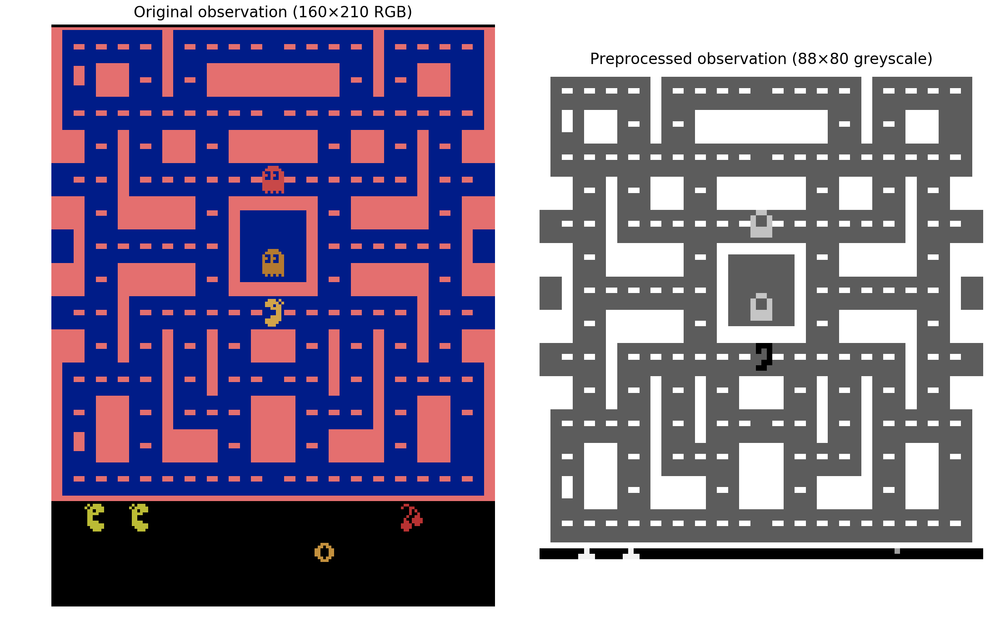

Saving figure preprocessing_plot


In [18]:
plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Original observation (160×210 RGB)")
plt.imshow(obs)
plt.axis("off")
plt.subplot(122)
plt.title("Preprocessed observation (88×80 greyscale)")
plt.imshow(img.reshape(88, 80), interpolation="nearest", cmap="gray")
plt.axis("off")
save_fig("preprocessing_plot")
plt.show()

## Build DQN

Note: instead of using `tf.contrib.layers.convolution2d()` or `tf.contrib.layers.conv2d()` (as in the first version of the book), we now use the `tf.layers.conv2d()`, which did not exist when this chapter was written. This is preferable because anything in contrib may change or be deleted without notice, while `tf.layers` is part of the official API. As you will see, the code is mostly the same, except that the parameter names have changed slightly:
* the `num_outputs` parameter was renamed to `filters`,
* the `stride` parameter was renamed to `strides`,
* the `_fn` suffix was removed from parameter names that had it (e.g., `activation_fn` was renamed to `activation`),
* the `weights_initializer` parameter was renamed to `kernel_initializer`,
* the weights variable was renamed to `"kernel"` (instead of `"weights"`), and the biases variable was renamed from `"biases"` to `"bias"`,
* and the default `activation` is now `None` instead of `tf.nn.relu`.

In [19]:
reset_graph()

input_height = 88
input_width = 80
input_channels = 1
conv_n_maps = [32, 64, 64]
conv_kernel_sizes = [(8,8), (4,4), (3,3)]
conv_strides = [4, 2, 1]
conv_paddings = ["SAME"] * 3 
conv_activation = [tf.nn.relu] * 3
n_hidden_in = 64 * 11 * 10  # conv3 has 64 maps of 11x10 each
n_hidden = 512
hidden_activation = tf.nn.relu
n_outputs = env.action_space.n  # 9 discrete actions are available
initializer = tf.variance_scaling_initializer()

def q_network(X_state, name):
    prev_layer = X_state / 128.0 # scale pixel intensities to the [-1.0, 1.0] range.
    with tf.variable_scope(name) as scope:
        for n_maps, kernel_size, strides, padding, activation in zip(
                conv_n_maps, conv_kernel_sizes, conv_strides,
                conv_paddings, conv_activation):
            prev_layer = tf.layers.conv2d(
                prev_layer, filters=n_maps, kernel_size=kernel_size,
                strides=strides, padding=padding, activation=activation,
                kernel_initializer=initializer)
        last_conv_layer_flat = tf.reshape(prev_layer, shape=[-1, n_hidden_in])
        hidden = tf.layers.dense(last_conv_layer_flat, n_hidden,
                                 activation=hidden_activation,
                                 kernel_initializer=initializer)
        outputs = tf.layers.dense(hidden, n_outputs,
                                  kernel_initializer=initializer)
    trainable_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
                                       scope=scope.name)
    trainable_vars_by_name = {var.name[len(scope.name):]: var
                              for var in trainable_vars}
    return outputs, trainable_vars_by_name

In [20]:
X_state = tf.placeholder(tf.float32, shape=[None, input_height, input_width,
                                            input_channels])
online_q_values, online_vars = q_network(X_state, name="q_networks/online")
target_q_values, target_vars = q_network(X_state, name="q_networks/target")

copy_ops = [target_var.assign(online_vars[var_name])
            for var_name, target_var in target_vars.items()]
copy_online_to_target = tf.group(*copy_ops)

In [21]:
online_vars

{'/conv2d/kernel:0': <tf.Variable 'q_networks/online/conv2d/kernel:0' shape=(8, 8, 1, 32) dtype=float32_ref>,
 '/conv2d/bias:0': <tf.Variable 'q_networks/online/conv2d/bias:0' shape=(32,) dtype=float32_ref>,
 '/conv2d_1/kernel:0': <tf.Variable 'q_networks/online/conv2d_1/kernel:0' shape=(4, 4, 32, 64) dtype=float32_ref>,
 '/conv2d_1/bias:0': <tf.Variable 'q_networks/online/conv2d_1/bias:0' shape=(64,) dtype=float32_ref>,
 '/conv2d_2/kernel:0': <tf.Variable 'q_networks/online/conv2d_2/kernel:0' shape=(3, 3, 64, 64) dtype=float32_ref>,
 '/conv2d_2/bias:0': <tf.Variable 'q_networks/online/conv2d_2/bias:0' shape=(64,) dtype=float32_ref>,
 '/dense/kernel:0': <tf.Variable 'q_networks/online/dense/kernel:0' shape=(7040, 512) dtype=float32_ref>,
 '/dense/bias:0': <tf.Variable 'q_networks/online/dense/bias:0' shape=(512,) dtype=float32_ref>,
 '/dense_1/kernel:0': <tf.Variable 'q_networks/online/dense_1/kernel:0' shape=(512, 9) dtype=float32_ref>,
 '/dense_1/bias:0': <tf.Variable 'q_networks/onl

In [22]:
learning_rate = 0.001
momentum = 0.95

with tf.variable_scope("train"):
    X_action = tf.placeholder(tf.int32, shape=[None])
    y = tf.placeholder(tf.float32, shape=[None, 1])
    q_value = tf.reduce_sum(online_q_values * tf.one_hot(X_action, n_outputs),
                            axis=1, keepdims=True)
    error = tf.abs(y - q_value)
    clipped_error = tf.clip_by_value(error, 0.0, 1.0)
    linear_error = 2 * (error - clipped_error)
    loss = tf.reduce_mean(tf.square(clipped_error) + linear_error)

    global_step = tf.Variable(0, trainable=False, name='global_step')
    optimizer = tf.train.MomentumOptimizer(learning_rate, momentum, use_nesterov=True)
    training_op = optimizer.minimize(loss, global_step=global_step)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

Note: in the first version of the book, the loss function was simply the squared error between the target Q-Values (`y`) and the estimated Q-Values (`q_value`). However, because the experiences are very noisy, it is better to use a quadratic loss only for small errors (below 1.0) and a linear loss (twice the absolute error) for larger errors, which is what the code above computes. This way large errors don't push the model parameters around as much. Note that we also tweaked some hyperparameters (using a smaller learning rate, and using Nesterov Accelerated Gradients rather than Adam optimization, since adaptive gradient algorithms may sometimes be bad, according to this [paper](https://arxiv.org/abs/1705.08292)). We also tweaked a few other hyperparameters below (a larger replay memory, longer decay for the $\epsilon$-greedy policy, larger discount rate, less frequent copies of the online DQN to the target DQN, etc.).

We use this `ReplayMemory` class instead of a `deque` because it is much faster for random access (thanks to @NileshPS who contributed it). Moreover, we default to sampling with replacement, which is much faster than sampling without replacement for large replay memories.

In [23]:
class ReplayMemory:
    def __init__(self, maxlen):
        self.maxlen = maxlen
        self.buf = np.empty(shape=maxlen, dtype=np.object)
        self.index = 0
        self.length = 0
        
    def append(self, data):
        self.buf[self.index] = data
        self.length = min(self.length + 1, self.maxlen)
        self.index = (self.index + 1) % self.maxlen
    
    def sample(self, batch_size, with_replacement=True):
        if with_replacement:
            indices = np.random.randint(self.length, size=batch_size) # faster
        else:
            indices = np.random.permutation(self.length)[:batch_size]
        return self.buf[indices]

In [24]:
replay_memory_size = 500000
replay_memory = ReplayMemory(replay_memory_size)

In [25]:
def sample_memories(batch_size):
    cols = [[], [], [], [], []] # state, action, reward, next_state, continue
    for memory in replay_memory.sample(batch_size):
        for col, value in zip(cols, memory):
            col.append(value)
    cols = [np.array(col) for col in cols]
    return cols[0], cols[1], cols[2].reshape(-1, 1), cols[3], cols[4].reshape(-1, 1)

In [26]:
eps_min = 0.1
eps_max = 1.0
eps_decay_steps = 2000000

def epsilon_greedy(q_values, step):
    epsilon = max(eps_min, eps_max - (eps_max-eps_min) * step/eps_decay_steps)
    if np.random.rand() < epsilon:
        return np.random.randint(n_outputs) # random action
    else:
        return np.argmax(q_values) # optimal action

In [27]:
n_steps = 4000000  # total number of training steps
training_start = 10000  # start training after 10,000 game iterations
training_interval = 4  # run a training step every 4 game iterations
save_steps = 1000  # save the model every 1,000 training steps
copy_steps = 10000  # copy online DQN to target DQN every 10,000 training steps
discount_rate = 0.99
skip_start = 90  # Skip the start of every game (it's just waiting time).
batch_size = 50
iteration = 0  # game iterations
checkpoint_path = "./my_dqn.ckpt"
done = True # env needs to be reset

A few variables for tracking progress:

In [29]:
loss_val = np.infty
game_length = 0
total_max_q = 0
mean_max_q = 0.0

And now the main training loop!

In [30]:
with tf.Session() as sess:
    if os.path.isfile(checkpoint_path + ".index"):
        saver.restore(sess, checkpoint_path)
    else:
        init.run()
        copy_online_to_target.run()
    while True:
        step = global_step.eval()
        if step >= n_steps:
            break
        iteration += 1
        print("\rIteration {}\tTraining step {}/{} ({:.1f})%\tLoss {:5f}\tMean Max-Q {:5f}   ".format(
            iteration, step, n_steps, step * 100 / n_steps, loss_val, mean_max_q), end="")
        if done: # game over, start again
            obs = env.reset()
            for skip in range(skip_start): # skip the start of each game
                obs, reward, done, info = env.step(0)
            state = preprocess_observation(obs)

        # Online DQN evaluates what to do
        q_values = online_q_values.eval(feed_dict={X_state: [state]})
        action = epsilon_greedy(q_values, step)

        # Online DQN plays
        obs, reward, done, info = env.step(action)
        next_state = preprocess_observation(obs)

        # Let's memorize what happened
        replay_memory.append((state, action, reward, next_state, 1.0 - done))
        state = next_state

        # Compute statistics for tracking progress (not shown in the book)
        total_max_q += q_values.max()
        game_length += 1
        if done:
            mean_max_q = total_max_q / game_length
            total_max_q = 0.0
            game_length = 0

        if iteration < training_start or iteration % training_interval != 0:
            continue # only train after warmup period and at regular intervals
        
        # Sample memories and use the target DQN to produce the target Q-Value
        X_state_val, X_action_val, rewards, X_next_state_val, continues = (
            sample_memories(batch_size))
        next_q_values = target_q_values.eval(
            feed_dict={X_state: X_next_state_val})
        max_next_q_values = np.max(next_q_values, axis=1, keepdims=True)
        y_val = rewards + continues * discount_rate * max_next_q_values

        # Train the online DQN
        _, loss_val = sess.run([training_op, loss], feed_dict={
            X_state: X_state_val, X_action: X_action_val, y: y_val})

        # Regularly copy the online DQN to the target DQN
        if step % copy_steps == 0:
            copy_online_to_target.run()

        # And save regularly
        if step % save_steps == 0:
            saver.save(sess, checkpoint_path)

Iteration 16872	Training step 1718/4000000 (0.0)%	Loss 1.136370	Mean Max-Q 0.153248   

KeyboardInterrupt: 

You can interrupt the cell above at any time to test your agent using the cell below. You can then run the cell above once again, it will load the last parameters saved and resume training.

In [31]:
frames = []
n_max_steps = 10000

with tf.Session() as sess:
    saver.restore(sess, checkpoint_path)

    obs = env.reset()
    for step in range(n_max_steps):
        state = preprocess_observation(obs)

        # Online DQN evaluates what to do
        q_values = online_q_values.eval(feed_dict={X_state: [state]})
        action = np.argmax(q_values)

        # Online DQN plays
        obs, reward, done, info = env.step(action)

        img = env.render(mode="rgb_array")
        frames.append(img)

        if done:
            break

INFO:tensorflow:Restoring parameters from ./my_dqn.ckpt


In [32]:
plot_animation(frames)

NameError: name 'plot_animation' is not defined

# Extra material

## Preprocessing for Breakout

Here is a preprocessing function you can use to train a DQN for the Breakout-v0 Atari game:

In [73]:
def preprocess_observation(obs):
    img = obs[34:194:2, ::2] # crop and downsize
    return np.mean(img, axis=2).reshape(80, 80) / 255.0

In [74]:
env = gym.make("Breakout-v0")
obs = env.reset()
for step in range(10):
    obs, _, _, _ = env.step(1)

img = preprocess_observation(obs)

[2017-09-25 13:54:27,989] Making new env: Breakout-v0


<IPython.core.display.Javascript object>


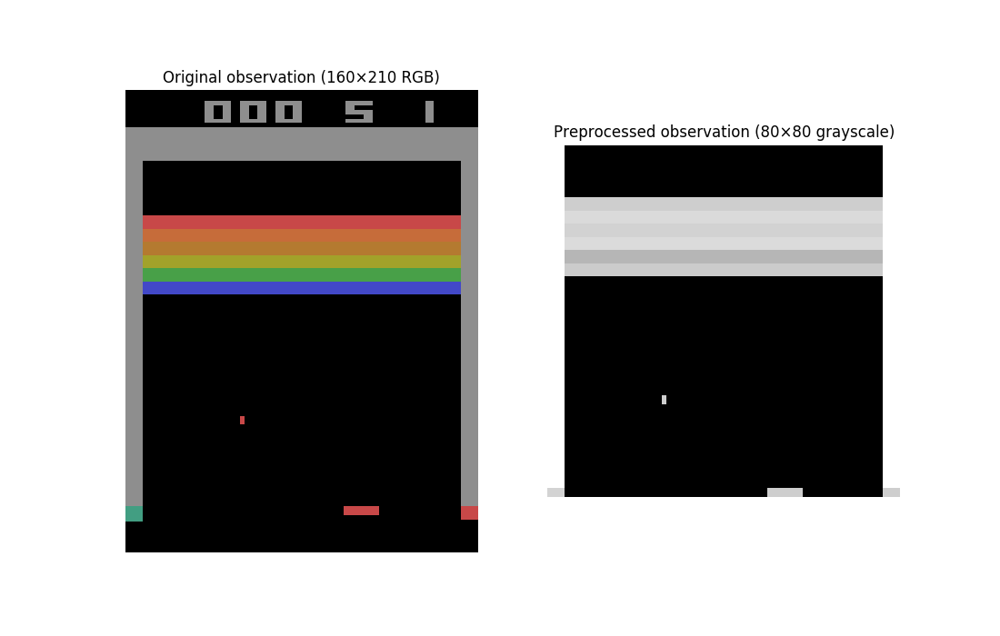

In [75]:
plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Original observation (160×210 RGB)")
plt.imshow(obs)
plt.axis("off")
plt.subplot(122)
plt.title("Preprocessed observation (80×80 grayscale)")
plt.imshow(img, interpolation="nearest", cmap="gray")
plt.axis("off")
plt.show()

As you can see, a single image does not give you the direction and speed of the ball, which are crucial informations for playing this game. For this reason, it is best to actually combine several consecutive observations to create the environment's state representation. One way to do that is to create a multi-channel image, with one channel per recent observation. Another is to merge all recent observations into a single-channel image, using `np.max()`. In this case, we need to dim the older images so that the DQN can distinguish the past from the present.

In [76]:
from collections import deque

def combine_observations_multichannel(preprocessed_observations):
    return np.array(preprocessed_observations).transpose([1, 2, 0])

def combine_observations_singlechannel(preprocessed_observations, dim_factor=0.5):
    dimmed_observations = [obs * dim_factor**index
                           for index, obs in enumerate(reversed(preprocessed_observations))]
    return np.max(np.array(dimmed_observations), axis=0)

n_observations_per_state = 3
preprocessed_observations = deque([], maxlen=n_observations_per_state)

obs = env.reset()
for step in range(10):
    obs, _, _, _ = env.step(1)
    preprocessed_observations.append(preprocess_observation(obs))

<IPython.core.display.Javascript object>


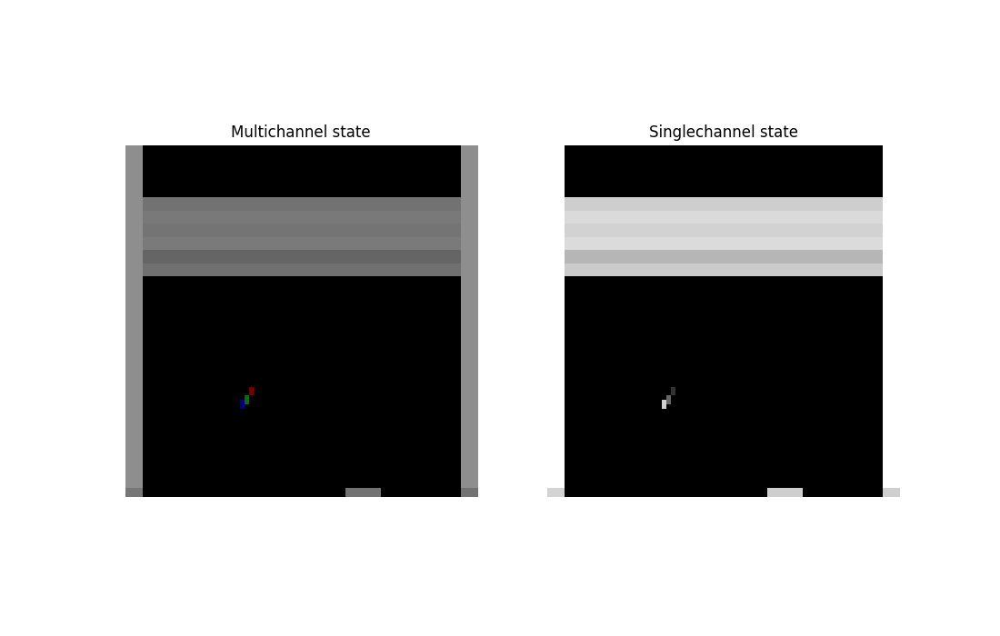

In [77]:
img1 = combine_observations_multichannel(preprocessed_observations)
img2 = combine_observations_singlechannel(preprocessed_observations)

plt.figure(figsize=(11, 7))
plt.subplot(121)
plt.title("Multichannel state")
plt.imshow(img1, interpolation="nearest")
plt.axis("off")
plt.subplot(122)
plt.title("Singlechannel state")
plt.imshow(img2, interpolation="nearest", cmap="gray")
plt.axis("off")
plt.show()

# Exercise solutions

## 1. to 7.

See Appendix A.

## 8. BipedalWalker-v2

Exercise: _Use policy gradients to tackle OpenAI gym's "BipedalWalker-v2"._

In [2]:
import gym

In [3]:
env = gym.make("BipedalWalker-v2")

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.


Note: if you run into [this issue](https://github.com/openai/gym/issues/100) ("`module 'Box2D._Box2D' has no attribute 'RAND_LIMIT'`") when making the `BipedalWalker-v2` environment, then try this workaround:

```
$ pip uninstall Box2D-kengz
$ pip install git+https://github.com/pybox2d/pybox2d
```

In [4]:
obs = env.reset()

In [5]:
img = env.render(mode="rgb_array")

NameError: name 'plt' is not defined

In [7]:
obs

array([ 2.74747680e-03, -9.03668755e-06,  7.02947527e-04, -1.59999382e-02,
        9.20267552e-02, -9.27650079e-04,  8.60229969e-01,  2.08858152e-03,
        1.00000000e+00,  3.24313007e-02, -9.27586399e-04,  8.53781641e-01,
        6.56043800e-04,  1.00000000e+00,  4.40814018e-01,  4.45820123e-01,
        4.61422771e-01,  4.89550203e-01,  5.34102798e-01,  6.02461040e-01,
        7.09148884e-01,  8.85931849e-01,  1.00000000e+00,  1.00000000e+00])

You can find the meaning of each of these 24 numbers in the [documentation](https://github.com/openai/gym/wiki/BipedalWalker-v2).

In [8]:
env.action_space

Box(4,)

In [9]:
env.action_space.low

array([-1., -1., -1., -1.], dtype=float32)

In [10]:
env.action_space.high

array([1., 1., 1., 1.], dtype=float32)

This is a 4D continuous action space controling each leg's hip torque and knee torque (from -1 to 1). To deal with a continuous action space, one method is to discretize it. For example, let's limit the possible torque values to these 3 values: -1.0, 0.0, and 1.0. This means that we are left with $3^4=81$ possible actions.

In [16]:
from itertools import product
import numpy as np

In [17]:
possible_torques = np.array([-1.0, 0.0, 1.0])
possible_actions = np.array(list(product(possible_torques, possible_torques, possible_torques, possible_torques)))
possible_actions.shape

(81, 4)

In [18]:
import tensorflow as tf
tf.reset_default_graph()

# 1. Specify the network architecture
n_inputs = env.observation_space.shape[0]  # == 24
n_hidden = 10
n_outputs = len(possible_actions) # == 625
initializer = tf.variance_scaling_initializer()

# 2. Build the neural network
X = tf.placeholder(tf.float32, shape=[None, n_inputs])

hidden = tf.layers.dense(X, n_hidden, activation=tf.nn.selu,
                         kernel_initializer=initializer)
logits = tf.layers.dense(hidden, n_outputs,
                         kernel_initializer=initializer)
outputs = tf.nn.softmax(logits)

# 3. Select a random action based on the estimated probabilities
action_index = tf.squeeze(tf.multinomial(logits, num_samples=1), axis=-1)

# 4. Training
learning_rate = 0.01

y = tf.one_hot(action_index, depth=len(possible_actions))
cross_entropy = tf.nn.softmax_cross_entropy_with_logits_v2(labels=y, logits=logits)
optimizer = tf.train.AdamOptimizer(learning_rate)
grads_and_vars = optimizer.compute_gradients(cross_entropy)
gradients = [grad for grad, variable in grads_and_vars]
gradient_placeholders = []
grads_and_vars_feed = []
for grad, variable in grads_and_vars:
    gradient_placeholder = tf.placeholder(tf.float32, shape=grad.get_shape())
    gradient_placeholders.append(gradient_placeholder)
    grads_and_vars_feed.append((gradient_placeholder, variable))
training_op = optimizer.apply_gradients(grads_and_vars_feed)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

Let's try running this policy network, although it is not trained yet.

In [21]:
def run_bipedal_walker(model_path=None, n_max_steps = 1000):
    env = gym.make("BipedalWalker-v2")
    frames = []
    with tf.Session() as sess:
        if model_path is None:
            init.run()
        else:
            saver.restore(sess, model_path)
        obs = env.reset()
        for step in range(n_max_steps):
            img = env.render(mode="rgb_array")
            frames.append(img)
            action_index_val = action_index.eval(feed_dict={X: obs.reshape(1, n_inputs)})
            action = possible_actions[action_index_val]
            obs, reward, done, info = env.step(action[0])
            if done:
                break
    env.close()
    return frames

In [22]:
frames = run_bipedal_walker()
 

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.


In [ ]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    plt.close()  # or else nbagg sometimes plots in the previous cell
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    return animation.FuncAnimation(fig, update_scene, fargs=(frames, patch), frames=len(frames), repeat=repeat, interval=interval)

Nope, it really can't walk. So let's train it!

In [25]:
n_games_per_update = 10
n_max_steps = 1000
n_iterations = 1000
save_iterations = 10
discount_rate = 0.95

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        print("\rIteration: {}/{}".format(iteration + 1, n_iterations), end="")
        all_rewards = []
        all_gradients = []
        for game in range(n_games_per_update):
            current_rewards = []
            current_gradients = []
            obs = env.reset()
            for step in range(n_max_steps):
                action_index_val, gradients_val = sess.run([action_index, gradients],
                                                           feed_dict={X: obs.reshape(1, n_inputs)})
                action = possible_actions[action_index_val]
                obs, reward, done, info = env.step(action[0])
                current_rewards.append(reward)
                current_gradients.append(gradients_val)
                if done:
                    break
            all_rewards.append(current_rewards)
            all_gradients.append(current_gradients)

        all_rewards = discount_and_normalize_rewards(all_rewards, discount_rate=discount_rate)
        feed_dict = {}
        for var_index, gradient_placeholder in enumerate(gradient_placeholders):
            mean_gradients = np.mean([reward * all_gradients[game_index][step][var_index]
                                      for game_index, rewards in enumerate(all_rewards)
                                          for step, reward in enumerate(rewards)], axis=0)
            feed_dict[gradient_placeholder] = mean_gradients
        sess.run(training_op, feed_dict=feed_dict)
        if iteration % save_iterations == 0:
            saver.save(sess, "./my_bipedal_walker_pg.ckpt")

Iteration: 21/1000

KeyboardInterrupt: 

In [26]:
frames = run_bipedal_walker("./my_bipedal_walker_pg.ckpt")
video = plot_animation(frames)
plt.show()

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
INFO:tensorflow:Restoring parameters from ./my_bipedal_walker_pg.ckpt


NameError: name 'plot_animation' is not defined

Not the best walker, but at least it stays up and makes (slow) progress to the right.
A better solution for this problem is to use an actor-critic algorithm, as it does not require discretizing the action space, and it converges much faster. Check out this nice [blog post](https://towardsdatascience.com/reinforcement-learning-w-keras-openai-actor-critic-models-f084612cfd69) by Yash Patel for more details.

## 9.

**Coming soon**